# Tutorial for utilizing QSOP codebase 
This notebook will demonstrate how to use the classes and functions in the QSOP directory. Specifically, how to:  
1. Retrieve included .g6 files of varying order graphs and convert them to networkx graph structures 

2. Specify which graph problem is to be analyzed in a given run

3. Convert the graph structure to a Boolean instance of the desired graph problem 

4. Convert the Boolean instance into an equal but reconstructed Exclusive Sum of Products (ESOP) form.

5. Construct a quantum oracle from the ESOP expansion. 

As well as some other pertinent details, such as: 
- The structure of the codebase 
- Necessary machine configuration for use 
- Current status of operation/improvement


## The Structure of the Codebase
The directory has several important files and folders, which I will detail here: 

**FOLDERS**: 

*<u>xgraphFiles</u>*: This folder contains 7 .g6 files, named "graph(n)c.g6", where (n) is the order of the graphs in that file ranging from 3 to 9. Each line in the file represents a unique connected graph of (n) nodes. 
For example, graph3c.g6 has two lines for the only two graphs of 3 nodes, while graph6c.g6 has information for 112, 6-node graphs. 

*<u>ESOPsimple</u>*: This folder contains the dependencies and necessary overhead for running the easy.c++ code that is detailed later in this notebook. 
Most imortantly, this folder contains *esopTest.cpp* and *between.txt*, which are the key files in using the easy.c++ to convert Boolean Instances to ESOPs. 

**FILES**: 

*<u>oracle.py</u>*: This is arguably the most important file for the first half of the pipeline. It contains *GraphGenerator* and *BooleanInstance* classes which will be detailed on later. 

*<u>sympy_esop_to_qcirc_t.py</u>*: Contains class *ESOPQuantumCircuit* for converting the ESOPs into quantum oracles. 

*<u>oracle_and_gm_qaoa.py</u>*: Contains classes *StatePrep* and *GMQAOA* for constructing full quantum circuits for GM-QAOA around the oracles produced from the previous class, as well as for running them. 

*<u>full_pipeline.py</u>* : a file that implements the whole pipeline from graph to Quantum Circuit, and is set up for analysis of *entire groups* of k-node graphs. 


## NECESSARY NON-NATIVE PYTHON AND C++ LIBRARIES: 

PYTHON:  
- sympy 
- networkx
- matplotlib
- qiskit 

C++: 
- g++ compiler with QSOP directory in PATH for compilation
- native g++ library files (vector, fstream...) 




# TUTORIAL ON USING QSOP 

Firstly, we need to grab a graph (or many graphs) from the .g6 files in the directory. 
We can do this by creating a *GraphGenerator* class instance and using the **createKgraphs(int k)** function to generate an array of networkx graphs of order "k".
GraphGenerator() has no contructor arguments.

In [6]:
from oracle import GraphGenerator, BooleanInstance

#desired # of nodes 
k = 6

graphGetter = GraphGenerator()
graphArray = graphGetter.createKgraphs(k) 

print(len(graphArray))
#notice that there are 6 graphs of 4 nodes, and this array has each of them 

112


We can choose a specific graph from the graphArray and print it using:

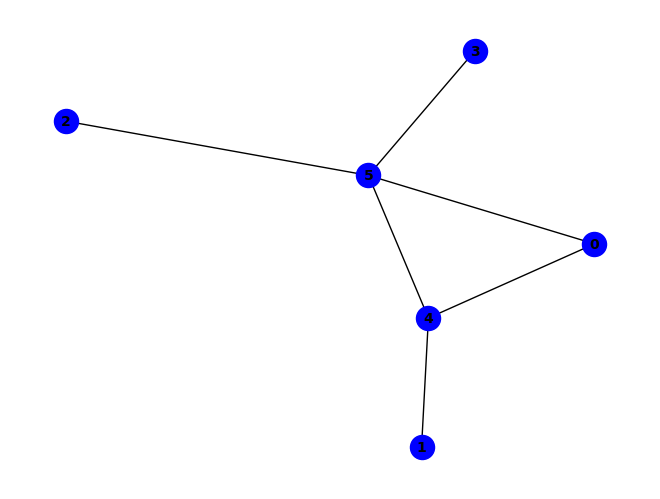

In [7]:
#choose which graph of k nodes to assign to instance

graphNumber = 5  #[0,len(graphArray)]
chosenGraph = graphGetter.chooseGraph(graphNumber)
graphGetter.printGraph()

#note that to print a specific graph you must assign it to the generator first 

Now, we must create a Boolean instance of the graph for the specific problem we wish to analyze. 
This is done by understanding that: 
- *For set-covering graph problems, like Minimum Vertex Cover, Maximum Independent Set, and Max-K Colorable, we can specify a node inclusion and exclusion via boolean bitstring representation.*

For instance, consider the graph above on four verticies for the Minimum Vertex Cover problem. We can assign each vertex a boolean variable and specify it's **exclusion** from the set-cover via negation. We can then define a function to accept a bitstring representation and give a TRUE or FALSE. So for the graph above, we can specify $x_0$,$x_1$,$x_2$,$x_3$ as the boolean variables, with $\neg{x_n}$ signifying exclusion (negation) from the set. So a cover here would be: $\neg{x_0} \land \neg{x_1} \land x_2 \land x_3$. Another one would be: $x_0 \land \neg{x_1} \land \neg{x_2} \land x_3$, or even: $x_0 \land x_1 \land x_2 \land x_3$(although it is not optimal, it is a cover).

We know that the Boolean instances for a graph G are: 
- Vertex_Cover($x_1,x_2,...,x_k$) = $\bigwedge_{x_i,x_j \in E}{(x_i \lor x_j)}$
- Independent_Set($x_1,x_2,...,x_k$) = $\bigwedge_{x_i,x_j \in E}{\neg(x_i \land x_j)}$ = $\bigwedge_{x_i,x_j \in E}{\neg{x_i}  \lor \neg{x_j}}$
And these expressions will only be true if the given labeling is a true Vertex Cover or Independent Set, respectively.

*__oracle.py__* has a class called *BooleanInstance* which will take in a networkx graph, a problem ("MIS", "MVC", "MKC") and produce a Sympy expression for it using these formulas.
.getTT() will return the minterms of where this expression is true.

We can then use the .getRM(string *polarity*) and  .produceExpression(Sympy object *expression*) function to produce our final ESOP using the easy.c++ library and *__esopTest.cpp__*

NOTE: the *polarity* argument may be "positive" or "mixed", which just determines whether to have negations in the ESOP. Mixed is usually shorter. 


In [8]:
misExpression = BooleanInstance("MIS", chosenGraph)
minterms = misExpression.getTT() #returns minterms and adds TT attribute to instance
print(minterms)

RM = misExpression.getRM("mixed")
ESOP = misExpression.produceExpression(RM)
print(ESOP)

['000000', '000001', '000010', '000100', '000110', '001000', '001010', '001100', '001110', '010000', '010001', '010100', '011000', '011100', '100000', '100100', '101000', '101100', '110000', '110100', '111000', '111100']

(e & ~f) ^ (~b & ~e) ^ (a & e & ~d) ^ (a & f & ~d) ^ (b & f & ~e) ^ (d & f & ~e) ^ (a & c & d & e) ^ (a & c & d & f) ^ (b & ~a & ~f) ^ (a & c & f & ~e) ^ (a & b & ~e & ~f) ^ (c & f & ~d & ~e) ^ (a & d & e & ~c & ~f)


And there we have it... but are these really accurate though? Let's find out.
What I can do is take the minterms as Boolean Strings and run them through the ESOP to see if they produce a TRUE also for each. 

In [9]:
#idea here is to parse the ESOP, converting the letters to the current Minterm state ( 0 or 1), 
# collect each set of Products in parens, evaluate them, and then Xor them together 

def BooleanInstanceTest(esop, minTerms):
    conv = {}
    varis = ['a','b','c','d','e','f','g','h','i','j','k']
    ESOPconv = str(esop) 
    print(esop)
    for minterm in minTerms:
        i = 0
        p = 0
        while p < len(str(minterm)):
            conv[varis[p]] = int(minterm[p])       #convert bool vars to 1's or 0's 
            p+=1

        toBeXored = []
        toBeAnded = []

        
        if ESOPconv[0].isalpha():
            toBeXored.append(conv[ESOPconv[0]])             #these two lines deal with a leading single variable 
            i+=2
        elif ESOPconv[0] == '~':
            toBeXored.append((conv[ESOPconv[1]] + 1) % 2)
            i+= 2
            
        
        while i < len(ESOPconv):
            if ESOPconv[i] == '(':   #look for open paren, once found, parse out products, 
                i+=1
                while ESOPconv[i] != ')':                  
                    if (ESOPconv[i].isalpha()):
                        toBeAnded.append(conv[ESOPconv[i]])
                        i+=1
                    elif ESOPconv[i] == '~':
                        toBeAnded.append(((conv[ESOPconv[i + 1]]) + 1) % 2) # adding 1 and the modding 2 is the same as negation
                        i+=2
                    else: 
                        i+=1
                j = 1
                first = toBeAnded[0]
                while j < len(toBeAnded):
                    first &= toBeAnded[j]      #AND every term in the product
                    j+=1
                toBeXored.append(first)  #add to list to be XORED 
                toBeAnded = []
            else:
                i+=1
                
        #XOR the anded products        
        l = 1
        firstX = toBeXored[0]
        while l < len(toBeXored):
            firstX ^= toBeXored[l]
            l+=1
        print("PASS") if firstX else print("FAIL")
        
    return  firstX

So now we may verify the ESOP's adherance to the original BooleanInstance's truth values for any graph and problem

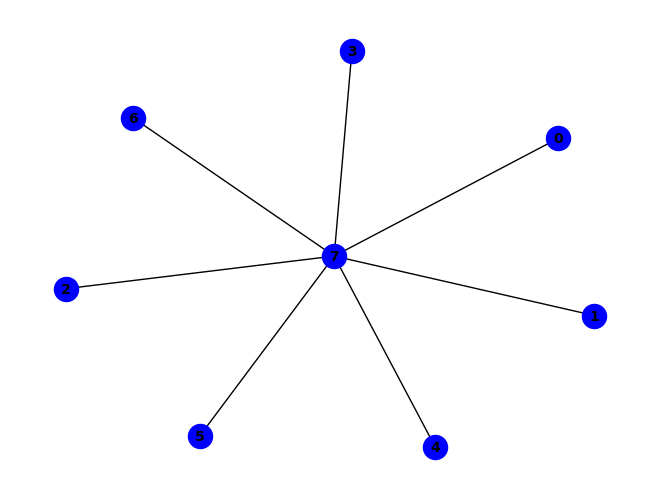


~g ^ (c & g & ~f) ^ (c & h & ~f) ^ (g & ~c & ~h) ^ (b & h & ~e & ~g) ^ (e & h & ~f & ~g) ^ (f & h & ~b & ~g) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (c & d & e & f & g & ~h) ^ (a & b & e & h & ~d & ~g) ^ (b & e & f & h & ~a & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & h & ~d & ~f & ~g) ^ (c & d & h & ~b & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (b & c & d & e & h & ~f & ~g) ^ (d & h & ~b & ~e & ~f & ~g) ^ (a & b & d & e & f & h & ~c & ~g) ^ (b & c & h & ~a & ~e & ~f & ~g) ^ (a & h & ~c & ~d & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


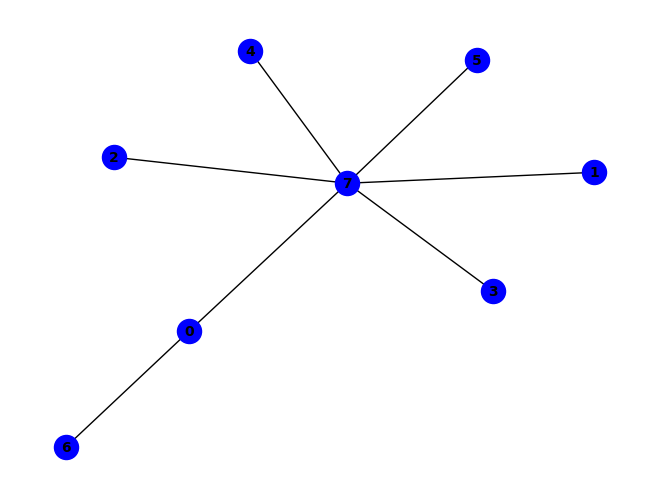


~f ^ (a & g & ~h) ^ (b & f & ~e) ^ (b & h & ~e) ^ (f & ~b & ~h) ^ (a & h & ~d & ~f) ^ (d & h & ~e & ~f) ^ (e & h & ~a & ~f) ^ (a & d & e & h & ~f) ^ (b & d & e & f & ~c) ^ (b & d & e & h & ~c) ^ (b & d & h & ~c & ~f) ^ (b & e & f & ~d & ~h) ^ (b & c & d & e & f & ~h) ^ (a & b & h & ~d & ~e & ~f) ^ (b & c & h & ~a & ~e & ~f) ^ (a & b & c & d & h & ~e & ~f) ^ (c & h & ~a & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


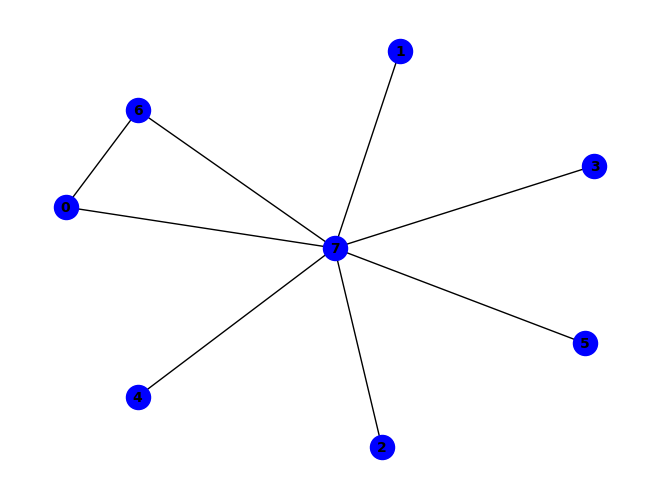


~g ^ (a & g & ~f) ^ (a & h & ~f) ^ (c & g & ~f) ^ (c & h & ~f) ^ (g & ~c & ~h) ^ (f & h & ~b & ~g) ^ (a & b & f & g & ~e) ^ (a & b & f & h & ~e) ^ (b & e & f & h & ~g) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (a & f & g & ~b & ~h) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (a & b & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (b & h & ~a & ~e & ~g) ^ (e & h & ~a & ~f & ~g) ^ (a & c & h & ~e & ~f & ~g) ^ (c & d & h & ~b & ~f & ~g) ^ (b & c & d & e & h & ~f & ~g) ^ (d & h & ~b & ~e & ~f & ~g) ^ (b & c & h & ~a & ~e & ~f & ~g) ^ (a & d & h & ~b & ~c & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

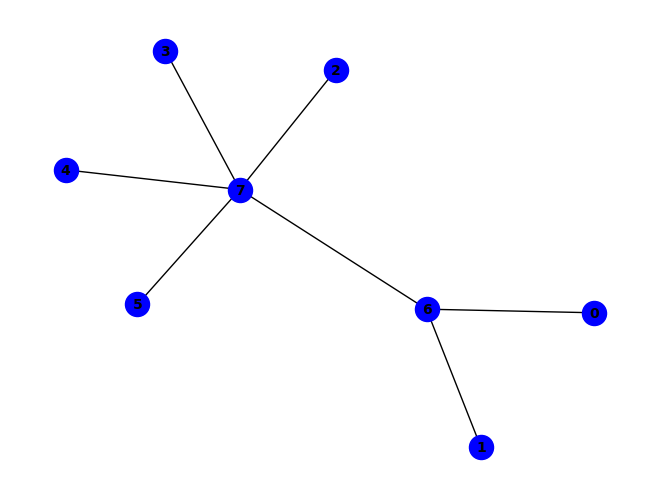


(~b & ~g) ^ (a & g & ~h) ^ (b & h & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & h & ~g) ^ (b & ~a & ~h) ^ (g & ~c & ~h) ^ (a & b & ~g & ~h) ^ (e & h & ~f & ~g) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (c & d & h & ~f & ~g) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (c & d & e & f & g & ~h) ^ (d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


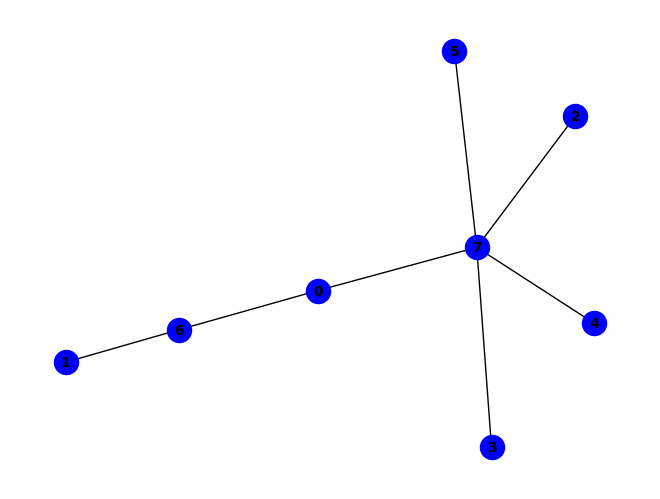


~f ^ (a & b & g) ^ (a & g & ~h) ^ (b & g & ~f) ^ (f & ~b & ~h) ^ (a & h & ~d & ~f) ^ (d & h & ~e & ~f) ^ (e & h & ~a & ~f) ^ (a & d & e & h & ~f) ^ (b & d & f & h & ~e) ^ (b & d & g & h & ~e) ^ (b & e & g & h & ~f) ^ (b & d & f & ~e & ~g) ^ (a & b & e & g & h & ~d) ^ (a & b & f & g & h & ~e) ^ (a & b & c & d & e & g & h) ^ (b & f & ~d & ~g & ~h) ^ (b & d & e & f & ~g & ~h) ^ (a & b & c & g & h & ~e & ~f) ^ (a & b & d & g & h & ~c & ~f) ^ (a & b & d & e & f & g & h & ~c) ^ (c & h & ~a & ~d & ~e & ~f) ^ (b & c & g & h & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


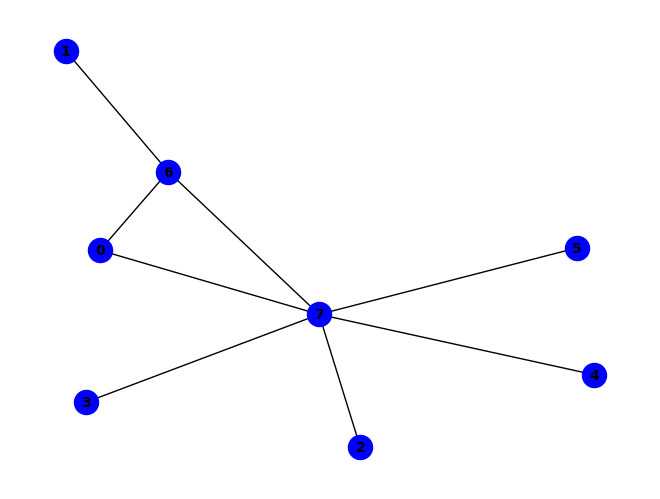


(~b & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (b & h & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & h & ~g) ^ (b & ~a & ~h) ^ (g & ~c & ~h) ^ (a & f & g & ~h) ^ (a & b & ~g & ~h) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (c & d & e & f & g & ~h) ^ (e & h & ~a & ~f & ~g) ^ (a & c & h & ~e & ~f & ~g) ^ (c & d & h & ~a & ~f & ~g) ^ (a & c & d & e & h & ~f & ~g) ^ (d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


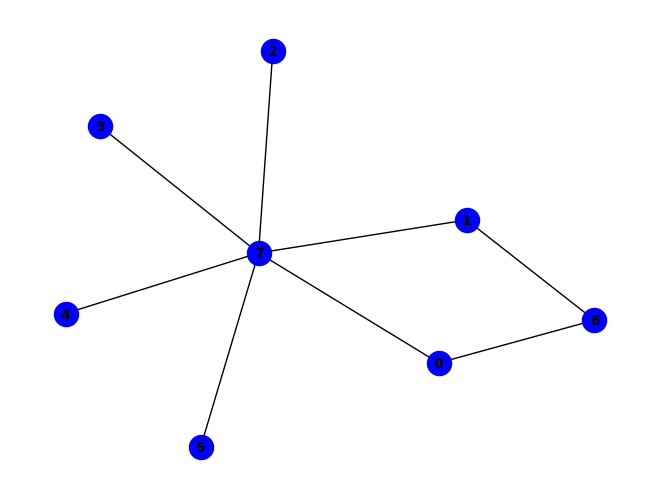


~f ^ (b & f & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (f & ~b & ~h) ^ (a & g & ~b & ~h) ^ (a & h & ~d & ~f) ^ (d & h & ~e & ~f) ^ (e & h & ~a & ~f) ^ (a & d & e & h & ~f) ^ (b & d & e & f & ~c) ^ (b & d & e & h & ~c) ^ (b & d & h & ~c & ~f) ^ (b & e & f & ~d & ~h) ^ (b & c & d & e & f & ~h) ^ (a & b & h & ~d & ~e & ~f) ^ (b & c & h & ~a & ~e & ~f) ^ (a & b & c & d & h & ~e & ~f) ^ (c & h & ~a & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


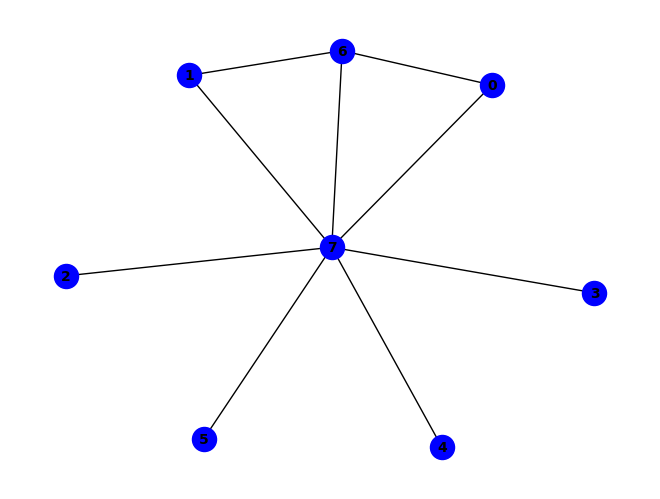


~g ^ (b & g & ~f) ^ (b & h & ~f) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & h & ~g) ^ (g & ~c & ~h) ^ (b & f & g & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (a & f & g & ~b & ~h) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (c & d & e & f & g & ~h) ^ (e & h & ~b & ~f & ~g) ^ (a & c & h & ~e & ~f & ~g) ^ (c & d & h & ~b & ~f & ~g) ^ (a & c & d & e & h & ~f & ~g) ^ (d & h & ~b & ~e & ~f & ~g) ^ (a & d & h & ~b & ~c & ~f & ~g) ^ (a & e & h & ~b & ~d & ~f & ~g) ^ (b & c & h & ~a & ~e & ~f & ~g) ^ (b & c & d & e & h & ~a & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


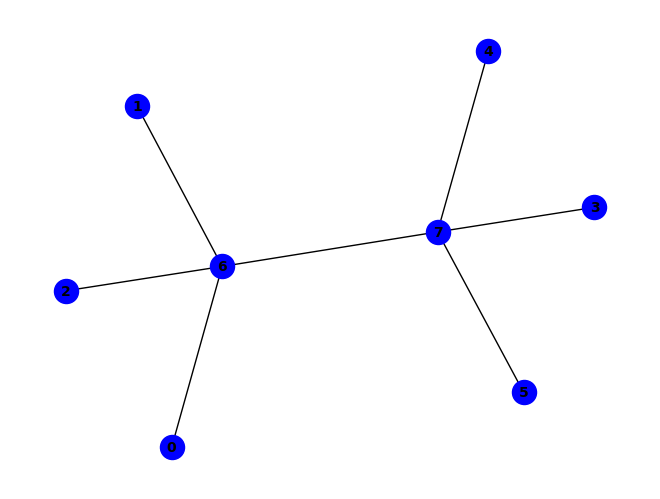


(~c & ~g) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~b & ~h) ^ (g & ~b & ~h) ^ (b & c & ~g & ~h) ^ (e & h & ~f & ~g) ^ (a & g & ~b & ~c & ~h) ^ (d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


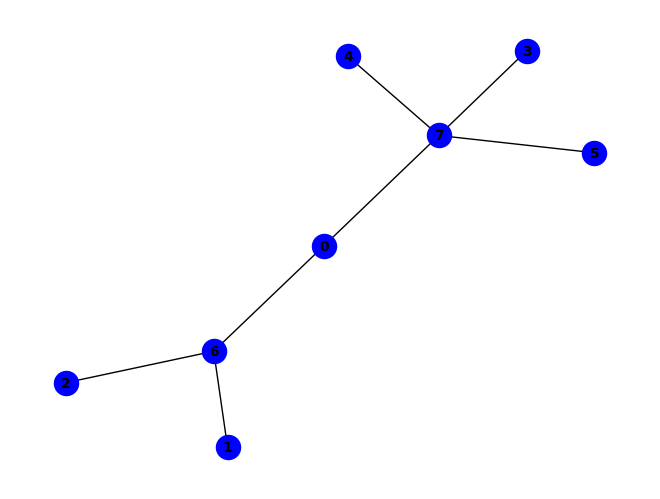


~f ^ (a & b & g) ^ (a & g & ~h) ^ (b & g & ~f) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (a & b & f & g & h) ^ (b & f & ~g & ~h) ^ (c & g & ~a & ~b) ^ (d & h & ~e & ~f) ^ (c & d & g & h & ~e) ^ (c & f & g & h & ~d) ^ (a & c & e & g & h & ~d) ^ (a & c & f & g & h & ~e) ^ (b & c & f & g & h & ~a) ^ (a & h & ~d & ~e & ~f) ^ (b & d & g & h & ~c & ~f) ^ (b & e & g & h & ~d & ~f) ^ (c & e & g & h & ~b & ~f) ^ (c & d & e & f & g & h & ~a) ^ (a & b & d & g & h & ~e & ~f) ^ (a & b & e & g & h & ~c & ~f) ^ (a & c & d & g & h & ~b & ~f) ^ (b & c & d & e & g & h & ~a & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


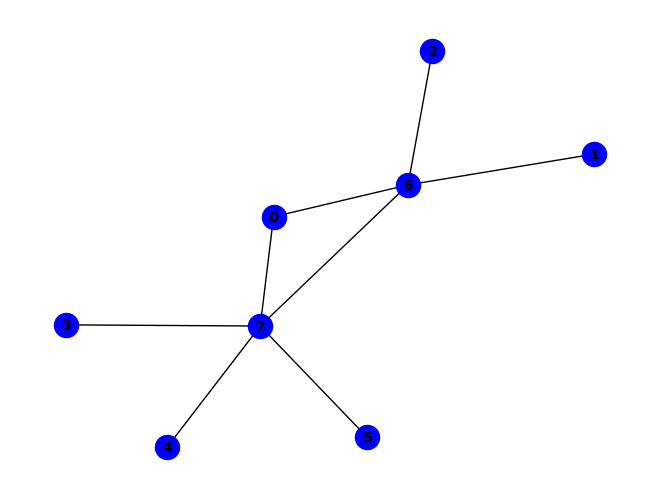


(~c & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (f & h & ~g) ^ (g & ~b & ~h) ^ (a & b & g & ~h) ^ (a & f & g & ~h) ^ (a & c & ~b & ~g) ^ (b & c & ~g & ~h) ^ (c & h & ~a & ~g) ^ (a & b & c & h & ~g) ^ (c & ~a & ~b & ~h) ^ (e & h & ~a & ~f & ~g) ^ (d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


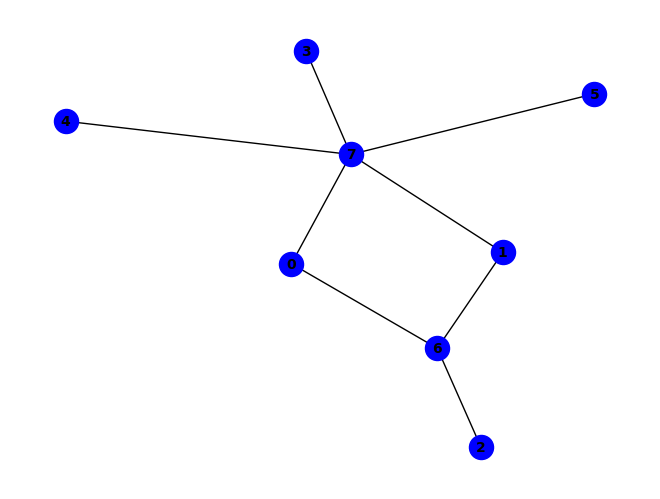


~f ^ (b & f & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (b & e & f & ~h) ^ (a & g & ~b & ~h) ^ (c & g & ~a & ~b) ^ (a & c & d & g & h & ~e) ^ (a & c & e & g & h & ~f) ^ (a & c & f & g & h & ~d) ^ (d & h & ~b & ~e & ~f) ^ (c & d & g & h & ~b & ~e) ^ (c & e & g & h & ~b & ~f) ^ (c & f & g & h & ~b & ~d) ^ (a & b & c & d & g & h & ~f) ^ (a & b & c & e & g & h & ~d) ^ (a & b & c & f & g & h & ~e) ^ (a & h & ~b & ~d & ~e & ~f) ^ (c & d & e & f & g & h & ~a & ~b)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


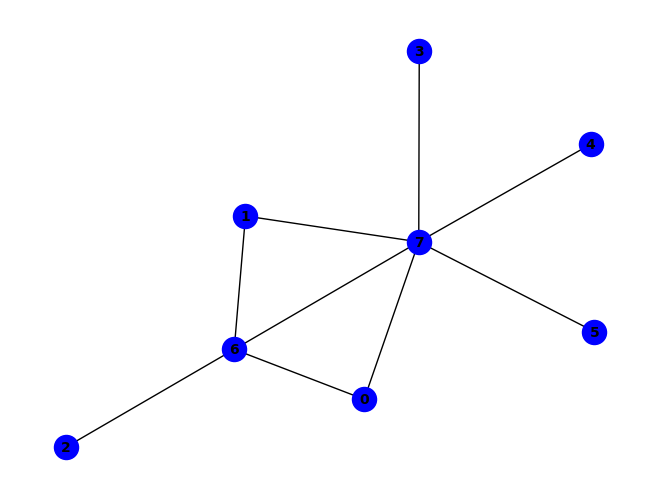


(g & ~h) ^ (~c & ~g) ^ (b & g & ~f) ^ (b & h & ~f) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~b & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (b & c & ~g & ~h) ^ (e & h & ~f & ~g) ^ (a & b & f & g & ~h) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (a & c & g & ~b & ~h) ^ (a & d & h & ~f & ~g) ^ (a & e & h & ~d & ~g) ^ (a & f & g & ~e & ~h) ^ (b & e & h & ~d & ~g) ^ (b & f & g & ~e & ~h) ^ (a & d & e & f & g & ~h) ^ (b & d & e & f & g & ~h) ^ (d & h & ~e & ~f & ~g) ^ (b & d & h & ~a & ~f & ~g) ^ (a & b & e & h & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


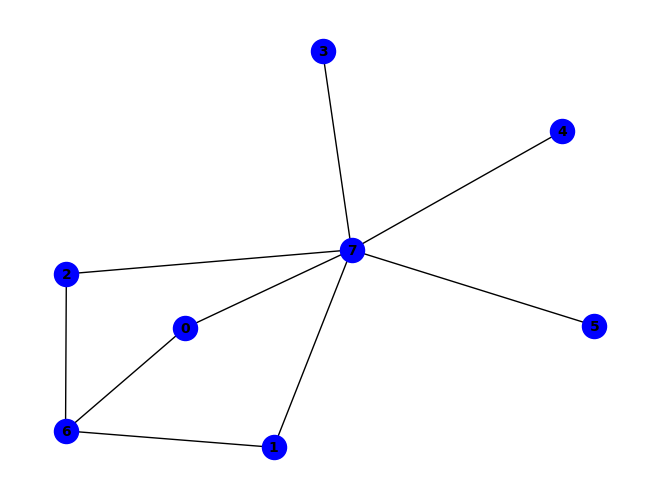


~f ^ (b & f & ~e) ^ (b & h & ~e) ^ (c & g & ~h) ^ (f & ~b & ~h) ^ (b & c & g & ~a) ^ (a & g & ~c & ~h) ^ (a & h & ~d & ~f) ^ (b & g & ~a & ~h) ^ (d & h & ~e & ~f) ^ (e & h & ~a & ~f) ^ (a & d & e & h & ~f) ^ (b & c & f & h & ~a) ^ (b & d & e & f & ~c) ^ (b & d & e & h & ~c) ^ (b & c & h & ~a & ~g) ^ (b & d & h & ~c & ~f) ^ (b & e & f & ~d & ~h) ^ (b & c & d & e & f & ~h) ^ (b & c & e & h & ~a & ~f) ^ (a & b & h & ~d & ~e & ~f) ^ (a & b & c & d & h & ~e & ~f) ^ (c & h & ~a & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


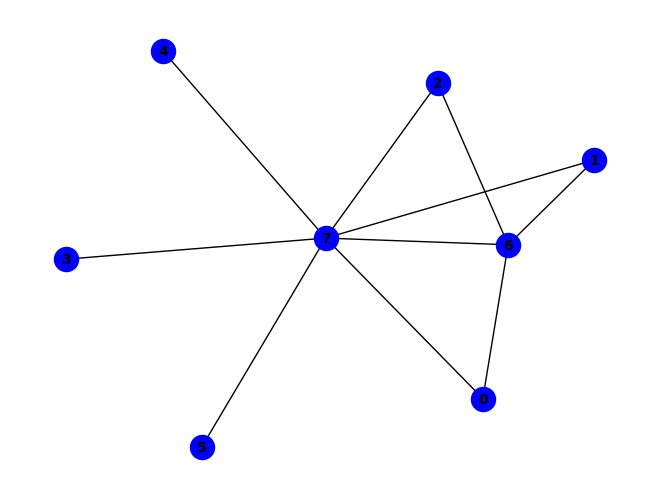


~g ^ (g & ~h) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & h & ~g) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (a & f & g & ~c & ~h) ^ (b & f & g & ~c & ~h) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & e & f & g & ~d) ^ (a & b & e & f & h & ~d) ^ (c & d & e & f & g & ~h) ^ (a & b & c & d & e & f & g) ^ (a & b & c & d & e & f & h) ^ (b & g & ~a & ~c & ~f) ^ (b & h & ~a & ~c & ~f) ^ (e & h & ~b & ~f & ~g) ^ (a & b & e & h & ~d & ~g) ^ (a & b & f & g & ~e & ~h) ^ (a & b & c & d & e & h & ~g) ^ (c & d & h & ~b & ~f & ~g) ^ (a & b & c & e & h & ~f & ~g) ^ (d & h & ~b & ~e & ~f & ~g) ^ (b & c & e & h & ~d & ~f & ~g) ^ (a & b & d & e & f & g & ~c & ~h) ^ (a & d & h & ~b & ~c & ~f & ~g) ^ (a & e & h & ~c & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


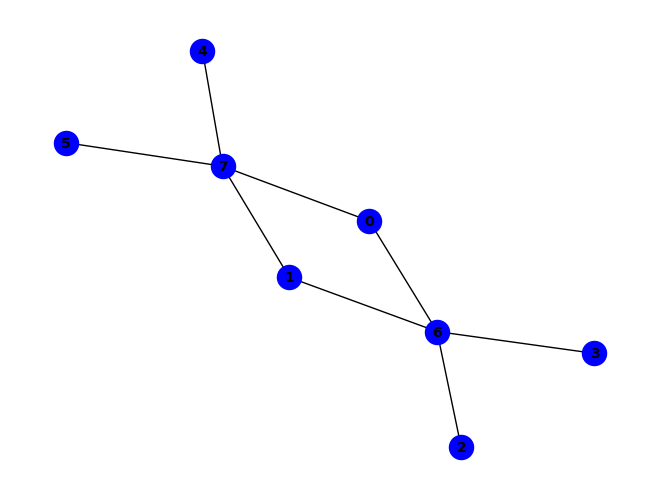


~f ^ (a & g & ~h) ^ (b & f & ~e) ^ (b & h & ~e) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (b & e & f & ~h) ^ (b & g & ~a & ~h) ^ (d & g & ~a & ~b) ^ (c & f & g & h & ~d) ^ (d & e & g & h & ~c) ^ (d & f & g & h & ~e) ^ (a & c & e & g & h & ~d) ^ (a & c & f & g & h & ~e) ^ (b & c & f & g & h & ~a) ^ (b & d & f & g & h & ~c) ^ (a & h & ~b & ~e & ~f) ^ (c & g & ~a & ~b & ~d) ^ (c & e & g & h & ~b & ~f) ^ (c & d & e & f & g & h & ~a) ^ (a & d & e & g & h & ~b & ~f) ^ (a & d & f & g & h & ~b & ~c) ^ (b & d & e & g & h & ~c & ~f) ^ (a & b & c & e & g & h & ~d & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


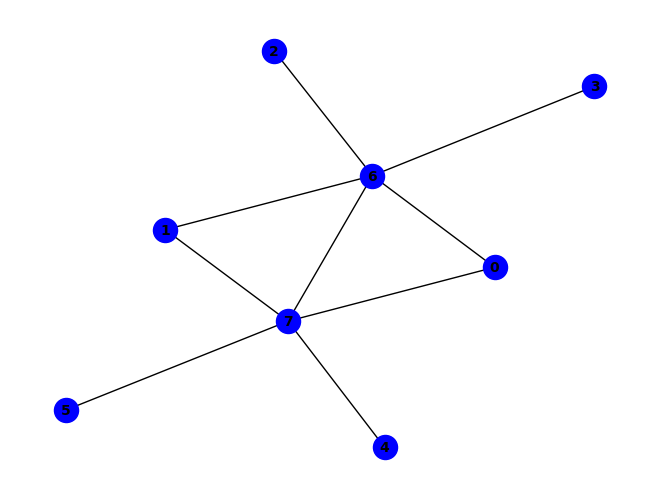


(~d & ~g) ^ (b & g & ~f) ^ (b & h & ~f) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (b & c & g & ~h) ^ (b & f & g & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (c & d & ~g & ~h) ^ (a & c & g & ~b & ~h) ^ (a & f & g & ~b & ~h) ^ (b & d & g & ~c & ~h) ^ (a & d & g & ~b & ~c & ~h) ^ (e & h & ~a & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


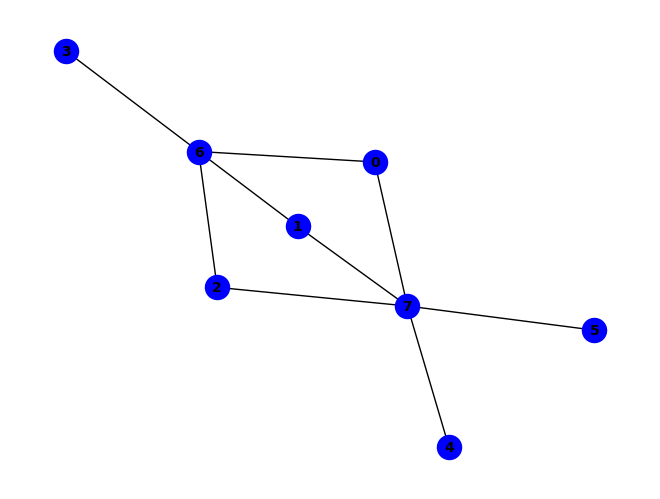


~f ^ (a & g & ~h) ^ (b & f & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (a & b & g & ~d) ^ (a & b & h & ~g) ^ (a & c & g & ~b) ^ (b & e & f & ~h) ^ (a & b & c & d & g) ^ (a & h & ~e & ~f) ^ (b & g & ~c & ~d) ^ (b & h & ~c & ~g) ^ (c & h & ~e & ~f) ^ (d & g & ~a & ~c) ^ (a & c & e & h & ~f) ^ (a & c & f & h & ~d) ^ (b & c & f & h & ~e) ^ (a & c & h & ~b & ~g) ^ (b & e & h & ~c & ~d) ^ (a & d & f & g & h & ~e) ^ (b & d & f & g & h & ~c) ^ (a & c & d & e & f & g & h) ^ (a & b & e & h & ~c & ~f) ^ (a & b & f & h & ~c & ~d) ^ (d & e & g & h & ~a & ~c) ^ (d & f & g & h & ~c & ~e) ^ (a & b & d & e & g & h & ~c) ^ (a & b & d & f & h & ~e & ~g) ^ (a & c & d & f & h & ~b & ~g) ^ (b & d & e & f & h & ~a & ~c) ^ (a & b & c & d & e & f & h & ~g) ^ (b & d & e & h & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

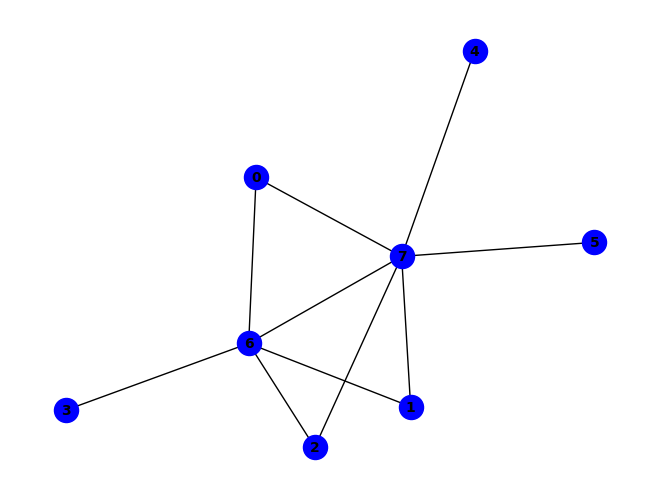


(g & ~h) ^ (~d & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & h & ~c & ~f) ^ (b & g & ~c & ~f) ^ (c & d & ~g & ~h) ^ (c & e & f & g & ~b) ^ (c & e & f & h & ~b) ^ (a & f & g & ~c & ~h) ^ (b & d & g & ~c & ~h) ^ (c & e & h & ~b & ~g) ^ (c & f & g & ~e & ~h) ^ (b & c & e & f & g & ~h) ^ (a & g & ~b & ~c & ~f) ^ (b & h & ~a & ~c & ~f) ^ (e & h & ~b & ~f & ~g) ^ (a & d & g & ~b & ~c & ~h) ^ (b & f & g & ~a & ~c & ~h) ^ (a & e & h & ~b & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


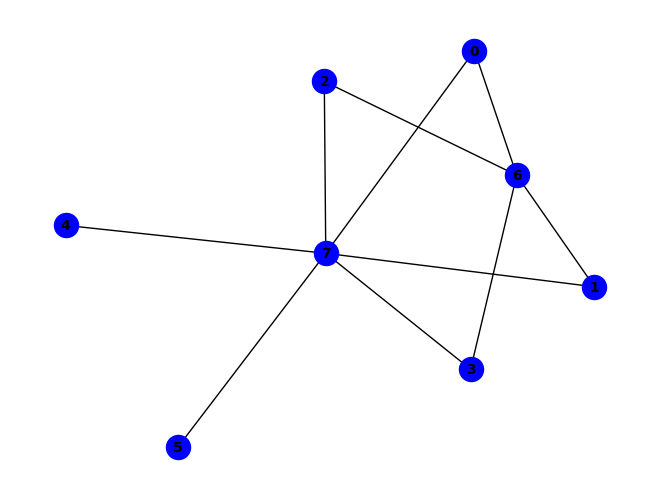


~f ^ (b & f & ~e) ^ (f & ~b & ~h) ^ (a & b & g & ~d) ^ (b & e & f & ~h) ^ (a & b & c & d & g) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~f) ^ (b & g & ~c & ~d) ^ (c & g & ~a & ~h) ^ (d & g & ~c & ~h) ^ (d & h & ~e & ~f) ^ (e & h & ~a & ~f) ^ (a & b & c & g & ~h) ^ (a & b & f & h & ~d) ^ (a & c & d & g & ~h) ^ (a & c & d & h & ~f) ^ (b & d & f & h & ~e) ^ (a & b & c & d & f & h) ^ (a & b & h & ~d & ~g) ^ (b & e & h & ~c & ~d) ^ (a & b & c & d & h & ~g) ^ (b & h & ~c & ~d & ~g) ^ (c & h & ~d & ~e & ~f) ^ (a & b & e & h & ~d & ~f) ^ (a & d & e & h & ~c & ~f) ^ (b & c & f & h & ~d & ~e) ^ (a & b & c & d & e & h & ~f) ^ (a & c & h & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


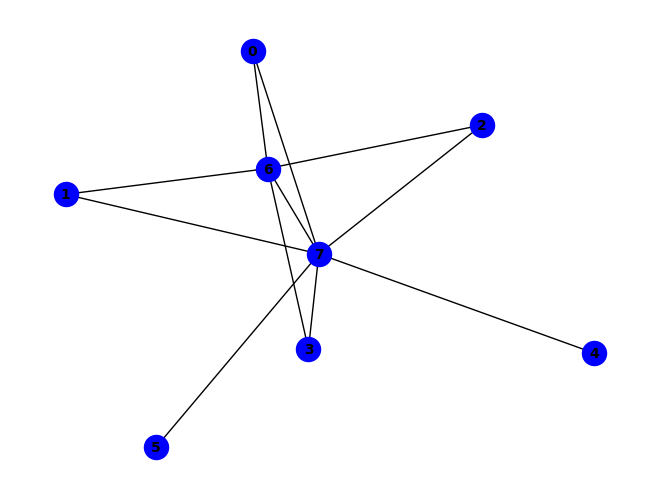


~g ^ (g & ~h) ^ (f & h & ~g) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (b & c & d & g & ~f) ^ (b & c & d & h & ~f) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (c & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (d & f & g & ~e & ~h) ^ (a & b & e & f & g & ~d) ^ (a & b & e & f & h & ~d) ^ (c & d & e & f & g & ~h) ^ (a & g & ~c & ~d & ~f) ^ (a & h & ~c & ~d & ~f) ^ (b & g & ~a & ~d & ~f) ^ (b & h & ~a & ~d & ~f) ^ (e & h & ~c & ~f & ~g) ^ (a & b & c & g & ~d & ~f) ^ (a & b & c & h & ~d & ~f) ^ (a & b & e & h & ~d & ~g) ^ (a & f & g & ~c & ~d & ~h) ^ (b & f & g & ~c & ~d & ~h) ^ (a & b & c & f & g & ~d & ~h) ^ (a & b & f & g & ~d & ~e & ~h) ^ (a & e & h & ~c & ~d & ~f & ~g) ^ (b & e & h & ~c & ~d & ~f & ~g) ^ (a & b & c & e & h & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

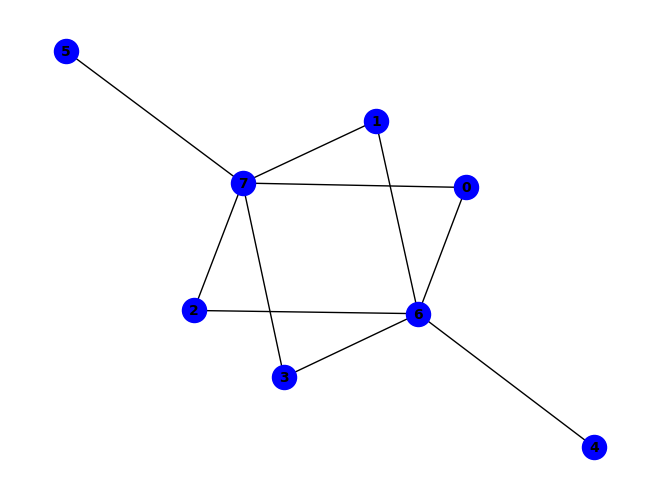


~f ^ (b & f & ~e) ^ (b & h & ~d) ^ (d & h & ~f) ^ (f & ~b & ~h) ^ (b & e & f & ~h) ^ (b & g & ~c & ~h) ^ (c & g & ~d & ~h) ^ (d & g & ~b & ~h) ^ (a & b & e & g & ~d) ^ (b & c & d & g & ~h) ^ (b & d & f & h & ~e) ^ (a & b & g & ~d & ~h) ^ (a & b & h & ~d & ~f) ^ (a & e & g & ~c & ~d) ^ (a & g & ~c & ~d & ~h) ^ (a & h & ~c & ~d & ~f) ^ (c & h & ~b & ~d & ~f) ^ (e & g & ~b & ~c & ~d) ^ (a & b & c & g & ~d & ~e) ^ (a & b & c & h & ~d & ~g) ^ (b & e & f & h & ~d & ~g) ^ (a & b & e & f & g & h & ~d) ^ (b & c & e & f & g & h & ~d) ^ (a & b & c & f & h & ~d & ~e) ^ (e & f & g & h & ~a & ~c & ~d) ^ (a & b & c & e & f & h & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


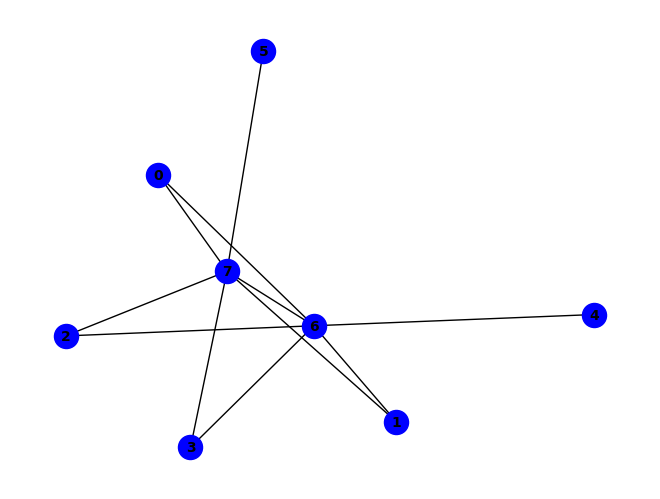


(g & ~h) ^ (~e & ~g) ^ (f & h & ~g) ^ (d & f & g & ~h) ^ (c & e & ~d & ~g) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~c & ~g) ^ (b & c & d & g & ~f) ^ (b & c & d & h & ~f) ^ (c & d & e & h & ~g) ^ (e & ~c & ~d & ~h) ^ (a & g & ~c & ~d & ~f) ^ (a & h & ~c & ~d & ~f) ^ (b & g & ~a & ~d & ~f) ^ (b & h & ~a & ~d & ~f) ^ (a & b & c & g & ~d & ~f) ^ (a & b & c & h & ~d & ~f) ^ (a & f & g & ~b & ~d & ~h) ^ (b & e & g & ~c & ~d & ~h) ^ (b & f & g & ~c & ~d & ~h) ^ (c & f & g & ~a & ~d & ~h) ^ (a & b & c & f & g & ~d & ~h) ^ (a & e & g & ~b & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


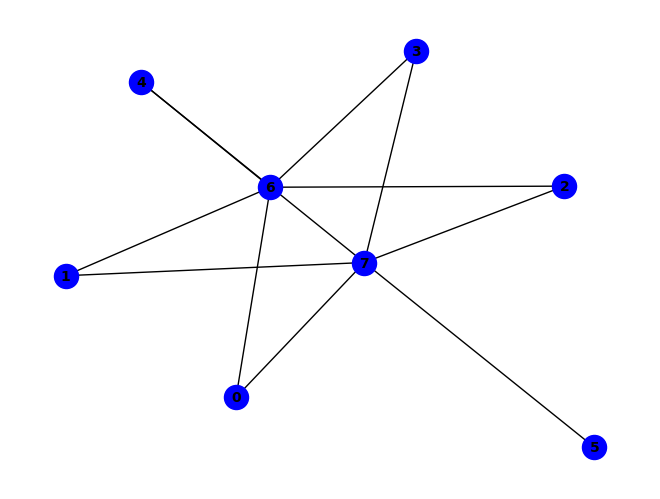


~f ^ (b & f & ~e) ^ (b & h & ~e) ^ (e & g & ~h) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (a & d & g & ~c) ^ (a & e & g & ~d) ^ (b & e & f & ~h) ^ (a & g & ~c & ~h) ^ (a & h & ~c & ~f) ^ (b & g & ~e & ~h) ^ (d & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (a & d & f & h & ~c) ^ (a & e & f & h & ~d) ^ (b & c & d & h & ~g) ^ (b & d & e & g & ~a) ^ (a & b & c & d & e & g) ^ (a & b & g & ~c & ~e) ^ (a & d & h & ~c & ~g) ^ (a & e & h & ~d & ~g) ^ (b & c & g & ~d & ~e) ^ (b & c & h & ~e & ~g) ^ (b & d & g & ~a & ~h) ^ (b & d & h & ~a & ~f) ^ (a & b & c & d & g & ~h) ^ (a & b & c & d & h & ~f) ^ (b & d & e & f & h & ~a) ^ (a & b & c & d & e & f & h) ^ (c & g & ~d & ~e & ~h) ^ (c & h & ~d & ~e & ~f) ^ (a & b & f & h & ~c & ~e) ^ (a & c & e & g & ~d & ~h) ^ (a & c & e & h & ~d & ~f) ^ (b & c & f & h & ~d & ~e) ^ (a & b & h & ~c & ~e & ~g) ^ (b & d & e & h & ~a & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

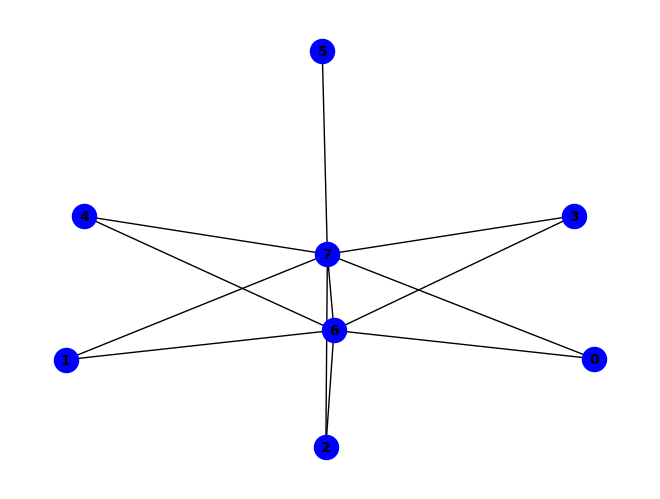


~g ^ (g & ~h) ^ (f & h & ~g) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (c & d & e & h & ~f) ^ (c & f & g & ~d & ~h) ^ (e & f & g & ~c & ~h) ^ (a & g & ~c & ~e & ~f) ^ (b & h & ~c & ~e & ~f) ^ (d & g & ~a & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & b & c & g & ~e & ~f) ^ (a & c & d & g & ~b & ~f) ^ (b & c & d & h & ~e & ~f) ^ (c & d & e & g & ~a & ~f) ^ (a & b & c & d & e & g & ~f) ^ (a & b & g & ~d & ~e & ~f) ^ (a & f & g & ~c & ~e & ~h) ^ (d & f & g & ~a & ~e & ~h) ^ (a & c & d & f & g & ~e & ~h) ^ (b & c & d & f & g & ~a & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (b & g & ~c & ~d & ~e & ~f) ^ (b & c & f & g & ~a & ~e & ~h) ^ (b & f & g & ~a & ~d & ~e & ~h) ^ (a & h & ~b & ~c & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

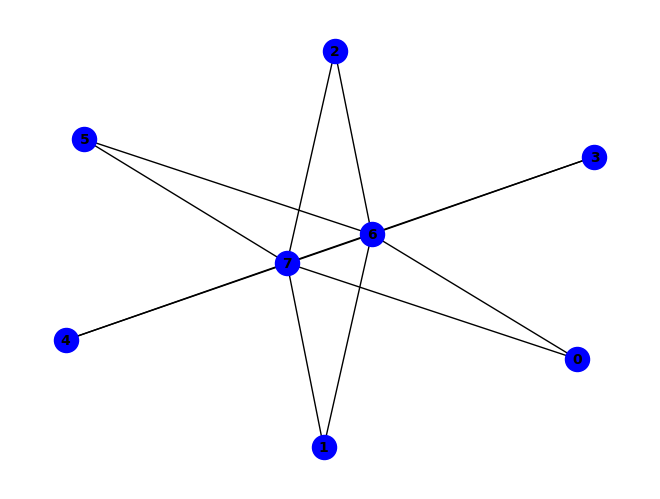


~e ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & b & h & ~f) ^ (a & c & h & ~f) ^ (b & c & h & ~f) ^ (c & h & ~e & ~f) ^ (d & h & ~e & ~f) ^ (f & g & ~e & ~h) ^ (a & b & c & g & ~f) ^ (a & b & d & g & ~f) ^ (a & b & e & g & ~f) ^ (a & c & e & g & ~f) ^ (b & c & d & g & ~f) ^ (b & c & e & g & ~f) ^ (c & d & e & g & ~f) ^ (a & b & g & ~f & ~h) ^ (b & c & g & ~f & ~h) ^ (c & d & g & ~f & ~h) ^ (c & d & h & ~a & ~f) ^ (a & b & c & e & h & ~f) ^ (a & b & d & e & h & ~f) ^ (a & c & d & e & h & ~f) ^ (b & c & d & e & h & ~f) ^ (a & g & ~e & ~f & ~h) ^ (a & h & ~d & ~e & ~f) ^ (b & h & ~d & ~e & ~f) ^ (c & g & ~e & ~f & ~h) ^ (a & b & c & h & ~f & ~g) ^ (a & b & d & h & ~f & ~g) ^ (a & b & e & h & ~f & ~g) ^ (a & c & e & h & ~f & ~g) ^ (b & c & d & h & ~f & ~g) ^ (b & c & e & h & ~f & ~g) ^ (c & d & e & h & ~f & ~g) ^ (a & c & g & ~d & ~f & ~h) ^ (a & b & c & d & h & ~e & ~f) ^ (a & b & c & e & g & ~f & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (b & c & d & e & g & ~f & ~h

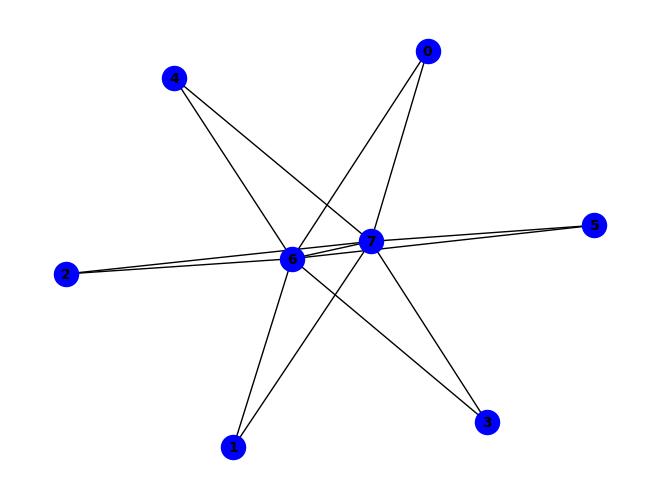


~g ^ (f & h) ^ (g & ~h) ^ (c & g & ~e) ^ (e & g & ~f) ^ (f & g & ~c) ^ (c & e & f & g) ^ (b & h & ~d & ~f) ^ (e & h & ~b & ~f) ^ (c & h & ~b & ~e & ~f) ^ (d & g & ~c & ~e & ~f) ^ (d & h & ~c & ~e & ~f) ^ (a & b & c & h & ~e & ~f) ^ (b & c & d & h & ~a & ~f) ^ (b & d & e & h & ~c & ~f) ^ (a & b & c & d & e & h & ~f) ^ (a & b & h & ~d & ~e & ~f) ^ (a & h & ~c & ~d & ~e & ~f) ^ (b & g & ~c & ~d & ~e & ~f) ^ (a & g & ~b & ~c & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


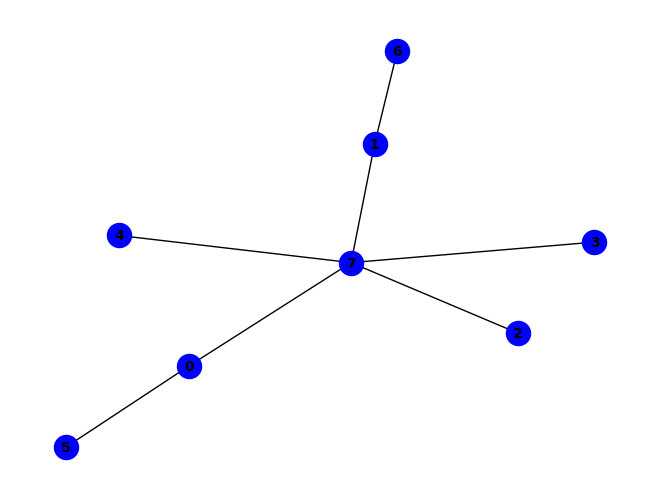


~e ^ (a & f) ^ (a & b & g) ^ (a & e & ~d) ^ (a & h & ~f) ^ (b & g & ~h) ^ (a & b & e & h) ^ (e & ~a & ~h) ^ (a & b & h & ~g) ^ (a & d & e & ~h) ^ (a & d & h & ~c) ^ (a & b & c & d & h) ^ (b & h & ~c & ~e) ^ (c & h & ~d & ~e) ^ (d & h & ~b & ~e) ^ (a & b & d & h & ~e) ^ (b & c & d & h & ~e) ^ (a & b & g & ~f & ~h) ^ (a & c & h & ~b & ~e) ^ (a & c & d & e & h & ~b)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


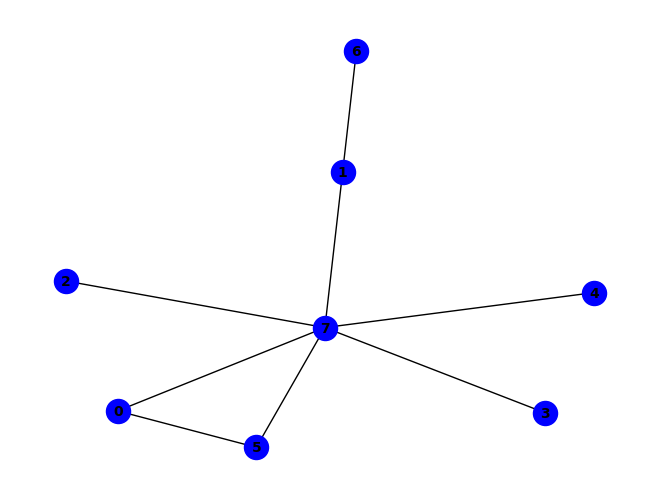


~f ^ (a & f & ~e) ^ (a & h & ~e) ^ (b & f & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (a & e & f & ~h) ^ (a & b & f & g & ~h) ^ (b & d & e & f & ~c) ^ (b & d & e & h & ~c) ^ (b & d & h & ~c & ~f) ^ (b & e & f & ~d & ~h) ^ (b & c & d & e & f & ~h) ^ (d & h & ~a & ~e & ~f) ^ (a & b & h & ~d & ~e & ~f) ^ (b & c & h & ~a & ~e & ~f) ^ (a & b & c & d & h & ~e & ~f) ^ (c & h & ~a & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


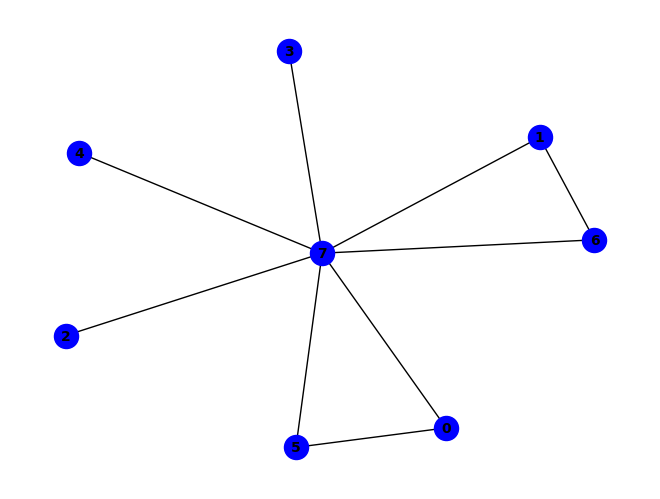


~g ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & h & ~g) ^ (g & ~c & ~h) ^ (a & d & f & ~g) ^ (a & f & ~d & ~h) ^ (b & g & ~a & ~f) ^ (b & h & ~a & ~f) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (a & b & g & ~f & ~h) ^ (a & d & h & ~e & ~g) ^ (b & f & g & ~a & ~h) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (a & d & e & f & g & ~c) ^ (a & d & e & f & h & ~c) ^ (e & h & ~b & ~f & ~g) ^ (a & c & d & h & ~f & ~g) ^ (a & d & f & g & ~e & ~h) ^ (b & c & h & ~e & ~f & ~g) ^ (c & d & h & ~b & ~f & ~g) ^ (a & c & d & e & h & ~b & ~g) ^ (b & c & d & e & h & ~f & ~g) ^ (c & d & e & f & g & ~a & ~h) ^ (a & b & c & d & e & f & h & ~g) ^ (a & h & ~c & ~e & ~f & ~g) ^ (d & h & ~b & ~e & ~f & ~g) ^ (a & b & c & h & ~d & ~f & ~g) ^ (a & b & d & h & ~e & ~f & ~g) ^ (a & b & e & h & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

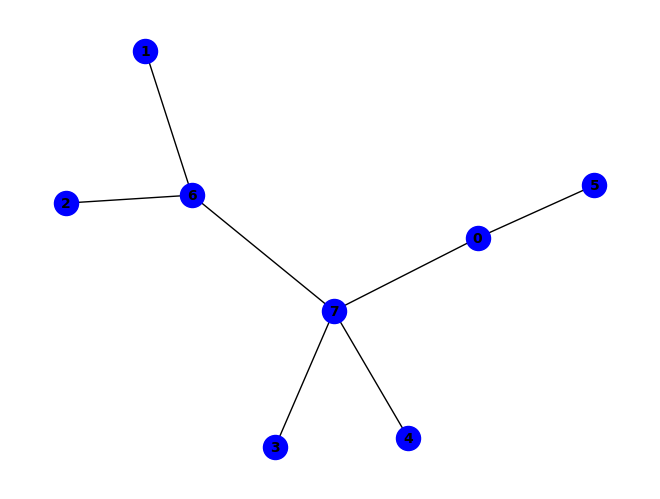


(c & ~b & ~h) ^ (a & c & f & ~h) ^ (~a & ~c & ~g) ^ (b & c & ~g & ~h) ^ (c & h & ~a & ~g) ^ (e & h & ~a & ~g) ^ (a & b & c & g & ~h) ^ (a & ~b & ~f & ~h) ^ (g & ~a & ~b & ~h) ^ (a & b & c & ~f & ~h) ^ (a & b & ~f & ~g & ~h) ^ (d & h & ~a & ~e & ~g) ^ (a & c & ~b & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


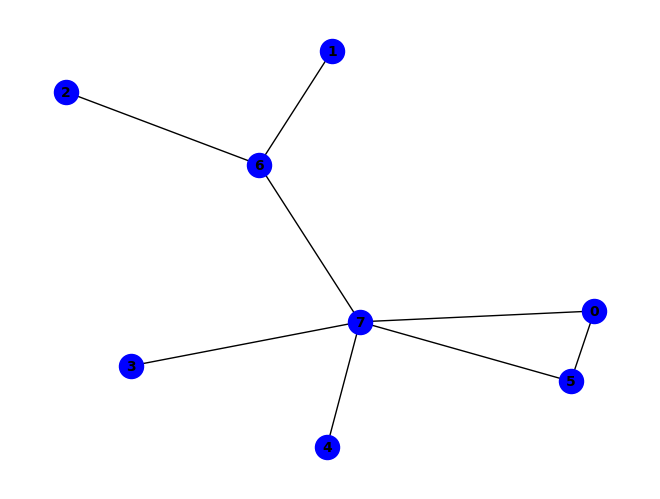


(~c & ~g) ^ (f & h & ~g) ^ (c & ~b & ~h) ^ (g & ~b & ~h) ^ (a & c & f & ~g) ^ (a & c & f & ~h) ^ (a & e & f & ~g) ^ (a & f & ~e & ~h) ^ (b & c & ~g & ~h) ^ (c & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & b & c & g & ~h) ^ (a & b & f & g & ~h) ^ (a & e & f & g & ~h) ^ (a & b & c & ~f & ~g) ^ (a & b & c & ~f & ~h) ^ (a & e & h & ~d & ~g) ^ (a & d & e & f & h & ~g) ^ (a & h & ~d & ~f & ~g) ^ (d & h & ~e & ~f & ~g) ^ (a & c & h & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


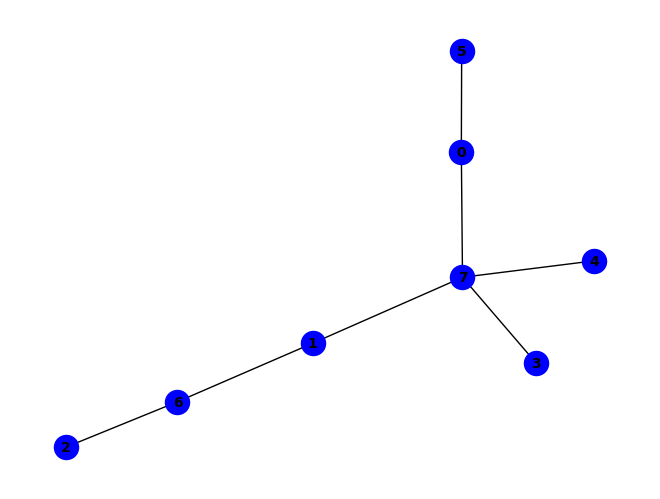


~e ^ (a & b & g) ^ (a & e & ~d) ^ (a & f & ~c) ^ (a & h & ~f) ^ (b & g & ~h) ^ (b & h & ~e) ^ (c & g & ~b) ^ (a & c & f & h) ^ (e & ~a & ~h) ^ (a & d & e & ~h) ^ (a & d & h & ~c) ^ (a & b & ~f & ~g) ^ (a & b & ~f & ~h) ^ (d & h & ~b & ~e) ^ (a & b & d & h & ~e) ^ (a & b & e & h & ~c) ^ (a & b & f & h & ~g) ^ (a & c & d & h & ~g) ^ (a & c & g & h & ~e) ^ (c & e & g & h & ~b) ^ (a & c & f & ~g & ~h) ^ (a & b & c & e & h & ~g) ^ (a & b & c & f & g & ~h) ^ (a & b & c & g & h & ~d) ^ (c & d & g & h & ~b & ~e) ^ (a & c & d & e & g & h & ~b)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


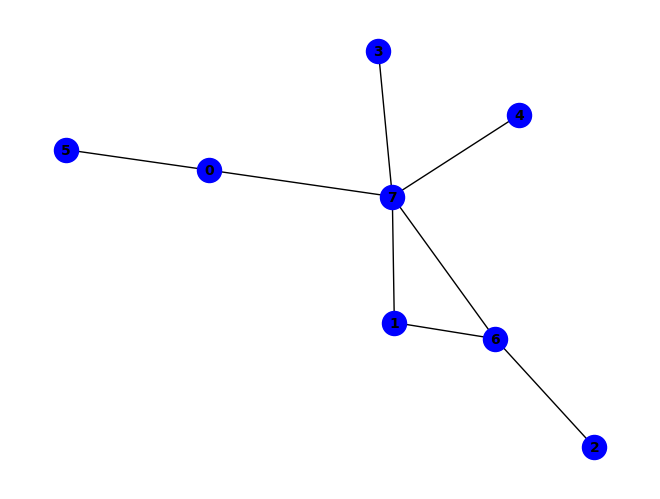


(c & ~b & ~h) ^ (g & ~a & ~h) ^ (a & c & f & ~h) ^ (~a & ~c & ~g) ^ (b & c & ~g & ~h) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & h & ~a & ~g) ^ (e & h & ~a & ~g) ^ (a & ~b & ~f & ~h) ^ (b & e & g & ~a & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & ~f & ~g & ~h) ^ (a & c & ~f & ~g & ~h) ^ (d & h & ~a & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


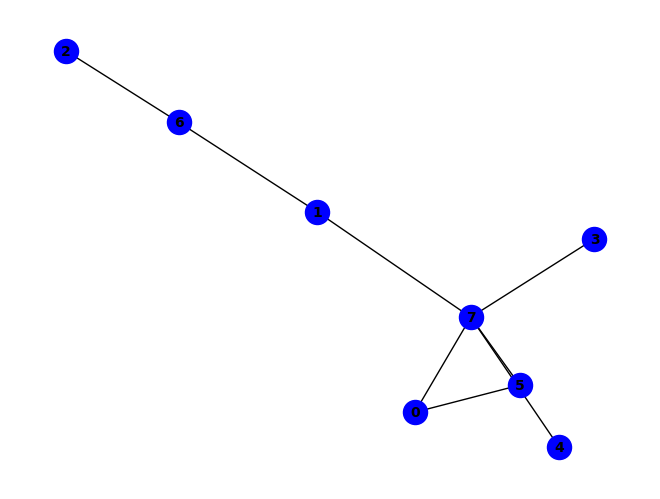


~f ^ (a & f & ~e) ^ (b & f & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (c & g & ~b) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (b & e & f & ~h) ^ (a & h & ~b & ~e) ^ (a & b & d & h & ~f) ^ (a & b & f & g & ~c) ^ (a & b & f & h & ~g) ^ (a & c & f & g & ~e) ^ (a & c & d & e & g & h) ^ (a & d & h & ~e & ~f) ^ (a & e & f & ~c & ~h) ^ (a & b & d & e & h & ~c) ^ (a & b & e & f & h & ~d) ^ (a & b & c & e & f & g & h) ^ (d & h & ~b & ~e & ~f) ^ (a & c & g & h & ~b & ~e) ^ (c & d & g & h & ~b & ~e) ^ (c & e & g & h & ~b & ~f) ^ (c & f & g & h & ~b & ~d) ^ (a & b & c & d & e & h & ~g) ^ (a & c & d & e & f & h & ~b) ^ (c & d & e & f & g & h & ~b) ^ (a & c & d & e & f & ~b & ~g) ^ (a & c & d & g & h & ~b & ~f) ^ (a & c & e & f & ~d & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

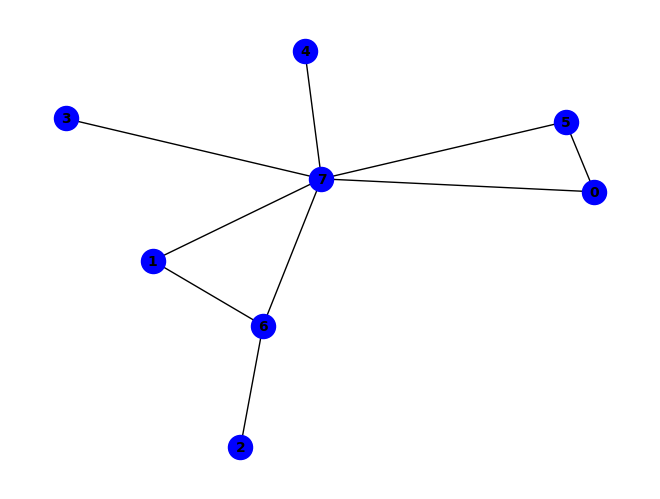


(g & ~h) ^ (~c & ~g) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~b & ~h) ^ (a & f & ~b & ~h) ^ (b & c & ~g & ~h) ^ (b & g & ~a & ~f) ^ (b & h & ~a & ~f) ^ (e & h & ~f & ~g) ^ (a & b & c & g & ~h) ^ (a & c & f & g & ~h) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (a & b & d & e & f & g) ^ (a & b & d & e & f & h) ^ (a & b & f & ~g & ~h) ^ (b & e & h & ~d & ~g) ^ (b & f & g & ~e & ~h) ^ (a & b & d & e & h & ~g) ^ (d & h & ~e & ~f & ~g) ^ (a & b & e & h & ~f & ~g) ^ (a & b & g & ~c & ~f & ~h) ^ (b & d & h & ~a & ~f & ~g) ^ (b & d & e & f & g & ~a & ~h) ^ (a & h & ~d & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


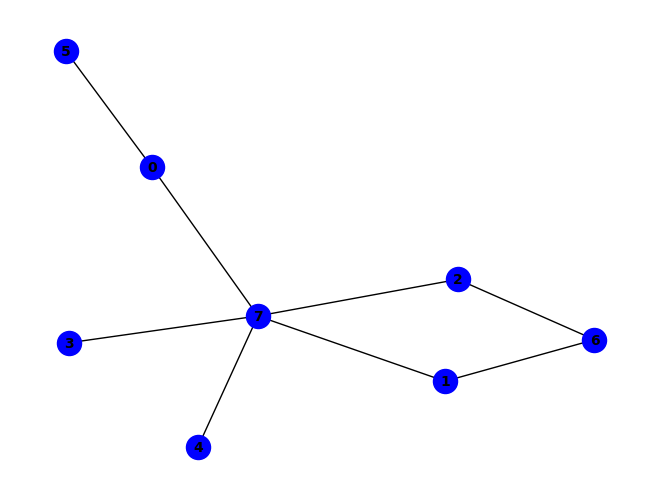


~e ^ (a & e & ~d) ^ (a & f & ~h) ^ (a & h & ~d) ^ (e & ~a & ~h) ^ (a & b & g & ~c) ^ (a & d & e & ~h) ^ (b & g & ~c & ~h) ^ (b & h & ~c & ~e) ^ (c & g & ~a & ~h) ^ (d & h & ~b & ~e) ^ (a & b & e & h & ~c) ^ (b & c & d & h & ~e) ^ (a & c & g & ~f & ~h) ^ (a & b & ~c & ~f & ~g) ^ (a & b & ~c & ~f & ~h) ^ (c & h & ~a & ~d & ~e) ^ (a & b & d & h & ~c & ~e) ^ (a & b & f & h & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


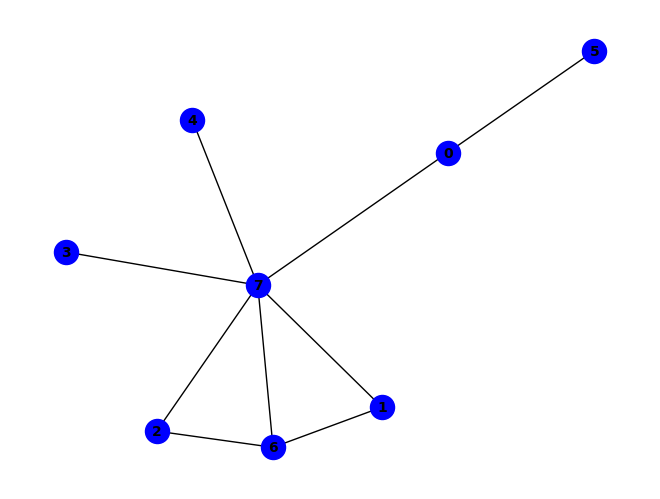


(~a & ~g) ^ (g & ~a & ~h) ^ (b & g & ~c & ~e) ^ (b & h & ~c & ~e) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (e & h & ~a & ~g) ^ (a & b & f & g & ~c) ^ (a & b & f & h & ~c) ^ (a & c & e & g & ~h) ^ (b & d & e & g & ~c) ^ (b & d & e & h & ~c) ^ (a & b & c & d & e & g) ^ (a & b & c & d & e & h) ^ (a & ~c & ~f & ~h) ^ (b & d & h & ~c & ~g) ^ (b & e & g & ~d & ~h) ^ (c & e & g & ~b & ~h) ^ (a & b & c & d & h & ~g) ^ (a & c & ~f & ~g & ~h) ^ (a & b & d & h & ~e & ~g) ^ (a & b & e & h & ~c & ~g) ^ (a & b & h & ~c & ~f & ~g) ^ (b & c & d & e & g & ~a & ~h) ^ (d & h & ~a & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


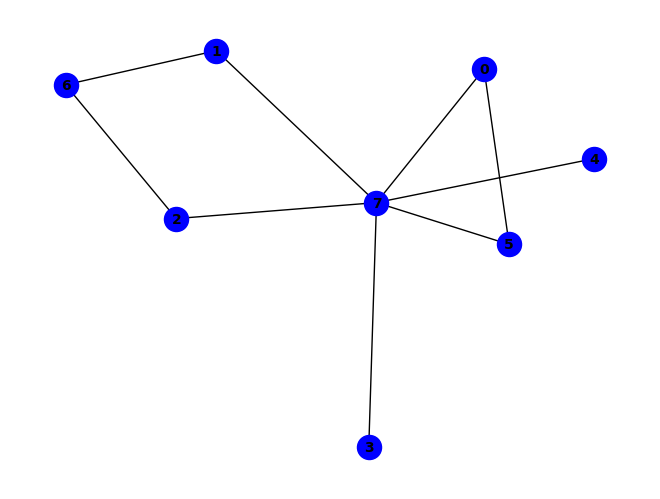


~f ^ (b & c & g) ^ (a & f & ~e) ^ (a & h & ~e) ^ (b & f & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (b & c & f & h) ^ (f & ~b & ~h) ^ (a & e & f & ~h) ^ (b & c & h & ~g) ^ (a & b & c & f & g) ^ (a & b & c & h & ~e) ^ (a & b & f & g & ~h) ^ (a & c & f & g & ~h) ^ (b & c & e & h & ~f) ^ (b & d & e & f & ~c) ^ (b & d & e & h & ~c) ^ (a & b & c & e & f & h) ^ (b & d & h & ~c & ~f) ^ (b & e & f & ~d & ~h) ^ (a & b & c & f & h & ~g) ^ (b & c & d & e & f & ~h) ^ (d & h & ~a & ~e & ~f) ^ (a & b & h & ~d & ~e & ~f) ^ (a & b & c & d & h & ~e & ~f) ^ (c & h & ~a & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


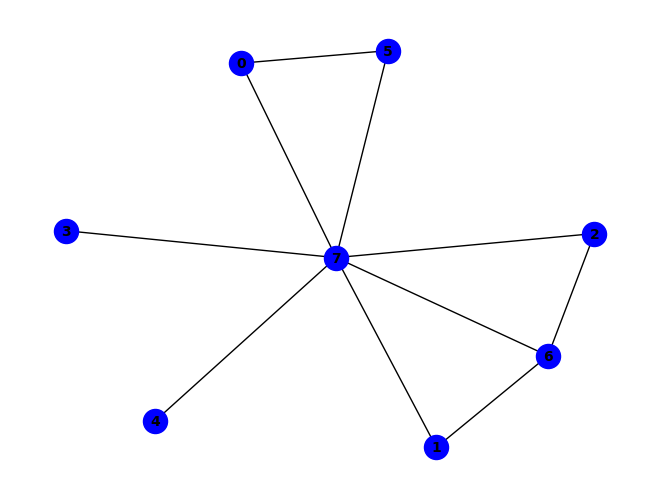


~g ^ (g & ~h) ^ (f & h & ~g) ^ (a & c & g & ~h) ^ (a & d & f & ~g) ^ (a & f & ~d & ~h) ^ (b & g & ~c & ~f) ^ (b & h & ~c & ~f) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (a & b & c & f & ~g) ^ (a & b & c & f & ~h) ^ (a & b & f & g & ~h) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (a & d & h & ~e & ~g) ^ (b & f & g & ~c & ~h) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (a & d & e & f & g & ~c) ^ (a & d & e & f & h & ~c) ^ (e & h & ~b & ~f & ~g) ^ (a & b & c & h & ~e & ~g) ^ (a & c & e & h & ~f & ~g) ^ (a & d & f & g & ~e & ~h) ^ (a & c & d & e & h & ~b & ~g) ^ (c & d & e & f & g & ~a & ~h) ^ (a & h & ~b & ~e & ~f & ~g) ^ (d & h & ~b & ~e & ~f & ~g) ^ (a & b & d & h & ~e & ~f & ~g) ^ (b & c & e & h & ~d & ~f & ~g) ^ (a & b & c & e & f & h & ~d & ~g) ^ (c & d & h & ~a & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

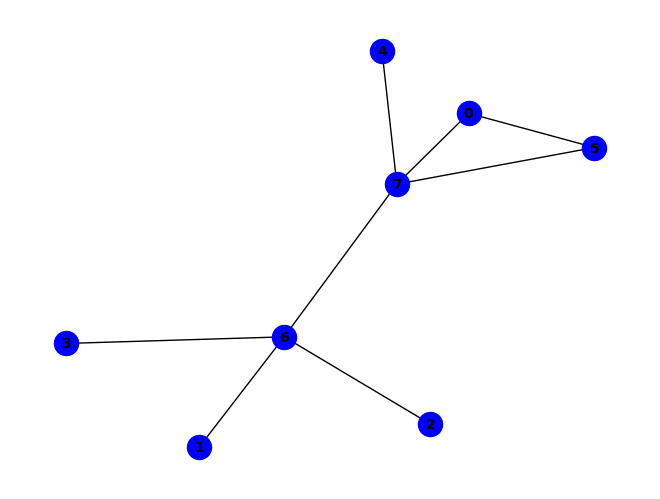


(~d & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (a & d & f & ~g) ^ (a & f & ~d & ~h) ^ (b & g & ~d & ~h) ^ (d & h & ~a & ~g) ^ (b & c & d & ~a & ~h) ^ (b & c & g & ~a & ~h) ^ (a & h & ~d & ~f & ~g) ^ (c & d & ~b & ~g & ~h) ^ (e & h & ~a & ~f & ~g) ^ (a & b & c & d & ~f & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & b & f & g & ~d & ~h) ^ (a & c & f & g & ~d & ~h) ^ (a & b & c & d & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


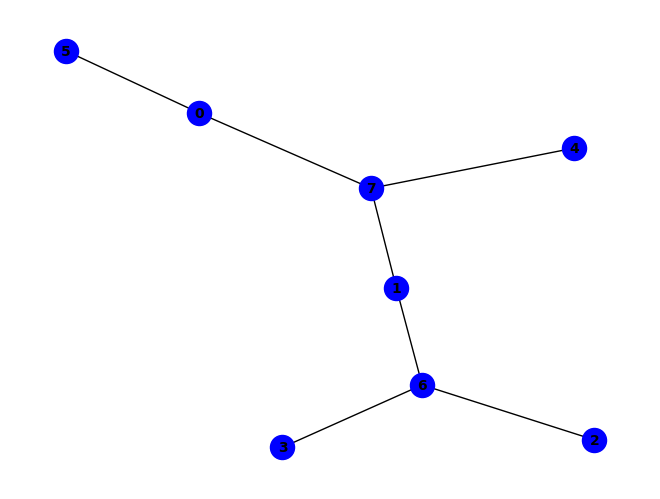


~e ^ (a & b & g) ^ (a & e & ~d) ^ (a & f & ~d) ^ (a & h & ~f) ^ (b & g & ~h) ^ (b & h & ~e) ^ (d & g & ~b) ^ (a & d & f & h) ^ (e & ~a & ~h) ^ (a & b & h & ~g) ^ (a & b & c & g & h) ^ (a & b & d & e & g) ^ (c & g & ~b & ~d) ^ (a & b & e & h & ~c) ^ (a & c & g & h & ~e) ^ (c & e & g & h & ~b) ^ (a & b & g & ~f & ~h) ^ (a & d & e & ~b & ~h) ^ (a & b & c & f & g & ~h) ^ (a & c & d & e & h & ~b) ^ (a & b & d & e & ~g & ~h) ^ (a & b & d & f & ~c & ~h) ^ (a & c & f & g & ~d & ~h) ^ (a & d & e & h & ~c & ~g) ^ (a & d & g & h & ~b & ~c) ^ (d & e & g & h & ~b & ~c) ^ (a & d & f & ~b & ~g & ~h) ^ (a & b & c & d & f & ~g & ~h) ^ (a & b & c & e & h & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


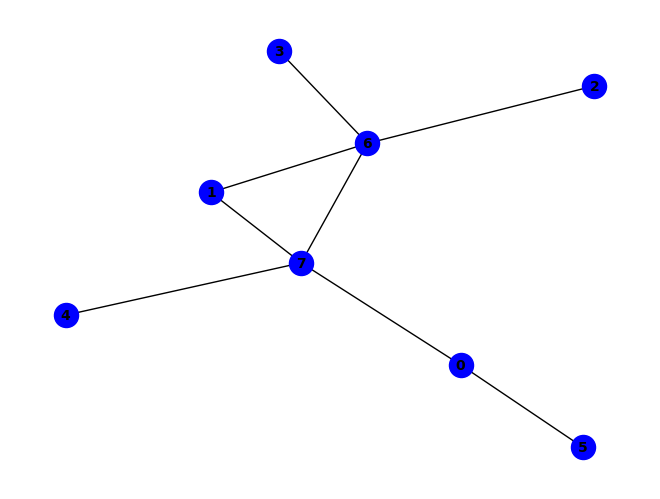


(~a & ~d & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (d & h & ~a & ~g) ^ (e & h & ~a & ~g) ^ (a & ~d & ~f & ~h) ^ (d & ~a & ~c & ~h) ^ (g & ~a & ~c & ~h) ^ (a & c & g & ~f & ~h) ^ (b & c & g & ~d & ~h) ^ (b & d & g & ~a & ~h) ^ (b & e & g & ~a & ~h) ^ (a & b & c & d & g & ~h) ^ (a & b & c & f & g & ~h) ^ (c & d & ~a & ~g & ~h) ^ (a & b & g & ~d & ~f & ~h) ^ (a & c & d & ~b & ~f & ~h) ^ (a & d & ~c & ~f & ~g & ~h) ^ (a & b & c & d & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


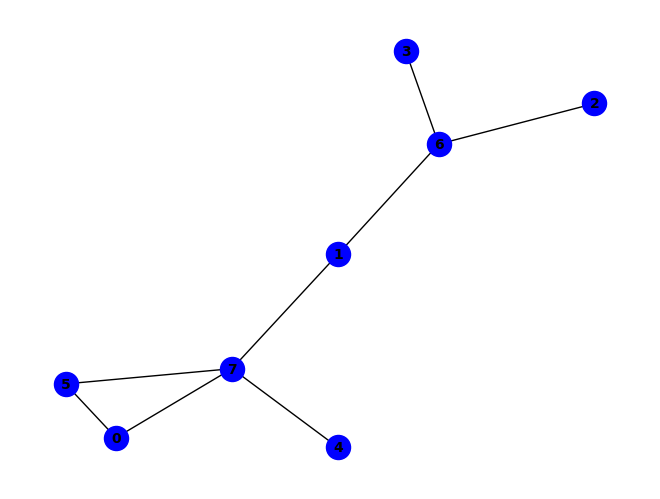


~f ^ (a & f & ~e) ^ (a & h & ~e) ^ (b & f & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (d & g & ~b) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (b & e & f & ~h) ^ (a & b & d & f & g) ^ (b & c & f & g & h) ^ (c & g & ~b & ~d) ^ (a & b & f & g & ~h) ^ (a & c & f & g & ~e) ^ (a & d & f & g & ~c) ^ (c & f & g & h & ~d) ^ (d & e & g & h & ~c) ^ (d & f & g & h & ~e) ^ (c & d & e & f & g & h) ^ (a & b & h & ~e & ~f) ^ (a & e & f & ~c & ~h) ^ (a & b & c & f & g & ~d) ^ (b & d & f & g & h & ~c) ^ (a & b & c & e & f & g & h) ^ (a & c & g & h & ~b & ~e) ^ (c & e & g & h & ~b & ~f) ^ (a & c & d & e & f & h & ~b) ^ (a & d & e & f & g & h & ~b) ^ (a & c & d & e & f & ~b & ~g) ^ (b & d & e & g & h & ~c & ~f) ^ (a & c & e & f & ~d & ~g & ~h) ^ (a & d & g & h & ~b & ~c & ~e) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

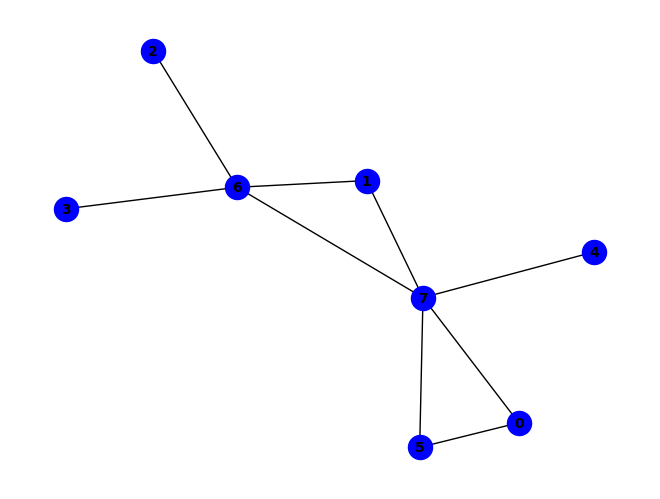


(~d & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (b & f & g & ~h) ^ (a & f & ~b & ~h) ^ (b & g & ~a & ~f) ^ (b & h & ~a & ~f) ^ (c & d & ~g & ~h) ^ (a & b & f & ~g & ~h) ^ (b & c & g & ~a & ~h) ^ (b & d & g & ~c & ~h) ^ (a & h & ~e & ~f & ~g) ^ (e & h & ~b & ~f & ~g) ^ (a & b & e & h & ~f & ~g) ^ (a & c & f & g & ~d & ~h) ^ (a & d & f & g & ~b & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & b & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


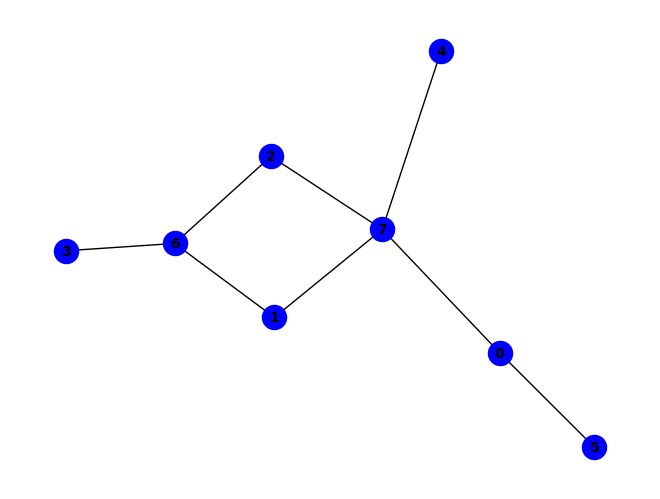


~e ^ (a & e & ~d) ^ (a & h & ~d) ^ (a & b & c & g) ^ (e & ~a & ~h) ^ (a & c & h & ~e) ^ (a & d & h & ~g) ^ (a & b & c & e & h) ^ (a & f & ~d & ~h) ^ (b & g & ~c & ~h) ^ (b & h & ~a & ~e) ^ (c & g & ~a & ~h) ^ (c & h & ~b & ~e) ^ (d & g & ~b & ~c) ^ (a & d & e & g & ~h) ^ (a & b & c & ~f & ~g) ^ (a & b & c & ~f & ~h) ^ (a & c & g & ~f & ~h) ^ (a & d & e & ~c & ~g) ^ (a & d & f & ~g & ~h) ^ (a & b & c & d & e & ~g) ^ (a & b & c & f & h & ~g) ^ (a & b & d & g & h & ~e) ^ (a & c & d & e & h & ~b) ^ (a & c & d & g & h & ~b) ^ (a & b & f & g & ~d & ~h) ^ (d & e & g & h & ~b & ~c) ^ (a & c & d & f & g & ~b & ~h) ^ (a & c & d & e & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


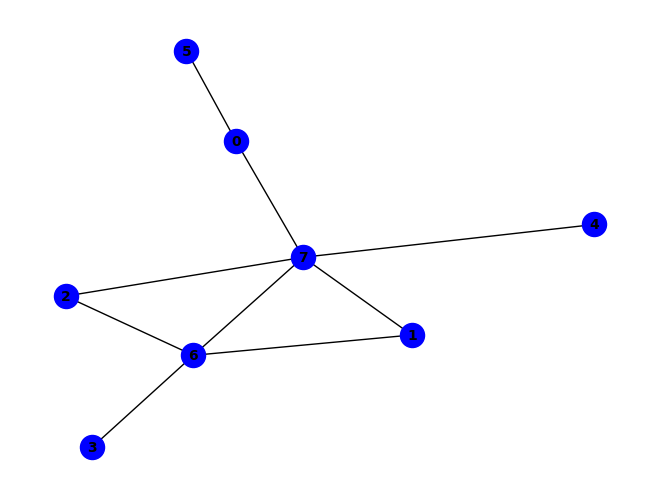


(g & ~a & ~h) ^ (a & b & g & ~e) ^ (a & b & h & ~e) ^ (a & b & c & f & g) ^ (a & b & c & f & h) ^ (~a & ~d & ~g) ^ (b & g & ~c & ~e) ^ (b & h & ~c & ~e) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (d & h & ~a & ~g) ^ (e & h & ~a & ~g) ^ (a & c & e & g & ~h) ^ (a & ~d & ~f & ~h) ^ (d & ~a & ~c & ~h) ^ (a & b & g & ~f & ~h) ^ (b & e & g & ~a & ~h) ^ (c & e & g & ~b & ~h) ^ (a & b & c & e & h & ~g) ^ (c & d & ~a & ~g & ~h) ^ (a & b & c & d & ~f & ~g) ^ (a & b & d & ~c & ~f & ~h) ^ (a & c & g & ~d & ~f & ~h) ^ (b & d & g & ~a & ~c & ~h) ^ (a & d & ~b & ~f & ~g & ~h) ^ (a & b & c & h & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


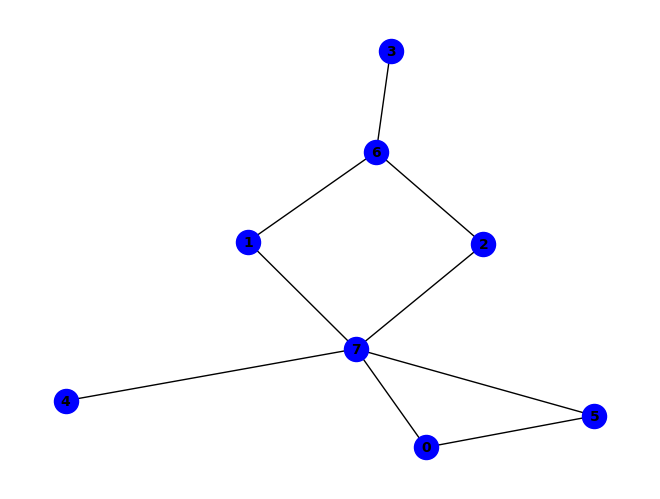


~f ^ (a & f & ~e) ^ (a & h & ~e) ^ (b & f & ~e) ^ (c & g & ~h) ^ (d & g & ~c) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (b & e & f & ~h) ^ (a & b & d & f & g) ^ (a & c & d & f & g) ^ (b & g & ~c & ~d) ^ (b & h & ~c & ~g) ^ (a & b & c & h & ~e) ^ (a & b & f & g & ~h) ^ (a & c & f & g & ~h) ^ (a & d & f & g & ~e) ^ (b & c & f & h & ~e) ^ (d & e & g & h & ~c) ^ (a & c & d & e & f & h) ^ (a & b & h & ~e & ~f) ^ (a & e & f & ~d & ~h) ^ (b & e & h & ~c & ~d) ^ (a & b & c & f & g & ~d) ^ (a & b & c & f & h & ~g) ^ (b & d & e & f & h & ~c) ^ (b & d & f & g & h & ~c) ^ (a & b & d & e & f & g & h) ^ (c & h & ~a & ~e & ~f) ^ (d & f & g & h & ~c & ~e) ^ (a & b & c & e & f & h & ~d) ^ (a & c & d & e & f & ~b & ~g) ^ (a & d & e & f & ~c & ~g & ~h) ^ (a & d & g & h & ~b & ~c & ~e) ^ (b & d & e & h & ~c & ~f & ~g) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

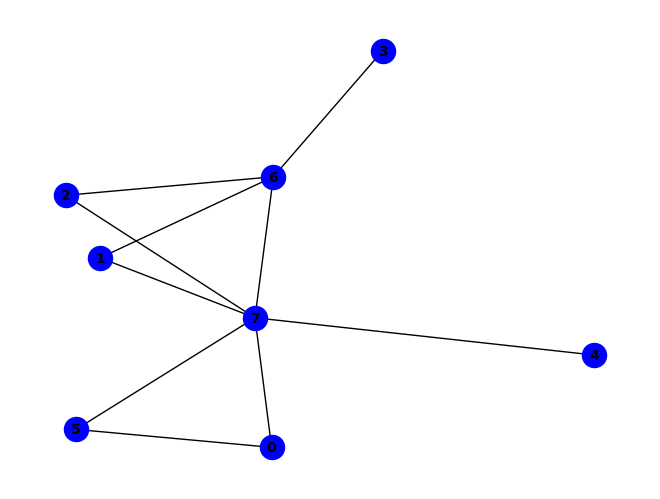


(g & ~h) ^ (~d & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & f & ~c & ~h) ^ (b & g & ~c & ~f) ^ (b & h & ~c & ~f) ^ (c & d & ~g & ~h) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (c & e & f & g & ~b) ^ (c & e & f & h & ~b) ^ (a & c & f & ~g & ~h) ^ (a & c & g & ~f & ~h) ^ (b & d & g & ~c & ~h) ^ (b & f & g & ~c & ~h) ^ (c & e & h & ~b & ~g) ^ (c & f & g & ~e & ~h) ^ (a & b & e & f & g & ~c) ^ (a & b & e & f & h & ~c) ^ (b & c & e & f & g & ~h) ^ (a & h & ~e & ~f & ~g) ^ (e & h & ~b & ~f & ~g) ^ (a & b & e & h & ~c & ~g) ^ (a & c & e & h & ~f & ~g) ^ (a & b & h & ~c & ~f & ~g) ^ (a & b & f & g & ~c & ~e & ~h) ^ (a & d & f & g & ~b & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


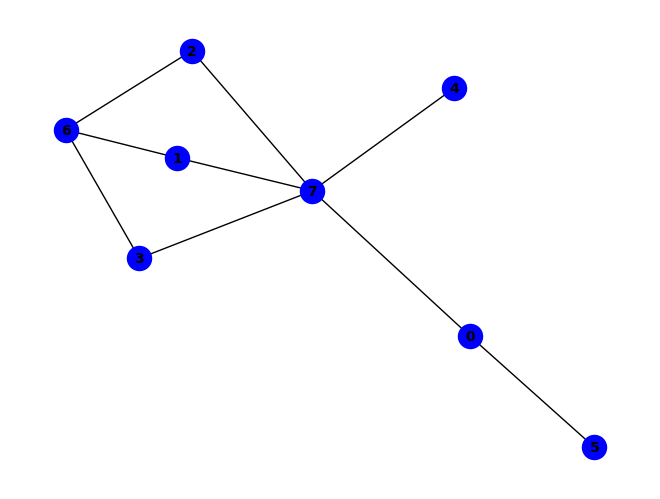


~e ^ (a & e & ~d) ^ (a & f & ~h) ^ (a & h & ~d) ^ (b & g & ~d) ^ (d & h & ~e) ^ (e & ~a & ~h) ^ (a & b & h & ~e) ^ (b & e & h & ~d) ^ (a & b & d & e & h) ^ (a & c & d & f & h) ^ (b & h & ~d & ~g) ^ (c & g & ~b & ~h) ^ (d & g & ~c & ~h) ^ (a & b & d & g & ~c) ^ (a & b & f & g & ~h) ^ (a & c & d & e & ~b) ^ (a & c & d & g & ~f) ^ (a & c & d & g & ~h) ^ (a & d & f & g & ~h) ^ (b & c & d & g & ~h) ^ (a & c & h & ~b & ~e) ^ (a & d & e & ~c & ~h) ^ (a & b & c & d & e & ~h) ^ (c & h & ~b & ~d & ~e) ^ (a & b & d & h & ~c & ~g) ^ (a & c & d & h & ~f & ~g) ^ (a & c & f & g & ~b & ~h) ^ (a & b & d & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


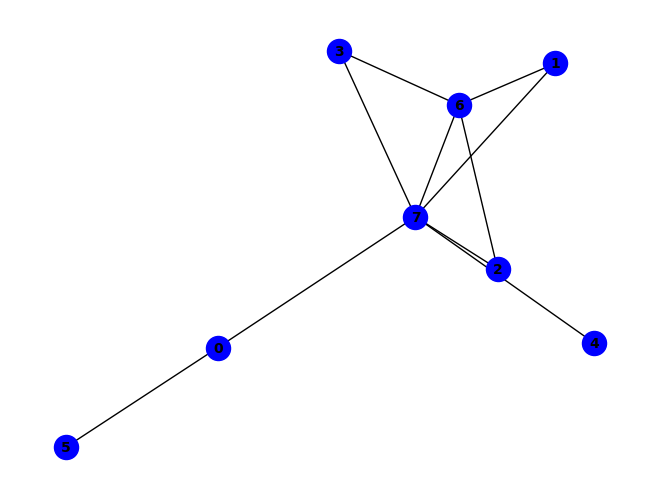


(~a & ~g) ^ (g & ~a & ~h) ^ (a & d & h & ~e) ^ (a & b & d & f & g) ^ (a & b & d & f & h) ^ (c & g & ~d & ~e) ^ (c & h & ~d & ~e) ^ (d & g & ~a & ~e) ^ (d & h & ~b & ~e) ^ (e & h & ~a & ~g) ^ (a & c & f & g & ~d) ^ (a & c & f & h & ~d) ^ (a & d & e & g & ~h) ^ (a & ~d & ~f & ~h) ^ (a & b & g & ~c & ~e) ^ (c & e & g & ~d & ~h) ^ (d & e & g & ~b & ~h) ^ (a & b & c & d & g & ~e) ^ (a & b & d & e & h & ~g) ^ (a & d & ~f & ~g & ~h) ^ (b & g & ~c & ~d & ~e) ^ (b & h & ~a & ~c & ~e) ^ (a & b & d & h & ~f & ~g) ^ (a & c & e & h & ~d & ~g) ^ (b & c & d & h & ~a & ~e) ^ (a & b & g & ~c & ~f & ~h) ^ (a & c & h & ~d & ~f & ~g) ^ (b & e & g & ~a & ~c & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (b & c & d & e & g & ~a & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


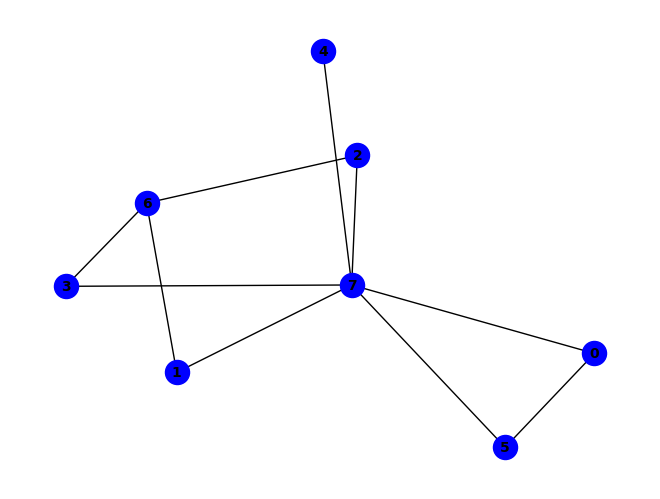


~f ^ (a & f & ~e) ^ (b & f & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (b & e & f & ~h) ^ (a & h & ~d & ~e) ^ (b & g & ~c & ~d) ^ (d & g & ~c & ~h) ^ (d & h & ~e & ~f) ^ (a & b & d & h & ~e) ^ (a & c & e & f & ~d) ^ (a & c & e & h & ~d) ^ (a & d & f & g & ~b) ^ (b & d & f & h & ~e) ^ (a & c & h & ~d & ~f) ^ (a & e & f & ~c & ~h) ^ (b & e & h & ~c & ~d) ^ (a & c & d & e & f & ~h) ^ (a & d & e & f & h & ~b) ^ (b & h & ~c & ~d & ~g) ^ (c & h & ~d & ~e & ~f) ^ (a & b & f & g & ~c & ~h) ^ (a & c & f & g & ~d & ~h) ^ (a & d & f & h & ~b & ~g) ^ (b & c & f & h & ~d & ~e) ^ (a & b & c & d & f & g & ~h) ^ (a & b & h & ~c & ~e & ~f) ^ (a & b & c & d & h & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


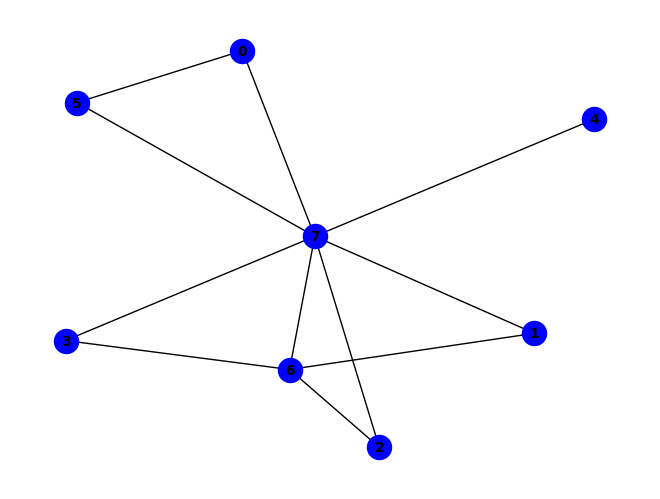


~g ^ (g & ~h) ^ (f & h & ~g) ^ (a & f & ~d & ~h) ^ (b & g & ~d & ~f) ^ (b & h & ~d & ~f) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & d & f & ~g & ~h) ^ (c & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (d & f & g & ~e & ~h) ^ (a & b & e & f & g & ~d) ^ (a & b & e & f & h & ~d) ^ (a & c & e & f & g & ~d) ^ (a & c & e & f & h & ~d) ^ (c & d & e & f & g & ~h) ^ (e & h & ~c & ~f & ~g) ^ (a & b & c & f & ~d & ~g) ^ (a & b & c & f & ~d & ~h) ^ (a & b & c & h & ~e & ~g) ^ (a & b & e & h & ~d & ~g) ^ (a & c & e & h & ~d & ~g) ^ (b & c & d & g & ~a & ~f) ^ (b & c & d & h & ~a & ~f) ^ (a & b & c & d & f & h & ~g) ^ (a & b & c & e & f & h & ~g) ^ (a & b & h & ~d & ~f & ~g) ^ (a & c & h & ~d & ~f & ~g) ^ (b & f & g & ~c & ~d & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & h & ~d & ~e & ~f & ~g) ^ (a & b & f & g & ~d & ~e & ~h) ^ (a & c & f & g & ~d & ~e & ~h) ^ (a & b & c & d & e & h & ~f & ~g) ^ (b & e & h & ~c &

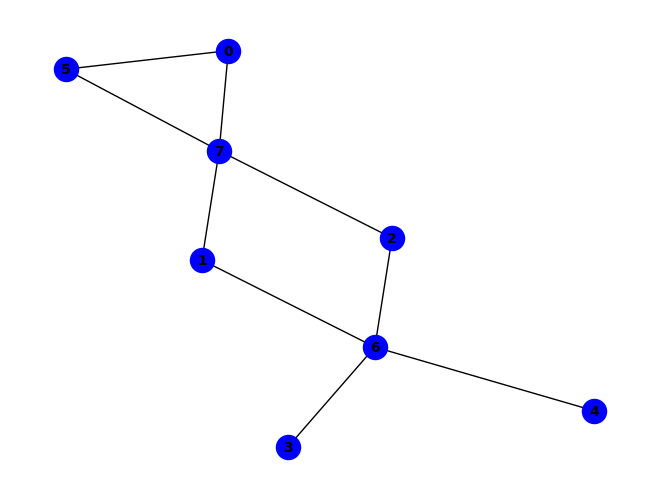


~f ^ (a & f & ~e) ^ (a & h & ~e) ^ (b & f & ~e) ^ (b & h & ~c) ^ (c & g & ~h) ^ (f & ~b & ~h) ^ (a & e & f & ~g) ^ (b & e & f & ~h) ^ (a & c & d & g & h) ^ (b & g & ~c & ~h) ^ (c & h & ~a & ~f) ^ (e & g & ~b & ~c) ^ (a & c & e & h & ~d) ^ (a & c & f & g & ~h) ^ (a & d & g & h & ~e) ^ (b & c & f & h & ~e) ^ (e & f & g & h & ~c) ^ (a & b & h & ~c & ~f) ^ (a & e & h & ~c & ~g) ^ (a & b & d & g & h & ~c) ^ (a & b & e & f & g & ~c) ^ (a & c & d & e & h & ~g) ^ (a & c & d & f & g & ~b) ^ (a & c & e & f & g & ~d) ^ (b & d & e & f & h & ~c) ^ (b & d & f & g & h & ~c) ^ (a & b & c & d & e & f & g) ^ (d & g & ~b & ~c & ~e) ^ (a & b & f & g & ~c & ~h) ^ (a & d & f & g & ~b & ~e) ^ (d & f & g & h & ~c & ~e) ^ (a & b & e & g & h & ~c & ~d) ^ (b & e & f & h & ~c & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

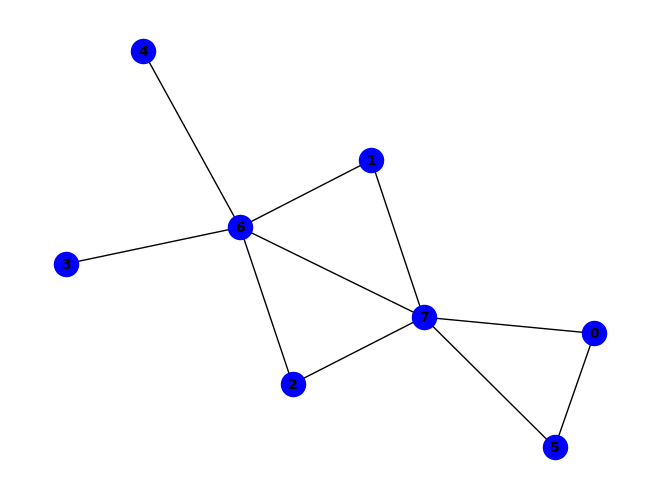


(~e & ~g) ^ (f & h & ~g) ^ (e & ~d & ~h) ^ (g & ~d & ~h) ^ (a & e & f & ~g) ^ (c & f & g & ~h) ^ (a & f & ~e & ~h) ^ (b & g & ~c & ~f) ^ (b & h & ~c & ~f) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (e & h & ~a & ~g) ^ (a & d & e & f & ~h) ^ (a & c & g & ~e & ~h) ^ (b & d & g & ~c & ~h) ^ (b & f & g & ~c & ~h) ^ (c & d & g & ~a & ~h) ^ (c & e & g & ~d & ~h) ^ (a & b & c & e & g & ~h) ^ (a & h & ~e & ~f & ~g) ^ (d & e & ~a & ~g & ~h) ^ (a & b & f & g & ~e & ~h) ^ (a & c & d & g & ~f & ~h) ^ (a & d & f & g & ~b & ~h) ^ (a & b & d & e & f & g & ~h) ^ (a & b & h & ~c & ~f & ~g) ^ (b & e & g & ~c & ~d & ~h) ^ (a & b & c & f & g & ~d & ~h) ^ (a & c & d & e & g & ~b & ~h) ^ (a & c & d & e & ~b & ~f & ~h) ^ (a & c & e & g & ~b & ~f & ~h) ^ (a & d & e & ~c & ~f & ~g & ~h) ^ (a & b & c & d & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


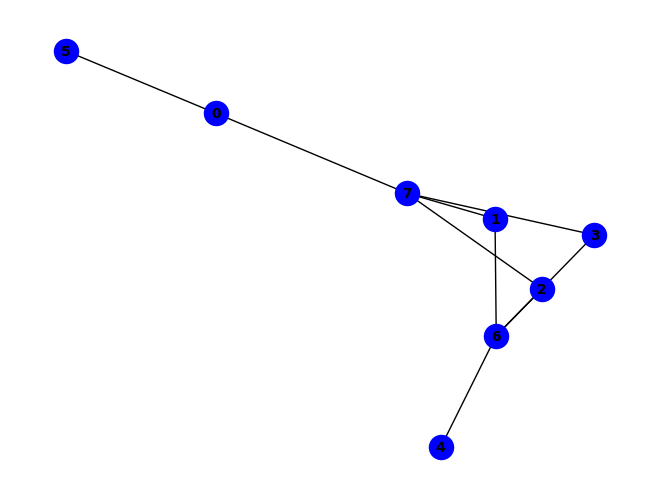


(e & ~g) ^ (~a & ~e) ^ (d & g & ~h) ^ (d & h & ~a) ^ (b & h & ~a & ~d) ^ (a & d & f & g & ~h) ^ (a & ~e & ~f & ~h) ^ (a & e & f & ~d & ~g) ^ (a & e & h & ~f & ~g) ^ (b & e & g & ~a & ~d) ^ (c & e & g & ~a & ~b) ^ (d & e & g & ~a & ~c) ^ (b & c & d & e & g & ~a) ^ (b & g & ~a & ~d & ~h) ^ (c & h & ~a & ~b & ~d) ^ (a & b & d & g & ~f & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (a & b & d & e & f & ~c & ~g) ^ (a & c & d & e & f & ~g & ~h) ^ (a & d & e & f & h & ~b & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (c & g & ~a & ~b & ~d & ~h) ^ (a & c & d & g & ~b & ~f & ~h) ^ (a & d & e & f & ~b & ~c & ~h) ^ (a & d & e & g & ~b & ~c & ~h) ^ (a & b & g & ~c & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


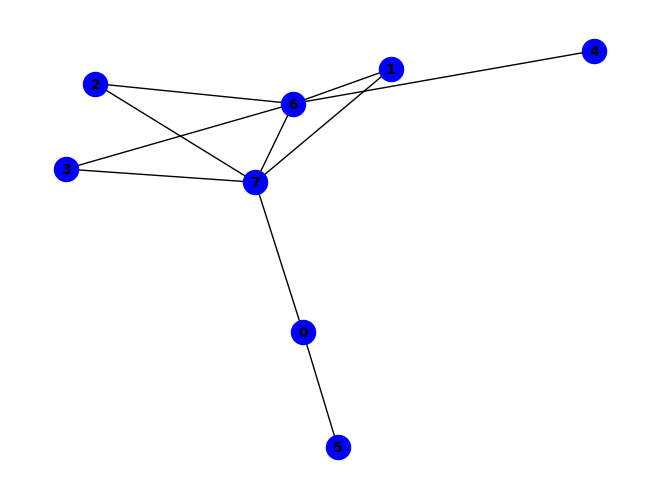


(b & h & ~e) ^ (c & g & ~e) ^ (a & c & f & g) ^ (a & c & f & h) ^ (g & ~a & ~h) ^ (a & d & g & ~c) ^ (a & d & h & ~c) ^ (a & e & h & ~g) ^ (a & b & c & d & g) ^ (a & b & c & d & h) ^ (~a & ~e & ~g) ^ (b & g & ~c & ~e) ^ (c & h & ~b & ~e) ^ (d & g & ~b & ~c) ^ (d & h & ~b & ~c) ^ (a & b & c & g & ~e) ^ (a & b & c & h & ~e) ^ (a & b & f & g & ~d) ^ (a & b & f & h & ~d) ^ (a & ~e & ~f & ~h) ^ (e & ~a & ~d & ~h) ^ (a & c & e & f & g & ~h) ^ (a & e & ~f & ~g & ~h) ^ (d & e & ~a & ~g & ~h) ^ (e & h & ~b & ~c & ~g) ^ (b & d & e & g & ~c & ~h) ^ (c & d & e & g & ~a & ~h) ^ (a & b & c & d & e & f & ~g) ^ (a & b & c & d & e & f & ~h) ^ (a & b & h & ~d & ~f & ~g) ^ (a & c & d & ~e & ~f & ~g) ^ (a & c & d & ~e & ~f & ~h) ^ (a & c & h & ~d & ~f & ~g) ^ (a & d & g & ~e & ~f & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & c & e & h & ~d & ~g) ^ (a & b & e & f & g & ~d & ~h) ^ (a & b & c & g & ~e & ~f & ~h) ^ (a & c & d & e & h & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

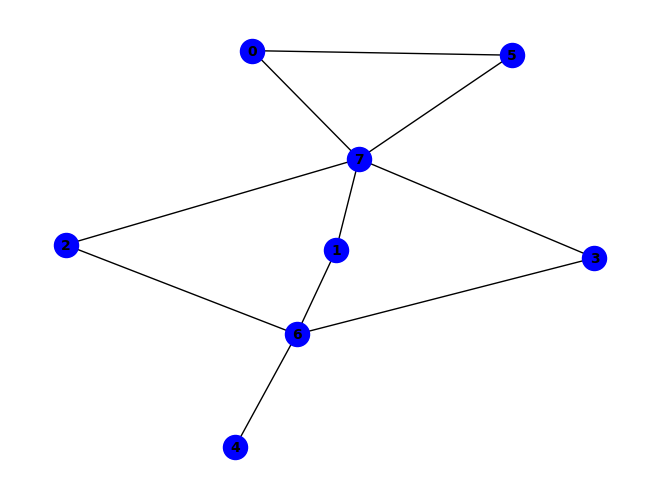


~f ^ (a & f & ~e) ^ (a & h & ~e) ^ (b & f & ~e) ^ (b & h & ~d) ^ (f & ~b & ~h) ^ (a & e & h & ~g) ^ (b & e & f & ~h) ^ (a & d & e & f & g) ^ (b & g & ~c & ~h) ^ (c & g & ~d & ~h) ^ (d & g & ~b & ~h) ^ (d & h & ~a & ~f) ^ (a & c & e & f & ~d) ^ (a & d & f & g & ~h) ^ (b & c & d & g & ~h) ^ (b & d & f & h & ~e) ^ (a & b & c & d & e & f) ^ (a & b & c & e & f & g) ^ (a & c & h & ~d & ~f) ^ (a & e & f & ~c & ~g) ^ (a & b & e & f & g & ~d) ^ (a & b & e & g & h & ~c) ^ (a & c & e & g & h & ~d) ^ (a & d & e & g & h & ~b) ^ (a & b & c & d & e & g & h) ^ (c & h & ~b & ~d & ~f) ^ (e & g & ~b & ~c & ~d) ^ (a & c & f & g & ~d & ~h) ^ (b & e & f & h & ~d & ~g) ^ (e & f & g & h & ~c & ~d) ^ (b & c & e & f & g & h & ~d) ^ (a & b & h & ~c & ~d & ~f) ^ (a & c & d & e & f & ~b & ~g) ^ (a & b & f & g & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

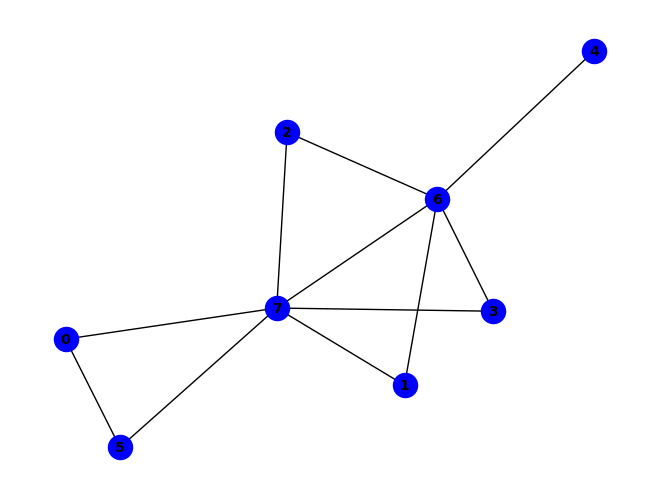


(g & ~h) ^ (~e & ~g) ^ (f & h & ~g) ^ (d & f & g & ~h) ^ (a & f & ~d & ~h) ^ (b & g & ~d & ~f) ^ (b & h & ~d & ~f) ^ (c & e & ~d & ~g) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~c & ~g) ^ (a & c & d & h & ~g) ^ (c & d & e & h & ~g) ^ (e & ~c & ~d & ~h) ^ (a & d & f & ~g & ~h) ^ (c & f & g & ~d & ~h) ^ (a & h & ~d & ~f & ~g) ^ (a & b & e & g & ~d & ~h) ^ (a & b & f & g & ~d & ~h) ^ (a & c & d & f & ~b & ~g) ^ (a & c & d & f & ~b & ~h) ^ (a & e & f & g & ~d & ~h) ^ (b & c & d & g & ~a & ~f) ^ (b & c & d & h & ~a & ~f) ^ (a & b & c & d & f & h & ~g) ^ (a & b & e & ~d & ~f & ~g) ^ (a & b & e & ~d & ~f & ~h) ^ (a & c & f & ~b & ~e & ~g) ^ (a & c & f & ~b & ~e & ~h) ^ (a & c & h & ~b & ~e & ~g) ^ (b & e & g & ~c & ~d & ~h) ^ (b & f & g & ~c & ~d & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & c & e & h & ~b & ~f & ~g) ^ (a & c & d & e & f & g & ~b & ~h) ^ (a & b & h & ~d & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

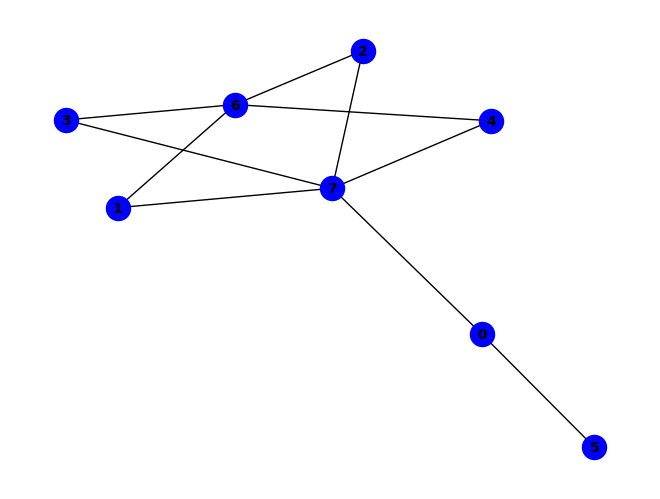


~d ^ (a & f & ~h) ^ (a & h & ~e) ^ (e & h & ~d) ^ (d & ~g & ~h) ^ (a & c & g & ~e) ^ (b & c & h & ~e) ^ (b & h & ~d & ~e) ^ (c & h & ~d & ~e) ^ (e & g & ~d & ~h) ^ (a & d & e & h & ~c) ^ (a & d & f & h & ~c) ^ (a & e & f & g & ~h) ^ (b & c & d & g & ~e) ^ (a & b & g & ~c & ~e) ^ (a & d & g & ~c & ~f) ^ (b & c & g & ~e & ~h) ^ (a & b & ~e & ~f & ~g) ^ (a & b & ~e & ~f & ~h) ^ (b & g & ~d & ~e & ~h) ^ (c & g & ~d & ~e & ~h) ^ (a & b & d & h & ~c & ~e) ^ (a & b & f & h & ~e & ~g) ^ (b & c & d & h & ~e & ~g) ^ (a & c & h & ~b & ~e & ~g) ^ (a & d & e & ~c & ~f & ~g) ^ (a & d & e & ~c & ~f & ~h) ^ (a & d & g & ~c & ~e & ~h) ^ (a & c & g & ~b & ~e & ~f & ~h) ^ (a & d & h & ~c & ~e & ~f & ~g) ^ (a & b & d & f & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

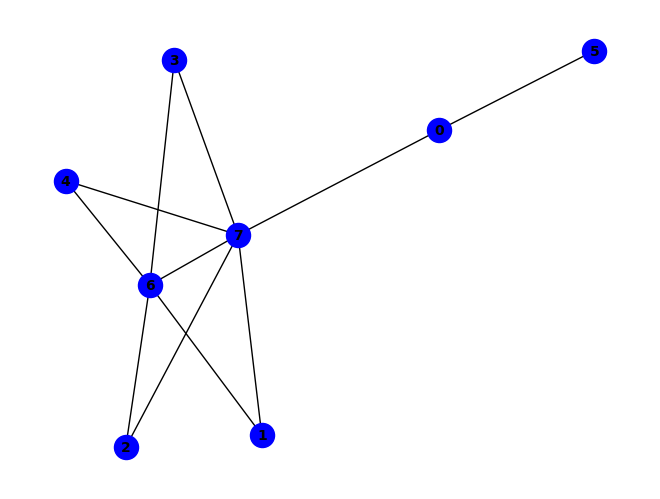


(~a & ~g) ^ (c & g & ~d) ^ (d & g & ~e) ^ (e & g & ~c) ^ (e & h & ~a) ^ (g & ~a & ~h) ^ (a & e & g & ~d) ^ (b & h & ~c & ~e) ^ (c & h & ~d & ~e) ^ (d & h & ~b & ~e) ^ (a & d & e & h & ~c) ^ (a & d & f & g & ~c) ^ (a & d & f & h & ~c) ^ (c & d & e & g & ~a) ^ (a & ~e & ~f & ~h) ^ (a & b & g & ~d & ~e) ^ (a & b & h & ~d & ~e) ^ (a & c & g & ~b & ~e) ^ (a & c & h & ~b & ~e) ^ (a & b & c & d & g & ~e) ^ (a & e & ~f & ~g & ~h) ^ (b & g & ~c & ~d & ~e) ^ (b & c & d & h & ~a & ~e) ^ (a & d & e & ~c & ~f & ~g) ^ (a & d & e & ~c & ~f & ~h) ^ (a & b & g & ~d & ~e & ~f & ~h) ^ (a & c & g & ~b & ~e & ~f & ~h) ^ (a & d & h & ~c & ~e & ~f & ~g) ^ (a & b & c & d & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


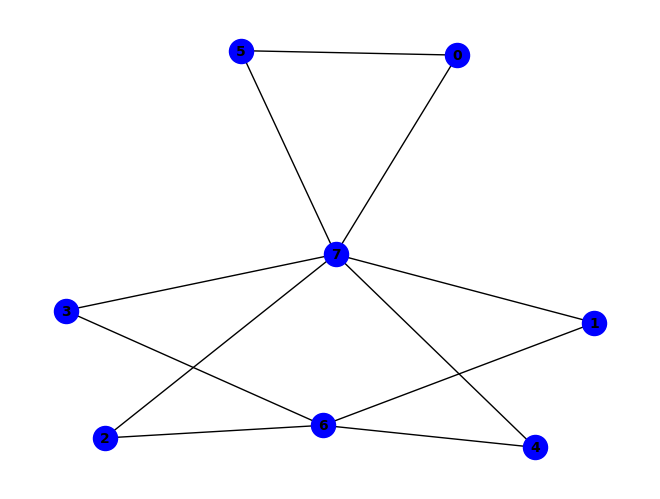


~f ^ (a & b & h) ^ (a & f & ~e) ^ (a & h & ~d) ^ (b & f & ~e) ^ (b & h & ~e) ^ (e & g & ~h) ^ (a & b & f & g) ^ (a & c & d & h) ^ (a & e & f & h) ^ (b & d & e & g) ^ (f & ~b & ~h) ^ (a & c & h & ~e) ^ (b & d & g & ~h) ^ (b & d & e & f & h) ^ (b & g & ~e & ~h) ^ (d & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (e & h & ~a & ~f) ^ (a & c & f & g & ~e) ^ (a & d & f & g & ~c) ^ (b & c & d & h & ~g) ^ (a & e & f & ~g & ~h) ^ (b & c & g & ~d & ~e) ^ (b & c & h & ~e & ~g) ^ (b & d & h & ~a & ~f) ^ (b & e & f & ~a & ~h) ^ (c & g & ~d & ~e & ~h) ^ (c & h & ~d & ~e & ~f) ^ (a & b & e & f & ~d & ~g) ^ (a & b & e & h & ~d & ~f) ^ (a & b & f & h & ~e & ~g) ^ (a & c & f & h & ~e & ~g) ^ (a & d & e & h & ~c & ~f) ^ (a & d & f & h & ~c & ~g) ^ (b & c & f & h & ~d & ~e) ^ (b & d & e & h & ~c & ~g) ^ (a & b & c & d & e & f & ~g) ^ (a & b & c & f & g & ~e & ~h) ^ (a & b & d & e & f & ~c & ~h) ^ (a & b & d & f & g & ~c & ~h) ^ (a & d & e & f & g & ~c & ~h) ^ (a & b & c & h & ~d & ~e & ~f) ^ (a & b & d & e & f & h

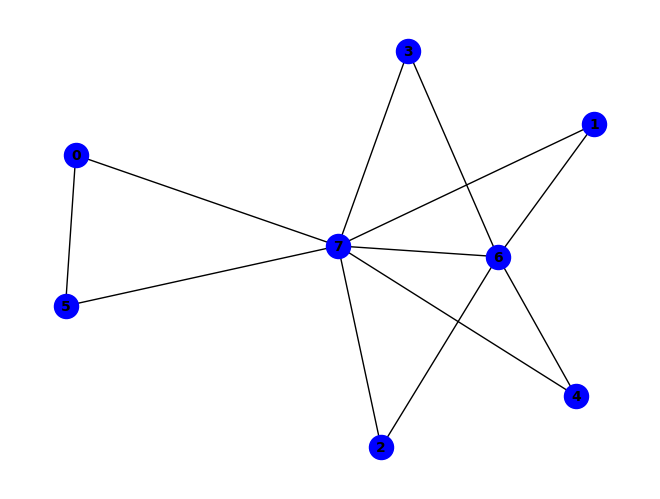


~g ^ (g & ~h) ^ (f & h & ~g) ^ (a & f & ~e & ~h) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (d & g & ~e & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (e & f & g & ~c & ~h) ^ (b & h & ~c & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & c & e & f & ~d & ~h) ^ (b & c & d & h & ~e & ~f) ^ (c & d & e & g & ~a & ~f) ^ (c & d & e & h & ~a & ~f) ^ (a & e & f & ~c & ~g & ~h) ^ (c & f & g & ~a & ~d & ~h) ^ (d & f & g & ~a & ~e & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (b & c & d & f & g & ~a & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (b & g & ~c & ~d & ~e & ~f) ^ (a & c & d & h & ~b & ~f & ~g) ^ (b & c & f & g & ~a & ~e & ~h) ^ (a & b & c & d & e & h & ~f & ~g) ^ (a & c & h & ~b & ~e & ~f & ~g) ^ (b & f & g & ~a & ~d & ~e & ~h) ^ (a & h & ~b & ~d & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

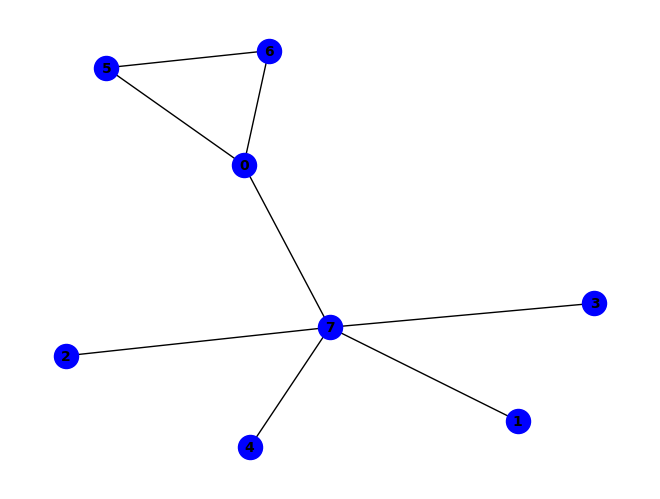


~f ^ (a & g & ~h) ^ (a & h & ~e) ^ (a & e & f & g) ^ (a & f & g & h) ^ (f & ~e & ~g) ^ (a & f & ~e & ~h) ^ (b & h & ~d & ~f) ^ (e & h & ~b & ~f) ^ (b & d & e & h & ~f) ^ (d & h & ~a & ~e & ~f) ^ (e & f & ~a & ~g & ~h) ^ (a & d & f & h & ~e & ~g) ^ (a & c & h & ~d & ~e & ~f) ^ (b & f & h & ~c & ~e & ~g) ^ (d & f & h & ~b & ~e & ~g) ^ (b & c & d & f & h & ~e & ~g) ^ (c & h & ~b & ~d & ~e & ~f) ^ (a & b & h & ~c & ~d & ~e & ~f) ^ (c & f & h & ~a & ~d & ~e & ~g) ^ (a & b & f & h & ~c & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


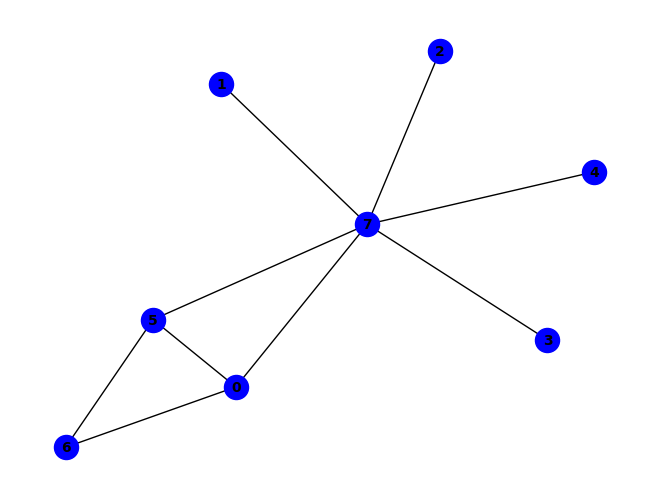


~e ^ (a & f & ~e) ^ (a & g & ~h) ^ (a & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (a & e & f & ~d & ~h) ^ (d & e & f & ~c & ~h) ^ (a & c & d & e & f & ~h) ^ (b & c & d & e & f & ~h) ^ (d & h & ~a & ~c & ~f) ^ (b & c & d & h & ~a & ~f) ^ (a & b & c & d & e & h & ~f) ^ (b & h & ~a & ~d & ~e & ~f) ^ (c & h & ~a & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


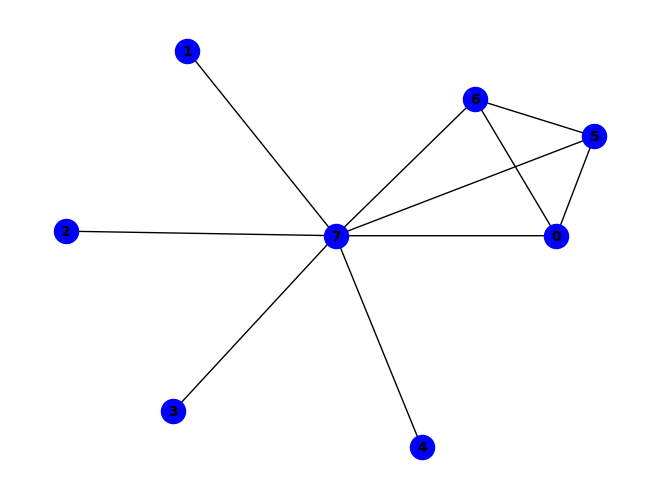


~g ^ (a & f & ~e) ^ (a & g & ~f) ^ (a & h & ~e) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (c & f & g & ~h) ^ (e & h & ~d & ~g) ^ (a & b & e & f & ~g) ^ (a & c & e & h & ~f) ^ (a & e & f & g & ~d) ^ (a & e & g & h & ~c) ^ (d & e & f & g & ~c) ^ (a & d & h & ~f & ~g) ^ (a & e & f & ~b & ~h) ^ (a & f & g & ~e & ~h) ^ (e & f & g & ~d & ~h) ^ (a & b & e & f & g & ~h) ^ (a & d & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (d & h & ~c & ~f & ~g) ^ (a & b & e & h & ~d & ~g) ^ (a & d & e & h & ~c & ~g) ^ (c & d & e & h & ~b & ~g) ^ (d & e & f & h & ~a & ~c) ^ (a & b & d & e & f & h & ~g) ^ (a & c & e & f & g & h & ~d) ^ (b & c & d & e & f & h & ~g) ^ (a & b & h & ~d & ~f & ~g) ^ (a & c & h & ~d & ~f & ~g) ^ (b & c & h & ~d & ~f & ~g) ^ (c & e & h & ~b & ~f & ~g) ^ (b & h & ~d & ~e & ~f & ~g) ^ (a & b & c & h & ~d & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


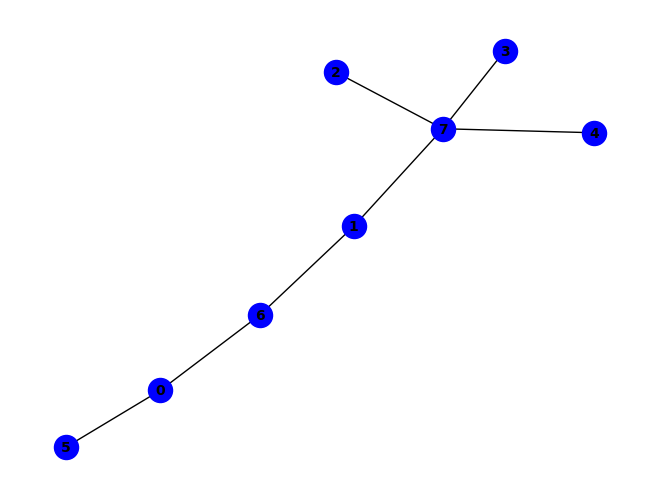


(~a & ~e) ^ (a & ~f & ~g) ^ (e & ~a & ~h) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~c & ~e) ^ (c & h & ~a & ~d & ~e) ^ (d & h & ~a & ~b & ~e) ^ (b & c & d & h & ~a & ~e) ^ (a & d & h & ~c & ~f & ~g) ^ (a & e & h & ~d & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (a & b & h & ~d & ~e & ~f & ~g) ^ (a & c & h & ~b & ~e & ~f & ~g) ^ (a & c & d & e & h & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


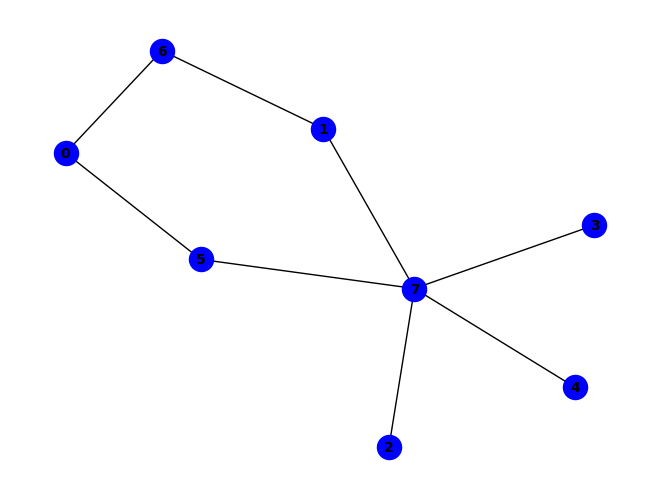


(a & b & g) ^ (~a & ~f) ^ (b & f & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (e & h & ~f) ^ (a & d & f & g) ^ (a & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & f & g & h) ^ (a & f & ~d & ~h) ^ (d & h & ~e & ~f) ^ (a & d & g & h & ~e) ^ (b & d & e & f & ~c) ^ (b & d & e & h & ~c) ^ (a & d & e & f & g & h) ^ (a & d & f & ~g & ~h) ^ (b & c & h & ~e & ~f) ^ (b & d & h & ~c & ~f) ^ (b & e & f & ~d & ~h) ^ (b & c & d & e & f & ~h) ^ (c & h & ~d & ~e & ~f) ^ (a & e & g & h & ~b & ~f) ^ (a & b & c & g & h & ~e & ~f) ^ (a & c & g & h & ~d & ~e & ~f) ^ (a & b & d & g & h & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


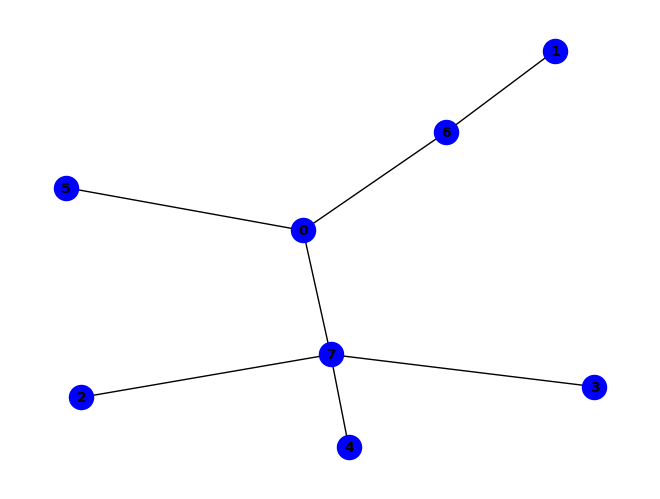


~e ^ (a & e & ~d) ^ (a & g & ~h) ^ (a & h & ~d) ^ (b & g & ~a) ^ (d & h & ~e) ^ (e & ~a & ~h) ^ (a & d & e & ~h) ^ (a & f & ~g & ~h) ^ (b & e & g & h & ~a) ^ (c & h & ~a & ~d & ~e) ^ (b & d & g & h & ~a & ~e) ^ (b & c & g & h & ~a & ~d & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


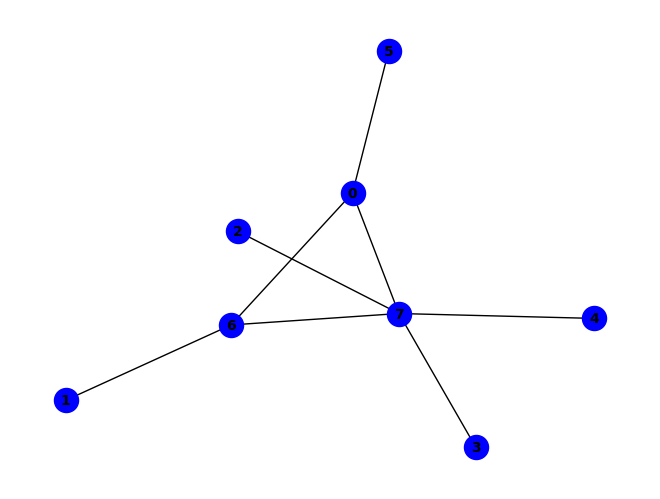


(a & f) ^ (~b & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (b & h & ~g) ^ (c & g & ~e) ^ (c & h & ~e) ^ (a & f & g & h) ^ (b & ~a & ~h) ^ (g & ~c & ~h) ^ (c & e & g & ~h) ^ (a & b & ~g & ~h) ^ (e & h & ~a & ~g) ^ (a & d & h & ~e & ~g) ^ (d & h & ~c & ~e & ~g) ^ (a & c & h & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


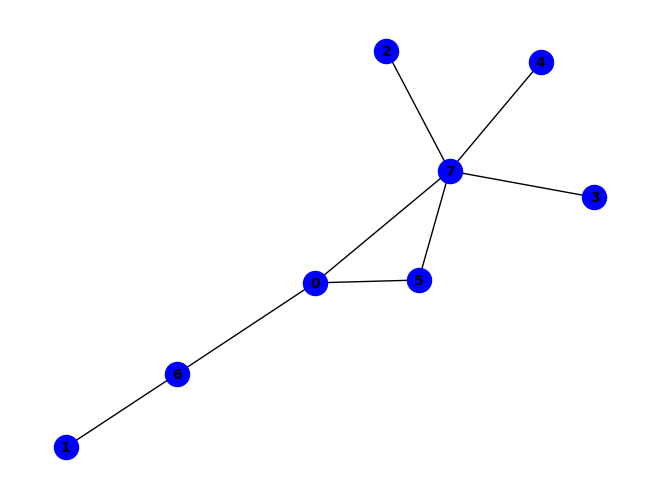


~f ^ (a & b & g) ^ (a & g & ~h) ^ (a & h & ~e) ^ (b & g & ~f) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (f & ~b & ~h) ^ (a & f & ~b & ~g) ^ (a & b & f & h & ~e) ^ (b & d & f & h & ~e) ^ (b & d & g & h & ~e) ^ (b & e & g & h & ~f) ^ (a & b & f & ~g & ~h) ^ (b & d & f & ~e & ~g) ^ (a & b & e & f & h & ~g) ^ (a & b & e & g & h & ~d) ^ (a & b & c & d & e & g & h) ^ (b & f & ~d & ~g & ~h) ^ (d & h & ~a & ~e & ~f) ^ (b & d & e & f & ~g & ~h) ^ (a & b & c & g & h & ~e & ~f) ^ (a & b & d & g & h & ~c & ~f) ^ (a & b & d & e & f & g & h & ~c) ^ (c & h & ~a & ~d & ~e & ~f) ^ (b & c & g & h & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


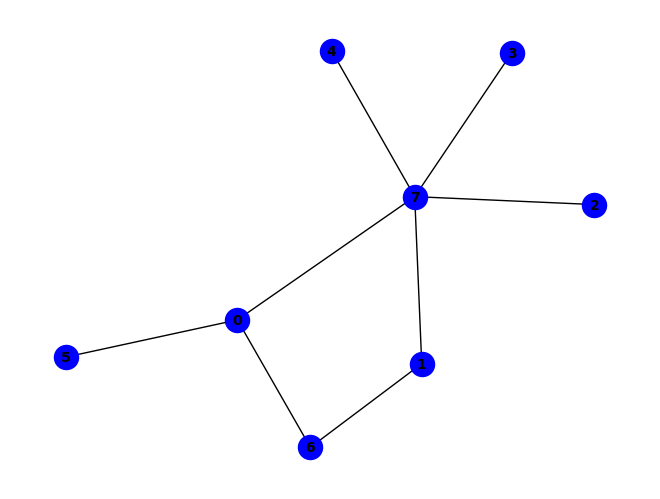


~e ^ (a & b & g) ^ (a & e & ~d) ^ (a & f & ~g) ^ (a & g & ~h) ^ (a & h & ~f) ^ (b & g & ~h) ^ (a & b & e & h) ^ (a & f & g & h) ^ (e & ~a & ~h) ^ (a & b & h & ~g) ^ (a & d & e & ~h) ^ (a & d & h & ~c) ^ (a & b & c & d & h) ^ (b & h & ~c & ~e) ^ (c & h & ~d & ~e) ^ (d & h & ~b & ~e) ^ (a & b & d & h & ~e) ^ (b & c & d & h & ~e) ^ (a & c & h & ~b & ~e) ^ (a & c & d & e & h & ~b)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


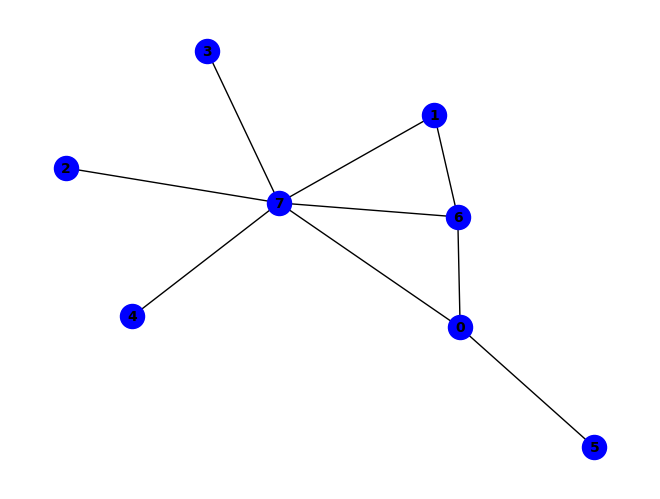


~g ^ (a & f & ~g) ^ (a & h & ~f) ^ (b & g & ~e) ^ (c & g & ~e) ^ (c & h & ~e) ^ (e & h & ~g) ^ (a & f & g & h) ^ (g & ~c & ~h) ^ (a & e & h & ~d) ^ (c & e & g & ~h) ^ (a & d & e & g & h) ^ (a & g & ~b & ~e) ^ (b & h & ~a & ~e) ^ (b & d & e & g & ~c) ^ (b & d & e & h & ~c) ^ (a & b & c & d & e & g) ^ (a & b & c & d & e & h) ^ (a & c & h & ~e & ~g) ^ (a & d & h & ~c & ~g) ^ (a & e & g & ~b & ~h) ^ (b & d & h & ~c & ~g) ^ (b & e & g & ~d & ~h) ^ (a & b & c & d & h & ~g) ^ (a & c & d & e & h & ~g) ^ (d & h & ~c & ~e & ~g) ^ (a & b & d & h & ~e & ~g) ^ (b & c & h & ~a & ~e & ~g) ^ (b & c & d & e & g & ~a & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


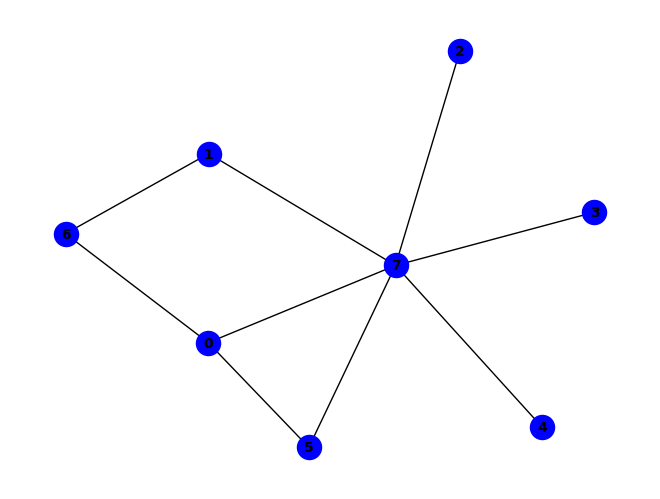


~f ^ (a & f & ~g) ^ (a & h & ~e) ^ (b & f & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (f & ~b & ~h) ^ (a & g & ~b & ~h) ^ (b & d & e & f & ~c) ^ (b & d & e & h & ~c) ^ (b & d & h & ~c & ~f) ^ (b & e & f & ~d & ~h) ^ (b & c & d & e & f & ~h) ^ (d & h & ~a & ~e & ~f) ^ (a & b & h & ~d & ~e & ~f) ^ (b & c & h & ~a & ~e & ~f) ^ (a & b & c & d & h & ~e & ~f) ^ (c & h & ~a & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


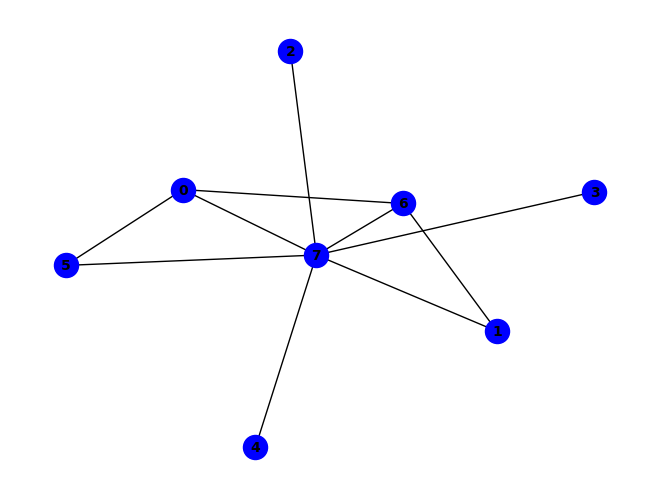


~g ^ (a & f & ~e) ^ (a & g & ~f) ^ (a & h & ~e) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & h & ~g) ^ (g & ~c & ~h) ^ (b & g & ~a & ~f) ^ (b & h & ~a & ~f) ^ (a & c & e & f & ~g) ^ (a & e & g & h & ~f) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (a & e & f & ~c & ~h) ^ (b & f & g & ~a & ~h) ^ (c & f & g & ~e & ~h) ^ (a & c & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (e & h & ~b & ~f & ~g) ^ (a & b & e & h & ~f & ~g) ^ (a & c & d & e & f & h & ~g) ^ (a & c & h & ~d & ~f & ~g) ^ (c & d & h & ~b & ~f & ~g) ^ (c & e & h & ~a & ~d & ~g) ^ (b & c & d & e & h & ~f & ~g) ^ (b & c & h & ~a & ~e & ~f & ~g) ^ (a & b & c & d & h & ~e & ~f & ~g) ^ (d & h & ~a & ~b & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

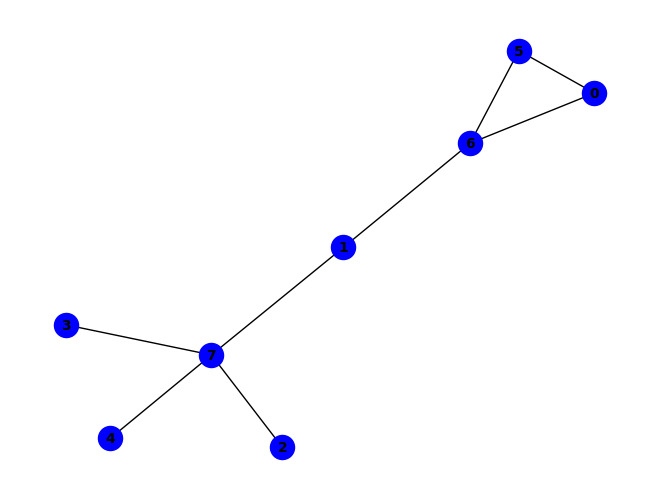


~f ^ (b & f & g) ^ (a & f & ~e) ^ (a & g & ~b) ^ (b & g & ~h) ^ (b & h & ~e) ^ (e & h & ~f) ^ (f & ~e & ~g) ^ (b & e & f & g & h) ^ (e & f & ~g & ~h) ^ (a & b & f & g & ~h) ^ (a & c & e & f & ~d) ^ (a & c & f & h & ~d) ^ (a & d & f & h & ~e) ^ (a & e & g & h & ~b) ^ (a & e & f & ~c & ~h) ^ (a & c & d & e & f & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & c & g & h & ~b & ~e) ^ (d & f & h & ~b & ~e & ~g) ^ (c & h & ~b & ~d & ~e & ~f) ^ (a & b & f & h & ~c & ~d & ~e) ^ (a & d & g & h & ~b & ~c & ~e) ^ (c & f & h & ~b & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


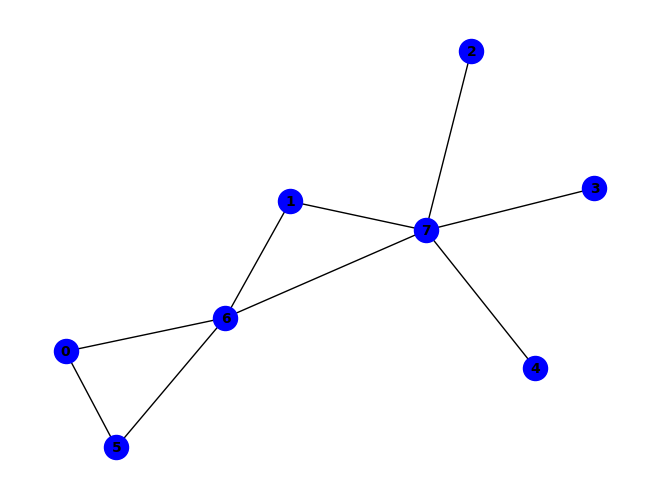


(g & ~h) ^ (a & f & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & ~b & ~h) ^ (b & e & g & ~h) ^ (~a & ~f & ~g) ^ (a & d & ~f & ~g) ^ (a & h & ~f & ~g) ^ (c & h & ~d & ~g) ^ (e & h & ~c & ~g) ^ (f & h & ~b & ~g) ^ (a & b & f & g & ~e) ^ (a & b & f & h & ~e) ^ (a & ~d & ~f & ~h) ^ (a & b & g & ~e & ~h) ^ (a & d & g & ~f & ~h) ^ (a & d & h & ~e & ~g) ^ (d & h & ~b & ~e & ~g) ^ (a & b & e & g & ~f & ~h) ^ (a & c & f & h & ~d & ~g) ^ (a & e & f & h & ~c & ~g) ^ (c & d & e & h & ~a & ~g) ^ (b & c & h & ~d & ~e & ~g) ^ (a & b & d & f & h & ~e & ~g) ^ (a & d & e & h & ~c & ~f & ~g) ^ (a & b & c & f & h & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


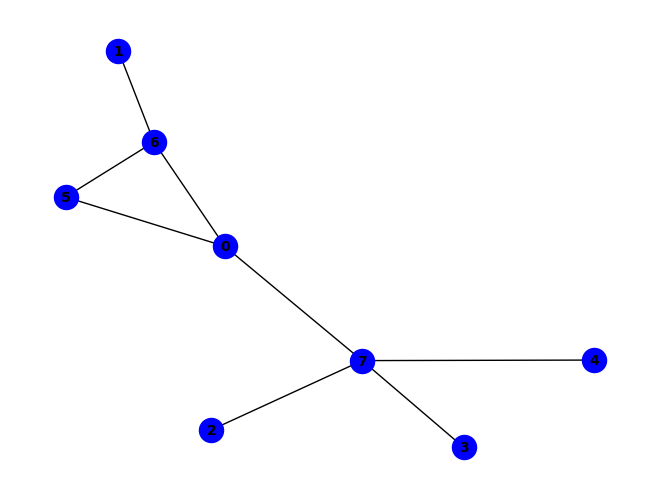


~f ^ (a & g & ~h) ^ (a & h & ~e) ^ (e & h & ~f) ^ (a & e & f & g) ^ (a & f & g & h) ^ (f & ~e & ~g) ^ (a & f & ~e & ~h) ^ (b & g & ~a & ~f) ^ (d & h & ~a & ~e & ~f) ^ (e & f & ~a & ~g & ~h) ^ (d & f & h & ~a & ~e & ~g) ^ (c & h & ~a & ~d & ~e & ~f) ^ (b & c & g & h & ~a & ~e & ~f) ^ (b & d & g & h & ~a & ~c & ~f) ^ (b & e & g & h & ~a & ~d & ~f) ^ (b & c & d & e & g & h & ~a & ~f) ^ (c & f & h & ~a & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


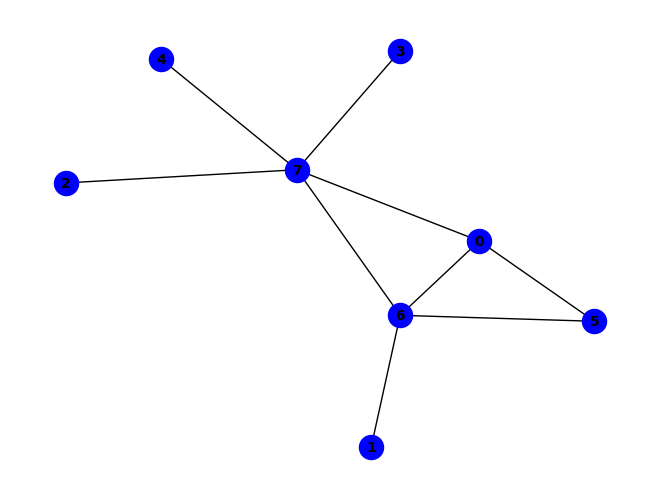


(~f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (g & ~b & ~h) ^ (a & b & g & ~h) ^ (a & e & g & ~h) ^ (b & f & ~a & ~g) ^ (c & h & ~d & ~g) ^ (e & h & ~c & ~g) ^ (f & h & ~b & ~g) ^ (a & b & f & h & ~g) ^ (c & d & e & h & ~g) ^ (f & ~a & ~b & ~h) ^ (d & h & ~a & ~e & ~g) ^ (a & c & h & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


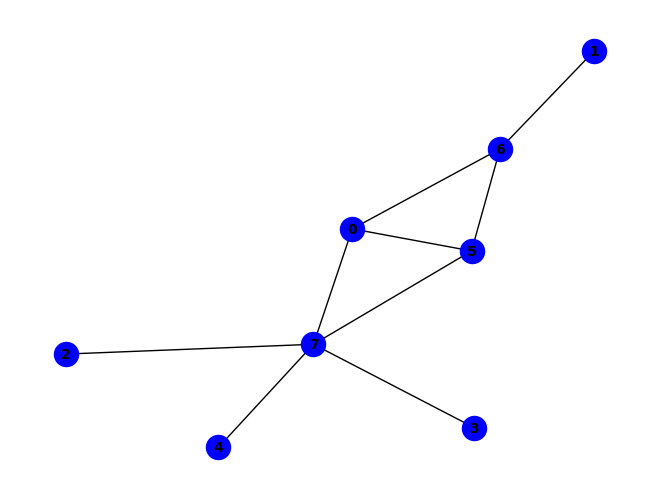


~e ^ (a & f & ~e) ^ (a & g & ~h) ^ (a & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & e & f & ~h) ^ (b & g & ~a & ~f) ^ (d & h & ~c & ~f) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (d & e & f & ~c & ~h) ^ (a & b & e & g & h & ~f) ^ (b & c & d & e & h & ~g) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (c & h & ~a & ~e & ~f) ^ (b & c & g & h & ~d & ~f) ^ (b & e & g & h & ~c & ~f) ^ (a & b & c & d & g & h & ~f) ^ (b & c & d & e & f & g & ~h) ^ (a & d & h & ~c & ~e & ~f) ^ (a & b & c & g & h & ~e & ~f) ^ (b & c & d & e & f & ~a & ~g) ^ (b & d & g & h & ~a & ~e & ~f) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


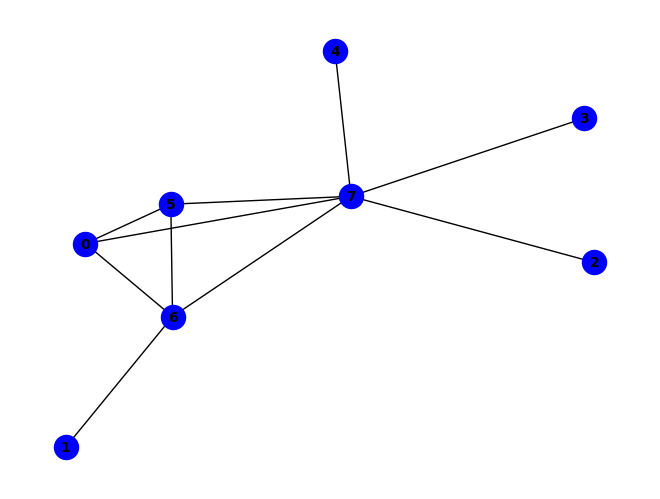


(~b & ~g) ^ (a & f & ~e) ^ (a & g & ~f) ^ (a & h & ~e) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & e & g & h) ^ (g & ~c & ~h) ^ (a & e & f & ~h) ^ (c & f & g & ~h) ^ (a & b & ~f & ~g) ^ (b & f & ~g & ~h) ^ (b & h & ~a & ~g) ^ (e & h & ~d & ~g) ^ (a & b & f & h & ~g) ^ (a & d & e & h & ~g) ^ (a & e & f & g & ~d) ^ (d & e & f & g & ~c) ^ (a & c & d & e & f & g) ^ (b & ~a & ~f & ~h) ^ (a & f & g & ~e & ~h) ^ (c & e & h & ~f & ~g) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (c & d & e & h & ~a & ~g) ^ (d & e & f & h & ~a & ~c) ^ (a & c & h & ~e & ~f & ~g) ^ (a & d & e & f & g & ~c & ~h) ^ (d & h & ~a & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


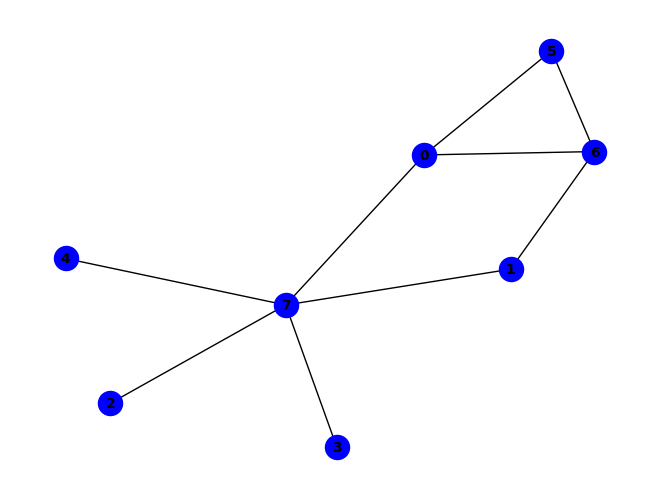


~f ^ (b & f & g) ^ (a & h & ~e) ^ (b & g & ~h) ^ (e & h & ~f) ^ (f & ~e & ~g) ^ (a & f & g & ~b) ^ (b & e & f & g & h) ^ (a & g & ~b & ~h) ^ (b & h & ~a & ~e) ^ (e & f & ~g & ~h) ^ (a & e & f & h & ~b) ^ (a & e & f & ~d & ~g) ^ (a & f & ~e & ~g & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & c & h & ~b & ~e & ~f) ^ (d & f & h & ~b & ~e & ~g) ^ (a & b & e & f & h & ~d & ~g) ^ (a & c & d & e & f & ~b & ~g) ^ (c & h & ~b & ~d & ~e & ~f) ^ (a & c & f & h & ~b & ~e & ~g) ^ (a & d & e & f & ~c & ~g & ~h) ^ (a & d & f & h & ~b & ~c & ~g) ^ (a & b & c & d & e & f & ~g & ~h) ^ (a & d & h & ~b & ~c & ~e & ~f) ^ (c & f & h & ~b & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


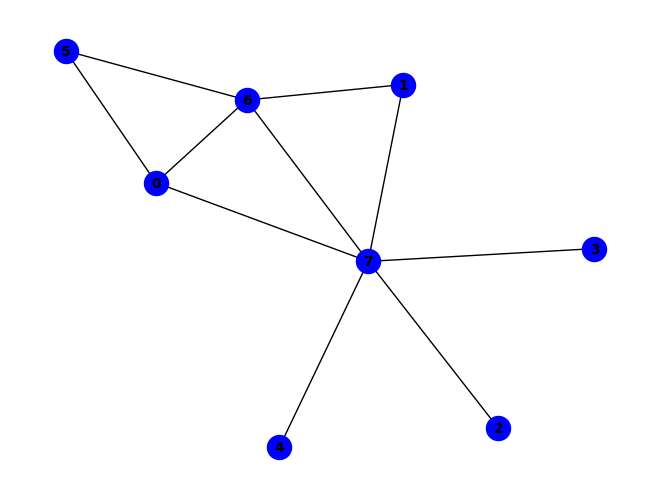


(g & ~h) ^ (~f & ~g) ^ (a & f & ~h) ^ (a & g & ~e) ^ (a & h & ~e) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & ~b & ~h) ^ (a & b & g & ~f) ^ (a & b & h & ~f) ^ (a & e & g & ~h) ^ (b & e & g & ~h) ^ (c & h & ~d & ~g) ^ (e & h & ~c & ~g) ^ (f & h & ~b & ~g) ^ (a & b & e & h & ~g) ^ (a & b & f & h & ~g) ^ (c & d & e & h & ~g) ^ (d & h & ~b & ~e & ~g) ^ (a & c & h & ~b & ~e & ~g) ^ (b & c & h & ~d & ~e & ~g) ^ (a & d & h & ~b & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


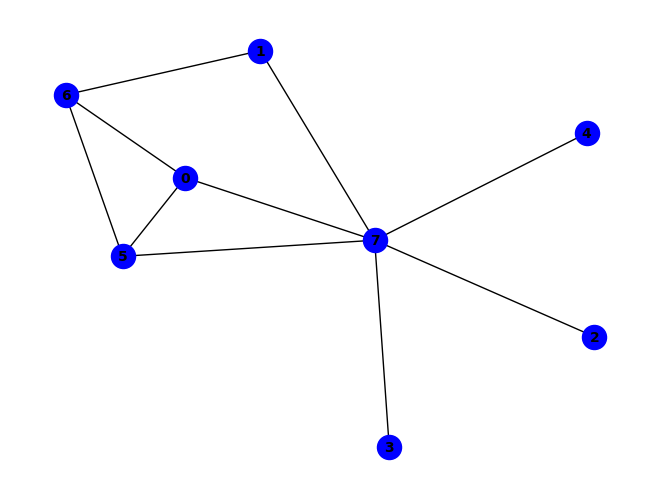


~e ^ (a & f & ~e) ^ (a & g & ~h) ^ (a & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & e & f & ~h) ^ (b & g & ~a & ~f) ^ (d & h & ~c & ~f) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (b & e & h & ~a & ~f) ^ (d & e & f & ~c & ~h) ^ (b & c & d & e & f & ~h) ^ (b & h & ~a & ~f & ~g) ^ (b & c & d & h & ~a & ~f) ^ (a & b & c & d & e & h & ~f) ^ (a & d & h & ~c & ~e & ~f) ^ (b & d & h & ~a & ~e & ~f) ^ (c & h & ~a & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


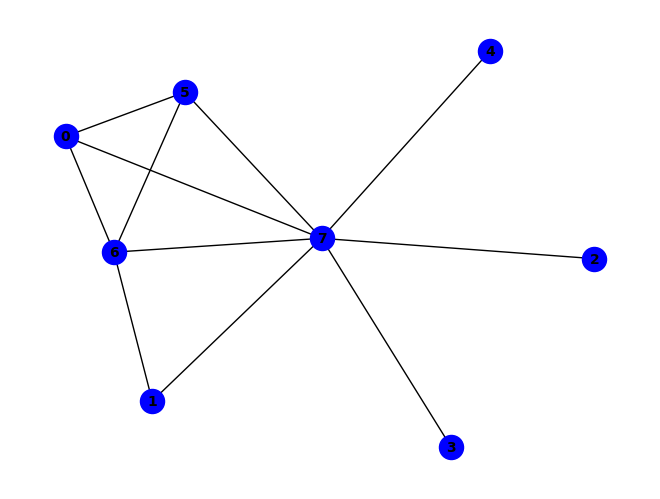


~g ^ (a & f & ~e) ^ (a & g & ~f) ^ (a & h & ~e) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (c & f & g & ~h) ^ (b & g & ~a & ~f) ^ (b & h & ~a & ~f) ^ (e & h & ~d & ~g) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (a & e & f & g & ~d) ^ (a & e & g & h & ~d) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & c & d & e & g & h) ^ (a & e & f & ~d & ~h) ^ (a & f & g & ~e & ~h) ^ (c & e & h & ~f & ~g) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (a & b & c & d & e & f & h) ^ (a & b & e & h & ~f & ~g) ^ (c & d & e & h & ~b & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & c & d & e & f & g & ~b) ^ (b & c & d & e & f & h & ~g) ^ (b & c & h & ~d & ~f & ~g) ^ (b & e & h & ~c & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (a & c & d & e & f & ~g & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (d & h & ~a & ~c & ~f & ~g) ^ (a & c & h & ~b & ~e & ~f & ~g) ^ (b & d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

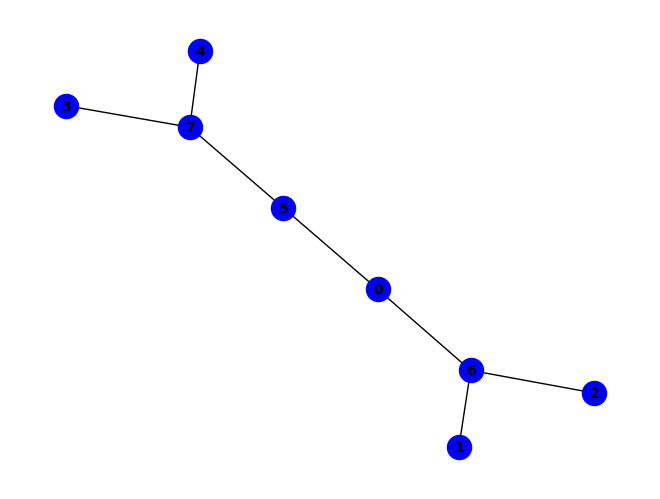


(a & c & g) ^ (~a & ~f) ^ (b & g & ~f) ^ (c & g & ~b) ^ (e & h & ~f) ^ (a & e & f & g) ^ (a & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & g & ~c) ^ (b & c & f & g & h) ^ (a & f & ~e & ~h) ^ (b & f & ~g & ~h) ^ (d & h & ~e & ~f) ^ (c & d & g & h & ~e) ^ (c & f & g & h & ~d) ^ (c & d & e & f & g & h) ^ (a & b & f & g & h & ~c) ^ (a & c & f & g & h & ~e) ^ (a & d & e & f & h & ~c) ^ (a & d & e & f & ~c & ~g) ^ (a & d & g & h & ~c & ~f) ^ (a & e & g & h & ~c & ~d) ^ (c & e & g & h & ~b & ~f) ^ (b & c & d & e & g & h & ~f) ^ (a & e & f & ~d & ~g & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (b & d & g & h & ~a & ~c & ~f) ^ (b & e & g & h & ~a & ~d & ~f) ^ (a & b & c & e & g & h & ~d & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


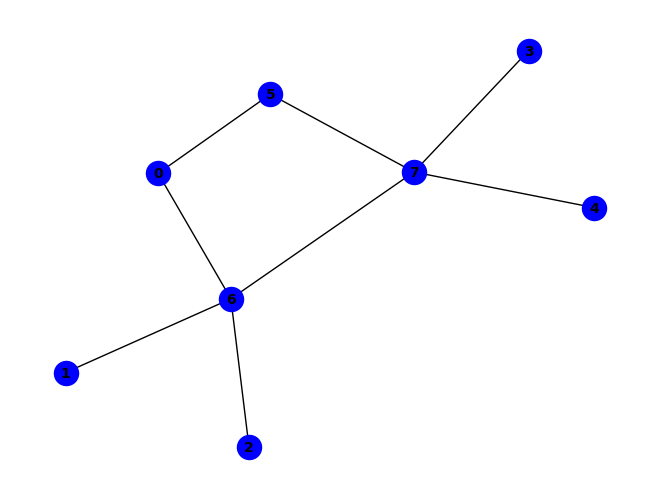


(~c & ~g) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~b & ~h) ^ (g & ~b & ~h) ^ (a & f & ~g & ~h) ^ (b & c & ~g & ~h) ^ (e & h & ~f & ~g) ^ (a & g & ~b & ~c & ~h) ^ (d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


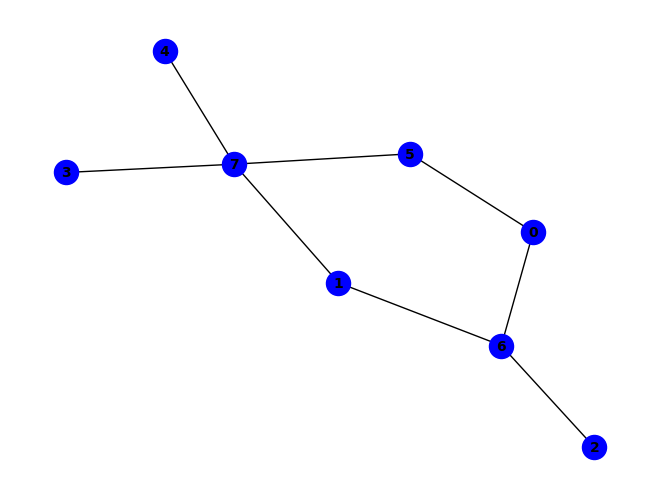


(a & c & g) ^ (~a & ~f) ^ (b & f & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (c & g & ~b) ^ (e & h & ~f) ^ (a & d & f & g) ^ (a & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & g & ~c) ^ (b & e & f & ~h) ^ (a & f & ~d & ~h) ^ (a & d & f & ~g & ~h) ^ (a & b & f & g & h & ~c) ^ (a & c & f & g & h & ~d) ^ (d & h & ~b & ~e & ~f) ^ (a & d & g & h & ~c & ~e) ^ (a & e & g & h & ~c & ~f) ^ (c & d & g & h & ~b & ~e) ^ (c & e & g & h & ~b & ~f) ^ (c & f & g & h & ~b & ~d) ^ (a & d & e & f & g & h & ~c) ^ (c & d & e & f & g & h & ~b) ^ (a & b & d & g & h & ~c & ~f) ^ (a & b & e & g & h & ~c & ~d & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


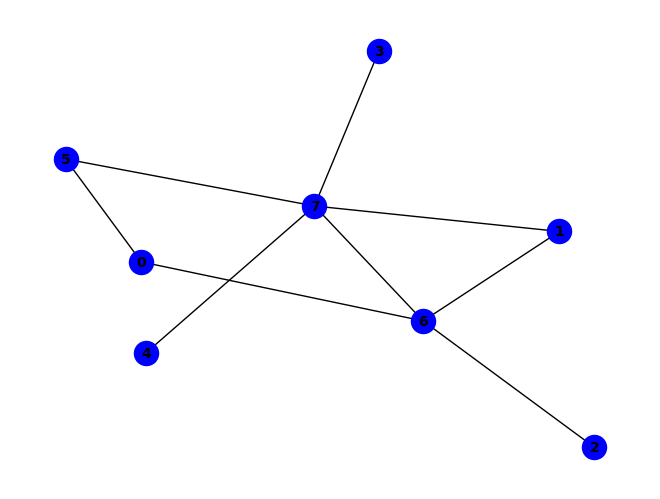


(~c & ~g) ^ (b & g & ~f) ^ (b & h & ~f) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~b & ~h) ^ (g & ~a & ~h) ^ (a & b & g & ~h) ^ (a & f & ~g & ~h) ^ (b & c & ~g & ~h) ^ (e & h & ~f & ~g) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (a & c & g & ~b & ~h) ^ (b & d & h & ~f & ~g) ^ (b & e & h & ~d & ~g) ^ (b & f & g & ~e & ~h) ^ (b & d & e & f & g & ~h) ^ (d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


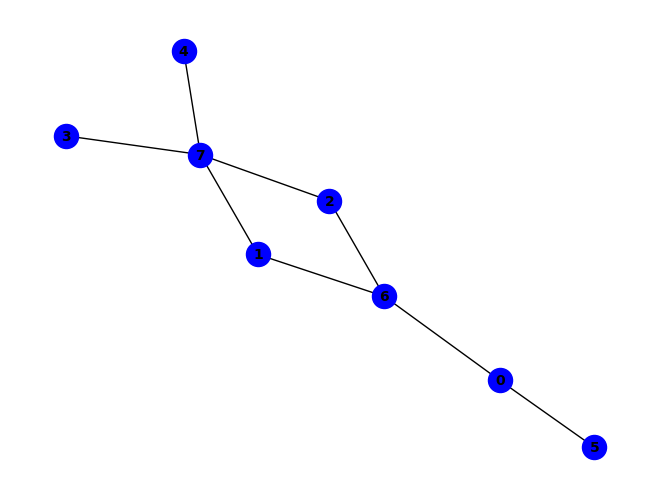


(~a & ~e) ^ (a & ~f & ~g) ^ (e & ~a & ~h) ^ (c & g & ~a & ~h) ^ (a & e & h & ~f & ~g) ^ (b & g & ~a & ~c & ~h) ^ (b & h & ~a & ~c & ~e) ^ (c & h & ~a & ~d & ~e) ^ (d & h & ~a & ~b & ~e) ^ (b & c & d & h & ~a & ~e) ^ (a & d & h & ~e & ~f & ~g) ^ (a & c & h & ~d & ~e & ~f & ~g) ^ (a & b & h & ~c & ~d & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


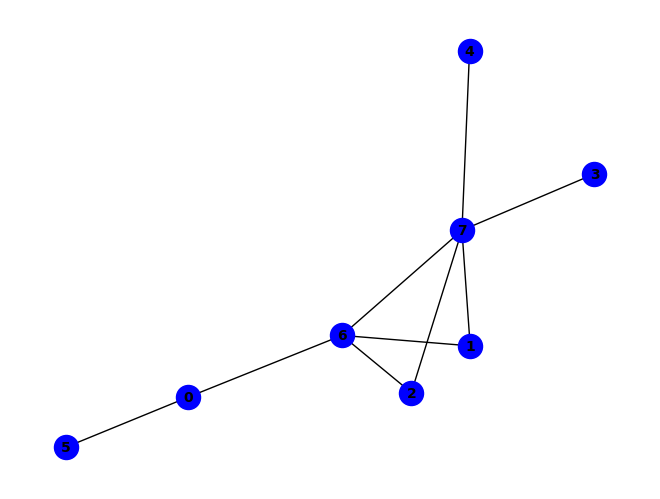


(~a & ~g) ^ (c & g & ~e) ^ (c & h & ~e) ^ (a & b & f & g) ^ (a & b & f & h) ^ (a & ~f & ~g) ^ (g & ~a & ~h) ^ (b & g & ~c & ~e) ^ (b & h & ~c & ~e) ^ (e & h & ~a & ~g) ^ (a & c & f & g & ~b) ^ (a & c & f & h & ~b) ^ (b & d & e & g & ~c) ^ (b & d & e & h & ~c) ^ (a & b & g & ~f & ~h) ^ (a & e & h & ~f & ~g) ^ (b & d & h & ~c & ~g) ^ (b & e & g & ~d & ~h) ^ (c & e & g & ~b & ~h) ^ (a & b & d & f & h & ~g) ^ (b & c & d & e & g & ~h) ^ (d & h & ~c & ~e & ~g) ^ (a & d & f & h & ~e & ~g) ^ (a & c & g & ~b & ~f & ~h) ^ (a & c & d & f & h & ~b & ~g) ^ (a & c & e & f & h & ~d & ~g) ^ (a & b & e & f & h & ~c & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


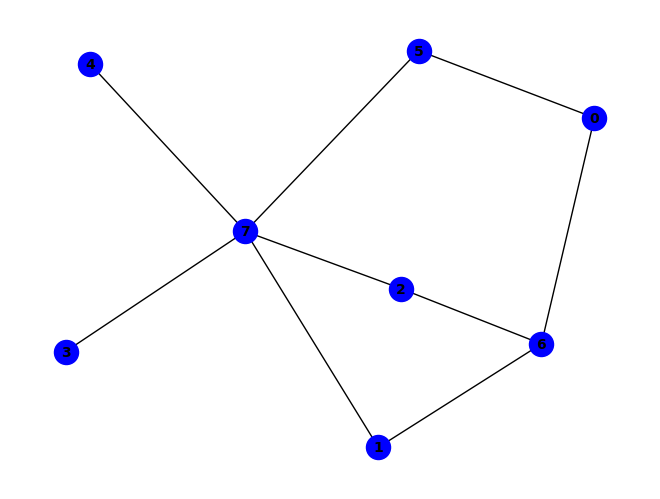


(a & c & g) ^ (b & c & g) ^ (~a & ~f) ^ (b & f & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & d & f & g) ^ (a & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & g & ~c) ^ (b & c & h & ~g) ^ (a & b & f & g & h) ^ (a & c & f & g & h) ^ (a & f & ~d & ~h) ^ (d & h & ~e & ~f) ^ (b & c & e & h & ~f) ^ (b & c & f & h & ~a) ^ (b & d & e & f & ~c) ^ (b & d & e & h & ~c) ^ (a & b & c & e & f & h) ^ (a & d & e & f & g & h) ^ (b & d & h & ~c & ~f) ^ (b & e & f & ~d & ~h) ^ (a & c & d & f & h & ~e) ^ (a & b & c & d & e & f & g) ^ (c & h & ~d & ~e & ~f) ^ (a & c & d & f & ~e & ~g) ^ (a & d & g & h & ~c & ~e) ^ (a & e & g & h & ~c & ~f) ^ (a & b & c & e & g & h & ~d) ^ (a & d & f & ~c & ~g & ~h) ^ (a & b & c & f & h & ~e & ~g) ^ (a & b & d & g & h & ~c & ~f) ^ (a & b & e & g & h & ~d & ~f) ^ (b & c & d & e & f & ~a & ~h) ^ (a & c & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

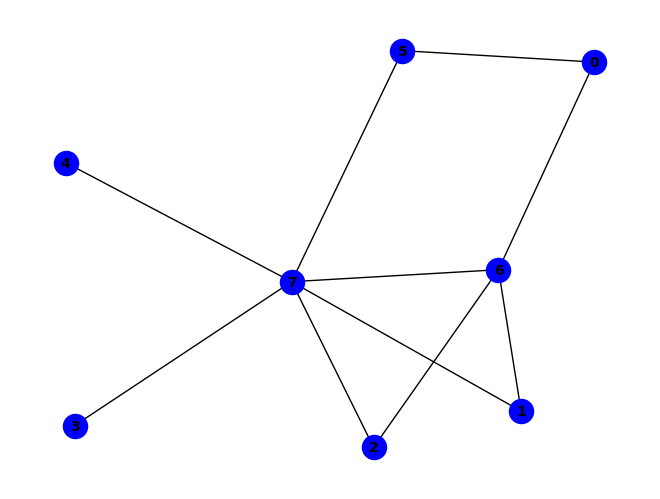


(g & ~h) ^ (~a & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & h & ~g) ^ (a & ~f & ~h) ^ (a & c & g & ~h) ^ (a & f & g & ~h) ^ (a & b & ~c & ~g) ^ (a & b & ~c & ~h) ^ (a & h & ~b & ~g) ^ (b & g & ~c & ~f) ^ (b & h & ~c & ~f) ^ (a & b & c & h & ~g) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (b & f & g & ~c & ~h) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (c & d & e & f & g & ~h) ^ (e & h & ~b & ~f & ~g) ^ (c & d & h & ~b & ~f & ~g) ^ (d & h & ~b & ~e & ~f & ~g) ^ (b & c & e & h & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


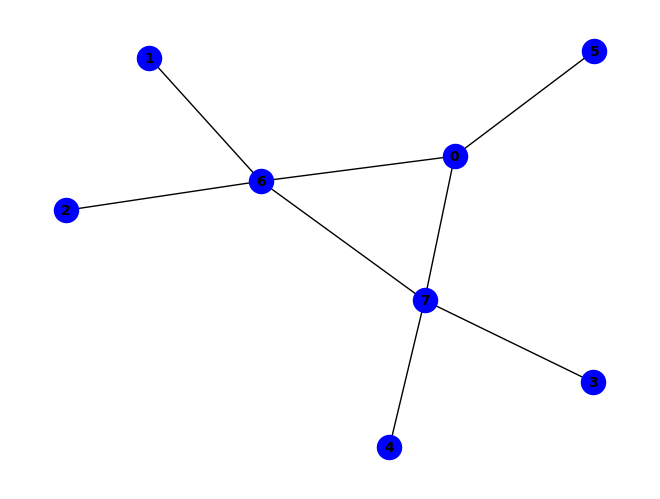


(~c & ~g) ^ (a & f & ~h) ^ (a & g & ~f) ^ (a & h & ~e) ^ (e & h & ~g) ^ (a & e & g & h) ^ (a & f & g & h) ^ (g & ~b & ~h) ^ (a & b & g & ~h) ^ (a & c & ~b & ~g) ^ (b & c & ~g & ~h) ^ (c & h & ~a & ~g) ^ (a & b & c & h & ~g) ^ (c & ~a & ~b & ~h) ^ (d & h & ~a & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


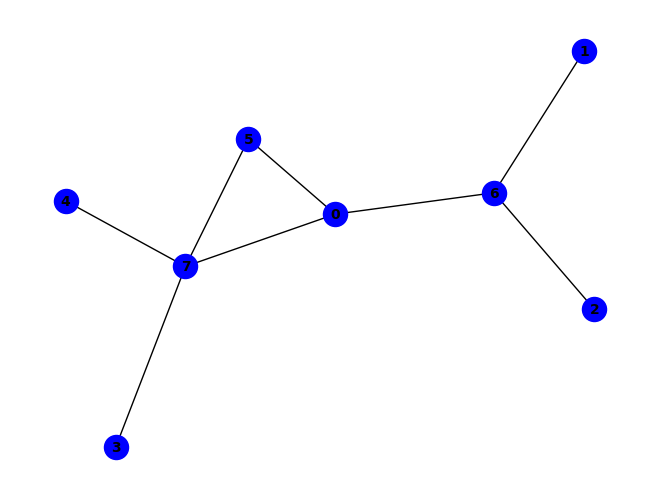


~f ^ (a & c & g) ^ (a & g & ~h) ^ (a & h & ~e) ^ (b & g & ~f) ^ (c & g & ~b) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (a & b & g & ~c) ^ (a & f & ~c & ~g) ^ (b & f & ~g & ~h) ^ (a & c & f & h & ~d) ^ (a & e & f & h & ~c) ^ (a & f & g & h & ~b) ^ (c & f & g & h & ~d) ^ (a & c & f & ~g & ~h) ^ (a & b & d & g & h & ~f) ^ (a & c & e & f & h & ~g) ^ (a & c & e & g & h & ~b) ^ (b & c & f & g & h & ~a) ^ (a & b & c & e & f & g & h) ^ (d & h & ~a & ~e & ~f) ^ (b & d & g & h & ~c & ~f) ^ (c & d & g & h & ~a & ~e) ^ (c & e & g & h & ~b & ~f) ^ (a & b & c & d & f & h & ~e) ^ (a & b & c & d & g & h & ~e) ^ (b & c & d & e & g & h & ~f) ^ (c & d & e & f & g & h & ~a) ^ (a & c & d & f & h & ~b & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (b & e & g & h & ~a & ~d & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


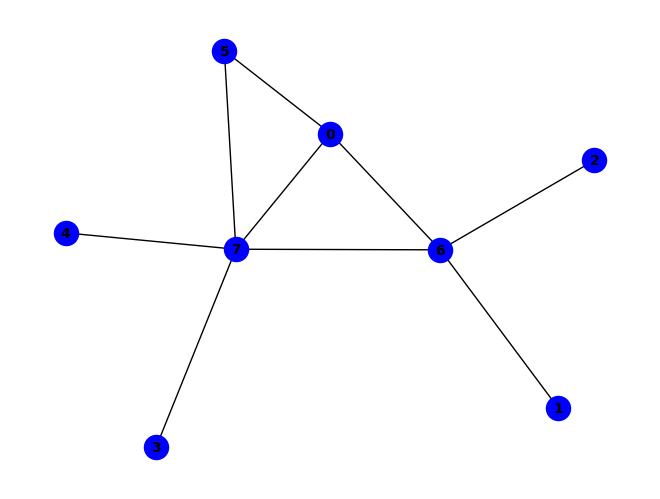


(~c & ~g) ^ (a & f & ~e) ^ (a & g & ~f) ^ (a & h & ~e) ^ (f & h & ~g) ^ (g & ~b & ~h) ^ (a & b & g & ~h) ^ (a & e & f & ~h) ^ (a & c & ~b & ~g) ^ (b & c & ~g & ~h) ^ (c & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & b & c & h & ~g) ^ (a & e & g & h & ~f) ^ (c & ~a & ~b & ~h) ^ (d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


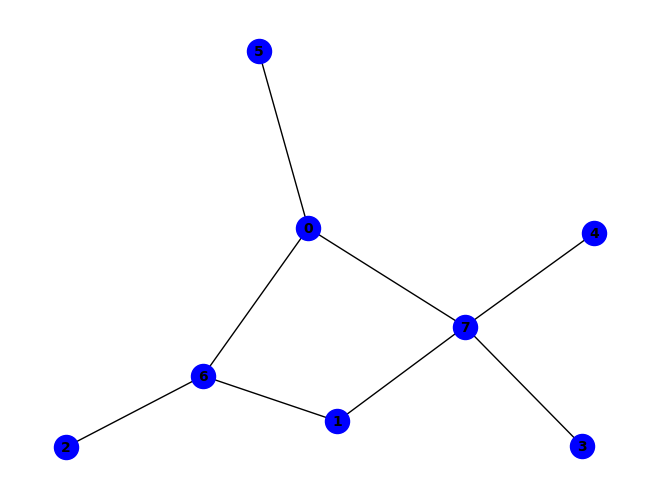


~e ^ (a & b & g) ^ (a & e & ~d) ^ (a & f & ~g) ^ (a & g & ~h) ^ (a & h & ~f) ^ (b & g & ~h) ^ (b & h & ~e) ^ (a & f & g & h) ^ (e & ~a & ~h) ^ (a & b & h & ~g) ^ (a & d & e & ~h) ^ (a & d & h & ~c) ^ (c & g & ~a & ~b) ^ (d & h & ~b & ~e) ^ (a & b & d & h & ~e) ^ (a & b & e & h & ~c) ^ (a & c & d & h & ~g) ^ (c & e & g & h & ~b) ^ (a & b & c & e & h & ~g) ^ (a & c & e & g & h & ~d) ^ (c & d & g & h & ~b & ~e) ^ (a & b & c & d & g & h & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


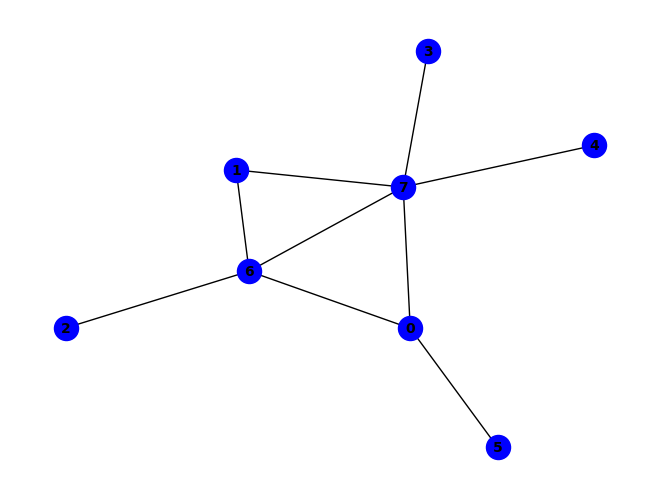


(a & f) ^ (g & ~h) ^ (~c & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (c & h & ~g) ^ (a & f & g & h) ^ (c & ~b & ~h) ^ (b & c & ~g & ~h) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (e & h & ~a & ~g) ^ (a & c & g & ~b & ~h) ^ (b & e & g & ~a & ~h) ^ (d & h & ~a & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


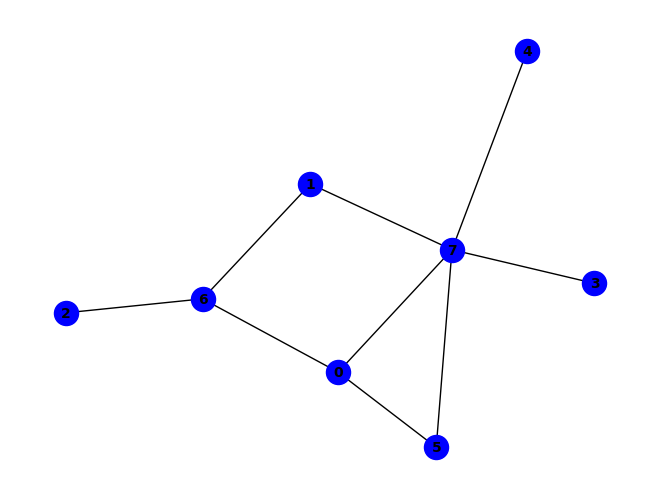


~f ^ (a & h & ~e) ^ (b & f & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (f & ~b & ~h) ^ (b & e & f & ~h) ^ (a & f & ~c & ~g) ^ (a & g & ~b & ~h) ^ (c & g & ~a & ~b) ^ (a & c & f & h & ~e) ^ (a & b & c & f & g & h) ^ (a & b & h & ~e & ~f) ^ (a & c & f & ~g & ~h) ^ (a & c & e & g & h & ~d) ^ (a & b & c & d & e & g & h) ^ (c & d & g & h & ~b & ~e) ^ (c & e & g & h & ~b & ~f) ^ (c & f & g & h & ~b & ~d) ^ (a & b & c & e & g & h & ~f) ^ (a & c & d & e & f & h & ~b) ^ (c & d & e & f & g & h & ~b) ^ (a & c & d & g & h & ~b & ~f) ^ (a & c & e & f & h & ~d & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (d & h & ~a & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


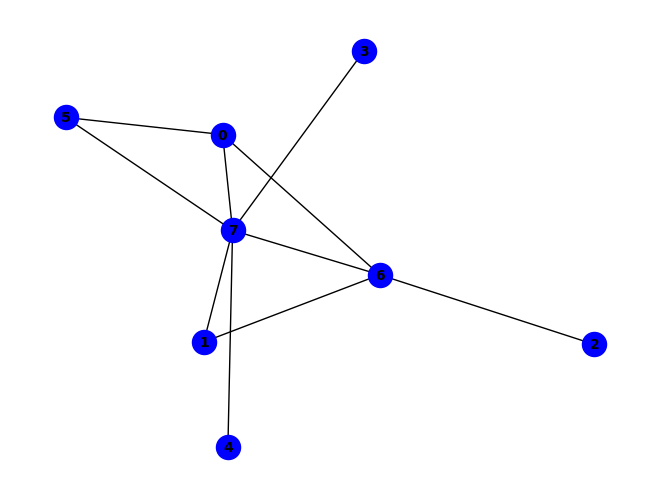


(g & ~h) ^ (~c & ~g) ^ (a & f & ~e) ^ (a & h & ~e) ^ (b & g & ~f) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~b & ~h) ^ (a & g & ~b & ~f) ^ (b & c & ~g & ~h) ^ (b & h & ~a & ~f) ^ (e & h & ~f & ~g) ^ (a & b & e & f & ~g) ^ (a & e & g & h & ~f) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (a & b & d & e & f & g) ^ (a & b & d & e & f & h) ^ (a & c & g & ~b & ~h) ^ (a & e & f & ~b & ~h) ^ (b & d & h & ~a & ~f & ~g) ^ (b & e & h & ~a & ~d & ~g) ^ (b & f & g & ~a & ~e & ~h) ^ (b & d & e & f & g & ~a & ~h) ^ (d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


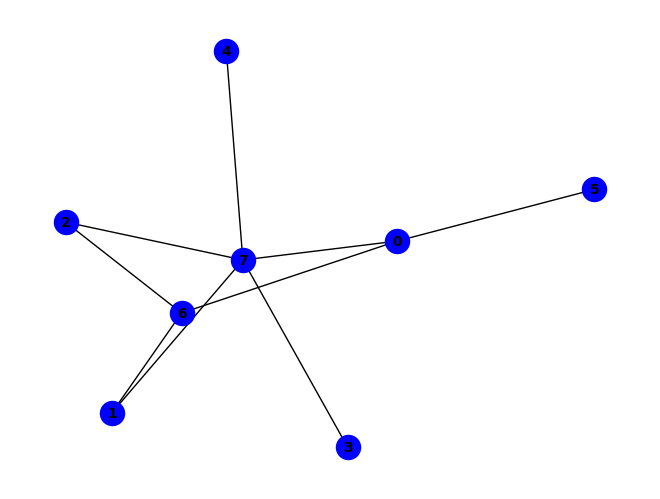


~e ^ (a & e & ~d) ^ (a & g & ~h) ^ (a & h & ~d) ^ (e & ~a & ~h) ^ (a & b & g & ~c) ^ (a & d & e & ~h) ^ (a & f & ~g & ~h) ^ (b & g & ~c & ~h) ^ (b & h & ~c & ~e) ^ (c & g & ~a & ~h) ^ (d & h & ~b & ~e) ^ (a & b & e & h & ~c) ^ (b & c & d & h & ~e) ^ (a & b & h & ~c & ~g) ^ (c & h & ~a & ~d & ~e) ^ (a & b & d & h & ~c & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


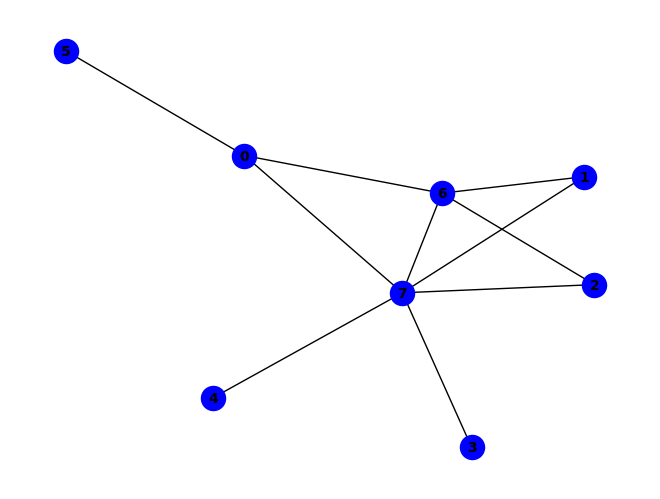


~g ^ (g & ~h) ^ (a & f & ~h) ^ (a & g & ~f) ^ (c & h & ~e) ^ (e & h & ~g) ^ (a & f & g & h) ^ (a & h & ~c & ~e) ^ (c & g & ~a & ~e) ^ (a & b & e & g & ~h) ^ (a & d & e & h & ~c) ^ (a & e & g & h & ~d) ^ (b & d & e & g & ~c) ^ (b & d & e & h & ~c) ^ (a & b & c & d & e & g) ^ (a & b & c & d & e & h) ^ (a & c & d & e & g & h) ^ (a & d & h & ~c & ~g) ^ (b & d & h & ~c & ~g) ^ (b & e & g & ~d & ~h) ^ (a & b & c & d & h & ~g) ^ (b & g & ~a & ~c & ~e) ^ (b & h & ~a & ~c & ~e) ^ (d & h & ~c & ~e & ~g) ^ (a & b & d & h & ~e & ~g) ^ (c & e & g & ~a & ~b & ~h) ^ (b & c & d & e & g & ~a & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


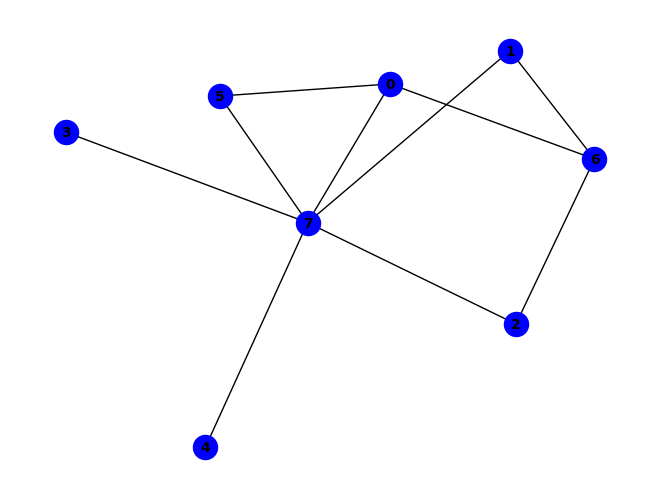


~f ^ (a & f & ~g) ^ (a & h & ~e) ^ (b & f & ~e) ^ (b & h & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (f & ~b & ~h) ^ (b & c & g & ~a) ^ (a & g & ~c & ~h) ^ (b & g & ~a & ~h) ^ (b & c & f & h & ~a) ^ (b & d & e & f & ~c) ^ (b & d & e & h & ~c) ^ (b & c & h & ~a & ~g) ^ (b & d & h & ~c & ~f) ^ (b & e & f & ~d & ~h) ^ (b & c & d & e & f & ~h) ^ (d & h & ~a & ~e & ~f) ^ (b & c & e & h & ~a & ~f) ^ (a & b & h & ~d & ~e & ~f) ^ (a & b & c & d & h & ~e & ~f) ^ (c & h & ~a & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


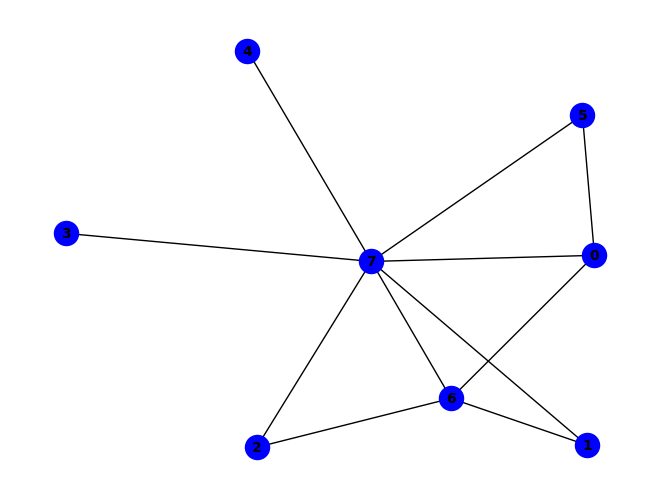


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (b & g & ~a & ~c & ~f) ^ (b & h & ~a & ~c & ~f) ^ (e & h & ~b & ~f & ~g) ^ (a & b & e & h & ~d & ~g) ^ (a & c & d & h & ~f & ~g) ^ (a & e & f & h & ~b & ~g) ^ (c & e & f & g & ~a & ~d) ^ (c & e & f & h & ~a & ~d) ^ (a & b & c & d & e & h & ~g) ^ (a & d & h & ~e & ~f & ~g) ^ (b & f & g & ~a & ~c & ~h) ^ (c & d & h & ~b & ~f & ~g) ^ (c & e & h & ~a & ~d & ~g) ^ (c & f & g & ~a & ~e & ~h) ^ (a & b & c & e & h & ~f & ~g) ^ (c & d & e & f & g & ~a & ~h) ^ (d & h & ~b & ~e & ~f & ~g) ^ (a & b & d & h & ~c & ~f & ~g) ^ (b & c & e & h & ~d & ~f & ~g) ^ (a & b & d & e & f & h & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

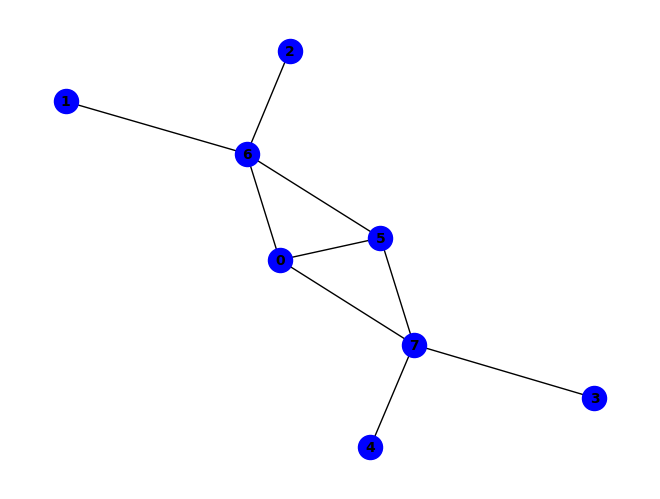


~e ^ (a & f & ~e) ^ (a & g & ~h) ^ (a & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (c & d & e & f & g) ^ (c & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (a & b & c & d & e & f) ^ (b & c & d & e & f & h) ^ (a & e & f & ~d & ~h) ^ (d & e & f & ~c & ~h) ^ (a & b & d & g & h & ~f) ^ (c & d & e & g & h & ~b) ^ (a & b & c & d & e & g & h) ^ (b & g & ~a & ~c & ~f) ^ (b & d & g & h & ~e & ~f) ^ (b & e & g & h & ~c & ~f) ^ (c & e & g & h & ~a & ~f) ^ (a & b & c & e & g & h & ~f) ^ (a & b & e & g & h & ~d & ~f) ^ (a & c & d & e & f & ~b & ~h) ^ (a & c & d & e & h & ~f & ~g) ^ (b & c & d & e & f & ~a & ~g) ^ (c & d & e & f & ~b & ~g & ~h) ^ (c & d & g & h & ~a & ~b & ~f) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

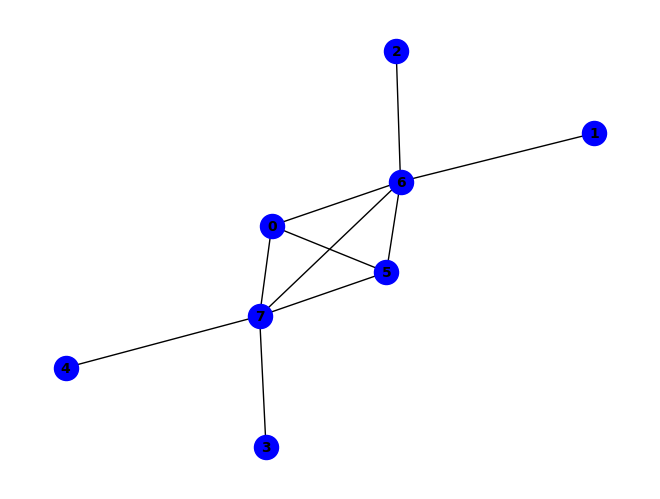


(~c & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (c & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & e & f & g) ^ (d & e & f & h) ^ (c & ~f & ~h) ^ (g & ~b & ~h) ^ (a & e & g & ~h) ^ (b & f & g & ~h) ^ (a & f & ~c & ~g) ^ (c & f & ~g & ~h) ^ (e & h & ~d & ~g) ^ (a & c & f & h & ~g) ^ (a & d & e & h & ~g) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (a & b & g & ~f & ~h) ^ (a & c & f & ~b & ~h) ^ (a & c & g & ~b & ~h) ^ (a & f & g & ~e & ~h) ^ (b & c & g & ~f & ~h) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & b & c & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


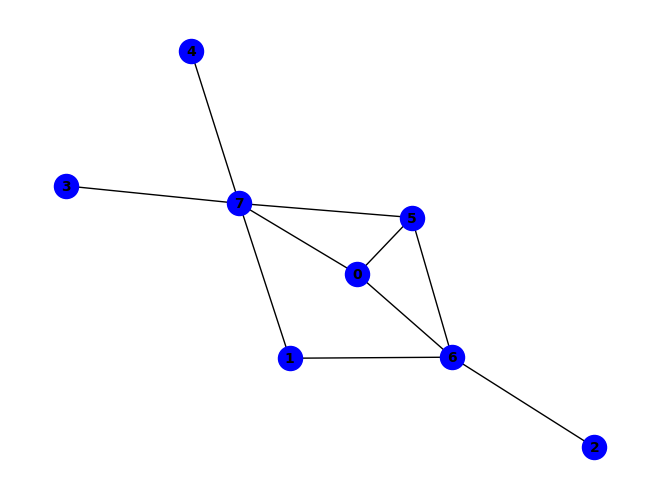


~e ^ (a & f & ~e) ^ (a & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (c & d & e & f & g) ^ (a & g & ~b & ~h) ^ (b & g & ~c & ~f) ^ (b & h & ~f & ~g) ^ (c & g & ~a & ~f) ^ (a & b & c & g & ~f) ^ (a & b & f & g & ~h) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (a & b & h & ~e & ~f) ^ (a & e & f & ~d & ~h) ^ (b & e & h & ~d & ~f) ^ (d & e & f & ~c & ~h) ^ (a & b & d & e & h & ~f) ^ (a & c & d & e & f & ~h) ^ (c & d & e & g & h & ~b) ^ (a & b & c & d & e & g & h) ^ (d & h & ~a & ~b & ~f) ^ (b & c & d & e & f & h & ~a) ^ (a & c & d & e & h & ~f & ~g) ^ (b & c & d & e & f & ~a & ~g) ^ (c & d & e & f & ~b & ~g & ~h) ^ (c & d & g & h & ~a & ~b & ~f) ^ (c & e & g & h & ~a & ~b & ~f) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

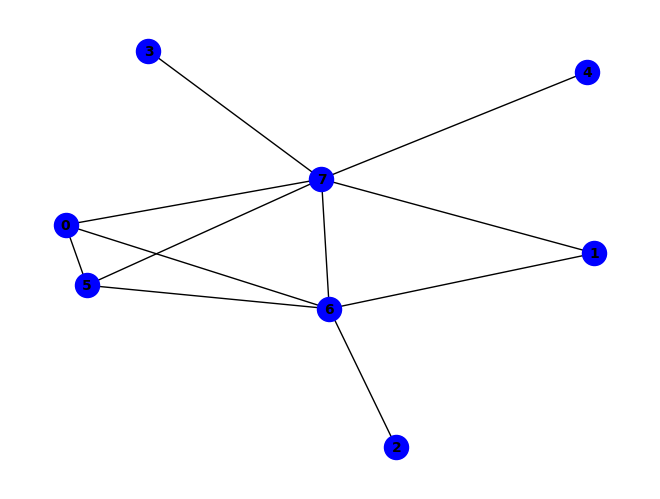


(g & ~h) ^ (~c & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (c & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (c & ~f & ~h) ^ (a & e & g & ~h) ^ (a & f & ~c & ~g) ^ (b & g & ~a & ~f) ^ (b & h & ~a & ~f) ^ (c & f & ~g & ~h) ^ (e & h & ~d & ~g) ^ (a & b & c & f & ~g) ^ (a & d & f & g & ~e) ^ (a & d & f & h & ~e) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (a & c & f & ~b & ~h) ^ (a & c & g & ~b & ~h) ^ (a & d & h & ~e & ~g) ^ (a & f & g & ~d & ~h) ^ (b & c & g & ~f & ~h) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (b & d & e & f & g & ~h) ^ (d & h & ~b & ~f & ~g) ^ (a & b & d & h & ~f & ~g) ^ (a & c & f & h & ~b & ~g) ^ (b & d & e & h & ~a & ~g) ^ (a & b & d & e & f & h & ~g) ^ (b & e & h & ~a & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

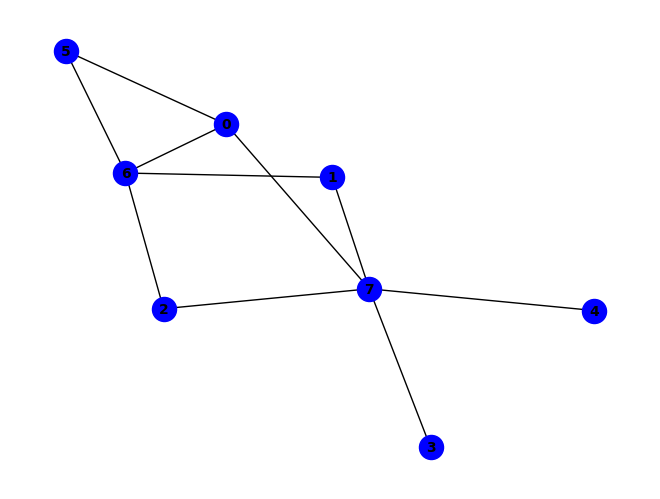


~f ^ (a & b & g) ^ (a & c & g) ^ (a & g & ~h) ^ (a & h & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (c & g & ~h) ^ (c & h & ~e) ^ (e & h & ~f) ^ (b & e & f & h) ^ (f & ~e & ~g) ^ (a & b & h & ~g) ^ (a & c & h & ~g) ^ (a & f & g & ~b) ^ (b & c & g & ~a) ^ (b & f & g & ~c) ^ (c & f & g & ~a) ^ (a & b & c & f & g) ^ (a & e & f & g & h) ^ (c & e & f & g & h) ^ (a & f & ~g & ~h) ^ (a & c & d & h & ~f) ^ (b & c & d & h & ~f) ^ (a & d & h & ~e & ~f) ^ (b & c & h & ~a & ~g) ^ (b & d & h & ~e & ~f) ^ (b & e & f & ~d & ~g) ^ (a & c & e & f & h & ~g) ^ (b & c & e & f & h & ~g) ^ (d & h & ~c & ~e & ~f) ^ (e & f & ~b & ~g & ~h) ^ (a & b & d & h & ~c & ~f) ^ (a & c & e & h & ~d & ~f) ^ (b & c & e & h & ~d & ~f) ^ (b & d & f & h & ~c & ~g) ^ (a & b & c & d & f & h & ~g) ^ (a & b & d & f & h & ~e & ~g) ^ (a & b & e & f & h & ~c & ~g) ^ (b & c & d & e & f & ~a & ~g) ^ (a & b & e & h & ~c & ~d & ~f) ^ (b & d & e & f & ~c & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h) ^ (d & f & h & ~a & ~c & ~e & ~g)
PASS
PAS

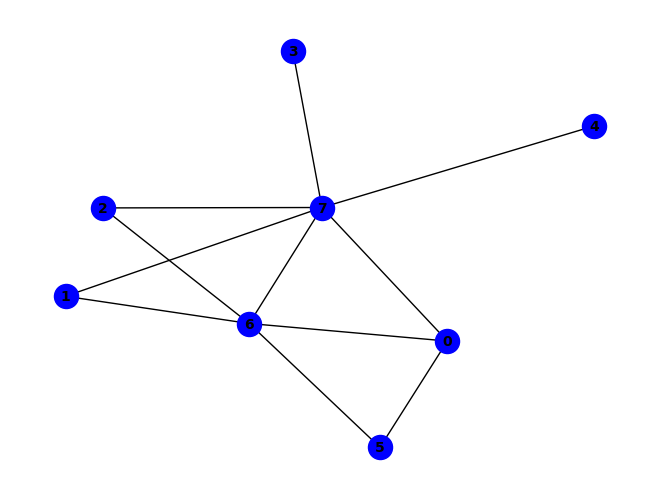


(g & ~h) ^ (~f & ~g) ^ (c & g & ~e) ^ (c & h & ~e) ^ (e & h & ~g) ^ (f & h & ~g) ^ (f & ~c & ~h) ^ (a & c & g & ~f) ^ (a & c & h & ~f) ^ (b & e & g & ~h) ^ (a & f & ~b & ~h) ^ (a & g & ~b & ~e) ^ (a & h & ~b & ~e) ^ (b & g & ~c & ~e) ^ (b & h & ~c & ~e) ^ (c & f & ~g & ~h) ^ (a & b & c & g & ~e) ^ (a & b & c & h & ~e) ^ (a & c & f & h & ~g) ^ (a & b & f & ~g & ~h) ^ (a & e & g & ~b & ~h) ^ (b & f & g & ~c & ~h) ^ (c & e & g & ~b & ~h) ^ (a & b & c & e & g & ~h) ^ (a & b & c & f & g & ~h) ^ (a & c & d & h & ~b & ~g) ^ (a & c & e & h & ~d & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & d & h & ~b & ~e & ~g) ^ (d & h & ~b & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


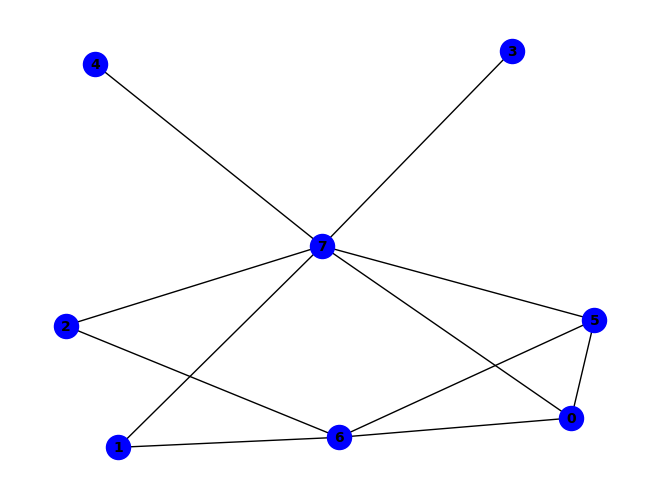


~e ^ (a & f & ~e) ^ (a & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & g & ~c & ~h) ^ (b & g & ~a & ~f) ^ (a & b & c & g & ~f) ^ (a & c & f & g & ~h) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (a & b & c & d & e & f) ^ (a & b & c & d & e & h) ^ (a & c & h & ~e & ~f) ^ (a & e & f & ~d & ~h) ^ (b & e & h & ~a & ~f) ^ (d & e & f & ~c & ~h) ^ (a & b & c & e & h & ~f) ^ (b & c & d & e & f & ~h) ^ (b & h & ~a & ~f & ~g) ^ (c & g & ~b & ~f & ~h) ^ (c & h & ~b & ~e & ~f) ^ (d & h & ~a & ~c & ~f) ^ (a & b & c & h & ~f & ~g) ^ (b & c & d & h & ~a & ~f) ^ (b & d & h & ~a & ~e & ~f) ^ (a & c & d & e & f & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


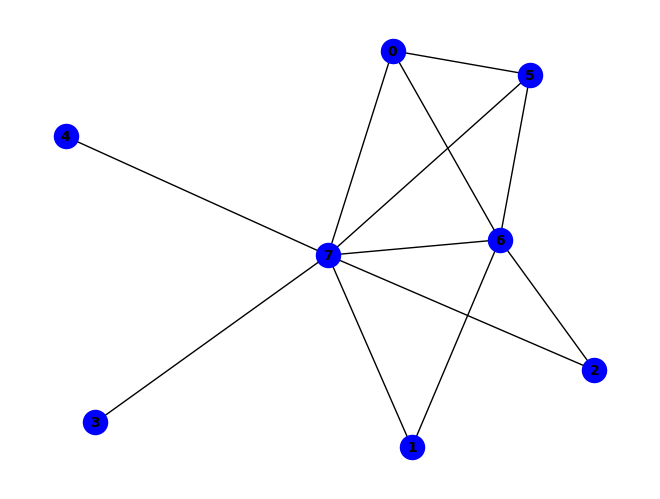


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (e & h & ~d & ~g) ^ (a & d & e & g & ~f) ^ (a & d & e & h & ~f) ^ (a & d & f & g & ~c) ^ (a & d & f & h & ~c) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & d & h & ~c & ~g) ^ (a & e & g & ~d & ~h) ^ (a & f & g & ~d & ~h) ^ (e & f & g & ~d & ~h) ^ (a & c & d & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (b & g & ~a & ~c & ~f) ^ (b & h & ~a & ~c & ~f) ^ (d & h & ~c & ~f & ~g) ^ (b & c & d & h & ~f & ~g) ^ (c & d & e & h & ~b & ~g) ^ (a & b & d & e & f & g & ~c) ^ (a & b & d & e & f & h & ~c) ^ (b & c & d & e & f & h & ~g) ^ (b & d & h & ~e & ~f & ~g) ^ (c & e & h & ~a & ~f & ~g) ^ (a & b & d & e & h & ~c & ~g) ^ (a & c & d & e & h & ~f & ~g) ^ (a & d & e & f & g & ~b & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & b & d & h & ~c & ~f & ~g) ^ (b & e & h & ~a & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

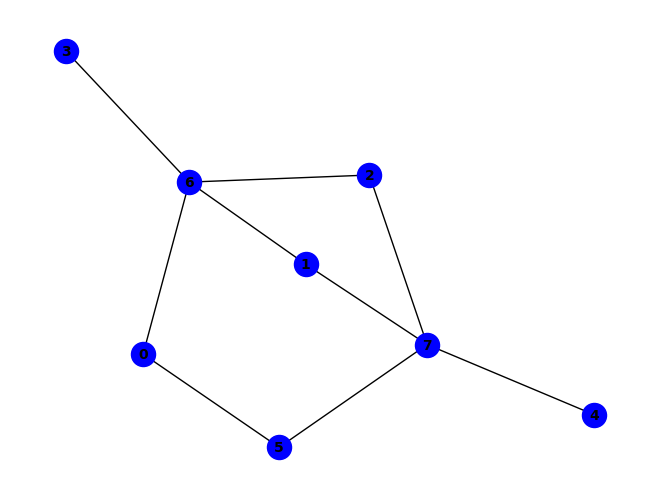


(a & d & g) ^ (~a & ~f) ^ (b & f & ~e) ^ (c & g & ~h) ^ (d & g & ~c) ^ (e & h & ~f) ^ (a & e & f & g) ^ (a & ~f & ~g) ^ (f & ~b & ~h) ^ (a & c & g & ~d) ^ (b & e & f & ~h) ^ (a & d & f & g & h) ^ (a & f & ~e & ~h) ^ (b & h & ~c & ~g) ^ (c & h & ~e & ~f) ^ (a & e & g & h & ~d) ^ (b & c & f & h & ~e) ^ (d & e & g & h & ~c) ^ (b & e & h & ~c & ~d) ^ (a & c & f & g & h & ~d) ^ (a & d & e & f & h & ~c) ^ (b & d & e & f & h & ~c) ^ (b & d & f & g & h & ~c) ^ (b & g & ~a & ~c & ~d) ^ (a & d & e & f & ~c & ~g) ^ (d & f & g & h & ~c & ~e) ^ (a & c & d & e & g & h & ~b) ^ (a & b & c & d & e & f & g & h) ^ (a & e & f & ~d & ~g & ~h) ^ (a & b & e & g & h & ~d & ~f) ^ (a & b & f & g & h & ~c & ~d) ^ (a & c & d & e & f & ~g & ~h) ^ (a & c & e & g & h & ~b & ~f) ^ (b & d & e & h & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

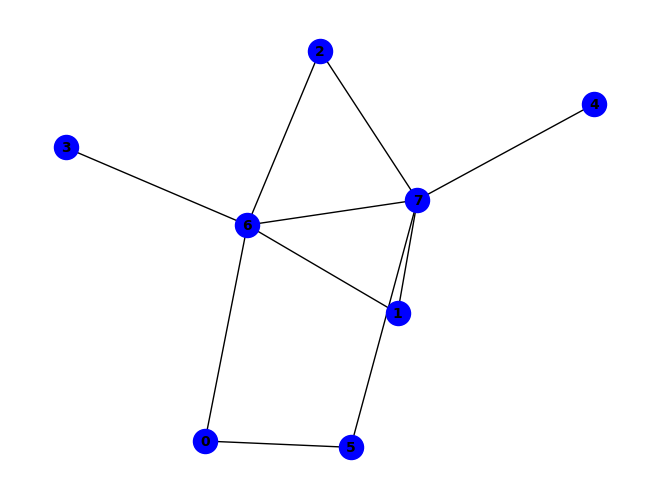


(~d & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~a & ~h) ^ (a & f & ~g & ~h) ^ (b & g & ~c & ~f) ^ (b & h & ~c & ~f) ^ (c & d & ~g & ~h) ^ (c & e & f & g & ~b) ^ (c & e & f & h & ~b) ^ (a & b & g & ~d & ~h) ^ (a & c & g & ~b & ~h) ^ (a & d & g & ~c & ~h) ^ (b & d & g & ~c & ~h) ^ (b & f & g & ~c & ~h) ^ (c & e & h & ~b & ~g) ^ (c & f & g & ~e & ~h) ^ (a & b & c & d & g & ~h) ^ (b & c & e & f & g & ~h) ^ (e & h & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


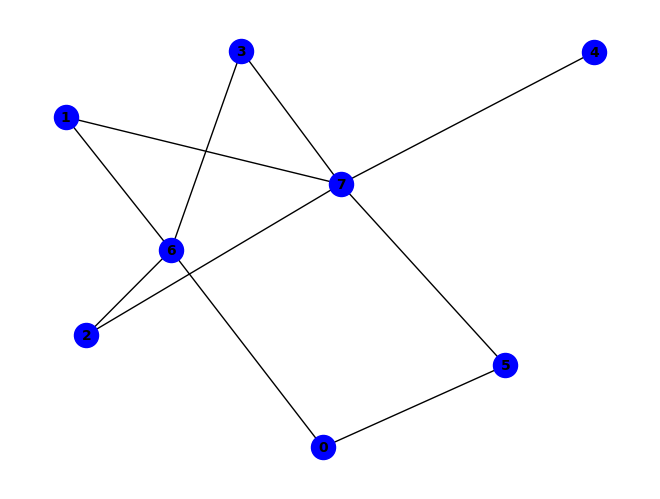


(~a & ~f) ^ (b & f & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & ~f & ~g) ^ (f & ~b & ~h) ^ (a & c & g & ~d) ^ (a & d & g & ~f) ^ (b & e & f & ~h) ^ (a & f & ~d & ~h) ^ (d & g & ~c & ~h) ^ (d & h & ~e & ~f) ^ (b & d & f & h & ~e) ^ (a & d & f & ~g & ~h) ^ (b & e & h & ~c & ~d) ^ (a & b & f & g & h & ~d) ^ (a & c & f & g & h & ~d) ^ (b & g & ~a & ~c & ~d) ^ (b & h & ~c & ~d & ~g) ^ (c & h & ~d & ~e & ~f) ^ (b & c & f & h & ~d & ~e) ^ (a & b & c & e & g & h & ~d) ^ (a & b & e & g & h & ~d & ~f) ^ (a & e & g & h & ~c & ~d & ~f) ^ (a & b & c & f & g & h & ~d & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


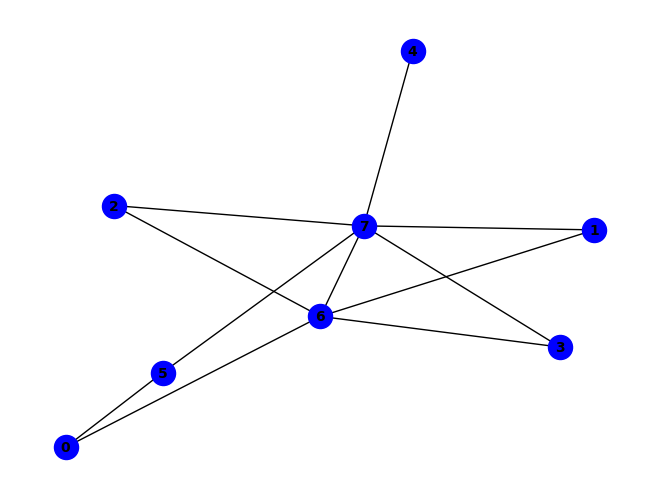


(g & ~h) ^ (~a & ~g) ^ (f & h & ~g) ^ (a & ~f & ~h) ^ (a & f & g & ~h) ^ (a & d & ~c & ~g) ^ (a & d & ~c & ~h) ^ (a & h & ~d & ~g) ^ (b & g & ~d & ~f) ^ (b & h & ~d & ~f) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & c & d & h & ~g) ^ (b & c & d & g & ~f) ^ (b & c & d & h & ~f) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & g & ~d & ~h) ^ (a & c & g & ~b & ~h) ^ (c & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (d & f & g & ~e & ~h) ^ (a & b & c & d & g & ~h) ^ (c & d & e & f & g & ~h) ^ (e & h & ~c & ~f & ~g) ^ (b & f & g & ~c & ~d & ~h) ^ (b & e & h & ~c & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


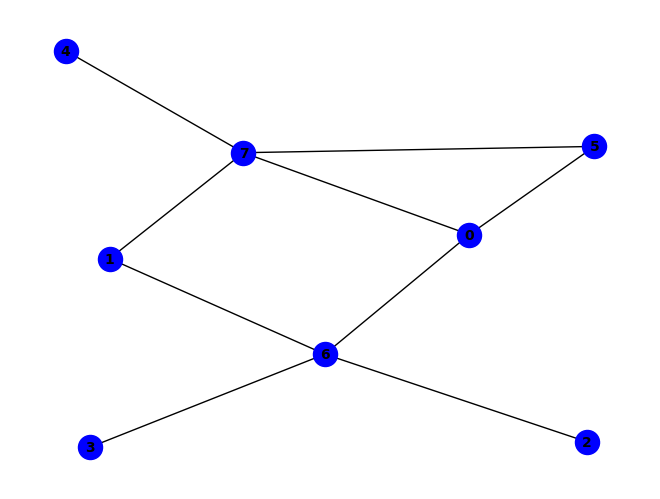


~f ^ (a & g & ~h) ^ (a & h & ~e) ^ (b & f & ~e) ^ (b & h & ~e) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (b & e & f & ~h) ^ (a & f & ~d & ~g) ^ (b & g & ~a & ~h) ^ (d & g & ~a & ~b) ^ (a & d & f & h & ~c) ^ (a & e & f & h & ~d) ^ (a & f & g & h & ~c) ^ (c & f & g & h & ~d) ^ (d & f & g & h & ~e) ^ (c & d & e & f & g & h) ^ (a & b & h & ~e & ~f) ^ (a & c & d & f & h & ~g) ^ (b & c & f & g & h & ~a) ^ (b & d & f & g & h & ~c) ^ (a & b & c & d & f & g & h) ^ (c & g & ~a & ~b & ~d) ^ (a & d & e & f & ~c & ~g) ^ (d & e & g & h & ~a & ~c) ^ (a & b & d & e & g & h & ~c) ^ (a & b & d & f & g & h & ~e) ^ (a & c & d & e & f & h & ~b) ^ (a & d & f & ~e & ~g & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (b & d & e & g & h & ~c & ~f) ^ (a & b & c & d & e & f & h & ~g) ^ (c & e & g & h & ~a & ~b & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


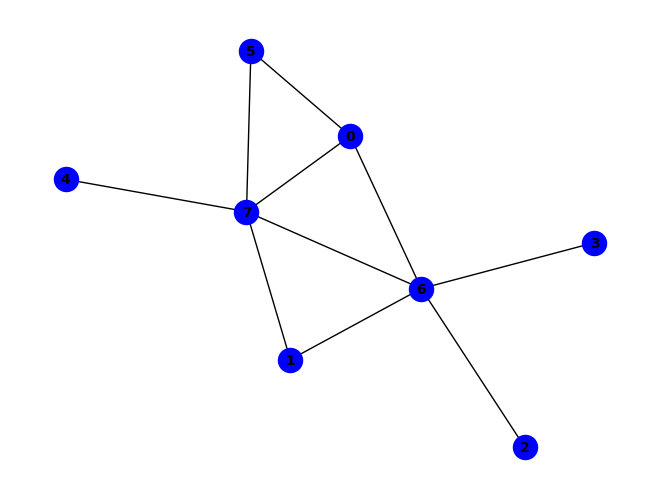


(~d & ~g) ^ (a & f & ~e) ^ (a & h & ~e) ^ (b & g & ~f) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (a & e & f & ~h) ^ (b & c & g & ~h) ^ (a & g & ~b & ~f) ^ (b & h & ~a & ~f) ^ (c & d & ~g & ~h) ^ (a & e & g & h & ~f) ^ (a & c & g & ~b & ~h) ^ (b & d & g & ~c & ~h) ^ (b & f & g & ~a & ~h) ^ (e & h & ~b & ~f & ~g) ^ (a & b & e & h & ~f & ~g) ^ (a & d & g & ~b & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


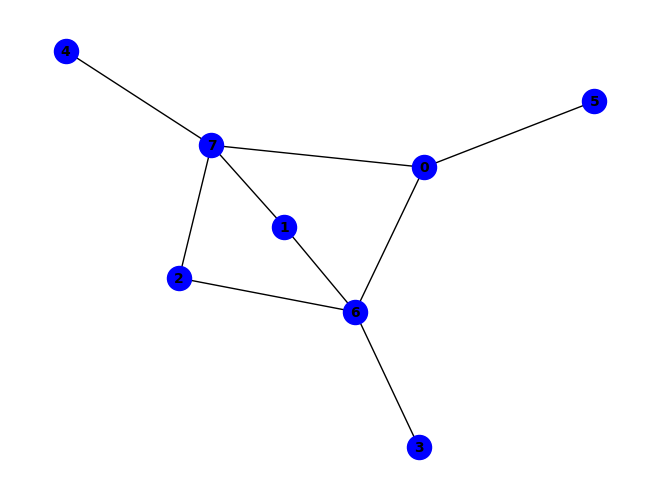


~e ^ (a & e & ~d) ^ (a & f & ~h) ^ (a & g & ~f) ^ (a & h & ~g) ^ (a & f & g & h) ^ (e & ~a & ~h) ^ (b & h & ~a & ~e) ^ (c & g & ~a & ~h) ^ (a & d & e & g & ~h) ^ (a & b & d & e & g & h) ^ (a & d & e & ~c & ~g) ^ (a & c & d & e & h & ~b) ^ (b & g & ~a & ~c & ~h) ^ (c & h & ~a & ~b & ~e) ^ (d & g & ~a & ~b & ~c) ^ (a & c & d & e & ~g & ~h) ^ (d & e & g & h & ~b & ~c) ^ (a & b & c & d & e & h & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


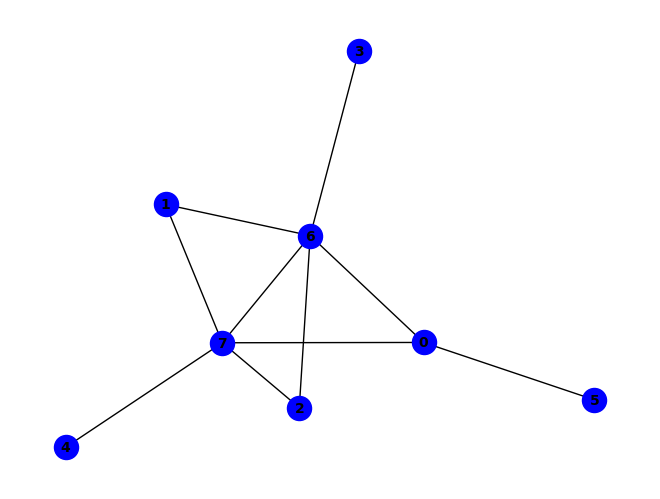


(g & ~h) ^ (~d & ~g) ^ (a & f & ~h) ^ (a & g & ~f) ^ (c & h & ~e) ^ (d & h & ~g) ^ (e & h & ~g) ^ (a & e & g & h) ^ (a & f & g & h) ^ (d & ~c & ~h) ^ (b & h & ~c & ~e) ^ (c & d & ~g & ~h) ^ (c & g & ~a & ~e) ^ (b & d & g & ~c & ~h) ^ (b & e & g & ~a & ~h) ^ (a & h & ~b & ~c & ~e) ^ (b & g & ~a & ~c & ~e) ^ (a & d & g & ~b & ~c & ~h) ^ (c & e & g & ~a & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


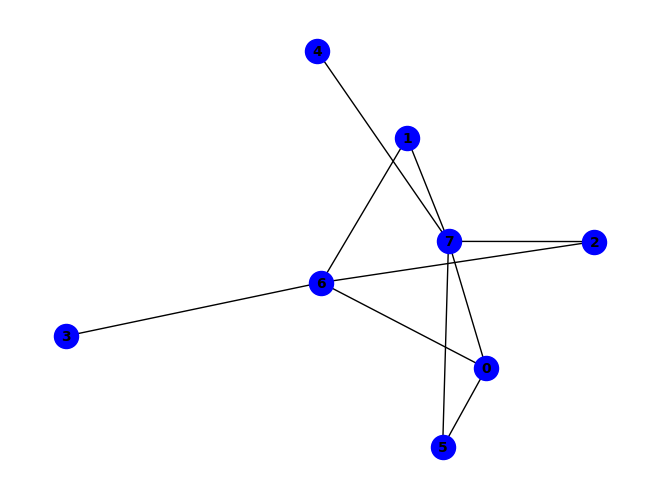


~f ^ (a & d & g) ^ (a & g & ~h) ^ (a & h & ~e) ^ (b & f & ~e) ^ (c & g & ~h) ^ (d & g & ~c) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (f & ~b & ~h) ^ (a & c & g & ~d) ^ (a & c & h & ~g) ^ (b & e & f & ~h) ^ (a & f & ~d & ~g) ^ (c & h & ~e & ~f) ^ (a & c & e & h & ~d) ^ (a & c & f & h & ~e) ^ (a & d & f & h & ~e) ^ (b & c & f & h & ~e) ^ (d & e & g & h & ~c) ^ (a & c & d & f & g & h) ^ (b & e & h & ~c & ~d) ^ (a & c & d & e & h & ~g) ^ (a & d & e & g & h & ~b) ^ (b & d & e & f & h & ~c) ^ (b & d & f & g & h & ~c) ^ (a & b & c & d & e & g & h) ^ (a & b & d & e & f & g & h) ^ (b & g & ~a & ~c & ~d) ^ (b & h & ~a & ~c & ~g) ^ (a & b & e & h & ~c & ~f) ^ (a & b & f & h & ~c & ~d) ^ (a & d & e & f & ~c & ~g) ^ (d & f & g & h & ~c & ~e) ^ (a & c & d & e & f & h & ~b) ^ (a & d & f & ~e & ~g & ~h) ^ (a & b & d & f & h & ~c & ~g) ^ (a & c & d & e & f & ~g & ~h) ^ (a & b & c & d & e & f & h & ~g) ^ (b & d & e & h & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

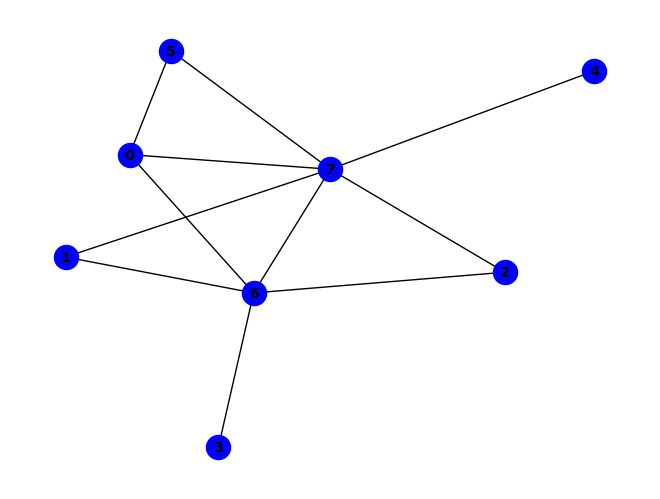


(g & ~h) ^ (~d & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & e & g & ~h) ^ (c & d & ~g & ~h) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (a & e & f & h & ~g) ^ (b & d & g & ~c & ~h) ^ (b & g & ~a & ~c & ~f) ^ (b & h & ~a & ~c & ~f) ^ (e & h & ~b & ~f & ~g) ^ (a & b & e & h & ~f & ~g) ^ (c & e & f & g & ~a & ~b) ^ (c & e & f & h & ~a & ~b) ^ (a & d & g & ~b & ~c & ~h) ^ (b & f & g & ~a & ~c & ~h) ^ (c & e & h & ~a & ~b & ~g) ^ (c & f & g & ~a & ~e & ~h) ^ (b & c & e & f & g & ~a & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


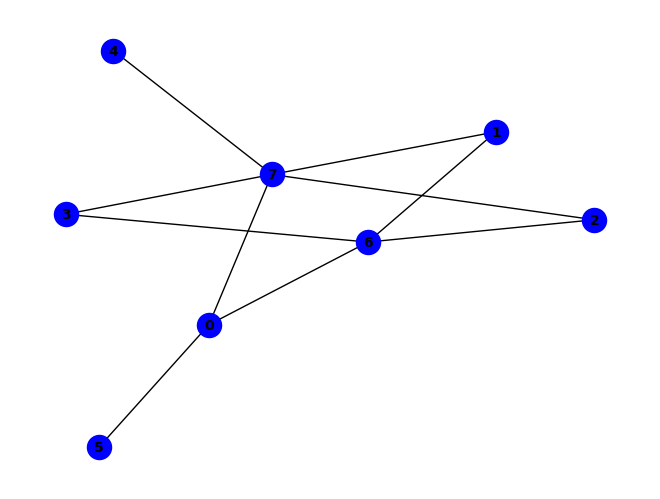


~e ^ (a & e & ~d) ^ (a & f & ~h) ^ (a & h & ~d) ^ (b & g & ~d) ^ (d & h & ~e) ^ (a & b & d & g) ^ (e & ~a & ~h) ^ (a & b & g & ~h) ^ (a & b & h & ~e) ^ (a & c & h & ~e) ^ (a & d & g & ~h) ^ (b & e & h & ~d) ^ (a & b & c & e & h) ^ (a & b & d & e & h) ^ (a & g & ~f & ~h) ^ (b & h & ~d & ~g) ^ (c & g & ~b & ~h) ^ (d & g & ~c & ~h) ^ (a & b & c & g & ~d) ^ (a & b & c & h & ~g) ^ (a & b & d & h & ~g) ^ (a & c & d & e & ~b) ^ (a & c & d & h & ~b) ^ (b & c & d & g & ~h) ^ (a & b & c & d & g & h) ^ (a & c & g & ~d & ~h) ^ (a & d & e & ~c & ~h) ^ (a & b & c & d & e & ~h) ^ (c & h & ~b & ~d & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


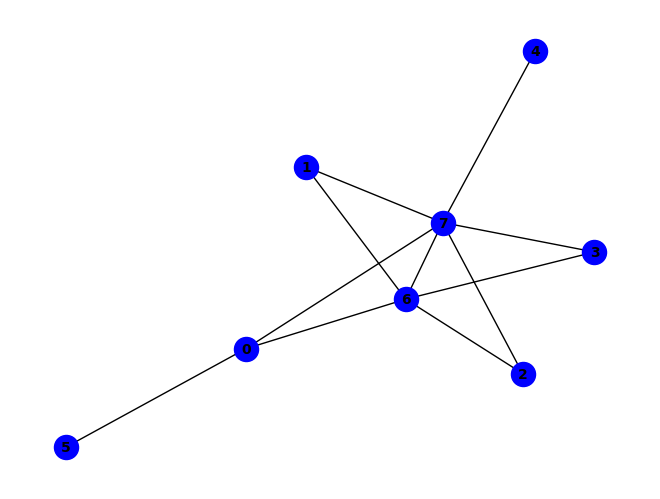


~g ^ (g & ~h) ^ (a & f & ~h) ^ (a & g & ~f) ^ (e & h & ~g) ^ (a & e & g & h) ^ (a & f & g & h) ^ (b & h & ~c & ~e) ^ (c & h & ~d & ~e) ^ (d & g & ~a & ~e) ^ (d & h & ~b & ~e) ^ (a & d & e & g & ~h) ^ (b & c & d & h & ~e) ^ (b & e & g & ~c & ~h) ^ (d & e & g & ~b & ~h) ^ (a & b & c & e & g & ~h) ^ (c & g & ~a & ~d & ~e) ^ (a & b & e & g & ~d & ~h) ^ (c & e & g & ~a & ~d & ~h) ^ (b & c & d & e & g & ~a & ~h) ^ (a & h & ~b & ~c & ~d & ~e) ^ (b & g & ~a & ~c & ~d & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


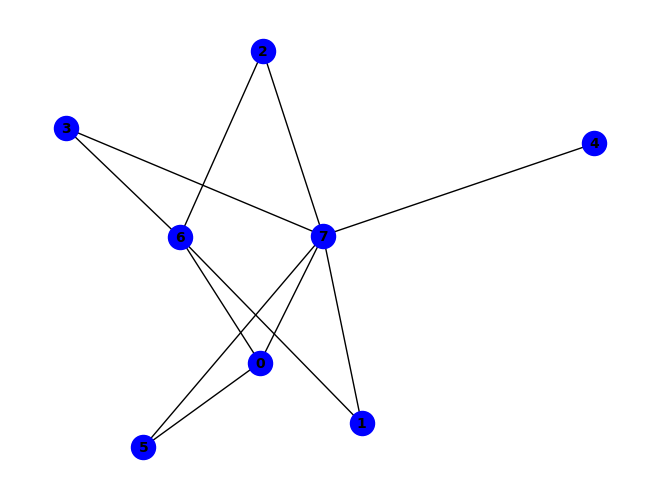


~f ^ (a & f & ~g) ^ (a & h & ~e) ^ (b & f & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (f & ~b & ~h) ^ (a & b & g & ~d) ^ (a & c & g & ~d) ^ (b & e & f & ~h) ^ (a & g & ~d & ~h) ^ (b & g & ~c & ~d) ^ (d & g & ~c & ~h) ^ (a & b & f & h & ~d) ^ (a & c & f & h & ~d) ^ (b & d & f & h & ~e) ^ (a & b & h & ~d & ~g) ^ (a & c & h & ~d & ~g) ^ (b & e & h & ~c & ~d) ^ (b & h & ~c & ~d & ~g) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (a & b & c & g & ~d & ~h) ^ (a & b & e & h & ~d & ~f) ^ (a & c & e & h & ~d & ~f) ^ (b & c & f & h & ~d & ~e) ^ (a & b & c & h & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


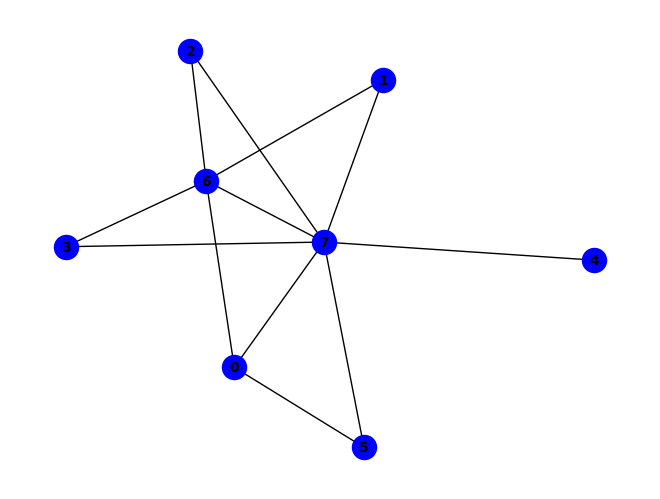


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (a & d & g & ~f) ^ (a & d & h & ~f) ^ (a & e & g & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & e & f & h & ~g) ^ (b & c & d & g & ~f) ^ (b & c & d & h & ~f) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (c & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (d & f & g & ~e & ~h) ^ (a & b & e & f & g & ~d) ^ (a & b & e & f & h & ~d) ^ (a & c & e & f & g & ~d) ^ (a & c & e & f & h & ~d) ^ (b & g & ~a & ~d & ~f) ^ (b & h & ~a & ~d & ~f) ^ (e & h & ~c & ~f & ~g) ^ (a & b & e & h & ~d & ~g) ^ (a & c & e & h & ~d & ~g) ^ (a & c & f & g & ~e & ~h) ^ (a & d & e & h & ~f & ~g) ^ (a & d & f & g & ~c & ~h) ^ (a & c & g & ~b & ~d & ~f) ^ (a & c & h & ~b & ~d & ~f) ^ (b & f & g & ~c & ~d & ~h) ^ (a & b & c & f & g & ~d & ~h) ^ (c & d & e & f & g & ~a & ~h) ^ (a & b & f & g & ~d & ~e & ~h) ^ (b & e & h & ~c & ~d & ~f & ~g) ^ (a & b & c & e & h & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PAS

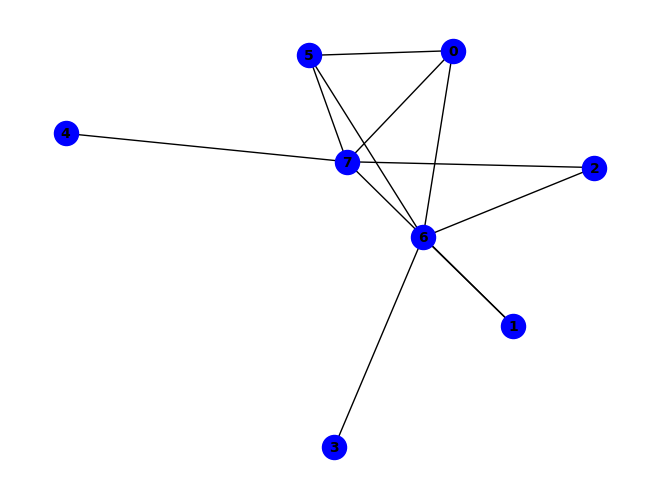


~e ^ (d & e & g) ^ (a & f & ~e) ^ (a & h & ~e) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & d & e & f & g) ^ (d & e & f & g & h) ^ (a & g & ~c & ~h) ^ (b & g & ~d & ~f) ^ (b & h & ~f & ~g) ^ (d & e & ~g & ~h) ^ (a & c & f & g & ~h) ^ (b & c & d & g & ~f) ^ (a & b & h & ~c & ~f) ^ (a & c & h & ~e & ~f) ^ (a & e & f & ~d & ~h) ^ (b & e & h & ~a & ~f) ^ (a & b & c & e & h & ~f) ^ (a & d & e & g & h & ~c) ^ (c & d & e & g & h & ~f) ^ (a & c & d & e & f & g & h) ^ (c & g & ~b & ~f & ~h) ^ (c & h & ~b & ~e & ~f) ^ (d & g & ~a & ~c & ~f) ^ (a & b & d & g & ~c & ~f) ^ (a & d & e & f & ~g & ~h) ^ (a & b & g & ~c & ~f & ~h) ^ (b & d & e & g & h & ~a & ~c & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


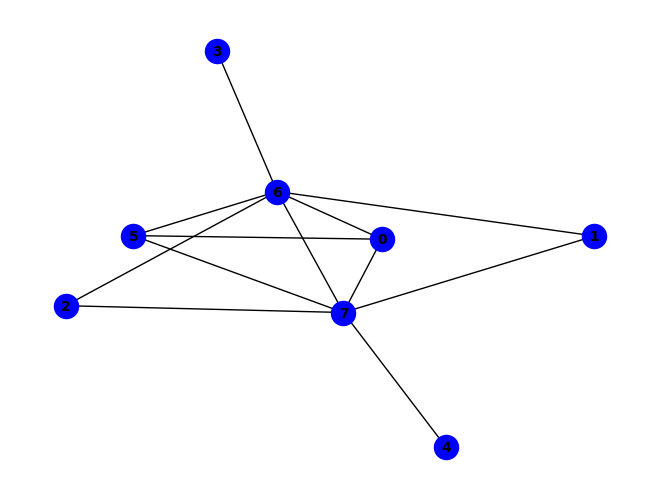


(g & ~h) ^ (~d & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (a & f & g & ~h) ^ (a & f & ~d & ~g) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (d & f & ~c & ~g) ^ (d & h & ~f & ~g) ^ (a & c & e & g & ~f) ^ (a & c & e & h & ~f) ^ (a & e & f & h & ~g) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & d & f & h & ~g) ^ (c & e & f & h & ~g) ^ (a & d & f & ~c & ~h) ^ (a & d & g & ~c & ~h) ^ (a & e & g & ~c & ~h) ^ (c & d & f & ~b & ~h) ^ (c & d & g & ~b & ~h) ^ (e & f & g & ~b & ~h) ^ (a & b & c & d & f & ~h) ^ (a & b & c & d & g & ~h) ^ (a & c & e & f & g & ~h) ^ (b & c & e & f & g & ~h) ^ (b & g & ~a & ~c & ~f) ^ (b & h & ~a & ~c & ~f) ^ (e & h & ~b & ~c & ~g) ^ (a & c & d & f & ~b & ~g) ^ (a & d & f & h & ~c & ~g) ^ (b & c & d & f & ~g & ~h) ^ (a & b & c & d & f & h & ~g) ^ (b & d & g & ~a & ~f & ~h) ^ (a & b & e & h & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

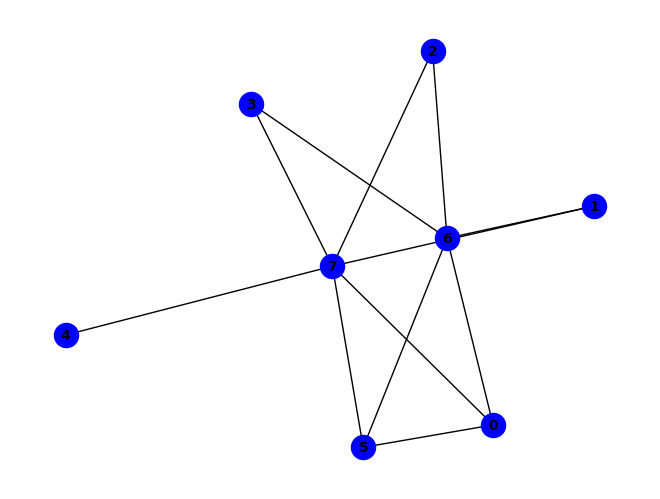


~e ^ (a & f & ~e) ^ (a & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (c & d & g & ~f) ^ (d & e & f & ~h) ^ (a & g & ~d & ~h) ^ (d & g & ~f & ~h) ^ (d & h & ~a & ~f) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (a & d & f & g & ~h) ^ (c & d & e & h & ~f) ^ (a & b & c & d & e & f) ^ (a & b & c & d & e & h) ^ (a & e & f & ~d & ~h) ^ (b & c & g & ~d & ~f) ^ (b & d & g & ~a & ~f) ^ (c & d & h & ~f & ~g) ^ (b & g & ~a & ~f & ~h) ^ (b & h & ~a & ~e & ~f) ^ (c & g & ~a & ~f & ~h) ^ (c & h & ~a & ~e & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & c & d & g & ~f & ~h) ^ (a & c & d & h & ~b & ~f) ^ (b & c & e & h & ~d & ~f) ^ (b & d & e & h & ~a & ~f) ^ (b & c & h & ~d & ~f & ~g) ^ (b & d & h & ~a & ~f & ~g) ^ (a & c & d & e & f & ~b & ~h) ^ (a & b & c & g & ~d & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

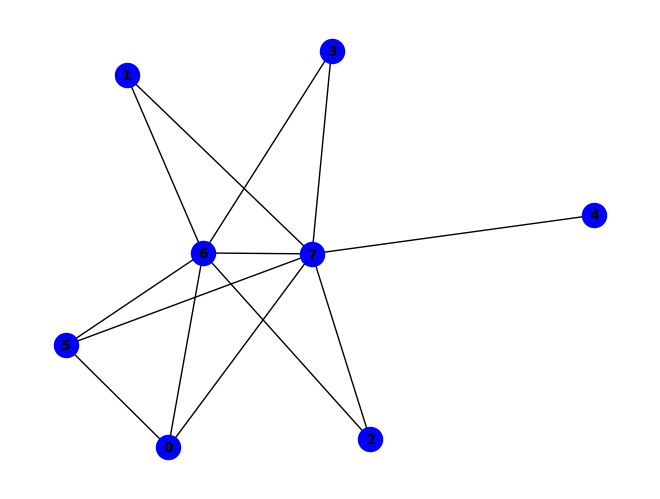


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & f & g & ~h) ^ (b & g & ~d & ~f) ^ (b & h & ~d & ~f) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~d & ~g) ^ (a & e & f & h & ~g) ^ (b & c & d & g & ~f) ^ (b & c & d & h & ~f) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & g & ~e & ~f) ^ (a & b & h & ~e & ~f) ^ (a & d & g & ~b & ~f) ^ (a & d & h & ~b & ~f) ^ (a & e & g & ~b & ~h) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (a & d & e & h & ~f & ~g) ^ (c & d & e & h & ~b & ~g) ^ (a & b & d & e & f & g & ~c) ^ (a & b & d & e & f & h & ~c) ^ (b & c & d & e & f & h & ~g) ^ (a & c & g & ~b & ~d & ~f) ^ (a & c & h & ~b & ~d & ~f) ^ (b & e & h & ~d & ~f & ~g) ^ (c & e & h & ~b & ~f & ~g) ^ (a & b & c & e & h & ~f & ~g) ^ (a & b & d & e & h & ~c & ~g) ^ (a & b & e & f & g & ~d & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & c & e & h & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

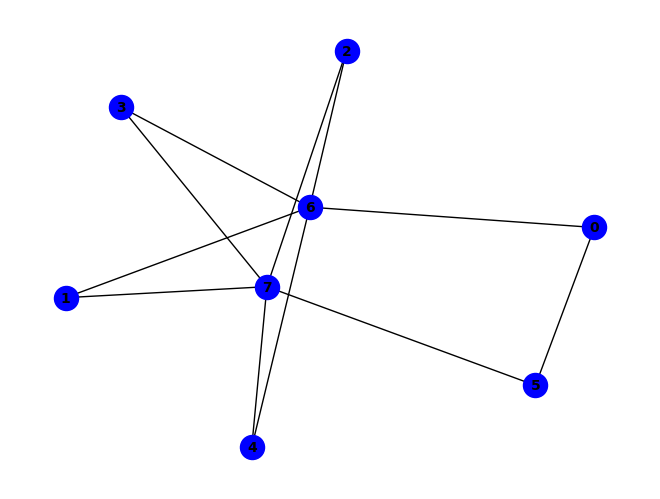


(~a & ~f) ^ (b & f & ~e) ^ (b & h & ~e) ^ (e & g & ~h) ^ (e & h & ~f) ^ (b & d & e & g) ^ (a & ~f & ~g) ^ (f & ~b & ~h) ^ (a & d & g & ~e) ^ (a & e & g & ~f) ^ (b & d & g & ~h) ^ (b & d & h & ~f) ^ (b & e & f & ~h) ^ (a & f & ~e & ~h) ^ (b & g & ~e & ~h) ^ (d & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (b & c & d & h & ~g) ^ (a & c & g & ~d & ~e) ^ (b & c & g & ~d & ~e) ^ (b & c & h & ~e & ~g) ^ (a & c & f & g & h & ~e) ^ (a & d & e & f & h & ~c) ^ (b & d & e & f & h & ~a) ^ (c & g & ~d & ~e & ~h) ^ (c & h & ~d & ~e & ~f) ^ (a & d & e & f & ~c & ~g) ^ (b & c & f & h & ~d & ~e) ^ (b & d & e & h & ~c & ~g) ^ (a & b & d & e & f & h & ~g) ^ (a & b & c & d & e & f & g & h) ^ (a & b & g & ~c & ~d & ~e) ^ (a & e & f & ~d & ~g & ~h) ^ (a & b & f & g & h & ~c & ~e) ^ (a & c & d & e & f & ~g & ~h) ^ (a & d & f & g & h & ~b & ~c)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


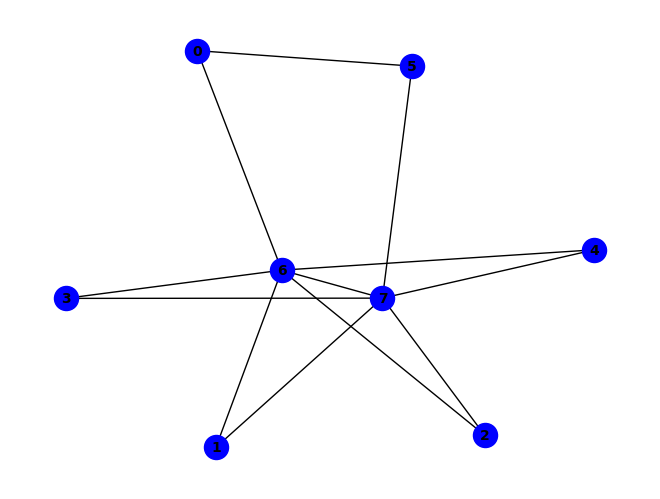


(g & ~h) ^ (~a & ~g) ^ (f & h & ~g) ^ (a & ~f & ~h) ^ (a & f & g & ~h) ^ (a & e & ~d & ~g) ^ (a & e & ~d & ~h) ^ (a & h & ~e & ~g) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (d & g & ~e & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & d & e & h & ~g) ^ (c & d & e & g & ~f) ^ (c & d & e & h & ~f) ^ (a & d & g & ~c & ~h) ^ (c & f & g & ~d & ~h) ^ (d & f & g & ~e & ~h) ^ (e & f & g & ~c & ~h) ^ (a & c & d & e & g & ~h) ^ (b & c & d & f & g & ~h) ^ (b & h & ~c & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (b & c & d & h & ~e & ~f) ^ (b & c & f & g & ~e & ~h) ^ (a & b & g & ~d & ~e & ~h) ^ (a & c & g & ~b & ~e & ~h) ^ (b & f & g & ~d & ~e & ~h) ^ (a & b & c & d & g & ~e & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (b & g & ~c & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


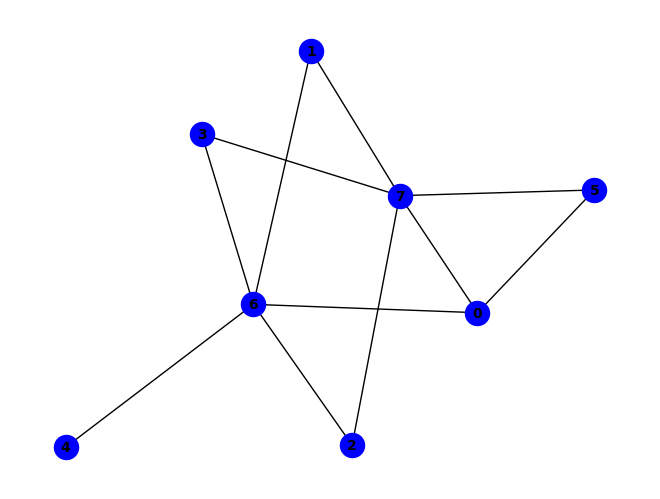


~f ^ (a & h & ~d) ^ (b & f & ~e) ^ (b & h & ~d) ^ (d & h & ~f) ^ (a & f & g & h) ^ (f & ~b & ~h) ^ (b & e & f & ~h) ^ (a & f & ~e & ~g) ^ (b & g & ~c & ~h) ^ (d & g & ~b & ~h) ^ (a & b & c & g & ~e) ^ (a & b & c & h & ~g) ^ (a & b & e & g & ~d) ^ (a & d & f & h & ~e) ^ (a & e & f & h & ~c) ^ (b & d & f & h & ~e) ^ (a & b & c & d & e & g) ^ (a & b & h & ~d & ~f) ^ (a & c & h & ~d & ~f) ^ (a & e & g & ~c & ~d) ^ (a & b & c & d & h & ~f) ^ (a & b & c & f & h & ~e) ^ (a & d & e & f & h & ~g) ^ (a & g & ~b & ~d & ~h) ^ (c & g & ~a & ~d & ~h) ^ (c & h & ~b & ~d & ~f) ^ (e & g & ~b & ~c & ~d) ^ (a & c & e & f & ~d & ~g) ^ (b & c & d & g & ~a & ~h) ^ (b & e & f & h & ~d & ~g) ^ (e & f & g & h & ~c & ~d) ^ (a & b & e & f & g & h & ~d) ^ (a & c & d & e & f & h & ~b) ^ (b & c & e & f & g & h & ~d) ^ (a & e & f & ~c & ~g & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (a & b & c & e & f & h & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

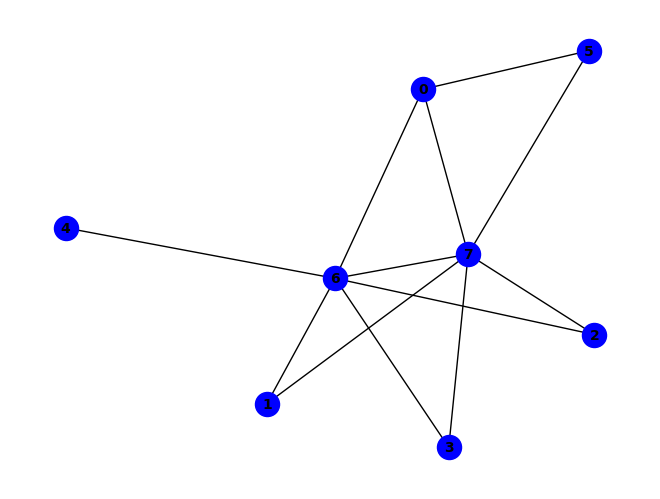


(g & ~h) ^ (~e & ~g) ^ (a & f & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (f & h & ~g) ^ (d & f & g & ~h) ^ (c & e & ~d & ~g) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~c & ~g) ^ (a & d & f & h & ~g) ^ (b & c & d & g & ~f) ^ (b & c & d & h & ~f) ^ (c & d & e & h & ~g) ^ (e & ~c & ~d & ~h) ^ (b & g & ~a & ~d & ~f) ^ (b & h & ~a & ~d & ~f) ^ (a & c & g & ~b & ~d & ~f) ^ (a & c & h & ~b & ~d & ~f) ^ (b & e & g & ~c & ~d & ~h) ^ (c & f & g & ~a & ~d & ~h) ^ (a & e & g & ~b & ~c & ~d & ~h) ^ (b & f & g & ~a & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


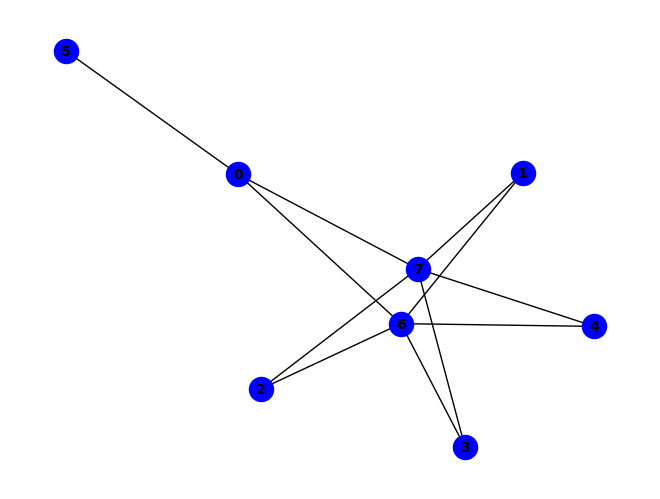


~d ^ (e & h & ~d) ^ (d & ~g & ~h) ^ (a & c & g & ~e) ^ (b & c & h & ~e) ^ (a & f & ~g & ~h) ^ (a & h & ~d & ~e) ^ (b & h & ~d & ~e) ^ (c & h & ~d & ~e) ^ (e & g & ~d & ~h) ^ (a & c & d & h & ~e) ^ (b & c & d & g & ~e) ^ (a & b & g & ~c & ~e) ^ (a & b & h & ~e & ~g) ^ (b & c & g & ~e & ~h) ^ (a & g & ~d & ~e & ~h) ^ (b & g & ~d & ~e & ~h) ^ (c & g & ~d & ~e & ~h) ^ (a & b & d & g & ~e & ~h) ^ (a & b & d & h & ~c & ~e) ^ (b & c & d & h & ~e & ~g) ^ (a & c & h & ~b & ~e & ~g) ^ (a & c & d & g & ~b & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


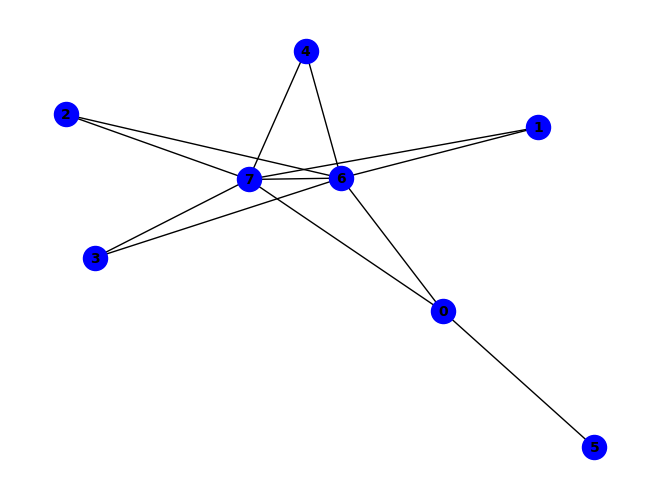


~g ^ (g & ~h) ^ (a & f & ~h) ^ (a & g & ~f) ^ (a & h & ~d) ^ (c & g & ~d) ^ (e & g & ~c) ^ (e & h & ~a) ^ (a & f & g & h) ^ (c & d & e & g) ^ (a & b & g & ~d) ^ (a & e & g & ~b) ^ (a & b & c & d & g) ^ (b & h & ~c & ~e) ^ (c & h & ~d & ~e) ^ (d & g & ~a & ~e) ^ (d & h & ~b & ~e) ^ (a & b & c & g & ~e) ^ (a & c & d & h & ~b) ^ (a & d & e & h & ~c) ^ (b & c & d & h & ~e) ^ (a & b & c & d & e & h) ^ (a & b & h & ~d & ~e) ^ (a & c & g & ~d & ~e) ^ (a & c & h & ~b & ~e) ^ (a & b & d & e & g & ~c) ^ (b & g & ~c & ~d & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


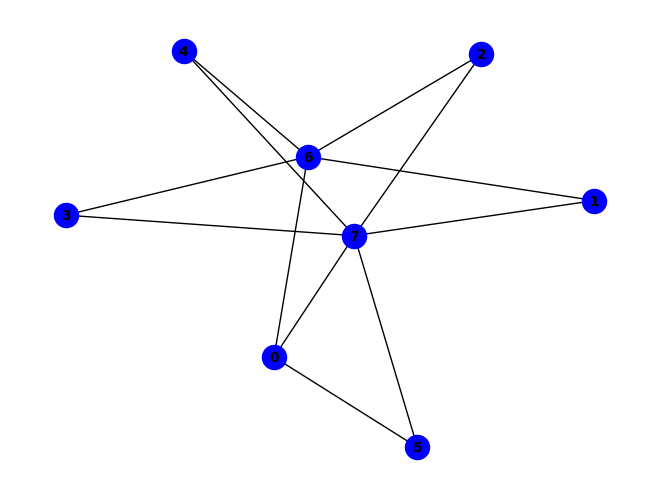


~f ^ (a & f & ~g) ^ (a & h & ~e) ^ (b & f & ~e) ^ (b & h & ~e) ^ (e & h & ~f) ^ (a & f & g & h) ^ (f & ~b & ~h) ^ (b & e & f & ~h) ^ (a & g & ~c & ~h) ^ (b & g & ~e & ~h) ^ (d & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (e & g & ~a & ~h) ^ (a & c & e & g & ~h) ^ (a & d & f & h & ~c) ^ (a & e & f & h & ~d) ^ (b & d & e & g & ~a) ^ (a & c & d & e & f & h) ^ (a & b & g & ~c & ~e) ^ (a & c & h & ~e & ~f) ^ (a & d & g & ~c & ~e) ^ (b & c & g & ~d & ~e) ^ (b & c & h & ~e & ~g) ^ (b & d & g & ~a & ~h) ^ (b & d & h & ~a & ~f) ^ (a & b & c & d & g & ~e) ^ (b & d & e & f & h & ~a) ^ (c & g & ~d & ~e & ~h) ^ (c & h & ~d & ~e & ~f) ^ (a & b & f & h & ~c & ~e) ^ (b & c & d & h & ~a & ~g) ^ (b & c & f & h & ~d & ~e) ^ (a & b & c & d & f & h & ~e) ^ (a & b & h & ~c & ~e & ~g) ^ (a & d & h & ~c & ~e & ~g) ^ (b & d & e & h & ~a & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

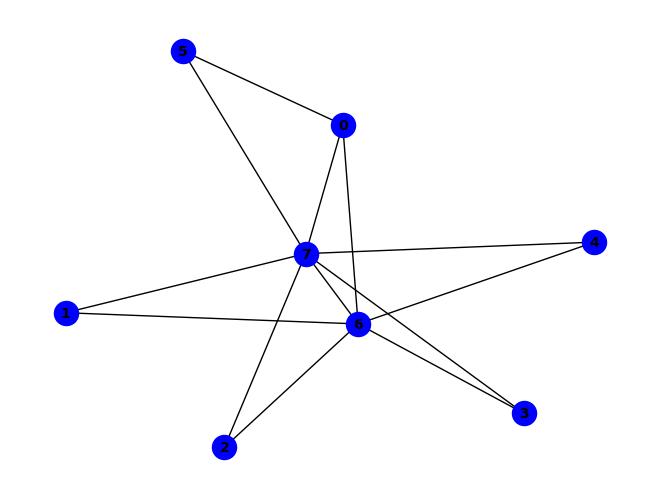


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & e & f & h & ~g) ^ (c & d & e & h & ~f) ^ (a & d & h & ~e & ~f) ^ (c & f & g & ~d & ~h) ^ (e & f & g & ~c & ~h) ^ (b & h & ~c & ~e & ~f) ^ (d & g & ~a & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & c & d & g & ~b & ~f) ^ (b & c & d & h & ~e & ~f) ^ (c & d & e & g & ~a & ~f) ^ (a & b & c & d & e & g & ~f) ^ (a & b & g & ~d & ~e & ~f) ^ (a & c & g & ~b & ~e & ~f) ^ (a & c & h & ~d & ~e & ~f) ^ (d & f & g & ~a & ~e & ~h) ^ (b & c & d & f & g & ~a & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (b & g & ~c & ~d & ~e & ~f) ^ (a & c & f & g & ~d & ~e & ~h) ^ (b & c & f & g & ~a & ~e & ~h) ^ (a & b & h & ~c & ~d & ~e & ~f) ^ (b & f & g & ~a & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

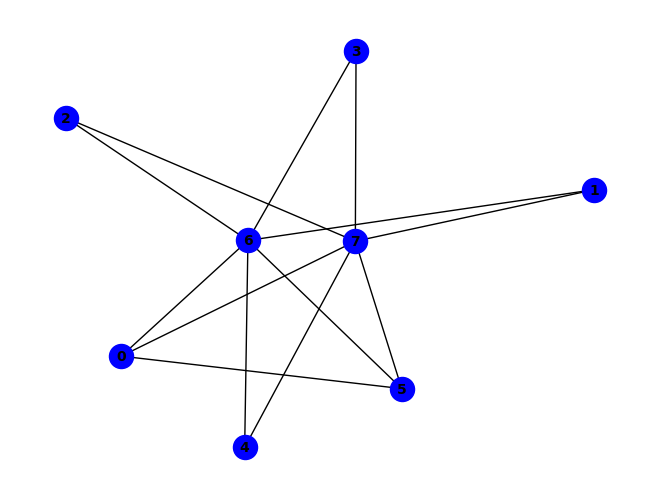


~e ^ (a & f & ~e) ^ (a & h & ~e) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (c & d & h & ~f) ^ (a & g & ~e & ~h) ^ (c & h & ~e & ~f) ^ (f & g & ~e & ~h) ^ (a & b & e & g & ~f) ^ (a & c & e & g & ~f) ^ (b & c & d & g & ~f) ^ (b & c & e & g & ~f) ^ (c & d & e & g & ~f) ^ (a & b & h & ~d & ~f) ^ (a & c & h & ~d & ~f) ^ (a & e & f & ~g & ~h) ^ (b & c & h & ~a & ~f) ^ (c & d & g & ~f & ~h) ^ (a & b & c & e & h & ~f) ^ (a & b & d & e & h & ~f) ^ (a & c & d & e & h & ~f) ^ (b & c & d & e & h & ~f) ^ (b & h & ~d & ~e & ~f) ^ (c & g & ~e & ~f & ~h) ^ (d & h & ~a & ~e & ~f) ^ (a & b & e & h & ~f & ~g) ^ (a & c & e & h & ~f & ~g) ^ (b & c & d & h & ~f & ~g) ^ (b & c & e & h & ~f & ~g) ^ (c & d & e & h & ~f & ~g) ^ (a & b & g & ~d & ~f & ~h) ^ (a & c & g & ~d & ~f & ~h) ^ (b & c & g & ~a & ~f & ~h) ^ (a & b & c & d & h & ~e & ~f) ^ (a & b & c & e & g & ~f & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (b & g & ~d & ~e & ~f & ~h) ^ (d & g & ~a & ~e & 

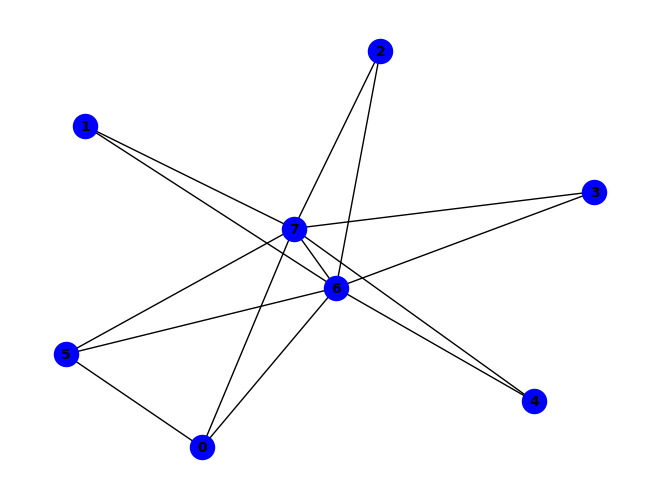


~g ^ (f & h) ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (c & g & ~e) ^ (e & g & ~f) ^ (f & g & ~c) ^ (a & f & g & ~h) ^ (b & h & ~d & ~f) ^ (e & h & ~b & ~f) ^ (a & c & e & g & ~b) ^ (a & d & e & g & ~c) ^ (a & d & e & h & ~c) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (c & e & f & g & ~a) ^ (a & b & c & d & e & h) ^ (a & b & c & e & f & g) ^ (a & c & d & e & f & g) ^ (a & c & g & ~b & ~f) ^ (a & d & g & ~c & ~f) ^ (a & d & h & ~c & ~f) ^ (d & g & ~c & ~e & ~f) ^ (d & h & ~c & ~e & ~f) ^ (b & c & d & h & ~a & ~f) ^ (b & d & e & h & ~c & ~f) ^ (a & c & d & e & f & h & ~b) ^ (a & b & g & ~d & ~e & ~f) ^ (a & b & h & ~d & ~e & ~f) ^ (a & b & c & d & g & ~e & ~f) ^ (b & g & ~c & ~d & ~e & ~f) ^ (c & h & ~a & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


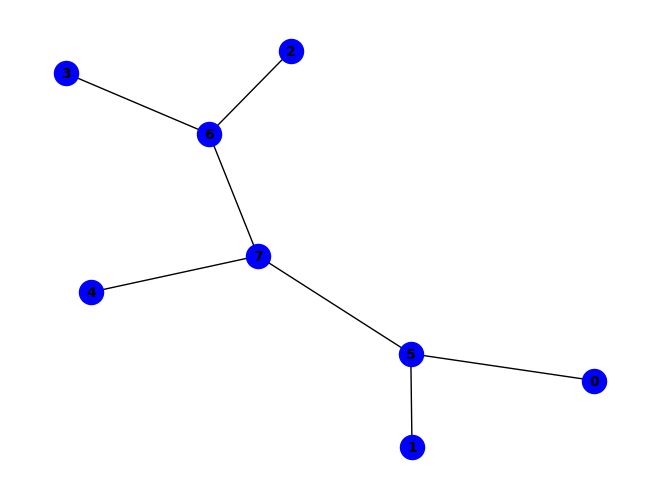


(~d & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (a & d & f & ~g) ^ (a & f & ~d & ~h) ^ (b & f & ~a & ~h) ^ (d & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (b & c & d & f & ~h) ^ (b & c & f & g & ~h) ^ (c & d & ~b & ~g & ~h) ^ (a & c & d & g & ~b & ~h) ^ (a & c & f & g & ~b & ~h) ^ (b & d & f & g & ~a & ~h) ^ (a & c & d & ~b & ~f & ~g) ^ (a & c & d & ~b & ~f & ~h) ^ (a & d & h & ~c & ~f & ~g) ^ (b & c & d & ~f & ~g & ~h) ^ (a & b & c & d & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


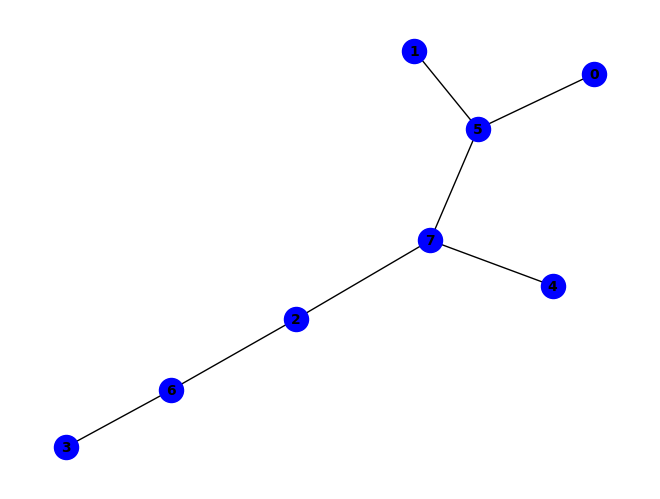


(~b & ~f) ^ (b & h & ~f) ^ (d & g & ~c) ^ (e & h & ~f) ^ (b & ~d & ~h) ^ (f & ~a & ~h) ^ (a & b & f & ~h) ^ (b & d & ~g & ~h) ^ (c & g & ~b & ~h) ^ (c & h & ~e & ~f) ^ (d & e & g & h & ~c) ^ (b & c & g & ~f & ~h) ^ (b & d & g & ~f & ~h) ^ (b & c & d & f & g & ~h) ^ (a & c & f & g & ~b & ~h) ^ (d & f & g & h & ~c & ~e) ^ (a & d & f & g & ~b & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


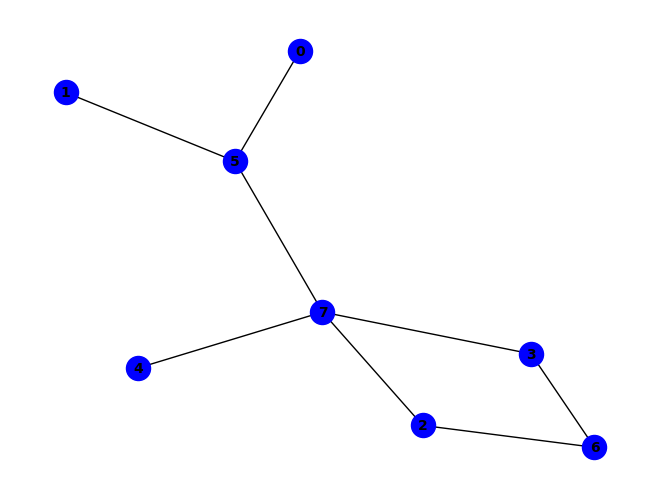


(~b & ~f) ^ (b & h & ~f) ^ (e & h & ~f) ^ (b & ~d & ~h) ^ (f & ~a & ~h) ^ (a & b & f & ~h) ^ (c & g & ~b & ~h) ^ (d & g & ~c & ~h) ^ (d & h & ~e & ~f) ^ (b & c & d & f & ~h) ^ (b & c & g & ~f & ~h) ^ (b & d & g & ~f & ~h) ^ (a & b & c & d & g & ~h) ^ (a & b & c & f & g & ~h) ^ (b & d & ~c & ~g & ~h) ^ (c & h & ~d & ~e & ~f) ^ (a & b & c & d & ~f & ~h) ^ (a & c & f & g & ~d & ~h) ^ (a & d & f & g & ~b & ~h) ^ (b & c & d & ~a & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


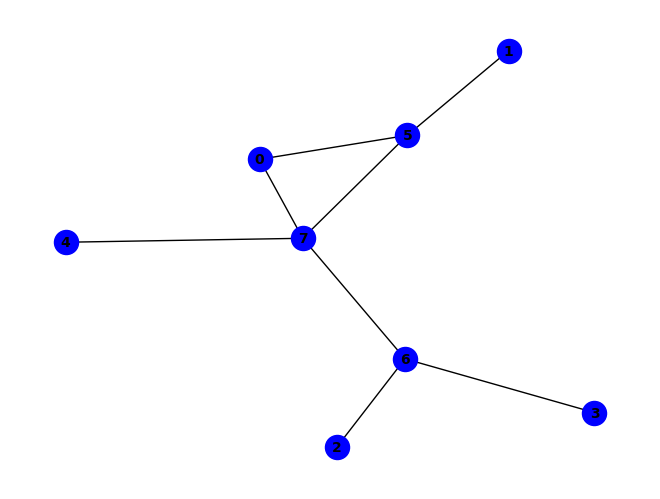


(~d & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (a & d & f & ~g) ^ (a & d & f & ~h) ^ (a & e & f & ~g) ^ (a & e & h & ~g) ^ (a & f & ~e & ~h) ^ (b & f & ~a & ~h) ^ (d & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & e & f & g & ~h) ^ (b & c & d & f & ~h) ^ (a & b & c & d & g & ~h) ^ (a & h & ~d & ~f & ~g) ^ (c & d & ~b & ~g & ~h) ^ (a & b & c & d & ~f & ~h) ^ (a & c & f & g & ~d & ~h) ^ (b & c & f & g & ~a & ~h) ^ (b & d & f & g & ~a & ~h) ^ (b & c & d & ~a & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


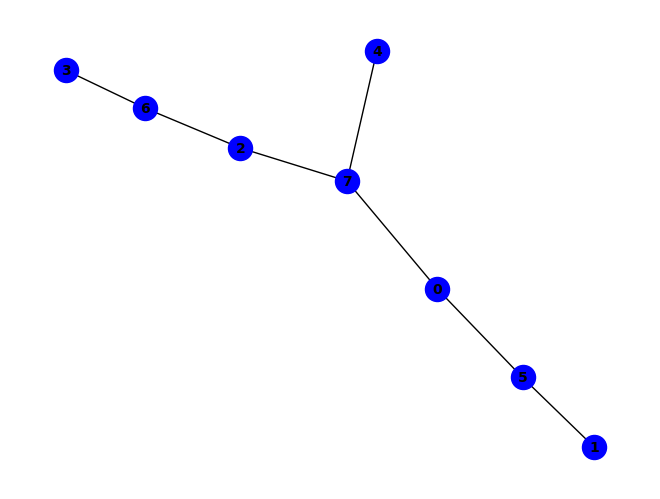


~e ^ (e & ~h) ^ (a & f & ~d) ^ (a & h & ~f) ^ (b & f & ~a) ^ (c & h & ~e) ^ (d & g & ~c) ^ (b & c & f & h) ^ (a & c & d & g & h) ^ (a & c & d & f & ~h) ^ (a & c & f & h & ~b) ^ (a & d & g & h & ~f) ^ (d & e & g & h & ~c) ^ (a & c & g & ~b & ~f) ^ (a & c & h & ~f & ~g) ^ (a & d & f & ~c & ~g) ^ (a & e & h & ~c & ~d) ^ (b & c & g & ~f & ~h) ^ (a & b & c & g & h & ~f) ^ (a & c & d & f & h & ~g) ^ (c & g & ~a & ~b & ~h) ^ (a & d & e & h & ~c & ~g) ^ (b & d & f & g & ~a & ~c) ^ (b & e & f & h & ~a & ~c) ^ (b & d & e & f & g & h & ~a & ~c)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


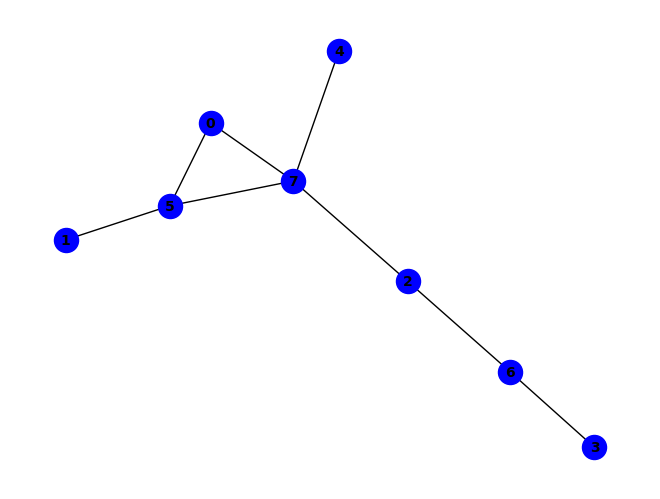


(f & ~h) ^ (~b & ~f) ^ (a & f & ~e) ^ (a & h & ~e) ^ (b & h & ~f) ^ (d & g & ~c) ^ (e & h & ~f) ^ (b & ~d & ~h) ^ (a & b & f & ~h) ^ (a & c & d & f & g) ^ (b & d & ~g & ~h) ^ (c & g & ~b & ~h) ^ (a & d & f & g & ~e) ^ (d & e & g & h & ~c) ^ (a & c & d & e & f & h) ^ (a & e & f & ~d & ~h) ^ (b & c & g & ~f & ~h) ^ (b & d & g & ~f & ~h) ^ (a & c & d & e & f & ~g) ^ (b & c & d & f & g & ~h) ^ (c & h & ~a & ~e & ~f) ^ (a & c & f & g & ~b & ~h) ^ (a & d & g & h & ~c & ~e) ^ (d & f & g & h & ~c & ~e) ^ (a & b & d & f & g & ~c & ~h) ^ (a & d & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


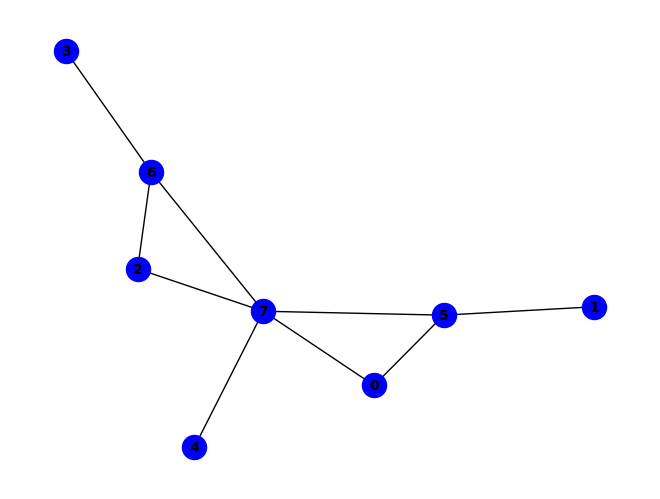


(g & ~h) ^ (~d & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & f & ~c & ~h) ^ (b & f & ~a & ~h) ^ (c & d & ~g & ~h) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (e & h & ~f & ~g) ^ (c & e & f & g & ~a) ^ (c & e & f & h & ~a) ^ (a & c & f & ~g & ~h) ^ (a & c & g & ~f & ~h) ^ (c & e & h & ~a & ~g) ^ (c & f & g & ~e & ~h) ^ (a & c & e & f & g & ~h) ^ (a & h & ~e & ~f & ~g) ^ (a & d & f & g & ~c & ~h) ^ (b & d & f & g & ~a & ~h) ^ (b & c & f & g & ~a & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


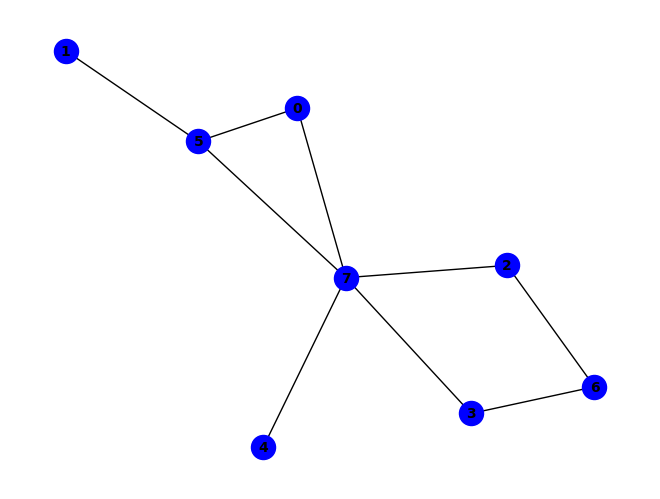


(f & ~h) ^ (~b & ~f) ^ (a & f & ~e) ^ (b & h & ~f) ^ (e & h & ~f) ^ (a & d & f & g) ^ (b & ~d & ~h) ^ (a & b & f & ~h) ^ (a & d & e & f & h) ^ (a & h & ~d & ~e) ^ (c & g & ~b & ~h) ^ (d & g & ~c & ~h) ^ (d & h & ~e & ~f) ^ (a & c & e & f & ~d) ^ (a & c & e & h & ~d) ^ (a & d & f & h & ~g) ^ (b & c & d & f & ~h) ^ (a & c & h & ~d & ~f) ^ (a & e & f & ~c & ~h) ^ (b & d & g & ~f & ~h) ^ (a & b & d & f & g & ~h) ^ (a & c & d & e & f & ~h) ^ (b & d & ~c & ~g & ~h) ^ (c & h & ~d & ~e & ~f) ^ (a & b & c & g & ~d & ~h) ^ (a & c & f & g & ~d & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (b & c & g & ~a & ~f & ~h) ^ (a & b & c & d & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


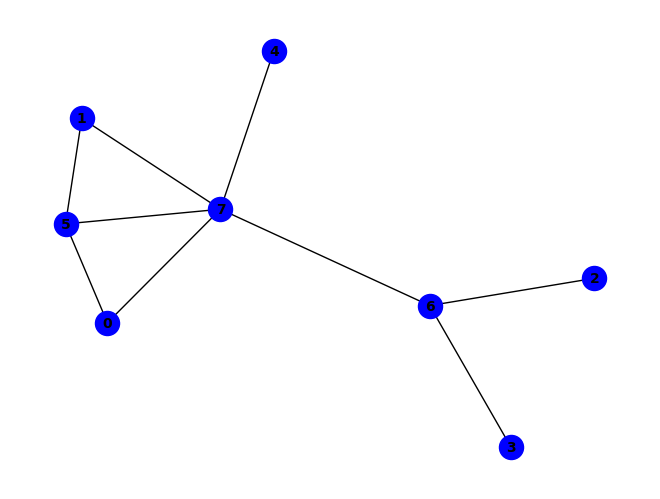


(~d & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (b & d & f & ~g) ^ (b & d & f & ~h) ^ (b & e & f & ~g) ^ (a & f & ~b & ~h) ^ (b & f & ~e & ~h) ^ (c & d & ~g & ~h) ^ (d & h & ~b & ~g) ^ (e & h & ~f & ~g) ^ (b & e & f & g & ~h) ^ (b & e & h & ~a & ~g) ^ (a & b & e & f & h & ~g) ^ (a & h & ~e & ~f & ~g) ^ (a & b & d & g & ~c & ~h) ^ (a & c & f & g & ~b & ~h) ^ (a & d & f & g & ~c & ~h) ^ (b & c & f & g & ~d & ~h) ^ (a & b & d & ~c & ~f & ~g) ^ (a & b & d & ~c & ~f & ~h) ^ (a & b & c & d & h & ~f & ~g) ^ (b & h & ~a & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


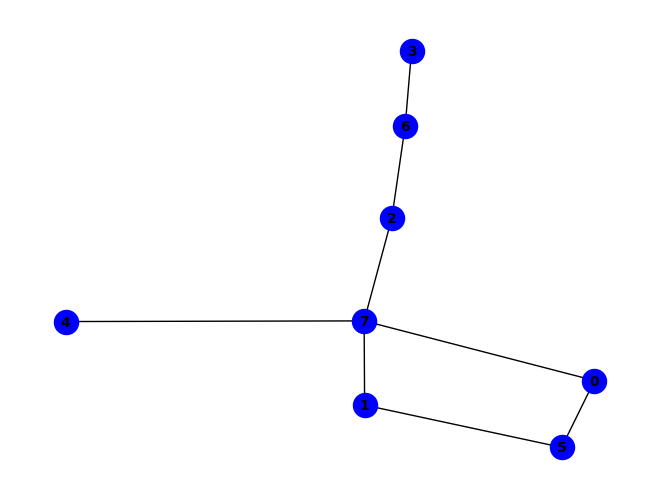


~e ^ (e & ~h) ^ (a & f & ~d) ^ (a & h & ~f) ^ (b & f & ~d) ^ (b & h & ~f) ^ (d & g & ~c) ^ (a & b & f & ~h) ^ (a & b & h & ~e) ^ (b & e & h & ~d) ^ (a & b & d & f & g) ^ (c & h & ~b & ~e) ^ (a & c & f & h & ~b) ^ (a & d & f & h & ~b) ^ (a & d & g & h & ~c) ^ (b & d & e & h & ~g) ^ (b & d & g & h & ~f) ^ (d & e & g & h & ~c) ^ (a & b & c & d & g & h) ^ (a & c & g & ~b & ~f) ^ (a & d & f & ~g & ~h) ^ (a & e & h & ~c & ~d) ^ (b & c & g & ~f & ~h) ^ (b & d & f & ~c & ~g) ^ (a & b & c & d & f & ~g) ^ (a & b & c & e & h & ~d) ^ (a & b & d & g & h & ~e) ^ (a & c & d & f & g & ~h) ^ (b & c & d & f & h & ~g) ^ (b & c & d & g & h & ~e) ^ (c & g & ~a & ~b & ~h) ^ (a & d & e & h & ~c & ~g) ^ (b & c & d & f & ~a & ~h) ^ (a & b & c & d & e & h & ~g) ^ (a & c & h & ~b & ~f & ~g) ^ (a & b & d & f & h & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

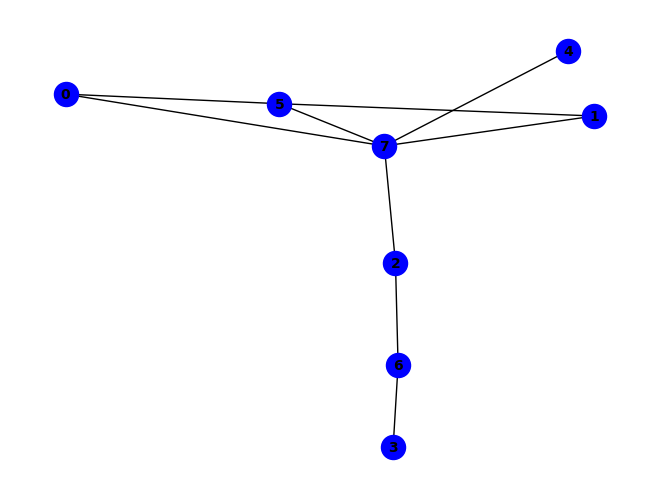


~f ^ (f & ~h) ^ (b & f & ~e) ^ (b & h & ~e) ^ (c & g & ~h) ^ (d & g & ~c) ^ (e & h & ~f) ^ (a & b & d & f & g) ^ (a & f & ~b & ~e) ^ (a & h & ~b & ~e) ^ (a & c & f & g & ~h) ^ (a & d & f & g & ~e) ^ (b & d & f & g & ~c) ^ (d & e & g & h & ~c) ^ (a & e & f & ~d & ~h) ^ (b & e & f & ~a & ~h) ^ (a & c & d & f & g & ~b) ^ (a & b & d & e & f & g & h) ^ (a & d & g & h & ~c & ~e) ^ (b & c & f & g & ~a & ~h) ^ (d & f & g & h & ~c & ~e) ^ (a & c & d & e & f & h & ~b) ^ (b & d & e & f & g & h & ~c) ^ (a & c & d & e & f & ~b & ~g) ^ (c & h & ~a & ~b & ~e & ~f) ^ (a & d & e & f & ~c & ~g & ~h) ^ (b & d & g & h & ~a & ~c & ~e) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


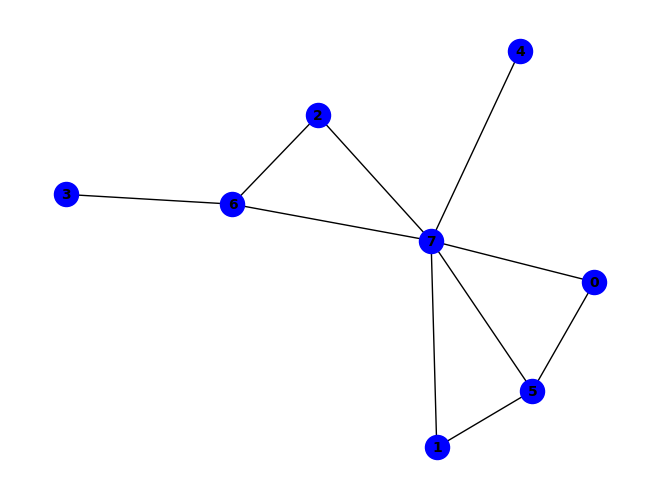


(g & ~h) ^ (~d & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & f & ~c & ~h) ^ (c & d & ~g & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & h & ~f & ~g) ^ (c & e & f & g & ~b) ^ (c & e & f & h & ~b) ^ (a & c & f & ~b & ~g) ^ (b & c & f & ~g & ~h) ^ (b & c & g & ~f & ~h) ^ (c & e & h & ~b & ~g) ^ (c & f & g & ~e & ~h) ^ (b & c & e & f & g & ~h) ^ (a & h & ~e & ~f & ~g) ^ (b & f & ~a & ~c & ~h) ^ (a & d & f & g & ~c & ~h) ^ (a & c & h & ~b & ~e & ~g) ^ (a & c & e & f & h & ~b & ~g) ^ (b & h & ~a & ~e & ~f & ~g) ^ (b & d & f & g & ~a & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


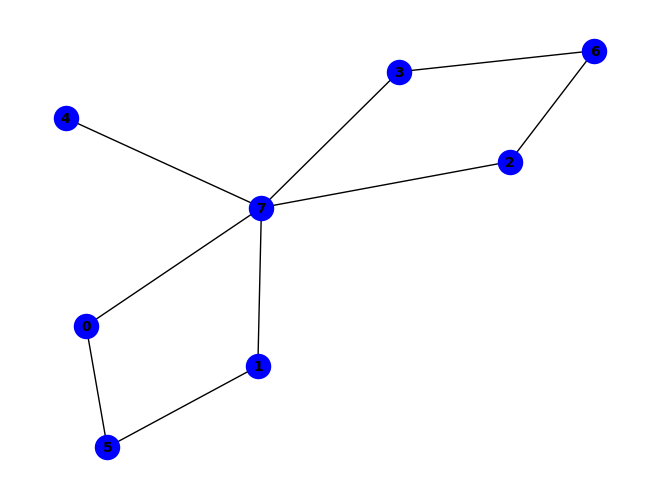


~e ^ (e & ~h) ^ (a & f & ~h) ^ (b & f & ~a) ^ (d & h & ~e) ^ (b & c & g & ~a) ^ (a & h & ~c & ~e) ^ (b & h & ~a & ~f) ^ (c & g & ~a & ~h) ^ (c & h & ~d & ~e) ^ (a & d & e & h & ~c) ^ (a & d & f & h & ~c) ^ (a & d & g & ~c & ~f) ^ (b & c & g & ~f & ~h) ^ (b & d & g & ~a & ~c) ^ (d & g & ~a & ~c & ~h) ^ (b & d & f & h & ~a & ~g) ^ (a & c & g & ~b & ~f & ~h) ^ (a & d & h & ~c & ~f & ~g) ^ (b & c & h & ~a & ~d & ~g) ^ (b & e & h & ~a & ~c & ~d) ^ (b & d & ~a & ~c & ~f & ~g) ^ (b & d & ~a & ~c & ~f & ~h) ^ (b & c & d & h & ~a & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


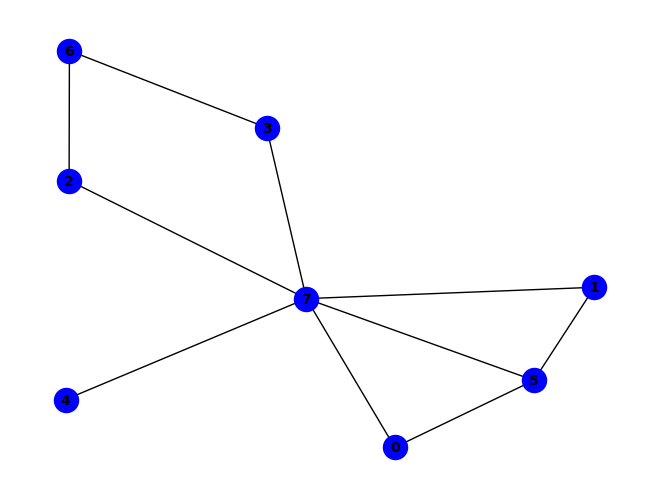


~f ^ (f & ~h) ^ (a & f & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (b & c & f & g) ^ (b & c & e & f & h) ^ (b & f & ~a & ~e) ^ (b & h & ~c & ~e) ^ (d & g & ~c & ~h) ^ (a & c & e & f & ~d) ^ (a & c & f & g & ~d) ^ (a & c & f & h & ~g) ^ (a & d & f & g & ~b) ^ (b & c & d & f & ~g) ^ (b & c & d & f & ~h) ^ (b & d & f & g & ~h) ^ (a & b & c & d & f & g) ^ (a & b & h & ~d & ~e) ^ (a & e & f & ~c & ~h) ^ (b & e & f & ~a & ~h) ^ (a & b & c & d & h & ~e) ^ (a & b & c & f & g & ~h) ^ (a & c & d & e & f & ~h) ^ (a & d & e & f & h & ~b) ^ (a & b & c & d & e & f & h) ^ (a & h & ~c & ~d & ~e) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & b & c & h & ~e & ~f) ^ (b & c & d & h & ~e & ~f) ^ (b & c & f & h & ~d & ~g) ^ (a & d & f & h & ~b & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

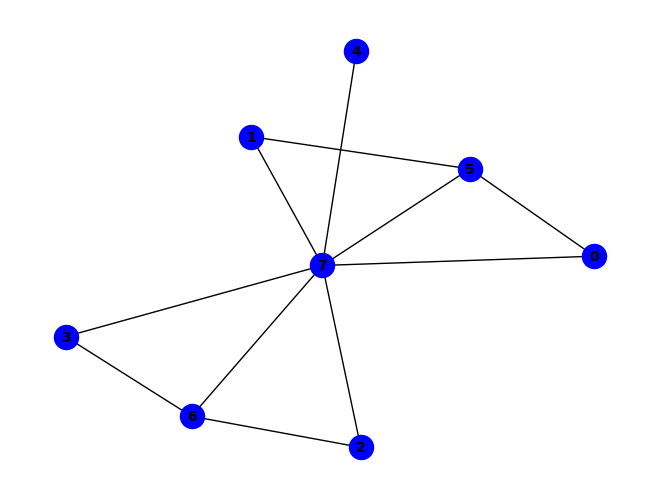


~g ^ (g & ~h) ^ (f & h & ~g) ^ (b & c & g & ~h) ^ (a & f & ~d & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & b & c & f & ~g) ^ (a & c & d & f & ~h) ^ (a & c & f & g & ~h) ^ (a & d & f & ~g & ~h) ^ (b & e & f & ~a & ~g) ^ (c & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (a & b & d & f & g & ~h) ^ (b & c & d & f & g & ~h) ^ (b & f & ~a & ~e & ~h) ^ (e & h & ~c & ~f & ~g) ^ (a & b & c & f & ~d & ~h) ^ (a & b & c & h & ~e & ~g) ^ (a & c & d & f & ~b & ~g) ^ (a & c & d & h & ~e & ~g) ^ (b & c & e & h & ~f & ~g) ^ (b & e & f & g & ~a & ~h) ^ (d & e & f & g & ~b & ~c) ^ (d & e & f & h & ~b & ~c) ^ (a & b & c & e & f & h & ~g) ^ (a & b & d & e & f & h & ~g) ^ (a & c & d & e & f & h & ~g) ^ (a & c & h & ~e & ~f & ~g) ^ (b & e & h & ~a & ~d & ~g) ^ (d & f & g & ~b & ~e & ~h) ^ (b & c & d & e & h & ~a & ~g) ^ (c & d & e & f & g & ~b & ~h) ^ (a & h & ~d & ~e & ~f & ~g) ^ (b & h & ~a & ~d & ~f & ~g) ^ (b & c & d & h & ~a & ~f & ~g) ^ (a & b & c & d & f 

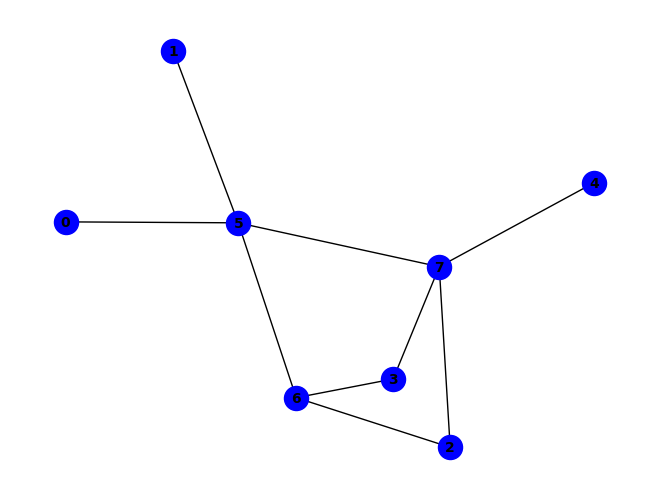


~e ^ (d & e & ~f) ^ (d & h & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (c & d & g & ~f) ^ (d & e & f & ~h) ^ (b & f & ~g & ~h) ^ (c & g & ~f & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~f & ~h) ^ (c & d & e & h & ~f) ^ (c & d & h & ~f & ~g) ^ (a & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


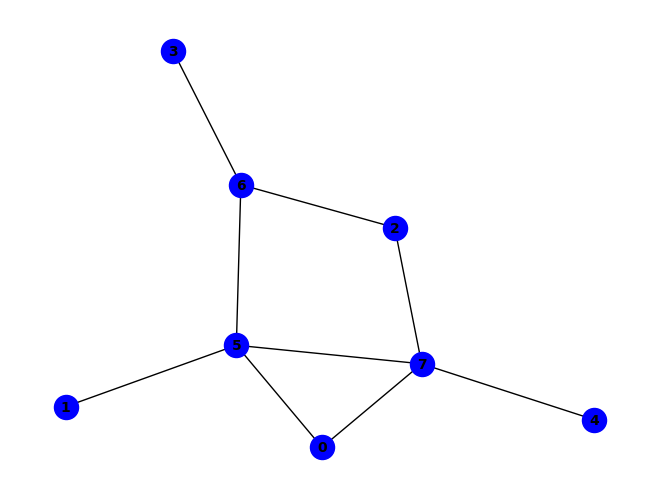


~e ^ (d & e & g) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (d & e & f & g & h) ^ (b & f & ~g & ~h) ^ (c & g & ~f & ~h) ^ (c & h & ~e & ~f) ^ (d & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (c & d & e & g & h & ~f) ^ (a & f & ~b & ~g & ~h) ^ (a & h & ~c & ~e & ~f) ^ (a & d & g & h & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


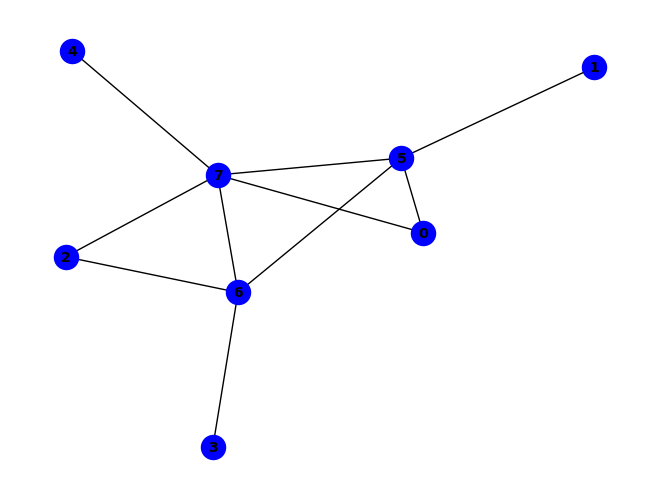


(~d & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (g & ~a & ~h) ^ (c & d & f & ~h) ^ (c & d & g & ~h) ^ (e & f & g & ~h) ^ (d & f & ~c & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~c & ~g) ^ (a & c & e & g & ~f) ^ (a & c & e & h & ~f) ^ (a & e & f & h & ~g) ^ (c & d & f & h & ~g) ^ (c & e & f & h & ~g) ^ (a & c & h & ~f & ~g) ^ (a & e & g & ~c & ~h) ^ (a & c & e & f & g & ~h) ^ (b & f & ~a & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


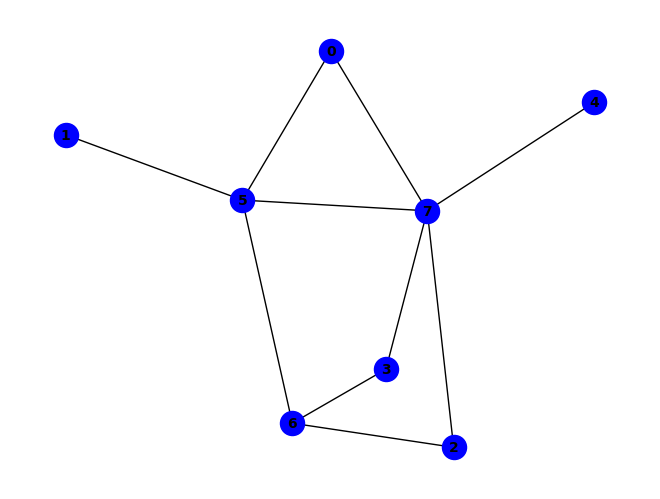


~e ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (c & d & g & ~f) ^ (d & e & f & ~h) ^ (b & f & ~g & ~h) ^ (c & g & ~f & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~f & ~h) ^ (d & h & ~a & ~f) ^ (a & d & e & h & ~f) ^ (c & d & e & h & ~f) ^ (c & d & h & ~f & ~g) ^ (a & f & ~b & ~g & ~h) ^ (a & h & ~c & ~e & ~f) ^ (a & c & d & h & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


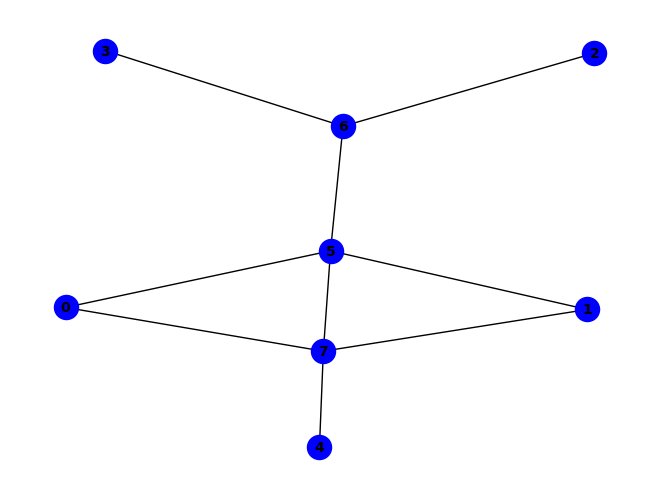


~e ^ (d & e & g) ^ (a & h & ~e) ^ (c & g & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (a & f & g & h) ^ (e & ~d & ~h) ^ (d & e & f & g & h) ^ (a & f & ~d & ~g) ^ (d & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (a & d & f & h & ~c) ^ (a & e & f & h & ~d) ^ (b & c & f & h & ~e) ^ (b & c & g & h & ~e) ^ (a & b & f & ~g & ~h) ^ (b & c & f & ~e & ~g) ^ (a & d & e & f & h & ~g) ^ (a & b & c & d & e & g & h) ^ (b & f & ~c & ~g & ~h) ^ (b & h & ~a & ~e & ~f) ^ (a & c & d & f & ~e & ~g) ^ (a & d & g & h & ~c & ~e) ^ (b & c & e & f & ~g & ~h) ^ (c & e & g & h & ~d & ~f) ^ (a & b & c & d & e & f & ~g) ^ (a & b & c & d & g & h & ~f) ^ (a & c & d & e & f & h & ~b) ^ (a & d & f & ~c & ~g & ~h) ^ (a & b & d & g & h & ~e & ~f) ^ (a & c & g & h & ~b & ~e & ~f) ^ (b & d & g & h & ~c & ~e & ~f) ^ (a & c & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


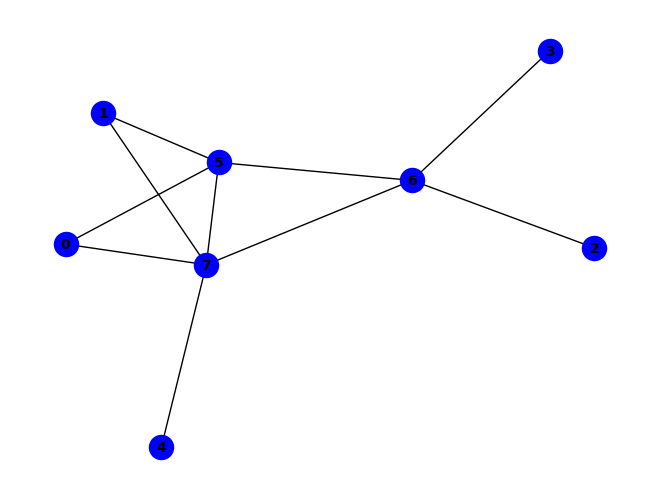


(~d & ~g) ^ (b & f & ~g) ^ (e & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (g & ~c & ~h) ^ (c & d & f & ~h) ^ (c & d & g & ~h) ^ (c & f & g & ~h) ^ (a & f & ~b & ~g) ^ (b & h & ~e & ~g) ^ (d & f & ~c & ~g) ^ (d & h & ~f & ~g) ^ (a & e & f & g & ~b) ^ (a & e & f & h & ~b) ^ (b & e & f & h & ~g) ^ (c & d & f & h & ~g) ^ (e & f & g & ~a & ~h) ^ (a & b & e & f & g & ~h) ^ (a & h & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


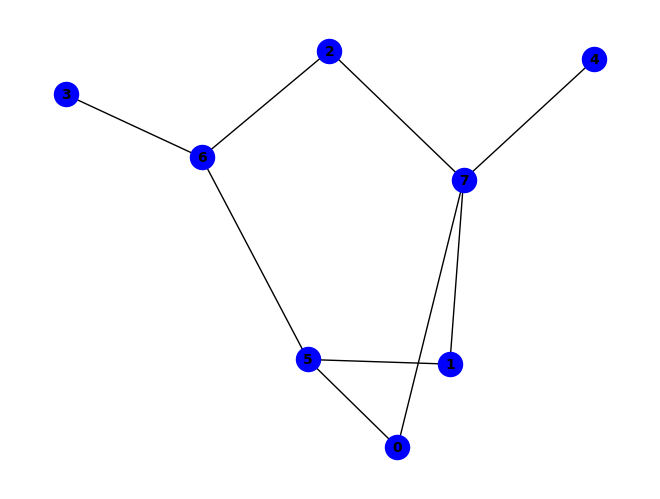


(c & f & g) ^ (~b & ~f) ^ (c & g & ~h) ^ (c & h & ~e) ^ (b & ~f & ~h) ^ (c & e & f & g & h) ^ (d & g & ~c & ~f) ^ (e & h & ~b & ~f) ^ (b & c & h & ~e & ~f) ^ (b & c & f & h & ~e & ~g) ^ (d & e & g & h & ~c & ~f) ^ (f & ~a & ~b & ~e & ~g) ^ (a & h & ~b & ~c & ~e & ~f) ^ (e & f & ~a & ~b & ~g & ~h) ^ (a & c & f & h & ~b & ~e & ~g) ^ (b & d & g & h & ~c & ~e & ~f) ^ (a & d & g & h & ~b & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


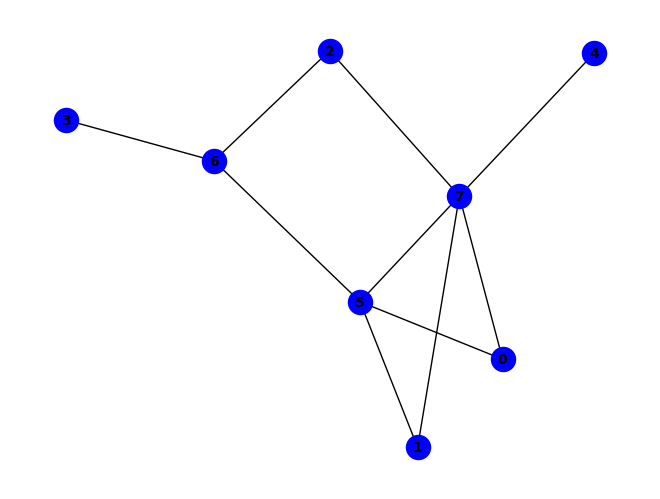


~e ^ (d & e & g) ^ (b & f & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & b & h & ~e) ^ (a & b & f & g & h) ^ (d & e & f & g & h) ^ (a & f & ~g & ~h) ^ (c & g & ~f & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~c & ~f) ^ (f & g & ~b & ~h) ^ (a & b & c & h & ~f) ^ (b & d & e & h & ~f) ^ (a & b & c & d & g & h) ^ (a & b & f & ~d & ~g) ^ (b & d & e & ~f & ~g) ^ (a & b & c & e & h & ~d) ^ (a & b & d & g & h & ~e) ^ (a & b & e & f & h & ~c) ^ (a & h & ~c & ~e & ~f) ^ (b & h & ~c & ~e & ~f) ^ (d & e & ~b & ~g & ~h) ^ (b & d & e & f & ~g & ~h) ^ (b & d & g & h & ~c & ~f) ^ (a & b & c & d & e & h & ~g) ^ (a & b & d & e & f & h & ~g) ^ (a & b & c & d & f & ~e & ~g) ^ (a & b & d & f & h & ~c & ~e) ^ (c & d & e & g & h & ~b & ~f) ^ (a & b & d & f & ~c & ~g & ~h) ^ (a & d & g & h & ~c & ~e & ~f) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

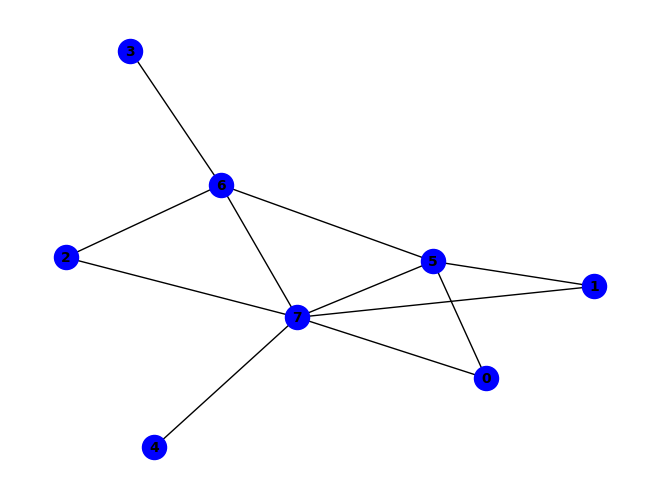


(~d & ~g) ^ (a & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (g & ~b & ~h) ^ (c & d & f & ~h) ^ (c & d & g & ~h) ^ (e & f & g & ~h) ^ (b & f & ~a & ~g) ^ (d & f & ~c & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~c & ~g) ^ (a & c & e & h & ~g) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & d & f & h & ~g) ^ (b & c & h & ~f & ~g) ^ (b & e & g & ~f & ~h) ^ (b & c & e & f & g & ~h) ^ (a & h & ~b & ~e & ~g) ^ (a & e & f & h & ~b & ~g) ^ (b & c & e & h & ~a & ~g) ^ (c & e & f & h & ~a & ~g) ^ (a & b & c & e & f & h & ~g) ^ (a & c & h & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


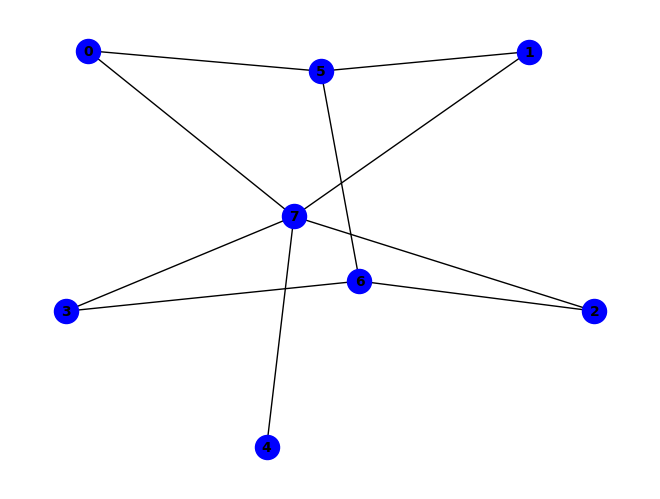


(d & f & g) ^ (~b & ~f) ^ (c & h & ~e) ^ (d & g & ~h) ^ (b & ~f & ~h) ^ (c & f & g & ~d) ^ (d & e & f & g & h) ^ (c & g & ~d & ~h) ^ (d & h & ~c & ~e) ^ (e & h & ~b & ~f) ^ (b & d & h & ~e & ~f) ^ (c & e & f & g & h & ~d) ^ (e & f & ~b & ~g & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & f & ~d & ~g) ^ (a & c & f & h & ~d & ~g) ^ (f & ~a & ~b & ~e & ~g) ^ (a & b & h & ~d & ~e & ~f) ^ (a & e & f & ~c & ~g & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (a & h & ~c & ~d & ~e & ~f) ^ (a & d & f & h & ~b & ~e & ~g) ^ (b & c & f & h & ~a & ~e & ~g) ^ (b & d & f & h & ~c & ~e & ~g) ^ (a & b & c & d & f & h & ~e & ~g) ^ (b & c & h & ~a & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


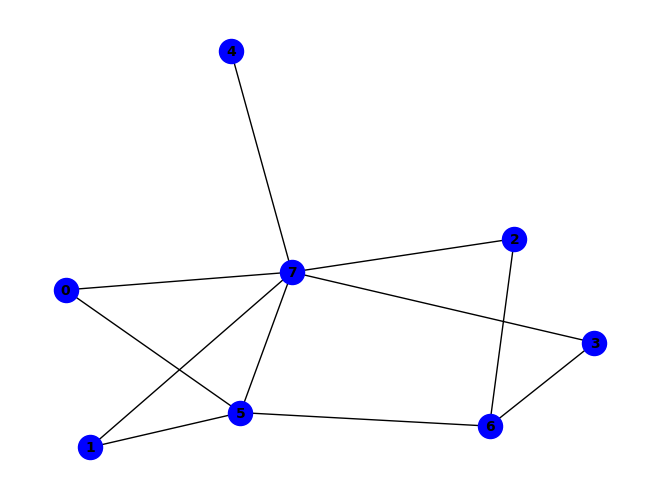


~e ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (c & d & g & ~f) ^ (d & e & f & ~h) ^ (b & f & ~g & ~h) ^ (c & g & ~f & ~h) ^ (d & g & ~f & ~h) ^ (d & h & ~b & ~f) ^ (c & d & e & h & ~f) ^ (c & d & h & ~f & ~g) ^ (a & f & ~b & ~g & ~h) ^ (b & h & ~c & ~e & ~f) ^ (c & h & ~a & ~e & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & c & d & h & ~e & ~f) ^ (b & c & d & h & ~a & ~f) ^ (b & d & e & h & ~c & ~f) ^ (a & b & c & d & e & h & ~f) ^ (a & h & ~b & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


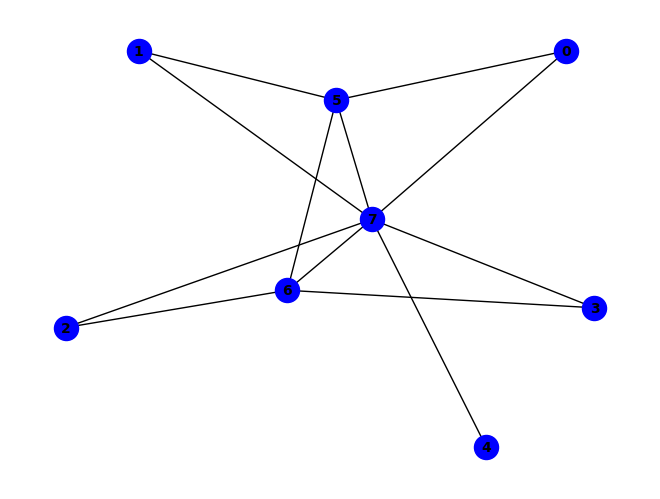


~g ^ (g & ~h) ^ (a & f & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & h & ~e & ~g) ^ (b & f & ~a & ~g) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~d & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (b & h & ~a & ~e & ~g) ^ (a & c & e & h & ~d & ~g) ^ (a & e & f & h & ~c & ~g) ^ (b & d & e & h & ~a & ~g) ^ (c & d & e & h & ~b & ~g) ^ (a & c & d & e & f & h & ~g) ^ (b & c & d & e & f & h & ~g) ^ (a & c & h & ~d & ~f & ~g) ^ (a & d & h & ~e & ~f & ~g) ^ (b & c & h & ~a & ~f & ~g) ^ (c & e & h & ~b & ~f & ~g) ^ (b & e & f & h & ~a & ~d & ~g) ^ (b & d & h & ~a & ~c & ~f & ~g) ^ (a & b & c & e & h & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


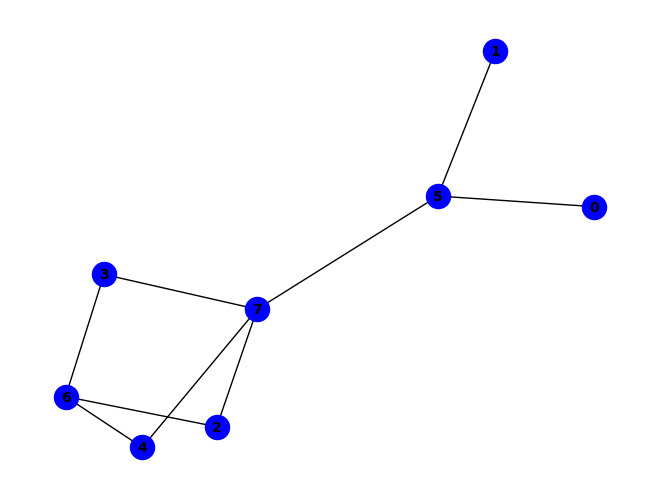


(~b & ~f) ^ (b & h & ~f) ^ (e & h & ~f) ^ (b & ~e & ~h) ^ (f & ~a & ~h) ^ (a & b & f & ~h) ^ (b & e & ~g & ~h) ^ (d & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (e & g & ~a & ~h) ^ (a & e & g & ~f & ~h) ^ (c & g & ~d & ~e & ~h) ^ (c & h & ~d & ~e & ~f) ^ (a & b & e & g & ~d & ~h) ^ (b & d & f & g & ~e & ~h) ^ (b & e & g & ~a & ~f & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & b & d & f & g & ~c & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & c & f & g & ~b & ~e & ~h) ^ (a & d & f & g & ~c & ~e & ~h) ^ (b & c & f & g & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


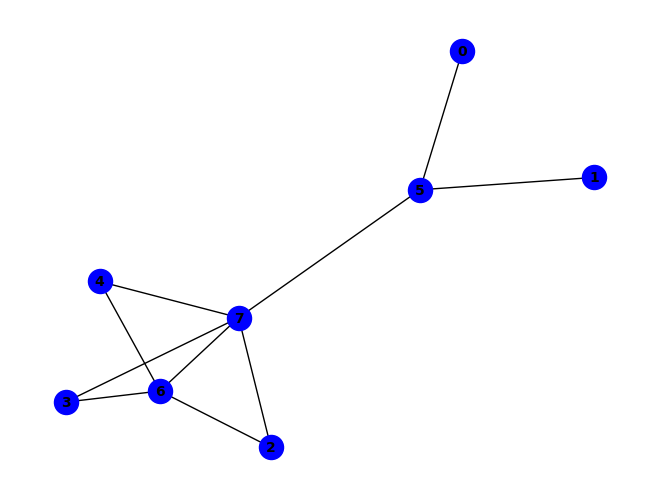


~g ^ (g & ~h) ^ (b & f & ~h) ^ (f & h & ~g) ^ (a & f & ~b & ~h) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (c & d & e & g & ~f) ^ (c & d & e & h & ~f) ^ (c & f & g & ~d & ~h) ^ (e & f & g & ~c & ~h) ^ (a & e & f & g & ~b & ~h) ^ (b & d & f & g & ~c & ~h) ^ (b & e & f & g & ~d & ~h) ^ (d & f & g & ~a & ~e & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (a & c & f & g & ~d & ~e & ~h) ^ (b & c & f & g & ~a & ~e & ~h) ^ (a & b & d & f & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


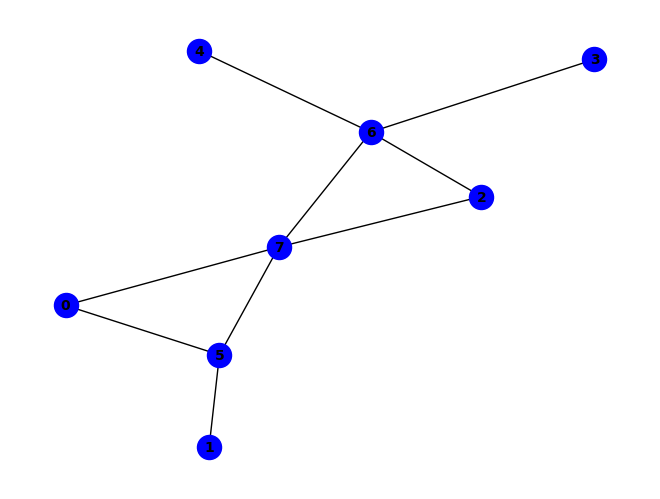


(~e & ~g) ^ (f & h & ~g) ^ (e & ~d & ~h) ^ (g & ~d & ~h) ^ (a & e & f & ~g) ^ (a & f & ~e & ~h) ^ (b & f & ~a & ~h) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (e & h & ~a & ~g) ^ (a & d & e & f & ~h) ^ (a & c & g & ~e & ~h) ^ (c & d & g & ~b & ~h) ^ (c & e & g & ~d & ~h) ^ (c & f & g & ~b & ~h) ^ (a & b & e & f & g & ~h) ^ (a & c & d & e & g & ~h) ^ (a & h & ~e & ~f & ~g) ^ (d & e & ~a & ~g & ~h) ^ (a & c & e & g & ~f & ~h) ^ (a & d & f & g & ~c & ~h) ^ (b & e & f & g & ~c & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & b & c & f & g & ~e & ~h) ^ (b & c & d & e & g & ~a & ~h) ^ (a & c & d & e & ~b & ~f & ~h) ^ (b & c & d & g & ~e & ~f & ~h) ^ (b & d & f & g & ~a & ~e & ~h) ^ (a & d & e & ~c & ~f & ~g & ~h) ^ (a & b & c & d & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

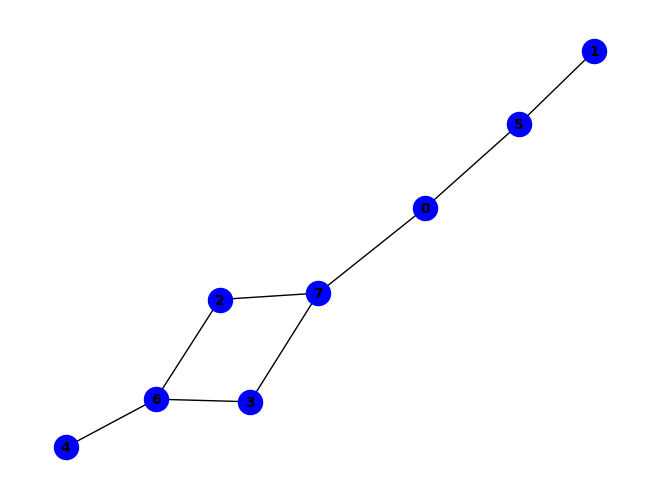


~e ^ (a & f & ~e) ^ (b & f & ~a) ^ (c & h & ~d) ^ (d & h & ~b) ^ (e & ~a & ~g) ^ (a & c & h & ~e) ^ (a & d & g & ~c) ^ (c & e & g & ~b) ^ (a & b & c & f & h) ^ (a & h & ~e & ~f) ^ (c & g & ~d & ~h) ^ (d & g & ~b & ~h) ^ (a & c & e & h & ~g) ^ (b & c & f & h & ~d) ^ (b & e & f & g & ~a) ^ (a & b & d & e & f & g) ^ (b & d & g & ~e & ~f) ^ (b & d & h & ~f & ~g) ^ (d & e & g & ~b & ~c) ^ (a & b & d & f & g & ~h) ^ (a & b & d & f & h & ~c) ^ (a & d & e & g & h & ~c) ^ (a & d & ~c & ~f & ~g) ^ (a & d & ~c & ~f & ~h) ^ (a & e & ~f & ~g & ~h) ^ (a & c & f & g & ~e & ~h) ^ (a & d & e & f & ~c & ~g) ^ (a & d & e & f & ~c & ~h) ^ (b & c & e & g & ~d & ~f) ^ (a & b & c & e & f & g & ~d) ^ (a & d & f & h & ~c & ~e & ~g) ^ (b & c & f & g & ~a & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

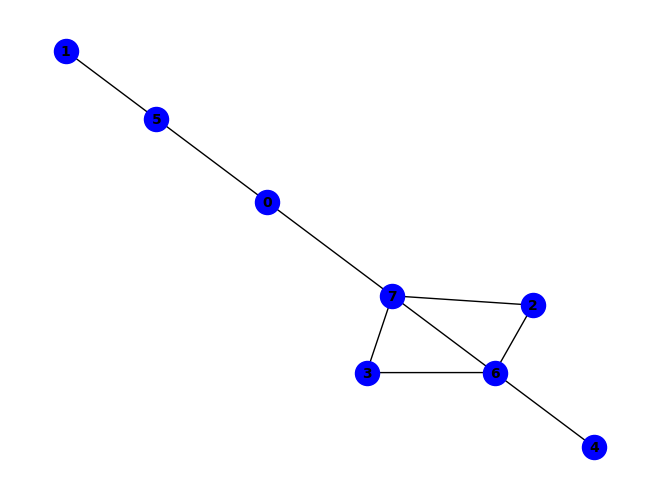


(c & g & ~e) ^ (c & h & ~e) ^ (d & g & ~c) ^ (d & h & ~c) ^ (a & d & f & g) ^ (a & d & f & h) ^ (e & ~d & ~h) ^ (a & c & g & ~d) ^ (a & c & h & ~d) ^ (a & e & f & ~h) ^ (~a & ~e & ~g) ^ (b & f & ~a & ~g) ^ (d & e & ~g & ~h) ^ (e & h & ~c & ~g) ^ (a & e & f & h & ~g) ^ (b & d & f & g & ~a) ^ (b & d & f & h & ~a) ^ (a & ~c & ~f & ~h) ^ (g & ~a & ~b & ~h) ^ (b & c & e & f & g & ~h) ^ (a & c & ~f & ~g & ~h) ^ (a & e & ~d & ~f & ~g) ^ (b & g & ~a & ~f & ~h) ^ (a & c & d & g & ~f & ~h) ^ (a & d & e & g & ~c & ~h) ^ (b & c & f & g & ~a & ~d) ^ (b & c & f & h & ~a & ~d) ^ (c & d & e & g & ~b & ~h) ^ (a & d & e & ~c & ~f & ~h) ^ (a & d & h & ~e & ~f & ~g) ^ (a & c & e & f & g & ~b & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & c & d & e & ~f & ~g & ~h) ^ (b & e & f & g & ~a & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

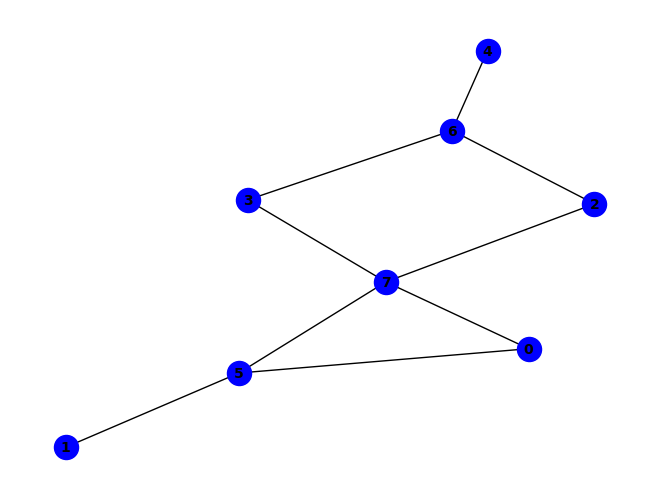


(f & ~h) ^ (~b & ~f) ^ (a & f & ~e) ^ (a & h & ~e) ^ (b & ~e & ~h) ^ (a & b & f & ~h) ^ (a & e & f & ~g) ^ (a & e & h & ~g) ^ (b & d & g & ~f) ^ (a & c & e & g & h) ^ (a & d & e & f & g) ^ (b & e & ~g & ~h) ^ (b & h & ~d & ~f) ^ (c & g & ~d & ~h) ^ (d & g & ~b & ~h) ^ (d & h & ~a & ~f) ^ (e & g & ~c & ~d) ^ (b & d & h & ~f & ~g) ^ (b & e & g & ~f & ~h) ^ (a & c & e & f & g & ~d) ^ (a & d & e & g & h & ~c) ^ (b & d & e & f & g & ~h) ^ (c & h & ~a & ~d & ~f) ^ (a & c & f & g & ~d & ~h) ^ (a & d & f & g & ~b & ~h) ^ (e & f & g & h & ~c & ~d) ^ (a & b & e & f & g & ~d & ~h) ^ (b & c & f & g & ~a & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


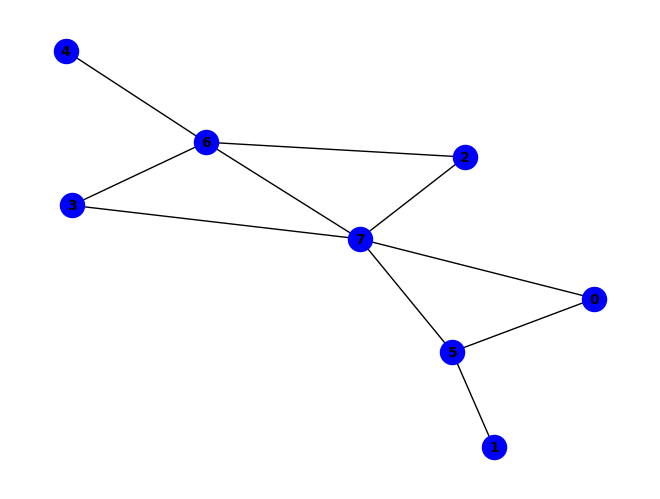


(g & ~h) ^ (~e & ~g) ^ (f & h & ~g) ^ (a & f & ~d & ~h) ^ (b & f & ~a & ~h) ^ (c & e & ~d & ~g) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (d & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~c & ~g) ^ (a & c & d & f & ~h) ^ (c & d & e & h & ~g) ^ (e & ~c & ~d & ~h) ^ (a & c & g & ~e & ~h) ^ (c & f & g & ~d & ~h) ^ (d & f & g & ~b & ~h) ^ (a & b & e & f & g & ~h) ^ (a & h & ~d & ~f & ~g) ^ (a & c & d & h & ~f & ~g) ^ (a & e & f & g & ~d & ~h) ^ (b & e & f & g & ~d & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & d & f & ~c & ~g & ~h) ^ (a & b & c & f & g & ~e & ~h) ^ (a & b & d & f & g & ~e & ~h) ^ (a & c & d & e & g & ~b & ~h) ^ (a & c & e & g & ~d & ~f & ~h) ^ (b & c & f & g & ~d & ~e & ~h) ^ (a & b & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


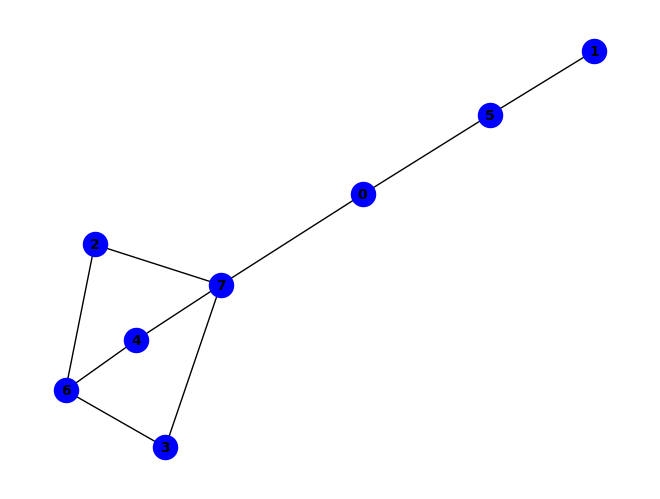


~d ^ (a & f) ^ (e & h & ~d) ^ (a & e & f & g) ^ (d & ~g & ~h) ^ (a & b & c & f & g) ^ (b & d & e & f & g) ^ (a & h & ~e & ~f) ^ (b & f & ~a & ~e) ^ (e & g & ~d & ~h) ^ (a & d & e & h & ~b) ^ (a & d & f & h & ~b) ^ (a & e & f & h & ~g) ^ (b & c & f & h & ~e) ^ (b & d & f & h & ~c) ^ (a & b & c & d & e & h) ^ (a & b & c & d & f & h) ^ (a & b & c & e & f & h) ^ (b & c & d & e & f & h) ^ (a & d & g & ~b & ~f) ^ (a & b & c & f & h & ~g) ^ (a & c & d & e & g & ~h) ^ (a & c & d & f & g & ~h) ^ (b & d & e & f & h & ~g) ^ (c & g & ~d & ~e & ~h) ^ (c & h & ~a & ~d & ~e) ^ (a & c & f & g & ~e & ~h) ^ (b & c & f & g & ~e & ~h) ^ (b & d & f & g & ~c & ~h) ^ (a & b & c & e & f & g & ~h) ^ (b & c & d & e & f & g & ~h) ^ (a & d & e & ~c & ~f & ~g) ^ (a & d & e & ~c & ~f & ~h) ^ (a & d & g & ~b & ~e & ~h) ^ (a & d & h & ~e & ~f & ~g) ^ (b & e & f & ~a & ~g & ~h) ^ (a & b & c & d & g & ~e & ~f) ^ (a & b & c & d & g & ~e & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & b & d & e & h & ~c & ~f) ^ (a & b & d 

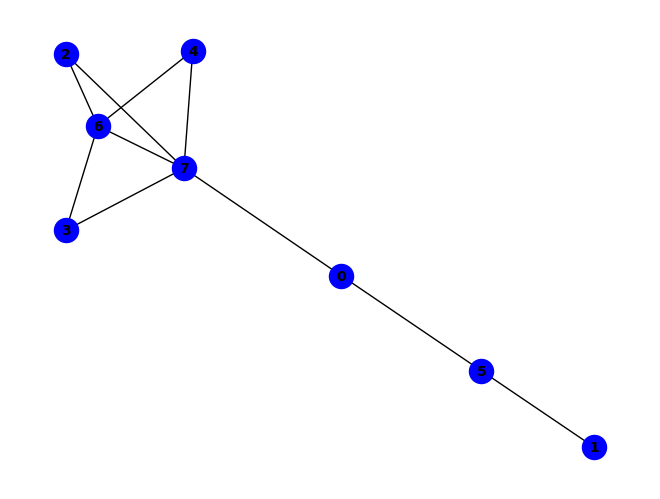


(c & g & ~d) ^ (e & g & ~c) ^ (e & h & ~b) ^ (a & e & f & h) ^ (a & c & g & ~e) ^ (a & c & h & ~e) ^ (a & c & d & f & h) ^ (~a & ~b & ~g) ^ (c & h & ~d & ~e) ^ (d & g & ~a & ~e) ^ (d & h & ~a & ~e) ^ (a & b & e & h & ~d) ^ (a & e & f & g & ~b) ^ (b & d & f & g & ~c) ^ (b & e & f & g & ~d) ^ (a & ~d & ~f & ~h) ^ (b & ~a & ~f & ~g) ^ (g & ~a & ~b & ~h) ^ (a & e & h & ~f & ~g) ^ (b & e & h & ~a & ~f) ^ (a & b & d & f & g & ~e) ^ (a & b & d & f & h & ~c) ^ (a & c & d & e & h & ~b) ^ (a & c & d & f & g & ~b) ^ (a & d & ~f & ~g & ~h) ^ (b & g & ~a & ~f & ~h) ^ (a & c & d & h & ~f & ~g) ^ (b & c & f & g & ~a & ~e) ^ (b & c & f & h & ~a & ~e) ^ (b & d & f & h & ~c & ~e) ^ (c & d & e & g & ~a & ~b) ^ (a & c & g & ~e & ~f & ~h) ^ (a & b & d & e & h & ~c & ~f) ^ (b & c & d & e & g & ~a & ~f) ^ (a & d & e & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

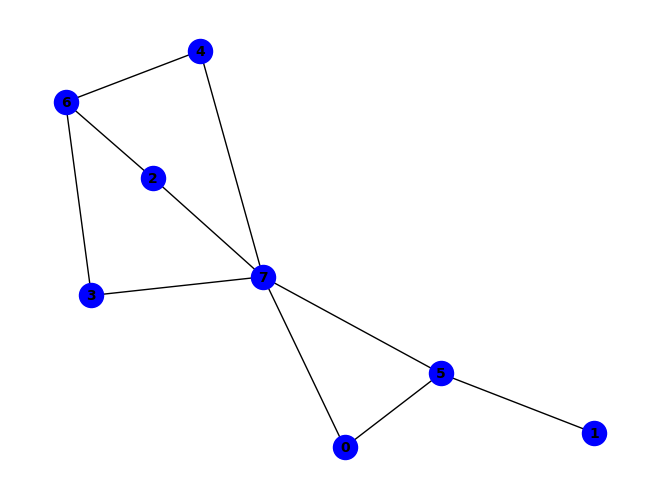


(f & ~h) ^ (a & b & f) ^ (~b & ~f) ^ (a & f & ~e) ^ (a & h & ~b) ^ (e & g & ~h) ^ (a & e & f & h) ^ (b & ~e & ~h) ^ (b & e & ~g & ~h) ^ (b & h & ~a & ~f) ^ (d & g & ~e & ~h) ^ (e & h & ~a & ~f) ^ (a & c & d & h & ~e) ^ (a & c & h & ~e & ~f) ^ (a & e & f & ~g & ~h) ^ (a & c & d & f & g & ~e) ^ (c & g & ~d & ~e & ~h) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (a & b & e & g & ~d & ~h) ^ (a & d & f & g & ~e & ~h) ^ (b & d & f & g & ~e & ~h) ^ (b & e & g & ~a & ~f & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & b & d & f & g & ~c & ~h) ^ (a & c & d & f & h & ~e & ~g) ^ (a & b & c & d & e & f & g & ~h) ^ (a & c & f & g & ~b & ~e & ~h) ^ (b & c & f & g & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


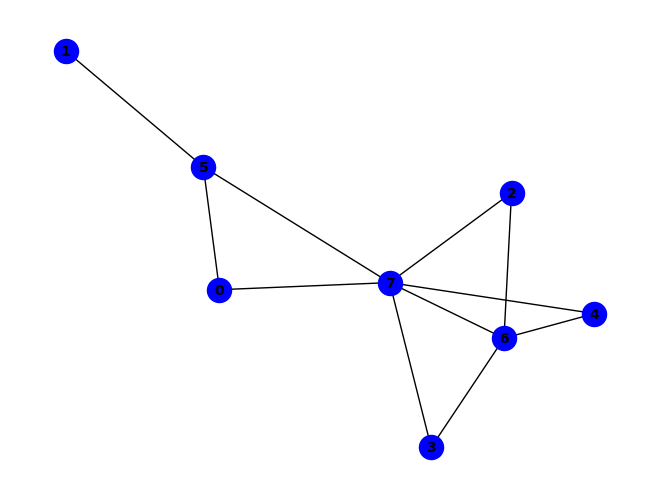


~g ^ (g & ~h) ^ (f & h & ~g) ^ (a & f & ~e & ~h) ^ (b & f & ~a & ~h) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & c & d & f & ~h) ^ (a & c & d & h & ~g) ^ (c & f & g & ~d & ~h) ^ (e & f & g & ~c & ~h) ^ (a & c & d & f & ~e & ~g) ^ (a & c & e & f & ~d & ~h) ^ (a & c & f & g & ~b & ~h) ^ (b & c & f & g & ~e & ~h) ^ (b & d & f & g & ~c & ~h) ^ (b & e & f & g & ~d & ~h) ^ (c & d & e & g & ~a & ~f) ^ (c & d & e & h & ~a & ~f) ^ (a & c & d & e & f & h & ~g) ^ (a & c & h & ~e & ~f & ~g) ^ (a & e & f & ~c & ~g & ~h) ^ (d & f & g & ~a & ~e & ~h) ^ (a & b & e & f & g & ~c & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (a & h & ~d & ~e & ~f & ~g) ^ (a & b & d & f & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

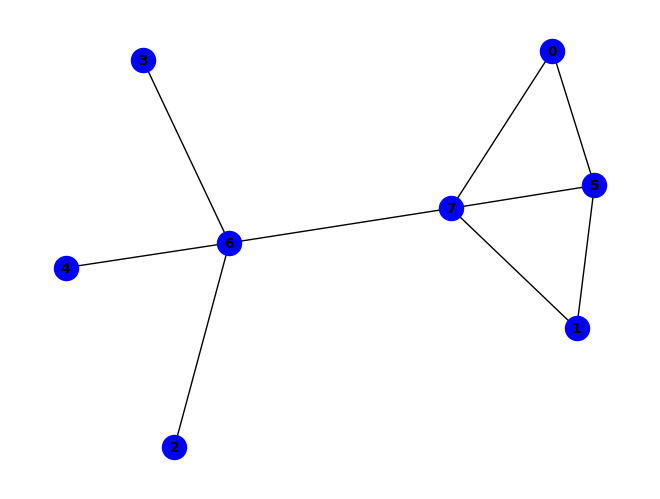


(~e & ~g) ^ (b & f & ~h) ^ (e & h & ~g) ^ (f & h & ~g) ^ (e & ~d & ~h) ^ (g & ~d & ~h) ^ (a & f & ~b & ~h) ^ (d & e & ~g & ~h) ^ (a & d & g & ~e & ~h) ^ (a & d & ~e & ~f & ~g) ^ (a & d & ~e & ~f & ~h) ^ (a & h & ~d & ~f & ~g) ^ (b & h & ~a & ~f & ~g) ^ (c & g & ~d & ~e & ~h) ^ (a & c & f & g & ~e & ~h) ^ (a & e & f & g & ~b & ~h) ^ (b & d & f & g & ~c & ~h) ^ (b & e & f & g & ~d & ~h) ^ (b & c & d & e & f & g & ~h) ^ (a & b & d & f & g & ~e & ~h) ^ (a & c & d & e & g & ~b & ~h) ^ (a & c & d & f & g & ~b & ~h) ^ (a & c & d & e & ~b & ~f & ~g) ^ (a & c & d & e & ~b & ~f & ~h) ^ (a & d & e & h & ~c & ~f & ~g) ^ (b & c & f & g & ~a & ~e & ~h) ^ (a & b & c & d & e & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


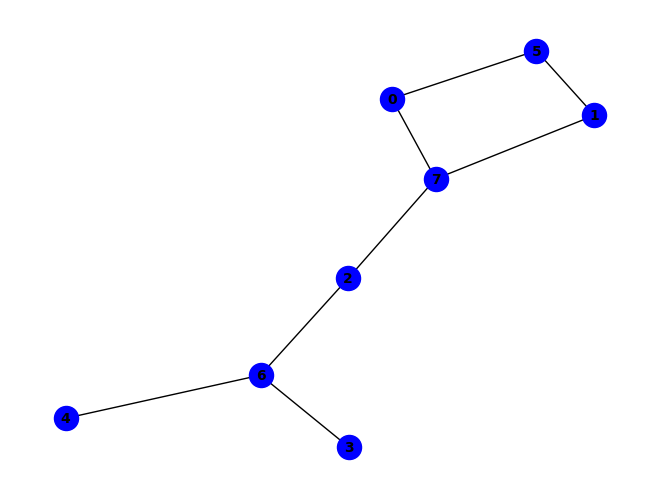


(~b & ~e) ^ (a & f & ~e) ^ (c & h & ~a) ^ (e & ~a & ~g) ^ (a & b & h & ~e) ^ (b & c & g & ~a) ^ (c & e & g & ~b) ^ (a & c & d & g & h) ^ (a & h & ~e & ~f) ^ (c & g & ~b & ~h) ^ (a & b & c & h & ~g) ^ (a & d & g & h & ~e) ^ (a & b & c & e & g & h) ^ (b & ~e & ~f & ~h) ^ (a & b & f & ~e & ~h) ^ (b & c & f & ~e & ~g) ^ (b & c & f & ~e & ~h) ^ (b & c & h & ~f & ~g) ^ (b & d & e & ~f & ~g) ^ (b & d & e & ~f & ~h) ^ (a & b & d & e & h & ~c) ^ (a & b & d & g & h & ~c) ^ (a & c & e & g & h & ~d) ^ (b & c & e & f & h & ~g) ^ (b & d & e & f & h & ~g) ^ (a & e & ~f & ~g & ~h) ^ (d & g & ~b & ~c & ~e) ^ (a & b & c & g & ~f & ~h) ^ (a & c & f & g & ~e & ~h) ^ (b & c & e & g & ~d & ~h) ^ (a & b & c & d & e & h & ~g) ^ (a & b & c & d & f & g & ~h) ^ (b & c & d & e & f & g & ~h) ^ (b & d & g & ~c & ~f & ~h) ^ (b & e & f & ~a & ~g & ~h) ^ (b & e & h & ~a & ~d & ~g) ^ (a & b & d & f & g & ~e & ~h) ^ (a & d & f & g & ~c & ~e & ~h) ^ (a & b & c & e & f & g & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

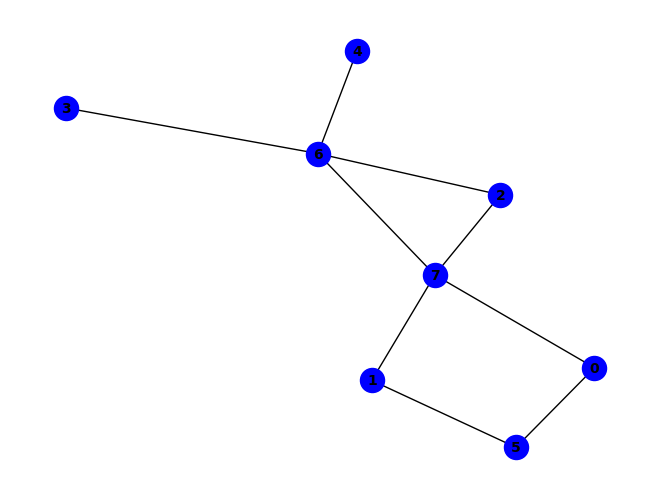


(a & c & g & ~e) ^ (a & c & h & ~e) ^ (a & e & f & ~h) ^ (a & b & c & f & g) ^ (a & b & c & f & h) ^ (c & g & ~b & ~e) ^ (c & h & ~b & ~e) ^ (a & b & e & h & ~g) ^ (a & ~d & ~f & ~h) ^ (e & ~b & ~d & ~h) ^ (a & b & e & ~d & ~h) ^ (a & e & h & ~c & ~g) ^ (c & d & g & ~e & ~h) ^ (~a & ~b & ~e & ~g) ^ (a & e & ~f & ~g & ~h) ^ (d & e & ~b & ~g & ~h) ^ (e & h & ~b & ~c & ~g) ^ (a & b & c & h & ~f & ~g) ^ (a & b & d & g & ~f & ~h) ^ (a & d & e & g & ~c & ~h) ^ (a & b & c & d & e & g & ~h) ^ (a & b & c & e & f & g & ~h) ^ (b & ~a & ~e & ~f & ~h) ^ (g & ~a & ~b & ~d & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (b & c & g & ~e & ~f & ~h) ^ (b & d & g & ~e & ~f & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (a & c & d & f & g & ~b & ~h) ^ (b & c & d & f & g & ~e & ~h) ^ (a & d & ~e & ~f & ~g & ~h) ^ (b & e & ~a & ~f & ~g & ~h) ^ (a & d & e & ~b & ~c & ~f & ~h) ^ (a & c & d & e & ~b & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

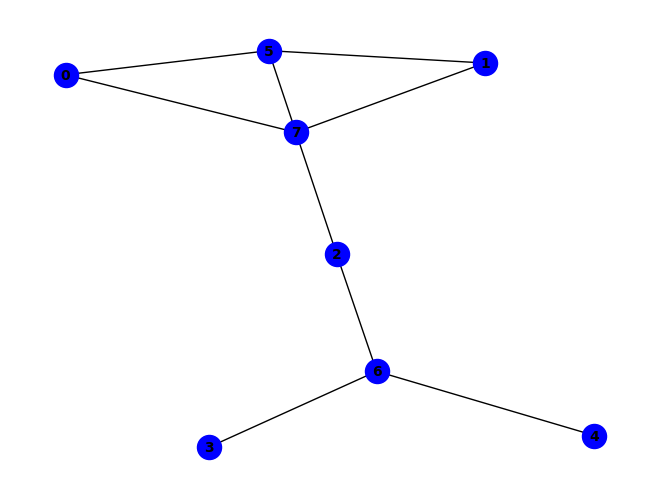


~f ^ (f & ~h) ^ (a & f & ~e) ^ (a & h & ~e) ^ (c & g & ~h) ^ (e & g & ~c) ^ (a & e & f & ~g) ^ (a & e & h & ~g) ^ (b & f & ~a & ~e) ^ (b & h & ~a & ~e) ^ (d & g & ~c & ~e) ^ (a & c & f & g & ~h) ^ (e & f & g & h & ~c) ^ (b & e & f & ~a & ~g) ^ (b & e & h & ~a & ~g) ^ (a & c & e & f & g & ~b) ^ (a & c & e & g & h & ~b) ^ (b & c & d & f & g & ~a) ^ (b & c & d & g & h & ~a) ^ (b & c & e & f & g & ~d) ^ (b & c & e & g & h & ~d) ^ (a & b & c & d & e & f & g) ^ (a & b & c & d & e & g & h) ^ (c & h & ~a & ~b & ~f) ^ (a & d & f & g & ~c & ~e) ^ (a & d & g & h & ~c & ~e) ^ (b & c & f & g & ~a & ~h) ^ (b & d & f & g & ~a & ~e) ^ (b & d & g & h & ~a & ~e) ^ (d & f & g & h & ~c & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


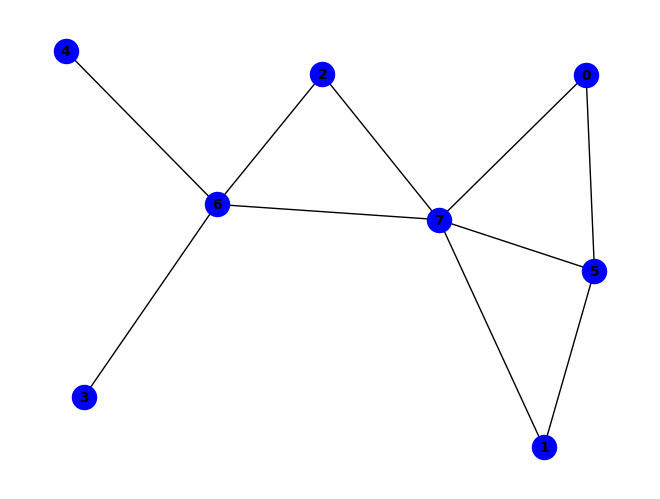


(~e & ~g) ^ (f & h & ~g) ^ (e & ~d & ~h) ^ (g & ~d & ~h) ^ (a & e & f & ~g) ^ (a & f & ~e & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & h & ~a & ~g) ^ (a & b & c & f & ~g) ^ (a & b & c & h & ~g) ^ (a & d & e & f & ~h) ^ (b & c & f & ~g & ~h) ^ (c & d & g & ~b & ~h) ^ (c & f & g & ~a & ~h) ^ (b & f & ~a & ~c & ~h) ^ (b & h & ~a & ~f & ~g) ^ (d & e & ~a & ~g & ~h) ^ (a & d & f & g & ~c & ~h) ^ (b & c & d & e & f & g & ~h) ^ (a & c & e & ~d & ~f & ~g) ^ (a & c & e & ~d & ~f & ~h) ^ (a & d & e & ~f & ~g & ~h) ^ (b & c & g & ~d & ~f & ~h) ^ (c & e & g & ~a & ~d & ~h) ^ (a & c & d & e & h & ~f & ~g) ^ (a & h & ~c & ~e & ~f & ~g) ^ (b & d & f & g & ~a & ~e & ~h) ^ (b & e & f & g & ~a & ~c & ~h) ^ (a & b & c & d & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


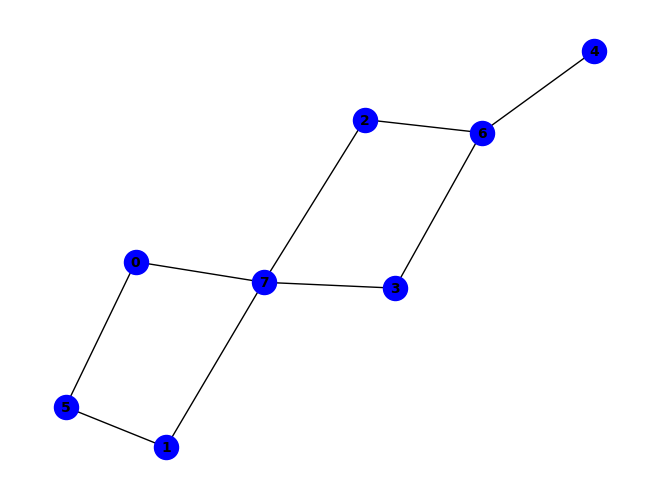


(~b & ~e) ^ (a & f & ~e) ^ (d & h & ~b) ^ (a & d & f & h) ^ (e & ~a & ~g) ^ (a & c & g & ~d) ^ (a & d & g & ~f) ^ (c & e & g & ~b) ^ (a & b & c & d & g) ^ (a & b & c & f & h) ^ (a & h & ~e & ~f) ^ (c & h & ~b & ~d) ^ (d & g & ~a & ~h) ^ (a & b & c & g & ~f) ^ (a & b & c & g & ~h) ^ (b & ~e & ~f & ~h) ^ (a & b & f & ~e & ~h) ^ (a & b & h & ~d & ~e) ^ (a & d & h & ~f & ~g) ^ (b & e & h & ~a & ~g) ^ (d & e & g & ~b & ~c) ^ (a & c & e & g & h & ~b) ^ (a & d & e & f & g & ~h) ^ (a & d & e & g & h & ~c) ^ (a & b & c & d & e & g & h) ^ (a & c & ~d & ~f & ~g) ^ (a & c & ~d & ~f & ~h) ^ (a & e & ~f & ~g & ~h) ^ (c & g & ~b & ~d & ~h) ^ (a & b & c & d & ~f & ~g) ^ (a & b & c & d & ~f & ~h) ^ (a & b & c & h & ~f & ~g) ^ (a & c & f & h & ~d & ~g) ^ (b & c & d & g & ~f & ~h) ^ (b & d & f & g & ~a & ~h) ^ (a & b & c & e & f & g & ~h) ^ (b & c & g & ~e & ~f & ~h) ^ (b & e & f & ~a & ~g & ~h) ^ (a & b & d & e & f & ~c & ~g) ^ (a & b & d & e & f & ~c & ~h) ^ (a & b & d & e & h & ~f & ~g) ^ (a & c & e 

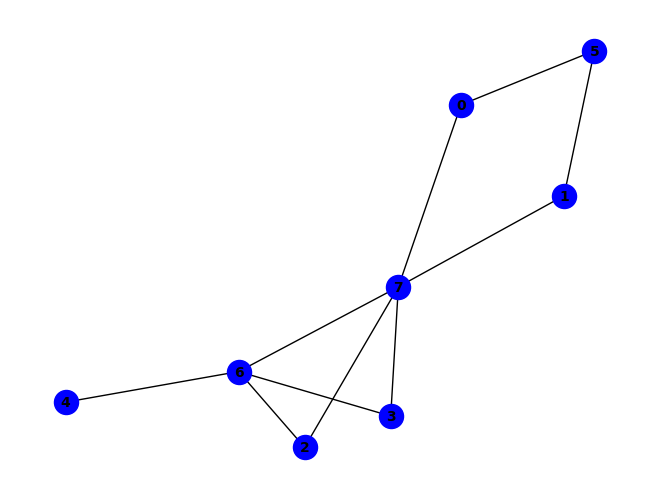


(c & g & ~e) ^ (c & h & ~e) ^ (d & g & ~c) ^ (d & h & ~c) ^ (e & ~d & ~h) ^ (a & c & g & ~d) ^ (a & c & h & ~d) ^ (a & d & g & ~b) ^ (a & d & h & ~b) ^ (a & e & f & ~h) ^ (b & c & g & ~d) ^ (b & c & h & ~d) ^ (b & d & g & ~e) ^ (b & d & h & ~e) ^ (d & e & ~g & ~h) ^ (e & h & ~c & ~g) ^ (a & e & f & h & ~g) ^ (b & ~d & ~f & ~h) ^ (g & ~a & ~b & ~h) ^ (a & c & d & ~f & ~h) ^ (a & c & g & ~f & ~h) ^ (b & e & f & ~a & ~h) ^ (a & b & c & f & g & ~d) ^ (a & b & c & f & h & ~d) ^ (a & b & d & e & f & ~g) ^ (a & b & d & e & f & ~h) ^ (b & c & e & f & g & ~h) ^ (~a & ~b & ~e & ~g) ^ (a & e & ~d & ~f & ~g) ^ (a & d & e & g & ~c & ~h) ^ (c & d & e & g & ~b & ~h) ^ (a & ~b & ~d & ~f & ~h) ^ (a & d & e & ~c & ~f & ~h) ^ (b & c & g & ~d & ~f & ~h) ^ (b & e & h & ~a & ~d & ~g) ^ (a & c & e & f & g & ~b & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & d & ~c & ~f & ~g & ~h) ^ (b & d & ~a & ~f & ~g & ~h) ^ (b & e & ~a & ~f & ~g & ~h) ^ (a & b & c & h & ~d & ~f & ~g) ^ (a & c & d & e & ~f & ~g & ~h) ^ (

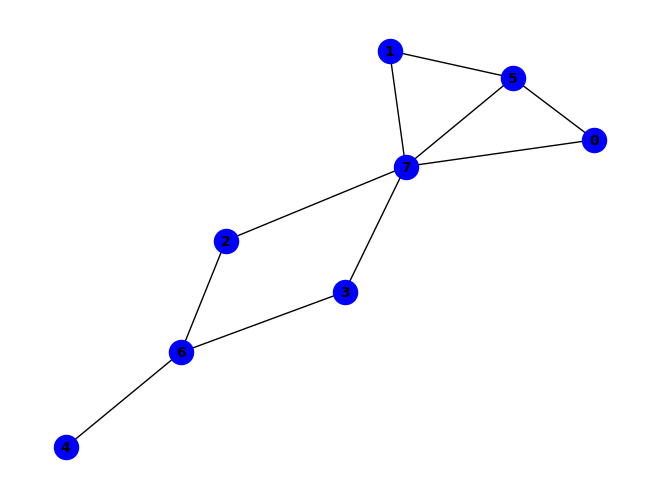


~f ^ (f & ~h) ^ (a & f & ~e) ^ (d & g & ~h) ^ (b & e & f & ~g) ^ (b & d & e & f & g) ^ (a & h & ~d & ~e) ^ (b & f & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & g & ~d & ~h) ^ (d & h & ~b & ~f) ^ (e & g & ~c & ~d) ^ (a & b & d & h & ~e) ^ (b & d & f & g & ~h) ^ (a & e & f & ~b & ~g) ^ (a & e & h & ~d & ~g) ^ (b & e & h & ~a & ~g) ^ (a & b & d & e & h & ~g) ^ (a & c & e & f & g & ~d) ^ (a & c & e & g & h & ~d) ^ (b & c & e & g & h & ~a) ^ (b & d & e & g & h & ~c) ^ (a & b & c & d & e & g & h) ^ (a & d & f & g & ~b & ~e) ^ (a & d & f & h & ~b & ~g) ^ (b & c & f & g & ~d & ~h) ^ (e & f & g & h & ~c & ~d) ^ (b & c & e & f & g & ~a & ~d) ^ (c & h & ~a & ~b & ~d & ~f) ^ (a & c & f & g & ~b & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


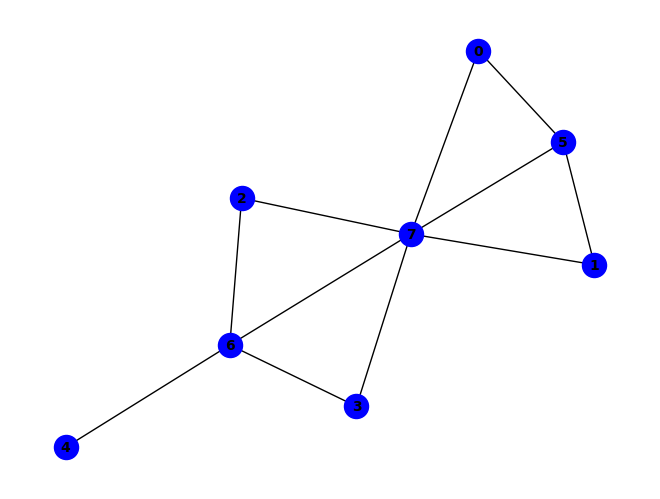


(g & ~h) ^ (~e & ~g) ^ (f & h & ~g) ^ (d & f & g & ~h) ^ (b & f & ~d & ~h) ^ (c & e & ~d & ~g) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~c & ~g) ^ (b & c & d & f & ~h) ^ (c & d & e & h & ~g) ^ (e & ~c & ~d & ~h) ^ (b & c & g & ~e & ~h) ^ (b & d & f & ~c & ~g) ^ (b & d & h & ~c & ~g) ^ (c & f & g & ~d & ~h) ^ (a & f & ~b & ~d & ~h) ^ (a & b & c & f & ~d & ~g) ^ (a & b & c & f & ~d & ~h) ^ (a & b & c & h & ~d & ~g) ^ (a & e & f & g & ~d & ~h) ^ (b & c & e & g & ~f & ~h) ^ (b & d & e & h & ~f & ~g) ^ (b & c & d & e & f & g & ~h) ^ (a & d & f & ~b & ~g & ~h) ^ (b & e & g & ~a & ~d & ~h) ^ (a & h & ~c & ~d & ~f & ~g) ^ (b & e & ~a & ~d & ~f & ~g) ^ (b & e & ~a & ~d & ~f & ~h) ^ (b & h & ~a & ~e & ~f & ~g) ^ (a & b & d & h & ~e & ~f & ~g) ^ (a & c & f & g & ~d & ~e & ~h) ^ (a & b & c & e & f & g & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

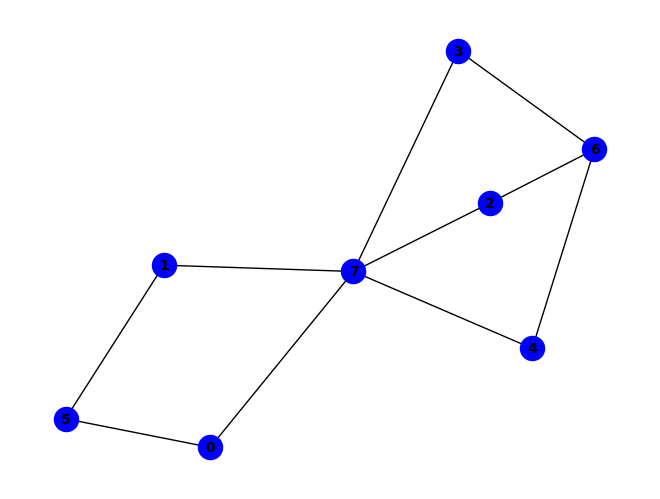


~d ^ (a & f & ~h) ^ (a & h & ~e) ^ (b & f & ~a) ^ (e & h & ~d) ^ (a & d & e & h) ^ (a & d & f & h) ^ (d & ~g & ~h) ^ (a & d & g & ~f) ^ (b & c & h & ~e) ^ (b & d & h & ~e) ^ (b & e & g & ~d) ^ (b & h & ~a & ~f) ^ (c & h & ~d & ~e) ^ (e & g & ~d & ~h) ^ (a & b & d & g & ~e) ^ (a & b & d & h & ~g) ^ (a & b & e & h & ~d) ^ (a & c & d & h & ~e) ^ (b & c & d & g & ~e) ^ (b & c & d & h & ~g) ^ (b & d & f & g & ~h) ^ (b & e & f & h & ~g) ^ (a & b & c & d & e & g) ^ (a & b & c & d & f & h) ^ (a & c & g & ~b & ~e) ^ (a & d & g & ~e & ~h) ^ (a & d & h & ~f & ~g) ^ (a & b & c & d & g & ~f) ^ (a & b & c & d & g & ~h) ^ (b & c & d & e & h & ~a) ^ (b & e & ~d & ~f & ~g) ^ (b & e & ~d & ~f & ~h) ^ (c & g & ~d & ~e & ~h) ^ (a & d & e & g & ~f & ~h) ^ (a & e & f & g & ~b & ~h) ^ (b & c & f & g & ~e & ~h) ^ (b & d & e & h & ~f & ~g) ^ (a & c & h & ~b & ~e & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (a & c & d & f & g & ~e & ~h) ^ (b & d & e & g & h & ~a & ~c) ^ (a & b & d & g & ~e & ~f & ~h) ^ (b & c & d &

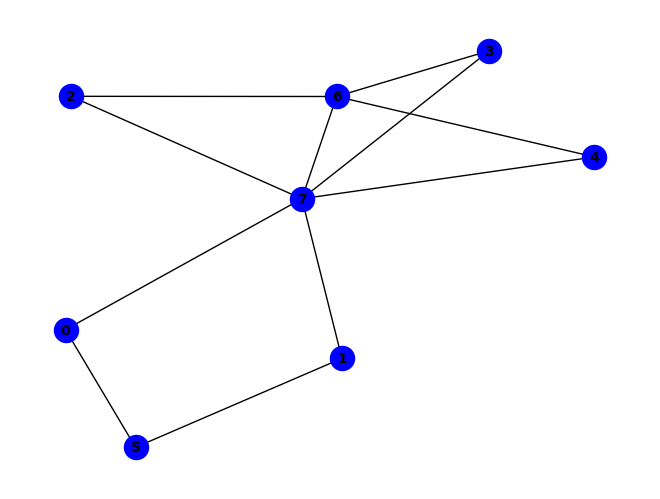


(c & g & ~d) ^ (e & g & ~c) ^ (e & h & ~b) ^ (c & d & e & g) ^ (a & e & g & ~d) ^ (b & e & g & ~a) ^ (a & b & c & e & g) ^ (a & b & c & e & h) ^ (a & b & c & f & g) ^ (a & b & c & f & h) ^ (a & b & d & e & g) ^ (~a & ~b & ~g) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (a & d & f & g & ~b) ^ (a & d & f & h & ~b) ^ (a & ~e & ~f & ~h) ^ (g & ~a & ~b & ~h) ^ (a & c & g & ~d & ~e) ^ (a & c & h & ~d & ~e) ^ (a & e & h & ~b & ~d) ^ (b & c & g & ~d & ~e) ^ (a & b & c & d & g & ~e) ^ (a & b & c & d & h & ~e) ^ (c & h & ~b & ~d & ~e) ^ (a & b & c & h & ~f & ~g) ^ (b & ~a & ~e & ~f & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (a & d & e & ~c & ~f & ~h) ^ (a & d & h & ~b & ~f & ~g) ^ (b & c & g & ~e & ~f & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & e & ~d & ~f & ~g & ~h) ^ (b & e & ~a & ~f & ~g & ~h) ^ (a & c & d & e & ~f & ~g & ~h) ^ (a & c & d & g & ~b & ~f & ~h) ^ (b & d & g & ~c & ~e & ~f & ~h) ^ (a & b & c & e & g & ~d & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

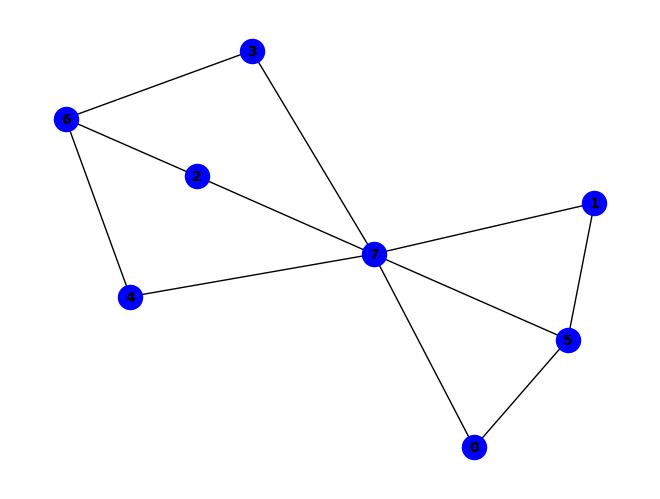


~f ^ (f & ~h) ^ (a & f & ~e) ^ (a & h & ~e) ^ (b & h & ~a) ^ (e & g & ~h) ^ (a & b & e & h) ^ (b & e & f & h) ^ (b & f & ~a & ~e) ^ (d & g & ~e & ~h) ^ (e & h & ~b & ~f) ^ (a & c & d & h & ~e) ^ (b & e & f & ~g & ~h) ^ (a & c & d & f & g & ~e) ^ (c & g & ~d & ~e & ~h) ^ (b & c & f & g & ~e & ~h) ^ (a & c & h & ~b & ~e & ~f) ^ (a & e & f & ~b & ~g & ~h) ^ (a & b & c & d & h & ~e & ~f) ^ (a & c & d & f & h & ~e & ~g) ^ (c & h & ~b & ~d & ~e & ~f) ^ (d & h & ~a & ~b & ~e & ~f) ^ (a & c & f & g & ~b & ~e & ~h) ^ (a & d & f & g & ~b & ~e & ~h) ^ (b & d & f & g & ~c & ~e & ~h) ^ (a & b & c & d & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


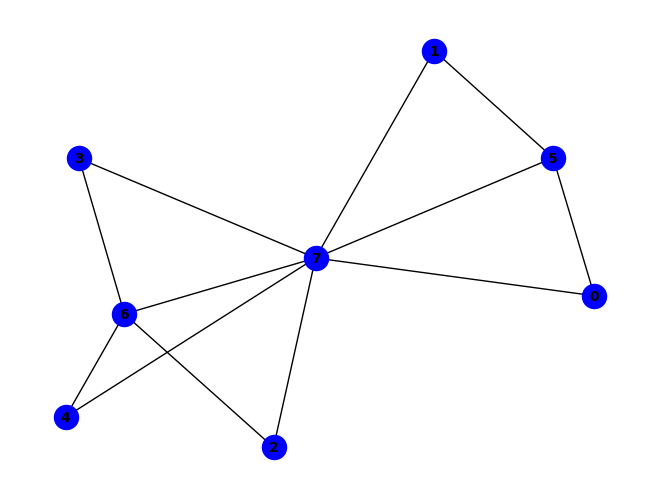


~g ^ (g & ~h) ^ (f & h & ~g) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & e & f & ~g & ~h) ^ (b & c & f & ~e & ~g) ^ (b & c & h & ~e & ~g) ^ (b & d & h & ~e & ~g) ^ (c & f & g & ~d & ~h) ^ (e & f & g & ~c & ~h) ^ (c & d & e & f & g & ~h) ^ (b & c & d & h & ~a & ~g) ^ (c & d & e & g & ~b & ~f) ^ (c & d & e & h & ~b & ~f) ^ (a & b & c & d & e & h & ~g) ^ (b & c & d & e & f & h & ~g) ^ (a & c & f & ~b & ~e & ~g) ^ (a & c & h & ~b & ~e & ~g) ^ (b & d & f & ~c & ~e & ~g) ^ (b & e & f & ~a & ~g & ~h) ^ (d & f & g & ~a & ~e & ~h) ^ (a & b & c & d & f & ~e & ~g) ^ (a & b & c & d & f & ~e & ~h) ^ (a & b & d & f & g & ~e & ~h) ^ (a & c & d & f & g & ~e & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (a & f & ~b & ~c & ~e & ~h) ^ (a & h & ~d & ~e & ~f & ~g) ^ (b & f & ~c & ~d & ~e & ~h) ^ (b & h & ~a & ~e & ~f & ~g) ^ (a & b & d & h & ~e & ~f & ~g) ^ (a & c & d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

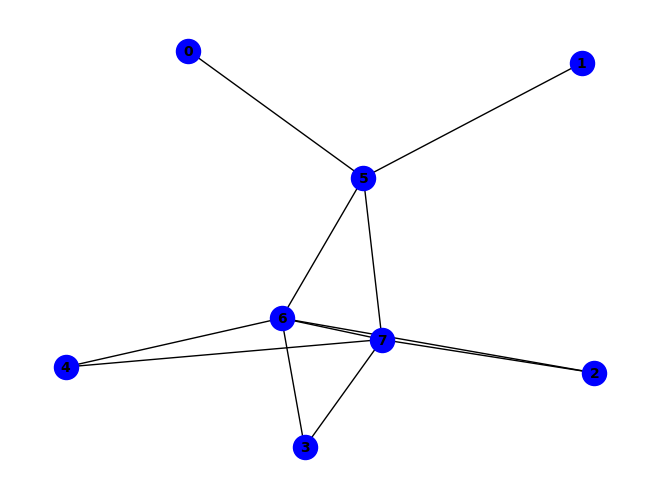


~g ^ (f & h) ^ (b & f & ~h) ^ (c & g & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~c) ^ (c & e & f & g) ^ (g & ~b & ~h) ^ (b & g & ~f & ~h) ^ (c & h & ~e & ~f) ^ (a & f & ~b & ~g & ~h) ^ (d & g & ~c & ~e & ~f) ^ (d & h & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


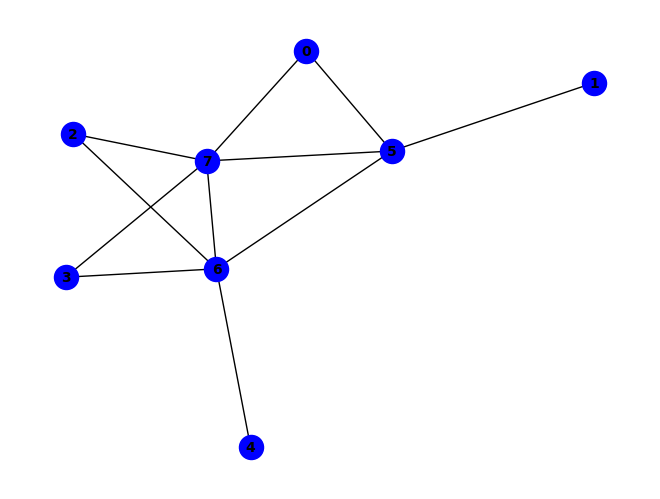


(f & g) ^ (f & h) ^ (g & ~h) ^ (~e & ~g) ^ (a & f & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (a & h & ~d & ~g) ^ (c & e & ~f & ~g) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & f & ~g & ~h) ^ (e & h & ~c & ~g) ^ (a & d & f & h & ~g) ^ (c & e & f & h & ~g) ^ (e & ~c & ~f & ~h) ^ (b & f & ~a & ~g & ~h) ^ (a & c & h & ~d & ~f & ~g) ^ (d & e & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


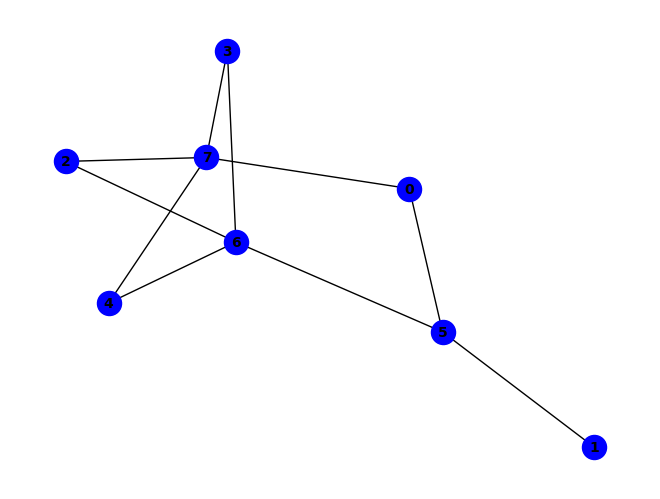


(e & f & g) ^ (~b & ~f) ^ (c & h & ~e) ^ (e & h & ~b) ^ (b & ~a & ~g) ^ (f & ~a & ~g) ^ (b & e & g & ~d) ^ (c & f & g & ~e) ^ (b & d & e & f & h) ^ (a & b & ~f & ~g) ^ (b & g & ~e & ~f) ^ (c & g & ~e & ~h) ^ (d & h & ~c & ~e) ^ (e & g & ~b & ~h) ^ (b & d & e & g & ~h) ^ (b & e & h & ~c & ~f) ^ (d & f & g & ~c & ~e) ^ (b & d & e & g & h & ~f) ^ (d & g & ~c & ~e & ~h) ^ (a & e & f & h & ~b & ~g) ^ (b & c & e & g & ~d & ~f) ^ (b & c & e & h & ~d & ~g) ^ (b & c & f & h & ~a & ~g) ^ (b & d & f & h & ~c & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & c & d & f & h & ~g) ^ (a & b & c & e & f & h & ~g) ^ (b & e & g & ~c & ~f & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (b & c & d & e & h & ~a & ~f) ^ (a & b & c & d & e & g & h & ~f) ^ (a & h & ~c & ~d & ~e & ~f) ^ (a & c & f & h & ~d & ~e & ~g) ^ (a & d & f & h & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

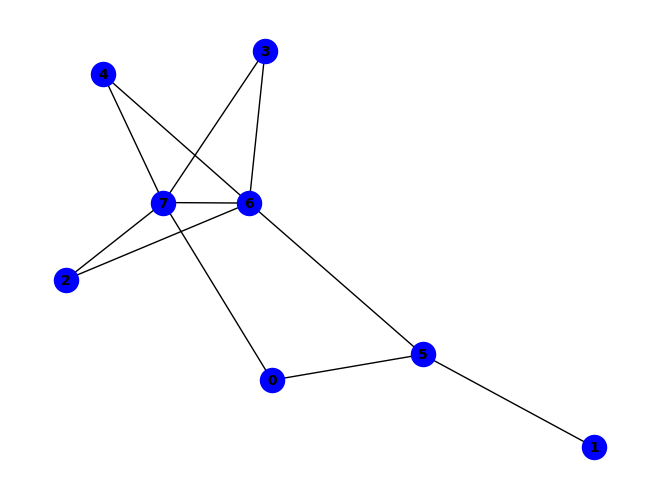


(g & ~h) ^ (~f & ~g) ^ (e & g & ~d) ^ (e & h & ~d) ^ (f & ~e & ~h) ^ (a & f & ~g & ~h) ^ (b & f & ~a & ~g) ^ (c & g & ~d & ~e) ^ (c & h & ~d & ~e) ^ (d & g & ~b & ~f) ^ (d & h & ~b & ~f) ^ (e & f & ~g & ~h) ^ (f & h & ~d & ~g) ^ (d & e & f & g & ~h) ^ (a & b & e & f & h & ~g) ^ (a & b & d & g & ~e & ~f) ^ (a & b & d & h & ~e & ~f) ^ (b & c & f & h & ~d & ~g) ^ (b & d & e & h & ~f & ~g) ^ (b & e & f & h & ~c & ~g) ^ (b & c & d & e & f & h & ~g) ^ (b & d & g & ~a & ~f & ~h) ^ (b & d & h & ~a & ~e & ~g) ^ (c & f & g & ~d & ~e & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & h & ~c & ~d & ~e & ~g) ^ (a & b & c & f & h & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


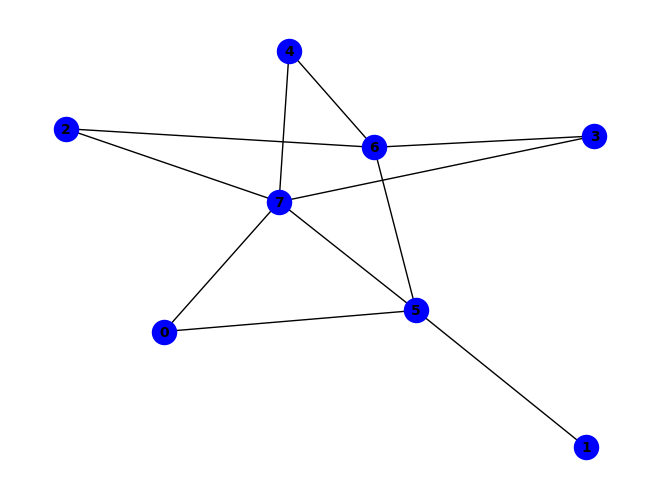


~e ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (b & f & ~g & ~h) ^ (d & h & ~e & ~f) ^ (f & g & ~e & ~h) ^ (c & d & e & g & ~f) ^ (c & d & g & ~f & ~h) ^ (c & d & h & ~a & ~f) ^ (a & c & d & e & h & ~f) ^ (a & f & ~b & ~g & ~h) ^ (a & h & ~d & ~e & ~f) ^ (c & g & ~e & ~f & ~h) ^ (c & h & ~a & ~e & ~f) ^ (d & g & ~e & ~f & ~h) ^ (c & d & e & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


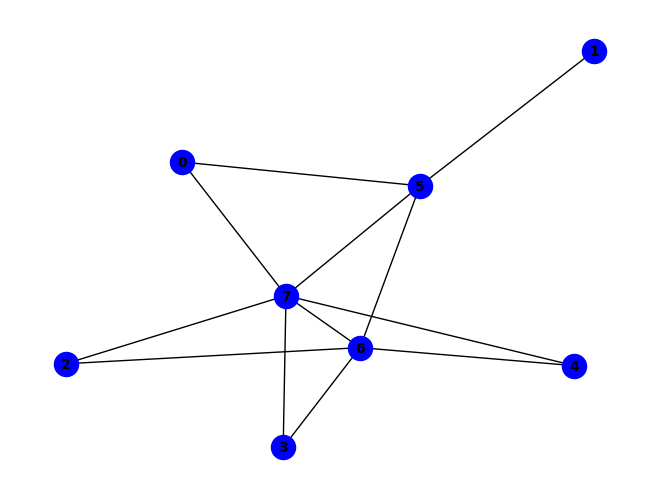


~g ^ (f & h) ^ (a & f & ~g) ^ (b & f & ~h) ^ (c & g & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~c) ^ (g & ~b & ~h) ^ (a & h & ~e & ~g) ^ (b & g & ~f & ~h) ^ (c & h & ~e & ~f) ^ (a & d & e & h & ~g) ^ (c & e & f & g & ~a) ^ (a & c & d & e & f & g) ^ (a & b & f & ~g & ~h) ^ (a & d & h & ~f & ~g) ^ (a & c & e & f & h & ~d) ^ (d & g & ~c & ~e & ~f) ^ (d & h & ~c & ~e & ~f) ^ (a & c & e & h & ~d & ~g) ^ (a & e & f & h & ~d & ~g) ^ (a & c & h & ~d & ~f & ~g) ^ (a & c & e & f & g & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


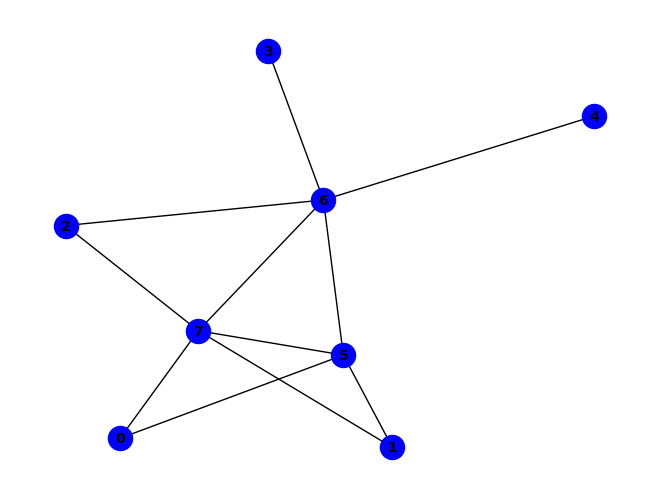


(f & g) ^ (f & h) ^ (~e & ~g) ^ (a & f & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (e & h & ~g) ^ (e & ~f & ~h) ^ (g & ~d & ~h) ^ (d & f & g & ~h) ^ (a & h & ~c & ~g) ^ (b & f & ~a & ~g) ^ (a & c & f & h & ~g) ^ (c & d & g & ~f & ~h) ^ (c & e & f & ~d & ~h) ^ (c & e & g & ~d & ~h) ^ (d & e & g & ~f & ~h) ^ (b & h & ~a & ~c & ~g) ^ (e & f & ~c & ~g & ~h) ^ (b & c & f & h & ~a & ~g) ^ (c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


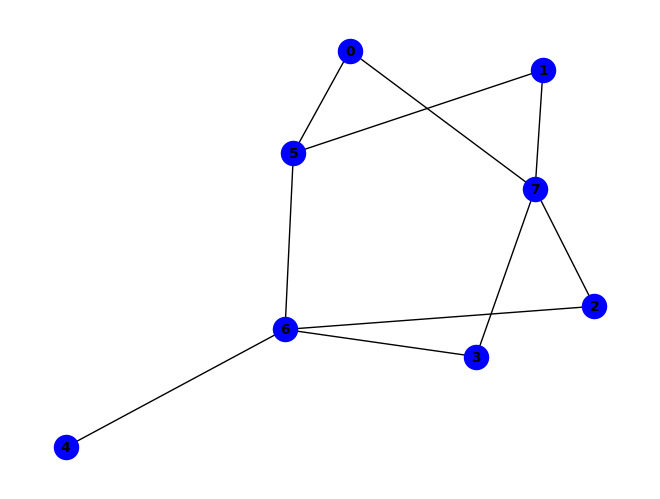


(~b & ~f) ^ (c & g & ~h) ^ (c & h & ~d) ^ (d & h & ~b) ^ (b & ~f & ~h) ^ (f & ~b & ~g) ^ (c & f & g & ~d) ^ (d & e & g & ~c) ^ (d & f & g & ~e) ^ (b & d & f & g & h) ^ (c & d & e & f & g) ^ (d & g & ~c & ~h) ^ (e & g & ~c & ~f) ^ (b & c & h & ~d & ~f) ^ (a & f & ~b & ~e & ~g) ^ (a & c & f & h & ~d & ~g) ^ (a & e & f & h & ~b & ~d) ^ (a & e & g & h & ~b & ~d) ^ (b & e & g & h & ~d & ~f) ^ (a & e & f & ~b & ~g & ~h) ^ (a & c & e & g & h & ~d & ~f) ^ (b & c & e & f & h & ~a & ~d) ^ (b & c & e & g & h & ~a & ~d) ^ (a & h & ~b & ~c & ~d & ~f) ^ (a & d & f & h & ~b & ~e & ~g) ^ (b & c & f & h & ~a & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


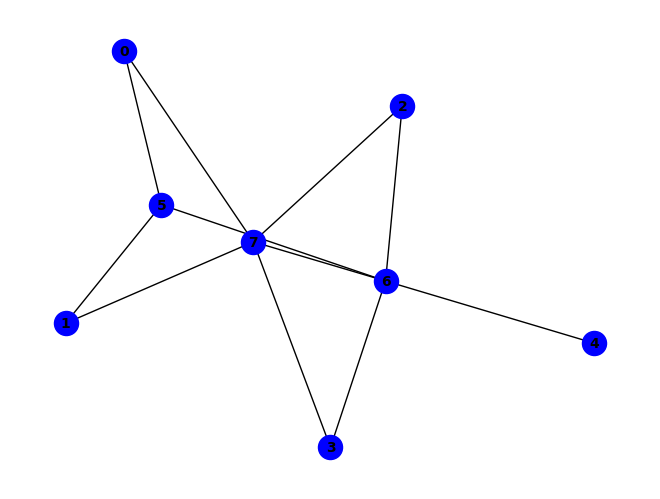


(~f & ~g) ^ (c & g & ~d) ^ (c & h & ~d) ^ (d & g & ~e) ^ (d & h & ~e) ^ (f & h & ~g) ^ (f & ~e & ~h) ^ (g & ~e & ~h) ^ (a & f & ~g & ~h) ^ (e & f & ~g & ~h) ^ (c & e & g & ~d & ~h) ^ (c & f & g & ~e & ~h) ^ (d & e & f & ~c & ~g) ^ (d & e & f & ~c & ~h) ^ (d & e & h & ~f & ~g) ^ (d & f & g & ~c & ~h) ^ (c & d & e & f & h & ~g) ^ (a & h & ~c & ~d & ~g) ^ (b & f & ~a & ~g & ~h) ^ (b & h & ~a & ~c & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


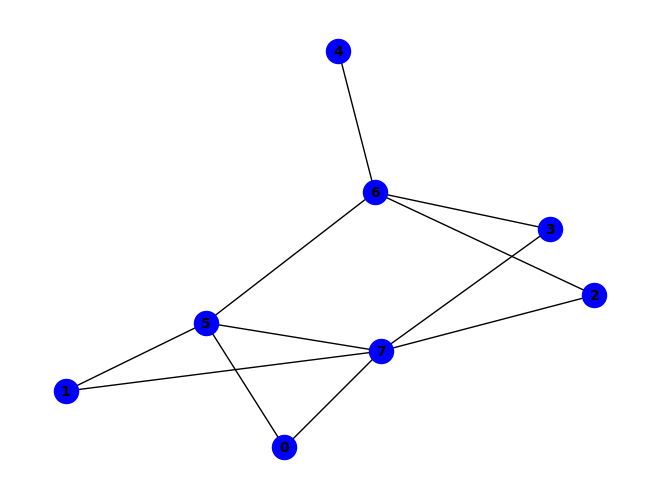


~e ^ (f & h) ^ (e & f & g) ^ (d & e & ~f) ^ (f & g & ~h) ^ (e & ~d & ~g) ^ (b & f & ~g & ~h) ^ (c & g & ~f & ~h) ^ (c & h & ~b & ~f) ^ (d & h & ~c & ~f) ^ (b & c & d & h & ~f) ^ (c & e & g & ~d & ~f) ^ (d & e & f & ~b & ~g) ^ (b & d & e & f & h & ~c) ^ (b & d & e & g & h & ~c) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (a & f & ~b & ~g & ~h) ^ (a & h & ~c & ~d & ~f) ^ (b & h & ~a & ~d & ~f) ^ (d & g & ~c & ~f & ~h) ^ (a & b & c & h & ~d & ~f) ^ (b & e & g & h & ~c & ~f) ^ (a & b & c & e & g & h & ~f) ^ (a & b & e & g & h & ~d & ~f) ^ (b & c & d & e & f & ~a & ~g) ^ (a & e & g & h & ~c & ~d & ~f) ^ (b & d & e & f & ~c & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


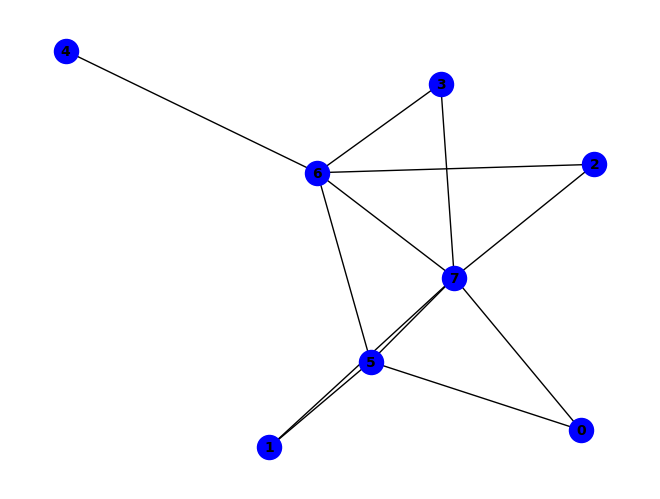


(f & g) ^ (f & h) ^ (g & ~h) ^ (~e & ~g) ^ (b & f & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (a & f & ~b & ~g) ^ (b & h & ~d & ~g) ^ (c & e & ~f & ~g) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & f & ~g & ~h) ^ (e & h & ~c & ~g) ^ (c & e & f & h & ~g) ^ (e & ~c & ~f & ~h) ^ (a & h & ~b & ~d & ~g) ^ (a & c & d & h & ~b & ~g) ^ (a & d & f & h & ~c & ~g) ^ (b & d & f & h & ~a & ~g) ^ (a & b & c & d & f & h & ~g) ^ (a & c & h & ~b & ~f & ~g) ^ (b & c & h & ~d & ~f & ~g) ^ (d & e & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


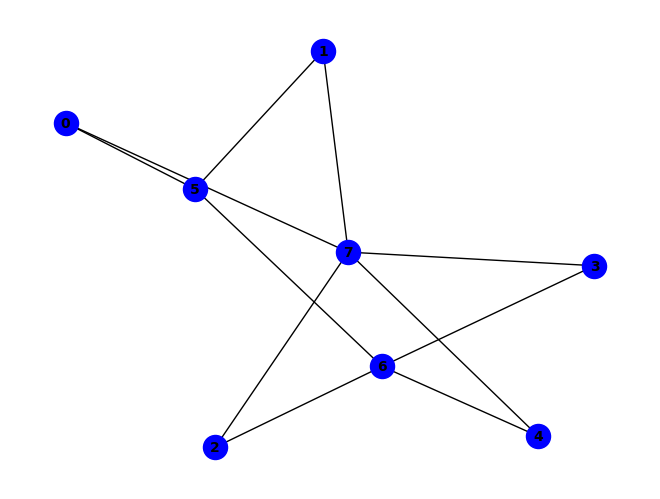


(e & f & g) ^ (~b & ~f) ^ (c & h & ~e) ^ (e & g & ~h) ^ (e & h & ~b) ^ (b & ~f & ~h) ^ (f & ~b & ~g) ^ (c & f & g & ~e) ^ (b & e & f & g & h) ^ (c & g & ~e & ~h) ^ (d & h & ~c & ~e) ^ (b & d & h & ~e & ~f) ^ (d & f & g & ~c & ~e) ^ (a & f & ~b & ~e & ~g) ^ (d & g & ~c & ~e & ~h) ^ (a & e & f & ~b & ~g & ~h) ^ (b & c & h & ~d & ~e & ~f) ^ (a & c & f & h & ~d & ~e & ~g) ^ (a & d & f & h & ~b & ~e & ~g) ^ (b & c & f & h & ~a & ~e & ~g) ^ (b & d & f & h & ~c & ~e & ~g) ^ (a & b & c & d & f & h & ~e & ~g) ^ (a & h & ~b & ~c & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


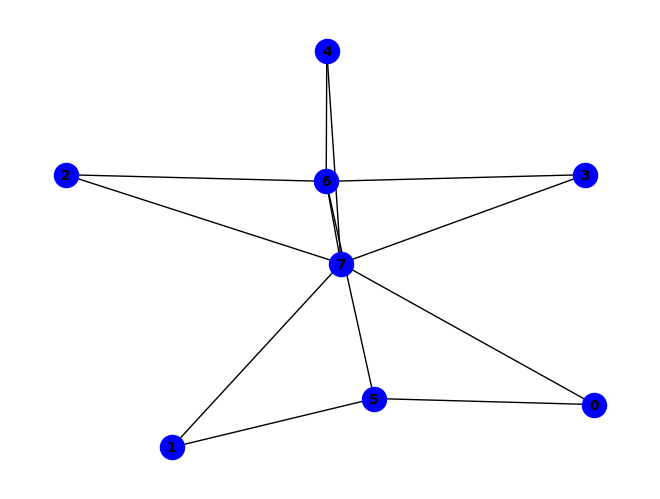


(g & ~h) ^ (~f & ~g) ^ (d & g & ~f) ^ (d & h & ~f) ^ (e & g & ~d) ^ (e & h & ~d) ^ (f & ~e & ~h) ^ (b & f & ~g & ~h) ^ (c & g & ~d & ~e) ^ (c & h & ~d & ~e) ^ (e & f & ~g & ~h) ^ (f & h & ~d & ~g) ^ (d & e & f & g & ~h) ^ (a & f & ~b & ~g & ~h) ^ (c & f & g & ~d & ~e & ~h) ^ (b & h & ~c & ~d & ~e & ~g) ^ (a & h & ~b & ~c & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


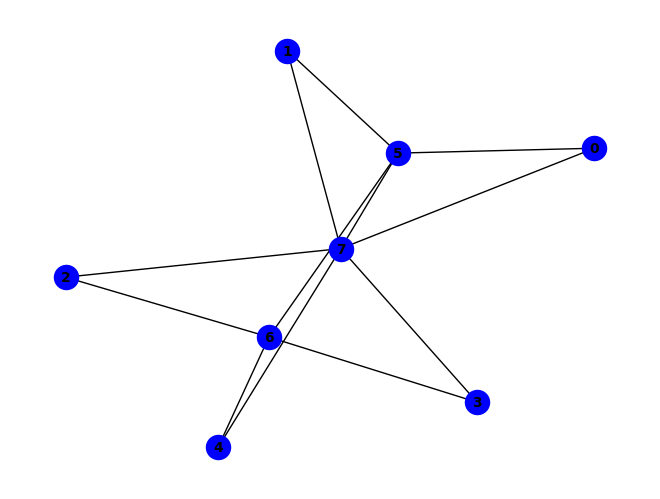


~e ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (b & f & ~g & ~h) ^ (d & h & ~e & ~f) ^ (f & g & ~e & ~h) ^ (c & d & e & g & ~f) ^ (c & d & g & ~f & ~h) ^ (c & d & h & ~b & ~f) ^ (b & c & d & e & h & ~f) ^ (a & f & ~b & ~g & ~h) ^ (c & g & ~e & ~f & ~h) ^ (c & h & ~b & ~e & ~f) ^ (d & g & ~e & ~f & ~h) ^ (c & d & e & h & ~f & ~g) ^ (a & h & ~c & ~d & ~e & ~f) ^ (b & h & ~a & ~d & ~e & ~f) ^ (a & b & c & h & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


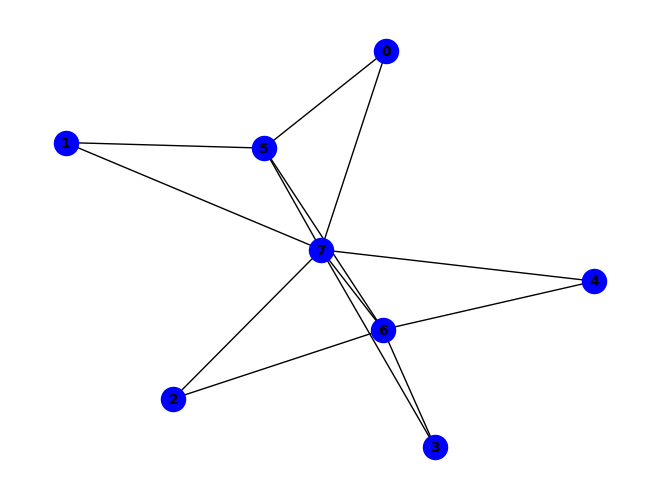


~g ^ (f & h) ^ (a & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & g & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~c) ^ (g & ~b & ~h) ^ (b & e & g & ~h) ^ (b & f & ~a & ~g) ^ (c & h & ~e & ~f) ^ (b & e & f & h & ~g) ^ (c & e & f & g & ~b) ^ (b & c & e & f & h & ~d) ^ (a & b & c & d & e & f & h) ^ (a & h & ~b & ~e & ~g) ^ (d & g & ~c & ~e & ~f) ^ (d & h & ~c & ~e & ~f) ^ (a & e & f & h & ~b & ~g) ^ (b & c & e & h & ~d & ~g) ^ (a & b & c & d & e & h & ~g) ^ (b & c & d & e & f & g & ~a) ^ (a & d & h & ~e & ~f & ~g) ^ (b & c & h & ~d & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (b & c & e & f & g & ~d & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & b & c & h & ~e & ~f & ~g) ^ (a & c & h & ~d & ~e & ~f & ~g) ^ (b & d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


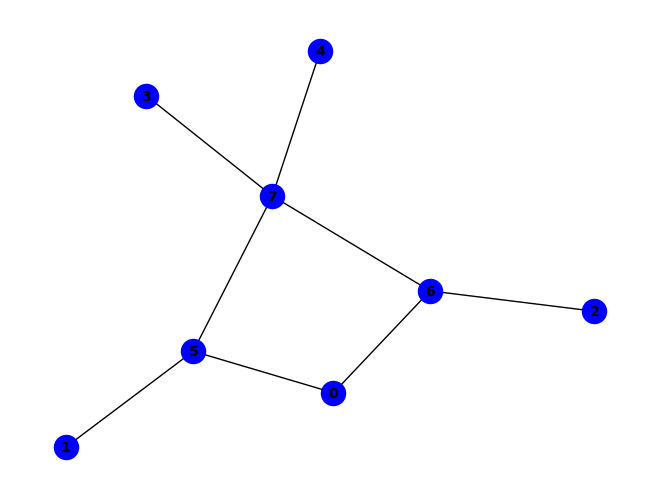


(~c & ~g) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~b & ~h) ^ (g & ~a & ~h) ^ (a & f & ~g & ~h) ^ (b & f & ~a & ~h) ^ (e & h & ~f & ~g) ^ (a & c & g & ~b & ~h) ^ (b & c & f & ~g & ~h) ^ (b & c & ~a & ~f & ~h) ^ (d & h & ~e & ~f & ~g) ^ (a & b & c & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


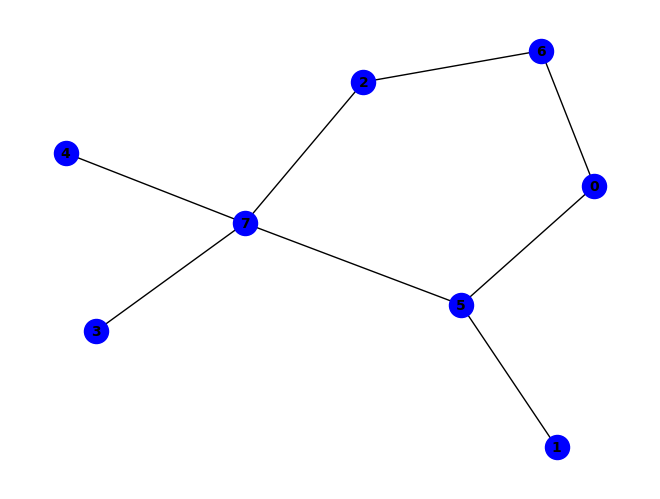


(a & c & g) ^ (~b & ~f) ^ (a & g & ~f) ^ (b & h & ~f) ^ (c & g & ~h) ^ (e & h & ~f) ^ (b & ~c & ~h) ^ (f & ~a & ~h) ^ (a & b & f & ~h) ^ (b & c & ~g & ~h) ^ (d & h & ~e & ~f) ^ (b & c & g & ~f & ~h) ^ (a & b & c & f & g & ~h) ^ (a & c & e & g & h & ~d) ^ (a & c & f & g & h & ~e) ^ (a & c & d & e & f & g & h) ^ (c & h & ~d & ~e & ~f) ^ (a & d & g & h & ~c & ~f) ^ (a & e & g & h & ~d & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


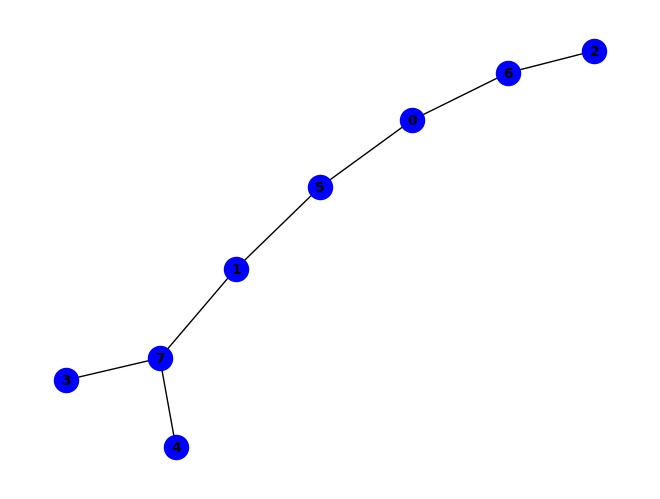


~e ^ (a & f & ~g) ^ (a & g & ~e) ^ (b & h & ~e) ^ (c & g & ~a) ^ (e & ~a & ~h) ^ (a & b & f & ~e) ^ (a & e & ~g & ~h) ^ (b & f & ~c & ~h) ^ (d & h & ~b & ~e) ^ (a & b & g & h & ~f) ^ (a & e & f & h & ~g) ^ (c & e & g & h & ~a) ^ (a & b & d & e & f & h) ^ (b & c & f & ~g & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & c & g & h & ~d) ^ (a & b & d & f & h & ~g) ^ (a & b & e & f & g & ~d) ^ (a & b & e & g & h & ~c) ^ (a & b & c & d & e & g & h) ^ (a & b & e & f & ~g & ~h) ^ (a & d & f & h & ~e & ~g) ^ (a & d & g & h & ~b & ~e) ^ (b & c & g & h & ~d & ~e) ^ (c & d & g & h & ~a & ~e) ^ (a & b & d & e & f & g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


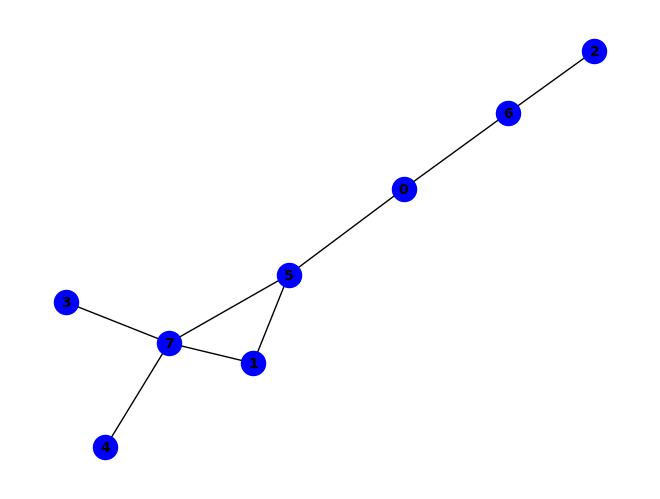


(~a & ~f) ^ (c & g & ~a) ^ (e & h & ~f) ^ (f & ~a & ~h) ^ (a & c & f & g & h) ^ (b & f & ~a & ~e) ^ (b & h & ~a & ~e) ^ (b & c & f & g & ~a) ^ (c & d & g & h & ~e) ^ (c & e & g & h & ~f) ^ (c & f & g & h & ~d) ^ (c & d & e & f & g & h) ^ (a & ~b & ~f & ~g) ^ (b & e & f & ~a & ~h) ^ (a & b & ~f & ~g & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & b & e & h & ~f & ~g) ^ (a & e & g & h & ~c & ~f) ^ (b & c & g & h & ~a & ~e) ^ (b & c & e & f & g & h & ~a) ^ (b & c & d & g & h & ~e & ~f) ^ (a & d & g & h & ~b & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


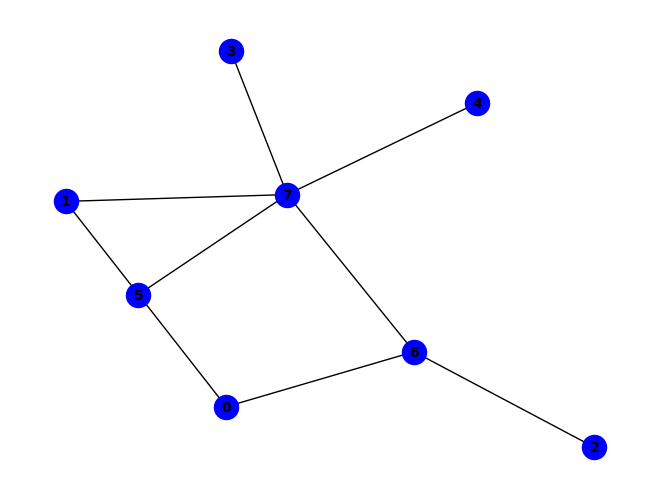


(~c & ~g) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~b & ~h) ^ (g & ~a & ~h) ^ (a & b & f & ~h) ^ (b & e & f & ~g) ^ (a & f & ~g & ~h) ^ (b & c & ~g & ~h) ^ (b & f & ~e & ~h) ^ (e & h & ~f & ~g) ^ (b & e & f & g & ~h) ^ (a & c & g & ~b & ~h) ^ (b & e & h & ~d & ~g) ^ (b & d & e & f & h & ~g) ^ (b & h & ~d & ~f & ~g) ^ (d & h & ~e & ~f & ~g) ^ (b & c & g & ~a & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


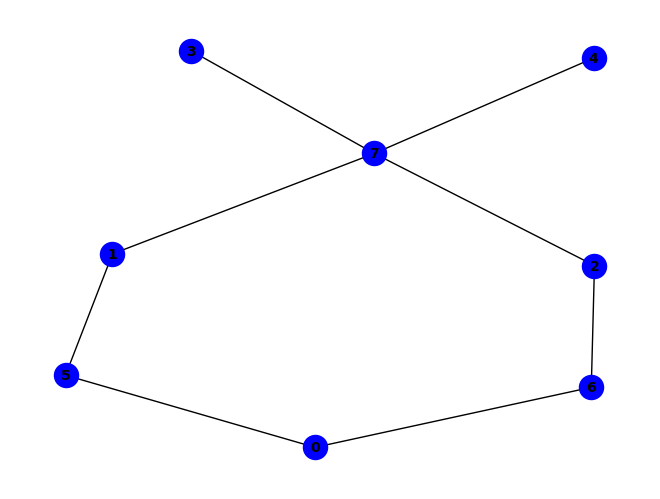


~e ^ (e & ~h) ^ (a & f & ~g) ^ (a & g & ~c) ^ (b & f & ~a) ^ (d & h & ~e) ^ (b & c & h & ~e) ^ (b & d & h & ~c) ^ (b & e & h & ~d) ^ (b & h & ~a & ~f) ^ (c & g & ~b & ~h) ^ (c & h & ~d & ~e) ^ (a & b & c & h & ~f) ^ (a & b & c & h & ~g) ^ (a & d & g & h & ~c) ^ (a & e & g & h & ~d) ^ (a & b & c & d & g & h) ^ (a & b & c & e & g & h) ^ (a & b & h & ~f & ~g) ^ (b & c & g & ~f & ~h) ^ (a & b & c & f & g & ~e) ^ (a & b & d & g & h & ~e) ^ (a & b & e & f & h & ~d) ^ (a & b & e & g & h & ~f) ^ (b & c & d & e & h & ~a) ^ (a & b & c & d & e & f & g) ^ (a & b & d & e & f & g & h) ^ (a & c & f & h & ~d & ~g) ^ (a & d & f & h & ~b & ~g) ^ (a & e & f & h & ~d & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & c & d & f & h & ~g) ^ (a & c & e & f & h & ~b & ~d) ^ (a & c & e & g & h & ~d & ~f) ^ (a & b & c & e & f & g & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


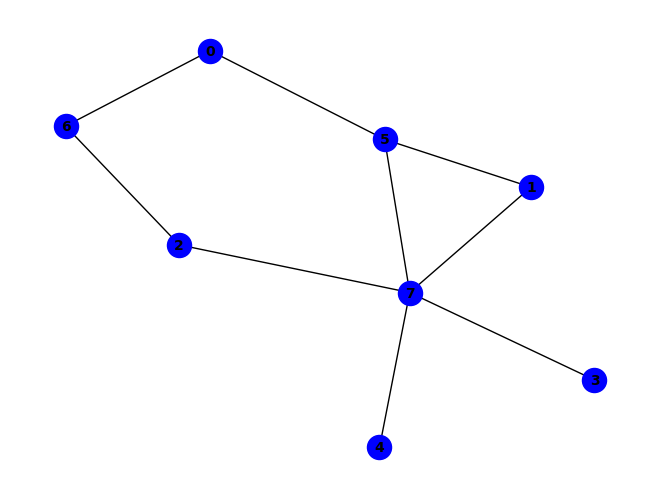


(a & c & g) ^ (~a & ~f) ^ (b & f & ~e) ^ (b & h & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (f & ~a & ~h) ^ (a & b & h & ~f) ^ (b & e & f & ~h) ^ (a & b & c & f & g) ^ (a & b & d & f & g) ^ (a & c & f & g & h) ^ (b & c & f & g & ~h) ^ (a & ~b & ~f & ~g) ^ (a & b & f & ~d & ~h) ^ (a & b & c & g & h & ~e) ^ (a & b & d & g & h & ~e) ^ (a & b & e & g & h & ~f) ^ (a & b & c & d & e & g & h) ^ (a & b & d & e & f & g & h) ^ (a & b & ~f & ~g & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & b & d & f & ~g & ~h) ^ (a & d & g & h & ~c & ~f) ^ (a & b & c & d & g & h & ~f) ^ (a & b & c & e & f & g & h & ~d) ^ (c & h & ~b & ~d & ~e & ~f) ^ (a & e & g & h & ~c & ~d & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


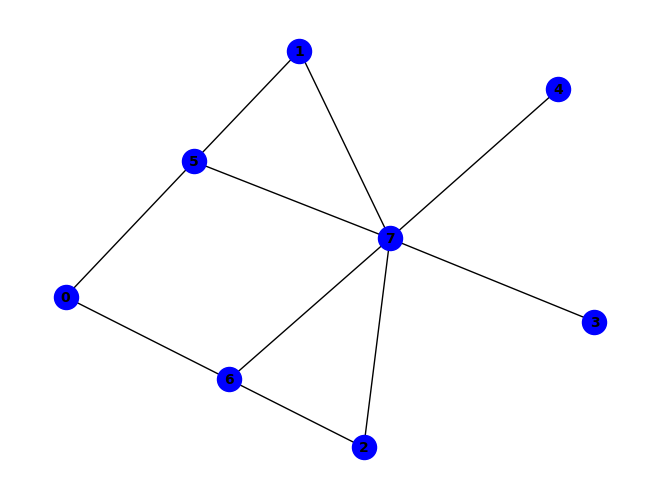


(g & ~h) ^ (~a & ~g) ^ (a & h & ~g) ^ (f & h & ~g) ^ (a & ~f & ~h) ^ (a & b & f & ~h) ^ (a & f & g & ~h) ^ (b & e & f & ~g) ^ (b & f & ~e & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & h & ~f & ~g) ^ (b & c & e & g & ~f) ^ (b & c & e & h & ~f) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (a & c & g & ~b & ~h) ^ (b & c & g & ~e & ~h) ^ (b & e & h & ~d & ~g) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (b & c & d & e & h & ~g) ^ (b & d & e & f & g & ~c) ^ (b & d & e & f & h & ~c) ^ (c & d & e & f & g & ~h) ^ (b & h & ~d & ~f & ~g) ^ (d & h & ~e & ~f & ~g) ^ (a & b & c & g & ~f & ~h) ^ (c & d & h & ~b & ~f & ~g) ^ (b & e & f & g & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


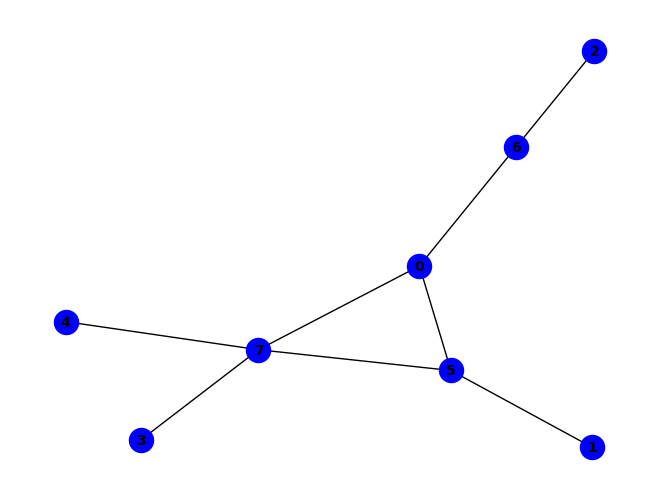


(f & ~h) ^ (~b & ~f) ^ (a & g & ~h) ^ (a & h & ~e) ^ (c & g & ~a) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (a & b & ~c & ~f) ^ (a & f & ~c & ~g) ^ (b & c & ~f & ~h) ^ (b & h & ~a & ~f) ^ (a & b & c & h & ~f) ^ (a & c & f & h & ~e) ^ (c & d & g & h & ~e) ^ (c & e & g & h & ~f) ^ (c & f & g & h & ~d) ^ (a & c & d & e & f & h) ^ (c & d & e & f & g & h) ^ (b & ~a & ~c & ~h) ^ (a & c & d & g & h & ~f) ^ (a & c & e & g & h & ~d) ^ (d & h & ~a & ~e & ~f) ^ (a & c & e & f & ~d & ~g) ^ (a & c & f & ~e & ~g & ~h) ^ (b & c & f & ~a & ~g & ~h) ^ (a & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


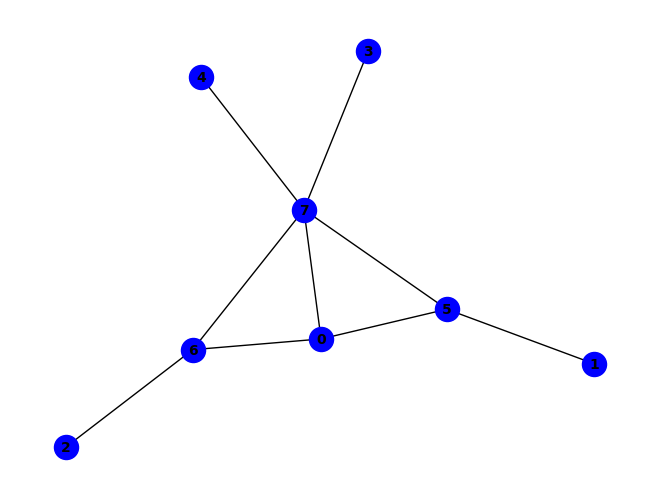


(g & ~h) ^ (~c & ~g) ^ (a & f & ~e) ^ (a & g & ~f) ^ (a & h & ~e) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~b & ~h) ^ (a & e & f & ~h) ^ (b & f & ~a & ~h) ^ (e & h & ~f & ~g) ^ (a & e & g & h & ~f) ^ (a & c & g & ~b & ~h) ^ (b & c & f & ~g & ~h) ^ (b & c & ~a & ~f & ~h) ^ (a & b & c & ~f & ~g & ~h) ^ (d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


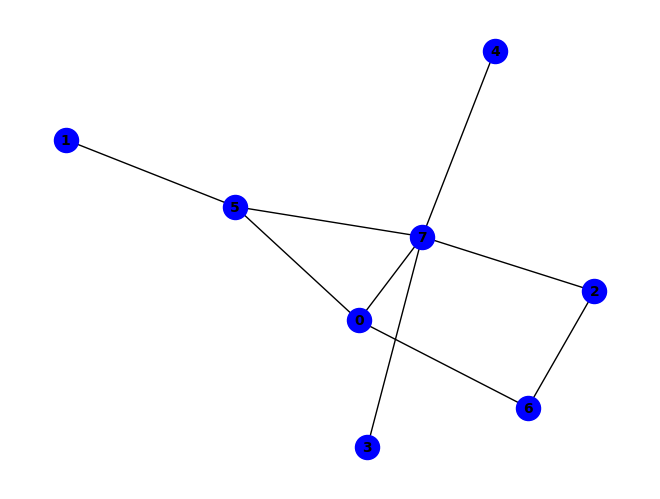


(f & ~h) ^ (a & c & g) ^ (~b & ~f) ^ (a & f & ~g) ^ (a & g & ~h) ^ (a & h & ~e) ^ (b & h & ~f) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (b & ~c & ~h) ^ (a & c & h & ~g) ^ (a & c & d & h & ~e) ^ (a & c & e & h & ~f) ^ (a & c & f & h & ~d) ^ (a & c & d & e & f & h) ^ (a & b & f & ~c & ~h) ^ (b & c & g & ~f & ~h) ^ (b & c & ~a & ~g & ~h) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (a & b & c & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


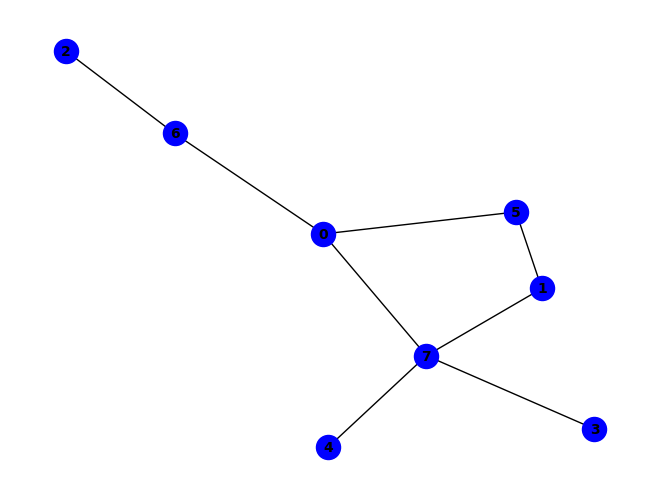


~e ^ (a & e & ~d) ^ (a & f & ~h) ^ (a & g & ~f) ^ (a & h & ~g) ^ (b & h & ~e) ^ (c & g & ~a) ^ (a & f & g & h) ^ (e & ~a & ~h) ^ (a & b & f & ~c) ^ (a & b & h & ~f) ^ (a & d & e & ~h) ^ (a & d & h & ~c) ^ (a & b & c & f & h) ^ (b & f & ~c & ~h) ^ (d & h & ~b & ~e) ^ (a & b & d & h & ~e) ^ (a & b & e & h & ~c) ^ (a & c & d & h & ~g) ^ (c & d & g & h & ~e) ^ (c & e & g & h & ~a) ^ (a & b & c & e & h & ~g) ^ (a & b & c & g & h & ~d) ^ (b & c & g & h & ~d & ~e) ^ (a & c & d & e & g & h & ~b) ^ (b & c & f & ~a & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


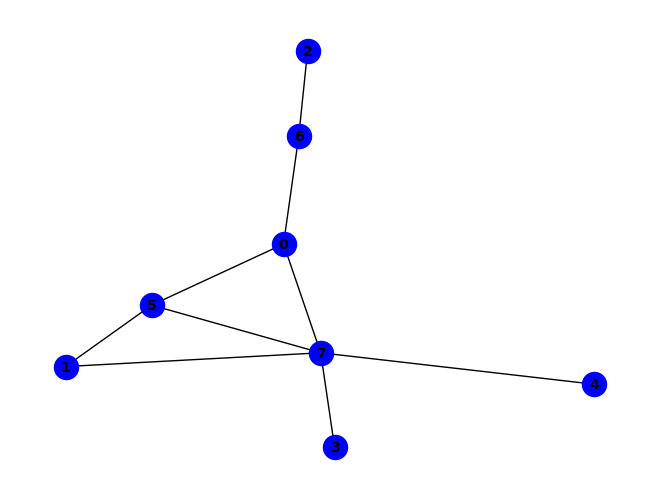


~f ^ (f & ~h) ^ (a & g & ~h) ^ (b & h & ~e) ^ (c & g & ~a) ^ (e & h & ~f) ^ (a & f & g & h) ^ (a & f & ~c & ~g) ^ (a & h & ~b & ~e) ^ (b & f & ~a & ~e) ^ (a & c & f & h & ~d) ^ (a & e & f & h & ~c) ^ (b & c & f & g & ~a) ^ (c & d & g & h & ~e) ^ (c & e & g & h & ~f) ^ (c & f & g & h & ~d) ^ (c & d & e & f & g & h) ^ (b & e & f & ~a & ~h) ^ (a & c & d & f & h & ~g) ^ (a & c & d & g & h & ~b) ^ (a & c & e & g & h & ~d) ^ (a & b & c & d & e & g & h) ^ (a & b & c & d & f & g & h) ^ (a & c & e & f & ~d & ~g) ^ (b & c & g & h & ~a & ~e) ^ (a & b & c & d & e & f & ~g) ^ (a & c & d & e & f & h & ~b) ^ (b & c & e & f & g & h & ~a) ^ (a & c & f & ~e & ~g & ~h) ^ (b & c & d & g & h & ~e & ~f) ^ (d & h & ~a & ~b & ~e & ~f) ^ (a & c & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

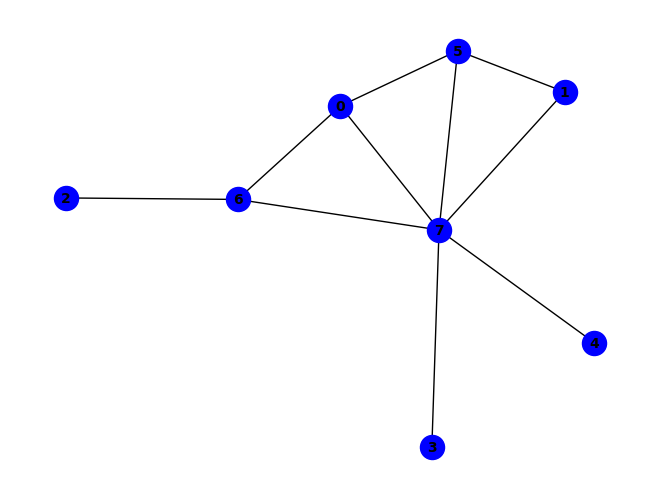


(g & ~h) ^ (~c & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~b & ~h) ^ (a & b & f & ~h) ^ (a & e & g & ~h) ^ (b & e & f & ~g) ^ (b & c & ~g & ~h) ^ (b & f & ~e & ~h) ^ (e & h & ~f & ~g) ^ (a & e & f & h & ~g) ^ (b & e & f & g & ~h) ^ (a & c & g & ~b & ~h) ^ (b & e & h & ~d & ~g) ^ (b & d & e & f & h & ~g) ^ (b & h & ~d & ~f & ~g) ^ (b & c & g & ~a & ~f & ~h) ^ (d & h & ~a & ~e & ~f & ~g) ^ (a & b & h & ~d & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


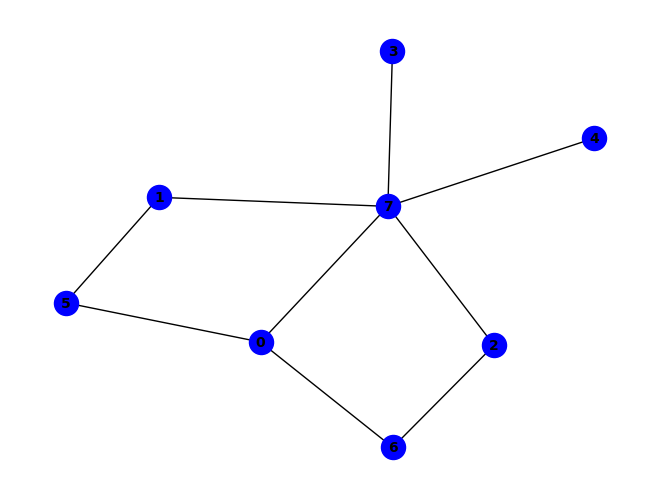


~e ^ (e & ~h) ^ (b & f & ~a) ^ (d & h & ~e) ^ (a & b & c & g) ^ (b & c & h & ~e) ^ (b & c & d & e & h) ^ (a & f & ~g & ~h) ^ (a & g & ~c & ~h) ^ (b & h & ~a & ~f) ^ (c & g & ~b & ~h) ^ (c & h & ~d & ~e) ^ (a & b & c & ~f & ~g) ^ (a & b & c & ~f & ~h) ^ (b & c & g & ~f & ~h) ^ (b & d & h & ~a & ~c) ^ (b & e & h & ~a & ~d) ^ (a & b & c & e & h & ~d) ^ (a & b & c & f & h & ~g) ^ (a & h & ~c & ~d & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


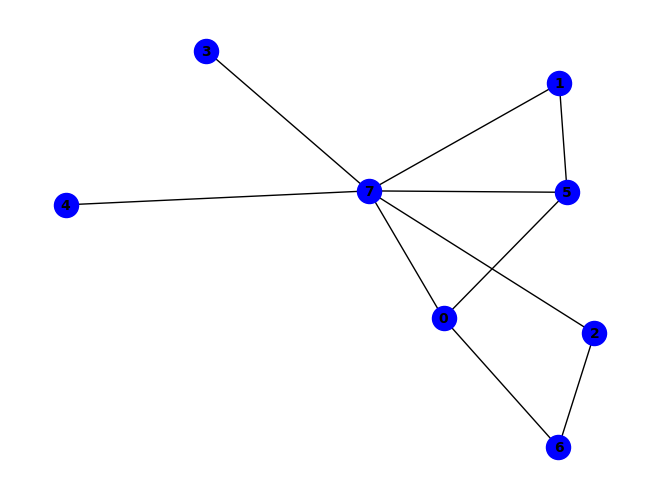


~f ^ (f & ~h) ^ (a & c & g) ^ (a & f & ~g) ^ (a & g & ~h) ^ (b & h & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (a & c & h & ~g) ^ (a & h & ~b & ~e) ^ (b & f & ~a & ~e) ^ (a & c & d & h & ~e) ^ (a & c & f & h & ~d) ^ (a & c & d & e & f & h) ^ (b & e & f & ~a & ~h) ^ (a & b & c & h & ~d & ~f) ^ (a & c & e & h & ~b & ~f) ^ (b & c & f & g & ~a & ~h) ^ (a & b & c & d & e & h & ~f) ^ (c & h & ~b & ~d & ~e & ~f) ^ (d & h & ~a & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


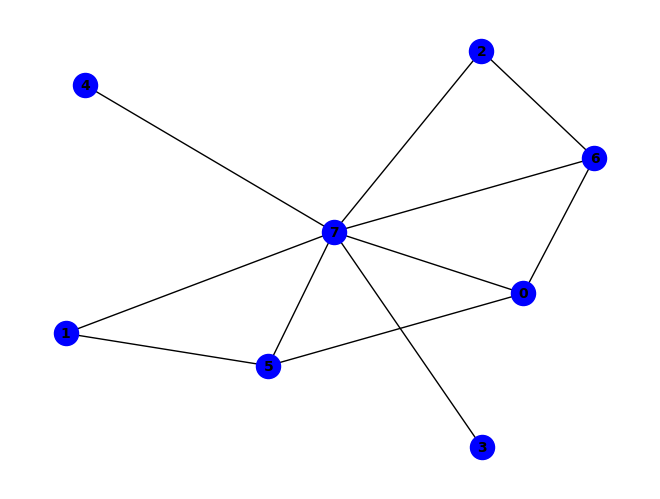


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (b & e & f & ~g) ^ (b & f & ~e & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & h & ~f & ~g) ^ (a & b & c & f & ~g) ^ (a & e & f & h & ~g) ^ (b & c & e & g & ~f) ^ (b & c & e & h & ~f) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (a & b & f & ~c & ~h) ^ (a & c & g & ~e & ~f) ^ (a & c & h & ~e & ~f) ^ (a & e & g & ~c & ~h) ^ (b & c & g & ~e & ~h) ^ (b & e & h & ~d & ~g) ^ (c & e & h & ~d & ~g) ^ (b & c & d & e & h & ~g) ^ (b & d & e & f & g & ~c) ^ (b & d & e & f & h & ~c) ^ (b & h & ~d & ~f & ~g) ^ (a & b & c & h & ~e & ~g) ^ (a & b & c & e & f & h & ~g) ^ (a & c & d & e & f & g & ~b) ^ (a & c & d & e & f & h & ~b) ^ (c & f & g & ~a & ~e & ~h) ^ (a & c & d & e & h & ~b & ~g) ^ (c & d & e & f & g & ~a & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (d & h & ~a & ~e & ~f & ~g) ^ (b & e & f & g & ~c & ~d & ~h) ^ (a & b & h & ~d & ~e & ~f & ~g) ^ (c & d & h & ~a & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS

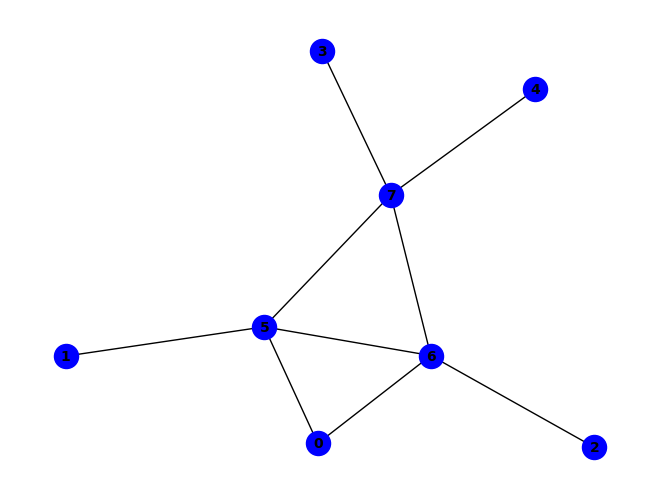


(~c & ~g) ^ (c & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & e & f & g) ^ (d & e & f & h) ^ (c & ~f & ~h) ^ (g & ~a & ~h) ^ (a & c & g & ~h) ^ (a & f & ~c & ~h) ^ (d & h & ~f & ~g) ^ (e & h & ~d & ~g) ^ (e & f & g & ~d & ~h) ^ (b & f & ~a & ~g & ~h) ^ (c & f & ~a & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


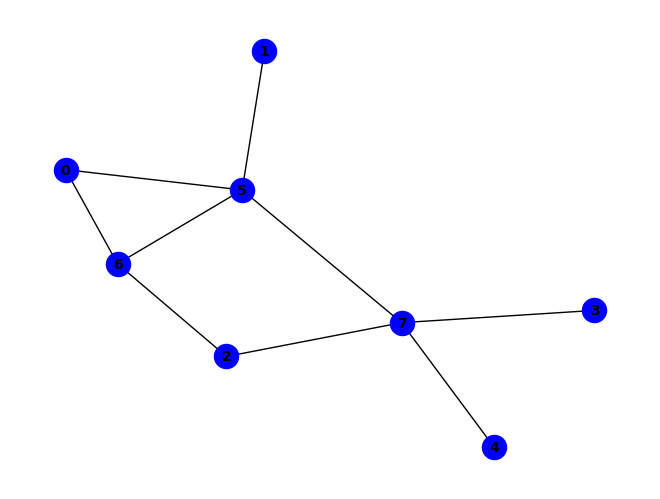


~e ^ (a & g & ~c) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (a & c & f & g) ^ (a & e & f & g) ^ (a & f & g & h) ^ (e & ~d & ~h) ^ (a & d & e & f & h) ^ (a & f & ~e & ~h) ^ (c & g & ~f & ~h) ^ (c & h & ~e & ~f) ^ (d & h & ~c & ~f) ^ (a & e & g & h & ~d) ^ (c & d & e & f & ~a) ^ (c & d & e & h & ~a) ^ (d & e & f & ~c & ~h) ^ (a & c & d & e & h & ~g) ^ (a & c & e & g & h & ~f) ^ (b & f & ~a & ~g & ~h) ^ (a & d & e & f & ~c & ~g) ^ (a & d & g & h & ~c & ~f) ^ (a & c & d & e & f & g & ~h) ^ (a & e & f & ~d & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


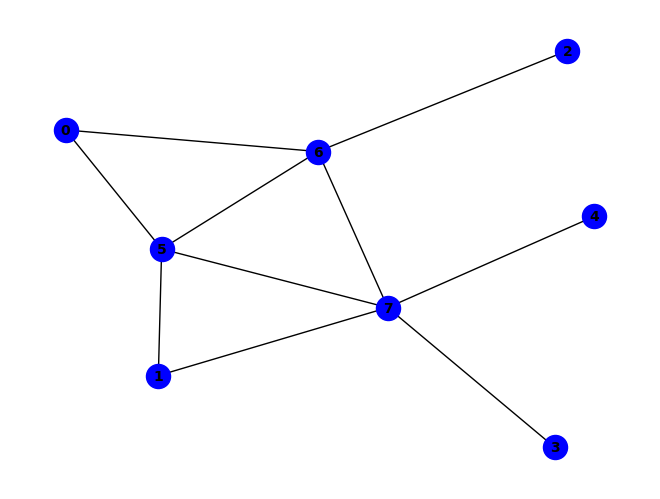


(~c & ~g) ^ (b & f & ~g) ^ (c & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (c & ~f & ~h) ^ (g & ~a & ~h) ^ (a & c & g & ~h) ^ (a & f & ~c & ~h) ^ (b & h & ~e & ~g) ^ (e & h & ~d & ~g) ^ (b & d & e & h & ~g) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (a & b & f & ~g & ~h) ^ (e & f & g & ~d & ~h) ^ (b & d & e & f & g & ~h) ^ (c & f & ~a & ~g & ~h) ^ (d & h & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


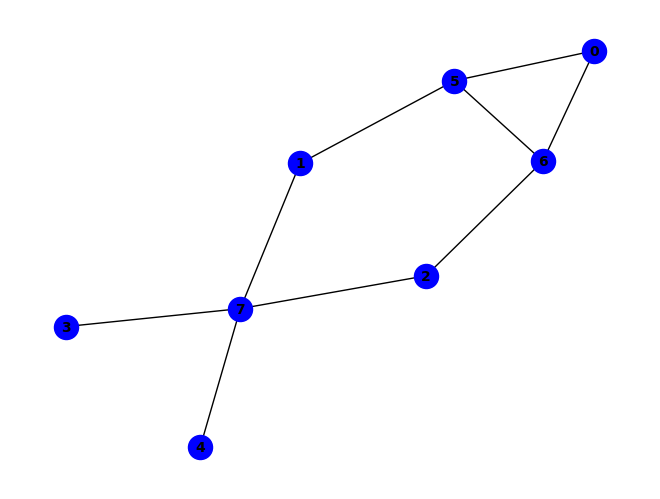


(c & f & g) ^ (~b & ~f) ^ (a & f & ~e) ^ (a & g & ~c) ^ (c & g & ~h) ^ (c & h & ~e) ^ (b & ~f & ~h) ^ (a & b & f & ~g) ^ (a & e & f & ~h) ^ (c & e & f & g & h) ^ (e & h & ~b & ~f) ^ (a & b & g & h & ~f) ^ (a & c & f & g & ~h) ^ (a & e & g & h & ~c) ^ (f & ~b & ~e & ~g) ^ (b & c & h & ~e & ~f) ^ (a & b & c & f & h & ~d) ^ (a & b & c & g & h & ~e) ^ (a & b & d & g & h & ~c) ^ (a & b & e & f & h & ~c) ^ (a & b & e & g & h & ~d) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (e & f & ~b & ~g & ~h) ^ (a & c & f & h & ~d & ~e) ^ (a & d & f & h & ~b & ~e) ^ (a & d & g & h & ~c & ~e) ^ (b & c & f & h & ~e & ~g) ^ (d & h & ~b & ~c & ~e & ~f) ^ (d & f & h & ~b & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


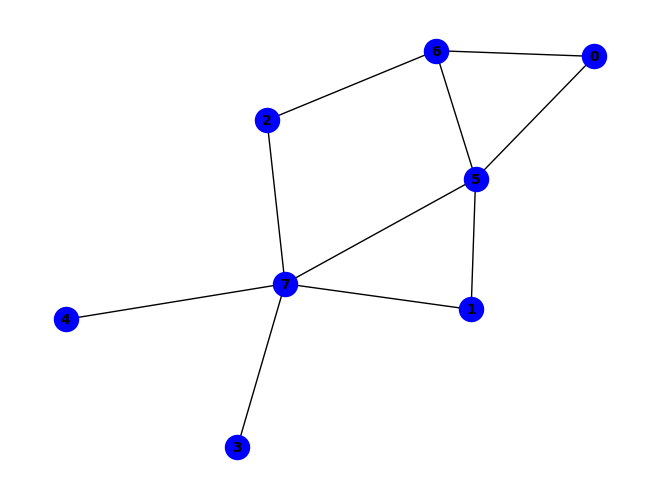


~e ^ (a & g & ~c) ^ (d & e & ~f) ^ (f & h & ~e) ^ (a & c & f & g) ^ (a & e & f & g) ^ (e & ~d & ~h) ^ (a & f & ~e & ~h) ^ (b & f & ~a & ~h) ^ (c & g & ~f & ~h) ^ (d & h & ~c & ~f) ^ (f & g & ~b & ~h) ^ (a & b & f & g & ~h) ^ (a & d & g & h & ~c) ^ (a & e & g & h & ~d) ^ (a & f & g & h & ~d) ^ (b & c & d & h & ~f) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (a & c & d & f & g & h) ^ (d & e & f & ~c & ~h) ^ (a & c & e & g & h & ~f) ^ (a & d & e & f & h & ~c) ^ (b & c & d & e & f & ~h) ^ (b & h & ~d & ~e & ~f) ^ (c & h & ~b & ~e & ~f) ^ (a & d & e & f & ~c & ~g) ^ (a & b & c & d & g & h & ~f) ^ (a & c & d & e & g & h & ~b) ^ (a & b & c & d & e & f & g & h) ^ (a & e & f & ~d & ~g & ~h) ^ (a & b & c & g & h & ~e & ~f) ^ (a & c & d & e & f & ~g & ~h) ^ (a & b & g & h & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

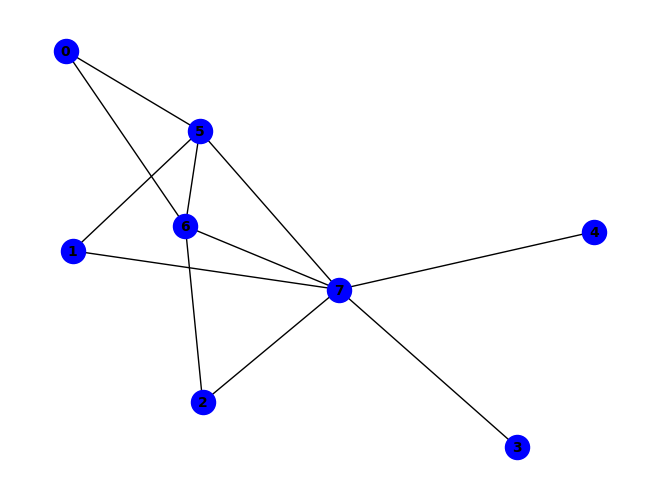


(g & ~h) ^ (~a & ~g) ^ (b & f & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & c & ~f & ~g) ^ (a & h & ~c & ~g) ^ (b & h & ~e & ~g) ^ (e & h & ~d & ~g) ^ (a & c & f & h & ~g) ^ (c & d & e & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & ~c & ~f & ~h) ^ (a & b & f & ~g & ~h) ^ (c & e & h & ~f & ~g) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (d & h & ~c & ~f & ~g) ^ (b & c & e & h & ~d & ~g) ^ (b & e & f & h & ~c & ~g) ^ (b & c & d & e & f & h & ~g) ^ (b & c & h & ~d & ~f & ~g) ^ (b & d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


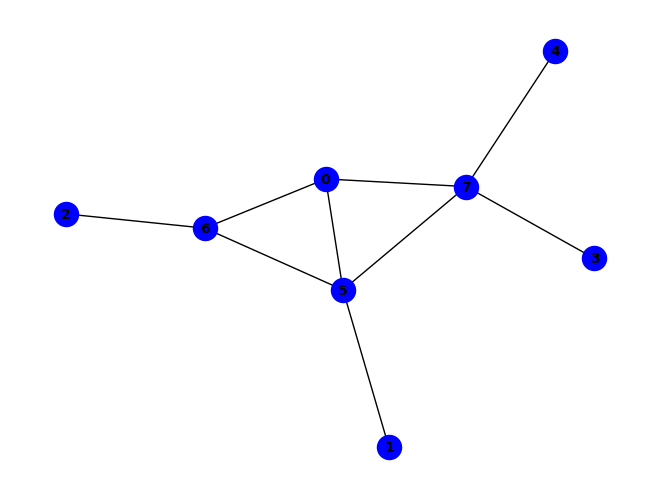


~e ^ (a & f & ~e) ^ (a & g & ~h) ^ (a & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (c & d & e & f & g) ^ (c & d & e & g & h) ^ (c & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (a & e & f & ~d & ~h) ^ (d & e & f & ~c & ~h) ^ (a & c & d & e & f & ~g) ^ (a & c & d & e & h & ~g) ^ (b & f & ~a & ~g & ~h) ^ (c & d & e & f & ~g & ~h) ^ (c & d & g & h & ~a & ~f) ^ (c & e & g & h & ~a & ~f) ^ (a & c & d & e & f & g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


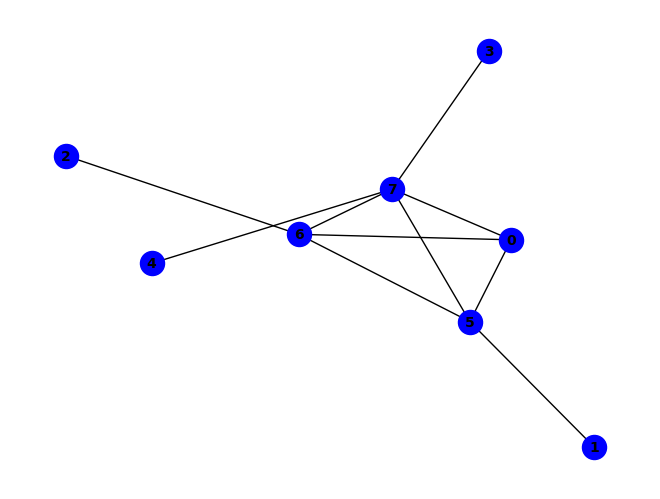


(g & ~h) ^ (~c & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (c & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (c & ~f & ~h) ^ (a & c & f & ~h) ^ (a & c & g & ~h) ^ (a & e & g & ~h) ^ (a & f & g & ~h) ^ (a & f & ~c & ~g) ^ (c & f & ~g & ~h) ^ (e & h & ~d & ~g) ^ (a & c & f & h & ~g) ^ (a & d & e & h & ~g) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~a) ^ (d & e & f & h & ~a) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (b & f & ~a & ~g & ~h) ^ (d & h & ~a & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


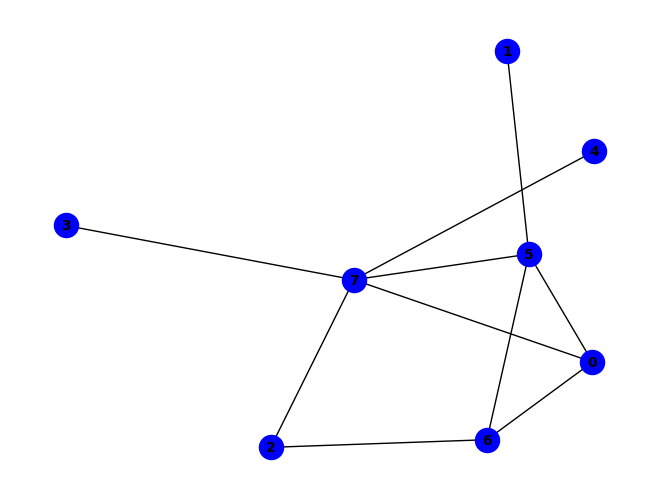


~e ^ (a & f & ~e) ^ (a & g & ~h) ^ (a & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (c & d & e & f) ^ (c & d & e & h) ^ (e & ~d & ~h) ^ (a & c & g & ~f) ^ (c & g & ~f & ~h) ^ (c & h & ~e & ~f) ^ (a & c & e & h & ~f) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (a & c & h & ~f & ~g) ^ (a & e & f & ~d & ~h) ^ (d & e & f & ~c & ~h) ^ (a & c & d & e & f & ~h) ^ (b & f & ~a & ~g & ~h) ^ (d & h & ~a & ~c & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


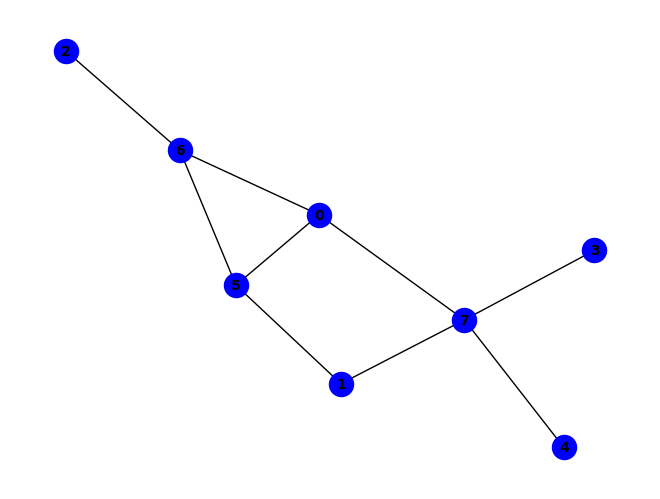


(~b & ~f) ^ (a & g & ~h) ^ (a & h & ~e) ^ (a & e & f & g) ^ (a & f & g & h) ^ (b & ~f & ~h) ^ (a & f & ~e & ~h) ^ (c & g & ~a & ~f) ^ (e & h & ~b & ~f) ^ (f & ~b & ~e & ~g) ^ (a & b & f & ~e & ~g) ^ (a & b & h & ~e & ~f) ^ (e & f & ~b & ~g & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & d & e & f & ~c & ~g) ^ (a & d & f & h & ~b & ~g) ^ (c & d & g & h & ~e & ~f) ^ (c & e & g & h & ~a & ~f) ^ (a & c & d & e & f & h & ~b) ^ (a & c & d & e & g & h & ~b) ^ (a & e & f & ~d & ~g & ~h) ^ (d & f & h & ~b & ~e & ~g) ^ (a & b & c & g & h & ~e & ~f) ^ (a & c & d & e & f & ~g & ~h) ^ (a & c & d & g & h & ~b & ~f) ^ (d & h & ~a & ~b & ~e & ~f) ^ (b & c & g & h & ~d & ~e & ~f) ^ (a & b & d & e & f & h & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


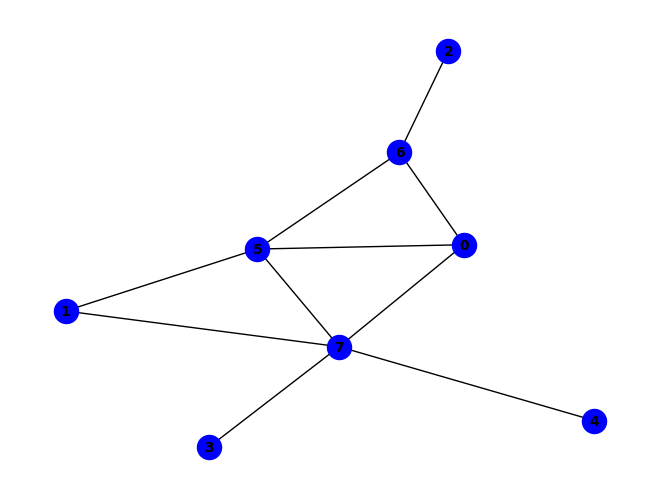


~e ^ (a & f & ~e) ^ (a & g & ~h) ^ (b & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & e & f & ~h) ^ (c & d & e & f & g) ^ (a & h & ~b & ~e) ^ (c & g & ~a & ~f) ^ (d & h & ~b & ~f) ^ (b & d & e & h & ~f) ^ (b & e & f & h & ~a) ^ (b & f & g & h & ~a) ^ (b & c & d & e & f & h) ^ (d & e & f & ~c & ~h) ^ (c & d & e & g & h & ~b) ^ (b & f & ~a & ~c & ~g) ^ (b & c & e & f & ~d & ~g) ^ (b & c & f & h & ~a & ~e) ^ (b & c & g & h & ~a & ~e) ^ (c & d & g & h & ~b & ~f) ^ (c & e & g & h & ~a & ~f) ^ (a & b & c & d & f & h & ~e) ^ (a & b & c & d & g & h & ~e) ^ (a & b & c & e & f & h & ~g) ^ (a & d & h & ~b & ~e & ~f) ^ (b & c & f & ~e & ~g & ~h) ^ (a & b & c & d & f & ~e & ~g) ^ (a & c & d & g & h & ~e & ~f) ^ (a & b & c & f & ~d & ~g & ~h) ^ (c & d & e & f & ~b & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

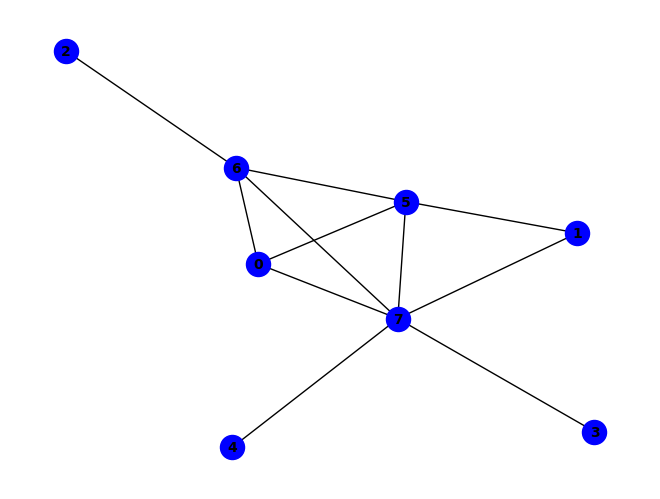


(g & ~h) ^ (~c & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (c & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (c & ~f & ~h) ^ (a & c & f & ~h) ^ (a & c & g & ~h) ^ (a & e & g & ~h) ^ (a & f & ~c & ~g) ^ (b & f & ~a & ~g) ^ (c & f & ~g & ~h) ^ (e & h & ~d & ~g) ^ (a & c & f & h & ~g) ^ (a & d & e & h & ~g) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (a & f & g & ~e & ~h) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (b & d & e & f & g & ~h) ^ (b & h & ~a & ~e & ~g) ^ (b & d & e & h & ~a & ~g) ^ (b & e & f & h & ~a & ~g) ^ (a & b & d & e & f & h & ~g) ^ (d & h & ~a & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


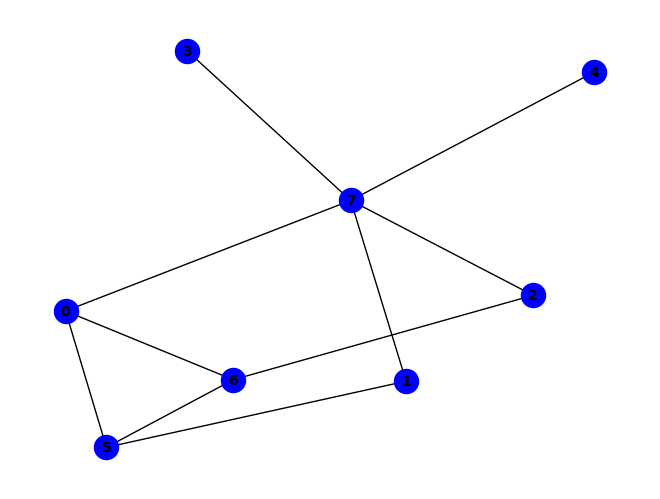


(c & f & g) ^ (~b & ~f) ^ (a & g & ~h) ^ (a & h & ~e) ^ (c & g & ~h) ^ (c & h & ~e) ^ (a & e & f & g) ^ (a & f & g & h) ^ (b & ~f & ~h) ^ (a & c & g & ~f) ^ (a & c & h & ~g) ^ (c & e & f & g & h) ^ (a & f & ~e & ~h) ^ (e & h & ~b & ~f) ^ (a & c & e & h & ~f) ^ (f & ~b & ~e & ~g) ^ (a & b & f & ~e & ~g) ^ (a & c & e & f & h & ~g) ^ (e & f & ~b & ~g & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & d & e & f & ~c & ~g) ^ (a & d & f & h & ~c & ~g) ^ (a & b & h & ~d & ~e & ~f) ^ (a & d & h & ~c & ~e & ~f) ^ (a & e & f & ~d & ~g & ~h) ^ (b & c & h & ~a & ~e & ~f) ^ (a & b & c & d & h & ~e & ~f) ^ (a & c & d & e & f & ~g & ~h) ^ (d & h & ~b & ~c & ~e & ~f) ^ (b & c & f & h & ~a & ~e & ~g) ^ (d & f & h & ~b & ~c & ~e & ~g) ^ (a & b & d & f & h & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


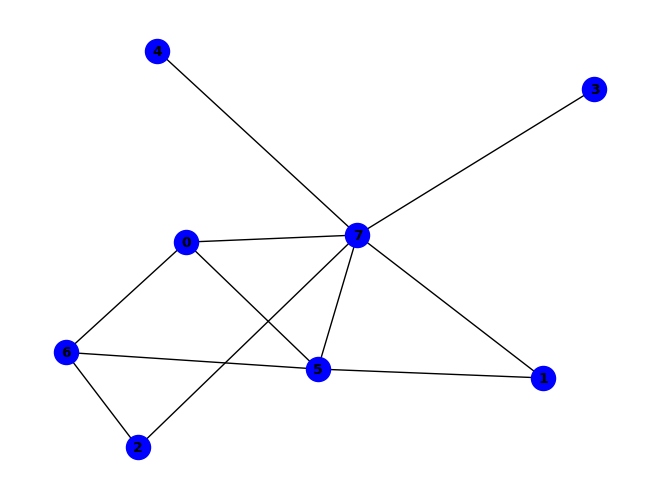


~e ^ (a & f & ~e) ^ (a & h & ~e) ^ (d & e & ~f) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & g & ~c & ~h) ^ (b & f & ~a & ~h) ^ (c & g & ~f & ~h) ^ (f & g & ~b & ~h) ^ (a & b & f & g & ~h) ^ (a & c & f & g & ~h) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (a & b & c & d & e & f) ^ (a & b & c & d & e & h) ^ (a & e & f & ~d & ~h) ^ (d & e & f & ~c & ~h) ^ (b & c & d & e & f & ~h) ^ (d & h & ~a & ~c & ~f) ^ (b & c & d & h & ~a & ~f) ^ (a & c & d & e & f & ~b & ~h) ^ (b & h & ~a & ~d & ~e & ~f) ^ (c & h & ~a & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


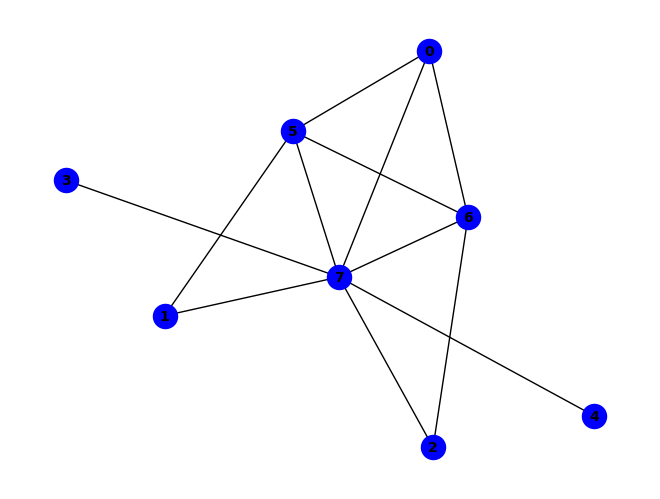


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (b & f & ~a & ~g) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (e & h & ~d & ~g) ^ (a & d & e & g & ~c) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~c) ^ (c & d & e & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & d & e & f & g) ^ (a & c & e & f & g & h) ^ (a & e & g & ~d & ~h) ^ (a & f & g & ~e & ~h) ^ (c & e & h & ~f & ~g) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (b & h & ~a & ~e & ~g) ^ (a & b & c & h & ~f & ~g) ^ (a & c & e & h & ~b & ~g) ^ (a & d & e & h & ~c & ~f) ^ (b & c & e & h & ~d & ~g) ^ (a & b & d & e & f & h & ~c) ^ (a & c & d & e & f & g & ~b) ^ (b & c & d & e & f & h & ~g) ^ (b & c & h & ~d & ~f & ~g) ^ (b & d & h & ~e & ~f & ~g) ^ (a & b & d & e & h & ~c & ~g) ^ (a & c & d & e & g & ~f & ~h) ^ (a & d & e & f & g & ~b & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (d & h & ~a & ~c & ~f & ~g) ^ (a & b & d & h & ~c & ~f & ~g) ^ (b & e & f & h & ~a & ~c & ~g)
PA

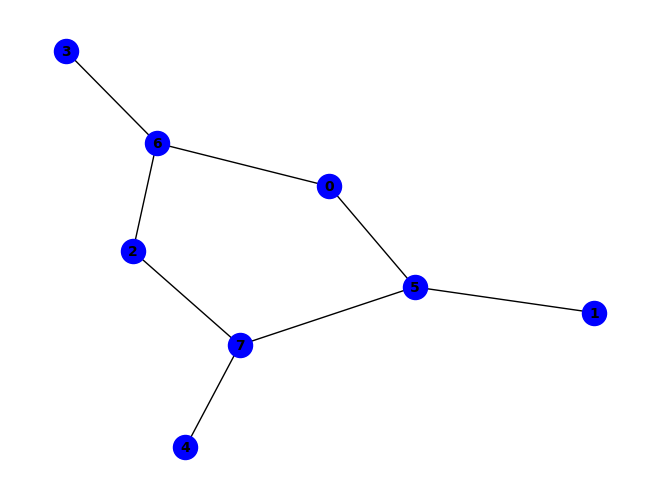


(a & d & g) ^ (~b & ~f) ^ (a & g & ~f) ^ (b & h & ~f) ^ (d & g & ~c) ^ (e & h & ~f) ^ (b & ~d & ~h) ^ (f & ~a & ~h) ^ (a & b & f & ~h) ^ (a & c & g & ~d) ^ (a & d & e & g & h) ^ (b & d & ~g & ~h) ^ (c & g & ~b & ~h) ^ (c & h & ~e & ~f) ^ (a & e & g & h & ~f) ^ (d & e & g & h & ~c) ^ (b & c & g & ~f & ~h) ^ (b & d & g & ~f & ~h) ^ (a & b & d & f & g & ~h) ^ (a & c & e & g & h & ~d) ^ (a & c & f & g & h & ~e) ^ (b & c & d & f & g & ~h) ^ (a & b & c & f & g & ~d & ~h) ^ (d & f & g & h & ~a & ~c & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


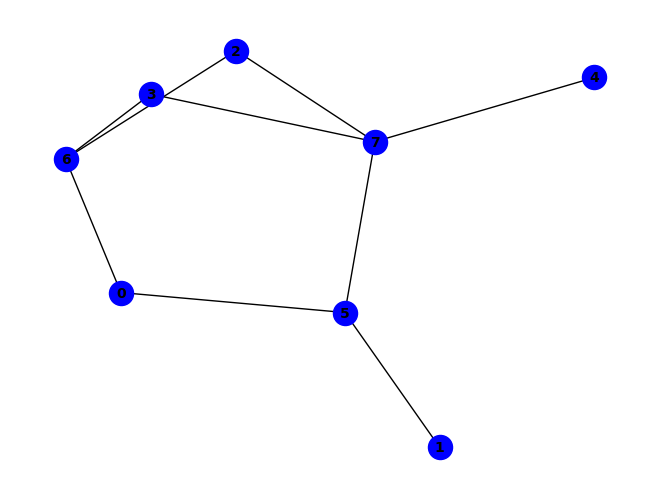


(a & d & g) ^ (~b & ~f) ^ (a & g & ~f) ^ (b & h & ~f) ^ (e & h & ~f) ^ (b & ~d & ~h) ^ (f & ~a & ~h) ^ (a & b & f & ~h) ^ (a & c & g & ~d) ^ (a & d & e & g & h) ^ (c & g & ~b & ~h) ^ (d & g & ~c & ~h) ^ (d & h & ~e & ~f) ^ (a & e & g & h & ~f) ^ (b & c & d & f & ~h) ^ (b & c & g & ~f & ~h) ^ (b & d & g & ~f & ~h) ^ (a & b & c & d & g & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & d & f & g & ~h) ^ (a & c & e & g & h & ~d) ^ (a & c & f & g & h & ~e) ^ (b & d & ~c & ~g & ~h) ^ (c & h & ~d & ~e & ~f) ^ (a & b & c & d & ~f & ~h) ^ (a & d & f & g & h & ~c & ~e) ^ (b & c & d & ~a & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


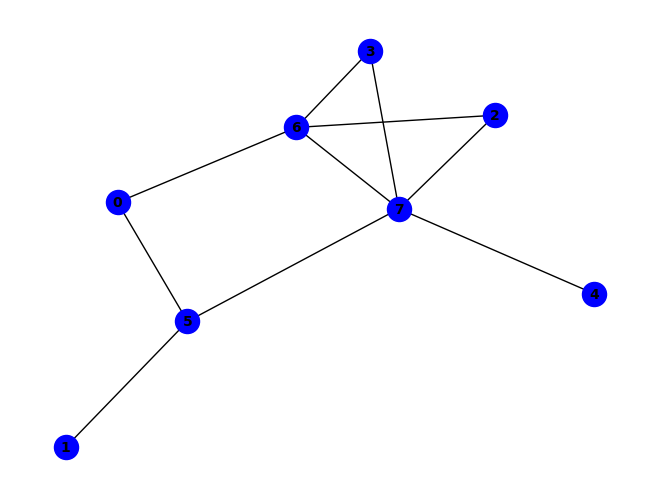


(g & ~h) ^ (~a & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & h & ~g) ^ (a & ~f & ~h) ^ (a & f & g & ~h) ^ (a & d & ~c & ~g) ^ (a & d & ~c & ~h) ^ (a & h & ~d & ~g) ^ (b & f & ~a & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (b & c & f & g & ~h) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & c & g & ~b & ~h) ^ (c & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (d & f & g & ~e & ~h) ^ (a & b & c & d & f & ~g) ^ (a & b & c & d & f & ~h) ^ (a & b & d & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (e & h & ~c & ~f & ~g) ^ (a & b & c & g & ~f & ~h) ^ (a & c & d & h & ~b & ~g) ^ (b & d & f & g & ~c & ~h) ^ (a & b & c & d & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


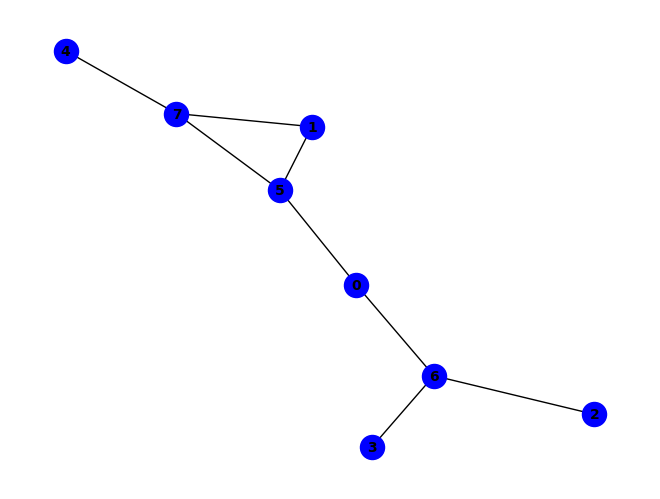


(~a & ~f) ^ (b & f & ~e) ^ (b & h & ~e) ^ (d & g & ~a) ^ (e & h & ~f) ^ (f & ~a & ~h) ^ (a & b & f & ~h) ^ (a & b & h & ~f) ^ (b & e & f & ~h) ^ (c & g & ~a & ~d) ^ (b & d & f & g & ~a) ^ (c & e & g & h & ~f) ^ (a & ~b & ~f & ~g) ^ (a & b & e & g & h & ~f) ^ (a & b & ~f & ~g & ~h) ^ (a & e & g & h & ~c & ~f) ^ (b & c & f & g & ~a & ~d) ^ (b & d & g & h & ~a & ~e) ^ (c & f & g & h & ~a & ~d) ^ (d & e & g & h & ~a & ~c) ^ (d & f & g & h & ~a & ~e) ^ (b & c & e & f & g & h & ~a) ^ (c & d & e & f & g & h & ~a) ^ (b & c & g & h & ~a & ~d & ~e) ^ (b & d & e & f & g & h & ~a & ~c)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


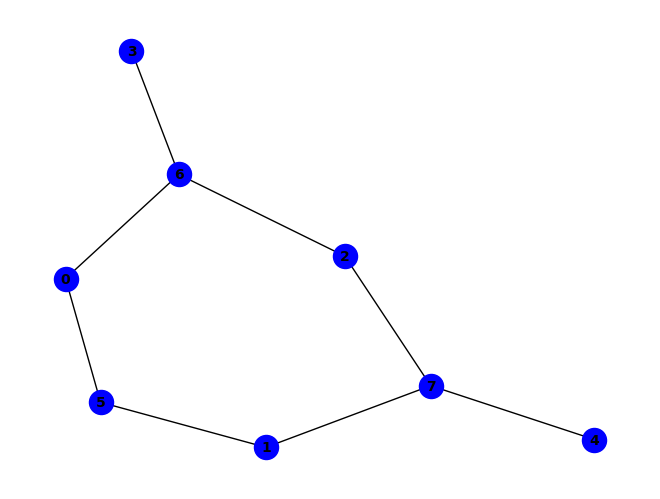


~e ^ (e & ~h) ^ (b & f & ~d) ^ (b & e & h & ~d) ^ (a & b & e & g & h) ^ (a & f & ~b & ~e) ^ (a & g & ~c & ~f) ^ (b & h & ~a & ~f) ^ (c & g & ~b & ~h) ^ (c & h & ~b & ~e) ^ (d & g & ~a & ~c) ^ (a & b & c & g & ~f) ^ (a & b & c & g & ~h) ^ (a & c & e & f & ~g) ^ (a & c & f & h & ~b) ^ (a & e & g & h & ~f) ^ (b & d & e & h & ~g) ^ (b & d & g & h & ~f) ^ (a & b & c & e & f & h) ^ (a & b & h & ~f & ~g) ^ (a & e & f & ~c & ~h) ^ (b & c & g & ~f & ~h) ^ (b & d & f & ~c & ~g) ^ (a & b & d & f & g & ~h) ^ (a & b & d & g & h & ~e) ^ (a & b & e & f & g & ~c) ^ (a & c & e & g & h & ~b) ^ (b & c & d & f & h & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & c & f & g & ~e & ~h) ^ (b & c & d & f & ~a & ~h) ^ (d & e & g & h & ~a & ~c) ^ (a & b & c & e & f & g & ~h) ^ (a & b & c & d & f & ~g & ~h) ^ (b & c & d & g & h & ~a & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

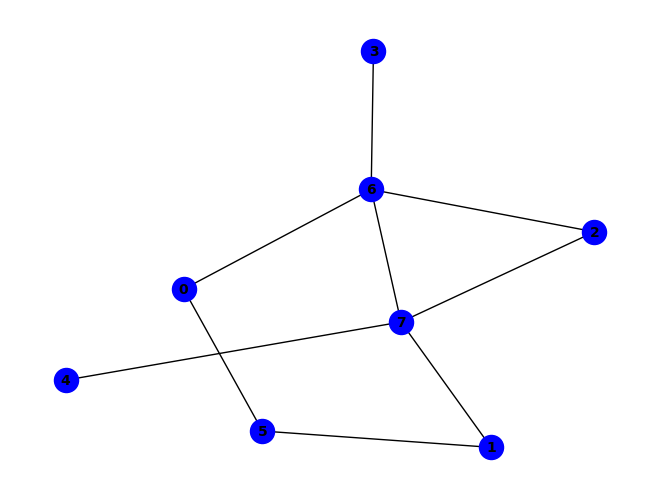


(d & ~c & ~h) ^ (g & ~b & ~h) ^ (~b & ~d & ~g) ^ (a & f & ~b & ~g) ^ (a & g & ~d & ~h) ^ (c & g & ~b & ~e) ^ (c & h & ~b & ~e) ^ (d & h & ~b & ~g) ^ (e & h & ~b & ~g) ^ (a & c & f & g & ~b) ^ (a & c & f & h & ~b) ^ (b & ~c & ~f & ~h) ^ (a & c & g & ~f & ~h) ^ (b & d & f & ~c & ~h) ^ (c & e & g & ~b & ~h) ^ (b & d & ~f & ~g & ~h) ^ (c & d & ~b & ~g & ~h) ^ (a & b & f & g & ~d & ~h) ^ (a & c & d & g & ~b & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (b & c & ~d & ~f & ~g & ~h) ^ (a & e & f & h & ~b & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


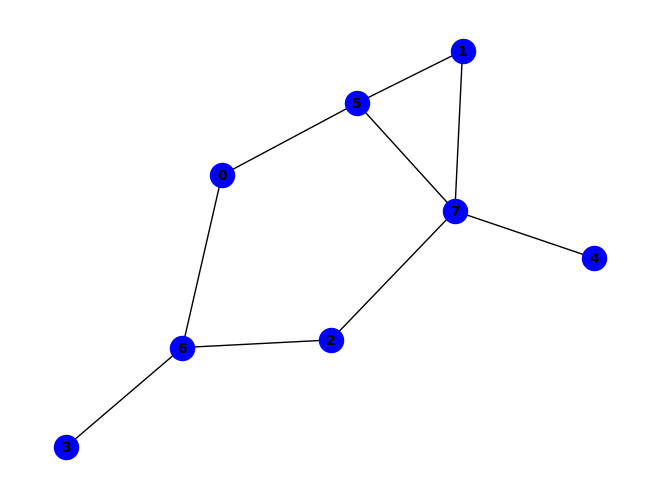


(a & c & g) ^ (~a & ~f) ^ (b & f & ~e) ^ (b & h & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (f & ~a & ~h) ^ (a & b & f & ~h) ^ (a & b & h & ~f) ^ (b & e & f & ~h) ^ (a & b & d & f & g) ^ (d & g & ~a & ~c) ^ (b & c & f & g & ~h) ^ (b & d & f & g & ~c) ^ (a & ~b & ~f & ~g) ^ (a & b & c & f & g & ~d) ^ (a & b & d & g & h & ~e) ^ (a & b & e & g & h & ~f) ^ (a & c & f & g & h & ~d) ^ (a & d & f & g & h & ~e) ^ (a & b & d & e & f & g & h) ^ (a & c & d & e & f & g & h) ^ (a & b & ~f & ~g & ~h) ^ (c & h & ~b & ~e & ~f) ^ (a & e & g & h & ~c & ~f) ^ (b & d & g & h & ~c & ~e) ^ (d & e & g & h & ~a & ~c) ^ (d & f & g & h & ~c & ~e) ^ (b & d & e & f & g & h & ~c) ^ (a & b & c & g & h & ~d & ~e) ^ (a & b & c & e & f & g & h & ~d)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


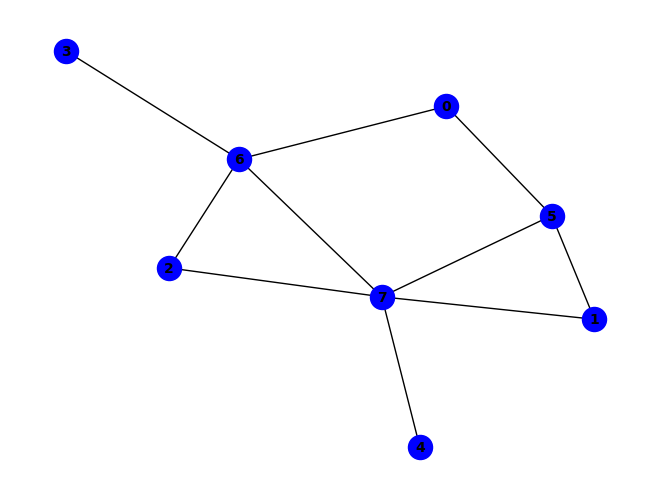


(~d & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~a & ~h) ^ (a & b & f & ~h) ^ (a & f & ~g & ~h) ^ (b & f & ~c & ~h) ^ (c & d & ~g & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & h & ~f & ~g) ^ (c & e & f & g & ~b) ^ (c & e & f & h & ~b) ^ (a & c & g & ~b & ~h) ^ (a & d & g & ~c & ~h) ^ (b & c & f & ~g & ~h) ^ (c & e & h & ~b & ~g) ^ (c & f & g & ~e & ~h) ^ (b & c & e & f & g & ~h) ^ (b & h & ~e & ~f & ~g) ^ (b & c & g & ~a & ~f & ~h) ^ (b & d & f & g & ~a & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


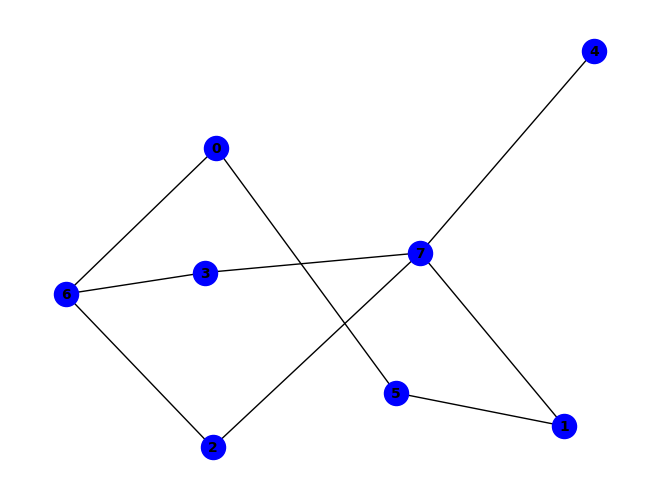


~e ^ (e & ~h) ^ (a & f & ~e) ^ (b & f & ~a) ^ (d & h & ~e) ^ (a & e & f & ~h) ^ (b & c & g & ~a) ^ (b & d & g & ~c) ^ (a & g & ~d & ~f) ^ (b & h & ~a & ~f) ^ (c & g & ~a & ~h) ^ (c & h & ~d & ~e) ^ (d & g & ~c & ~h) ^ (a & b & d & g & ~f) ^ (a & c & d & g & ~h) ^ (a & e & g & h & ~f) ^ (b & d & f & h & ~g) ^ (a & b & h & ~f & ~g) ^ (b & c & g & ~f & ~h) ^ (b & c & h & ~d & ~g) ^ (b & e & h & ~c & ~d) ^ (a & b & e & f & h & ~g) ^ (a & b & e & g & h & ~d) ^ (a & c & d & g & h & ~f) ^ (a & d & e & f & g & ~c) ^ (a & d & e & g & h & ~c) ^ (a & b & c & e & f & g & h) ^ (a & b & d & e & f & g & h) ^ (b & d & ~c & ~f & ~g) ^ (b & d & ~c & ~f & ~h) ^ (a & b & c & g & ~d & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & b & c & h & ~e & ~g) ^ (a & b & d & g & ~c & ~h) ^ (a & c & f & h & ~d & ~e) ^ (a & c & g & h & ~e & ~f) ^ (a & d & f & g & ~e & ~h) ^ (a & d & f & h & ~b & ~e) ^ (b & c & d & h & ~f & ~g) ^ (a & b & c & d & f & h & ~e) ^ (a & c & d & e & f & g & ~h) ^ (a & b & c & d & e & g & h & ~f)
P

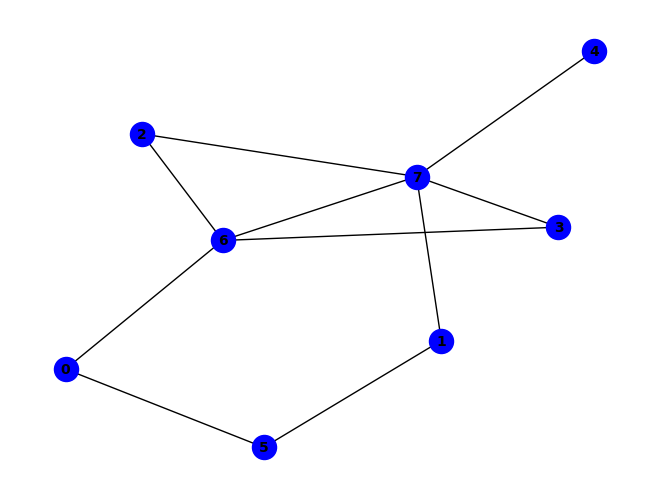


(~b & ~g) ^ (a & e & f & g) ^ (a & e & f & h) ^ (g & ~b & ~h) ^ (b & c & g & ~e) ^ (b & c & h & ~e) ^ (b & c & d & f & g) ^ (b & c & d & f & h) ^ (a & f & ~b & ~g) ^ (a & g & ~e & ~h) ^ (c & g & ~d & ~e) ^ (c & h & ~d & ~e) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (e & h & ~b & ~g) ^ (a & b & f & g & ~h) ^ (a & d & f & g & ~b) ^ (a & d & f & h & ~b) ^ (b & ~d & ~f & ~h) ^ (a & d & g & ~f & ~h) ^ (a & e & g & ~f & ~h) ^ (b & c & g & ~f & ~h) ^ (d & e & g & ~b & ~h) ^ (b & c & d & e & g & ~a) ^ (b & c & d & e & h & ~a) ^ (b & d & ~f & ~g & ~h) ^ (a & c & f & g & ~b & ~d) ^ (a & c & f & h & ~b & ~d) ^ (b & c & d & h & ~f & ~g) ^ (a & b & c & d & e & g & ~h) ^ (a & c & g & ~d & ~f & ~h) ^ (c & e & g & ~b & ~d & ~h) ^ (a & b & e & f & h & ~d & ~g) ^ (a & c & e & f & h & ~b & ~g) ^ (a & d & e & f & h & ~c & ~g) ^ (a & b & c & d & e & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


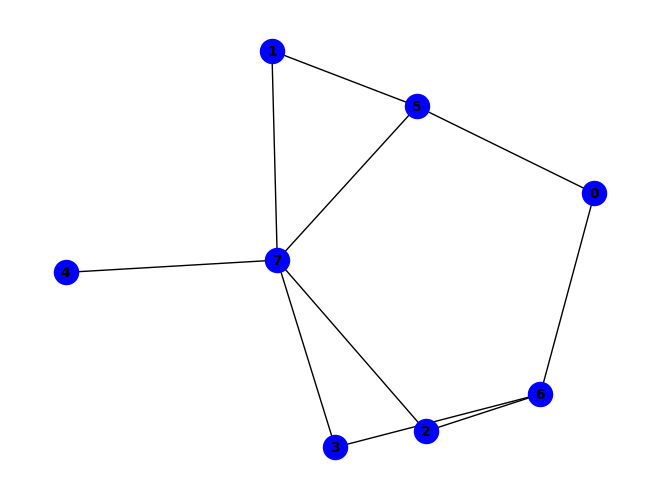


(a & d & g) ^ (~a & ~f) ^ (b & f & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (f & ~a & ~h) ^ (a & b & f & ~h) ^ (a & b & h & ~f) ^ (a & c & g & ~d) ^ (b & e & f & ~h) ^ (a & c & f & g & h) ^ (b & h & ~c & ~e) ^ (d & g & ~c & ~h) ^ (b & c & d & f & ~g) ^ (b & c & d & f & ~h) ^ (b & c & f & g & ~a) ^ (b & d & f & g & ~h) ^ (a & ~b & ~f & ~g) ^ (a & b & d & f & g & ~c) ^ (a & b & d & g & h & ~e) ^ (a & b & e & g & h & ~f) ^ (a & d & f & g & h & ~c) ^ (b & c & e & f & h & ~a) ^ (a & b & c & d & e & f & h) ^ (a & b & d & e & f & g & h) ^ (a & b & ~f & ~g & ~h) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (b & c & d & h & ~e & ~f) ^ (b & c & f & h & ~d & ~g) ^ (a & b & c & g & h & ~d & ~e) ^ (a & e & g & h & ~c & ~d & ~f) ^ (a & b & c & e & f & h & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

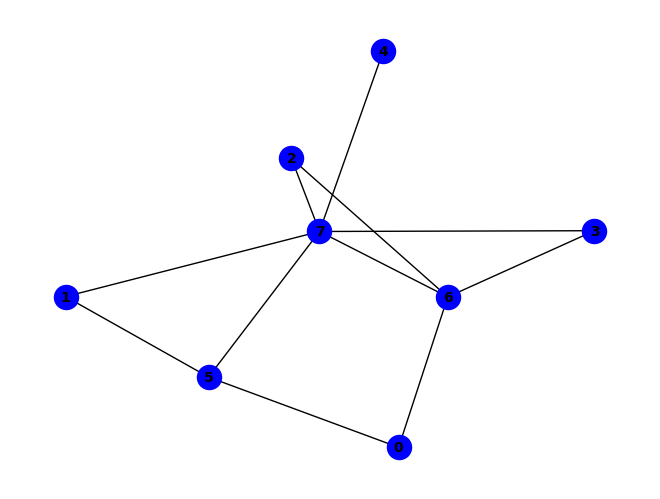


(g & ~h) ^ (~a & ~g) ^ (f & h & ~g) ^ (a & ~f & ~h) ^ (a & b & f & ~h) ^ (a & f & g & ~h) ^ (b & c & g & ~h) ^ (b & e & f & ~g) ^ (a & d & ~c & ~g) ^ (a & d & ~c & ~h) ^ (a & h & ~d & ~g) ^ (b & f & ~e & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & c & d & h & ~g) ^ (b & e & f & g & ~h) ^ (a & c & g & ~b & ~h) ^ (b & e & h & ~d & ~g) ^ (c & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (a & b & d & f & g & ~h) ^ (b & c & d & e & h & ~g) ^ (b & h & ~d & ~f & ~g) ^ (e & h & ~c & ~f & ~g) ^ (a & b & c & g & ~f & ~h) ^ (b & c & d & h & ~f & ~g) ^ (b & c & e & h & ~f & ~g) ^ (d & e & f & g & ~b & ~c) ^ (d & e & f & h & ~b & ~c) ^ (d & f & g & ~b & ~e & ~h) ^ (b & c & d & f & g & ~a & ~h) ^ (c & d & e & f & g & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

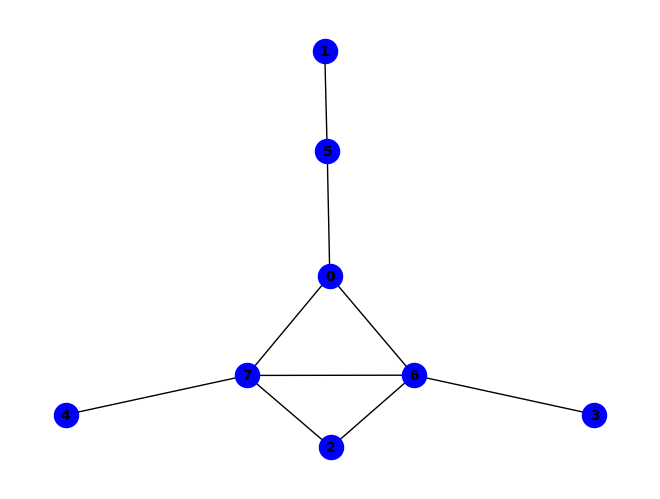


(~d & ~g) ^ (a & f & ~h) ^ (a & g & ~f) ^ (c & h & ~e) ^ (d & h & ~g) ^ (a & e & g & h) ^ (a & f & g & h) ^ (d & ~c & ~h) ^ (g & ~b & ~h) ^ (a & h & ~c & ~e) ^ (b & f & ~a & ~g) ^ (c & g & ~a & ~e) ^ (e & h & ~b & ~g) ^ (a & b & f & g & ~h) ^ (b & c & d & f & ~h) ^ (b & c & f & g & ~a) ^ (b & c & f & h & ~a) ^ (a & d & g & ~c & ~h) ^ (b & e & g & ~c & ~f) ^ (b & e & h & ~c & ~f) ^ (c & e & g & ~a & ~h) ^ (a & b & e & f & h & ~g) ^ (b & g & ~e & ~f & ~h) ^ (c & d & ~b & ~g & ~h) ^ (b & c & e & g & ~f & ~h) ^ (b & c & e & h & ~a & ~g) ^ (b & d & f & g & ~a & ~h) ^ (a & b & c & d & f & g & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (a & b & c & e & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


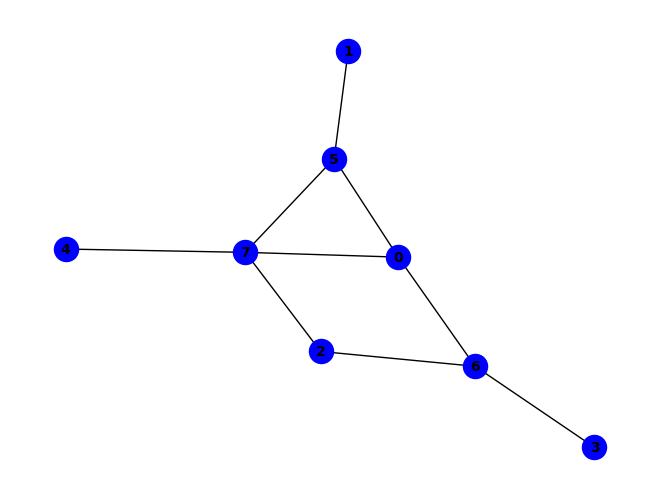


(f & ~h) ^ (~b & ~f) ^ (a & g & ~d) ^ (a & h & ~g) ^ (b & h & ~f) ^ (d & g & ~c) ^ (a & c & d & g) ^ (a & f & g & h) ^ (b & ~d & ~h) ^ (a & b & f & ~h) ^ (a & f & ~d & ~g) ^ (b & d & ~g & ~h) ^ (e & h & ~a & ~f) ^ (a & d & f & h & ~e) ^ (a & c & d & e & f & h) ^ (a & c & d & f & g & h) ^ (a & d & f & ~g & ~h) ^ (b & d & g & ~f & ~h) ^ (b & c & d & f & g & ~h) ^ (c & g & ~a & ~b & ~h) ^ (c & h & ~a & ~e & ~f) ^ (d & e & g & h & ~a & ~c) ^ (d & f & g & h & ~c & ~e) ^ (b & c & g & ~a & ~f & ~h) ^ (a & b & d & f & g & ~c & ~h) ^ (a & d & e & f & h & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


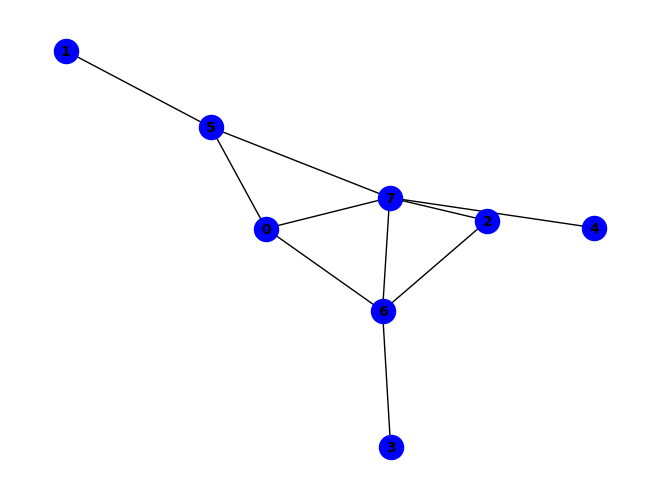


(g & ~h) ^ (~d & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & e & g & ~h) ^ (b & f & ~a & ~h) ^ (c & d & ~g & ~h) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (e & h & ~f & ~g) ^ (a & e & f & h & ~g) ^ (c & e & f & g & ~a) ^ (c & e & f & h & ~a) ^ (a & d & g & ~c & ~h) ^ (c & e & h & ~a & ~g) ^ (b & d & f & g & ~a & ~h) ^ (c & f & g & ~a & ~e & ~h) ^ (b & c & f & g & ~a & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


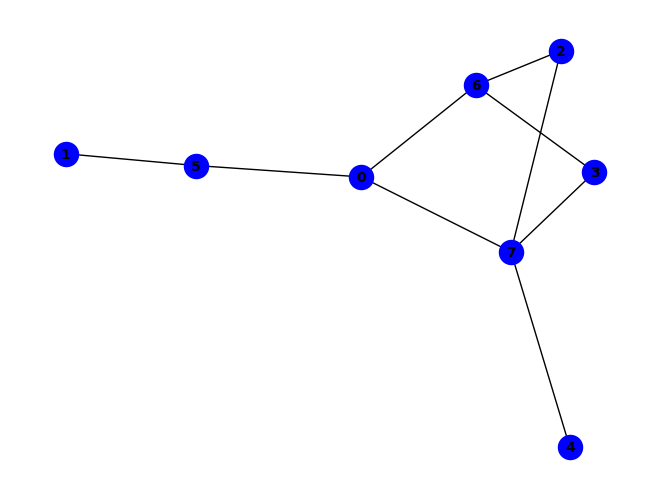


~e ^ (e & ~h) ^ (a & f & ~h) ^ (b & f & ~a) ^ (d & h & ~e) ^ (a & c & h & ~e) ^ (a & d & g & ~h) ^ (a & g & ~f & ~h) ^ (a & h & ~d & ~e) ^ (c & h & ~d & ~e) ^ (d & g & ~c & ~h) ^ (a & c & d & g & ~b) ^ (b & d & f & g & ~a) ^ (a & b & c & d & g & ~f) ^ (a & b & c & f & h & ~e) ^ (a & c & d & e & h & ~b) ^ (b & c & d & f & g & ~h) ^ (c & g & ~a & ~b & ~h) ^ (a & c & d & h & ~b & ~g) ^ (b & c & f & h & ~d & ~e) ^ (b & d & f & h & ~a & ~g) ^ (b & e & f & h & ~a & ~d) ^ (a & b & c & d & e & h & ~f) ^ (b & c & g & ~a & ~f & ~h) ^ (a & b & c & d & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


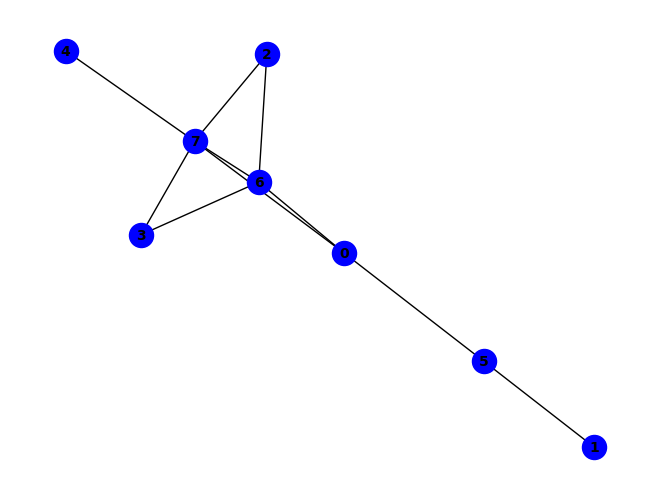


(~b & ~g) ^ (a & b & ~g) ^ (a & f & ~h) ^ (d & h & ~e) ^ (a & e & g & h) ^ (a & f & g & h) ^ (b & ~f & ~g) ^ (g & ~b & ~h) ^ (a & b & ~e & ~f) ^ (a & g & ~b & ~f) ^ (a & h & ~d & ~e) ^ (d & g & ~a & ~e) ^ (e & h & ~b & ~g) ^ (a & b & f & g & ~h) ^ (b & c & f & g & ~a) ^ (b & d & f & h & ~a) ^ (a & b & e & ~f & ~h) ^ (b & e & g & ~d & ~f) ^ (b & e & h & ~d & ~f) ^ (d & e & g & ~a & ~h) ^ (a & b & e & g & h & ~f) ^ (b & g & ~e & ~f & ~h) ^ (c & g & ~a & ~d & ~e) ^ (c & h & ~a & ~d & ~e) ^ (a & b & e & h & ~d & ~g) ^ (b & c & f & h & ~a & ~d) ^ (b & d & e & g & ~f & ~h) ^ (b & d & e & h & ~c & ~g) ^ (b & d & f & g & ~a & ~c) ^ (a & b & c & d & e & h & ~g) ^ (c & e & g & ~a & ~d & ~h) ^ (b & c & d & e & h & ~f & ~g) ^ (b & c & e & f & h & ~a & ~g) ^ (a & b & d & e & h & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

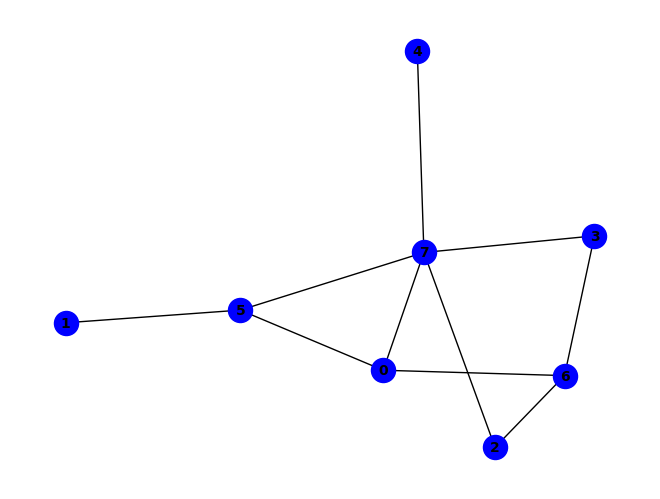


(f & ~h) ^ (~b & ~f) ^ (a & f & ~g) ^ (a & h & ~e) ^ (b & h & ~f) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (b & ~d & ~h) ^ (a & b & f & ~h) ^ (a & c & g & ~d) ^ (a & g & ~d & ~h) ^ (c & g & ~b & ~h) ^ (d & g & ~c & ~h) ^ (a & c & f & h & ~d) ^ (b & c & d & f & ~h) ^ (a & c & h & ~d & ~g) ^ (b & c & g & ~f & ~h) ^ (b & d & g & ~f & ~h) ^ (a & b & c & d & g & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & d & f & g & ~h) ^ (b & d & ~c & ~g & ~h) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (a & b & c & d & ~f & ~h) ^ (a & c & e & h & ~d & ~f) ^ (b & c & d & ~a & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


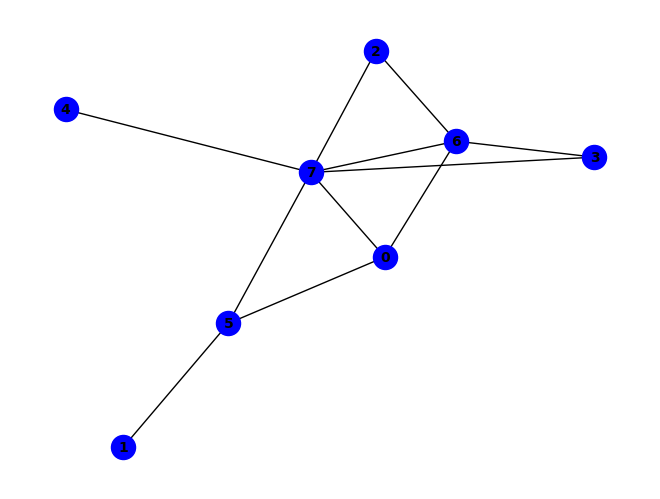


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (a & d & e & f & g) ^ (a & d & e & f & h) ^ (b & f & ~a & ~h) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (a & d & e & h & ~g) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (c & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (a & c & e & f & g & ~d) ^ (a & c & e & f & h & ~d) ^ (c & d & e & f & g & ~h) ^ (d & g & ~a & ~c & ~f) ^ (d & h & ~a & ~c & ~f) ^ (e & h & ~c & ~f & ~g) ^ (a & c & e & h & ~d & ~g) ^ (b & c & f & g & ~a & ~h) ^ (d & f & g & ~a & ~e & ~h) ^ (a & c & f & g & ~d & ~e & ~h) ^ (b & d & f & g & ~a & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


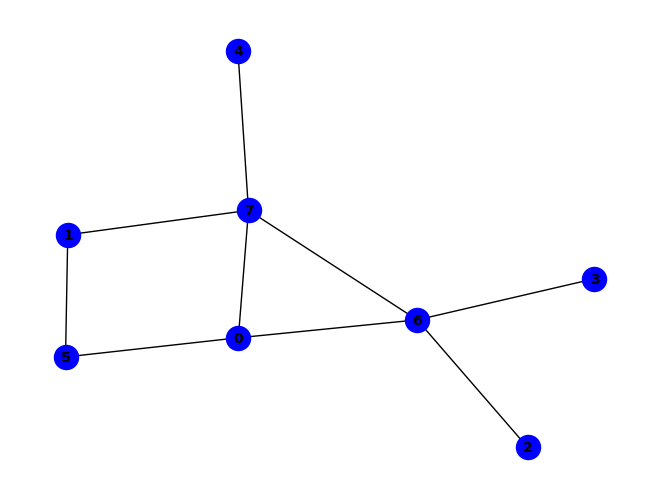


(a & f) ^ (a & g & ~f) ^ (a & h & ~f) ^ (a & f & g & h) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (a & c & g & ~h) ^ (b & e & g & ~a) ^ (b & e & h & ~a) ^ (~b & ~d & ~g) ^ (a & b & ~d & ~g) ^ (d & h & ~b & ~g) ^ (e & h & ~a & ~g) ^ (a & b & d & h & ~g) ^ (b & ~c & ~f & ~h) ^ (a & b & d & ~c & ~h) ^ (a & d & g & ~c & ~h) ^ (b & c & g & ~a & ~h) ^ (b & d & f & ~c & ~h) ^ (a & b & ~d & ~f & ~h) ^ (b & g & ~a & ~e & ~h) ^ (c & d & ~b & ~g & ~h) ^ (a & b & c & d & ~f & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & b & c & d & f & ~g & ~h) ^ (b & c & ~d & ~f & ~g & ~h) ^ (b & d & ~a & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


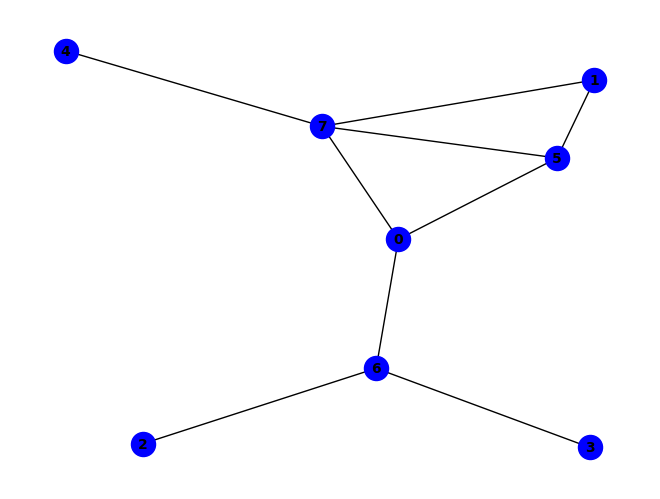


~f ^ (f & ~h) ^ (a & g & ~h) ^ (a & h & ~e) ^ (d & g & ~a) ^ (e & h & ~f) ^ (a & f & ~d & ~g) ^ (b & f & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & g & ~a & ~d) ^ (a & d & f & h & ~c) ^ (a & e & f & h & ~d) ^ (a & f & g & h & ~c) ^ (b & d & f & g & ~a) ^ (c & f & g & h & ~d) ^ (d & f & g & h & ~e) ^ (c & d & e & f & g & h) ^ (b & e & f & ~a & ~h) ^ (a & c & d & f & h & ~g) ^ (a & b & d & e & f & g & h) ^ (a & d & e & f & ~c & ~g) ^ (b & c & f & g & ~a & ~d) ^ (b & d & g & h & ~a & ~e) ^ (c & e & g & h & ~a & ~f) ^ (d & e & g & h & ~a & ~c) ^ (a & b & c & d & e & f & ~g) ^ (a & c & d & e & f & h & ~b) ^ (b & c & e & f & g & h & ~a) ^ (b & d & e & f & g & h & ~c) ^ (a & d & f & ~e & ~g & ~h) ^ (b & c & g & h & ~a & ~d & ~e) ^ (a & c & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

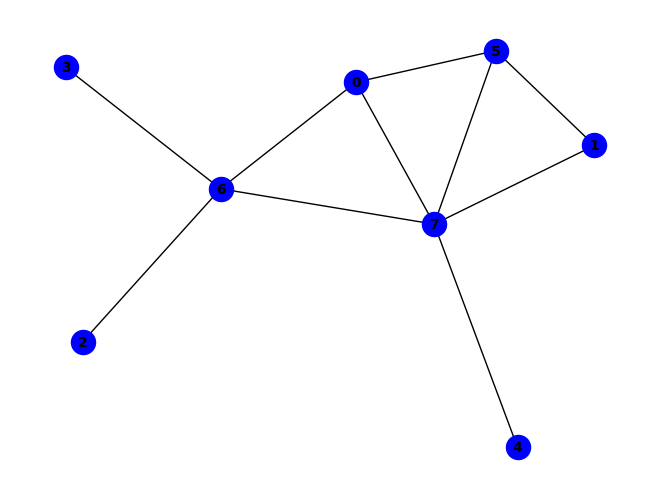


(~d & ~g) ^ (a & f & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (a & b & f & ~h) ^ (a & b & h & ~f) ^ (a & e & f & ~h) ^ (b & d & f & ~g) ^ (b & d & f & ~h) ^ (b & e & f & ~g) ^ (a & g & ~b & ~f) ^ (b & f & ~e & ~h) ^ (c & d & ~g & ~h) ^ (d & h & ~b & ~g) ^ (e & h & ~f & ~g) ^ (a & e & g & h & ~f) ^ (b & e & f & g & ~h) ^ (a & c & g & ~d & ~h) ^ (a & d & g & ~b & ~h) ^ (b & e & h & ~a & ~g) ^ (a & b & e & f & h & ~g) ^ (b & h & ~d & ~f & ~g) ^ (a & b & g & ~d & ~f & ~h) ^ (b & c & f & g & ~a & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


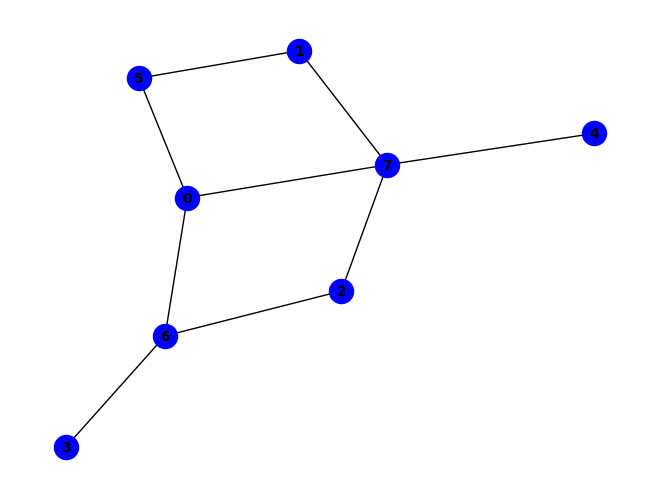


~e ^ (e & ~h) ^ (a & f & ~g) ^ (a & h & ~f) ^ (b & f & ~d) ^ (b & h & ~f) ^ (a & f & g & h) ^ (a & b & h & ~e) ^ (a & c & h & ~e) ^ (a & e & h & ~d) ^ (b & e & h & ~d) ^ (a & b & c & f & h) ^ (a & b & d & e & h) ^ (a & g & ~c & ~h) ^ (c & g & ~b & ~h) ^ (c & h & ~b & ~e) ^ (d & g & ~a & ~c) ^ (a & b & c & g & ~f) ^ (a & b & c & g & ~h) ^ (b & d & e & h & ~g) ^ (b & d & g & h & ~f) ^ (d & e & g & h & ~c) ^ (a & c & d & e & g & h) ^ (a & b & f & ~d & ~h) ^ (b & c & g & ~f & ~h) ^ (b & d & f & ~c & ~g) ^ (a & b & c & e & h & ~d) ^ (a & b & d & g & h & ~c) ^ (b & c & d & f & h & ~g) ^ (b & c & d & g & h & ~e) ^ (a & b & c & h & ~f & ~g) ^ (a & d & e & h & ~b & ~g) ^ (b & c & d & f & ~a & ~h) ^ (a & b & c & d & e & h & ~g) ^ (a & b & d & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

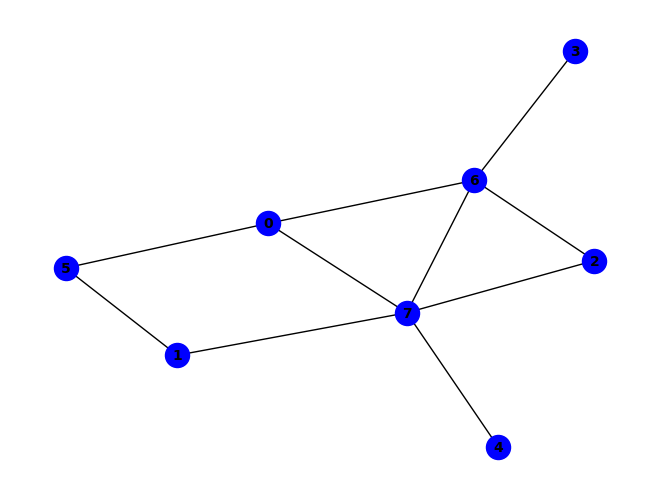


(a & f & ~h) ^ (a & g & ~f) ^ (a & e & g & h) ^ (a & f & g & h) ^ (d & ~c & ~h) ^ (g & ~b & ~h) ^ (a & c & g & ~e) ^ (a & b & c & f & g) ^ (a & b & c & f & h) ^ (~b & ~d & ~g) ^ (a & b & ~d & ~g) ^ (a & h & ~c & ~e) ^ (c & g & ~b & ~e) ^ (c & h & ~b & ~e) ^ (d & h & ~b & ~g) ^ (e & h & ~b & ~g) ^ (a & b & d & h & ~g) ^ (a & b & e & g & ~c) ^ (a & b & e & h & ~c) ^ (b & ~c & ~f & ~h) ^ (a & b & d & ~c & ~h) ^ (a & b & g & ~e & ~h) ^ (a & d & g & ~c & ~h) ^ (b & d & f & ~c & ~h) ^ (a & b & ~d & ~f & ~h) ^ (c & d & ~b & ~g & ~h) ^ (a & b & c & d & ~f & ~g) ^ (a & b & c & d & ~f & ~h) ^ (a & b & c & d & ~g & ~h) ^ (c & e & g & ~a & ~b & ~h) ^ (b & c & ~d & ~f & ~g & ~h) ^ (b & d & ~a & ~f & ~g & ~h) ^ (a & b & c & h & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


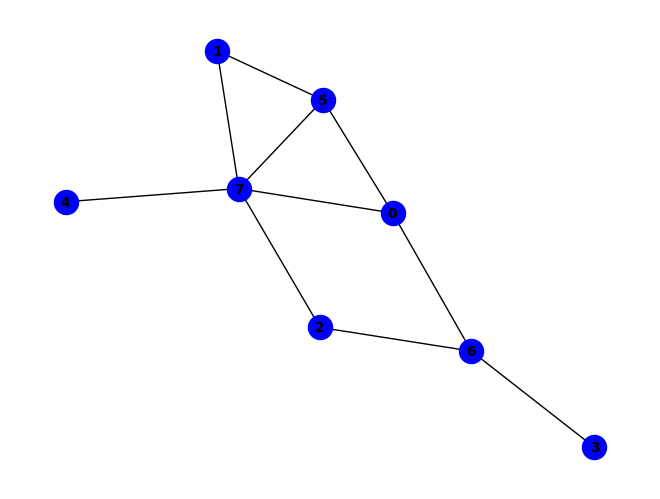


~f ^ (f & ~h) ^ (b & h & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & f & g & h) ^ (a & b & d & f & g) ^ (a & f & ~d & ~g) ^ (a & g & ~c & ~h) ^ (a & h & ~b & ~e) ^ (b & f & ~a & ~e) ^ (d & g & ~a & ~c) ^ (a & b & c & h & ~e) ^ (a & d & f & h & ~c) ^ (a & e & f & h & ~d) ^ (b & c & f & g & ~h) ^ (b & d & f & g & ~c) ^ (a & c & h & ~e & ~f) ^ (a & d & f & ~g & ~h) ^ (b & e & f & ~a & ~h) ^ (a & b & c & f & g & ~d) ^ (a & b & c & f & h & ~g) ^ (a & c & d & f & h & ~g) ^ (a & d & e & f & h & ~g) ^ (a & b & d & e & f & g & h) ^ (a & c & d & e & f & g & h) ^ (c & h & ~b & ~e & ~f) ^ (d & e & g & h & ~a & ~c) ^ (d & f & g & h & ~c & ~e) ^ (a & b & c & e & f & h & ~d) ^ (b & d & e & f & g & h & ~c) ^ (a & b & c & d & e & f & h & ~g) ^ (b & d & g & h & ~a & ~c & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

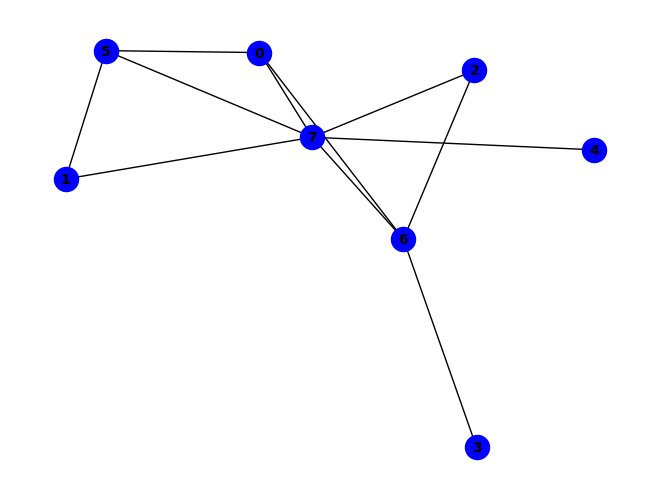


(g & ~h) ^ (~d & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & e & g & ~h) ^ (c & d & ~g & ~h) ^ (e & h & ~f & ~g) ^ (a & c & f & g & ~h) ^ (a & e & f & h & ~g) ^ (c & e & f & g & ~b) ^ (c & e & f & h & ~b) ^ (a & d & g & ~c & ~h) ^ (c & e & h & ~b & ~g) ^ (c & f & g & ~e & ~h) ^ (b & c & e & f & g & ~h) ^ (b & f & ~a & ~c & ~h) ^ (c & g & ~a & ~b & ~f) ^ (c & h & ~a & ~b & ~f) ^ (b & c & f & ~a & ~g & ~h) ^ (b & c & g & ~a & ~f & ~h) ^ (b & h & ~a & ~e & ~f & ~g) ^ (a & c & e & h & ~b & ~f & ~g) ^ (b & d & f & g & ~a & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


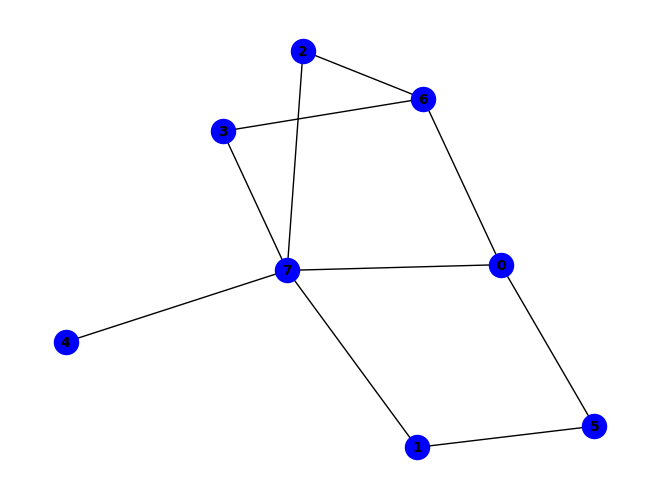


~e ^ (e & ~h) ^ (a & f & ~h) ^ (b & f & ~a) ^ (d & h & ~e) ^ (b & c & g & ~a) ^ (a & g & ~f & ~h) ^ (a & h & ~d & ~e) ^ (b & h & ~a & ~f) ^ (c & g & ~a & ~h) ^ (b & d & g & ~a & ~c) ^ (c & h & ~a & ~d & ~e) ^ (d & g & ~a & ~c & ~h) ^ (b & d & f & h & ~a & ~g) ^ (b & c & g & ~a & ~f & ~h) ^ (b & c & h & ~a & ~d & ~g) ^ (b & e & h & ~a & ~c & ~d) ^ (b & d & ~a & ~c & ~f & ~g) ^ (b & d & ~a & ~c & ~f & ~h) ^ (b & c & d & h & ~a & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


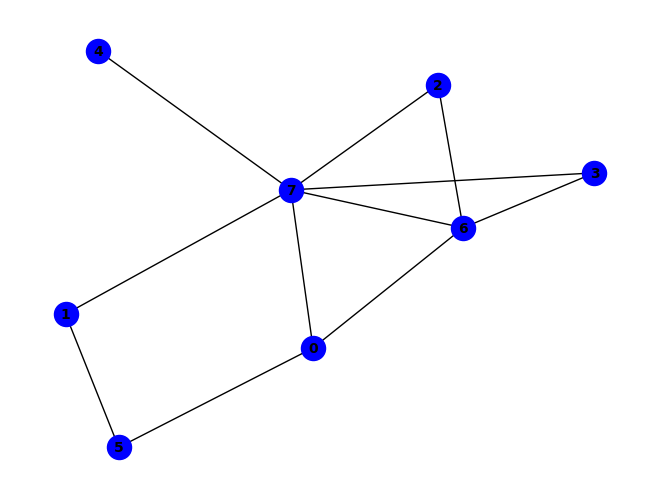


(~b & ~g) ^ (a & b & ~g) ^ (a & f & ~h) ^ (a & g & ~f) ^ (a & e & g & h) ^ (a & f & g & h) ^ (g & ~b & ~h) ^ (a & b & g & ~h) ^ (a & c & g & ~e) ^ (a & b & d & f & g) ^ (a & b & d & f & h) ^ (b & c & d & e & g) ^ (b & c & d & e & h) ^ (b & c & d & f & g) ^ (b & c & d & f & h) ^ (c & g & ~d & ~e) ^ (c & h & ~d & ~e) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (e & h & ~b & ~g) ^ (a & d & e & g & ~h) ^ (b & ~d & ~f & ~h) ^ (a & d & g & ~c & ~e) ^ (b & c & g & ~a & ~e) ^ (b & c & g & ~f & ~h) ^ (b & c & h & ~a & ~e) ^ (d & e & g & ~b & ~h) ^ (a & b & c & d & g & ~e) ^ (a & b & c & d & h & ~e) ^ (a & b & ~c & ~f & ~h) ^ (a & h & ~c & ~d & ~e) ^ (b & d & ~f & ~g & ~h) ^ (a & b & c & d & ~f & ~g) ^ (a & b & c & d & ~f & ~h) ^ (a & b & e & h & ~d & ~g) ^ (b & c & d & h & ~f & ~g) ^ (a & b & c & ~f & ~g & ~h) ^ (a & b & d & h & ~c & ~f & ~g) ^ (c & e & g & ~a & ~b & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

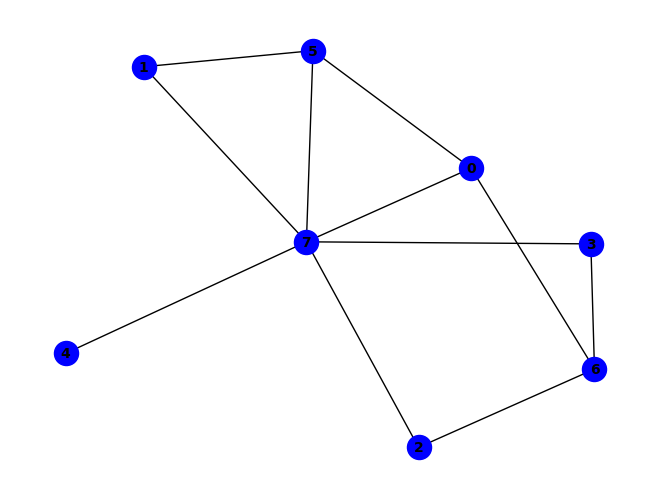


~f ^ (f & ~h) ^ (a & f & ~g) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (b & c & f & g) ^ (a & c & g & ~d) ^ (b & c & e & f & h) ^ (a & g & ~d & ~h) ^ (a & h & ~b & ~e) ^ (b & f & ~a & ~e) ^ (b & h & ~c & ~e) ^ (d & g & ~c & ~h) ^ (a & c & f & h & ~d) ^ (b & c & d & f & ~g) ^ (b & c & d & f & ~h) ^ (b & d & f & g & ~h) ^ (a & c & h & ~d & ~g) ^ (a & d & h & ~e & ~f) ^ (b & e & f & ~a & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & d & f & g & ~c) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & b & d & h & ~c & ~e) ^ (a & c & e & h & ~d & ~f) ^ (b & c & d & h & ~e & ~f) ^ (b & c & f & h & ~d & ~g) ^ (a & b & d & e & f & h & ~c) ^ (a & b & d & f & h & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


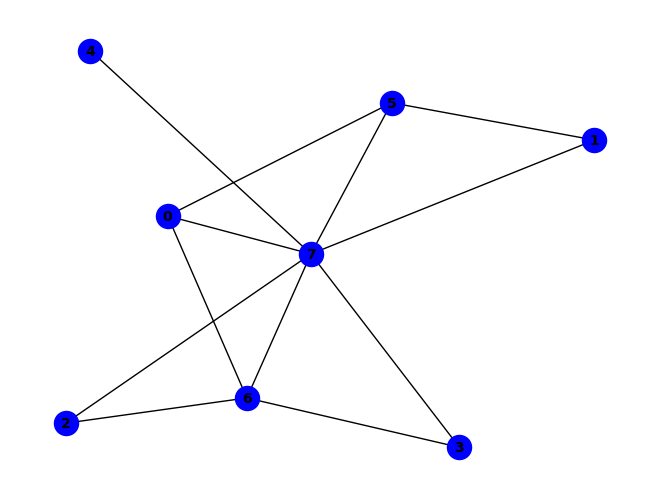


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (b & c & g & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & e & f & h & ~g) ^ (a & c & g & ~d & ~f) ^ (a & c & h & ~d & ~f) ^ (a & d & g & ~e & ~f) ^ (a & d & h & ~e & ~f) ^ (a & e & g & ~d & ~h) ^ (b & e & f & ~a & ~g) ^ (d & e & h & ~c & ~g) ^ (b & c & d & f & g & ~h) ^ (b & f & ~a & ~e & ~h) ^ (e & h & ~c & ~f & ~g) ^ (b & c & e & h & ~f & ~g) ^ (b & e & f & g & ~a & ~h) ^ (d & e & f & g & ~b & ~c) ^ (d & e & f & h & ~b & ~c) ^ (a & b & d & e & f & g & ~c) ^ (a & b & d & e & f & h & ~c) ^ (b & e & h & ~a & ~d & ~g) ^ (c & f & g & ~a & ~d & ~h) ^ (a & b & c & f & g & ~d & ~h) ^ (b & c & d & e & h & ~a & ~g) ^ (c & d & e & f & g & ~b & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (b & h & ~a & ~d & ~f & ~g) ^ (a & b & c & h & ~e & ~f & ~g) ^ (a & c & e & h & ~d & ~f & ~g) ^ (b & c & d & h & ~a & ~f & ~g) ^ (d & f & g & ~a & ~b & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PA

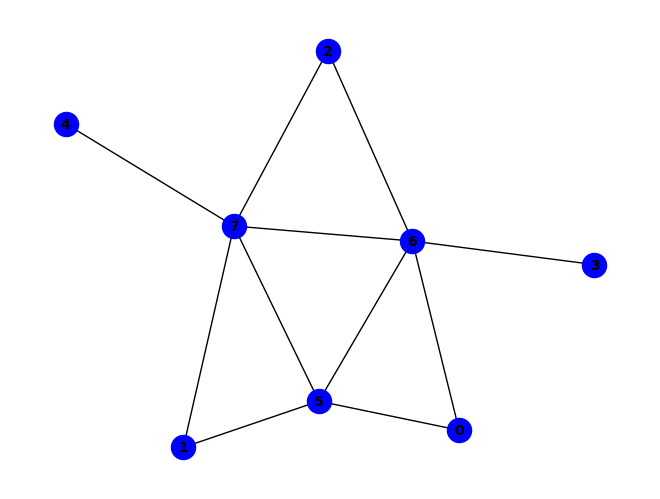


(~d & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (g & ~b & ~h) ^ (e & f & g & ~h) ^ (a & f & ~d & ~h) ^ (a & g & ~d & ~h) ^ (d & f & ~c & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~c & ~g) ^ (b & c & e & h & ~g) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & d & f & h & ~g) ^ (c & e & f & h & ~g) ^ (a & b & f & ~g & ~h) ^ (a & c & g & ~f & ~h) ^ (b & c & h & ~f & ~g) ^ (b & e & g & ~f & ~h) ^ (c & d & f & ~a & ~h) ^ (c & d & g & ~a & ~h) ^ (b & c & e & f & g & ~h) ^ (a & d & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


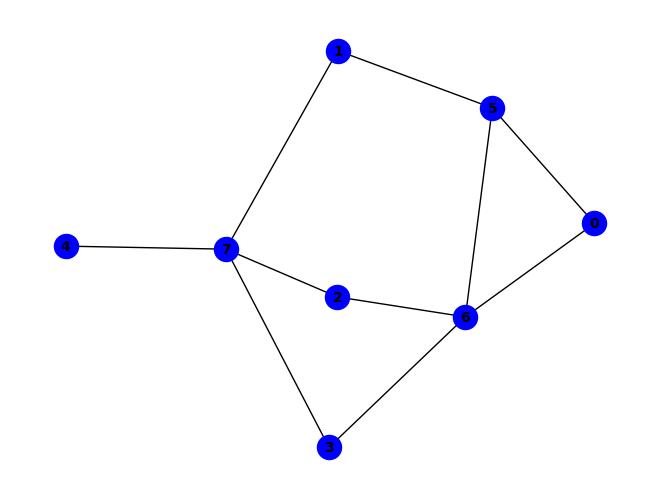


(d & f & g) ^ (~b & ~f) ^ (a & f & ~e) ^ (c & h & ~e) ^ (d & g & ~h) ^ (b & ~f & ~h) ^ (a & b & f & ~g) ^ (c & f & g & ~d) ^ (a & b & e & g & h) ^ (d & e & f & g & h) ^ (a & g & ~c & ~d) ^ (c & g & ~d & ~h) ^ (d & h & ~c & ~e) ^ (e & h & ~b & ~f) ^ (a & b & e & f & ~d) ^ (a & b & g & h & ~f) ^ (a & c & f & g & ~h) ^ (a & d & f & h & ~e) ^ (a & b & c & d & e & f) ^ (f & ~b & ~e & ~g) ^ (a & e & f & ~b & ~h) ^ (b & d & h & ~e & ~f) ^ (a & b & c & f & h & ~e) ^ (a & b & d & f & h & ~c) ^ (a & b & d & g & h & ~e) ^ (c & e & f & g & h & ~d) ^ (e & f & ~b & ~g & ~h) ^ (a & c & f & h & ~d & ~e) ^ (a & d & f & g & ~c & ~h) ^ (a & e & g & h & ~c & ~d) ^ (b & c & f & h & ~e & ~g) ^ (b & c & h & ~d & ~e & ~f) ^ (a & b & c & g & h & ~d & ~e) ^ (a & b & d & e & f & ~c & ~h) ^ (b & d & f & h & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

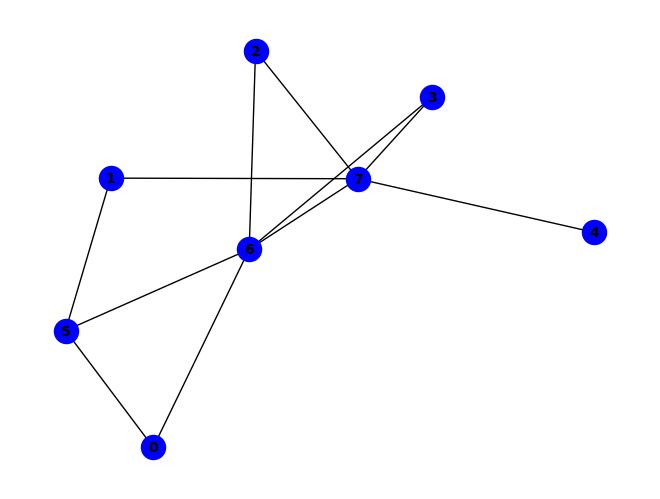


(g & ~h) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & ~d & ~h) ^ (~a & ~f & ~g) ^ (a & f & ~b & ~g) ^ (b & f & ~g & ~h) ^ (d & f & ~g & ~h) ^ (d & g & ~c & ~e) ^ (d & h & ~c & ~e) ^ (e & h & ~c & ~g) ^ (f & h & ~c & ~g) ^ (c & d & f & g & ~h) ^ (a & ~d & ~f & ~h) ^ (a & e & h & ~d & ~g) ^ (d & e & g & ~c & ~h) ^ (a & d & ~f & ~g & ~h) ^ (a & h & ~e & ~f & ~g) ^ (a & c & f & h & ~e & ~g) ^ (a & d & e & h & ~f & ~g) ^ (a & d & f & h & ~c & ~g) ^ (a & c & g & ~d & ~f & ~h) ^ (a & b & c & f & h & ~d & ~g) ^ (a & b & d & f & h & ~e & ~g) ^ (a & b & e & f & h & ~c & ~g) ^ (b & h & ~c & ~d & ~e & ~g) ^ (a & c & d & e & f & h & ~b & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


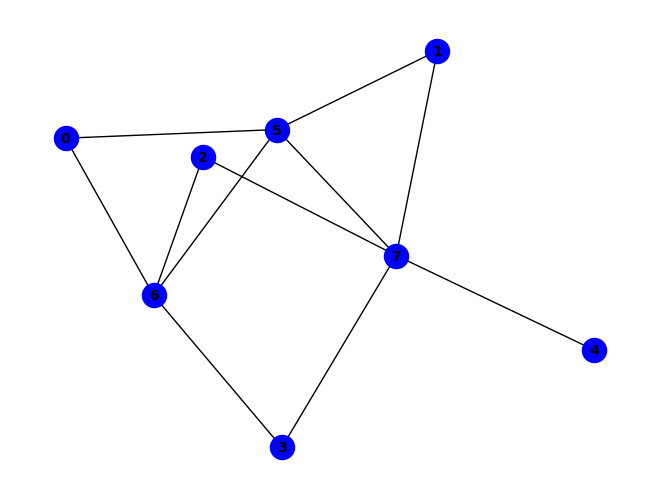


~e ^ (a & g & ~d) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (a & d & f & g) ^ (a & e & f & g) ^ (a & f & g & h) ^ (e & ~d & ~h) ^ (a & c & g & ~f) ^ (d & e & f & ~h) ^ (a & f & ~e & ~h) ^ (c & g & ~f & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~f & ~h) ^ (d & h & ~b & ~f) ^ (a & e & g & h & ~d) ^ (b & c & d & h & ~f) ^ (c & d & e & h & ~f) ^ (c & d & g & ~a & ~f) ^ (c & d & h & ~f & ~g) ^ (a & c & e & g & h & ~f) ^ (a & d & e & f & h & ~c) ^ (a & b & c & d & e & f & h) ^ (b & f & ~a & ~g & ~h) ^ (b & h & ~c & ~e & ~f) ^ (a & d & e & f & ~c & ~g) ^ (b & d & e & h & ~c & ~f) ^ (a & b & c & d & e & f & ~g) ^ (a & b & c & d & g & h & ~f) ^ (a & c & d & e & g & h & ~b) ^ (a & e & f & ~d & ~g & ~h) ^ (a & b & c & g & h & ~e & ~f) ^ (a & b & g & h & ~d & ~e & ~f) ^ (a & c & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

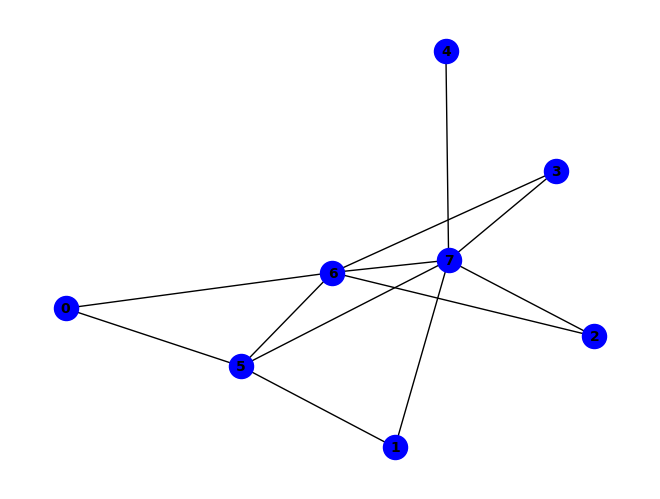


(g & ~h) ^ (~a & ~g) ^ (b & f & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & d & ~f & ~g) ^ (a & h & ~d & ~g) ^ (b & h & ~e & ~g) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~d & ~g) ^ (a & d & f & h & ~g) ^ (b & d & e & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & ~d & ~f & ~h) ^ (a & b & f & ~g & ~h) ^ (b & c & h & ~f & ~g) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (b & e & f & h & ~d & ~g) ^ (c & d & e & h & ~b & ~g) ^ (b & c & d & e & f & h & ~g) ^ (a & c & g & ~d & ~f & ~h) ^ (b & d & h & ~c & ~f & ~g) ^ (c & e & h & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


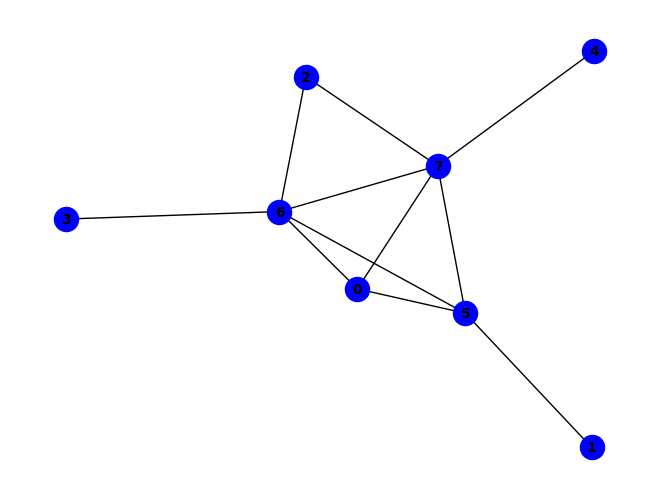


(g & ~h) ^ (~d & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (a & d & f & ~h) ^ (a & d & g & ~h) ^ (a & f & g & ~h) ^ (e & f & g & ~h) ^ (a & f & ~d & ~g) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (d & f & ~c & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~c & ~g) ^ (a & c & d & f & ~g) ^ (a & c & e & g & ~f) ^ (a & c & e & h & ~f) ^ (a & d & f & h & ~g) ^ (a & e & f & h & ~g) ^ (c & e & f & h & ~g) ^ (a & e & g & ~c & ~h) ^ (c & d & f & ~a & ~h) ^ (c & d & g & ~a & ~h) ^ (a & c & e & f & g & ~h) ^ (b & f & ~a & ~g & ~h) ^ (c & d & f & h & ~a & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


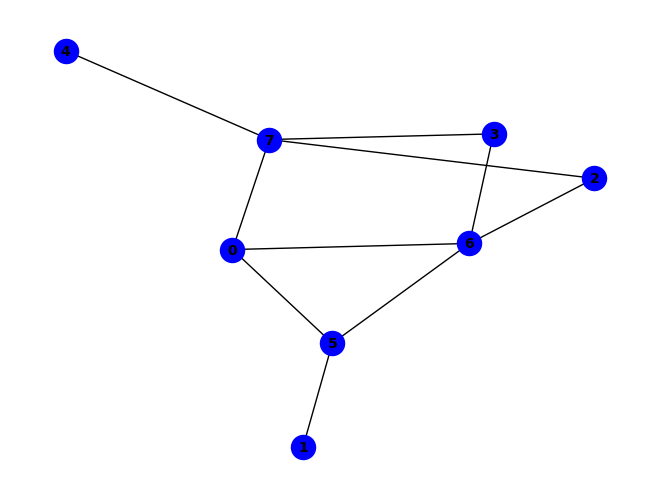


(~b & ~f) ^ (c & h & ~e) ^ (b & d & f & h) ^ (b & ~a & ~g) ^ (f & ~e & ~g) ^ (a & f & g & ~d) ^ (c & f & g & ~d) ^ (d & f & g & ~b) ^ (a & c & d & f & g) ^ (a & e & f & g & h) ^ (a & b & ~f & ~g) ^ (a & f & ~g & ~h) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~e) ^ (b & g & ~e & ~f) ^ (c & g & ~d & ~h) ^ (d & g & ~b & ~h) ^ (d & h & ~c & ~e) ^ (e & f & ~g & ~h) ^ (e & h & ~b & ~f) ^ (a & c & e & h & ~f) ^ (b & c & f & h & ~g) ^ (a & c & g & ~b & ~f) ^ (a & c & h & ~b & ~g) ^ (b & e & h & ~d & ~g) ^ (a & b & c & d & g & ~e) ^ (a & b & d & f & h & ~g) ^ (a & c & e & f & h & ~g) ^ (c & e & f & g & h & ~d) ^ (d & e & f & g & h & ~a) ^ (a & c & d & e & f & g & h) ^ (a & b & c & h & ~e & ~f) ^ (a & c & d & g & ~b & ~h) ^ (a & c & d & h & ~b & ~e) ^ (b & c & d & g & ~a & ~f) ^ (b & c & d & h & ~a & ~f) ^ (b & c & d & h & ~e & ~g) ^ (b & c & e & g & ~d & ~f) ^ (b & c & e & h & ~a & ~g) ^ (b & c & e & h & ~d & ~f) ^ (b & d & e & h & ~f & ~g) ^ (a & b & c & d & e & g & ~f) ^ (a & b & c & d & e & g & ~h

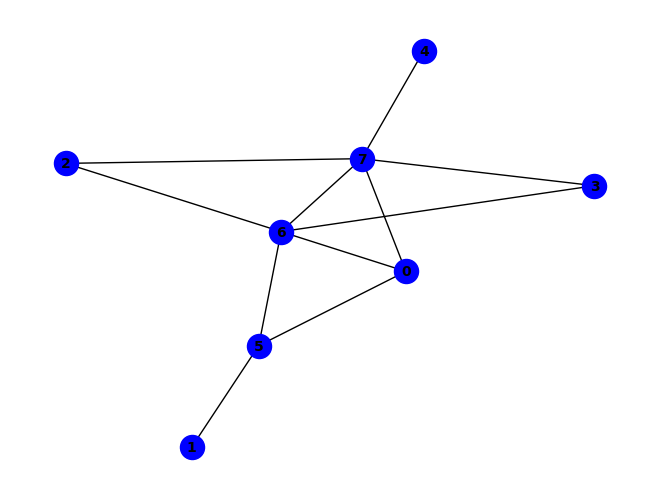


(g & ~h) ^ (~f & ~g) ^ (b & f & ~a & ~g) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~e) ^ (d & h & ~c & ~e) ^ (e & h & ~c & ~g) ^ (f & h & ~c & ~g) ^ (a & c & f & g & ~h) ^ (f & ~a & ~d & ~h) ^ (b & c & g & ~f & ~h) ^ (b & c & h & ~e & ~g) ^ (d & e & g & ~c & ~h) ^ (a & b & e & f & h & ~g) ^ (a & g & ~c & ~d & ~e) ^ (a & h & ~c & ~d & ~e) ^ (d & f & ~a & ~g & ~h) ^ (b & d & f & h & ~c & ~g) ^ (b & e & f & h & ~d & ~g) ^ (c & d & f & g & ~a & ~h) ^ (a & b & c & d & f & h & ~g) ^ (a & e & g & ~c & ~d & ~h) ^ (a & b & c & f & h & ~e & ~g) ^ (a & b & d & f & h & ~e & ~g) ^ (b & c & d & e & h & ~a & ~g) ^ (b & c & e & h & ~d & ~f & ~g) ^ (a & b & c & d & e & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


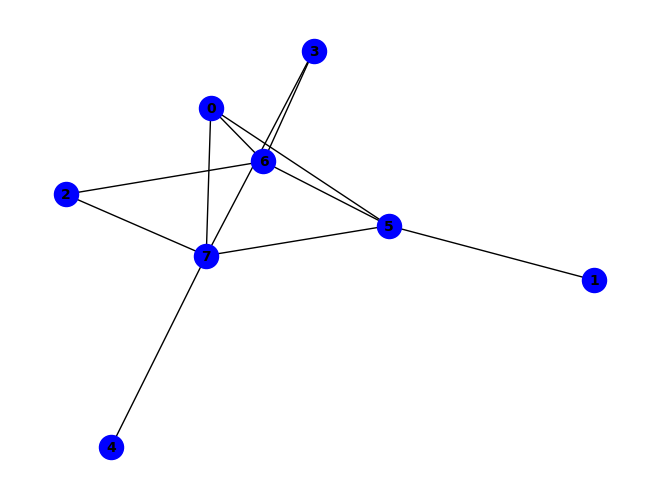


~e ^ (a & f & ~e) ^ (a & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (c & d & g & ~f) ^ (d & e & f & ~h) ^ (a & g & ~d & ~h) ^ (c & g & ~f & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~f & ~h) ^ (d & h & ~a & ~f) ^ (a & c & e & h & ~f) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (a & d & f & g & ~h) ^ (c & d & e & h & ~f) ^ (a & c & g & ~d & ~f) ^ (a & e & f & ~d & ~h) ^ (c & d & h & ~f & ~g) ^ (a & c & d & e & f & ~h) ^ (b & f & ~a & ~g & ~h) ^ (a & c & h & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


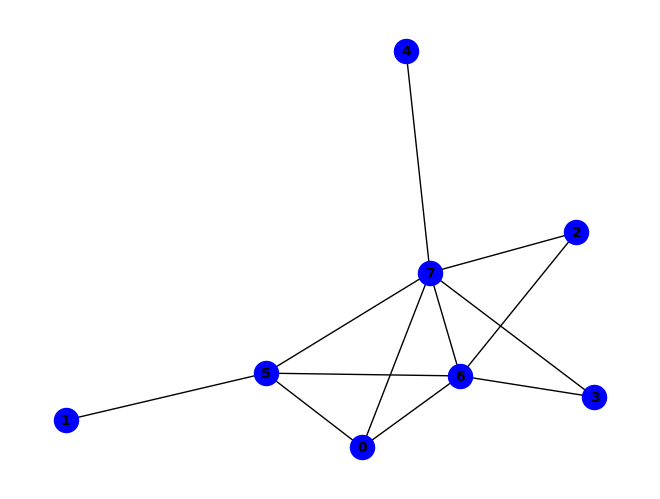


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & e & g & ~h) ^ (a & f & g & ~h) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (e & h & ~d & ~g) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (b & f & ~a & ~g & ~h) ^ (d & g & ~a & ~c & ~f) ^ (d & h & ~a & ~c & ~f) ^ (a & d & e & h & ~f & ~g) ^ (c & d & e & h & ~a & ~g) ^ (a & c & d & e & f & h & ~g) ^ (c & e & h & ~a & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


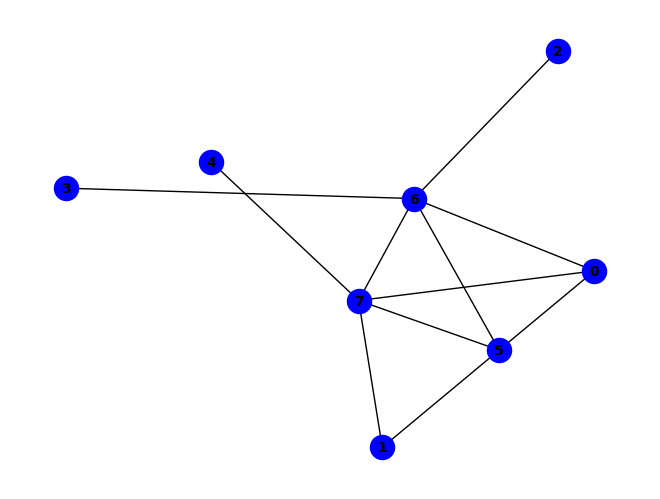


(~d & ~g) ^ (a & f & ~e) ^ (a & g & ~f) ^ (a & h & ~e) ^ (e & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (g & ~c & ~h) ^ (a & b & h & ~g) ^ (a & e & f & ~h) ^ (c & f & g & ~h) ^ (e & f & g & ~h) ^ (b & f & ~a & ~g) ^ (b & h & ~e & ~g) ^ (d & f & ~c & ~g) ^ (d & h & ~f & ~g) ^ (a & b & e & h & ~f) ^ (a & e & f & g & ~b) ^ (a & e & g & h & ~b) ^ (b & e & f & h & ~g) ^ (c & d & f & h & ~g) ^ (a & c & g & ~f & ~h) ^ (a & d & g & ~f & ~h) ^ (a & f & g & ~e & ~h) ^ (c & d & f & ~a & ~h) ^ (c & d & g & ~a & ~h) ^ (a & b & e & f & g & ~h) ^ (a & c & d & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


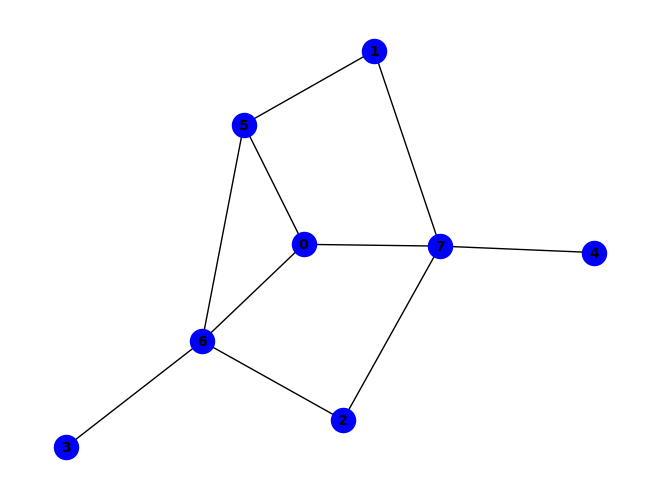


(~b & ~f) ^ (a & g & ~h) ^ (a & h & ~e) ^ (c & g & ~h) ^ (c & h & ~e) ^ (a & e & f & g) ^ (a & f & g & h) ^ (b & ~f & ~h) ^ (a & c & g & ~d) ^ (a & c & h & ~g) ^ (a & d & g & ~f) ^ (c & f & g & ~a) ^ (a & c & d & f & g) ^ (c & e & f & g & h) ^ (a & f & ~e & ~h) ^ (d & g & ~c & ~f) ^ (e & h & ~b & ~f) ^ (a & c & e & h & ~f) ^ (f & ~b & ~e & ~g) ^ (a & b & f & ~e & ~g) ^ (b & c & h & ~e & ~f) ^ (a & c & e & f & h & ~g) ^ (a & d & e & f & h & ~c) ^ (a & d & e & g & h & ~c) ^ (e & f & ~b & ~g & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & d & e & f & ~c & ~g) ^ (d & e & g & h & ~c & ~f) ^ (a & b & h & ~c & ~e & ~f) ^ (a & e & f & ~d & ~g & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (b & c & f & h & ~a & ~e & ~g) ^ (b & d & g & h & ~a & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


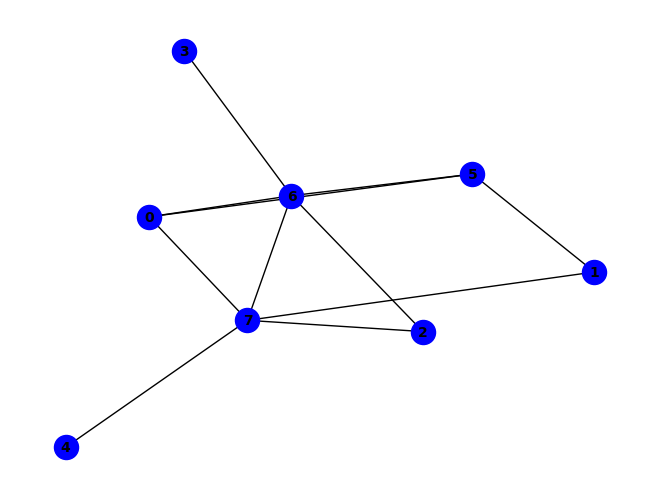


(~f & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (g & ~d & ~h) ^ (c & d & g & ~h) ^ (a & g & ~c & ~e) ^ (a & h & ~c & ~e) ^ (e & h & ~c & ~g) ^ (f & h & ~c & ~g) ^ (a & c & f & g & ~h) ^ (f & ~a & ~d & ~h) ^ (a & d & g & ~c & ~h) ^ (a & e & g & ~c & ~h) ^ (c & d & f & ~a & ~h) ^ (b & f & ~a & ~g & ~h) ^ (b & h & ~a & ~c & ~e & ~g) ^ (d & f & ~a & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


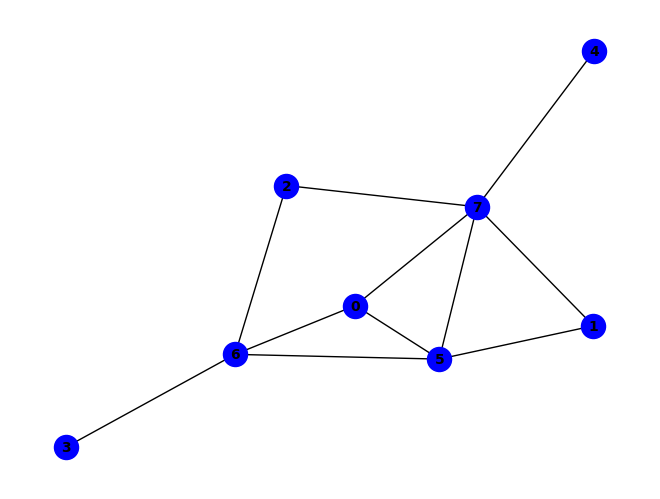


~e ^ (d & e & g) ^ (a & f & ~e) ^ (a & g & ~h) ^ (b & f & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & d & g & ~f) ^ (a & b & f & g & h) ^ (a & d & e & f & g) ^ (d & e & f & g & h) ^ (a & h & ~b & ~e) ^ (c & g & ~f & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~c & ~f) ^ (f & g & ~b & ~h) ^ (a & b & c & h & ~f) ^ (b & d & e & h & ~f) ^ (a & b & f & ~d & ~g) ^ (a & c & g & ~d & ~f) ^ (a & c & h & ~f & ~g) ^ (a & e & f & ~d & ~h) ^ (b & d & e & ~f & ~g) ^ (a & b & d & f & h & ~c) ^ (a & b & e & f & h & ~d) ^ (a & d & e & g & h & ~c) ^ (a & b & c & d & e & f & h) ^ (a & c & d & e & f & g & h) ^ (b & h & ~c & ~e & ~f) ^ (d & e & ~b & ~g & ~h) ^ (a & c & e & h & ~b & ~f) ^ (a & d & e & f & ~g & ~h) ^ (b & d & e & f & ~g & ~h) ^ (b & d & g & h & ~c & ~f) ^ (a & b & d & e & f & h & ~g) ^ (a & b & c & d & f & ~e & ~g) ^ (a & b & d & g & h & ~c & ~e) ^ (c & d & e & g & h & ~b & ~f) ^ (a & b & d & f & ~c & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

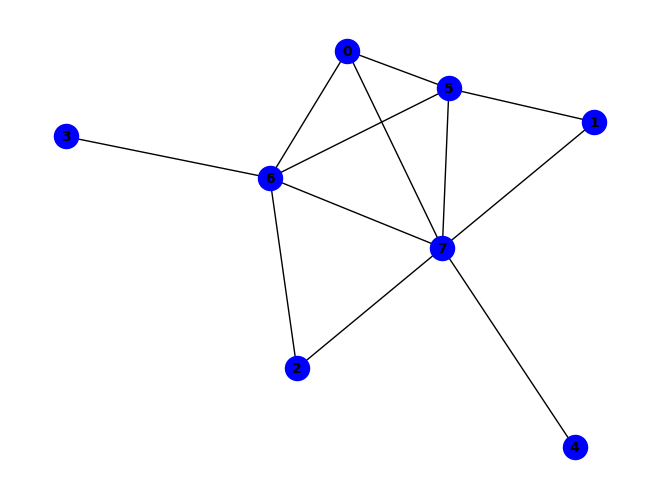


(~d & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (g & ~b & ~h) ^ (a & d & f & ~h) ^ (a & f & g & ~h) ^ (c & d & g & ~h) ^ (e & f & g & ~h) ^ (a & f & ~d & ~g) ^ (b & f & ~a & ~g) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (d & f & ~c & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~c & ~g) ^ (a & c & d & f & ~g) ^ (a & c & e & g & ~f) ^ (a & c & e & h & ~f) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & d & f & h & ~g) ^ (c & e & f & h & ~g) ^ (a & b & h & ~e & ~g) ^ (a & d & g & ~c & ~h) ^ (a & e & g & ~c & ~h) ^ (b & e & g & ~f & ~h) ^ (c & d & f & ~a & ~h) ^ (a & c & e & f & g & ~h) ^ (b & c & e & f & g & ~h) ^ (a & d & f & h & ~c & ~g) ^ (a & e & f & h & ~b & ~g) ^ (b & c & e & h & ~a & ~g) ^ (a & b & c & e & f & h & ~g) ^ (b & c & h & ~a & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

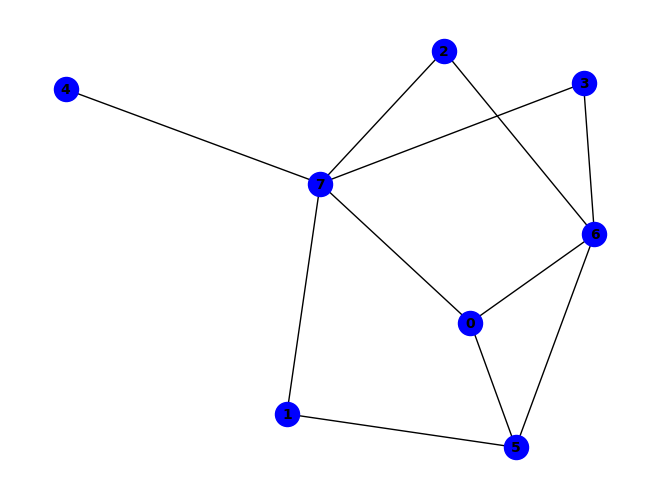


(~b & ~f) ^ (a & f & ~h) ^ (d & g & ~h) ^ (a & c & f & g) ^ (b & ~f & ~h) ^ (a & c & g & ~h) ^ (c & f & g & ~d) ^ (d & f & g & ~a) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~e) ^ (c & g & ~d & ~h) ^ (c & h & ~a & ~e) ^ (d & h & ~c & ~e) ^ (e & h & ~b & ~f) ^ (a & c & d & g & ~f) ^ (a & c & d & h & ~g) ^ (a & f & g & h & ~e) ^ (a & c & e & f & g & h) ^ (f & ~b & ~e & ~g) ^ (a & b & f & ~e & ~g) ^ (b & d & h & ~e & ~f) ^ (a & c & d & e & h & ~f) ^ (c & e & f & g & h & ~d) ^ (d & e & f & g & h & ~a) ^ (e & f & ~b & ~g & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & c & d & e & f & h & ~g) ^ (b & c & h & ~d & ~e & ~f) ^ (b & c & f & h & ~a & ~e & ~g) ^ (a & b & h & ~c & ~d & ~e & ~f) ^ (b & d & f & h & ~a & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


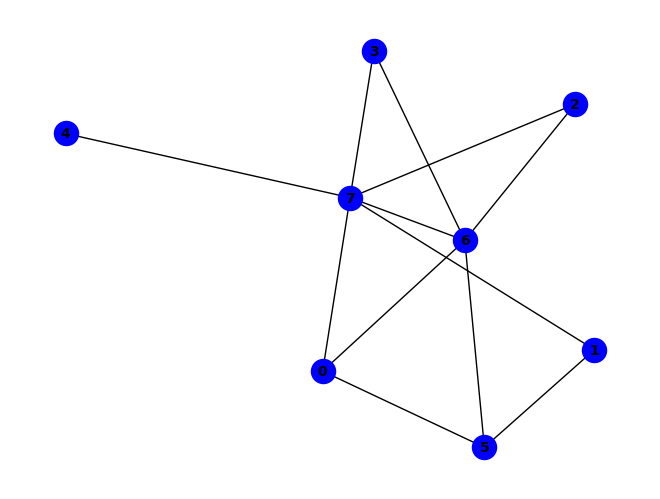


(g & ~h) ^ (~f & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (d & g & ~c & ~e) ^ (d & h & ~c & ~e) ^ (e & h & ~c & ~g) ^ (f & h & ~c & ~g) ^ (c & d & f & g & ~h) ^ (f & ~a & ~d & ~h) ^ (d & e & g & ~c & ~h) ^ (a & g & ~c & ~d & ~e) ^ (a & h & ~c & ~d & ~e) ^ (b & f & ~a & ~g & ~h) ^ (d & f & ~a & ~g & ~h) ^ (a & c & f & g & ~d & ~h) ^ (a & e & g & ~c & ~d & ~h) ^ (b & h & ~a & ~c & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


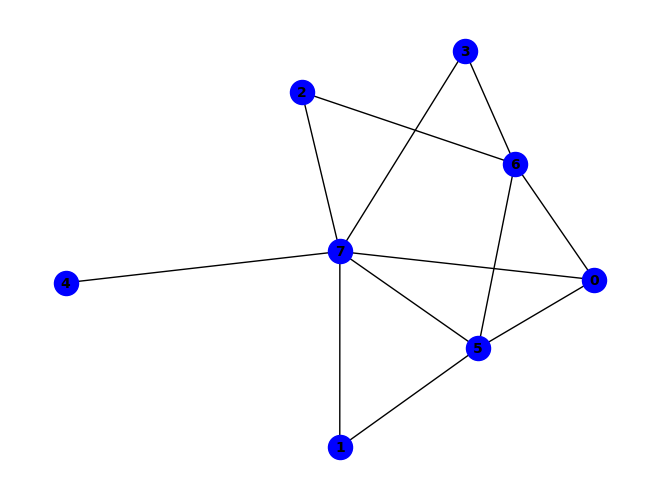


~e ^ (a & f & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & b & f & ~g) ^ (a & c & g & ~f) ^ (c & d & g & ~f) ^ (d & e & f & ~h) ^ (a & b & e & f & h) ^ (a & b & f & g & h) ^ (a & g & ~d & ~h) ^ (a & h & ~b & ~e) ^ (b & f & ~g & ~h) ^ (c & g & ~f & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~f & ~h) ^ (d & h & ~b & ~f) ^ (a & c & e & h & ~f) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (a & d & f & g & ~h) ^ (c & d & e & h & ~f) ^ (a & b & c & d & e & f) ^ (a & b & c & d & e & h) ^ (a & c & h & ~f & ~g) ^ (a & d & h & ~c & ~f) ^ (a & e & f & ~d & ~h) ^ (c & d & h & ~f & ~g) ^ (b & h & ~c & ~e & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & b & d & h & ~e & ~f) ^ (a & c & d & g & ~f & ~h) ^ (b & c & d & h & ~a & ~f) ^ (b & d & e & h & ~c & ~f) ^ (a & c & d & e & f & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


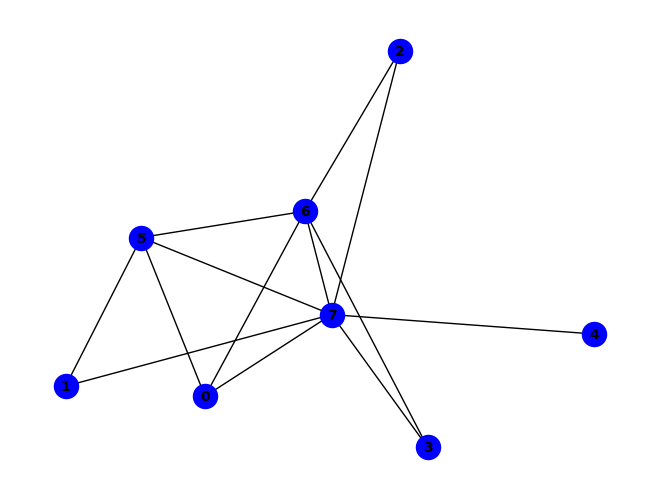


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (b & f & ~a & ~g) ^ (b & h & ~e & ~g) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (e & h & ~d & ~g) ^ (a & b & e & g & ~f) ^ (a & b & e & h & ~f) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & h & ~d & ~g) ^ (a & e & g & ~b & ~h) ^ (a & f & g & ~e & ~h) ^ (e & f & g & ~d & ~h) ^ (a & b & d & f & h & ~g) ^ (a & d & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (d & g & ~a & ~c & ~f) ^ (d & h & ~a & ~c & ~f) ^ (a & d & e & h & ~c & ~g) ^ (b & d & e & h & ~a & ~g) ^ (b & e & f & h & ~d & ~g) ^ (c & d & e & h & ~b & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & d & e & f & g & ~c) ^ (a & b & d & e & f & h & ~c) ^ (a & c & d & e & f & h & ~g) ^ (b & c & d & e & f & h & ~g) ^ (b & c & h & ~a & ~f & ~g) ^ (b & d & h & ~c & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (a & b & e & f & g & ~d & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (c & e & h & ~a & ~

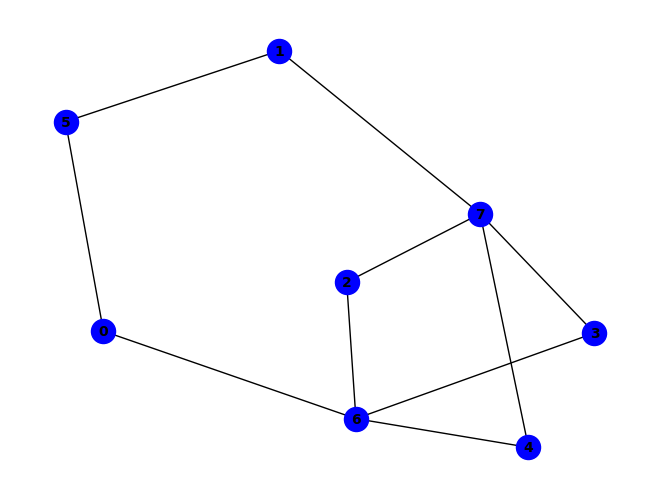


~d ^ (a & f & ~g) ^ (b & f & ~a) ^ (b & h & ~f) ^ (e & h & ~d) ^ (d & ~g & ~h) ^ (b & c & h & ~e) ^ (b & d & h & ~e) ^ (b & e & g & ~d) ^ (a & b & f & g & h) ^ (a & g & ~b & ~e) ^ (c & h & ~d & ~e) ^ (e & g & ~d & ~h) ^ (b & c & d & g & ~e) ^ (b & c & d & h & ~g) ^ (b & d & f & g & ~h) ^ (b & e & f & h & ~g) ^ (a & b & c & d & e & g) ^ (a & b & g & ~e & ~h) ^ (a & b & d & e & g & ~h) ^ (a & c & d & f & g & ~b) ^ (b & c & d & e & h & ~a) ^ (b & d & e & g & h & ~c) ^ (b & e & ~d & ~f & ~g) ^ (b & e & ~d & ~f & ~h) ^ (c & g & ~d & ~e & ~h) ^ (a & c & d & h & ~b & ~f) ^ (a & c & d & h & ~b & ~g) ^ (a & c & f & h & ~b & ~e) ^ (a & d & f & h & ~b & ~e) ^ (a & e & f & h & ~b & ~g) ^ (b & c & f & g & ~e & ~h) ^ (b & d & e & h & ~f & ~g) ^ (a & b & c & d & e & f & ~g) ^ (a & b & c & d & e & f & ~h) ^ (a & c & d & e & f & h & ~b) ^ (a & c & g & ~b & ~e & ~h) ^ (a & d & g & ~b & ~e & ~f) ^ (a & b & e & f & g & ~d & ~h) ^ (a & c & d & e & g & ~b & ~h) ^ (a & b & c & g & ~e & ~f & ~h) ^ (a & b & d

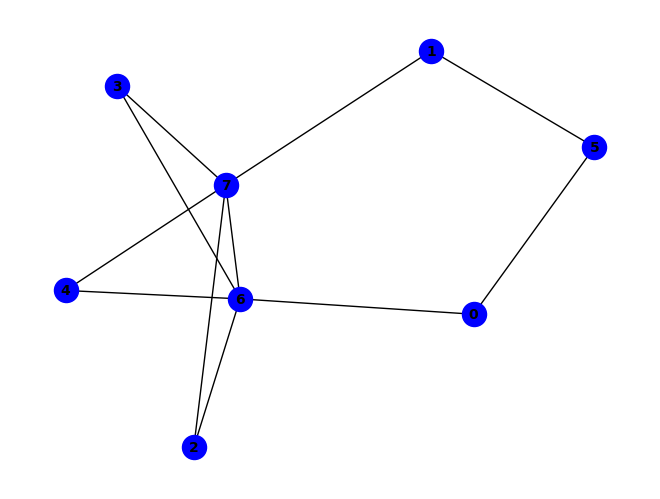


(~b & ~g) ^ (c & g & ~d) ^ (e & g & ~c) ^ (e & h & ~b) ^ (a & e & f & g) ^ (b & e & g & ~a) ^ (a & b & e & f & h) ^ (a & f & ~b & ~g) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (a & b & e & g & ~f) ^ (a & d & f & h & ~c) ^ (a & e & f & h & ~d) ^ (c & d & e & g & ~a) ^ (a & c & d & e & f & h) ^ (b & ~e & ~f & ~h) ^ (g & ~a & ~b & ~h) ^ (a & b & g & ~f & ~h) ^ (b & c & g & ~d & ~e) ^ (a & c & d & f & g & ~b) ^ (a & b & c & d & e & f & g) ^ (b & e & ~f & ~g & ~h) ^ (c & h & ~b & ~d & ~e) ^ (a & c & f & g & ~b & ~e) ^ (a & c & f & h & ~b & ~e) ^ (a & d & f & g & ~b & ~e) ^ (a & c & d & e & g & h & ~f) ^ (a & c & g & ~e & ~f & ~h) ^ (a & d & g & ~c & ~f & ~h) ^ (a & e & g & ~d & ~f & ~h) ^ (b & c & g & ~e & ~f & ~h) ^ (a & b & d & f & h & ~c & ~e) ^ (b & d & g & ~c & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

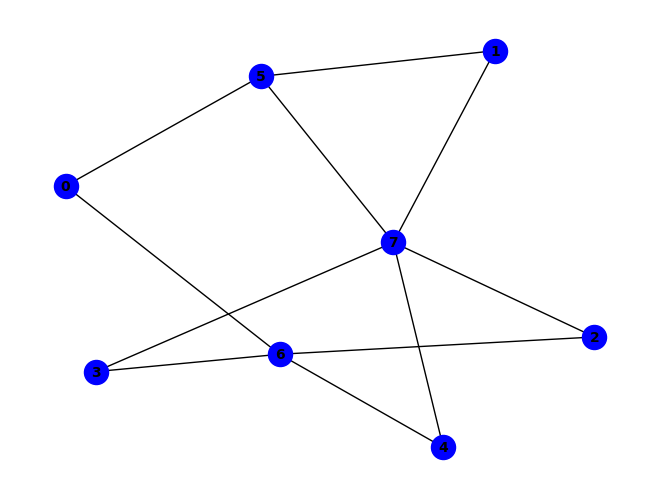


(~a & ~f) ^ (b & h & ~a) ^ (e & g & ~h) ^ (b & e & f & h) ^ (f & ~a & ~h) ^ (a & c & g & ~e) ^ (a & d & g & ~c) ^ (a & e & g & ~d) ^ (a & b & e & g & h) ^ (a & c & d & e & g) ^ (b & f & ~a & ~e) ^ (d & g & ~e & ~h) ^ (e & h & ~b & ~f) ^ (a & ~b & ~f & ~g) ^ (b & e & f & ~g & ~h) ^ (a & b & c & e & f & ~d) ^ (a & b & c & f & g & ~d) ^ (a & b & d & f & g & ~e) ^ (a & b & d & g & h & ~e) ^ (a & c & f & g & h & ~d) ^ (a & d & f & g & h & ~e) ^ (a & e & f & g & h & ~c) ^ (a & c & d & e & f & g & h) ^ (a & b & ~f & ~g & ~h) ^ (c & g & ~d & ~e & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & b & e & f & ~c & ~g) ^ (b & c & f & g & ~e & ~h) ^ (a & b & c & d & e & f & ~g) ^ (a & b & c & g & h & ~d & ~e) ^ (c & h & ~b & ~d & ~e & ~f) ^ (b & d & f & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


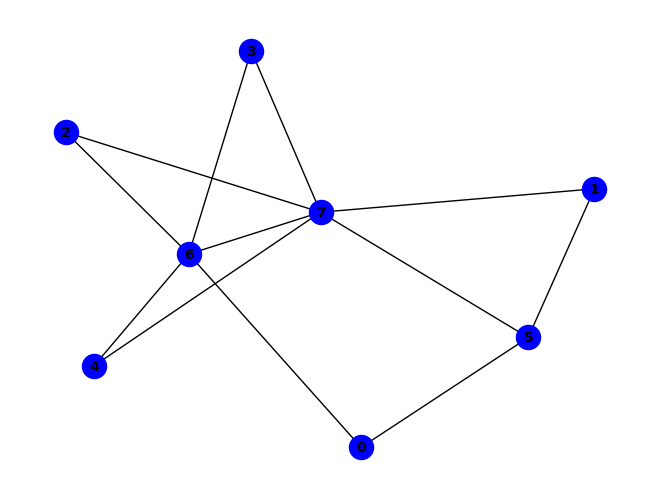


(g & ~h) ^ (~a & ~g) ^ (a & h & ~g) ^ (f & h & ~g) ^ (a & ~f & ~h) ^ (a & b & f & ~h) ^ (a & f & g & ~h) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (b & c & d & h & ~g) ^ (a & d & g & ~e & ~h) ^ (a & e & g & ~b & ~h) ^ (b & c & f & ~e & ~g) ^ (b & c & h & ~e & ~g) ^ (b & d & h & ~e & ~g) ^ (b & e & f & ~g & ~h) ^ (c & f & g & ~d & ~h) ^ (d & f & g & ~e & ~h) ^ (e & f & g & ~c & ~h) ^ (c & d & e & f & g & ~h) ^ (b & h & ~e & ~f & ~g) ^ (a & b & e & g & ~f & ~h) ^ (c & d & e & g & ~b & ~f) ^ (c & d & e & h & ~b & ~f) ^ (b & c & d & e & f & h & ~g) ^ (a & c & g & ~d & ~e & ~h) ^ (b & d & f & ~c & ~e & ~g) ^ (a & b & d & f & g & ~e & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (b & f & ~c & ~d & ~e & ~h) ^ (a & b & c & f & g & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

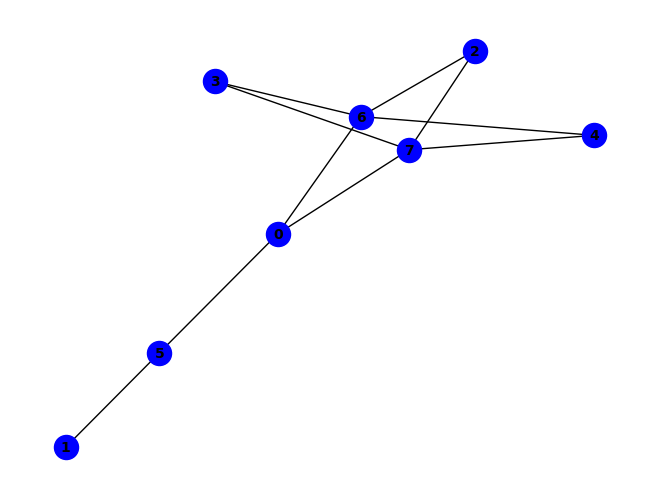


~d ^ (a & f & ~g) ^ (a & h & ~f) ^ (e & h & ~d) ^ (a & f & g & h) ^ (d & ~g & ~h) ^ (a & c & h & ~e) ^ (a & d & h & ~e) ^ (a & e & g & ~d) ^ (a & e & h & ~g) ^ (a & b & c & f & g) ^ (a & d & e & g & h) ^ (b & d & e & f & g) ^ (a & g & ~d & ~h) ^ (b & f & ~a & ~e) ^ (c & h & ~d & ~e) ^ (e & g & ~d & ~h) ^ (a & c & d & g & ~e) ^ (b & c & f & h & ~e) ^ (b & d & f & h & ~c) ^ (a & b & c & e & f & h) ^ (b & c & d & e & f & h) ^ (a & c & g & ~e & ~h) ^ (a & b & c & f & h & ~g) ^ (b & d & e & f & h & ~g) ^ (c & g & ~d & ~e & ~h) ^ (a & c & d & h & ~e & ~g) ^ (b & c & f & g & ~e & ~h) ^ (b & d & f & g & ~c & ~h) ^ (a & b & c & e & f & g & ~h) ^ (b & c & d & e & f & g & ~h) ^ (b & e & f & ~a & ~g & ~h) ^ (a & b & d & f & h & ~c & ~e) ^ (a & b & d & f & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

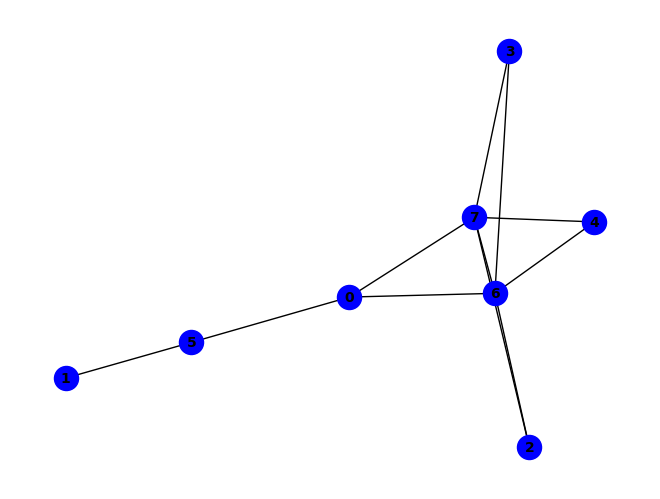


(~b & ~g) ^ (a & b & ~g) ^ (a & f & ~h) ^ (c & g & ~d) ^ (d & h & ~e) ^ (e & g & ~c) ^ (e & h & ~b) ^ (a & f & g & h) ^ (b & ~f & ~g) ^ (g & ~b & ~h) ^ (a & e & g & ~b) ^ (b & e & h & ~f) ^ (a & b & ~e & ~f) ^ (a & g & ~b & ~f) ^ (b & g & ~f & ~h) ^ (c & h & ~d & ~e) ^ (d & g & ~a & ~e) ^ (a & b & e & h & ~d) ^ (a & b & f & g & ~h) ^ (b & c & f & g & ~e) ^ (b & d & f & g & ~c) ^ (b & e & f & g & ~d) ^ (c & d & e & g & ~b) ^ (a & b & c & d & e & h) ^ (a & b & e & ~f & ~h) ^ (a & c & g & ~d & ~e) ^ (a & b & c & e & g & ~d) ^ (a & b & c & f & g & ~d) ^ (a & b & d & f & g & ~e) ^ (a & b & d & f & h & ~c) ^ (a & h & ~c & ~d & ~e) ^ (a & b & e & g & ~c & ~f) ^ (b & c & f & h & ~a & ~e) ^ (b & d & f & h & ~c & ~e) ^ (a & b & d & e & h & ~c & ~f) ^ (b & c & d & e & g & ~a & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

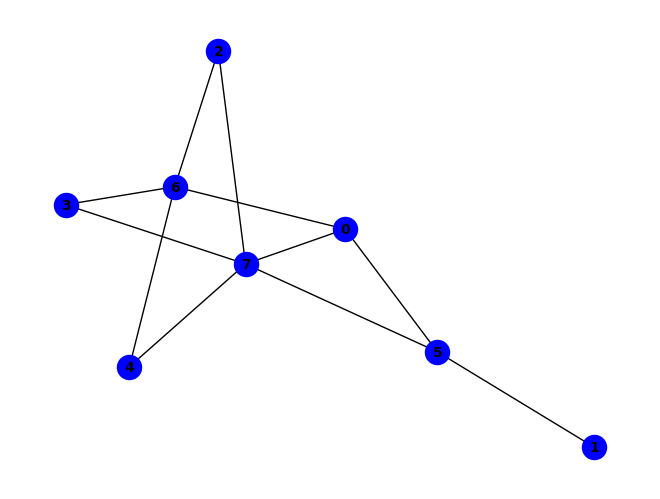


(f & ~h) ^ (~b & ~f) ^ (a & f & ~g) ^ (a & h & ~e) ^ (b & h & ~f) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (b & ~e & ~h) ^ (a & b & f & ~h) ^ (a & c & g & ~e) ^ (a & g & ~d & ~h) ^ (b & e & ~g & ~h) ^ (d & g & ~e & ~h) ^ (e & g & ~a & ~h) ^ (a & c & f & h & ~e) ^ (a & c & h & ~e & ~g) ^ (a & b & d & f & g & ~h) ^ (c & g & ~d & ~e & ~h) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (a & b & e & g & ~d & ~h) ^ (a & c & d & g & ~b & ~h) ^ (a & c & d & h & ~e & ~f) ^ (a & d & e & g & ~c & ~h) ^ (b & d & f & g & ~e & ~h) ^ (a & b & c & d & e & g & ~h) ^ (b & e & g & ~a & ~f & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & c & f & g & ~e & ~h) ^ (b & c & f & g & ~d & ~e & ~h) ^ (a & b & d & e & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


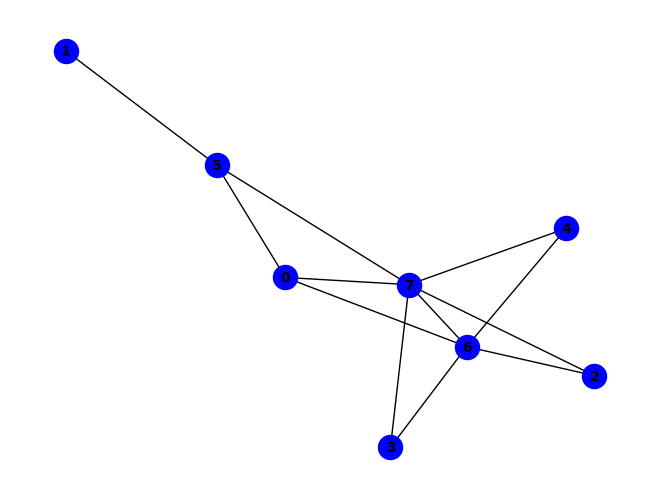


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (b & f & ~a & ~h) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & c & d & g & ~f) ^ (a & c & d & h & ~f) ^ (a & e & f & h & ~g) ^ (a & c & g & ~e & ~f) ^ (a & c & h & ~e & ~f) ^ (c & f & g & ~d & ~h) ^ (e & f & g & ~c & ~h) ^ (a & b & e & f & g & ~h) ^ (d & g & ~a & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (b & d & f & g & ~c & ~h) ^ (b & e & f & g & ~d & ~h) ^ (c & d & e & g & ~a & ~f) ^ (c & d & e & h & ~a & ~f) ^ (d & f & g & ~a & ~e & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (a & c & f & g & ~d & ~e & ~h) ^ (b & c & f & g & ~a & ~e & ~h) ^ (a & b & d & f & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


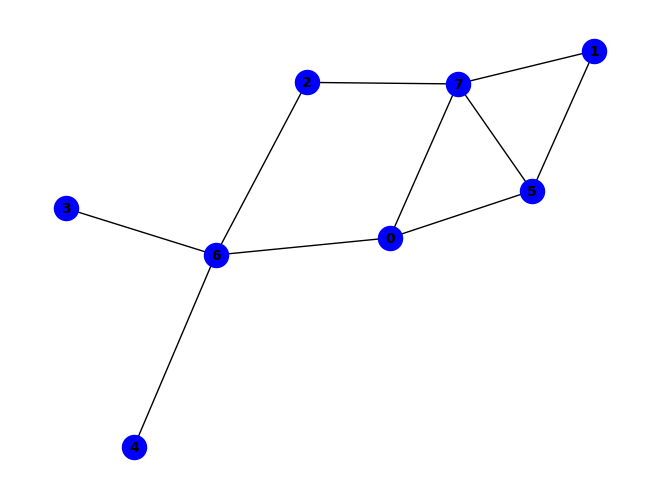


~f ^ (f & ~h) ^ (a & h & ~c) ^ (c & g & ~h) ^ (a & f & ~e & ~g) ^ (a & g & ~c & ~h) ^ (b & f & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & h & ~b & ~f) ^ (e & g & ~a & ~c) ^ (a & b & c & h & ~e) ^ (a & c & f & h & ~e) ^ (a & e & f & h & ~d) ^ (a & f & g & h & ~d) ^ (b & c & f & g & ~h) ^ (e & f & g & h & ~c) ^ (a & e & f & ~g & ~h) ^ (b & e & f & ~a & ~g) ^ (b & e & h & ~a & ~g) ^ (a & b & c & e & h & ~g) ^ (a & b & c & f & g & ~e) ^ (a & b & c & f & h & ~g) ^ (a & c & e & f & h & ~g) ^ (a & d & e & f & h & ~g) ^ (b & c & d & f & g & ~a) ^ (b & c & d & g & h & ~a) ^ (b & c & e & f & g & ~d) ^ (b & c & e & g & h & ~d) ^ (a & b & c & d & e & f & g) ^ (a & b & c & d & e & g & h) ^ (d & g & ~a & ~c & ~e) ^ (b & d & f & g & ~a & ~e) ^ (b & d & g & h & ~a & ~e) ^ (d & f & g & h & ~c & ~e) ^ (a & c & d & f & g & h & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

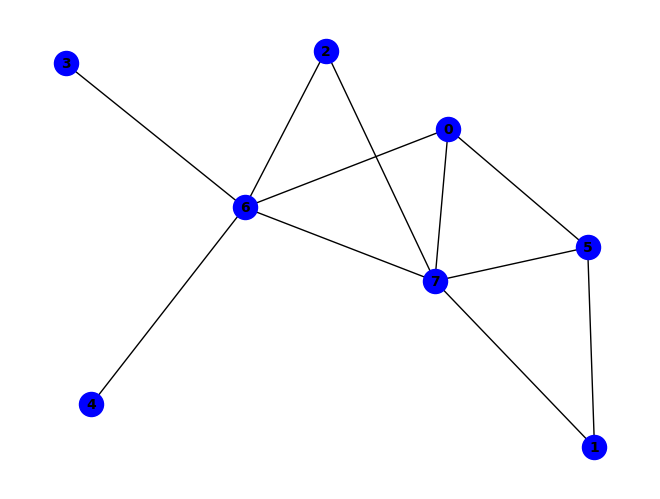


(~e & ~g) ^ (a & f & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (f & h & ~g) ^ (g & ~d & ~h) ^ (a & e & ~d & ~g) ^ (d & e & ~g & ~h) ^ (e & h & ~a & ~g) ^ (e & ~a & ~d & ~h) ^ (a & d & h & ~e & ~g) ^ (c & f & g & ~a & ~h) ^ (b & f & ~a & ~c & ~h) ^ (b & h & ~a & ~f & ~g) ^ (c & g & ~a & ~b & ~f) ^ (c & h & ~a & ~b & ~f) ^ (b & c & f & ~a & ~g & ~h) ^ (c & d & g & ~a & ~b & ~h) ^ (c & e & g & ~a & ~d & ~h) ^ (b & d & f & g & ~a & ~e & ~h) ^ (b & e & f & g & ~a & ~c & ~h) ^ (b & c & d & e & f & g & ~a & ~h) ^ (b & c & g & ~a & ~d & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


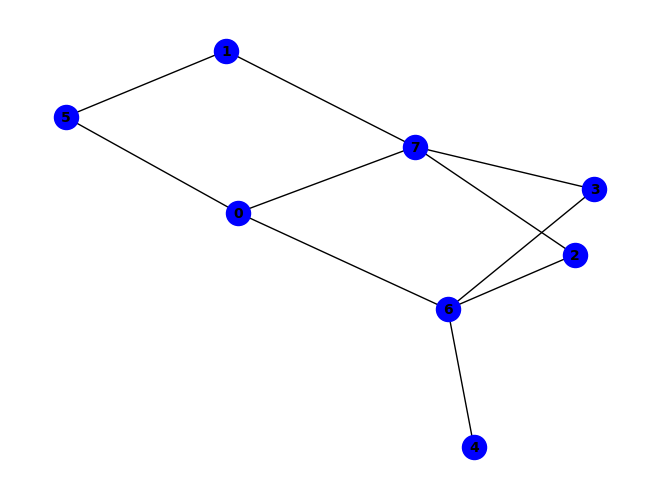


(e & ~g) ^ (~b & ~e) ^ (d & g & ~h) ^ (d & h & ~b) ^ (b & e & h & ~g) ^ (a & f & ~g & ~h) ^ (c & h & ~b & ~d) ^ (b & d & f & g & ~h) ^ (b & ~e & ~f & ~h) ^ (a & b & f & ~e & ~h) ^ (a & b & g & ~e & ~h) ^ (a & e & g & ~b & ~d) ^ (c & e & g & ~a & ~b) ^ (d & e & g & ~b & ~c) ^ (a & c & d & e & g & ~b) ^ (a & h & ~b & ~c & ~d) ^ (c & g & ~b & ~d & ~h) ^ (b & e & f & ~a & ~g & ~h) ^ (a & g & ~b & ~c & ~d & ~h) ^ (a & b & d & g & ~e & ~f & ~h) ^ (b & c & d & g & ~a & ~f & ~h) ^ (b & d & e & g & ~c & ~f & ~h) ^ (a & b & c & d & e & g & ~f & ~h) ^ (b & c & g & ~a & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


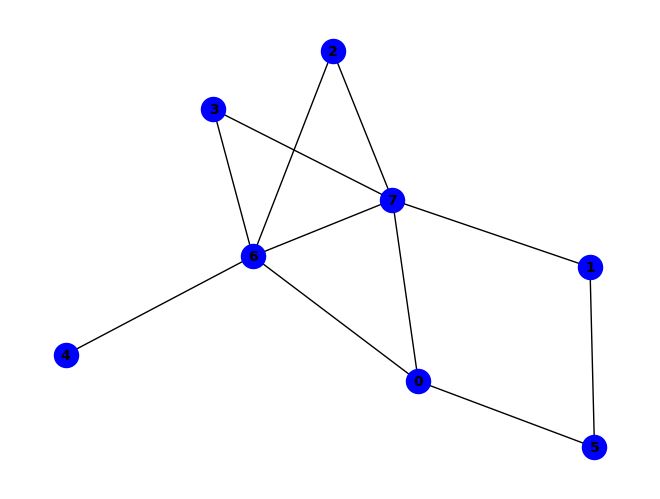


(a & e & g) ^ (a & f & ~h) ^ (a & g & ~f) ^ (a & h & ~e) ^ (c & g & ~e) ^ (c & h & ~e) ^ (d & g & ~c) ^ (d & h & ~c) ^ (a & f & g & h) ^ (e & ~d & ~h) ^ (g & ~b & ~h) ^ (a & b & g & ~h) ^ (a & c & g & ~d) ^ (a & d & g & ~b) ^ (a & d & h & ~b) ^ (b & c & h & ~d) ^ (b & d & g & ~e) ^ (b & d & h & ~e) ^ (b & e & f & ~h) ^ (~b & ~e & ~g) ^ (a & b & ~e & ~g) ^ (d & e & ~g & ~h) ^ (e & h & ~c & ~g) ^ (a & d & e & g & ~h) ^ (b & ~d & ~f & ~h) ^ (a & b & e & ~d & ~h) ^ (a & c & h & ~b & ~d) ^ (a & e & h & ~b & ~g) ^ (b & c & g & ~a & ~d) ^ (b & e & h & ~d & ~g) ^ (b & c & e & f & g & ~h) ^ (a & b & ~e & ~f & ~h) ^ (b & d & ~f & ~g & ~h) ^ (a & b & d & e & ~g & ~h) ^ (c & d & e & g & ~b & ~h) ^ (b & c & g & ~d & ~f & ~h) ^ (b & e & ~a & ~f & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h) ^ (a & c & e & g & ~b & ~d & ~h) ^ (b & d & e & g & ~c & ~f & ~h) ^ (a & b & d & g & ~c & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


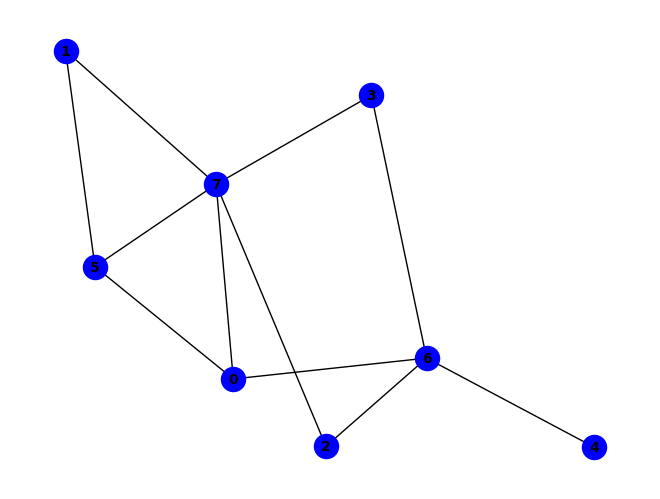


~f ^ (f & ~h) ^ (a & h & ~d) ^ (d & g & ~h) ^ (a & e & f & h) ^ (a & f & g & h) ^ (a & c & g & ~e) ^ (a & c & h & ~g) ^ (a & e & g & ~d) ^ (a & c & d & e & g) ^ (b & d & e & f & g) ^ (a & f & ~e & ~g) ^ (a & g & ~d & ~h) ^ (b & f & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & g & ~d & ~h) ^ (d & h & ~b & ~f) ^ (e & g & ~c & ~d) ^ (a & b & c & h & ~f) ^ (a & b & d & h & ~e) ^ (a & c & d & g & ~h) ^ (a & c & f & h & ~e) ^ (a & d & f & h & ~e) ^ (b & d & f & g & ~h) ^ (a & e & f & ~g & ~h) ^ (b & e & f & ~a & ~g) ^ (b & e & h & ~a & ~g) ^ (a & b & d & e & h & ~g) ^ (a & b & d & f & g & ~e) ^ (a & b & d & f & h & ~g) ^ (a & c & e & f & h & ~g) ^ (a & d & e & f & h & ~g) ^ (b & c & e & g & h & ~a) ^ (b & d & e & g & h & ~c) ^ (a & b & c & d & e & g & h) ^ (a & c & d & e & f & g & h) ^ (c & h & ~b & ~d & ~f) ^ (a & c & d & h & ~b & ~f) ^ (e & f & g & h & ~c & ~d) ^ (b & c & e & f & g & ~a & ~d) ^ (b & c & f & g & ~a & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

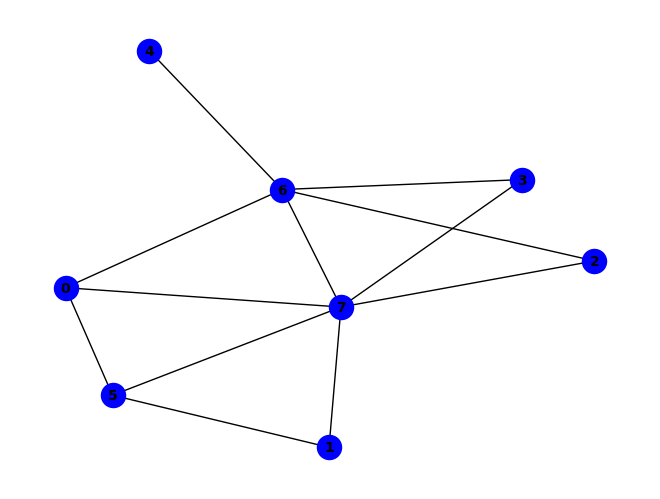


(g & ~h) ^ (~e & ~g) ^ (a & f & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (f & h & ~g) ^ (d & f & g & ~h) ^ (c & e & ~d & ~g) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~c & ~g) ^ (a & d & f & h & ~g) ^ (b & c & d & f & ~h) ^ (c & d & e & h & ~g) ^ (e & ~c & ~d & ~h) ^ (a & c & g & ~d & ~f) ^ (a & c & h & ~d & ~f) ^ (b & c & g & ~e & ~h) ^ (b & d & f & ~c & ~g) ^ (b & d & h & ~c & ~g) ^ (b & f & ~a & ~d & ~h) ^ (a & b & c & f & ~d & ~g) ^ (a & b & c & f & ~d & ~h) ^ (a & b & c & h & ~d & ~g) ^ (a & b & d & f & ~g & ~h) ^ (b & c & e & g & ~f & ~h) ^ (b & d & e & h & ~f & ~g) ^ (b & c & d & e & f & g & ~h) ^ (a & e & g & ~c & ~d & ~h) ^ (b & e & g & ~a & ~d & ~h) ^ (c & f & g & ~a & ~d & ~h) ^ (b & e & ~a & ~d & ~f & ~g) ^ (b & e & ~a & ~d & ~f & ~h) ^ (b & h & ~a & ~e & ~f & ~g) ^ (a & b & d & h & ~e & ~f & ~g) ^ (a & b & c & e & f & g & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

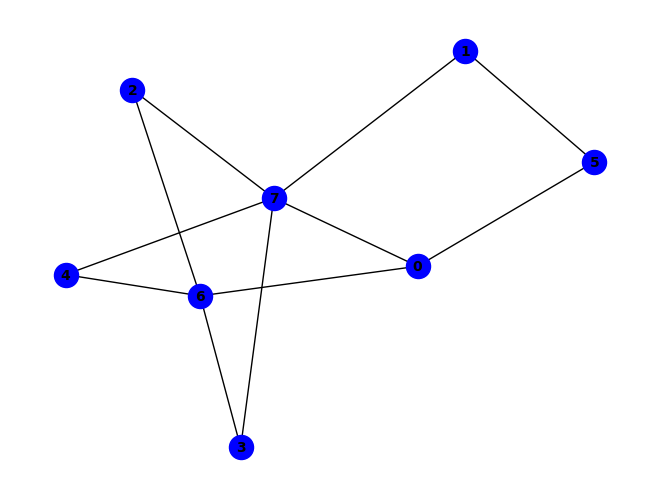


~d ^ (b & f & ~a) ^ (e & h & ~d) ^ (d & ~g & ~h) ^ (b & c & h & ~e) ^ (b & d & h & ~e) ^ (b & e & g & ~d) ^ (a & f & ~g & ~h) ^ (b & h & ~a & ~f) ^ (c & h & ~d & ~e) ^ (e & g & ~d & ~h) ^ (a & b & c & g & ~e) ^ (a & b & d & g & ~e) ^ (a & b & e & h & ~d) ^ (b & c & d & g & ~e) ^ (b & c & d & h & ~g) ^ (b & d & f & g & ~h) ^ (b & e & f & h & ~g) ^ (a & b & c & d & f & h) ^ (a & b & d & e & g & h) ^ (a & b & c & d & g & ~f) ^ (a & b & d & f & h & ~g) ^ (a & b & e & f & g & ~h) ^ (b & c & d & e & h & ~a) ^ (b & d & e & g & h & ~c) ^ (a & g & ~d & ~e & ~h) ^ (a & h & ~c & ~d & ~e) ^ (b & e & ~d & ~f & ~g) ^ (b & e & ~d & ~f & ~h) ^ (a & b & c & h & ~e & ~g) ^ (b & c & f & g & ~e & ~h) ^ (a & b & d & ~e & ~f & ~g) ^ (a & b & d & ~e & ~f & ~h) ^ (a & b & c & d & g & ~e & ~h) ^ (a & b & c & d & h & ~f & ~g) ^ (c & g & ~a & ~d & ~e & ~h) ^ (a & b & c & g & ~e & ~f & ~h) ^ (b & c & d & g & ~e & ~f & ~h) ^ (b & d & e & h & ~a & ~f & ~g) ^ (a & b & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PA

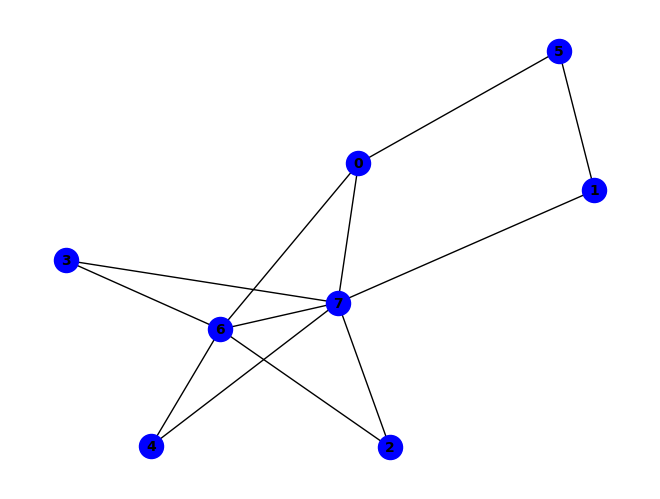


(b & e & g) ^ (~b & ~g) ^ (a & b & ~g) ^ (a & f & ~h) ^ (a & g & ~f) ^ (c & g & ~d) ^ (e & g & ~c) ^ (e & h & ~b) ^ (a & f & g & h) ^ (g & ~b & ~h) ^ (a & b & g & ~h) ^ (a & c & g & ~e) ^ (a & d & g & ~e) ^ (a & e & g & ~b) ^ (a & b & c & e & h) ^ (a & b & c & f & g) ^ (a & b & c & f & h) ^ (a & b & d & e & g) ^ (a & b & d & f & g) ^ (a & b & d & f & h) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (a & b & e & h & ~d) ^ (a & c & d & g & ~b) ^ (c & d & e & g & ~a) ^ (b & c & g & ~d & ~e) ^ (a & b & c & d & h & ~e) ^ (a & b & c & e & g & ~d) ^ (a & h & ~c & ~d & ~e) ^ (c & h & ~b & ~d & ~e) ^ (a & b & c & h & ~f & ~g) ^ (a & b & d & h & ~f & ~g) ^ (b & ~a & ~e & ~f & ~h) ^ (b & c & g & ~e & ~f & ~h) ^ (a & b & c & e & g & ~f & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (b & e & ~a & ~f & ~g & ~h) ^ (b & d & g & ~c & ~e & ~f & ~h) ^ (a & b & c & d & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


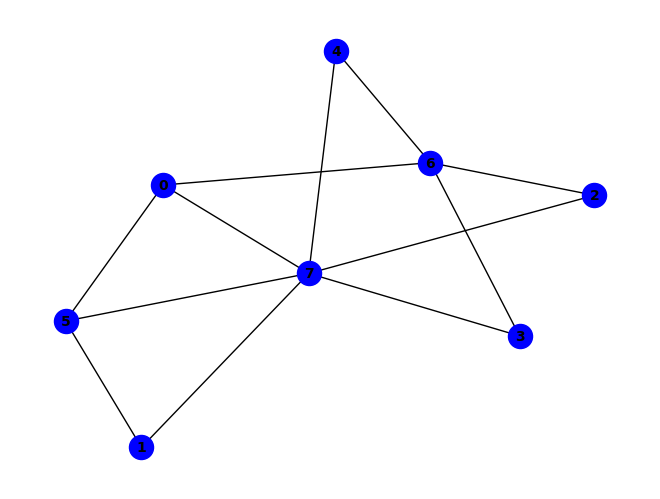


~f ^ (f & ~h) ^ (a & f & ~g) ^ (a & h & ~e) ^ (b & h & ~a) ^ (a & b & e & h) ^ (a & f & g & h) ^ (b & e & f & h) ^ (a & c & g & ~e) ^ (a & g & ~d & ~h) ^ (b & f & ~a & ~e) ^ (d & g & ~e & ~h) ^ (e & g & ~a & ~h) ^ (e & h & ~b & ~f) ^ (a & b & c & h & ~e) ^ (a & c & d & g & ~h) ^ (a & c & f & h & ~e) ^ (a & d & e & g & ~c) ^ (a & e & f & h & ~d) ^ (a & c & h & ~e & ~g) ^ (a & d & h & ~c & ~f) ^ (a & b & c & f & g & ~e) ^ (a & b & c & d & e & f & g) ^ (c & g & ~d & ~e & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & d & e & h & ~c & ~g) ^ (b & c & f & g & ~e & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & c & d & e & f & h & ~b) ^ (b & e & f & ~a & ~g & ~h) ^ (a & b & c & f & h & ~e & ~g) ^ (a & b & d & f & g & ~e & ~h) ^ (a & b & c & d & e & f & h & ~g) ^ (c & h & ~b & ~d & ~e & ~f) ^ (a & b & d & h & ~c & ~e & ~f) ^ (b & d & f & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


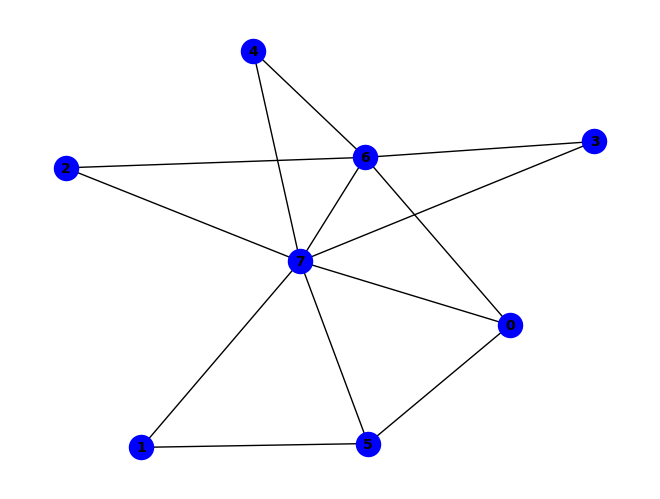


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & e & f & h & ~g) ^ (b & c & d & h & ~g) ^ (c & f & g & ~d & ~h) ^ (e & f & g & ~c & ~h) ^ (c & d & e & f & g & ~h) ^ (d & g & ~a & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (a & b & c & f & ~e & ~h) ^ (a & b & d & f & ~e & ~g) ^ (c & d & e & g & ~b & ~f) ^ (c & d & e & h & ~b & ~f) ^ (b & c & d & e & f & h & ~g) ^ (a & b & f & ~d & ~e & ~h) ^ (a & c & g & ~d & ~e & ~f) ^ (a & c & h & ~d & ~e & ~f) ^ (b & c & f & ~a & ~e & ~g) ^ (b & c & h & ~a & ~e & ~g) ^ (b & d & f & ~c & ~e & ~g) ^ (b & d & h & ~a & ~e & ~g) ^ (b & e & f & ~a & ~g & ~h) ^ (d & f & g & ~a & ~e & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (b & f & ~c & ~d & ~e & ~h) ^ (b & h & ~a & ~e & ~f & ~g) ^ (a & c & f & g & ~d & ~e & ~h) ^ (a & b & c & d & f & g & ~e & ~h) ^ (a & b & c & d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

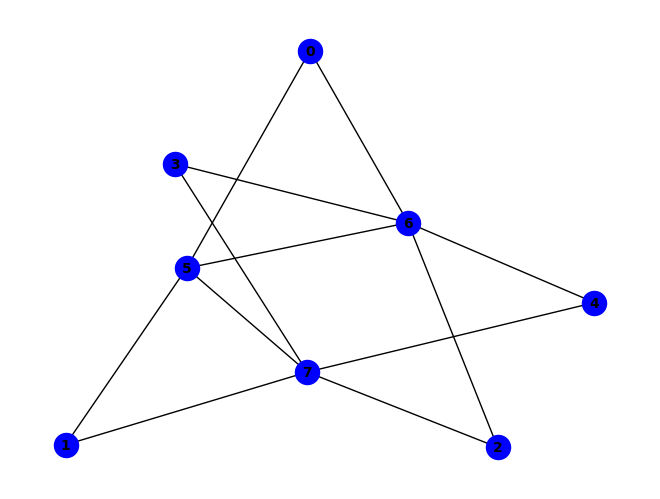


~e ^ (a & g & ~e) ^ (f & h & ~e) ^ (a & f & g & h) ^ (e & ~g & ~h) ^ (a & f & ~b & ~h) ^ (b & f & ~g & ~h) ^ (d & h & ~e & ~f) ^ (f & g & ~e & ~h) ^ (a & b & f & g & ~h) ^ (a & c & e & g & ~d) ^ (a & e & f & g & ~c) ^ (c & d & e & g & ~f) ^ (a & c & d & e & f & g) ^ (a & c & g & ~d & ~f) ^ (a & d & g & ~e & ~f) ^ (c & d & g & ~f & ~h) ^ (c & d & h & ~b & ~f) ^ (b & c & d & e & h & ~f) ^ (b & h & ~d & ~e & ~f) ^ (c & g & ~e & ~f & ~h) ^ (c & h & ~b & ~e & ~f) ^ (d & g & ~e & ~f & ~h) ^ (c & d & e & h & ~f & ~g) ^ (a & b & g & h & ~c & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


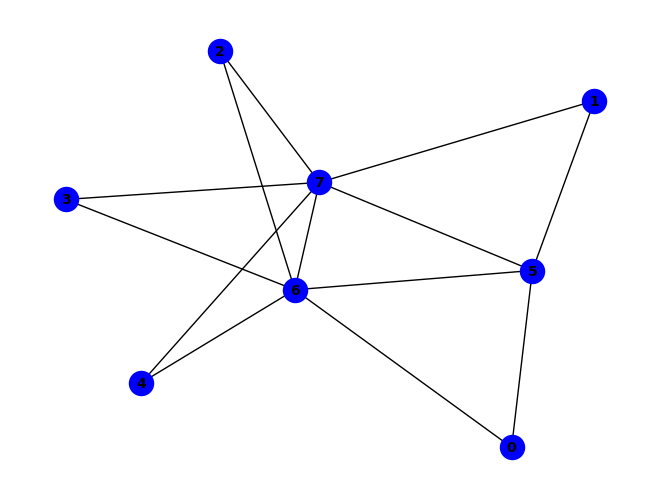


(f & h) ^ (~a & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & g & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~c) ^ (g & ~b & ~h) ^ (b & e & g & ~h) ^ (a & c & ~f & ~g) ^ (a & h & ~c & ~g) ^ (c & h & ~e & ~f) ^ (a & c & f & h & ~g) ^ (b & e & f & h & ~g) ^ (c & e & f & g & ~b) ^ (b & c & d & e & f & g) ^ (a & ~c & ~f & ~h) ^ (a & b & f & ~g & ~h) ^ (b & c & e & f & h & ~d) ^ (d & g & ~c & ~e & ~f) ^ (d & h & ~c & ~e & ~f) ^ (b & c & e & h & ~d & ~g) ^ (a & d & g & ~c & ~f & ~h) ^ (b & c & h & ~d & ~f & ~g) ^ (b & d & h & ~e & ~f & ~g) ^ (b & c & e & f & g & ~d & ~h) ^ (a & e & g & ~c & ~d & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


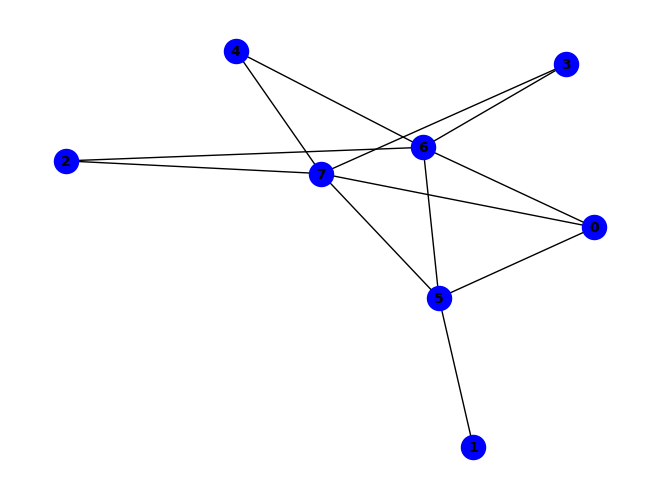


~e ^ (a & f & ~e) ^ (a & h & ~e) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & d & h & ~f) ^ (c & d & h & ~f) ^ (a & g & ~e & ~h) ^ (c & h & ~e & ~f) ^ (d & h & ~e & ~f) ^ (f & g & ~e & ~h) ^ (a & c & e & g & ~f) ^ (a & d & e & g & ~f) ^ (c & d & e & g & ~f) ^ (a & c & g & ~f & ~h) ^ (a & c & h & ~d & ~f) ^ (a & e & f & ~g & ~h) ^ (c & d & g & ~f & ~h) ^ (a & c & d & e & h & ~f) ^ (b & f & ~a & ~g & ~h) ^ (c & g & ~e & ~f & ~h) ^ (d & g & ~e & ~f & ~h) ^ (a & c & e & h & ~f & ~g) ^ (a & d & e & h & ~f & ~g) ^ (c & d & e & h & ~f & ~g) ^ (a & d & g & ~c & ~f & ~h) ^ (a & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


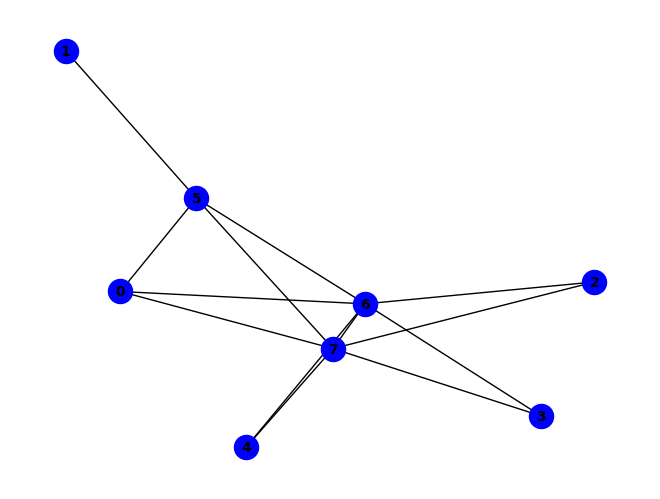


~g ^ (f & h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (b & f & ~h) ^ (c & g & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~c) ^ (a & e & f & g) ^ (c & e & f & g) ^ (g & ~b & ~h) ^ (a & f & g & ~h) ^ (b & g & ~f & ~h) ^ (a & d & e & h & ~c) ^ (a & e & f & h & ~d) ^ (a & c & d & e & f & h) ^ (a & b & f & ~g & ~h) ^ (a & c & g & ~e & ~f) ^ (a & d & h & ~c & ~f) ^ (c & h & ~a & ~e & ~f) ^ (d & h & ~c & ~e & ~f) ^ (d & g & ~a & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


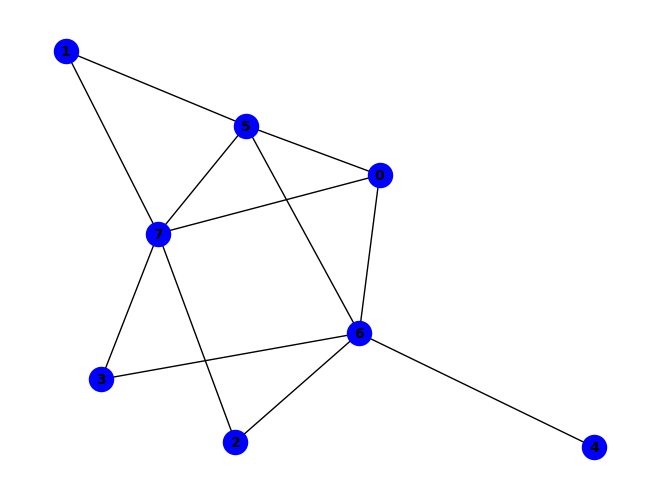


~e ^ (f & h) ^ (e & f & g) ^ (a & f & ~e) ^ (a & g & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (e & ~d & ~g) ^ (a & h & ~d & ~g) ^ (c & h & ~b & ~f) ^ (d & h & ~c & ~f) ^ (a & d & f & h & ~g) ^ (b & c & d & h & ~f) ^ (a & d & g & ~e & ~f) ^ (a & e & f & ~b & ~g) ^ (d & e & f & ~b & ~g) ^ (a & b & e & f & h & ~d) ^ (a & b & e & g & h & ~d) ^ (b & d & e & f & h & ~c) ^ (b & d & e & g & h & ~c) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (b & f & ~a & ~g & ~h) ^ (b & h & ~a & ~d & ~f) ^ (c & g & ~a & ~f & ~h) ^ (d & g & ~c & ~f & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & c & d & g & ~f & ~h) ^ (b & e & g & h & ~c & ~f) ^ (a & b & c & e & g & h & ~f) ^ (a & b & d & e & f & h & ~g) ^ (a & c & h & ~b & ~d & ~f) ^ (c & e & g & ~a & ~d & ~f) ^ (b & c & d & e & f & ~a & ~g) ^ (b & d & e & f & ~c & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


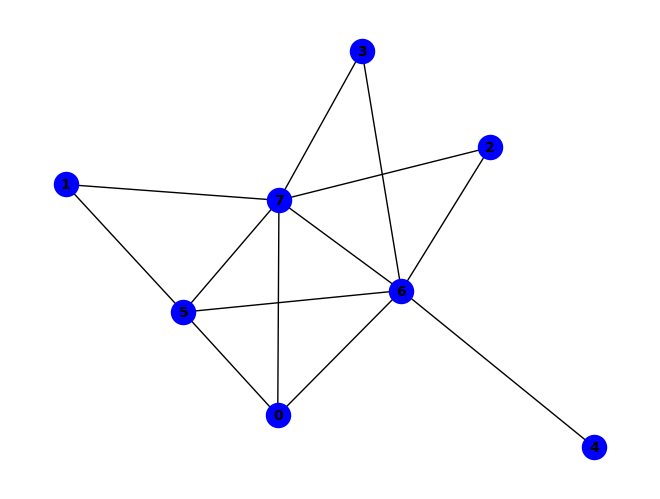


(f & g) ^ (f & h) ^ (g & ~h) ^ (~e & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (a & f & g & ~h) ^ (a & f & ~e & ~g) ^ (b & f & ~a & ~g) ^ (c & e & ~f & ~g) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (e & f & ~g & ~h) ^ (e & h & ~c & ~g) ^ (c & e & f & h & ~g) ^ (e & ~c & ~f & ~h) ^ (a & e & f & ~d & ~h) ^ (a & e & h & ~f & ~g) ^ (b & h & ~a & ~d & ~g) ^ (d & g & ~a & ~c & ~f) ^ (d & h & ~a & ~c & ~f) ^ (a & c & e & g & ~f & ~h) ^ (a & d & e & f & ~g & ~h) ^ (a & d & e & g & ~c & ~h) ^ (b & d & f & h & ~a & ~g) ^ (a & c & d & e & f & g & ~h) ^ (d & e & g & ~c & ~f & ~h) ^ (b & c & h & ~a & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


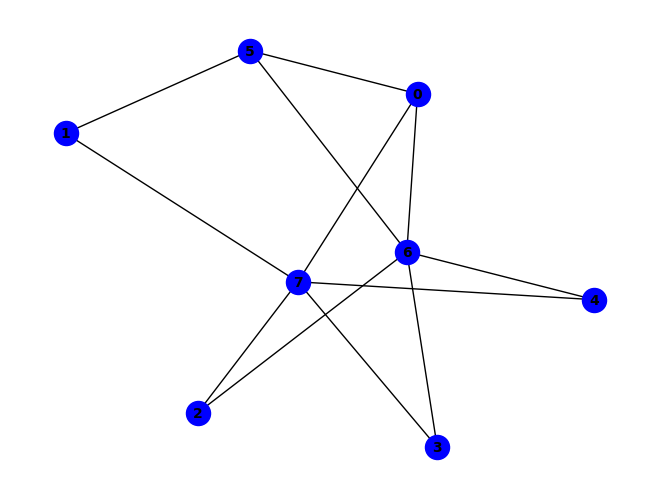


(e & f & g) ^ (~b & ~f) ^ (c & h & ~e) ^ (e & g & ~h) ^ (e & h & ~b) ^ (b & ~f & ~h) ^ (f & ~b & ~g) ^ (a & c & g & ~f) ^ (a & c & h & ~g) ^ (c & f & g & ~e) ^ (a & c & d & f & g) ^ (b & e & f & g & h) ^ (a & f & ~g & ~h) ^ (a & h & ~d & ~e) ^ (c & g & ~e & ~h) ^ (d & h & ~c & ~e) ^ (a & c & d & g & ~h) ^ (a & c & d & h & ~e) ^ (a & c & e & h & ~b) ^ (a & b & c & e & f & h) ^ (a & b & f & ~e & ~g) ^ (a & f & g & ~d & ~e) ^ (b & d & h & ~e & ~f) ^ (d & f & g & ~c & ~e) ^ (a & c & e & f & g & ~d) ^ (a & g & ~d & ~e & ~h) ^ (d & g & ~c & ~e & ~h) ^ (a & b & c & h & ~d & ~f) ^ (a & c & e & g & ~d & ~h) ^ (a & b & c & d & e & h & ~f) ^ (a & b & h & ~d & ~e & ~f) ^ (b & c & h & ~d & ~e & ~f) ^ (a & b & d & e & f & ~c & ~g) ^ (a & b & d & f & h & ~c & ~g) ^ (a & b & e & f & ~d & ~g & ~h) ^ (b & c & f & h & ~a & ~e & ~g) ^ (b & d & f & h & ~c & ~e & ~g) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


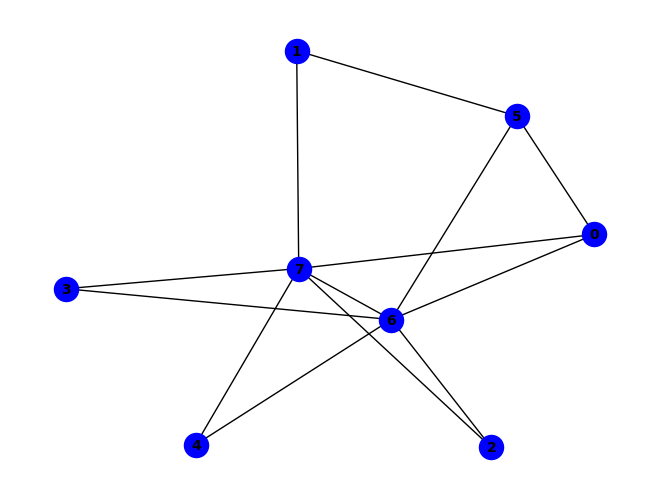


(g & ~h) ^ (~f & ~g) ^ (d & g & ~f) ^ (d & h & ~f) ^ (e & g & ~d) ^ (e & h & ~d) ^ (a & c & g & ~e) ^ (a & c & h & ~e) ^ (a & g & ~d & ~e) ^ (a & h & ~d & ~e) ^ (c & g & ~d & ~e) ^ (c & h & ~d & ~e) ^ (f & h & ~d & ~g) ^ (d & e & f & g & ~h) ^ (f & ~a & ~e & ~h) ^ (b & f & ~a & ~g & ~h) ^ (e & f & ~a & ~g & ~h) ^ (a & c & d & g & ~e & ~f) ^ (a & c & d & h & ~e & ~f) ^ (a & c & f & g & ~e & ~h) ^ (a & d & f & g & ~e & ~h) ^ (c & f & g & ~d & ~e & ~h) ^ (a & c & d & f & h & ~e & ~g) ^ (b & h & ~a & ~c & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


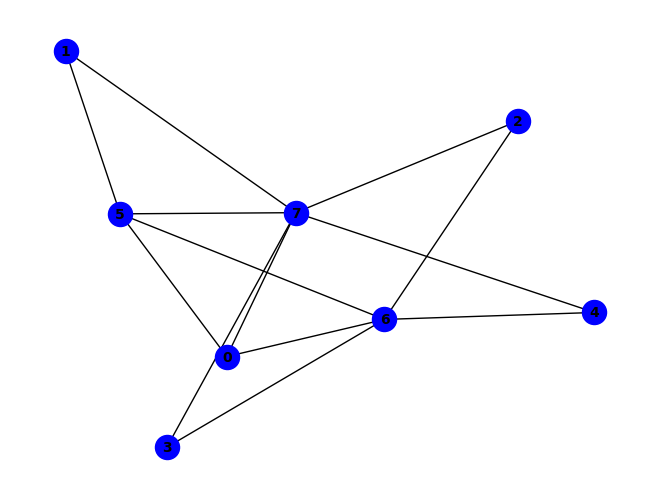


~e ^ (a & f & ~e) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & b & f & ~g) ^ (a & b & e & f & h) ^ (a & b & f & g & h) ^ (a & g & ~e & ~h) ^ (a & h & ~b & ~e) ^ (b & f & ~g & ~h) ^ (d & h & ~e & ~f) ^ (f & g & ~e & ~h) ^ (a & c & e & g & ~f) ^ (a & d & e & g & ~f) ^ (c & d & e & g & ~f) ^ (a & c & h & ~b & ~f) ^ (a & d & g & ~f & ~h) ^ (a & d & h & ~c & ~f) ^ (a & e & f & ~g & ~h) ^ (c & d & g & ~f & ~h) ^ (c & d & h & ~b & ~f) ^ (a & b & c & e & h & ~f) ^ (a & c & d & e & h & ~f) ^ (b & c & d & e & h & ~f) ^ (b & h & ~d & ~e & ~f) ^ (c & g & ~e & ~f & ~h) ^ (c & h & ~b & ~e & ~f) ^ (d & g & ~e & ~f & ~h) ^ (a & c & e & h & ~f & ~g) ^ (a & d & e & h & ~f & ~g) ^ (c & d & e & h & ~f & ~g) ^ (a & c & g & ~d & ~f & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (a & b & d & h & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


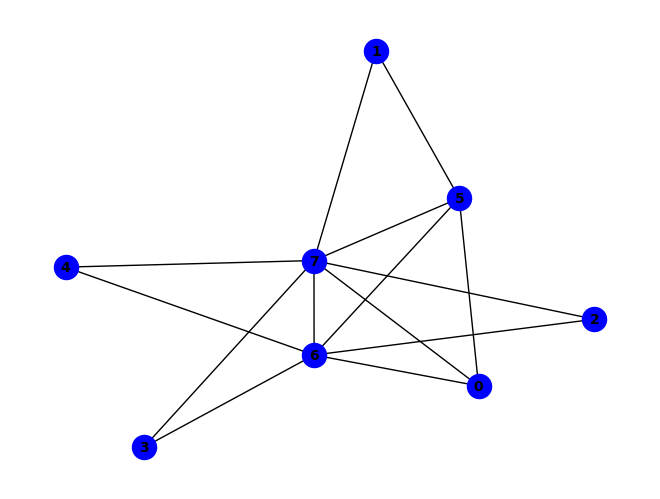


~g ^ (f & h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & g & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~c) ^ (g & ~b & ~h) ^ (a & f & g & ~h) ^ (b & e & g & ~h) ^ (b & f & ~a & ~g) ^ (a & d & e & g & ~c) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~b) ^ (b & e & f & h & ~g) ^ (c & e & f & g & ~b) ^ (a & b & e & f & g & h) ^ (b & c & d & e & f & g) ^ (a & b & h & ~e & ~g) ^ (a & c & g & ~e & ~f) ^ (a & d & g & ~c & ~f) ^ (b & c & e & f & h & ~d) ^ (a & b & c & d & e & f & h) ^ (c & h & ~a & ~e & ~f) ^ (d & g & ~c & ~e & ~f) ^ (b & c & e & h & ~d & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & c & d & e & f & g & ~b) ^ (b & c & h & ~d & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (b & c & e & f & g & ~d & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (d & h & ~a & ~c & ~e & ~f) ^ (a & b & c & h & ~e & ~f & ~g) ^ (b & d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

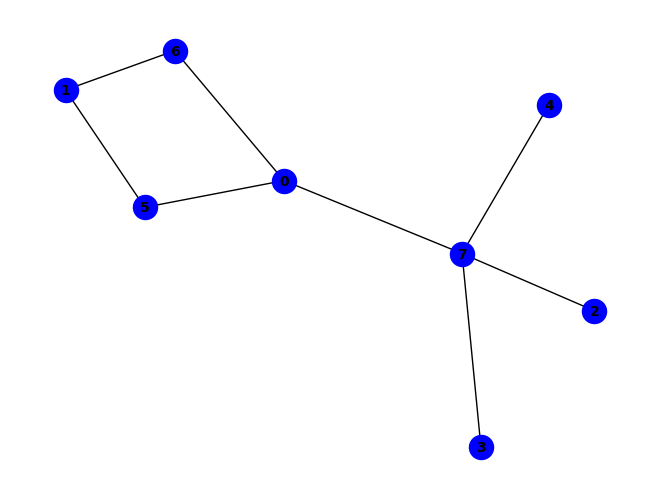


(~b & ~e) ^ (b & ~f & ~g) ^ (a & e & ~b & ~d) ^ (a & g & ~b & ~h) ^ (a & h & ~b & ~d) ^ (d & h & ~b & ~e) ^ (e & ~a & ~b & ~h) ^ (a & d & e & ~b & ~h) ^ (a & f & ~b & ~g & ~h) ^ (b & c & h & ~d & ~f & ~g) ^ (b & d & h & ~e & ~f & ~g) ^ (b & e & h & ~c & ~f & ~g) ^ (b & c & d & e & h & ~f & ~g) ^ (c & h & ~a & ~b & ~d & ~e) ^ (a & b & h & ~c & ~d & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


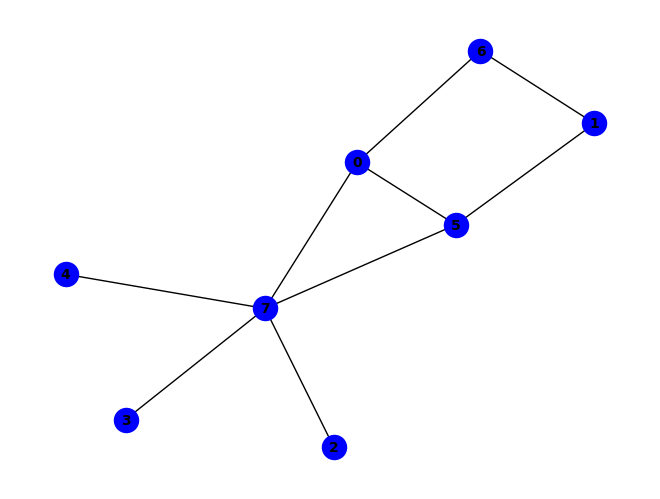


(~b & ~f) ^ (a & f & ~g) ^ (a & g & ~h) ^ (a & h & ~e) ^ (a & f & g & h) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & f & ~h) ^ (a & b & g & ~f) ^ (e & h & ~b & ~f) ^ (a & c & e & h & ~d) ^ (a & e & f & h & ~c) ^ (a & c & h & ~d & ~f) ^ (a & d & h & ~e & ~f) ^ (a & b & c & d & e & g & h) ^ (d & h & ~b & ~e & ~f) ^ (a & c & d & e & f & h & ~b) ^ (b & c & h & ~e & ~f & ~g) ^ (b & d & h & ~c & ~f & ~g) ^ (b & e & h & ~d & ~f & ~g) ^ (a & b & c & g & h & ~e & ~f) ^ (a & b & d & g & h & ~c & ~f) ^ (a & b & e & g & h & ~d & ~f) ^ (b & c & d & e & h & ~f & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (c & h & ~b & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


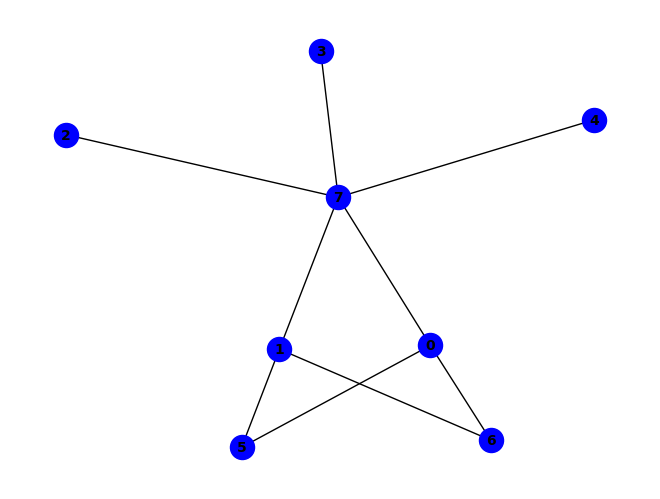


(~b & ~e) ^ (a & g & ~h) ^ (e & ~b & ~h) ^ (a & b & f & ~h) ^ (a & b & g & ~f) ^ (a & b & h & ~g) ^ (a & b & f & g & h) ^ (a & f & ~g & ~h) ^ (d & h & ~b & ~e) ^ (a & b & c & h & ~d) ^ (a & b & d & h & ~e) ^ (a & b & e & h & ~c) ^ (a & b & c & d & e & h) ^ (b & ~f & ~g & ~h) ^ (a & h & ~c & ~d & ~e) ^ (c & h & ~b & ~d & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


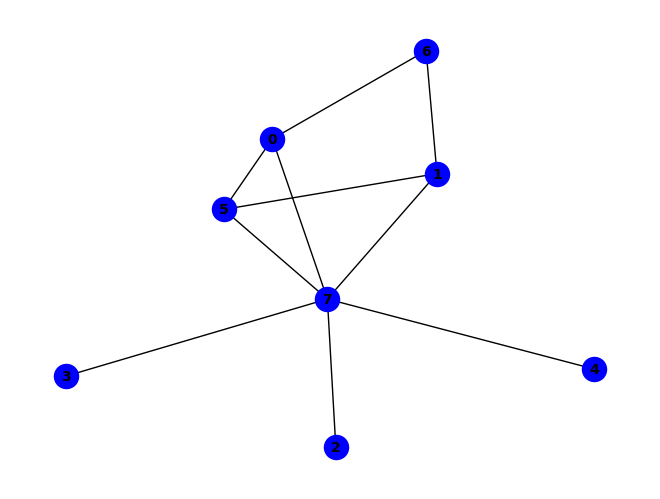


(f & ~h) ^ (~b & ~f) ^ (b & ~g & ~h) ^ (b & f & g & ~h) ^ (a & f & ~b & ~g) ^ (a & g & ~b & ~h) ^ (a & h & ~b & ~e) ^ (e & h & ~b & ~f) ^ (a & e & f & h & ~b) ^ (a & f & g & h & ~b) ^ (d & h & ~b & ~e & ~f) ^ (a & c & h & ~b & ~e & ~f) ^ (c & h & ~b & ~d & ~e & ~f) ^ (a & d & h & ~b & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


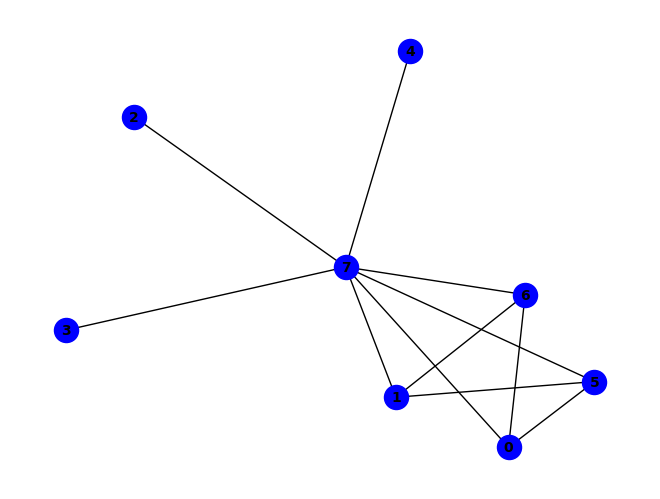


(~b & ~g) ^ (a & f & ~b & ~g) ^ (a & g & ~b & ~e) ^ (a & h & ~b & ~e) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (f & h & ~b & ~g) ^ (b & ~f & ~g & ~h) ^ (g & ~b & ~c & ~h) ^ (e & h & ~b & ~f & ~g) ^ (a & d & e & g & ~b & ~f) ^ (a & d & e & h & ~b & ~f) ^ (c & e & f & g & ~b & ~d) ^ (c & e & f & h & ~b & ~d) ^ (a & c & d & e & f & g & ~b) ^ (a & c & d & e & f & h & ~b) ^ (a & c & h & ~b & ~f & ~g) ^ (a & e & g & ~b & ~d & ~h) ^ (c & d & h & ~b & ~f & ~g) ^ (c & f & g & ~b & ~e & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (d & h & ~b & ~e & ~f & ~g) ^ (a & e & f & h & ~b & ~c & ~g) ^ (a & d & h & ~b & ~c & ~f & ~g) ^ (c & e & h & ~a & ~b & ~d & ~g) ^ (a & d & e & f & g & ~b & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


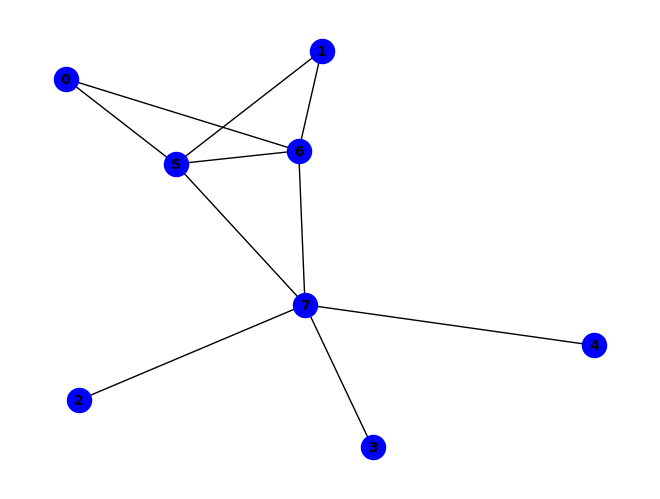


(~b & ~g) ^ (b & h & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (b & ~f & ~h) ^ (g & ~c & ~h) ^ (c & f & g & ~h) ^ (a & f & ~b & ~h) ^ (a & g & ~b & ~h) ^ (e & h & ~d & ~g) ^ (c & d & e & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (c & e & h & ~f & ~g) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (d & h & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


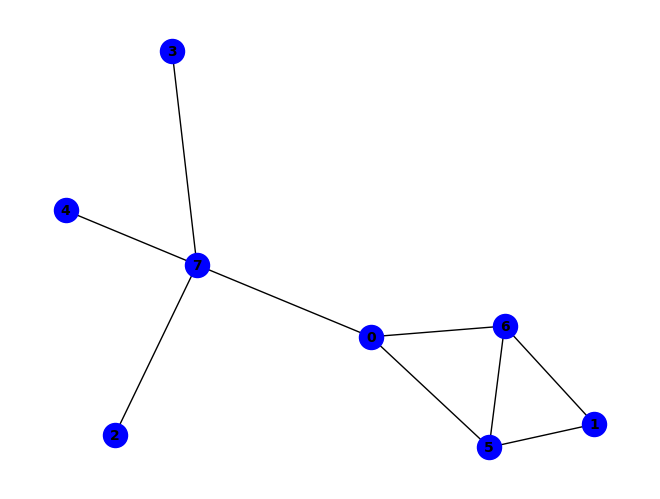


~f ^ (a & g & ~f) ^ (a & h & ~g) ^ (b & g & ~a) ^ (f & ~e & ~g) ^ (a & f & ~g & ~h) ^ (b & f & ~a & ~e) ^ (e & f & ~g & ~h) ^ (e & h & ~a & ~f) ^ (a & e & f & h & ~g) ^ (b & e & g & h & ~a) ^ (b & e & f & ~a & ~h) ^ (d & h & ~a & ~e & ~f) ^ (b & c & g & h & ~a & ~e) ^ (b & d & f & h & ~a & ~e) ^ (d & f & h & ~a & ~e & ~g) ^ (c & h & ~a & ~d & ~e & ~f) ^ (b & c & f & h & ~a & ~d & ~e) ^ (b & d & g & h & ~a & ~c & ~e) ^ (c & f & h & ~a & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


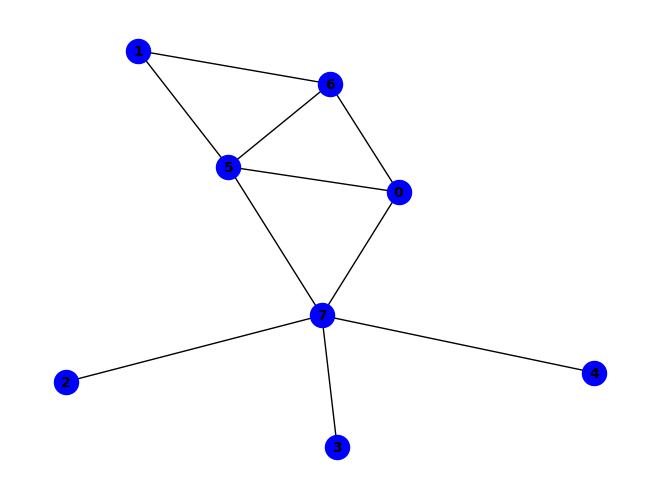


~e ^ (a & f & ~e) ^ (a & g & ~h) ^ (a & h & ~e) ^ (b & g & ~a) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (b & f & ~a & ~h) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (b & f & g & h & ~a) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (a & e & f & ~d & ~h) ^ (d & e & f & ~c & ~h) ^ (a & b & e & g & h & ~f) ^ (a & c & d & e & f & ~h) ^ (b & c & d & e & h & ~g) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (c & h & ~a & ~e & ~f) ^ (d & h & ~a & ~c & ~f) ^ (b & c & g & h & ~d & ~f) ^ (b & e & g & h & ~c & ~f) ^ (a & b & c & d & g & h & ~f) ^ (b & c & d & e & f & g & ~h) ^ (a & b & c & g & h & ~e & ~f) ^ (b & c & d & e & f & ~a & ~g) ^ (b & d & g & h & ~a & ~e & ~f) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


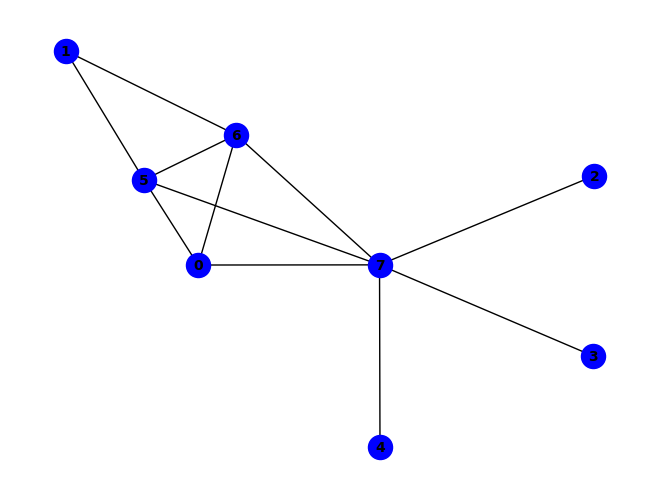


(~b & ~g) ^ (a & b & ~g) ^ (a & f & ~e) ^ (a & g & ~f) ^ (a & h & ~e) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & e & g & h) ^ (g & ~c & ~h) ^ (a & e & f & ~h) ^ (c & f & g & ~h) ^ (b & h & ~a & ~g) ^ (e & h & ~d & ~g) ^ (a & d & e & h & ~g) ^ (a & e & f & g & ~d) ^ (d & e & f & g & ~c) ^ (a & c & d & e & f & g) ^ (b & ~a & ~f & ~h) ^ (a & f & g & ~e & ~h) ^ (c & e & h & ~f & ~g) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (c & d & e & h & ~a & ~g) ^ (d & e & f & h & ~a & ~c) ^ (a & c & h & ~e & ~f & ~g) ^ (c & d & e & f & g & ~a & ~h) ^ (d & h & ~a & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


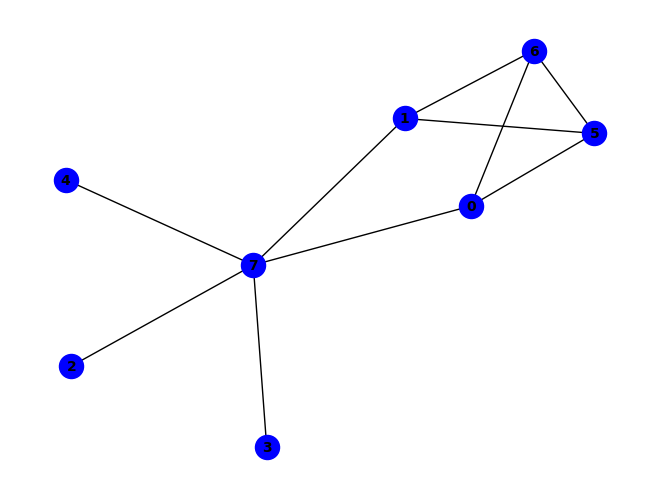


~f ^ (a & g & ~h) ^ (a & h & ~e) ^ (a & e & f & g) ^ (a & f & g & h) ^ (a & b & g & ~f) ^ (a & b & h & ~g) ^ (a & f & ~e & ~h) ^ (b & g & ~f & ~h) ^ (b & h & ~d & ~f) ^ (e & h & ~b & ~f) ^ (a & b & e & h & ~f) ^ (f & ~b & ~e & ~g) ^ (a & b & f & ~g & ~h) ^ (d & h & ~a & ~e & ~f) ^ (e & f & ~b & ~g & ~h) ^ (a & b & c & h & ~e & ~f) ^ (a & b & d & h & ~c & ~f) ^ (a & d & e & f & ~c & ~g) ^ (b & d & e & h & ~a & ~f) ^ (a & b & c & d & e & h & ~f) ^ (a & c & h & ~d & ~e & ~f) ^ (a & e & f & ~d & ~g & ~h) ^ (d & f & h & ~b & ~e & ~g) ^ (a & b & e & f & h & ~d & ~g) ^ (a & c & d & e & f & ~g & ~h) ^ (a & b & c & d & e & f & h & ~g) ^ (c & h & ~b & ~d & ~e & ~f) ^ (a & c & f & h & ~b & ~e & ~g) ^ (a & d & f & h & ~b & ~c & ~g) ^ (c & f & h & ~b & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


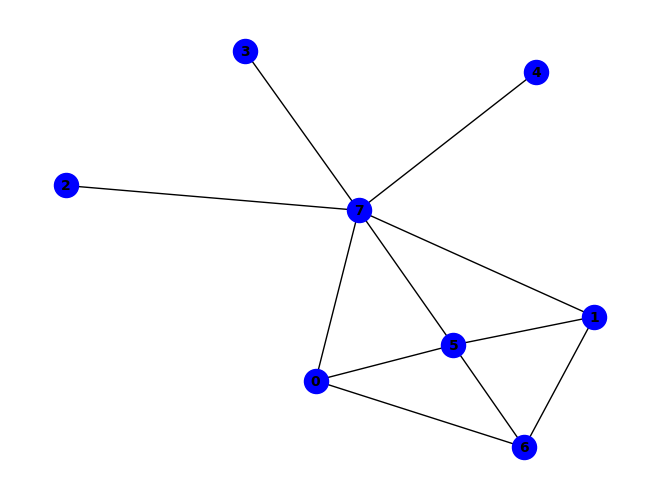


~e ^ (a & g & ~h) ^ (a & h & ~e) ^ (b & f & ~e) ^ (b & g & ~a) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (a & d & e & h) ^ (e & ~d & ~h) ^ (b & d & e & f & h) ^ (a & f & ~b & ~e) ^ (b & h & ~a & ~g) ^ (a & b & e & h & ~d) ^ (a & d & e & f & ~b) ^ (b & c & e & f & ~d) ^ (c & d & e & f & ~a) ^ (c & d & e & h & ~a) ^ (a & b & c & d & e & f) ^ (a & b & c & d & e & h) ^ (b & c & h & ~d & ~f) ^ (b & d & h & ~a & ~f) ^ (b & e & f & ~c & ~h) ^ (b & e & h & ~c & ~d) ^ (d & e & f & ~c & ~h) ^ (a & b & c & d & h & ~f) ^ (b & c & d & e & f & ~h) ^ (c & h & ~a & ~e & ~f) ^ (d & h & ~a & ~c & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & e & f & ~b & ~d & ~h) ^ (a & c & d & e & f & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


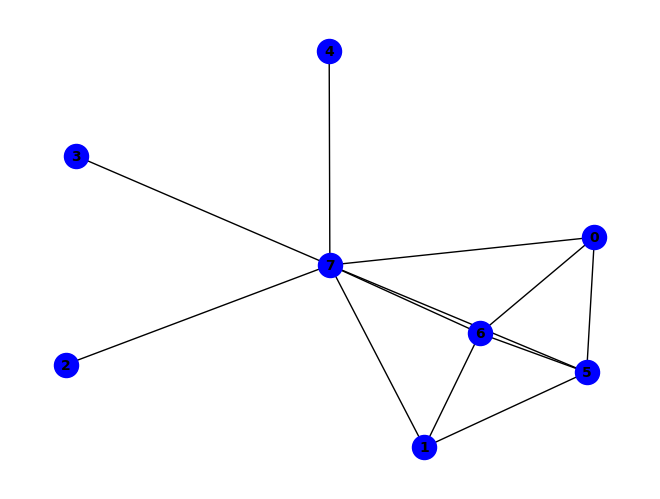


~g ^ (a & f & ~g) ^ (a & g & ~e) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (a & b & f & ~e) ^ (a & b & g & ~f) ^ (b & e & g & ~h) ^ (c & f & g & ~h) ^ (a & h & ~b & ~e) ^ (e & h & ~d & ~g) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (b & d & f & g & ~e) ^ (b & d & f & h & ~e) ^ (c & d & e & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & e & g & ~f & ~h) ^ (a & f & g & ~b & ~h) ^ (b & d & h & ~e & ~g) ^ (b & f & g & ~d & ~h) ^ (c & e & h & ~f & ~g) ^ (e & f & g & ~d & ~h) ^ (a & b & d & e & f & ~g) ^ (a & b & e & g & h & ~f) ^ (c & d & e & f & g & ~h) ^ (a & b & e & f & ~d & ~h) ^ (b & c & e & h & ~d & ~g) ^ (b & e & f & h & ~c & ~g) ^ (a & c & d & e & f & g & ~b) ^ (a & c & d & e & f & h & ~b) ^ (b & c & d & e & f & h & ~g) ^ (b & c & h & ~d & ~f & ~g) ^ (a & d & e & f & g & ~c & ~h) ^ (b & d & e & f & g & ~a & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (d & h & ~a & ~c & ~f & ~g) ^ (a & b

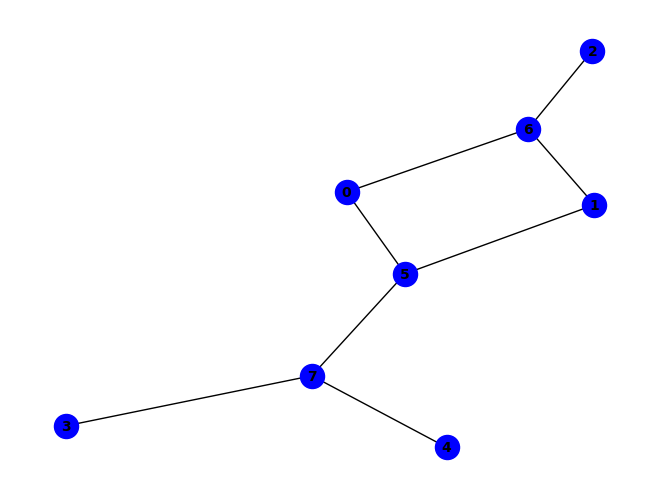


(~b & ~f) ^ (e & h & ~f) ^ (b & ~f & ~g) ^ (a & g & ~b & ~f) ^ (c & g & ~a & ~b) ^ (d & h & ~e & ~f) ^ (f & ~a & ~b & ~h) ^ (a & c & d & g & h & ~e) ^ (a & c & e & g & h & ~f) ^ (a & c & f & g & h & ~d) ^ (a & d & g & h & ~b & ~f) ^ (a & e & g & h & ~d & ~f) ^ (b & d & g & h & ~e & ~f) ^ (b & e & g & h & ~a & ~f) ^ (c & d & g & h & ~b & ~e) ^ (c & e & g & h & ~b & ~f) ^ (c & f & g & h & ~b & ~d) ^ (a & b & c & d & g & h & ~f) ^ (a & b & c & e & g & h & ~d) ^ (a & b & c & f & g & h & ~e) ^ (a & b & d & e & g & h & ~f) ^ (c & d & e & f & g & h & ~a & ~b)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


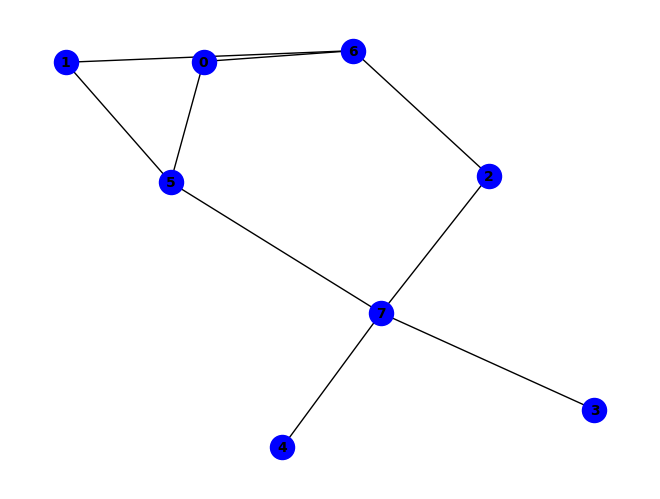


(b & c & g) ^ (~b & ~f) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & d & f & g) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & f & ~h) ^ (a & c & g & ~b) ^ (a & f & ~d & ~h) ^ (a & g & ~b & ~f) ^ (d & h & ~e & ~f) ^ (a & d & g & h & ~e) ^ (a & b & c & f & g & h) ^ (a & d & f & ~g & ~h) ^ (a & c & e & g & h & ~d) ^ (a & c & f & g & h & ~e) ^ (b & c & e & g & h & ~d) ^ (b & c & f & g & h & ~e) ^ (a & b & c & d & e & g & h) ^ (c & h & ~d & ~e & ~f) ^ (a & e & g & h & ~b & ~f) ^ (b & d & g & h & ~c & ~f) ^ (b & e & g & h & ~d & ~f) ^ (a & b & c & e & g & h & ~f) ^ (a & d & e & f & g & h & ~c) ^ (a & b & d & g & h & ~e & ~f) ^ (a & c & d & g & h & ~b & ~f) ^ (b & c & d & e & f & g & h & ~a)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


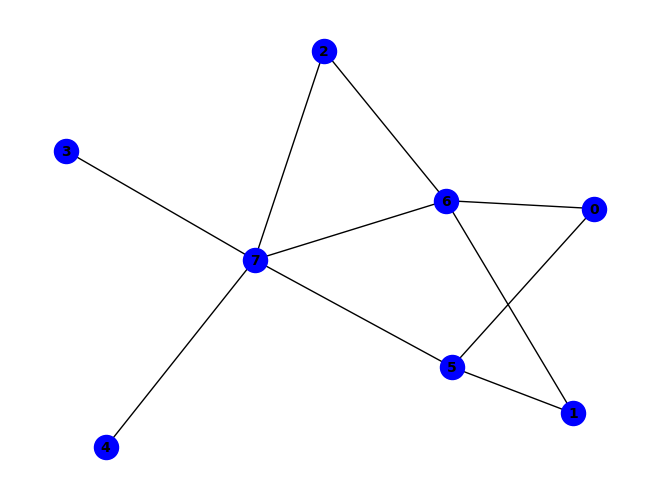


(~b & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & h & ~g) ^ (g & ~a & ~h) ^ (a & b & c & ~h) ^ (a & c & g & ~h) ^ (b & c & g & ~h) ^ (a & b & ~c & ~g) ^ (a & f & ~g & ~h) ^ (b & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & b & c & h & ~g) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (b & ~a & ~f & ~h) ^ (b & f & g & ~a & ~h) ^ (c & d & h & ~f & ~g) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (c & d & e & f & g & ~h) ^ (d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


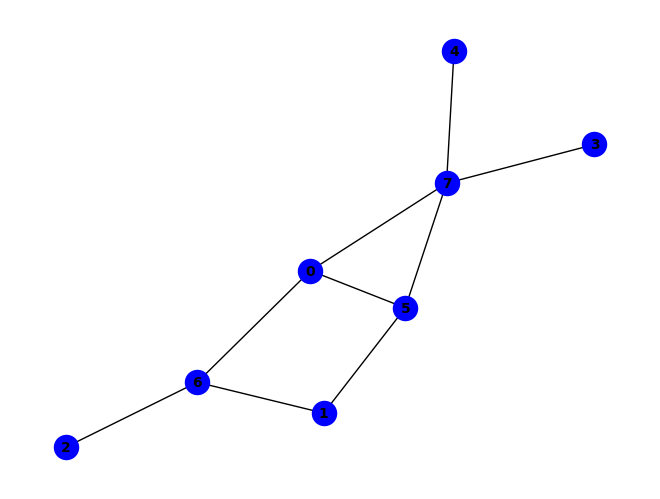


(~b & ~f) ^ (a & g & ~h) ^ (a & h & ~e) ^ (e & h & ~f) ^ (a & f & g & h) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & f & ~h) ^ (a & b & g & ~f) ^ (a & f & ~c & ~g) ^ (c & g & ~a & ~b) ^ (a & c & f & h & ~e) ^ (a & e & f & h & ~b) ^ (b & e & g & h & ~f) ^ (a & b & c & f & g & h) ^ (a & c & f & ~g & ~h) ^ (a & b & d & g & h & ~f) ^ (a & b & e & f & h & ~g) ^ (a & b & e & g & h & ~d) ^ (a & c & e & f & h & ~g) ^ (a & c & e & g & h & ~d) ^ (a & b & d & e & f & g & h) ^ (a & c & d & e & f & g & h) ^ (d & h & ~a & ~e & ~f) ^ (b & d & g & h & ~e & ~f) ^ (c & d & g & h & ~b & ~e) ^ (c & e & g & h & ~b & ~f) ^ (c & f & g & h & ~b & ~d) ^ (c & d & e & f & g & h & ~b) ^ (a & c & d & g & h & ~b & ~f) ^ (a & b & c & e & g & h & ~d & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


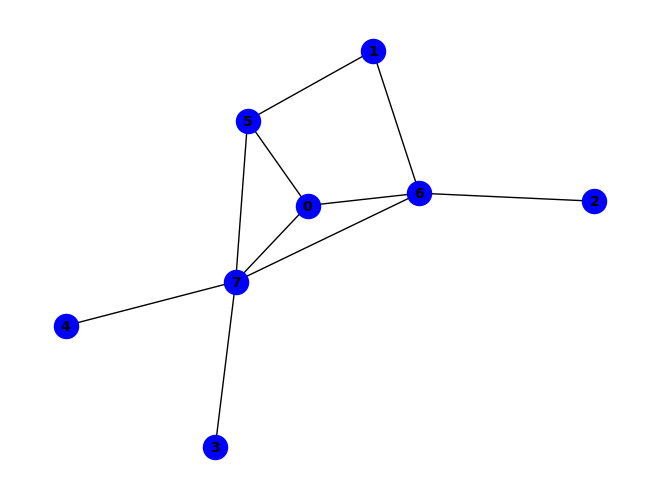


(~c & ~g) ^ (a & f & ~e) ^ (a & g & ~f) ^ (a & h & ~e) ^ (f & h & ~g) ^ (a & e & g & h) ^ (g & ~b & ~h) ^ (a & b & g & ~h) ^ (a & d & e & f & h) ^ (a & c & ~b & ~g) ^ (b & c & ~g & ~h) ^ (c & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & b & c & h & ~g) ^ (a & d & e & h & ~g) ^ (a & e & f & g & ~d) ^ (c & ~a & ~b & ~h) ^ (a & d & h & ~f & ~g) ^ (a & e & f & ~g & ~h) ^ (a & d & e & f & g & ~h) ^ (b & f & ~a & ~g & ~h) ^ (d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


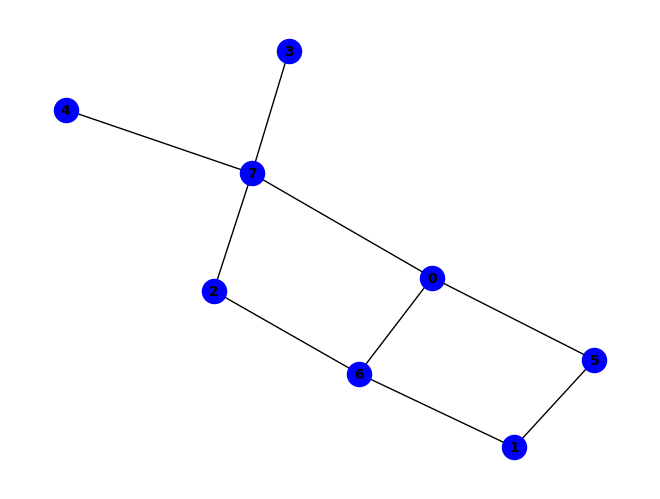


(~b & ~e) ^ (b & ~f & ~g) ^ (a & e & ~b & ~d) ^ (a & f & ~b & ~h) ^ (a & h & ~b & ~d) ^ (d & h & ~b & ~e) ^ (e & ~a & ~b & ~h) ^ (a & d & e & ~b & ~h) ^ (a & g & ~b & ~f & ~h) ^ (c & g & ~a & ~b & ~h) ^ (b & c & h & ~d & ~f & ~g) ^ (b & d & h & ~e & ~f & ~g) ^ (b & e & h & ~c & ~f & ~g) ^ (b & c & d & e & h & ~f & ~g) ^ (c & h & ~a & ~b & ~d & ~e) ^ (a & b & h & ~c & ~d & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


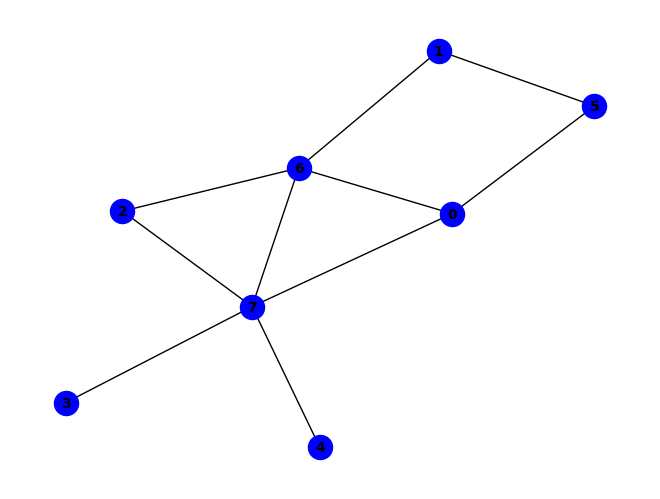


(~b & ~g) ^ (a & b & ~g) ^ (a & f & ~h) ^ (c & h & ~e) ^ (a & f & g & h) ^ (b & ~f & ~g) ^ (g & ~b & ~h) ^ (a & b & g & ~h) ^ (a & b & ~e & ~f) ^ (a & g & ~b & ~f) ^ (a & h & ~c & ~e) ^ (c & g & ~a & ~e) ^ (e & h & ~b & ~g) ^ (a & d & e & h & ~c) ^ (a & e & g & h & ~d) ^ (a & b & e & ~f & ~h) ^ (a & d & h & ~c & ~g) ^ (b & e & h & ~f & ~g) ^ (a & b & e & g & h & ~f) ^ (a & b & c & d & e & f & h) ^ (d & h & ~c & ~e & ~g) ^ (a & b & e & h & ~d & ~g) ^ (b & c & f & g & ~a & ~e) ^ (b & c & f & h & ~a & ~e) ^ (a & c & d & e & g & h & ~b) ^ (c & e & g & ~a & ~b & ~h) ^ (a & b & d & e & h & ~f & ~g) ^ (a & b & d & f & h & ~c & ~g) ^ (a & b & c & d & e & g & h & ~f) ^ (b & d & f & h & ~c & ~e & ~g) ^ (b & c & g & ~a & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


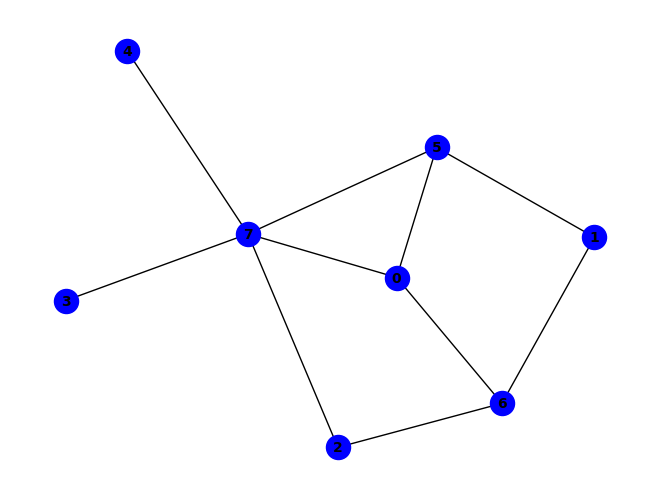


(a & c & g) ^ (~b & ~f) ^ (a & f & ~g) ^ (a & g & ~h) ^ (a & h & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & f & g & h) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & f & ~h) ^ (a & b & g & ~f) ^ (a & c & h & ~g) ^ (b & c & g & ~a) ^ (a & c & d & h & ~e) ^ (a & c & e & h & ~f) ^ (a & c & f & h & ~d) ^ (a & e & f & h & ~b) ^ (a & b & e & f & h & ~g) ^ (b & c & e & g & h & ~d) ^ (a & b & d & e & f & g & h) ^ (b & c & d & e & f & g & h) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (b & e & g & h & ~d & ~f) ^ (a & c & d & e & f & h & ~b) ^ (a & b & e & g & h & ~c & ~d) ^ (b & c & f & g & h & ~a & ~e) ^ (a & b & c & d & e & f & h & ~g) ^ (b & d & g & h & ~a & ~c & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


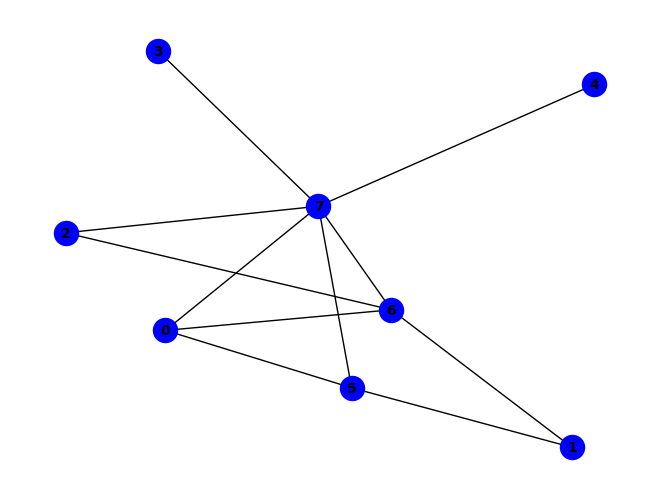


(g & ~h) ^ (~b & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (a & b & c & ~h) ^ (a & e & g & ~h) ^ (b & c & g & ~h) ^ (a & b & ~c & ~g) ^ (b & h & ~a & ~g) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (e & h & ~f & ~g) ^ (a & b & c & h & ~g) ^ (a & e & f & h & ~g) ^ (b & ~a & ~f & ~h) ^ (b & f & g & ~a & ~h) ^ (c & e & f & g & ~a & ~d) ^ (c & e & f & h & ~a & ~d) ^ (c & d & h & ~a & ~f & ~g) ^ (c & e & h & ~a & ~d & ~g) ^ (c & f & g & ~a & ~e & ~h) ^ (c & d & e & f & g & ~a & ~h) ^ (d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


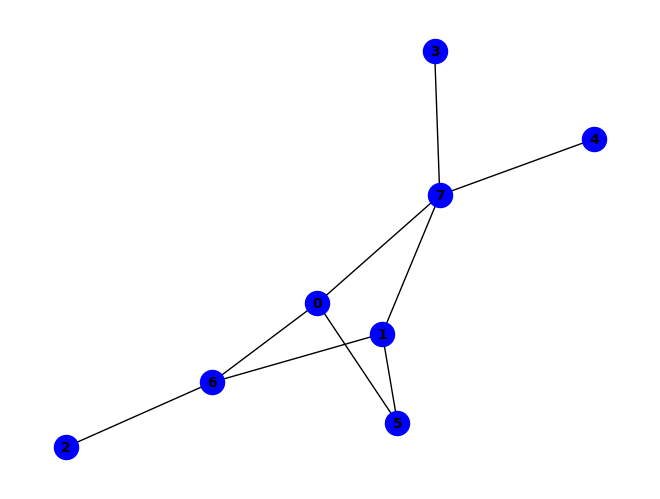


~e ^ (a & e & ~d) ^ (a & f & ~g) ^ (a & g & ~h) ^ (a & h & ~f) ^ (b & g & ~h) ^ (b & h & ~e) ^ (e & ~a & ~h) ^ (a & b & f & ~h) ^ (a & b & g & ~f) ^ (a & b & h & ~g) ^ (a & d & e & ~h) ^ (a & d & h & ~c) ^ (b & f & ~g & ~h) ^ (c & g & ~a & ~b) ^ (d & h & ~b & ~e) ^ (a & b & d & h & ~e) ^ (a & b & e & h & ~c) ^ (a & c & d & h & ~g) ^ (a & f & g & h & ~b) ^ (c & e & g & h & ~b) ^ (a & b & c & e & h & ~g) ^ (a & c & e & g & h & ~d) ^ (c & d & g & h & ~b & ~e) ^ (a & b & c & d & g & h & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


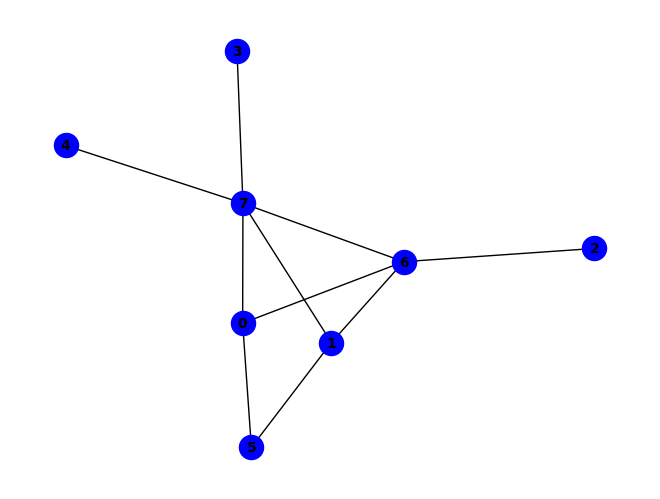


(g & ~h) ^ (~c & ~g) ^ (a & f & ~b) ^ (b & f & ~h) ^ (b & g & ~f) ^ (b & h & ~e) ^ (c & h & ~g) ^ (b & f & g & h) ^ (c & ~b & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (b & c & ~g & ~h) ^ (e & h & ~a & ~g) ^ (a & b & e & h & ~g) ^ (a & f & g & h & ~b) ^ (b & d & e & h & ~a) ^ (b & e & g & h & ~d) ^ (a & b & d & e & g & h) ^ (a & c & g & ~b & ~h) ^ (b & d & h & ~a & ~g) ^ (d & h & ~a & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


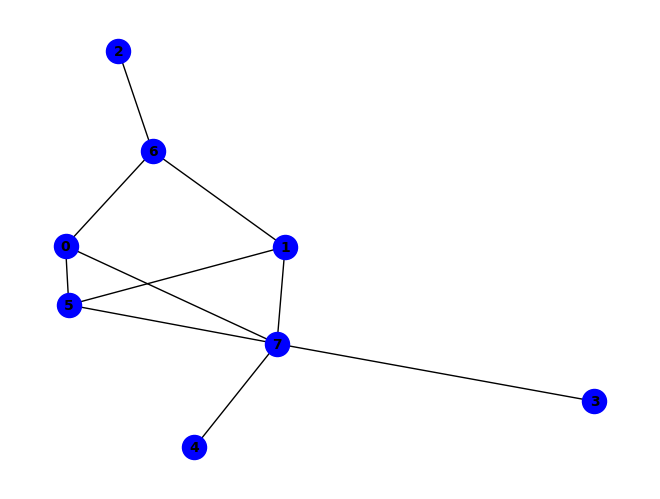


~f ^ (f & ~h) ^ (a & h & ~e) ^ (b & g & ~h) ^ (e & h & ~f) ^ (a & f & g & h) ^ (a & f & ~c & ~g) ^ (a & g & ~b & ~h) ^ (b & h & ~a & ~e) ^ (c & g & ~a & ~b) ^ (a & e & f & h & ~b) ^ (b & c & f & h & ~d) ^ (b & e & f & h & ~c) ^ (b & f & g & h & ~a) ^ (c & e & g & h & ~f) ^ (c & f & g & h & ~d) ^ (a & c & e & g & h & ~d) ^ (b & c & d & f & h & ~g) ^ (b & c & e & g & h & ~a) ^ (a & b & c & d & e & g & h) ^ (b & f & ~a & ~c & ~g) ^ (a & c & f & h & ~b & ~e) ^ (b & c & e & f & ~d & ~g) ^ (c & d & g & h & ~b & ~e) ^ (b & c & d & e & f & h & ~a) ^ (c & d & e & f & g & h & ~a) ^ (a & c & f & ~b & ~g & ~h) ^ (b & c & f & ~e & ~g & ~h) ^ (a & c & d & g & h & ~b & ~f) ^ (a & c & e & f & h & ~b & ~g) ^ (b & c & d & e & f & ~g & ~h) ^ (a & b & c & d & e & f & h & ~g) ^ (d & h & ~a & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

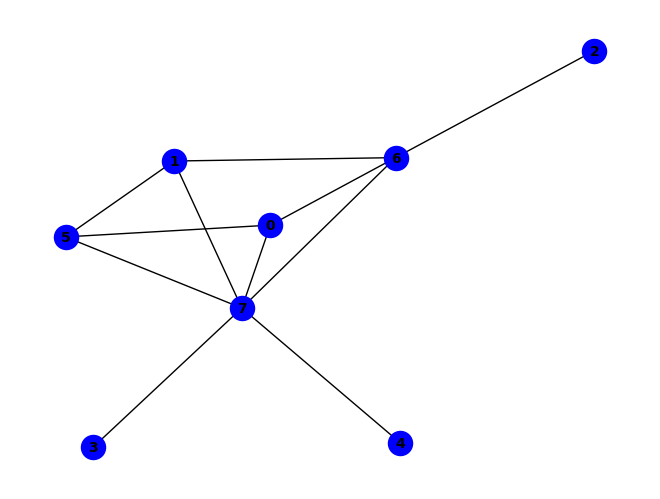


(g & ~h) ^ (~c & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (a & c & ~b & ~g) ^ (a & h & ~b & ~e) ^ (b & c & ~g & ~h) ^ (b & f & ~a & ~e) ^ (b & g & ~a & ~f) ^ (c & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & b & c & h & ~g) ^ (a & b & e & f & ~h) ^ (a & e & f & h & ~g) ^ (b & e & f & g & ~d) ^ (b & e & g & h & ~a) ^ (a & b & d & e & f & g) ^ (a & b & e & f & g & h) ^ (c & ~a & ~b & ~h) ^ (b & e & f & ~g & ~h) ^ (b & d & e & f & h & ~a) ^ (b & d & e & h & ~a & ~g) ^ (b & d & h & ~a & ~f & ~g) ^ (b & d & e & f & g & ~a & ~h) ^ (d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


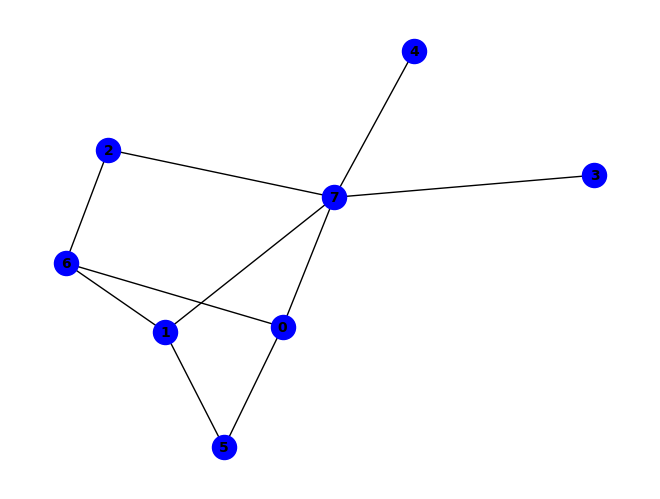


~e ^ (e & ~h) ^ (b & f & ~g) ^ (b & h & ~f) ^ (c & g & ~h) ^ (d & h & ~e) ^ (a & b & c & g) ^ (a & b & f & ~h) ^ (a & b & g & ~f) ^ (b & c & h & ~e) ^ (b & c & d & e & h) ^ (a & f & ~g & ~h) ^ (a & g & ~c & ~h) ^ (b & g & ~c & ~h) ^ (c & h & ~d & ~e) ^ (b & f & g & h & ~a) ^ (a & b & h & ~c & ~g) ^ (b & d & h & ~a & ~c) ^ (b & e & h & ~a & ~d) ^ (a & b & c & e & h & ~d) ^ (a & h & ~c & ~d & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


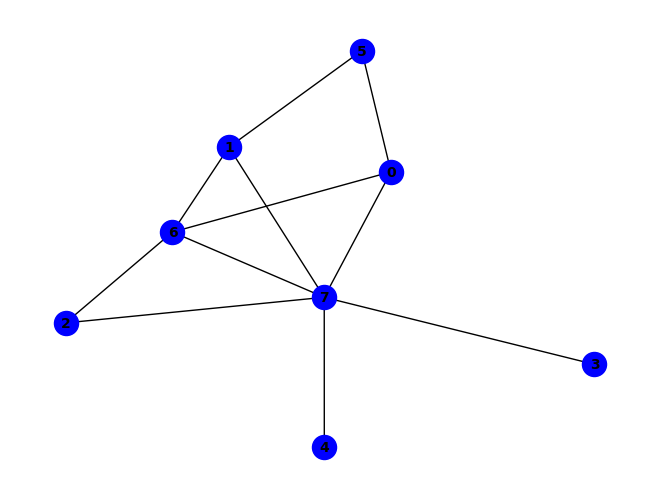


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & h & ~f) ^ (e & h & ~g) ^ (b & f & g & h) ^ (a & e & h & ~d) ^ (a & d & e & g & h) ^ (a & g & ~c & ~e) ^ (b & f & ~a & ~h) ^ (b & g & ~a & ~f) ^ (c & g & ~b & ~e) ^ (c & h & ~a & ~e) ^ (a & b & c & g & ~e) ^ (a & f & g & h & ~b) ^ (b & e & g & h & ~a) ^ (a & d & h & ~c & ~g) ^ (a & e & g & ~c & ~h) ^ (c & e & g & ~b & ~h) ^ (a & b & c & e & g & ~h) ^ (a & c & d & e & h & ~g) ^ (b & h & ~a & ~c & ~e) ^ (d & h & ~b & ~c & ~e & ~g) ^ (a & b & d & h & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


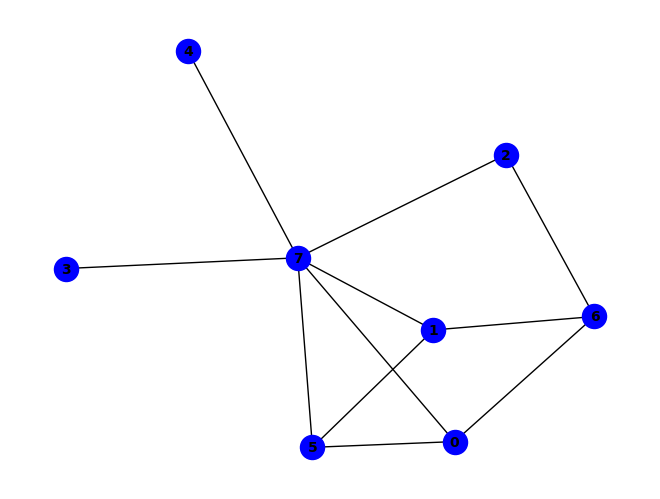


~f ^ (f & ~h) ^ (a & c & g) ^ (a & f & ~g) ^ (a & h & ~e) ^ (b & g & ~h) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & f & g & h) ^ (b & c & g & ~a) ^ (b & c & h & ~g) ^ (a & g & ~b & ~h) ^ (b & f & ~a & ~g) ^ (b & h & ~a & ~e) ^ (a & c & e & h & ~f) ^ (a & c & f & h & ~b) ^ (a & e & f & h & ~b) ^ (b & c & d & h & ~e) ^ (b & c & f & h & ~d) ^ (b & d & e & h & ~a) ^ (b & e & f & h & ~d) ^ (b & f & g & h & ~a) ^ (a & b & d & e & f & h) ^ (b & c & d & e & f & h) ^ (a & c & h & ~b & ~g) ^ (b & d & h & ~a & ~f) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (b & c & e & h & ~a & ~f) ^ (a & c & d & h & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


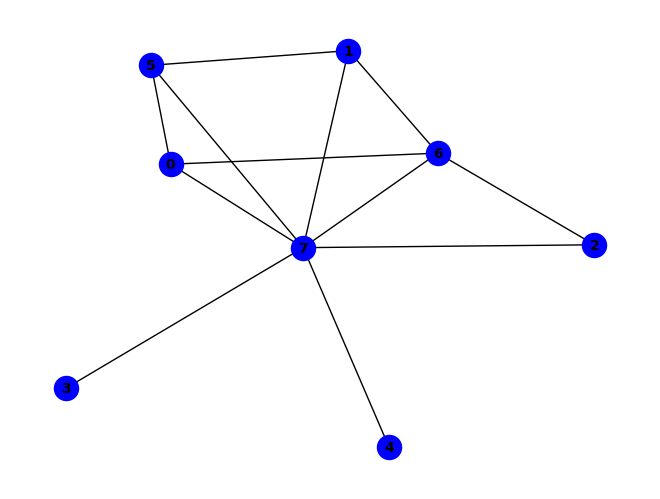


~g ^ (g & ~h) ^ (a & h & ~e) ^ (b & f & ~e) ^ (f & h & ~g) ^ (b & e & f & ~h) ^ (a & f & ~b & ~g) ^ (a & g & ~b & ~e) ^ (b & g & ~c & ~f) ^ (b & h & ~a & ~e) ^ (c & g & ~a & ~f) ^ (e & h & ~f & ~g) ^ (a & b & c & g & ~f) ^ (b & e & g & h & ~f) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (a & e & g & ~b & ~h) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (b & c & d & f & g & ~e) ^ (b & c & d & f & h & ~e) ^ (c & h & ~a & ~b & ~f) ^ (a & c & f & g & ~b & ~h) ^ (a & e & f & h & ~b & ~g) ^ (b & c & d & h & ~e & ~g) ^ (b & c & f & g & ~d & ~h) ^ (c & d & h & ~a & ~f & ~g) ^ (c & d & e & f & g & ~b & ~h) ^ (a & c & e & h & ~d & ~f & ~g) ^ (b & c & e & h & ~a & ~f & ~g) ^ (a & b & c & d & h & ~e & ~f & ~g) ^ (d & h & ~a & ~b & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


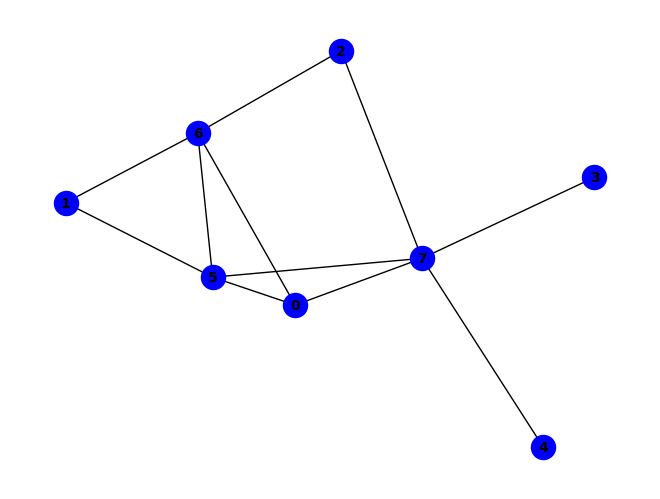


~e ^ (a & f & ~e) ^ (a & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & g & ~c & ~h) ^ (b & f & ~a & ~h) ^ (b & g & ~a & ~c) ^ (c & g & ~f & ~h) ^ (a & c & f & g & ~h) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (b & c & f & g & ~a) ^ (b & d & g & h & ~e) ^ (b & f & g & h & ~d) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (a & b & c & d & e & f) ^ (a & e & f & ~d & ~h) ^ (d & e & f & ~c & ~h) ^ (a & b & d & g & h & ~f) ^ (a & b & e & g & h & ~d) ^ (a & b & f & g & h & ~e) ^ (b & c & d & e & h & ~g) ^ (a & b & c & d & e & g & h) ^ (c & h & ~a & ~e & ~f) ^ (d & h & ~a & ~c & ~f) ^ (b & e & g & h & ~c & ~f) ^ (a & b & c & e & g & h & ~f) ^ (b & c & d & e & f & g & ~h) ^ (b & d & e & f & g & h & ~a) ^ (a & c & d & e & f & ~b & ~h) ^ (b & c & d & e & f & ~a & ~g) ^ (b & c & d & g & h & ~a & ~f) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

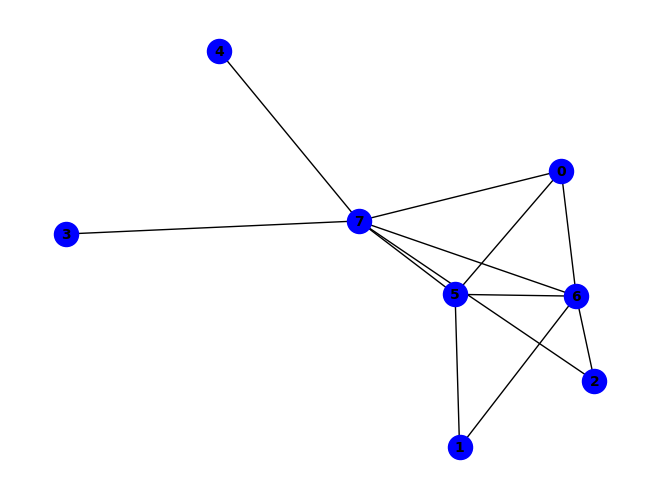


(g & ~h) ^ (~b & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (b & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (b & ~f & ~h) ^ (a & e & g & ~h) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (e & h & ~d & ~g) ^ (a & d & f & g & ~e) ^ (a & d & f & h & ~e) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & f & ~c & ~h) ^ (a & b & g & ~c & ~h) ^ (a & d & h & ~e & ~g) ^ (a & f & g & ~d & ~h) ^ (b & c & g & ~f & ~h) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (d & h & ~c & ~f & ~g) ^ (a & b & c & f & ~g & ~h) ^ (a & c & d & h & ~f & ~g) ^ (c & d & e & h & ~a & ~g) ^ (a & c & d & e & f & h & ~g) ^ (c & e & h & ~a & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


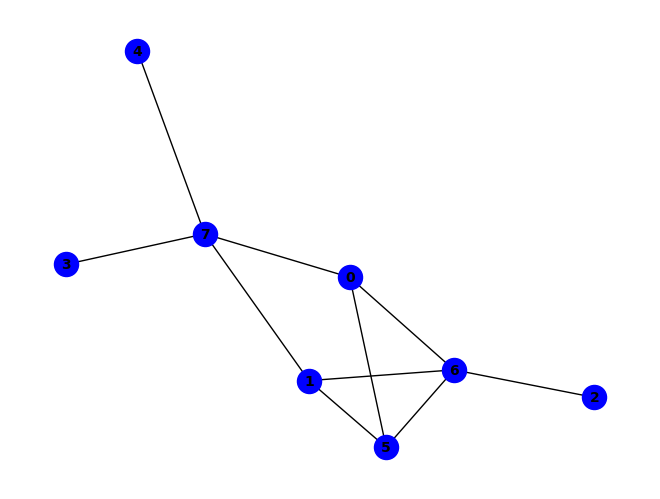


~f ^ (a & h & ~g) ^ (a & g & ~c & ~f) ^ (c & g & ~b & ~f) ^ (e & h & ~a & ~f) ^ (a & b & c & g & ~f) ^ (f & ~b & ~e & ~g) ^ (a & b & f & ~e & ~g) ^ (a & e & f & ~d & ~g) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (a & f & ~e & ~g & ~h) ^ (b & g & ~a & ~f & ~h) ^ (d & h & ~a & ~e & ~f) ^ (e & f & ~b & ~g & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & d & e & f & ~g & ~h) ^ (a & d & f & h & ~b & ~g) ^ (a & b & c & d & g & h & ~f) ^ (d & f & h & ~b & ~e & ~g) ^ (a & c & d & g & h & ~e & ~f) ^ (b & h & ~a & ~d & ~e & ~f) ^ (c & d & g & h & ~b & ~e & ~f) ^ (c & e & g & h & ~a & ~b & ~f) ^ (a & b & d & e & f & h & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


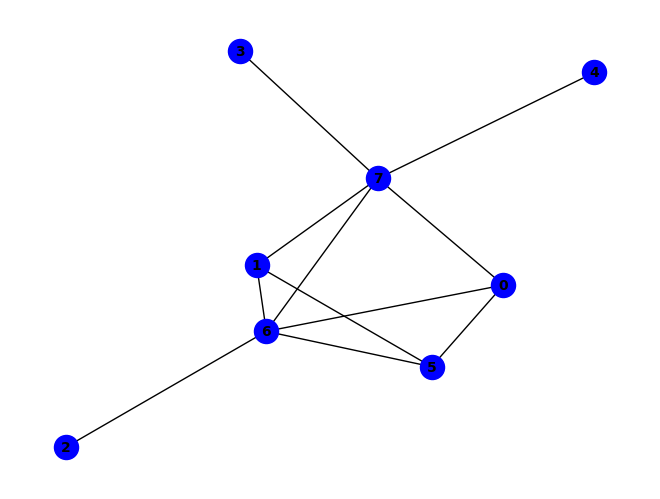


(~f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (e & h & ~g) ^ (f & h & ~g) ^ (g & ~c & ~h) ^ (b & c & g & ~h) ^ (b & e & g & ~h) ^ (a & f & ~b & ~c) ^ (a & g & ~b & ~e) ^ (a & h & ~b & ~f) ^ (a & c & f & h & ~b) ^ (f & ~b & ~c & ~h) ^ (a & c & g & ~b & ~h) ^ (a & d & h & ~b & ~g) ^ (a & e & g & ~b & ~h) ^ (a & e & h & ~b & ~d) ^ (a & d & e & g & h & ~b) ^ (d & h & ~b & ~e & ~g) ^ (c & f & ~a & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


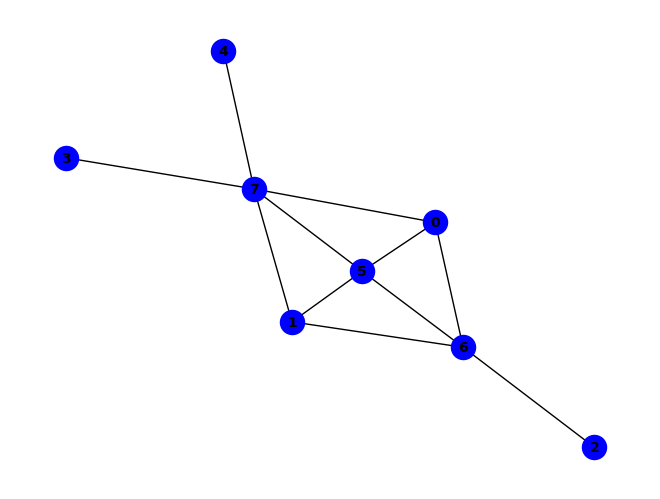


~e ^ (a & f & ~e) ^ (b & g & ~c) ^ (b & h & ~g) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (a & b & c & g) ^ (e & ~d & ~h) ^ (b & e & h & ~d) ^ (c & d & e & f & g) ^ (a & g & ~b & ~h) ^ (a & h & ~b & ~e) ^ (b & f & ~a & ~e) ^ (c & g & ~a & ~f) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (b & c & f & g & ~a) ^ (a & e & f & ~d & ~h) ^ (b & e & f & ~a & ~h) ^ (d & e & f & ~c & ~h) ^ (a & b & d & e & h & ~f) ^ (a & c & d & e & f & ~h) ^ (b & d & e & f & h & ~c) ^ (c & d & e & g & h & ~b) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (d & h & ~a & ~b & ~f) ^ (a & c & d & e & h & ~f & ~g) ^ (b & c & d & e & f & ~a & ~g) ^ (c & d & e & f & ~b & ~g & ~h) ^ (c & d & g & h & ~a & ~b & ~f) ^ (c & e & g & h & ~a & ~b & ~f) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

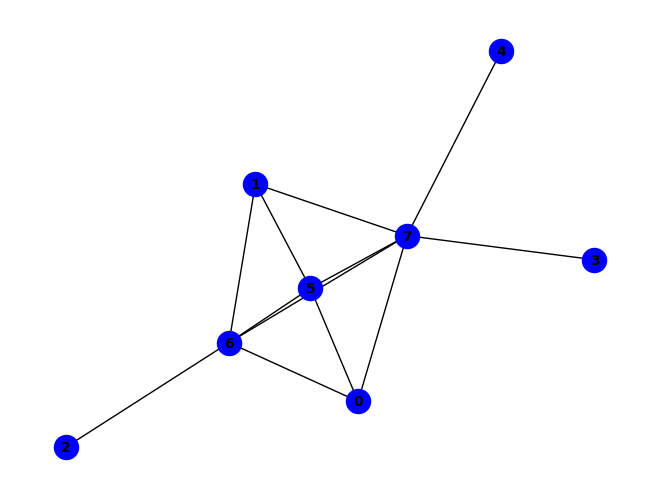


(g & ~h) ^ (~c & ~g) ^ (a & g & ~e) ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (c & ~f & ~h) ^ (a & b & f & ~e) ^ (a & b & g & ~f) ^ (b & c & f & ~h) ^ (b & c & g & ~h) ^ (b & e & g & ~h) ^ (a & b & d & f & h) ^ (a & f & ~c & ~g) ^ (a & h & ~b & ~e) ^ (b & f & ~c & ~g) ^ (c & f & ~g & ~h) ^ (e & h & ~d & ~g) ^ (a & b & c & f & ~g) ^ (a & b & d & h & ~g) ^ (a & c & f & h & ~g) ^ (a & d & e & g & ~f) ^ (a & d & e & h & ~b) ^ (a & e & f & h & ~g) ^ (b & d & f & g & ~a) ^ (b & d & f & h & ~e) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~a) ^ (a & b & d & e & g & h) ^ (a & c & f & ~b & ~h) ^ (a & c & g & ~b & ~h) ^ (a & e & g & ~d & ~h) ^ (a & f & g & ~b & ~h) ^ (b & d & h & ~e & ~g) ^ (b & f & g & ~d & ~h) ^ (e & f & g & ~d & ~h) ^ (a & b & d & e & f & ~g) ^ (a & b & d & f & g & ~h) ^ (a & b & e & g & h & ~f) ^ (b & d & e & f & g & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & b & e & f & ~d & ~h) ^ (b & c & f & h & ~a & ~g) ^ (a & d & e & f & 

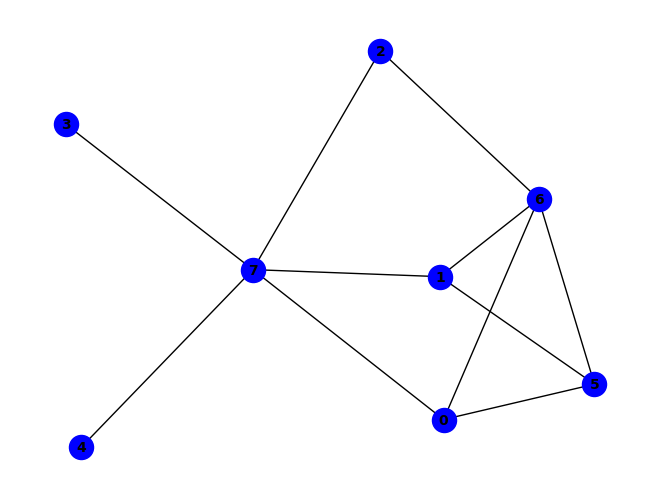


~f ^ (a & f & g) ^ (a & g & ~h) ^ (a & h & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (c & g & ~h) ^ (c & h & ~e) ^ (e & h & ~f) ^ (a & e & f & h) ^ (b & e & f & g) ^ (b & f & g & h) ^ (f & ~e & ~g) ^ (a & b & g & ~f) ^ (a & b & h & ~g) ^ (a & c & g & ~f) ^ (b & c & g & ~a) ^ (b & c & h & ~g) ^ (c & f & g & ~b) ^ (a & b & c & f & g) ^ (c & e & f & g & h) ^ (b & f & ~e & ~h) ^ (a & c & d & h & ~f) ^ (b & c & d & h & ~f) ^ (a & b & f & ~g & ~h) ^ (a & c & h & ~b & ~g) ^ (a & d & h & ~e & ~f) ^ (a & e & f & ~d & ~g) ^ (b & d & h & ~e & ~f) ^ (a & f & ~e & ~g & ~h) ^ (d & h & ~c & ~e & ~f) ^ (e & f & ~b & ~g & ~h) ^ (a & b & d & h & ~c & ~f) ^ (a & c & e & h & ~d & ~f) ^ (a & d & e & f & ~g & ~h) ^ (a & d & f & h & ~c & ~g) ^ (b & c & e & h & ~d & ~f) ^ (d & f & h & ~c & ~e & ~g) ^ (a & b & e & f & h & ~c & ~g) ^ (a & c & e & f & h & ~d & ~g) ^ (b & c & d & f & h & ~a & ~g) ^ (b & c & e & f & h & ~d & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (a & b & e & h & ~c & ~d & ~f) ^ (b & d & f & h & ~a &

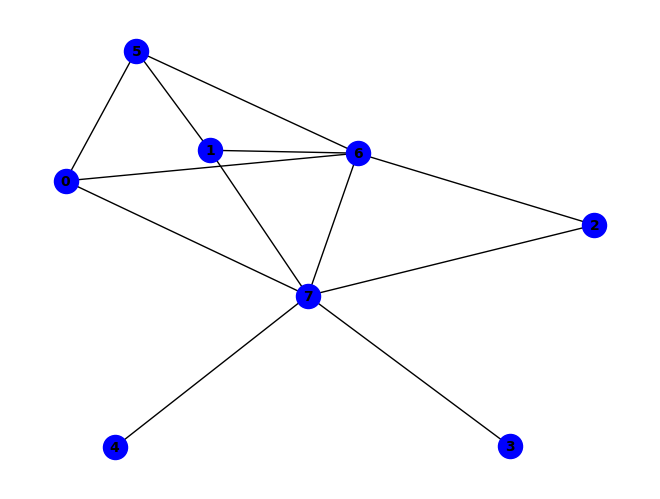


(g & ~h) ^ (~f & ~g) ^ (c & g & ~e) ^ (c & h & ~e) ^ (e & h & ~g) ^ (f & h & ~g) ^ (a & c & g & ~f) ^ (a & c & h & ~f) ^ (b & e & g & ~h) ^ (a & f & ~b & ~h) ^ (a & g & ~b & ~e) ^ (a & h & ~b & ~e) ^ (b & g & ~c & ~e) ^ (b & h & ~c & ~e) ^ (a & b & c & f & ~g) ^ (a & b & c & f & ~h) ^ (a & b & c & g & ~e) ^ (a & b & c & h & ~e) ^ (f & ~b & ~c & ~h) ^ (a & e & g & ~b & ~h) ^ (c & e & g & ~b & ~h) ^ (a & b & c & e & g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (a & c & d & h & ~b & ~g) ^ (a & c & e & h & ~d & ~g) ^ (a & c & f & h & ~b & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & d & h & ~b & ~e & ~g) ^ (d & h & ~b & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


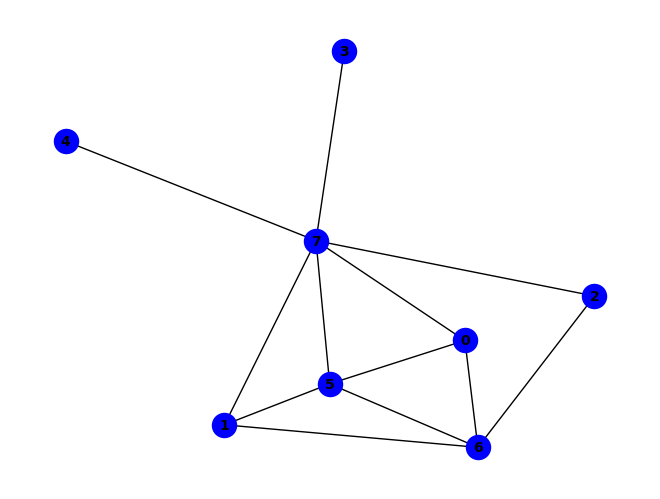


~e ^ (a & h & ~e) ^ (b & f & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (a & d & e & h) ^ (e & ~d & ~h) ^ (b & d & e & f & h) ^ (a & f & ~b & ~e) ^ (a & g & ~c & ~h) ^ (b & g & ~a & ~c) ^ (c & g & ~f & ~h) ^ (a & b & e & h & ~d) ^ (a & d & e & f & ~b) ^ (b & c & e & f & ~d) ^ (b & c & f & g & ~h) ^ (b & c & f & h & ~a) ^ (c & d & e & f & ~a) ^ (c & d & e & h & ~a) ^ (a & b & c & d & e & f) ^ (a & b & c & d & e & h) ^ (b & e & f & ~c & ~h) ^ (b & e & h & ~c & ~d) ^ (d & e & f & ~c & ~h) ^ (a & b & c & e & h & ~f) ^ (b & c & d & e & f & ~h) ^ (b & h & ~a & ~c & ~g) ^ (c & h & ~a & ~e & ~f) ^ (a & c & f & g & ~b & ~h) ^ (a & e & f & ~b & ~d & ~h) ^ (a & c & d & e & f & ~b & ~h) ^ (d & h & ~a & ~b & ~c & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


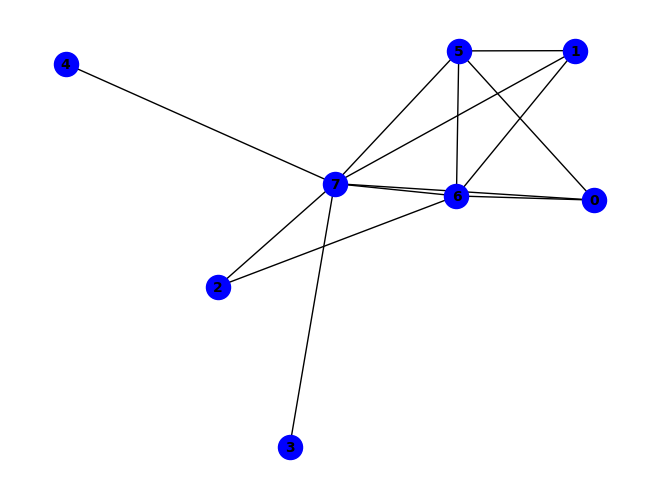


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & b & f & ~e) ^ (a & c & g & ~f) ^ (b & e & g & ~h) ^ (a & h & ~b & ~e) ^ (c & g & ~b & ~f) ^ (e & h & ~d & ~g) ^ (a & d & e & g & ~f) ^ (a & d & e & h & ~f) ^ (a & e & f & h & ~g) ^ (b & d & f & g & ~e) ^ (b & d & f & h & ~e) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & g & ~c & ~f) ^ (a & e & g & ~d & ~h) ^ (a & f & g & ~b & ~h) ^ (b & d & h & ~e & ~g) ^ (b & f & g & ~d & ~h) ^ (e & f & g & ~d & ~h) ^ (a & b & d & e & f & ~g) ^ (a & b & e & g & h & ~f) ^ (a & d & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (c & h & ~a & ~b & ~f) ^ (a & b & e & f & ~d & ~h) ^ (b & c & d & h & ~f & ~g) ^ (b & c & e & h & ~d & ~g) ^ (b & e & f & h & ~c & ~g) ^ (c & d & e & h & ~a & ~g) ^ (b & c & d & e & f & h & ~g) ^ (c & e & h & ~a & ~f & ~g) ^ (a & b & c & e & h & ~f & ~g) ^ (a & b & d & e & h & ~c & ~g) ^ (b & d & e & f & g & ~a & ~h) ^ (d & h & ~a & ~c & ~f & ~g)

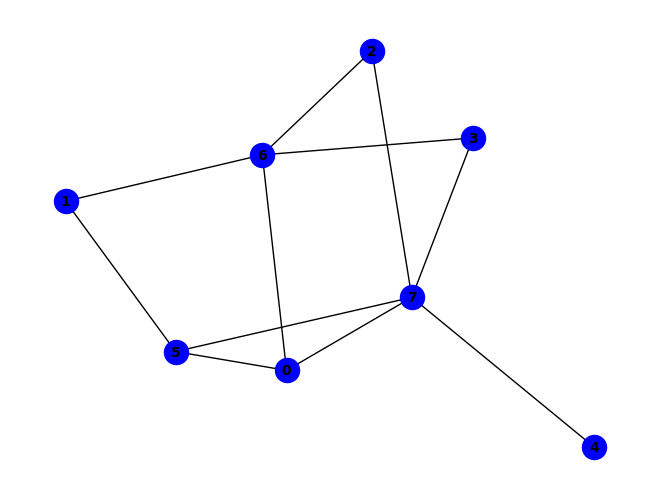


(~b & ~f) ^ (a & f & ~g) ^ (a & h & ~e) ^ (e & h & ~f) ^ (a & c & d & g) ^ (a & f & g & h) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & f & ~h) ^ (a & b & g & ~f) ^ (b & c & g & ~a) ^ (a & g & ~d & ~h) ^ (c & g & ~a & ~h) ^ (d & g & ~c & ~h) ^ (a & c & d & h & ~g) ^ (a & e & f & h & ~b) ^ (a & c & h & ~e & ~f) ^ (b & d & g & ~a & ~c) ^ (a & b & e & f & h & ~g) ^ (a & b & e & g & h & ~d) ^ (a & c & d & e & h & ~b) ^ (a & c & d & f & h & ~e) ^ (b & d & e & g & h & ~c) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (b & e & g & h & ~c & ~f) ^ (a & b & c & d & e & h & ~g) ^ (a & b & c & e & g & h & ~f) ^ (b & c & f & g & h & ~a & ~d) ^ (b & d & f & g & h & ~a & ~e) ^ (b & c & d & e & f & g & h & ~a)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


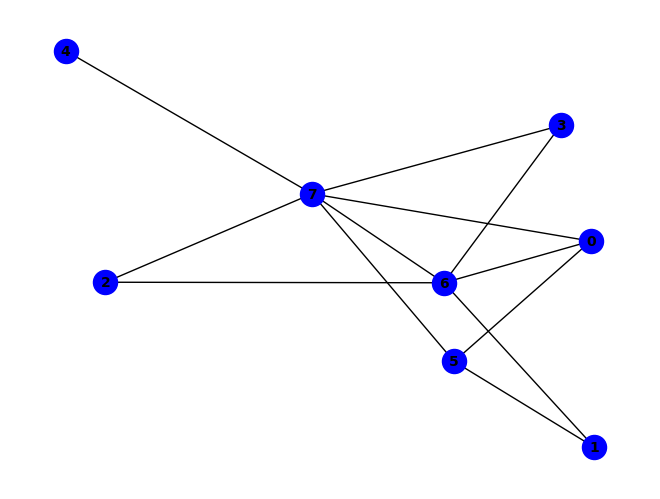


(g & ~h) ^ (~b & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (b & h & ~g) ^ (f & h & ~g) ^ (b & ~f & ~h) ^ (a & e & g & ~h) ^ (b & f & g & ~h) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (a & d & e & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & f & ~g & ~h) ^ (a & b & g & ~d & ~h) ^ (b & c & g & ~a & ~h) ^ (b & d & g & ~c & ~h) ^ (c & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (d & f & g & ~e & ~h) ^ (a & b & c & d & g & ~h) ^ (a & c & e & f & g & ~d) ^ (a & c & e & f & h & ~d) ^ (d & g & ~a & ~c & ~f) ^ (d & h & ~a & ~c & ~f) ^ (e & h & ~c & ~f & ~g) ^ (a & c & e & h & ~d & ~g) ^ (a & c & f & g & ~e & ~h) ^ (a & d & f & g & ~c & ~h) ^ (a & e & f & h & ~d & ~g) ^ (c & d & e & f & g & ~a & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


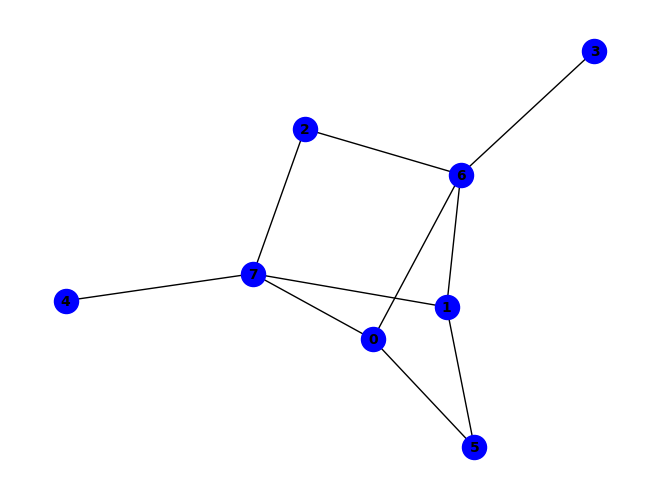


~e ^ (e & ~h) ^ (a & g & ~h) ^ (a & h & ~e) ^ (b & f & ~g) ^ (b & h & ~f) ^ (c & g & ~h) ^ (a & b & f & ~h) ^ (a & b & g & ~f) ^ (a & c & g & ~b) ^ (a & c & h & ~g) ^ (a & d & e & g & h) ^ (a & f & ~g & ~h) ^ (b & g & ~c & ~h) ^ (c & h & ~b & ~e) ^ (b & f & g & h & ~a) ^ (d & e & g & h & ~c) ^ (b & c & d & e & g & h) ^ (a & b & h & ~c & ~g) ^ (b & e & h & ~a & ~d) ^ (d & g & ~a & ~b & ~c) ^ (a & c & e & h & ~b & ~d) ^ (b & d & e & h & ~a & ~g) ^ (a & c & d & e & h & ~b & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


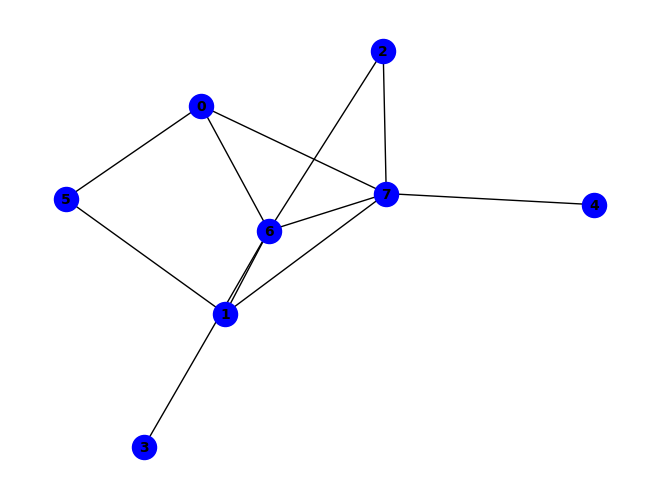


(b & f) ^ (g & ~h) ^ (~d & ~g) ^ (a & f & ~b) ^ (b & g & ~f) ^ (b & h & ~f) ^ (d & h & ~g) ^ (b & f & g & h) ^ (d & ~c & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (c & d & ~g & ~h) ^ (a & f & g & h & ~b) ^ (b & d & g & ~c & ~h) ^ (c & g & ~a & ~b & ~e) ^ (c & h & ~a & ~b & ~e) ^ (e & h & ~a & ~b & ~g) ^ (a & d & g & ~b & ~c & ~h) ^ (c & e & g & ~a & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


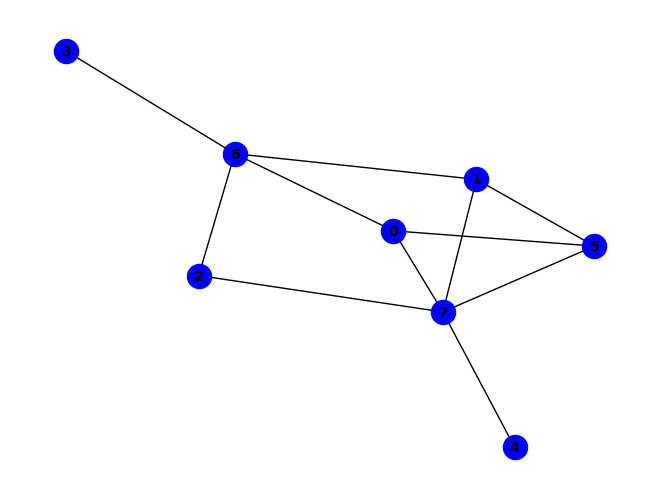


~f ^ (f & ~h) ^ (a & h & ~e) ^ (b & f & ~e) ^ (b & g & ~f) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & b & g & ~d) ^ (a & d & g & ~c) ^ (b & c & g & ~a) ^ (a & b & c & d & g) ^ (b & d & e & f & h) ^ (a & g & ~c & ~h) ^ (d & g & ~b & ~c) ^ (a & f & g & h & ~b) ^ (b & c & e & f & ~d) ^ (b & f & g & h & ~d) ^ (a & c & d & f & g & h) ^ (b & e & f & ~c & ~h) ^ (b & e & h & ~c & ~d) ^ (b & c & d & e & h & ~g) ^ (a & f & ~b & ~d & ~g) ^ (b & h & ~a & ~c & ~g) ^ (c & h & ~a & ~e & ~f) ^ (a & b & e & h & ~c & ~f) ^ (a & d & f & h & ~b & ~e) ^ (b & c & f & h & ~a & ~d) ^ (b & d & e & h & ~f & ~g) ^ (d & e & g & h & ~a & ~c) ^ (d & f & g & h & ~c & ~e) ^ (a & b & d & e & f & h & ~g) ^ (a & b & d & e & g & h & ~c) ^ (a & c & d & e & f & h & ~b) ^ (b & c & d & e & f & g & ~h) ^ (a & d & f & ~b & ~g & ~h) ^ (a & d & e & f & h & ~c & ~g) ^ (b & c & d & e & f & ~a & ~g) ^ (b & c & d & f & h & ~a & ~g) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

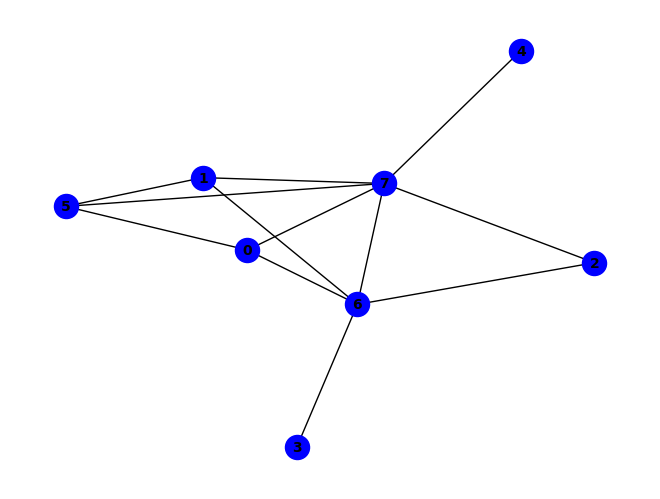


(g & ~h) ^ (~d & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & d & ~g & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & h & ~f & ~g) ^ (a & b & c & g & ~f) ^ (a & b & c & h & ~f) ^ (a & e & f & h & ~g) ^ (c & e & f & g & ~b) ^ (c & e & f & h & ~b) ^ (a & c & g & ~e & ~f) ^ (a & c & h & ~e & ~f) ^ (a & e & g & ~c & ~h) ^ (b & d & g & ~c & ~h) ^ (b & e & g & ~a & ~h) ^ (c & e & h & ~b & ~g) ^ (a & b & c & f & g & ~h) ^ (a & c & f & g & ~e & ~h) ^ (b & e & f & h & ~a & ~g) ^ (a & d & g & ~b & ~c & ~h) ^ (c & f & g & ~b & ~e & ~h) ^ (a & b & c & e & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


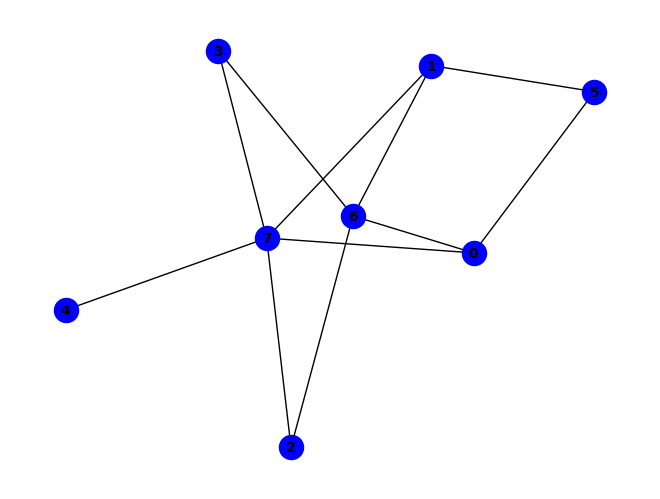


~e ^ (e & ~h) ^ (d & h & ~e) ^ (a & b & c & g) ^ (a & c & d & g) ^ (a & c & g & ~h) ^ (a & c & h & ~e) ^ (b & c & h & ~e) ^ (a & c & d & e & h) ^ (b & c & d & e & h) ^ (a & f & ~g & ~h) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~e) ^ (b & f & ~a & ~h) ^ (b & g & ~a & ~f) ^ (c & g & ~b & ~h) ^ (c & h & ~d & ~e) ^ (d & g & ~c & ~h) ^ (a & c & d & h & ~g) ^ (b & c & d & h & ~g) ^ (b & f & g & h & ~a) ^ (b & d & g & ~a & ~c) ^ (b & e & h & ~a & ~d) ^ (a & b & c & e & h & ~d) ^ (b & h & ~a & ~d & ~g) ^ (a & b & c & h & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


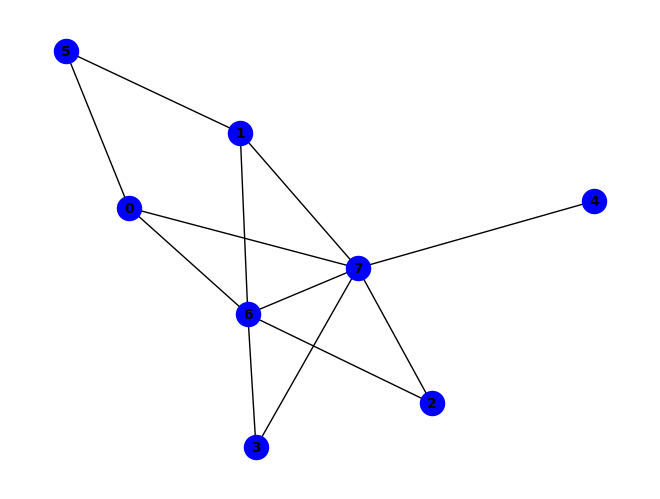


~g ^ (a & f) ^ (g & ~h) ^ (b & f & ~a) ^ (b & g & ~f) ^ (b & h & ~f) ^ (b & f & g & h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (d & g & ~b & ~e) ^ (a & f & g & h & ~b) ^ (a & c & g & ~b & ~e) ^ (c & g & ~b & ~d & ~e) ^ (d & h & ~a & ~b & ~e) ^ (e & h & ~a & ~b & ~g) ^ (a & d & g & ~b & ~c & ~e) ^ (d & e & g & ~a & ~b & ~h) ^ (c & h & ~a & ~b & ~d & ~e) ^ (c & e & g & ~a & ~b & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


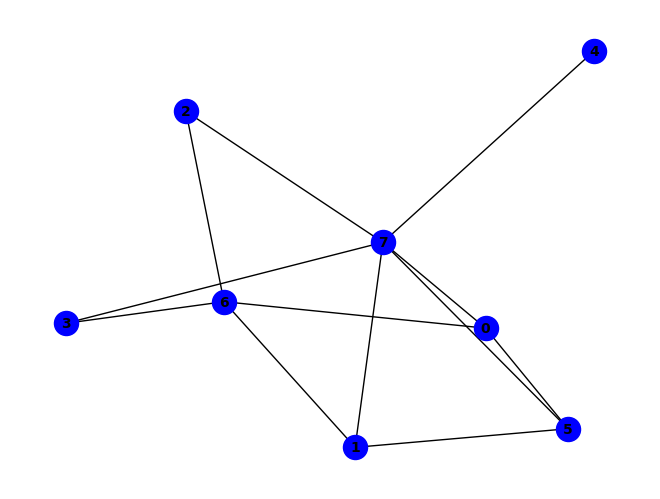


~f ^ (f & ~h) ^ (a & h & ~e) ^ (b & f & ~e) ^ (b & g & ~f) ^ (c & g & ~h) ^ (e & h & ~f) ^ (b & f & g & h) ^ (a & b & g & ~d) ^ (a & c & g & ~d) ^ (b & c & g & ~a) ^ (b & d & g & ~c) ^ (b & e & f & ~h) ^ (a & f & ~b & ~g) ^ (a & g & ~d & ~h) ^ (d & g & ~c & ~h) ^ (a & b & c & h & ~g) ^ (a & b & e & h & ~d) ^ (a & c & e & h & ~d) ^ (a & e & f & h & ~b) ^ (a & f & g & h & ~b) ^ (a & b & h & ~d & ~g) ^ (a & c & h & ~d & ~g) ^ (b & e & h & ~c & ~d) ^ (a & b & c & d & g & ~h) ^ (a & b & c & d & h & ~e) ^ (a & b & c & e & h & ~f) ^ (a & b & c & f & h & ~d) ^ (a & b & c & d & e & f & h) ^ (b & h & ~c & ~d & ~g) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (a & c & f & h & ~d & ~e) ^ (b & c & f & h & ~d & ~e) ^ (b & d & f & h & ~a & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


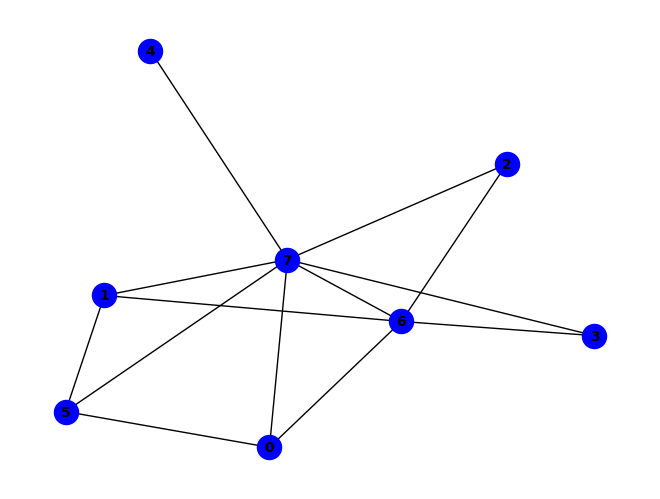


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (a & h & ~b & ~e) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~e) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (a & b & c & h & ~f) ^ (a & b & d & g & ~f) ^ (a & e & f & h & ~g) ^ (a & c & g & ~e & ~f) ^ (a & c & h & ~e & ~f) ^ (a & d & g & ~c & ~f) ^ (a & e & g & ~c & ~h) ^ (b & e & g & ~a & ~h) ^ (d & g & ~b & ~c & ~f) ^ (e & h & ~c & ~f & ~g) ^ (a & b & c & g & ~d & ~f) ^ (a & c & f & g & ~e & ~h) ^ (a & d & f & g & ~c & ~h) ^ (b & e & f & h & ~a & ~g) ^ (d & e & f & g & ~b & ~c) ^ (d & e & f & h & ~b & ~c) ^ (a & b & d & e & f & g & ~c) ^ (a & b & d & e & f & h & ~c) ^ (c & f & g & ~b & ~d & ~h) ^ (d & e & h & ~b & ~c & ~g) ^ (d & f & g & ~b & ~e & ~h) ^ (a & b & c & f & g & ~d & ~h) ^ (a & b & d & e & h & ~c & ~g) ^ (a & b & d & f & g & ~e & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (d & h & ~a & ~b & ~c & ~f) ^ (a & d & e & h & ~c & ~f & ~g) ^ (b & c & e & h & ~a & ~f & ~g)
PASS
PASS


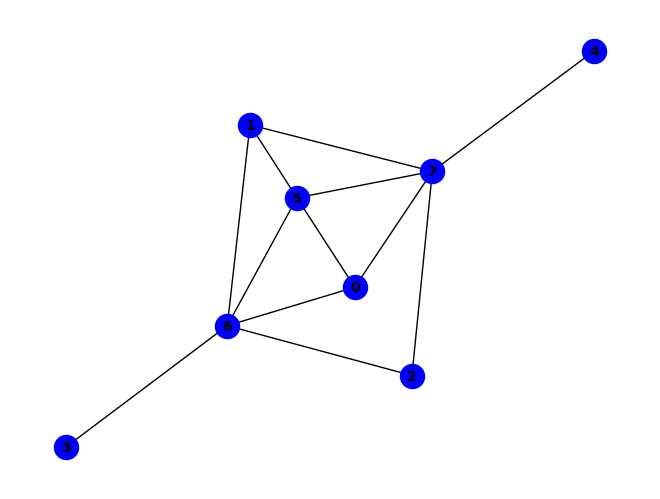


~e ^ (d & e & g) ^ (a & f & ~e) ^ (b & g & ~d) ^ (b & h & ~g) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & b & g & ~h) ^ (b & e & h & ~d) ^ (a & d & e & f & g) ^ (d & e & f & g & h) ^ (a & g & ~c & ~h) ^ (a & h & ~b & ~e) ^ (b & f & ~a & ~e) ^ (d & e & ~g & ~h) ^ (a & b & d & g & ~f) ^ (a & b & e & f & ~h) ^ (a & c & f & g & ~h) ^ (b & c & d & g & ~f) ^ (b & d & f & g & ~e) ^ (a & c & h & ~e & ~f) ^ (a & e & f & ~d & ~h) ^ (b & e & f & ~d & ~h) ^ (a & b & c & e & h & ~f) ^ (a & d & e & g & h & ~c) ^ (b & c & d & e & h & ~f) ^ (c & d & e & g & h & ~f) ^ (a & b & c & d & e & g & h) ^ (c & g & ~b & ~f & ~h) ^ (c & h & ~b & ~e & ~f) ^ (d & g & ~a & ~c & ~f) ^ (a & b & c & g & ~d & ~f) ^ (a & b & c & h & ~f & ~g) ^ (b & d & e & f & ~g & ~h) ^ (b & d & e & h & ~c & ~g) ^ (a & b & d & e & g & h & ~f) ^ (a & c & d & e & f & h & ~b) ^ (b & c & d & e & f & h & ~g) ^ (a & c & d & e & f & ~b & ~g) ^ (a & d & e & f & ~c & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PAS

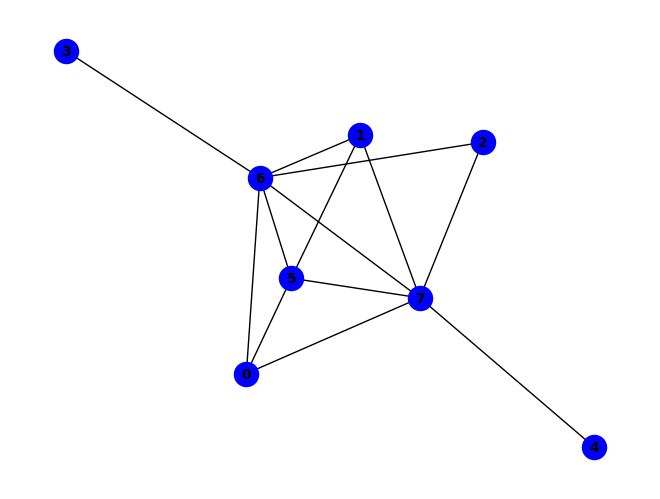


(g & ~h) ^ (~d & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (b & g & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (a & b & f & ~e) ^ (b & e & g & ~h) ^ (c & d & f & ~h) ^ (c & d & g & ~h) ^ (e & f & g & ~h) ^ (a & b & e & g & h) ^ (a & f & ~d & ~g) ^ (b & f & ~d & ~g) ^ (b & h & ~a & ~e) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & f & ~c & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~c & ~g) ^ (a & b & c & h & ~f) ^ (a & d & f & h & ~g) ^ (a & e & f & h & ~g) ^ (b & d & f & h & ~g) ^ (b & e & f & h & ~c) ^ (c & e & f & h & ~g) ^ (a & b & c & e & f & h) ^ (a & b & g & ~c & ~f) ^ (a & c & g & ~e & ~f) ^ (a & c & h & ~e & ~f) ^ (a & d & f & ~c & ~h) ^ (a & d & g & ~c & ~h) ^ (a & e & g & ~c & ~h) ^ (a & f & g & ~b & ~h) ^ (b & d & f & ~c & ~h) ^ (b & d & g & ~c & ~h) ^ (b & f & g & ~e & ~h) ^ (a & b & c & d & f & ~h) ^ (a & b & c & d & g & ~h) ^ (b & c & e & f & g & ~h) ^ (a & b & d & g & ~f & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & c & d & f & ~g & ~h) ^ (b & c & d & f & ~a & ~g) ^ (b & c & e 

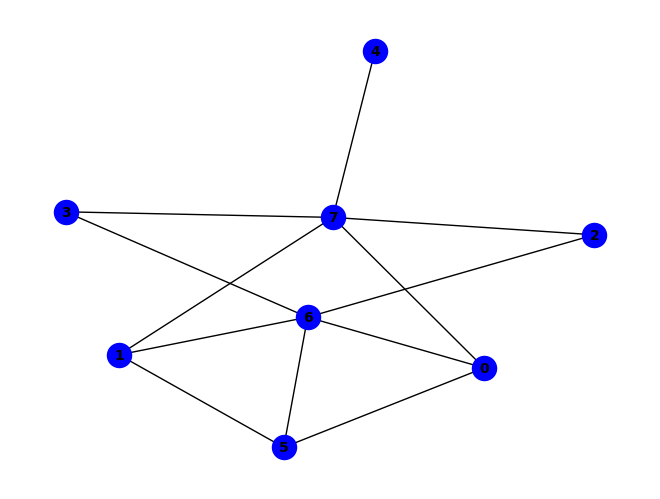


~f ^ (a & h & ~f) ^ (b & g & ~h) ^ (b & h & ~e) ^ (c & h & ~e) ^ (d & g & ~h) ^ (a & d & g & ~c) ^ (b & c & g & ~f) ^ (b & d & g & ~c) ^ (b & d & h & ~g) ^ (b & f & g & ~d) ^ (c & f & g & ~d) ^ (d & f & g & ~a) ^ (a & c & d & f & g) ^ (b & c & d & f & g) ^ (b & e & f & g & h) ^ (d & e & f & g & h) ^ (a & g & ~f & ~h) ^ (c & g & ~d & ~h) ^ (d & h & ~c & ~e) ^ (e & h & ~a & ~f) ^ (b & d & e & h & ~f) ^ (f & ~a & ~e & ~g) ^ (a & b & g & ~d & ~f) ^ (a & b & h & ~c & ~g) ^ (a & c & g & ~b & ~f) ^ (a & c & h & ~d & ~g) ^ (a & d & h & ~b & ~g) ^ (b & c & h & ~d & ~g) ^ (a & b & c & d & g & ~f) ^ (a & b & c & d & h & ~g) ^ (a & d & e & f & h & ~g) ^ (b & d & e & f & h & ~g) ^ (c & e & f & g & h & ~d) ^ (b & f & ~a & ~g & ~h) ^ (e & f & ~a & ~g & ~h) ^ (a & b & e & h & ~c & ~f) ^ (a & c & e & h & ~d & ~f) ^ (a & d & e & h & ~b & ~f) ^ (b & c & e & h & ~d & ~f) ^ (a & b & c & d & e & h & ~f) ^ (a & c & e & f & h & ~d & ~g) ^ (b & c & e & f & h & ~d & ~g) ^ (a & b & e & f & h & ~c & ~d & ~g)
PAS

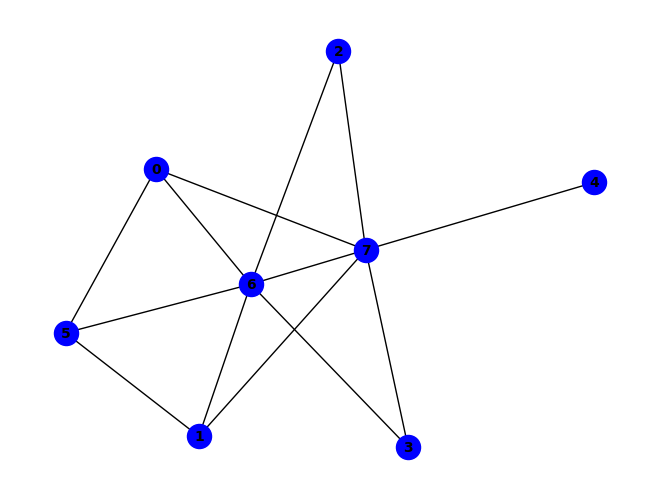


(g & ~h) ^ (~f & ~g) ^ (a & f & ~d) ^ (b & f & ~d) ^ (f & ~d & ~h) ^ (a & e & h & ~d) ^ (b & e & h & ~d) ^ (a & h & ~d & ~f) ^ (b & h & ~d & ~f) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~e) ^ (d & h & ~c & ~e) ^ (e & h & ~c & ~g) ^ (f & h & ~c & ~g) ^ (a & b & c & g & ~e) ^ (a & b & c & h & ~e) ^ (c & d & f & g & ~h) ^ (a & b & f & ~d & ~h) ^ (a & b & h & ~d & ~e) ^ (a & c & h & ~d & ~e) ^ (d & e & g & ~c & ~h) ^ (a & b & c & e & g & ~h) ^ (a & b & c & f & g & ~h) ^ (a & g & ~c & ~d & ~e) ^ (b & g & ~a & ~d & ~e) ^ (a & c & f & g & ~d & ~h) ^ (b & c & d & g & ~a & ~f) ^ (b & c & d & h & ~a & ~f) ^ (b & c & e & h & ~d & ~g) ^ (b & c & f & h & ~d & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & c & d & f & h & ~g) ^ (a & e & g & ~c & ~d & ~h) ^ (b & e & g & ~a & ~d & ~h) ^ (d & f & ~a & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


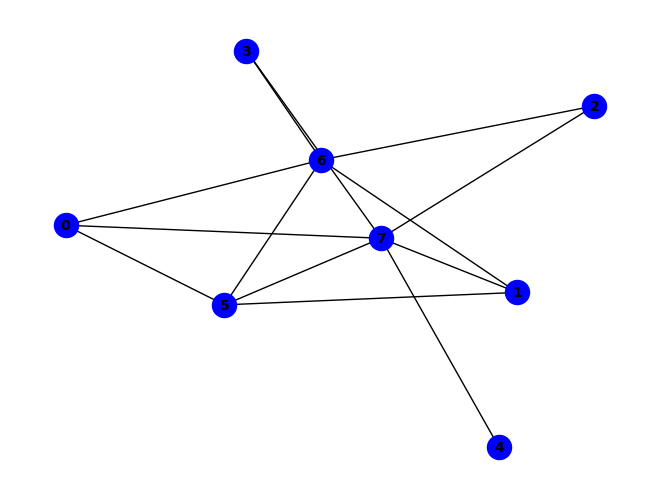


~e ^ (a & f & ~e) ^ (b & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & c & g & ~f) ^ (a & e & f & ~h) ^ (b & d & g & ~f) ^ (c & d & g & ~f) ^ (d & e & f & ~h) ^ (a & g & ~d & ~h) ^ (a & h & ~b & ~e) ^ (b & f & ~a & ~e) ^ (b & g & ~a & ~h) ^ (c & g & ~f & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~f & ~h) ^ (d & h & ~a & ~f) ^ (a & d & e & h & ~f) ^ (a & d & f & g & ~h) ^ (b & d & e & h & ~f) ^ (c & d & e & h & ~f) ^ (a & c & h & ~f & ~g) ^ (b & c & g & ~d & ~f) ^ (b & d & h & ~f & ~g) ^ (b & e & f & ~a & ~h) ^ (c & d & h & ~f & ~g) ^ (a & b & c & g & ~f & ~h) ^ (a & b & c & h & ~d & ~f) ^ (a & b & d & g & ~f & ~h) ^ (a & b & d & h & ~e & ~f) ^ (a & c & d & h & ~e & ~f) ^ (a & c & e & h & ~b & ~f) ^ (b & c & e & h & ~d & ~f) ^ (a & b & c & d & e & h & ~f) ^ (b & c & h & ~d & ~f & ~g) ^ (a & c & d & g & ~b & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

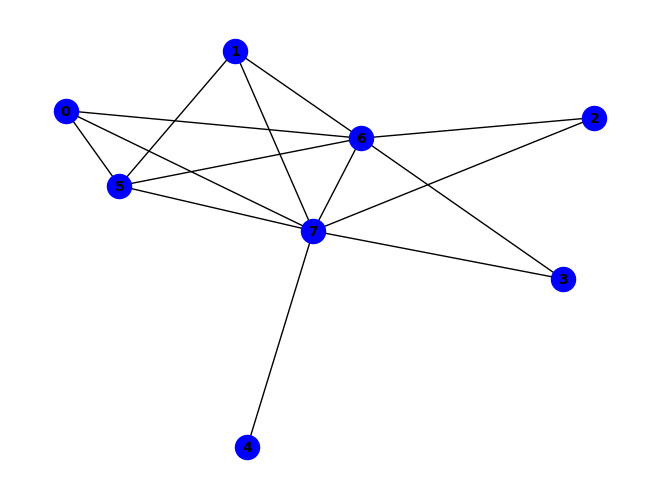


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & h & ~e) ^ (b & g & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & f & g & ~h) ^ (a & g & ~b & ~e) ^ (b & f & ~a & ~g) ^ (b & h & ~a & ~e) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & h & ~d & ~g) ^ (a & b & d & g & ~f) ^ (a & b & d & h & ~f) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & c & g & ~e & ~f) ^ (a & c & h & ~e & ~f) ^ (a & d & g & ~c & ~f) ^ (a & d & h & ~c & ~f) ^ (a & e & g & ~c & ~h) ^ (b & e & g & ~a & ~h) ^ (b & f & g & ~a & ~h) ^ (e & f & g & ~d & ~h) ^ (a & c & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (d & g & ~b & ~c & ~f) ^ (d & h & ~b & ~c & ~f) ^ (a & b & c & g & ~d & ~f) ^ (a & b & c & h & ~d & ~f) ^ (a & e & f & h & ~b & ~g) ^ (b & d & e & h & ~a & ~g) ^ (b & e & f & h & ~d & ~g) ^ (c & d & e & h & ~b & ~g) ^ (a & b & d & e & f & h & ~g) ^ (b & c & d & e & f & h & ~g) ^ (c & e & h & ~b & ~f & ~g) ^ (a & d & e & h & ~c & ~f & ~g) ^ (a & b & c & e & h & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

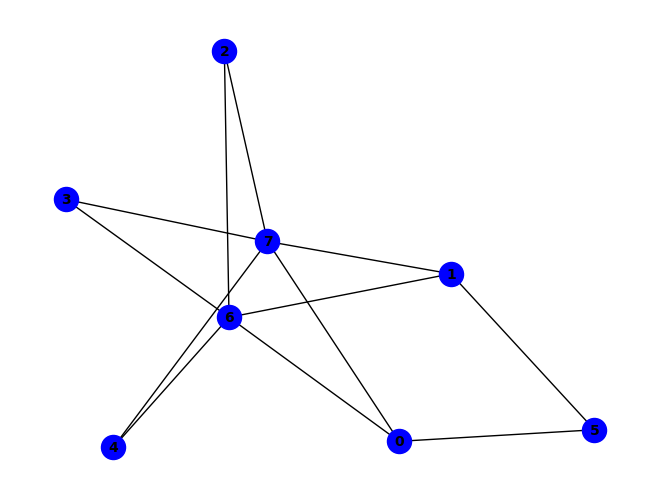


~d ^ (b & f & ~g) ^ (b & h & ~f) ^ (e & h & ~d) ^ (b & f & g & h) ^ (d & ~g & ~h) ^ (a & d & g & ~e) ^ (b & e & g & ~d) ^ (b & e & h & ~g) ^ (b & d & e & g & h) ^ (a & h & ~b & ~e) ^ (b & g & ~d & ~h) ^ (e & g & ~d & ~h) ^ (a & c & g & ~b & ~e) ^ (a & d & h & ~e & ~g) ^ (b & d & h & ~a & ~e) ^ (a & f & ~b & ~g & ~h) ^ (a & g & ~b & ~e & ~h) ^ (c & h & ~b & ~d & ~e) ^ (a & b & d & g & ~e & ~h) ^ (a & c & d & h & ~b & ~e) ^ (a & c & h & ~b & ~e & ~g) ^ (c & g & ~b & ~d & ~e & ~h) ^ (a & c & d & g & ~b & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


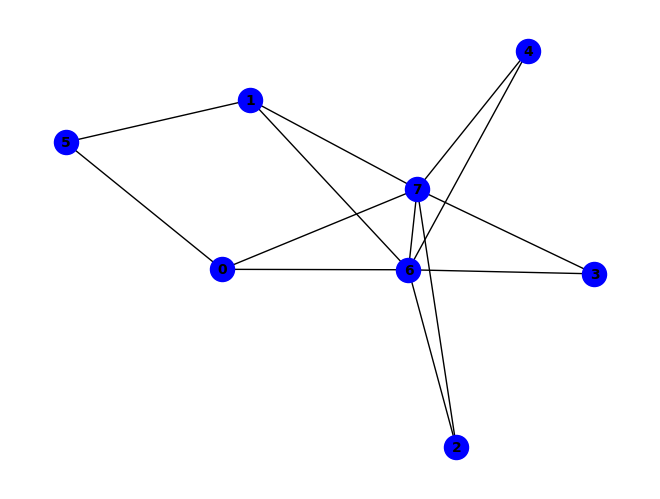


~g ^ (g & ~h) ^ (a & e & g) ^ (a & f & ~h) ^ (a & g & ~f) ^ (c & g & ~d) ^ (e & g & ~c) ^ (e & h & ~b) ^ (b & f & g & h) ^ (c & d & e & g) ^ (b & f & ~a & ~g) ^ (b & h & ~a & ~f) ^ (d & g & ~a & ~e) ^ (d & h & ~b & ~e) ^ (a & b & c & h & ~e) ^ (a & b & d & h & ~c) ^ (a & b & e & h & ~d) ^ (a & f & g & h & ~b) ^ (a & b & c & d & e & h) ^ (a & b & g & ~d & ~e) ^ (a & h & ~c & ~d & ~e) ^ (b & g & ~c & ~d & ~e) ^ (c & h & ~b & ~d & ~e) ^ (a & c & g & ~b & ~d & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


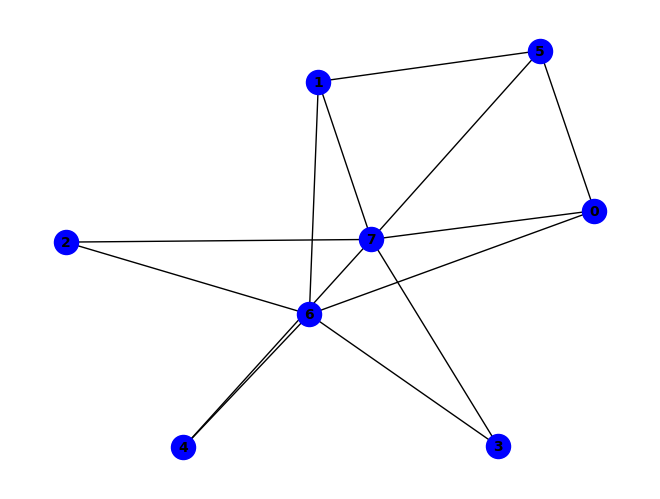


~f ^ (f & ~h) ^ (a & f & ~g) ^ (b & h & ~e) ^ (e & h & ~f) ^ (a & f & g & h) ^ (b & c & g & ~e) ^ (b & d & g & ~e) ^ (a & b & e & f & h) ^ (a & g & ~d & ~h) ^ (a & h & ~b & ~e) ^ (b & f & ~a & ~g) ^ (d & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (e & g & ~a & ~h) ^ (a & d & e & h & ~c) ^ (a & e & f & h & ~d) ^ (b & c & d & h & ~e) ^ (b & c & f & h & ~e) ^ (b & d & f & h & ~c) ^ (b & e & f & h & ~d) ^ (b & f & g & h & ~a) ^ (a & c & d & e & f & h) ^ (b & c & d & e & f & h) ^ (a & d & h & ~c & ~f) ^ (b & c & h & ~e & ~g) ^ (b & d & h & ~e & ~g) ^ (b & g & ~a & ~e & ~h) ^ (c & h & ~d & ~e & ~f) ^ (a & b & c & g & ~e & ~h) ^ (a & b & d & g & ~c & ~h) ^ (a & d & e & g & ~b & ~h) ^ (b & c & d & g & ~e & ~h) ^ (a & b & c & d & e & g & ~h) ^ (a & c & h & ~b & ~e & ~f) ^ (c & g & ~a & ~d & ~e & ~h) ^ (a & b & d & h & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

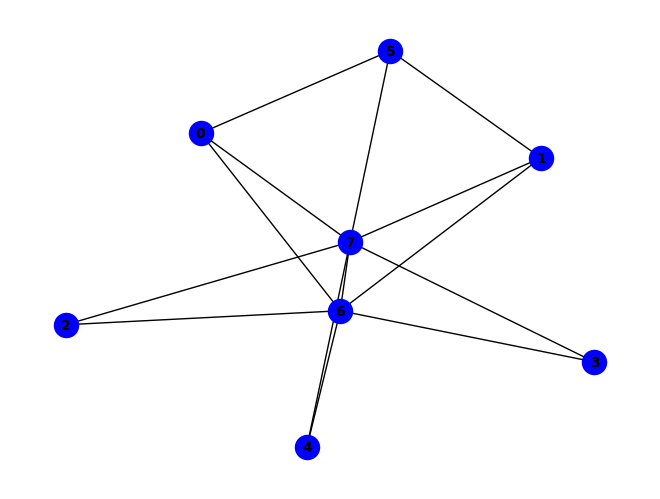


~g ^ (g & ~h) ^ (a & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (a & g & ~b & ~e) ^ (a & h & ~b & ~e) ^ (b & f & ~a & ~g) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & e & f & h & ~g) ^ (c & d & e & g & ~f) ^ (c & d & e & h & ~f) ^ (c & f & g & ~d & ~h) ^ (e & f & g & ~c & ~h) ^ (b & e & f & h & ~a & ~g) ^ (b & c & g & ~d & ~e & ~f) ^ (b & c & h & ~d & ~e & ~f) ^ (b & c & d & f & g & ~a & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (d & g & ~a & ~b & ~e & ~f) ^ (d & h & ~a & ~b & ~e & ~f) ^ (a & c & f & g & ~d & ~e & ~h) ^ (b & c & f & g & ~a & ~e & ~h) ^ (a & c & g & ~b & ~d & ~e & ~f) ^ (a & c & h & ~b & ~d & ~e & ~f) ^ (d & f & g & ~a & ~b & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


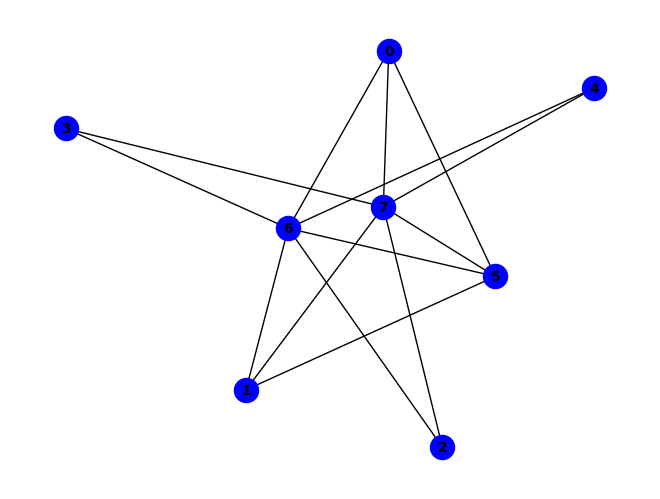


~e ^ (a & f & ~e) ^ (a & h & ~e) ^ (b & h & ~e) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & b & g & ~e) ^ (c & d & h & ~f) ^ (a & g & ~e & ~h) ^ (b & f & ~a & ~e) ^ (b & g & ~e & ~h) ^ (c & h & ~e & ~f) ^ (f & g & ~e & ~h) ^ (a & c & e & g & ~f) ^ (b & c & d & g & ~f) ^ (b & d & e & g & ~f) ^ (c & d & e & g & ~f) ^ (a & b & h & ~e & ~g) ^ (a & c & h & ~d & ~f) ^ (a & e & f & ~g & ~h) ^ (b & c & g & ~e & ~f) ^ (b & d & h & ~a & ~f) ^ (c & d & g & ~f & ~h) ^ (a & b & d & e & h & ~f) ^ (a & c & d & e & h & ~f) ^ (b & c & d & e & h & ~f) ^ (c & g & ~e & ~f & ~h) ^ (d & h & ~a & ~e & ~f) ^ (a & c & e & h & ~f & ~g) ^ (b & c & d & h & ~f & ~g) ^ (b & d & e & h & ~f & ~g) ^ (c & d & e & h & ~f & ~g) ^ (a & c & g & ~d & ~f & ~h) ^ (b & c & h & ~e & ~f & ~g) ^ (b & d & g & ~a & ~f & ~h) ^ (b & e & f & ~a & ~g & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (d & g & ~a & ~e & ~f & ~h) ^ (a & b & c & h & ~d & ~e & ~f) ^ (a & b & c & g & ~d & ~e &

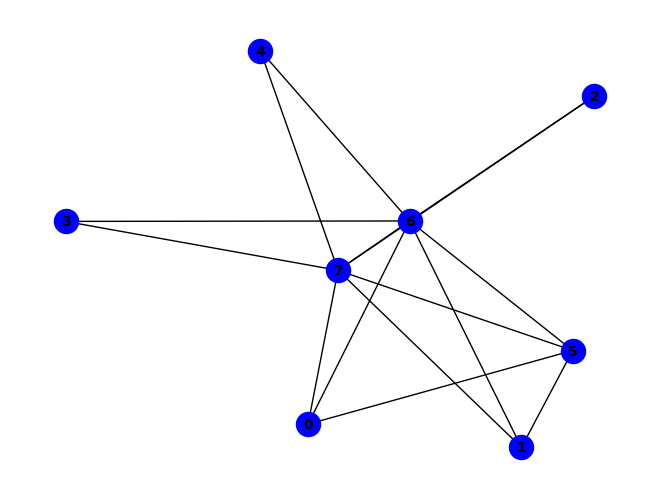


~g ^ (f & h) ^ (g & ~h) ^ (a & f & ~e) ^ (a & h & ~e) ^ (c & g & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~c) ^ (b & f & g & ~h) ^ (a & b & e & f & g) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (a & c & e & f & ~d) ^ (a & c & e & g & ~d) ^ (a & c & e & h & ~d) ^ (b & c & e & g & ~d) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~a) ^ (c & e & f & g & ~a) ^ (a & b & c & d & e & f) ^ (a & b & c & d & e & h) ^ (a & c & d & e & f & g) ^ (b & c & d & e & f & g) ^ (a & c & g & ~d & ~f) ^ (a & c & h & ~d & ~f) ^ (a & e & f & ~c & ~h) ^ (a & f & g & ~b & ~h) ^ (b & c & g & ~d & ~f) ^ (a & b & c & d & h & ~f) ^ (a & g & ~d & ~e & ~f) ^ (c & h & ~b & ~e & ~f) ^ (d & g & ~c & ~e & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & d & h & ~b & ~e & ~f) ^ (b & d & g & ~a & ~e & ~f) ^ (a & c & d & e & f & ~b & ~h) ^ (d & h & ~b & ~c & ~e & ~f) ^ (a & b & c & g & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

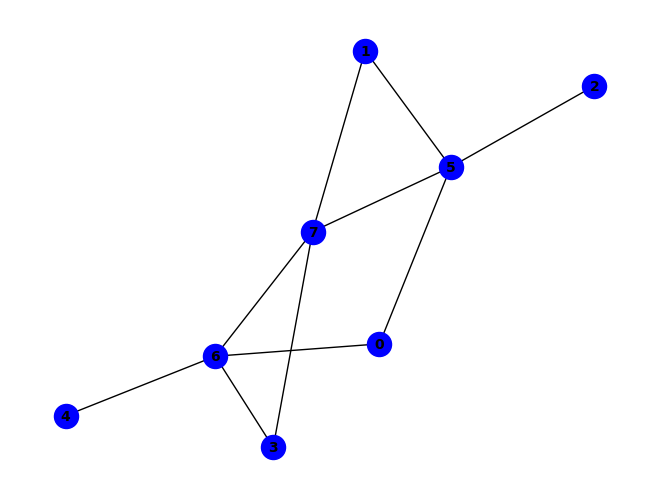


(~e & ~g) ^ (e & h & ~g) ^ (f & h & ~g) ^ (e & ~d & ~h) ^ (g & ~a & ~h) ^ (a & c & f & ~h) ^ (d & f & g & ~h) ^ (a & f & ~g & ~h) ^ (b & f & ~d & ~h) ^ (c & f & ~b & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (c & d & e & f & ~h) ^ (a & b & f & ~c & ~h) ^ (a & d & g & ~c & ~h) ^ (a & e & g & ~d & ~h) ^ (b & d & f & ~g & ~h) ^ (c & d & g & ~b & ~h) ^ (c & d & h & ~f & ~g) ^ (a & c & d & e & g & ~h) ^ (b & h & ~d & ~f & ~g) ^ (d & e & ~c & ~g & ~h) ^ (a & c & d & g & ~f & ~h) ^ (a & b & d & f & g & ~c & ~h) ^ (b & c & d & e & g & ~a & ~h) ^ (a & c & d & e & ~b & ~f & ~h) ^ (b & c & d & g & ~e & ~f & ~h) ^ (b & e & f & g & ~a & ~d & ~h) ^ (c & e & f & g & ~a & ~b & ~h) ^ (c & d & e & ~a & ~f & ~g & ~h) ^ (a & b & c & d & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


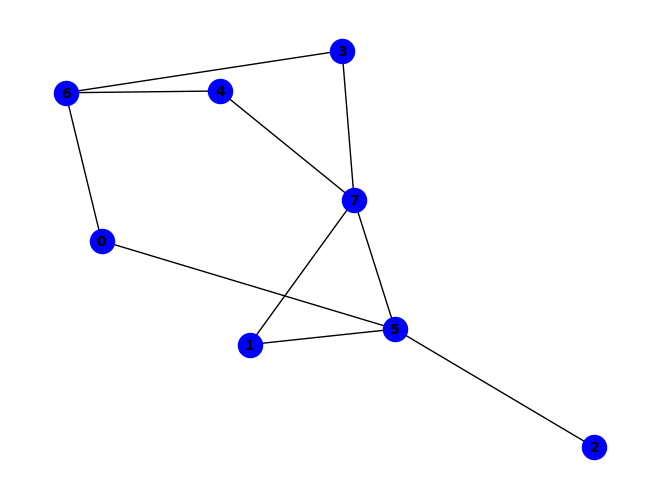


(b & h) ^ (a & d & g) ^ (~c & ~f) ^ (a & g & ~f) ^ (b & f & ~e) ^ (c & h & ~f) ^ (e & g & ~h) ^ (c & ~e & ~h) ^ (f & ~a & ~h) ^ (a & c & f & ~h) ^ (a & e & g & ~d) ^ (b & c & f & ~h) ^ (a & b & e & f & g) ^ (a & b & e & g & h) ^ (a & d & f & g & h) ^ (b & d & e & f & g) ^ (d & g & ~e & ~h) ^ (e & h & ~b & ~f) ^ (a & b & g & h & ~f) ^ (b & e & f & h & ~d) ^ (a & b & f & ~c & ~h) ^ (b & e & f & ~g & ~h) ^ (c & e & f & ~g & ~h) ^ (a & b & d & f & g & ~e) ^ (a & b & d & g & h & ~e) ^ (a & e & f & g & h & ~d) ^ (b & d & e & f & h & ~g) ^ (c & e & ~d & ~f & ~h) ^ (d & h & ~b & ~e & ~f) ^ (b & d & f & g & ~c & ~h) ^ (c & d & e & g & ~b & ~h) ^ (c & d & f & g & ~a & ~h) ^ (c & d & e & ~f & ~g & ~h) ^ (a & c & e & f & g & ~d & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (b & c & e & f & g & ~a & ~h) ^ (a & b & c & d & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

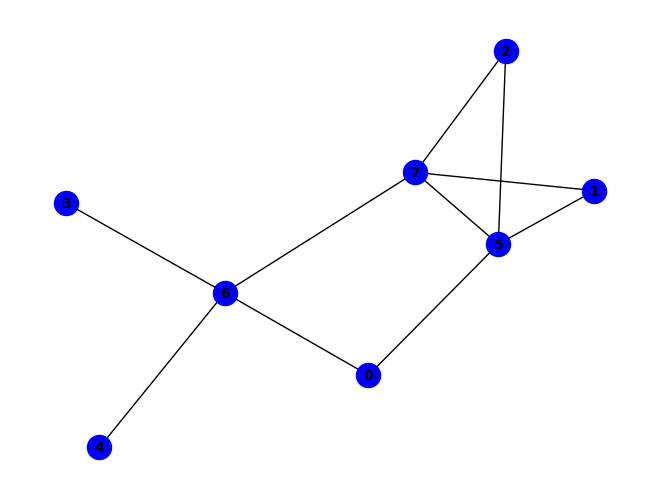


(~e & ~g) ^ (e & h & ~g) ^ (f & h & ~g) ^ (e & ~d & ~h) ^ (g & ~d & ~h) ^ (a & f & ~g & ~h) ^ (b & f & ~a & ~h) ^ (c & h & ~f & ~g) ^ (d & e & ~g & ~h) ^ (a & g & ~d & ~e & ~h) ^ (b & h & ~c & ~f & ~g) ^ (c & f & ~a & ~b & ~h) ^ (b & d & f & g & ~a & ~c & ~h) ^ (b & e & f & g & ~a & ~d & ~h) ^ (c & d & f & g & ~a & ~e & ~h) ^ (c & e & f & g & ~a & ~b & ~h) ^ (b & c & d & e & f & g & ~a & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


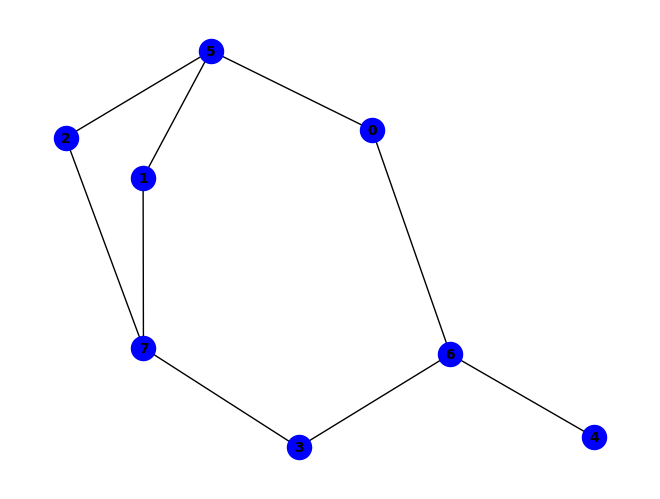


(~c & ~e) ^ (a & f & ~g) ^ (e & ~b & ~g) ^ (b & c & h & ~e) ^ (b & d & g & ~c) ^ (a & g & ~c & ~e) ^ (b & f & ~a & ~e) ^ (b & h & ~e & ~f) ^ (d & g & ~a & ~h) ^ (d & h & ~a & ~c) ^ (a & b & c & f & ~e) ^ (a & c & f & h & ~g) ^ (a & b & c & e & f & h) ^ (a & b & c & e & g & h) ^ (c & ~e & ~f & ~h) ^ (a & c & f & ~e & ~h) ^ (a & c & g & ~e & ~h) ^ (b & c & f & ~e & ~h) ^ (c & d & e & ~f & ~g) ^ (c & d & e & ~f & ~h) ^ (c & e & h & ~d & ~g) ^ (d & e & g & ~a & ~c) ^ (a & b & c & g & h & ~f) ^ (a & b & d & f & h & ~c) ^ (b & c & d & e & f & ~h) ^ (b & d & e & f & g & ~h) ^ (b & d & ~c & ~f & ~g) ^ (b & d & ~c & ~f & ~h) ^ (b & e & ~f & ~g & ~h) ^ (a & b & d & g & ~c & ~f) ^ (a & b & d & g & ~c & ~h) ^ (a & b & e & f & ~d & ~g) ^ (a & b & g & h & ~e & ~f) ^ (b & c & e & f & ~d & ~g) ^ (b & c & e & h & ~f & ~g) ^ (b & d & f & h & ~c & ~g) ^ (c & d & f & g & ~a & ~h) ^ (a & b & d & e & f & h & ~g) ^ (a & d & h & ~c & ~f & ~g) ^ (c & e & f & ~a & ~g & ~h) ^ (a & b & d & e & f & ~c & ~h) ^ (a 

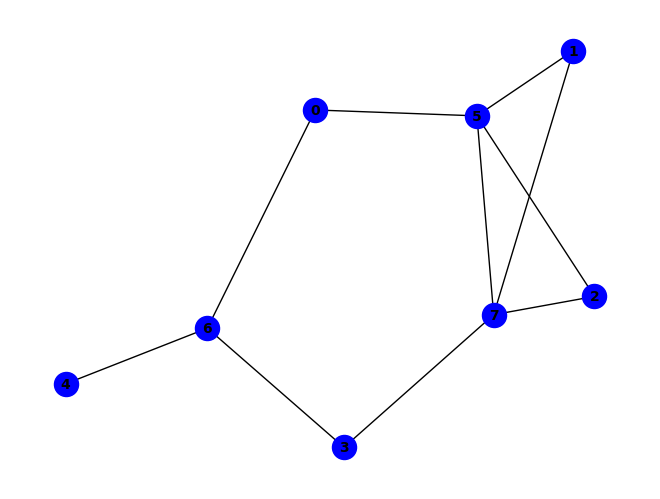


(a & e & g) ^ (~a & ~f) ^ (d & g & ~h) ^ (e & g & ~d) ^ (f & ~a & ~h) ^ (a & c & h & ~e) ^ (a & d & g & ~e) ^ (a & e & f & g & h) ^ (c & d & e & g & h) ^ (b & f & ~c & ~e) ^ (b & h & ~d & ~e) ^ (c & f & ~a & ~e) ^ (c & h & ~b & ~e) ^ (d & h & ~c & ~f) ^ (a & c & e & f & ~g) ^ (a & c & e & h & ~g) ^ (b & c & d & h & ~e) ^ (c & d & e & f & ~b) ^ (c & d & f & g & ~h) ^ (e & f & g & h & ~d) ^ (a & ~c & ~f & ~g) ^ (a & b & f & ~c & ~h) ^ (b & e & f & ~c & ~g) ^ (b & e & h & ~d & ~g) ^ (c & e & f & ~d & ~g) ^ (c & e & h & ~b & ~g) ^ (a & b & e & f & g & ~c) ^ (a & b & e & g & h & ~c) ^ (a & c & d & f & g & ~e) ^ (a & c & d & g & h & ~e) ^ (a & d & f & g & h & ~e) ^ (b & c & d & e & f & ~g) ^ (b & c & d & e & h & ~g) ^ (b & c & d & f & g & ~a) ^ (a & b & c & d & e & f & g) ^ (a & c & ~f & ~g & ~h) ^ (a & b & g & h & ~c & ~f) ^ (b & d & f & g & ~a & ~e) ^ (b & d & f & h & ~c & ~g) ^ (a & b & d & g & h & ~c & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

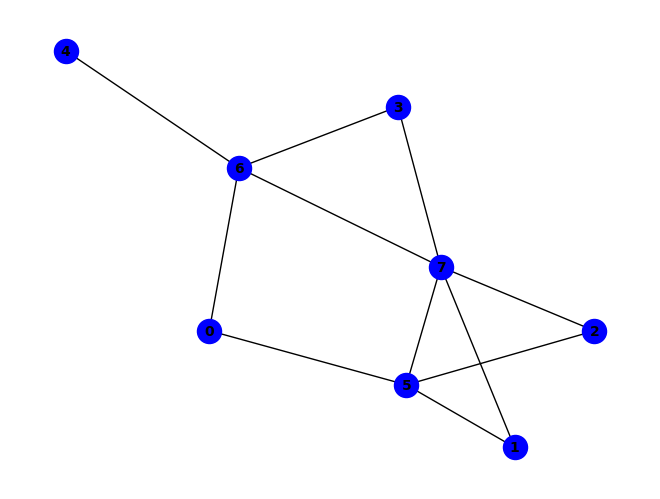


(~e & ~g) ^ (e & h & ~g) ^ (f & h & ~g) ^ (e & ~d & ~h) ^ (g & ~a & ~h) ^ (a & b & f & ~h) ^ (d & f & g & ~h) ^ (a & f & ~g & ~h) ^ (c & f & ~d & ~h) ^ (d & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & c & f & ~b & ~h) ^ (a & d & g & ~c & ~h) ^ (a & e & g & ~d & ~h) ^ (c & d & f & ~g & ~h) ^ (b & f & ~c & ~d & ~h) ^ (b & h & ~d & ~f & ~g) ^ (c & h & ~b & ~f & ~g) ^ (b & c & d & h & ~f & ~g) ^ (b & d & f & ~c & ~g & ~h) ^ (c & d & g & ~a & ~f & ~h) ^ (a & b & e & f & g & ~c & ~h) ^ (b & e & f & g & ~c & ~d & ~h) ^ (c & e & f & g & ~a & ~d & ~h) ^ (a & b & d & f & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


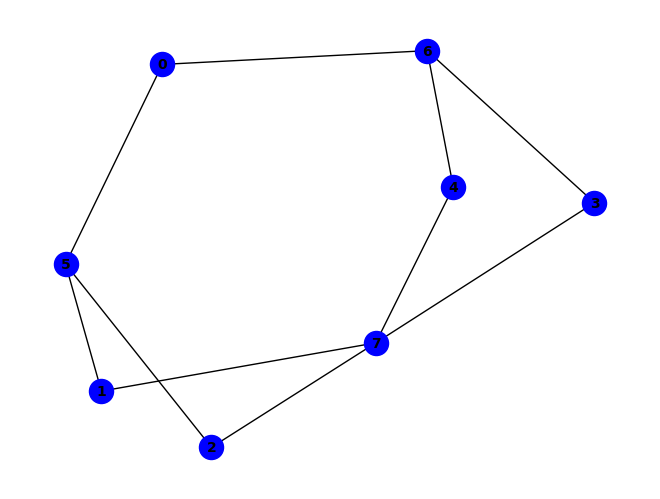


~d ^ (a & f) ^ (b & f & ~c) ^ (c & f & ~h) ^ (e & h & ~d) ^ (a & c & f & h) ^ (d & ~g & ~h) ^ (b & d & h & ~e) ^ (b & e & g & ~d) ^ (b & e & h & ~g) ^ (b & h & ~c & ~f) ^ (c & h & ~d & ~e) ^ (e & g & ~d & ~h) ^ (a & d & e & g & ~h) ^ (a & d & f & g & ~c) ^ (a & e & f & g & ~h) ^ (b & c & d & g & ~e) ^ (b & c & d & h & ~g) ^ (b & c & e & h & ~d) ^ (b & d & f & g & ~h) ^ (c & d & f & g & ~h) ^ (a & b & f & ~c & ~e) ^ (a & c & f & ~g & ~h) ^ (a & c & g & ~e & ~h) ^ (a & d & g & ~f & ~h) ^ (a & d & h & ~c & ~f) ^ (a & d & h & ~c & ~g) ^ (a & b & d & e & h & ~c) ^ (a & b & d & f & h & ~c) ^ (b & c & e & f & g & ~h) ^ (b & d & e & g & h & ~c) ^ (a & g & ~c & ~e & ~f) ^ (a & b & d & e & ~c & ~f) ^ (a & b & e & g & ~c & ~f) ^ (a & b & g & h & ~c & ~f) ^ (a & e & f & h & ~c & ~d) ^ (c & e & f & g & ~d & ~h) ^ (a & c & d & e & f & g & ~h) ^ (a & b & e & ~c & ~g & ~h) ^ (b & e & g & ~d & ~f & ~h) ^ (a & d & e & g & h & ~c & ~f) ^ (a & b & d & g & ~c & ~e & ~f) ^ (a & b & d & g & ~c & ~e & ~h) ^ 

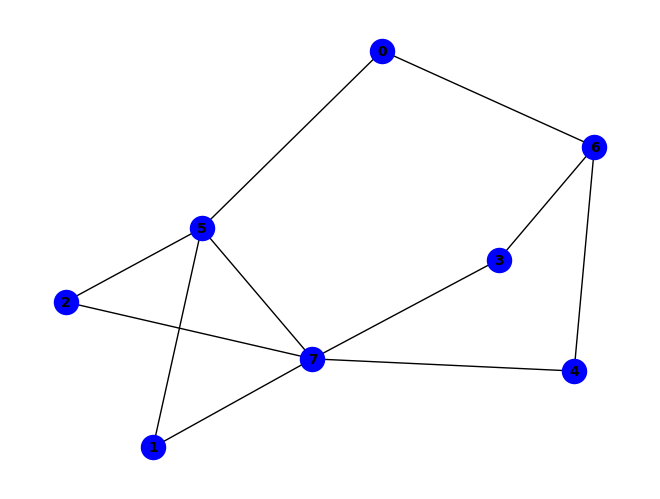


(a & d & g) ^ (~a & ~f) ^ (b & h & ~e) ^ (c & f & ~e) ^ (c & h & ~b) ^ (e & g & ~h) ^ (f & ~a & ~h) ^ (a & b & f & ~h) ^ (a & e & g & ~d) ^ (a & b & e & g & h) ^ (a & c & d & f & g) ^ (a & c & e & g & h) ^ (a & e & f & g & h) ^ (b & c & d & f & g) ^ (c & d & e & f & g) ^ (b & f & ~c & ~e) ^ (d & g & ~e & ~h) ^ (e & h & ~c & ~f) ^ (a & b & g & h & ~f) ^ (b & c & d & h & ~a) ^ (b & c & e & h & ~a) ^ (c & d & f & g & ~h) ^ (c & e & f & h & ~d) ^ (a & b & c & d & e & f) ^ (a & b & c & e & f & g) ^ (a & ~c & ~f & ~g) ^ (a & b & c & ~f & ~g) ^ (a & c & f & ~b & ~h) ^ (a & c & h & ~b & ~f) ^ (b & d & h & ~e & ~f) ^ (c & e & f & ~g & ~h) ^ (a & b & c & d & h & ~g) ^ (a & b & c & e & h & ~g) ^ (a & b & d & f & g & ~c) ^ (a & b & d & g & h & ~e) ^ (a & b & e & f & g & ~d) ^ (a & c & d & g & h & ~e) ^ (a & c & e & f & g & ~d) ^ (a & d & f & g & h & ~e) ^ (b & c & d & e & f & ~h) ^ (b & c & d & e & h & ~f) ^ (c & d & e & f & h & ~g) ^ (a & b & c & d & e & g & h) ^ (d & h & ~c & ~e & ~f) ^ (b & d 

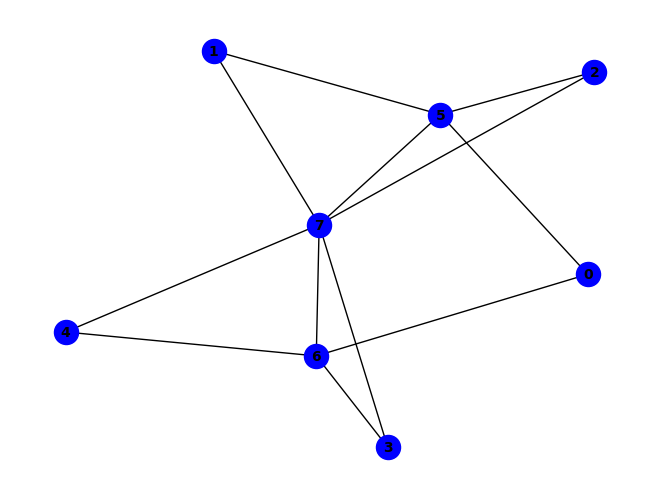


(g & ~h) ^ (~a & ~g) ^ (f & h & ~g) ^ (a & ~f & ~h) ^ (a & c & f & ~h) ^ (a & f & g & ~h) ^ (e & f & g & ~h) ^ (a & e & ~d & ~g) ^ (a & e & ~d & ~h) ^ (a & h & ~e & ~g) ^ (c & f & ~e & ~h) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & d & e & h & ~g) ^ (b & c & d & h & ~g) ^ (b & d & e & f & ~h) ^ (a & b & f & ~c & ~h) ^ (a & d & g & ~c & ~h) ^ (c & e & g & ~f & ~h) ^ (b & f & ~c & ~e & ~h) ^ (c & h & ~d & ~f & ~g) ^ (a & c & d & g & ~f & ~h) ^ (b & c & d & f & ~e & ~g) ^ (b & c & d & f & ~e & ~h) ^ (b & d & f & g & ~a & ~h) ^ (a & b & c & e & f & g & ~h) ^ (b & c & d & e & f & h & ~g) ^ (b & c & h & ~e & ~f & ~g) ^ (b & e & f & ~d & ~g & ~h) ^ (c & e & f & ~b & ~g & ~h) ^ (d & f & g & ~c & ~e & ~h) ^ (a & b & e & f & g & ~d & ~h) ^ (a & c & e & f & g & ~d & ~h) ^ (b & h & ~d & ~e & ~f & ~g) ^ (c & d & e & h & ~b & ~f & ~g) ^ (a & b & c & d & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

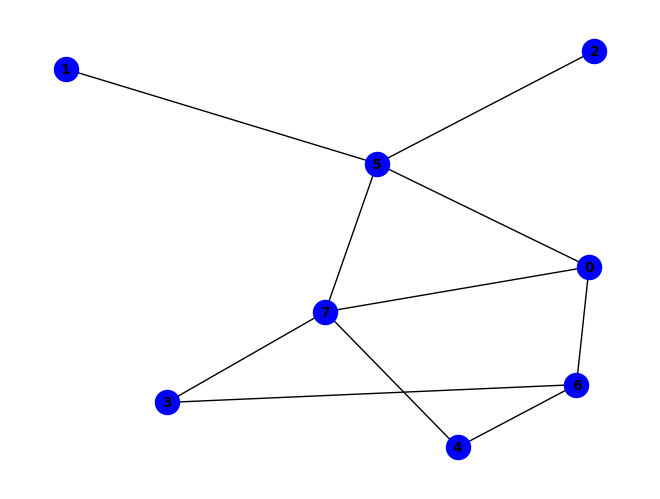


(~c & ~f) ^ (a & f & ~g) ^ (a & h & ~e) ^ (c & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (c & ~e & ~h) ^ (f & ~b & ~h) ^ (a & c & f & ~h) ^ (a & d & g & ~e) ^ (b & c & f & ~h) ^ (b & e & g & ~f) ^ (a & g & ~e & ~h) ^ (d & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (e & g & ~b & ~h) ^ (e & h & ~b & ~f) ^ (a & d & f & h & ~e) ^ (a & b & f & ~c & ~h) ^ (a & d & h & ~e & ~g) ^ (b & e & h & ~f & ~g) ^ (c & e & f & ~g & ~h) ^ (a & b & e & f & g & ~h) ^ (b & c & e & f & g & ~h) ^ (c & e & ~d & ~f & ~h) ^ (c & d & e & g & ~b & ~h) ^ (c & d & f & g & ~b & ~h) ^ (c & d & e & ~f & ~g & ~h) ^ (a & c & e & f & g & ~b & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (b & d & f & g & ~a & ~e & ~h) ^ (a & c & d & f & g & ~b & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


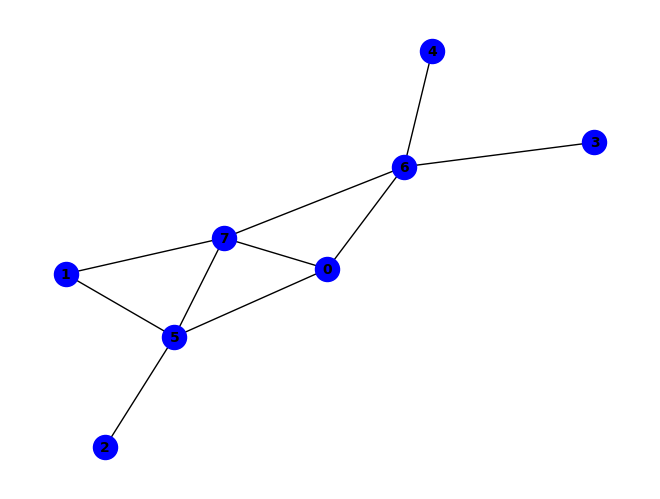


(~e & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (e & ~d & ~h) ^ (g & ~d & ~h) ^ (b & f & ~a & ~h) ^ (d & e & ~g & ~h) ^ (e & h & ~a & ~g) ^ (a & d & g & ~e & ~h) ^ (a & c & e & f & g & ~h) ^ (b & h & ~a & ~f & ~g) ^ (c & f & ~a & ~b & ~h) ^ (b & d & f & g & ~c & ~h) ^ (b & e & f & g & ~d & ~h) ^ (c & e & f & g & ~b & ~h) ^ (b & c & d & e & f & g & ~h) ^ (a & b & e & f & g & ~c & ~h) ^ (c & d & f & g & ~a & ~e & ~h) ^ (a & b & d & f & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


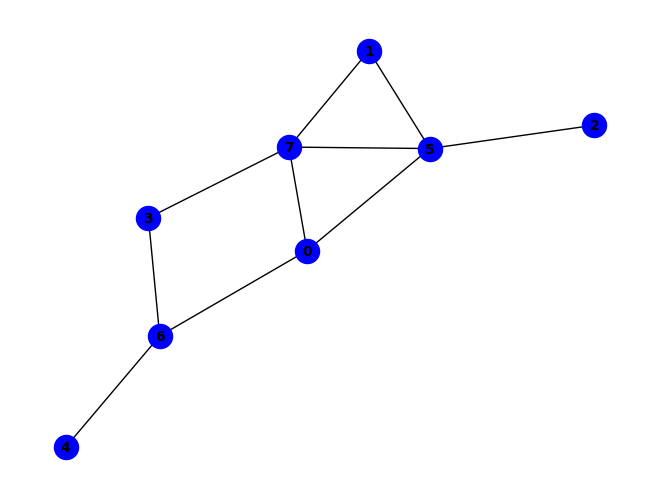


(f & ~h) ^ (~c & ~f) ^ (a & g & ~e) ^ (a & h & ~g) ^ (c & h & ~f) ^ (e & g & ~d) ^ (a & d & e & g) ^ (a & f & g & h) ^ (c & ~e & ~h) ^ (a & c & f & ~h) ^ (a & f & ~e & ~g) ^ (b & f & ~a & ~e) ^ (b & h & ~a & ~e) ^ (d & h & ~b & ~f) ^ (a & b & d & h & ~f) ^ (a & c & d & g & ~f) ^ (a & e & f & h & ~d) ^ (b & d & e & f & ~a) ^ (e & f & g & h & ~d) ^ (a & d & h & ~c & ~f) ^ (a & e & f & ~g & ~h) ^ (b & c & f & ~a & ~h) ^ (b & e & h & ~a & ~g) ^ (c & d & g & ~f & ~h) ^ (c & e & f & ~g & ~h) ^ (a & d & e & f & h & ~g) ^ (b & d & e & g & h & ~a) ^ (c & e & ~d & ~f & ~h) ^ (d & g & ~a & ~c & ~h) ^ (a & c & d & h & ~f & ~g) ^ (c & d & e & g & ~b & ~h) ^ (b & e & f & ~a & ~d & ~g) ^ (c & d & e & ~f & ~g & ~h) ^ (a & c & e & f & g & ~d & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (b & c & e & f & g & ~a & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (b & d & f & g & ~a & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

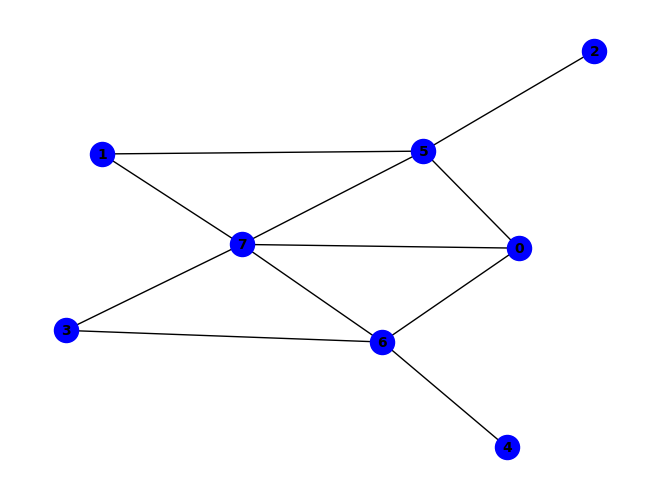


(g & ~h) ^ (~e & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (e & ~d & ~h) ^ (e & h & ~a & ~g) ^ (c & d & e & f & ~h) ^ (c & d & g & ~b & ~h) ^ (d & f & g & ~a & ~h) ^ (a & c & e & f & g & ~h) ^ (b & f & ~a & ~d & ~h) ^ (c & f & ~a & ~b & ~h) ^ (d & e & ~c & ~g & ~h) ^ (d & g & ~a & ~c & ~f) ^ (d & h & ~a & ~c & ~f) ^ (a & c & d & g & ~e & ~h) ^ (a & d & e & g & ~b & ~h) ^ (b & e & f & g & ~d & ~h) ^ (c & e & f & g & ~b & ~h) ^ (a & b & c & d & f & g & ~h) ^ (b & d & f & ~a & ~g & ~h) ^ (c & d & e & ~f & ~g & ~h) ^ (c & d & h & ~a & ~f & ~g) ^ (a & b & e & f & g & ~c & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (b & c & d & e & g & ~a & ~h) ^ (b & h & ~a & ~d & ~f & ~g) ^ (b & c & d & g & ~e & ~f & ~h) ^ (a & b & d & e & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


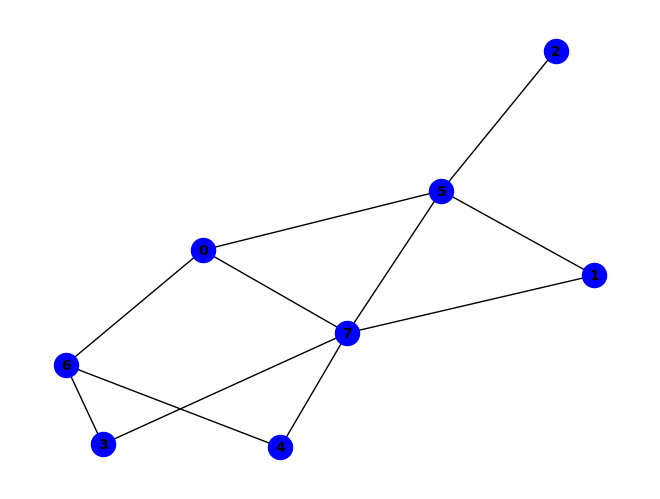


(f & ~h) ^ (~c & ~f) ^ (a & f & ~g) ^ (a & h & ~e) ^ (b & h & ~a) ^ (c & h & ~f) ^ (e & g & ~h) ^ (a & b & e & h) ^ (a & e & f & h) ^ (a & f & g & h) ^ (c & ~e & ~h) ^ (b & c & f & ~h) ^ (b & d & e & f & g) ^ (a & g & ~e & ~h) ^ (b & f & ~a & ~e) ^ (e & h & ~b & ~f) ^ (a & b & d & h & ~e) ^ (b & e & f & h & ~d) ^ (a & c & f & ~b & ~h) ^ (a & d & h & ~e & ~f) ^ (c & e & f & ~g & ~h) ^ (a & b & d & f & g & ~e) ^ (b & d & e & f & h & ~g) ^ (c & e & ~d & ~f & ~h) ^ (d & g & ~a & ~e & ~h) ^ (d & h & ~b & ~e & ~f) ^ (b & d & f & g & ~c & ~h) ^ (c & d & e & g & ~b & ~h) ^ (c & d & f & g & ~a & ~h) ^ (b & e & f & ~a & ~g & ~h) ^ (c & d & e & ~f & ~g & ~h) ^ (a & b & d & f & h & ~e & ~g) ^ (a & c & e & f & g & ~d & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (b & c & e & f & g & ~a & ~h) ^ (a & b & c & d & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

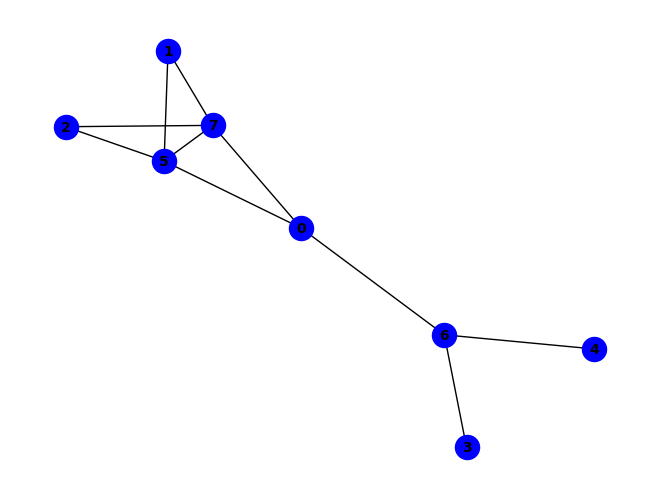


~f ^ (e & g) ^ (f & ~h) ^ (a & g & ~e) ^ (a & h & ~g) ^ (e & f & g & h) ^ (a & f & ~e & ~g) ^ (b & h & ~a & ~e) ^ (c & f & ~a & ~e) ^ (d & g & ~a & ~e) ^ (a & e & f & h & ~d) ^ (a & f & g & h & ~d) ^ (d & f & g & h & ~e) ^ (a & e & f & ~g & ~h) ^ (c & e & f & ~a & ~g) ^ (a & d & e & f & h & ~g) ^ (b & f & ~a & ~c & ~e) ^ (c & h & ~a & ~b & ~e) ^ (b & d & g & h & ~a & ~e) ^ (c & d & e & h & ~a & ~b) ^ (c & d & f & g & ~a & ~e) ^ (c & d & g & h & ~a & ~b) ^ (b & e & f & ~a & ~c & ~g) ^ (b & e & h & ~a & ~c & ~g) ^ (c & e & h & ~a & ~d & ~g) ^ (b & c & d & e & h & ~a & ~g) ^ (b & d & f & g & ~a & ~c & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


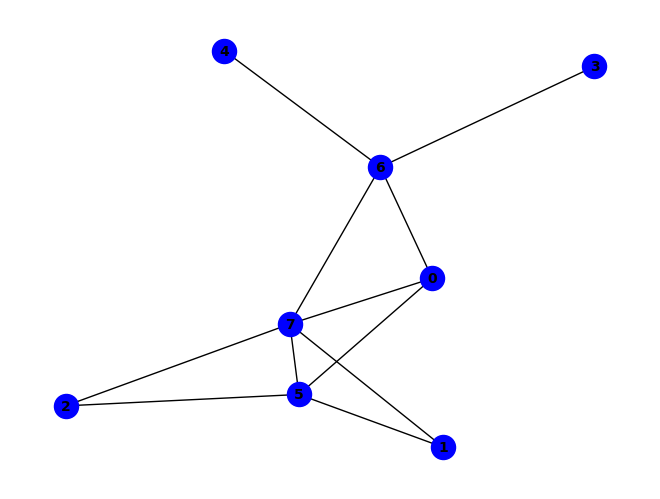


(a & c & h) ^ (a & e & g) ^ (~e & ~g) ^ (a & f & ~c) ^ (a & h & ~e) ^ (f & h & ~g) ^ (e & ~d & ~h) ^ (g & ~d & ~h) ^ (a & g & ~c & ~f) ^ (b & f & ~a & ~h) ^ (c & f & ~b & ~h) ^ (c & h & ~f & ~g) ^ (d & e & ~g & ~h) ^ (e & h & ~a & ~g) ^ (a & b & c & f & ~h) ^ (a & b & e & f & g & ~h) ^ (b & d & f & g & ~c & ~h) ^ (b & e & f & g & ~d & ~h) ^ (c & d & f & g & ~e & ~h) ^ (b & c & d & e & f & g & ~h) ^ (a & c & g & ~d & ~f & ~h) ^ (a & d & g & ~c & ~e & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (b & h & ~a & ~c & ~f & ~g) ^ (c & e & f & g & ~a & ~b & ~h) ^ (a & b & d & f & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


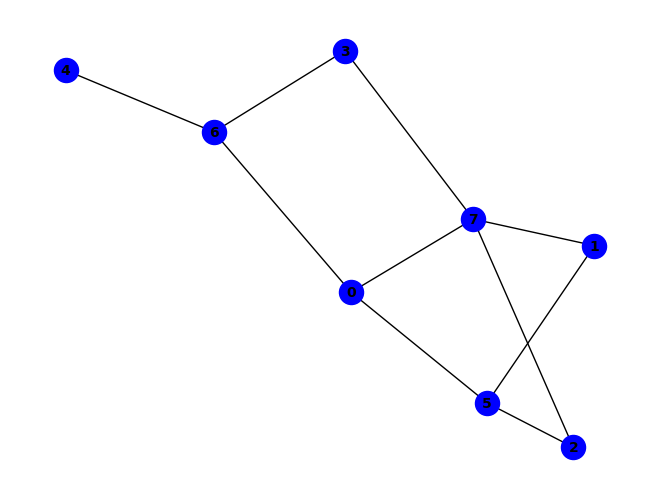


(~c & ~e) ^ (a & h & ~c) ^ (b & f & ~e) ^ (e & ~b & ~g) ^ (b & d & g & ~c) ^ (d & e & g & ~c) ^ (a & f & ~b & ~h) ^ (b & h & ~e & ~f) ^ (d & g & ~a & ~h) ^ (d & h & ~a & ~c) ^ (c & ~e & ~f & ~h) ^ (a & b & h & ~d & ~e) ^ (a & c & f & ~g & ~h) ^ (a & c & g & ~e & ~h) ^ (a & e & g & ~c & ~d) ^ (b & c & h & ~a & ~e) ^ (c & d & e & ~f & ~g) ^ (c & d & e & ~f & ~h) ^ (c & e & f & ~g & ~h) ^ (c & e & h & ~d & ~g) ^ (a & b & c & d & h & ~e) ^ (a & b & e & f & g & ~h) ^ (a & c & d & e & g & ~h) ^ (b & d & e & f & g & ~h) ^ (b & d & e & g & h & ~c) ^ (a & g & ~c & ~f & ~h) ^ (b & d & ~c & ~f & ~g) ^ (b & d & ~c & ~f & ~h) ^ (b & e & ~f & ~g & ~h) ^ (a & b & e & h & ~d & ~g) ^ (b & d & f & h & ~c & ~g) ^ (c & d & f & g & ~a & ~h) ^ (a & b & c & d & f & g & ~h) ^ (b & c & f & ~a & ~e & ~h) ^ (a & b & d & f & g & ~e & ~h) ^ (a & c & e & f & g & ~d & ~h) ^ (b & c & d & e & f & ~a & ~h) ^ (c & d & e & f & h & ~b & ~g) ^ (b & c & e & f & ~a & ~d & ~g) ^ (b & c & e & h & ~a & ~f & ~g) ^ (a & b & c & 

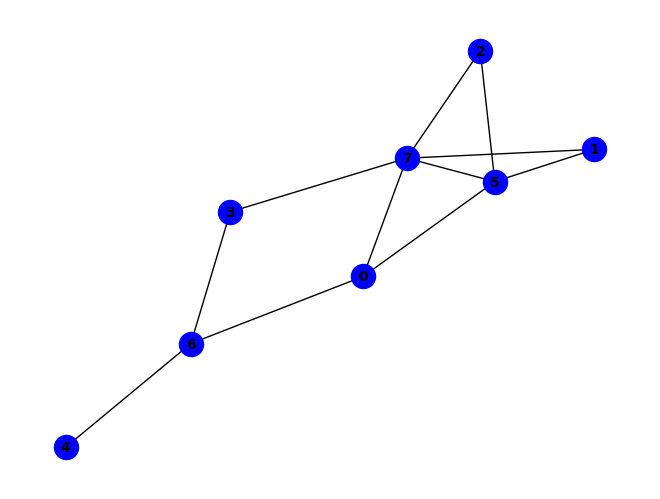


~f ^ (f & ~h) ^ (a & g & ~e) ^ (a & h & ~g) ^ (e & g & ~d) ^ (a & d & e & g) ^ (a & f & g & h) ^ (a & c & d & e & h) ^ (c & d & e & g & h) ^ (a & f & ~e & ~g) ^ (c & f & ~a & ~e) ^ (d & g & ~a & ~h) ^ (a & c & e & f & ~g) ^ (a & e & f & h & ~d) ^ (c & d & e & f & ~b) ^ (e & f & g & h & ~d) ^ (a & e & f & ~g & ~h) ^ (c & e & f & ~d & ~g) ^ (c & e & h & ~b & ~g) ^ (a & d & e & f & h & ~g) ^ (b & c & d & e & f & ~g) ^ (b & c & d & e & h & ~g) ^ (b & c & d & f & g & ~a) ^ (b & f & ~a & ~c & ~e) ^ (b & h & ~a & ~d & ~e) ^ (c & h & ~a & ~b & ~e) ^ (d & h & ~a & ~c & ~f) ^ (b & c & d & h & ~a & ~e) ^ (b & d & f & g & ~a & ~e) ^ (c & d & f & g & ~a & ~h) ^ (a & c & d & e & f & g & ~b) ^ (b & e & f & ~a & ~c & ~g) ^ (b & e & h & ~a & ~d & ~g) ^ (a & c & e & h & ~b & ~d & ~g) ^ (b & d & f & h & ~a & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

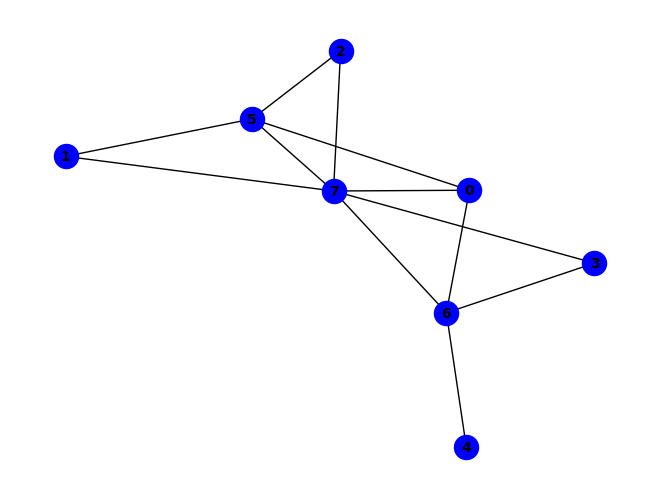


(g & ~h) ^ (~e & ~g) ^ (a & f & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (e & h & ~g) ^ (f & h & ~g) ^ (e & ~d & ~h) ^ (d & f & g & ~h) ^ (d & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & d & f & h & ~g) ^ (a & e & g & ~d & ~h) ^ (c & d & g & ~f & ~h) ^ (c & f & ~a & ~d & ~h) ^ (c & h & ~b & ~f & ~g) ^ (b & c & d & h & ~f & ~g) ^ (c & d & f & ~a & ~g & ~h) ^ (b & f & ~a & ~c & ~d & ~h) ^ (b & h & ~a & ~d & ~f & ~g) ^ (c & e & f & g & ~a & ~d & ~h) ^ (a & c & h & ~b & ~d & ~f & ~g) ^ (b & d & f & ~a & ~c & ~g & ~h) ^ (b & e & f & g & ~a & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


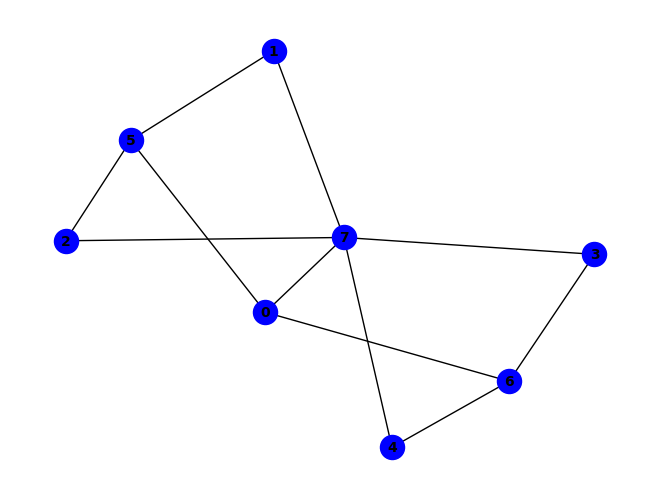


~d ^ (b & f & ~c) ^ (e & h & ~d) ^ (d & ~g & ~h) ^ (b & d & h & ~e) ^ (b & e & g & ~d) ^ (b & e & h & ~g) ^ (a & f & ~g & ~h) ^ (a & g & ~e & ~h) ^ (b & h & ~c & ~f) ^ (c & f & ~a & ~h) ^ (c & h & ~d & ~e) ^ (e & g & ~d & ~h) ^ (b & c & e & h & ~d) ^ (b & d & f & g & ~h) ^ (c & d & f & g & ~h) ^ (a & b & f & ~c & ~h) ^ (a & d & g & ~c & ~e) ^ (a & b & d & f & h & ~e) ^ (a & c & e & f & g & ~h) ^ (b & c & e & f & g & ~h) ^ (b & d & e & g & h & ~c) ^ (a & h & ~b & ~c & ~e) ^ (a & b & d & g & ~e & ~f) ^ (a & b & d & g & ~e & ~h) ^ (b & c & d & g & ~a & ~e) ^ (b & c & d & h & ~a & ~g) ^ (c & e & f & g & ~d & ~h) ^ (a & b & c & d & e & h & ~g) ^ (a & d & h & ~c & ~e & ~g) ^ (b & e & g & ~d & ~f & ~h) ^ (a & b & e & f & g & ~c & ~h) ^ (a & b & d & h & ~e & ~f & ~g) ^ (a & c & d & g & ~e & ~f & ~h) ^ (b & c & d & g & ~a & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

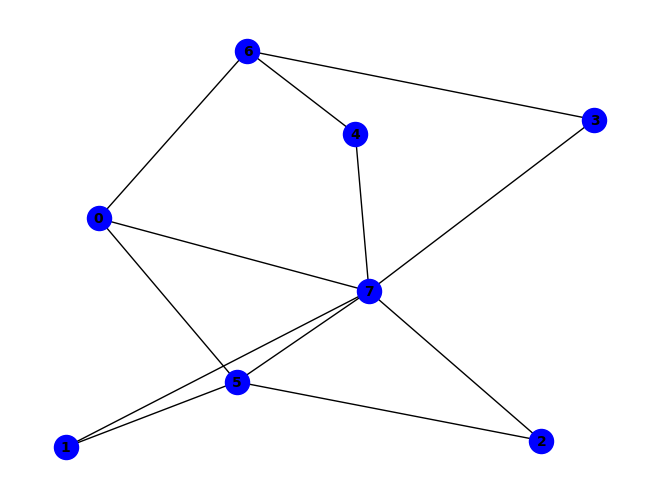


~f ^ (f & ~h) ^ (a & f & ~g) ^ (c & h & ~b) ^ (a & b & d & h) ^ (a & d & e & h) ^ (a & f & g & h) ^ (b & c & e & h) ^ (a & b & d & f & g) ^ (c & d & e & f & g) ^ (a & g & ~d & ~h) ^ (a & h & ~c & ~e) ^ (b & h & ~a & ~e) ^ (c & f & ~a & ~e) ^ (d & g & ~e & ~h) ^ (e & g & ~a & ~h) ^ (e & h & ~c & ~f) ^ (a & b & c & h & ~e) ^ (a & d & e & g & ~h) ^ (a & e & f & h & ~d) ^ (b & c & d & h & ~a) ^ (c & e & f & h & ~d) ^ (a & d & h & ~c & ~f) ^ (b & d & h & ~e & ~f) ^ (a & c & d & e & h & ~f) ^ (b & c & d & e & h & ~f) ^ (b & c & d & f & g & ~a) ^ (c & d & e & f & h & ~g) ^ (b & f & ~a & ~c & ~e) ^ (d & h & ~c & ~e & ~f) ^ (b & d & f & g & ~e & ~h) ^ (c & d & f & g & ~a & ~h) ^ (a & b & d & e & f & g & ~h) ^ (a & c & d & e & f & g & ~h) ^ (c & e & f & ~a & ~g & ~h) ^ (a & b & d & e & h & ~c & ~f) ^ (a & b & d & f & h & ~c & ~g) ^ (b & c & d & e & f & ~a & ~g) ^ (b & c & d & e & f & ~a & ~h) ^ (b & c & d & f & h & ~e & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (b & e & f & ~a & ~c & ~g & ~h)
PA

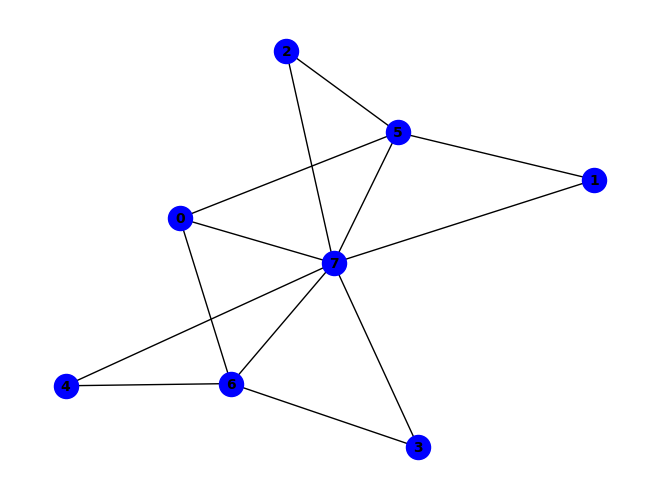


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (e & f & g & ~h) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & e & f & h & ~g) ^ (b & c & d & h & ~g) ^ (b & d & e & f & ~h) ^ (b & d & f & g & ~h) ^ (c & e & g & ~f & ~h) ^ (b & f & ~c & ~e & ~h) ^ (c & f & ~a & ~e & ~h) ^ (c & h & ~d & ~f & ~g) ^ (d & g & ~a & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (a & b & c & f & ~e & ~h) ^ (a & b & d & f & ~e & ~g) ^ (a & b & d & h & ~e & ~g) ^ (a & d & f & g & ~e & ~h) ^ (b & c & d & f & ~e & ~g) ^ (b & c & d & f & ~e & ~h) ^ (b & c & d & e & f & h & ~g) ^ (a & b & f & ~d & ~e & ~h) ^ (b & c & h & ~e & ~f & ~g) ^ (b & e & f & ~d & ~g & ~h) ^ (c & e & f & ~b & ~g & ~h) ^ (d & f & g & ~c & ~e & ~h) ^ (a & c & d & e & f & ~b & ~h) ^ (a & c & d & f & g & ~b & ~h) ^ (b & h & ~d & ~e & ~f & ~g) ^ (a & b & e & f & ~c & ~g & ~h) ^ (a & c & e & f & ~d & ~g & ~h) ^ (c & d & e & h & ~b & ~f & ~g) ^ (a & b & c & d & e & f & ~g & ~h) ^ (a & b & h & ~c & ~e & ~f & ~g) ^ (a & c & h & ~d 

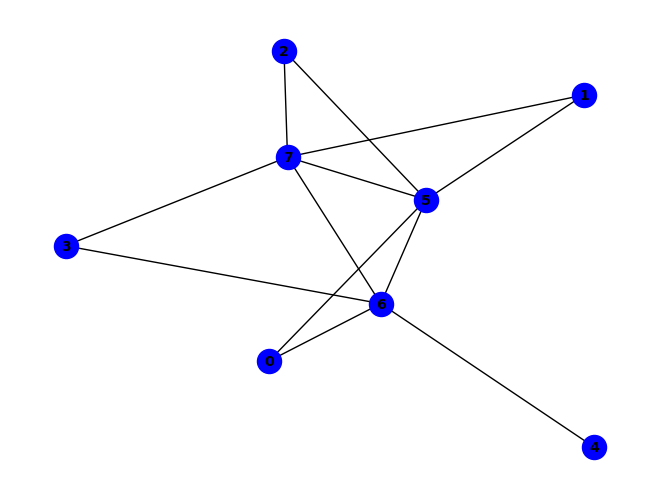


(f & g) ^ (f & h) ^ (~e & ~g) ^ (c & f & ~g) ^ (d & g & ~f) ^ (d & h & ~f) ^ (e & h & ~g) ^ (e & ~f & ~h) ^ (g & ~a & ~h) ^ (a & f & ~e & ~h) ^ (b & f & ~c & ~g) ^ (c & h & ~d & ~g) ^ (c & d & f & h & ~g) ^ (a & b & f & ~g & ~h) ^ (a & d & g & ~f & ~h) ^ (a & e & g & ~d & ~h) ^ (d & e & g & ~f & ~h) ^ (a & d & e & f & g & ~h) ^ (b & h & ~c & ~d & ~g) ^ (e & f & ~a & ~g & ~h) ^ (b & d & f & h & ~c & ~g) ^ (a & c & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


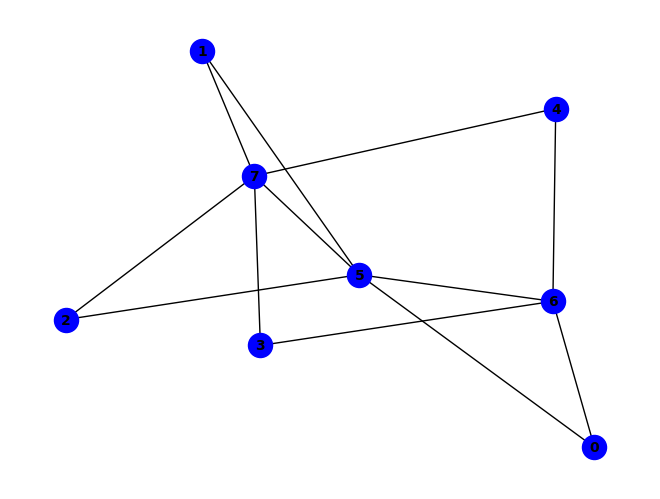


~e ^ (a & g & ~e) ^ (f & h & ~e) ^ (a & e & f & g) ^ (a & f & g & h) ^ (e & ~g & ~h) ^ (a & f & ~c & ~h) ^ (f & g & ~e & ~h) ^ (a & c & f & g & ~h) ^ (a & d & g & ~e & ~f) ^ (b & f & ~a & ~g & ~h) ^ (b & h & ~c & ~e & ~f) ^ (c & f & ~b & ~g & ~h) ^ (c & h & ~d & ~e & ~f) ^ (d & g & ~e & ~f & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & b & c & f & ~g & ~h) ^ (b & c & d & h & ~e & ~f) ^ (a & c & g & h & ~d & ~e & ~f) ^ (a & b & g & h & ~c & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


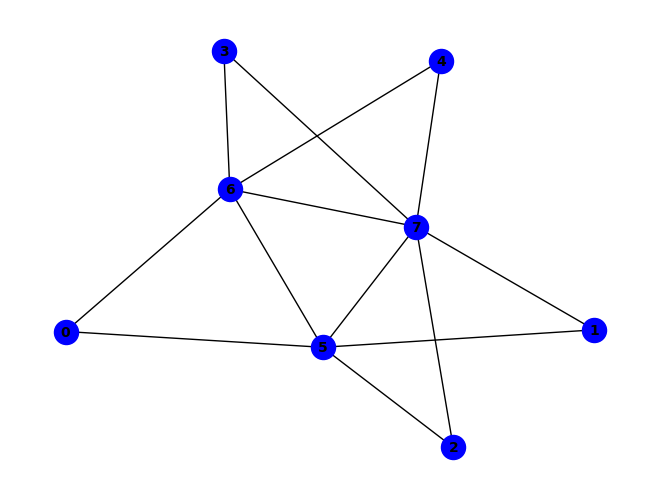


(f & g) ^ (~a & ~g) ^ (a & f & ~e) ^ (c & f & ~g) ^ (c & g & ~e) ^ (c & h & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & h & ~a) ^ (a & ~e & ~h) ^ (g & ~c & ~h) ^ (c & e & g & ~h) ^ (a & e & f & g & h) ^ (a & e & ~f & ~g) ^ (a & h & ~e & ~g) ^ (b & f & ~c & ~g) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (c & e & f & h & ~g) ^ (a & b & f & ~g & ~h) ^ (b & h & ~c & ~e & ~g) ^ (b & e & f & h & ~c & ~g) ^ (a & c & f & ~b & ~g & ~h) ^ (a & d & g & ~e & ~f & ~h) ^ (c & d & h & ~e & ~f & ~g) ^ (b & d & h & ~c & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


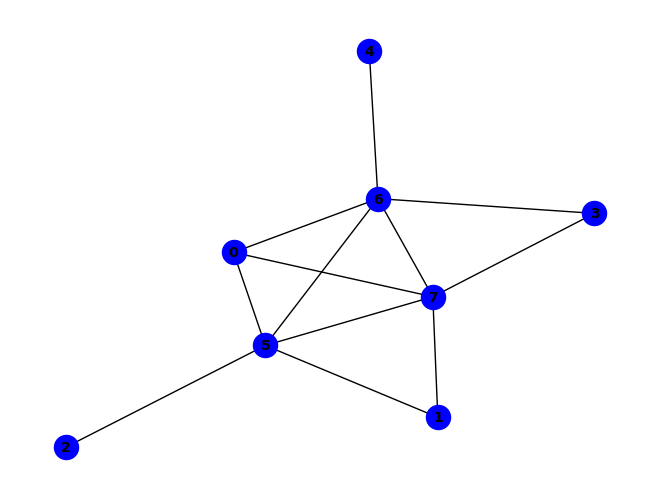


(f & g) ^ (f & h) ^ (g & ~h) ^ (~e & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (e & ~f & ~h) ^ (a & f & g & ~h) ^ (a & f & ~e & ~g) ^ (b & f & ~a & ~g) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (e & f & ~g & ~h) ^ (e & h & ~a & ~g) ^ (a & d & e & g & ~h) ^ (a & e & f & h & ~g) ^ (a & e & f & ~d & ~h) ^ (d & e & g & ~f & ~h) ^ (b & h & ~a & ~d & ~g) ^ (a & d & e & f & ~g & ~h) ^ (b & d & f & h & ~a & ~g) ^ (c & f & ~a & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


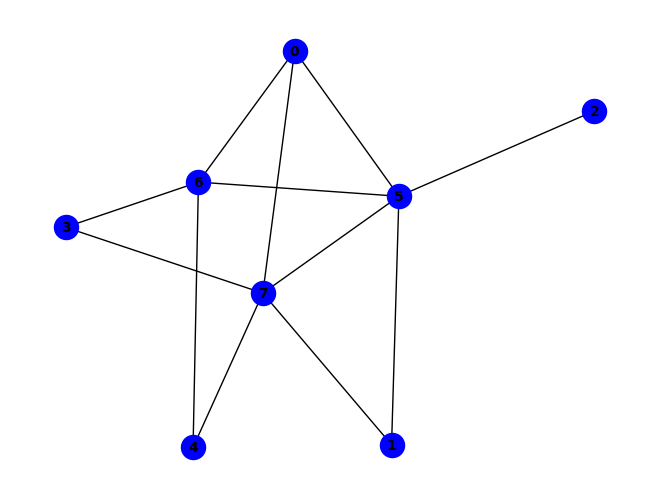


~e ^ (a & f & ~e) ^ (a & h & ~e) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & g & ~e & ~h) ^ (f & g & ~e & ~h) ^ (a & d & e & g & ~f) ^ (a & d & g & ~f & ~h) ^ (a & d & h & ~b & ~f) ^ (a & e & f & ~g & ~h) ^ (a & b & d & e & h & ~f) ^ (b & f & ~a & ~g & ~h) ^ (b & h & ~a & ~e & ~f) ^ (d & g & ~e & ~f & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & d & e & h & ~f & ~g) ^ (c & f & ~a & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


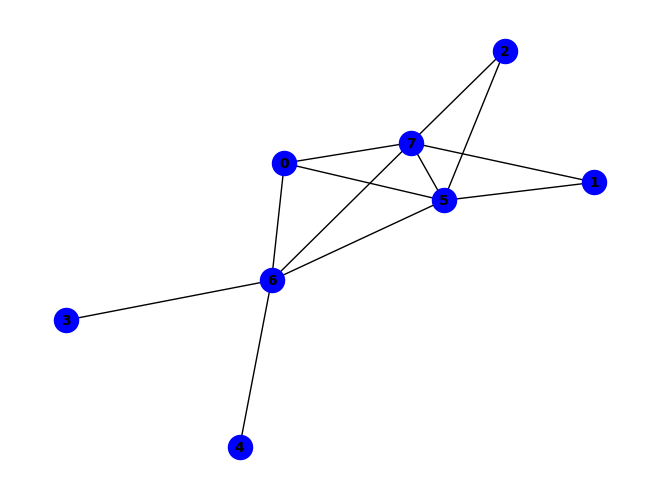


(f & g) ^ (f & h) ^ (~e & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (e & h & ~g) ^ (e & ~f & ~h) ^ (g & ~d & ~h) ^ (a & d & f & ~h) ^ (a & f & g & ~h) ^ (d & f & g & ~h) ^ (b & h & ~a & ~g) ^ (c & f & ~a & ~g) ^ (e & f & ~g & ~h) ^ (a & d & h & ~f & ~g) ^ (a & e & f & ~d & ~h) ^ (a & e & g & ~d & ~h) ^ (d & e & g & ~f & ~h) ^ (a & f & ~d & ~e & ~g) ^ (b & f & ~a & ~c & ~g) ^ (c & h & ~a & ~b & ~g) ^ (a & e & f & h & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


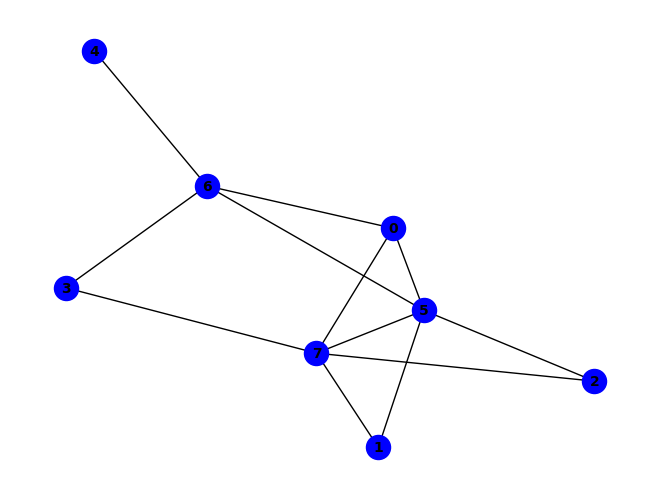


~e ^ (f & h) ^ (e & f & g) ^ (a & f & ~e) ^ (a & g & ~e) ^ (b & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (e & ~d & ~g) ^ (b & e & h & ~g) ^ (a & h & ~d & ~g) ^ (b & f & ~e & ~g) ^ (c & h & ~b & ~f) ^ (d & g & ~f & ~h) ^ (a & b & f & g & ~c) ^ (a & d & f & h & ~g) ^ (b & f & g & h & ~a) ^ (c & e & g & h & ~f) ^ (a & b & c & f & g & h) ^ (a & b & f & ~c & ~h) ^ (a & c & h & ~d & ~f) ^ (a & d & g & ~e & ~f) ^ (a & e & f & ~c & ~g) ^ (d & e & f & ~c & ~g) ^ (a & b & e & g & h & ~f) ^ (a & c & e & f & h & ~b) ^ (a & c & e & g & h & ~b) ^ (b & c & e & g & h & ~d) ^ (b & d & e & f & h & ~g) ^ (b & d & e & g & h & ~a) ^ (c & d & e & f & h & ~a) ^ (c & d & e & g & h & ~a) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (a & b & d & e & f & g & h) ^ (c & f & ~b & ~g & ~h) ^ (d & h & ~b & ~c & ~f) ^ (b & c & e & f & ~d & ~g) ^ (b & e & f & h & ~c & ~d) ^ (a & c & d & e & f & h & ~g) ^ (a & b & h & ~c & ~d & ~f) ^ (a & c & f & ~e & ~g & ~h) ^ (b & e & f & ~c & ~g & ~h) ^ (c & d & e &

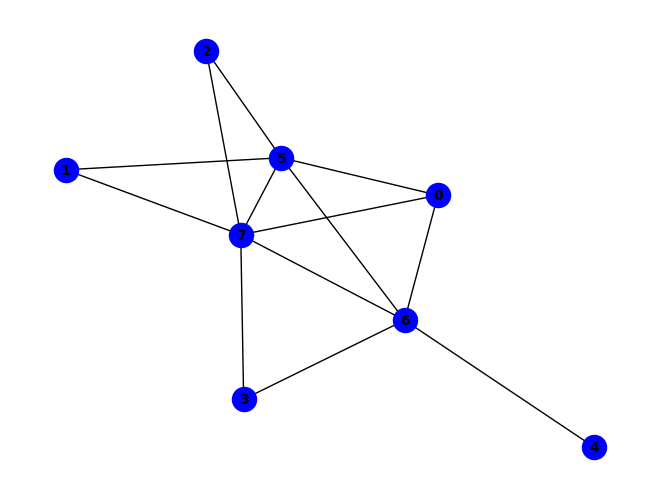


(f & g) ^ (f & h) ^ (g & ~h) ^ (~e & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (d & g & ~f) ^ (d & h & ~f) ^ (e & h & ~g) ^ (e & ~f & ~h) ^ (a & f & g & ~h) ^ (a & f & ~e & ~g) ^ (c & f & ~a & ~g) ^ (e & f & ~g & ~h) ^ (a & d & f & g & ~c) ^ (a & d & f & h & ~c) ^ (a & e & f & h & ~g) ^ (c & d & f & h & ~g) ^ (a & e & f & ~d & ~h) ^ (a & e & g & ~d & ~h) ^ (d & e & g & ~f & ~h) ^ (a & c & d & f & g & ~h) ^ (b & f & ~a & ~c & ~g) ^ (c & h & ~a & ~d & ~g) ^ (a & d & e & f & ~g & ~h) ^ (b & h & ~a & ~c & ~d & ~g) ^ (b & d & f & h & ~a & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


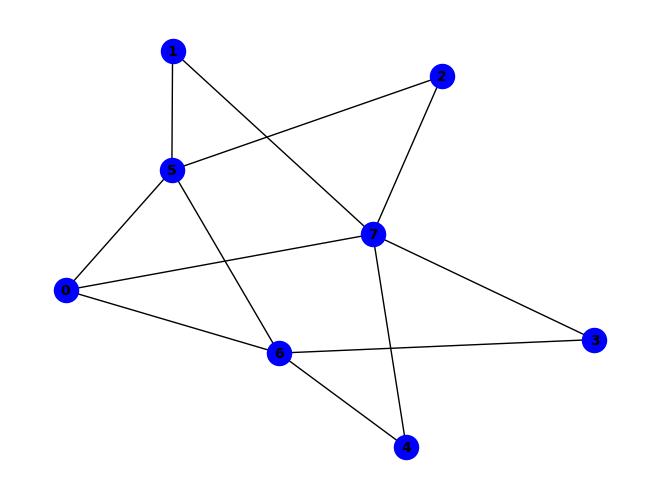


(e & f & g) ^ (~c & ~f) ^ (a & h & ~e) ^ (d & h & ~e) ^ (e & g & ~h) ^ (e & h & ~c) ^ (c & ~f & ~h) ^ (f & ~c & ~g) ^ (a & d & g & ~f) ^ (a & d & h & ~g) ^ (a & f & g & ~e) ^ (d & f & g & ~e) ^ (a & d & e & f & g) ^ (c & e & f & g & h) ^ (a & f & ~g & ~h) ^ (a & g & ~e & ~h) ^ (d & g & ~e & ~h) ^ (a & d & e & g & ~h) ^ (a & d & e & h & ~c) ^ (a & c & d & e & f & h) ^ (a & b & f & ~e & ~g) ^ (b & c & h & ~e & ~f) ^ (a & b & d & e & f & ~g) ^ (a & c & d & f & h & ~g) ^ (b & f & ~c & ~e & ~g) ^ (a & c & d & h & ~b & ~f) ^ (b & d & f & h & ~e & ~g) ^ (a & b & c & d & e & h & ~f) ^ (a & c & f & ~b & ~e & ~g) ^ (a & c & h & ~b & ~e & ~f) ^ (b & e & f & ~c & ~g & ~h) ^ (c & d & h & ~b & ~e & ~f) ^ (a & b & d & f & h & ~c & ~g) ^ (a & c & d & e & f & ~b & ~g) ^ (b & h & ~a & ~d & ~e & ~f) ^ (a & c & e & f & ~d & ~g & ~h) ^ (c & d & f & h & ~b & ~e & ~g) ^ (a & b & e & f & ~c & ~d & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

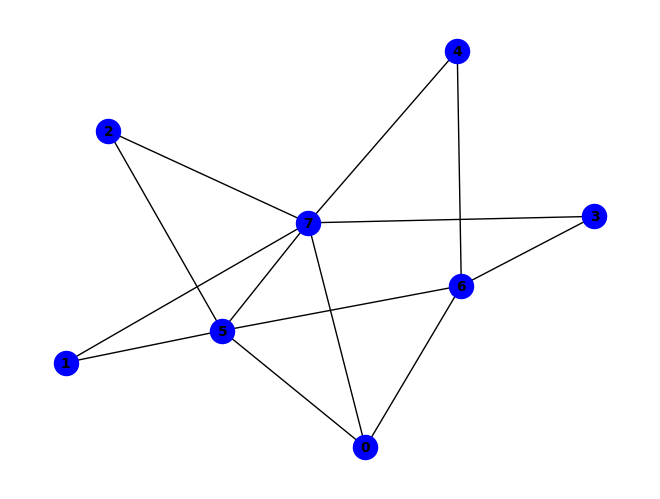


~e ^ (a & f & ~e) ^ (a & h & ~e) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & g & ~e & ~h) ^ (f & g & ~e & ~h) ^ (a & d & e & g & ~f) ^ (a & d & g & ~f & ~h) ^ (a & d & h & ~c & ~f) ^ (a & e & f & ~g & ~h) ^ (a & c & d & e & h & ~f) ^ (b & f & ~a & ~g & ~h) ^ (b & h & ~c & ~e & ~f) ^ (c & h & ~d & ~e & ~f) ^ (d & g & ~e & ~f & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & d & e & h & ~f & ~g) ^ (a & b & h & ~d & ~e & ~f) ^ (a & c & h & ~b & ~e & ~f) ^ (c & f & ~a & ~b & ~g & ~h) ^ (b & c & d & h & ~a & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


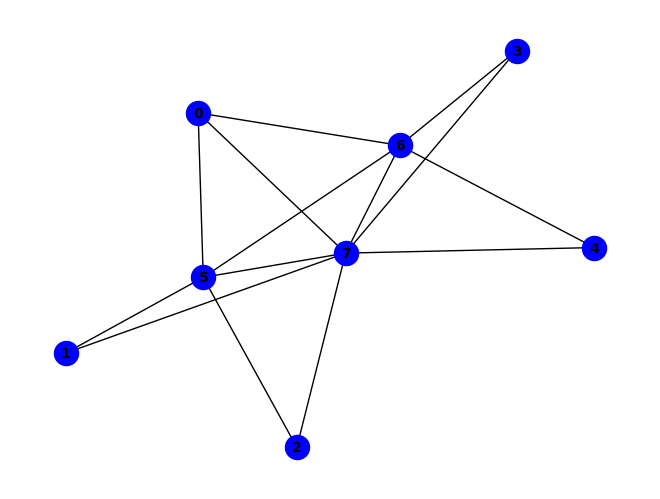


~g ^ (f & g) ^ (f & h) ^ (a & f & ~e) ^ (a & h & ~e) ^ (c & g & ~e) ^ (c & h & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (g & ~c & ~h) ^ (a & d & h & ~f) ^ (a & f & g & ~h) ^ (c & e & g & ~h) ^ (c & f & ~a & ~g) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (a & c & h & ~e & ~g) ^ (a & e & f & ~d & ~h) ^ (a & c & d & e & f & ~h) ^ (a & g & ~d & ~e & ~f) ^ (b & f & ~a & ~c & ~g) ^ (c & e & f & h & ~a & ~g) ^ (a & c & d & e & g & h & ~f) ^ (c & d & h & ~e & ~f & ~g) ^ (b & h & ~a & ~c & ~e & ~g) ^ (a & b & d & h & ~e & ~f & ~g) ^ (a & c & d & h & ~b & ~f & ~g) ^ (b & e & f & h & ~a & ~c & ~g) ^ (a & b & c & d & e & h & ~f & ~g) ^ (b & d & h & ~c & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


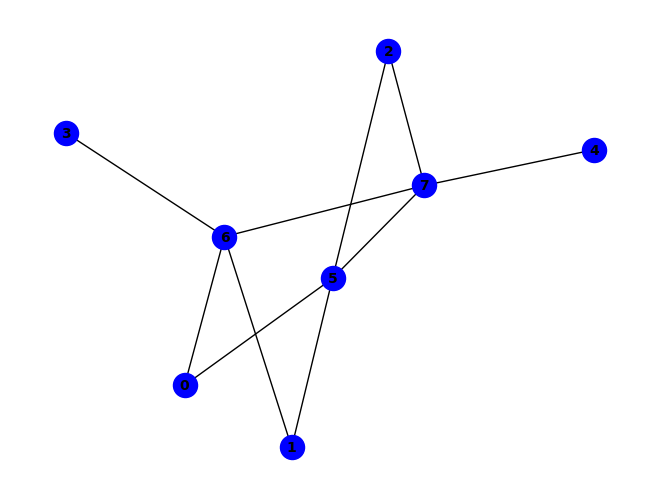


(~d & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~b & ~h) ^ (c & e & f & ~g) ^ (c & e & h & ~g) ^ (a & f & ~c & ~h) ^ (a & g & ~f & ~h) ^ (c & d & ~g & ~h) ^ (c & f & ~e & ~h) ^ (c & h & ~f & ~g) ^ (e & h & ~f & ~g) ^ (c & e & f & g & ~h) ^ (a & b & g & ~d & ~h) ^ (a & d & g & ~c & ~h) ^ (b & c & f & ~a & ~h) ^ (b & d & g & ~c & ~h) ^ (a & b & c & d & g & ~h) ^ (b & f & ~a & ~g & ~h) ^ (c & d & g & ~a & ~b & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


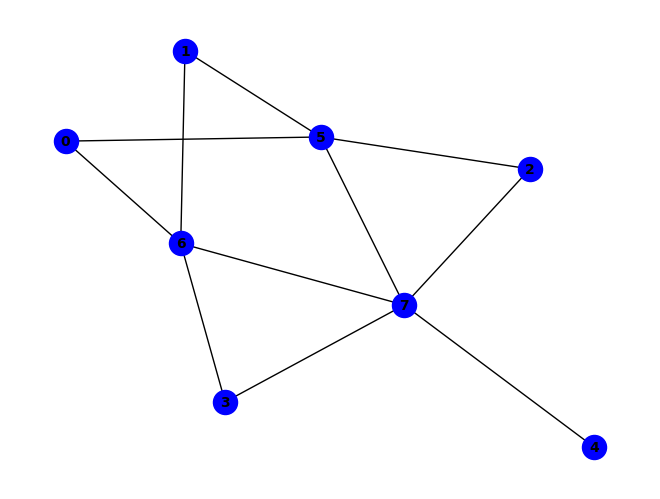


(~b & ~g) ^ (f & h & ~g) ^ (g & ~a & ~h) ^ (b & d & g & ~h) ^ (a & b & ~d & ~g) ^ (a & b & ~f & ~h) ^ (a & f & ~g & ~h) ^ (b & c & ~d & ~h) ^ (b & h & ~a & ~g) ^ (c & f & ~d & ~h) ^ (c & h & ~f & ~g) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & b & d & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & ~c & ~f & ~h) ^ (a & b & d & ~c & ~h) ^ (a & c & f & ~b & ~h) ^ (a & d & g & ~c & ~h) ^ (b & f & g & ~a & ~h) ^ (c & d & f & ~g & ~h) ^ (d & e & h & ~c & ~g) ^ (d & f & g & ~e & ~h) ^ (c & d & e & f & g & ~h) ^ (e & h & ~c & ~f & ~g) ^ (b & c & d & ~a & ~g & ~h) ^ (c & d & g & ~a & ~b & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


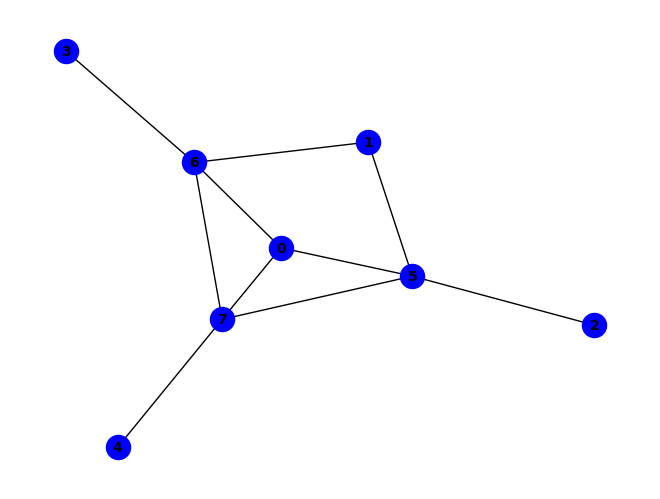


(~d & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (a & e & f & g) ^ (a & e & f & h) ^ (g & ~b & ~h) ^ (b & d & g & ~h) ^ (a & d & ~c & ~g) ^ (d & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (b & c & d & f & ~h) ^ (d & ~a & ~c & ~h) ^ (a & b & g & ~d & ~h) ^ (a & e & g & ~f & ~h) ^ (c & d & g & ~f & ~h) ^ (a & b & c & d & g & ~h) ^ (a & c & d & f & h & ~g) ^ (b & f & ~a & ~g & ~h) ^ (c & d & ~b & ~g & ~h) ^ (c & f & ~a & ~b & ~h) ^ (a & c & d & ~b & ~f & ~g) ^ (a & c & d & ~b & ~f & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (a & b & c & d & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


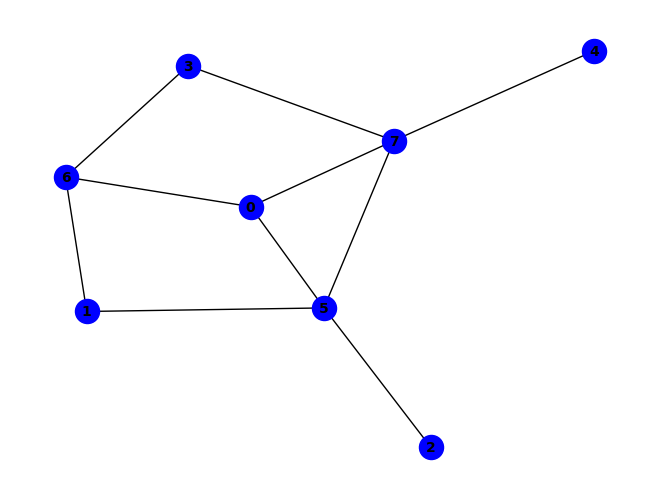


(a & d & g) ^ (~c & ~f) ^ (a & f & ~g) ^ (a & g & ~h) ^ (a & h & ~e) ^ (c & h & ~f) ^ (d & g & ~h) ^ (e & h & ~f) ^ (a & f & g & h) ^ (c & ~d & ~h) ^ (f & ~b & ~h) ^ (a & b & f & ~h) ^ (a & c & f & ~h) ^ (a & d & h & ~g) ^ (b & d & g & ~a) ^ (b & d & f & g & h) ^ (b & g & ~a & ~f) ^ (d & h & ~e & ~f) ^ (a & d & e & h & ~f) ^ (a & d & f & h & ~b) ^ (a & e & f & h & ~b) ^ (b & c & f & ~a & ~h) ^ (c & d & f & ~g & ~h) ^ (a & b & d & f & h & ~g) ^ (a & b & e & f & h & ~g) ^ (a & b & e & g & h & ~d) ^ (a & c & d & f & g & ~h) ^ (a & b & d & e & f & g & h) ^ (c & d & ~b & ~f & ~h) ^ (a & b & c & d & ~f & ~h) ^ (b & c & d & g & ~a & ~h) ^ (b & e & g & h & ~d & ~f) ^ (b & c & d & ~a & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


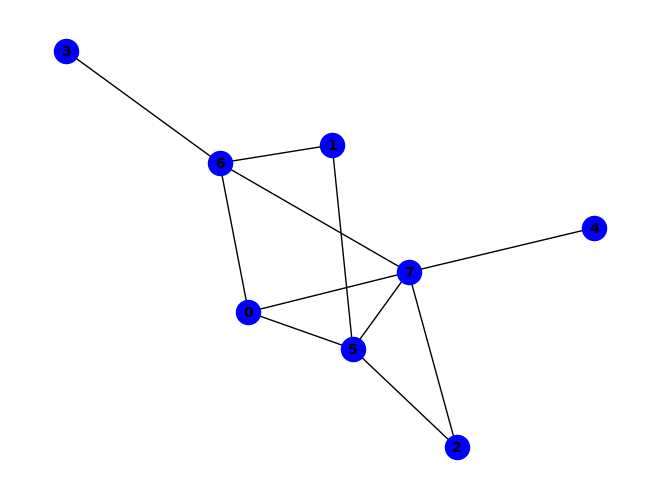


(~d & ~g) ^ (a & f & ~e) ^ (a & h & ~e) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~b & ~h) ^ (a & c & h & ~f) ^ (a & e & f & ~h) ^ (b & c & f & ~h) ^ (c & e & f & ~g) ^ (a & g & ~c & ~f) ^ (c & d & ~g & ~h) ^ (c & f & ~e & ~h) ^ (c & h & ~f & ~g) ^ (e & h & ~f & ~g) ^ (a & e & g & h & ~f) ^ (c & e & f & g & ~h) ^ (a & b & g & ~d & ~h) ^ (a & c & f & ~b & ~h) ^ (a & d & g & ~c & ~h) ^ (b & d & g & ~c & ~h) ^ (c & e & h & ~a & ~g) ^ (a & c & e & f & h & ~g) ^ (b & f & ~a & ~g & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & c & g & ~d & ~f & ~h) ^ (c & d & g & ~b & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


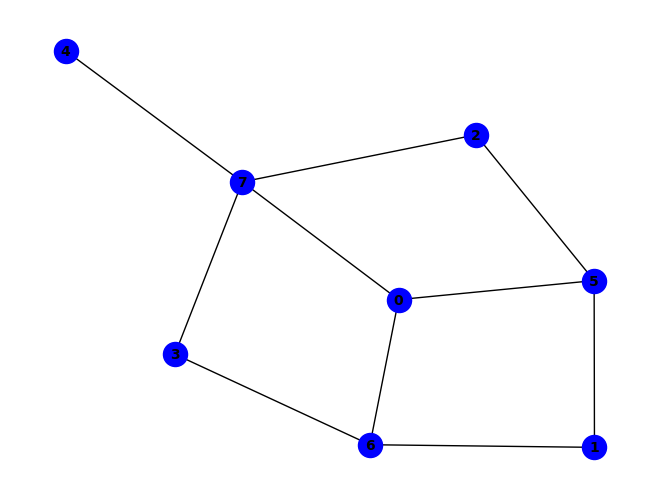


~e ^ (e & ~h) ^ (a & f & ~h) ^ (b & g & ~d) ^ (d & h & ~e) ^ (c & e & h & ~d) ^ (a & g & ~b & ~f) ^ (b & f & ~a & ~g) ^ (c & f & ~a & ~b) ^ (d & g & ~c & ~h) ^ (a & b & f & g & ~h) ^ (a & f & g & h & ~b) ^ (b & c & d & g & ~f) ^ (b & c & d & g & ~h) ^ (b & c & d & h & ~f) ^ (a & b & h & ~e & ~g) ^ (a & d & g & ~b & ~c) ^ (c & d & g & ~f & ~h) ^ (c & d & h & ~a & ~b) ^ (a & c & d & g & h & ~b) ^ (a & h & ~b & ~d & ~g) ^ (c & h & ~a & ~b & ~f) ^ (b & d & f & h & ~e & ~g) ^ (b & e & g & h & ~c & ~d) ^ (a & e & h & ~b & ~c & ~d) ^ (b & c & h & ~a & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (a & b & c & e & h & ~d & ~g) ^ (a & b & d & h & ~e & ~f & ~g) ^ (a & c & d & g & ~b & ~f & ~h) ^ (b & e & f & h & ~a & ~c & ~g) ^ (b & c & d & e & f & h & ~a & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


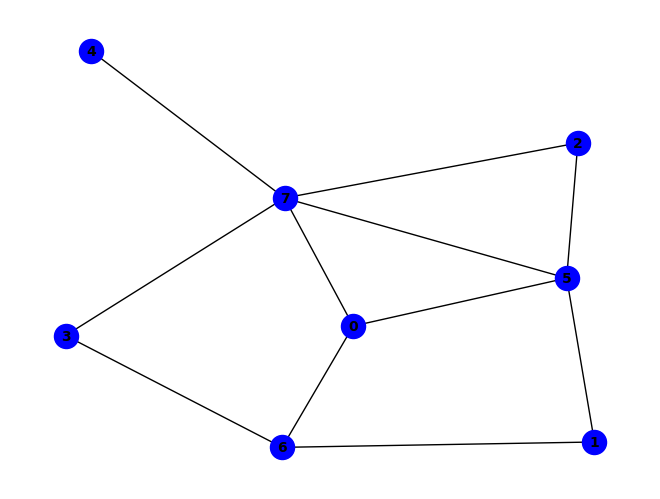


(~b & ~f) ^ (a & f & ~e) ^ (a & h & ~g) ^ (e & h & ~f) ^ (a & f & g & h) ^ (f & ~b & ~h) ^ (a & e & h & ~d) ^ (b & d & g & ~a) ^ (c & d & h & ~f) ^ (a & b & e & f & g) ^ (a & g & ~b & ~f) ^ (c & f & ~a & ~e) ^ (c & h & ~a & ~e) ^ (d & g & ~a & ~h) ^ (d & h & ~e & ~f) ^ (a & d & e & f & ~c) ^ (c & d & e & f & ~b) ^ (b & ~c & ~f & ~g) ^ (a & b & f & ~e & ~h) ^ (a & d & h & ~c & ~f) ^ (b & c & f & ~a & ~h) ^ (b & c & h & ~a & ~f) ^ (c & e & f & ~d & ~h) ^ (a & b & e & g & h & ~d) ^ (b & c & d & e & f & ~h) ^ (b & c & d & f & g & ~a) ^ (b & c & d & g & h & ~a) ^ (b & d & f & g & h & ~a) ^ (b & c & ~f & ~g & ~h) ^ (a & b & c & h & ~f & ~g) ^ (a & b & e & f & ~g & ~h) ^ (b & e & g & h & ~d & ~f) ^ (c & d & e & h & ~a & ~b) ^ (c & d & f & g & ~a & ~h) ^ (a & b & c & d & e & h & ~g) ^ (a & e & f & ~c & ~d & ~h) ^ (b & c & d & e & h & ~f & ~g) ^ (b & c & e & g & h & ~a & ~f) ^ (a & b & d & e & f & g & h & ~c)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


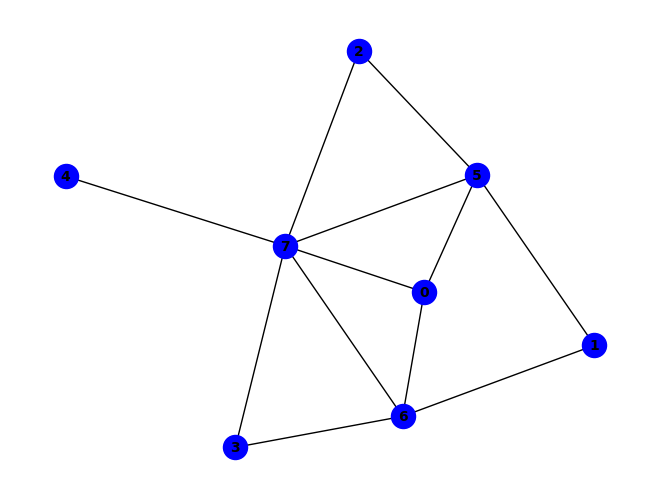


(g & ~h) ^ (~b & ~g) ^ (a & f & ~e) ^ (a & h & ~e) ^ (b & h & ~g) ^ (f & h & ~g) ^ (a & e & f & ~h) ^ (b & d & g & ~h) ^ (b & f & g & ~h) ^ (a & g & ~d & ~f) ^ (b & c & ~d & ~h) ^ (d & g & ~c & ~f) ^ (a & d & f & g & ~h) ^ (a & e & g & h & ~f) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & ~c & ~f & ~h) ^ (a & b & f & ~g & ~h) ^ (a & b & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (d & f & g & ~e & ~h) ^ (a & c & d & g & h & ~f) ^ (c & d & e & f & g & ~h) ^ (c & f & ~a & ~d & ~h) ^ (c & h & ~a & ~f & ~g) ^ (d & h & ~a & ~c & ~f) ^ (e & h & ~c & ~f & ~g) ^ (a & b & c & f & ~d & ~h) ^ (a & c & e & h & ~f & ~g) ^ (b & c & d & ~a & ~g & ~h) ^ (c & d & f & ~a & ~g & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (a & b & c & d & ~f & ~g & ~h) ^ (a & d & e & h & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


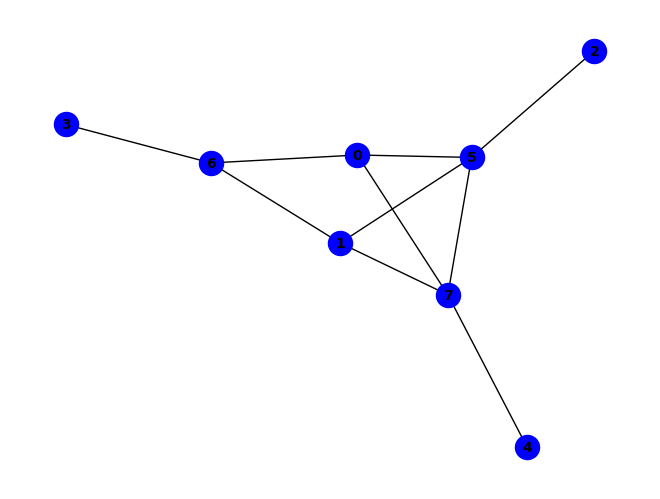


(f & ~h) ^ (~c & ~f) ^ (a & g & ~h) ^ (a & h & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (b & e & f & h) ^ (c & ~d & ~h) ^ (a & b & f & ~e) ^ (a & b & g & ~f) ^ (a & b & h & ~g) ^ (c & d & g & ~f) ^ (a & b & d & e & f) ^ (a & d & e & g & h) ^ (a & f & ~d & ~g) ^ (b & f & ~d & ~g) ^ (c & h & ~d & ~f) ^ (d & g & ~a & ~b) ^ (a & b & e & h & ~d) ^ (a & d & f & h & ~e) ^ (b & d & f & h & ~e) ^ (b & f & g & h & ~a) ^ (d & e & g & h & ~b) ^ (d & f & g & h & ~e) ^ (a & b & d & f & g & h) ^ (a & c & f & ~b & ~h) ^ (a & d & f & ~g & ~h) ^ (b & c & f & ~d & ~h) ^ (c & d & h & ~f & ~g) ^ (a & b & d & e & h & ~g) ^ (a & d & e & f & h & ~g) ^ (c & d & ~b & ~g & ~h) ^ (a & b & e & f & ~d & ~h) ^ (b & d & e & f & ~a & ~g) ^ (b & c & d & ~f & ~g & ~h) ^ (b & d & f & ~e & ~g & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (a & c & d & f & g & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

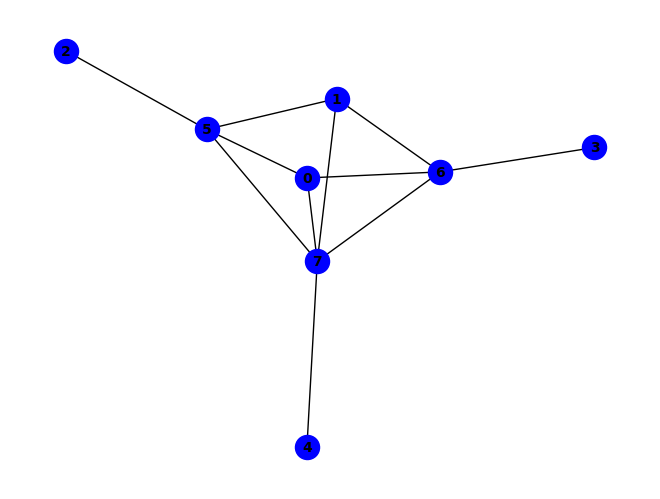


(g & ~h) ^ (~d & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (b & h & ~e) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & e & g & ~h) ^ (a & h & ~b & ~e) ^ (b & f & ~a & ~e) ^ (b & g & ~a & ~f) ^ (c & d & ~g & ~h) ^ (e & h & ~f & ~g) ^ (a & e & f & h & ~g) ^ (b & e & f & g & ~a) ^ (b & e & g & h & ~a) ^ (b & d & g & ~c & ~h) ^ (c & f & ~a & ~b & ~h) ^ (a & d & g & ~b & ~c & ~h) ^ (b & e & f & ~a & ~g & ~h) ^ (c & d & g & ~a & ~b & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


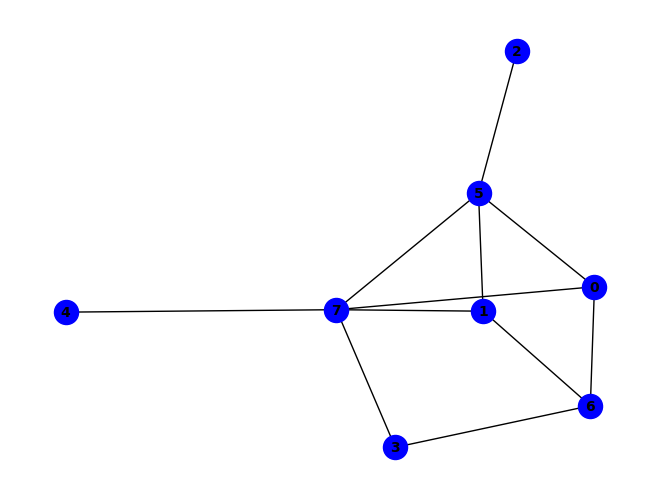


(f & ~h) ^ (~c & ~f) ^ (a & f & ~g) ^ (a & g & ~h) ^ (a & h & ~e) ^ (c & h & ~f) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (c & ~d & ~h) ^ (b & c & f & ~h) ^ (b & d & g & ~a) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~e) ^ (d & g & ~a & ~h) ^ (b & d & f & h & ~a) ^ (b & e & f & h & ~a) ^ (b & f & g & h & ~a) ^ (a & c & f & ~b & ~h) ^ (b & d & h & ~a & ~g) ^ (c & d & f & ~g & ~h) ^ (a & c & d & f & g & ~h) ^ (c & d & ~b & ~f & ~h) ^ (d & h & ~a & ~e & ~f) ^ (a & b & c & d & ~f & ~h) ^ (b & c & d & g & ~a & ~h) ^ (b & d & e & h & ~a & ~f) ^ (b & c & d & ~a & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


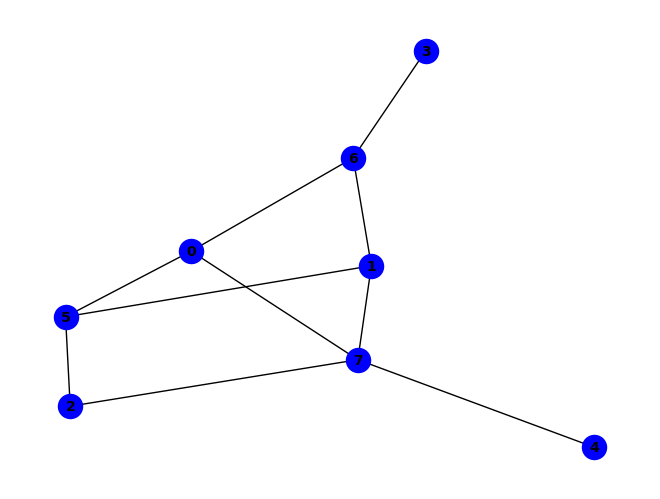


~e ^ (e & ~h) ^ (b & g & ~f) ^ (b & h & ~g) ^ (b & f & g & h) ^ (a & b & h & ~f) ^ (a & c & f & ~d) ^ (a & f & ~b & ~g) ^ (a & g & ~b & ~h) ^ (a & h & ~c & ~f) ^ (b & f & ~c & ~h) ^ (c & f & ~d & ~h) ^ (c & h & ~b & ~e) ^ (d & g & ~a & ~b) ^ (a & b & c & f & ~h) ^ (a & b & c & h & ~e) ^ (a & f & g & h & ~b) ^ (c & d & g & h & ~b) ^ (d & e & g & h & ~c) ^ (b & c & d & e & g & h) ^ (a & e & h & ~c & ~d) ^ (b & e & h & ~a & ~d) ^ (a & c & d & g & h & ~f) ^ (a & c & d & f & ~b & ~g) ^ (a & d & e & h & ~c & ~g) ^ (b & c & d & f & ~a & ~h) ^ (b & d & e & h & ~a & ~g) ^ (a & b & c & d & f & h & ~g) ^ (a & b & c & d & g & h & ~e) ^ (c & d & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


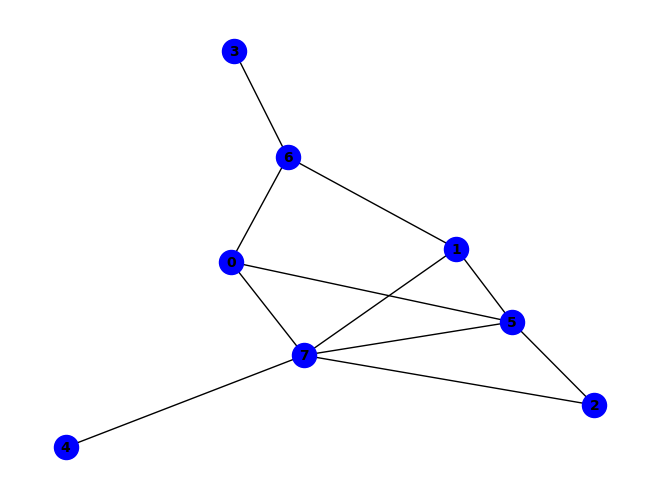


~f ^ (f & ~h) ^ (a & g & ~h) ^ (e & h & ~f) ^ (a & f & g & h) ^ (b & c & d & f & g) ^ (a & h & ~b & ~e) ^ (b & f & ~d & ~g) ^ (b & g & ~a & ~h) ^ (b & h & ~c & ~e) ^ (c & h & ~a & ~e) ^ (d & g & ~a & ~b) ^ (a & b & c & h & ~e) ^ (a & d & f & h & ~e) ^ (a & e & f & h & ~b) ^ (b & c & e & f & ~h) ^ (b & d & f & h & ~a) ^ (b & e & f & h & ~d) ^ (b & f & g & h & ~a) ^ (c & d & f & g & ~e) ^ (d & f & g & h & ~e) ^ (b & c & d & e & f & h) ^ (c & e & f & ~d & ~h) ^ (a & c & d & f & g & ~b) ^ (a & b & d & e & f & g & h) ^ (a & f & ~b & ~d & ~g) ^ (c & f & ~a & ~b & ~e) ^ (a & c & e & f & ~b & ~h) ^ (b & d & e & f & ~c & ~g) ^ (d & e & g & h & ~a & ~b) ^ (a & c & d & e & f & h & ~b) ^ (a & d & f & ~b & ~g & ~h) ^ (b & d & f & ~e & ~g & ~h) ^ (a & d & e & f & h & ~c & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (c & d & e & f & ~b & ~g & ~h) ^ (c & d & g & h & ~a & ~b & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


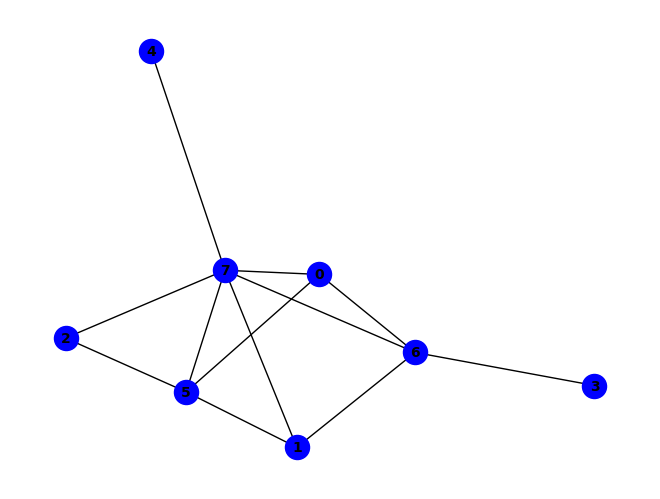


(g & ~h) ^ (~d & ~g) ^ (a & f & ~e) ^ (a & h & ~e) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & e & f & ~h) ^ (b & c & f & ~h) ^ (c & e & f & ~g) ^ (a & g & ~c & ~f) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & d & ~g & ~h) ^ (c & f & ~e & ~h) ^ (e & h & ~f & ~g) ^ (a & b & e & g & ~h) ^ (a & e & g & h & ~f) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (a & c & f & ~b & ~h) ^ (a & c & h & ~b & ~f) ^ (b & d & g & ~c & ~h) ^ (b & e & g & ~f & ~h) ^ (c & e & h & ~b & ~g) ^ (a & b & c & e & h & ~g) ^ (a & b & c & g & h & ~f) ^ (c & h & ~b & ~f & ~g) ^ (a & c & e & h & ~f & ~g) ^ (c & e & f & g & ~b & ~h) ^ (a & c & g & ~d & ~f & ~h) ^ (a & d & g & ~b & ~c & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & e & f & h & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

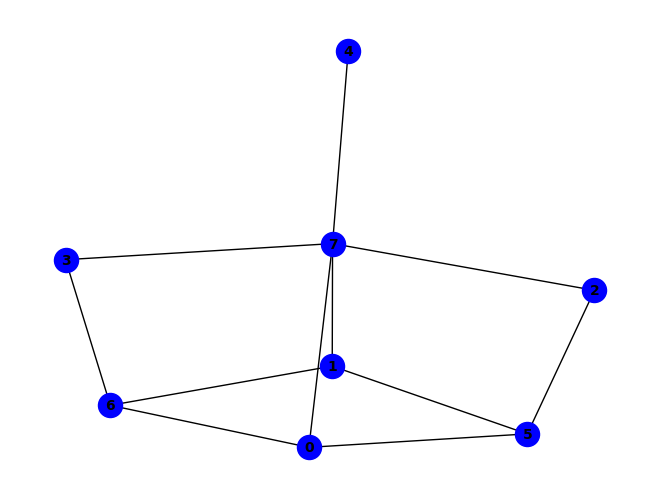


~e ^ (c & d & h) ^ (b & e & ~d) ^ (b & g & ~f) ^ (b & h & ~g) ^ (c & f & ~b) ^ (a & b & c & f) ^ (b & f & g & h) ^ (e & ~b & ~h) ^ (a & c & h & ~d) ^ (a & c & d & e & h) ^ (a & f & ~c & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~g) ^ (b & f & ~a & ~h) ^ (c & h & ~b & ~f) ^ (d & h & ~a & ~e) ^ (a & b & c & h & ~f) ^ (a & b & d & e & ~c) ^ (a & f & g & h & ~b) ^ (a & e & h & ~b & ~c) ^ (b & d & e & ~a & ~h) ^ (b & d & h & ~a & ~c) ^ (c & e & h & ~b & ~d) ^ (a & b & c & d & e & ~h) ^ (d & g & ~a & ~b & ~c & ~h) ^ (c & d & g & ~a & ~b & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


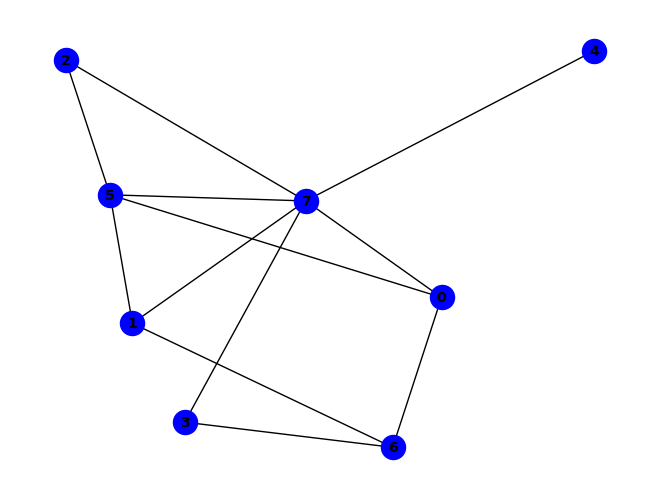


~f ^ (f & ~h) ^ (b & f & ~g) ^ (c & h & ~e) ^ (d & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & f & g & h) ^ (b & d & g & ~a) ^ (a & f & ~b & ~g) ^ (a & g & ~d & ~h) ^ (b & g & ~a & ~h) ^ (b & h & ~c & ~e) ^ (b & d & f & h & ~a) ^ (b & e & f & h & ~a) ^ (b & f & g & h & ~a) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (b & d & h & ~a & ~g) ^ (c & d & h & ~b & ~f) ^ (a & h & ~b & ~c & ~e) ^ (c & f & ~a & ~b & ~e) ^ (d & h & ~a & ~e & ~f) ^ (a & c & e & f & ~b & ~h) ^ (b & d & e & h & ~a & ~f) ^ (c & e & f & ~b & ~d & ~h) ^ (a & c & d & h & ~b & ~e & ~f) ^ (c & d & f & g & ~a & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


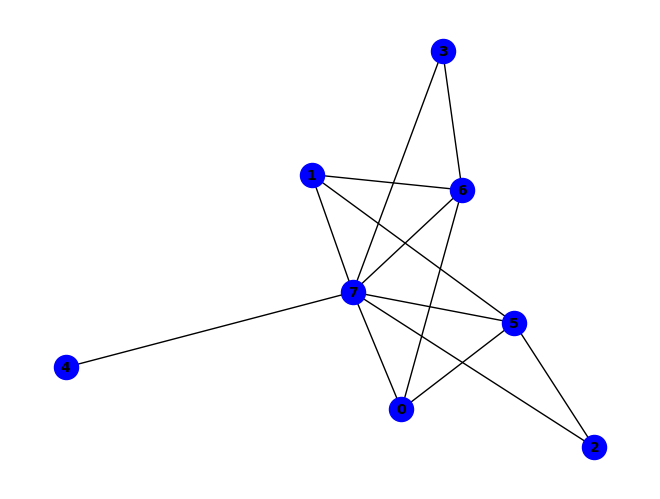


~g ^ (g & ~h) ^ (a & f & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (a & e & f & ~h) ^ (a & g & ~d & ~f) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (a & b & e & g & ~h) ^ (a & e & g & h & ~f) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & e & g & ~f & ~h) ^ (a & b & d & e & h & ~g) ^ (a & c & d & g & h & ~f) ^ (c & d & e & f & g & ~h) ^ (c & f & ~b & ~d & ~h) ^ (d & g & ~b & ~c & ~f) ^ (e & h & ~c & ~f & ~g) ^ (a & b & d & g & ~c & ~f) ^ (a & c & e & f & ~b & ~g) ^ (a & d & e & h & ~f & ~g) ^ (b & c & e & h & ~f & ~g) ^ (b & c & d & e & f & h & ~g) ^ (a & c & f & ~b & ~e & ~h) ^ (c & d & f & ~b & ~g & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (d & e & h & ~b & ~c & ~g) ^ (d & f & g & ~b & ~e & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & e & f & h & ~d & ~g) ^ (a & c & e & f & g & ~b & ~h) ^ (c & h & ~a & ~b & ~f & ~g) ^ (d & h & ~a & ~b & ~c & ~f) ^ (a & c & e & h & ~b & ~d & ~g) ^ (a & d & f & g & ~b & ~c & ~h) ^ (a & c & d 

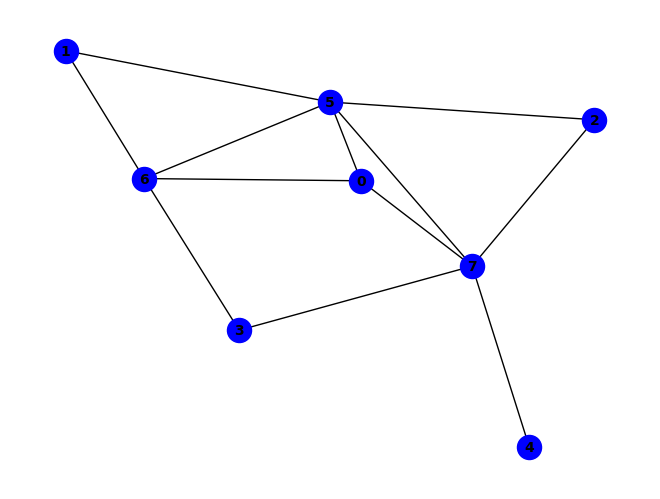


~e ^ (a & f & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & c & f & ~g) ^ (a & e & f & ~h) ^ (a & c & f & g & h) ^ (a & g & ~d & ~h) ^ (a & h & ~c & ~e) ^ (b & g & ~a & ~d) ^ (c & f & ~g & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~f & ~h) ^ (d & h & ~c & ~f) ^ (a & d & f & g & ~h) ^ (b & d & f & g & ~a) ^ (b & f & g & h & ~a) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (d & e & f & ~c & ~h) ^ (a & c & e & f & h & ~b) ^ (b & c & d & e & h & ~g) ^ (b & c & d & g & h & ~f) ^ (a & b & c & d & e & f & h) ^ (b & f & ~a & ~c & ~h) ^ (b & c & f & g & ~a & ~h) ^ (b & c & g & h & ~e & ~f) ^ (a & b & c & e & f & h & ~g) ^ (a & b & c & e & g & h & ~d) ^ (b & c & d & e & f & g & ~h) ^ (a & d & h & ~c & ~e & ~f) ^ (a & b & c & g & h & ~d & ~f) ^ (b & c & d & e & f & ~a & ~g) ^ (b & e & g & h & ~a & ~d & ~f) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

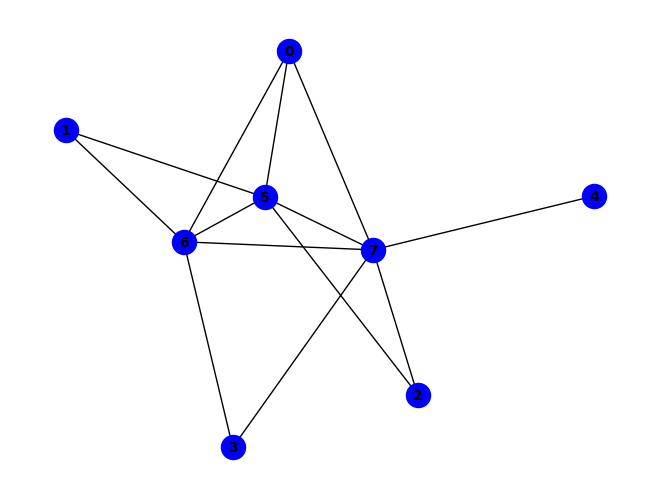


(~b & ~g) ^ (a & f & ~e) ^ (a & g & ~f) ^ (a & h & ~e) ^ (b & h & ~g) ^ (c & g & ~e) ^ (c & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (a & e & f & ~h) ^ (a & f & g & ~h) ^ (c & f & ~a & ~g) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (e & h & ~d & ~g) ^ (a & c & e & g & ~f) ^ (a & c & e & h & ~f) ^ (a & e & g & h & ~f) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & c & d & e & f & g) ^ (a & c & d & e & f & h) ^ (b & ~c & ~f & ~h) ^ (a & b & f & ~d & ~h) ^ (a & b & g & ~d & ~h) ^ (a & c & h & ~d & ~g) ^ (b & c & g & ~f & ~h) ^ (b & d & g & ~f & ~h) ^ (c & d & h & ~f & ~g) ^ (c & e & g & ~a & ~h) ^ (e & f & g & ~d & ~h) ^ (a & c & d & f & h & ~g) ^ (c & d & e & f & g & ~h) ^ (b & c & ~a & ~g & ~h) ^ (a & b & d & f & ~g & ~h) ^ (a & d & e & h & ~f & ~g) ^ (c & d & e & h & ~a & ~g) ^ (a & b & c & ~f & ~g & ~h) ^ (a & c & e & f & g & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

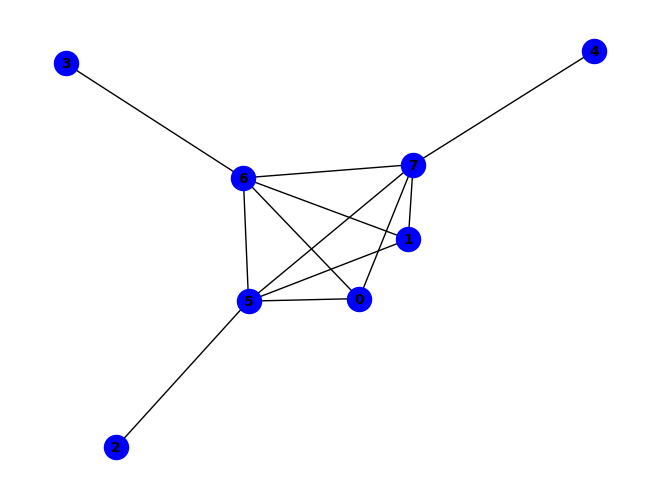


(g & ~h) ^ (~d & ~g) ^ (b & f & ~e) ^ (b & h & ~e) ^ (e & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (b & d & f & ~h) ^ (b & d & g & ~h) ^ (b & e & f & ~h) ^ (e & f & g & ~h) ^ (a & g & ~b & ~e) ^ (a & h & ~b & ~e) ^ (b & g & ~c & ~f) ^ (d & f & ~b & ~g) ^ (d & h & ~f & ~g) ^ (a & e & f & g & ~b) ^ (a & e & f & h & ~b) ^ (b & c & g & h & ~f) ^ (b & d & f & h & ~g) ^ (b & e & g & h & ~f) ^ (a & d & f & ~b & ~h) ^ (a & d & g & ~b & ~h) ^ (a & e & g & ~b & ~h) ^ (a & f & g & ~e & ~h) ^ (b & f & g & ~a & ~h) ^ (a & b & e & f & g & ~h) ^ (a & f & ~b & ~d & ~g) ^ (b & c & ~a & ~f & ~h) ^ (b & c & ~a & ~g & ~h) ^ (c & f & ~a & ~g & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & d & f & h & ~b & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


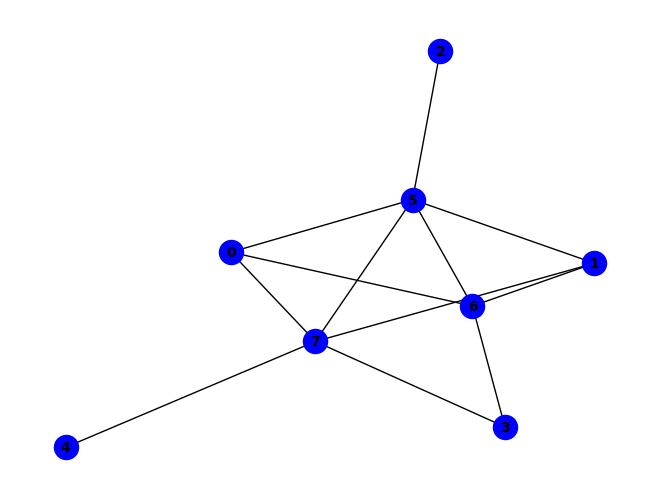


~e ^ (b & f & ~e) ^ (b & g & ~d) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (b & e & h & ~d) ^ (d & e & f & ~h) ^ (a & f & ~b & ~e) ^ (a & h & ~b & ~e) ^ (b & h & ~d & ~g) ^ (d & g & ~f & ~h) ^ (d & h & ~a & ~f) ^ (a & b & d & h & ~f) ^ (a & d & e & f & ~b) ^ (a & d & e & h & ~b) ^ (b & d & f & g & ~h) ^ (b & d & f & h & ~e) ^ (a & e & f & ~d & ~h) ^ (b & e & f & ~a & ~h) ^ (a & b & d & e & f & ~h) ^ (a & g & ~b & ~d & ~h) ^ (a & d & f & g & ~b & ~h) ^ (c & f & ~a & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


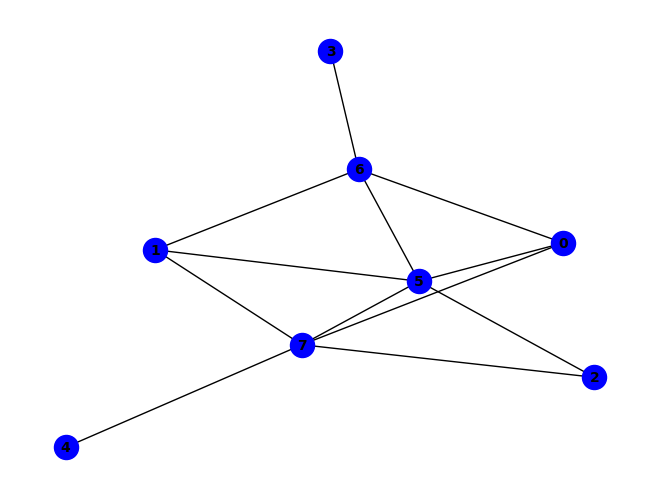


~e ^ (d & e & g) ^ (a & f & ~e) ^ (a & g & ~h) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & c & e & f & h) ^ (a & c & f & g & h) ^ (b & d & e & f & g) ^ (d & e & f & g & h) ^ (a & h & ~c & ~e) ^ (b & f & ~a & ~e) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~e) ^ (d & e & ~g & ~h) ^ (a & c & f & ~d & ~g) ^ (a & e & f & ~b & ~h) ^ (b & e & f & ~d & ~h) ^ (c & d & f & ~e & ~g) ^ (b & d & e & g & h & ~c) ^ (a & b & c & d & e & g & h) ^ (c & f & ~d & ~g & ~h) ^ (c & h & ~b & ~e & ~f) ^ (d & g & ~a & ~b & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & c & d & f & ~g & ~h) ^ (b & d & e & f & ~g & ~h) ^ (c & d & f & h & ~a & ~e) ^ (c & d & g & h & ~a & ~e) ^ (a & c & d & e & f & h & ~g) ^ (b & c & d & e & f & h & ~a) ^ (b & c & f & ~a & ~g & ~h) ^ (a & d & e & g & h & ~b & ~f) ^ (b & c & d & e & f & ~a & ~g) ^ (b & c & d & g & h & ~a & ~f) ^ (c & d & e & f & ~b & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

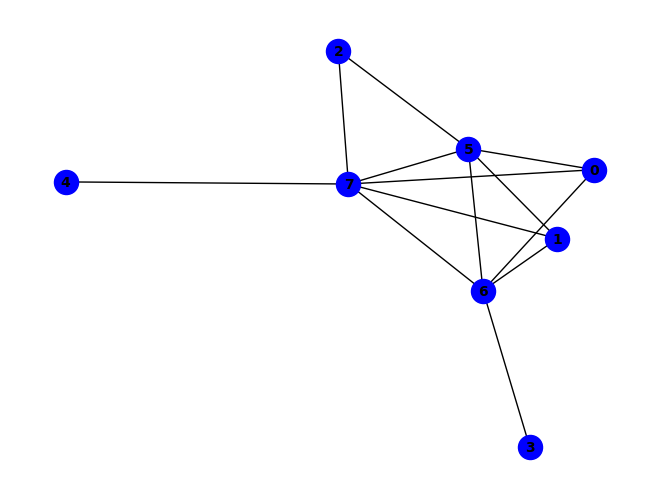


(g & ~h) ^ (~d & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (b & g & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (a & b & f & ~e) ^ (a & b & g & ~f) ^ (a & d & f & ~h) ^ (b & d & g & ~h) ^ (b & e & g & ~h) ^ (e & f & g & ~h) ^ (a & b & e & g & h) ^ (a & f & ~c & ~g) ^ (b & f & ~d & ~g) ^ (b & h & ~a & ~e) ^ (c & f & ~b & ~g) ^ (d & f & ~a & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~c & ~g) ^ (a & b & c & f & ~g) ^ (a & c & e & g & ~f) ^ (a & c & e & h & ~f) ^ (a & d & f & h & ~g) ^ (a & e & f & h & ~g) ^ (b & d & f & h & ~g) ^ (b & e & f & h & ~c) ^ (c & e & f & h & ~g) ^ (a & b & c & e & f & h) ^ (a & d & g & ~b & ~h) ^ (a & e & g & ~c & ~h) ^ (a & f & g & ~b & ~h) ^ (b & d & f & ~a & ~h) ^ (b & f & g & ~e & ~h) ^ (b & c & e & f & g & ~h) ^ (c & h & ~a & ~b & ~g) ^ (a & b & d & f & ~g & ~h) ^ (a & b & e & f & ~g & ~h) ^ (b & c & e & h & ~a & ~g) ^ (b & e & f & g & ~a & ~c) ^ (a & c & e & f & g & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


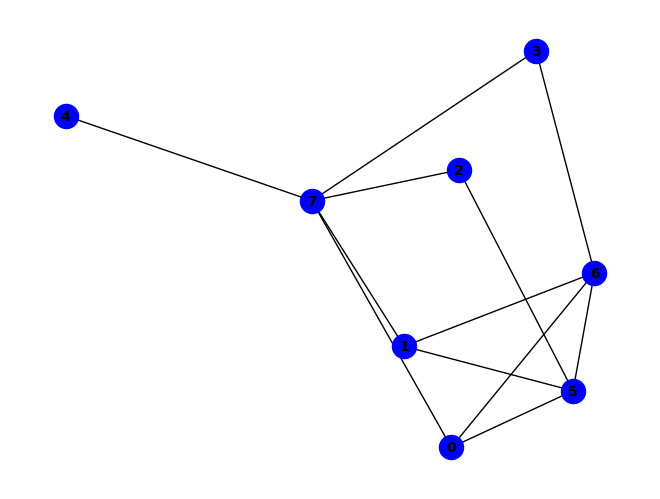


(~c & ~f) ^ (a & g & ~f) ^ (a & h & ~g) ^ (c & ~f & ~h) ^ (a & e & h & ~f) ^ (b & d & g & ~a) ^ (a & f & ~g & ~h) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~e) ^ (d & g & ~a & ~h) ^ (d & h & ~a & ~e) ^ (e & h & ~c & ~f) ^ (a & e & f & h & ~g) ^ (b & e & f & g & ~a) ^ (b & f & g & h & ~a) ^ (f & ~c & ~e & ~g) ^ (b & c & f & ~e & ~g) ^ (b & d & h & ~a & ~g) ^ (c & d & h & ~e & ~f) ^ (d & f & g & ~a & ~b) ^ (d & e & f & g & h & ~a) ^ (b & f & ~a & ~e & ~h) ^ (e & f & ~c & ~g & ~h) ^ (b & d & e & h & ~a & ~f) ^ (a & c & f & ~b & ~e & ~g) ^ (b & c & h & ~d & ~e & ~f) ^ (b & c & d & f & h & ~a & ~g) ^ (a & b & e & f & ~d & ~g & ~h) ^ (a & c & e & f & ~b & ~g & ~h) ^ (b & d & e & f & ~a & ~c & ~g) ^ (c & d & f & h & ~a & ~e & ~g) ^ (a & b & c & d & e & f & ~g & ~h) ^ (a & c & h & ~b & ~d & ~e & ~f) ^ (b & e & f & ~c & ~d & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

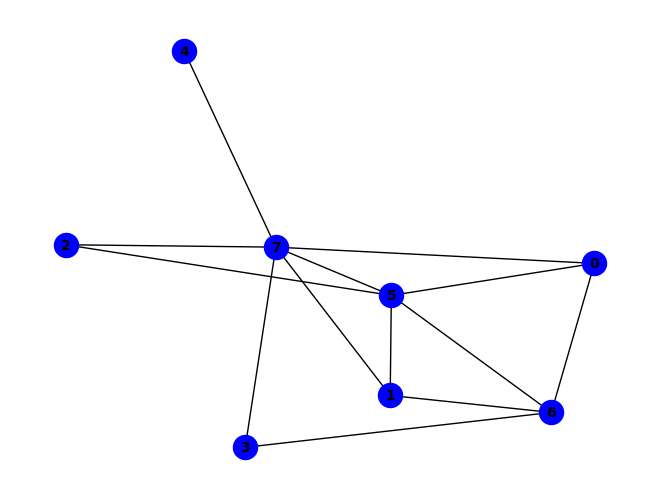


~e ^ (b & f & ~e) ^ (b & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & f & ~b & ~e) ^ (a & g & ~d & ~h) ^ (a & h & ~b & ~e) ^ (d & g & ~f & ~h) ^ (d & h & ~c & ~f) ^ (b & c & e & f & ~d) ^ (b & c & e & h & ~d) ^ (b & d & f & g & ~h) ^ (c & d & e & f & ~a) ^ (c & d & e & h & ~a) ^ (a & e & f & ~b & ~h) ^ (b & c & h & ~d & ~f) ^ (b & d & h & ~e & ~f) ^ (b & e & f & ~c & ~h) ^ (d & e & f & ~c & ~h) ^ (a & c & d & e & f & ~h) ^ (b & c & d & e & f & ~h) ^ (b & g & ~a & ~d & ~h) ^ (c & h & ~a & ~e & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & c & d & h & ~b & ~f) ^ (a & d & f & g & ~b & ~h) ^ (a & b & c & d & e & h & ~f) ^ (a & d & h & ~b & ~e & ~f) ^ (c & f & ~a & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


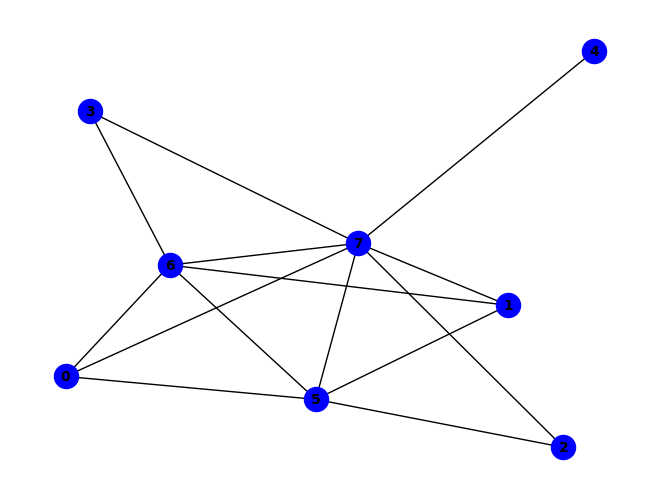


~g ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & f & ~g) ^ (c & g & ~e) ^ (c & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (a & g & ~b & ~e) ^ (a & h & ~b & ~e) ^ (b & f & ~c & ~g) ^ (d & g & ~b & ~f) ^ (d & h & ~b & ~f) ^ (e & h & ~d & ~g) ^ (a & b & d & g & ~f) ^ (a & b & d & h & ~f) ^ (b & c & e & g & ~f) ^ (b & c & e & h & ~f) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & d & e & f & g) ^ (a & c & d & e & f & h) ^ (b & c & d & e & f & g) ^ (b & c & d & e & f & h) ^ (a & d & g & ~e & ~f) ^ (a & d & h & ~e & ~f) ^ (a & e & g & ~d & ~h) ^ (a & f & g & ~b & ~h) ^ (b & c & h & ~d & ~g) ^ (b & e & g & ~a & ~h) ^ (b & f & g & ~e & ~h) ^ (c & e & g & ~b & ~h) ^ (e & f & g & ~d & ~h) ^ (b & c & d & f & h & ~g) ^ (c & d & e & f & g & ~h) ^ (a & f & ~b & ~c & ~g) ^ (b & d & e & h & ~a & ~g) ^ (a & b & d & e & f & h & ~c) ^ (a & c & d & e & f & g & ~b) ^ (a & c & h & ~b & ~e & ~g) ^ (c & d & h & ~a & ~f & ~g) ^

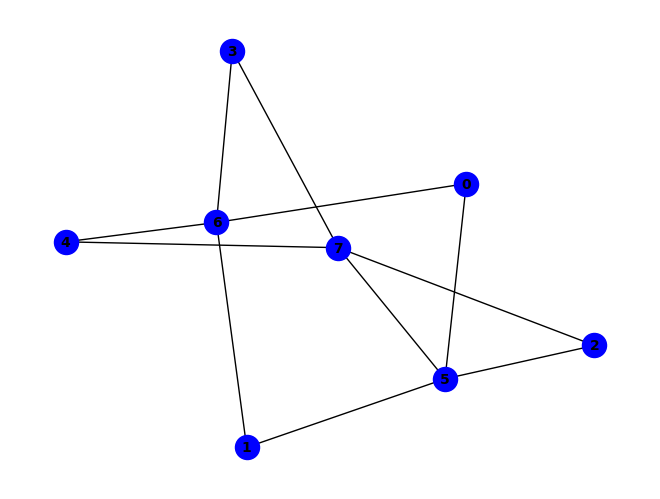


(a & d & g) ^ (~b & ~f) ^ (c & h & ~b) ^ (e & g & ~h) ^ (f & ~b & ~h) ^ (a & e & g & ~d) ^ (b & d & g & ~a) ^ (b & e & g & ~d) ^ (a & b & d & e & g) ^ (a & c & d & f & g) ^ (a & e & f & g & h) ^ (b & e & f & g & h) ^ (c & d & e & f & g) ^ (a & f & ~c & ~h) ^ (a & g & ~b & ~f) ^ (c & f & ~b & ~e) ^ (d & g & ~e & ~h) ^ (e & h & ~c & ~f) ^ (a & b & c & f & ~h) ^ (a & b & e & g & ~f) ^ (c & d & f & g & ~h) ^ (c & e & f & h & ~d) ^ (a & b & c & e & f & g) ^ (b & ~c & ~f & ~g) ^ (a & b & f & ~e & ~h) ^ (c & e & f & ~g & ~h) ^ (a & c & d & g & h & ~e) ^ (a & c & e & f & g & ~d) ^ (a & c & e & g & h & ~b) ^ (b & c & d & e & f & ~a) ^ (b & c & d & f & g & ~a) ^ (b & c & d & g & h & ~a) ^ (b & c & e & g & h & ~d) ^ (b & d & f & g & h & ~e) ^ (c & d & e & f & h & ~g) ^ (a & b & c & d & e & g & h) ^ (b & c & ~f & ~g & ~h) ^ (d & h & ~c & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & c & g & h & ~b & ~f) ^ (b & c & e & f & ~d & ~g) ^ (a & b & c & d & e & f & ~g) ^ (a & d & f & g & h & ~b & ~e)
PASS


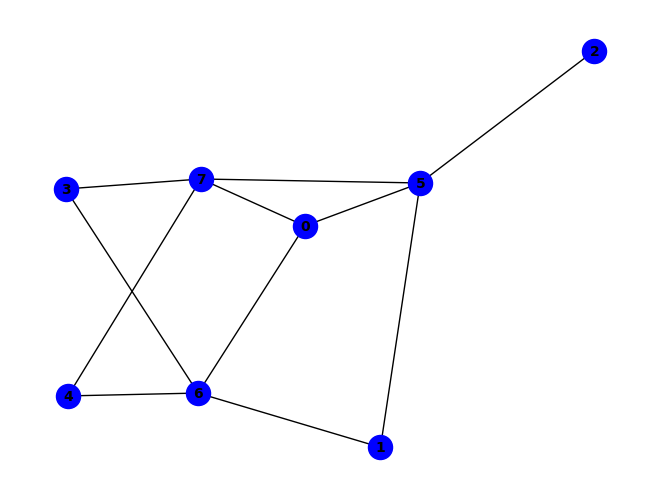


(~c & ~f) ^ (a & f & ~g) ^ (a & h & ~e) ^ (e & g & ~h) ^ (e & h & ~f) ^ (a & f & g & h) ^ (f & ~b & ~h) ^ (a & d & g & ~e) ^ (b & d & g & ~e) ^ (b & e & g & ~a) ^ (a & b & d & e & g) ^ (b & e & f & g & h) ^ (a & c & ~e & ~f) ^ (a & g & ~e & ~h) ^ (b & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (d & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (a & b & d & g & ~f) ^ (a & d & f & h & ~e) ^ (a & e & f & h & ~b) ^ (c & ~a & ~e & ~h) ^ (a & b & f & ~d & ~h) ^ (a & d & h & ~e & ~g) ^ (b & c & f & ~a & ~h) ^ (a & b & c & e & g & ~f) ^ (a & b & e & f & h & ~g) ^ (b & c & e & f & g & ~h) ^ (b & d & f & g & h & ~e) ^ (a & b & d & e & f & g & h) ^ (c & e & ~d & ~f & ~h) ^ (a & b & d & f & ~g & ~h) ^ (a & c & e & h & ~b & ~f) ^ (c & d & e & g & ~b & ~h) ^ (c & d & f & g & ~b & ~h) ^ (a & b & c & d & f & g & ~h) ^ (c & d & e & ~f & ~g & ~h) ^ (c & e & f & ~a & ~g & ~h) ^ (a & b & c & e & g & ~d & ~h) ^ (a & b & c & e & h & ~f & ~g) ^ (a & c & d & f & g & ~e & ~h) ^ (b & c & d & e & g & ~a & ~f & ~h)
PASS
PASS
PASS


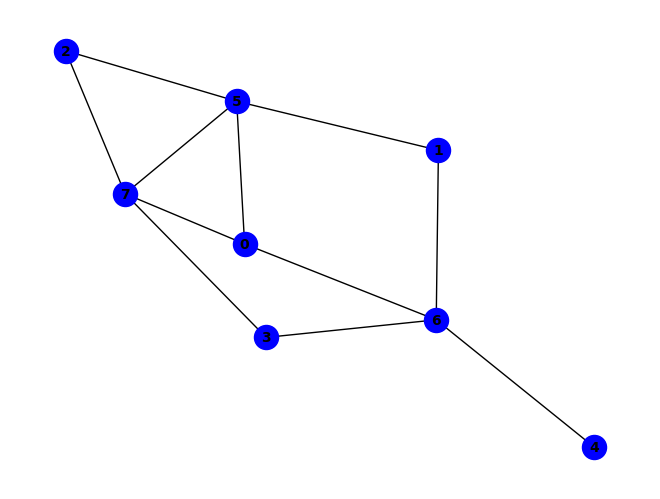


(~b & ~f) ^ (a & f & ~e) ^ (a & h & ~g) ^ (a & f & g & h) ^ (f & ~b & ~h) ^ (b & e & g & ~a) ^ (a & d & e & f & g) ^ (b & c & e & f & g) ^ (a & g & ~b & ~f) ^ (c & f & ~a & ~e) ^ (c & h & ~a & ~e) ^ (d & g & ~a & ~h) ^ (e & g & ~a & ~d) ^ (a & c & e & h & ~g) ^ (a & e & f & h & ~g) ^ (b & c & e & h & ~d) ^ (a & b & c & d & e & h) ^ (a & b & c & e & g & h) ^ (b & ~c & ~f & ~g) ^ (a & b & f & ~e & ~h) ^ (a & e & f & ~d & ~h) ^ (b & c & f & ~a & ~h) ^ (b & c & h & ~a & ~f) ^ (b & d & g & ~a & ~e) ^ (c & e & h & ~b & ~g) ^ (a & b & e & f & g & ~c) ^ (b & c & d & f & g & ~a) ^ (b & c & d & g & h & ~a) ^ (b & d & f & g & h & ~a) ^ (c & d & e & g & h & ~a) ^ (a & b & d & e & f & g & h) ^ (b & c & ~f & ~g & ~h) ^ (d & h & ~a & ~c & ~f) ^ (a & b & c & h & ~f & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & d & e & f & ~g & ~h) ^ (c & d & e & f & ~a & ~b) ^ (c & d & f & g & ~a & ~h) ^ (e & f & g & h & ~b & ~d) ^ (c & e & f & ~a & ~d & ~g) ^ (b & c & d & e & f & ~a & ~g) ^ (b & c & d & e & h & ~a & ~g)


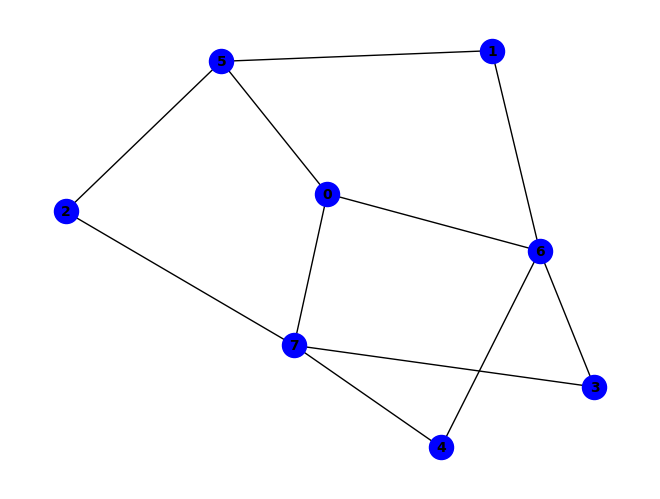


~d ^ (e & h & ~d) ^ (d & ~g & ~h) ^ (a & d & g & ~e) ^ (b & d & e & f & h) ^ (a & f & ~g & ~h) ^ (a & g & ~e & ~h) ^ (a & h & ~c & ~e) ^ (b & f & ~a & ~g) ^ (c & h & ~d & ~e) ^ (e & g & ~d & ~h) ^ (a & c & d & h & ~e) ^ (b & d & f & g & ~c) ^ (b & c & d & e & f & g) ^ (a & d & h & ~e & ~g) ^ (b & d & g & ~f & ~h) ^ (b & d & h & ~c & ~f) ^ (b & d & h & ~c & ~g) ^ (b & g & ~a & ~c & ~e) ^ (c & f & ~a & ~b & ~h) ^ (b & c & f & h & ~a & ~g) ^ (c & d & f & g & ~a & ~h) ^ (b & c & d & e & f & h & ~g) ^ (b & c & g & ~a & ~e & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & d & f & h & ~c & ~e) ^ (a & b & d & g & h & ~c & ~f) ^ (b & c & d & e & g & ~a & ~h) ^ (b & c & e & f & g & ~a & ~h) ^ (b & d & e & f & g & ~c & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & b & d & g & ~c & ~e & ~h) ^ (b & d & e & g & ~a & ~c & ~f) ^ (b & e & f & h & ~a & ~c & ~g) ^ (c & e & f & g & ~a & ~d & ~h) ^ (a & b & d & e & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

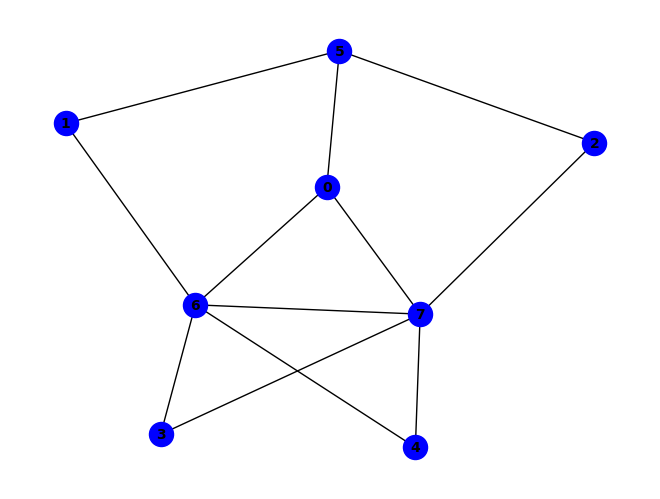


(~c & ~g) ^ (a & c & ~g) ^ (a & f & ~h) ^ (e & h & ~c) ^ (a & f & g & h) ^ (a & c & g & ~h) ^ (a & b & ~c & ~g) ^ (a & b & ~e & ~f) ^ (a & g & ~b & ~f) ^ (a & h & ~d & ~e) ^ (b & f & ~c & ~g) ^ (d & h & ~c & ~e) ^ (e & g & ~a & ~c) ^ (a & b & e & h & ~d) ^ (a & c & d & h & ~e) ^ (a & c & e & g & ~f) ^ (b & e & f & g & ~c) ^ (c & ~e & ~f & ~h) ^ (g & ~b & ~c & ~h) ^ (a & b & c & ~f & ~g) ^ (a & b & g & ~c & ~h) ^ (a & b & d & e & h & ~f) ^ (a & b & d & f & g & ~c) ^ (a & c & e & f & h & ~b) ^ (a & b & c & d & e & f & h) ^ (a & c & ~d & ~f & ~h) ^ (c & e & ~f & ~g & ~h) ^ (d & g & ~a & ~c & ~e) ^ (a & c & e & h & ~f & ~g) ^ (b & d & f & g & ~c & ~e) ^ (b & d & f & h & ~a & ~c) ^ (b & e & f & h & ~c & ~d) ^ (a & b & e & ~f & ~g & ~h) ^ (a & c & d & ~f & ~g & ~h) ^ (b & c & g & ~a & ~f & ~h) ^ (b & d & g & ~a & ~f & ~h) ^ (b & e & g & ~d & ~f & ~h) ^ (c & d & g & ~e & ~f & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & b & e & f & g & ~c & ~d) ^ (a & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PA

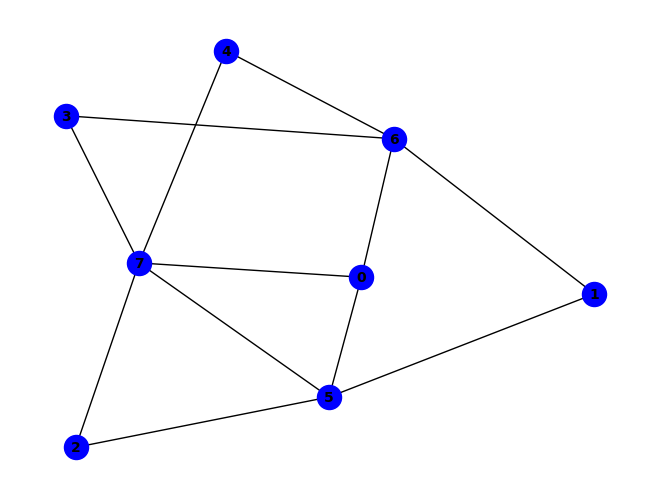


(~b & ~f) ^ (a & h & ~g) ^ (c & h & ~b) ^ (a & f & g & h) ^ (f & ~b & ~h) ^ (a & c & h & ~e) ^ (a & e & f & ~h) ^ (a & e & h & ~d) ^ (b & d & g & ~a) ^ (b & e & g & ~d) ^ (a & b & d & e & g) ^ (b & e & f & g & h) ^ (c & d & e & f & g) ^ (a & f & ~c & ~e) ^ (a & g & ~b & ~f) ^ (c & f & ~b & ~e) ^ (e & g & ~a & ~h) ^ (e & h & ~c & ~f) ^ (a & b & c & f & ~h) ^ (a & b & e & g & ~f) ^ (c & e & f & h & ~d) ^ (a & b & c & e & f & g) ^ (a & b & d & f & g & h) ^ (b & ~c & ~f & ~g) ^ (a & b & f & ~e & ~h) ^ (a & d & h & ~c & ~f) ^ (a & b & c & g & h & ~f) ^ (a & c & d & e & h & ~f) ^ (a & d & e & f & h & ~b) ^ (b & c & d & e & f & ~a) ^ (b & c & d & f & g & ~a) ^ (b & c & d & g & h & ~a) ^ (b & d & f & g & h & ~e) ^ (c & d & e & f & h & ~g) ^ (b & c & ~f & ~g & ~h) ^ (d & g & ~a & ~e & ~h) ^ (d & h & ~c & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (b & c & e & f & ~d & ~g) ^ (c & d & f & g & ~a & ~h) ^ (a & b & c & d & e & f & ~g) ^ (a & b & d & e & f & h & ~g) ^ (a & c & d & e & f & g & ~h) ^ (c &

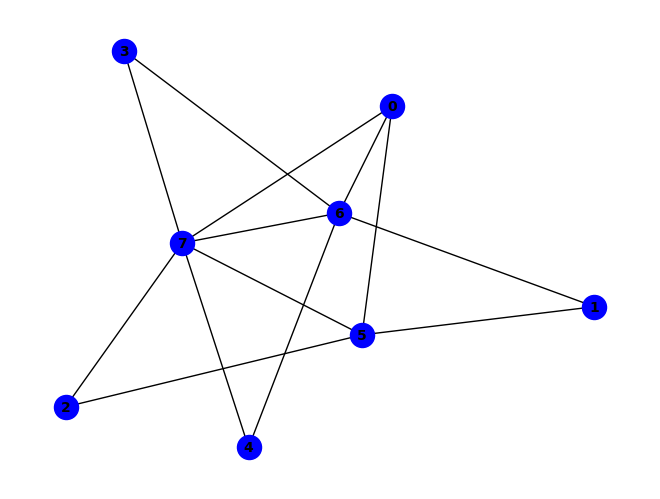


(g & ~h) ^ (~b & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (b & h & ~g) ^ (f & h & ~g) ^ (b & f & g & ~h) ^ (e & f & g & ~h) ^ (b & c & ~e & ~h) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & b & c & f & ~h) ^ (a & e & f & h & ~g) ^ (b & ~c & ~f & ~h) ^ (a & b & f & ~g & ~h) ^ (a & b & g & ~d & ~h) ^ (b & d & g & ~e & ~h) ^ (b & e & g & ~a & ~h) ^ (b & c & d & e & f & ~h) ^ (c & f & ~a & ~e & ~h) ^ (c & h & ~d & ~f & ~g) ^ (d & g & ~a & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (c & d & e & h & ~f & ~g) ^ (a & b & c & e & f & g & ~h) ^ (b & c & e & ~d & ~g & ~h) ^ (c & e & f & ~a & ~g & ~h) ^ (c & e & g & ~b & ~f & ~h) ^ (a & b & d & e & g & ~c & ~h) ^ (b & c & d & f & g & ~a & ~h) ^ (b & c & d & e & ~f & ~g & ~h) ^ (a & b & c & d & e & g & ~f & ~h) ^ (a & c & h & ~d & ~e & ~f & ~g) ^ (d & f & g & ~a & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

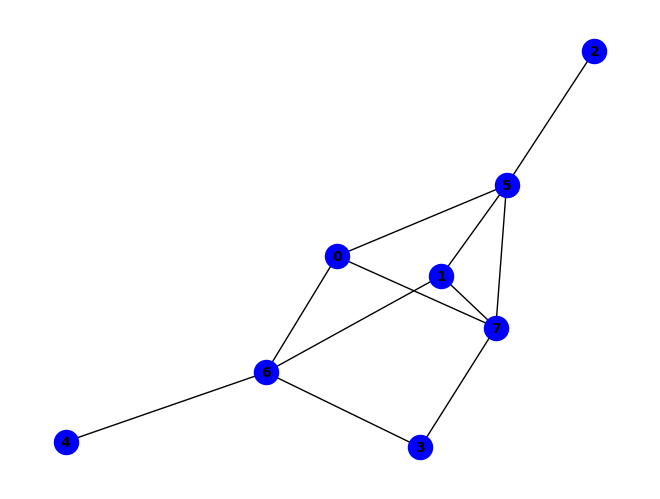


(f & ~h) ^ (~c & ~f) ^ (a & g & ~e) ^ (a & h & ~g) ^ (c & h & ~f) ^ (a & d & e & g) ^ (a & f & g & h) ^ (c & ~e & ~h) ^ (b & c & f & ~h) ^ (b & f & ~e & ~g) ^ (b & h & ~a & ~d) ^ (d & h & ~a & ~f) ^ (e & g & ~b & ~d) ^ (a & b & e & g & ~d) ^ (a & e & f & h & ~d) ^ (b & e & f & h & ~a) ^ (b & f & g & h & ~a) ^ (e & f & g & h & ~d) ^ (a & c & f & ~b & ~h) ^ (b & e & f & ~g & ~h) ^ (c & e & f & ~g & ~h) ^ (b & d & e & f & h & ~g) ^ (a & f & ~b & ~e & ~g) ^ (b & g & ~a & ~d & ~h) ^ (c & e & ~d & ~f & ~h) ^ (d & g & ~a & ~c & ~h) ^ (b & d & f & h & ~a & ~e) ^ (c & d & e & g & ~b & ~h) ^ (a & e & f & ~b & ~g & ~h) ^ (c & d & e & ~f & ~g & ~h) ^ (c & d & g & ~a & ~f & ~h) ^ (a & c & e & f & g & ~d & ~h) ^ (a & d & e & f & h & ~b & ~g) ^ (b & c & d & e & g & ~f & ~h) ^ (b & c & d & f & g & ~a & ~h) ^ (b & c & e & f & g & ~a & ~h) ^ (a & b & c & d & e & f & g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


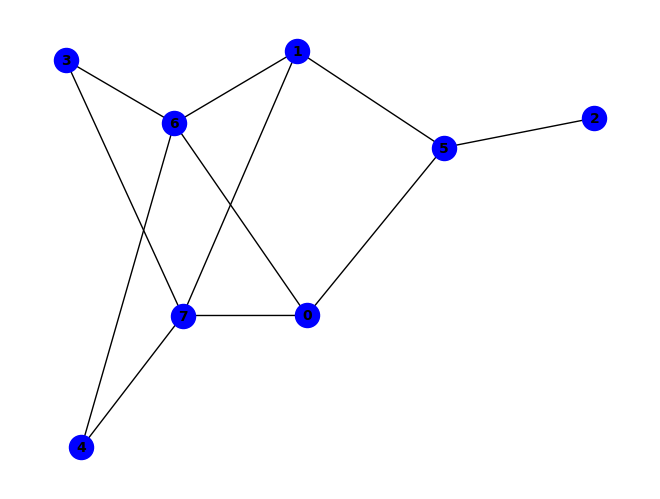


~d ^ (a & f & ~g) ^ (a & h & ~f) ^ (b & g & ~f) ^ (b & h & ~g) ^ (e & h & ~d) ^ (a & f & g & h) ^ (b & f & g & h) ^ (d & ~g & ~h) ^ (a & b & h & ~d) ^ (a & d & h & ~e) ^ (a & e & g & ~d) ^ (a & e & h & ~g) ^ (b & d & h & ~e) ^ (b & e & h & ~a) ^ (a & d & e & g & h) ^ (b & c & d & f & g) ^ (c & d & e & f & g) ^ (a & g & ~d & ~h) ^ (b & f & ~a & ~h) ^ (e & g & ~d & ~h) ^ (c & d & f & h & ~a) ^ (a & b & c & d & f & h) ^ (a & c & d & e & f & h) ^ (b & c & d & e & f & h) ^ (a & b & g & ~f & ~h) ^ (b & e & g & ~a & ~h) ^ (a & b & d & e & h & ~c) ^ (b & c & d & f & h & ~g) ^ (c & d & e & f & h & ~g) ^ (c & f & ~a & ~b & ~e) ^ (c & d & f & g & ~a & ~h) ^ (a & b & c & d & e & g & ~f) ^ (a & b & c & d & e & g & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & c & d & e & f & g & ~h) ^ (b & c & d & e & f & g & ~h) ^ (b & d & g & ~a & ~e & ~h) ^ (a & b & c & d & e & h & ~f & ~g) ^ (c & e & f & ~a & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

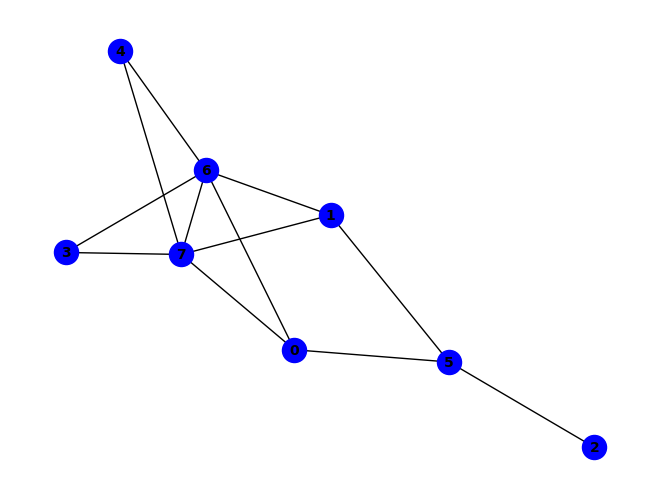


(~c & ~g) ^ (a & f & ~b) ^ (a & g & ~f) ^ (b & f & ~h) ^ (b & h & ~e) ^ (e & h & ~c) ^ (a & f & g & h) ^ (g & ~c & ~h) ^ (a & c & f & ~g) ^ (a & d & g & ~c) ^ (a & e & g & ~d) ^ (b & c & e & f & h) ^ (a & h & ~b & ~f) ^ (b & c & ~a & ~g) ^ (b & g & ~a & ~f) ^ (c & g & ~f & ~h) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (e & g & ~b & ~c) ^ (a & b & d & g & ~e) ^ (a & b & e & g & ~c) ^ (a & c & d & g & ~f) ^ (b & c & f & g & ~h) ^ (b & f & g & h & ~a) ^ (c & d & f & h & ~b) ^ (c & ~b & ~f & ~g) ^ (a & b & c & ~f & ~g) ^ (a & d & h & ~b & ~c) ^ (a & e & h & ~b & ~d) ^ (c & e & g & ~b & ~f) ^ (c & e & h & ~d & ~f) ^ (a & b & c & e & g & ~f) ^ (a & c & e & f & g & ~d) ^ (a & c & e & f & h & ~b) ^ (b & c & d & e & h & ~f) ^ (a & c & f & g & ~b & ~h) ^ (c & d & e & h & ~a & ~b) ^ (c & d & f & g & ~b & ~e) ^ (a & b & c & d & f & g & ~e) ^ (a & c & d & h & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

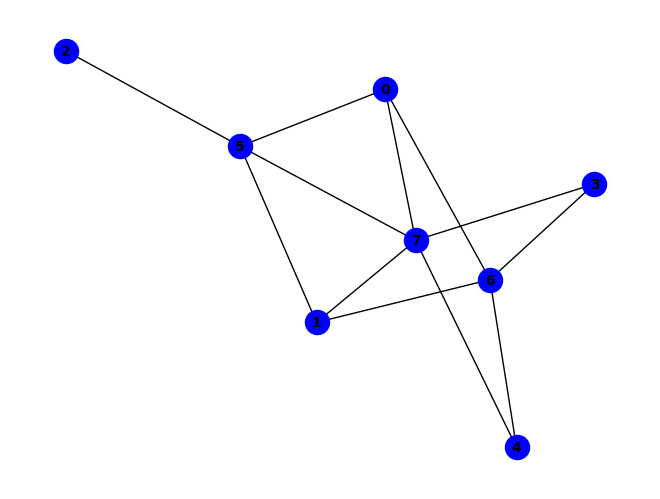


(f & ~h) ^ (~c & ~f) ^ (a & h & ~e) ^ (b & f & ~g) ^ (c & h & ~f) ^ (e & g & ~h) ^ (e & h & ~f) ^ (a & f & g & h) ^ (b & d & f & h) ^ (c & ~e & ~h) ^ (b & c & f & ~h) ^ (b & d & g & ~e) ^ (a & f & ~b & ~g) ^ (a & g & ~e & ~h) ^ (b & h & ~a & ~e) ^ (a & e & f & h & ~b) ^ (b & e & f & h & ~d) ^ (b & f & g & h & ~a) ^ (a & c & f & ~b & ~h) ^ (b & d & h & ~e & ~g) ^ (c & e & f & ~g & ~h) ^ (a & c & e & f & g & ~h) ^ (b & g & ~a & ~e & ~h) ^ (c & e & ~d & ~f & ~h) ^ (d & g & ~a & ~e & ~h) ^ (d & h & ~a & ~e & ~f) ^ (a & b & d & g & ~e & ~h) ^ (a & b & d & h & ~e & ~f) ^ (c & d & e & g & ~b & ~h) ^ (c & d & f & g & ~b & ~h) ^ (c & d & e & ~f & ~g & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (b & c & e & f & g & ~a & ~h) ^ (a & c & d & f & g & ~b & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


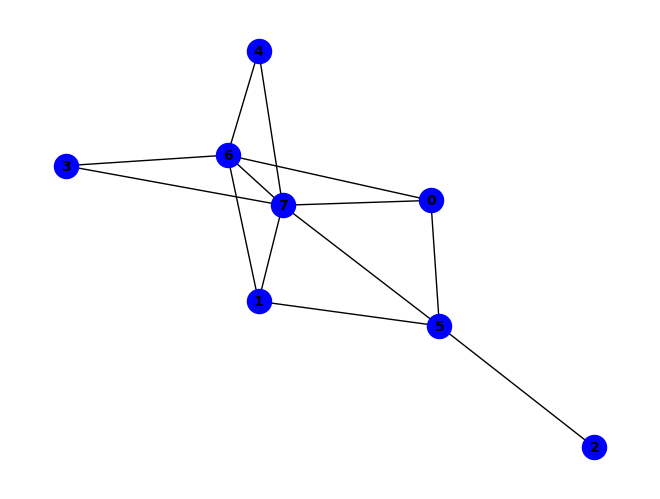


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & h & ~g) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (b & e & f & h & ~g) ^ (e & f & g & ~c & ~h) ^ (c & f & ~a & ~b & ~h) ^ (a & e & f & h & ~b & ~g) ^ (a & c & e & f & g & ~b & ~h) ^ (b & c & d & f & g & ~a & ~h) ^ (b & c & e & f & g & ~d & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (d & g & ~a & ~b & ~e & ~f) ^ (d & h & ~a & ~b & ~e & ~f) ^ (b & d & f & g & ~a & ~e & ~h) ^ (d & f & g & ~a & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


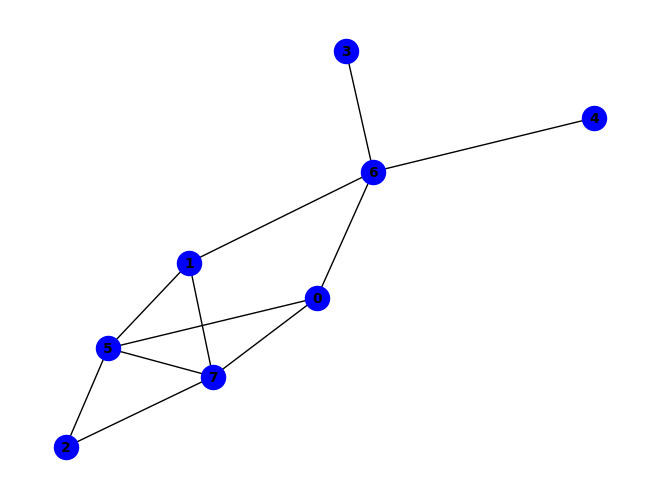


~f ^ (f & ~h) ^ (a & g & ~h) ^ (b & h & ~c) ^ (c & h & ~e) ^ (e & f & g & h) ^ (a & h & ~b & ~c) ^ (b & f & ~e & ~g) ^ (b & g & ~a & ~h) ^ (e & g & ~a & ~b) ^ (a & f & g & h & ~d) ^ (b & e & f & h & ~d) ^ (c & d & e & h & ~b) ^ (d & f & g & h & ~e) ^ (c & e & h & ~d & ~g) ^ (a & c & e & g & h & ~d) ^ (a & d & e & f & h & ~g) ^ (b & c & d & e & h & ~g) ^ (b & c & e & g & h & ~a) ^ (a & b & c & d & e & g & h) ^ (a & f & ~b & ~e & ~g) ^ (c & f & ~a & ~b & ~e) ^ (d & g & ~a & ~b & ~e) ^ (a & e & f & h & ~b & ~d) ^ (b & d & e & f & ~a & ~g) ^ (b & f & g & h & ~a & ~d) ^ (c & d & g & h & ~a & ~b) ^ (a & e & f & ~b & ~g & ~h) ^ (b & e & f & ~d & ~g & ~h) ^ (c & e & f & ~a & ~b & ~g) ^ (a & b & d & e & f & ~g & ~h) ^ (c & d & f & g & ~a & ~b & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


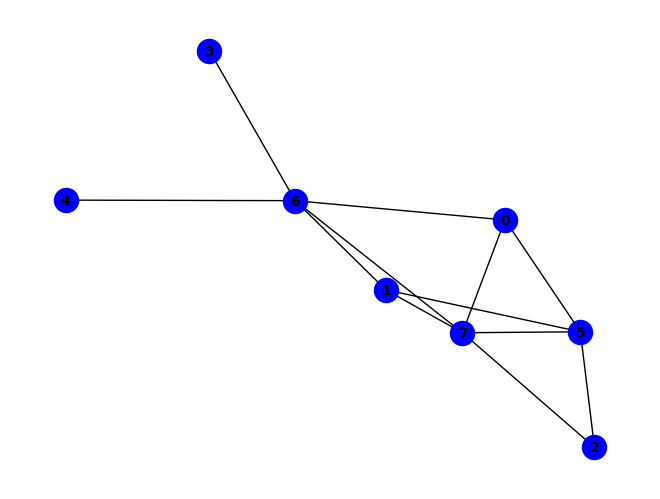


(a & h) ^ (b & g) ^ (~e & ~g) ^ (a & g & ~b) ^ (b & f & ~g) ^ (b & h & ~a) ^ (e & h & ~g) ^ (f & h & ~g) ^ (e & ~d & ~h) ^ (g & ~d & ~h) ^ (a & f & ~b & ~g) ^ (d & e & ~g & ~h) ^ (a & d & g & ~c & ~h) ^ (a & e & g & ~d & ~h) ^ (c & f & ~a & ~b & ~h) ^ (a & c & d & g & ~f & ~h) ^ (c & e & f & g & ~a & ~h) ^ (a & b & c & d & f & g & ~h) ^ (b & d & g & ~a & ~e & ~h) ^ (b & e & g & ~a & ~c & ~h) ^ (c & h & ~a & ~b & ~f & ~g) ^ (b & c & e & g & ~a & ~f & ~h) ^ (c & d & f & g & ~b & ~e & ~h) ^ (a & c & d & e & f & g & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


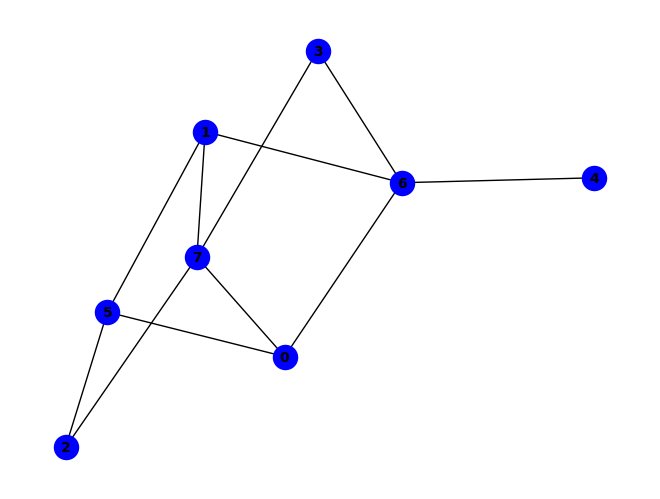


(e & ~g) ^ (~c & ~e) ^ (d & g & ~h) ^ (a & b & f & ~h) ^ (a & h & ~c & ~d) ^ (b & h & ~a & ~c) ^ (d & h & ~b & ~c) ^ (a & b & d & g & ~h) ^ (a & b & d & h & ~c) ^ (c & d & f & g & ~h) ^ (c & ~e & ~f & ~h) ^ (a & e & g & ~b & ~c) ^ (b & e & g & ~c & ~d) ^ (c & d & e & ~f & ~g) ^ (c & d & e & ~f & ~h) ^ (c & e & f & ~g & ~h) ^ (c & e & h & ~d & ~g) ^ (d & e & g & ~a & ~c) ^ (a & b & d & e & g & ~c) ^ (c & d & e & f & h & ~g) ^ (a & f & ~c & ~g & ~h) ^ (a & g & ~c & ~d & ~h) ^ (b & f & ~c & ~g & ~h) ^ (b & g & ~c & ~d & ~h) ^ (a & b & c & f & ~g & ~h) ^ (a & b & c & g & ~e & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & b & c & e & f & g & ~h) ^ (a & b & g & ~c & ~f & ~h) ^ (a & b & c & d & e & g & ~f & ~h) ^ (a & c & g & ~d & ~e & ~f & ~h) ^ (b & c & g & ~d & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

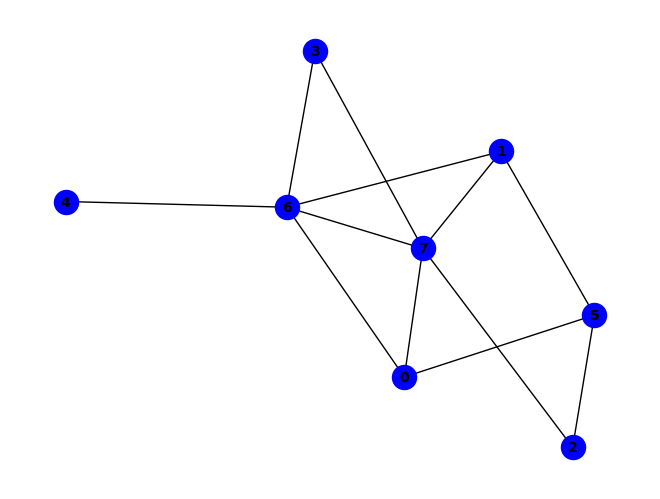


(a & f & ~g) ^ (a & g & ~d) ^ (a & h & ~f) ^ (b & f & ~g) ^ (b & g & ~d) ^ (b & h & ~f) ^ (d & g & ~c) ^ (a & c & d & g) ^ (b & d & e & g) ^ (b & f & g & h) ^ (e & ~d & ~h) ^ (g & ~c & ~h) ^ (a & b & f & ~h) ^ (a & b & g & ~f) ^ (a & b & h & ~d) ^ (b & c & g & ~h) ^ (b & d & h & ~e) ^ (b & c & d & f & g) ^ (b & c & d & f & h) ^ (~c & ~e & ~g) ^ (b & c & ~e & ~g) ^ (d & e & ~g & ~h) ^ (d & h & ~a & ~c) ^ (e & h & ~c & ~g) ^ (a & b & d & g & ~c) ^ (a & f & g & h & ~b) ^ (b & d & e & h & ~g) ^ (a & b & c & d & e & g) ^ (a & c & g & ~b & ~h) ^ (a & e & g & ~d & ~h) ^ (b & e & g & ~a & ~h) ^ (a & b & c & d & h & ~e) ^ (a & b & d & e & g & ~h) ^ (b & c & e & f & h & ~g) ^ (a & c & ~b & ~e & ~g) ^ (b & c & ~a & ~f & ~h) ^ (a & c & e & h & ~b & ~g) ^ (c & d & e & g & ~b & ~h) ^ (a & b & c & d & e & h & ~g) ^ (a & c & d & e & f & g & ~h) ^ (c & ~a & ~d & ~f & ~h) ^ (b & c & e & ~d & ~f & ~g) ^ (c & d & e & ~b & ~f & ~h) ^ (c & e & f & ~a & ~b & ~h) ^ (c & d & ~a & ~f & ~g & ~h) ^ (c & e & ~d &

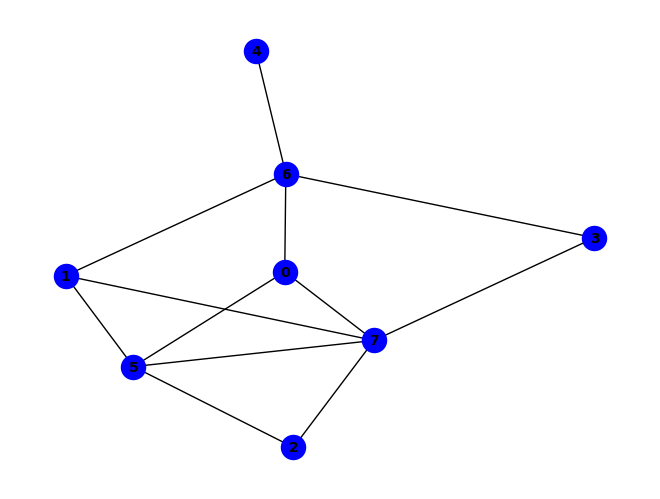


~f ^ (f & ~h) ^ (a & g & ~e) ^ (b & g & ~h) ^ (b & h & ~d) ^ (a & b & e & g) ^ (a & f & g & h) ^ (b & d & f & h) ^ (a & b & g & ~f) ^ (a & c & f & ~e) ^ (b & c & d & f & g) ^ (c & d & e & g & h) ^ (a & f & ~e & ~g) ^ (a & h & ~b & ~g) ^ (b & f & ~e & ~g) ^ (c & f & ~b & ~e) ^ (e & g & ~b & ~d) ^ (a & b & e & f & ~h) ^ (a & d & e & g & ~b) ^ (a & e & f & h & ~d) ^ (b & c & d & h & ~e) ^ (b & e & f & h & ~d) ^ (b & f & g & h & ~a) ^ (c & d & e & f & ~b) ^ (e & f & g & h & ~d) ^ (a & b & d & e & f & h) ^ (a & b & f & ~c & ~e) ^ (a & e & f & ~g & ~h) ^ (c & e & h & ~b & ~g) ^ (a & b & e & f & h & ~g) ^ (a & c & d & e & h & ~b) ^ (a & d & e & f & h & ~g) ^ (b & c & d & e & h & ~g) ^ (b & c & d & f & h & ~g) ^ (c & h & ~a & ~b & ~e) ^ (d & g & ~a & ~b & ~h) ^ (d & h & ~a & ~c & ~f) ^ (a & b & d & h & ~c & ~f) ^ (a & c & e & f & ~b & ~g) ^ (b & d & e & f & ~a & ~g) ^ (c & d & f & g & ~a & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & c & d & e & f & g & ~b) ^ (b & e & f & ~d & ~g & ~h) ^ (c & e 

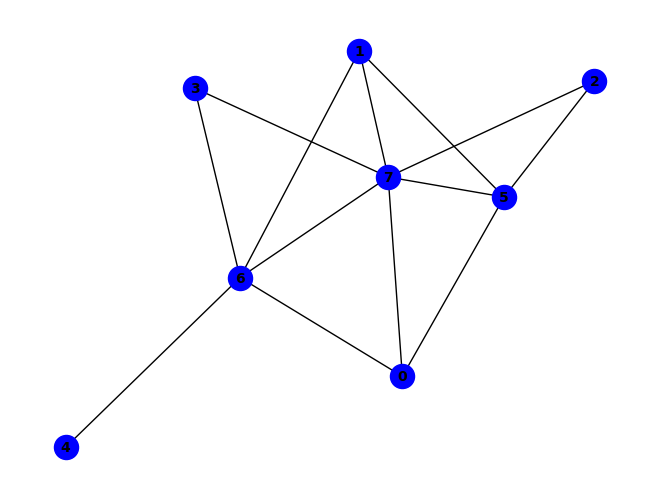


(g & ~h) ^ (~e & ~g) ^ (a & f & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (e & h & ~g) ^ (f & h & ~g) ^ (e & ~d & ~h) ^ (d & f & g & ~h) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~d) ^ (b & h & ~a & ~d) ^ (d & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & d & f & h & ~g) ^ (a & e & g & ~d & ~h) ^ (c & d & g & ~f & ~h) ^ (c & h & ~b & ~f & ~g) ^ (b & c & d & h & ~f & ~g) ^ (b & d & f & h & ~a & ~g) ^ (b & e & g & ~a & ~d & ~h) ^ (c & f & ~a & ~b & ~d & ~h) ^ (a & c & h & ~b & ~d & ~f & ~g) ^ (c & d & f & ~a & ~b & ~g & ~h) ^ (c & e & f & g & ~a & ~b & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


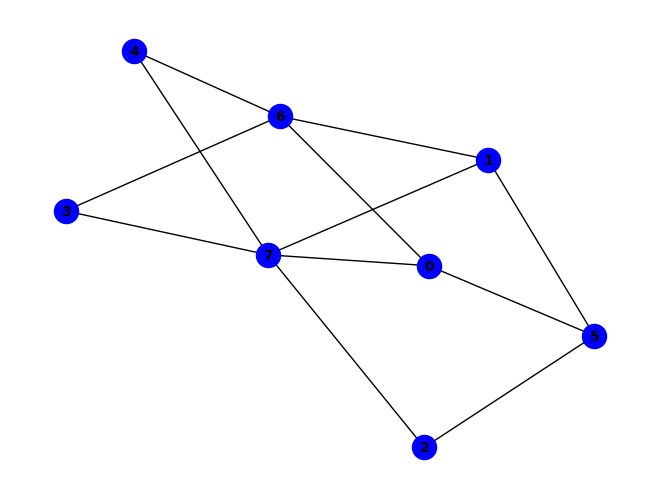


~d ^ (b & f & ~g) ^ (b & h & ~f) ^ (e & h & ~d) ^ (d & ~g & ~h) ^ (a & b & g & ~f) ^ (a & b & h & ~g) ^ (a & c & f & ~h) ^ (b & e & h & ~a) ^ (a & f & ~g & ~h) ^ (a & h & ~d & ~e) ^ (c & f & ~b & ~h) ^ (e & g & ~d & ~h) ^ (b & f & g & h & ~a) ^ (a & b & f & ~c & ~h) ^ (a & c & h & ~b & ~e) ^ (b & d & h & ~a & ~e) ^ (a & c & e & f & g & ~h) ^ (a & g & ~d & ~e & ~h) ^ (b & g & ~d & ~e & ~h) ^ (c & h & ~b & ~d & ~e) ^ (a & b & d & g & ~e & ~h) ^ (a & b & e & g & ~c & ~h) ^ (a & c & d & g & ~b & ~e) ^ (c & d & f & g & ~b & ~h) ^ (a & c & d & ~e & ~f & ~g) ^ (a & c & d & ~e & ~f & ~h) ^ (a & b & c & d & h & ~e & ~g) ^ (a & b & c & e & g & ~f & ~h) ^ (a & c & d & f & h & ~e & ~g) ^ (c & e & f & g & ~b & ~d & ~h) ^ (a & b & c & d & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


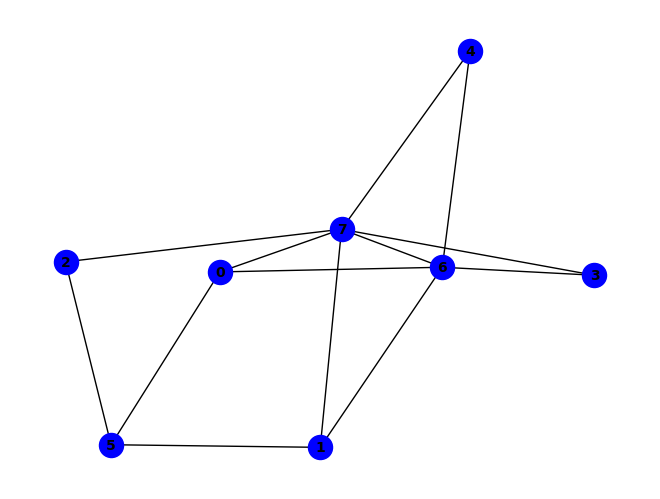


(~c & ~g) ^ (a & f & ~b) ^ (a & g & ~f) ^ (b & c & ~g) ^ (b & f & ~h) ^ (a & f & g & h) ^ (g & ~c & ~h) ^ (a & c & g & ~h) ^ (a & d & h & ~e) ^ (a & c & d & e & h) ^ (a & c & d & f & h) ^ (b & c & e & f & h) ^ (a & c & ~b & ~g) ^ (a & h & ~b & ~f) ^ (b & g & ~a & ~f) ^ (b & h & ~d & ~e) ^ (d & h & ~c & ~e) ^ (e & g & ~b & ~c) ^ (e & h & ~a & ~c) ^ (a & b & d & h & ~c) ^ (a & c & d & g & ~f) ^ (b & c & d & h & ~e) ^ (b & c & e & g & ~f) ^ (b & f & g & h & ~a) ^ (a & d & g & ~b & ~c) ^ (b & c & g & ~a & ~h) ^ (b & c & ~d & ~f & ~h) ^ (d & g & ~b & ~c & ~e) ^ (a & b & e & h & ~c & ~d) ^ (a & c & d & h & ~f & ~g) ^ (c & ~a & ~e & ~f & ~h) ^ (a & b & c & ~e & ~f & ~h) ^ (a & e & g & ~b & ~c & ~d) ^ (b & c & d & ~f & ~g & ~h) ^ (c & d & g & ~e & ~f & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (c & e & ~a & ~f & ~g & ~h) ^ (a & b & c & e & ~f & ~g & ~h) ^ (b & c & d & e & ~a & ~f & ~g) ^ (b & c & d & e & ~a & ~f & ~h) ^ (b & c & e & h & ~d & ~f & ~g) ^ (a & b & c &

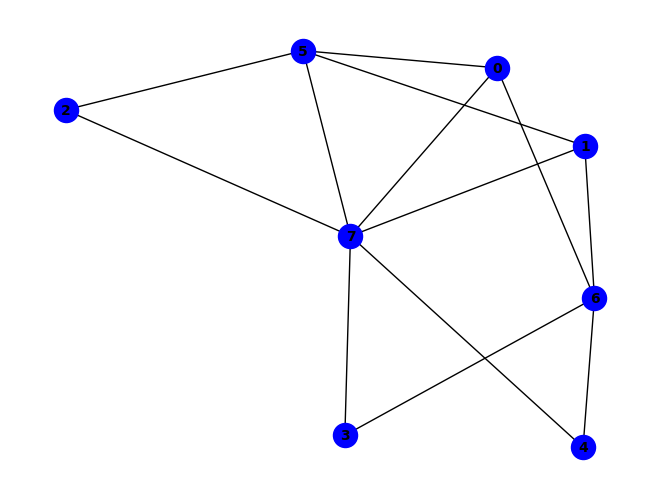


~f ^ (f & ~h) ^ (b & f & ~g) ^ (c & h & ~b) ^ (e & g & ~h) ^ (a & f & g & h) ^ (b & c & e & h) ^ (c & d & e & f & g) ^ (a & f & ~b & ~g) ^ (b & g & ~d & ~e) ^ (e & h & ~c & ~f) ^ (a & b & d & g & ~e) ^ (a & c & d & h & ~e) ^ (a & e & f & h & ~b) ^ (b & d & f & h & ~a) ^ (b & e & f & h & ~d) ^ (b & f & g & h & ~a) ^ (c & e & f & h & ~d) ^ (a & b & d & e & f & h) ^ (a & d & h & ~e & ~f) ^ (a & c & d & f & g & ~e) ^ (a & c & d & f & h & ~g) ^ (a & g & ~b & ~e & ~h) ^ (a & h & ~b & ~c & ~e) ^ (b & h & ~d & ~e & ~g) ^ (c & f & ~a & ~b & ~e) ^ (d & g & ~a & ~e & ~h) ^ (d & h & ~c & ~e & ~f) ^ (a & b & d & h & ~e & ~g) ^ (c & d & f & g & ~b & ~h) ^ (b & c & d & e & f & g & ~h) ^ (c & d & e & f & h & ~a & ~g) ^ (b & c & d & h & ~a & ~e & ~f) ^ (a & b & c & d & f & g & ~e & ~h) ^ (c & e & f & ~a & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


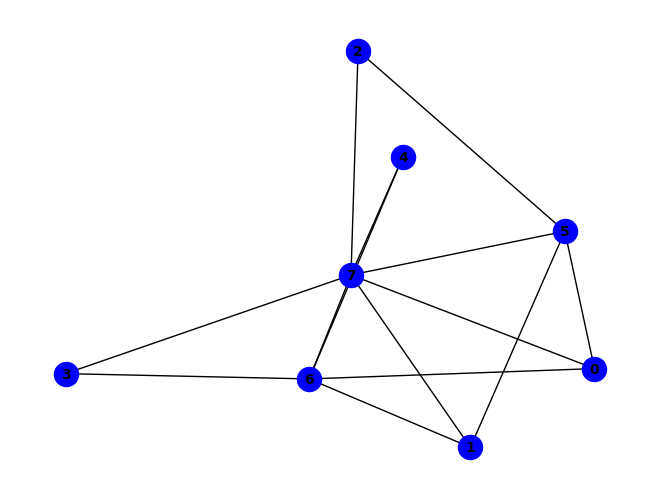


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (e & f & g & ~h) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & e & f & h & ~g) ^ (b & c & d & h & ~g) ^ (c & e & g & ~f & ~h) ^ (c & h & ~d & ~f & ~g) ^ (b & c & d & f & ~e & ~g) ^ (b & c & d & f & ~e & ~h) ^ (b & e & f & h & ~a & ~g) ^ (b & c & d & e & f & h & ~g) ^ (c & f & ~a & ~b & ~e & ~h) ^ (d & g & ~a & ~b & ~e & ~f) ^ (d & h & ~a & ~b & ~e & ~f) ^ (b & d & f & g & ~a & ~e & ~h) ^ (c & d & e & h & ~b & ~f & ~g) ^ (a & b & c & d & f & g & ~e & ~h) ^ (a & c & h & ~d & ~e & ~f & ~g) ^ (b & c & h & ~a & ~e & ~f & ~g) ^ (c & e & f & ~a & ~b & ~g & ~h) ^ (d & f & g & ~a & ~c & ~e & ~h) ^ (a & b & c & d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


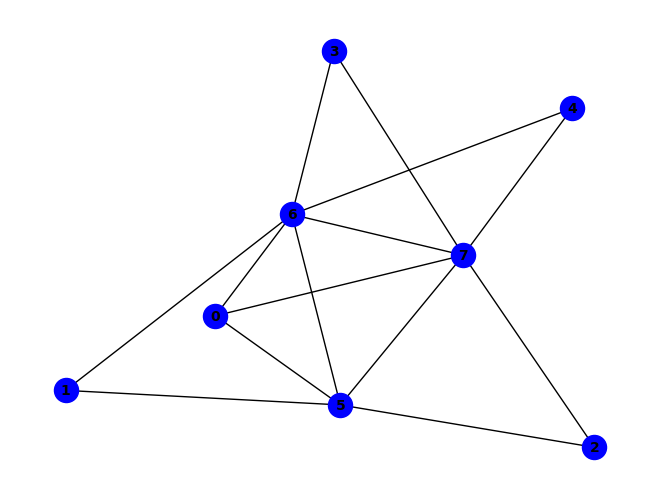


(f & g) ^ (f & h) ^ (~b & ~g) ^ (a & f & ~e) ^ (a & h & ~e) ^ (c & g & ~e) ^ (c & h & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (g & ~c & ~h) ^ (a & e & f & ~h) ^ (a & f & g & ~h) ^ (a & g & ~e & ~f) ^ (b & e & ~f & ~g) ^ (b & h & ~e & ~g) ^ (c & f & ~a & ~g) ^ (a & c & e & g & ~f) ^ (a & c & e & h & ~f) ^ (b & e & f & h & ~g) ^ (c & e & f & h & ~g) ^ (a & c & d & e & f & g) ^ (a & c & d & e & f & h) ^ (b & ~e & ~f & ~h) ^ (a & b & f & ~e & ~h) ^ (a & b & g & ~e & ~h) ^ (a & c & h & ~d & ~g) ^ (c & e & g & ~a & ~h) ^ (a & c & d & e & h & ~g) ^ (a & c & d & f & h & ~g) ^ (d & g & ~a & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (b & c & f & ~a & ~g & ~h) ^ (c & d & h & ~e & ~f & ~g) ^ (a & c & e & f & g & ~d & ~h) ^ (b & d & g & ~a & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


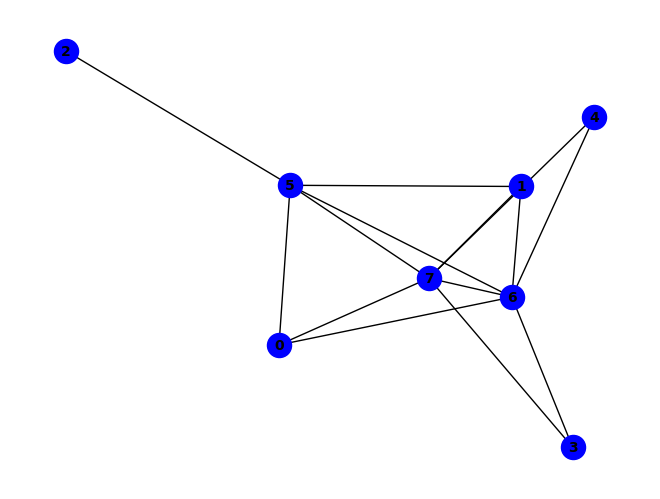


~g ^ (f & g) ^ (f & h) ^ (g & ~h) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (a & e & f & g) ^ (b & f & g & ~h) ^ (a & f & ~b & ~g) ^ (a & g & ~b & ~e) ^ (a & h & ~b & ~e) ^ (a & e & f & h & ~b) ^ (b & d & e & h & ~a) ^ (b & e & f & g & ~a) ^ (b & e & f & h & ~d) ^ (a & b & d & e & f & h) ^ (a & f & g & ~b & ~h) ^ (b & d & h & ~a & ~f) ^ (d & h & ~a & ~e & ~f) ^ (c & f & ~a & ~b & ~g & ~h) ^ (d & g & ~a & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


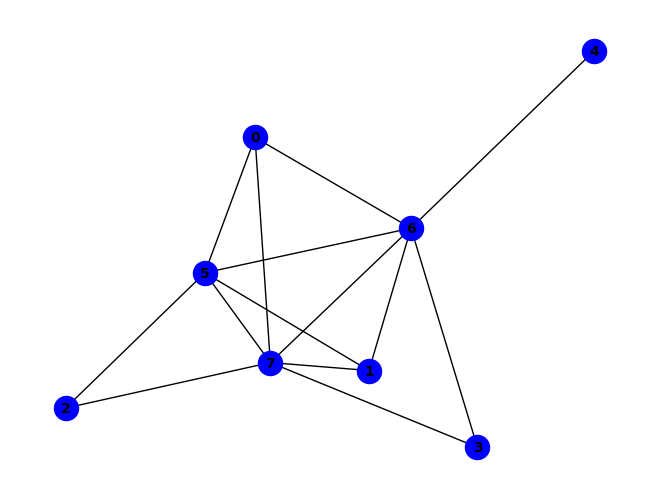


(f & g) ^ (f & h) ^ (g & ~h) ^ (~e & ~g) ^ (b & g & ~d) ^ (b & h & ~d) ^ (d & g & ~f) ^ (d & h & ~f) ^ (a & f & g & ~h) ^ (a & g & ~b & ~d) ^ (a & h & ~b & ~d) ^ (b & e & ~d & ~g) ^ (b & f & ~e & ~g) ^ (e & f & ~g & ~h) ^ (e & h & ~b & ~g) ^ (a & d & f & g & ~e) ^ (a & d & f & h & ~e) ^ (b & d & e & h & ~g) ^ (e & ~b & ~f & ~h) ^ (a & e & f & ~b & ~h) ^ (b & d & e & ~f & ~h) ^ (b & f & g & ~a & ~h) ^ (d & e & g & ~f & ~h) ^ (a & f & ~b & ~e & ~g) ^ (c & f & ~a & ~b & ~g) ^ (a & e & f & h & ~d & ~g) ^ (b & d & e & f & ~g & ~h) ^ (b & d & f & g & ~a & ~c) ^ (b & d & f & h & ~a & ~c) ^ (b & e & f & h & ~a & ~g) ^ (c & d & f & h & ~a & ~g) ^ (a & b & d & e & f & g & ~h) ^ (a & e & g & ~b & ~d & ~h) ^ (b & c & d & f & g & ~a & ~h) ^ (c & h & ~a & ~b & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


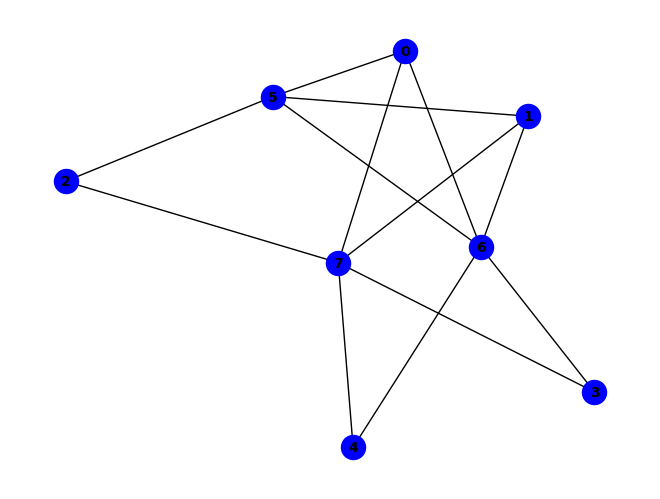


(~c & ~f) ^ (a & f & ~h) ^ (b & h & ~e) ^ (e & h & ~c) ^ (b & f & g & h) ^ (c & ~f & ~h) ^ (f & ~c & ~g) ^ (a & b & g & ~f) ^ (a & b & h & ~g) ^ (e & f & g & ~b) ^ (a & b & e & f & g) ^ (c & e & f & g & h) ^ (a & g & ~f & ~h) ^ (a & h & ~d & ~e) ^ (b & f & ~a & ~h) ^ (d & h & ~b & ~e) ^ (e & g & ~a & ~h) ^ (a & b & d & h & ~e) ^ (a & b & e & g & ~h) ^ (a & b & e & h & ~c) ^ (a & b & f & g & ~h) ^ (a & b & c & d & e & h) ^ (a & c & f & ~e & ~g) ^ (a & f & g & ~d & ~e) ^ (b & c & h & ~e & ~f) ^ (d & f & g & ~b & ~e) ^ (a & b & d & f & g & ~e) ^ (b & g & ~d & ~e & ~h) ^ (d & g & ~a & ~e & ~h) ^ (a & b & c & h & ~d & ~f) ^ (a & b & d & g & ~e & ~h) ^ (a & b & c & e & f & h & ~d) ^ (a & c & h & ~d & ~e & ~f) ^ (b & c & f & ~a & ~e & ~g) ^ (c & d & h & ~b & ~e & ~f) ^ (b & c & d & e & f & ~a & ~g) ^ (b & c & d & f & h & ~a & ~g) ^ (a & c & e & f & ~b & ~g & ~h) ^ (b & c & e & f & ~d & ~g & ~h) ^ (c & d & f & h & ~a & ~e & ~g) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS

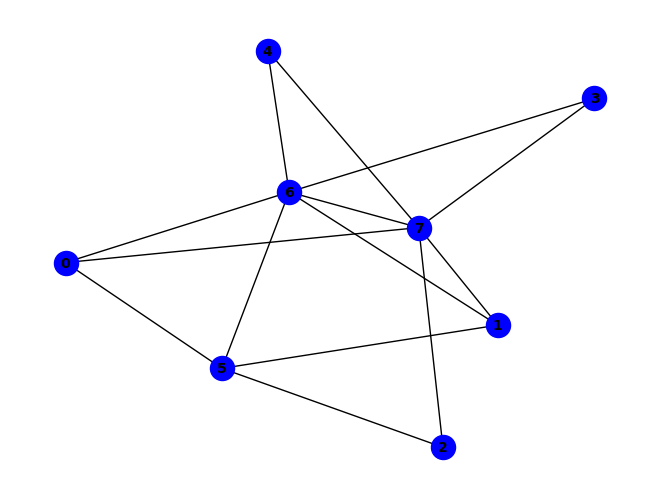


(g & ~h) ^ (~f & ~g) ^ (d & g & ~f) ^ (d & h & ~f) ^ (e & g & ~d) ^ (e & h & ~d) ^ (a & b & f & ~e) ^ (a & f & ~e & ~h) ^ (a & g & ~d & ~e) ^ (a & h & ~d & ~e) ^ (b & h & ~d & ~e) ^ (f & h & ~d & ~g) ^ (a & b & d & h & ~e) ^ (d & e & f & g & ~h) ^ (f & ~b & ~e & ~h) ^ (a & b & h & ~e & ~f) ^ (b & g & ~a & ~d & ~e) ^ (e & f & ~b & ~g & ~h) ^ (a & d & e & f & ~b & ~h) ^ (a & d & f & g & ~b & ~h) ^ (b & d & f & g & ~e & ~h) ^ (c & f & ~a & ~b & ~g & ~h) ^ (a & e & f & ~b & ~d & ~g & ~h) ^ (c & h & ~a & ~b & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


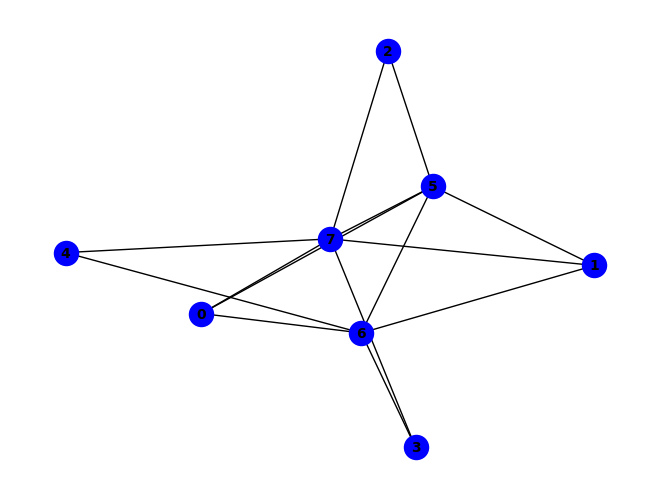


~e ^ (a & f & ~e) ^ (a & h & ~e) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & b & g & ~e) ^ (b & c & f & ~g) ^ (b & c & f & g & h) ^ (a & g & ~e & ~h) ^ (b & f & ~a & ~e) ^ (b & g & ~e & ~h) ^ (b & h & ~c & ~e) ^ (f & g & ~e & ~h) ^ (a & b & d & g & ~f) ^ (a & d & e & g & ~f) ^ (a & b & h & ~e & ~g) ^ (a & d & g & ~f & ~h) ^ (a & d & h & ~c & ~f) ^ (b & e & f & ~g & ~h) ^ (a & b & d & e & h & ~f) ^ (a & c & d & e & h & ~f) ^ (b & c & d & e & h & ~a) ^ (b & c & e & f & h & ~d) ^ (a & b & c & d & e & f & h) ^ (c & f & ~a & ~g & ~h) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & b & c & f & ~g & ~h) ^ (a & b & d & h & ~f & ~g) ^ (a & d & e & h & ~f & ~g) ^ (b & c & d & h & ~a & ~f) ^ (a & c & h & ~b & ~e & ~f) ^ (a & e & f & ~b & ~g & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (d & g & ~b & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

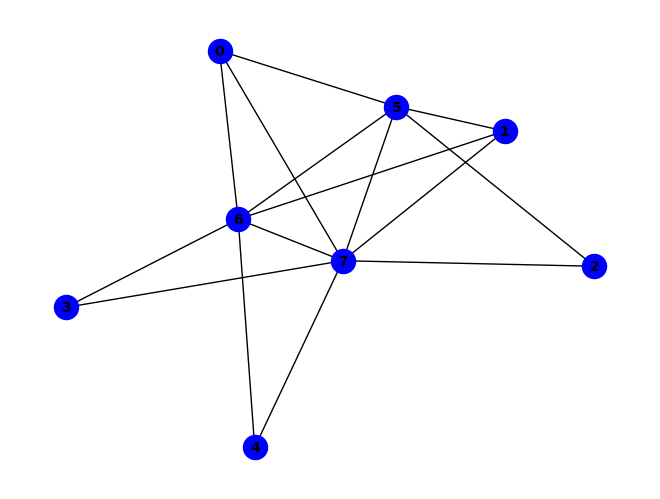


~g ^ (f & g) ^ (f & h) ^ (a & f & ~e) ^ (b & h & ~e) ^ (c & g & ~e) ^ (c & h & ~e) ^ (e & h & ~f) ^ (g & ~c & ~h) ^ (a & e & f & ~h) ^ (b & f & g & ~h) ^ (c & e & g & ~h) ^ (a & g & ~d & ~f) ^ (a & h & ~b & ~e) ^ (b & g & ~a & ~e) ^ (c & f & ~a & ~g) ^ (e & g & ~a & ~f) ^ (a & b & d & g & ~f) ^ (a & b & d & h & ~f) ^ (b & e & f & h & ~c) ^ (b & c & d & e & f & h) ^ (a & d & h & ~e & ~f) ^ (a & f & g & ~b & ~h) ^ (b & c & h & ~e & ~g) ^ (a & b & d & e & h & ~c) ^ (b & c & d & e & h & ~g) ^ (a & b & c & d & e & g & h) ^ (b & f & ~a & ~c & ~g) ^ (d & g & ~b & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & d & e & g & ~b & ~f) ^ (b & e & f & g & ~a & ~c) ^ (c & e & f & h & ~a & ~g) ^ (b & c & d & e & f & g & ~a) ^ (a & c & h & ~b & ~e & ~g) ^ (a & b & e & f & h & ~c & ~d) ^ (b & c & d & h & ~a & ~f & ~g) ^ (c & d & h & ~a & ~e & ~f & ~g) ^ (b & c & e & f & g & ~a & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

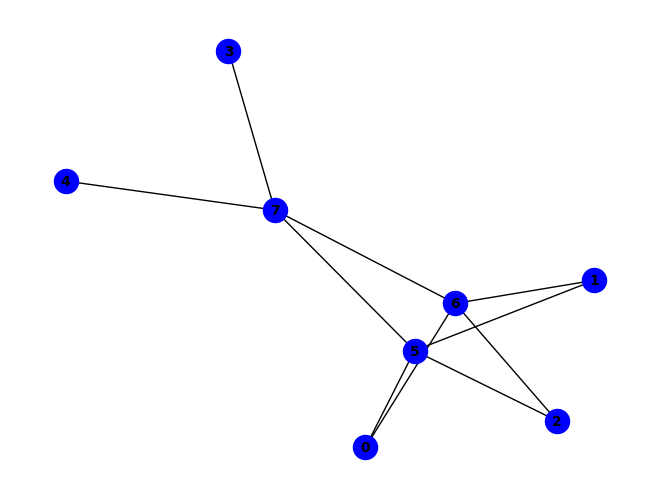


(~c & ~g) ^ (f & h & ~g) ^ (g & ~b & ~h) ^ (b & c & f & ~h) ^ (a & c & ~b & ~g) ^ (a & f & ~b & ~h) ^ (b & f & ~g & ~h) ^ (c & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & b & c & h & ~g) ^ (c & ~a & ~f & ~h) ^ (a & b & c & ~f & ~h) ^ (b & c & g & ~f & ~h) ^ (c & f & g & ~a & ~h) ^ (a & b & c & f & g & ~h) ^ (a & g & ~b & ~f & ~h) ^ (d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


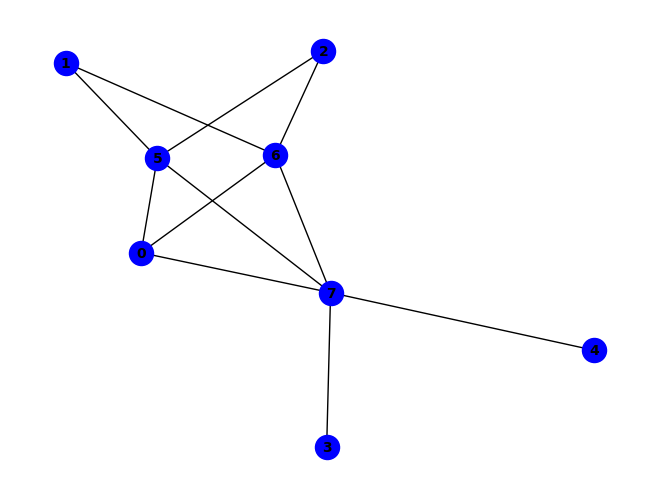


(~c & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (g & ~b & ~h) ^ (a & b & g & ~h) ^ (a & e & g & ~h) ^ (b & c & f & ~h) ^ (a & c & ~b & ~g) ^ (c & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & b & c & h & ~g) ^ (a & e & f & h & ~g) ^ (c & ~a & ~f & ~h) ^ (a & b & c & ~f & ~h) ^ (b & c & g & ~f & ~h) ^ (c & f & g & ~a & ~h) ^ (a & b & c & f & g & ~h) ^ (b & f & ~a & ~g & ~h) ^ (d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


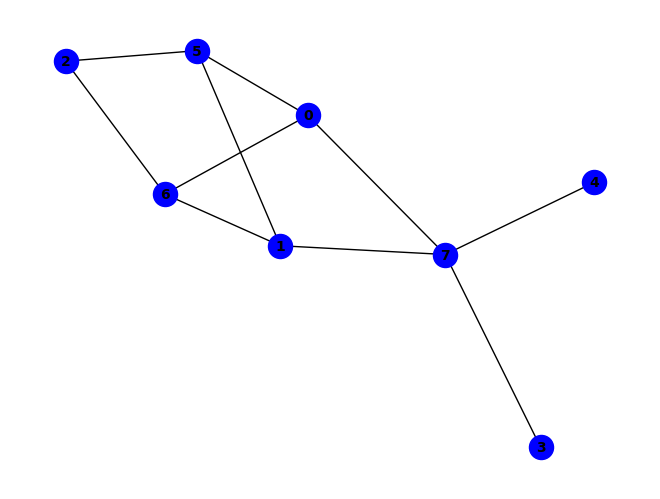


(a & d & h) ^ (~c & ~e) ^ (a & h & ~g) ^ (a & f & g & h) ^ (b & f & g & h) ^ (c & ~f & ~g) ^ (e & ~c & ~h) ^ (b & e & h & ~a) ^ (b & f & ~c & ~h) ^ (b & g & ~c & ~f) ^ (b & h & ~a & ~g) ^ (a & c & e & h & ~g) ^ (a & c & f & h & ~e) ^ (b & c & f & h & ~e) ^ (a & e & h & ~c & ~d) ^ (c & e & h & ~f & ~g) ^ (a & b & c & f & h & ~g) ^ (a & b & f & g & h & ~c) ^ (a & c & d & e & h & ~f) ^ (a & c & d & f & h & ~g) ^ (a & c & d & g & h & ~e) ^ (a & f & ~b & ~c & ~h) ^ (a & g & ~b & ~c & ~f) ^ (d & h & ~b & ~c & ~e) ^ (a & b & d & h & ~c & ~e) ^ (a & b & c & d & e & h & ~g) ^ (a & b & c & e & f & h & ~d) ^ (a & c & e & f & g & h & ~d) ^ (a & b & c & d & e & f & g & h) ^ (a & b & c & d & h & ~f & ~g) ^ (b & c & e & g & h & ~a & ~f) ^ (c & d & h & ~b & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

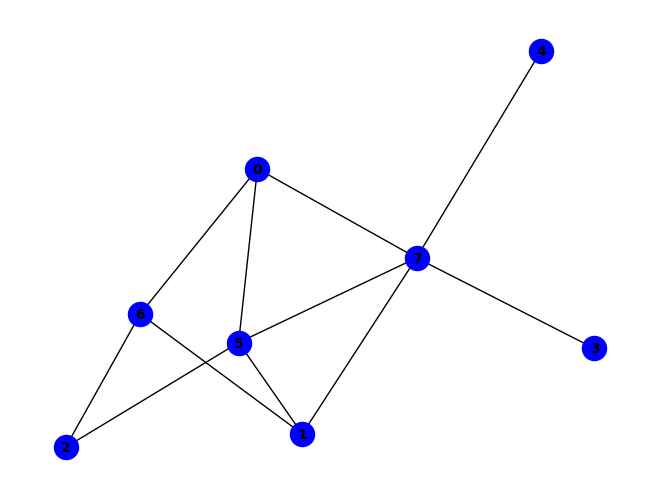


(~c & ~f) ^ (a & f & ~g) ^ (a & g & ~b) ^ (b & g & ~h) ^ (b & h & ~e) ^ (a & f & g & h) ^ (c & ~f & ~g) ^ (f & ~c & ~h) ^ (a & c & g & ~f) ^ (b & c & f & ~h) ^ (a & h & ~b & ~g) ^ (b & f & ~a & ~g) ^ (e & h & ~c & ~f) ^ (b & d & e & h & ~c) ^ (b & e & f & h & ~d) ^ (b & f & g & h & ~a) ^ (a & c & f & ~b & ~h) ^ (a & d & h & ~e & ~f) ^ (a & e & h & ~b & ~f) ^ (b & c & g & ~a & ~f) ^ (b & d & h & ~a & ~f) ^ (c & e & h & ~f & ~g) ^ (a & b & d & e & h & ~f) ^ (b & c & d & e & h & ~g) ^ (b & c & e & g & h & ~f) ^ (b & c & d & e & f & g & h) ^ (d & h & ~c & ~e & ~f) ^ (c & d & h & ~e & ~f & ~g) ^ (a & c & d & g & h & ~e & ~f) ^ (a & c & e & g & h & ~b & ~f) ^ (b & c & d & g & h & ~a & ~f) ^ (a & b & c & d & e & g & h & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


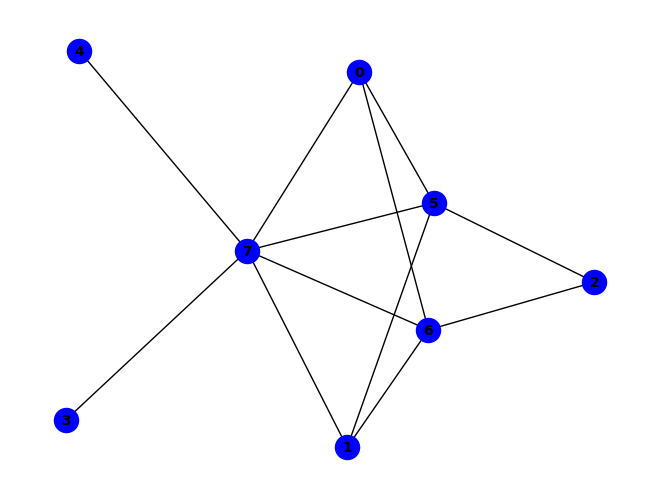


(g & ~h) ^ (~c & ~g) ^ (b & f & ~e) ^ (b & g & ~f) ^ (b & h & ~e) ^ (f & h & ~g) ^ (a & e & f & ~h) ^ (b & c & g & ~h) ^ (a & c & ~b & ~g) ^ (a & f & ~b & ~e) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~e) ^ (c & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & b & c & h & ~g) ^ (b & e & g & h & ~f) ^ (c & ~a & ~f & ~h) ^ (a & b & c & ~f & ~h) ^ (b & c & f & ~g & ~h) ^ (b & e & f & ~a & ~h) ^ (c & f & g & ~a & ~h) ^ (a & b & c & f & g & ~h) ^ (a & e & g & h & ~b & ~f) ^ (d & h & ~a & ~b & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


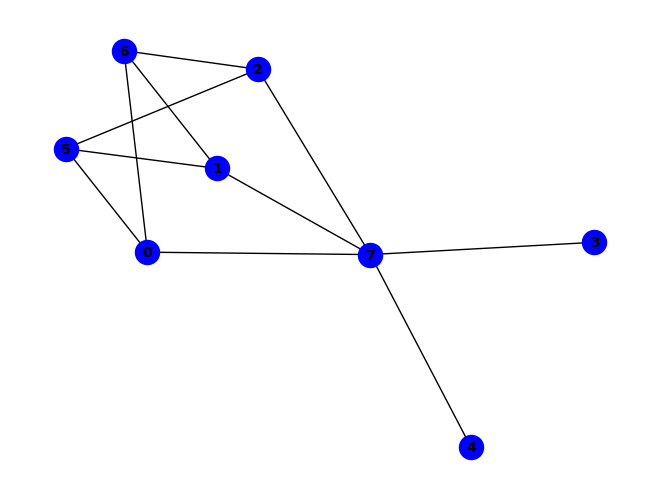


(~c & ~e) ^ (a & f & ~h) ^ (a & g & ~f) ^ (a & h & ~g) ^ (e & ~c & ~h) ^ (a & c & f & ~g) ^ (a & c & g & ~h) ^ (a & c & h & ~f) ^ (a & d & h & ~c) ^ (b & d & h & ~c) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~f) ^ (d & h & ~c & ~e) ^ (a & b & e & h & ~c) ^ (b & f & g & h & ~c) ^ (c & ~f & ~g & ~h) ^ (a & e & h & ~c & ~d) ^ (b & c & f & ~a & ~h) ^ (b & c & g & ~a & ~f) ^ (b & c & h & ~a & ~g) ^ (b & e & h & ~c & ~d) ^ (a & b & d & h & ~c & ~e) ^ (a & f & g & h & ~b & ~c)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


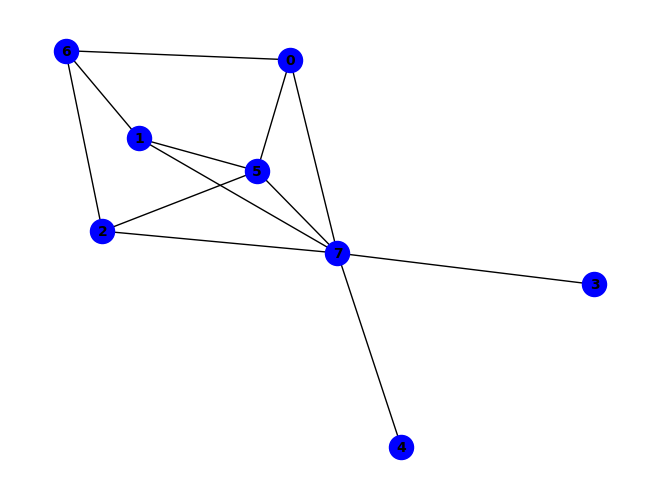


(f & ~h) ^ (a & b & g) ^ (~c & ~f) ^ (a & g & ~h) ^ (a & h & ~e) ^ (a & e & f & h) ^ (c & ~g & ~h) ^ (a & c & g & ~b) ^ (a & c & h & ~g) ^ (c & f & g & ~h) ^ (a & f & ~c & ~g) ^ (b & g & ~c & ~h) ^ (b & h & ~c & ~e) ^ (e & h & ~c & ~f) ^ (a & c & e & h & ~f) ^ (b & d & e & h & ~c) ^ (b & f & g & h & ~c) ^ (a & b & h & ~c & ~g) ^ (b & d & h & ~c & ~f) ^ (b & f & ~a & ~c & ~g) ^ (a & b & e & h & ~c & ~f) ^ (a & f & g & h & ~b & ~c) ^ (b & e & f & h & ~c & ~d) ^ (d & h & ~a & ~c & ~e & ~f) ^ (a & b & d & h & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


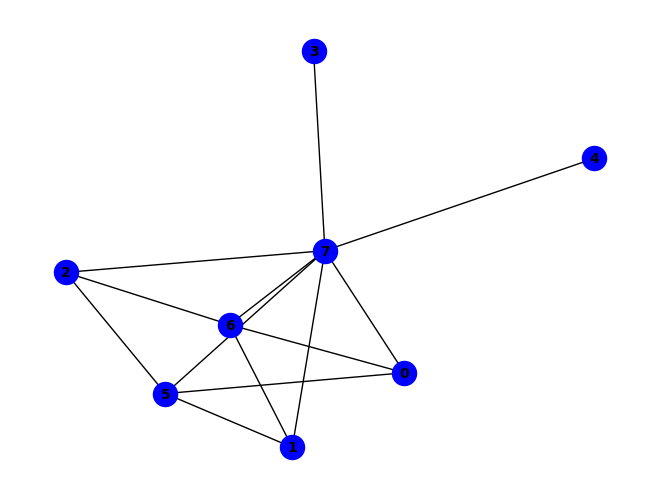


(~c & ~g) ^ (g & ~c & ~h) ^ (b & c & f & ~g) ^ (b & c & g & ~e) ^ (a & f & ~c & ~e) ^ (a & g & ~c & ~f) ^ (b & f & ~a & ~e) ^ (b & g & ~a & ~f) ^ (b & h & ~c & ~e) ^ (f & h & ~c & ~g) ^ (a & b & c & f & ~e) ^ (a & b & c & g & ~f) ^ (b & c & e & g & ~h) ^ (c & ~f & ~g & ~h) ^ (a & e & f & ~c & ~h) ^ (b & e & f & ~a & ~h) ^ (a & b & c & e & f & ~h) ^ (a & h & ~b & ~c & ~e) ^ (e & h & ~c & ~f & ~g) ^ (a & e & g & h & ~c & ~f) ^ (b & e & g & h & ~a & ~f) ^ (a & b & c & e & g & h & ~f) ^ (b & c & d & e & h & ~a & ~g) ^ (b & c & e & f & h & ~d & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (b & c & d & h & ~a & ~f & ~g) ^ (b & d & h & ~a & ~e & ~f & ~g) ^ (d & h & ~a & ~c & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


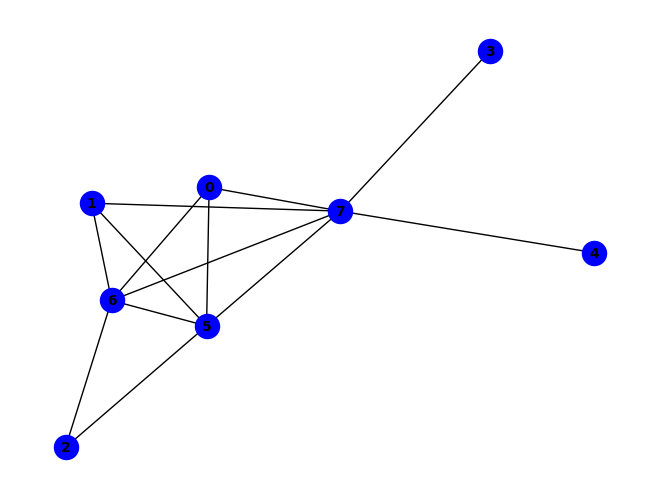


(g & ~h) ^ (~c & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (b & f & ~g) ^ (b & g & ~e) ^ (c & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (c & ~f & ~h) ^ (a & b & f & ~e) ^ (a & e & g & ~h) ^ (b & c & f & ~h) ^ (b & c & g & ~h) ^ (b & h & ~a & ~e) ^ (e & h & ~d & ~g) ^ (a & b & d & h & ~g) ^ (a & e & f & h & ~g) ^ (b & d & f & g & ~a) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~a) ^ (a & b & d & e & f & g) ^ (a & d & e & f & g & h) ^ (a & b & g & ~e & ~f) ^ (a & c & f & ~b & ~h) ^ (a & c & g & ~b & ~h) ^ (a & f & g & ~b & ~h) ^ (b & d & h & ~e & ~g) ^ (b & e & g & ~a & ~h) ^ (b & f & g & ~d & ~h) ^ (e & f & g & ~d & ~h) ^ (b & d & e & f & g & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & d & e & h & ~b & ~g) ^ (b & d & f & h & ~a & ~e) ^ (a & b & d & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

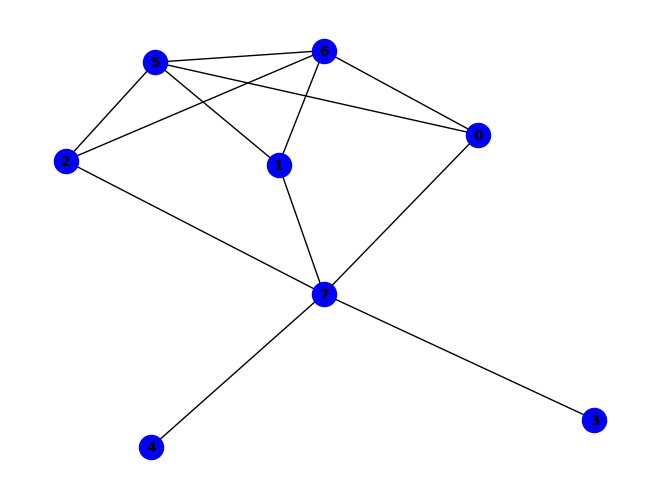


~f ^ (a & c & g) ^ (c & g & ~h) ^ (c & h & ~e) ^ (e & h & ~f) ^ (b & c & g & ~a) ^ (b & c & h & ~g) ^ (b & f & g & ~c) ^ (c & f & g & ~a) ^ (c & e & f & g & h) ^ (a & g & ~f & ~h) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~e) ^ (a & c & d & h & ~f) ^ (b & c & d & h & ~f) ^ (b & c & e & h & ~d) ^ (b & e & f & h & ~c) ^ (a & b & c & f & g & h) ^ (f & ~a & ~e & ~g) ^ (a & c & f & ~g & ~h) ^ (a & c & h & ~b & ~g) ^ (b & c & f & ~g & ~h) ^ (b & d & h & ~e & ~f) ^ (b & e & f & ~d & ~g) ^ (c & d & f & ~e & ~g) ^ (a & b & c & e & h & ~f) ^ (a & b & d & f & g & ~c) ^ (a & b & f & g & h & ~e) ^ (b & c & e & f & h & ~g) ^ (a & b & d & e & f & g & h) ^ (a & h & ~d & ~e & ~f) ^ (b & f & ~e & ~g & ~h) ^ (c & f & ~d & ~g & ~h) ^ (d & h & ~c & ~e & ~f) ^ (e & f & ~a & ~g & ~h) ^ (a & b & d & h & ~c & ~e) ^ (a & c & e & h & ~d & ~f) ^ (b & d & e & f & ~g & ~h) ^ (b & d & f & h & ~c & ~g) ^ (c & d & e & f & ~g & ~h) ^ (a & b & f & ~c & ~d & ~h) ^ (d & f & h & ~a & ~e & ~g) ^ (a & c & d & f & h & ~e & ~g) ^ (

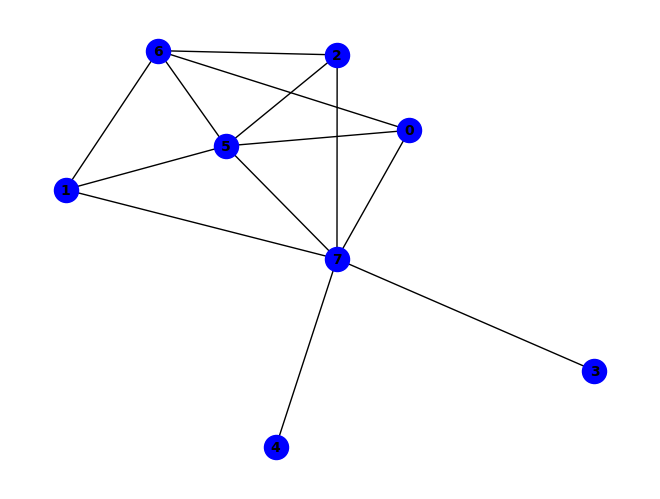


~e ^ (a & g & ~c) ^ (c & g & ~h) ^ (c & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (c & d & e & h) ^ (e & ~d & ~h) ^ (b & c & g & ~a) ^ (a & f & ~b & ~e) ^ (a & h & ~c & ~g) ^ (b & f & ~c & ~e) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~e) ^ (c & f & ~a & ~e) ^ (a & b & c & f & ~e) ^ (c & d & e & f & ~b) ^ (a & e & f & ~b & ~h) ^ (a & e & h & ~c & ~d) ^ (b & c & h & ~a & ~g) ^ (b & e & f & ~c & ~h) ^ (c & e & f & ~a & ~h) ^ (d & e & f & ~c & ~h) ^ (a & b & c & e & f & ~h) ^ (a & d & e & f & h & ~c) ^ (b & c & d & e & f & ~h) ^ (a & b & c & d & e & f & h) ^ (d & h & ~a & ~c & ~f) ^ (b & c & d & h & ~a & ~f) ^ (b & c & e & h & ~a & ~d) ^ (b & d & h & ~a & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


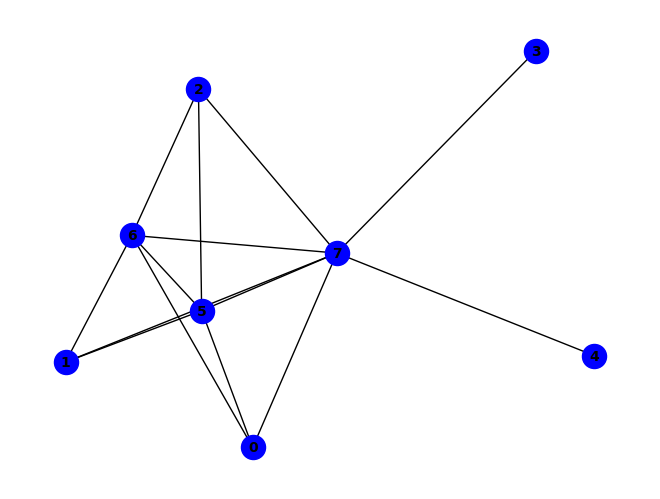


~g ^ (g & ~h) ^ (c & f & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & b & f & ~g) ^ (a & f & ~c & ~g) ^ (a & g & ~c & ~e) ^ (a & h & ~c & ~e) ^ (b & f & ~c & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & g & ~b & ~e) ^ (c & h & ~b & ~e) ^ (e & h & ~d & ~g) ^ (a & b & c & f & ~e) ^ (a & b & c & g & ~f) ^ (a & b & c & h & ~e) ^ (a & b & f & g & ~h) ^ (a & d & e & g & ~c) ^ (a & d & e & h & ~c) ^ (a & d & f & g & ~e) ^ (a & d & f & h & ~e) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & d & e & f & g) ^ (a & b & d & e & f & h) ^ (a & c & d & e & f & g) ^ (a & c & d & e & f & h) ^ (b & c & d & e & f & g) ^ (b & c & d & e & f & h) ^ (a & d & h & ~c & ~g) ^ (a & f & g & ~d & ~h) ^ (b & e & g & ~a & ~h) ^ (b & f & g & ~e & ~h) ^ (c & e & g & ~b & ~h) ^ (e & f & g & ~d & ~h) ^ (a & b & e & f & h & ~g) ^ (a & c & d & f & h & ~g) ^ (a & e & f & h & ~c & ~g) ^ (b & d & e & h & ~a & ~g) ^ (c & d & e & h & ~b & ~g) ^ (c & e & f & h & ~b & ~g)

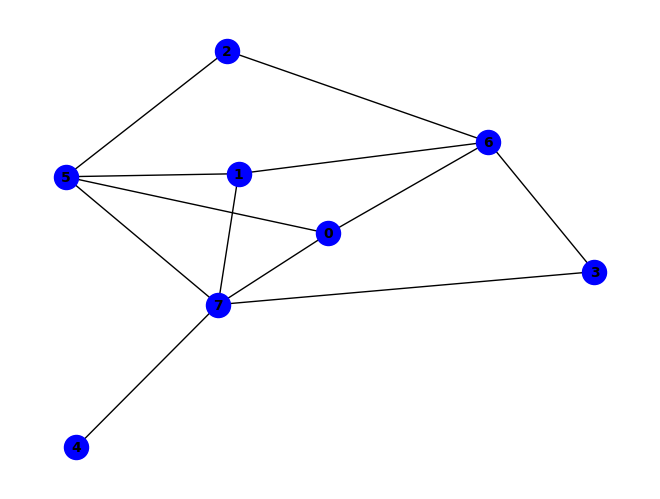


(~c & ~f) ^ (a & f & ~g) ^ (b & h & ~e) ^ (e & h & ~f) ^ (a & f & g & h) ^ (c & ~f & ~g) ^ (f & ~c & ~h) ^ (a & c & g & ~f) ^ (a & c & e & f & g) ^ (a & g & ~d & ~h) ^ (a & h & ~b & ~e) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~h) ^ (d & g & ~b & ~h) ^ (a & b & d & g & ~h) ^ (a & d & e & h & ~c) ^ (a & e & f & h & ~d) ^ (b & f & g & h & ~a) ^ (a & b & c & d & e & h) ^ (a & c & f & ~e & ~h) ^ (a & d & h & ~b & ~f) ^ (b & c & f & ~a & ~h) ^ (b & c & g & ~a & ~f) ^ (c & d & g & ~a & ~b) ^ (a & b & d & e & h & ~f) ^ (a & c & e & g & h & ~b) ^ (b & c & e & g & h & ~d) ^ (b & c & d & e & f & g & h) ^ (d & h & ~b & ~e & ~f) ^ (b & e & f & h & ~a & ~c) ^ (c & e & g & h & ~d & ~f) ^ (a & c & d & e & f & h & ~b) ^ (a & c & d & e & f & ~b & ~g) ^ (a & c & d & e & h & ~b & ~g) ^ (b & c & e & f & h & ~a & ~g) ^ (c & d & f & g & h & ~a & ~b) ^ (a & c & e & f & ~d & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


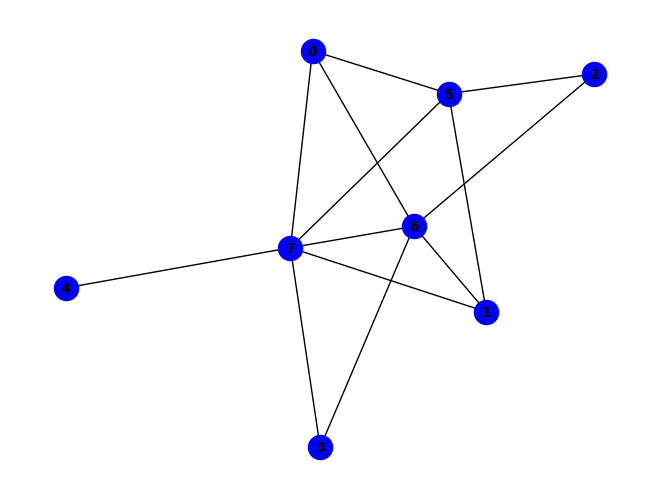


(g & ~h) ^ (~c & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (b & f & ~g) ^ (b & g & ~e) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~f & ~h) ^ (a & b & f & ~e) ^ (a & d & g & ~f) ^ (b & e & g & ~h) ^ (b & h & ~a & ~e) ^ (d & g & ~b & ~f) ^ (e & h & ~f & ~g) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (a & b & g & ~d & ~f) ^ (a & c & f & ~b & ~h) ^ (a & c & g & ~b & ~h) ^ (a & e & g & ~f & ~h) ^ (b & c & f & ~g & ~h) ^ (b & c & g & ~d & ~h) ^ (c & d & g & ~a & ~h) ^ (c & f & g & ~a & ~h) ^ (a & b & c & d & g & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & d & e & f & ~g) ^ (a & b & e & g & h & ~f) ^ (d & h & ~a & ~b & ~f) ^ (a & b & e & f & ~d & ~h) ^ (d & e & h & ~a & ~b & ~g) ^ (d & f & g & ~a & ~b & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

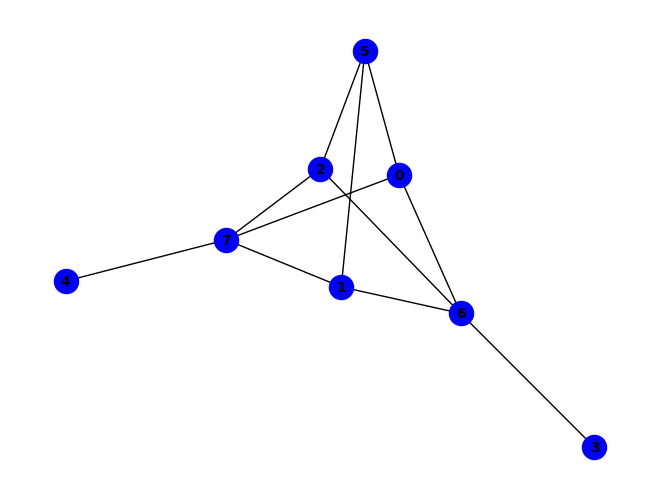


~e ^ (e & ~h) ^ (a & h & ~e) ^ (b & g & ~h) ^ (c & g & ~h) ^ (c & h & ~e) ^ (a & c & g & ~f) ^ (a & c & h & ~g) ^ (b & c & f & ~h) ^ (a & b & f & g & h) ^ (a & d & e & g & h) ^ (a & f & ~g & ~h) ^ (a & g & ~b & ~h) ^ (b & f & ~a & ~g) ^ (b & h & ~a & ~f) ^ (c & f & ~g & ~h) ^ (a & c & e & h & ~d) ^ (b & f & g & h & ~c) ^ (d & e & g & h & ~c) ^ (a & c & f & ~b & ~h) ^ (b & c & g & ~a & ~f) ^ (b & c & h & ~a & ~g) ^ (a & c & d & e & h & ~g) ^ (a & c & f & g & h & ~b) ^ (d & g & ~a & ~b & ~c) ^ (b & e & h & ~a & ~c & ~d) ^ (b & d & e & h & ~a & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


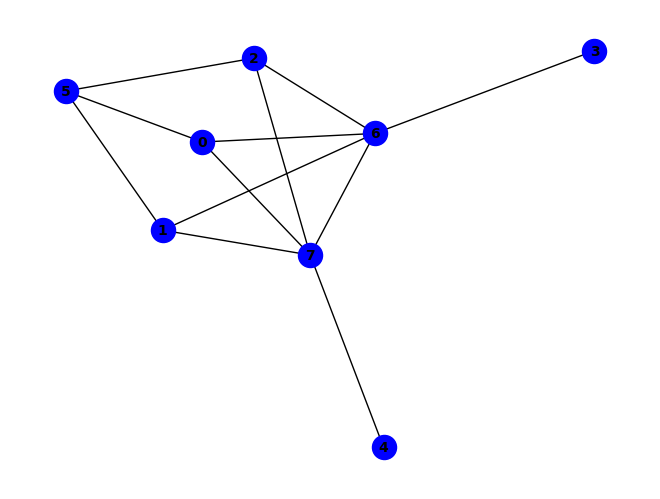


(g & ~h) ^ (~d & ~g) ^ (a & f & ~c) ^ (b & f & ~h) ^ (b & g & ~f) ^ (b & h & ~e) ^ (c & f & ~h) ^ (c & g & ~f) ^ (c & h & ~e) ^ (d & h & ~g) ^ (a & b & c & f) ^ (b & c & e & h) ^ (b & e & g & h) ^ (c & e & g & h) ^ (c & f & g & h) ^ (d & ~c & ~h) ^ (a & b & f & ~g) ^ (a & b & g & ~e) ^ (b & c & f & ~g) ^ (b & c & g & ~e) ^ (b & c & h & ~f) ^ (a & g & ~c & ~f) ^ (e & h & ~a & ~g) ^ (a & b & c & g & ~f) ^ (a & b & e & g & ~h) ^ (a & b & e & h & ~c) ^ (a & c & e & h & ~g) ^ (b & c & e & g & ~h) ^ (b & f & g & h & ~c) ^ (a & b & c & e & g & h) ^ (a & c & d & ~b & ~h) ^ (a & d & g & ~b & ~h) ^ (b & d & g & ~c & ~h) ^ (a & h & ~b & ~c & ~f) ^ (c & d & ~a & ~g & ~h) ^ (a & b & c & d & ~g & ~h) ^ (a & f & g & h & ~b & ~c)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


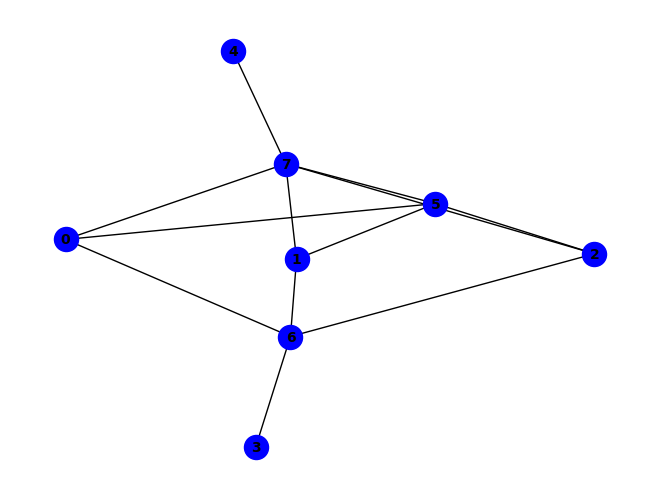


~f ^ (f & ~h) ^ (b & g & ~h) ^ (b & h & ~e) ^ (c & g & ~h) ^ (c & h & ~e) ^ (e & h & ~f) ^ (c & f & g & h) ^ (a & c & f & ~e) ^ (a & c & g & ~f) ^ (b & c & h & ~g) ^ (b & d & g & ~a) ^ (a & g & ~b & ~h) ^ (a & h & ~b & ~e) ^ (c & f & ~d & ~g) ^ (d & g & ~a & ~c) ^ (a & c & e & h & ~d) ^ (a & d & f & h & ~b) ^ (b & d & f & h & ~c) ^ (b & e & f & h & ~d) ^ (b & f & g & h & ~c) ^ (c & d & f & h & ~a) ^ (c & e & f & h & ~d) ^ (d & f & g & h & ~e) ^ (a & c & d & e & f & g) ^ (b & c & d & e & f & h) ^ (a & c & h & ~b & ~g) ^ (b & c & g & ~a & ~d) ^ (a & c & d & e & h & ~g) ^ (a & c & d & f & h & ~g) ^ (a & d & e & g & h & ~b) ^ (c & d & e & f & h & ~g) ^ (a & b & c & d & e & g & h) ^ (a & f & ~b & ~d & ~g) ^ (b & f & ~c & ~d & ~g) ^ (a & b & c & f & ~d & ~g) ^ (a & c & e & f & ~d & ~h) ^ (a & d & e & f & ~b & ~g) ^ (a & e & f & h & ~b & ~d) ^ (a & f & g & h & ~b & ~c) ^ (b & c & e & h & ~a & ~f) ^ (b & d & e & f & ~c & ~g) ^ (d & e & g & h & ~b & ~c) ^ (a & b & c & d & e & f & ~g) ^ (a & b 

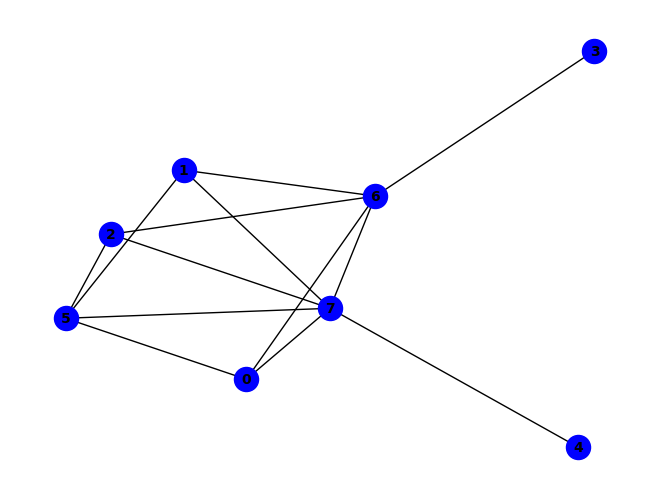


(g & ~h) ^ (~d & ~g) ^ (b & g & ~e) ^ (c & f & ~g) ^ (c & h & ~e) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & b & f & ~e) ^ (a & b & g & ~f) ^ (a & f & ~c & ~g) ^ (a & g & ~c & ~e) ^ (a & h & ~c & ~e) ^ (b & f & ~c & ~g) ^ (c & d & ~g & ~h) ^ (c & g & ~b & ~e) ^ (e & h & ~f & ~g) ^ (a & b & c & f & ~g) ^ (a & b & c & g & ~e) ^ (a & b & e & f & ~h) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & e & f & h & ~g) ^ (a & d & g & ~c & ~h) ^ (a & e & g & ~c & ~h) ^ (b & e & g & ~f & ~h) ^ (c & e & g & ~b & ~h) ^ (a & b & c & e & g & ~h) ^ (a & b & e & g & h & ~f) ^ (b & c & e & f & g & ~h) ^ (b & h & ~a & ~c & ~e) ^ (a & e & f & h & ~c & ~g) ^ (a & b & c & e & f & h & ~g) ^ (b & d & g & ~a & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


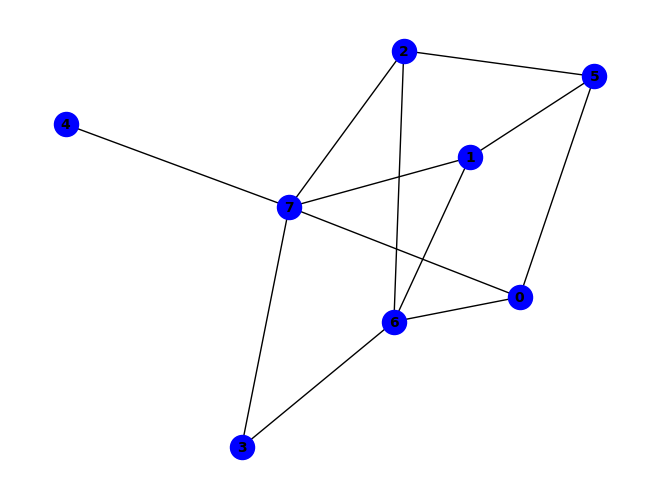


~e ^ (a & g & ~f) ^ (a & h & ~g) ^ (b & e & ~d) ^ (b & h & ~d) ^ (c & f & ~g) ^ (c & h & ~f) ^ (a & b & f & g) ^ (c & f & g & h) ^ (e & ~b & ~h) ^ (a & b & f & ~h) ^ (a & c & h & ~d) ^ (a & e & h & ~c) ^ (b & c & h & ~e) ^ (b & d & e & ~h) ^ (c & d & h & ~b) ^ (c & e & h & ~d) ^ (a & b & c & d & h) ^ (a & c & d & e & h) ^ (b & c & d & e & h) ^ (a & f & ~c & ~h) ^ (b & f & ~c & ~h) ^ (b & g & ~f & ~h) ^ (c & g & ~b & ~h) ^ (d & h & ~a & ~e) ^ (a & b & c & f & ~g) ^ (a & b & c & h & ~f) ^ (a & f & g & h & ~b) ^ (b & c & f & g & ~h) ^ (a & b & c & f & g & h) ^ (a & b & h & ~d & ~e) ^ (a & c & g & ~f & ~h) ^ (a & d & g & ~c & ~h) ^ (a & b & c & e & h & ~d) ^ (d & g & ~b & ~c & ~h) ^ (a & b & g & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


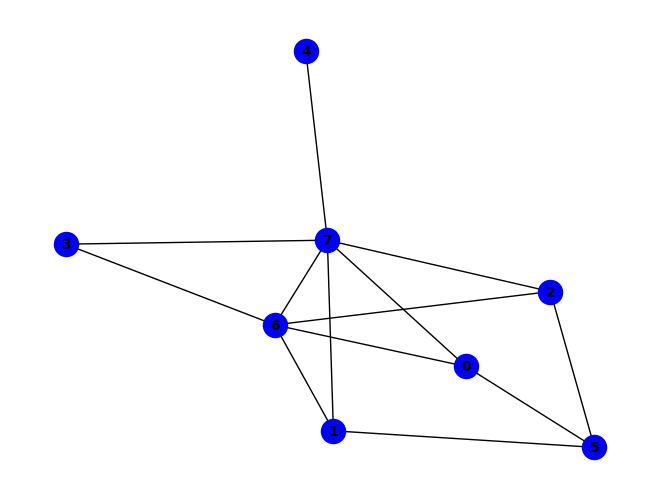


~g ^ (g & ~h) ^ (c & f & ~g) ^ (c & g & ~e) ^ (e & h & ~g) ^ (c & f & g & h) ^ (a & c & f & ~b) ^ (c & d & h & ~b) ^ (c & e & g & ~h) ^ (c & e & h & ~d) ^ (b & c & d & e & h) ^ (a & f & ~b & ~h) ^ (a & g & ~c & ~f) ^ (b & f & ~c & ~h) ^ (b & h & ~c & ~e) ^ (c & h & ~a & ~f) ^ (d & h & ~b & ~e) ^ (a & b & c & h & ~f) ^ (a & c & e & h & ~b) ^ (a & f & g & h & ~c) ^ (b & e & g & h & ~c) ^ (a & h & ~b & ~d & ~e) ^ (b & g & ~a & ~c & ~f) ^ (a & c & d & h & ~b & ~e) ^ (a & e & g & h & ~b & ~c) ^ (b & f & g & h & ~a & ~c) ^ (d & g & ~a & ~b & ~c & ~e) ^ (d & e & g & ~a & ~b & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


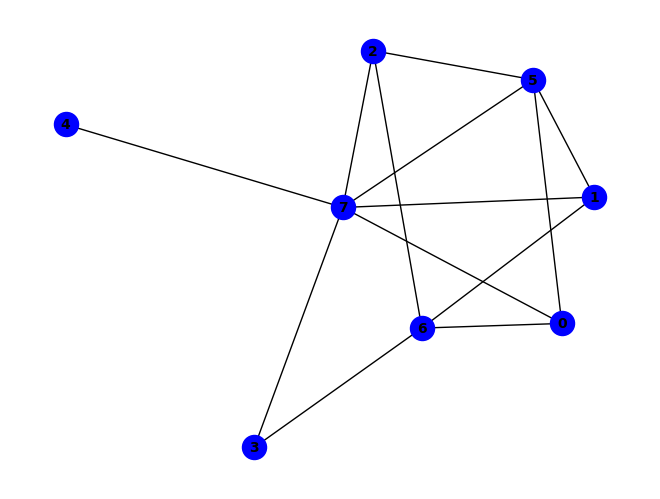


~f ^ (f & ~h) ^ (a & g & ~d) ^ (c & f & ~g) ^ (d & g & ~h) ^ (c & f & g & h) ^ (a & b & f & ~e) ^ (a & b & g & ~f) ^ (b & d & h & ~g) ^ (c & d & g & ~a) ^ (a & f & ~c & ~g) ^ (b & f & ~c & ~g) ^ (b & g & ~c & ~h) ^ (b & h & ~c & ~e) ^ (c & g & ~a & ~h) ^ (c & h & ~a & ~e) ^ (d & h & ~e & ~f) ^ (e & h & ~a & ~f) ^ (a & b & c & f & ~g) ^ (a & b & c & g & ~h) ^ (a & b & c & h & ~e) ^ (a & b & e & f & ~h) ^ (a & b & e & h & ~d) ^ (a & d & f & h & ~b) ^ (b & d & f & h & ~c) ^ (b & e & f & h & ~c) ^ (b & f & g & h & ~c) ^ (c & d & e & h & ~f) ^ (c & d & f & h & ~a) ^ (c & e & f & h & ~a) ^ (a & b & c & d & f & h) ^ (a & b & c & e & f & h) ^ (a & b & d & e & f & h) ^ (b & d & g & ~a & ~c) ^ (a & h & ~b & ~d & ~g) ^ (a & d & e & h & ~c & ~f) ^ (a & f & g & h & ~b & ~c) ^ (b & d & e & h & ~c & ~f) ^ (a & b & c & d & e & h & ~f) ^ (c & d & h & ~a & ~b & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

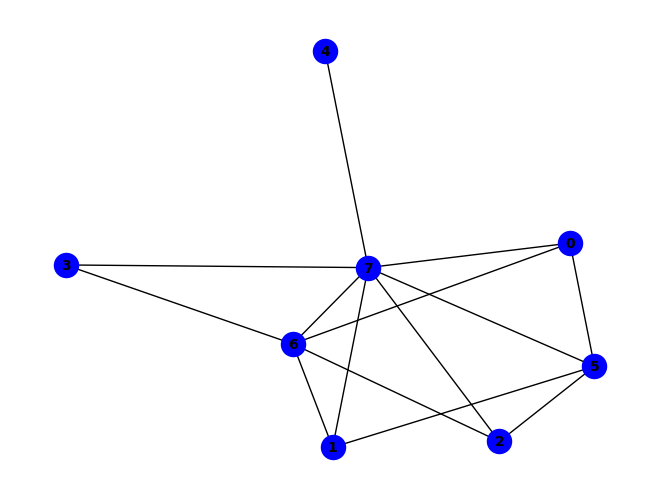


~g ^ (g & ~h) ^ (f & h & ~g) ^ (a & f & ~b & ~g) ^ (a & g & ~b & ~e) ^ (a & h & ~b & ~e) ^ (b & f & ~c & ~g) ^ (b & g & ~c & ~e) ^ (b & h & ~c & ~e) ^ (c & f & ~a & ~g) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (e & h & ~f & ~g) ^ (a & b & c & f & ~e) ^ (a & b & c & h & ~e) ^ (a & b & d & g & ~f) ^ (a & d & g & ~c & ~f) ^ (a & e & g & ~b & ~h) ^ (b & e & g & ~c & ~h) ^ (c & e & g & ~a & ~h) ^ (a & b & c & e & f & ~h) ^ (d & g & ~b & ~c & ~f) ^ (a & b & c & g & ~d & ~f) ^ (a & e & f & h & ~b & ~g) ^ (b & e & f & h & ~c & ~g) ^ (c & e & f & h & ~a & ~g) ^ (d & e & f & g & ~b & ~c) ^ (d & e & f & h & ~b & ~c) ^ (a & b & c & e & g & h & ~f) ^ (d & e & h & ~b & ~c & ~g) ^ (d & h & ~a & ~b & ~c & ~f) ^ (a & d & f & g & ~b & ~c & ~h) ^ (d & f & g & ~b & ~c & ~e & ~h) ^ (a & d & e & h & ~b & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


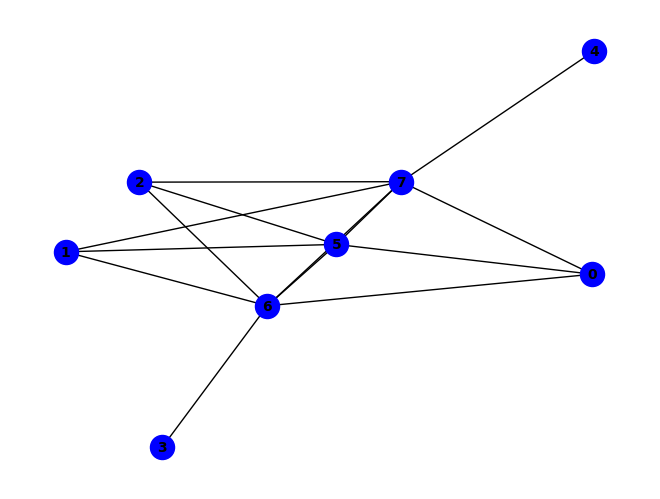


(g & ~h) ^ (~d & ~g) ^ (a & g & ~e) ^ (b & g & ~e) ^ (e & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (a & b & f & ~e) ^ (c & e & g & ~h) ^ (e & f & g & ~h) ^ (a & f & ~d & ~g) ^ (a & h & ~c & ~e) ^ (b & f & ~d & ~g) ^ (b & h & ~a & ~e) ^ (c & f & ~b & ~g) ^ (c & g & ~b & ~e) ^ (c & h & ~b & ~e) ^ (d & f & ~c & ~g) ^ (d & h & ~f & ~g) ^ (a & b & c & h & ~e) ^ (a & e & f & h & ~g) ^ (b & c & d & f & ~g) ^ (b & e & f & h & ~c) ^ (c & d & f & h & ~g) ^ (c & e & f & h & ~g) ^ (a & b & g & ~c & ~f) ^ (a & c & f & ~b & ~e) ^ (a & c & g & ~e & ~f) ^ (a & d & f & ~c & ~h) ^ (a & d & g & ~c & ~h) ^ (a & e & g & ~c & ~h) ^ (b & d & f & ~a & ~h) ^ (b & d & g & ~a & ~h) ^ (b & e & g & ~c & ~h) ^ (b & f & g & ~e & ~h) ^ (c & d & f & ~b & ~h) ^ (c & d & g & ~b & ~h) ^ (c & f & g & ~b & ~h) ^ (a & b & c & d & f & ~h) ^ (a & b & c & d & g & ~h) ^ (a & b & e & g & h & ~c) ^ (b & c & e & f & g & ~h) ^ (a & b & d & f & ~g & ~h) ^ (a & c & d & f & ~b & ~g) ^ (a & c & e & f & ~g & ~h) ^ (a & d

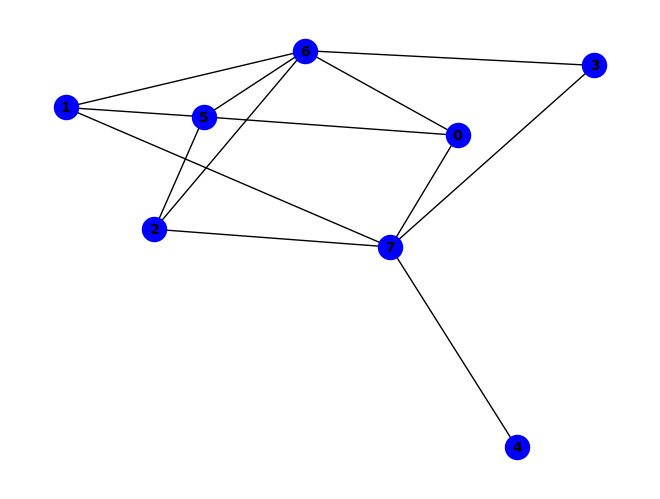


~f ^ (a & d & f & g) ^ (a & d & g & ~h) ^ (b & d & g & ~h) ^ (b & d & h & ~e) ^ (d & f & g & ~c) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~g) ^ (b & g & ~c & ~f) ^ (b & h & ~c & ~g) ^ (c & g & ~f & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~c & ~h) ^ (d & h & ~c & ~e) ^ (e & h & ~b & ~f) ^ (a & c & d & g & ~f) ^ (a & c & d & h & ~g) ^ (b & c & d & g & ~f) ^ (b & c & d & h & ~g) ^ (b & d & f & g & ~a) ^ (a & d & e & f & g & h) ^ (f & ~c & ~e & ~g) ^ (a & b & f & ~c & ~h) ^ (a & b & g & ~d & ~h) ^ (a & b & h & ~c & ~e) ^ (a & d & h & ~b & ~e) ^ (a & e & h & ~c & ~f) ^ (a & b & c & d & g & ~h) ^ (a & b & c & d & h & ~e) ^ (a & b & c & f & g & ~d) ^ (a & b & f & g & h & ~e) ^ (a & c & d & e & h & ~f) ^ (b & d & e & f & h & ~a) ^ (d & e & f & g & h & ~c) ^ (a & f & ~c & ~g & ~h) ^ (b & f & ~c & ~g & ~h) ^ (e & f & ~c & ~g & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & e & f & h & ~c & ~g) ^ (b & c & e & h & ~d & ~f) ^ (a & b & d & e & f & h & ~g) ^ (a & c & d & e & f & h & ~g) ^ (a & b & c & e & f & g & h &

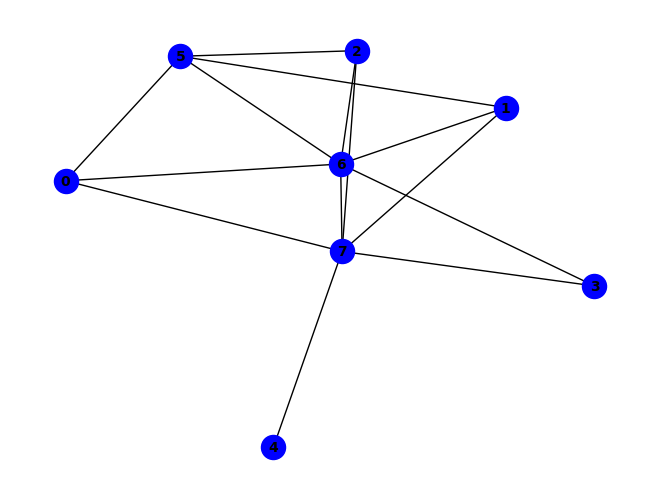


(g & ~h) ^ (~f & ~g) ^ (c & f & ~d) ^ (d & g & ~e) ^ (e & h & ~g) ^ (f & h & ~g) ^ (b & c & f & ~h) ^ (b & c & g & ~e) ^ (c & e & h & ~d) ^ (b & g & ~d & ~e) ^ (b & h & ~c & ~e) ^ (c & g & ~d & ~e) ^ (c & h & ~d & ~f) ^ (d & h & ~b & ~e) ^ (a & c & d & g & ~b) ^ (a & c & d & h & ~b) ^ (a & d & e & g & ~c) ^ (a & d & e & h & ~c) ^ (b & c & d & g & ~f) ^ (b & c & d & h & ~f) ^ (b & c & e & g & ~h) ^ (a & b & c & d & e & g) ^ (a & b & c & d & e & h) ^ (f & ~b & ~d & ~h) ^ (a & d & g & ~b & ~f) ^ (a & d & h & ~b & ~f) ^ (b & d & f & ~g & ~h) ^ (b & e & g & ~d & ~h) ^ (c & e & g & ~d & ~h) ^ (d & e & g & ~a & ~h) ^ (a & b & d & e & h & ~g) ^ (b & c & d & e & h & ~g) ^ (b & c & d & f & h & ~g) ^ (a & f & ~b & ~c & ~h) ^ (a & g & ~b & ~c & ~e) ^ (a & h & ~b & ~c & ~e) ^ (d & f & ~c & ~g & ~h) ^ (a & c & d & f & ~b & ~g) ^ (a & c & d & f & ~b & ~h) ^ (a & e & g & ~b & ~c & ~h) ^ (a & c & d & e & g & ~b & ~h) ^ (a & d & f & h & ~b & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

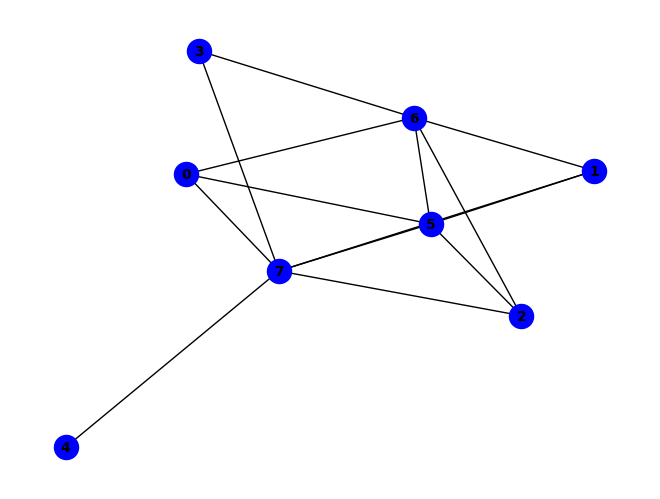


~e ^ (c & f & ~e) ^ (c & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (b & c & g & ~d) ^ (d & e & f & ~h) ^ (a & c & d & f & g) ^ (a & g & ~c & ~d) ^ (b & f & ~c & ~e) ^ (b & h & ~a & ~e) ^ (c & g & ~d & ~h) ^ (d & g & ~f & ~h) ^ (d & h & ~c & ~f) ^ (a & b & c & h & ~e) ^ (a & d & f & h & ~e) ^ (b & c & e & h & ~d) ^ (b & d & f & g & ~h) ^ (c & d & e & h & ~f) ^ (c & d & f & g & ~h) ^ (a & c & d & e & f & h) ^ (b & c & d & e & f & h) ^ (a & e & f & ~b & ~h) ^ (a & e & h & ~c & ~d) ^ (b & c & h & ~d & ~g) ^ (b & e & f & ~c & ~h) ^ (c & e & f & ~a & ~h) ^ (a & b & c & e & f & ~h) ^ (a & c & d & f & h & ~g) ^ (b & c & d & f & g & ~a) ^ (b & c & d & f & h & ~g) ^ (a & b & c & d & f & g & h) ^ (a & f & ~b & ~c & ~e) ^ (a & h & ~c & ~d & ~g) ^ (b & g & ~a & ~d & ~h) ^ (a & b & c & g & ~d & ~h) ^ (a & d & f & g & ~b & ~h) ^ (b & d & h & ~a & ~e & ~f) ^ (a & b & c & d & h & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


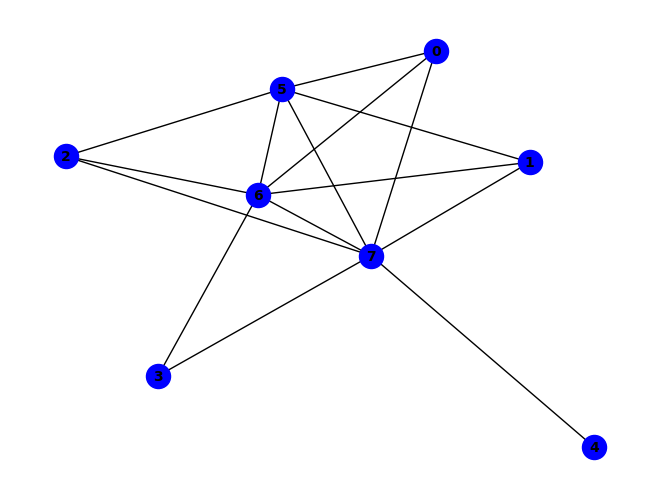


~g ^ (g & ~h) ^ (b & f & ~g) ^ (b & g & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & b & f & ~e) ^ (b & e & g & ~h) ^ (a & f & ~c & ~g) ^ (a & g & ~c & ~e) ^ (a & h & ~c & ~e) ^ (b & h & ~a & ~e) ^ (c & f & ~b & ~g) ^ (c & g & ~b & ~e) ^ (c & h & ~b & ~e) ^ (e & h & ~d & ~g) ^ (a & b & c & f & ~g) ^ (a & b & c & g & ~e) ^ (a & b & c & h & ~e) ^ (a & b & d & h & ~f) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & g & ~d & ~f) ^ (a & d & g & ~e & ~f) ^ (a & d & h & ~e & ~f) ^ (a & e & g & ~d & ~h) ^ (b & f & g & ~e & ~h) ^ (c & f & g & ~b & ~h) ^ (e & f & g & ~d & ~h) ^ (a & b & d & e & f & ~g) ^ (a & b & e & g & h & ~f) ^ (a & d & e & f & g & ~h) ^ (d & g & ~b & ~c & ~f) ^ (d & h & ~b & ~c & ~f) ^ (a & b & e & f & ~d & ~h) ^ (a & c & d & g & ~b & ~f) ^ (a & c & d & h & ~b & ~f) ^ (a & e & f & h & ~c & ~g) ^ (c & d & e & h & ~a & ~g) ^ (c & e & f & h & ~b & ~g) ^ (a & b & c & e & f & h & ~g) ^ (a & c & d & e & f & h & ~g) ^ (b & c & d &

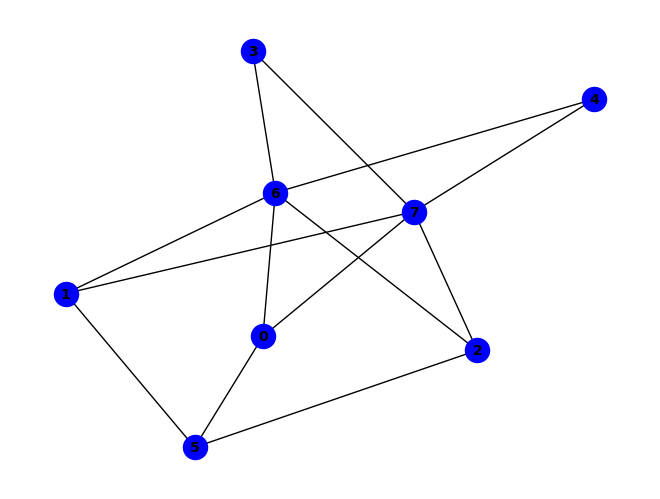


~d ^ (b & f & ~g) ^ (b & h & ~f) ^ (e & h & ~d) ^ (d & ~g & ~h) ^ (a & b & g & ~f) ^ (a & c & f & ~h) ^ (b & e & h & ~a) ^ (a & f & ~g & ~h) ^ (a & h & ~d & ~e) ^ (c & f & ~b & ~h) ^ (a & b & e & g & ~h) ^ (a & c & d & g & ~b) ^ (b & f & g & h & ~a) ^ (a & b & f & ~c & ~h) ^ (a & b & h & ~c & ~g) ^ (a & c & g & ~b & ~f) ^ (b & d & h & ~a & ~e) ^ (c & d & g & ~b & ~h) ^ (a & b & c & d & h & ~g) ^ (a & c & f & g & h & ~b) ^ (a & g & ~d & ~e & ~h) ^ (b & g & ~d & ~e & ~h) ^ (c & g & ~b & ~f & ~h) ^ (c & h & ~b & ~d & ~e) ^ (e & g & ~c & ~d & ~h) ^ (a & b & d & g & ~e & ~h) ^ (a & c & e & g & ~b & ~d) ^ (b & c & e & g & ~d & ~h) ^ (a & c & h & ~d & ~e & ~g) ^ (a & b & c & e & h & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


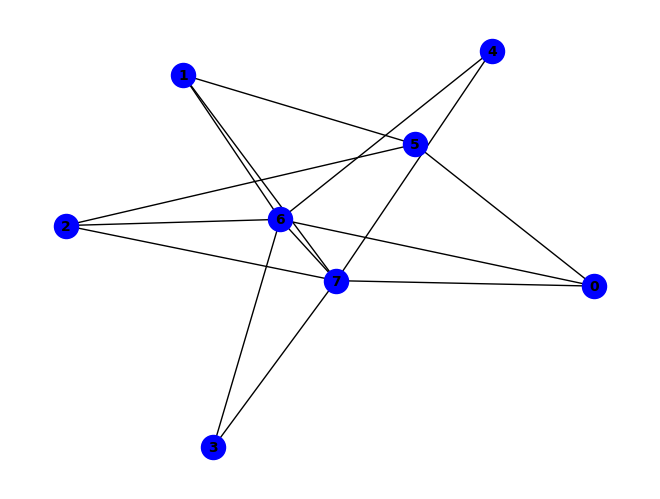


~g ^ (g & ~h) ^ (a & c & f) ^ (a & f & ~h) ^ (b & f & ~g) ^ (e & h & ~b) ^ (c & f & g & h) ^ (a & b & f & ~c) ^ (a & h & ~d & ~e) ^ (b & g & ~d & ~e) ^ (b & h & ~a & ~f) ^ (c & f & ~b & ~h) ^ (c & g & ~b & ~f) ^ (d & h & ~b & ~e) ^ (e & g & ~a & ~c) ^ (a & b & d & g & ~c) ^ (a & b & d & h & ~e) ^ (a & b & e & g & ~d) ^ (a & b & e & h & ~c) ^ (a & c & d & h & ~b) ^ (a & c & e & h & ~d) ^ (b & c & d & g & ~e) ^ (b & c & e & g & ~a) ^ (b & f & g & h & ~c) ^ (a & b & c & d & e & g) ^ (a & b & c & d & e & h) ^ (a & c & h & ~b & ~f) ^ (a & g & ~b & ~c & ~f) ^ (c & h & ~b & ~d & ~e) ^ (d & g & ~a & ~c & ~e) ^ (a & f & g & h & ~b & ~c)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


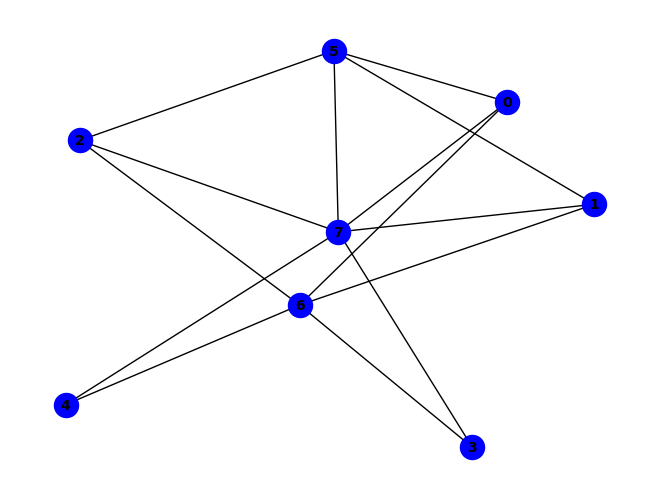


~f ^ (f & ~h) ^ (a & h & ~e) ^ (b & h & ~e) ^ (e & h & ~f) ^ (b & d & f & h) ^ (c & f & g & h) ^ (a & b & g & ~e) ^ (b & c & g & ~e) ^ (b & d & g & ~e) ^ (c & d & g & ~e) ^ (a & b & e & f & h) ^ (a & f & ~b & ~g) ^ (a & g & ~d & ~h) ^ (b & f & ~c & ~g) ^ (b & g & ~e & ~h) ^ (c & f & ~a & ~g) ^ (c & h & ~a & ~e) ^ (d & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (e & g & ~a & ~h) ^ (a & b & c & f & ~e) ^ (a & b & c & g & ~f) ^ (a & b & c & h & ~g) ^ (a & d & e & h & ~c) ^ (b & e & f & h & ~d) ^ (b & f & g & h & ~c) ^ (c & d & f & h & ~e) ^ (c & e & f & h & ~b) ^ (a & b & c & d & e & f) ^ (a & b & h & ~e & ~g) ^ (a & d & h & ~c & ~f) ^ (b & c & h & ~e & ~g) ^ (b & d & h & ~e & ~g) ^ (c & d & h & ~e & ~g) ^ (a & b & c & d & h & ~f) ^ (a & b & c & e & h & ~d) ^ (c & g & ~a & ~e & ~h) ^ (a & b & d & g & ~c & ~h) ^ (a & b & d & h & ~e & ~f) ^ (a & c & d & g & ~e & ~h) ^ (a & d & e & g & ~b & ~h) ^ (a & e & f & h & ~c & ~d) ^ (a & f & g & h & ~b & ~c) ^ (b & c & d & g & ~e & ~h) ^ (b & c & d & h & ~e

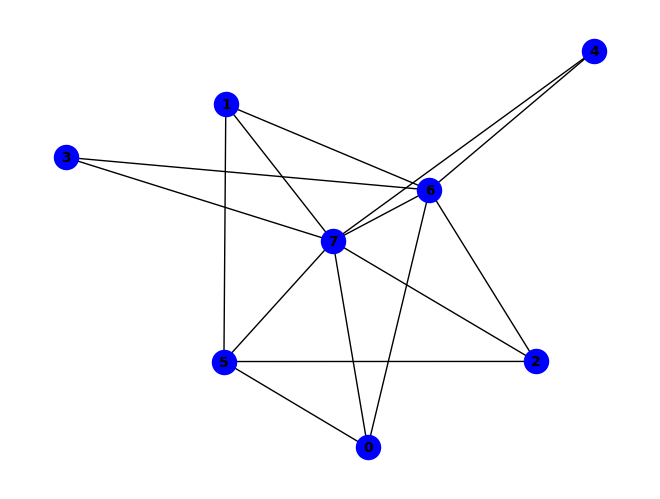


~g ^ (g & ~h) ^ (a & f & ~g) ^ (a & g & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & h & ~g) ^ (b & c & f & ~e) ^ (e & f & g & ~h) ^ (a & h & ~b & ~e) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~c & ~e) ^ (c & f & ~a & ~g) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (a & b & c & f & ~g) ^ (a & b & c & g & ~e) ^ (a & b & c & h & ~e) ^ (a & e & f & h & ~g) ^ (b & c & g & ~e & ~f) ^ (b & c & e & f & ~g & ~h) ^ (b & e & f & h & ~a & ~g) ^ (c & e & f & h & ~a & ~g) ^ (a & b & c & e & f & h & ~g) ^ (d & g & ~a & ~b & ~c & ~e & ~f) ^ (d & h & ~a & ~b & ~c & ~e & ~f) ^ (d & f & g & ~a & ~b & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


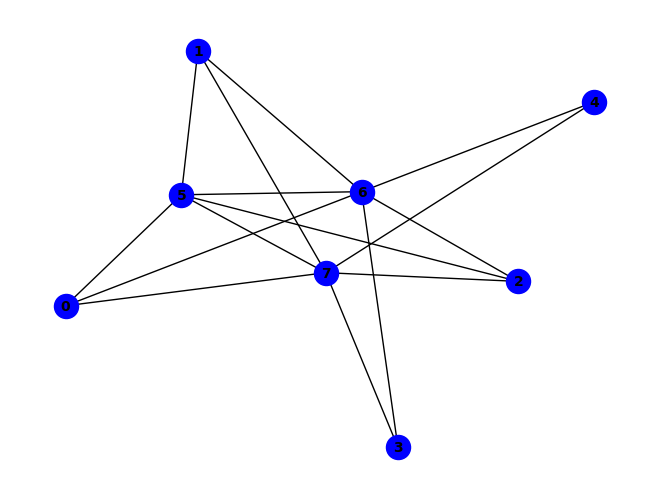


~e ^ (a & g & ~e) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (b & c & g & ~e) ^ (a & f & ~b & ~e) ^ (a & h & ~e & ~g) ^ (b & f & ~c & ~e) ^ (b & h & ~a & ~e) ^ (c & f & ~a & ~e) ^ (c & h & ~a & ~e) ^ (f & g & ~e & ~h) ^ (a & b & c & f & ~e) ^ (a & b & c & h & ~e) ^ (b & c & d & g & ~f) ^ (b & d & e & g & ~f) ^ (c & d & e & g & ~f) ^ (b & c & h & ~e & ~g) ^ (b & d & h & ~a & ~f) ^ (c & d & h & ~a & ~f) ^ (a & b & d & e & h & ~f) ^ (a & c & d & e & h & ~f) ^ (b & c & d & e & h & ~f) ^ (b & g & ~a & ~e & ~h) ^ (c & g & ~a & ~e & ~h) ^ (d & h & ~a & ~e & ~f) ^ (a & b & c & g & ~e & ~h) ^ (b & c & d & h & ~f & ~g) ^ (b & d & e & h & ~f & ~g) ^ (c & d & e & h & ~f & ~g) ^ (a & e & f & ~b & ~g & ~h) ^ (b & d & g & ~a & ~f & ~h) ^ (b & e & f & ~c & ~g & ~h) ^ (c & d & g & ~a & ~f & ~h) ^ (c & e & f & ~a & ~g & ~h) ^ (a & b & c & d & h & ~e & ~f) ^ (a & b & c & e & f & ~g & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (d & g & ~a & ~e & ~f & ~h) ^

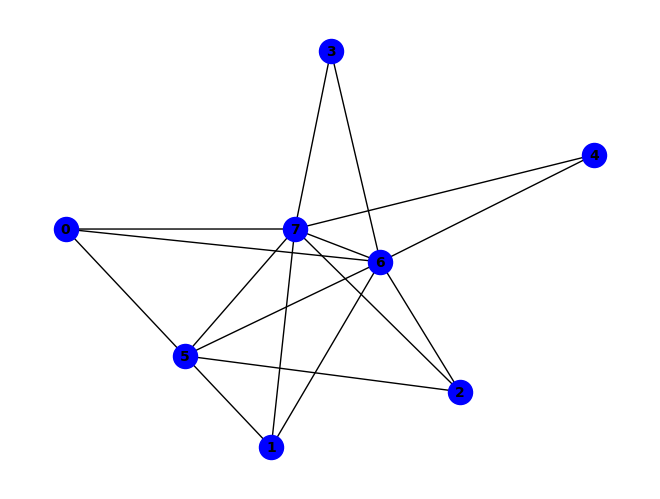


~g ^ (f & g) ^ (f & h) ^ (g & ~h) ^ (a & f & ~g) ^ (b & g & ~e) ^ (c & f & ~g) ^ (c & g & ~e) ^ (c & h & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (c & e & f & g) ^ (c & e & f & h) ^ (a & c & f & ~e) ^ (b & c & f & ~e) ^ (c & f & g & ~h) ^ (a & g & ~b & ~e) ^ (b & f & ~a & ~g) ^ (b & h & ~c & ~e) ^ (a & b & c & f & ~g) ^ (a & b & c & g & ~e) ^ (a & e & f & g & ~b) ^ (a & e & f & h & ~b) ^ (b & c & e & f & ~h) ^ (b & c & e & g & ~d) ^ (b & d & e & h & ~c) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~d) ^ (a & b & c & d & e & g) ^ (a & b & c & e & f & h) ^ (b & c & d & e & f & g) ^ (b & c & d & e & f & h) ^ (b & c & g & ~d & ~f) ^ (b & d & g & ~e & ~f) ^ (b & d & h & ~c & ~f) ^ (b & f & g & ~c & ~h) ^ (a & b & c & d & g & ~f) ^ (a & c & d & e & f & ~b) ^ (a & c & d & e & h & ~b) ^ (a & h & ~b & ~c & ~e) ^ (d & g & ~c & ~e & ~f) ^ (d & h & ~c & ~e & ~f) ^ (a & c & d & h & ~b & ~f) ^ (a & c & e & f & ~d & ~h) ^ (a & b & c & d & e & f & ~h) ^ (a & b & c & e & f & g & ~d) ^ (a & c & g & ~d & ~e & ~

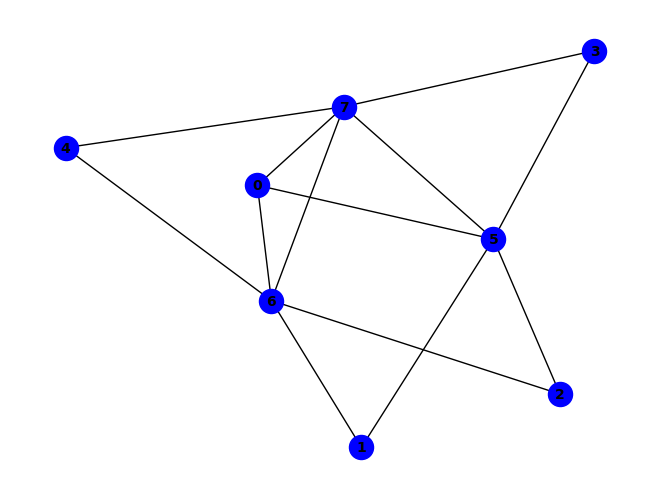


(~c & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (a & h & ~e) ^ (f & h & ~g) ^ (a & e & f & g) ^ (a & e & f & h) ^ (g & ~b & ~h) ^ (a & c & ~e & ~g) ^ (c & h & ~a & ~g) ^ (e & g & ~d & ~f) ^ (e & h & ~d & ~f) ^ (a & c & e & h & ~g) ^ (c & ~a & ~f & ~h) ^ (a & b & g & ~e & ~h) ^ (a & c & e & ~d & ~h) ^ (b & c & f & ~a & ~h) ^ (b & d & f & ~a & ~h) ^ (c & e & g & ~d & ~h) ^ (c & f & g & ~a & ~h) ^ (e & f & g & ~a & ~h) ^ (b & f & ~a & ~g & ~h) ^ (d & f & ~a & ~e & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & c & d & e & ~g & ~h) ^ (a & d & e & h & ~f & ~g) ^ (a & b & d & e & f & g & ~h) ^ (b & c & g & ~a & ~f & ~h) ^ (b & e & g & ~c & ~d & ~h) ^ (c & d & f & ~a & ~b & ~h) ^ (d & e & f & ~a & ~g & ~h) ^ (a & b & c & e & g & ~d & ~h) ^ (d & e & g & ~b & ~c & ~f & ~h) ^ (a & c & d & e & g & ~b & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

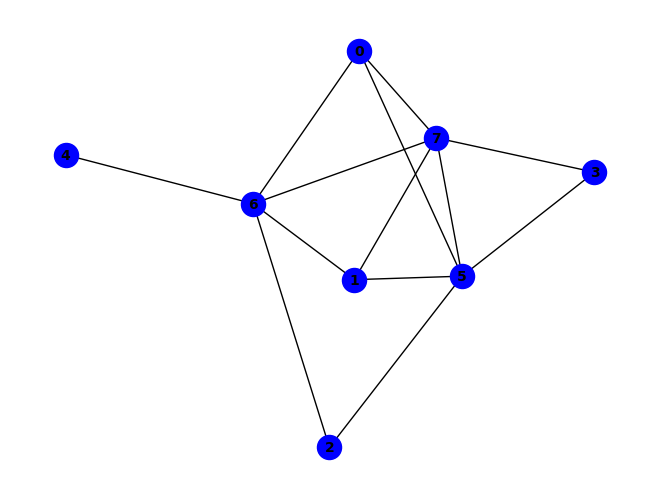


(~e & ~g) ^ (a & f & ~d) ^ (a & h & ~d) ^ (b & g & ~a) ^ (b & h & ~a) ^ (f & h & ~g) ^ (g & ~c & ~h) ^ (a & e & ~d & ~g) ^ (a & g & ~d & ~f) ^ (b & f & ~a & ~g) ^ (d & e & ~g & ~h) ^ (e & h & ~a & ~g) ^ (a & c & d & f & ~h) ^ (a & d & e & h & ~g) ^ (e & ~a & ~d & ~h) ^ (a & c & g & ~e & ~h) ^ (c & e & g & ~d & ~h) ^ (d & f & ~b & ~c & ~h) ^ (d & h & ~b & ~f & ~g) ^ (a & b & d & f & ~c & ~h) ^ (a & b & d & h & ~f & ~g) ^ (b & c & d & e & f & g & ~h) ^ (a & d & g & ~e & ~f & ~h) ^ (b & c & g & ~a & ~e & ~h) ^ (b & e & g & ~a & ~d & ~h) ^ (d & e & g & ~c & ~f & ~h) ^ (c & f & ~a & ~b & ~g & ~h) ^ (b & d & e & g & ~a & ~f & ~h) ^ (a & c & d & e & f & g & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


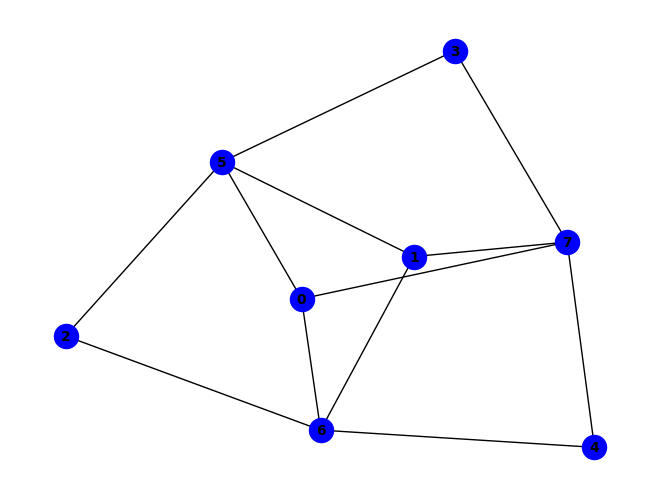


~c ^ (a & g & ~h) ^ (a & h & ~f) ^ (b & h & ~e) ^ (d & h & ~b) ^ (e & h & ~d) ^ (a & b & d & f) ^ (c & e & f & g) ^ (c & ~f & ~g) ^ (a & b & f & ~h) ^ (a & b & g & ~f) ^ (a & c & g & ~e) ^ (a & d & f & ~h) ^ (a & d & h & ~e) ^ (a & e & h & ~c) ^ (b & d & f & ~h) ^ (a & c & e & g & h) ^ (a & f & ~c & ~g) ^ (b & f & ~g & ~h) ^ (b & g & ~e & ~h) ^ (d & f & ~e & ~h) ^ (e & g & ~a & ~h) ^ (a & b & e & g & ~d) ^ (a & f & g & h & ~b) ^ (b & d & e & g & ~c) ^ (c & d & g & h & ~f) ^ (b & c & d & e & g & h) ^ (a & b & h & ~e & ~g) ^ (b & c & f & ~a & ~g) ^ (b & c & g & ~a & ~e) ^ (c & d & e & ~f & ~g) ^ (c & e & g & ~f & ~h) ^ (c & e & h & ~b & ~g) ^ (c & e & h & ~d & ~f) ^ (d & e & f & ~g & ~h) ^ (a & b & c & e & h & ~g) ^ (a & d & e & f & g & ~h) ^ (a & b & d & e & ~c & ~f) ^ (b & c & d & e & ~a & ~h) ^ (b & c & e & h & ~f & ~g) ^ (a & b & c & d & e & g & ~f) ^ (a & b & c & d & e & g & ~h) ^ (b & d & e & ~a & ~f & ~g) ^ (b & d & e & ~c & ~f & ~h) ^ (c & d & e & ~a & ~g & ~h) ^ (c & d & f & ~a

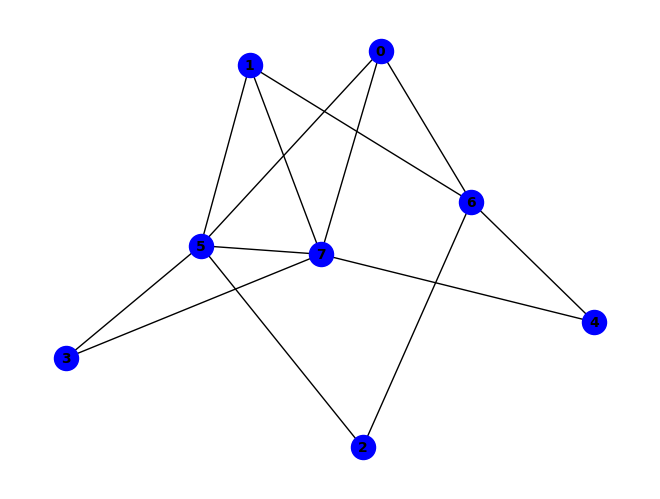


(~c & ~f) ^ (b & f & ~g) ^ (d & h & ~b) ^ (e & g & ~h) ^ (b & f & g & h) ^ (d & e & f & h) ^ (f & ~c & ~h) ^ (b & c & g & ~f) ^ (c & d & f & ~h) ^ (c & e & f & g & h) ^ (a & f & ~b & ~g) ^ (a & g & ~e & ~h) ^ (a & h & ~d & ~e) ^ (b & g & ~a & ~e) ^ (e & h & ~d & ~f) ^ (a & b & d & h & ~e) ^ (a & f & g & h & ~b) ^ (b & d & e & h & ~c) ^ (b & e & f & h & ~c) ^ (c & ~d & ~f & ~g) ^ (a & c & g & ~b & ~f) ^ (b & c & f & ~d & ~h) ^ (c & d & h & ~b & ~f) ^ (c & e & g & ~a & ~b) ^ (b & c & d & e & h & ~g) ^ (b & c & e & f & h & ~g) ^ (c & d & e & g & h & ~a) ^ (a & b & c & d & e & g & h) ^ (b & h & ~a & ~e & ~g) ^ (c & d & ~f & ~g & ~h) ^ (d & f & ~a & ~b & ~e) ^ (a & e & f & h & ~b & ~c) ^ (b & c & d & h & ~f & ~g) ^ (a & c & f & ~b & ~d & ~h) ^ (a & c & d & g & h & ~b & ~f) ^ (a & c & e & f & h & ~b & ~g) ^ (c & d & e & f & g & ~a & ~b) ^ (d & e & f & ~a & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

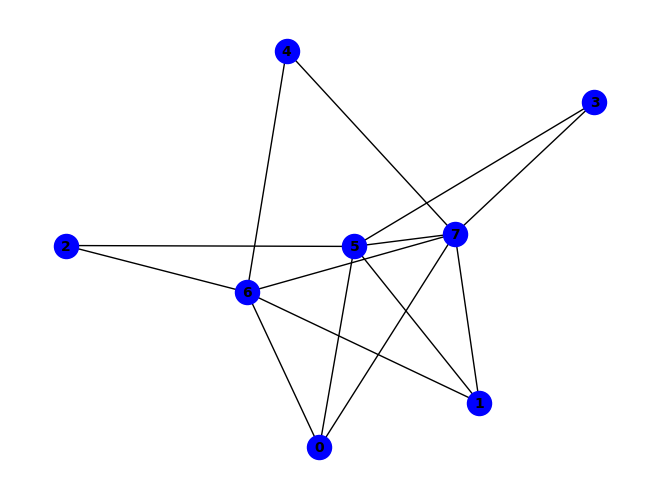


(g & ~h) ^ (~c & ~g) ^ (a & f & ~g) ^ (a & h & ~e) ^ (b & g & ~e) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~f & ~h) ^ (c & f & g & ~h) ^ (a & g & ~b & ~e) ^ (b & f & ~a & ~g) ^ (b & h & ~a & ~e) ^ (e & g & ~d & ~f) ^ (e & h & ~d & ~f) ^ (a & e & f & g & ~b) ^ (a & e & f & h & ~b) ^ (b & e & f & h & ~g) ^ (b & c & f & ~g & ~h) ^ (b & c & g & ~e & ~h) ^ (c & e & g & ~d & ~h) ^ (e & f & g & ~a & ~h) ^ (a & b & e & f & g & ~h) ^ (d & h & ~b & ~f & ~g) ^ (a & b & d & h & ~f & ~g) ^ (b & c & d & e & f & g & ~h) ^ (a & c & f & ~b & ~g & ~h) ^ (a & c & g & ~b & ~e & ~h) ^ (a & d & h & ~e & ~f & ~g) ^ (c & d & f & ~a & ~b & ~h) ^ (d & e & g & ~c & ~f & ~h) ^ (d & f & ~a & ~b & ~e & ~h) ^ (b & d & e & h & ~a & ~f & ~g) ^ (a & c & d & e & f & g & ~b & ~h) ^ (d & e & f & ~a & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


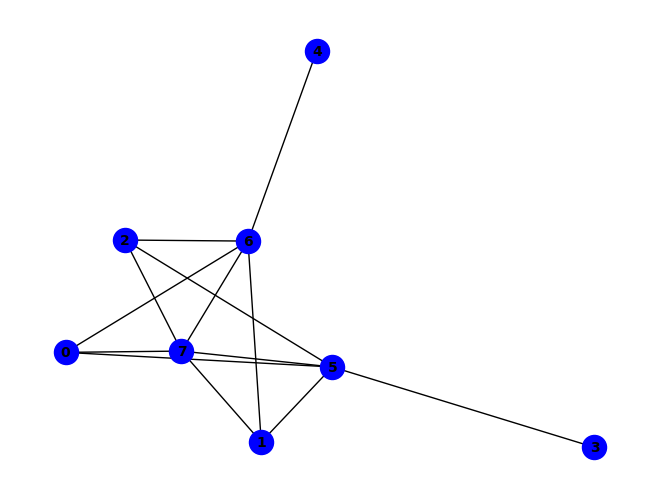


(g & ~h) ^ (a & d & f) ^ (~e & ~g) ^ (a & f & ~g) ^ (a & g & ~c) ^ (a & h & ~d) ^ (b & g & ~c) ^ (b & h & ~c) ^ (c & g & ~e) ^ (c & h & ~e) ^ (f & h & ~g) ^ (a & b & e & g) ^ (e & ~d & ~h) ^ (a & b & f & ~c) ^ (a & b & h & ~e) ^ (a & c & h & ~b) ^ (b & f & ~c & ~g) ^ (c & f & ~a & ~g) ^ (d & f & ~c & ~h) ^ (e & h & ~c & ~g) ^ (a & b & e & h & ~g) ^ (a & c & d & f & ~h) ^ (a & d & e & g & ~f) ^ (b & c & d & f & ~h) ^ (a & b & g & ~c & ~f) ^ (a & d & h & ~e & ~f) ^ (b & d & f & ~e & ~h) ^ (b & e & g & ~c & ~h) ^ (d & e & g & ~f & ~h) ^ (b & c & d & e & g & ~h) ^ (c & d & e & f & g & ~h) ^ (d & e & ~b & ~g & ~h) ^ (a & b & d & f & ~c & ~h) ^ (a & d & e & h & ~f & ~g) ^ (a & b & d & e & f & g & ~h) ^ (a & e & g & ~c & ~d & ~h) ^ (a & b & c & e & g & ~d & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (b & c & d & e & ~a & ~f & ~h) ^ (b & d & e & ~c & ~f & ~g & ~h) ^ (a & b & c & d & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

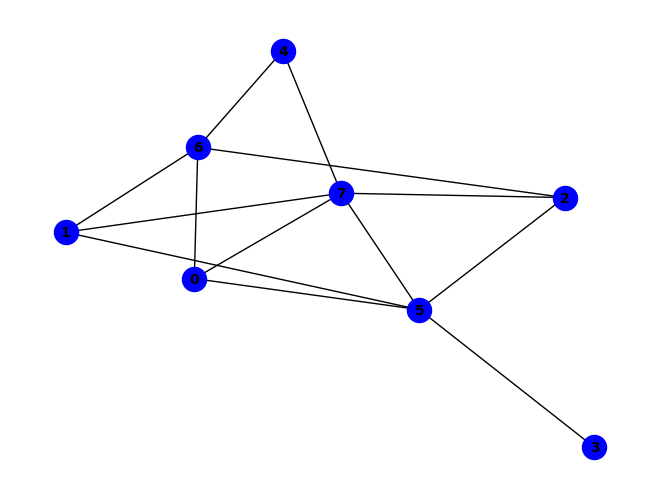


(f & ~h) ^ (~d & ~f) ^ (c & f & ~g) ^ (c & h & ~e) ^ (e & h & ~f) ^ (a & b & c & g) ^ (c & e & f & h) ^ (a & b & f & ~e) ^ (a & b & g & ~f) ^ (a & b & c & e & f) ^ (a & f & ~c & ~g) ^ (a & g & ~c & ~h) ^ (a & h & ~c & ~e) ^ (b & d & ~e & ~f) ^ (b & f & ~c & ~g) ^ (b & h & ~c & ~e) ^ (c & g & ~e & ~h) ^ (d & h & ~b & ~f) ^ (e & g & ~a & ~h) ^ (a & b & c & f & ~g) ^ (a & b & e & g & ~c) ^ (a & e & f & h & ~c) ^ (a & f & g & h & ~b) ^ (b & e & f & h & ~c) ^ (b & f & g & h & ~c) ^ (c & d & e & g & ~h) ^ (c & f & g & h & ~a) ^ (a & b & c & f & g & h) ^ (d & ~b & ~e & ~h) ^ (c & d & f & ~b & ~h) ^ (d & e & f & ~g & ~h) ^ (b & c & d & e & f & ~h) ^ (b & d & e & g & h & ~f) ^ (b & g & ~c & ~e & ~h) ^ (d & e & ~c & ~f & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & c & e & g & ~d & ~h) ^ (a & b & h & ~c & ~e & ~g) ^ (a & d & f & ~b & ~c & ~h) ^ (b & d & e & ~c & ~f & ~g) ^ (b & d & e & ~c & ~g & ~h) ^ (c & d & e & ~f & ~g & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (a & d & e & f & g & ~b & ~h) ^ (b & c 

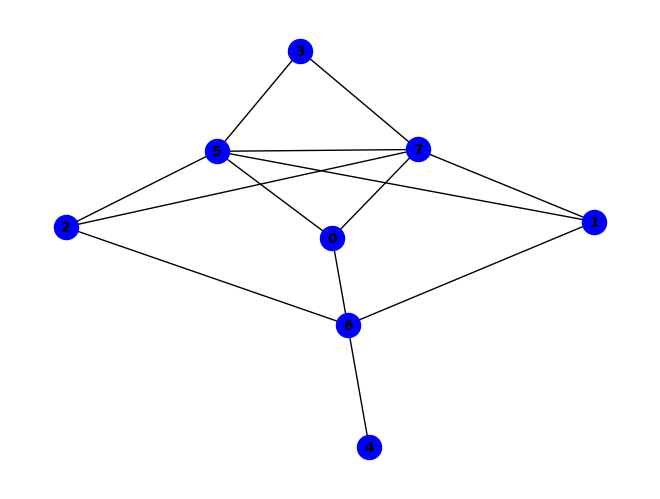


~f ^ (f & ~h) ^ (a & g & ~e) ^ (a & h & ~g) ^ (b & g & ~e) ^ (b & h & ~g) ^ (e & g & ~c) ^ (a & c & e & g) ^ (b & c & e & g) ^ (e & f & g & h) ^ (a & c & g & ~h) ^ (a & c & h & ~d) ^ (a & d & h & ~e) ^ (c & g & ~b & ~h) ^ (c & h & ~b & ~d) ^ (d & h & ~b & ~e) ^ (a & b & e & g & ~c) ^ (a & d & e & h & ~g) ^ (a & e & f & h & ~b) ^ (a & f & g & h & ~c) ^ (b & e & f & h & ~c) ^ (b & f & g & h & ~a) ^ (c & e & f & h & ~a) ^ (c & f & g & h & ~b) ^ (a & b & c & e & f & h) ^ (a & b & c & f & g & h) ^ (a & b & d & e & g & h) ^ (a & b & g & ~c & ~h) ^ (a & b & h & ~c & ~d) ^ (d & e & h & ~b & ~g) ^ (a & f & ~b & ~e & ~g) ^ (b & f & ~c & ~e & ~g) ^ (c & f & ~a & ~e & ~g) ^ (a & b & c & f & ~e & ~g) ^ (a & e & f & ~c & ~g & ~h) ^ (b & e & f & ~a & ~g & ~h) ^ (c & e & f & ~b & ~g & ~h) ^ (a & b & c & e & f & ~g & ~h) ^ (c & d & e & g & h & ~a & ~b) ^ (d & f & ~a & ~b & ~c & ~e) ^ (d & e & f & ~a & ~b & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

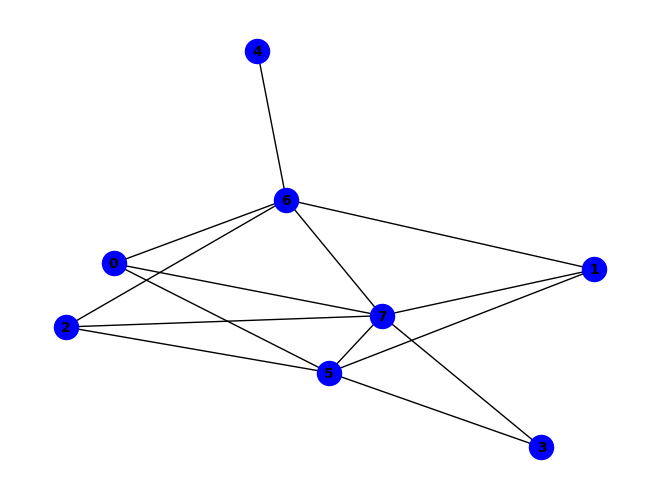


(g & ~h) ^ (~e & ~g) ^ (a & f & ~g) ^ (a & g & ~c) ^ (a & h & ~c) ^ (b & g & ~c) ^ (b & h & ~c) ^ (c & g & ~e) ^ (c & h & ~e) ^ (f & h & ~g) ^ (e & ~d & ~h) ^ (b & f & ~c & ~g) ^ (c & f & ~a & ~g) ^ (e & h & ~c & ~g) ^ (a & b & d & h & ~c) ^ (a & b & e & g & ~c) ^ (b & c & d & f & ~h) ^ (a & b & f & ~c & ~d) ^ (a & b & h & ~c & ~e) ^ (b & d & f & ~e & ~h) ^ (b & e & g & ~c & ~h) ^ (c & d & e & f & g & ~h) ^ (d & e & ~b & ~g & ~h) ^ (d & f & ~a & ~c & ~h) ^ (a & b & e & h & ~c & ~g) ^ (a & b & d & e & f & g & ~h) ^ (a & b & g & ~c & ~d & ~f) ^ (a & e & g & ~c & ~d & ~h) ^ (b & d & e & ~c & ~f & ~g) ^ (d & e & g & ~a & ~f & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (b & c & d & e & g & ~a & ~h) ^ (d & h & ~a & ~c & ~f & ~g) ^ (a & b & d & g & ~c & ~f & ~h) ^ (b & c & d & e & ~a & ~f & ~h) ^ (b & d & h & ~c & ~e & ~f & ~g) ^ (a & b & c & d & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

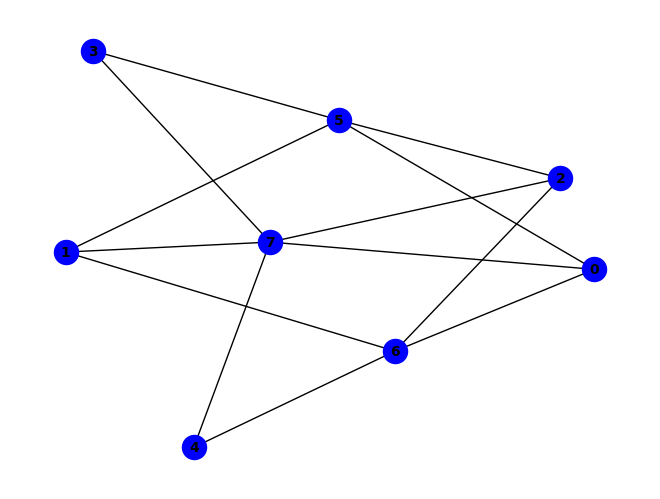


~c ^ (d & h & ~c) ^ (e & h & ~d) ^ (a & b & g & ~f) ^ (a & c & g & ~f) ^ (a & d & f & ~h) ^ (c & d & f & ~h) ^ (a & b & c & d & f) ^ (a & c & f & g & h) ^ (a & f & ~g & ~h) ^ (a & g & ~e & ~h) ^ (a & h & ~d & ~e) ^ (b & g & ~c & ~h) ^ (d & f & ~e & ~h) ^ (e & g & ~b & ~h) ^ (a & b & c & f & ~g) ^ (a & b & c & g & ~h) ^ (a & b & d & h & ~e) ^ (a & c & d & h & ~e) ^ (a & b & d & e & g & h) ^ (a & c & d & e & g & h) ^ (c & ~f & ~g & ~h) ^ (a & b & f & ~d & ~h) ^ (a & b & h & ~e & ~g) ^ (a & c & f & ~d & ~h) ^ (a & c & h & ~e & ~g) ^ (b & d & f & ~c & ~h) ^ (c & e & g & ~a & ~d) ^ (c & e & h & ~d & ~g) ^ (d & e & f & ~g & ~h) ^ (a & b & f & g & h & ~c) ^ (a & d & e & f & g & ~h) ^ (b & d & e & f & g & ~h) ^ (b & f & ~c & ~g & ~h) ^ (b & h & ~c & ~d & ~e) ^ (a & b & c & h & ~d & ~f) ^ (a & b & e & g & ~c & ~d) ^ (b & c & e & g & ~d & ~h) ^ (a & b & c & e & h & ~d & ~g) ^ (a & c & d & e & g & ~f & ~h) ^ (c & d & e & g & ~b & ~f & ~h) ^ (a & b & d & e & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS


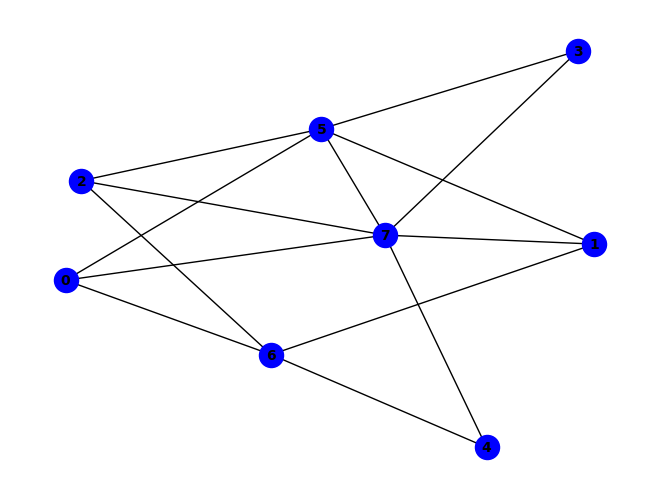


~f ^ (f & ~h) ^ (b & g & ~h) ^ (b & h & ~e) ^ (c & f & ~g) ^ (c & h & ~e) ^ (a & b & e & h) ^ (d & e & f & h) ^ (a & b & g & ~f) ^ (a & b & h & ~g) ^ (a & c & g & ~e) ^ (b & c & g & ~e) ^ (a & f & ~c & ~g) ^ (a & g & ~e & ~h) ^ (a & h & ~d & ~e) ^ (b & f & ~c & ~g) ^ (c & g & ~e & ~h) ^ (d & h & ~b & ~c) ^ (e & g & ~b & ~h) ^ (e & h & ~d & ~f) ^ (a & b & c & f & ~g) ^ (a & b & c & h & ~e) ^ (a & b & d & h & ~e) ^ (a & b & e & f & ~h) ^ (a & b & e & g & ~h) ^ (a & c & d & h & ~b) ^ (a & e & f & h & ~c) ^ (a & f & g & h & ~b) ^ (b & e & f & h & ~d) ^ (b & f & g & h & ~c) ^ (c & d & e & h & ~a) ^ (c & e & f & h & ~b) ^ (c & f & g & h & ~a) ^ (a & b & c & f & g & h) ^ (a & b & f & ~d & ~e) ^ (a & c & h & ~e & ~g) ^ (a & d & f & ~c & ~e) ^ (b & c & h & ~e & ~g) ^ (a & b & c & d & f & ~e) ^ (b & c & d & e & f & g & h) ^ (d & f & ~b & ~c & ~e) ^ (a & b & c & g & ~e & ~h) ^ (b & d & e & h & ~c & ~f) ^ (a & b & c & d & e & h & ~f) ^ (a & b & c & e & f & h & ~d) ^ (b & c & d & e & f & ~a & ~g) 

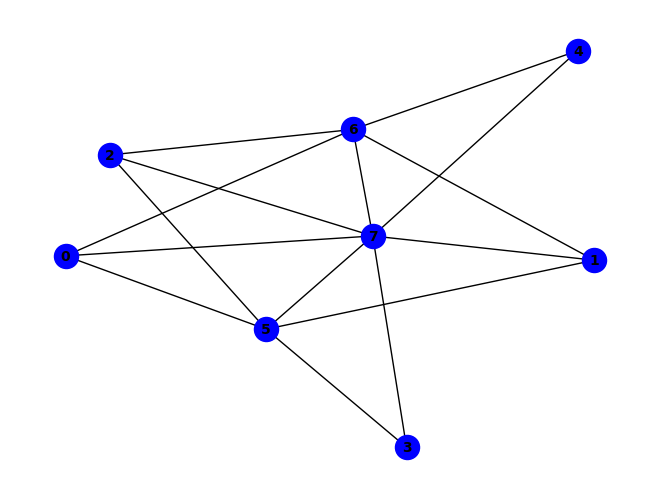


~g ^ (g & ~h) ^ (a & g & ~e) ^ (b & f & ~g) ^ (c & f & ~g) ^ (c & g & ~e) ^ (c & h & ~e) ^ (f & h & ~g) ^ (a & c & f & ~e) ^ (e & f & g & ~h) ^ (a & f & ~b & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~c & ~e) ^ (e & g & ~d & ~f) ^ (e & h & ~d & ~f) ^ (b & c & f & ~a & ~e) ^ (b & c & g & ~e & ~f) ^ (d & e & f & ~g & ~h) ^ (a & h & ~b & ~c & ~e) ^ (a & d & e & f & ~c & ~g) ^ (b & c & e & f & ~g & ~h) ^ (b & d & e & f & ~a & ~g) ^ (b & d & e & g & ~c & ~f) ^ (b & d & e & h & ~c & ~f) ^ (b & e & f & h & ~d & ~g) ^ (c & d & e & f & ~b & ~g) ^ (c & d & e & h & ~f & ~g) ^ (c & e & f & h & ~d & ~g) ^ (a & b & c & d & e & f & ~g) ^ (b & c & d & e & f & h & ~g) ^ (a & c & g & ~b & ~e & ~f) ^ (d & e & g & ~b & ~f & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (d & h & ~b & ~c & ~f & ~g) ^ (a & c & e & f & ~b & ~g & ~h) ^ (a & e & f & h & ~b & ~d & ~g) ^ (a & c & d & e & f & h & ~b & ~g) ^ (d & f & ~a & ~b & ~c & ~e & ~h) ^ (a & d & h & ~b & ~c & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


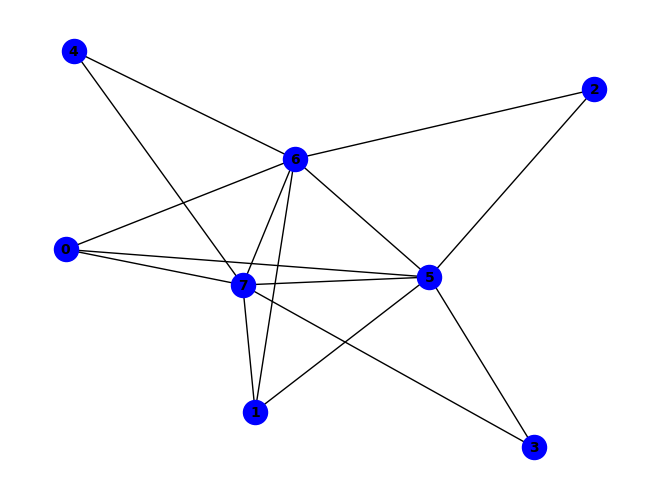


(f & g) ^ (f & h) ^ (g & ~h) ^ (~c & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & h & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (a & f & g & ~h) ^ (a & f & ~b & ~g) ^ (a & g & ~b & ~e) ^ (a & h & ~b & ~e) ^ (b & f & ~d & ~g) ^ (d & f & ~a & ~g) ^ (a & b & d & f & ~g) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (d & e & f & h & ~g) ^ (c & ~d & ~f & ~h) ^ (a & c & g & ~e & ~h) ^ (b & c & f & ~e & ~h) ^ (b & f & g & ~a & ~h) ^ (c & d & g & ~f & ~h) ^ (c & e & g & ~f & ~h) ^ (a & d & e & f & g & ~h) ^ (c & d & ~b & ~g & ~h) ^ (a & e & f & g & ~b & ~d) ^ (a & e & f & h & ~b & ~d) ^ (b & c & e & f & ~g & ~h) ^ (a & c & f & ~b & ~e & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (b & c & g & ~a & ~e & ~h) ^ (b & d & e & f & g & ~a & ~h) ^ (d & h & ~a & ~b & ~e & ~g) ^ (a & c & d & f & ~b & ~g & ~h) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


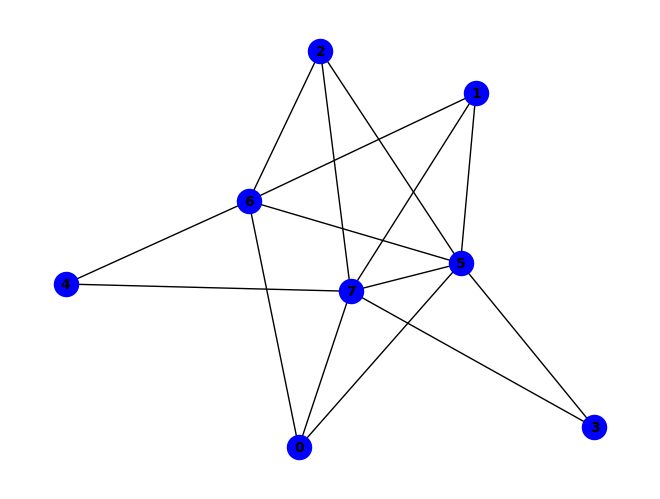


~e ^ (c & h & ~e) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & c & g & ~e) ^ (b & c & g & ~e) ^ (a & f & ~b & ~e) ^ (a & g & ~e & ~h) ^ (a & h & ~b & ~e) ^ (b & f & ~c & ~e) ^ (b & h & ~d & ~e) ^ (c & f & ~a & ~e) ^ (c & g & ~e & ~h) ^ (f & g & ~e & ~h) ^ (a & b & c & f & ~e) ^ (a & b & c & h & ~e) ^ (a & c & d & f & ~g) ^ (a & c & d & h & ~e) ^ (b & c & d & h & ~e) ^ (a & b & c & d & e & f) ^ (a & b & c & d & e & h) ^ (a & b & c & d & f & g) ^ (a & c & d & e & f & h) ^ (a & c & h & ~e & ~g) ^ (b & c & h & ~e & ~g) ^ (b & d & f & ~c & ~g) ^ (a & b & c & d & h & ~f) ^ (b & d & e & f & h & ~c) ^ (b & d & f & g & h & ~c) ^ (b & g & ~a & ~e & ~h) ^ (d & f & ~c & ~g & ~h) ^ (d & h & ~c & ~e & ~f) ^ (a & b & c & g & ~e & ~h) ^ (a & c & d & f & g & h & ~b) ^ (a & d & f & ~b & ~g & ~h) ^ (a & d & h & ~b & ~e & ~f) ^ (a & e & f & ~b & ~g & ~h) ^ (b & e & f & ~c & ~g & ~h) ^ (c & e & f & ~a & ~g & ~h) ^ (a & b & c & d & f & ~e & ~h) ^ (a & b & c & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

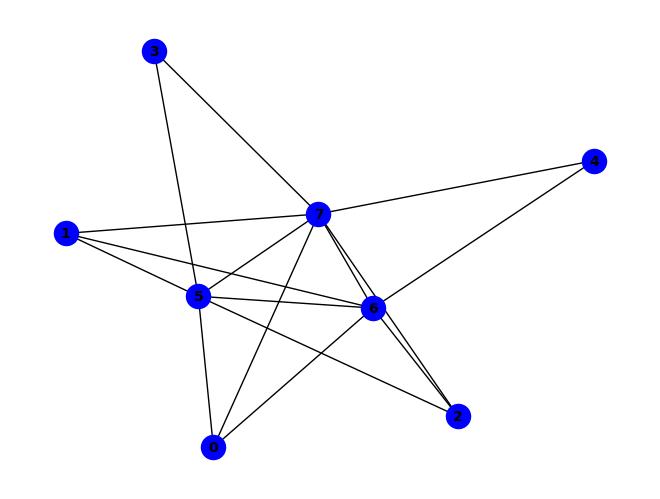


~g ^ (f & g) ^ (f & h) ^ (g & ~h) ^ (b & g & ~e) ^ (c & f & ~g) ^ (c & g & ~e) ^ (c & h & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (a & c & f & ~e) ^ (b & c & f & ~e) ^ (c & f & g & ~h) ^ (a & f & ~d & ~g) ^ (a & g & ~b & ~e) ^ (b & h & ~c & ~e) ^ (d & f & ~c & ~g) ^ (a & b & c & g & ~e) ^ (b & c & d & f & ~g) ^ (b & c & e & f & ~h) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (d & e & f & h & ~g) ^ (a & c & g & ~e & ~f) ^ (b & c & g & ~e & ~f) ^ (b & f & g & ~c & ~h) ^ (c & d & e & f & g & ~h) ^ (a & h & ~b & ~c & ~e) ^ (b & f & ~a & ~d & ~g) ^ (a & b & c & f & ~d & ~g) ^ (a & c & d & f & ~e & ~g) ^ (a & c & e & f & ~d & ~h) ^ (a & e & f & g & ~b & ~d) ^ (a & e & f & h & ~b & ~d) ^ (a & b & c & e & f & g & ~d) ^ (a & b & c & e & f & h & ~d) ^ (b & c & d & e & f & h & ~g) ^ (a & f & g & ~b & ~c & ~h) ^ (a & d & e & f & g & ~c & ~h) ^ (b & d & e & f & g & ~a & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (d & h & ~a & ~b & ~c & ~e & ~g)
PASS
PASS

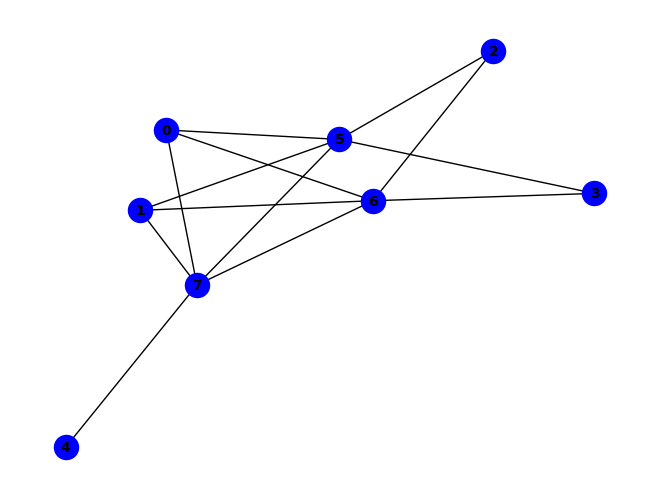


(~d & ~g) ^ (a & h & ~e) ^ (b & f & ~e) ^ (b & g & ~f) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~f & ~h) ^ (g & ~c & ~h) ^ (b & e & f & ~h) ^ (c & d & g & ~h) ^ (d & f & g & ~h) ^ (a & f & ~b & ~g) ^ (a & g & ~b & ~e) ^ (b & h & ~a & ~e) ^ (e & h & ~f & ~g) ^ (b & e & g & h & ~f) ^ (a & c & g & ~d & ~h) ^ (a & d & f & ~c & ~h) ^ (a & d & g & ~f & ~h) ^ (a & e & g & ~b & ~h) ^ (b & d & g & ~a & ~h) ^ (a & c & d & f & g & ~h) ^ (a & e & f & h & ~b & ~g) ^ (a & c & f & ~b & ~g & ~h) ^ (b & c & g & ~a & ~d & ~h) ^ (b & d & f & ~a & ~g & ~h) ^ (a & b & c & d & f & ~g & ~h) ^ (c & f & ~b & ~d & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


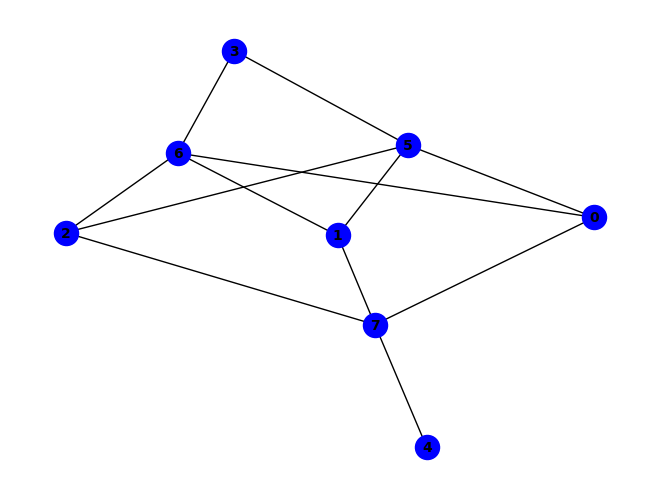


(~d & ~e) ^ (a & b & e & h) ^ (b & c & e & h) ^ (d & ~f & ~g) ^ (e & ~d & ~h) ^ (a & b & f & ~h) ^ (a & c & f & ~h) ^ (a & c & h & ~g) ^ (b & c & h & ~g) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~e) ^ (b & g & ~d & ~h) ^ (b & h & ~d & ~e) ^ (c & g & ~d & ~h) ^ (c & h & ~d & ~e) ^ (a & b & d & f & ~g) ^ (a & c & d & f & ~g) ^ (a & c & e & h & ~b) ^ (a & c & d & e & g & h) ^ (b & c & d & e & g & h) ^ (a & b & h & ~c & ~g) ^ (a & c & g & ~d & ~f) ^ (b & c & g & ~d & ~f) ^ (b & d & h & ~f & ~g) ^ (a & b & d & f & g & ~h) ^ (a & c & d & f & g & ~h) ^ (a & c & f & g & h & ~d) ^ (b & c & f & g & h & ~d) ^ (a & f & ~d & ~g & ~h) ^ (b & f & ~d & ~g & ~h) ^ (c & f & ~d & ~g & ~h) ^ (a & b & c & d & f & h & ~g) ^ (a & b & d & e & g & h & ~c) ^ (a & c & d & e & f & h & ~g) ^ (a & b & g & ~c & ~d & ~f) ^ (a & d & h & ~e & ~f & ~g) ^ (b & c & f & ~a & ~d & ~h) ^ (c & d & h & ~e & ~f & ~g) ^ (d & e & h & ~b & ~f & ~g) ^ (a & b & f & g & h & ~c & ~d) ^ (b & c & d & f & h & ~e & ~g) ^ (a & b & d & e & f & 

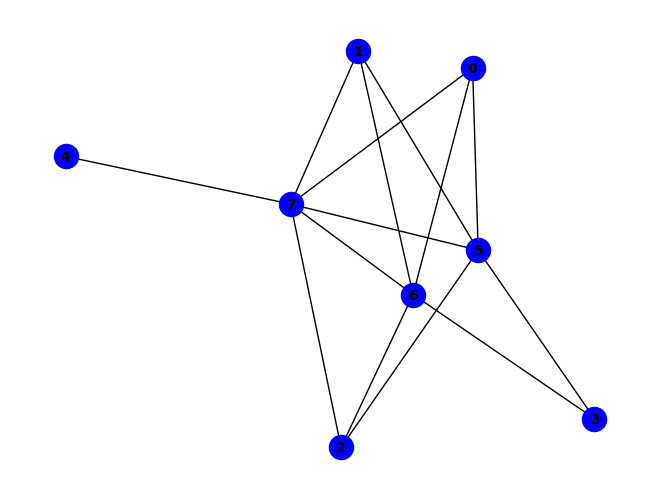


(g & ~h) ^ (~d & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~f & ~h) ^ (d & f & g & ~h) ^ (a & f & ~b & ~g) ^ (a & g & ~b & ~e) ^ (a & h & ~b & ~e) ^ (b & f & ~c & ~g) ^ (b & g & ~c & ~e) ^ (b & h & ~c & ~e) ^ (c & f & ~a & ~g) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (e & h & ~f & ~g) ^ (a & b & c & f & ~g) ^ (a & b & c & g & ~e) ^ (a & b & c & h & ~e) ^ (a & e & f & h & ~g) ^ (a & e & g & ~c & ~h) ^ (b & d & f & ~c & ~h) ^ (c & d & f & ~a & ~h) ^ (c & d & g & ~f & ~h) ^ (c & e & g & ~b & ~h) ^ (a & b & c & e & g & ~h) ^ (a & c & d & f & g & ~h) ^ (b & e & f & g & ~a & ~c) ^ (b & e & f & h & ~a & ~c) ^ (c & e & f & h & ~a & ~g) ^ (a & d & f & ~b & ~g & ~h) ^ (a & d & g & ~b & ~c & ~h) ^ (b & d & g & ~c & ~f & ~h) ^ (b & e & g & ~a & ~f & ~h) ^ (a & b & c & d & f & ~g & ~h) ^ (b & c & e & f & g & ~a & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

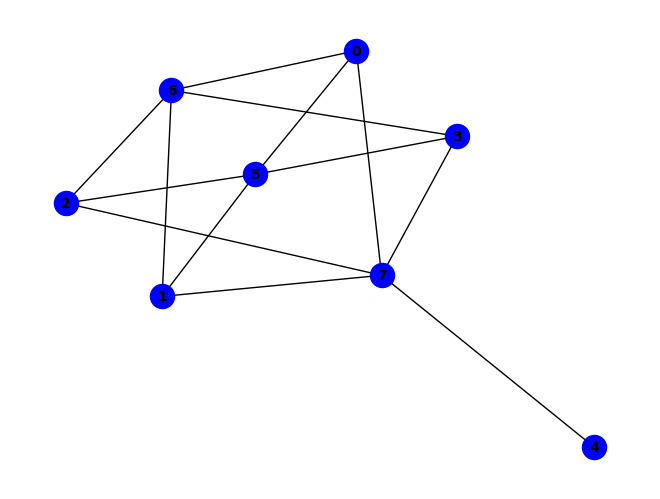


(~d & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (c & g & ~h) ^ (c & h & ~e) ^ (b & c & d & h) ^ (b & d & e & h) ^ (c & d & e & h) ^ (e & ~d & ~h) ^ (a & b & g & ~f) ^ (a & c & h & ~g) ^ (b & c & g & ~f) ^ (b & c & h & ~g) ^ (b & d & f & ~h) ^ (b & d & g & ~f) ^ (b & d & h & ~g) ^ (c & d & f & ~h) ^ (c & d & g & ~f) ^ (c & d & h & ~g) ^ (b & d & f & g & h) ^ (c & d & f & g & h) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~e) ^ (b & f & ~g & ~h) ^ (c & f & ~g & ~h) ^ (a & b & d & h & ~c) ^ (a & c & d & f & ~g) ^ (a & c & d & h & ~f) ^ (a & c & e & h & ~d) ^ (b & c & d & g & ~h) ^ (b & c & e & h & ~d) ^ (d & ~f & ~g & ~h) ^ (a & b & f & ~d & ~h) ^ (a & b & h & ~c & ~g) ^ (a & c & f & ~b & ~h) ^ (a & c & g & ~b & ~f) ^ (b & c & f & ~d & ~h) ^ (a & b & c & d & f & ~h) ^ (a & b & f & g & h & ~c) ^ (a & c & f & g & h & ~d) ^ (b & c & d & f & g & ~a) ^ (b & c & f & g & h & ~d) ^ (a & b & c & d & f & g & h) ^ (a & f & ~d & ~g & ~h) ^ (a & b & d & g & ~f & ~h) ^ (a & b & e & h & ~c & ~d) ^ (a & c & d & g & ~

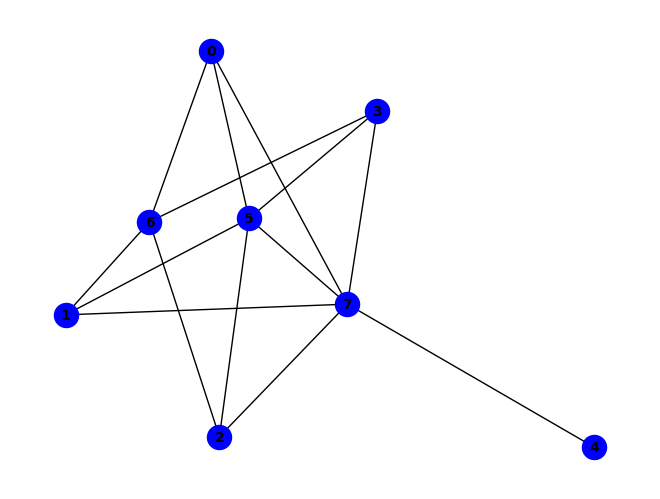


(f & ~h) ^ (~d & ~f) ^ (a & g & ~h) ^ (b & h & ~e) ^ (a & d & e & h) ^ (d & ~g & ~h) ^ (a & c & f & ~e) ^ (a & c & g & ~f) ^ (a & d & g & ~c) ^ (a & d & h & ~g) ^ (b & d & f & ~e) ^ (b & d & g & ~f) ^ (b & d & h & ~g) ^ (d & f & g & ~h) ^ (a & h & ~b & ~e) ^ (b & f & ~c & ~g) ^ (b & g & ~a & ~h) ^ (c & f & ~d & ~g) ^ (c & g & ~d & ~h) ^ (c & h & ~d & ~e) ^ (e & h & ~d & ~f) ^ (a & b & d & g & ~h) ^ (a & b & d & h & ~e) ^ (a & c & d & f & ~g) ^ (a & c & e & h & ~d) ^ (b & c & d & f & ~g) ^ (b & c & e & h & ~a) ^ (b & d & e & f & ~h) ^ (b & d & e & h & ~c) ^ (b & e & f & h & ~c) ^ (c & e & f & h & ~d) ^ (c & f & g & h & ~d) ^ (a & b & c & d & e & h) ^ (a & b & c & e & f & h) ^ (b & c & d & e & f & h) ^ (b & c & g & ~a & ~d) ^ (b & c & h & ~d & ~g) ^ (a & c & d & e & f & ~b) ^ (a & f & ~b & ~d & ~g) ^ (a & b & c & f & ~d & ~g) ^ (a & c & e & f & ~d & ~h) ^ (a & e & f & h & ~b & ~d) ^ (b & f & g & h & ~c & ~d) ^ (a & b & c & d & e & f & ~h) ^ (a & c & h & ~b & ~d & ~g) ^ (a & f & g & h & 

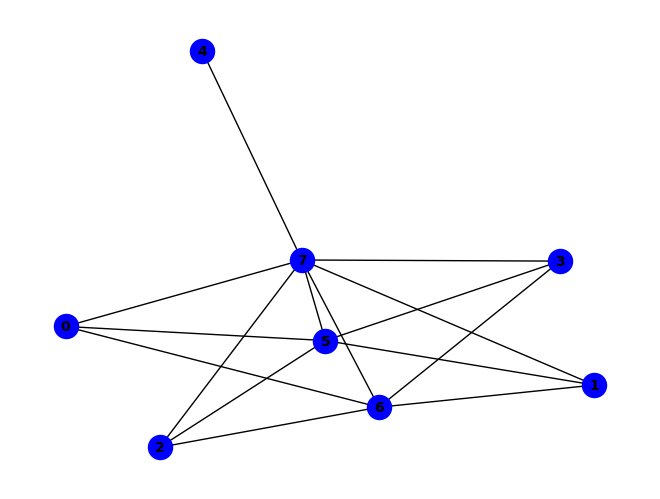


(~d & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (c & f & ~g) ^ (c & g & ~e) ^ (b & e & f & h) ^ (g & ~d & ~h) ^ (a & c & f & ~e) ^ (a & c & g & ~f) ^ (b & c & f & ~e) ^ (b & d & f & ~e) ^ (b & d & g & ~f) ^ (c & d & f & ~e) ^ (c & d & g & ~f) ^ (f & h & ~d & ~g) ^ (a & b & c & g & ~e) ^ (b & c & d & f & ~g) ^ (b & c & d & g & ~e) ^ (b & e & f & g & ~d) ^ (c & d & e & f & ~h) ^ (c & e & f & h & ~g) ^ (d & ~f & ~g & ~h) ^ (b & c & g & ~e & ~f) ^ (b & e & g & ~f & ~h) ^ (c & e & g & ~b & ~h) ^ (a & b & e & g & h & ~f) ^ (a & c & e & g & h & ~f) ^ (b & d & e & g & h & ~a) ^ (c & d & e & g & h & ~f) ^ (a & b & d & e & f & g & h) ^ (a & f & ~b & ~d & ~e) ^ (a & g & ~b & ~d & ~f) ^ (a & h & ~c & ~d & ~e) ^ (b & h & ~a & ~d & ~e) ^ (c & h & ~b & ~d & ~e) ^ (e & h & ~d & ~f & ~g) ^ (a & b & c & f & ~d & ~g) ^ (a & b & c & h & ~d & ~e) ^ (a & b & e & f & ~d & ~h) ^ (a & c & d & f & ~e & ~g) ^ (a & c & d & g & ~b & ~e) ^ (a & e & g & h & ~d & ~f) ^ (b & c & e & f & ~g & ~h) ^ (b & d & e & f & ~g & ~h)

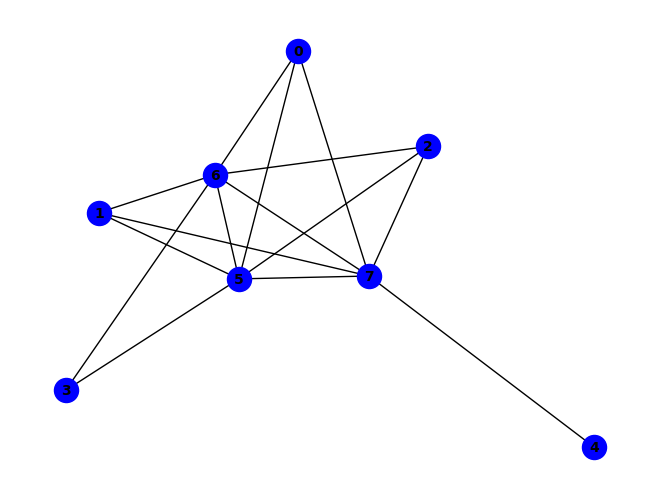


(g & ~h) ^ (~d & ~g) ^ (a & f & ~g) ^ (a & g & ~e) ^ (b & f & ~g) ^ (b & g & ~e) ^ (c & f & ~g) ^ (c & g & ~e) ^ (c & h & ~e) ^ (d & h & ~g) ^ (e & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (b & e & f & h) ^ (d & ~f & ~h) ^ (a & b & f & ~e) ^ (a & b & g & ~f) ^ (a & c & f & ~e) ^ (b & c & f & ~e) ^ (b & c & g & ~f) ^ (b & e & g & ~h) ^ (c & e & g & ~h) ^ (e & f & g & ~h) ^ (a & b & e & g & h) ^ (b & c & e & g & h) ^ (b & h & ~c & ~e) ^ (a & b & c & f & ~g) ^ (a & b & c & g & ~e) ^ (a & b & e & f & ~h) ^ (a & e & f & h & ~g) ^ (c & e & f & h & ~g) ^ (a & b & c & e & f & h) ^ (a & c & g & ~e & ~f) ^ (a & d & f & ~c & ~h) ^ (a & d & g & ~c & ~h) ^ (a & e & g & ~c & ~h) ^ (a & f & g & ~c & ~h) ^ (b & d & f & ~a & ~h) ^ (b & d & g & ~a & ~h) ^ (c & d & f & ~b & ~h) ^ (c & d & g & ~b & ~h) ^ (c & f & g & ~b & ~h) ^ (a & b & c & d & f & ~h) ^ (a & b & c & d & g & ~h) ^ (a & b & c & e & g & ~h) ^ (a & h & ~b & ~c & ~e) ^ (a & c & e & f & ~g & ~h) ^ (b & c & e & f & ~g & ~h) ^ (b & e & f & g & ~

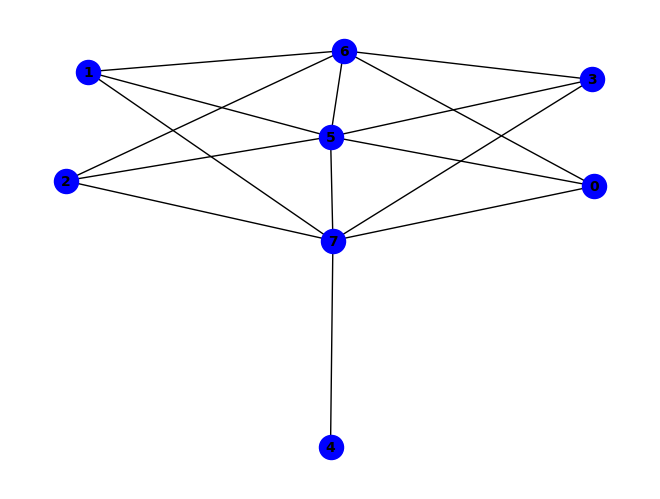


~e ^ (c & h & ~e) ^ (d & e & ~c) ^ (d & h & ~c) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & d & g & ~c) ^ (b & c & g & ~d) ^ (a & g & ~b & ~h) ^ (a & h & ~c & ~e) ^ (b & g & ~d & ~h) ^ (c & f & ~b & ~e) ^ (c & g & ~a & ~h) ^ (d & f & ~c & ~e) ^ (d & g & ~c & ~h) ^ (a & b & d & g & ~h) ^ (a & d & e & h & ~c) ^ (b & c & d & f & ~e) ^ (b & c & e & h & ~d) ^ (a & d & h & ~c & ~g) ^ (b & c & h & ~d & ~g) ^ (b & e & f & ~a & ~h) ^ (c & d & e & ~f & ~h) ^ (c & e & f & ~b & ~h) ^ (d & e & f & ~b & ~h) ^ (a & b & c & e & f & ~h) ^ (b & c & d & e & f & ~h) ^ (a & f & ~c & ~d & ~e) ^ (b & f & ~a & ~d & ~e) ^ (b & h & ~a & ~d & ~e) ^ (a & b & c & f & ~d & ~e) ^ (a & b & c & g & ~d & ~h) ^ (a & b & c & h & ~d & ~e) ^ (a & e & f & ~c & ~d & ~h) ^ (a & b & d & e & f & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


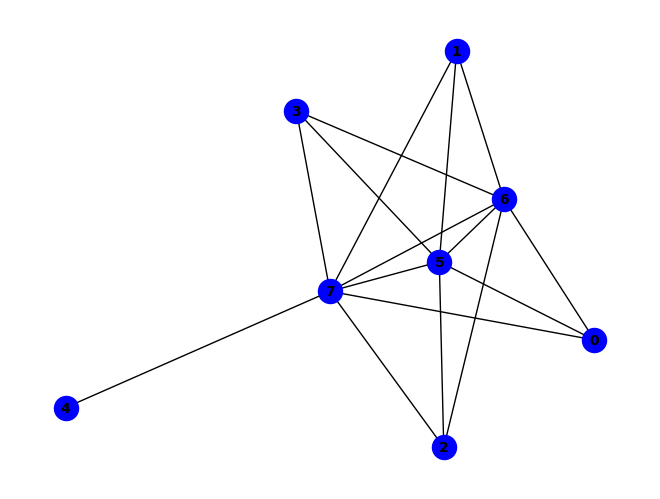


~g ^ (g & ~h) ^ (a & f & ~e) ^ (a & g & ~f) ^ (e & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & d & g & ~e) ^ (e & f & g & ~h) ^ (b & f & ~c & ~g) ^ (b & g & ~c & ~e) ^ (b & h & ~c & ~e) ^ (c & h & ~d & ~e) ^ (d & f & ~b & ~e) ^ (d & g & ~b & ~f) ^ (d & h & ~b & ~e) ^ (a & b & c & f & ~g) ^ (a & b & c & g & ~e) ^ (a & b & c & h & ~e) ^ (a & e & g & h & ~f) ^ (b & c & d & f & ~g) ^ (b & c & d & g & ~e) ^ (b & e & f & h & ~c) ^ (d & e & f & g & ~c) ^ (d & e & g & h & ~b) ^ (b & c & e & f & g & h) ^ (a & b & f & ~d & ~g) ^ (a & b & g & ~d & ~e) ^ (a & b & h & ~d & ~e) ^ (a & d & f & ~e & ~g) ^ (a & e & f & ~d & ~h) ^ (b & f & g & ~c & ~h) ^ (c & f & g & ~d & ~h) ^ (d & f & g & ~b & ~h) ^ (a & b & c & d & f & ~e) ^ (a & b & c & d & g & ~f) ^ (a & b & c & e & g & ~h) ^ (a & b & e & f & h & ~d) ^ (c & d & e & f & g & ~h) ^ (c & d & e & f & h & ~b) ^ (a & b & c & d & e & g & h) ^ (a & h & ~c & ~d & ~e) ^ (c & f & ~a & ~d & ~g) ^ (c & g & ~a & ~d & ~e) ^ (a & c & e & g & ~d & ~h) ^ (b & c & d

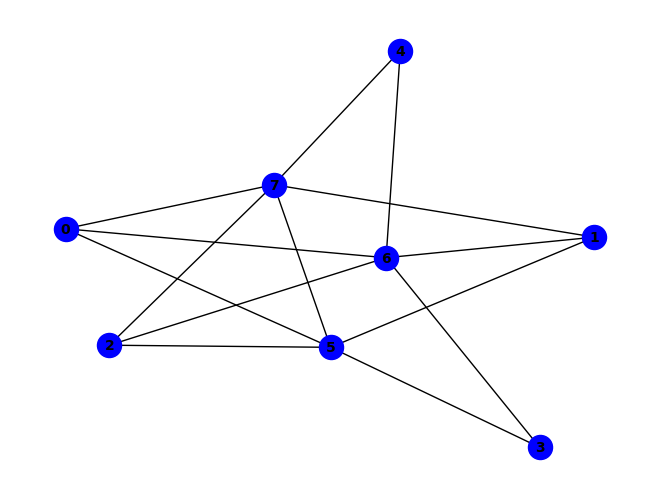


(~d & ~f) ^ (a & h & ~e) ^ (b & d & ~e) ^ (e & g & ~h) ^ (e & h & ~f) ^ (c & f & g & h) ^ (f & ~d & ~h) ^ (b & c & d & e & g) ^ (d & e & f & g & h) ^ (a & f & ~b & ~g) ^ (b & f & ~c & ~g) ^ (b & g & ~e & ~h) ^ (b & h & ~a & ~e) ^ (c & f & ~a & ~g) ^ (c & h & ~a & ~e) ^ (a & b & c & f & ~g) ^ (a & b & d & f & ~e) ^ (b & d & f & h & ~a) ^ (b & f & g & h & ~c) ^ (c & e & f & h & ~d) ^ (a & b & c & d & e & f) ^ (d & ~b & ~f & ~g) ^ (a & d & f & ~c & ~h) ^ (b & c & g & ~a & ~e) ^ (b & d & e & ~f & ~g) ^ (c & d & f & ~b & ~h) ^ (c & d & g & ~b & ~f) ^ (d & e & g & ~a & ~c) ^ (a & b & d & e & f & ~h) ^ (a & b & d & e & g & ~c) ^ (a & b & e & f & h & ~c) ^ (c & d & e & f & h & ~g) ^ (a & g & ~b & ~e & ~h) ^ (c & g & ~a & ~e & ~h) ^ (a & e & f & h & ~c & ~d) ^ (a & f & g & h & ~b & ~c) ^ (b & e & f & h & ~c & ~d) ^ (a & b & d & e & f & h & ~g) ^ (a & d & g & ~b & ~c & ~f) ^ (b & c & h & ~a & ~e & ~g) ^ (a & b & c & d & f & ~e & ~h) ^ (a & d & e & f & h & ~c & ~g) ^ (b & c & d & e & f & ~a & ~g

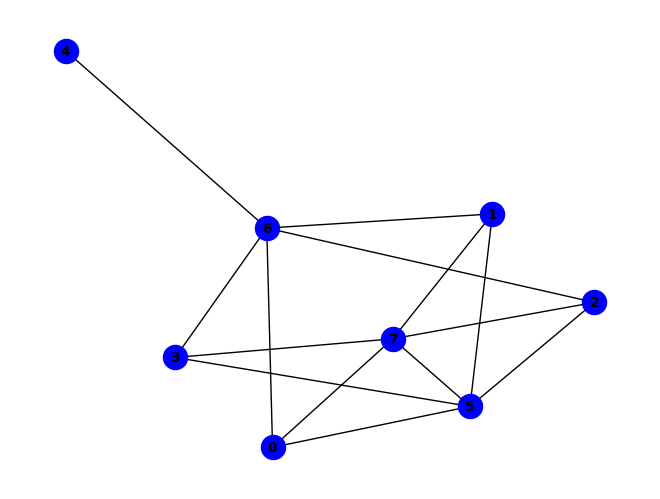


~f ^ (f & ~h) ^ (c & h & ~b) ^ (d & e & f & h) ^ (e & f & g & h) ^ (a & b & h & ~d) ^ (a & g & ~c & ~e) ^ (a & h & ~c & ~g) ^ (b & g & ~d & ~e) ^ (b & h & ~d & ~g) ^ (c & g & ~b & ~h) ^ (d & f & ~e & ~g) ^ (d & h & ~a & ~c) ^ (e & g & ~c & ~d) ^ (a & b & c & g & ~e) ^ (a & b & c & h & ~g) ^ (a & b & e & g & ~d) ^ (a & d & e & g & ~c) ^ (b & c & d & h & ~a) ^ (b & c & e & g & ~d) ^ (b & f & g & h & ~c) ^ (c & f & g & h & ~d) ^ (d & f & g & h & ~b) ^ (a & b & c & d & e & g) ^ (b & c & d & f & g & h) ^ (a & b & g & ~d & ~h) ^ (d & g & ~a & ~c & ~h) ^ (a & e & f & h & ~c & ~d) ^ (b & c & d & g & ~a & ~h) ^ (b & e & f & h & ~a & ~d) ^ (c & e & f & h & ~b & ~d) ^ (a & b & c & e & f & h & ~d) ^ (a & e & f & ~c & ~g & ~h) ^ (c & e & f & ~d & ~g & ~h) ^ (d & e & f & ~a & ~g & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (a & f & ~b & ~d & ~e & ~g) ^ (b & f & ~c & ~d & ~e & ~g) ^ (c & f & ~a & ~d & ~e & ~g) ^ (a & b & c & f & ~d & ~e & ~g) ^ (a & f & g & h & ~b & ~c & ~d) ^ (b & e & f & ~a & ~c & ~d &

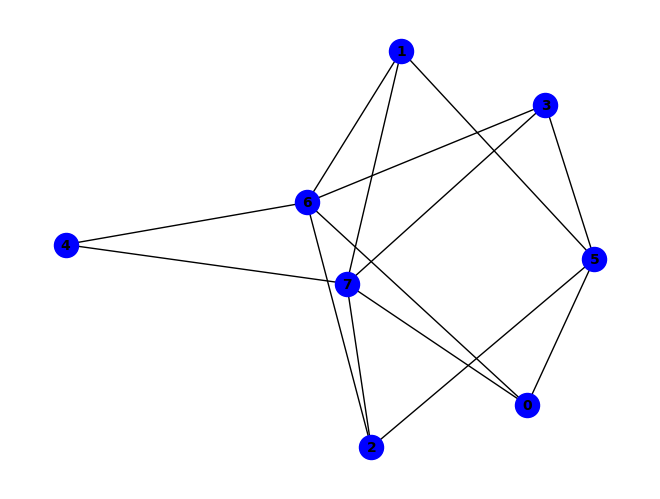


~c ^ (d & h & ~c) ^ (e & h & ~d) ^ (a & d & e & h) ^ (a & d & g & ~f) ^ (a & d & h & ~g) ^ (b & d & h & ~e) ^ (b & e & h & ~c) ^ (c & e & g & ~d) ^ (a & d & f & g & h) ^ (b & c & d & e & h) ^ (a & f & ~g & ~h) ^ (a & g & ~e & ~h) ^ (a & h & ~c & ~e) ^ (b & g & ~c & ~f) ^ (b & h & ~c & ~g) ^ (d & g & ~c & ~h) ^ (a & b & e & h & ~d) ^ (a & c & d & h & ~e) ^ (b & c & d & g & ~f) ^ (b & c & d & h & ~g) ^ (b & f & g & h & ~c) ^ (b & c & d & f & g & h) ^ (c & ~f & ~g & ~h) ^ (a & b & f & ~d & ~h) ^ (a & b & g & ~d & ~f) ^ (a & b & h & ~d & ~g) ^ (a & c & f & ~b & ~h) ^ (a & d & f & ~c & ~h) ^ (b & d & g & ~f & ~h) ^ (c & e & h & ~d & ~g) ^ (a & b & c & d & f & ~h) ^ (a & b & f & g & h & ~d) ^ (b & f & ~c & ~d & ~h) ^ (d & f & ~c & ~g & ~h) ^ (e & g & ~b & ~d & ~h) ^ (a & b & c & h & ~d & ~e) ^ (a & b & e & g & ~d & ~h) ^ (a & c & e & g & ~b & ~h) ^ (a & d & e & g & ~c & ~h) ^ (b & c & e & g & ~d & ~h) ^ (a & b & c & d & e & g & ~h) ^ (a & c & g & ~b & ~d & ~f & ~h)
PASS
PASS
PASS
PASS
PASS


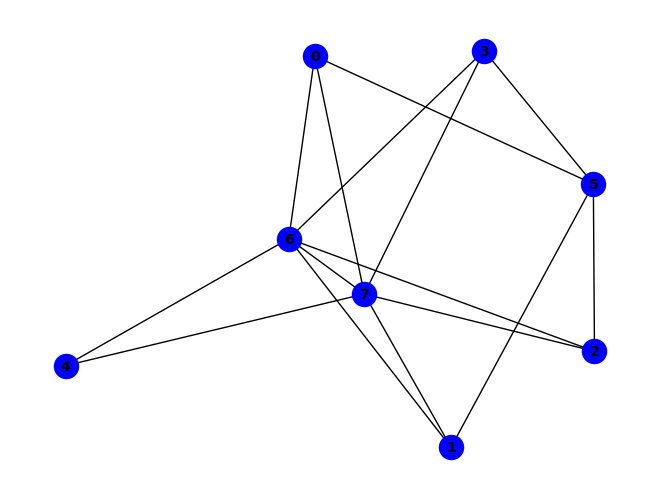


~g ^ (g & ~h) ^ (d & f & ~c) ^ (e & h & ~d) ^ (b & f & ~d & ~h) ^ (b & g & ~d & ~f) ^ (b & h & ~d & ~e) ^ (c & f & ~b & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~e) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & b & d & f & ~g) ^ (a & b & d & g & ~c) ^ (b & c & d & f & ~a) ^ (b & c & d & g & ~f) ^ (b & c & d & h & ~f) ^ (c & d & e & h & ~b) ^ (c & f & g & h & ~b) ^ (d & f & g & h & ~c) ^ (a & b & c & d & f & g) ^ (b & c & d & f & g & h) ^ (a & b & f & ~c & ~h) ^ (a & b & g & ~c & ~f) ^ (a & b & h & ~c & ~e) ^ (a & b & d & e & h & ~c) ^ (a & f & ~c & ~d & ~h) ^ (a & g & ~c & ~d & ~f) ^ (a & h & ~c & ~d & ~e) ^ (a & b & d & h & ~c & ~f) ^ (a & f & g & h & ~c & ~d) ^ (b & f & g & h & ~a & ~d) ^ (a & b & c & f & g & h & ~d) ^ (e & g & ~a & ~b & ~c & ~d)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


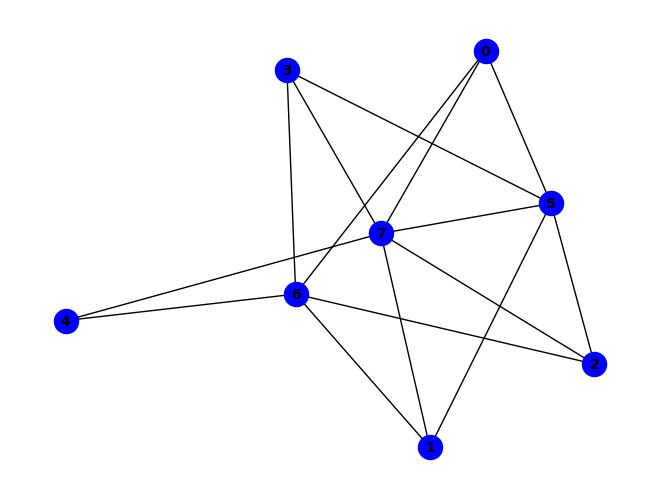


~f ^ (f & ~h) ^ (d & h & ~e) ^ (e & h & ~f) ^ (d & e & f & h) ^ (b & d & g & ~e) ^ (a & h & ~d & ~e) ^ (b & g & ~e & ~h) ^ (b & h & ~c & ~e) ^ (c & f & ~b & ~g) ^ (c & g & ~b & ~h) ^ (c & h & ~a & ~e) ^ (d & f & ~c & ~g) ^ (e & g & ~c & ~h) ^ (a & b & c & g & ~e) ^ (a & c & d & g & ~e) ^ (b & c & d & f & ~g) ^ (b & c & e & g & ~h) ^ (c & f & g & h & ~b) ^ (d & f & g & h & ~c) ^ (b & c & d & f & g & h) ^ (a & b & g & ~d & ~e) ^ (b & d & h & ~e & ~g) ^ (c & d & g & ~b & ~e) ^ (a & b & c & d & h & ~e) ^ (a & f & ~c & ~d & ~g) ^ (a & g & ~c & ~e & ~h) ^ (b & f & ~a & ~d & ~g) ^ (d & g & ~a & ~e & ~h) ^ (a & b & c & f & ~d & ~g) ^ (a & b & c & h & ~e & ~g) ^ (a & c & d & h & ~e & ~g) ^ (a & e & f & h & ~c & ~d) ^ (a & f & g & h & ~c & ~d) ^ (b & e & f & h & ~a & ~d) ^ (b & f & g & h & ~a & ~d) ^ (c & e & f & h & ~b & ~d) ^ (a & b & c & e & f & h & ~d) ^ (a & b & c & f & g & h & ~d) ^ (a & b & h & ~d & ~e & ~g) ^ (c & d & h & ~b & ~e & ~g) ^ (a & b & c & d & g & ~e & ~h)
PASS
PASS
PASS
PASS

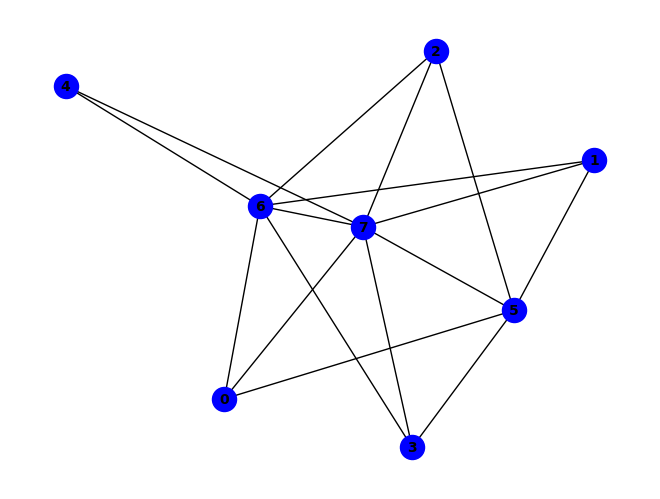


~g ^ (g & ~h) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & h & ~g) ^ (a & f & ~b & ~e) ^ (b & f & ~c & ~g) ^ (b & g & ~c & ~e) ^ (b & h & ~c & ~e) ^ (c & h & ~d & ~e) ^ (d & f & ~a & ~g) ^ (d & g & ~a & ~e) ^ (d & h & ~b & ~e) ^ (a & b & c & f & ~g) ^ (a & b & c & g & ~e) ^ (b & c & d & f & ~g) ^ (b & c & d & g & ~e) ^ (b & c & d & h & ~e) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & d & f & ~a & ~e) ^ (e & f & g & ~d & ~h) ^ (a & b & c & d & f & ~e) ^ (c & d & e & f & g & ~h) ^ (a & g & ~b & ~e & ~f) ^ (c & f & ~a & ~d & ~g) ^ (c & g & ~a & ~d & ~e) ^ (b & e & f & h & ~c & ~g) ^ (c & e & f & h & ~a & ~g) ^ (a & b & c & e & f & h & ~g) ^ (b & c & d & e & f & h & ~g) ^ (a & e & f & ~b & ~g & ~h) ^ (b & d & g & ~a & ~e & ~f) ^ (a & b & c & d & g & ~e & ~f) ^ (a & d & e & f & h & ~c & ~g) ^ (a & h & ~b & ~c & ~d & ~e) ^ (b & d & e & f & ~a & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

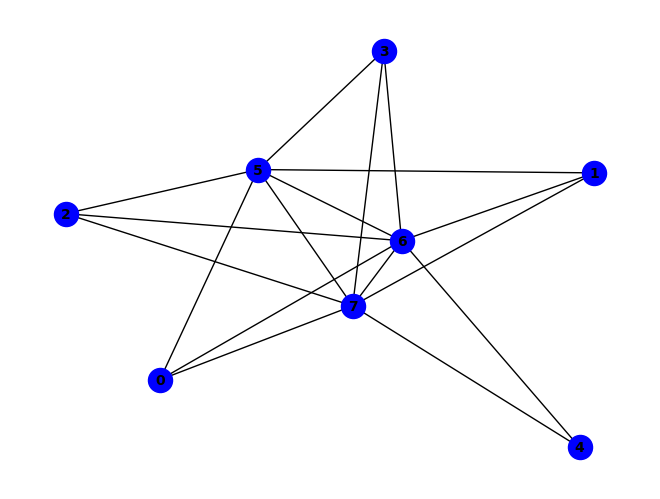


~g ^ (f & g) ^ (f & h) ^ (g & ~h) ^ (e & g & ~f) ^ (e & h & ~f) ^ (a & b & f & ~g) ^ (b & c & g & ~e) ^ (d & f & g & ~h) ^ (b & c & e & f & h) ^ (a & f & ~c & ~e) ^ (b & f & ~d & ~e) ^ (b & g & ~e & ~f) ^ (b & h & ~c & ~e) ^ (c & f & ~d & ~g) ^ (c & g & ~d & ~e) ^ (c & h & ~d & ~e) ^ (d & f & ~a & ~g) ^ (d & g & ~a & ~e) ^ (d & h & ~b & ~e) ^ (a & c & d & f & ~e) ^ (b & c & d & f & ~e) ^ (b & c & d & h & ~e) ^ (b & d & e & g & ~c) ^ (c & e & f & h & ~d) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~a) ^ (a & b & g & ~c & ~e) ^ (a & e & f & ~c & ~h) ^ (b & c & f & ~a & ~g) ^ (b & d & g & ~c & ~f) ^ (b & e & f & ~d & ~h) ^ (a & b & e & f & g & ~c) ^ (a & b & e & f & h & ~c) ^ (a & c & d & e & f & ~h) ^ (a & c & d & e & g & ~b) ^ (a & d & e & f & g & ~c) ^ (b & c & d & e & f & ~h) ^ (a & b & c & d & e & f & g) ^ (a & g & ~c & ~e & ~f) ^ (a & b & d & f & ~c & ~e) ^ (a & b & d & g & ~e & ~f) ^ (a & c & d & g & ~b & ~f) ^ (c & e & f & g & ~b & ~d) ^ (a & f & g & ~c & ~d & ~h) ^ (b & f & g & ~a

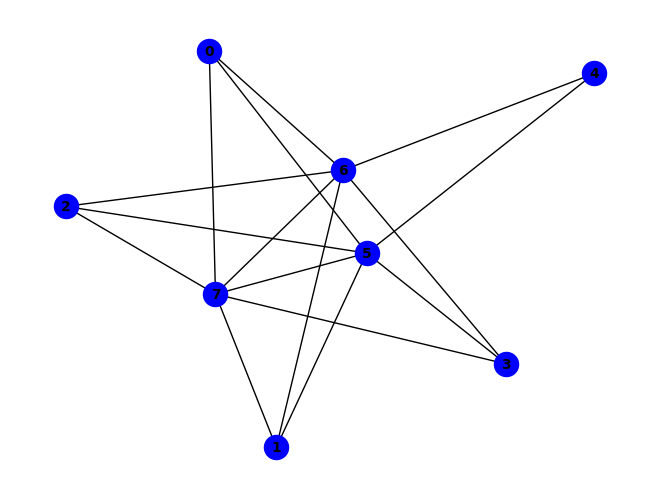


(g & ~h) ^ (~e & ~g) ^ (a & g & ~d) ^ (b & f & ~e) ^ (b & g & ~f) ^ (b & h & ~d) ^ (c & g & ~b) ^ (c & h & ~b) ^ (d & h & ~c) ^ (f & h & ~g) ^ (b & c & d & h) ^ (e & ~f & ~h) ^ (e & f & g & ~h) ^ (a & h & ~c & ~d) ^ (b & e & ~d & ~g) ^ (b & e & ~d & ~h) ^ (d & f & ~b & ~g) ^ (d & g & ~b & ~c) ^ (e & h & ~b & ~g) ^ (a & b & c & g & ~d) ^ (a & b & c & h & ~d) ^ (b & d & e & h & ~g) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~g) ^ (b & d & e & f & g & h) ^ (a & b & g & ~d & ~e) ^ (a & b & h & ~d & ~e) ^ (a & c & f & ~d & ~e) ^ (a & c & g & ~d & ~f) ^ (a & e & f & ~d & ~h) ^ (c & e & g & ~b & ~h) ^ (d & e & f & ~g & ~h) ^ (d & e & g & ~c & ~h) ^ (a & c & e & f & h & ~d) ^ (a & f & ~b & ~d & ~g) ^ (c & f & ~b & ~d & ~g) ^ (a & b & c & f & ~d & ~g) ^ (a & b & e & h & ~d & ~g) ^ (b & d & e & f & ~c & ~h) ^ (c & e & f & ~d & ~g & ~h) ^ (a & b & c & e & g & ~d & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (a & b & e & f & ~d & ~g & ~h) ^ (b & c & e & f & ~a & ~g & ~h) ^ (a & b & c & d & e & f & ~g & 

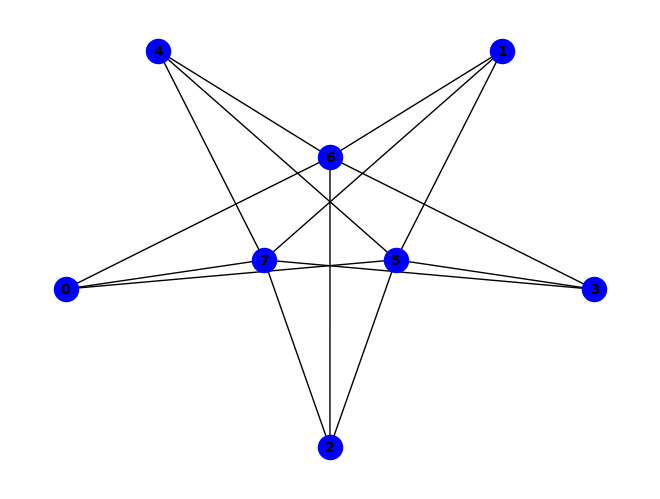


~d ^ (b & c & h & ~e) ^ (a & h & ~b & ~e) ^ (b & f & ~d & ~g) ^ (b & h & ~d & ~f) ^ (c & h & ~d & ~e) ^ (e & g & ~d & ~h) ^ (e & h & ~b & ~d) ^ (a & d & e & h & ~c) ^ (b & f & g & h & ~d) ^ (d & ~f & ~g & ~h) ^ (a & b & g & ~e & ~h) ^ (a & d & g & ~c & ~f) ^ (a & d & h & ~c & ~g) ^ (c & d & g & ~e & ~h) ^ (a & d & f & g & h & ~c) ^ (b & c & d & e & h & ~a) ^ (a & f & ~d & ~e & ~h) ^ (a & g & ~e & ~f & ~h) ^ (c & f & ~a & ~e & ~h) ^ (c & g & ~e & ~f & ~h) ^ (a & b & c & f & ~e & ~h) ^ (a & b & d & f & ~e & ~h) ^ (a & b & d & g & ~e & ~f) ^ (a & b & d & h & ~e & ~g) ^ (a & c & d & f & ~e & ~h) ^ (b & c & d & f & ~a & ~g) ^ (b & c & d & h & ~a & ~f) ^ (a & b & d & f & g & h & ~e) ^ (b & c & d & f & g & h & ~a) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & g & ~b & ~e & ~f) ^ (a & c & h & ~b & ~e & ~g) ^ (b & c & f & ~e & ~g & ~h) ^ (c & d & f & ~e & ~g & ~h) ^ (a & b & c & d & g & ~e & ~h) ^ (a & c & f & g & h & ~b & ~e) ^ (b & g & ~c & ~d & ~e & ~h) ^ (e & f & ~b & ~d & ~g & ~h) ^ (a & d & e 

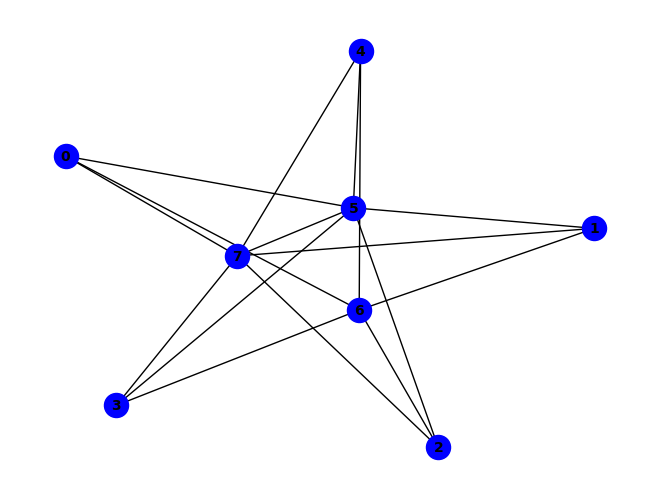


(f & ~h) ^ (~e & ~f) ^ (b & h & ~e) ^ (e & ~g & ~h) ^ (a & b & f & ~e) ^ (b & c & f & ~e) ^ (b & c & g & ~f) ^ (e & f & g & ~h) ^ (a & g & ~d & ~e) ^ (b & g & ~e & ~h) ^ (c & h & ~a & ~e) ^ (d & f & ~e & ~g) ^ (d & h & ~c & ~e) ^ (a & b & d & h & ~e) ^ (a & c & d & h & ~e) ^ (b & c & e & h & ~d) ^ (a & b & g & ~e & ~f) ^ (b & c & h & ~d & ~g) ^ (b & d & g & ~c & ~e) ^ (b & d & h & ~e & ~g) ^ (b & c & f & g & h & ~d) ^ (a & h & ~d & ~e & ~g) ^ (b & f & ~d & ~e & ~g) ^ (c & f & ~d & ~e & ~g) ^ (c & g & ~a & ~e & ~h) ^ (d & g & ~c & ~e & ~h) ^ (a & b & c & g & ~d & ~e) ^ (a & b & d & f & ~e & ~g) ^ (a & b & d & g & ~e & ~h) ^ (a & c & d & g & ~e & ~h) ^ (b & c & d & f & ~e & ~g) ^ (b & c & e & g & ~f & ~h) ^ (b & f & g & h & ~d & ~e) ^ (c & f & g & h & ~a & ~e) ^ (d & f & g & h & ~c & ~e) ^ (a & c & d & f & g & h & ~e) ^ (b & c & d & e & g & h & ~f) ^ (a & b & h & ~c & ~e & ~g) ^ (a & b & c & d & h & ~e & ~g) ^ (a & f & ~c & ~d & ~e & ~g) ^ (a & b & c & f & ~d & ~e & ~g) ^ (a & f & g & h

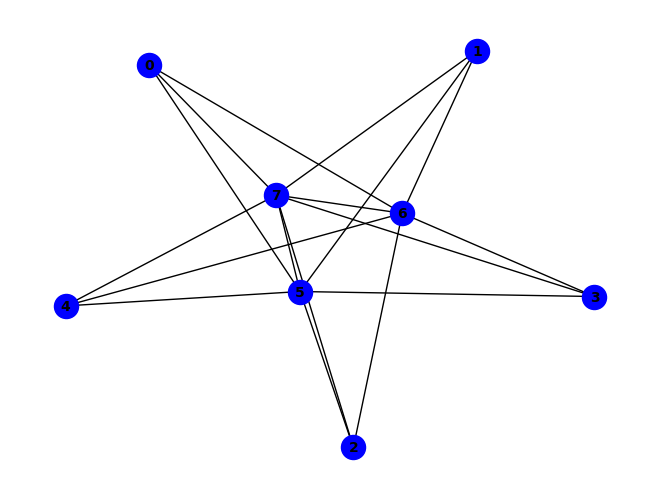


~g ^ (g & ~h) ^ (b & h & ~d) ^ (d & g & ~c) ^ (e & f & ~g) ^ (e & g & ~d) ^ (e & h & ~b) ^ (f & h & ~g) ^ (b & d & e & h) ^ (c & d & e & g) ^ (b & c & f & ~e) ^ (a & g & ~d & ~e) ^ (b & g & ~a & ~e) ^ (c & g & ~a & ~e) ^ (c & h & ~b & ~e) ^ (d & h & ~c & ~e) ^ (a & c & d & g & ~e) ^ (b & c & d & g & ~e) ^ (b & c & d & h & ~e) ^ (b & c & g & ~e & ~f) ^ (b & d & f & ~a & ~e) ^ (a & f & ~c & ~e & ~g) ^ (b & f & ~a & ~e & ~g) ^ (c & f & ~d & ~e & ~g) ^ (d & f & ~a & ~e & ~g) ^ (a & b & c & g & ~d & ~e) ^ (a & c & d & f & ~e & ~g) ^ (b & c & d & f & ~e & ~g) ^ (b & d & g & ~a & ~e & ~f) ^ (a & h & ~b & ~c & ~d & ~e) ^ (a & b & c & f & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


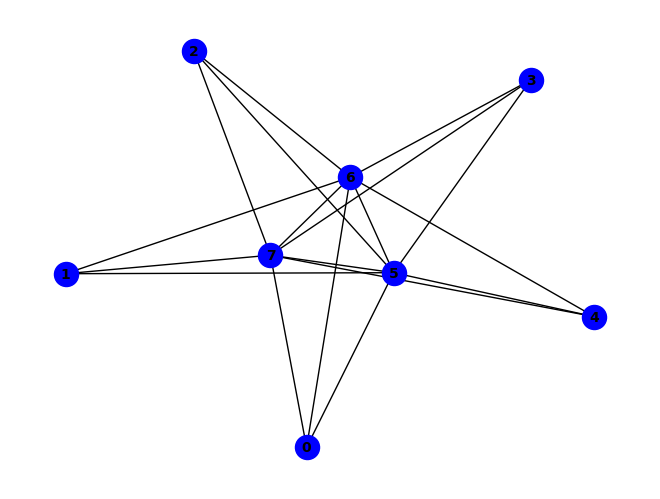


~g ^ (f & g) ^ (f & h) ^ (g & ~h) ^ (a & h & ~d) ^ (b & g & ~e) ^ (d & h & ~e) ^ (e & g & ~d) ^ (e & h & ~a) ^ (a & d & e & h) ^ (d & e & f & g) ^ (a & b & f & ~e) ^ (b & c & f & ~e) ^ (e & f & g & ~h) ^ (a & f & ~d & ~e) ^ (b & f & ~e & ~g) ^ (c & f & ~d & ~g) ^ (d & f & ~b & ~e) ^ (d & g & ~b & ~f) ^ (e & f & ~c & ~g) ^ (a & b & c & g & ~e) ^ (a & b & d & g & ~e) ^ (b & c & d & g & ~e) ^ (b & d & e & g & ~f) ^ (c & d & e & f & ~g) ^ (a & b & g & ~e & ~f) ^ (b & c & g & ~e & ~f) ^ (a & b & c & d & f & ~e) ^ (a & g & ~d & ~e & ~f) ^ (b & h & ~a & ~d & ~e) ^ (c & g & ~a & ~d & ~e) ^ (a & b & c & f & ~e & ~g) ^ (a & b & d & f & ~e & ~g) ^ (b & c & d & f & ~e & ~g) ^ (a & c & f & ~d & ~e & ~g) ^ (a & f & g & ~c & ~e & ~h) ^ (c & f & g & ~d & ~e & ~h) ^ (d & f & g & ~a & ~e & ~h) ^ (a & b & c & d & g & ~e & ~f) ^ (a & c & d & f & g & ~e & ~h) ^ (c & h & ~a & ~b & ~d & ~e) ^ (b & f & g & ~a & ~c & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

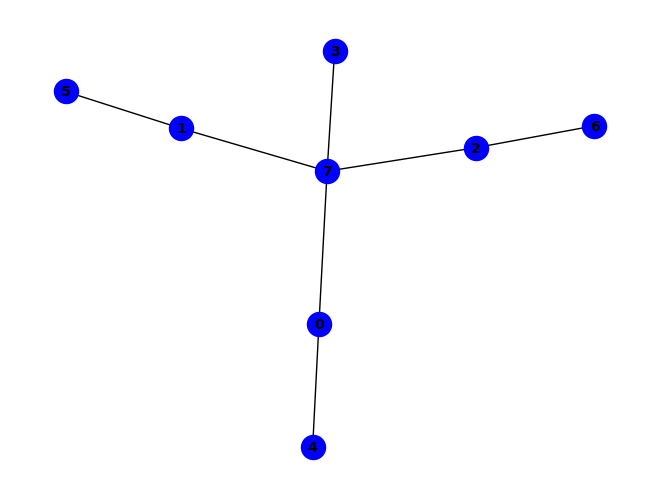


~d ^ (a & e) ^ (d & ~h) ^ (a & h & ~e) ^ (b & h & ~d) ^ (c & h & ~d) ^ (a & b & e & h) ^ (b & c & d & h) ^ (b & c & f & h) ^ (a & b & f & ~e) ^ (a & c & g & ~b) ^ (b & c & g & ~f) ^ (b & f & ~a & ~h) ^ (c & g & ~b & ~h) ^ (a & c & h & ~b & ~g) ^ (a & d & h & ~b & ~c) ^ (b & c & h & ~f & ~g) ^ (a & b & c & g & ~e & ~f) ^ (a & b & c & g & ~f & ~h) ^ (a & b & h & ~c & ~e & ~f) ^ (a & c & g & ~b & ~e & ~h) ^ (a & b & c & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


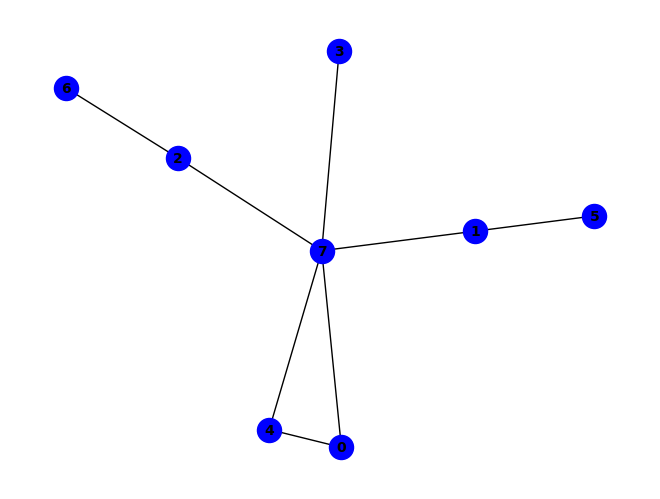


~e ^ (b & f) ^ (e & ~h) ^ (a & e & ~d) ^ (b & h & ~f) ^ (d & h & ~e) ^ (a & c & e & g) ^ (b & d & h & ~c) ^ (b & e & h & ~d) ^ (a & b & c & d & h) ^ (b & c & d & e & h) ^ (a & h & ~c & ~d) ^ (c & g & ~b & ~h) ^ (c & h & ~d & ~e) ^ (a & b & e & f & ~h) ^ (a & c & d & e & ~b) ^ (a & c & e & h & ~g) ^ (a & b & h & ~d & ~e) ^ (a & d & e & ~c & ~h) ^ (b & c & g & ~f & ~h) ^ (b & c & h & ~a & ~e) ^ (a & b & c & d & e & ~h) ^ (a & b & c & e & f & g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


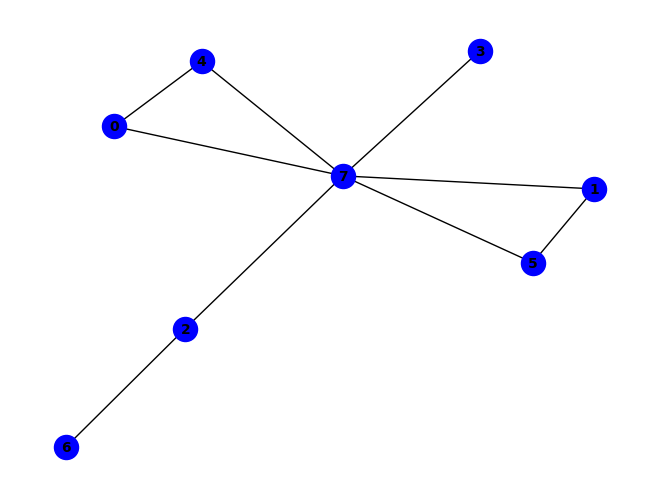


~f ^ (f & ~h) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & b & f & ~h) ^ (a & d & e & ~f) ^ (b & e & f & ~h) ^ (a & e & ~d & ~h) ^ (b & f & ~a & ~e) ^ (b & h & ~a & ~e) ^ (a & d & e & f & ~h) ^ (b & c & f & g & ~h) ^ (a & d & h & ~c & ~f) ^ (a & b & c & e & g & ~f) ^ (a & h & ~c & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & b & c & h & ~d & ~f) ^ (a & b & d & h & ~e & ~f) ^ (a & c & e & g & ~b & ~h) ^ (a & b & c & e & h & ~f & ~g) ^ (a & c & d & e & h & ~b & ~f) ^ (c & h & ~b & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


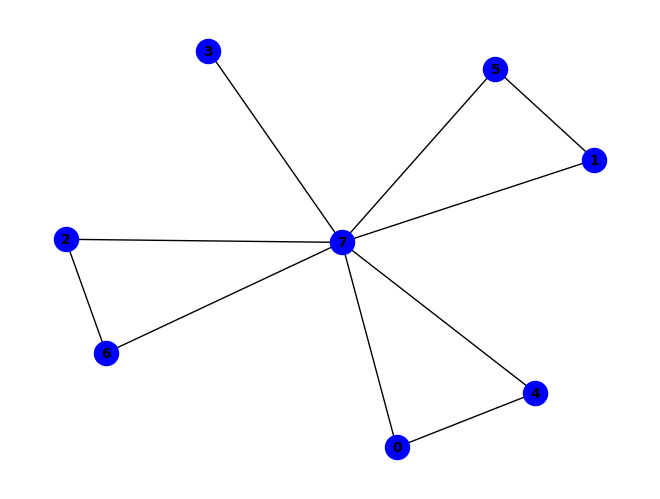


~g ^ (g & ~h) ^ (f & h & ~g) ^ (b & e & f & ~g) ^ (a & e & ~c & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & h & ~f & ~g) ^ (b & c & e & g & ~f) ^ (b & c & e & h & ~f) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (a & b & f & ~e & ~g) ^ (a & c & e & ~g & ~h) ^ (b & c & g & ~e & ~h) ^ (b & e & h & ~d & ~g) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (a & b & d & e & f & ~g) ^ (a & c & d & e & h & ~g) ^ (b & c & d & e & h & ~g) ^ (b & d & e & f & g & ~c) ^ (b & d & e & f & h & ~c) ^ (b & f & ~a & ~e & ~h) ^ (b & h & ~d & ~f & ~g) ^ (a & b & d & h & ~f & ~g) ^ (a & b & e & f & ~d & ~h) ^ (a & b & f & g & ~e & ~h) ^ (a & b & d & e & f & g & ~h) ^ (a & c & d & e & f & g & ~b) ^ (a & c & d & e & f & h & ~b) ^ (a & b & h & ~c & ~e & ~g) ^ (a & b & c & f & h & ~e & ~g) ^ (a & b & d & e & h & ~c & ~g) ^ (c & d & e & f & g & ~a & ~h) ^ (a & h & ~c & ~e & ~f & ~g) ^ (d & h & ~a & ~e & ~f & ~g) ^ (b & e & f & g & ~c & ~d & ~h) ^ (a & b & c & e & f & g & ~d & ~h) ^ (c & d & h & ~a &

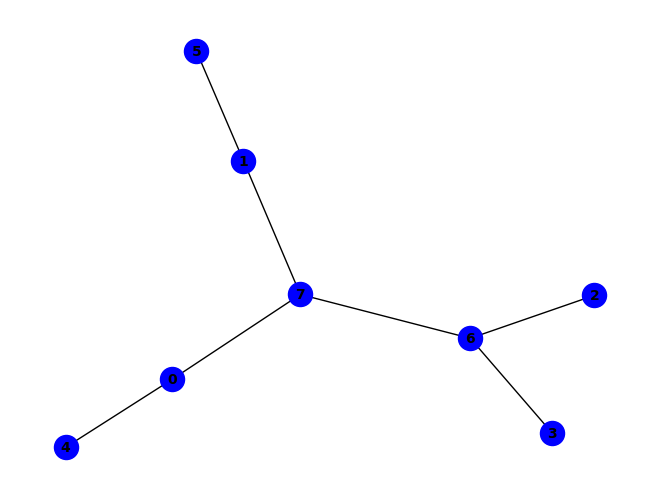


(a & ~e & ~h) ^ (b & ~a & ~f & ~h) ^ (a & b & f & ~e & ~h) ^ (a & c & g & ~e & ~h) ^ (~a & ~b & ~d & ~g) ^ (d & h & ~a & ~b & ~g) ^ (d & ~a & ~b & ~c & ~h) ^ (g & ~a & ~b & ~c & ~h) ^ (a & d & g & ~c & ~e & ~h) ^ (b & d & g & ~a & ~f & ~h) ^ (a & b & d & f & g & ~e & ~h) ^ (c & d & ~a & ~b & ~g & ~h) ^ (b & c & g & ~a & ~d & ~f & ~h) ^ (a & b & c & f & g & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


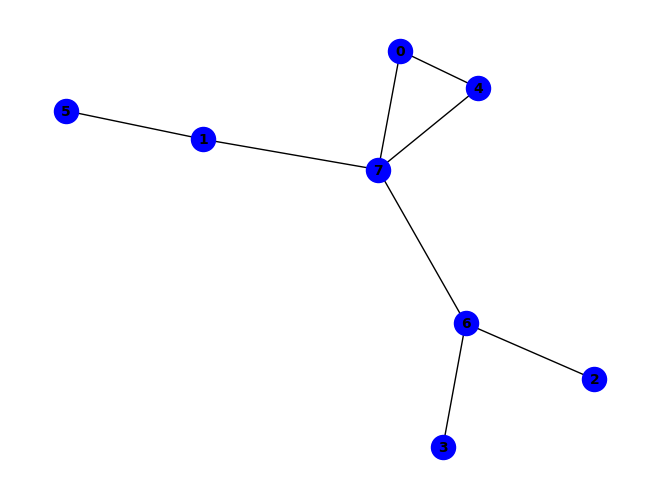


(b & e & g) ^ (a & e & ~h) ^ (e & h & ~g) ^ (a & b & e & f) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (b & e & h & ~a) ^ (~b & ~d & ~g) ^ (b & g & ~e & ~h) ^ (d & h & ~b & ~g) ^ (a & b & e & h & ~f) ^ (a & d & e & g & ~h) ^ (b & ~c & ~f & ~h) ^ (a & c & g & ~d & ~h) ^ (b & c & g & ~a & ~h) ^ (b & d & f & ~c & ~h) ^ (a & c & ~d & ~e & ~g) ^ (a & c & ~d & ~e & ~h) ^ (a & h & ~c & ~e & ~g) ^ (b & d & ~f & ~g & ~h) ^ (c & d & ~b & ~g & ~h) ^ (a & b & c & g & ~e & ~h) ^ (a & b & h & ~d & ~e & ~g) ^ (a & b & c & e & g & ~f & ~h) ^ (a & b & d & f & g & ~c & ~h) ^ (b & c & ~d & ~f & ~g & ~h) ^ (a & b & d & f & ~c & ~e & ~g) ^ (a & b & d & f & ~c & ~e & ~h) ^ (a & c & d & h & ~b & ~e & ~g) ^ (a & b & d & h & ~c & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


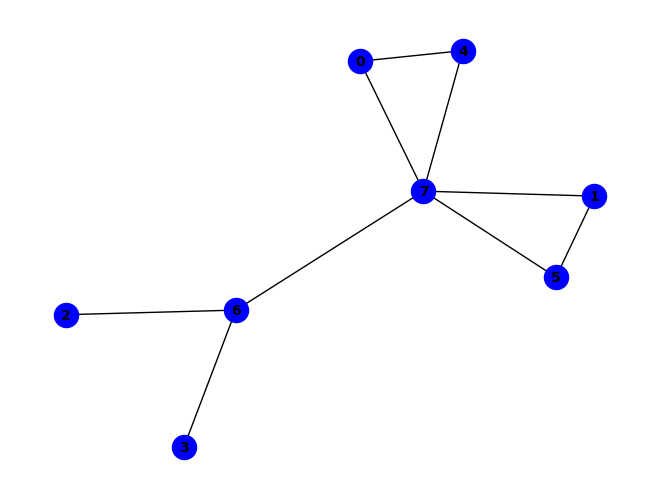


(~d & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (b & d & f & ~g) ^ (b & d & f & ~h) ^ (b & e & f & ~g) ^ (b & e & h & ~g) ^ (a & e & ~b & ~h) ^ (c & d & ~g & ~h) ^ (d & h & ~b & ~g) ^ (e & h & ~f & ~g) ^ (a & c & e & g & ~h) ^ (b & e & f & g & ~h) ^ (a & b & e & ~f & ~h) ^ (a & b & c & f & g & ~h) ^ (a & h & ~e & ~f & ~g) ^ (b & f & ~a & ~e & ~h) ^ (b & h & ~d & ~f & ~g) ^ (a & b & c & f & ~e & ~h) ^ (a & d & e & g & ~c & ~h) ^ (b & c & f & g & ~d & ~h) ^ (a & b & f & ~c & ~e & ~g) ^ (a & b & h & ~c & ~e & ~g) ^ (a & b & d & f & g & ~c & ~h) ^ (a & b & c & h & ~e & ~f & ~g) ^ (a & b & f & g & ~d & ~e & ~h) ^ (a & b & c & d & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


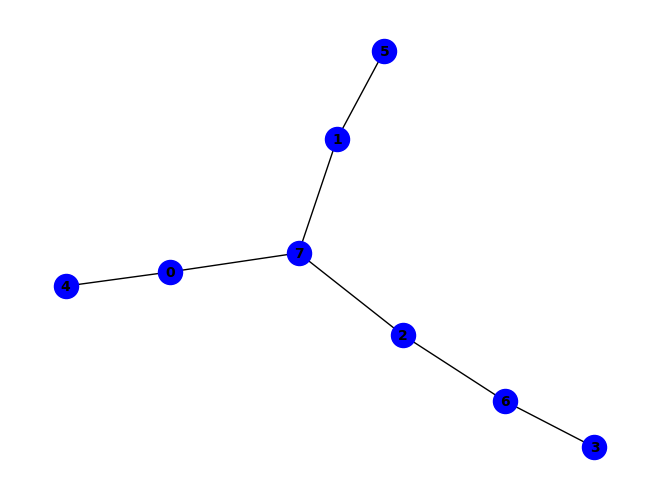


(d & ~g) ^ (c & g & ~h) ^ (a & d & h & ~g) ^ (~a & ~b & ~d) ^ (c & h & ~a & ~b) ^ (b & c & f & g & ~h) ^ (a & ~d & ~e & ~h) ^ (a & b & f & ~e & ~h) ^ (b & d & h & ~a & ~g) ^ (c & d & g & ~a & ~b) ^ (a & c & d & e & ~b & ~h) ^ (a & c & d & g & ~b & ~h) ^ (a & c & e & g & ~b & ~h) ^ (b & c & d & g & ~f & ~h) ^ (b & ~a & ~d & ~f & ~h) ^ (a & d & e & ~c & ~g & ~h) ^ (b & d & f & ~a & ~g & ~h) ^ (a & b & c & d & e & ~g & ~h) ^ (a & b & d & f & g & ~e & ~h) ^ (a & b & c & e & g & ~d & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


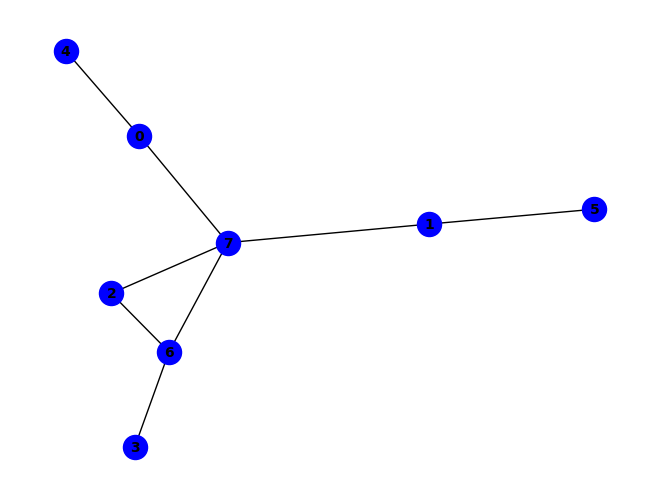


(c & g & ~a & ~b) ^ (c & h & ~a & ~b) ^ (a & ~d & ~e & ~h) ^ (d & ~a & ~c & ~h) ^ (g & ~a & ~b & ~h) ^ (a & b & f & ~e & ~h) ^ (b & d & f & ~a & ~h) ^ (~a & ~b & ~d & ~g) ^ (a & d & ~e & ~g & ~h) ^ (c & d & ~a & ~g & ~h) ^ (d & h & ~a & ~b & ~g) ^ (b & ~a & ~c & ~f & ~h) ^ (a & c & g & ~d & ~e & ~h) ^ (a & b & d & f & g & ~e & ~h) ^ (b & c & d & f & g & ~a & ~h) ^ (b & c & ~a & ~f & ~g & ~h) ^ (b & d & ~a & ~f & ~g & ~h) ^ (a & b & c & f & g & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


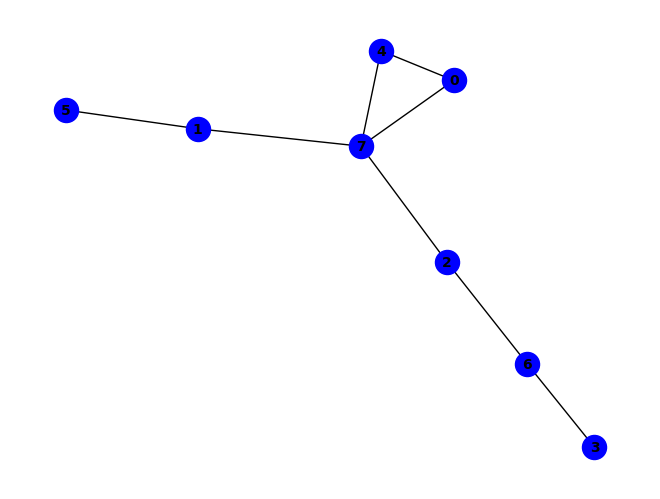


~e ^ (e & ~h) ^ (a & b & h) ^ (a & e & ~d) ^ (b & f & ~d) ^ (b & h & ~f) ^ (d & g & ~c) ^ (a & b & e & f) ^ (a & c & e & g) ^ (b & e & h & ~d) ^ (a & h & ~c & ~d) ^ (c & g & ~b & ~h) ^ (c & h & ~b & ~e) ^ (a & b & e & h & ~f) ^ (a & c & d & e & ~b) ^ (a & c & e & h & ~g) ^ (b & c & d & f & ~h) ^ (b & d & e & h & ~g) ^ (b & d & g & h & ~f) ^ (d & e & g & h & ~c) ^ (a & d & e & ~c & ~g) ^ (a & d & h & ~c & ~g) ^ (b & c & g & ~f & ~h) ^ (b & d & f & ~c & ~g) ^ (a & b & d & g & h & ~e) ^ (b & c & d & f & h & ~g) ^ (b & c & d & g & h & ~e) ^ (a & b & c & d & e & g & h) ^ (a & b & c & h & ~d & ~e) ^ (a & b & c & d & e & f & ~g) ^ (a & b & c & e & f & g & ~h) ^ (a & b & d & e & f & g & ~h) ^ (a & b & c & d & e & ~f & ~h) ^ (a & b & c & d & h & ~e & ~g) ^ (a & b & c & d & e & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

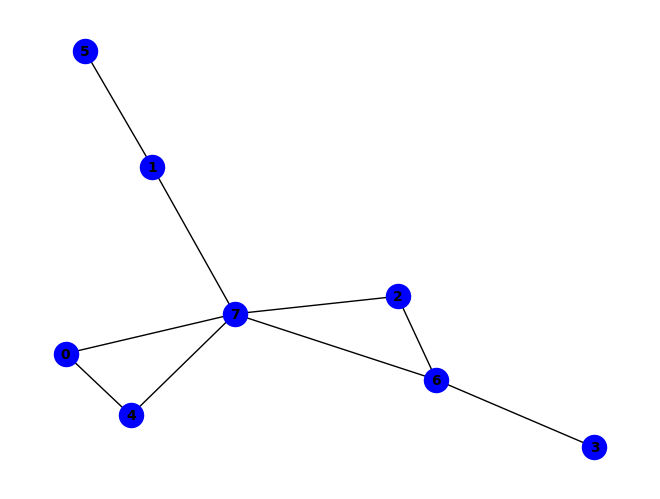


(d & ~c & ~h) ^ (g & ~b & ~h) ^ (~b & ~d & ~g) ^ (a & e & ~c & ~h) ^ (c & g & ~b & ~e) ^ (c & h & ~b & ~e) ^ (d & h & ~b & ~g) ^ (e & h & ~b & ~g) ^ (a & b & e & f & ~h) ^ (b & ~c & ~f & ~h) ^ (a & c & e & ~g & ~h) ^ (b & d & f & ~c & ~h) ^ (c & e & g & ~b & ~h) ^ (b & d & ~f & ~g & ~h) ^ (c & d & ~b & ~g & ~h) ^ (a & d & e & g & ~c & ~h) ^ (a & b & d & e & f & g & ~h) ^ (a & h & ~b & ~c & ~e & ~g) ^ (b & c & ~d & ~f & ~g & ~h) ^ (a & b & c & e & f & g & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


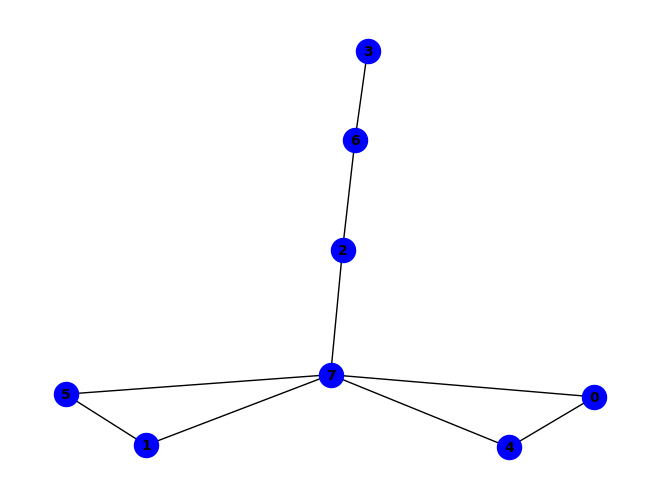


~f ^ (f & ~h) ^ (c & g & ~h) ^ (d & g & ~c) ^ (e & h & ~f) ^ (a & b & f & ~h) ^ (b & e & f & ~h) ^ (a & e & ~d & ~h) ^ (b & f & ~a & ~e) ^ (b & h & ~a & ~e) ^ (a & b & c & h & ~f) ^ (b & c & f & g & ~h) ^ (b & d & f & g & ~c) ^ (d & e & g & h & ~c) ^ (a & b & c & e & g & ~f) ^ (a & b & d & e & f & ~h) ^ (a & h & ~c & ~e & ~f) ^ (c & h & ~b & ~e & ~f) ^ (b & d & g & h & ~c & ~e) ^ (d & f & g & h & ~c & ~e) ^ (b & d & e & f & g & h & ~c) ^ (a & d & e & ~b & ~g & ~h) ^ (a & b & c & e & h & ~f & ~g) ^ (a & b & d & e & ~f & ~g & ~h) ^ (a & c & e & g & ~b & ~d & ~h) ^ (a & b & c & d & e & g & ~f & ~h) ^ (a & d & g & h & ~b & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


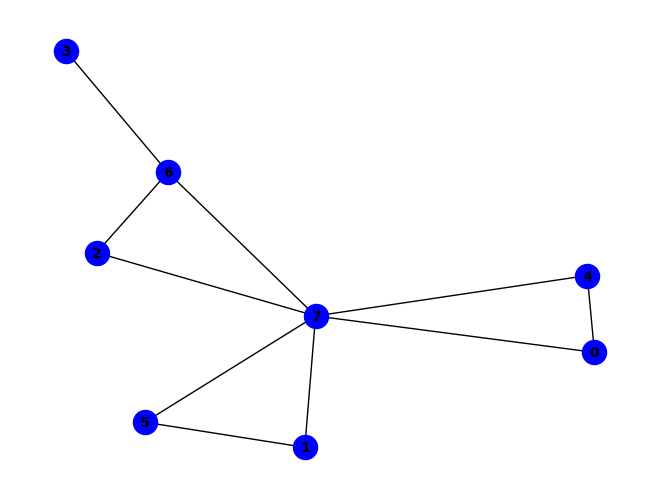


(g & ~h) ^ (~d & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & e & ~c & ~h) ^ (b & f & ~c & ~h) ^ (c & d & ~g & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & h & ~f & ~g) ^ (c & e & f & g & ~b) ^ (c & e & f & h & ~b) ^ (b & c & f & ~g & ~h) ^ (b & c & g & ~f & ~h) ^ (c & e & h & ~b & ~g) ^ (c & f & g & ~e & ~h) ^ (b & c & e & f & g & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & d & e & g & ~c & ~h) ^ (b & d & f & g & ~c & ~h) ^ (a & c & e & ~b & ~g & ~h) ^ (a & h & ~c & ~e & ~f & ~g) ^ (b & h & ~a & ~e & ~f & ~g) ^ (a & b & c & e & ~f & ~g & ~h) ^ (a & b & c & h & ~e & ~f & ~g) ^ (a & b & d & e & f & g & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


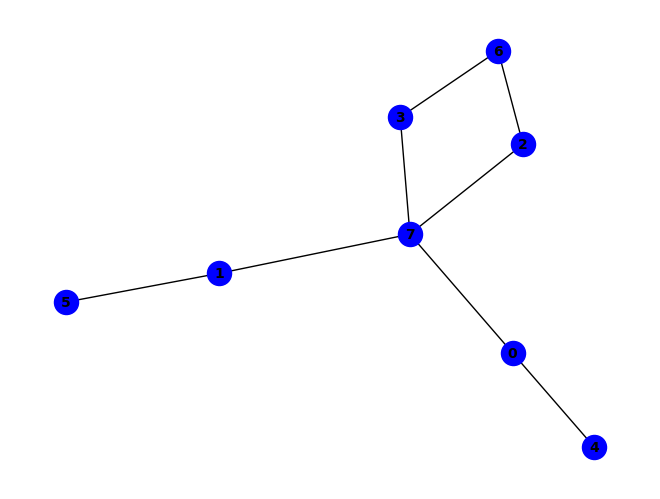


~c ^ (a & b & f) ^ (a & e & ~h) ^ (a & h & ~d) ^ (b & f & ~h) ^ (b & h & ~d) ^ (d & h & ~c) ^ (a & b & d & h) ^ (a & c & d & h) ^ (a & c & e & h) ^ (b & c & f & h) ^ (c & ~g & ~h) ^ (a & b & h & ~f) ^ (a & c & g & ~e) ^ (b & c & g & ~f) ^ (d & g & ~c & ~h) ^ (a & b & c & h & ~d) ^ (a & d & e & g & ~h) ^ (b & c & d & g & ~a) ^ (b & c & d & h & ~g) ^ (a & b & c & d & g & h) ^ (a & b & f & ~e & ~h) ^ (a & c & g & ~d & ~h) ^ (b & c & g & ~a & ~h) ^ (b & c & h & ~f & ~g) ^ (a & b & c & g & ~e & ~h) ^ (b & d & f & g & ~a & ~h) ^ (a & c & d & ~b & ~e & ~g) ^ (a & c & d & ~b & ~e & ~h) ^ (a & c & h & ~d & ~e & ~g) ^ (a & b & c & d & h & ~e & ~g) ^ (a & b & c & e & g & ~f & ~h) ^ (a & b & d & f & g & ~e & ~h) ^ (b & c & d & g & ~a & ~f & ~h) ^ (a & b & c & d & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

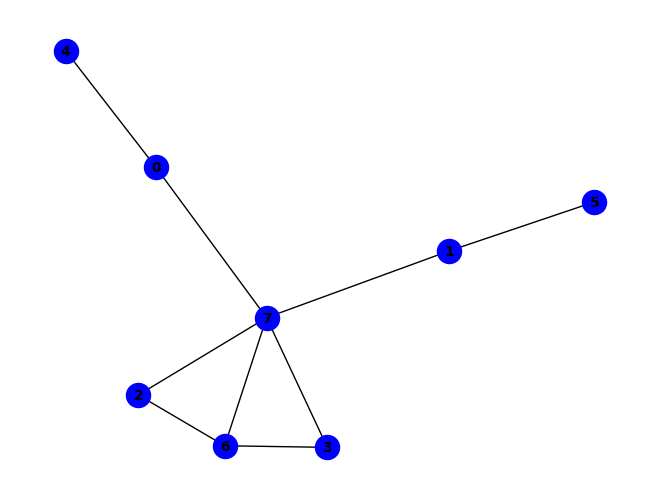


(~a & ~b & ~g) ^ (c & g & ~a & ~b) ^ (d & h & ~a & ~b) ^ (a & ~d & ~e & ~h) ^ (g & ~a & ~b & ~h) ^ (c & h & ~a & ~b & ~d) ^ (d & g & ~a & ~b & ~c) ^ (b & ~a & ~d & ~f & ~h) ^ (a & b & f & ~d & ~e & ~h) ^ (a & c & g & ~d & ~e & ~h) ^ (a & d & ~b & ~e & ~g & ~h) ^ (b & d & ~a & ~f & ~g & ~h) ^ (a & b & d & ~e & ~f & ~g & ~h) ^ (b & c & g & ~a & ~d & ~f & ~h) ^ (a & b & c & f & g & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


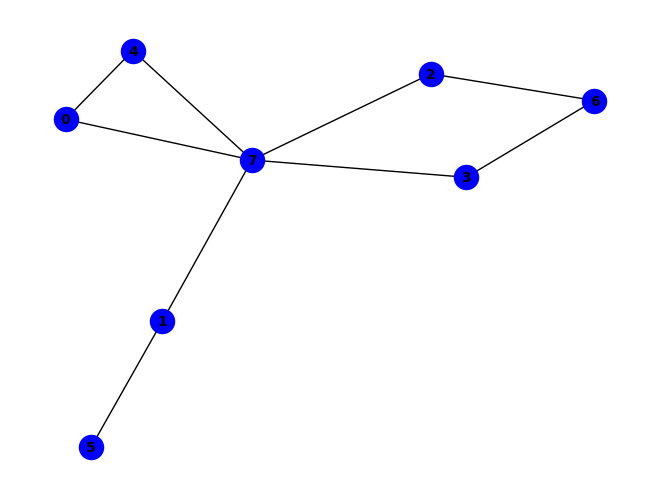


~e ^ (b & f) ^ (e & ~h) ^ (b & c & g) ^ (a & e & ~d) ^ (a & h & ~c) ^ (b & h & ~f) ^ (c & g & ~h) ^ (a & c & e & g) ^ (b & d & g & ~c) ^ (a & d & e & g & h) ^ (c & h & ~d & ~e) ^ (d & g & ~c & ~h) ^ (d & h & ~a & ~e) ^ (a & b & c & h & ~e) ^ (a & b & e & f & ~h) ^ (b & d & f & h & ~g) ^ (a & b & h & ~d & ~e) ^ (a & d & e & ~c & ~g) ^ (b & c & g & ~f & ~h) ^ (b & c & h & ~d & ~g) ^ (b & e & h & ~c & ~d) ^ (b & d & ~c & ~f & ~g) ^ (b & d & ~c & ~f & ~h) ^ (a & c & d & e & ~b & ~h) ^ (a & c & d & h & ~b & ~e) ^ (a & c & e & h & ~d & ~g) ^ (b & c & d & h & ~f & ~g) ^ (a & b & c & e & f & g & ~h) ^ (a & b & d & e & f & g & ~h) ^ (a & b & c & d & e & ~g & ~h) ^ (a & b & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


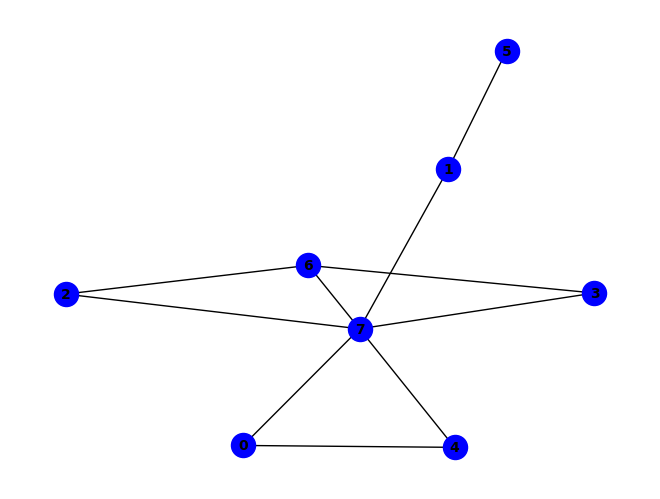


(~b & ~g) ^ (g & ~b & ~h) ^ (b & c & d & f & g) ^ (b & c & d & f & h) ^ (a & e & ~d & ~h) ^ (c & g & ~d & ~e) ^ (c & h & ~d & ~e) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (e & h & ~b & ~g) ^ (a & b & e & f & ~h) ^ (a & c & d & e & ~h) ^ (b & ~d & ~f & ~h) ^ (b & c & g & ~a & ~e) ^ (b & c & g & ~f & ~h) ^ (b & c & h & ~a & ~e) ^ (d & e & g & ~b & ~h) ^ (a & b & c & d & h & ~g) ^ (b & c & d & e & g & ~a) ^ (b & c & d & e & h & ~a) ^ (b & d & ~f & ~g & ~h) ^ (a & b & c & g & ~e & ~h) ^ (a & c & e & g & ~b & ~h) ^ (b & c & d & h & ~f & ~g) ^ (a & b & d & e & f & g & ~h) ^ (a & b & h & ~d & ~e & ~g) ^ (a & d & e & ~c & ~g & ~h) ^ (c & e & g & ~b & ~d & ~h) ^ (a & h & ~c & ~d & ~e & ~g) ^ (a & b & c & e & g & ~d & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


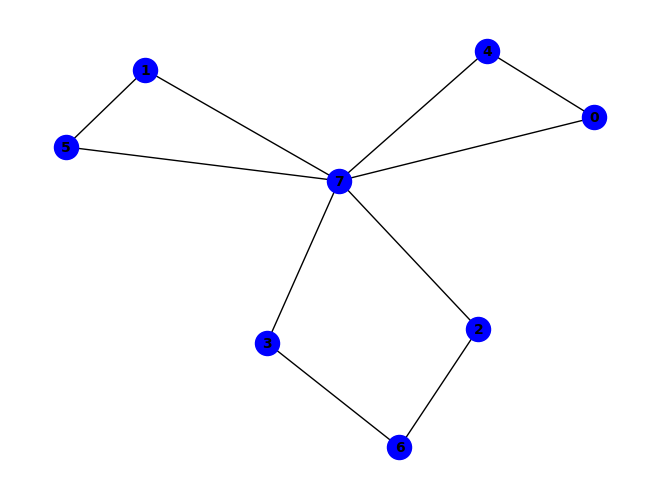


~f ^ (f & ~h) ^ (c & g & ~h) ^ (e & h & ~f) ^ (b & c & f & g) ^ (a & b & f & ~h) ^ (b & e & f & ~h) ^ (b & c & e & f & h) ^ (a & e & ~d & ~h) ^ (b & f & ~a & ~e) ^ (b & h & ~c & ~e) ^ (d & g & ~c & ~h) ^ (a & b & c & h & ~f) ^ (b & c & d & f & ~g) ^ (b & c & d & f & ~h) ^ (b & d & f & g & ~h) ^ (a & b & h & ~d & ~e) ^ (a & d & e & ~g & ~h) ^ (a & b & c & e & g & ~f) ^ (a & b & d & f & h & ~e) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (b & c & f & h & ~d & ~g) ^ (a & b & d & e & f & g & ~h) ^ (a & b & c & e & h & ~f & ~g) ^ (a & h & ~c & ~d & ~e & ~f) ^ (a & c & e & g & ~b & ~d & ~h) ^ (b & c & d & h & ~a & ~e & ~f) ^ (a & b & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


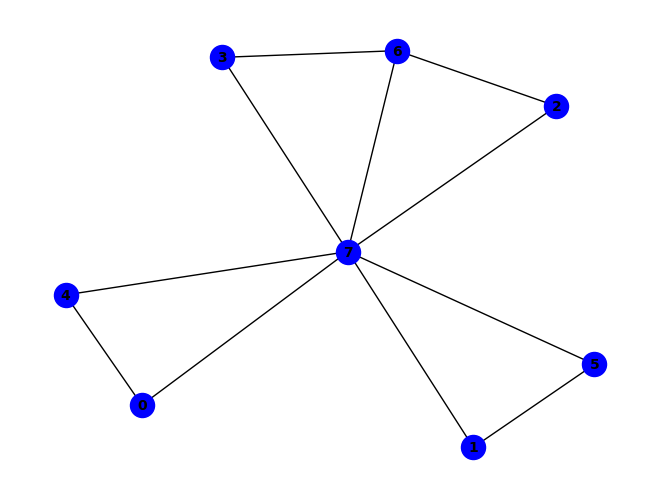


~g ^ (g & ~h) ^ (f & h & ~g) ^ (b & c & g & ~h) ^ (b & e & f & ~g) ^ (a & e & ~d & ~h) ^ (b & f & ~e & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (b & e & f & g & ~h) ^ (b & e & h & ~d & ~g) ^ (c & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (b & c & d & e & h & ~g) ^ (b & c & d & f & g & ~h) ^ (b & h & ~d & ~f & ~g) ^ (e & h & ~c & ~f & ~g) ^ (a & b & e & f & ~d & ~h) ^ (a & c & e & g & ~d & ~h) ^ (b & c & d & h & ~f & ~g) ^ (b & c & e & h & ~f & ~g) ^ (d & e & f & g & ~b & ~c) ^ (d & e & f & h & ~b & ~c) ^ (a & d & e & ~b & ~g & ~h) ^ (d & f & g & ~b & ~e & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (a & b & d & e & ~f & ~g & ~h) ^ (a & b & c & e & f & g & ~d & ~h) ^ (a & h & ~b & ~c & ~d & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


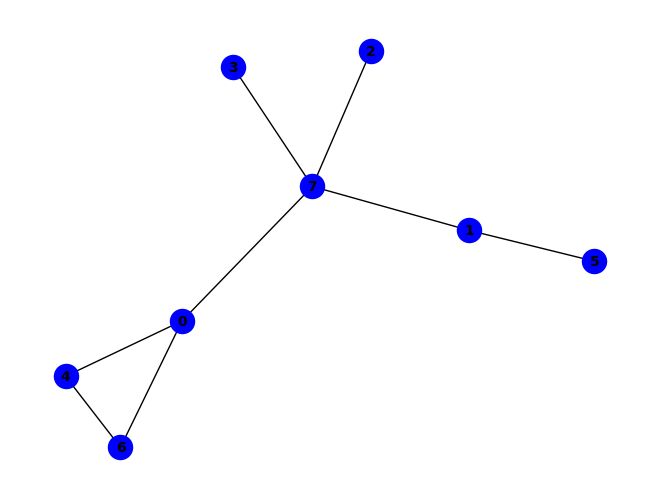


~e ^ (a & g & ~e) ^ (a & h & ~g) ^ (b & f & ~e) ^ (b & h & ~f) ^ (b & e & f & h) ^ (b & e & g & h) ^ (e & ~d & ~g) ^ (a & d & h & ~e) ^ (a & e & ~g & ~h) ^ (d & e & ~g & ~h) ^ (d & h & ~b & ~e) ^ (a & b & e & g & ~h) ^ (a & b & f & g & ~h) ^ (a & d & e & h & ~g) ^ (b & d & e & h & ~g) ^ (a & b & e & ~d & ~g) ^ (a & b & e & ~f & ~h) ^ (a & c & h & ~d & ~e) ^ (b & e & f & ~g & ~h) ^ (c & h & ~b & ~d & ~e) ^ (a & b & d & e & ~g & ~h) ^ (a & b & h & ~c & ~d & ~e) ^ (c & e & h & ~a & ~b & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


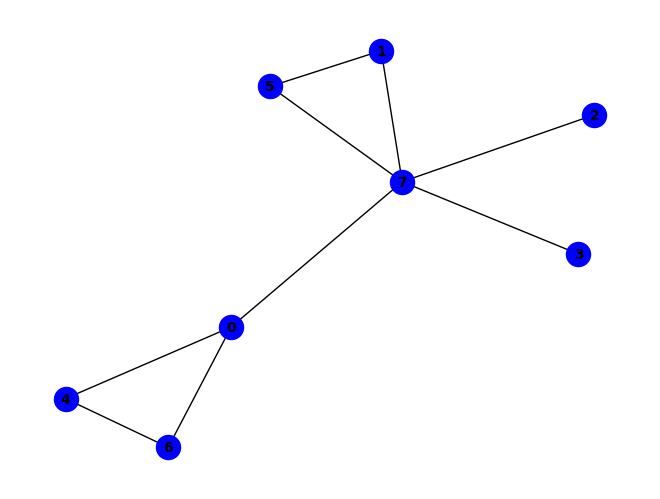


~f ^ (e & g) ^ (f & ~h) ^ (a & g & ~e) ^ (a & h & ~g) ^ (b & f & ~e) ^ (b & h & ~e) ^ (a & b & f & g) ^ (a & b & h & ~d) ^ (a & d & h & ~f) ^ (a & f & h & ~e) ^ (b & e & h & ~g) ^ (a & b & d & f & h) ^ (a & e & ~g & ~h) ^ (d & h & ~b & ~f) ^ (a & b & f & h & ~g) ^ (e & f & g & h & ~d) ^ (a & b & d & e & f & g) ^ (c & d & e & f & g & h) ^ (b & e & f & ~d & ~g) ^ (a & c & e & f & h & ~d) ^ (a & c & e & g & h & ~d) ^ (a & d & e & g & h & ~f) ^ (b & d & e & f & h & ~c) ^ (a & b & e & f & ~d & ~h) ^ (a & e & f & h & ~c & ~g) ^ (c & e & g & h & ~b & ~f) ^ (d & e & g & h & ~b & ~c) ^ (a & b & d & e & g & h & ~c) ^ (a & c & d & e & f & h & ~g) ^ (b & c & d & e & f & h & ~g) ^ (a & b & c & d & e & f & g & h) ^ (a & b & e & g & h & ~c & ~f) ^ (c & h & ~a & ~b & ~d & ~f) ^ (b & d & e & f & ~a & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


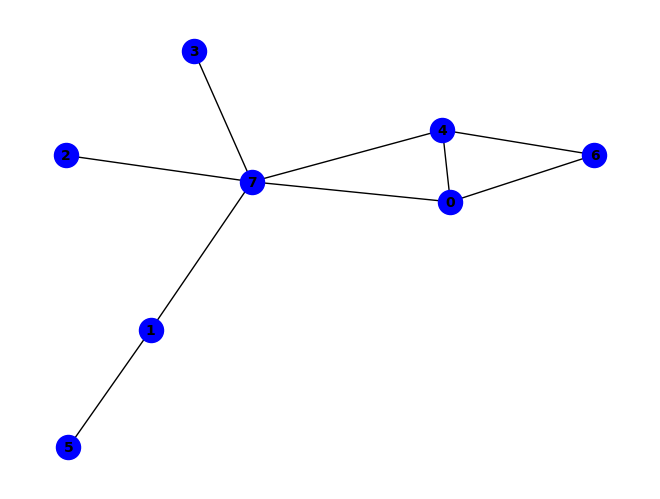


~d ^ (b & f) ^ (d & ~h) ^ (a & e & ~d) ^ (a & g & ~h) ^ (a & h & ~d) ^ (a & b & e & h) ^ (a & b & f & g) ^ (a & d & e & ~h) ^ (b & d & h & ~c) ^ (b & c & d & e & h) ^ (b & h & ~a & ~f) ^ (e & g & ~b & ~h) ^ (e & h & ~b & ~d) ^ (a & b & e & f & ~h) ^ (a & b & f & h & ~g) ^ (b & c & h & ~a & ~e) ^ (b & e & g & ~f & ~h) ^ (c & h & ~a & ~d & ~e) ^ (a & b & d & h & ~c & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


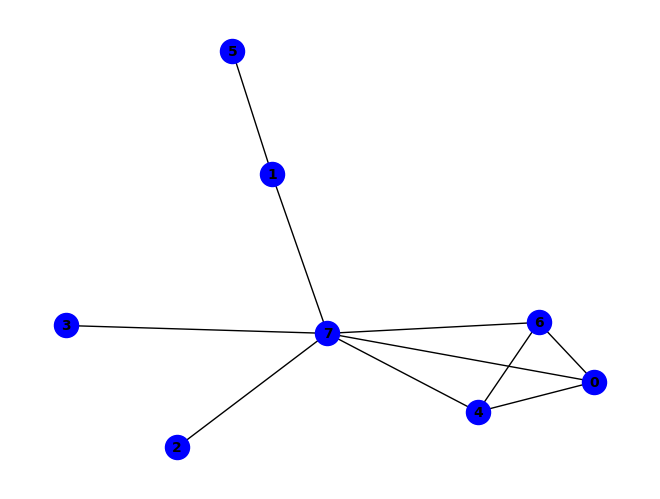


(~b & ~g) ^ (a & e & ~d) ^ (a & g & ~e) ^ (b & g & ~h) ^ (c & g & ~e) ^ (c & h & ~e) ^ (e & g & ~d) ^ (e & h & ~d) ^ (b & e & f & g) ^ (b & e & f & h) ^ (g & ~c & ~h) ^ (a & b & e & ~g) ^ (a & b & g & ~d) ^ (a & d & e & ~h) ^ (d & e & g & ~h) ^ (a & b & c & e & g) ^ (a & b & d & e & h) ^ (a & h & ~b & ~d) ^ (d & h & ~c & ~g) ^ (a & c & e & g & ~d) ^ (a & d & g & h & ~e) ^ (b & c & e & g & ~d) ^ (b & c & e & h & ~d) ^ (c & d & e & h & ~g) ^ (b & ~a & ~f & ~h) ^ (a & b & e & ~f & ~h) ^ (b & c & h & ~d & ~g) ^ (b & d & h & ~e & ~g) ^ (b & e & h & ~f & ~g) ^ (c & e & g & ~b & ~h) ^ (a & b & d & e & g & ~c) ^ (b & c & d & e & g & ~h) ^ (a & b & ~f & ~g & ~h) ^ (a & b & d & g & ~e & ~h) ^ (a & c & e & h & ~b & ~d) ^ (a & c & h & ~b & ~d & ~g) ^ (a & e & g & ~b & ~c & ~h) ^ (a & c & d & e & g & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

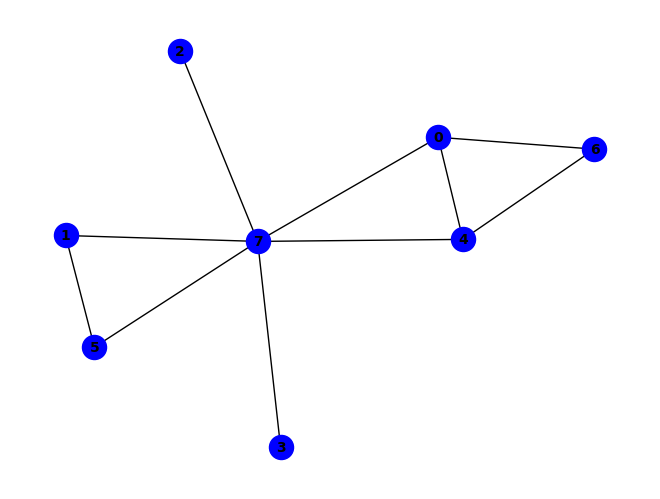


~f ^ (f & ~h) ^ (a & e & ~f) ^ (a & g & ~h) ^ (b & f & ~e) ^ (b & h & ~d) ^ (e & g & ~h) ^ (a & b & f & g) ^ (b & d & f & h) ^ (a & b & h & ~e) ^ (a & e & f & ~h) ^ (a & h & ~d & ~f) ^ (d & h & ~e & ~f) ^ (e & h & ~b & ~f) ^ (a & b & e & f & ~d) ^ (a & b & f & h & ~g) ^ (a & d & e & h & ~f) ^ (b & c & e & h & ~d) ^ (b & d & e & h & ~f) ^ (b & e & f & h & ~c) ^ (b & c & h & ~d & ~f) ^ (b & e & f & ~g & ~h) ^ (a & b & d & e & f & ~h) ^ (a & b & d & e & h & ~c) ^ (a & b & c & h & ~e & ~f) ^ (a & b & d & h & ~c & ~f) ^ (b & c & d & e & f & h & ~a) ^ (c & h & ~a & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


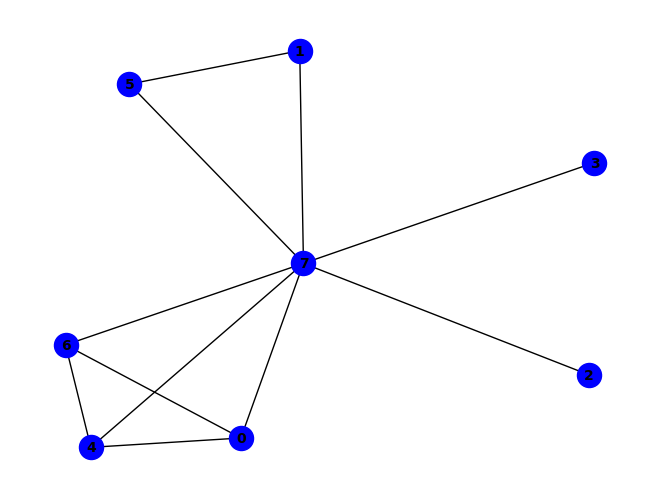


~g ^ (a & e & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & h & ~g) ^ (g & ~c & ~h) ^ (c & f & g & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (b & f & ~e & ~h) ^ (e & g & ~b & ~f) ^ (e & h & ~b & ~f) ^ (a & b & c & g & ~f) ^ (a & b & c & h & ~f) ^ (a & d & e & g & ~c) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~c) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & c & e & f & g & h) ^ (a & b & g & ~c & ~h) ^ (a & e & g & ~d & ~h) ^ (a & f & g & ~e & ~h) ^ (b & e & f & ~g & ~h) ^ (b & e & g & ~f & ~h) ^ (d & e & h & ~c & ~g) ^ (e & f & g & ~d & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & d & e & f & ~g) ^ (c & d & e & f & g & ~h) ^ (a & b & c & d & e & f & h) ^ (d & h & ~c & ~f & ~g) ^ (a & b & e & f & ~d & ~h) ^ (a & b & e & h & ~f & ~g) ^ (a & c & e & h & ~b & ~g) ^ (a & d & e & h & ~c & ~f) ^ (a & b & c & e & f & h & ~g) ^ (a & c & d & e & f & g & ~b) ^ (a & c & h & ~d & ~f & ~g) ^ (a & d & h & ~b & ~f & ~g) ^ (c & e & h & ~b & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (a & b & d & e 

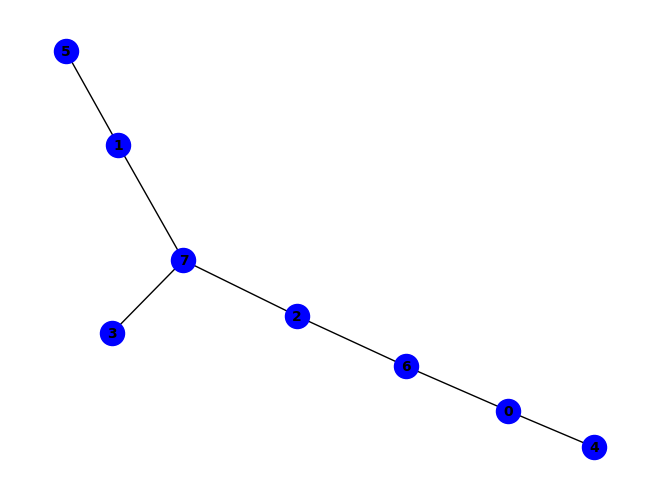


(~a & ~d) ^ (b & f & ~h) ^ (b & c & d & h) ^ (a & ~e & ~g) ^ (d & ~a & ~h) ^ (b & h & ~a & ~d) ^ (c & h & ~a & ~d) ^ (a & b & f & g & ~h) ^ (b & c & f & h & ~a) ^ (a & b & c & d & g & h) ^ (b & c & g & ~a & ~f) ^ (c & g & ~a & ~b & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & b & c & d & e & h & ~g) ^ (a & b & h & ~d & ~e & ~g) ^ (a & c & h & ~b & ~e & ~g) ^ (a & d & h & ~c & ~e & ~g) ^ (b & c & h & ~a & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


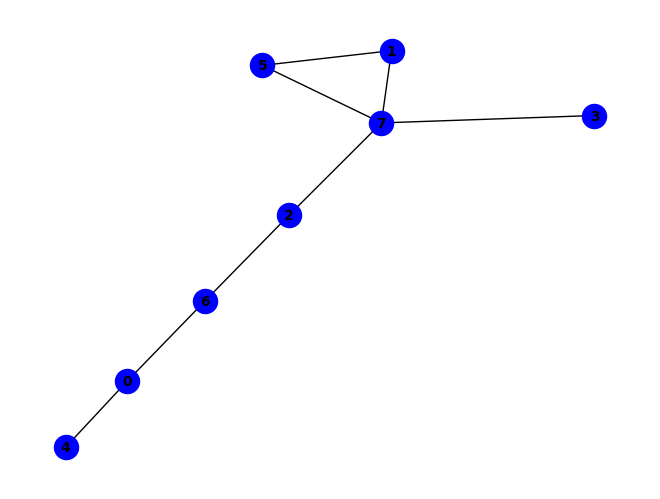


(~a & ~f) ^ (a & ~e & ~g) ^ (f & ~a & ~h) ^ (b & f & ~a & ~d) ^ (b & h & ~a & ~d) ^ (c & g & ~a & ~h) ^ (d & h & ~a & ~f) ^ (a & b & f & ~e & ~g) ^ (a & b & h & ~e & ~g) ^ (a & f & h & ~e & ~g) ^ (b & d & f & ~a & ~h) ^ (b & c & f & g & ~a & ~h) ^ (c & h & ~a & ~b & ~d & ~f) ^ (a & d & h & ~b & ~e & ~f & ~g) ^ (a & c & h & ~b & ~d & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


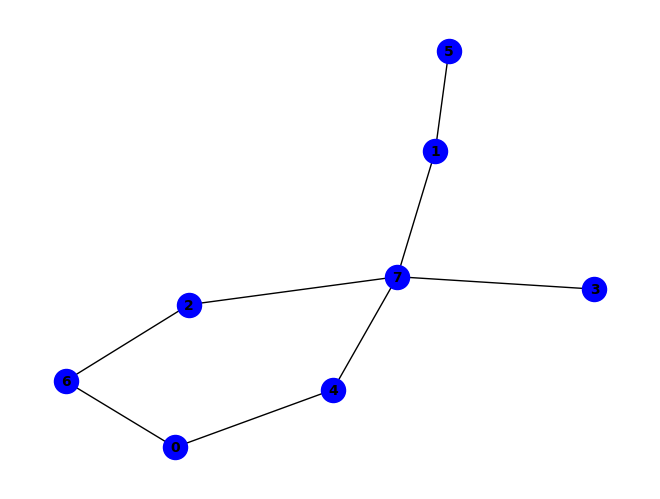


(a & c & g) ^ (~a & ~e) ^ (b & f & ~a) ^ (b & h & ~f) ^ (d & h & ~e) ^ (a & ~e & ~g) ^ (e & ~a & ~h) ^ (b & c & h & ~e) ^ (b & d & h & ~c) ^ (b & e & h & ~d) ^ (a & b & c & f & g) ^ (a & b & e & f & g) ^ (a & c & e & g & h) ^ (c & g & ~b & ~h) ^ (c & h & ~d & ~e) ^ (a & b & e & f & ~h) ^ (a & b & f & h & ~c) ^ (a & b & g & h & ~d) ^ (a & b & c & d & g & h) ^ (a & b & d & e & g & h) ^ (a & b & f & ~g & ~h) ^ (b & c & g & ~f & ~h) ^ (a & b & c & f & h & ~g) ^ (a & b & c & g & h & ~e) ^ (a & b & e & g & h & ~f) ^ (b & c & d & e & h & ~a) ^ (a & d & g & h & ~c & ~e) ^ (a & b & c & d & e & h & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


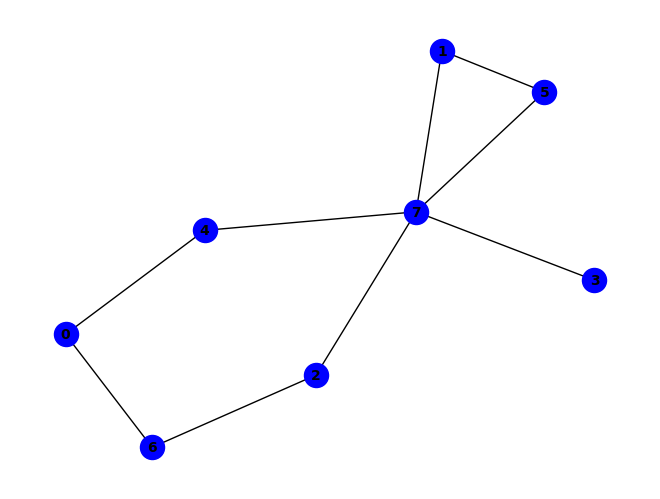


~f ^ (f & ~h) ^ (a & c & g) ^ (a & g & ~e) ^ (b & f & ~e) ^ (b & h & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & d & e & g) ^ (a & b & c & f & g) ^ (a & e & ~d & ~h) ^ (a & b & f & g & ~e) ^ (a & f & g & h & ~e) ^ (b & c & f & g & ~h) ^ (b & e & f & ~a & ~h) ^ (a & c & d & g & h & ~e) ^ (a & c & e & g & h & ~f) ^ (a & c & f & g & h & ~d) ^ (a & d & e & f & h & ~c) ^ (a & b & c & d & e & g & h) ^ (d & h & ~b & ~e & ~f) ^ (a & b & g & h & ~c & ~e) ^ (a & d & e & f & ~c & ~g) ^ (a & d & g & h & ~b & ~f) ^ (a & b & c & d & g & h & ~f) ^ (a & b & d & e & g & h & ~f) ^ (a & d & e & ~f & ~g & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (a & b & c & e & f & g & h & ~d) ^ (c & h & ~b & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


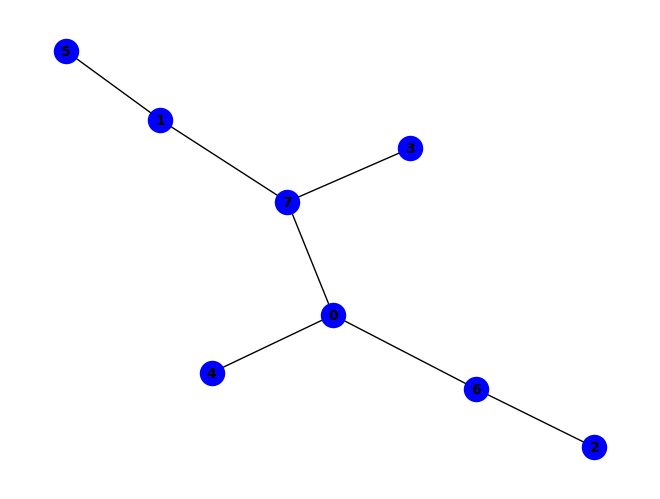


~d ^ (d & ~h) ^ (a & h & ~d) ^ (b & h & ~d) ^ (c & g & ~a) ^ (a & b & f & h) ^ (a & c & d & g & h) ^ (a & g & ~b & ~h) ^ (b & f & ~c & ~h) ^ (a & b & d & h & ~c) ^ (b & c & g & h & ~a) ^ (c & d & g & h & ~b) ^ (a & b & e & ~f & ~h) ^ (a & b & g & ~e & ~f) ^ (a & b & h & ~f & ~g) ^ (b & c & f & ~g & ~h) ^ (a & b & c & d & h & ~g) ^ (a & b & c & f & g & ~h) ^ (a & b & e & g & h & ~f) ^ (a & e & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


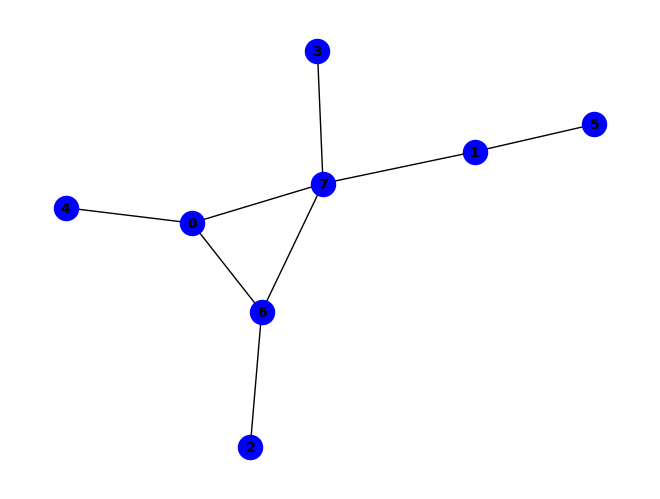


(a & e & ~b) ^ (c & ~b & ~h) ^ (g & ~b & ~h) ^ (~b & ~c & ~g) ^ (a & g & ~b & ~e) ^ (a & h & ~b & ~e) ^ (c & h & ~b & ~g) ^ (a & e & g & h & ~b) ^ (b & ~c & ~f & ~h) ^ (a & c & g & ~b & ~h) ^ (b & c & ~f & ~g & ~h) ^ (d & h & ~a & ~b & ~g) ^ (a & b & e & ~f & ~g & ~h) ^ (a & b & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


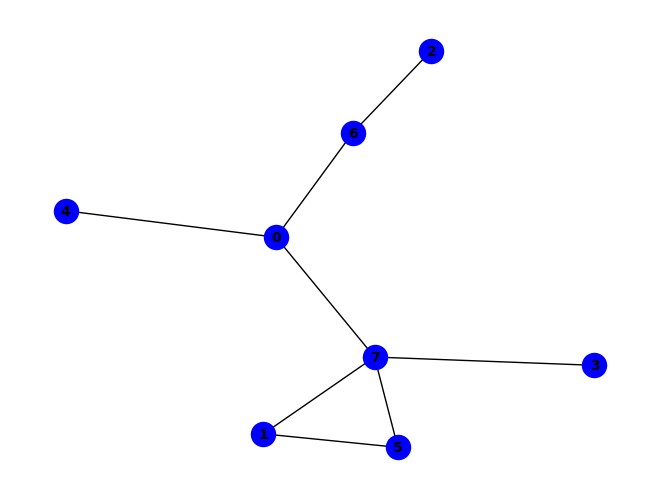


~f ^ (a & f & ~d) ^ (a & g & ~h) ^ (a & h & ~d) ^ (b & f & ~d) ^ (b & h & ~d) ^ (c & g & ~a) ^ (d & h & ~f) ^ (f & ~a & ~h) ^ (a & b & h & ~f) ^ (a & b & c & f & g) ^ (a & b & c & g & h) ^ (a & b & d & f & ~c) ^ (a & b & d & h & ~c) ^ (a & b & f & g & ~h) ^ (b & c & f & g & ~d) ^ (b & c & g & h & ~d) ^ (c & f & g & h & ~a) ^ (a & d & f & ~b & ~h) ^ (b & d & f & ~c & ~h) ^ (a & b & c & d & f & ~h) ^ (a & e & ~b & ~g & ~h) ^ (b & c & d & f & ~g & ~h) ^ (c & d & g & h & ~a & ~f) ^ (a & b & e & ~f & ~g & ~h) ^ (a & b & c & d & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


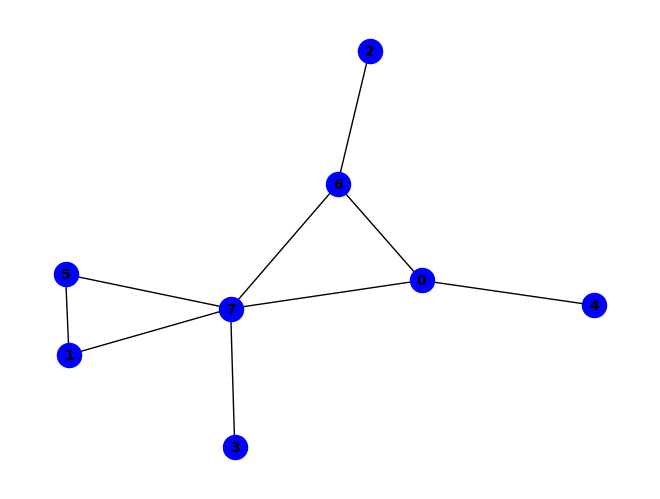


(g & ~h) ^ (~c & ~g) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~b & ~h) ^ (a & f & g & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (b & f & ~a & ~h) ^ (a & b & f & ~g & ~h) ^ (a & b & g & ~f & ~h) ^ (a & c & g & ~b & ~h) ^ (b & c & f & ~g & ~h) ^ (a & e & ~b & ~g & ~h) ^ (b & c & ~a & ~f & ~h) ^ (b & h & ~d & ~f & ~g) ^ (d & h & ~a & ~f & ~g) ^ (a & b & d & h & ~f & ~g) ^ (a & b & c & ~f & ~g & ~h) ^ (a & b & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


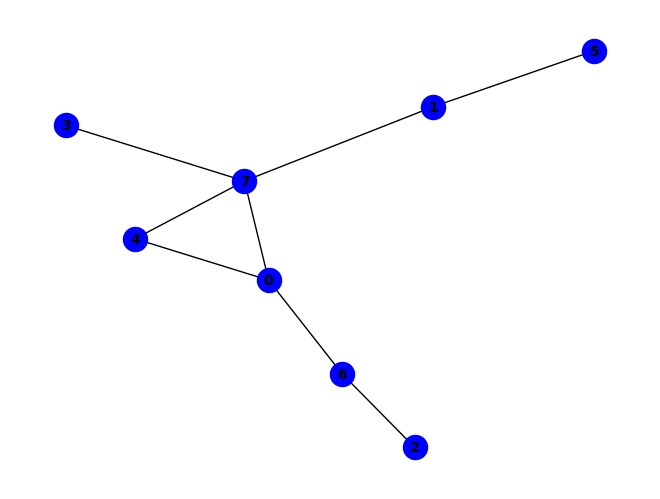


~e ^ (e & ~h) ^ (a & b & g) ^ (a & e & ~d) ^ (a & g & ~e) ^ (b & h & ~e) ^ (c & g & ~a) ^ (c & e & g & h) ^ (a & d & h & ~c) ^ (a & c & d & e & g) ^ (a & h & ~b & ~g) ^ (b & f & ~c & ~h) ^ (d & h & ~b & ~e) ^ (a & b & d & h & ~e) ^ (a & b & e & g & ~f) ^ (a & c & d & h & ~g) ^ (a & e & g & h & ~c) ^ (c & d & g & h & ~e) ^ (a & b & e & f & g & h) ^ (a & b & e & ~c & ~g) ^ (a & b & e & ~f & ~h) ^ (a & b & g & ~f & ~h) ^ (a & d & e & ~c & ~h) ^ (b & c & f & ~g & ~h) ^ (a & b & c & e & h & ~d) ^ (a & b & c & f & g & ~h) ^ (a & b & c & g & h & ~d) ^ (a & b & c & e & ~g & ~h) ^ (a & c & d & e & ~g & ~h) ^ (b & c & g & h & ~d & ~e) ^ (a & b & c & d & e & h & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


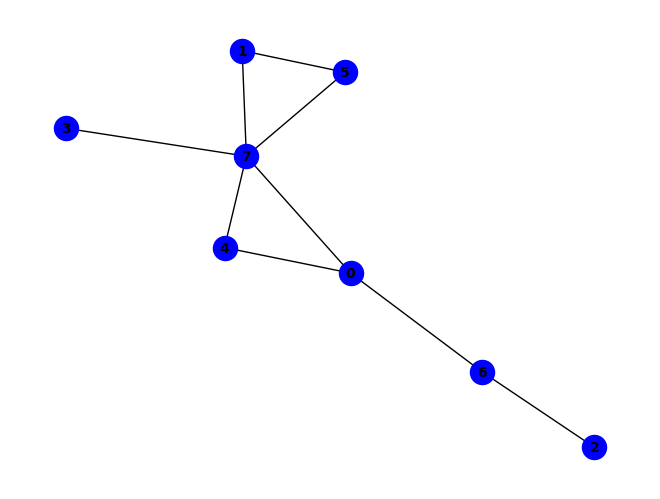


~f ^ (f & ~h) ^ (a & g & ~h) ^ (b & f & ~e) ^ (c & g & ~a) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & e & f & ~h) ^ (a & c & f & g & h) ^ (a & e & ~c & ~g) ^ (a & h & ~d & ~f) ^ (b & h & ~a & ~e) ^ (a & b & d & h & ~f) ^ (a & b & e & f & ~d) ^ (a & b & f & g & ~e) ^ (a & b & f & h & ~g) ^ (a & c & e & h & ~f) ^ (a & d & e & h & ~f) ^ (b & c & f & g & ~a) ^ (c & d & g & h & ~e) ^ (c & e & g & h & ~f) ^ (c & f & g & h & ~d) ^ (a & c & d & e & g & h) ^ (b & c & e & f & g & h) ^ (c & d & e & f & g & h) ^ (a & b & d & e & f & ~h) ^ (a & b & d & e & h & ~c) ^ (d & h & ~b & ~e & ~f) ^ (a & c & e & f & ~d & ~g) ^ (b & c & g & h & ~a & ~e) ^ (a & b & c & d & e & f & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & e & f & g & h & ~c) ^ (a & c & d & e & f & h & ~b) ^ (a & c & e & ~f & ~g & ~h) ^ (a & c & d & g & h & ~b & ~f) ^ (b & c & d & g & h & ~e & ~f) ^ (a & c & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

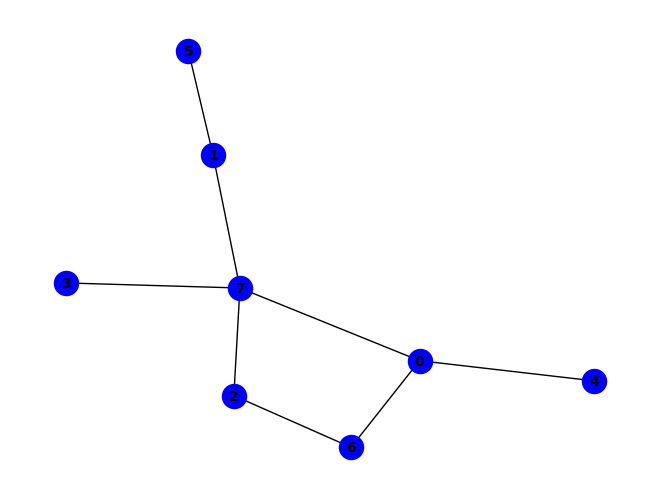


~d ^ (d & ~h) ^ (a & g & ~e) ^ (a & h & ~g) ^ (b & f & ~h) ^ (b & h & ~d) ^ (a & b & c & g) ^ (a & b & f & h) ^ (a & e & g & h) ^ (b & c & f & h) ^ (a & c & g & ~h) ^ (a & d & h & ~b) ^ (b & c & g & ~f) ^ (a & e & ~b & ~h) ^ (c & g & ~b & ~h) ^ (c & h & ~a & ~d) ^ (b & c & d & h & ~a) ^ (a & b & c & ~f & ~g) ^ (a & b & c & ~f & ~h) ^ (a & b & e & ~f & ~h) ^ (a & b & g & ~e & ~f) ^ (a & b & g & ~e & ~h) ^ (a & b & h & ~f & ~g) ^ (b & c & h & ~f & ~g) ^ (a & b & c & f & h & ~g) ^ (a & b & e & g & h & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


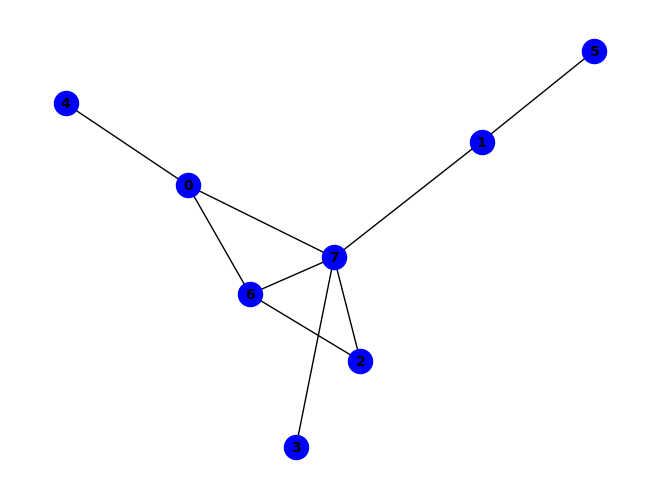


(~b & ~g) ^ (a & e & ~b) ^ (a & g & ~e) ^ (a & h & ~e) ^ (a & e & g & h) ^ (g & ~b & ~h) ^ (a & c & g & ~d) ^ (a & c & h & ~d) ^ (a & b & c & f & g) ^ (c & g & ~b & ~d) ^ (c & h & ~b & ~d) ^ (a & b & e & h & ~g) ^ (a & b & f & g & ~e) ^ (a & b & f & h & ~c) ^ (a & c & d & g & ~h) ^ (b & ~c & ~f & ~h) ^ (a & b & e & ~f & ~h) ^ (c & d & g & ~b & ~h) ^ (a & b & c & d & h & ~g) ^ (a & b & e & g & h & ~f) ^ (b & c & ~f & ~g & ~h) ^ (d & h & ~a & ~b & ~g) ^ (a & b & h & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


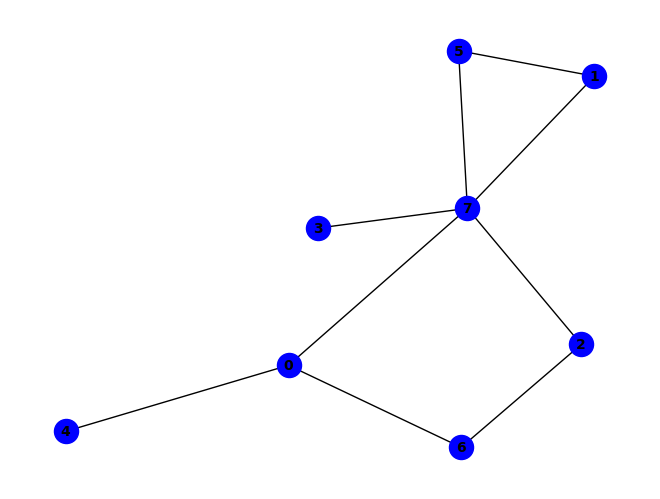


~f ^ (f & ~h) ^ (b & f & ~d) ^ (b & h & ~d) ^ (b & d & f & ~h) ^ (a & e & ~b & ~h) ^ (a & g & ~e & ~h) ^ (a & h & ~c & ~f) ^ (c & g & ~a & ~h) ^ (d & h & ~a & ~f) ^ (a & c & d & h & ~f) ^ (b & c & f & g & ~h) ^ (a & b & e & ~f & ~h) ^ (c & h & ~b & ~d & ~f) ^ (a & b & c & e & f & g & ~h) ^ (a & b & h & ~c & ~d & ~f) ^ (a & b & f & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


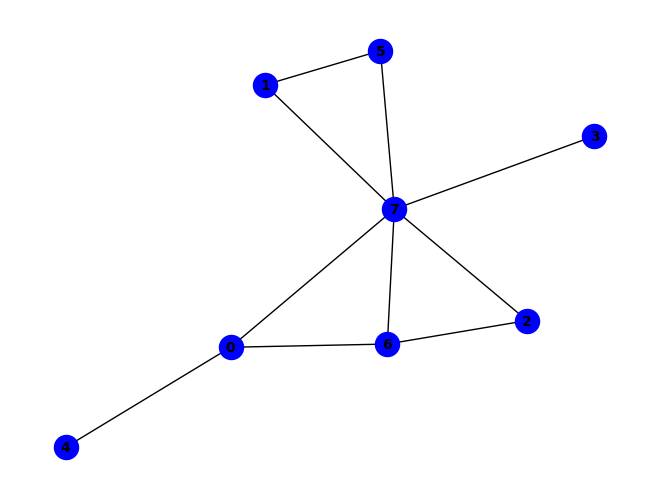


~g ^ (g & ~h) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & h & ~g) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & f & ~a & ~h) ^ (d & h & ~f & ~g) ^ (a & d & f & g & ~c) ^ (a & d & f & h & ~c) ^ (c & d & f & g & ~b) ^ (c & d & f & h & ~b) ^ (a & b & f & ~g & ~h) ^ (a & d & h & ~c & ~g) ^ (c & d & h & ~b & ~g) ^ (a & b & c & f & g & ~h) ^ (a & e & ~b & ~g & ~h) ^ (a & b & e & ~f & ~g & ~h) ^ (a & f & g & ~c & ~d & ~h) ^ (b & c & h & ~a & ~f & ~g) ^ (c & f & g & ~b & ~d & ~h) ^ (a & b & c & d & h & ~f & ~g) ^ (b & h & ~a & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


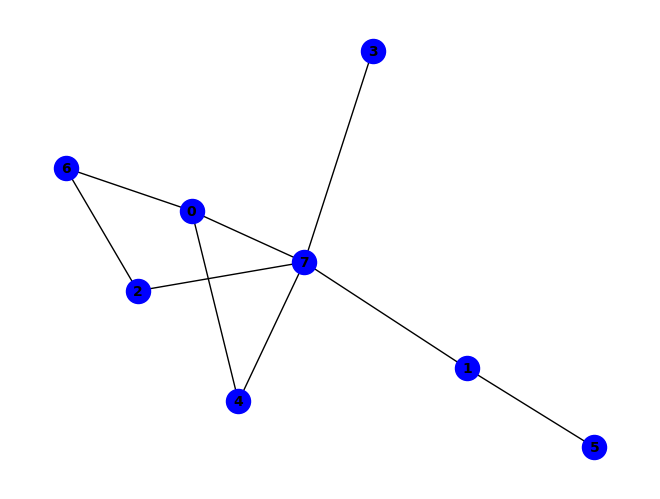


~e ^ (b & f) ^ (e & ~h) ^ (a & h & ~d) ^ (b & h & ~f) ^ (d & h & ~e) ^ (a & d & e & h) ^ (a & b & g & ~c) ^ (b & c & h & ~e) ^ (b & d & h & ~c) ^ (b & e & h & ~d) ^ (a & b & c & d & h) ^ (b & c & d & e & h) ^ (a & e & ~b & ~g) ^ (a & g & ~c & ~h) ^ (c & g & ~b & ~h) ^ (a & b & d & h & ~e) ^ (a & e & g & h & ~b) ^ (a & b & h & ~c & ~g) ^ (b & c & g & ~f & ~h) ^ (a & b & c & e & h & ~d) ^ (c & h & ~a & ~d & ~e) ^ (a & b & e & ~f & ~g & ~h) ^ (a & b & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


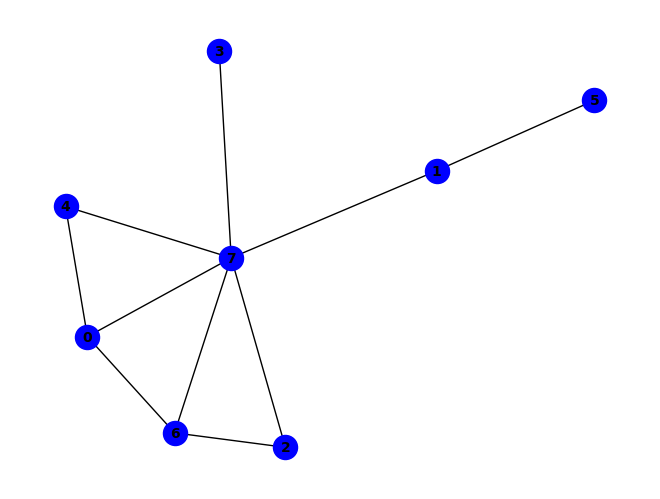


(~b & ~g) ^ (a & e & ~d) ^ (a & h & ~d) ^ (c & g & ~e) ^ (b & c & f & g) ^ (b & c & f & h) ^ (g & ~b & ~h) ^ (c & h & ~a & ~e) ^ (e & h & ~b & ~g) ^ (a & b & d & e & ~g) ^ (a & c & d & h & ~g) ^ (a & d & g & h & ~e) ^ (b & c & d & h & ~g) ^ (b & c & e & g & ~d) ^ (b & c & e & h & ~d) ^ (b & ~a & ~f & ~h) ^ (a & b & c & ~f & ~h) ^ (a & b & h & ~c & ~e) ^ (a & d & e & ~b & ~h) ^ (b & c & h & ~f & ~g) ^ (b & d & h & ~e & ~g) ^ (c & e & g & ~b & ~h) ^ (a & c & d & e & g & ~b) ^ (a & c & d & e & h & ~b) ^ (b & c & d & e & g & ~h) ^ (a & g & ~b & ~c & ~e) ^ (d & h & ~c & ~e & ~g) ^ (a & b & d & h & ~c & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & g & ~d & ~h) ^ (a & b & ~c & ~f & ~g & ~h) ^ (a & b & e & g & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


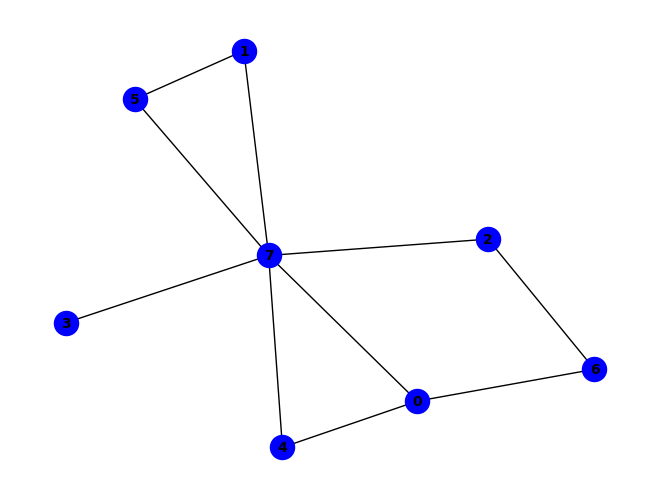


~f ^ (f & ~h) ^ (a & e & ~g) ^ (b & f & ~e) ^ (b & h & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & e & g & h) ^ (a & b & h & ~d) ^ (a & b & c & f & g) ^ (a & g & ~c & ~h) ^ (a & h & ~d & ~f) ^ (a & b & c & h & ~e) ^ (a & b & e & h & ~f) ^ (a & b & f & g & ~e) ^ (b & c & f & g & ~h) ^ (a & b & e & f & g & h) ^ (a & c & h & ~e & ~f) ^ (b & e & f & ~a & ~h) ^ (a & b & d & e & h & ~c) ^ (a & b & d & f & h & ~e) ^ (d & h & ~b & ~e & ~f) ^ (a & b & f & h & ~c & ~g) ^ (a & c & d & h & ~b & ~f) ^ (a & d & e & h & ~c & ~f) ^ (a & b & c & e & f & h & ~d) ^ (c & h & ~b & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


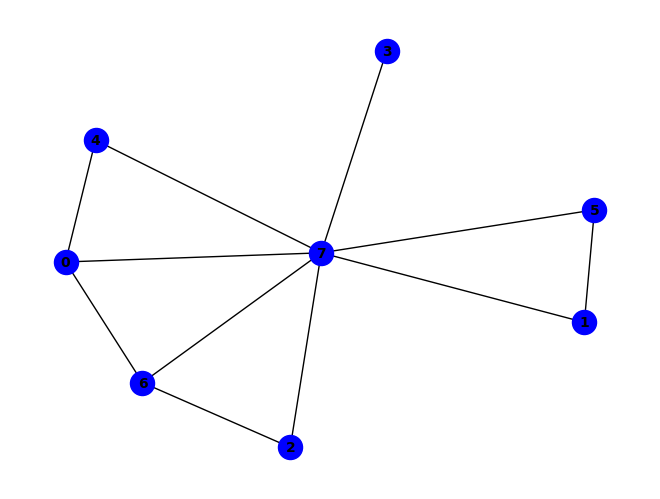


~g ^ (g & ~h) ^ (a & e & ~g) ^ (f & h & ~g) ^ (b & e & f & ~g) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & f & ~e & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & h & ~f & ~g) ^ (a & b & c & f & ~g) ^ (a & e & f & h & ~g) ^ (b & c & e & g & ~f) ^ (b & c & e & h & ~f) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (a & b & f & ~c & ~h) ^ (a & b & f & ~e & ~g) ^ (a & f & g & ~c & ~h) ^ (b & c & g & ~e & ~h) ^ (b & e & h & ~d & ~g) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (b & c & d & e & h & ~g) ^ (b & d & e & f & g & ~c) ^ (b & d & e & f & h & ~c) ^ (b & h & ~d & ~f & ~g) ^ (a & c & e & h & ~f & ~g) ^ (a & b & c & e & f & h & ~g) ^ (a & c & d & e & f & g & ~b) ^ (a & c & d & e & f & h & ~b) ^ (a & b & h & ~c & ~e & ~g) ^ (a & c & d & e & h & ~b & ~g) ^ (c & d & e & f & g & ~a & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (d & h & ~a & ~e & ~f & ~g) ^ (a & b & d & h & ~e & ~f & ~g) ^ (b & e & f & g & ~c & ~d & ~h) ^ (c & d & h & ~a & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS


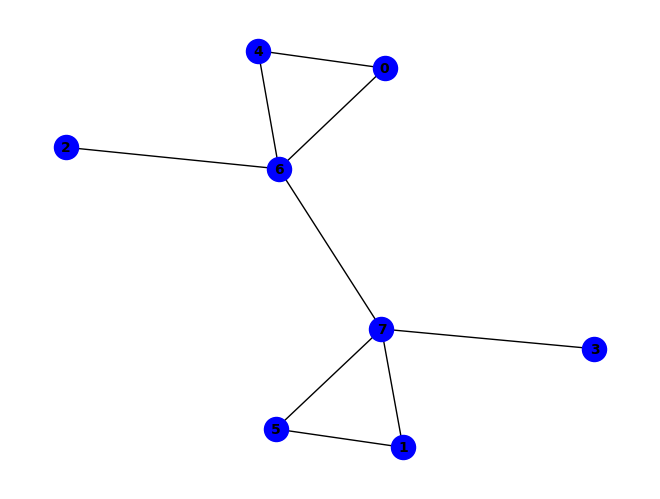


(~e & ~g) ^ (b & f & ~h) ^ (e & h & ~g) ^ (e & ~c & ~h) ^ (g & ~c & ~h) ^ (a & b & f & ~g) ^ (a & c & e & ~h) ^ (b & e & g & ~h) ^ (a & e & ~c & ~g) ^ (a & g & ~e & ~h) ^ (f & h & ~a & ~g) ^ (a & c & e & h & ~g) ^ (b & c & f & g & ~h) ^ (a & b & h & ~d & ~g) ^ (a & c & g & ~b & ~h) ^ (a & f & h & ~e & ~g) ^ (b & c & e & ~a & ~h) ^ (a & b & d & f & h & ~g) ^ (b & e & ~c & ~f & ~g) ^ (b & e & ~c & ~f & ~h) ^ (c & e & ~b & ~g & ~h) ^ (d & h & ~b & ~f & ~g) ^ (a & b & c & e & ~g & ~h) ^ (a & b & d & f & ~e & ~g) ^ (a & b & d & h & ~e & ~g) ^ (a & d & e & h & ~f & ~g) ^ (b & c & e & h & ~f & ~g) ^ (a & b & f & ~d & ~e & ~h) ^ (a & b & d & f & g & ~e & ~h) ^ (b & h & ~a & ~e & ~f & ~g) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


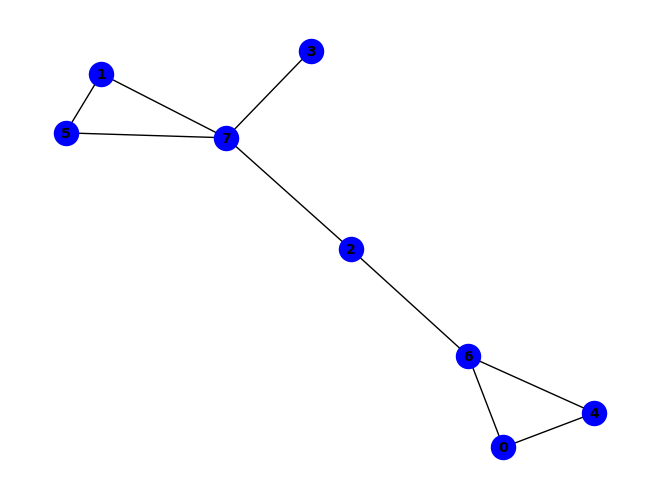


~f ^ (f & ~h) ^ (a & e & ~f) ^ (a & g & ~c) ^ (b & f & ~e) ^ (b & h & ~e) ^ (c & g & ~h) ^ (e & g & ~c) ^ (b & e & h & ~g) ^ (b & c & e & f & g) ^ (b & c & e & g & h) ^ (d & h & ~b & ~f) ^ (a & b & e & f & ~d) ^ (a & b & e & h & ~d) ^ (a & b & f & g & ~c) ^ (a & c & e & g & ~h) ^ (a & d & e & f & ~c) ^ (a & d & e & h & ~c) ^ (a & f & g & h & ~c) ^ (b & c & f & g & ~h) ^ (a & e & f & ~d & ~h) ^ (b & e & f & ~d & ~g) ^ (a & b & d & e & f & ~h) ^ (a & c & d & e & f & ~h) ^ (b & c & d & e & f & ~g) ^ (b & d & e & f & h & ~c) ^ (c & h & ~b & ~d & ~f) ^ (a & b & g & h & ~c & ~d) ^ (a & c & e & h & ~b & ~f) ^ (a & d & g & h & ~c & ~f) ^ (d & e & g & h & ~b & ~c) ^ (e & f & g & h & ~c & ~d) ^ (a & b & c & d & e & h & ~f) ^ (a & b & c & e & f & g & ~h) ^ (a & b & d & f & g & h & ~c) ^ (b & d & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

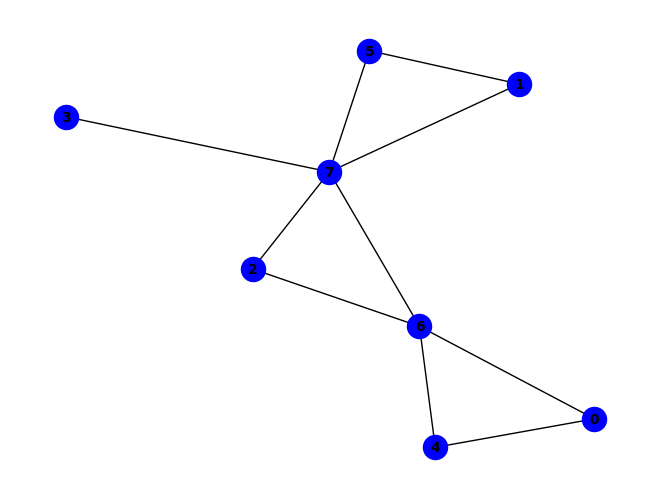


(g & ~h) ^ (~e & ~g) ^ (a & e & ~g) ^ (e & h & ~g) ^ (e & ~c & ~h) ^ (a & b & f & ~g) ^ (a & c & g & ~h) ^ (b & f & ~c & ~h) ^ (c & e & ~g & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (f & h & ~a & ~g) ^ (a & c & e & g & ~f) ^ (a & c & e & h & ~f) ^ (c & d & f & g & ~b) ^ (c & d & f & h & ~b) ^ (a & b & h & ~d & ~g) ^ (a & d & g & ~e & ~f) ^ (a & d & h & ~e & ~f) ^ (a & f & h & ~e & ~g) ^ (b & c & f & ~g & ~h) ^ (b & c & g & ~f & ~h) ^ (b & e & g & ~c & ~h) ^ (c & d & h & ~b & ~g) ^ (c & f & g & ~d & ~h) ^ (a & b & d & f & h & ~g) ^ (a & c & e & f & g & ~h) ^ (a & b & c & d & e & f & g) ^ (a & b & c & d & e & f & h) ^ (a & g & ~d & ~e & ~h) ^ (b & e & ~c & ~f & ~g) ^ (b & e & ~c & ~f & ~h) ^ (d & h & ~b & ~f & ~g) ^ (a & b & d & f & ~e & ~g) ^ (a & b & d & h & ~e & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & f & ~d & ~e & ~h) ^ (a & d & h & ~c & ~f & ~g) ^ (b & c & d & f & g & ~a & ~h) ^ (b & h & ~a & ~e & ~f & ~g) ^ (a & c & d & h & ~e & ~f & ~g) ^ (a & d & f & g & ~b & ~e & ~h)

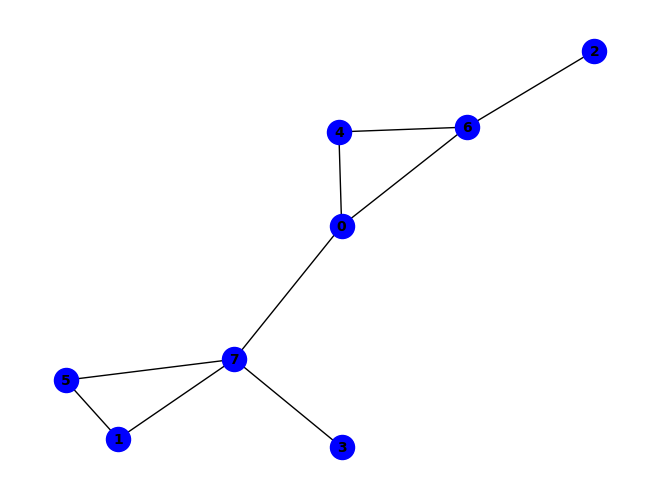


~f ^ (e & g) ^ (f & ~h) ^ (a & h & ~g) ^ (b & f & ~e) ^ (b & h & ~e) ^ (c & g & ~e) ^ (a & b & h & ~d) ^ (a & d & h & ~f) ^ (a & f & h & ~e) ^ (b & e & h & ~g) ^ (a & c & f & g & h) ^ (a & e & ~g & ~h) ^ (a & g & ~c & ~e) ^ (d & h & ~b & ~f) ^ (a & b & f & g & ~c) ^ (a & b & f & h & ~g) ^ (b & c & f & g & ~e) ^ (c & f & g & h & ~e) ^ (e & f & g & h & ~d) ^ (a & b & c & e & f & g) ^ (a & b & d & e & f & g) ^ (a & b & d & e & g & h) ^ (a & c & d & e & g & h) ^ (c & d & e & f & g & h) ^ (b & e & f & ~d & ~g) ^ (a & b & d & f & h & ~c) ^ (a & b & e & g & h & ~f) ^ (a & c & d & g & h & ~f) ^ (a & c & e & f & h & ~d) ^ (a & d & e & g & h & ~f) ^ (b & d & e & f & h & ~c) ^ (a & b & c & d & e & f & h) ^ (a & b & e & f & ~d & ~h) ^ (a & e & f & h & ~c & ~g) ^ (b & c & g & h & ~a & ~e) ^ (c & d & g & h & ~b & ~f) ^ (d & e & g & h & ~b & ~c) ^ (a & b & c & d & f & h & ~g) ^ (a & b & c & d & g & h & ~e) ^ (a & c & d & e & f & h & ~g) ^ (b & c & d & e & f & ~a & ~g) ^ (b & d & e & f & ~a & ~c & ~g

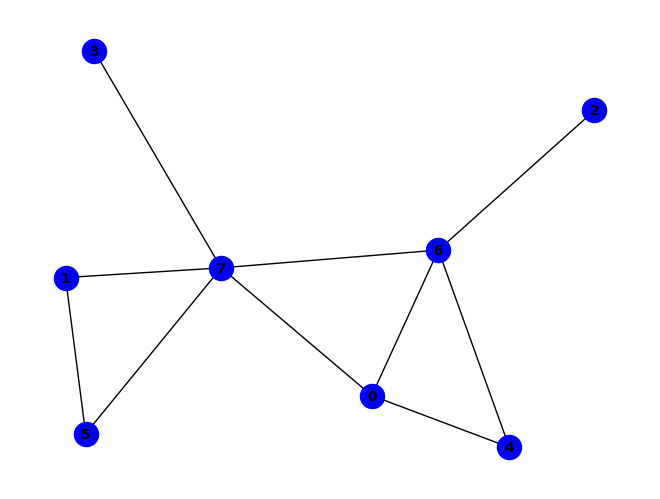


(~e & ~g) ^ (e & h & ~g) ^ (f & h & ~g) ^ (g & ~c & ~h) ^ (b & e & g & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (b & f & ~a & ~h) ^ (a & b & e & f & ~h) ^ (a & d & f & g & ~b) ^ (a & d & f & h & ~b) ^ (b & c & f & g & ~h) ^ (e & ~a & ~c & ~h) ^ (a & b & f & ~g & ~h) ^ (a & c & g & ~b & ~h) ^ (a & d & h & ~b & ~g) ^ (a & f & g & ~d & ~h) ^ (b & c & e & ~a & ~h) ^ (a & b & d & f & g & ~h) ^ (b & e & ~c & ~f & ~g) ^ (b & e & ~c & ~f & ~h) ^ (b & h & ~e & ~f & ~g) ^ (d & h & ~b & ~f & ~g) ^ (b & c & e & h & ~f & ~g) ^ (a & b & g & ~c & ~f & ~h) ^ (a & b & c & e & g & ~f & ~h) ^ (c & e & ~a & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


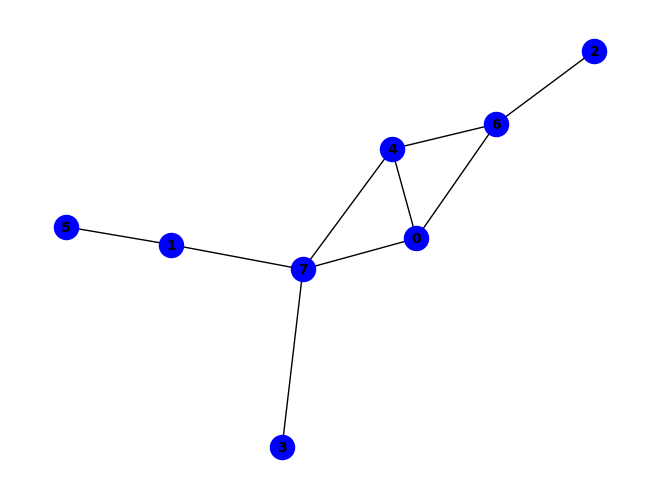


~d ^ (d & ~h) ^ (a & e & ~d) ^ (a & g & ~h) ^ (a & h & ~d) ^ (b & f & ~c) ^ (a & b & f & g) ^ (a & d & e & ~h) ^ (b & d & h & ~c) ^ (b & c & e & g & h) ^ (b & h & ~a & ~f) ^ (c & g & ~a & ~e) ^ (e & g & ~b & ~h) ^ (e & h & ~b & ~d) ^ (a & b & d & h & ~e) ^ (a & b & e & f & ~h) ^ (a & b & e & h & ~c) ^ (a & b & f & h & ~g) ^ (b & c & g & h & ~f) ^ (b & c & f & ~e & ~g) ^ (b & e & g & ~f & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & c & g & h & ~d) ^ (b & c & d & e & h & ~a) ^ (b & c & e & f & h & ~g) ^ (b & c & d & h & ~e & ~g) ^ (b & c & e & f & ~a & ~h) ^ (c & d & g & h & ~a & ~e) ^ (a & b & c & e & f & ~g & ~h) ^ (a & b & c & e & h & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


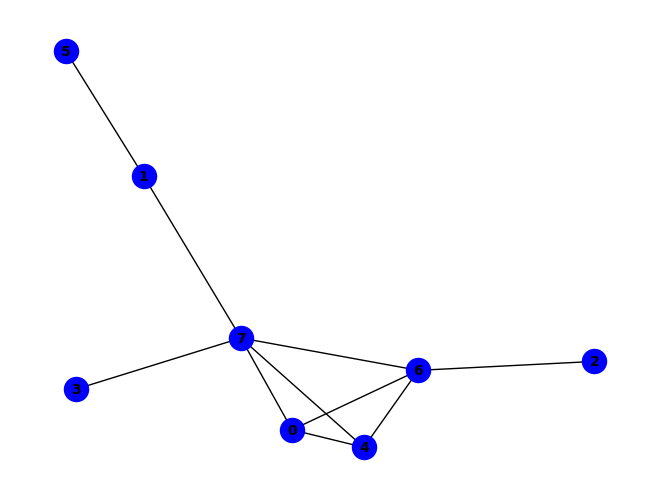


(c & ~e & ~h) ^ (g & ~b & ~h) ^ (b & c & f & ~h) ^ (~b & ~c & ~g) ^ (a & g & ~b & ~d) ^ (a & h & ~b & ~d) ^ (c & e & ~g & ~h) ^ (c & h & ~b & ~g) ^ (d & h & ~b & ~g) ^ (e & g & ~b & ~d) ^ (e & h & ~b & ~d) ^ (b & ~e & ~f & ~h) ^ (a & c & e & ~b & ~h) ^ (a & c & g & ~b & ~h) ^ (a & d & g & ~b & ~h) ^ (a & e & g & ~b & ~h) ^ (d & e & g & ~b & ~h) ^ (b & c & e & f & g & ~h) ^ (a & e & ~b & ~c & ~g) ^ (b & c & ~f & ~g & ~h) ^ (b & e & ~f & ~g & ~h) ^ (a & c & e & h & ~b & ~g) ^ (a & d & e & h & ~b & ~g) ^ (a & b & e & ~c & ~f & ~h) ^ (a & b & g & ~c & ~f & ~h) ^ (a & b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


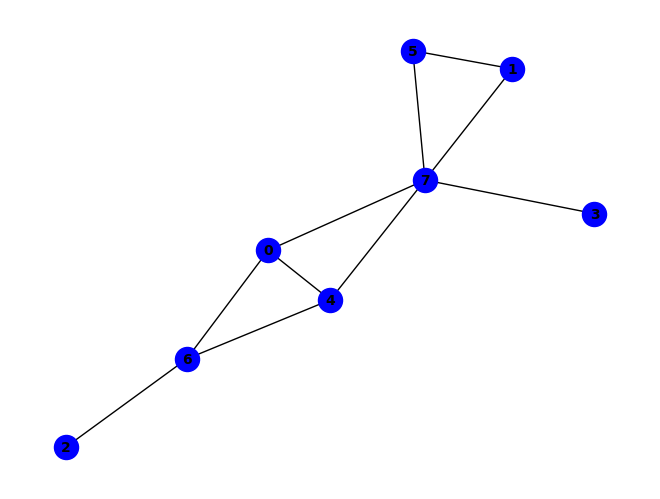


~f ^ (a & e & ~f) ^ (a & f & ~d) ^ (a & g & ~h) ^ (a & h & ~d) ^ (b & f & ~e) ^ (b & h & ~d) ^ (e & g & ~h) ^ (b & e & f & h) ^ (f & ~a & ~h) ^ (a & b & h & ~e) ^ (a & d & f & ~h) ^ (a & e & f & ~h) ^ (c & g & ~a & ~e) ^ (d & h & ~e & ~f) ^ (e & h & ~b & ~f) ^ (a & b & d & h & ~f) ^ (a & b & e & f & ~d) ^ (a & b & f & g & ~c) ^ (a & b & f & h & ~g) ^ (a & d & e & h & ~f) ^ (b & c & f & g & ~e) ^ (b & d & e & h & ~f) ^ (b & d & f & h & ~c) ^ (a & b & c & e & f & g) ^ (b & e & f & ~g & ~h) ^ (a & b & c & g & h & ~e) ^ (a & b & d & e & f & ~h) ^ (a & b & d & e & h & ~c) ^ (b & c & g & h & ~d & ~e) ^ (c & f & g & h & ~a & ~e) ^ (a & b & c & d & g & h & ~f) ^ (b & c & d & e & f & h & ~a) ^ (b & c & d & f & h & ~e & ~g) ^ (c & d & g & h & ~a & ~e & ~f) ^ (a & b & c & d & e & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

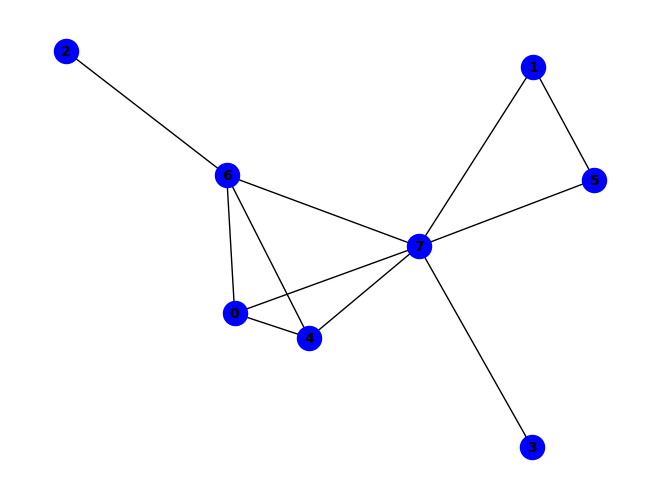


(g & ~h) ^ (~c & ~g) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~e & ~h) ^ (a & c & g & ~h) ^ (a & e & g & ~h) ^ (a & e & ~c & ~g) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (b & f & ~e & ~h) ^ (e & g & ~b & ~f) ^ (e & h & ~b & ~f) ^ (a & c & e & h & ~g) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (b & c & e & f & ~h) ^ (b & c & f & g & ~h) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (a & b & g & ~c & ~h) ^ (a & c & e & ~b & ~h) ^ (a & f & g & ~e & ~h) ^ (b & e & f & ~g & ~h) ^ (b & e & g & ~f & ~h) ^ (e & f & g & ~d & ~h) ^ (a & b & d & e & f & ~g) ^ (b & d & e & f & g & ~h) ^ (b & h & ~d & ~f & ~g) ^ (c & e & ~b & ~g & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & b & c & e & ~g & ~h) ^ (a & b & d & h & ~f & ~g) ^ (a & b & e & f & ~d & ~h) ^ (a & b & e & h & ~f & ~g) ^ (b & c & e & ~f & ~g & ~h) ^ (d & e & h & ~a & ~b & ~g) ^ (a & d & e & f & g & ~b & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


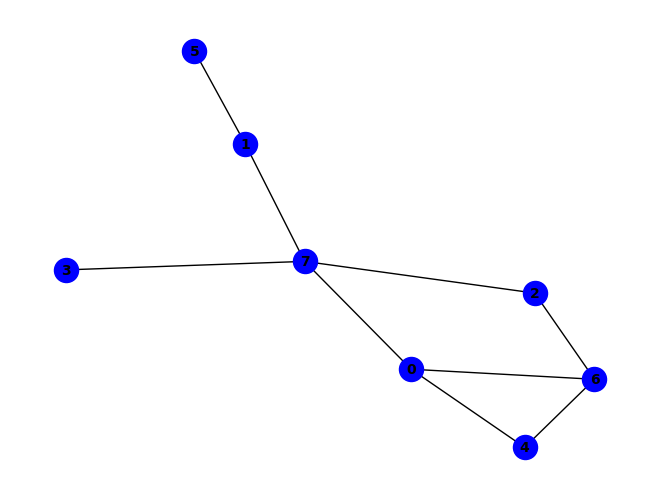


~e ^ (a & g & ~e) ^ (a & h & ~g) ^ (b & f & ~e) ^ (b & h & ~f) ^ (a & b & c & g) ^ (b & e & f & h) ^ (e & ~d & ~g) ^ (a & b & h & ~d) ^ (a & c & g & ~h) ^ (a & d & h & ~e) ^ (c & e & g & ~a) ^ (a & c & d & e & h) ^ (c & d & e & g & h) ^ (c & g & ~b & ~h) ^ (c & h & ~a & ~d) ^ (d & e & ~g & ~h) ^ (d & h & ~b & ~e) ^ (a & b & c & h & ~g) ^ (a & b & f & g & ~h) ^ (b & c & e & f & ~h) ^ (b & e & g & h & ~a) ^ (a & b & c & e & g & h) ^ (a & b & d & e & g & h) ^ (a & d & e & ~c & ~g) ^ (b & c & h & ~d & ~e) ^ (b & e & f & ~g & ~h) ^ (a & b & c & d & h & ~e) ^ (a & e & ~d & ~g & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & c & d & e & ~g & ~h) ^ (b & c & e & f & ~a & ~g) ^ (b & c & e & h & ~f & ~g) ^ (b & d & e & h & ~c & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & c & e & f & h & ~g) ^ (b & c & g & ~a & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


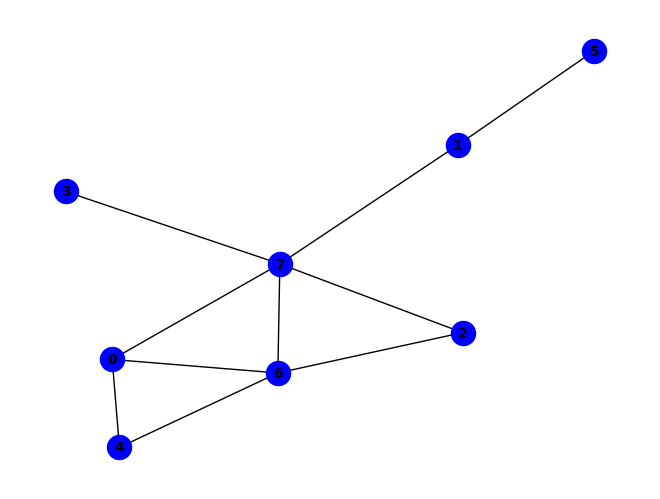


(a & e & ~c) ^ (c & g & ~e) ^ (c & h & ~e) ^ (a & b & d & h) ^ (a & b & e & f) ^ (e & ~b & ~h) ^ (g & ~b & ~h) ^ (a & b & h & ~e) ^ (a & d & h & ~c) ^ (b & c & g & ~d) ^ (b & d & h & ~g) ^ (~b & ~e & ~g) ^ (a & h & ~c & ~e) ^ (d & h & ~c & ~g) ^ (a & b & e & h & ~f) ^ (b & c & d & g & ~h) ^ (b & c & e & f & ~g) ^ (b & ~e & ~f & ~h) ^ (a & b & g & ~f & ~h) ^ (b & c & h & ~a & ~d) ^ (a & g & ~b & ~c & ~d) ^ (b & e & ~f & ~g & ~h) ^ (e & h & ~b & ~c & ~g) ^ (b & c & e & f & ~a & ~h) ^ (b & c & e & h & ~f & ~g) ^ (a & c & e & ~b & ~g & ~h) ^ (a & d & g & ~b & ~c & ~h) ^ (b & c & g & ~a & ~f & ~h) ^ (a & b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


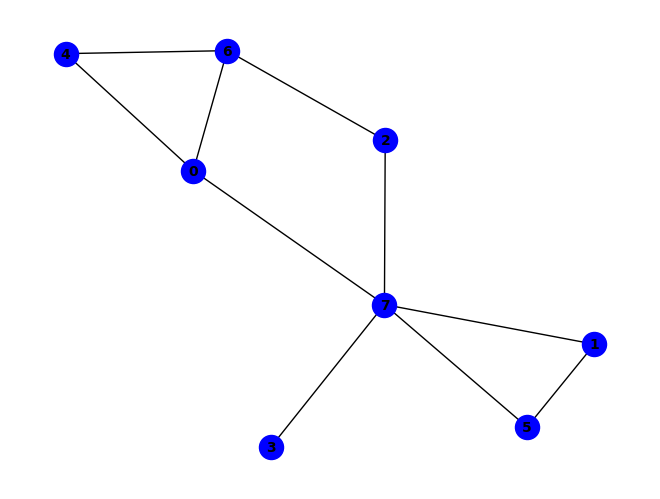


~f ^ (f & ~h) ^ (b & f & ~e) ^ (b & h & ~e) ^ (c & g & ~h) ^ (e & g & ~c) ^ (b & e & h & ~g) ^ (a & e & ~g & ~h) ^ (a & g & ~c & ~e) ^ (a & h & ~c & ~g) ^ (d & h & ~b & ~f) ^ (a & b & c & h & ~f) ^ (b & c & f & g & ~h) ^ (a & b & d & e & f & g) ^ (a & b & h & ~e & ~f) ^ (a & f & h & ~c & ~e) ^ (b & e & f & ~d & ~g) ^ (a & d & e & f & h & ~c) ^ (b & c & e & f & g & ~a) ^ (b & c & e & g & h & ~a) ^ (b & d & e & f & h & ~c) ^ (a & b & c & d & e & f & h) ^ (c & h & ~b & ~d & ~f) ^ (a & b & e & f & ~d & ~h) ^ (a & b & e & h & ~f & ~g) ^ (a & b & f & g & ~c & ~h) ^ (e & f & g & h & ~c & ~d) ^ (a & d & h & ~b & ~c & ~f) ^ (b & c & d & e & f & ~a & ~g) ^ (a & e & f & h & ~c & ~d & ~g) ^ (d & e & g & h & ~a & ~b & ~c) ^ (b & d & e & f & ~a & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


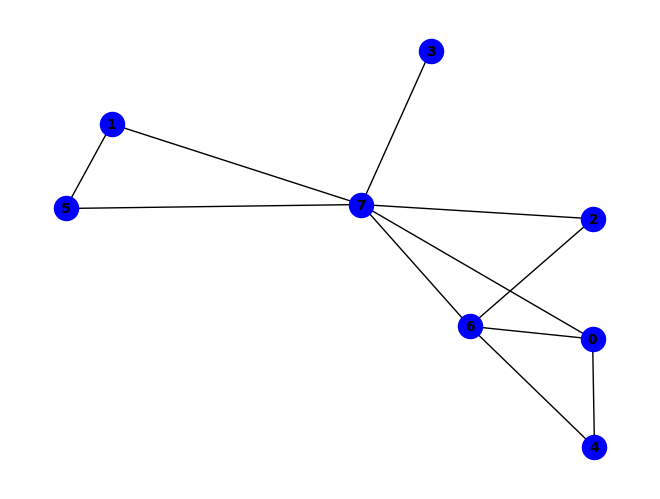


(g & ~h) ^ (~e & ~g) ^ (e & h & ~g) ^ (f & h & ~g) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & f & ~c & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (a & b & c & g & ~d) ^ (a & b & c & h & ~d) ^ (a & b & d & h & ~g) ^ (a & b & e & f & ~h) ^ (c & d & f & g & ~b) ^ (c & d & f & h & ~b) ^ (e & ~a & ~c & ~h) ^ (a & b & h & ~f & ~g) ^ (a & f & g & ~c & ~h) ^ (b & c & f & ~g & ~h) ^ (b & e & g & ~c & ~h) ^ (c & d & h & ~b & ~g) ^ (c & f & g & ~d & ~h) ^ (a & b & c & f & h & ~g) ^ (a & b & d & f & g & ~c) ^ (a & b & d & f & h & ~c) ^ (b & c & d & f & g & ~h) ^ (b & e & ~c & ~f & ~g) ^ (b & e & ~c & ~f & ~h) ^ (b & h & ~e & ~f & ~g) ^ (c & e & ~a & ~g & ~h) ^ (d & h & ~b & ~f & ~g) ^ (a & b & f & g & ~d & ~h) ^ (b & c & e & h & ~f & ~g) ^ (a & b & c & e & f & g & ~h) ^ (a & d & h & ~c & ~f & ~g) ^ (b & c & g & ~a & ~f & ~h) ^ (a & b & c & d & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


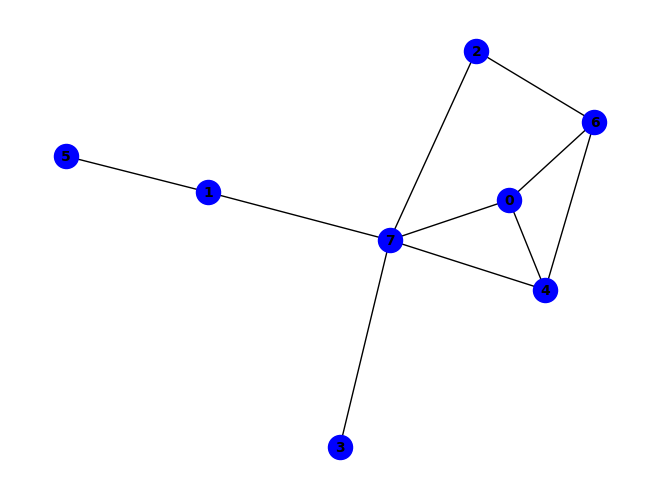


~d ^ (b & f) ^ (d & ~h) ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & c & f & g) ^ (a & d & e & ~h) ^ (b & d & h & ~c) ^ (a & g & ~c & ~h) ^ (b & h & ~c & ~f) ^ (c & g & ~e & ~h) ^ (e & g & ~b & ~h) ^ (e & h & ~b & ~d) ^ (a & b & c & g & ~e) ^ (a & b & e & f & ~h) ^ (a & b & f & g & ~h) ^ (a & c & e & g & ~h) ^ (b & c & e & h & ~d) ^ (a & b & h & ~d & ~e) ^ (b & e & g & ~f & ~h) ^ (a & b & c & d & h & ~e) ^ (b & c & e & f & g & ~h) ^ (c & h & ~a & ~d & ~e) ^ (b & c & f & h & ~a & ~g) ^ (a & b & c & e & f & h & ~g) ^ (a & b & c & ~e & ~f & ~g) ^ (a & b & c & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


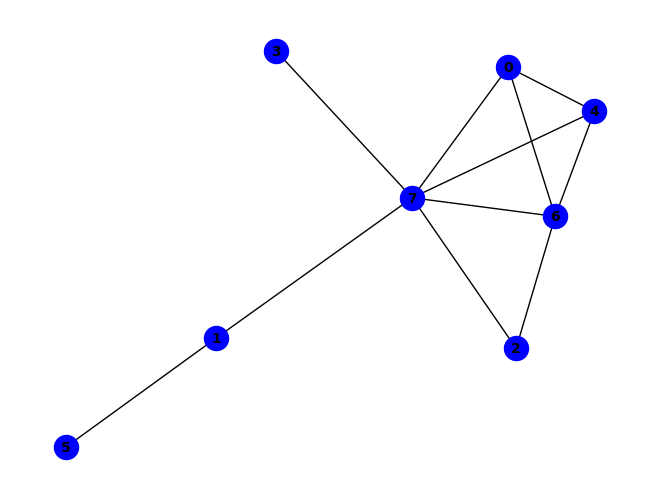


(~b & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (a & b & f & g) ^ (a & b & f & h) ^ (g & ~b & ~h) ^ (a & e & ~b & ~g) ^ (c & g & ~b & ~e) ^ (c & h & ~b & ~e) ^ (e & g & ~b & ~d) ^ (e & h & ~b & ~d) ^ (a & b & c & g & ~e) ^ (a & b & c & h & ~e) ^ (b & ~e & ~f & ~h) ^ (a & b & h & ~f & ~g) ^ (a & c & g & ~d & ~e) ^ (a & c & h & ~d & ~e) ^ (a & d & g & ~c & ~h) ^ (a & e & g & ~b & ~h) ^ (d & e & g & ~b & ~h) ^ (a & c & d & e & g & ~h) ^ (b & e & ~f & ~g & ~h) ^ (d & h & ~b & ~c & ~g) ^ (a & b & c & g & ~f & ~h) ^ (a & b & d & h & ~c & ~g) ^ (a & d & e & h & ~b & ~g) ^ (c & d & e & h & ~b & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & e & ~c & ~f & ~h) ^ (b & c & g & ~e & ~f & ~h) ^ (a & b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


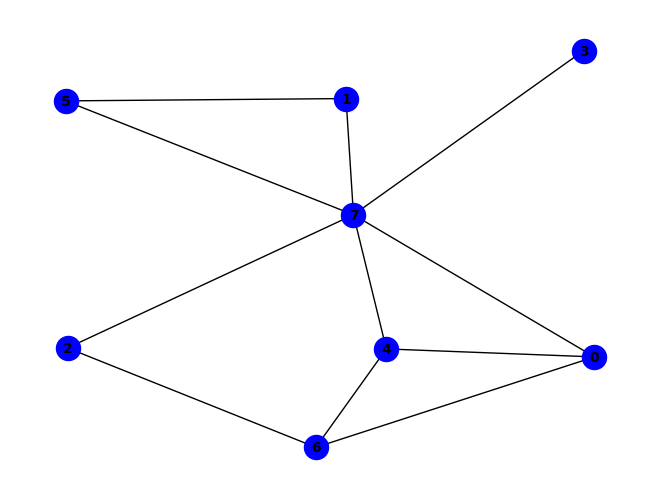


~f ^ (f & ~h) ^ (a & e & ~f) ^ (a & g & ~h) ^ (b & f & ~e) ^ (b & h & ~d) ^ (e & g & ~h) ^ (b & d & f & h) ^ (a & b & h & ~e) ^ (a & c & g & ~e) ^ (a & e & f & ~h) ^ (b & c & h & ~e) ^ (a & h & ~d & ~f) ^ (c & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (e & h & ~b & ~f) ^ (a & b & c & h & ~d) ^ (a & b & d & h & ~f) ^ (a & b & e & f & ~d) ^ (a & b & f & g & ~c) ^ (a & c & d & h & ~f) ^ (a & c & f & h & ~e) ^ (b & c & d & h & ~f) ^ (b & c & f & g & ~e) ^ (b & e & f & h & ~d) ^ (b & c & d & e & f & h) ^ (a & c & h & ~e & ~g) ^ (b & e & f & ~g & ~h) ^ (a & b & c & e & h & ~f) ^ (a & b & d & e & f & ~h) ^ (c & h & ~d & ~e & ~f) ^ (a & b & f & h & ~c & ~g) ^ (a & d & e & h & ~c & ~f) ^ (b & c & f & h & ~e & ~g) ^ (b & d & e & h & ~a & ~c) ^ (a & b & c & d & f & h & ~e) ^ (a & b & c & e & f & g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

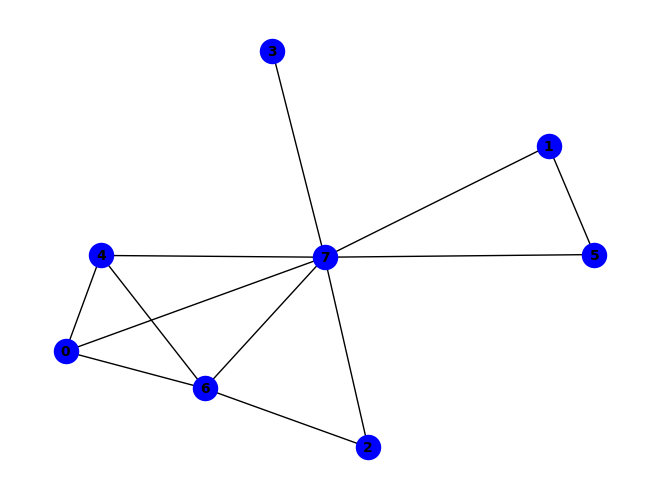


~g ^ (g & ~h) ^ (a & e & ~g) ^ (f & h & ~g) ^ (b & c & g & ~h) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & f & ~e & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & d & e & g & ~f) ^ (a & d & e & h & ~f) ^ (a & e & f & h & ~g) ^ (b & c & e & f & ~h) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & e & g & ~d & ~h) ^ (a & f & g & ~c & ~h) ^ (c & f & g & ~e & ~h) ^ (d & e & h & ~c & ~g) ^ (e & f & g & ~d & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & d & f & g & ~e) ^ (a & b & d & f & h & ~e) ^ (a & c & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (a & b & d & h & ~e & ~g) ^ (a & b & e & f & ~c & ~h) ^ (a & b & f & g & ~d & ~h) ^ (a & c & e & g & ~b & ~f) ^ (a & c & e & h & ~b & ~f) ^ (b & c & e & h & ~f & ~g) ^ (a & b & h & ~e & ~f & ~g) ^ (b & e & f & ~c & ~g & ~h) ^ (a & b & c & e & f & ~g & ~h) ^ (a & b & c & e & g & ~f & ~h) ^ (a & d & e & f & g & ~b & ~h) ^ (b & h & ~d & ~e & ~f & ~g) ^ (d & h & ~a & ~c & ~f & ~g) ^ (a & b & c & h & ~d

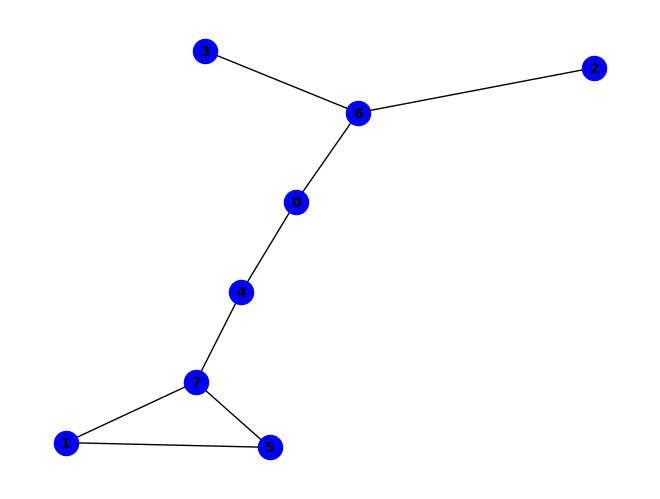


~f ^ (f & ~h) ^ (a & g & ~e) ^ (b & f & ~e) ^ (b & h & ~e) ^ (d & g & ~a) ^ (e & h & ~f) ^ (a & e & ~f & ~h) ^ (c & g & ~a & ~d) ^ (a & b & f & g & ~c) ^ (a & e & f & g & ~b) ^ (a & f & g & h & ~d) ^ (b & c & f & g & ~d) ^ (b & d & f & g & ~a) ^ (b & d & g & h & ~e) ^ (d & f & g & h & ~e) ^ (a & b & c & d & f & g) ^ (c & d & e & f & g & h) ^ (b & e & f & ~a & ~h) ^ (a & d & e & f & h & ~c) ^ (a & b & c & d & e & f & h) ^ (a & b & d & e & f & g & h) ^ (a & d & e & f & ~c & ~g) ^ (b & c & g & h & ~d & ~e) ^ (c & e & g & h & ~a & ~f) ^ (c & f & g & h & ~a & ~d) ^ (d & e & g & h & ~a & ~c) ^ (a & b & c & d & e & f & ~g) ^ (b & c & e & f & g & h & ~a) ^ (b & d & e & f & g & h & ~c) ^ (a & e & f & ~d & ~g & ~h) ^ (a & b & g & h & ~c & ~d & ~e) ^ (a & c & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

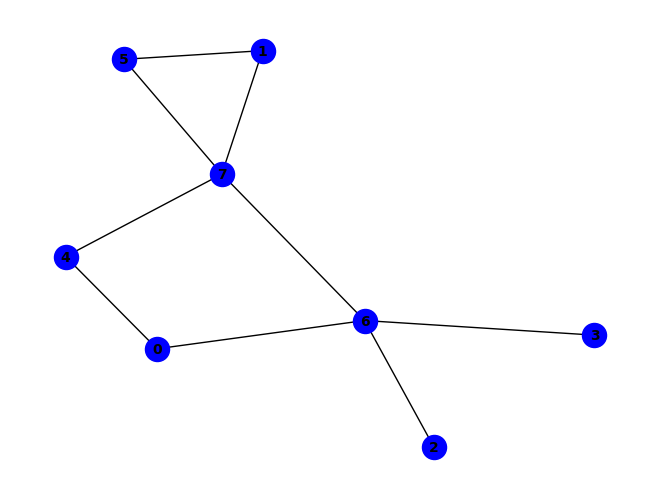


(~d & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (b & d & f & ~g) ^ (b & d & f & ~h) ^ (b & e & f & ~g) ^ (b & e & h & ~g) ^ (b & f & ~e & ~h) ^ (c & d & ~g & ~h) ^ (d & h & ~b & ~g) ^ (e & h & ~f & ~g) ^ (b & e & f & g & ~h) ^ (a & e & ~b & ~g & ~h) ^ (a & g & ~c & ~d & ~h) ^ (b & h & ~d & ~f & ~g) ^ (b & c & f & g & ~d & ~h) ^ (a & b & e & ~f & ~g & ~h) ^ (a & b & f & g & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


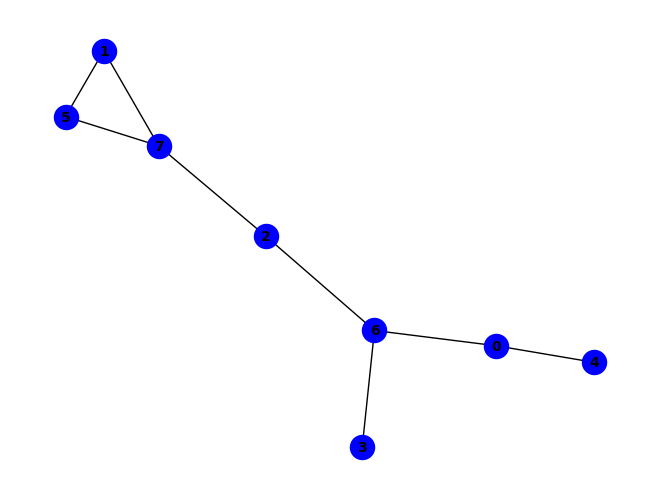


~f ^ (a & e & ~g) ^ (a & g & ~f) ^ (b & f & ~d) ^ (b & h & ~d) ^ (c & g & ~h) ^ (f & ~a & ~h) ^ (a & c & g & ~e) ^ (b & d & f & ~g) ^ (a & b & c & g & h) ^ (c & h & ~b & ~f) ^ (d & g & ~a & ~c) ^ (a & b & e & f & ~g) ^ (a & b & f & g & ~d) ^ (a & b & g & h & ~d) ^ (a & c & e & g & ~h) ^ (a & c & e & h & ~f) ^ (a & d & f & h & ~c) ^ (a & e & f & h & ~g) ^ (b & c & d & h & ~a) ^ (b & c & f & g & ~h) ^ (d & f & g & h & ~c) ^ (a & b & c & e & f & h) ^ (a & d & f & ~c & ~g) ^ (b & d & h & ~c & ~g) ^ (a & b & c & d & h & ~g) ^ (a & b & c & f & g & ~e) ^ (a & c & f & g & h & ~e) ^ (b & c & d & f & g & ~a) ^ (a & f & ~d & ~g & ~h) ^ (a & b & e & h & ~c & ~g) ^ (a & c & d & f & ~g & ~h) ^ (a & b & c & e & f & g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


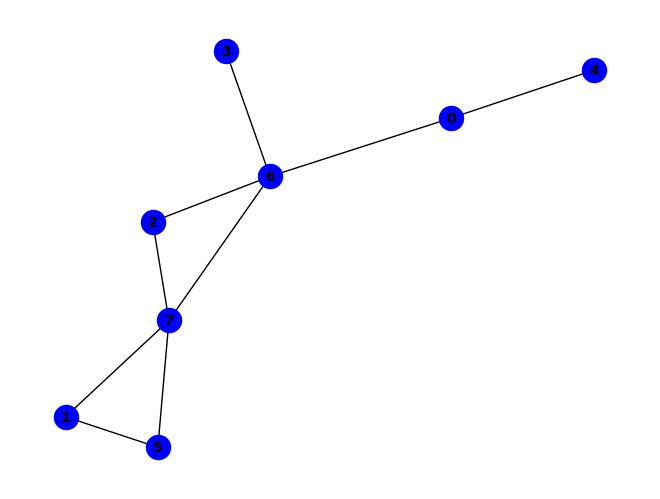


(~d & ~g) ^ (a & e & ~g) ^ (d & h & ~g) ^ (d & ~c & ~h) ^ (g & ~a & ~h) ^ (b & f & ~a & ~h) ^ (c & d & ~g & ~h) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (f & h & ~a & ~g) ^ (a & b & f & ~e & ~g) ^ (a & c & h & ~e & ~g) ^ (a & d & g & ~c & ~h) ^ (a & f & h & ~e & ~g) ^ (c & f & g & ~b & ~h) ^ (a & c & f & g & ~b & ~e) ^ (a & c & f & h & ~b & ~e) ^ (a & b & h & ~c & ~e & ~g) ^ (a & c & e & f & g & ~b & ~h) ^ (b & h & ~a & ~c & ~f & ~g) ^ (b & d & f & g & ~a & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


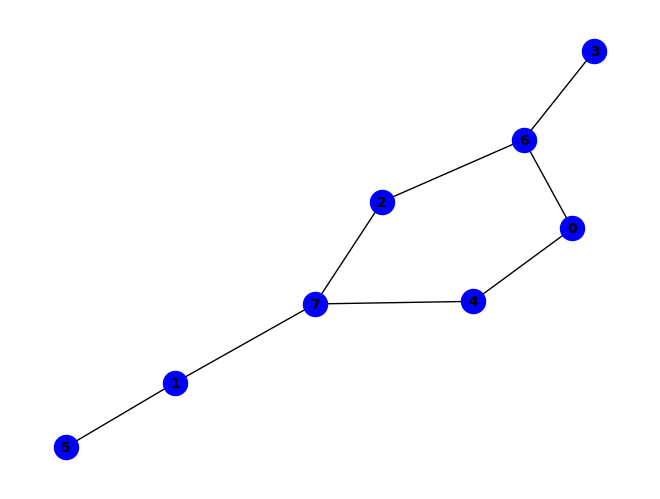


(a & d & g) ^ (~a & ~e) ^ (b & f & ~d) ^ (b & h & ~f) ^ (d & g & ~c) ^ (a & ~e & ~g) ^ (e & ~a & ~h) ^ (a & c & g & ~d) ^ (b & e & h & ~d) ^ (a & b & e & f & g) ^ (c & g & ~b & ~h) ^ (c & h & ~b & ~e) ^ (a & b & e & f & ~h) ^ (b & d & e & h & ~g) ^ (b & d & g & h & ~f) ^ (b & c & g & ~f & ~h) ^ (b & d & f & ~c & ~g) ^ (a & b & c & f & g & ~h) ^ (a & b & e & g & h & ~f) ^ (a & c & e & g & h & ~b) ^ (b & c & d & f & h & ~g) ^ (b & c & d & g & h & ~e) ^ (a & b & f & g & ~d & ~h) ^ (a & b & g & h & ~c & ~d) ^ (b & c & d & f & ~a & ~h) ^ (d & e & g & h & ~a & ~c) ^ (a & b & d & e & g & h & ~c) ^ (a & b & c & d & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


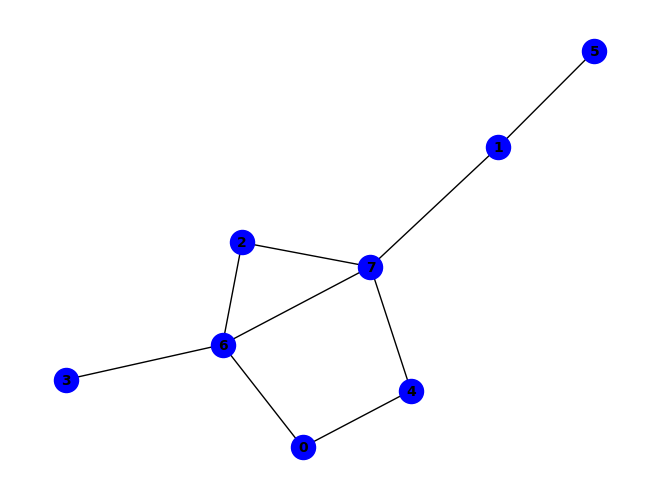


(d & ~c & ~h) ^ (g & ~b & ~h) ^ (~b & ~d & ~g) ^ (c & g & ~b & ~e) ^ (c & h & ~b & ~e) ^ (d & h & ~b & ~g) ^ (e & h & ~b & ~g) ^ (b & ~c & ~f & ~h) ^ (b & d & f & ~c & ~h) ^ (c & e & g & ~b & ~h) ^ (a & e & ~b & ~g & ~h) ^ (a & g & ~c & ~d & ~h) ^ (b & d & ~f & ~g & ~h) ^ (c & d & ~b & ~g & ~h) ^ (a & b & e & ~f & ~g & ~h) ^ (b & c & ~d & ~f & ~g & ~h) ^ (a & b & f & g & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


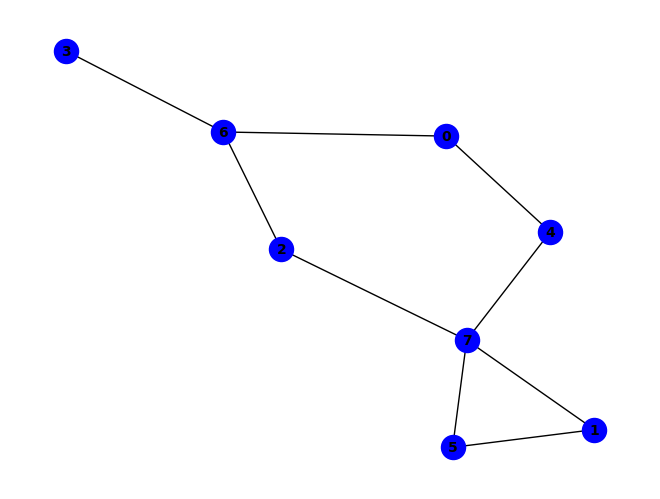


~f ^ (f & ~h) ^ (b & f & ~e) ^ (b & h & ~e) ^ (c & g & ~h) ^ (d & g & ~c) ^ (e & h & ~f) ^ (a & c & g & ~d) ^ (a & b & d & f & g) ^ (a & e & ~d & ~h) ^ (a & g & ~d & ~e) ^ (a & b & f & g & ~e) ^ (b & c & f & g & ~h) ^ (b & d & f & g & ~c) ^ (d & e & g & h & ~c) ^ (a & d & e & ~g & ~h) ^ (b & e & f & ~a & ~h) ^ (a & b & c & f & g & ~d) ^ (a & c & f & g & h & ~d) ^ (a & b & d & e & f & g & h) ^ (c & h & ~b & ~e & ~f) ^ (a & f & g & h & ~d & ~e) ^ (b & d & g & h & ~c & ~e) ^ (d & f & g & h & ~c & ~e) ^ (b & d & e & f & g & h & ~c) ^ (a & c & e & g & h & ~d & ~f) ^ (a & b & c & e & f & g & h & ~d) ^ (a & b & g & h & ~c & ~d & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


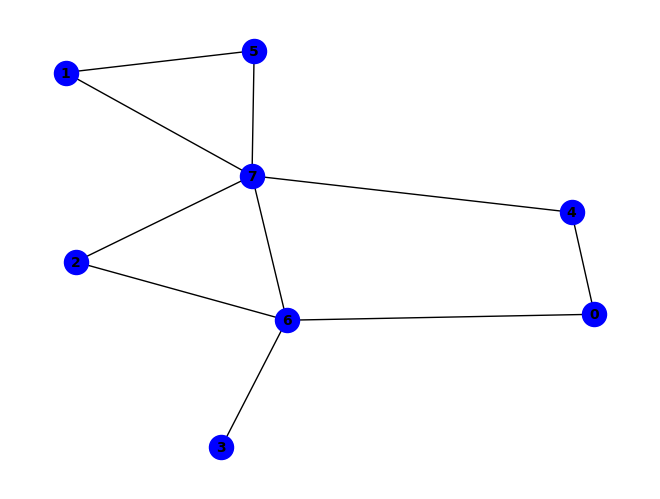


(~d & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~a & ~h) ^ (b & f & ~c & ~h) ^ (c & d & ~g & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & h & ~f & ~g) ^ (c & e & f & g & ~b) ^ (c & e & f & h & ~b) ^ (a & c & g & ~b & ~h) ^ (a & d & g & ~c & ~h) ^ (b & c & f & ~g & ~h) ^ (c & e & h & ~b & ~g) ^ (c & f & g & ~e & ~h) ^ (b & c & e & f & g & ~h) ^ (a & e & ~b & ~g & ~h) ^ (b & h & ~e & ~f & ~g) ^ (a & b & f & g & ~d & ~h) ^ (b & d & f & g & ~c & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & b & e & ~f & ~g & ~h) ^ (b & c & g & ~a & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


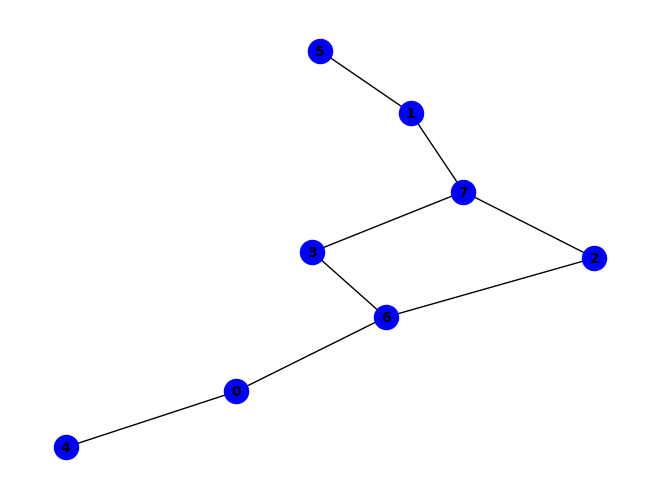


~c ^ (b & h & ~d) ^ (d & h & ~c) ^ (b & c & d & g) ^ (b & c & f & h) ^ (c & ~g & ~h) ^ (b & c & g & ~f) ^ (a & e & ~b & ~g) ^ (a & g & ~b & ~d) ^ (b & f & ~a & ~h) ^ (d & g & ~c & ~h) ^ (a & c & d & h & ~b) ^ (a & c & e & g & ~b) ^ (b & c & d & h & ~g) ^ (a & b & e & ~f & ~h) ^ (a & b & f & ~g & ~h) ^ (a & b & g & ~e & ~h) ^ (a & c & h & ~b & ~g) ^ (b & c & g & ~a & ~h) ^ (b & c & h & ~f & ~g) ^ (a & b & e & f & g & ~h) ^ (a & b & d & g & ~c & ~h) ^ (a & c & d & g & ~b & ~h) ^ (a & d & e & h & ~b & ~g) ^ (b & c & d & g & ~f & ~h) ^ (b & d & f & g & ~a & ~h) ^ (a & c & g & ~b & ~e & ~h) ^ (a & c & h & ~b & ~d & ~e) ^ (a & b & c & f & g & ~d & ~h) ^ (a & c & d & g & h & ~b & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


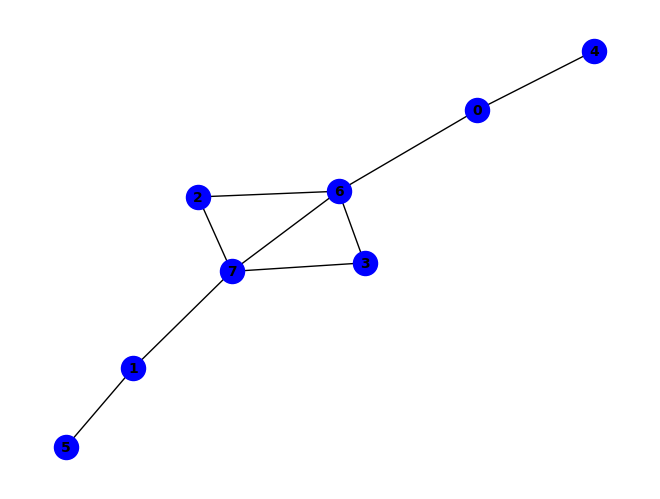


(~b & ~g) ^ (a & b & ~g) ^ (a & e & ~g) ^ (c & g & ~b) ^ (d & h & ~b) ^ (a & c & e & g) ^ (a & b & d & e & g) ^ (c & h & ~b & ~d) ^ (d & g & ~b & ~c) ^ (a & c & e & h & ~d) ^ (a & d & e & g & ~c) ^ (a & d & e & h & ~b) ^ (g & ~a & ~b & ~h) ^ (a & c & g & ~e & ~h) ^ (a & b & c & f & g & ~d) ^ (a & b & c & f & h & ~d) ^ (a & b & d & g & ~e & ~h) ^ (b & ~a & ~d & ~f & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & b & h & ~c & ~e & ~g) ^ (a & d & g & ~c & ~e & ~h) ^ (b & c & g & ~d & ~f & ~h) ^ (a & b & c & d & h & ~e & ~g) ^ (b & d & ~a & ~f & ~g & ~h) ^ (a & b & c & h & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


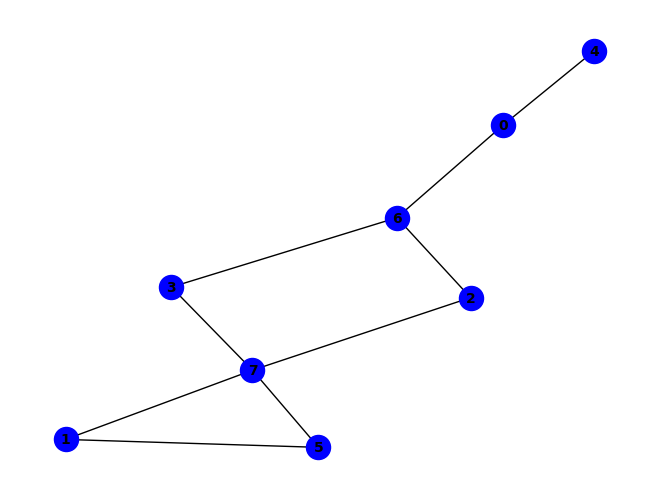


(b & f) ^ (b & h) ^ (~a & ~f) ^ (a & b & g & h) ^ (a & ~e & ~g) ^ (f & ~a & ~h) ^ (d & g & ~a & ~h) ^ (a & b & e & f & ~g) ^ (a & b & f & g & ~d) ^ (a & f & h & ~e & ~g) ^ (a & b & d & f & h & ~e) ^ (a & b & c & d & e & f & h) ^ (c & g & ~a & ~d & ~h) ^ (d & h & ~a & ~b & ~f) ^ (a & b & d & h & ~e & ~g) ^ (a & b & e & h & ~c & ~g) ^ (b & c & f & g & ~a & ~h) ^ (a & b & c & d & e & h & ~g) ^ (a & b & c & e & f & h & ~g) ^ (a & b & d & e & f & g & ~c) ^ (a & c & h & ~e & ~f & ~g) ^ (a & b & d & f & g & ~e & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (c & h & ~a & ~b & ~d & ~f) ^ (a & b & c & h & ~d & ~f & ~g) ^ (b & d & f & g & ~a & ~c & ~h) ^ (a & d & h & ~c & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


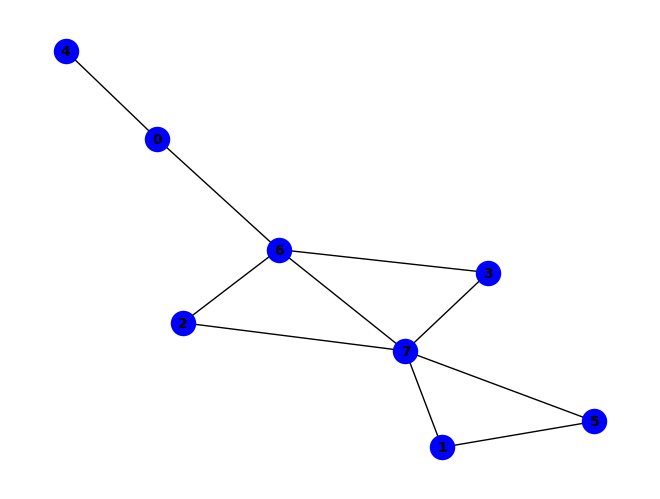


(~a & ~g) ^ (a & ~e & ~g) ^ (g & ~a & ~h) ^ (b & f & ~a & ~h) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (f & h & ~a & ~g) ^ (b & d & f & g & ~h) ^ (a & b & f & ~e & ~g) ^ (c & f & g & ~b & ~h) ^ (d & f & g & ~c & ~h) ^ (a & b & c & f & g & ~h) ^ (c & g & ~a & ~d & ~f) ^ (c & h & ~a & ~d & ~f) ^ (a & c & f & g & ~d & ~h) ^ (a & d & f & g & ~b & ~h) ^ (b & c & d & f & ~a & ~g) ^ (b & c & d & f & ~a & ~h) ^ (b & c & d & h & ~a & ~g) ^ (a & b & h & ~d & ~e & ~g) ^ (a & d & h & ~c & ~e & ~g) ^ (a & f & h & ~d & ~e & ~g) ^ (b & c & h & ~a & ~f & ~g) ^ (a & b & c & d & h & ~e & ~g) ^ (a & b & d & f & h & ~e & ~g) ^ (b & h & ~a & ~d & ~f & ~g) ^ (a & c & h & ~b & ~e & ~f & ~g) ^ (a & c & d & f & h & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


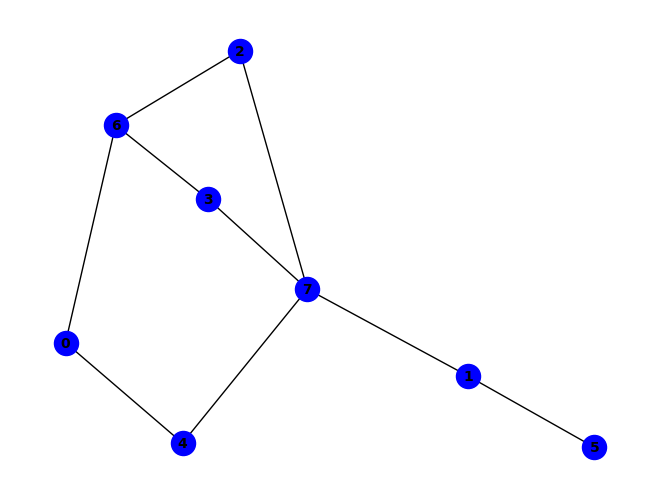


(a & d & g) ^ (b & c & g) ^ (~a & ~e) ^ (b & f & ~a) ^ (b & h & ~f) ^ (c & g & ~h) ^ (d & h & ~e) ^ (a & b & f & h) ^ (a & ~e & ~g) ^ (e & ~a & ~h) ^ (a & c & g & ~d) ^ (b & d & g & ~c) ^ (a & b & e & f & g) ^ (a & c & e & g & h) ^ (c & h & ~d & ~e) ^ (d & g & ~c & ~h) ^ (a & b & e & f & ~h) ^ (a & b & g & h & ~d) ^ (b & d & f & h & ~g) ^ (a & b & d & e & g & h) ^ (a & b & f & ~g & ~h) ^ (b & c & g & ~f & ~h) ^ (b & c & h & ~d & ~g) ^ (b & e & h & ~c & ~d) ^ (a & b & d & f & g & ~h) ^ (a & b & e & g & h & ~f) ^ (a & d & e & g & h & ~c) ^ (b & d & ~c & ~f & ~g) ^ (b & d & ~c & ~f & ~h) ^ (b & c & d & h & ~f & ~g) ^ (a & b & c & f & g & ~d & ~h) ^ (a & b & c & g & h & ~d & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


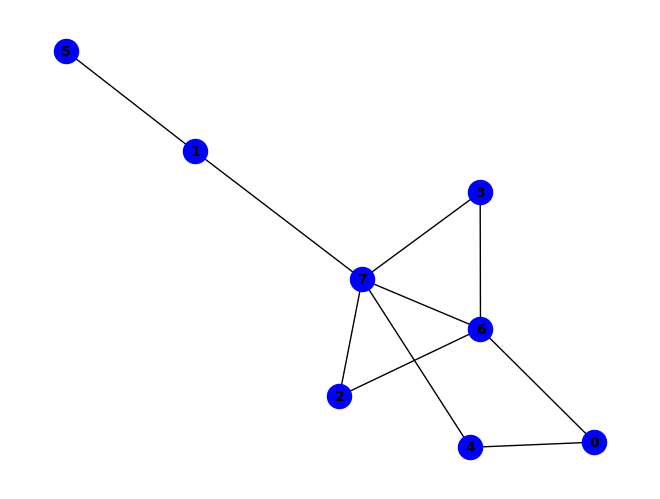


(~b & ~g) ^ (g & ~b & ~h) ^ (b & c & g & ~e) ^ (b & c & h & ~e) ^ (b & c & d & e & g) ^ (b & c & d & e & h) ^ (b & c & d & f & g) ^ (b & c & d & f & h) ^ (c & g & ~d & ~e) ^ (c & h & ~d & ~e) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (e & h & ~b & ~g) ^ (b & ~d & ~f & ~h) ^ (d & e & g & ~b & ~h) ^ (a & e & ~b & ~g & ~h) ^ (a & g & ~c & ~d & ~h) ^ (b & d & ~f & ~g & ~h) ^ (a & b & c & g & ~d & ~h) ^ (a & b & f & g & ~d & ~h) ^ (b & c & d & h & ~f & ~g) ^ (a & b & e & ~f & ~g & ~h) ^ (b & c & g & ~a & ~f & ~h) ^ (c & e & g & ~b & ~d & ~h) ^ (a & b & c & d & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


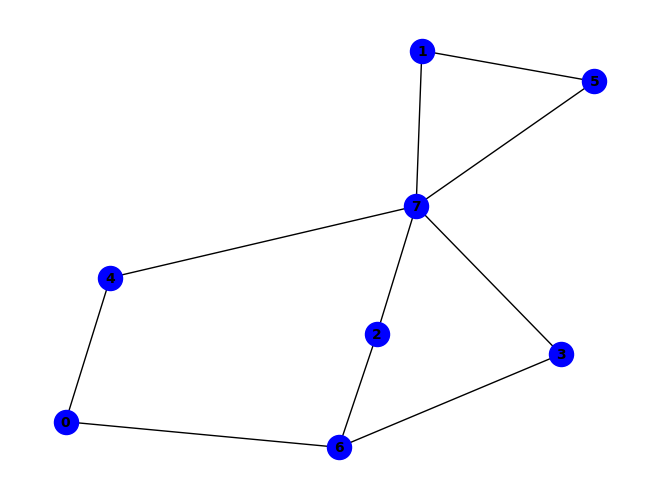


~f ^ (f & ~h) ^ (b & f & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & c & g & ~d) ^ (a & e & ~d & ~h) ^ (a & g & ~d & ~e) ^ (b & h & ~c & ~e) ^ (d & g & ~c & ~h) ^ (a & b & f & g & ~e) ^ (b & c & d & f & ~g) ^ (b & c & d & f & ~h) ^ (b & c & f & g & ~a) ^ (b & d & f & g & ~h) ^ (b & e & f & ~a & ~h) ^ (a & b & d & f & g & ~c) ^ (a & c & d & e & h & ~f) ^ (a & c & e & g & h & ~f) ^ (a & c & f & g & h & ~d) ^ (b & c & e & f & h & ~a) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & c & d & e & ~f & ~g) ^ (a & f & g & h & ~d & ~e) ^ (b & c & d & h & ~e & ~f) ^ (b & c & f & h & ~d & ~g) ^ (a & b & c & e & f & h & ~g) ^ (a & d & e & ~c & ~g & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (a & b & d & e & f & g & h & ~c) ^ (a & b & g & h & ~c & ~d & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


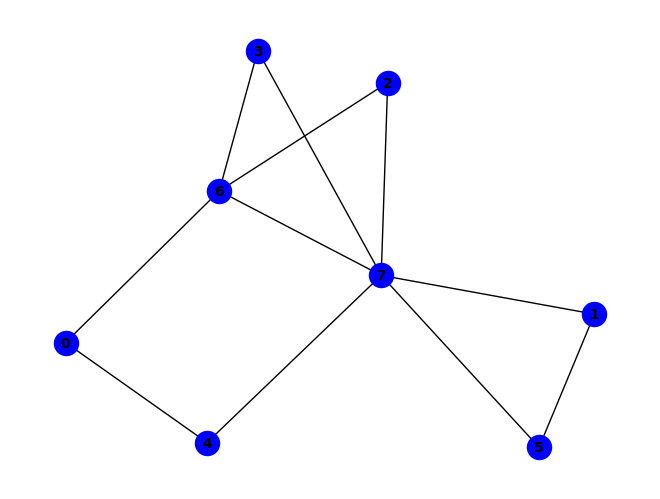


(g & ~h) ^ (~a & ~g) ^ (f & h & ~g) ^ (a & ~e & ~h) ^ (b & c & g & ~h) ^ (b & e & f & ~g) ^ (a & d & ~c & ~g) ^ (a & d & ~c & ~h) ^ (a & h & ~d & ~g) ^ (b & f & ~e & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & b & e & f & ~h) ^ (a & c & d & h & ~g) ^ (b & e & f & g & ~h) ^ (a & c & g & ~b & ~h) ^ (a & e & g & ~b & ~h) ^ (b & e & h & ~d & ~g) ^ (c & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (b & c & d & e & h & ~g) ^ (b & h & ~d & ~f & ~g) ^ (e & h & ~c & ~f & ~g) ^ (a & b & c & g & ~f & ~h) ^ (a & b & e & g & ~f & ~h) ^ (a & b & f & g & ~d & ~h) ^ (b & c & d & h & ~f & ~g) ^ (b & c & e & h & ~f & ~g) ^ (d & e & f & g & ~b & ~c) ^ (d & e & f & h & ~b & ~c) ^ (d & f & g & ~b & ~e & ~h) ^ (b & c & d & f & g & ~a & ~h) ^ (c & d & e & f & g & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

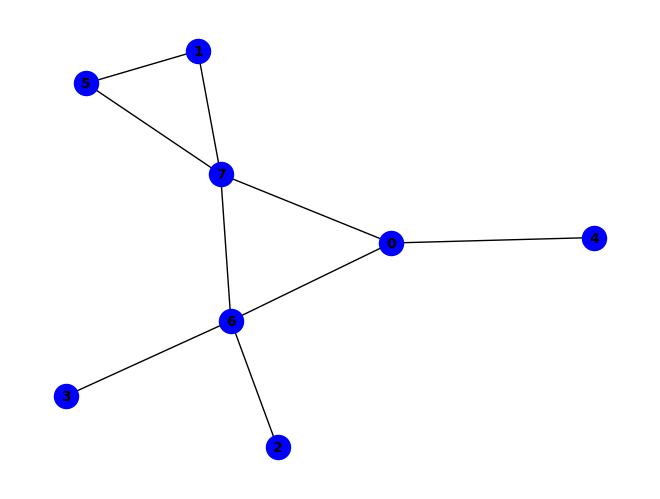


(~d & ~g) ^ (f & h & ~g) ^ (g & ~c & ~h) ^ (a & f & g & ~h) ^ (a & d & ~c & ~g) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (b & f & ~a & ~h) ^ (d & h & ~a & ~g) ^ (b & c & f & g & ~h) ^ (d & ~a & ~c & ~h) ^ (a & b & f & ~g & ~h) ^ (a & c & g & ~b & ~h) ^ (b & d & g & ~a & ~h) ^ (a & b & c & d & f & ~g) ^ (a & e & ~b & ~g & ~h) ^ (b & d & ~a & ~f & ~h) ^ (b & d & ~c & ~f & ~g) ^ (b & h & ~d & ~f & ~g) ^ (c & d & ~b & ~g & ~h) ^ (a & c & d & h & ~b & ~g) ^ (b & c & d & f & ~a & ~h) ^ (a & b & d & ~f & ~g & ~h) ^ (a & b & e & ~f & ~g & ~h) ^ (a & b & g & ~c & ~f & ~h) ^ (b & c & d & h & ~a & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


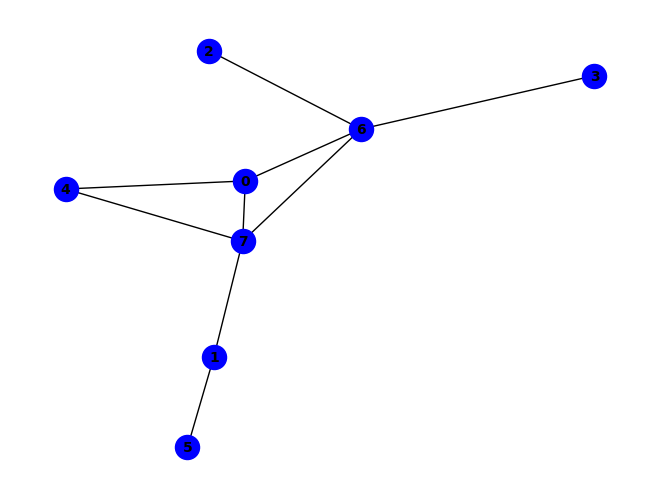


(a & e & ~g) ^ (a & g & ~b) ^ (a & h & ~b) ^ (e & h & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (a & c & g & ~h) ^ (b & e & g & ~a) ^ (b & e & h & ~a) ^ (~b & ~d & ~g) ^ (b & g & ~e & ~h) ^ (d & h & ~b & ~g) ^ (a & b & e & f & ~h) ^ (b & ~c & ~f & ~h) ^ (a & d & g & ~c & ~h) ^ (b & c & g & ~a & ~h) ^ (b & d & f & ~c & ~h) ^ (b & d & ~f & ~g & ~h) ^ (c & d & ~b & ~g & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & b & d & f & g & ~c & ~h) ^ (b & c & ~d & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


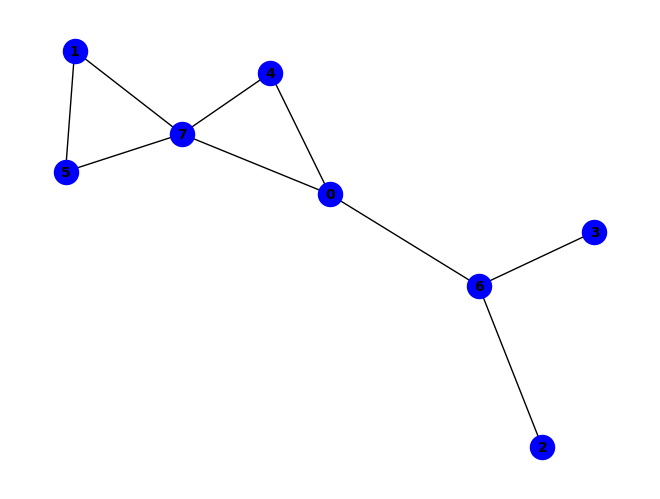


~f ^ (f & ~h) ^ (a & g & ~h) ^ (b & f & ~e) ^ (b & h & ~e) ^ (d & g & ~a) ^ (e & h & ~f) ^ (a & d & f & g & h) ^ (a & e & ~d & ~g) ^ (a & h & ~b & ~f) ^ (c & g & ~a & ~d) ^ (a & b & e & h & ~f) ^ (a & d & e & h & ~f) ^ (a & e & f & h & ~c) ^ (a & e & g & h & ~c) ^ (b & d & f & g & ~a) ^ (c & e & g & h & ~f) ^ (d & e & g & h & ~c) ^ (d & f & g & h & ~e) ^ (a & c & d & e & g & h) ^ (c & d & e & f & g & h) ^ (b & e & f & ~a & ~h) ^ (a & c & e & f & h & ~g) ^ (a & b & d & e & f & g & h) ^ (a & b & f & g & ~e & ~h) ^ (a & d & e & f & ~c & ~g) ^ (b & c & f & g & ~a & ~d) ^ (b & d & g & h & ~a & ~e) ^ (c & f & g & h & ~a & ~d) ^ (a & b & c & d & e & f & ~g) ^ (a & c & d & e & f & h & ~b) ^ (b & c & e & f & g & h & ~a) ^ (b & d & e & f & g & h & ~c) ^ (a & d & e & ~f & ~g & ~h) ^ (b & c & g & h & ~a & ~d & ~e) ^ (a & c & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

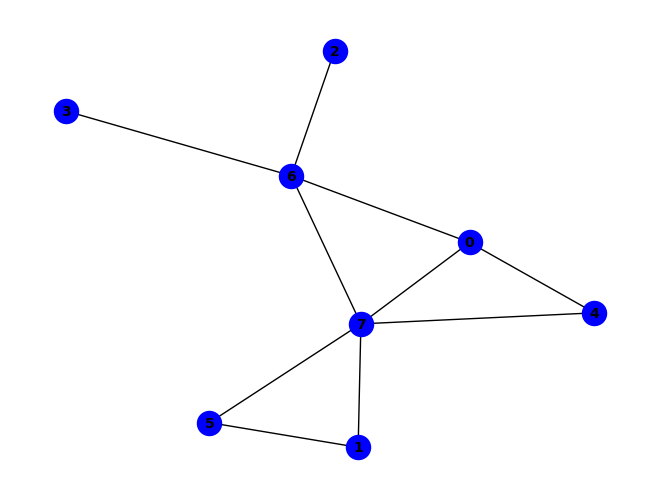


(~d & ~g) ^ (a & e & ~g) ^ (f & h & ~g) ^ (a & b & e & f) ^ (a & e & f & h) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (b & d & f & ~g) ^ (b & d & f & ~h) ^ (b & e & f & ~g) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (b & f & ~e & ~h) ^ (c & d & ~g & ~h) ^ (d & h & ~b & ~g) ^ (e & h & ~f & ~g) ^ (a & e & f & g & ~b) ^ (b & e & f & g & ~h) ^ (a & b & g & ~c & ~h) ^ (a & c & g & ~d & ~h) ^ (a & d & g & ~b & ~h) ^ (a & f & g & ~e & ~h) ^ (b & e & h & ~a & ~g) ^ (a & b & c & d & g & ~h) ^ (b & h & ~d & ~f & ~g) ^ (a & b & d & g & ~f & ~h) ^ (b & c & f & g & ~d & ~h) ^ (a & b & c & g & ~d & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


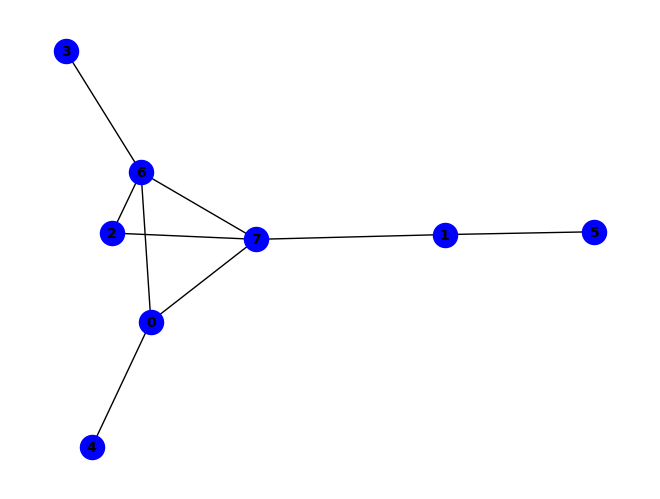


(a & e & ~g) ^ (a & g & ~c) ^ (c & g & ~b) ^ (a & b & c & g) ^ (a & b & e & f) ^ (d & ~c & ~h) ^ (g & ~b & ~h) ^ (a & b & g & ~e) ^ (b & d & f & ~h) ^ (~b & ~d & ~g) ^ (a & h & ~b & ~e) ^ (c & d & ~g & ~h) ^ (c & h & ~a & ~b) ^ (d & h & ~b & ~g) ^ (a & b & e & h & ~f) ^ (a & e & g & h & ~b) ^ (b & ~c & ~f & ~h) ^ (a & d & g & ~c & ~h) ^ (b & c & d & f & g & ~h) ^ (b & c & ~f & ~g & ~h) ^ (b & d & ~f & ~g & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & b & d & f & g & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


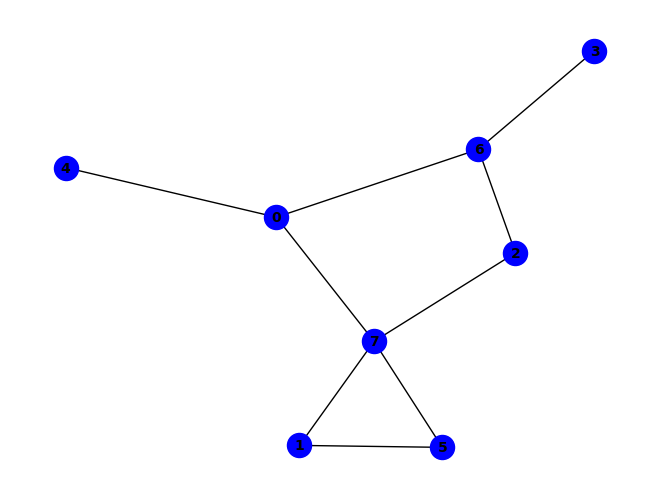


~f ^ (a & f & ~d) ^ (a & h & ~c) ^ (b & f & ~d) ^ (b & h & ~d) ^ (c & g & ~h) ^ (f & ~a & ~h) ^ (b & d & f & ~g) ^ (a & b & d & g & h) ^ (b & c & d & f & g) ^ (a & g & ~c & ~h) ^ (c & h & ~b & ~f) ^ (d & g & ~a & ~c) ^ (a & c & f & h & ~d) ^ (a & d & f & g & ~h) ^ (b & c & d & h & ~a) ^ (b & c & f & g & ~h) ^ (d & f & g & h & ~c) ^ (a & b & h & ~c & ~f) ^ (a & d & f & ~c & ~g) ^ (b & d & h & ~c & ~g) ^ (a & b & c & d & h & ~g) ^ (a & b & d & f & g & ~c) ^ (a & e & ~b & ~g & ~h) ^ (a & b & f & g & ~c & ~h) ^ (a & c & d & f & ~g & ~h) ^ (a & b & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


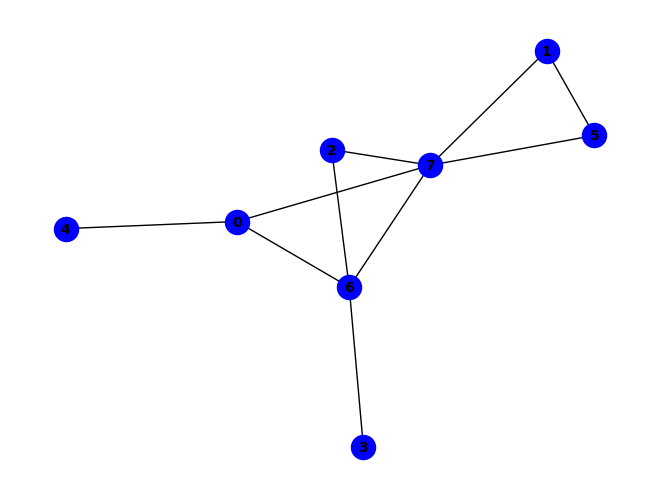


(g & ~h) ^ (~d & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & f & ~a & ~h) ^ (c & d & ~g & ~h) ^ (a & b & f & ~g & ~h) ^ (a & b & h & ~f & ~g) ^ (a & d & g & ~c & ~h) ^ (a & f & g & ~c & ~h) ^ (c & f & g & ~b & ~h) ^ (a & b & d & f & g & ~h) ^ (a & e & ~b & ~g & ~h) ^ (b & h & ~c & ~f & ~g) ^ (a & b & c & f & ~d & ~g) ^ (a & b & c & f & ~d & ~h) ^ (a & b & c & h & ~d & ~g) ^ (b & d & f & g & ~c & ~h) ^ (a & b & e & ~f & ~g & ~h) ^ (a & b & c & d & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


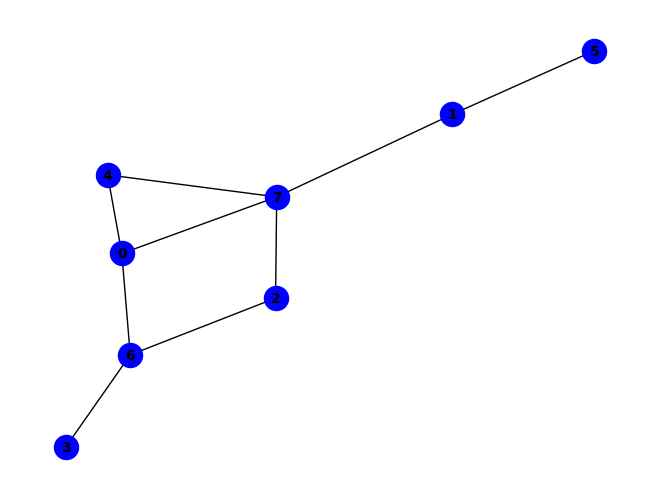


~e ^ (e & ~h) ^ (a & h & ~c) ^ (b & f & ~d) ^ (b & h & ~f) ^ (a & b & h & ~d) ^ (b & e & h & ~d) ^ (a & b & c & f & h) ^ (a & g & ~c & ~h) ^ (c & g & ~b & ~h) ^ (c & h & ~b & ~e) ^ (d & g & ~a & ~c) ^ (a & b & c & g & ~f) ^ (a & b & c & g & ~h) ^ (a & b & d & h & ~g) ^ (a & c & e & h & ~b) ^ (a & e & g & h & ~b) ^ (b & d & e & h & ~g) ^ (b & d & g & h & ~f) ^ (d & e & g & h & ~c) ^ (a & b & c & d & g & h) ^ (b & c & g & ~f & ~h) ^ (b & d & f & ~c & ~g) ^ (b & c & d & f & h & ~g) ^ (b & c & d & g & h & ~e) ^ (a & e & ~b & ~d & ~g) ^ (a & b & c & h & ~f & ~g) ^ (a & b & f & g & ~d & ~h) ^ (a & d & e & h & ~b & ~c) ^ (b & c & d & f & ~a & ~h) ^ (a & b & e & ~f & ~g & ~h) ^ (a & d & e & ~b & ~g & ~h) ^ (a & b & c & d & f & ~g & ~h) ^ (a & c & d & e & h & ~b & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

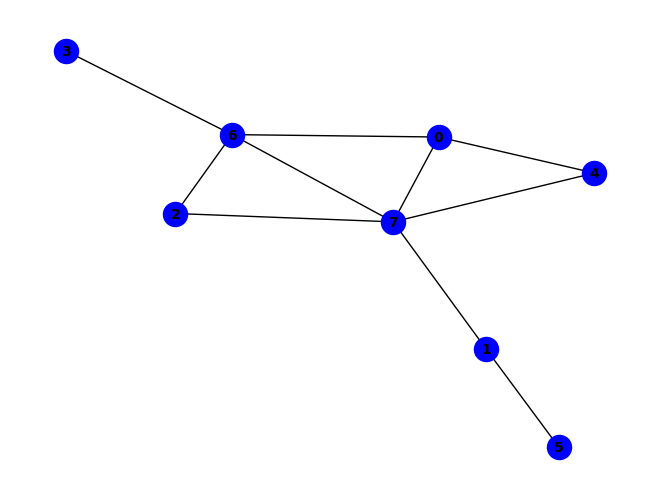


(a & e & ~c) ^ (a & h & ~c) ^ (d & ~c & ~h) ^ (g & ~b & ~h) ^ (~b & ~d & ~g) ^ (c & g & ~b & ~e) ^ (c & h & ~b & ~e) ^ (d & h & ~b & ~g) ^ (e & h & ~b & ~g) ^ (a & b & e & f & ~h) ^ (b & ~c & ~f & ~h) ^ (a & b & h & ~c & ~e) ^ (a & c & e & ~g & ~h) ^ (a & d & g & ~c & ~h) ^ (b & d & f & ~c & ~h) ^ (c & e & g & ~b & ~h) ^ (a & b & c & e & g & ~h) ^ (a & g & ~b & ~c & ~e) ^ (b & d & ~f & ~g & ~h) ^ (c & d & ~b & ~g & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & b & d & f & g & ~c & ~h) ^ (b & c & ~d & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


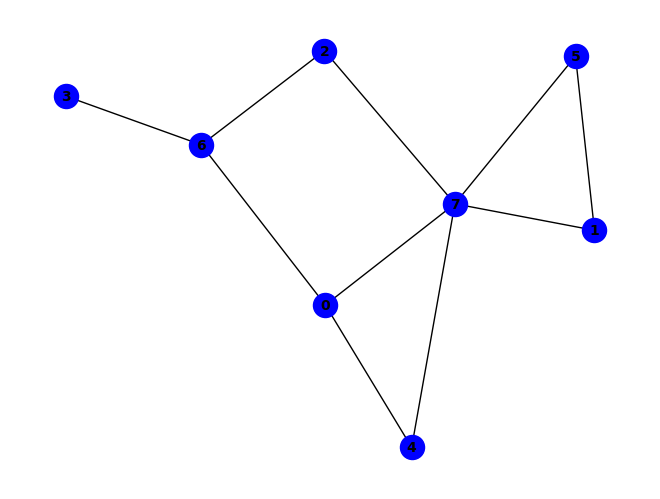


~f ^ (f & ~h) ^ (b & f & ~e) ^ (b & h & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & e & g & h) ^ (a & e & ~d & ~g) ^ (a & g & ~c & ~h) ^ (a & h & ~c & ~f) ^ (d & g & ~a & ~c) ^ (a & c & e & h & ~f) ^ (a & d & e & h & ~f) ^ (d & e & g & h & ~c) ^ (a & c & d & e & g & h) ^ (b & e & f & ~a & ~h) ^ (a & d & f & g & h & ~c) ^ (a & b & d & e & f & g & h) ^ (c & h & ~b & ~e & ~f) ^ (a & b & f & g & ~e & ~h) ^ (a & d & e & f & ~c & ~g) ^ (b & c & f & g & ~a & ~h) ^ (b & d & f & g & ~a & ~c) ^ (d & f & g & h & ~c & ~e) ^ (a & c & d & e & f & h & ~b) ^ (b & d & e & f & g & h & ~c) ^ (a & b & h & ~c & ~e & ~f) ^ (a & d & e & ~f & ~g & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (a & b & c & d & e & f & h & ~g) ^ (b & d & g & h & ~a & ~c & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


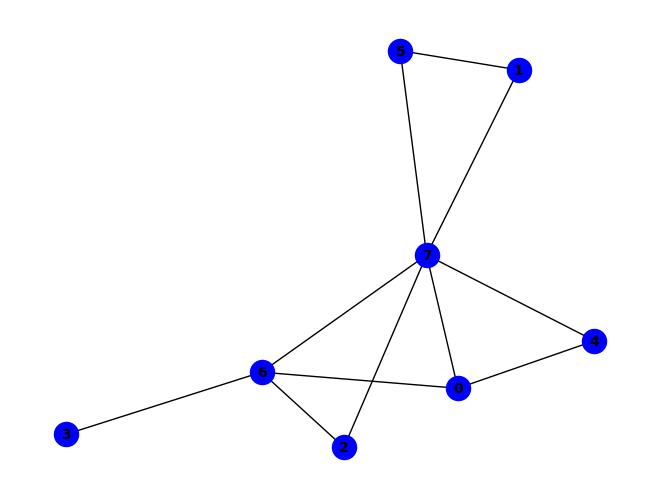


(g & ~h) ^ (~d & ~g) ^ (a & e & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & f & ~c & ~h) ^ (c & d & ~g & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & h & ~f & ~g) ^ (a & b & e & f & ~g) ^ (a & e & f & h & ~g) ^ (c & e & f & g & ~b) ^ (c & e & f & h & ~b) ^ (a & d & g & ~c & ~h) ^ (a & f & g & ~c & ~h) ^ (b & c & f & ~g & ~h) ^ (b & c & g & ~f & ~h) ^ (c & e & h & ~b & ~g) ^ (c & f & g & ~e & ~h) ^ (b & c & e & f & g & ~h) ^ (b & h & ~e & ~f & ~g) ^ (a & b & e & h & ~c & ~g) ^ (a & c & e & h & ~f & ~g) ^ (b & d & f & g & ~c & ~h) ^ (a & b & c & e & f & h & ~g) ^ (a & b & h & ~c & ~f & ~g) ^ (a & b & f & g & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


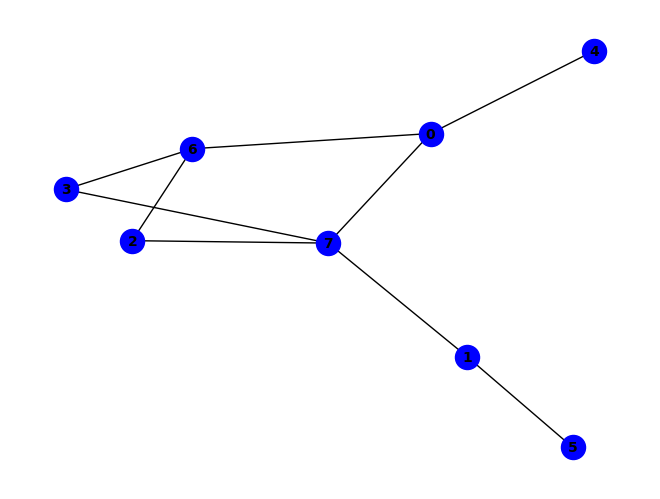


~c ^ (b & f & ~h) ^ (b & h & ~d) ^ (d & h & ~c) ^ (b & c & f & h) ^ (c & ~g & ~h) ^ (a & b & e & ~h) ^ (a & b & g & ~e) ^ (b & c & g & ~f) ^ (a & b & d & f & h) ^ (a & e & ~g & ~h) ^ (a & h & ~c & ~d) ^ (d & g & ~c & ~h) ^ (a & b & c & h & ~d) ^ (a & b & d & g & ~f) ^ (a & b & d & g & ~h) ^ (a & b & e & g & ~f) ^ (a & b & f & h & ~g) ^ (b & c & d & g & ~a) ^ (b & c & d & h & ~g) ^ (b & d & f & g & ~h) ^ (a & b & c & d & g & h) ^ (a & b & e & f & g & h) ^ (b & c & g & ~a & ~h) ^ (a & b & ~c & ~f & ~g) ^ (a & b & ~e & ~f & ~h) ^ (a & g & ~c & ~d & ~h) ^ (a & b & d & h & ~f & ~g) ^ (b & c & d & g & ~f & ~h) ^ (a & b & c & ~d & ~f & ~h) ^ (b & c & h & ~a & ~f & ~g) ^ (a & b & c & d & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


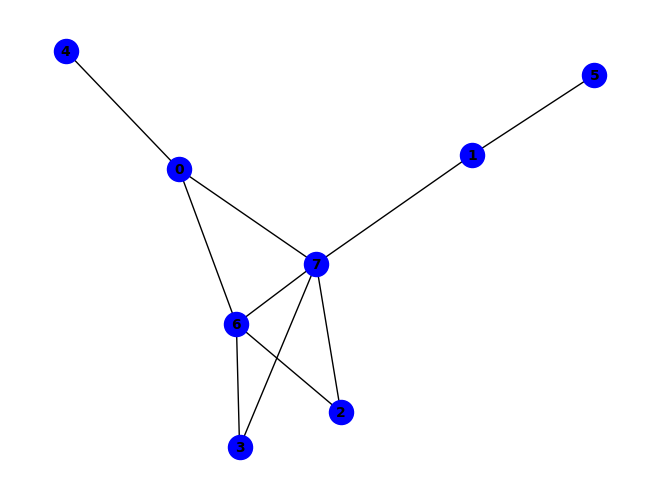


(~b & ~g) ^ (a & g & ~e) ^ (d & h & ~b) ^ (a & b & d & h) ^ (a & b & f & g) ^ (a & b & f & h) ^ (a & e & g & h) ^ (g & ~b & ~h) ^ (a & e & ~b & ~h) ^ (a & h & ~c & ~d) ^ (c & g & ~a & ~b) ^ (c & h & ~b & ~d) ^ (a & b & c & h & ~d) ^ (b & ~d & ~f & ~h) ^ (a & b & e & ~f & ~h) ^ (a & b & e & f & g & ~h) ^ (b & d & ~f & ~g & ~h) ^ (d & g & ~a & ~b & ~c) ^ (a & b & c & g & ~f & ~h) ^ (a & b & d & ~c & ~f & ~g) ^ (a & b & d & ~c & ~f & ~h) ^ (a & b & h & ~d & ~f & ~g) ^ (b & c & g & ~d & ~f & ~h) ^ (a & b & c & d & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


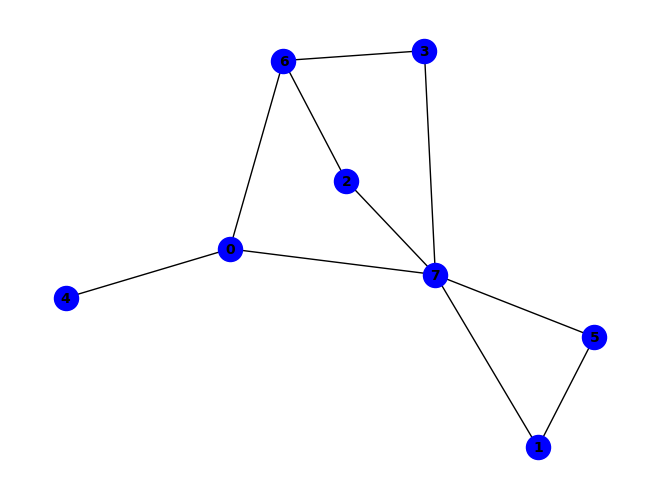


~f ^ (f & ~h) ^ (b & f & ~a) ^ (b & h & ~a) ^ (d & g & ~h) ^ (c & g & ~d & ~h) ^ (d & h & ~b & ~f) ^ (a & b & c & h & ~f) ^ (a & b & d & h & ~f) ^ (a & b & f & ~g & ~h) ^ (a & b & c & d & h & ~e) ^ (a & b & d & f & g & ~h) ^ (a & e & ~b & ~g & ~h) ^ (a & g & ~c & ~d & ~h) ^ (a & h & ~c & ~d & ~f) ^ (c & h & ~b & ~d & ~f) ^ (b & c & f & g & ~a & ~h) ^ (b & d & f & g & ~c & ~h) ^ (a & b & c & d & e & h & ~f) ^ (a & b & c & d & f & g & ~e) ^ (a & b & e & ~f & ~g & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & b & c & d & f & h & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


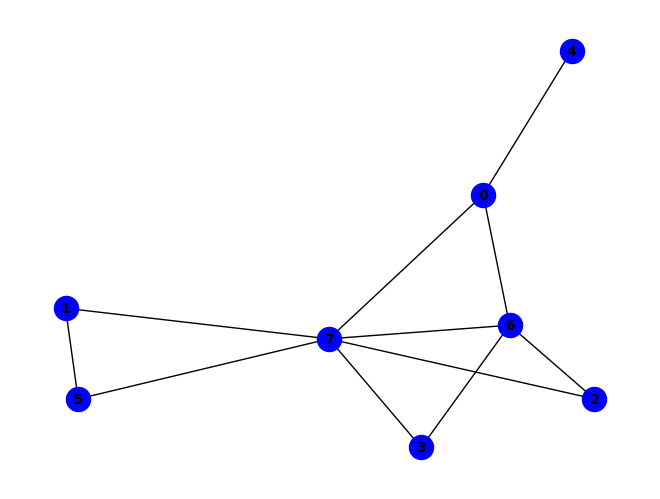


~g ^ (g & ~h) ^ (d & g & ~f) ^ (d & h & ~f) ^ (f & h & ~g) ^ (b & f & ~a & ~h) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (a & b & d & f & ~g) ^ (a & b & d & f & ~h) ^ (a & b & d & h & ~g) ^ (b & c & d & f & ~g) ^ (b & c & d & f & ~h) ^ (b & c & d & h & ~g) ^ (b & d & f & g & ~h) ^ (a & b & f & ~g & ~h) ^ (b & c & h & ~f & ~g) ^ (c & f & g & ~b & ~h) ^ (d & f & g & ~c & ~h) ^ (a & e & ~b & ~g & ~h) ^ (a & g & ~c & ~d & ~f) ^ (a & h & ~c & ~d & ~f) ^ (b & h & ~d & ~f & ~g) ^ (a & b & e & ~f & ~g & ~h) ^ (a & b & h & ~c & ~f & ~g) ^ (a & f & g & ~c & ~d & ~h) ^ (a & b & c & d & h & ~f & ~g) ^ (a & b & c & f & g & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


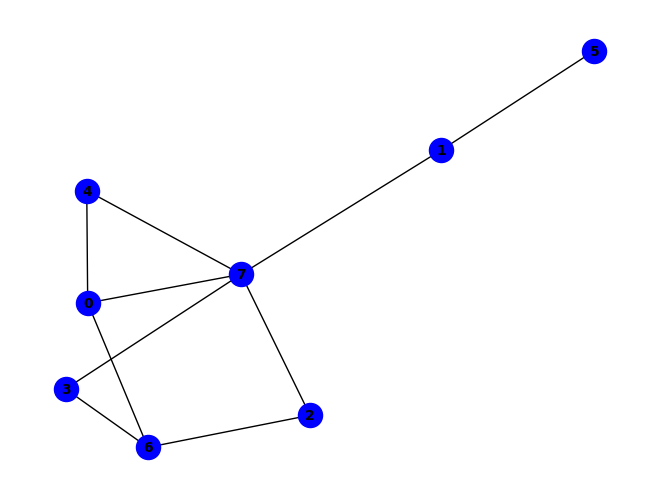


~e ^ (b & f) ^ (e & ~h) ^ (a & h & ~d) ^ (b & h & ~f) ^ (d & h & ~e) ^ (a & b & g & ~d) ^ (a & c & h & ~e) ^ (b & c & g & ~a) ^ (b & d & g & ~c) ^ (a & b & d & e & h) ^ (a & e & ~b & ~g) ^ (a & g & ~d & ~h) ^ (c & g & ~a & ~h) ^ (c & h & ~d & ~e) ^ (d & g & ~c & ~h) ^ (a & b & c & h & ~g) ^ (a & c & d & g & ~b) ^ (a & d & e & h & ~c) ^ (a & e & g & h & ~b) ^ (b & d & f & h & ~g) ^ (a & b & e & ~f & ~h) ^ (a & b & h & ~d & ~g) ^ (b & c & h & ~d & ~g) ^ (b & e & h & ~c & ~d) ^ (a & b & c & e & h & ~d) ^ (b & d & ~c & ~f & ~g) ^ (b & d & ~c & ~f & ~h) ^ (a & c & d & h & ~b & ~g) ^ (b & c & d & h & ~f & ~g) ^ (a & b & g & ~e & ~f & ~h) ^ (b & c & g & ~a & ~f & ~h) ^ (a & b & d & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


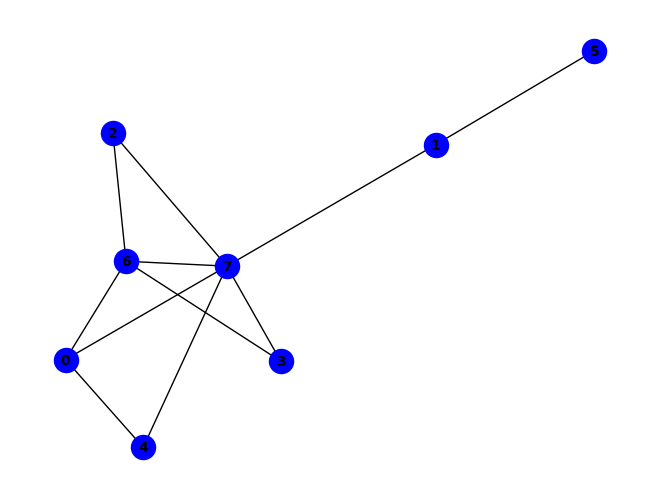


(~b & ~g) ^ (a & e & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (g & ~b & ~h) ^ (b & c & d & f & g) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (e & h & ~b & ~g) ^ (a & b & e & f & ~h) ^ (a & b & e & h & ~g) ^ (a & b & f & g & ~e) ^ (a & b & f & h & ~d) ^ (a & b & e & f & g & h) ^ (b & ~d & ~f & ~h) ^ (b & c & g & ~a & ~e) ^ (b & c & h & ~a & ~e) ^ (d & e & g & ~b & ~h) ^ (a & b & d & f & g & ~c) ^ (b & c & d & e & g & ~a) ^ (b & c & d & e & h & ~a) ^ (b & c & d & f & h & ~a) ^ (b & d & ~f & ~g & ~h) ^ (c & g & ~a & ~d & ~e) ^ (c & h & ~a & ~d & ~e) ^ (a & d & e & h & ~b & ~g) ^ (a & b & h & ~d & ~f & ~g) ^ (b & c & g & ~a & ~f & ~h) ^ (b & c & d & h & ~a & ~f & ~g) ^ (c & e & g & ~a & ~b & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


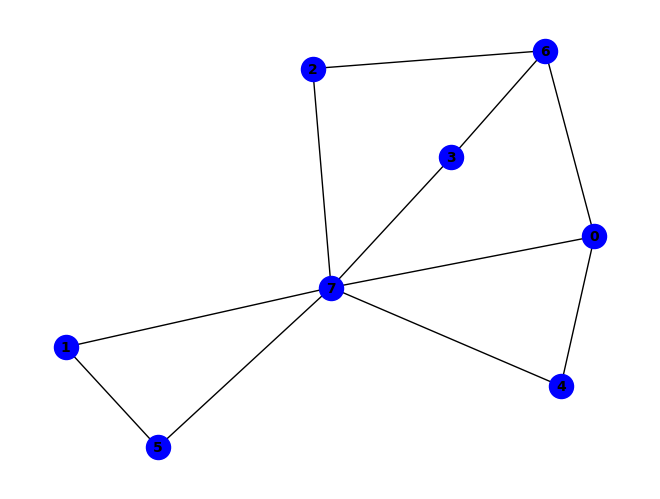


~f ^ (f & ~h) ^ (a & e & ~g) ^ (b & f & ~e) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & c & f & g) ^ (a & b & h & ~d) ^ (a & b & d & f & g) ^ (b & c & e & f & h) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~f) ^ (b & h & ~c & ~e) ^ (c & g & ~a & ~h) ^ (d & g & ~c & ~h) ^ (a & b & f & g & ~e) ^ (a & c & d & g & ~h) ^ (b & d & f & g & ~h) ^ (a & b & e & f & g & h) ^ (b & e & f & ~a & ~h) ^ (a & b & c & f & g & ~h) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & b & e & h & ~d & ~f) ^ (a & b & f & h & ~d & ~g) ^ (a & c & d & h & ~b & ~f) ^ (a & d & e & h & ~c & ~f) ^ (b & c & d & f & ~a & ~g) ^ (b & c & d & f & ~a & ~h) ^ (b & c & d & h & ~e & ~f) ^ (b & c & f & h & ~d & ~g) ^ (a & b & c & d & e & h & ~f) ^ (a & b & c & d & f & h & ~g) ^ (a & c & h & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

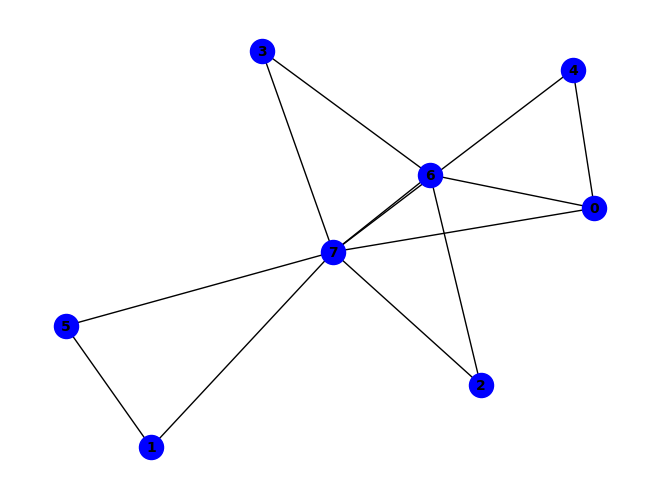


~g ^ (g & ~h) ^ (a & e & ~g) ^ (f & h & ~g) ^ (b & c & g & ~h) ^ (b & f & ~e & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & e & f & h & ~g) ^ (b & e & f & g & ~h) ^ (b & e & f & ~a & ~g) ^ (c & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (b & c & d & f & g & ~h) ^ (a & g & ~c & ~d & ~f) ^ (a & h & ~c & ~d & ~f) ^ (e & h & ~c & ~f & ~g) ^ (a & b & c & f & ~d & ~g) ^ (a & b & c & f & ~d & ~h) ^ (a & b & c & h & ~e & ~g) ^ (a & b & f & g & ~d & ~h) ^ (a & c & e & h & ~f & ~g) ^ (b & c & e & h & ~f & ~g) ^ (d & e & f & g & ~b & ~c) ^ (d & e & f & h & ~b & ~c) ^ (a & b & c & e & f & h & ~g) ^ (a & b & d & e & f & h & ~g) ^ (a & f & g & ~c & ~d & ~h) ^ (b & e & h & ~a & ~d & ~g) ^ (d & f & g & ~b & ~e & ~h) ^ (b & c & d & e & h & ~a & ~g) ^ (c & d & e & f & g & ~b & ~h) ^ (b & h & ~a & ~d & ~f & ~g) ^ (a & d & e & h & ~c & ~f & ~g) ^ (b & c & d & h & ~a & ~f & ~g) ^ (a & b & c & d & f & h & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

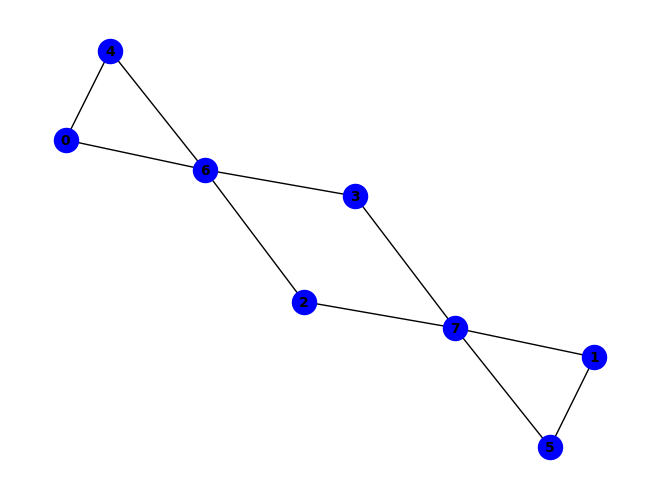


~f ^ (f & ~h) ^ (a & e & ~f) ^ (a & g & ~d) ^ (b & f & ~e) ^ (b & h & ~e) ^ (d & g & ~h) ^ (a & b & e & h) ^ (a & e & f & ~h) ^ (b & e & f & ~g) ^ (b & e & h & ~g) ^ (b & c & e & g & h) ^ (b & d & e & f & g) ^ (c & g & ~d & ~h) ^ (d & h & ~b & ~f) ^ (e & g & ~c & ~d) ^ (a & b & e & f & ~d) ^ (a & d & e & g & ~h) ^ (b & d & f & g & ~h) ^ (a & c & g & ~d & ~e) ^ (a & c & e & f & h & ~d) ^ (b & c & e & f & g & ~d) ^ (b & d & e & g & h & ~c) ^ (a & b & c & d & e & f & g) ^ (c & h & ~b & ~d & ~f) ^ (a & b & f & g & ~c & ~d) ^ (a & b & g & h & ~c & ~d) ^ (a & c & e & h & ~d & ~g) ^ (a & d & e & h & ~b & ~f) ^ (a & f & g & h & ~c & ~d) ^ (b & c & f & g & ~d & ~h) ^ (e & f & g & h & ~c & ~d) ^ (a & b & c & e & f & g & ~h) ^ (a & b & d & e & f & h & ~c) ^ (a & b & c & e & h & ~d & ~f) ^ (a & b & d & e & f & ~g & ~h) ^ (a & b & c & d & e & f & h & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


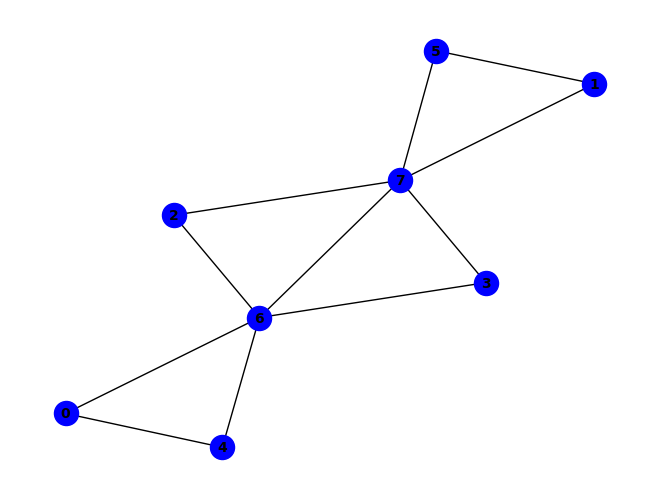


(g & ~h) ^ (~e & ~g) ^ (a & e & ~g) ^ (a & b & f & ~g) ^ (a & b & h & ~g) ^ (d & f & g & ~h) ^ (b & f & ~d & ~h) ^ (c & e & ~d & ~g) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~c & ~g) ^ (f & h & ~a & ~g) ^ (b & c & d & f & ~h) ^ (a & b & c & d & e & g) ^ (a & b & c & d & e & h) ^ (e & ~c & ~d & ~h) ^ (a & b & f & ~e & ~h) ^ (a & f & h & ~e & ~g) ^ (b & d & f & ~c & ~g) ^ (b & d & h & ~c & ~g) ^ (b & e & g & ~d & ~h) ^ (c & f & g & ~d & ~h) ^ (a & b & c & d & g & ~h) ^ (a & b & d & e & h & ~g) ^ (a & b & d & f & g & ~h) ^ (b & e & ~d & ~f & ~g) ^ (b & e & ~d & ~f & ~h) ^ (a & d & e & h & ~f & ~g) ^ (b & c & e & g & ~f & ~h) ^ (b & d & e & h & ~f & ~g) ^ (c & d & e & h & ~a & ~g) ^ (a & b & d & e & f & g & ~c) ^ (a & b & d & e & f & h & ~c) ^ (a & c & d & e & f & h & ~g) ^ (b & c & g & ~a & ~e & ~h) ^ (a & g & ~c & ~d & ~e & ~h) ^ (b & h & ~a & ~e & ~f & ~g) ^ (a & c & e & h & ~b & ~f & ~g) ^ (b & c & d & e & f & g & ~

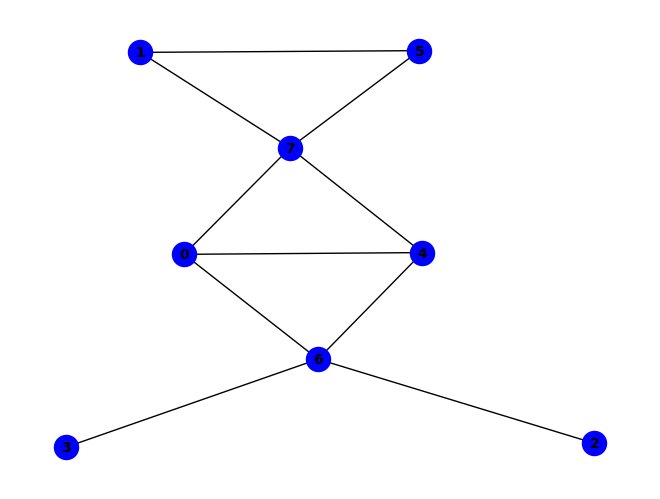


~f ^ (a & h) ^ (a & e & ~f) ^ (a & f & ~d) ^ (a & g & ~h) ^ (b & f & ~e) ^ (b & h & ~d) ^ (e & g & ~h) ^ (b & e & f & h) ^ (f & ~a & ~h) ^ (a & b & h & ~f) ^ (a & b & c & f & g) ^ (b & d & e & g & h) ^ (d & g & ~a & ~e) ^ (e & h & ~b & ~f) ^ (a & b & e & f & ~d) ^ (a & b & e & h & ~d) ^ (a & b & f & g & ~h) ^ (a & d & f & g & ~h) ^ (b & c & d & h & ~e) ^ (b & c & f & g & ~e) ^ (c & f & g & h & ~e) ^ (a & d & f & ~e & ~g) ^ (a & e & f & ~c & ~h) ^ (b & d & h & ~c & ~g) ^ (b & e & f & ~g & ~h) ^ (a & b & d & e & f & ~g) ^ (a & b & d & e & h & ~g) ^ (a & b & d & f & g & ~c) ^ (a & b & d & g & h & ~c) ^ (a & c & e & f & g & ~b) ^ (a & c & f & g & h & ~d) ^ (a & d & e & f & h & ~c) ^ (b & c & d & e & h & ~g) ^ (a & b & c & d & e & f & g) ^ (a & b & c & d & e & g & h) ^ (c & g & ~a & ~d & ~e) ^ (a & c & e & f & ~g & ~h) ^ (a & d & e & f & ~g & ~h) ^ (b & c & g & h & ~a & ~e) ^ (b & d & f & g & ~c & ~e) ^ (d & f & g & h & ~c & ~e) ^ (a & c & d & e & f & h & ~g)
PASS
PASS
PASS
PASS
PASS
PASS


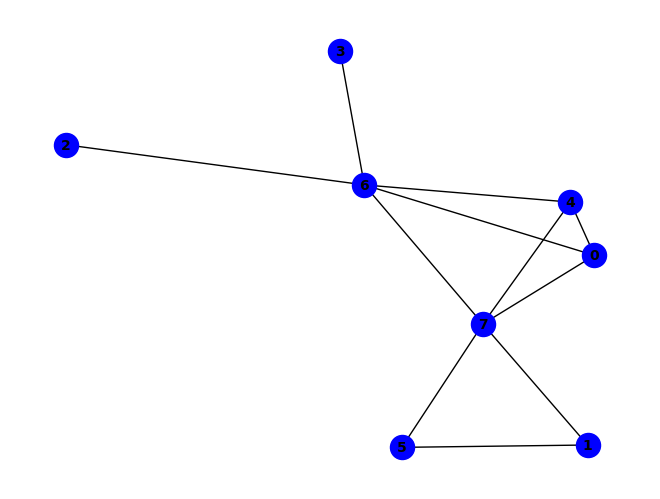


(~d & ~g) ^ (f & h & ~g) ^ (a & e & f & g) ^ (a & e & f & h) ^ (d & ~e & ~h) ^ (g & ~c & ~h) ^ (a & d & g & ~h) ^ (b & d & f & ~g) ^ (b & d & f & ~h) ^ (e & f & g & ~h) ^ (a & e & ~d & ~g) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (b & f & ~e & ~h) ^ (d & e & ~g & ~h) ^ (d & h & ~b & ~g) ^ (e & g & ~b & ~f) ^ (e & h & ~b & ~f) ^ (a & b & e & f & ~h) ^ (a & d & e & h & ~g) ^ (a & b & g & ~d & ~h) ^ (a & c & g & ~d & ~h) ^ (a & d & e & ~c & ~h) ^ (a & e & g & ~c & ~h) ^ (a & f & g & ~e & ~h) ^ (b & e & f & ~g & ~h) ^ (c & d & g & ~e & ~h) ^ (c & e & g & ~b & ~h) ^ (b & h & ~d & ~f & ~g) ^ (a & b & d & g & ~f & ~h) ^ (a & b & e & h & ~f & ~g) ^ (b & c & f & g & ~d & ~h) ^ (a & b & c & d & e & f & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & b & d & e & f & g & ~h) ^ (b & e & g & ~c & ~f & ~h) ^ (a & b & c & f & g & ~e & ~h) ^ (b & d & e & f & g & ~c & ~h) ^ (a & c & d & e & ~b & ~g & ~h) ^ (a & b & c & d & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

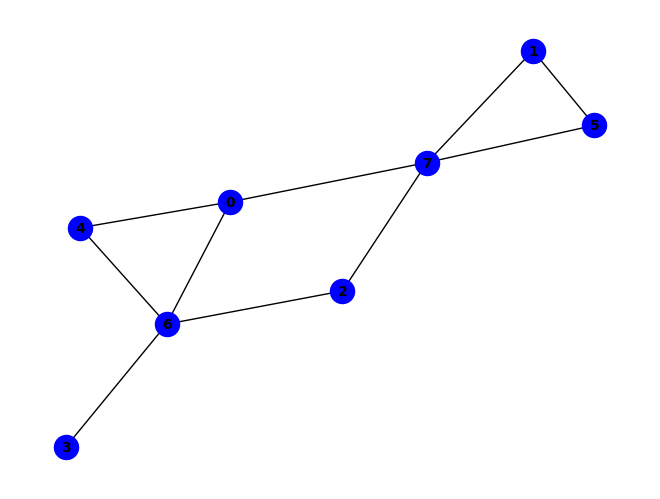


~f ^ (f & ~h) ^ (a & e & ~h) ^ (b & f & ~e) ^ (b & h & ~e) ^ (b & e & f & ~g) ^ (b & e & h & ~g) ^ (a & g & ~e & ~h) ^ (a & h & ~c & ~f) ^ (c & g & ~a & ~h) ^ (c & h & ~b & ~f) ^ (e & g & ~a & ~c) ^ (a & b & c & h & ~f) ^ (a & b & e & f & ~h) ^ (b & c & f & g & ~h) ^ (e & f & g & h & ~c) ^ (a & b & h & ~e & ~f) ^ (a & d & f & g & h & ~c) ^ (b & c & d & f & g & ~a) ^ (b & c & d & g & h & ~a) ^ (d & g & ~a & ~c & ~e) ^ (a & b & e & h & ~f & ~g) ^ (a & b & f & g & ~c & ~h) ^ (b & d & f & g & ~a & ~e) ^ (b & d & g & h & ~a & ~e) ^ (d & f & g & h & ~c & ~e) ^ (a & e & f & g & h & ~c & ~d) ^ (b & c & e & f & g & ~a & ~d) ^ (b & c & e & g & h & ~a & ~d)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


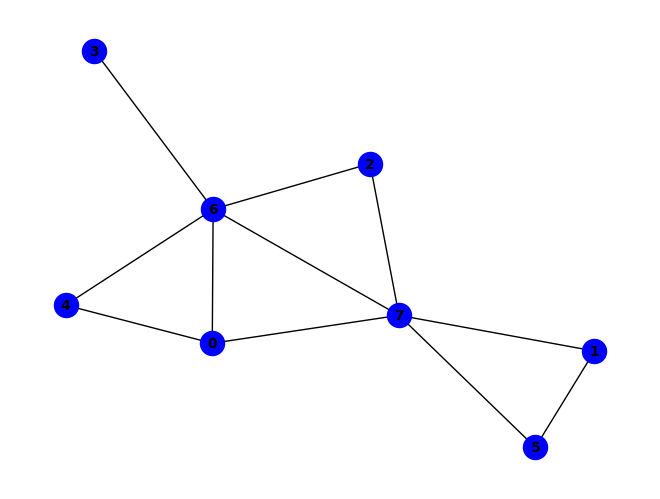


(~e & ~g) ^ (e & h & ~g) ^ (f & h & ~g) ^ (g & ~d & ~h) ^ (c & f & g & ~h) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & f & ~c & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (a & b & e & f & ~h) ^ (e & ~a & ~d & ~h) ^ (a & d & g & ~c & ~h) ^ (a & f & g & ~c & ~h) ^ (b & c & f & ~g & ~h) ^ (c & d & g & ~b & ~h) ^ (b & h & ~a & ~f & ~g) ^ (d & e & ~a & ~g & ~h) ^ (a & b & c & h & ~f & ~g) ^ (a & b & f & g & ~d & ~h) ^ (b & d & f & g & ~e & ~h) ^ (b & e & f & g & ~c & ~h) ^ (a & b & d & e & f & g & ~h) ^ (b & c & d & e & f & g & ~h) ^ (b & c & g & ~d & ~f & ~h) ^ (c & e & g & ~a & ~d & ~h) ^ (a & b & c & f & g & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


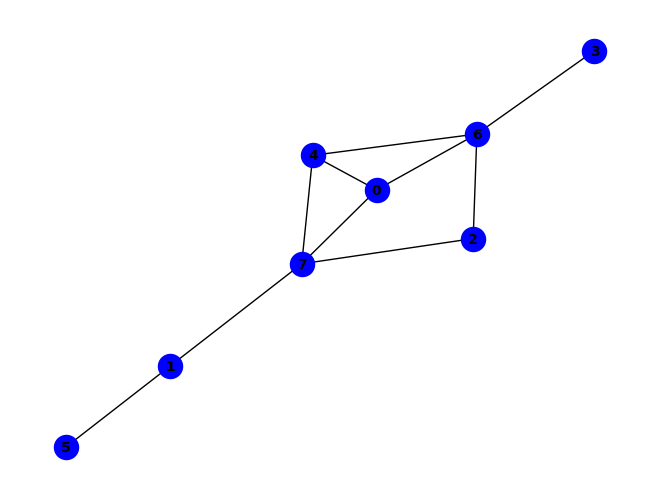


(d & ~g) ^ (~b & ~d) ^ (e & g & ~h) ^ (e & h & ~b) ^ (a & d & e & ~g) ^ (a & e & ~b & ~d) ^ (a & g & ~b & ~d) ^ (c & h & ~b & ~e) ^ (b & e & f & g & ~h) ^ (b & ~d & ~f & ~h) ^ (a & c & g & ~b & ~e) ^ (b & d & e & ~f & ~g) ^ (b & d & e & ~f & ~h) ^ (b & d & f & ~g & ~h) ^ (b & d & h & ~e & ~g) ^ (c & d & g & ~a & ~b) ^ (d & e & g & ~b & ~c) ^ (a & b & d & e & h & ~g) ^ (a & c & d & e & g & ~b) ^ (a & h & ~b & ~c & ~g) ^ (c & g & ~b & ~e & ~h) ^ (a & c & e & h & ~b & ~g) ^ (a & b & e & ~d & ~f & ~h) ^ (a & b & g & ~d & ~f & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (b & c & d & e & f & ~a & ~g) ^ (b & c & d & e & f & ~a & ~h) ^ (b & c & d & e & g & ~a & ~h) ^ (b & d & e & f & h & ~c & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (b & c & d & g & ~a & ~f & ~h) ^ (b & c & g & ~a & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


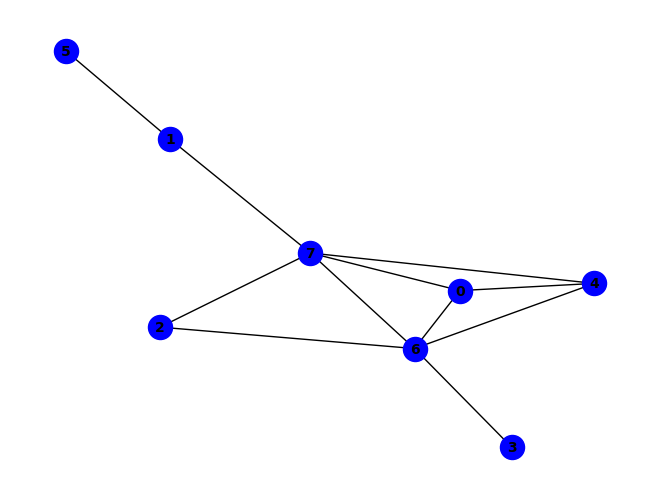


(a & g & ~c) ^ (a & h & ~c) ^ (c & g & ~e) ^ (c & h & ~e) ^ (e & g & ~b) ^ (e & h & ~b) ^ (a & b & f & g) ^ (a & b & f & h) ^ (a & c & e & g) ^ (a & c & e & h) ^ (b & c & f & g) ^ (b & c & f & h) ^ (d & ~e & ~h) ^ (g & ~b & ~h) ^ (~b & ~d & ~g) ^ (d & e & ~c & ~g) ^ (d & h & ~e & ~g) ^ (a & b & c & g & ~e) ^ (a & b & c & h & ~e) ^ (a & b & d & f & ~g) ^ (b & c & e & g & ~d) ^ (b & c & e & h & ~d) ^ (b & d & e & g & ~h) ^ (b & ~e & ~f & ~h) ^ (a & d & e & ~b & ~h) ^ (a & d & g & ~c & ~h) ^ (a & e & g & ~b & ~h) ^ (b & d & f & ~a & ~h) ^ (b & d & h & ~a & ~g) ^ (c & d & e & ~a & ~h) ^ (c & d & g & ~b & ~h) ^ (a & b & c & d & g & ~h) ^ (a & e & ~b & ~d & ~g) ^ (b & e & ~f & ~g & ~h) ^ (a & d & e & h & ~b & ~g) ^ (b & c & d & g & ~f & ~h) ^ (c & d & e & h & ~b & ~g) ^ (a & b & c & d & e & f & ~h) ^ (a & b & e & ~d & ~f & ~h) ^ (a & b & h & ~d & ~f & ~g) ^ (b & c & e & ~a & ~f & ~h) ^ (b & c & e & ~d & ~f & ~g) ^ (b & c & h & ~e & ~f & ~g) ^ (b & d & e & ~c & ~f & ~h) ^ (a & b & c & d & e 

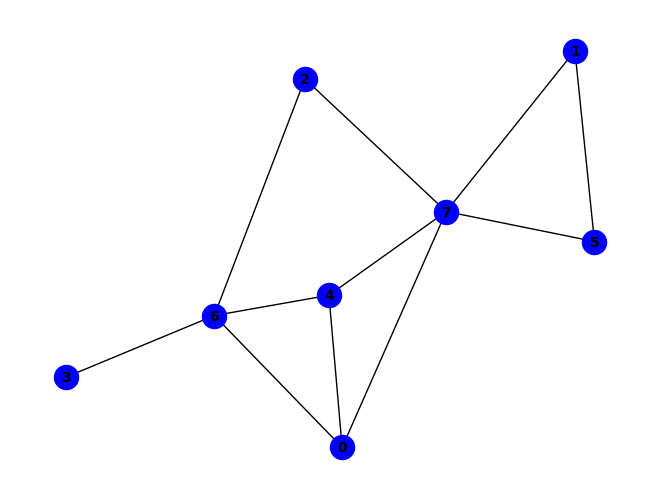


~f ^ (f & ~h) ^ (a & e & ~f) ^ (b & f & ~e) ^ (b & h & ~d) ^ (e & g & ~h) ^ (a & c & e & g) ^ (a & b & h & ~e) ^ (b & d & h & ~g) ^ (a & d & e & f & g) ^ (b & e & f & g & h) ^ (a & g & ~c & ~h) ^ (a & h & ~c & ~f) ^ (c & g & ~e & ~h) ^ (e & h & ~b & ~f) ^ (a & b & e & f & ~d) ^ (a & b & f & g & ~d) ^ (a & b & f & h & ~g) ^ (a & c & e & h & ~g) ^ (a & e & f & ~d & ~h) ^ (b & e & f & ~c & ~g) ^ (a & b & d & e & f & ~g) ^ (a & b & d & g & h & ~e) ^ (a & c & e & f & h & ~d) ^ (a & d & f & g & h & ~c) ^ (b & c & d & g & h & ~a) ^ (b & c & e & f & h & ~g) ^ (b & d & e & g & h & ~c) ^ (a & b & c & d & e & g & h) ^ (c & h & ~b & ~e & ~f) ^ (d & g & ~a & ~c & ~e) ^ (a & b & c & h & ~e & ~f) ^ (a & d & e & f & ~g & ~h) ^ (b & c & e & f & ~a & ~h) ^ (b & c & f & g & ~a & ~h) ^ (b & d & f & g & ~c & ~e) ^ (d & f & g & h & ~c & ~e) ^ (a & b & c & d & f & g & ~e) ^ (a & c & d & e & f & h & ~g) ^ (a & b & c & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

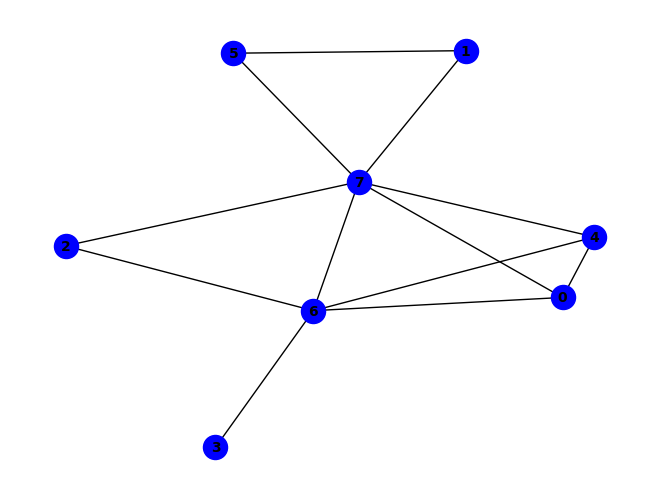


(g & ~h) ^ (~d & ~g) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (c & d & g & ~h) ^ (a & d & ~c & ~g) ^ (a & e & ~d & ~g) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & f & ~e & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & h & ~a & ~g) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & d & e & h & ~g) ^ (a & e & f & h & ~g) ^ (d & ~a & ~e & ~h) ^ (a & c & d & ~e & ~h) ^ (a & f & g & ~b & ~h) ^ (b & c & g & ~d & ~h) ^ (b & e & f & ~g & ~h) ^ (c & d & e & ~b & ~h) ^ (c & f & g & ~a & ~h) ^ (e & f & g & ~c & ~h) ^ (a & c & e & f & g & ~h) ^ (b & c & e & f & g & ~h) ^ (d & e & ~c & ~g & ~h) ^ (a & b & c & h & ~f & ~g) ^ (a & b & e & f & ~c & ~h) ^ (a & c & d & e & ~b & ~g) ^ (a & c & d & h & ~e & ~g) ^ (a & c & e & g & ~b & ~f) ^ (a & c & e & h & ~b & ~f) ^ (b & c & d & e & ~g & ~h) ^ (b & c & e & h & ~f & ~g) ^ (a & b & c & d & e & f & ~h) ^ (a & b & c & d & e & ~f & ~g) ^ (a & b & c & e & f & ~g & ~h) ^ (a & b & c & e & g & ~f & ~h) ^ (a & b & c & f & g & ~d & ~h) ^ (a & b & c & d & e & f & h

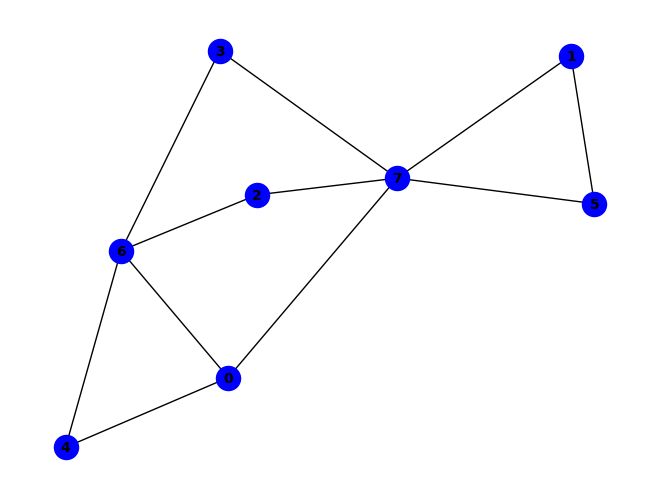


~f ^ (f & ~h) ^ (a & e & ~h) ^ (b & f & ~e) ^ (b & h & ~e) ^ (a & b & h & ~d) ^ (a & c & g & ~e) ^ (a & c & h & ~g) ^ (a & e & g & ~d) ^ (b & e & f & ~g) ^ (b & e & h & ~g) ^ (a & c & d & e & g) ^ (a & g & ~e & ~h) ^ (a & h & ~d & ~f) ^ (c & g & ~d & ~h) ^ (d & g & ~a & ~h) ^ (d & h & ~b & ~f) ^ (e & g & ~c & ~d) ^ (a & b & c & h & ~f) ^ (a & b & e & f & ~h) ^ (a & b & f & g & ~d) ^ (a & c & d & g & ~h) ^ (a & c & f & h & ~e) ^ (b & d & f & g & ~h) ^ (a & b & e & g & h & ~f) ^ (a & c & e & f & h & ~g) ^ (a & e & f & g & h & ~d) ^ (b & c & e & g & h & ~a) ^ (b & d & e & f & g & ~a) ^ (a & c & d & e & f & g & h) ^ (c & h & ~b & ~d & ~f) ^ (a & b & f & h & ~d & ~g) ^ (a & c & d & h & ~b & ~f) ^ (e & f & g & h & ~c & ~d) ^ (b & c & e & f & g & ~a & ~d) ^ (b & d & e & g & h & ~a & ~c) ^ (b & c & f & g & ~a & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


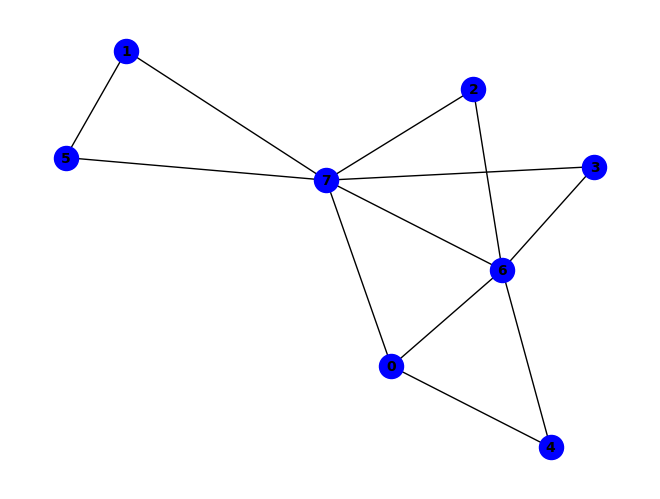


(g & ~h) ^ (~e & ~g) ^ (f & h & ~g) ^ (a & e & ~d & ~h) ^ (b & f & ~d & ~h) ^ (c & e & ~d & ~g) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~c & ~g) ^ (b & c & d & f & ~h) ^ (c & d & e & h & ~g) ^ (e & ~c & ~d & ~h) ^ (a & b & f & ~d & ~g) ^ (a & b & h & ~d & ~g) ^ (a & f & g & ~c & ~h) ^ (b & c & g & ~e & ~h) ^ (b & d & f & ~c & ~g) ^ (b & d & h & ~c & ~g) ^ (b & e & g & ~d & ~h) ^ (c & f & g & ~d & ~h) ^ (d & f & g & ~a & ~h) ^ (a & c & d & f & g & ~h) ^ (a & g & ~c & ~d & ~f) ^ (a & h & ~c & ~d & ~f) ^ (b & e & ~d & ~f & ~g) ^ (b & e & ~d & ~f & ~h) ^ (b & h & ~e & ~f & ~g) ^ (d & e & ~a & ~g & ~h) ^ (a & b & c & f & ~e & ~g) ^ (a & b & c & h & ~e & ~g) ^ (a & b & d & f & ~c & ~h) ^ (a & c & e & g & ~d & ~h) ^ (b & c & e & g & ~f & ~h) ^ (b & d & e & h & ~f & ~g) ^ (b & c & d & e & f & g & ~h) ^ (a & b & f & ~c & ~e & ~h) ^ (a & b & c & d & f & ~g & ~h) ^ (a & b & c & d & h & ~f & ~g) ^ (a & b & c & e & h & ~f & ~g) ^ (a & b & d & e & 

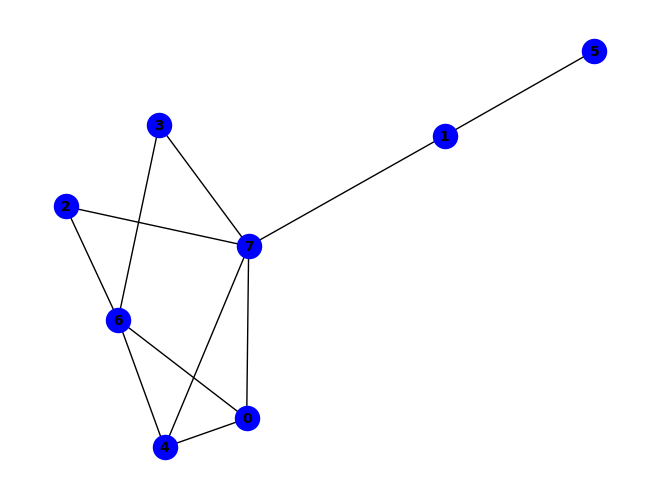


~d ^ (b & f) ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & h & ~f) ^ (e & h & ~d) ^ (d & ~g & ~h) ^ (b & c & h & ~e) ^ (b & d & h & ~e) ^ (b & e & g & ~d) ^ (a & g & ~d & ~h) ^ (e & g & ~d & ~h) ^ (a & b & c & g & ~e) ^ (a & b & e & f & ~h) ^ (a & b & f & g & ~h) ^ (b & c & d & g & ~e) ^ (b & c & d & h & ~g) ^ (b & e & f & h & ~g) ^ (a & b & c & d & f & h) ^ (a & b & h & ~d & ~e) ^ (a & d & e & ~g & ~h) ^ (a & b & c & d & g & ~f) ^ (b & c & d & e & h & ~a) ^ (b & d & e & g & h & ~c) ^ (b & e & ~d & ~f & ~g) ^ (b & e & ~d & ~f & ~h) ^ (c & h & ~a & ~d & ~e) ^ (a & b & c & h & ~e & ~g) ^ (b & c & f & g & ~e & ~h) ^ (b & d & e & h & ~f & ~g) ^ (b & d & f & g & ~a & ~h) ^ (a & b & d & e & f & g & ~h) ^ (a & b & c & d & g & ~e & ~h) ^ (a & b & c & d & h & ~f & ~g) ^ (c & g & ~a & ~d & ~e & ~h) ^ (a & b & c & g & ~e & ~f & ~h) ^ (b & c & d & g & ~e & ~f & ~h) ^ (a & b & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

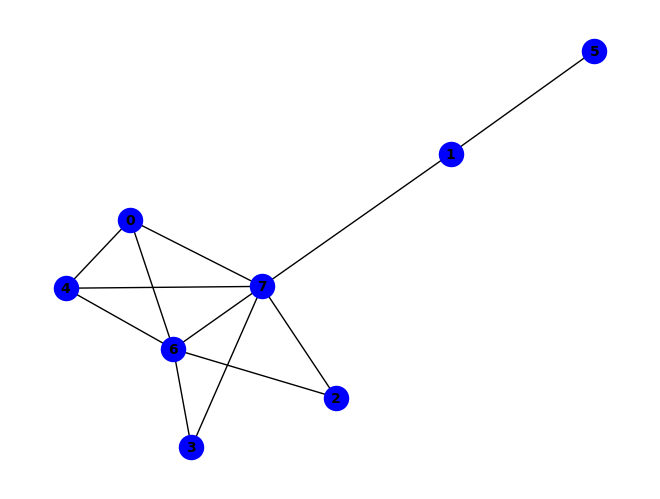


(~b & ~g) ^ (a & e & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (c & g & ~d) ^ (e & g & ~c) ^ (e & h & ~b) ^ (a & b & e & f) ^ (c & d & e & g) ^ (g & ~b & ~h) ^ (a & c & g & ~e) ^ (a & c & h & ~e) ^ (b & e & g & ~a) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (a & b & d & g & ~e) ^ (a & b & d & h & ~e) ^ (a & b & e & h & ~f) ^ (a & b & f & g & ~c) ^ (a & b & f & h & ~c) ^ (a & c & d & g & ~b) ^ (a & c & d & h & ~b) ^ (a & d & e & g & ~c) ^ (a & d & e & h & ~c) ^ (b & ~e & ~f & ~h) ^ (a & e & g & ~b & ~h) ^ (b & c & g & ~d & ~e) ^ (a & b & c & e & g & ~d) ^ (a & b & c & e & h & ~d) ^ (b & e & ~f & ~g & ~h) ^ (c & h & ~b & ~d & ~e) ^ (a & b & h & ~c & ~f & ~g) ^ (b & c & g & ~e & ~f & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & d & g & ~e & ~f & ~h) ^ (b & d & g & ~c & ~e & ~f & ~h) ^ (a & b & c & e & g & ~d & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

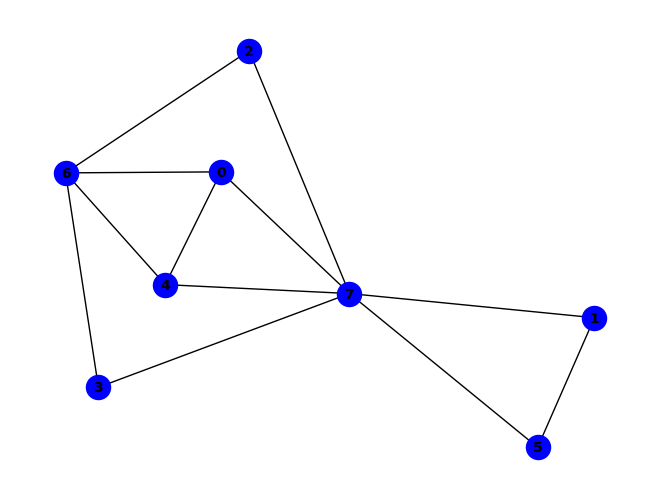


~f ^ (b & h) ^ (a & e & ~f) ^ (a & f & ~d) ^ (a & h & ~d) ^ (b & f & ~e) ^ (e & g & ~h) ^ (b & e & f & h) ^ (f & ~a & ~h) ^ (a & c & g & ~e) ^ (a & e & f & ~h) ^ (a & g & ~d & ~h) ^ (d & g & ~e & ~h) ^ (e & h & ~b & ~f) ^ (a & b & c & h & ~e) ^ (a & b & e & f & ~d) ^ (a & b & e & h & ~d) ^ (a & b & f & g & ~h) ^ (a & c & d & g & ~h) ^ (a & c & f & h & ~e) ^ (a & d & e & g & ~c) ^ (a & b & h & ~d & ~f) ^ (a & c & h & ~e & ~g) ^ (a & d & f & ~b & ~h) ^ (b & e & f & ~g & ~h) ^ (a & b & c & f & g & ~e) ^ (a & d & e & f & h & ~c) ^ (c & g & ~d & ~e & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & c & d & h & ~b & ~f) ^ (a & d & e & h & ~c & ~g) ^ (b & c & f & g & ~e & ~h) ^ (a & b & c & d & e & h & ~f) ^ (a & b & c & f & h & ~e & ~g) ^ (c & h & ~b & ~d & ~e & ~f) ^ (a & b & d & f & ~e & ~g & ~h) ^ (b & d & f & g & ~c & ~e & ~h) ^ (a & b & c & d & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

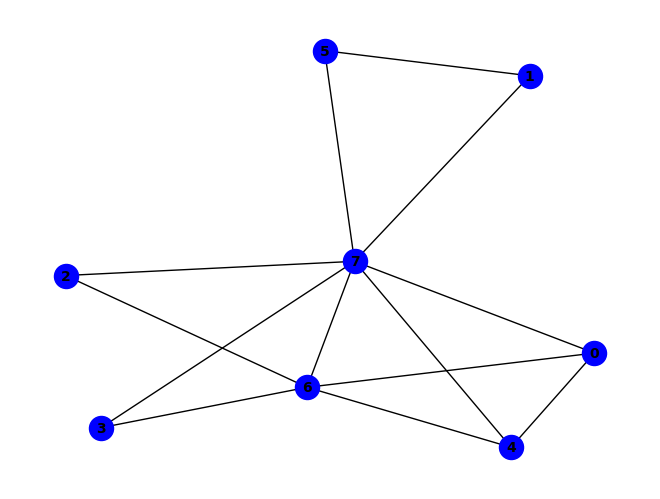


~g ^ (g & ~h) ^ (a & e & ~g) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & b & d & h & ~g) ^ (a & b & e & f & ~h) ^ (a & b & f & g & ~h) ^ (a & e & f & h & ~g) ^ (b & c & d & h & ~g) ^ (a & f & g & ~d & ~h) ^ (b & d & h & ~e & ~g) ^ (b & e & f & ~g & ~h) ^ (c & f & g & ~d & ~h) ^ (d & f & g & ~e & ~h) ^ (e & f & g & ~c & ~h) ^ (a & d & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (a & b & c & f & ~e & ~h) ^ (a & b & d & f & ~e & ~g) ^ (a & b & d & f & ~e & ~h) ^ (a & d & e & g & ~b & ~f) ^ (a & d & e & h & ~b & ~f) ^ (c & d & e & g & ~b & ~f) ^ (c & d & e & h & ~b & ~f) ^ (a & b & d & e & f & h & ~g) ^ (b & c & d & e & f & h & ~g) ^ (a & c & g & ~d & ~e & ~f) ^ (a & c & h & ~d & ~e & ~f) ^ (b & c & f & ~a & ~e & ~g) ^ (b & c & h & ~a & ~e & ~g) ^ (b & d & f & ~c & ~e & ~g) ^ (a & b & d & e & g & ~f & ~h) ^ (b & c & d & e & g & ~f & 

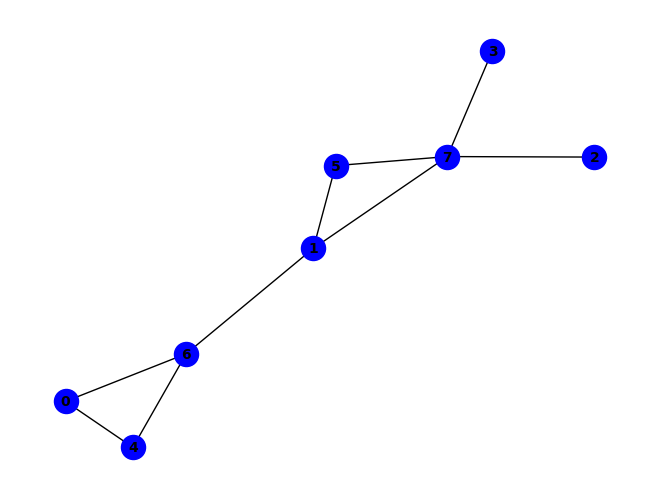


~f ^ (a & b & g) ^ (a & e & ~f) ^ (a & g & ~f) ^ (b & g & ~f) ^ (b & h & ~g) ^ (e & g & ~b) ^ (b & f & g & h) ^ (f & ~a & ~h) ^ (a & e & f & ~h) ^ (b & e & f & ~h) ^ (b & f & ~a & ~e) ^ (d & h & ~b & ~f) ^ (a & b & e & f & ~g) ^ (a & b & e & g & ~h) ^ (a & b & e & h & ~d) ^ (a & d & e & h & ~f) ^ (a & d & f & h & ~c) ^ (a & d & g & h & ~c) ^ (b & e & f & h & ~g) ^ (d & e & g & h & ~c) ^ (e & f & g & h & ~d) ^ (a & b & d & e & f & h) ^ (c & d & e & f & g & h) ^ (a & b & f & ~e & ~h) ^ (a & d & f & ~c & ~g) ^ (a & f & ~d & ~g & ~h) ^ (c & h & ~b & ~d & ~f) ^ (a & b & f & h & ~e & ~g) ^ (a & c & d & f & ~g & ~h) ^ (a & c & g & h & ~b & ~f) ^ (c & e & g & h & ~b & ~f) ^ (a & b & d & g & h & ~c & ~f) ^ (b & d & e & g & h & ~c & ~f) ^ (a & c & e & h & ~b & ~d & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

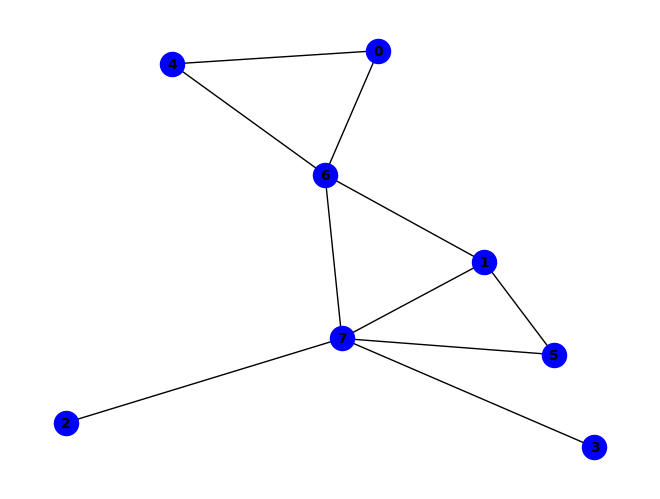


(e & ~h) ^ (g & ~h) ^ (b & e & g) ^ (~e & ~g) ^ (a & e & ~g) ^ (b & f & ~d) ^ (b & g & ~f) ^ (a & f & h & ~g) ^ (b & h & ~a & ~e) ^ (c & h & ~d & ~g) ^ (e & h & ~b & ~g) ^ (f & h & ~c & ~g) ^ (a & b & e & f & ~g) ^ (b & d & f & g & ~c) ^ (c & d & f & h & ~g) ^ (a & b & g & ~d & ~e) ^ (a & b & h & ~d & ~g) ^ (a & f & g & ~d & ~e) ^ (a & f & h & ~d & ~e) ^ (b & d & f & ~g & ~h) ^ (b & d & h & ~c & ~g) ^ (a & b & d & f & h & ~g) ^ (b & c & d & f & g & ~h) ^ (b & c & d & f & h & ~a) ^ (a & b & c & d & f & g & h) ^ (a & g & ~e & ~f & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & b & d & g & ~e & ~h) ^ (a & b & d & h & ~e & ~f) ^ (a & c & d & h & ~f & ~g) ^ (a & c & e & h & ~f & ~g) ^ (a & d & f & g & ~e & ~h) ^ (a & b & c & d & e & h & ~g) ^ (a & b & d & f & g & h & ~e) ^ (a & d & h & ~c & ~e & ~g) ^ (b & c & h & ~a & ~f & ~g) ^ (a & b & c & h & ~e & ~f & ~g) ^ (a & c & d & f & h & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


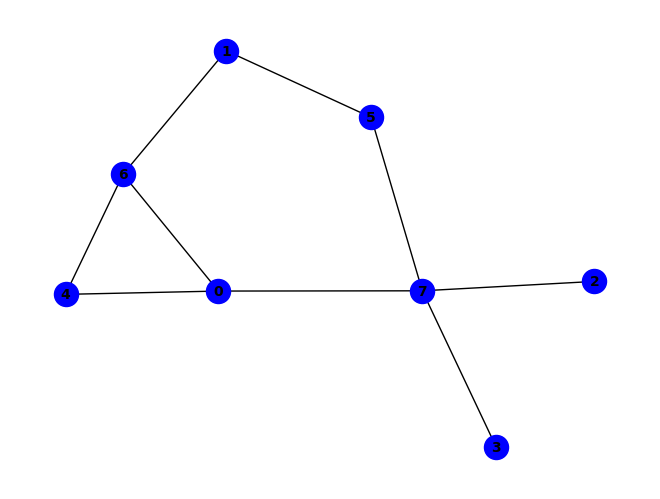


(a & b & g) ^ (~b & ~f) ^ (a & g & ~e) ^ (a & h & ~g) ^ (e & g & ~b) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & f & h & ~e) ^ (a & e & ~g & ~h) ^ (d & h & ~a & ~f) ^ (a & b & e & f & ~h) ^ (a & b & e & g & ~f) ^ (e & f & g & h & ~d) ^ (a & b & d & g & h & ~e) ^ (a & b & f & g & h & ~d) ^ (a & d & e & f & h & ~c) ^ (b & c & e & g & h & ~d) ^ (b & e & f & g & h & ~c) ^ (a & b & d & e & f & g & h) ^ (c & h & ~a & ~d & ~f) ^ (a & e & f & h & ~d & ~g) ^ (b & c & g & h & ~d & ~f) ^ (b & d & g & h & ~e & ~f) ^ (c & e & g & h & ~a & ~f) ^ (d & e & g & h & ~a & ~c) ^ (a & c & d & e & f & h & ~g) ^ (c & d & e & f & g & h & ~b) ^ (a & b & c & g & h & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


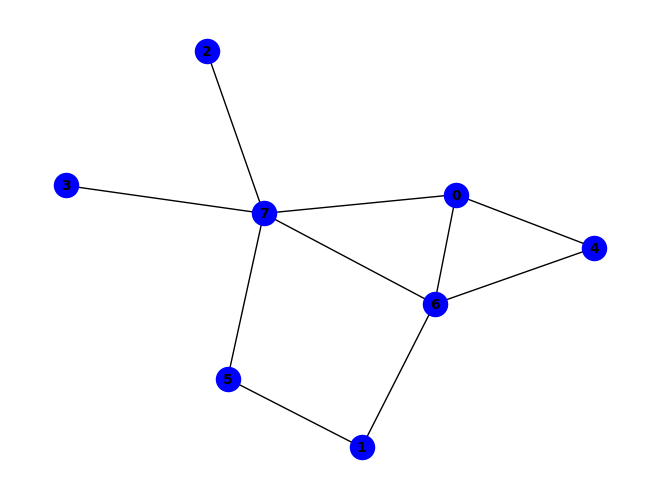


(~e & ~g) ^ (a & e & ~h) ^ (a & g & ~f) ^ (a & h & ~f) ^ (e & h & ~g) ^ (e & ~b & ~h) ^ (g & ~b & ~h) ^ (a & f & g & ~h) ^ (b & e & ~g & ~h) ^ (b & f & ~g & ~h) ^ (c & h & ~d & ~g) ^ (f & h & ~c & ~g) ^ (c & d & f & h & ~g) ^ (a & b & g & ~e & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & c & h & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


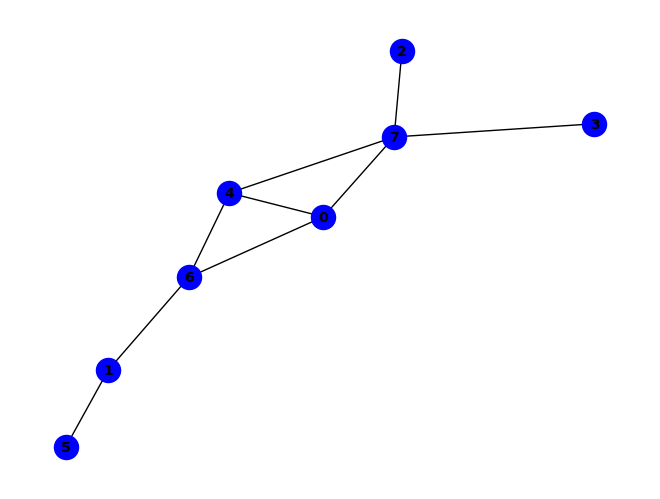


(~b & ~d) ^ (b & ~f & ~g) ^ (d & ~b & ~h) ^ (a & d & e & ~h) ^ (a & e & ~b & ~d) ^ (a & g & ~b & ~h) ^ (a & h & ~b & ~d) ^ (e & g & ~b & ~h) ^ (e & h & ~b & ~d) ^ (a & b & d & e & ~g) ^ (a & b & e & ~f & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & d & e & f & g & ~c) ^ (a & b & d & e & f & h & ~c) ^ (a & b & h & ~d & ~f & ~g) ^ (b & c & h & ~d & ~f & ~g) ^ (b & d & h & ~e & ~f & ~g) ^ (b & e & h & ~c & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (a & b & d & e & g & ~f & ~h) ^ (b & c & d & e & h & ~f & ~g) ^ (a & b & c & d & e & f & g & ~h) ^ (c & h & ~a & ~b & ~d & ~e) ^ (a & b & c & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


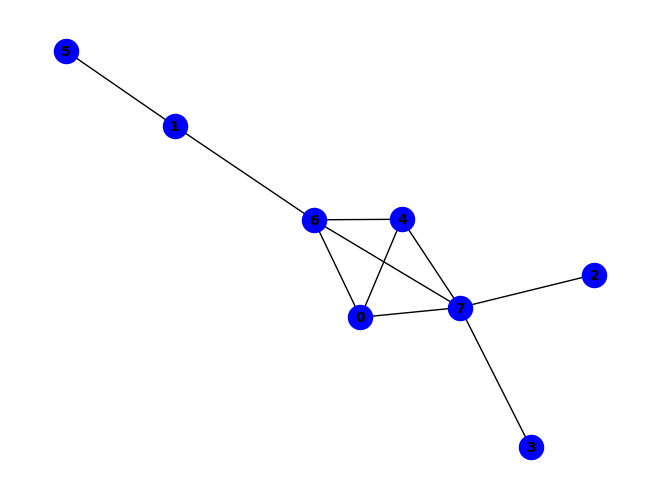


(~b & ~g) ^ (a & e & ~d) ^ (a & g & ~e) ^ (a & h & ~d) ^ (b & g & ~h) ^ (c & g & ~e) ^ (c & h & ~e) ^ (e & g & ~d) ^ (e & h & ~d) ^ (a & b & f & g) ^ (a & b & f & h) ^ (b & ~f & ~g) ^ (g & ~c & ~h) ^ (a & d & e & ~h) ^ (d & e & g & ~h) ^ (d & h & ~c & ~g) ^ (a & b & e & f & ~g) ^ (a & c & e & g & ~d) ^ (a & c & e & h & ~d) ^ (a & d & g & h & ~e) ^ (b & d & f & h & ~g) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & d & e & h & ~g) ^ (a & c & h & ~d & ~g) ^ (a & e & g & ~c & ~h) ^ (c & e & g & ~b & ~h) ^ (a & b & d & e & g & ~c) ^ (a & b & d & e & h & ~c) ^ (a & b & d & g & ~e & ~f) ^ (a & b & d & h & ~c & ~g) ^ (a & b & d & h & ~e & ~f) ^ (a & b & e & g & ~d & ~h) ^ (b & c & f & h & ~d & ~g) ^ (b & d & e & g & ~c & ~f) ^ (b & d & e & h & ~c & ~f) ^ (b & d & e & h & ~c & ~g) ^ (a & b & g & ~d & ~f & ~h) ^ (a & b & c & f & h & ~e & ~g) ^ (a & b & d & e & g & ~f & ~h) ^ (a & c & d & e & g & ~b & ~h) ^ (b & e & g & ~c & ~d & ~f & ~h) ^ (a & b & c & d & h & ~e & ~f & ~g)
PASS
PASS
PAS

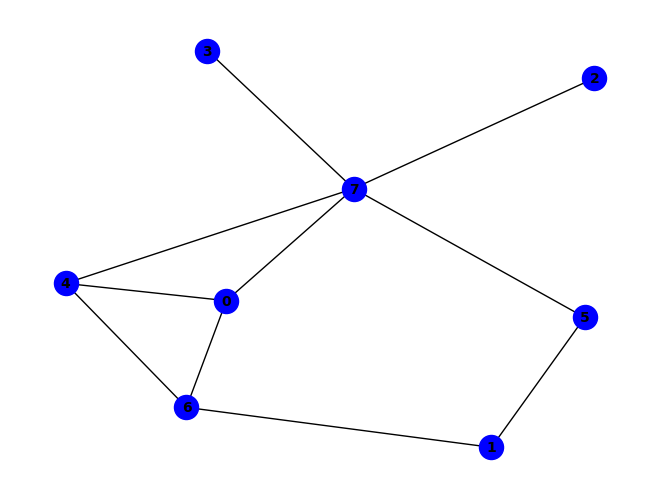


(a & b & g) ^ (b & e & g) ^ (~b & ~f) ^ (a & g & ~h) ^ (e & g & ~h) ^ (e & h & ~f) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & f & g & h) ^ (a & e & ~b & ~f) ^ (d & h & ~e & ~f) ^ (a & b & e & f & ~h) ^ (a & c & e & f & ~d) ^ (a & c & e & h & ~d) ^ (a & d & e & h & ~f) ^ (a & b & e & ~f & ~g) ^ (a & e & f & ~c & ~h) ^ (a & c & d & e & f & ~h) ^ (b & c & e & g & h & ~d) ^ (b & e & f & g & h & ~c) ^ (a & b & c & d & e & g & h) ^ (a & h & ~c & ~d & ~f) ^ (c & h & ~d & ~e & ~f) ^ (b & c & g & h & ~d & ~f) ^ (a & b & c & d & g & h & ~f) ^ (a & b & c & g & h & ~e & ~f) ^ (b & c & d & e & f & g & h & ~a) ^ (b & d & g & h & ~a & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


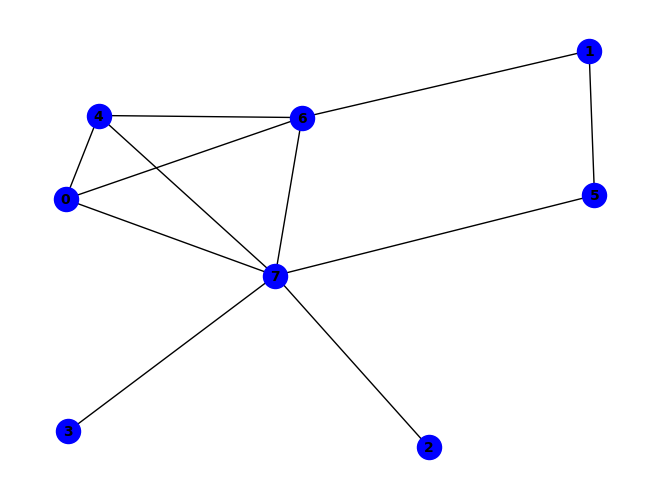


(~b & ~g) ^ (a & e & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (b & h & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & h & ~g) ^ (b & ~f & ~h) ^ (g & ~c & ~h) ^ (b & e & g & ~h) ^ (b & f & g & ~h) ^ (a & c & f & g & ~e) ^ (a & c & f & h & ~d) ^ (a & d & e & h & ~g) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & c & e & g & h) ^ (a & c & d & f & g & h) ^ (a & b & g & ~e & ~h) ^ (a & c & h & ~d & ~g) ^ (a & d & h & ~f & ~g) ^ (a & e & g & ~c & ~h) ^ (a & f & g & ~e & ~h) ^ (c & e & h & ~f & ~g) ^ (c & f & g & ~a & ~h) ^ (d & e & h & ~c & ~g) ^ (e & f & g & ~d & ~h) ^ (a & b & c & e & f & ~h) ^ (a & c & e & f & g & ~h) ^ (a & d & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (d & h & ~c & ~f & ~g) ^ (a & c & e & g & ~b & ~d) ^ (a & c & e & h & ~d & ~f) ^ (a & c & d & e & f & g & ~b) ^ (a & c & d & e & g & ~f & ~h) ^ (a & b & c & d & e & g & h & ~f) ^ (a & b & e & f & ~c & ~g & ~h) ^ (a & b & c & e & g & ~d & ~f & ~h

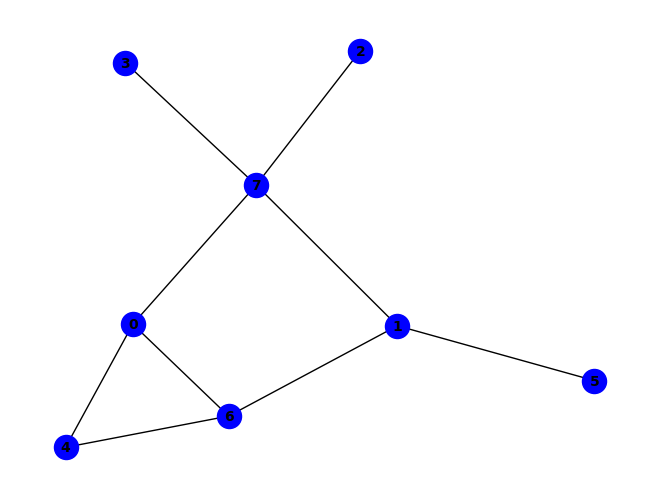


~e ^ (b & e & g) ^ (a & g & ~e) ^ (a & h & ~g) ^ (b & f & ~g) ^ (b & h & ~f) ^ (b & f & g & h) ^ (e & ~d & ~g) ^ (a & d & h & ~e) ^ (a & e & ~g & ~h) ^ (b & g & ~a & ~h) ^ (d & e & ~g & ~h) ^ (d & h & ~b & ~e) ^ (a & b & e & g & ~h) ^ (a & d & e & h & ~g) ^ (b & d & e & h & ~g) ^ (a & b & e & ~d & ~g) ^ (a & c & h & ~d & ~e) ^ (a & b & c & d & e & ~g) ^ (a & b & c & e & h & ~g) ^ (c & h & ~b & ~d & ~e) ^ (a & c & e & h & ~d & ~g) ^ (a & b & e & ~f & ~g & ~h) ^ (a & b & h & ~c & ~d & ~e) ^ (c & e & h & ~b & ~d & ~g) ^ (a & b & d & e & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


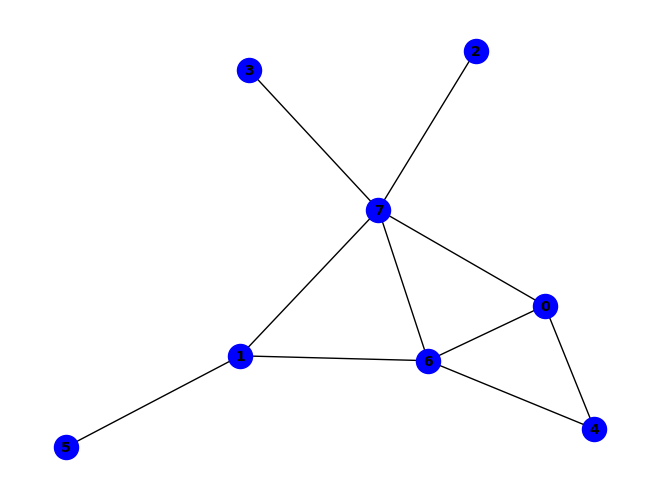


(g & ~h) ^ (b & e & g) ^ (~e & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (b & f & ~h) ^ (b & g & ~f) ^ (b & f & g & h) ^ (e & ~a & ~h) ^ (a & b & g & ~e) ^ (b & h & ~a & ~e) ^ (e & h & ~b & ~g) ^ (a & b & d & h & ~g) ^ (a & b & e & h & ~g) ^ (a & c & d & g & ~b) ^ (a & c & d & h & ~b) ^ (a & d & g & ~c & ~h) ^ (a & b & c & d & g & ~h) ^ (c & h & ~a & ~b & ~g) ^ (d & h & ~b & ~c & ~g) ^ (a & b & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


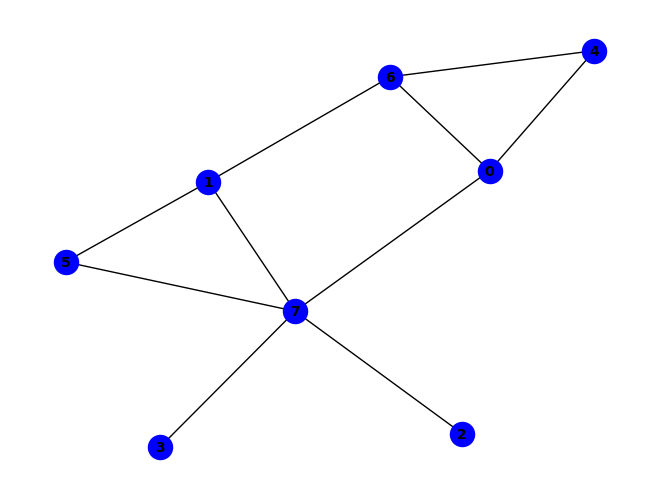


~f ^ (a & f & ~e) ^ (a & g & ~e) ^ (a & h & ~g) ^ (b & f & ~e) ^ (b & g & ~f) ^ (b & h & ~g) ^ (e & g & ~b) ^ (b & f & g & h) ^ (f & ~a & ~h) ^ (a & b & g & ~h) ^ (b & e & f & ~h) ^ (d & h & ~b & ~f) ^ (a & b & e & g & ~f) ^ (b & e & f & h & ~g) ^ (e & f & g & h & ~d) ^ (c & d & e & f & g & h) ^ (a & b & h & ~d & ~f) ^ (a & c & h & ~b & ~f) ^ (a & d & h & ~c & ~f) ^ (a & e & f & ~b & ~h) ^ (a & e & f & ~d & ~g) ^ (a & b & c & d & h & ~f) ^ (a & d & e & f & h & ~c) ^ (a & e & ~f & ~g & ~h) ^ (c & h & ~b & ~d & ~f) ^ (a & d & e & f & ~g & ~h) ^ (d & e & g & h & ~a & ~c) ^ (a & c & d & e & f & h & ~g) ^ (c & e & g & h & ~a & ~b & ~f) ^ (b & d & e & g & h & ~a & ~c & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


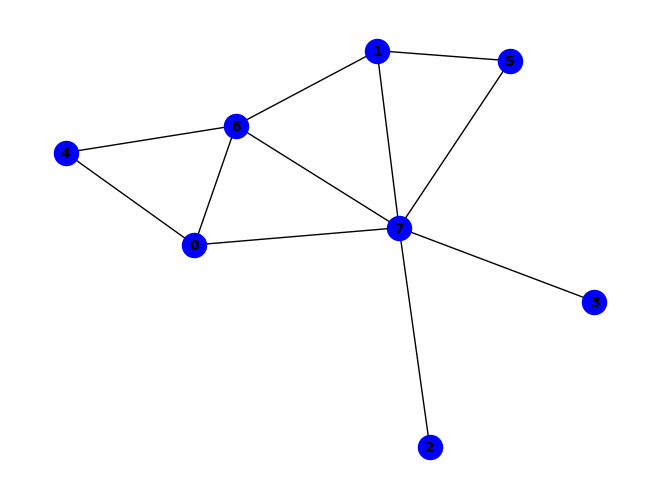


(g & ~h) ^ (b & e & g) ^ (~e & ~g) ^ (b & f & ~d) ^ (b & g & ~f) ^ (b & h & ~e) ^ (e & ~a & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (c & h & ~d & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~b & ~g) ^ (f & h & ~c & ~g) ^ (a & b & e & g & ~h) ^ (a & b & f & g & ~h) ^ (a & d & f & g & ~c) ^ (a & d & f & h & ~c) ^ (b & d & f & g & ~c) ^ (c & d & f & h & ~g) ^ (a & d & h & ~c & ~g) ^ (a & f & g & ~d & ~h) ^ (b & c & h & ~f & ~g) ^ (b & d & f & ~g & ~h) ^ (b & d & h & ~c & ~g) ^ (a & b & c & d & h & ~g) ^ (a & c & d & f & g & ~h) ^ (b & c & d & f & g & ~h) ^ (b & c & d & f & h & ~a) ^ (a & b & c & d & f & g & h) ^ (a & b & d & h & ~f & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & c & h & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


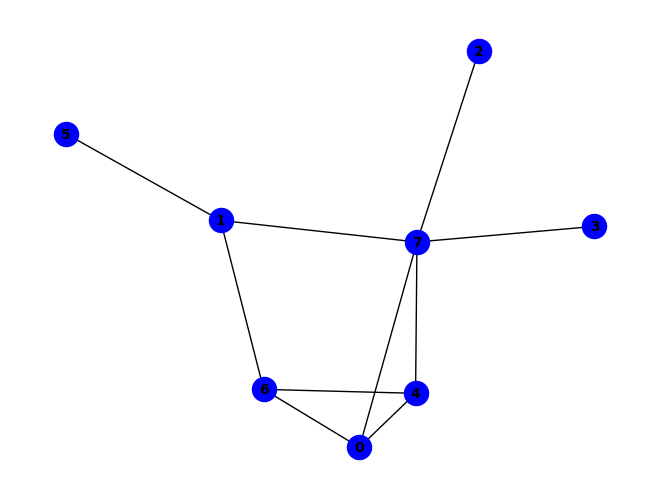


~d ^ (d & ~h) ^ (a & e & ~d) ^ (a & g & ~h) ^ (a & h & ~d) ^ (b & f & ~h) ^ (b & g & ~f) ^ (b & f & g & h) ^ (a & b & g & ~e) ^ (a & d & e & ~h) ^ (b & d & h & ~c) ^ (b & c & d & e & h) ^ (b & h & ~a & ~g) ^ (e & g & ~b & ~h) ^ (e & h & ~b & ~d) ^ (a & b & e & h & ~g) ^ (b & c & h & ~a & ~e) ^ (c & h & ~a & ~d & ~e) ^ (a & b & d & h & ~c & ~e) ^ (a & b & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


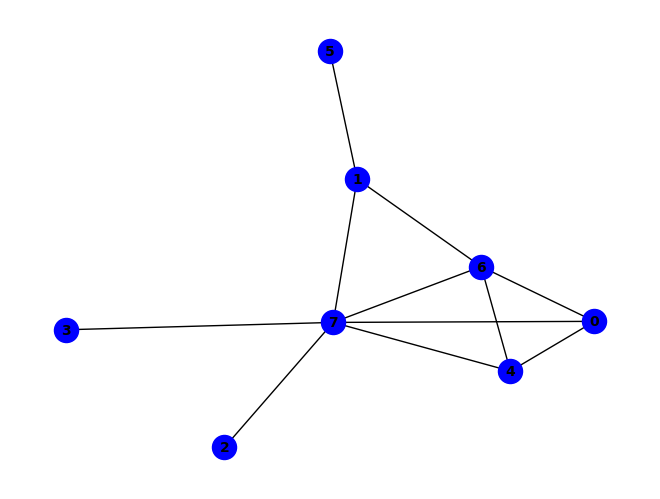


~g ^ (a & e & ~g) ^ (a & h & ~d) ^ (b & f & ~h) ^ (b & g & ~f) ^ (c & g & ~e) ^ (c & h & ~e) ^ (e & h & ~d) ^ (b & f & g & h) ^ (g & ~c & ~h) ^ (c & e & g & ~h) ^ (a & g & ~b & ~d) ^ (b & h & ~a & ~e) ^ (e & g & ~b & ~d) ^ (a & b & d & h & ~e) ^ (a & b & e & f & ~h) ^ (a & b & e & g & ~f) ^ (a & c & e & g & ~d) ^ (a & c & e & h & ~d) ^ (a & d & e & h & ~g) ^ (b & d & e & h & ~c) ^ (c & d & e & h & ~g) ^ (a & b & d & e & g & h) ^ (a & b & e & f & g & h) ^ (b & c & d & e & g & h) ^ (a & c & h & ~d & ~g) ^ (a & d & g & ~b & ~h) ^ (a & e & g & ~c & ~h) ^ (d & e & g & ~b & ~h) ^ (a & c & d & e & g & ~h) ^ (d & h & ~b & ~c & ~g) ^ (b & c & h & ~a & ~e & ~g) ^ (a & b & c & d & h & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


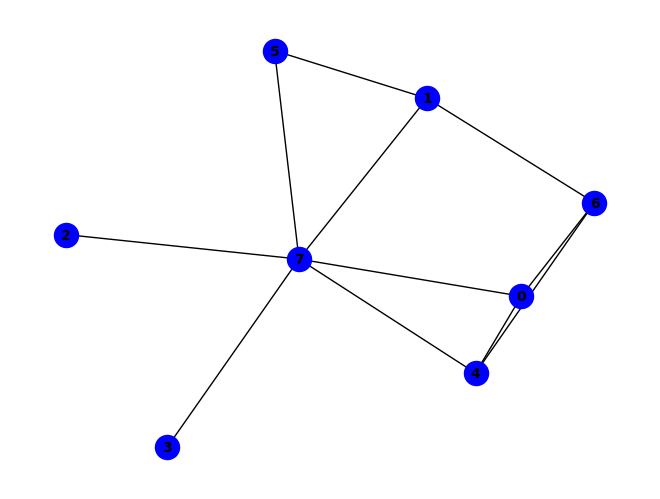


~f ^ (f & ~h) ^ (a & g & ~h) ^ (b & f & ~g) ^ (e & g & ~h) ^ (e & h & ~f) ^ (b & f & g & h) ^ (a & e & ~b & ~f) ^ (b & h & ~a & ~e) ^ (d & h & ~e & ~f) ^ (a & b & e & h & ~f) ^ (a & b & f & h & ~e) ^ (a & c & e & f & ~d) ^ (a & c & e & h & ~d) ^ (b & d & e & h & ~c) ^ (b & e & f & h & ~d) ^ (b & c & d & e & f & h) ^ (a & b & e & ~g & ~h) ^ (a & e & f & ~c & ~h) ^ (a & c & d & e & f & ~h) ^ (a & h & ~c & ~d & ~f) ^ (b & g & ~a & ~e & ~h) ^ (c & h & ~d & ~e & ~f) ^ (a & b & e & g & ~f & ~h) ^ (a & d & e & h & ~b & ~f) ^ (a & b & c & d & e & h & ~f) ^ (b & c & h & ~a & ~e & ~f) ^ (b & d & h & ~a & ~c & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


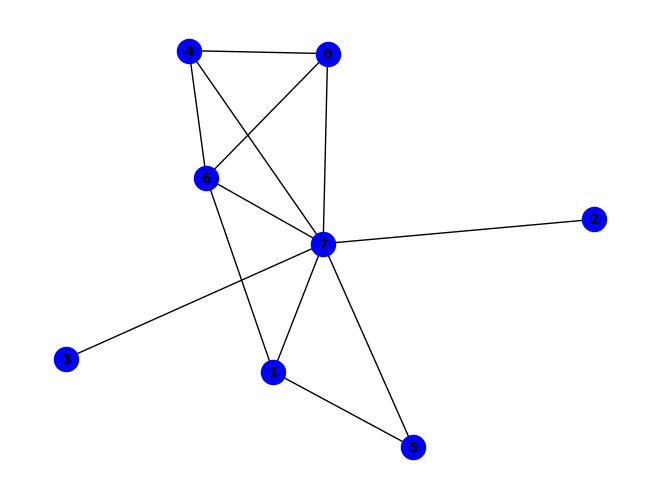


~g ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & g & ~f) ^ (c & h & ~f) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & h & ~g) ^ (g & ~c & ~h) ^ (c & f & g & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (a & b & e & f & ~d) ^ (a & b & e & g & ~f) ^ (a & b & e & h & ~d) ^ (a & d & e & g & ~f) ^ (a & d & e & h & ~f) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & d & e & g & h) ^ (a & c & d & e & f & g) ^ (a & e & g & ~d & ~h) ^ (a & f & g & ~b & ~h) ^ (c & e & h & ~f & ~g) ^ (d & e & h & ~c & ~g) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (b & c & e & h & ~d & ~g) ^ (b & e & f & h & ~c & ~g) ^ (a & b & d & e & f & g & ~c) ^ (a & c & d & e & f & h & ~b) ^ (b & c & d & e & f & h & ~g) ^ (b & c & h & ~d & ~f & ~g) ^ (b & d & h & ~e & ~f & ~g) ^ (a & b & d & e & f & ~g & ~h) ^ (a & c & d & e & h & ~b & ~g) ^ (a & d & e & f & g & ~c & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (d & h & ~a & ~c & ~f & ~g) ^ (a & b & d & h & ~c & ~f & ~g) ^ 

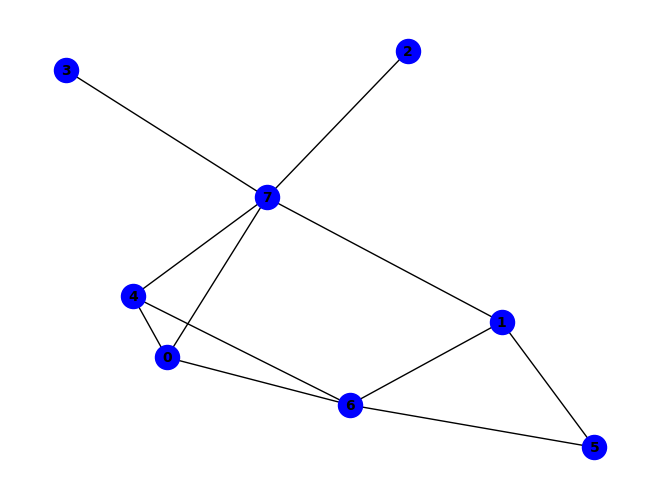


~f ^ (a & h & ~g) ^ (e & f & g & ~b) ^ (a & e & ~b & ~f) ^ (a & g & ~b & ~f) ^ (b & g & ~f & ~h) ^ (b & h & ~d & ~f) ^ (d & h & ~c & ~f) ^ (e & g & ~b & ~h) ^ (e & h & ~b & ~d) ^ (c & d & e & h & ~f) ^ (f & ~b & ~d & ~g) ^ (a & b & e & ~g & ~h) ^ (a & b & h & ~e & ~g) ^ (a & e & f & ~d & ~g) ^ (d & e & f & g & h & ~b) ^ (c & h & ~b & ~e & ~f) ^ (a & b & e & h & ~f & ~g) ^ (a & d & e & f & ~g & ~h) ^ (a & d & f & h & ~c & ~g) ^ (b & c & d & h & ~e & ~f) ^ (a & b & c & d & f & h & ~g) ^ (a & d & h & ~b & ~e & ~f) ^ (c & d & f & ~b & ~e & ~g) ^ (a & b & d & f & h & ~e & ~g) ^ (d & f & ~b & ~c & ~g & ~h) ^ (c & d & e & f & ~b & ~g & ~h) ^ (a & c & d & e & f & h & ~b & ~g) ^ (a & c & h & ~b & ~d & ~e & ~f) ^ (c & f & h & ~a & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


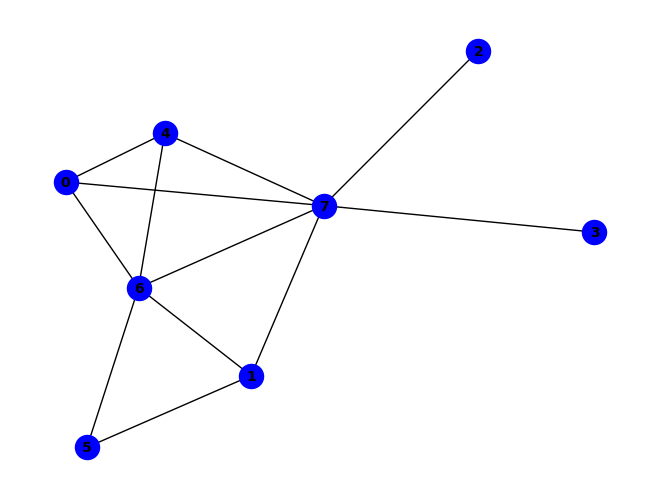


(g & ~h) ^ (~f & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (e & g & ~d) ^ (e & h & ~d) ^ (f & h & ~g) ^ (d & e & g & ~h) ^ (a & e & ~f & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (d & h & ~c & ~g) ^ (a & c & e & g & ~b) ^ (a & c & e & h & ~b) ^ (a & d & e & g & ~c) ^ (a & d & e & h & ~c) ^ (a & e & f & h & ~g) ^ (c & d & e & h & ~g) ^ (f & ~b & ~e & ~h) ^ (a & d & g & ~e & ~h) ^ (a & e & f & ~b & ~h) ^ (a & e & g & ~c & ~h) ^ (a & f & g & ~b & ~h) ^ (a & b & c & e & g & ~h) ^ (a & c & d & e & g & ~h) ^ (c & h & ~b & ~e & ~g) ^ (e & f & ~b & ~g & ~h) ^ (a & b & d & h & ~e & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & c & h & ~b & ~d & ~g) ^ (b & d & h & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


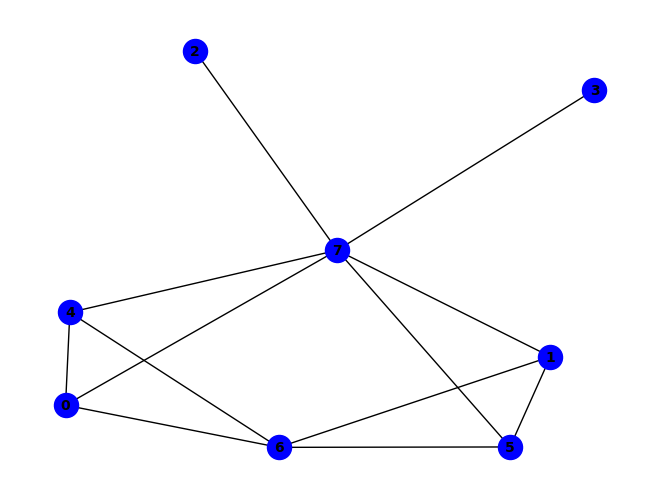


~e ^ (a & e & ~d) ^ (b & f & ~e) ^ (b & h & ~e) ^ (f & h & ~e) ^ (a & b & e & g) ^ (a & e & f & g) ^ (e & ~g & ~h) ^ (a & b & g & ~f) ^ (a & c & d & e & h) ^ (a & g & ~f & ~h) ^ (a & h & ~d & ~f) ^ (b & g & ~e & ~h) ^ (f & g & ~e & ~h) ^ (a & b & d & e & ~c) ^ (a & b & e & f & ~d) ^ (a & b & e & h & ~g) ^ (a & c & d & h & ~f) ^ (a & e & f & h & ~g) ^ (a & b & h & ~f & ~g) ^ (a & d & e & ~b & ~h) ^ (b & e & f & ~g & ~h) ^ (a & b & c & d & e & ~h) ^ (a & b & d & e & f & ~h) ^ (a & d & e & f & h & ~c) ^ (a & b & c & d & e & f & h) ^ (d & h & ~b & ~e & ~f) ^ (a & b & d & h & ~c & ~f) ^ (a & c & h & ~b & ~e & ~f) ^ (c & h & ~b & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


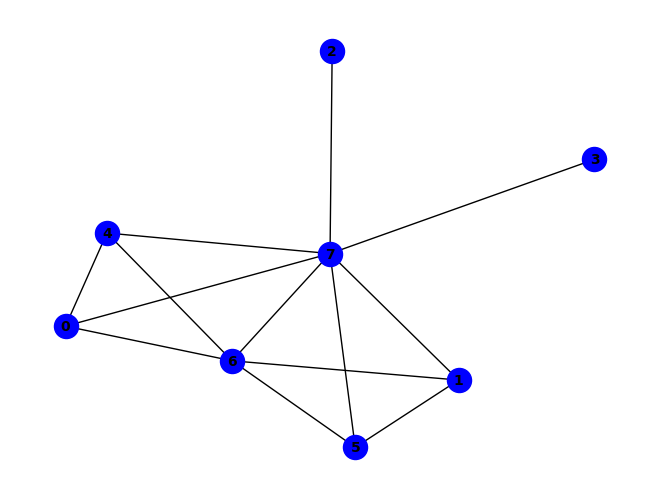


~g ^ (b & f & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~d) ^ (f & h & ~d) ^ (g & ~c & ~h) ^ (b & f & g & ~h) ^ (a & g & ~e & ~f) ^ (a & h & ~e & ~f) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (d & h & ~e & ~g) ^ (a & b & f & g & ~e) ^ (a & b & f & h & ~e) ^ (a & c & f & g & ~e) ^ (a & c & f & h & ~e) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & c & d & e & f & g) ^ (a & c & d & e & f & h) ^ (a & c & h & ~e & ~g) ^ (c & e & h & ~f & ~g) ^ (c & f & g & ~a & ~h) ^ (d & f & g & ~e & ~h) ^ (b & d & e & f & g & ~h) ^ (a & e & ~b & ~g & ~h) ^ (b & d & e & h & ~a & ~g) ^ (a & b & d & e & f & h & ~g) ^ (b & c & d & e & f & g & ~a) ^ (b & c & d & e & f & h & ~a) ^ (a & b & e & ~f & ~g & ~h) ^ (a & d & h & ~e & ~f & ~g) ^ (c & d & h & ~a & ~f & ~g) ^ (a & c & e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (c & d & e & h & ~a & ~b & ~g) ^ (b & c & h & ~a & ~e & ~f & ~g

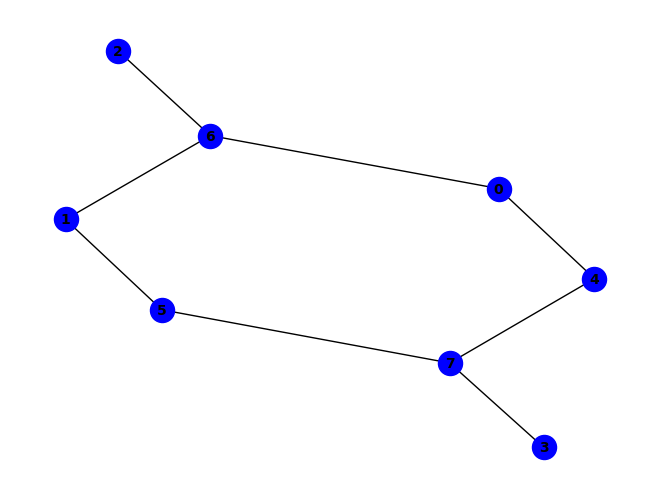


(a & c & g) ^ (~b & ~f) ^ (a & e & ~h) ^ (a & g & ~e) ^ (c & g & ~b) ^ (e & h & ~f) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & g & ~c) ^ (d & h & ~e & ~f) ^ (a & f & g & h & ~e) ^ (a & b & f & g & h & ~c) ^ (a & c & d & g & h & ~e) ^ (a & c & f & g & h & ~d) ^ (a & c & d & e & f & g & h) ^ (a & d & g & h & ~e & ~f) ^ (b & d & g & h & ~e & ~f) ^ (b & e & g & h & ~a & ~f) ^ (c & d & g & h & ~b & ~e) ^ (c & f & g & h & ~b & ~d) ^ (a & b & d & e & f & h & ~c) ^ (a & b & d & e & g & h & ~c) ^ (c & d & e & f & g & h & ~b) ^ (a & b & d & e & f & ~c & ~g) ^ (a & b & d & g & h & ~c & ~f) ^ (a & b & e & f & ~d & ~g & ~h) ^ (c & e & g & h & ~a & ~b & ~f) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


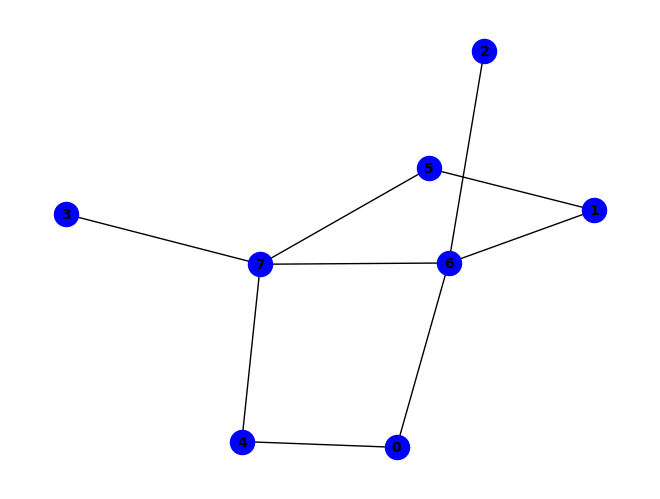


(~c & ~g) ^ (c & h & ~g) ^ (f & h & ~g) ^ (c & ~b & ~h) ^ (g & ~b & ~h) ^ (a & e & ~g & ~h) ^ (b & c & ~g & ~h) ^ (e & h & ~f & ~g) ^ (a & g & ~b & ~c & ~h) ^ (b & f & ~a & ~g & ~h) ^ (d & h & ~e & ~f & ~g) ^ (a & b & f & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


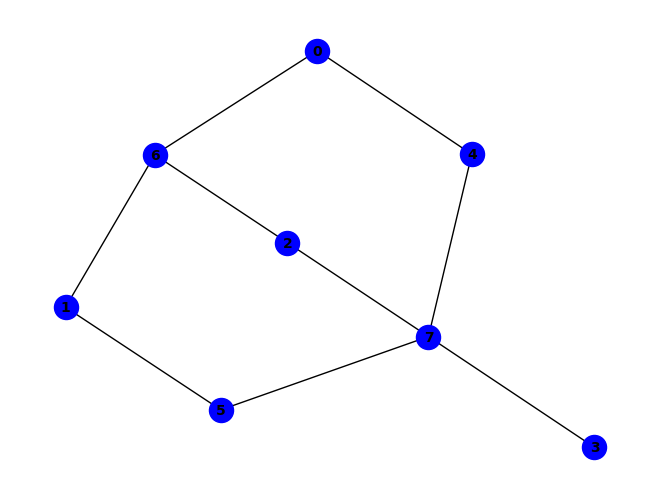


(a & c & g) ^ (b & c & g) ^ (~b & ~f) ^ (a & g & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & d & e & g) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & g & ~c) ^ (a & e & ~d & ~h) ^ (d & h & ~e & ~f) ^ (a & b & c & f & g & h) ^ (a & b & d & g & h & ~e) ^ (a & b & f & g & h & ~d) ^ (a & c & e & g & h & ~d) ^ (a & d & e & f & h & ~c) ^ (b & c & e & g & h & ~d) ^ (b & c & f & g & h & ~e) ^ (a & b & c & d & e & g & h) ^ (b & c & d & e & f & g & h) ^ (c & h & ~d & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & d & e & f & ~c & ~g) ^ (a & d & g & h & ~c & ~f) ^ (a & f & g & h & ~c & ~e) ^ (b & d & g & h & ~c & ~f) ^ (b & e & g & h & ~d & ~f) ^ (a & b & c & d & g & h & ~f) ^ (a & d & e & ~f & ~g & ~h) ^ (a & b & e & g & h & ~c & ~f) ^ (a & c & d & e & f & ~g & ~h) ^ (a & b & d & e & f & g & h & ~c)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

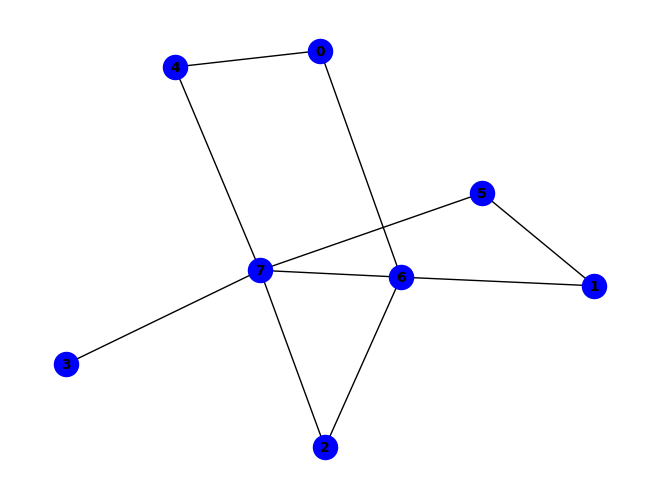


(~b & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & h & ~g) ^ (g & ~a & ~h) ^ (a & b & c & ~h) ^ (a & c & g & ~h) ^ (b & c & g & ~h) ^ (a & b & ~c & ~g) ^ (a & e & ~g & ~h) ^ (b & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & b & c & h & ~g) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (b & ~a & ~f & ~h) ^ (b & f & g & ~a & ~h) ^ (c & d & h & ~f & ~g) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (c & d & e & f & g & ~h) ^ (d & h & ~e & ~f & ~g) ^ (a & b & f & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


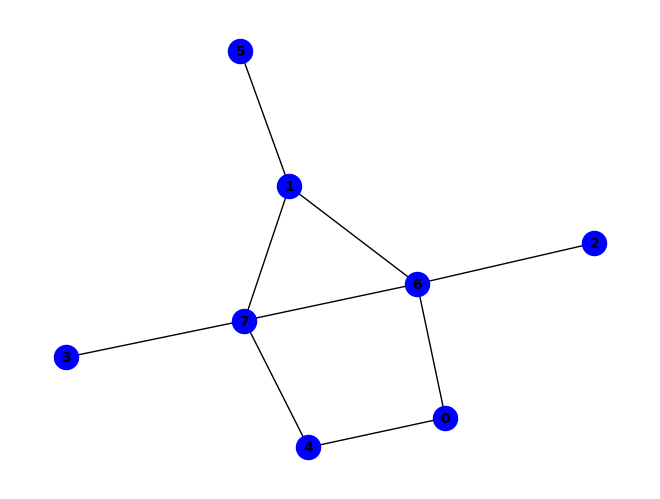


(~c & ~g) ^ (b & g & ~f) ^ (b & h & ~e) ^ (c & h & ~g) ^ (e & h & ~g) ^ (a & b & f & g) ^ (b & d & e & h) ^ (c & ~b & ~h) ^ (g & ~a & ~h) ^ (a & b & c & ~h) ^ (a & c & g & ~h) ^ (b & d & h & ~g) ^ (a & e & ~g & ~h) ^ (b & f & ~a & ~h) ^ (d & h & ~e & ~g) ^ (a & b & e & g & ~h) ^ (b & e & g & h & ~d) ^ (b & f & g & h & ~a) ^ (a & b & f & ~e & ~h) ^ (b & c & ~a & ~g & ~h) ^ (a & b & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


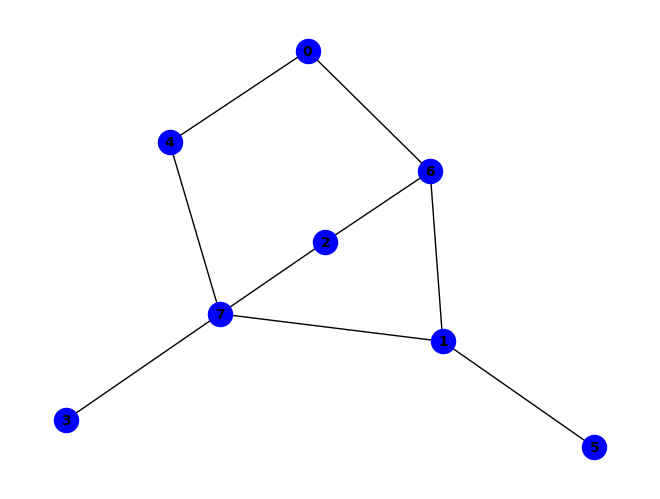


(~a & ~e) ^ (b & f & ~g) ^ (b & h & ~f) ^ (c & g & ~h) ^ (d & h & ~e) ^ (b & f & g & h) ^ (a & ~e & ~g) ^ (e & ~a & ~h) ^ (a & b & g & ~h) ^ (a & c & g & ~b) ^ (b & c & h & ~e) ^ (b & d & h & ~c) ^ (b & e & h & ~d) ^ (b & g & ~c & ~h) ^ (c & h & ~d & ~e) ^ (a & b & f & g & ~e) ^ (a & b & c & d & g & h) ^ (a & b & f & ~e & ~h) ^ (a & b & f & ~g & ~h) ^ (a & b & d & g & h & ~e) ^ (a & c & e & g & h & ~b) ^ (b & c & d & e & h & ~a) ^ (a & b & g & h & ~e & ~f) ^ (a & d & g & h & ~c & ~e) ^ (a & b & c & d & e & h & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


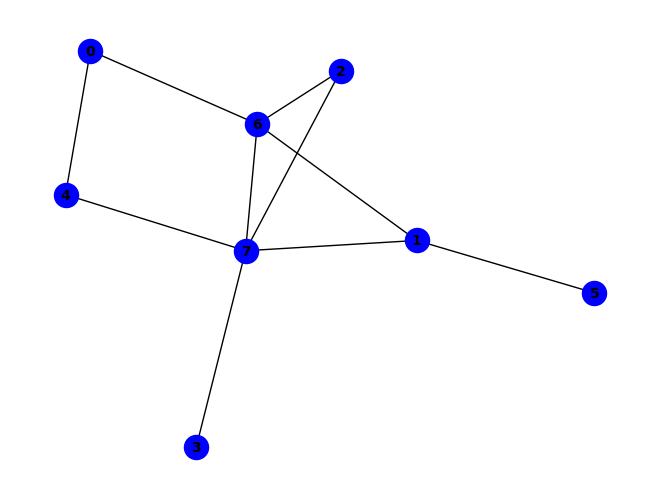


(g & ~h) ^ (~a & ~g) ^ (b & g & ~f) ^ (c & h & ~e) ^ (e & h & ~g) ^ (b & e & g & h) ^ (b & f & g & h) ^ (a & e & g & ~h) ^ (a & c & ~b & ~g) ^ (a & c & ~b & ~h) ^ (a & h & ~c & ~g) ^ (b & f & ~a & ~h) ^ (b & h & ~c & ~e) ^ (c & g & ~b & ~e) ^ (a & b & c & h & ~g) ^ (a & ~b & ~e & ~h) ^ (a & b & g & ~e & ~h) ^ (a & b & g & ~f & ~h) ^ (c & e & g & ~b & ~h) ^ (a & b & ~e & ~f & ~g & ~h) ^ (d & h & ~b & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


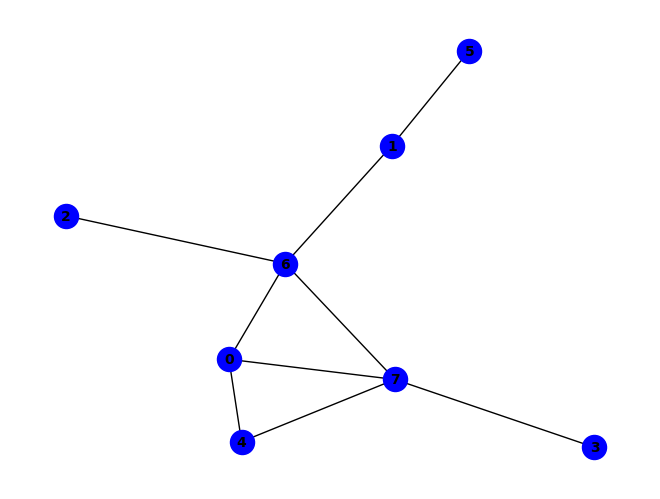


(~c & ~g) ^ (a & e & ~d) ^ (a & g & ~e) ^ (a & h & ~d) ^ (b & f & ~g) ^ (a & b & f & g) ^ (a & b & f & h) ^ (g & ~b & ~h) ^ (a & c & ~b & ~g) ^ (b & c & ~g & ~h) ^ (c & h & ~a & ~g) ^ (d & h & ~e & ~g) ^ (e & h & ~b & ~g) ^ (a & b & c & h & ~g) ^ (a & b & d & e & ~g) ^ (a & b & e & f & ~g) ^ (a & d & g & h & ~e) ^ (c & ~a & ~b & ~h) ^ (a & b & g & ~f & ~h) ^ (a & d & e & ~b & ~h) ^ (b & e & h & ~f & ~g) ^ (a & b & d & e & g & ~h) ^ (a & b & d & f & h & ~g) ^ (b & d & f & h & ~e & ~g) ^ (a & b & d & e & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


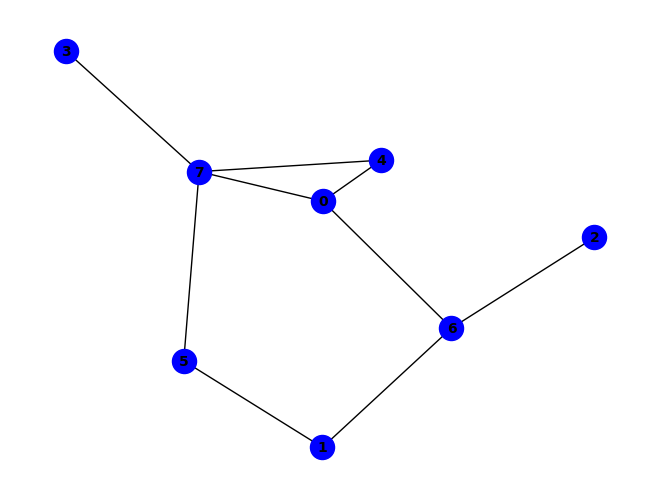


(a & b & g) ^ (~b & ~f) ^ (a & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & e & ~c & ~g) ^ (a & h & ~d & ~f) ^ (c & g & ~a & ~b) ^ (d & h & ~e & ~f) ^ (a & c & e & h & ~f) ^ (a & d & e & h & ~f) ^ (a & b & c & f & g & h) ^ (a & c & e & ~g & ~h) ^ (a & b & d & g & h & ~e) ^ (a & b & f & g & h & ~d) ^ (a & c & d & g & h & ~e) ^ (a & c & e & f & h & ~g) ^ (a & c & f & g & h & ~d) ^ (a & b & d & e & f & g & h) ^ (a & c & d & e & f & g & h) ^ (a & b & e & f & ~g & ~h) ^ (b & d & g & h & ~e & ~f) ^ (b & e & g & h & ~a & ~f) ^ (c & d & g & h & ~b & ~e) ^ (c & e & g & h & ~b & ~f) ^ (c & f & g & h & ~b & ~d) ^ (a & b & c & e & g & h & ~f) ^ (c & d & e & f & g & h & ~b) ^ (a & b & c & d & g & h & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


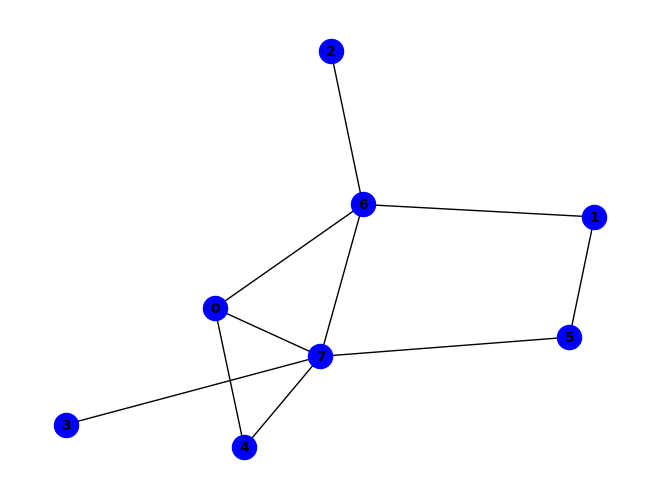


(~c & ~g) ^ (a & e & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (f & h & ~g) ^ (g & ~b & ~h) ^ (a & b & g & ~h) ^ (a & f & g & ~h) ^ (a & c & ~b & ~g) ^ (b & c & ~g & ~h) ^ (c & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & b & c & h & ~g) ^ (a & e & f & h & ~g) ^ (c & ~a & ~b & ~h) ^ (b & f & ~a & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


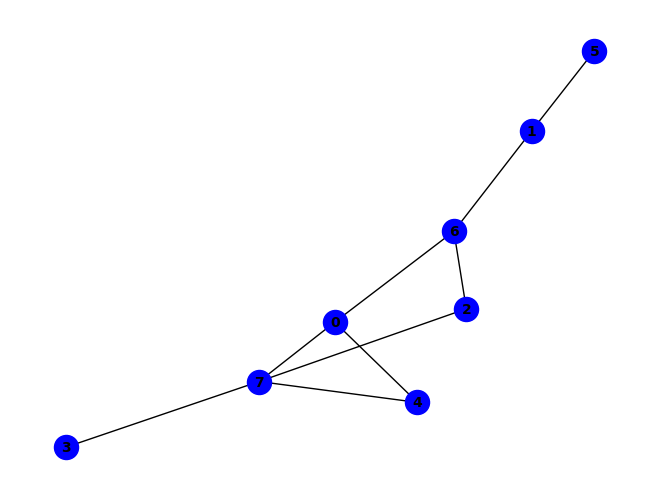


(~b & ~e) ^ (a & e & ~g) ^ (a & c & d & h) ^ (b & ~f & ~g) ^ (e & ~b & ~h) ^ (a & g & ~b & ~h) ^ (a & h & ~b & ~d) ^ (d & h & ~b & ~e) ^ (a & b & e & f & ~g) ^ (a & e & g & h & ~b) ^ (a & c & h & ~b & ~e) ^ (c & g & ~a & ~b & ~h) ^ (c & h & ~b & ~d & ~e) ^ (a & d & e & h & ~b & ~c) ^ (a & b & c & d & e & h & ~g) ^ (a & b & c & d & f & h & ~e) ^ (a & b & c & d & g & h & ~f) ^ (a & b & c & d & e & f & g & h) ^ (a & b & h & ~d & ~f & ~g) ^ (b & c & h & ~d & ~f & ~g) ^ (b & d & h & ~e & ~f & ~g) ^ (b & e & h & ~c & ~f & ~g) ^ (a & b & d & e & h & ~f & ~g) ^ (b & c & d & e & h & ~f & ~g) ^ (a & b & c & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


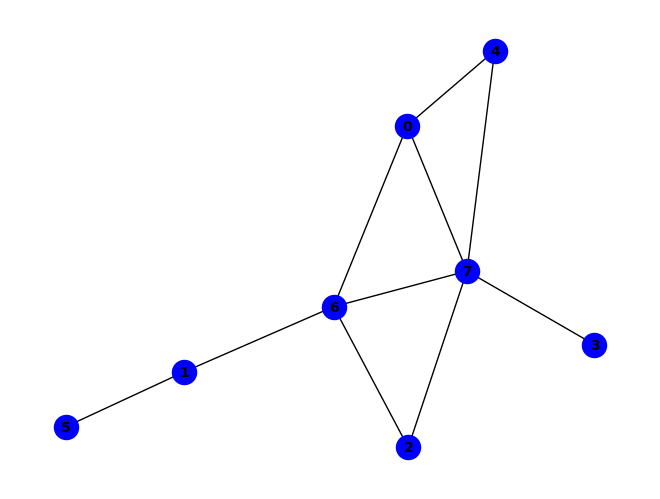


(~b & ~g) ^ (a & e & ~d) ^ (a & h & ~d) ^ (c & g & ~e) ^ (b & ~f & ~g) ^ (g & ~b & ~h) ^ (a & g & ~c & ~e) ^ (c & h & ~a & ~e) ^ (e & h & ~b & ~g) ^ (a & b & e & f & ~g) ^ (a & b & f & g & ~c) ^ (a & b & f & h & ~c) ^ (a & c & d & e & ~g) ^ (a & d & g & h & ~e) ^ (b & c & f & g & ~e) ^ (b & c & f & h & ~e) ^ (a & d & e & ~c & ~h) ^ (b & e & h & ~f & ~g) ^ (c & e & g & ~b & ~h) ^ (d & h & ~c & ~e & ~g) ^ (a & c & d & h & ~b & ~g) ^ (a & c & e & g & ~d & ~h) ^ (a & b & g & ~c & ~f & ~h) ^ (b & c & g & ~e & ~f & ~h) ^ (a & b & c & d & h & ~f & ~g) ^ (a & b & d & f & h & ~e & ~g) ^ (b & d & f & h & ~c & ~e & ~g) ^ (a & b & c & e & f & h & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


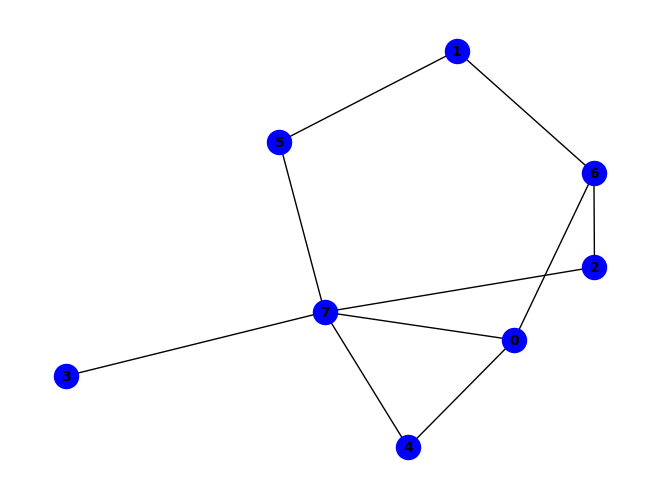


(a & b & g) ^ (~b & ~f) ^ (a & e & ~g) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (b & c & g & ~a) ^ (a & g & ~c & ~h) ^ (a & h & ~d & ~f) ^ (d & h & ~e & ~f) ^ (a & d & e & h & ~f) ^ (a & b & f & g & h & ~c) ^ (b & c & e & g & h & ~d) ^ (b & c & f & g & h & ~e) ^ (b & c & d & e & f & g & h) ^ (b & e & g & h & ~d & ~f) ^ (a & b & d & e & f & h & ~c) ^ (a & b & d & e & g & h & ~c) ^ (a & b & d & e & f & ~c & ~g) ^ (a & b & e & g & h & ~c & ~f) ^ (c & h & ~a & ~d & ~e & ~f) ^ (a & b & e & f & ~d & ~g & ~h) ^ (b & d & g & h & ~a & ~c & ~f) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


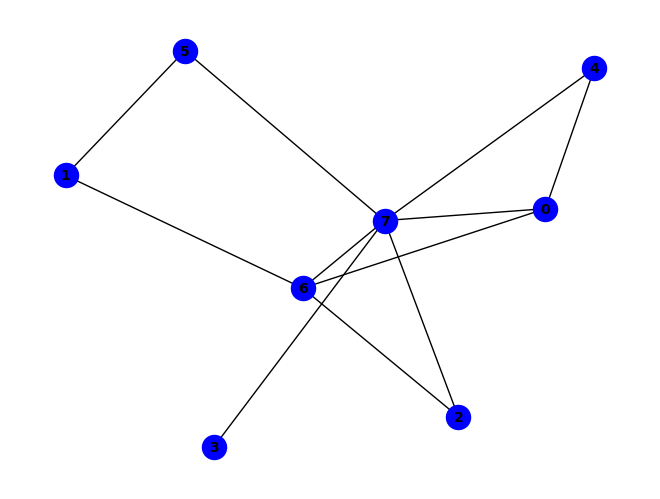


(g & ~h) ^ (~b & ~g) ^ (a & e & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & h & ~g) ^ (a & b & c & ~h) ^ (b & c & g & ~h) ^ (a & b & ~c & ~g) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & b & c & h & ~g) ^ (a & e & f & h & ~g) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (b & ~a & ~f & ~h) ^ (a & f & g & ~c & ~h) ^ (b & f & g & ~a & ~h) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (c & d & e & f & g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (c & d & h & ~a & ~f & ~g) ^ (d & h & ~a & ~e & ~f & ~g) ^ (a & c & e & h & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


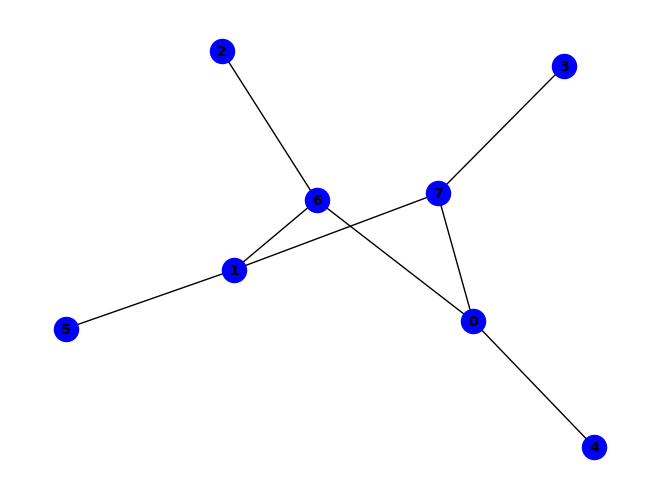


~d ^ (d & ~h) ^ (a & h & ~d) ^ (b & f & ~h) ^ (b & g & ~f) ^ (b & h & ~g) ^ (b & f & g & h) ^ (a & b & e & ~g) ^ (a & b & h & ~e) ^ (a & e & ~g & ~h) ^ (a & g & ~b & ~h) ^ (c & g & ~a & ~b) ^ (a & b & e & g & ~f) ^ (c & d & g & h & ~a) ^ (a & b & e & f & g & h) ^ (a & b & e & ~f & ~h) ^ (b & d & h & ~a & ~c) ^ (b & c & d & h & ~a & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


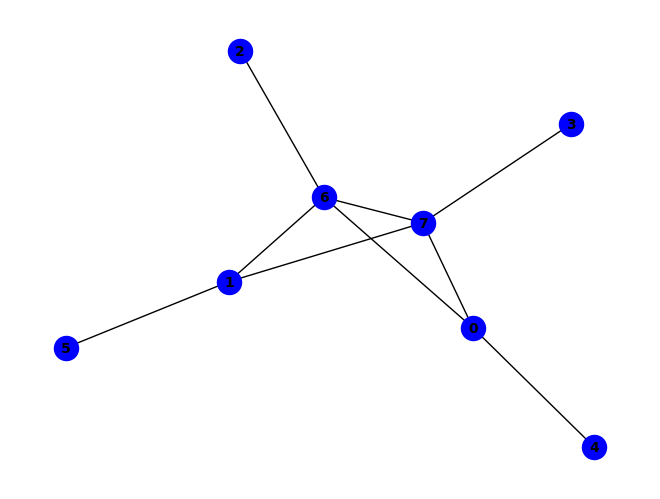


(g & ~h) ^ (a & b & f) ^ (~c & ~g) ^ (a & e & ~h) ^ (a & h & ~d) ^ (b & f & ~h) ^ (b & h & ~d) ^ (c & h & ~g) ^ (d & h & ~g) ^ (a & d & g & h) ^ (a & e & g & h) ^ (b & d & g & h) ^ (c & ~b & ~h) ^ (a & b & h & ~f) ^ (a & g & ~b & ~e) ^ (b & c & ~g & ~h) ^ (b & g & ~a & ~f) ^ (a & b & d & h & ~g) ^ (a & b & g & h & ~e) ^ (b & f & g & h & ~a) ^ (a & b & f & ~e & ~h) ^ (a & c & g & ~b & ~h) ^ (a & b & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


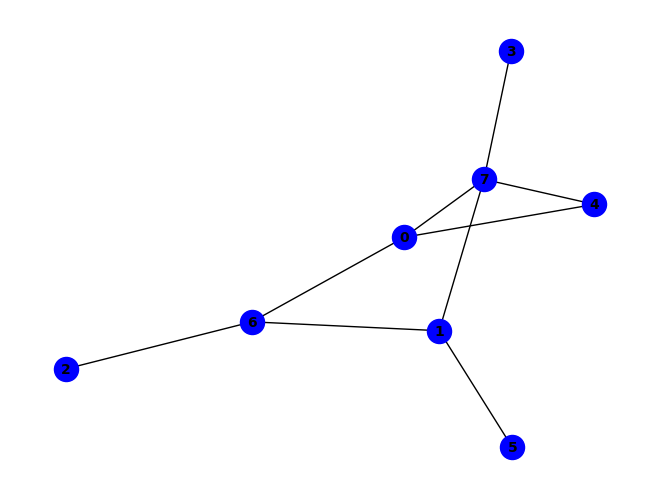


~e ^ (e & ~h) ^ (a & g & ~h) ^ (b & h & ~e) ^ (a & h & ~b & ~d) ^ (b & f & ~g & ~h) ^ (b & g & ~a & ~h) ^ (c & g & ~a & ~b) ^ (d & h & ~b & ~e) ^ (a & d & e & h & ~b) ^ (a & e & g & h & ~b) ^ (c & e & g & h & ~b) ^ (a & c & d & g & h & ~b) ^ (a & e & ~b & ~c & ~g) ^ (a & c & d & e & ~b & ~g) ^ (a & c & e & h & ~b & ~d) ^ (c & d & g & h & ~b & ~e) ^ (a & b & e & ~f & ~g & ~h) ^ (a & c & e & ~b & ~d & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


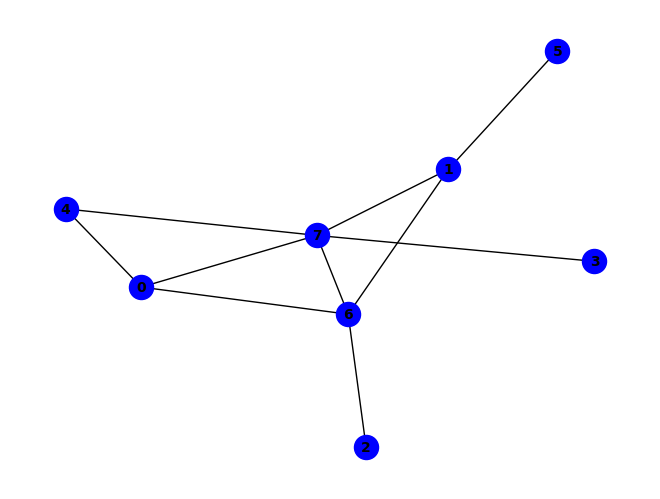


(g & ~h) ^ (~c & ~g) ^ (a & e & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (b & f & ~h) ^ (b & g & ~f) ^ (c & h & ~g) ^ (e & h & ~g) ^ (b & f & g & h) ^ (c & ~b & ~h) ^ (a & b & c & ~h) ^ (a & b & g & ~e) ^ (a & c & g & ~h) ^ (a & d & g & ~h) ^ (b & h & ~a & ~e) ^ (d & h & ~e & ~g) ^ (a & b & e & g & ~h) ^ (a & d & e & h & ~g) ^ (b & d & e & h & ~a) ^ (b & e & g & h & ~d) ^ (a & b & d & e & g & h) ^ (b & d & h & ~a & ~g) ^ (b & c & ~a & ~g & ~h) ^ (a & b & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


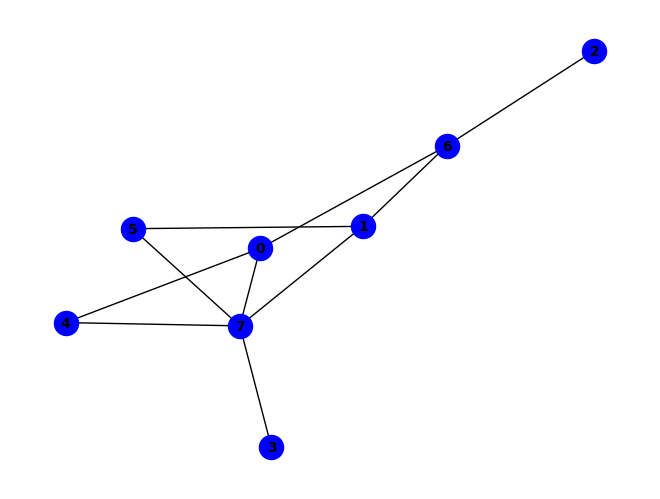


~f ^ (f & ~h) ^ (b & g & ~h) ^ (b & h & ~e) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & f & g & h) ^ (a & e & ~c & ~g) ^ (a & g & ~b & ~h) ^ (a & h & ~d & ~f) ^ (b & f & ~c & ~g) ^ (c & g & ~a & ~b) ^ (a & c & e & h & ~f) ^ (a & d & e & h & ~f) ^ (b & c & f & h & ~d) ^ (b & e & f & h & ~c) ^ (c & e & g & h & ~f) ^ (c & f & g & h & ~d) ^ (a & b & c & e & f & h) ^ (c & d & e & f & g & h) ^ (a & c & e & ~g & ~h) ^ (a & c & f & g & h & ~b) ^ (b & c & d & f & h & ~g) ^ (b & c & e & g & h & ~a) ^ (a & b & c & d & e & g & h) ^ (d & h & ~b & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (b & c & e & f & ~d & ~g) ^ (c & d & g & h & ~b & ~e) ^ (a & b & c & d & g & h & ~f) ^ (b & c & d & e & f & h & ~a) ^ (a & b & h & ~d & ~e & ~f) ^ (b & c & f & ~e & ~g & ~h) ^ (a & c & d & g & h & ~e & ~f) ^ (a & c & e & f & h & ~b & ~g) ^ (b & c & d & e & f & ~g & ~h) ^ (a & b & c & d & e & f & h & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

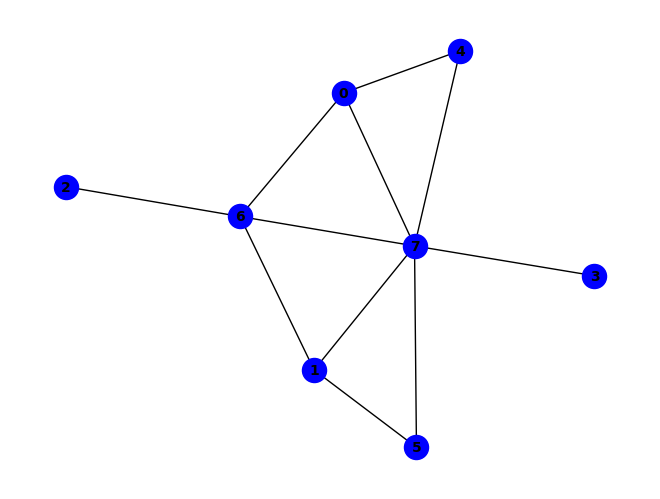


(g & ~h) ^ (~c & ~g) ^ (a & e & ~g) ^ (a & g & ~f) ^ (b & f & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (b & e & g & h) ^ (b & d & e & f & h) ^ (a & c & ~b & ~g) ^ (a & h & ~b & ~f) ^ (b & c & ~g & ~h) ^ (b & g & ~a & ~f) ^ (c & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & b & c & h & ~g) ^ (a & b & e & f & ~g) ^ (a & b & e & h & ~g) ^ (a & d & e & h & ~g) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (b & d & e & h & ~g) ^ (b & e & f & g & ~d) ^ (c & ~a & ~b & ~h) ^ (a & d & h & ~f & ~g) ^ (a & f & g & ~e & ~h) ^ (b & d & h & ~f & ~g) ^ (b & e & f & ~g & ~h) ^ (a & b & d & f & g & ~e) ^ (a & b & d & f & h & ~e) ^ (a & d & e & f & g & ~h) ^ (d & h & ~e & ~f & ~g) ^ (a & b & d & h & ~e & ~g) ^ (a & b & f & g & ~d & ~h) ^ (b & d & e & f & g & ~a & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


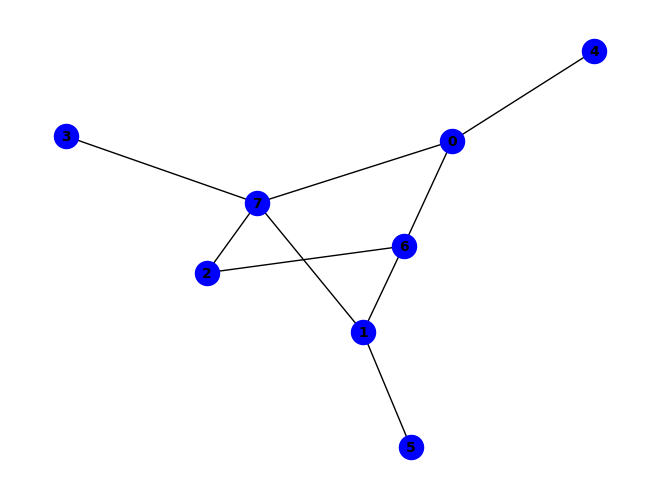


~d ^ (a & d & ~c) ^ (a & e & ~g) ^ (a & g & ~h) ^ (a & h & ~e) ^ (b & f & ~h) ^ (b & g & ~f) ^ (c & h & ~d) ^ (a & b & c & d) ^ (a & b & d & h) ^ (b & f & g & h) ^ (d & ~a & ~h) ^ (a & b & g & ~e) ^ (a & c & g & ~b) ^ (a & c & h & ~g) ^ (b & c & h & ~a) ^ (b & d & h & ~c) ^ (a & b & c & g & h) ^ (b & h & ~a & ~g) ^ (c & g & ~b & ~h) ^ (a & b & e & f & ~h) ^ (a & e & g & h & ~b) ^ (a & c & d & ~b & ~h) ^ (a & b & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


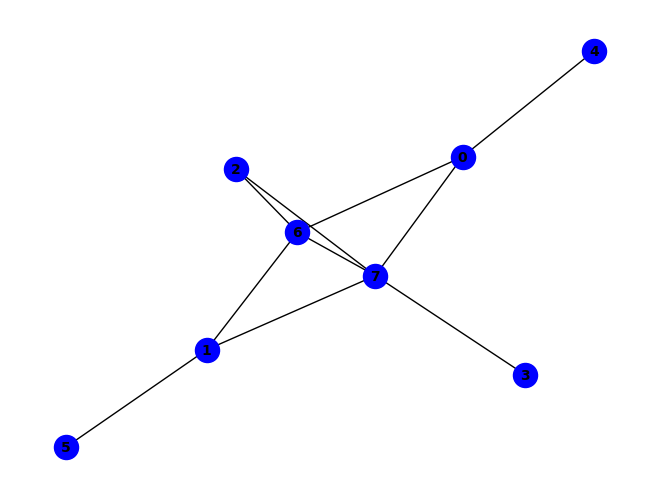


~g ^ (g & ~h) ^ (a & e & ~h) ^ (b & f & ~h) ^ (b & g & ~f) ^ (b & h & ~d) ^ (d & h & ~g) ^ (a & b & c & h) ^ (a & d & g & h) ^ (a & e & g & h) ^ (b & d & g & h) ^ (a & b & f & ~g) ^ (a & c & g & ~d) ^ (a & b & ~e & ~h) ^ (a & g & ~b & ~e) ^ (a & h & ~c & ~d) ^ (c & g & ~b & ~d) ^ (c & h & ~b & ~d) ^ (a & b & d & g & ~h) ^ (a & b & d & h & ~c) ^ (a & b & e & h & ~f) ^ (b & f & g & h & ~a) ^ (a & b & g & ~c & ~d) ^ (a & b & f & g & h & ~e) ^ (a & b & ~e & ~f & ~g) ^ (c & d & g & ~a & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


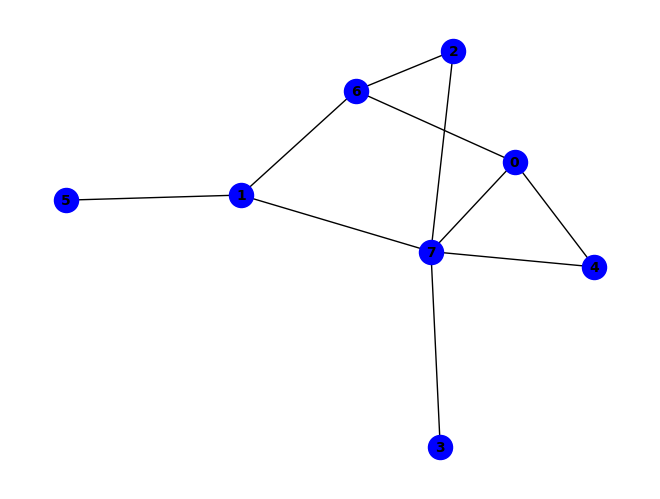


~e ^ (e & ~h) ^ (a & h & ~d) ^ (b & f & ~g) ^ (b & h & ~f) ^ (c & g & ~h) ^ (d & h & ~e) ^ (b & f & g & h) ^ (a & b & g & ~c) ^ (b & c & h & ~e) ^ (b & e & h & ~d) ^ (b & c & d & e & h) ^ (a & e & ~b & ~g) ^ (a & g & ~c & ~h) ^ (b & g & ~c & ~h) ^ (a & d & e & h & ~b) ^ (a & e & g & h & ~b) ^ (a & b & h & ~c & ~g) ^ (b & d & h & ~a & ~c) ^ (a & b & c & e & h & ~d) ^ (c & h & ~a & ~d & ~e) ^ (a & b & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


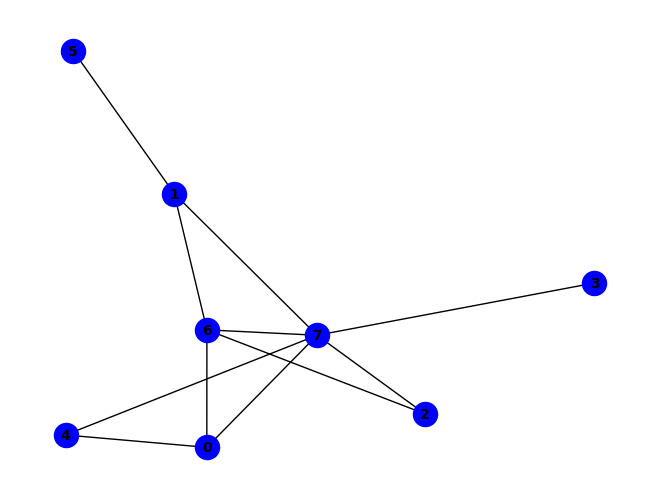


~g ^ (g & ~h) ^ (a & e & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (b & f & ~h) ^ (b & g & ~f) ^ (e & h & ~g) ^ (b & e & g & h) ^ (b & f & g & h) ^ (a & c & g & ~e) ^ (c & g & ~b & ~e) ^ (c & h & ~a & ~e) ^ (a & c & d & h & ~g) ^ (a & b & g & ~c & ~e) ^ (a & d & g & ~e & ~h) ^ (c & e & g & ~b & ~h) ^ (b & h & ~a & ~c & ~e) ^ (a & b & d & h & ~c & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & b & e & g & ~d & ~h) ^ (a & d & e & g & ~b & ~c) ^ (a & d & e & h & ~b & ~c) ^ (d & h & ~b & ~c & ~e & ~g) ^ (a & c & e & g & ~b & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


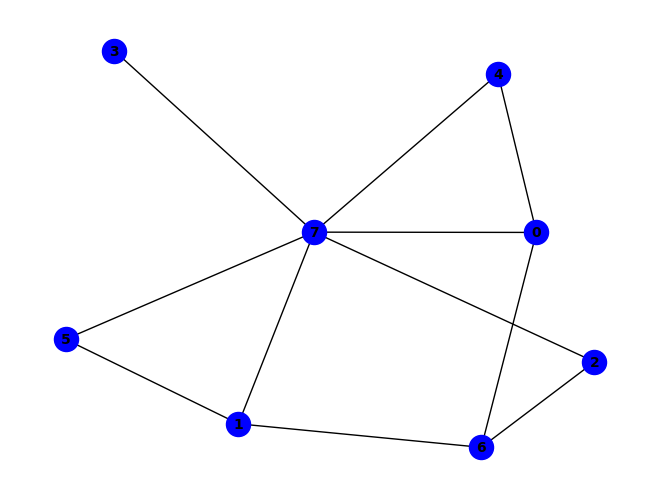


~f ^ (f & ~h) ^ (a & b & g) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & g & ~h) ^ (b & h & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & f & g & h) ^ (a & b & h & ~g) ^ (b & c & g & ~a) ^ (a & g & ~c & ~h) ^ (a & h & ~d & ~f) ^ (d & h & ~e & ~f) ^ (a & b & e & h & ~f) ^ (a & b & f & h & ~c) ^ (b & c & d & h & ~e) ^ (b & c & f & h & ~d) ^ (b & d & e & h & ~a) ^ (b & e & f & h & ~d) ^ (a & b & d & e & f & h) ^ (b & c & d & e & f & h) ^ (a & c & h & ~e & ~f) ^ (b & c & h & ~a & ~g) ^ (b & d & h & ~a & ~f) ^ (c & h & ~d & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & c & d & h & ~b & ~f) ^ (a & d & e & h & ~c & ~f) ^ (b & c & e & h & ~a & ~f) ^ (a & b & c & d & e & h & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


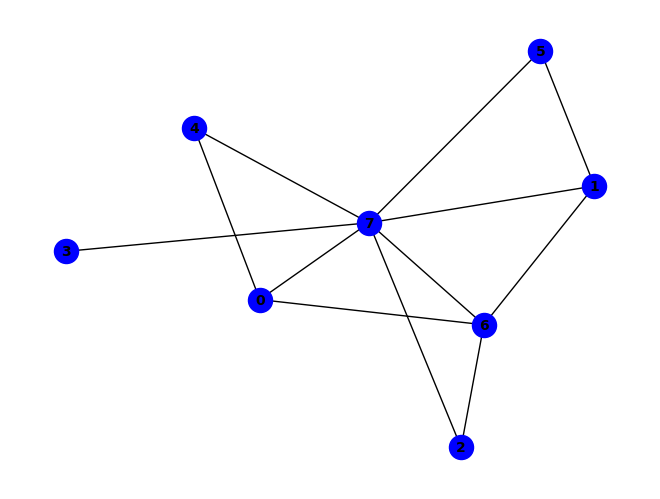


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (b & e & f & ~h) ^ (a & g & ~b & ~f) ^ (b & g & ~c & ~f) ^ (c & g & ~a & ~f) ^ (c & h & ~b & ~f) ^ (e & h & ~f & ~g) ^ (a & b & c & g & ~f) ^ (a & b & e & f & ~g) ^ (a & e & f & h & ~g) ^ (b & e & g & h & ~f) ^ (c & e & f & g & ~d) ^ (c & e & f & h & ~d) ^ (a & f & g & ~c & ~h) ^ (c & e & h & ~d & ~g) ^ (c & f & g & ~e & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & d & f & g & ~e) ^ (a & b & d & f & h & ~e) ^ (b & c & d & f & g & ~e) ^ (b & c & d & f & h & ~e) ^ (a & h & ~b & ~c & ~f) ^ (a & b & d & h & ~e & ~g) ^ (a & b & e & h & ~c & ~g) ^ (a & b & f & g & ~d & ~h) ^ (b & c & d & h & ~e & ~g) ^ (b & c & e & h & ~f & ~g) ^ (b & c & f & g & ~d & ~h) ^ (a & b & c & d & e & h & ~g) ^ (a & b & d & e & f & g & ~h) ^ (a & d & h & ~e & ~f & ~g) ^ (c & d & h & ~a & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (c & d & e & f & g & ~b & ~h) ^ (d & h & ~b & ~e & ~f & ~g) ^ (a & c & e & h & ~d & ~f & ~g) ^ (a & b & c & e & f 

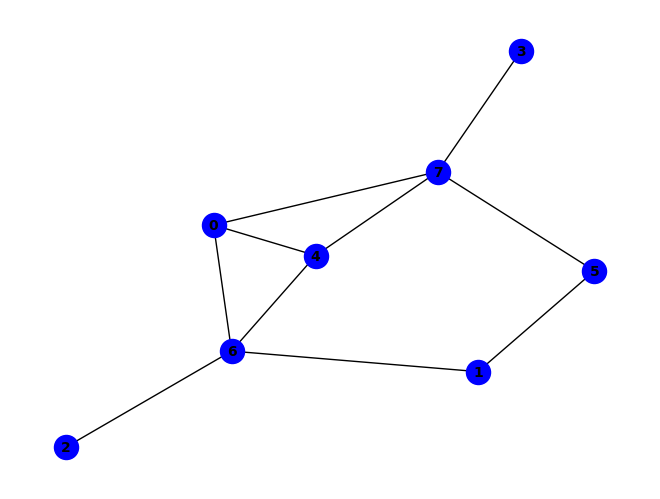


(b & e & g) ^ (~b & ~f) ^ (a & h & ~g) ^ (e & g & ~h) ^ (e & h & ~f) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & f & h & ~c) ^ (a & b & c & e & g) ^ (b & e & f & g & h) ^ (a & e & ~b & ~f) ^ (a & g & ~b & ~c) ^ (c & g & ~b & ~e) ^ (a & b & e & f & ~h) ^ (a & c & e & g & ~f) ^ (a & c & f & h & ~g) ^ (a & b & e & ~f & ~g) ^ (a & e & f & ~c & ~h) ^ (a & b & f & g & h & ~c) ^ (a & b & c & e & f & g & h) ^ (d & h & ~a & ~e & ~f) ^ (c & d & g & h & ~e & ~f) ^ (c & f & g & h & ~b & ~e) ^ (a & c & d & e & f & h & ~b) ^ (a & c & d & e & g & h & ~b) ^ (a & b & d & g & h & ~e & ~f) ^ (a & c & d & e & f & ~b & ~g) ^ (a & c & d & g & h & ~b & ~f) ^ (a & c & e & f & ~d & ~g & ~h) ^ (b & d & g & h & ~c & ~e & ~f) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


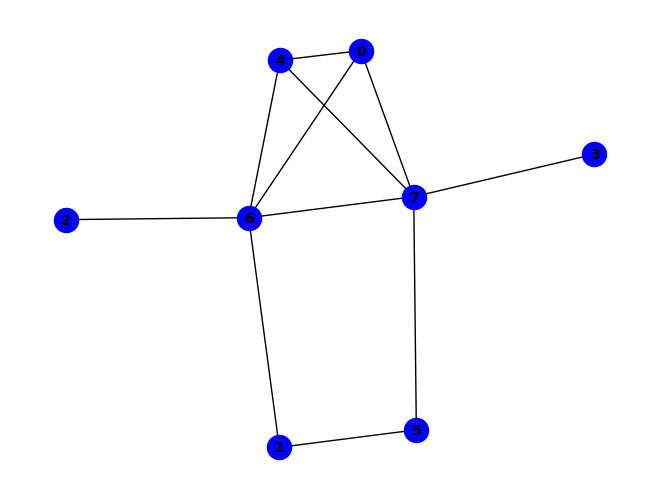


(~c & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (c & h & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & h & ~g) ^ (d & e & f & g) ^ (d & e & f & h) ^ (c & ~e & ~h) ^ (g & ~b & ~h) ^ (a & e & g & ~h) ^ (b & c & e & ~h) ^ (b & c & g & ~h) ^ (b & e & g & ~h) ^ (a & e & ~c & ~g) ^ (b & f & ~g & ~h) ^ (a & c & e & h & ~g) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (a & b & g & ~e & ~h) ^ (a & c & e & ~b & ~h) ^ (a & c & g & ~b & ~h) ^ (a & f & g & ~e & ~h) ^ (d & e & h & ~a & ~g) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (c & e & ~b & ~g & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & b & c & e & ~g & ~h) ^ (a & b & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


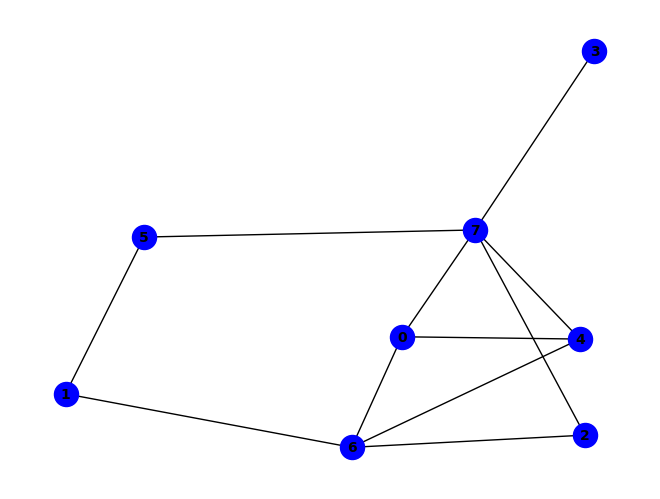


(b & e & g) ^ (~b & ~f) ^ (e & g & ~h) ^ (e & h & ~f) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & g & ~c) ^ (b & c & g & ~e) ^ (a & b & c & e & g) ^ (a & e & ~b & ~f) ^ (a & g & ~c & ~h) ^ (c & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (a & b & e & f & ~h) ^ (a & c & e & f & ~d) ^ (a & c & e & g & ~h) ^ (a & c & e & h & ~d) ^ (a & d & e & h & ~f) ^ (a & b & e & ~f & ~g) ^ (a & e & f & ~c & ~h) ^ (a & b & f & g & h & ~c) ^ (a & c & d & e & f & ~h) ^ (b & c & f & g & h & ~e) ^ (b & d & e & g & h & ~c) ^ (b & e & f & g & h & ~d) ^ (a & b & c & d & e & g & h) ^ (b & c & d & e & f & g & h) ^ (a & h & ~c & ~d & ~f) ^ (c & h & ~d & ~e & ~f) ^ (b & d & g & h & ~c & ~f) ^ (a & b & c & d & g & h & ~f) ^ (a & b & d & g & h & ~e & ~f) ^ (a & b & c & e & f & g & h & ~d)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


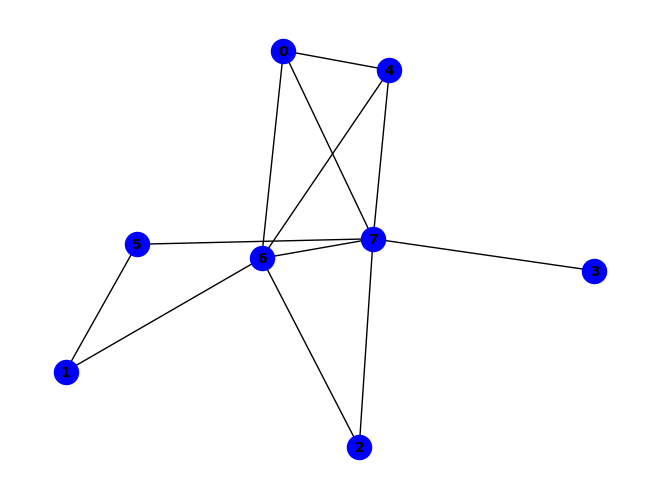


(g & ~h) ^ (~b & ~g) ^ (a & e & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (b & h & ~g) ^ (f & h & ~g) ^ (b & ~f & ~h) ^ (a & e & g & ~h) ^ (b & e & g & ~h) ^ (b & f & g & ~h) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & c & e & g & ~f) ^ (a & c & e & h & ~f) ^ (a & d & f & g & ~e) ^ (a & d & f & h & ~e) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & c & d & e & f & g) ^ (a & c & d & e & f & h) ^ (a & b & g & ~d & ~h) ^ (a & d & h & ~e & ~g) ^ (a & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (e & f & g & ~d & ~h) ^ (a & c & d & e & h & ~g) ^ (c & d & e & f & g & ~h) ^ (d & h & ~c & ~f & ~g) ^ (a & b & d & g & ~e & ~h) ^ (a & b & e & f & ~d & ~h) ^ (a & c & d & h & ~f & ~g) ^ (b & c & g & ~a & ~e & ~h) ^ (c & f & g & ~a & ~e & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (a & d & e & f & g & ~c & ~h) ^ (a & b & e & g & ~d & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

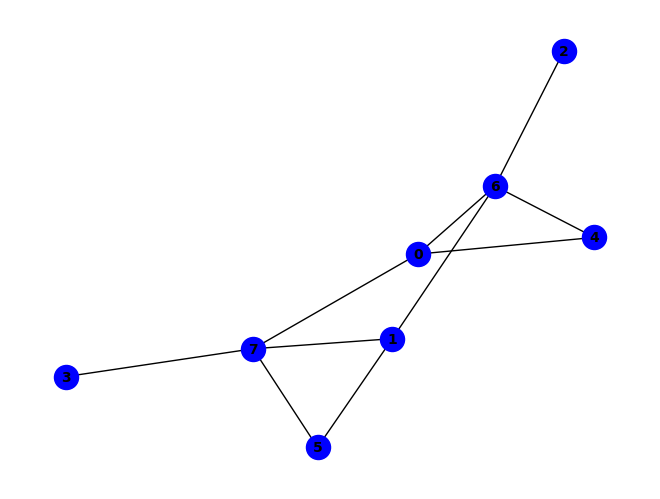


~f ^ (a & f & ~e) ^ (a & h & ~g) ^ (b & f & ~e) ^ (b & g & ~f) ^ (b & h & ~g) ^ (e & g & ~b) ^ (f & ~a & ~h) ^ (a & b & g & ~h) ^ (a & d & h & ~f) ^ (a & c & e & f & g) ^ (b & d & e & f & g) ^ (a & e & ~g & ~h) ^ (a & g & ~c & ~e) ^ (c & g & ~b & ~e) ^ (d & h & ~b & ~f) ^ (a & b & c & g & ~e) ^ (a & b & e & f & ~h) ^ (a & b & e & g & ~f) ^ (b & f & g & h & ~c) ^ (c & f & g & h & ~e) ^ (e & f & g & h & ~d) ^ (c & d & e & f & g & h) ^ (a & b & h & ~d & ~f) ^ (a & e & f & ~c & ~h) ^ (b & e & f & ~d & ~h) ^ (a & b & c & e & f & ~g) ^ (a & c & f & g & h & ~b) ^ (a & d & e & f & h & ~c) ^ (a & d & e & g & h & ~c) ^ (a & b & c & d & e & g & h) ^ (a & e & f & h & ~d & ~g) ^ (b & e & f & h & ~c & ~g) ^ (d & e & g & h & ~b & ~c) ^ (a & b & d & e & g & h & ~f) ^ (a & c & d & e & f & h & ~g) ^ (b & c & d & e & f & ~a & ~g) ^ (b & c & e & f & h & ~a & ~d) ^ (a & c & e & f & ~b & ~g & ~h) ^ (b & d & e & f & ~c & ~g & ~h) ^ (c & d & g & h & ~a & ~b & ~f) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS

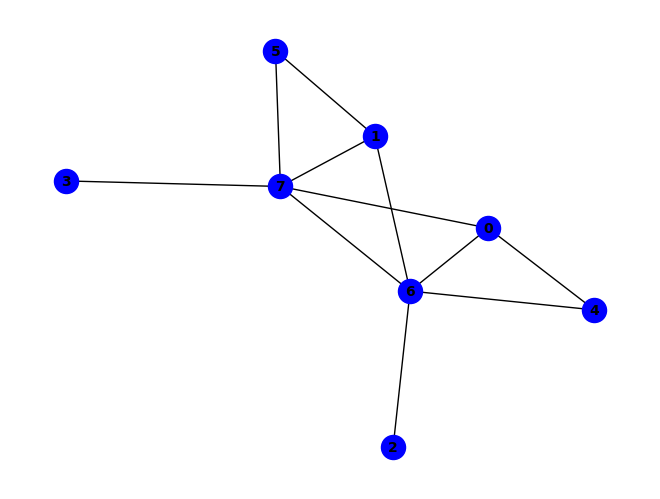


(~e & ~g) ^ (b & f & ~g) ^ (b & g & ~d) ^ (b & h & ~d) ^ (e & h & ~g) ^ (f & h & ~g) ^ (g & ~c & ~h) ^ (b & c & g & ~h) ^ (b & d & g & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (b & d & f & h & ~g) ^ (e & ~a & ~c & ~h) ^ (a & c & g & ~b & ~h) ^ (a & f & g & ~b & ~h) ^ (c & e & ~a & ~g & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & b & d & h & ~f & ~g) ^ (a & b & e & f & ~g & ~h) ^ (b & e & g & ~a & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


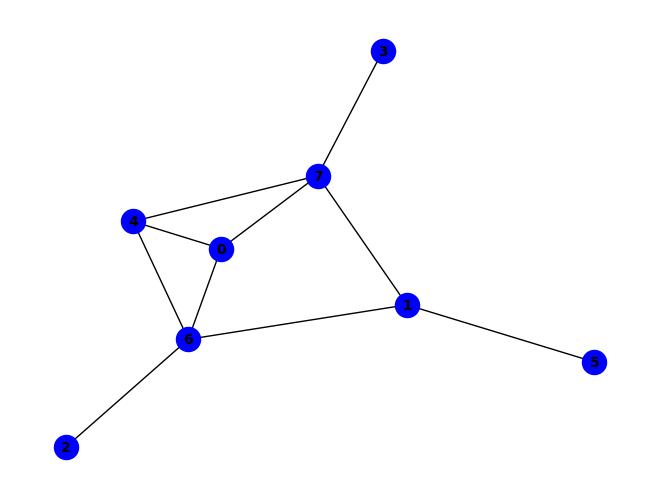


~d ^ (d & ~h) ^ (b & e & h) ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & f & ~h) ^ (b & g & ~f) ^ (b & h & ~g) ^ (e & h & ~d) ^ (b & f & g & h) ^ (a & b & h & ~e) ^ (b & d & h & ~e) ^ (a & g & ~b & ~h) ^ (e & g & ~b & ~h) ^ (a & b & d & e & ~c) ^ (a & b & d & h & ~c) ^ (a & b & e & f & ~h) ^ (a & d & e & ~b & ~h) ^ (a & b & c & d & e & ~g) ^ (a & b & c & d & h & ~g) ^ (a & c & d & g & h & ~e) ^ (c & g & ~a & ~b & ~e) ^ (a & b & e & g & ~f & ~h) ^ (c & d & g & h & ~b & ~e) ^ (a & b & c & d & e & g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


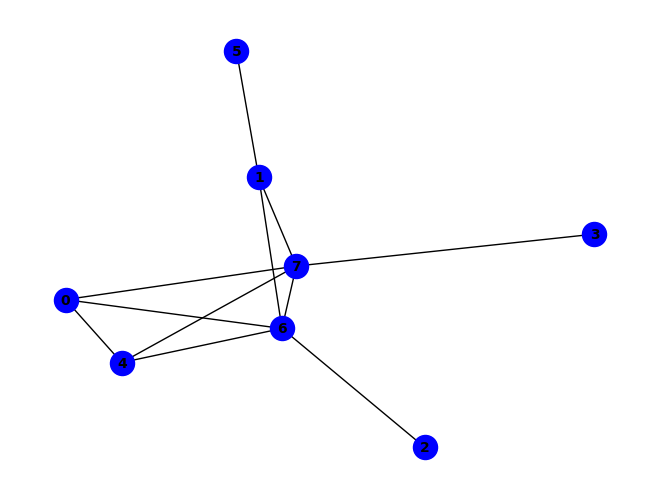


(g & ~h) ^ (~c & ~g) ^ (a & h & ~d) ^ (b & f & ~h) ^ (b & g & ~f) ^ (c & h & ~g) ^ (e & h & ~d) ^ (b & d & e & h) ^ (b & f & g & h) ^ (c & ~e & ~h) ^ (a & c & e & ~h) ^ (a & c & g & ~h) ^ (a & e & g & ~h) ^ (a & e & ~c & ~g) ^ (a & g & ~b & ~d) ^ (b & h & ~a & ~e) ^ (d & h & ~b & ~g) ^ (e & g & ~b & ~d) ^ (a & b & d & h & ~e) ^ (a & b & e & f & ~h) ^ (a & c & e & h & ~g) ^ (a & d & e & h & ~g) ^ (a & d & g & ~b & ~h) ^ (b & c & e & ~a & ~h) ^ (b & c & g & ~a & ~h) ^ (d & e & g & ~b & ~h) ^ (a & b & e & g & h & ~d) ^ (c & e & ~b & ~g & ~h) ^ (a & b & c & e & ~g & ~h) ^ (a & b & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


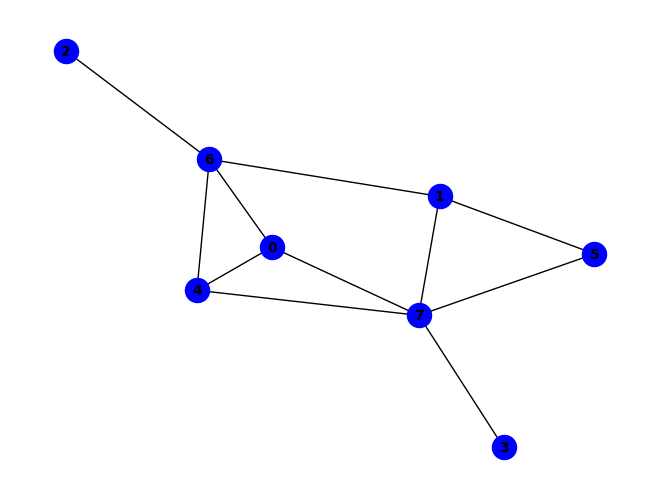


~f ^ (a & f & ~d) ^ (a & g & ~h) ^ (a & h & ~d) ^ (e & g & ~h) ^ (e & h & ~f) ^ (b & e & f & h) ^ (b & f & g & h) ^ (f & ~a & ~h) ^ (a & d & f & ~h) ^ (a & e & f & ~h) ^ (a & e & ~b & ~f) ^ (b & f & ~c & ~g) ^ (b & h & ~a & ~e) ^ (a & b & e & h & ~f) ^ (a & b & f & h & ~e) ^ (a & d & e & h & ~f) ^ (b & c & f & h & ~e) ^ (a & b & e & ~g & ~h) ^ (b & c & f & ~g & ~h) ^ (b & g & ~a & ~e & ~h) ^ (c & g & ~a & ~b & ~e) ^ (d & h & ~b & ~e & ~f) ^ (a & b & d & h & ~e & ~f) ^ (a & b & e & g & ~f & ~h) ^ (c & f & g & h & ~a & ~e) ^ (a & b & c & f & g & h & ~e) ^ (b & c & d & e & f & h & ~a) ^ (b & c & d & e & g & h & ~a) ^ (b & c & d & g & h & ~a & ~f) ^ (b & c & e & f & h & ~d & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (c & d & g & h & ~a & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


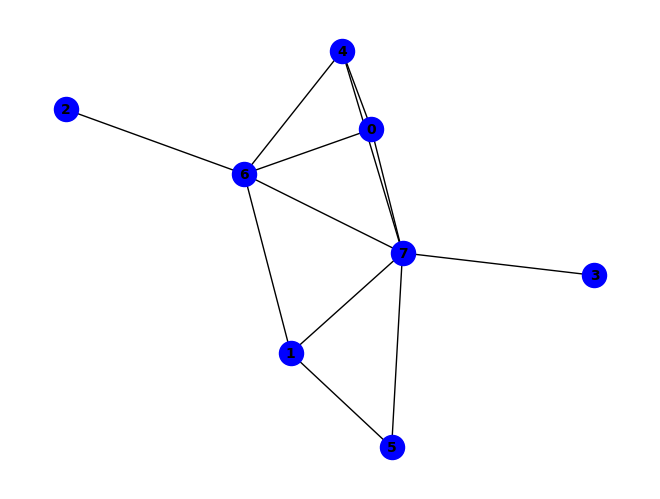


(g & ~h) ^ (~c & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & h & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & h & ~g) ^ (c & ~e & ~h) ^ (a & e & g & ~h) ^ (b & c & e & ~h) ^ (b & c & g & ~h) ^ (a & e & ~c & ~g) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (a & b & e & f & ~g) ^ (a & b & e & g & ~d) ^ (a & b & e & h & ~d) ^ (a & b & f & g & ~h) ^ (a & c & e & h & ~g) ^ (a & d & e & h & ~g) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (a & b & d & e & f & g) ^ (a & b & d & e & f & h) ^ (a & c & e & ~b & ~h) ^ (a & c & g & ~b & ~h) ^ (a & f & g & ~e & ~h) ^ (d & e & h & ~b & ~g) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (b & d & e & f & g & ~h) ^ (c & e & ~b & ~g & ~h) ^ (a & b & c & e & ~g & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (d & h & ~a & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

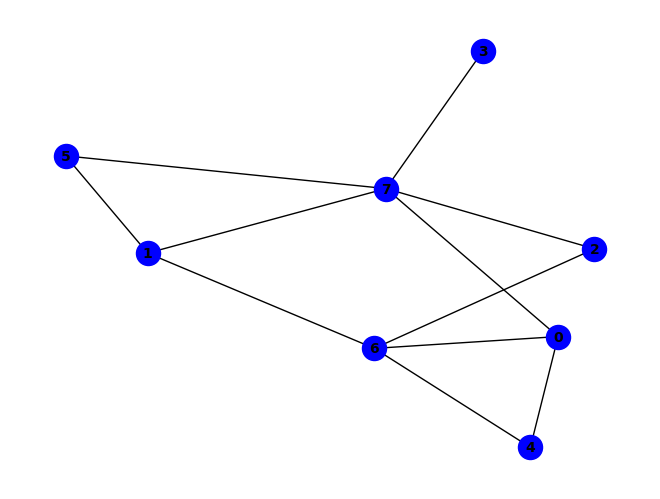


~f ^ (a & f & ~e) ^ (a & h & ~d) ^ (b & f & ~e) ^ (b & g & ~f) ^ (b & h & ~g) ^ (b & f & g & h) ^ (f & ~a & ~h) ^ (a & b & g & ~h) ^ (a & e & g & ~c) ^ (a & b & c & e & g) ^ (b & c & e & f & g) ^ (a & e & ~f & ~h) ^ (a & g & ~e & ~h) ^ (d & h & ~b & ~f) ^ (e & g & ~b & ~c) ^ (a & b & e & g & ~f) ^ (a & d & f & h & ~e) ^ (b & e & f & h & ~g) ^ (a & b & d & e & f & g) ^ (b & c & d & e & g & h) ^ (a & c & h & ~d & ~f) ^ (b & e & f & ~c & ~h) ^ (b & d & e & g & h & ~f) ^ (a & b & c & e & f & g & h) ^ (c & g & ~a & ~b & ~h) ^ (c & h & ~b & ~d & ~f) ^ (a & b & e & f & ~d & ~h) ^ (a & e & f & h & ~d & ~g) ^ (d & e & g & h & ~a & ~c) ^ (e & f & g & h & ~c & ~d) ^ (a & b & d & e & g & h & ~c) ^ (a & c & e & f & g & h & ~d) ^ (b & c & d & e & f & h & ~a) ^ (a & b & h & ~c & ~d & ~f) ^ (b & c & d & e & f & ~a & ~g) ^ (b & c & e & f & ~d & ~g & ~h) ^ (a & b & d & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

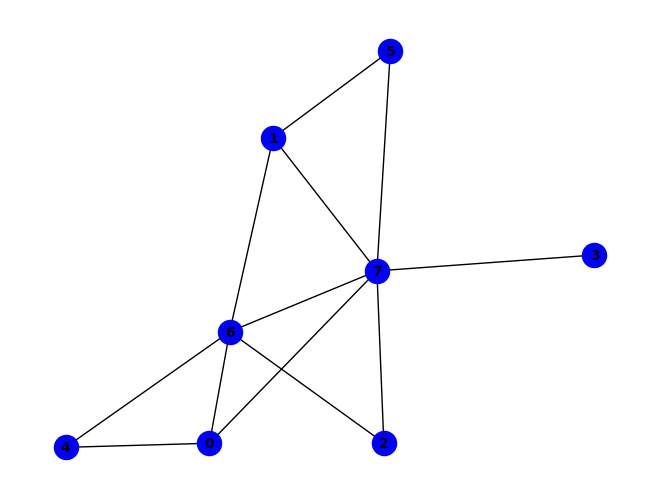


(g & ~h) ^ (~e & ~g) ^ (b & f & ~g) ^ (b & g & ~d) ^ (b & h & ~d) ^ (e & h & ~g) ^ (f & h & ~g) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (a & b & e & f & ~h) ^ (b & d & f & g & ~c) ^ (b & d & f & h & ~c) ^ (c & d & f & g & ~a) ^ (c & d & f & h & ~a) ^ (e & ~a & ~c & ~h) ^ (b & d & g & ~f & ~h) ^ (b & e & g & ~c & ~h) ^ (a & b & c & e & g & ~h) ^ (a & c & d & f & g & ~h) ^ (a & g & ~b & ~c & ~f) ^ (a & h & ~b & ~c & ~f) ^ (c & e & ~a & ~g & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & b & d & h & ~f & ~g) ^ (a & b & e & g & ~f & ~h) ^ (a & b & c & d & f & h & ~g) ^ (a & f & g & ~b & ~c & ~h) ^ (c & d & h & ~a & ~b & ~g) ^ (c & f & g & ~b & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


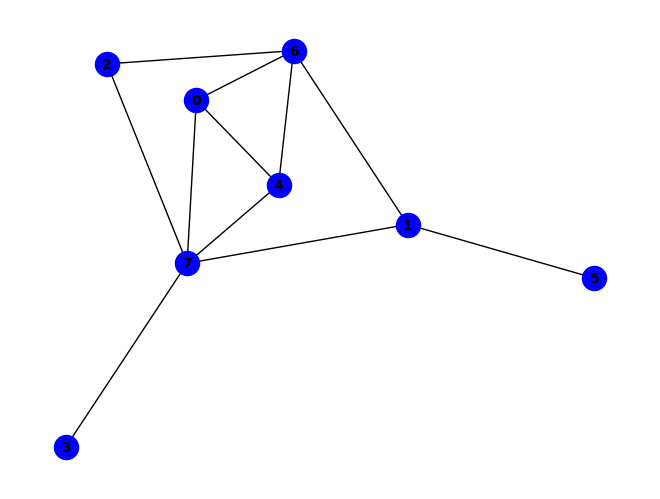


~d ^ (d & ~h) ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & f & ~h) ^ (b & g & ~f) ^ (b & f & g & h) ^ (a & d & e & ~h) ^ (b & c & g & ~e) ^ (b & d & h & ~c) ^ (b & c & d & e & h) ^ (a & g & ~c & ~h) ^ (b & h & ~c & ~g) ^ (c & g & ~e & ~h) ^ (e & g & ~b & ~h) ^ (e & h & ~b & ~d) ^ (a & c & e & g & ~h) ^ (b & c & e & h & ~g) ^ (a & b & g & ~c & ~e) ^ (c & h & ~a & ~d & ~e) ^ (a & b & d & h & ~c & ~e) ^ (a & b & e & f & ~g & ~h) ^ (a & b & h & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


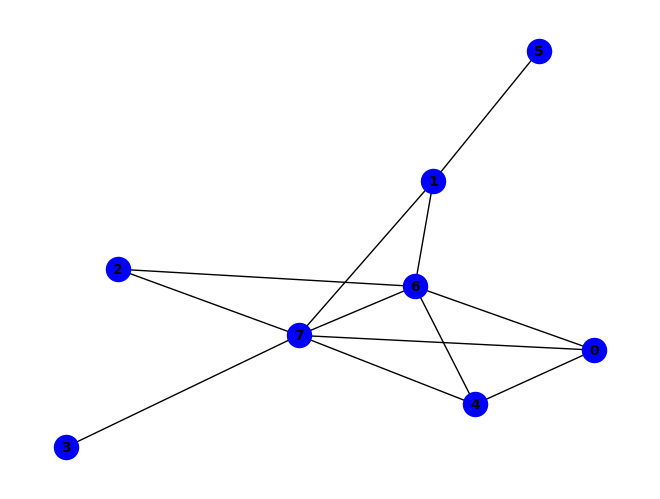


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~h) ^ (b & g & ~f) ^ (e & h & ~d) ^ (a & b & e & f) ^ (b & f & g & h) ^ (a & e & g & ~h) ^ (a & b & e & g & h) ^ (a & g & ~b & ~d) ^ (a & h & ~b & ~d) ^ (b & h & ~c & ~e) ^ (c & g & ~b & ~e) ^ (c & h & ~a & ~e) ^ (e & g & ~b & ~d) ^ (a & b & c & g & ~e) ^ (a & b & c & h & ~e) ^ (a & b & d & g & ~h) ^ (a & b & e & h & ~f) ^ (a & c & d & h & ~e) ^ (b & d & e & h & ~c) ^ (c & d & e & h & ~g) ^ (b & c & d & e & g & h) ^ (a & c & g & ~d & ~e) ^ (a & d & g & ~c & ~h) ^ (d & e & g & ~b & ~h) ^ (a & c & d & e & g & ~h) ^ (d & h & ~b & ~c & ~g) ^ (a & b & e & g & ~f & ~h) ^ (a & d & e & h & ~b & ~g) ^ (a & b & c & d & h & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


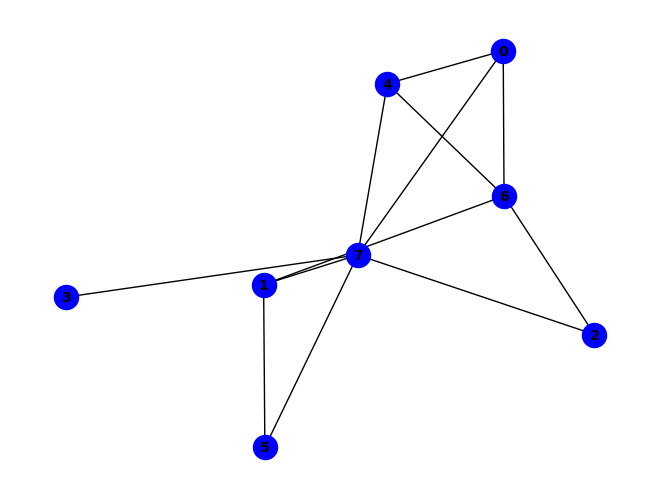


~f ^ (f & ~h) ^ (b & f & ~g) ^ (e & g & ~h) ^ (e & h & ~f) ^ (b & f & g & h) ^ (a & e & ~b & ~f) ^ (a & g & ~c & ~h) ^ (b & h & ~a & ~e) ^ (c & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (a & b & e & h & ~f) ^ (a & b & f & h & ~e) ^ (a & c & e & f & ~d) ^ (a & c & e & g & ~h) ^ (a & c & e & h & ~d) ^ (a & d & e & h & ~f) ^ (b & d & e & h & ~c) ^ (b & e & f & h & ~d) ^ (b & c & d & e & f & h) ^ (a & b & e & ~g & ~h) ^ (a & e & f & ~c & ~h) ^ (b & c & g & ~a & ~e) ^ (b & d & h & ~c & ~f) ^ (a & c & d & e & f & ~h) ^ (a & h & ~c & ~d & ~f) ^ (b & g & ~a & ~e & ~h) ^ (c & h & ~d & ~e & ~f) ^ (a & b & e & g & ~f & ~h) ^ (b & c & f & h & ~a & ~e) ^ (b & c & h & ~a & ~e & ~g) ^ (a & b & d & h & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


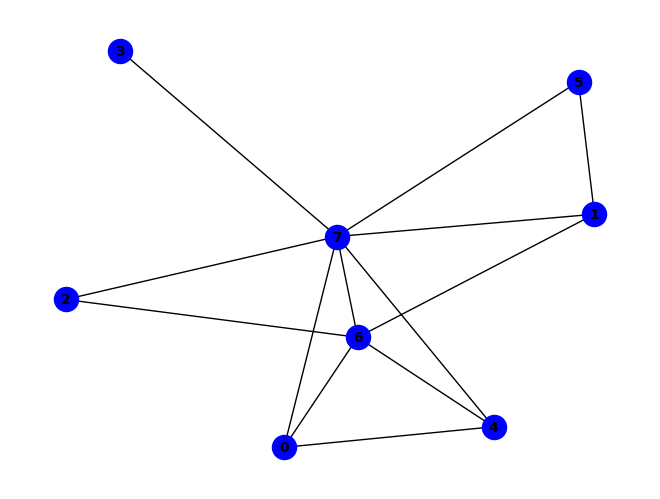


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & b & e & f & ~g) ^ (a & b & e & g & ~d) ^ (a & b & e & h & ~d) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (b & c & e & g & ~f) ^ (b & c & e & h & ~f) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (a & g & ~b & ~c & ~f) ^ (a & h & ~b & ~c & ~f) ^ (a & b & f & g & ~c & ~h) ^ (a & c & e & g & ~b & ~f) ^ (a & c & e & h & ~b & ~f) ^ (a & b & c & d & e & h & ~g) ^ (a & b & d & e & f & g & ~c) ^ (a & b & d & e & f & h & ~c) ^ (a & c & d & e & f & h & ~g) ^ (a & f & g & ~c & ~e & ~h) ^ (c & f & g & ~b & ~e & ~h) ^ (d & e & h & ~a & ~c & ~g) ^ (a & b & d & e & g & ~f & ~h) ^ (d & h & ~a & ~c & ~f & ~g) ^ (a & b & d & h & ~c & ~f & ~g) ^ (a & b & c & e & f & g & ~d & ~h) ^ (b & d & h & ~c & ~e & ~f

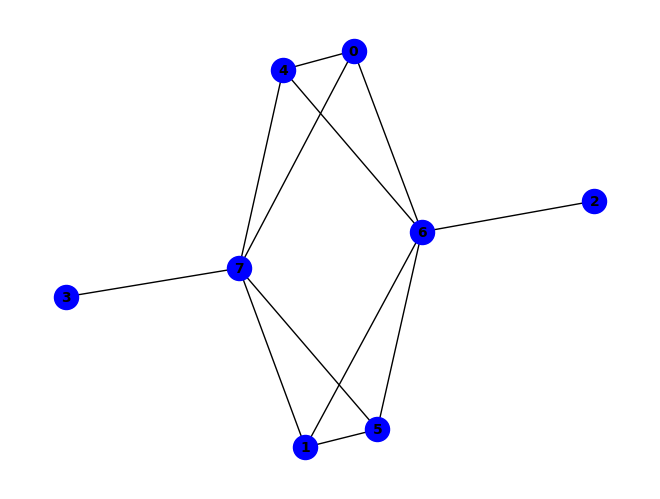


~e ^ (a & e & ~d) ^ (b & f & ~e) ^ (b & h & ~e) ^ (f & h & ~e) ^ (a & b & e & h) ^ (a & e & f & g) ^ (e & ~g & ~h) ^ (a & g & ~f & ~h) ^ (a & h & ~d & ~f) ^ (b & g & ~e & ~h) ^ (f & g & ~e & ~h) ^ (a & b & d & e & ~c) ^ (a & b & d & h & ~f) ^ (a & b & e & f & ~d) ^ (a & b & e & g & ~h) ^ (a & e & f & h & ~g) ^ (a & c & d & e & g & h) ^ (a & b & g & ~c & ~f) ^ (a & b & h & ~f & ~g) ^ (a & c & g & ~e & ~f) ^ (a & d & e & ~b & ~h) ^ (b & e & f & ~g & ~h) ^ (a & b & c & e & g & ~f) ^ (a & b & d & e & f & ~h) ^ (a & d & e & f & h & ~c) ^ (a & b & c & d & e & f & h) ^ (c & g & ~b & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & b & c & d & e & g & ~h) ^ (a & c & d & e & f & h & ~g) ^ (a & b & c & d & e & ~f & ~g) ^ (a & c & d & g & h & ~b & ~f) ^ (c & d & g & h & ~b & ~e & ~f) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

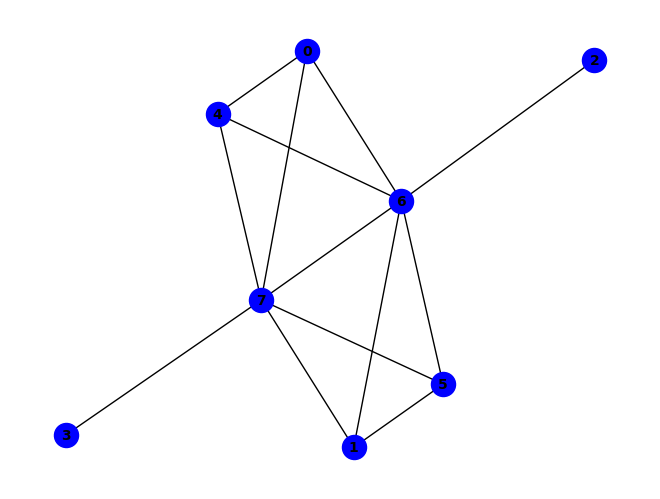


(g & ~h) ^ (~c & ~g) ^ (c & h & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~d) ^ (f & h & ~d) ^ (c & ~f & ~h) ^ (b & f & g & ~h) ^ (a & g & ~e & ~f) ^ (a & h & ~e & ~f) ^ (b & f & ~c & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & f & ~g & ~h) ^ (d & h & ~e & ~g) ^ (a & b & f & g & ~e) ^ (a & b & f & h & ~e) ^ (a & d & e & h & ~g) ^ (b & c & f & h & ~g) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (d & e & f & g & ~a) ^ (d & e & f & h & ~a) ^ (b & c & f & ~e & ~h) ^ (b & c & g & ~e & ~h) ^ (b & d & h & ~f & ~g) ^ (c & e & g & ~f & ~h) ^ (d & f & g & ~e & ~h) ^ (a & d & e & f & g & ~h) ^ (b & d & e & f & g & ~h) ^ (a & e & ~b & ~g & ~h) ^ (b & c & e & f & ~g & ~h) ^ (b & d & e & h & ~a & ~g) ^ (a & b & d & e & f & h & ~g) ^ (a & b & e & ~f & ~g & ~h) ^ (a & d & h & ~b & ~f & ~g) ^ (a & c & g & ~b & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

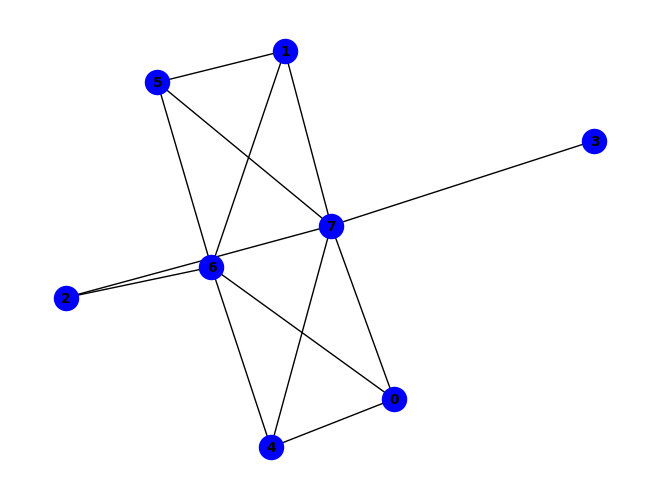


~e ^ (a & e & ~d) ^ (b & f & ~e) ^ (b & h & ~e) ^ (f & h & ~e) ^ (a & e & f & g) ^ (e & ~g & ~h) ^ (a & b & g & ~f) ^ (a & c & d & e & h) ^ (b & g & ~e & ~h) ^ (f & g & ~e & ~h) ^ (a & b & d & e & ~c) ^ (a & b & e & f & ~d) ^ (a & b & e & h & ~c) ^ (a & c & e & g & ~f) ^ (a & e & f & h & ~g) ^ (b & c & e & h & ~f) ^ (a & b & c & d & e & f) ^ (a & b & c & e & f & h) ^ (a & d & e & ~b & ~h) ^ (b & c & g & ~a & ~f) ^ (b & c & h & ~f & ~g) ^ (b & e & f & ~g & ~h) ^ (a & b & d & e & f & ~h) ^ (a & d & e & f & h & ~c) ^ (a & g & ~c & ~f & ~h) ^ (a & h & ~c & ~d & ~f) ^ (c & g & ~e & ~f & ~h) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & b & d & h & ~c & ~f) ^ (a & b & e & g & ~c & ~h) ^ (a & c & e & h & ~f & ~g) ^ (b & c & d & h & ~e & ~f) ^ (b & c & e & g & ~f & ~h) ^ (a & b & c & e & f & g & ~h) ^ (a & b & h & ~c & ~f & ~g) ^ (a & b & c & d & e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

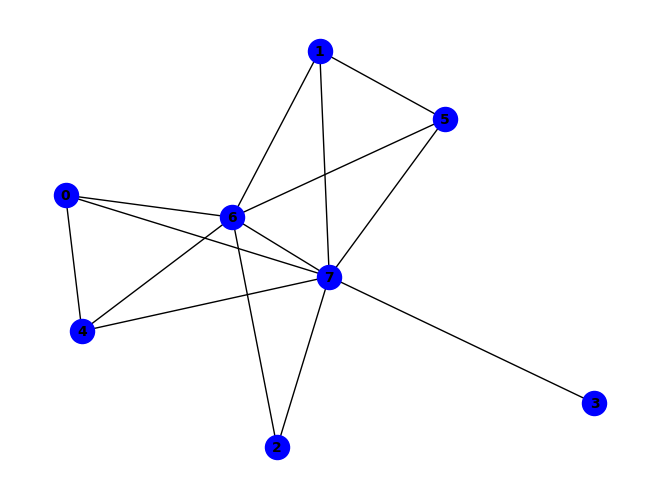


~g ^ (g & ~h) ^ (b & f & ~g) ^ (f & g & ~d) ^ (f & h & ~d) ^ (b & e & f & h) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & b & f & g & ~e) ^ (a & b & f & h & ~e) ^ (b & c & e & g & ~f) ^ (b & c & e & h & ~f) ^ (b & d & f & g & ~c) ^ (b & e & f & g & ~d) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & f & g & ~d & ~h) ^ (d & f & g & ~e & ~h) ^ (b & c & d & f & g & ~h) ^ (b & d & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (b & c & d & e & f & g & h) ^ (a & e & ~b & ~g & ~h) ^ (a & g & ~c & ~e & ~f) ^ (a & h & ~c & ~e & ~f) ^ (d & h & ~b & ~e & ~g) ^ (a & b & c & g & ~e & ~f) ^ (a & b & c & h & ~e & ~f) ^ (b & c & d & h & ~a & ~g) ^ (b & d & f & h & ~c & ~e) ^ (c & d & e & h & ~b & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & e & ~f & ~g & ~h) ^ (c & d & h & ~a & ~f & ~g) ^ (a & c & d & e & h & ~f & ~g) ^ (a & b & c & d & f & h & ~e & ~g) ^ (a & d & h & ~b & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PAS

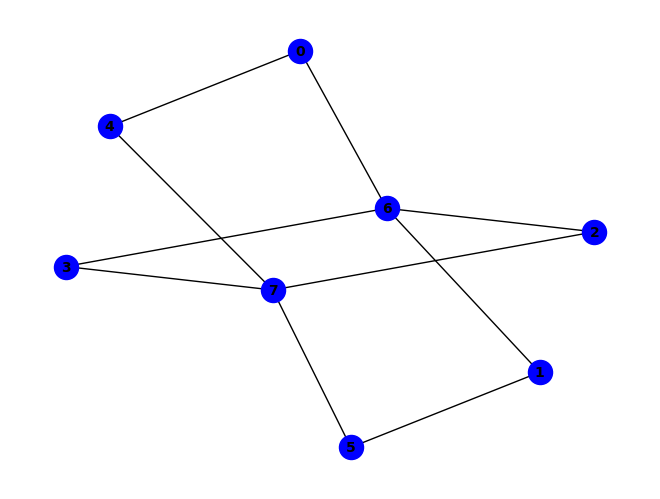


(a & d & g) ^ (~b & ~f) ^ (a & e & ~h) ^ (a & g & ~e) ^ (c & g & ~h) ^ (e & h & ~f) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & g & ~d) ^ (a & c & g & ~d) ^ (b & c & g & ~a) ^ (b & d & g & ~c) ^ (a & b & c & d & g) ^ (a & b & e & f & g) ^ (d & g & ~c & ~h) ^ (d & h & ~e & ~f) ^ (a & b & e & f & ~h) ^ (a & b & e & g & h & ~d) ^ (a & b & f & g & h & ~d) ^ (a & c & f & g & h & ~d) ^ (a & d & e & g & h & ~c) ^ (b & d & e & g & h & ~c) ^ (b & d & f & g & h & ~e) ^ (a & b & d & e & f & g & h) ^ (a & c & d & e & f & g & h) ^ (b & c & d & e & f & g & h) ^ (c & h & ~d & ~e & ~f) ^ (a & f & g & h & ~d & ~e) ^ (b & e & g & h & ~c & ~f) ^ (a & c & e & g & h & ~b & ~f) ^ (b & c & f & g & h & ~a & ~d) ^ (a & b & c & d & e & g & h & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


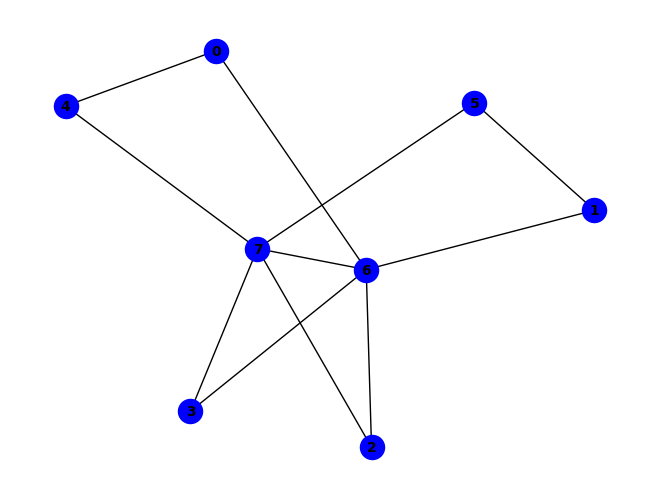


(~b & ~g) ^ (b & h & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (f & h & ~g) ^ (b & ~f & ~h) ^ (g & ~a & ~h) ^ (b & f & g & ~h) ^ (a & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & b & e & g & ~h) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & f & ~e & ~h) ^ (a & b & f & ~g & ~h) ^ (a & c & g & ~d & ~h) ^ (a & d & g & ~b & ~h) ^ (b & c & g & ~a & ~h) ^ (b & d & g & ~c & ~h) ^ (c & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (d & f & g & ~e & ~h) ^ (a & b & c & d & g & ~h) ^ (c & d & e & f & g & ~h) ^ (e & h & ~c & ~f & ~g) ^ (a & b & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


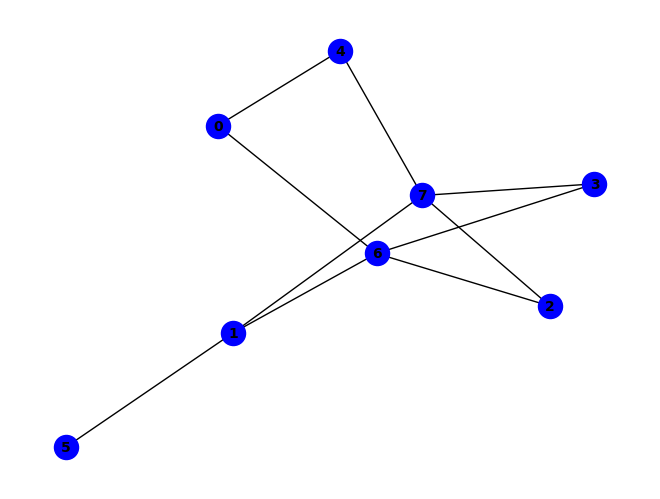


(~a & ~e) ^ (b & g & ~f) ^ (d & h & ~e) ^ (b & f & g & h) ^ (a & ~e & ~g) ^ (e & ~a & ~h) ^ (a & d & g & ~b) ^ (b & c & h & ~e) ^ (b & d & g & ~c) ^ (b & e & h & ~d) ^ (b & f & ~a & ~h) ^ (b & h & ~d & ~g) ^ (c & g & ~b & ~h) ^ (c & h & ~d & ~e) ^ (d & g & ~c & ~h) ^ (a & b & f & g & ~e) ^ (b & c & d & h & ~g) ^ (a & b & c & e & g & h) ^ (a & b & f & ~e & ~h) ^ (a & b & g & ~f & ~h) ^ (a & c & g & ~b & ~d) ^ (a & c & e & g & h & ~d) ^ (a & d & e & g & h & ~b) ^ (b & c & d & e & h & ~a) ^ (a & b & g & h & ~e & ~f) ^ (a & b & c & d & e & h & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


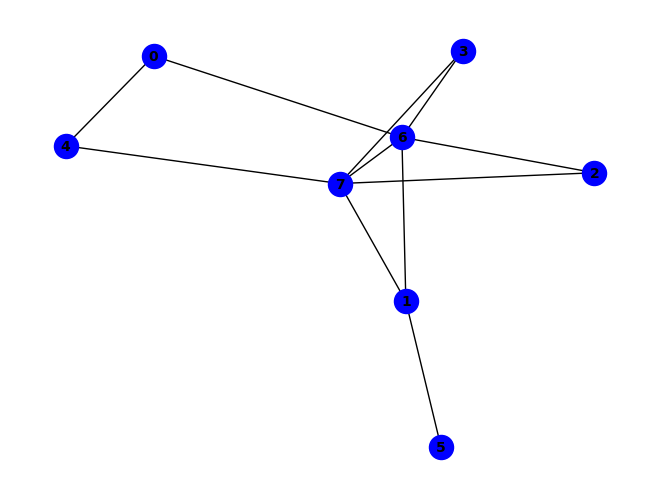


(g & ~h) ^ (~a & ~g) ^ (a & h & ~g) ^ (b & f & ~a) ^ (b & g & ~f) ^ (b & h & ~f) ^ (a & b & f & g) ^ (b & f & g & h) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (e & h & ~b & ~g) ^ (a & b & f & h & ~g) ^ (a & ~b & ~e & ~h) ^ (a & d & g & ~b & ~h) ^ (a & e & g & ~b & ~h) ^ (d & e & g & ~b & ~h) ^ (c & g & ~b & ~d & ~e) ^ (c & h & ~b & ~d & ~e) ^ (a & c & g & ~b & ~d & ~h) ^ (c & e & g & ~b & ~d & ~h) ^ (a & b & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


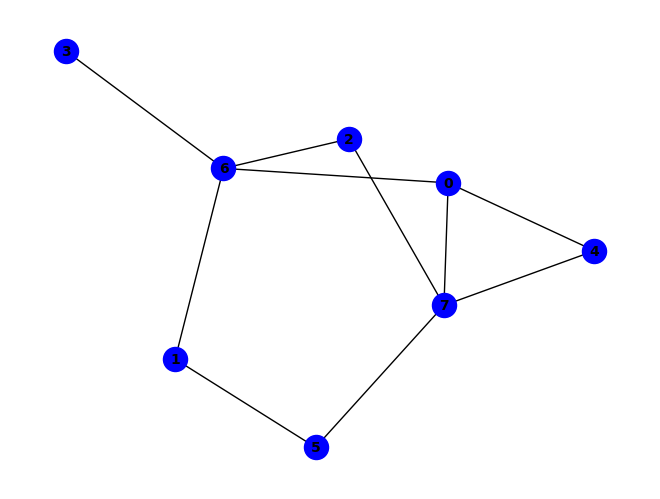


(~b & ~f) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & g & ~d) ^ (a & d & g & ~c) ^ (b & c & g & ~a) ^ (a & b & c & d & g) ^ (b & d & f & g & h) ^ (a & e & ~d & ~g) ^ (a & g & ~c & ~h) ^ (a & h & ~c & ~f) ^ (c & h & ~e & ~f) ^ (d & g & ~b & ~c) ^ (a & c & e & h & ~f) ^ (a & d & e & h & ~f) ^ (d & e & g & h & ~c) ^ (a & c & d & e & f & h) ^ (a & c & d & e & g & h) ^ (a & b & f & g & h & ~d) ^ (a & d & f & g & h & ~c) ^ (a & d & e & f & ~c & ~g) ^ (d & f & g & h & ~c & ~e) ^ (a & b & c & e & f & h & ~d) ^ (a & b & c & e & g & h & ~d) ^ (a & d & e & ~f & ~g & ~h) ^ (a & b & c & e & f & ~d & ~g) ^ (a & b & e & g & h & ~d & ~f) ^ (b & c & f & g & h & ~a & ~d) ^ (a & b & e & f & ~c & ~g & ~h) ^ (b & e & g & h & ~c & ~d & ~f) ^ (a & c & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

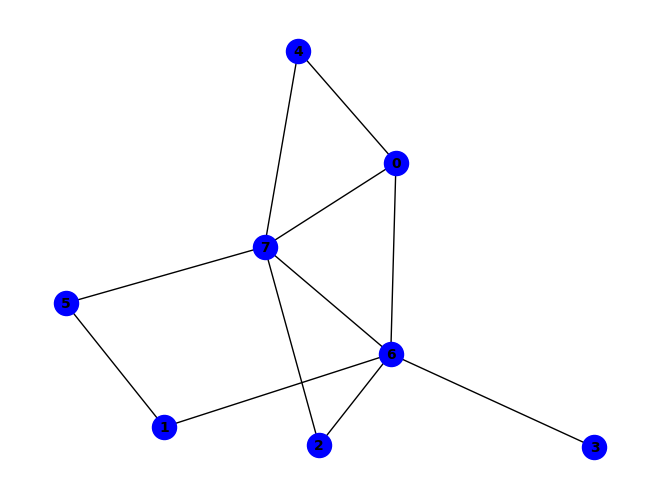


(~d & ~g) ^ (a & e & ~g) ^ (c & g & ~f) ^ (c & h & ~f) ^ (d & h & ~g) ^ (f & h & ~g) ^ (c & e & f & g) ^ (c & e & f & h) ^ (d & ~c & ~h) ^ (g & ~b & ~h) ^ (b & d & g & ~h) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (c & d & ~g & ~h) ^ (e & h & ~f & ~g) ^ (a & e & f & g & ~c) ^ (a & e & f & h & ~c) ^ (a & d & g & ~c & ~h) ^ (b & c & g & ~d & ~h) ^ (c & e & h & ~a & ~g) ^ (c & f & g & ~e & ~h) ^ (b & f & ~a & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & b & g & ~c & ~d & ~h) ^ (a & f & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


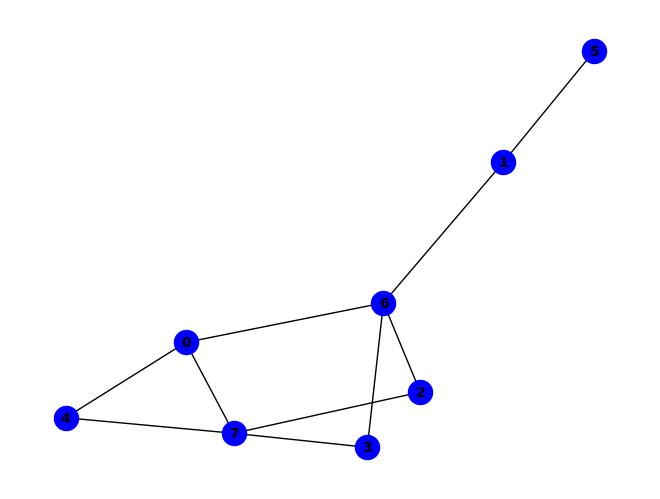


(~b & ~e) ^ (a & e & ~g) ^ (a & c & d & h) ^ (b & ~f & ~g) ^ (e & ~b & ~h) ^ (a & h & ~b & ~d) ^ (d & h & ~b & ~e) ^ (a & b & e & f & ~g) ^ (a & e & g & h & ~b) ^ (a & c & h & ~b & ~e) ^ (a & g & ~b & ~d & ~h) ^ (c & g & ~a & ~b & ~h) ^ (c & h & ~b & ~d & ~e) ^ (d & g & ~b & ~c & ~h) ^ (a & c & d & g & ~b & ~h) ^ (a & d & e & h & ~b & ~c) ^ (a & b & c & d & e & h & ~g) ^ (a & b & c & d & f & h & ~e) ^ (a & b & c & d & g & h & ~f) ^ (a & b & c & d & e & f & g & h) ^ (a & b & h & ~d & ~f & ~g) ^ (b & c & h & ~d & ~f & ~g) ^ (b & d & h & ~e & ~f & ~g) ^ (b & e & h & ~c & ~f & ~g) ^ (a & b & d & e & h & ~f & ~g) ^ (b & c & d & e & h & ~f & ~g) ^ (a & b & c & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


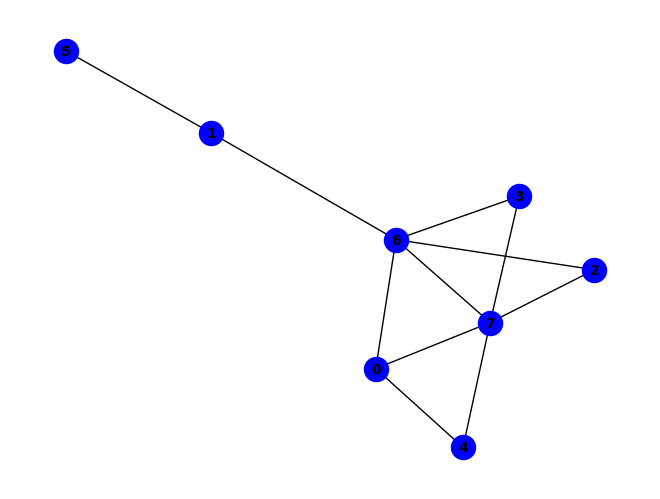


(~b & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (d & g & ~e) ^ (d & h & ~e) ^ (b & d & f & g) ^ (b & d & f & h) ^ (b & ~f & ~g) ^ (g & ~b & ~h) ^ (d & e & g & ~h) ^ (a & e & ~b & ~g) ^ (e & h & ~b & ~g) ^ (a & b & f & g & ~d) ^ (b & c & f & h & ~d) ^ (a & b & e & ~f & ~g) ^ (c & g & ~a & ~d & ~e) ^ (c & h & ~a & ~d & ~e) ^ (a & b & f & h & ~c & ~d) ^ (a & d & e & h & ~b & ~g) ^ (b & c & e & h & ~a & ~g) ^ (b & c & f & g & ~a & ~d) ^ (b & d & e & g & ~c & ~f) ^ (b & d & e & h & ~c & ~f) ^ (b & d & e & h & ~c & ~g) ^ (a & b & c & d & e & h & ~g) ^ (b & c & g & ~d & ~f & ~h) ^ (b & d & g & ~e & ~f & ~h) ^ (b & e & h & ~c & ~f & ~g) ^ (c & e & g & ~a & ~d & ~h) ^ (a & b & d & e & h & ~f & ~g) ^ (b & c & d & e & g & ~f & ~h) ^ (a & b & g & ~c & ~d & ~f & ~h) ^ (a & b & c & e & h & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

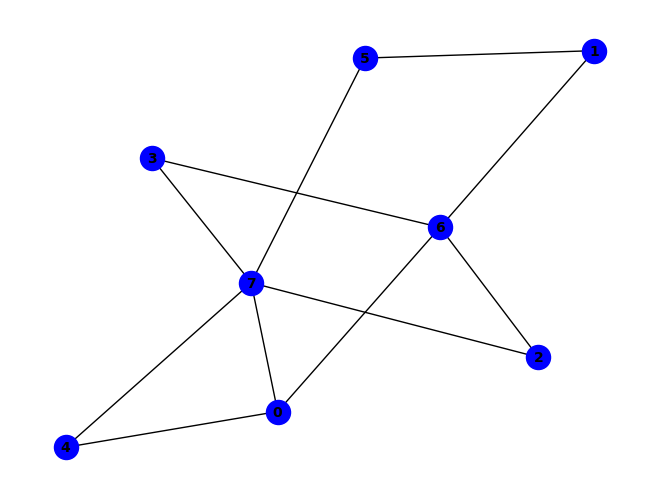


(~b & ~f) ^ (a & e & ~g) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & g & ~d) ^ (b & c & g & ~a) ^ (b & d & g & ~c) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~f) ^ (c & g & ~a & ~h) ^ (d & g & ~c & ~h) ^ (d & h & ~e & ~f) ^ (a & c & d & g & ~b) ^ (a & c & d & h & ~g) ^ (a & d & e & h & ~f) ^ (a & c & h & ~e & ~f) ^ (a & c & d & e & h & ~b) ^ (a & c & d & f & h & ~e) ^ (b & c & f & g & h & ~d) ^ (b & d & e & g & h & ~c) ^ (b & d & f & g & h & ~e) ^ (c & h & ~d & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (b & e & g & h & ~c & ~f) ^ (a & b & c & d & e & h & ~g) ^ (a & b & c & e & g & h & ~f) ^ (a & b & e & g & h & ~d & ~f) ^ (a & b & f & g & h & ~c & ~d) ^ (b & c & d & e & f & g & h & ~a)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


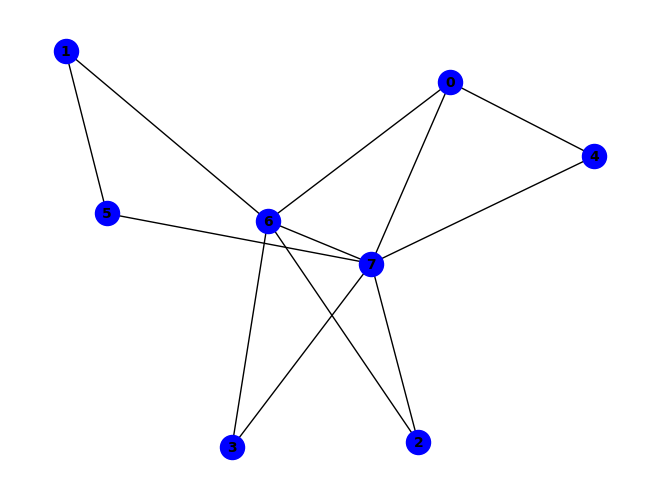


(g & ~h) ^ (~b & ~g) ^ (a & e & ~g) ^ (b & h & ~g) ^ (f & h & ~g) ^ (b & ~f & ~h) ^ (b & f & g & ~h) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (c & g & ~a & ~f) ^ (c & h & ~a & ~f) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & c & d & g & ~f) ^ (a & c & d & h & ~f) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & g & ~d & ~h) ^ (a & f & g & ~d & ~h) ^ (b & c & g & ~a & ~h) ^ (b & d & g & ~c & ~h) ^ (c & f & g & ~d & ~h) ^ (d & e & h & ~c & ~g) ^ (d & f & g & ~e & ~h) ^ (a & b & c & d & g & ~h) ^ (a & c & e & f & g & ~d) ^ (a & c & e & f & h & ~d) ^ (c & d & e & f & g & ~h) ^ (e & h & ~c & ~f & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & h & ~d & ~g) ^ (a & d & e & h & ~f & ~g) ^ (a & c & f & g & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


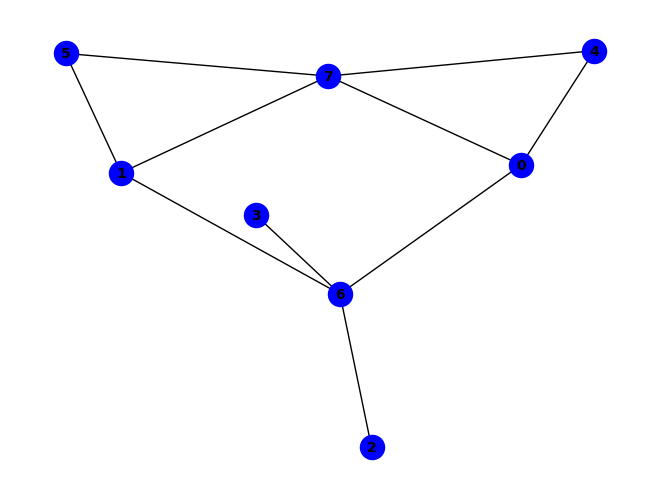


~f ^ (f & ~h) ^ (b & g & ~h) ^ (b & h & ~e) ^ (e & h & ~f) ^ (a & e & ~d & ~g) ^ (a & g & ~b & ~h) ^ (a & h & ~b & ~f) ^ (b & f & ~d & ~g) ^ (d & g & ~a & ~b) ^ (a & b & e & h & ~f) ^ (a & d & e & h & ~c) ^ (a & e & f & h & ~d) ^ (a & e & g & h & ~c) ^ (b & d & f & h & ~c) ^ (b & e & f & h & ~d) ^ (b & f & g & h & ~c) ^ (c & f & g & h & ~d) ^ (d & f & g & h & ~e) ^ (a & b & c & d & f & h) ^ (a & b & c & e & f & h) ^ (a & b & c & f & g & h) ^ (a & b & d & e & g & h) ^ (b & c & d & e & f & h) ^ (c & d & e & f & g & h) ^ (a & c & d & e & h & ~g) ^ (a & c & f & g & h & ~e) ^ (a & d & f & g & h & ~c) ^ (c & g & ~a & ~b & ~d) ^ (a & d & e & f & ~c & ~g) ^ (b & d & e & f & ~c & ~g) ^ (c & e & g & h & ~b & ~f) ^ (d & e & g & h & ~b & ~c) ^ (a & b & c & e & g & h & ~d) ^ (a & b & d & f & g & h & ~e) ^ (a & c & d & e & f & h & ~b) ^ (a & d & e & ~f & ~g & ~h) ^ (b & d & f & ~e & ~g & ~h) ^ (a & b & c & e & f & ~d & ~g) ^ (b & c & d & e & f & ~g & ~h) ^ (b & c & d & f & h & ~a & ~g) ^ (a & b & e

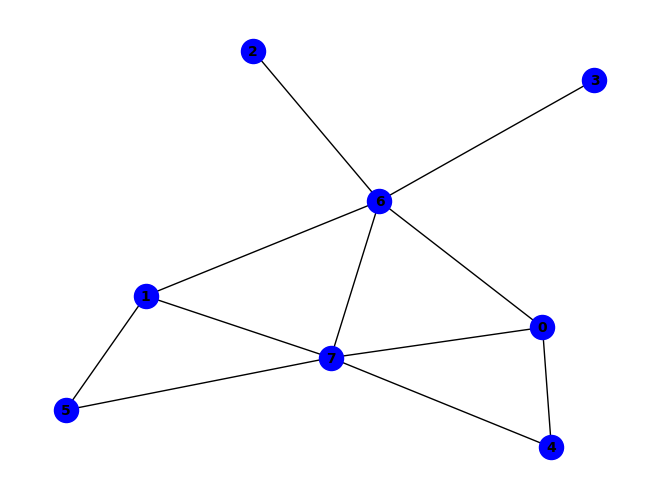


(~d & ~g) ^ (a & e & ~g) ^ (a & g & ~f) ^ (b & f & ~e) ^ (b & h & ~e) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (b & e & f & ~h) ^ (a & h & ~b & ~f) ^ (b & g & ~a & ~f) ^ (c & d & ~g & ~h) ^ (e & h & ~f & ~g) ^ (a & b & e & f & ~g) ^ (a & b & e & h & ~g) ^ (a & e & f & h & ~g) ^ (b & e & g & h & ~f) ^ (a & c & g & ~b & ~h) ^ (a & d & g & ~c & ~h) ^ (a & f & g & ~b & ~h) ^ (b & c & g & ~d & ~h) ^ (b & d & g & ~a & ~h) ^ (a & b & c & d & g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


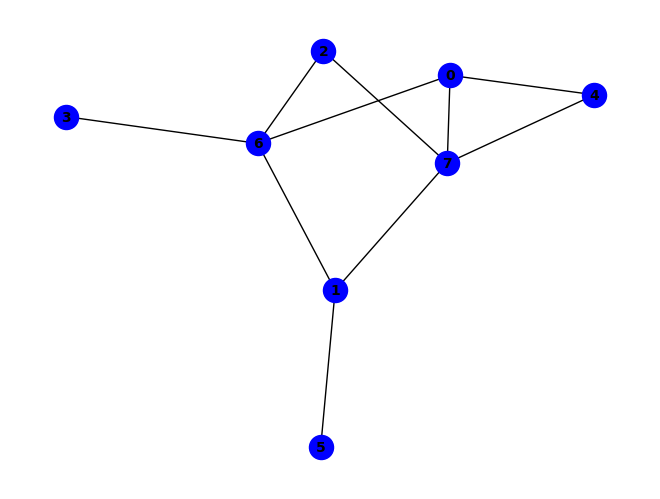


~e ^ (e & ~h) ^ (b & f & ~g) ^ (b & h & ~f) ^ (c & g & ~h) ^ (b & f & g & h) ^ (b & e & h & ~d) ^ (a & h & ~b & ~c) ^ (b & g & ~c & ~h) ^ (c & h & ~b & ~e) ^ (a & d & e & h & ~b) ^ (a & e & g & h & ~b) ^ (b & d & e & h & ~g) ^ (d & e & g & h & ~c) ^ (b & c & d & e & g & h) ^ (a & e & ~b & ~d & ~g) ^ (a & g & ~b & ~c & ~h) ^ (d & g & ~a & ~b & ~c) ^ (a & c & e & h & ~b & ~d) ^ (a & b & e & ~f & ~g & ~h) ^ (a & d & e & ~b & ~g & ~h) ^ (a & c & d & e & h & ~b & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


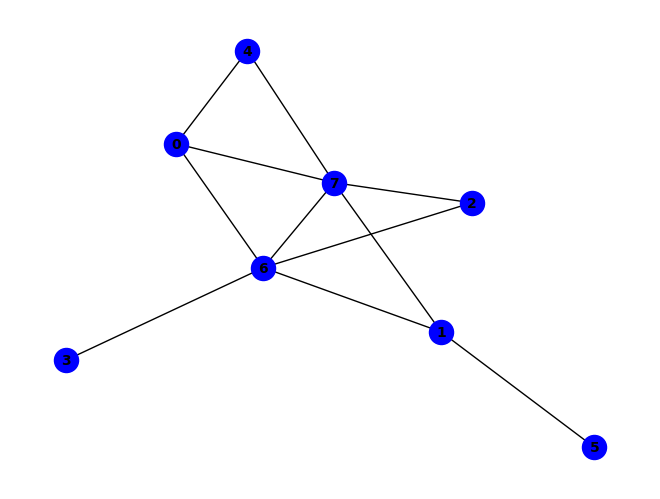


(b & f) ^ (g & ~h) ^ (~d & ~g) ^ (a & e & ~c) ^ (a & h & ~c) ^ (b & g & ~f) ^ (b & h & ~f) ^ (d & h & ~g) ^ (b & f & g & h) ^ (d & ~c & ~h) ^ (c & d & ~g & ~h) ^ (c & g & ~b & ~e) ^ (c & h & ~b & ~e) ^ (e & h & ~b & ~g) ^ (a & b & e & f & ~h) ^ (a & b & h & ~c & ~e) ^ (a & c & e & ~g & ~h) ^ (b & d & g & ~c & ~h) ^ (c & e & g & ~b & ~h) ^ (a & b & c & e & g & ~h) ^ (a & g & ~b & ~c & ~e) ^ (a & b & e & g & ~f & ~h) ^ (a & d & g & ~b & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


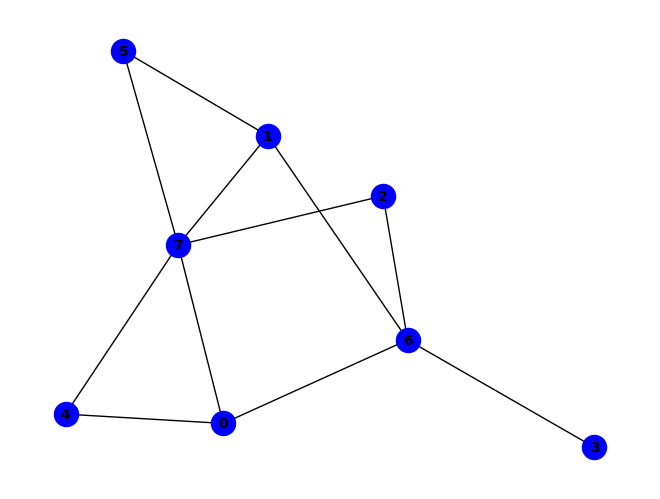


~f ^ (a & f & ~e) ^ (a & h & ~c) ^ (b & f & ~e) ^ (b & g & ~f) ^ (c & g & ~h) ^ (e & h & ~f) ^ (a & e & g & h) ^ (f & ~a & ~h) ^ (a & b & g & ~d) ^ (a & d & g & ~c) ^ (b & c & g & ~a) ^ (a & b & c & d & g) ^ (a & d & f & g & h) ^ (a & e & ~d & ~g) ^ (a & g & ~c & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~b & ~c) ^ (a & b & f & h & ~d) ^ (a & c & e & f & ~d) ^ (a & c & e & h & ~d) ^ (a & d & e & h & ~f) ^ (b & c & e & f & ~d) ^ (b & c & f & h & ~d) ^ (b & f & g & h & ~d) ^ (d & e & g & h & ~c) ^ (a & d & e & ~g & ~h) ^ (a & e & f & ~c & ~h) ^ (b & e & f & ~c & ~h) ^ (b & e & h & ~c & ~d) ^ (a & c & d & e & f & ~h) ^ (a & c & d & e & h & ~g) ^ (b & c & d & e & h & ~g) ^ (b & c & d & f & h & ~g) ^ (b & d & e & f & h & ~a) ^ (a & b & c & d & e & f & h) ^ (b & h & ~a & ~c & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & b & e & h & ~c & ~f) ^ (a & c & f & h & ~b & ~d) ^ (b & d & e & h & ~f & ~g) ^ (d & f & g & h & ~c & ~e) ^ (a & b & d & e & g & h & ~c) ^ (b & c & d & e & f & g & ~h) ^ (a & b & d & f & 

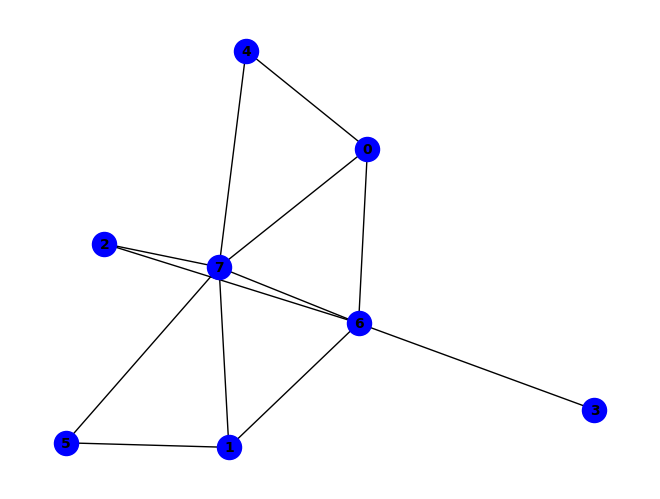


(g & ~h) ^ (~d & ~g) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (b & e & g & ~h) ^ (c & d & ~g & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & h & ~f & ~g) ^ (a & b & e & f & ~g) ^ (a & c & e & h & ~g) ^ (a & e & f & g & ~c) ^ (a & e & f & h & ~c) ^ (b & e & f & h & ~g) ^ (c & e & f & g & ~b) ^ (c & e & f & h & ~b) ^ (b & d & g & ~c & ~h) ^ (c & e & h & ~b & ~g) ^ (a & g & ~b & ~c & ~f) ^ (a & h & ~b & ~c & ~f) ^ (a & b & e & h & ~c & ~g) ^ (a & b & f & g & ~c & ~h) ^ (a & b & c & e & f & h & ~g) ^ (a & d & g & ~b & ~c & ~h) ^ (a & f & g & ~c & ~e & ~h) ^ (c & f & g & ~b & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


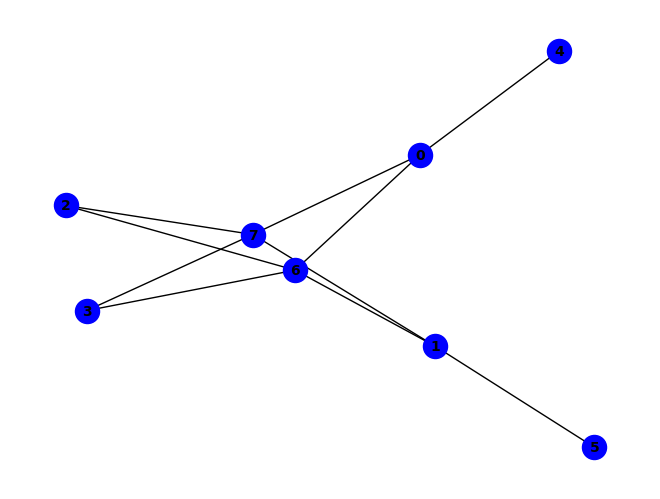


~c ^ (b & f & ~h) ^ (c & ~g & ~h) ^ (a & c & h & ~b) ^ (b & d & g & ~h) ^ (a & e & ~b & ~h) ^ (a & g & ~b & ~e) ^ (a & h & ~b & ~g) ^ (b & g & ~f & ~h) ^ (b & h & ~c & ~d) ^ (d & h & ~a & ~c) ^ (a & b & d & g & ~c) ^ (a & e & g & h & ~b) ^ (a & c & g & ~b & ~h) ^ (b & c & g & ~d & ~h) ^ (d & g & ~a & ~c & ~h) ^ (a & b & d & h & ~c & ~g) ^ (a & b & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


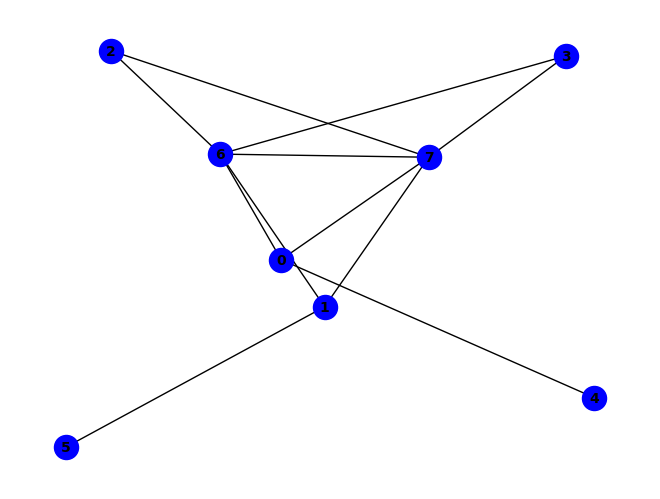


~g ^ (g & ~h) ^ (a & e & ~h) ^ (b & f & ~a) ^ (c & g & ~b) ^ (d & h & ~b) ^ (a & b & d & h) ^ (a & e & g & h) ^ (a & d & g & ~b) ^ (a & g & ~b & ~e) ^ (a & h & ~c & ~d) ^ (b & g & ~a & ~f) ^ (b & h & ~a & ~f) ^ (c & h & ~b & ~d) ^ (d & g & ~b & ~c) ^ (a & b & c & h & ~d) ^ (a & b & g & h & ~e) ^ (b & f & g & h & ~a) ^ (a & b & f & ~e & ~h) ^ (a & c & g & ~b & ~d) ^ (a & b & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


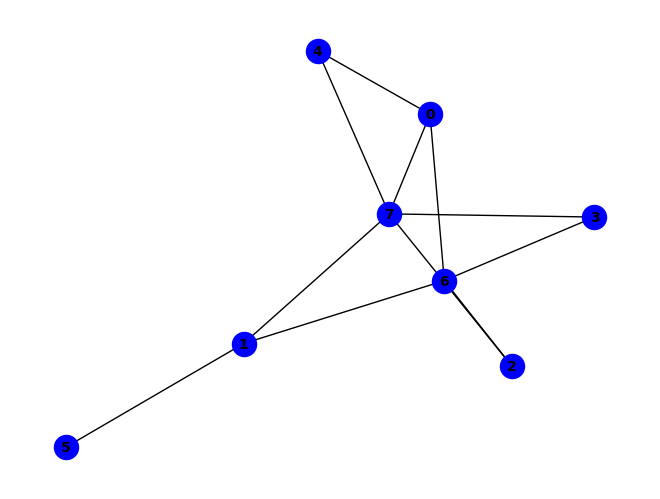


~e ^ (e & ~h) ^ (a & h & ~d) ^ (b & f & ~h) ^ (b & g & ~f) ^ (d & h & ~e) ^ (a & c & d & g) ^ (b & f & g & h) ^ (a & c & g & ~h) ^ (a & c & h & ~e) ^ (b & c & h & ~e) ^ (b & d & g & ~c) ^ (b & e & h & ~d) ^ (a & b & d & e & h) ^ (b & c & d & e & h) ^ (a & e & ~b & ~g) ^ (a & g & ~d & ~h) ^ (c & g & ~b & ~h) ^ (c & h & ~d & ~e) ^ (d & g & ~c & ~h) ^ (a & b & c & h & ~g) ^ (a & c & d & h & ~g) ^ (a & d & e & h & ~c) ^ (a & e & g & h & ~b) ^ (a & b & g & ~c & ~d) ^ (a & b & c & e & h & ~d) ^ (b & h & ~a & ~d & ~g) ^ (b & c & d & h & ~a & ~g) ^ (a & b & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


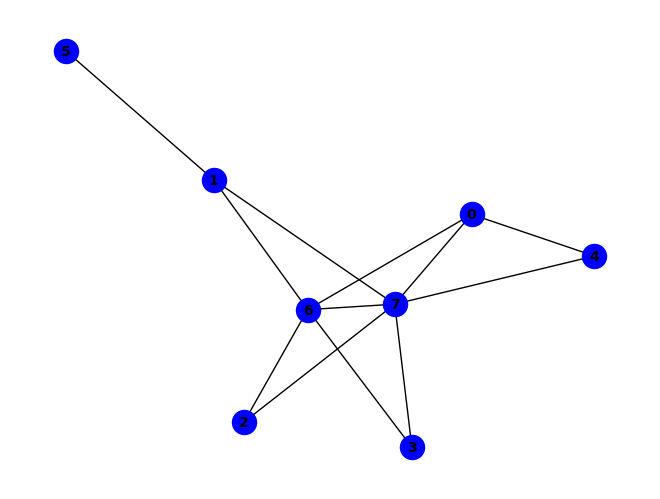


~g ^ (b & f) ^ (g & ~h) ^ (a & e & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (b & g & ~f) ^ (b & h & ~f) ^ (b & f & g & h) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (e & h & ~b & ~g) ^ (a & d & e & h & ~g) ^ (a & b & h & ~d & ~e) ^ (a & c & g & ~d & ~e) ^ (d & e & g & ~b & ~h) ^ (c & g & ~b & ~d & ~e) ^ (a & b & e & f & ~g & ~h) ^ (a & b & e & g & ~d & ~h) ^ (a & b & g & ~c & ~d & ~e) ^ (c & h & ~a & ~b & ~d & ~e) ^ (c & e & g & ~a & ~b & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


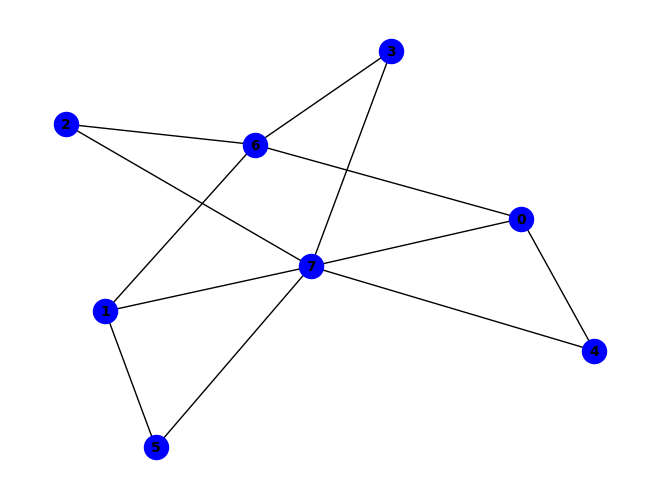


~f ^ (a & e & ~g) ^ (a & f & ~e) ^ (a & h & ~d) ^ (b & f & ~e) ^ (b & g & ~f) ^ (e & h & ~f) ^ (a & e & g & h) ^ (b & f & g & h) ^ (f & ~a & ~h) ^ (a & b & g & ~d) ^ (a & e & f & ~h) ^ (b & c & g & ~a) ^ (b & d & g & ~c) ^ (b & e & f & ~h) ^ (a & g & ~d & ~h) ^ (c & g & ~a & ~h) ^ (d & g & ~c & ~h) ^ (d & h & ~e & ~f) ^ (a & b & c & h & ~g) ^ (a & b & e & f & ~g) ^ (a & b & e & h & ~d) ^ (a & b & f & h & ~c) ^ (a & d & f & h & ~b) ^ (b & d & f & h & ~e) ^ (a & b & d & e & f & h) ^ (a & b & e & f & g & h) ^ (a & b & h & ~d & ~g) ^ (a & c & h & ~e & ~f) ^ (b & e & h & ~c & ~d) ^ (b & h & ~c & ~d & ~g) ^ (c & h & ~d & ~e & ~f) ^ (a & c & d & g & ~b & ~h) ^ (a & c & d & h & ~b & ~f) ^ (a & d & e & h & ~c & ~f) ^ (b & c & f & h & ~d & ~e) ^ (a & b & c & e & h & ~d & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


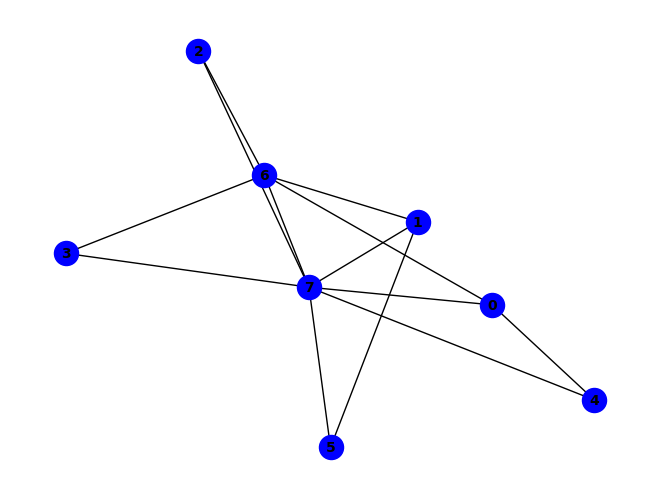


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (b & e & g & ~h) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (a & b & e & f & ~g) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (b & e & f & h & ~g) ^ (d & g & ~b & ~c & ~f) ^ (d & h & ~b & ~c & ~f) ^ (e & h & ~c & ~f & ~g) ^ (a & b & f & g & ~d & ~h) ^ (a & c & e & h & ~f & ~g) ^ (a & c & f & g & ~d & ~h) ^ (a & d & e & h & ~c & ~g) ^ (b & c & e & h & ~f & ~g) ^ (d & e & f & g & ~b & ~c) ^ (d & e & f & h & ~b & ~c) ^ (a & b & c & e & f & g & ~d) ^ (a & b & c & e & f & h & ~d) ^ (a & b & d & e & f & h & ~g) ^ (a & c & d & e & f & h & ~g) ^ (a & f & g & ~d & ~e & ~h) ^ (c & f & g & ~b & ~d & ~h) ^ (d & e & h & ~b & ~c & ~g) ^ (d & f & g & ~b & ~e & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (a & g & ~b & ~c & ~d & ~f) ^ (a & h & ~b & ~c & ~d & ~f) ^ (a & b & e & h & ~c & ~d & ~g) ^ (a & b & c & f & g & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

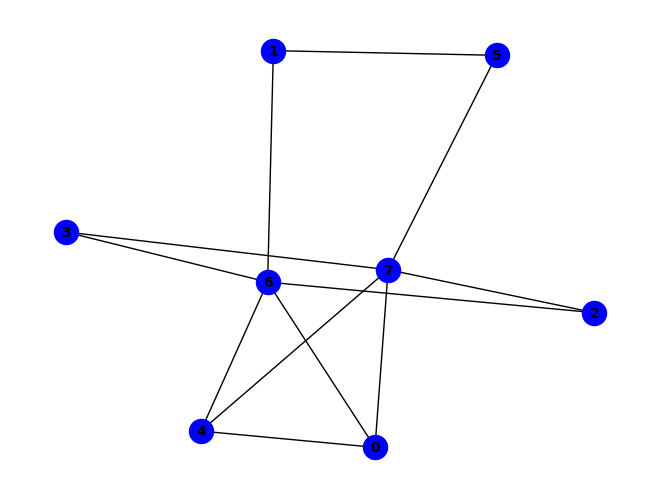


(b & e & g) ^ (~b & ~f) ^ (e & g & ~h) ^ (e & h & ~f) ^ (b & ~f & ~g) ^ (f & ~b & ~h) ^ (a & b & g & ~d) ^ (b & d & g & ~e) ^ (a & b & c & d & g) ^ (b & e & f & g & h) ^ (a & e & ~b & ~f) ^ (a & g & ~d & ~h) ^ (d & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (a & b & c & g & ~e) ^ (a & b & e & f & ~h) ^ (a & c & d & g & ~h) ^ (a & c & e & f & ~d) ^ (a & c & e & h & ~d) ^ (a & d & e & h & ~f) ^ (a & b & e & ~f & ~g) ^ (a & c & g & ~e & ~h) ^ (a & e & f & ~c & ~h) ^ (b & c & g & ~d & ~e) ^ (a & b & d & e & g & ~c) ^ (a & b & f & g & h & ~d) ^ (a & c & d & e & f & ~h) ^ (a & b & d & e & f & g & h) ^ (a & h & ~c & ~d & ~f) ^ (c & g & ~d & ~e & ~h) ^ (c & h & ~d & ~e & ~f) ^ (a & d & e & g & ~c & ~h) ^ (b & c & f & g & h & ~a & ~e) ^ (b & d & f & g & h & ~c & ~e) ^ (a & b & c & d & f & g & h & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

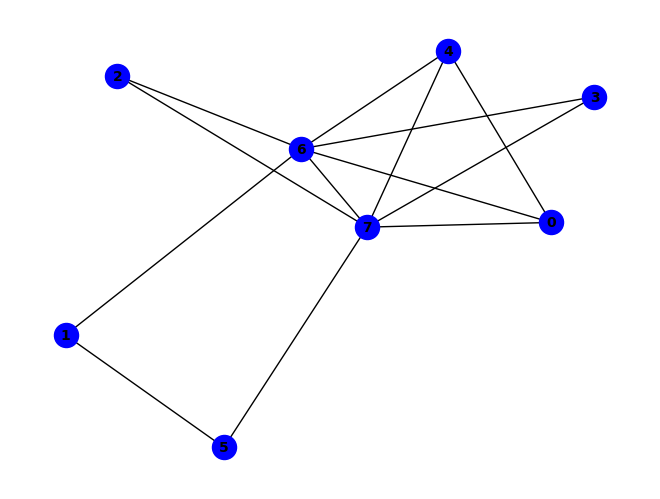


(g & ~h) ^ (~b & ~g) ^ (a & e & ~g) ^ (b & h & ~g) ^ (f & h & ~g) ^ (b & ~f & ~h) ^ (a & e & g & ~h) ^ (b & e & g & ~h) ^ (b & f & g & ~h) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & d & e & g & ~f) ^ (a & d & e & h & ~f) ^ (a & e & f & h & ~g) ^ (c & d & e & g & ~f) ^ (c & d & e & h & ~f) ^ (a & f & g & ~d & ~h) ^ (c & f & g & ~d & ~h) ^ (d & f & g & ~e & ~h) ^ (e & f & g & ~c & ~h) ^ (a & d & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & b & g & ~d & ~e & ~h) ^ (a & c & g & ~d & ~e & ~f) ^ (a & c & h & ~d & ~e & ~f) ^ (b & c & g & ~a & ~e & ~h) ^ (b & d & g & ~c & ~e & ~h) ^ (a & b & c & d & g & ~e & ~h) ^ (a & c & f & g & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

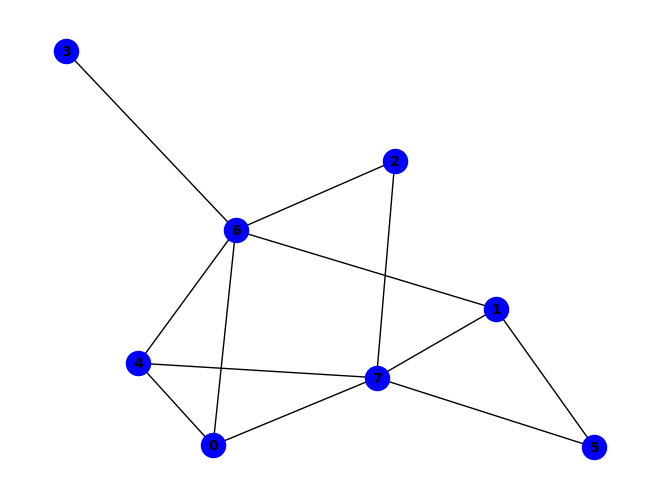


~f ^ (f & ~h) ^ (e & g & ~h) ^ (e & h & ~f) ^ (b & f & g & h) ^ (a & e & f & ~h) ^ (a & e & ~b & ~f) ^ (a & g & ~c & ~h) ^ (a & h & ~c & ~f) ^ (b & f & ~d & ~g) ^ (b & h & ~a & ~e) ^ (c & g & ~e & ~h) ^ (c & h & ~e & ~f) ^ (a & b & e & h & ~f) ^ (a & c & e & g & ~h) ^ (a & c & e & h & ~f) ^ (b & c & f & h & ~d) ^ (b & d & f & h & ~e) ^ (b & e & f & h & ~c) ^ (a & b & e & ~g & ~h) ^ (b & c & g & ~a & ~e) ^ (b & c & d & f & h & ~g) ^ (a & b & c & d & f & g & h) ^ (b & g & ~a & ~e & ~h) ^ (a & b & e & g & ~f & ~h) ^ (a & b & f & h & ~c & ~e) ^ (b & d & e & f & ~c & ~g) ^ (a & b & d & f & g & h & ~e) ^ (b & c & d & e & f & h & ~a) ^ (b & c & h & ~a & ~e & ~g) ^ (b & d & f & ~e & ~g & ~h) ^ (b & c & d & e & f & ~g & ~h) ^ (a & b & c & d & e & f & h & ~g) ^ (d & g & ~a & ~b & ~c & ~e) ^ (d & f & g & h & ~a & ~c & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

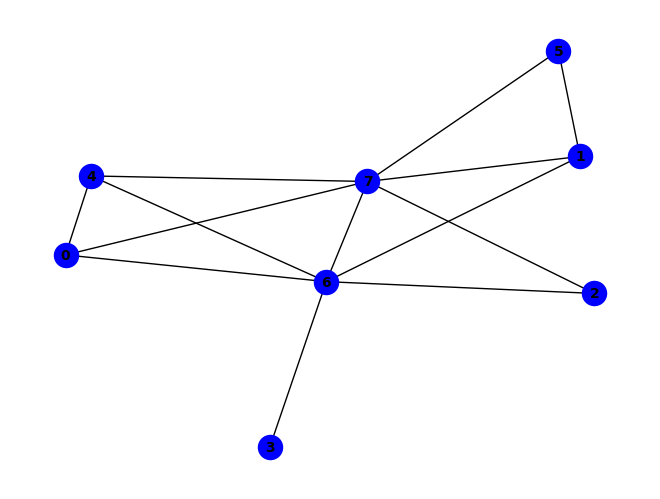


(g & ~h) ^ (~d & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~e & ~h) ^ (a & e & g & ~h) ^ (a & e & ~d & ~g) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & b & e & f & ~g) ^ (a & b & e & g & ~c) ^ (a & b & e & h & ~c) ^ (a & c & e & g & ~f) ^ (a & c & e & h & ~f) ^ (a & d & e & h & ~g) ^ (a & e & f & h & ~g) ^ (b & c & e & g & ~f) ^ (b & c & e & h & ~f) ^ (b & e & f & h & ~g) ^ (a & d & e & ~c & ~h) ^ (a & d & g & ~c & ~h) ^ (c & d & e & ~b & ~h) ^ (c & d & g & ~b & ~h) ^ (c & f & g & ~b & ~h) ^ (e & f & g & ~c & ~h) ^ (a & c & e & f & g & ~h) ^ (b & c & e & f & g & ~h) ^ (a & g & ~b & ~c & ~f) ^ (a & h & ~b & ~c & ~f) ^ (d & e & ~c & ~g & ~h) ^ (a & c & d & e & ~g & ~h) ^ (b & c & d & e & ~g & ~h) ^ (a & b & c & e & f & h & ~g) ^ (a & f & g & ~b & ~c & ~h) ^ (b & d & g & ~a & ~e & ~h) ^ (a & b & c & d & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

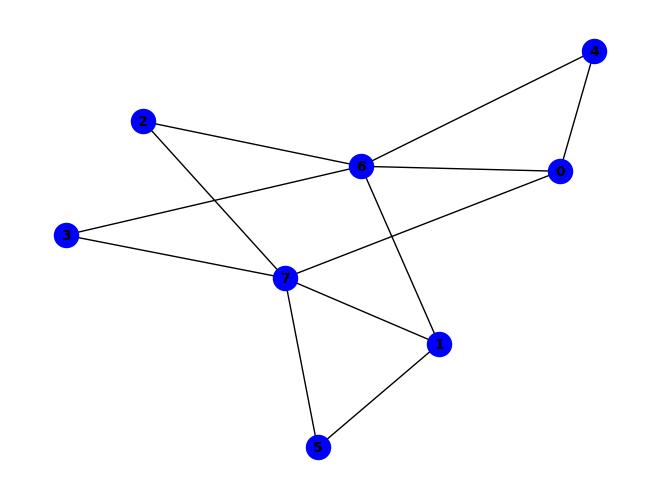


~f ^ (f & ~h) ^ (b & h & ~d) ^ (d & h & ~f) ^ (b & d & f & h) ^ (b & f & g & h) ^ (a & e & ~g & ~h) ^ (b & f & ~e & ~g) ^ (b & g & ~c & ~h) ^ (d & g & ~b & ~h) ^ (a & b & c & g & ~e) ^ (a & b & c & h & ~g) ^ (a & b & e & f & ~h) ^ (a & b & e & g & ~f) ^ (b & e & f & h & ~d) ^ (b & c & e & f & g & h) ^ (a & b & h & ~d & ~f) ^ (a & e & g & ~c & ~d) ^ (a & b & c & d & h & ~f) ^ (a & b & c & f & h & ~e) ^ (a & b & d & e & g & ~c) ^ (a & b & d & e & f & g & h) ^ (a & g & ~b & ~d & ~h) ^ (a & h & ~c & ~d & ~f) ^ (c & g & ~a & ~d & ~h) ^ (c & h & ~b & ~d & ~f) ^ (e & g & ~b & ~c & ~d) ^ (b & c & d & g & ~a & ~h) ^ (b & d & e & f & ~c & ~g) ^ (a & b & c & d & e & f & ~g) ^ (a & b & c & e & f & h & ~g) ^ (b & c & d & e & f & h & ~a) ^ (b & e & f & ~d & ~g & ~h) ^ (e & f & g & h & ~a & ~c & ~d) ^ (b & c & d & e & f & ~a & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

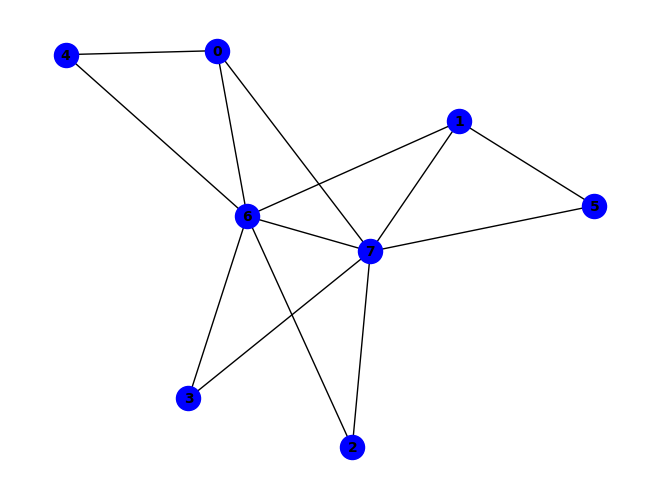


(g & ~h) ^ (~e & ~g) ^ (b & f & ~d) ^ (b & h & ~d) ^ (f & h & ~g) ^ (d & f & g & ~h) ^ (a & e & ~d & ~h) ^ (c & e & ~d & ~g) ^ (c & g & ~b & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~c & ~g) ^ (b & c & d & g & ~f) ^ (b & c & d & h & ~f) ^ (c & d & e & h & ~g) ^ (e & ~c & ~d & ~h) ^ (b & d & f & ~g & ~h) ^ (a & g & ~c & ~d & ~f) ^ (b & g & ~a & ~d & ~f) ^ (d & e & ~a & ~g & ~h) ^ (a & b & c & g & ~d & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & g & ~d & ~h) ^ (c & f & g & ~b & ~d & ~h) ^ (a & h & ~b & ~c & ~d & ~f) ^ (a & f & g & ~b & ~c & ~d & ~h) ^ (b & e & g & ~a & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


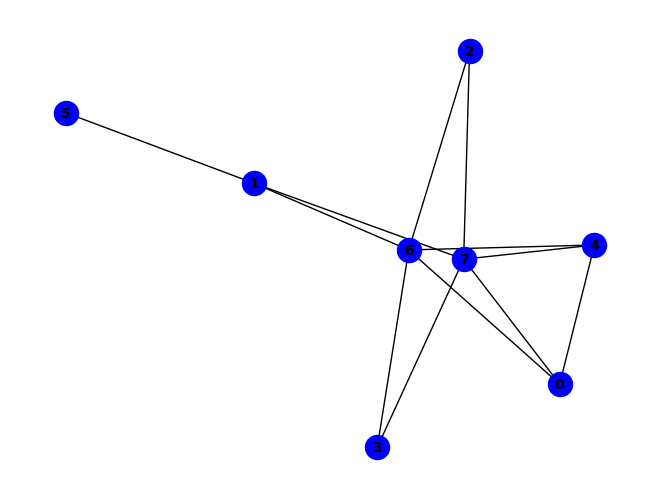


~d ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & f & ~g) ^ (b & h & ~f) ^ (e & h & ~d) ^ (b & f & g & h) ^ (d & ~g & ~h) ^ (a & b & h & ~e) ^ (a & c & h & ~e) ^ (b & e & g & ~d) ^ (b & e & h & ~g) ^ (b & d & e & g & h) ^ (a & g & ~d & ~h) ^ (b & g & ~d & ~h) ^ (e & g & ~d & ~h) ^ (a & b & c & g & ~e) ^ (a & c & d & g & ~e) ^ (a & c & g & ~e & ~h) ^ (a & d & e & ~g & ~h) ^ (b & d & h & ~a & ~e) ^ (a & b & c & d & h & ~e) ^ (c & h & ~b & ~d & ~e) ^ (a & b & c & h & ~e & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & c & d & h & ~e & ~g) ^ (a & b & g & ~d & ~e & ~h) ^ (a & b & c & d & g & ~e & ~h) ^ (c & g & ~b & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


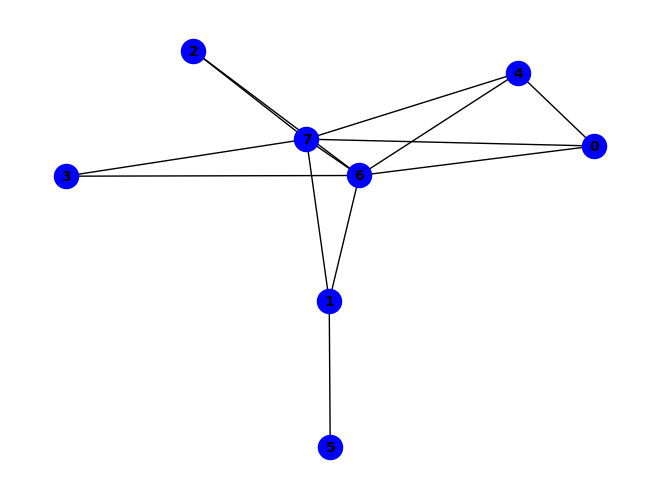


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & h & ~f) ^ (c & g & ~d) ^ (d & g & ~e) ^ (e & g & ~c) ^ (e & h & ~b) ^ (a & b & e & f) ^ (b & f & g & h) ^ (c & d & e & g) ^ (a & e & g & ~h) ^ (a & b & e & g & h) ^ (a & g & ~b & ~d) ^ (a & h & ~b & ~d) ^ (d & h & ~b & ~e) ^ (a & b & e & g & ~f) ^ (a & c & d & g & ~b) ^ (a & c & d & h & ~b) ^ (a & c & g & ~b & ~e) ^ (a & c & h & ~b & ~e) ^ (b & g & ~c & ~d & ~e) ^ (c & h & ~b & ~d & ~e) ^ (a & b & e & h & ~f & ~g) ^ (a & d & e & g & ~b & ~c) ^ (a & d & e & h & ~b & ~c)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


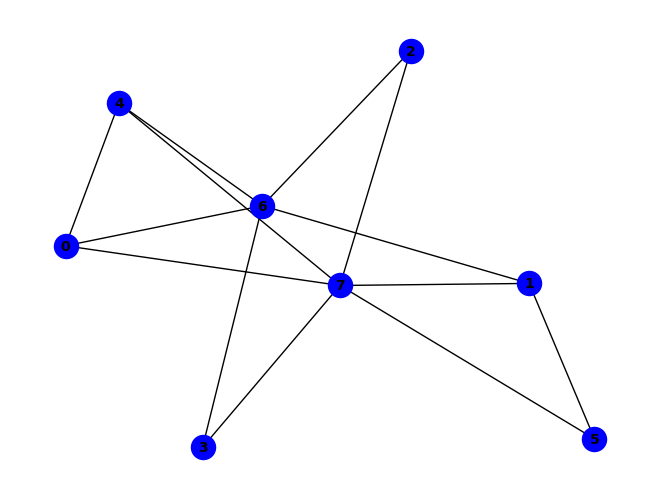


~f ^ (f & ~h) ^ (b & f & ~g) ^ (e & g & ~h) ^ (e & h & ~f) ^ (b & f & g & h) ^ (a & e & f & ~h) ^ (b & c & g & ~e) ^ (b & d & g & ~e) ^ (a & e & ~b & ~f) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~f) ^ (b & h & ~a & ~e) ^ (d & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (a & b & e & h & ~f) ^ (a & b & f & h & ~e) ^ (a & d & e & g & ~h) ^ (a & d & e & h & ~f) ^ (b & c & d & h & ~e) ^ (b & c & f & h & ~e) ^ (b & d & f & h & ~c) ^ (b & e & f & h & ~d) ^ (b & c & d & e & f & h) ^ (a & b & e & ~g & ~h) ^ (b & c & h & ~e & ~g) ^ (b & d & h & ~e & ~g) ^ (b & g & ~a & ~e & ~h) ^ (a & b & d & g & ~e & ~h) ^ (a & b & d & h & ~e & ~f) ^ (a & b & e & g & ~f & ~h) ^ (b & c & d & g & ~e & ~h) ^ (c & g & ~a & ~d & ~e & ~h) ^ (c & h & ~a & ~d & ~e & ~f) ^ (a & b & c & g & ~d & ~e & ~h) ^ (a & b & c & h & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


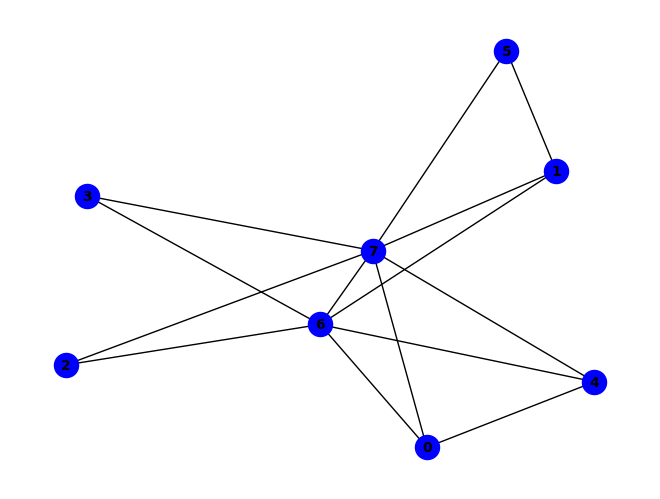


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (c & g & ~d & ~f) ^ (c & h & ~d & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & b & e & f & ~g) ^ (a & b & e & g & ~d) ^ (a & b & e & h & ~d) ^ (a & d & e & g & ~f) ^ (a & d & e & h & ~f) ^ (a & e & f & h & ~g) ^ (b & e & f & h & ~g) ^ (c & d & e & g & ~f) ^ (c & d & e & h & ~f) ^ (a & b & d & e & f & g) ^ (a & b & d & e & f & h) ^ (c & f & g & ~d & ~h) ^ (e & f & g & ~c & ~h) ^ (a & g & ~b & ~d & ~f) ^ (a & h & ~b & ~d & ~f) ^ (d & g & ~b & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & f & g & ~b & ~d & ~h) ^ (b & c & g & ~d & ~e & ~f) ^ (b & c & h & ~d & ~e & ~f) ^ (d & f & g & ~b & ~e & ~h) ^ (a & d & e & f & g & ~b & ~h) ^ (b & c & d & f & g & ~a & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & c & f & g & ~d & ~e & ~h) ^ (b & c & f & g & ~a & ~e & ~h) ^ (a & c & g & ~b & ~d & ~e & ~f) ^ (a & c & h & ~b & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PAS

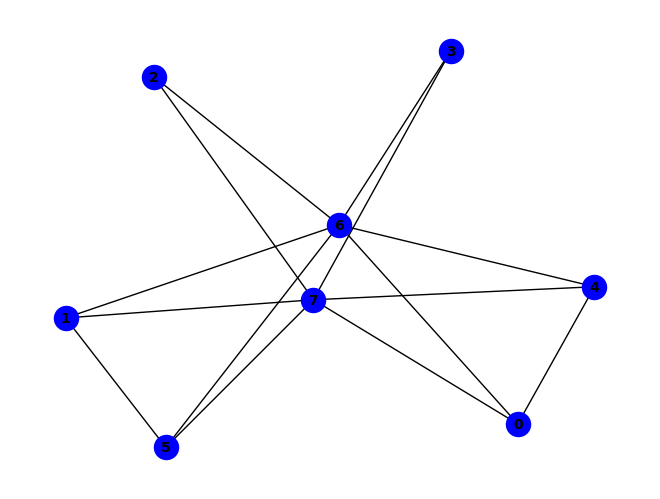


~e ^ (a & e & ~d) ^ (b & f & ~e) ^ (b & h & ~e) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & b & g & ~f) ^ (c & d & h & ~f) ^ (b & g & ~e & ~h) ^ (c & h & ~e & ~f) ^ (d & h & ~e & ~f) ^ (f & g & ~e & ~h) ^ (a & b & e & f & ~d) ^ (a & b & e & g & ~d) ^ (a & e & f & g & ~d) ^ (b & c & d & g & ~f) ^ (b & d & e & g & ~f) ^ (c & d & e & g & ~f) ^ (a & b & h & ~f & ~g) ^ (a & d & e & ~g & ~h) ^ (b & c & g & ~e & ~f) ^ (b & d & h & ~a & ~f) ^ (b & e & f & ~g & ~h) ^ (c & d & g & ~f & ~h) ^ (b & c & d & e & h & ~f) ^ (a & h & ~c & ~d & ~f) ^ (c & g & ~e & ~f & ~h) ^ (d & g & ~e & ~f & ~h) ^ (a & b & e & h & ~d & ~g) ^ (a & c & e & g & ~d & ~f) ^ (a & e & f & h & ~d & ~g) ^ (b & c & d & h & ~f & ~g) ^ (b & d & e & h & ~f & ~g) ^ (c & d & e & h & ~f & ~g) ^ (b & c & h & ~e & ~f & ~g) ^ (b & d & g & ~a & ~f & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (a & g & ~c & ~d & ~f & ~h) ^ (a & b & c & h & ~d & ~e & ~f) ^ (a & c & e & h & ~d & ~f & ~g) ^ (a & b & c & g & ~d & ~e & ~f 

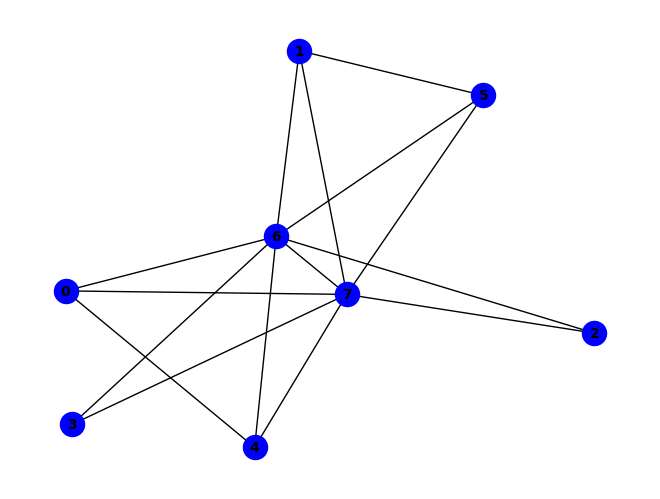


~g ^ (f & h) ^ (g & ~h) ^ (b & f & ~g) ^ (c & g & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~c) ^ (b & e & f & h) ^ (c & e & f & g) ^ (b & f & g & ~h) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (a & b & f & g & ~e) ^ (a & b & f & h & ~e) ^ (b & c & e & g & ~d) ^ (b & e & f & g & ~c) ^ (b & c & d & e & f & g) ^ (b & c & g & ~d & ~f) ^ (a & e & ~b & ~g & ~h) ^ (c & h & ~b & ~e & ~f) ^ (d & g & ~c & ~e & ~f) ^ (a & b & d & h & ~e & ~f) ^ (a & b & e & ~f & ~g & ~h) ^ (b & d & g & ~a & ~e & ~f) ^ (a & g & ~c & ~d & ~e & ~f) ^ (a & h & ~c & ~d & ~e & ~f) ^ (d & h & ~b & ~c & ~e & ~f) ^ (a & b & c & g & ~d & ~e & ~f) ^ (a & b & c & h & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


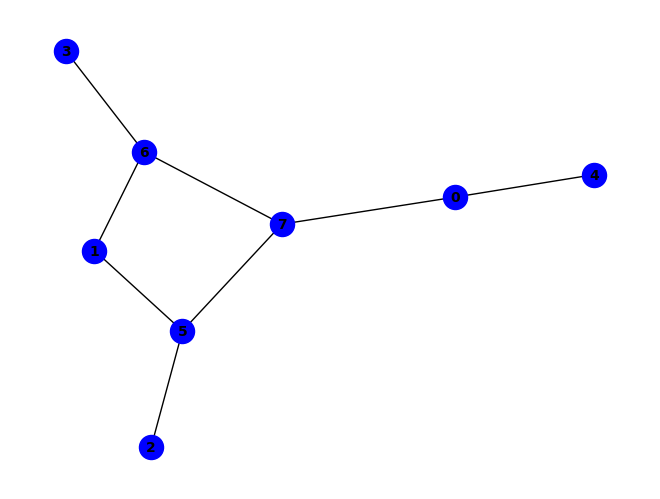


(a & ~e & ~h) ^ (b & d & g & ~h) ^ (~a & ~d & ~g) ^ (d & h & ~a & ~g) ^ (f & h & ~a & ~g) ^ (d & ~a & ~c & ~h) ^ (g & ~a & ~b & ~h) ^ (a & c & f & ~e & ~h) ^ (a & d & g & ~e & ~h) ^ (a & b & d & e & g & ~h) ^ (b & f & ~a & ~g & ~h) ^ (c & f & ~a & ~b & ~h) ^ (b & c & d & f & ~a & ~h) ^ (a & b & f & ~c & ~e & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (c & d & g & ~a & ~f & ~h) ^ (a & b & c & d & g & ~e & ~h) ^ (a & c & d & f & g & ~e & ~h) ^ (c & d & ~a & ~b & ~g & ~h) ^ (a & b & c & d & ~e & ~f & ~h) ^ (a & b & c & d & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


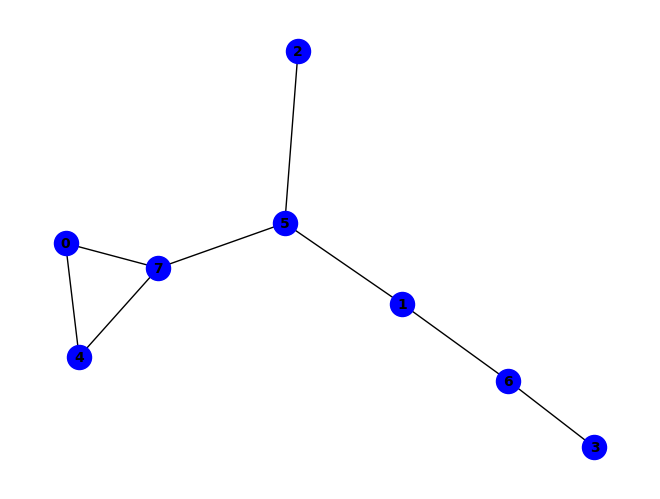


(~c & ~f) ^ (b & g & ~f) ^ (d & g & ~b) ^ (e & h & ~f) ^ (c & ~d & ~h) ^ (f & ~b & ~h) ^ (a & b & g & ~h) ^ (c & d & g & ~f) ^ (a & e & ~d & ~h) ^ (a & h & ~e & ~f) ^ (c & d & ~g & ~h) ^ (c & h & ~d & ~f) ^ (a & c & e & f & ~h) ^ (b & e & g & h & ~f) ^ (d & e & g & h & ~b) ^ (a & b & f & ~g & ~h) ^ (a & b & g & ~e & ~f) ^ (a & d & e & ~g & ~h) ^ (b & c & f & ~a & ~h) ^ (c & d & h & ~f & ~g) ^ (a & b & d & e & g & ~h) ^ (a & b & d & f & g & ~e) ^ (a & b & d & g & h & ~e) ^ (a & b & c & f & ~e & ~h) ^ (a & d & g & h & ~e & ~f) ^ (d & f & g & h & ~b & ~e) ^ (a & c & d & e & f & g & ~h) ^ (a & b & f & ~d & ~e & ~h) ^ (b & c & d & f & g & ~a & ~h) ^ (a & b & d & f & ~e & ~g & ~h) ^ (a & b & c & d & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


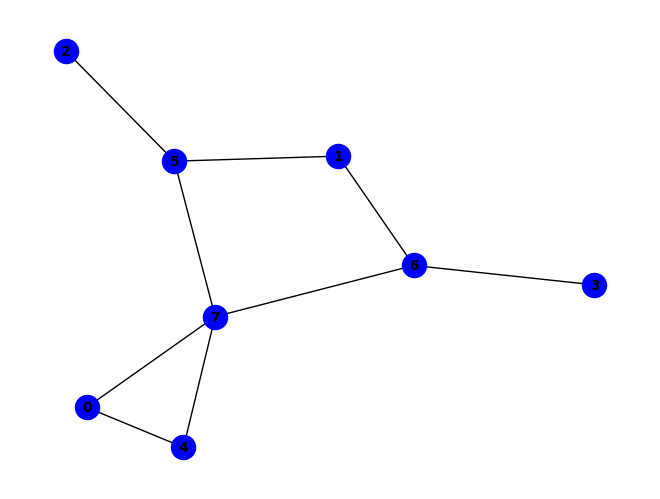


(~d & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~b & ~h) ^ (a & d & e & ~g) ^ (a & e & ~d & ~h) ^ (c & f & ~b & ~h) ^ (d & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & b & e & g & ~h) ^ (b & c & d & f & ~h) ^ (b & d & g & ~a & ~h) ^ (c & d & g & ~f & ~h) ^ (a & b & c & d & g & ~h) ^ (a & h & ~e & ~f & ~g) ^ (b & f & ~a & ~g & ~h) ^ (c & d & ~b & ~g & ~h) ^ (a & c & e & f & ~b & ~h) ^ (a & c & d & e & f & g & ~h) ^ (a & b & d & ~c & ~e & ~g) ^ (a & b & d & ~c & ~e & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & d & h & ~b & ~e & ~g) ^ (a & b & c & d & e & ~f & ~h) ^ (a & b & c & d & ~e & ~f & ~g) ^ (a & b & c & d & f & h & ~e & ~g) ^ (b & c & d & ~a & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


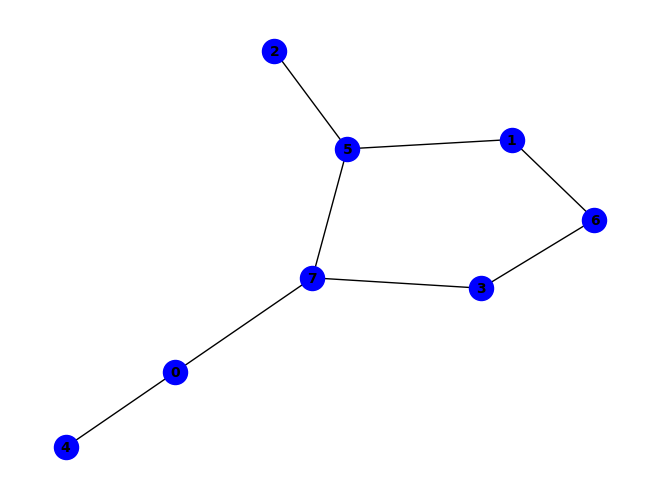


(d & g & ~h) ^ (a & ~e & ~h) ^ (b & d & g & ~a) ^ (~a & ~c & ~f) ^ (b & g & ~a & ~f) ^ (c & d & ~f & ~h) ^ (d & h & ~a & ~f) ^ (a & d & e & g & ~h) ^ (f & ~a & ~b & ~h) ^ (b & c & d & ~f & ~g) ^ (b & d & f & g & h & ~a) ^ (b & c & ~a & ~d & ~f) ^ (c & h & ~a & ~b & ~f) ^ (a & c & d & e & ~f & ~h) ^ (c & ~a & ~b & ~d & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & b & g & ~d & ~e & ~h) ^ (a & c & f & ~b & ~e & ~h) ^ (b & c & d & ~a & ~g & ~h) ^ (c & d & f & ~a & ~g & ~h) ^ (a & b & c & d & e & ~f & ~g) ^ (b & c & d & g & h & ~a & ~f) ^ (a & b & c & d & ~e & ~f & ~h) ^ (a & c & d & g & ~b & ~e & ~h) ^ (a & c & d & ~e & ~f & ~g & ~h) ^ (a & b & c & d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


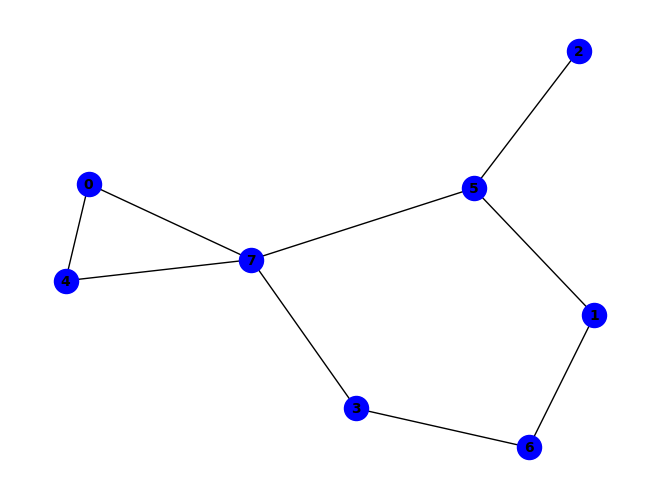


(b & d & g) ^ (~c & ~f) ^ (b & g & ~f) ^ (c & h & ~f) ^ (d & g & ~h) ^ (e & h & ~f) ^ (c & ~d & ~h) ^ (f & ~b & ~h) ^ (a & b & g & ~h) ^ (b & d & f & g & h) ^ (a & e & ~d & ~h) ^ (d & h & ~e & ~f) ^ (a & b & d & e & ~h) ^ (a & c & e & f & ~h) ^ (a & b & f & ~g & ~h) ^ (a & b & g & ~e & ~f) ^ (b & c & f & ~a & ~h) ^ (c & d & f & ~g & ~h) ^ (a & b & d & f & g & ~e) ^ (a & b & d & g & h & ~e) ^ (a & h & ~d & ~e & ~f) ^ (c & d & ~b & ~f & ~h) ^ (a & b & c & f & ~e & ~h) ^ (b & c & d & g & ~a & ~h) ^ (b & e & g & h & ~d & ~f) ^ (a & c & d & e & f & g & ~h) ^ (a & b & f & ~d & ~e & ~h) ^ (a & d & e & ~b & ~g & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (a & b & c & d & g & ~e & ~h) ^ (a & b & d & f & ~e & ~g & ~h) ^ (a & b & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


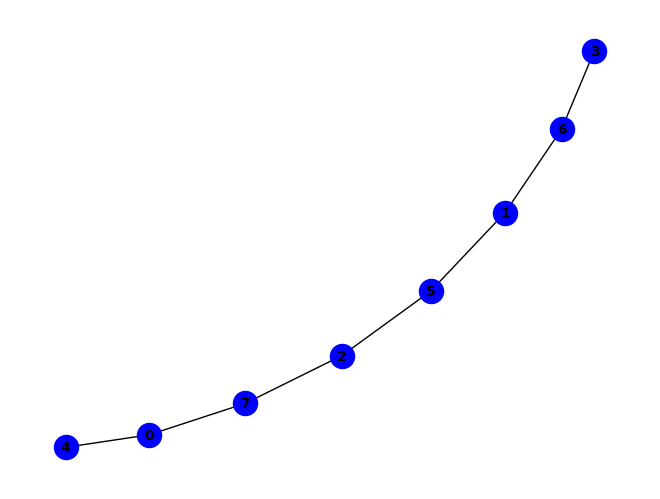


(d & ~g) ^ (a & d & h & ~g) ^ (~a & ~c & ~d) ^ (b & f & ~a & ~g) ^ (a & ~d & ~e & ~h) ^ (a & c & f & ~e & ~h) ^ (a & d & e & ~g & ~h) ^ (c & d & h & ~a & ~g) ^ (b & g & ~a & ~c & ~d) ^ (a & b & d & g & ~e & ~h) ^ (b & c & f & h & ~a & ~g) ^ (c & ~a & ~d & ~f & ~h) ^ (a & b & f & ~c & ~e & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (b & c & f & ~a & ~d & ~h) ^ (b & c & g & ~a & ~d & ~h) ^ (c & d & f & ~a & ~b & ~g & ~h) ^ (a & c & d & f & g & ~b & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


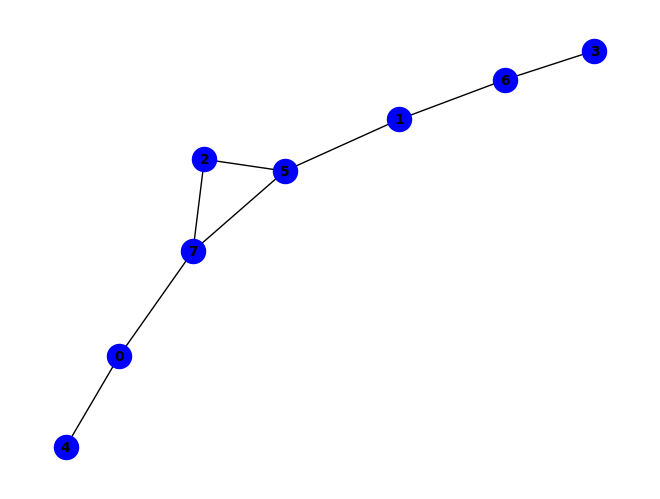


(~a & ~f) ^ (b & g & ~a & ~f) ^ (c & f & ~a & ~d) ^ (c & h & ~a & ~d) ^ (d & g & ~a & ~b) ^ (b & c & d & h & ~a) ^ (a & ~d & ~e & ~h) ^ (f & ~a & ~b & ~h) ^ (a & b & g & ~e & ~h) ^ (b & c & f & ~a & ~h) ^ (c & d & f & ~a & ~g) ^ (b & c & d & f & g & ~a) ^ (b & c & g & h & ~a & ~f) ^ (d & f & g & h & ~a & ~b) ^ (a & b & d & ~c & ~e & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & f & ~b & ~e & ~h) ^ (c & d & h & ~a & ~b & ~g) ^ (a & c & d & f & g & ~e & ~h) ^ (a & d & ~b & ~e & ~g & ~h) ^ (a & b & c & d & ~e & ~f & ~h) ^ (a & b & c & d & f & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


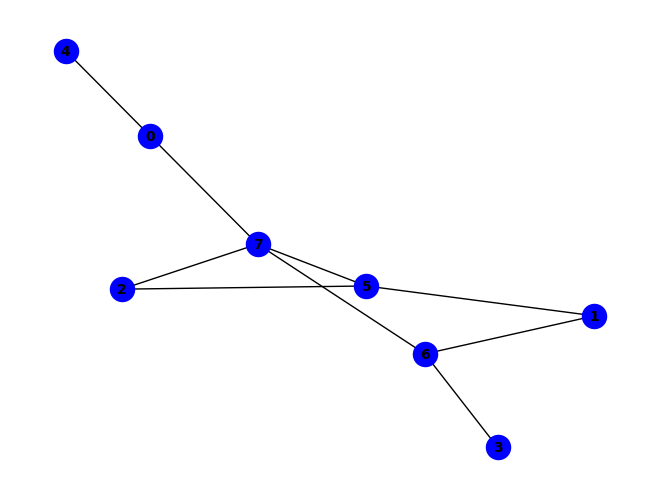


(a & f & h) ^ (f & h & ~g) ^ (g & ~b & ~h) ^ (a & c & g & ~f) ^ (a & f & g & ~b) ^ (a & b & f & g & h) ^ (~a & ~d & ~g) ^ (b & f & ~g & ~h) ^ (c & h & ~f & ~g) ^ (d & h & ~a & ~g) ^ (a & b & e & f & ~h) ^ (a & b & e & g & ~h) ^ (a & c & e & h & ~f) ^ (d & ~a & ~c & ~h) ^ (c & d & f & ~g & ~h) ^ (a & c & ~d & ~e & ~f) ^ (a & g & ~c & ~f & ~h) ^ (c & d & ~b & ~f & ~h) ^ (c & f & ~a & ~b & ~h) ^ (a & b & c & f & ~e & ~h) ^ (a & b & f & g & ~e & ~h) ^ (a & c & d & e & ~g & ~h) ^ (a & c & d & g & ~f & ~h) ^ (a & ~c & ~d & ~e & ~h) ^ (a & b & d & ~c & ~e & ~h) ^ (b & d & g & ~a & ~c & ~h) ^ (a & b & c & d & e & ~f & ~h) ^ (a & c & d & g & h & ~e & ~f) ^ (a & d & ~b & ~e & ~g & ~h) ^ (a & b & c & d & ~e & ~g & ~h) ^ (a & c & d & ~b & ~e & ~f & ~g) ^ (b & c & d & ~a & ~f & ~g & ~h) ^ (a & b & c & d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

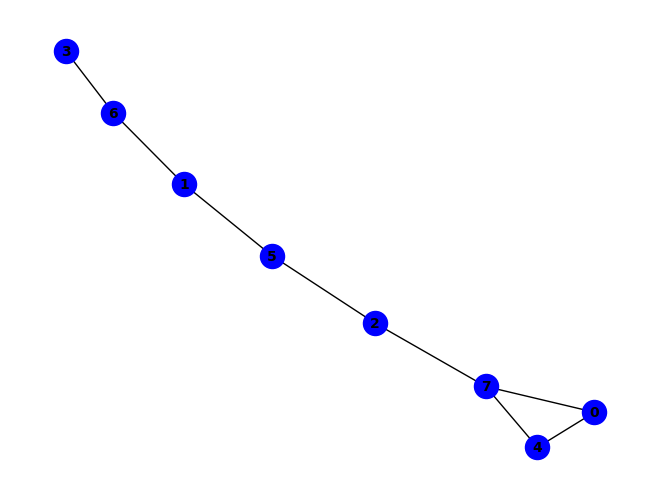


~e ^ (d & g) ^ (e & ~h) ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & f & ~g) ^ (b & g & ~d) ^ (a & b & d & h) ^ (b & e & f & h) ^ (b & c & f & ~e) ^ (a & b & c & e & f) ^ (c & f & ~d & ~h) ^ (c & h & ~a & ~e) ^ (a & b & e & f & ~g) ^ (a & b & e & g & ~d) ^ (a & b & f & h & ~c) ^ (b & c & e & f & ~h) ^ (b & e & g & h & ~f) ^ (c & d & g & h & ~b) ^ (a & d & e & ~c & ~g) ^ (a & d & h & ~b & ~g) ^ (c & d & f & ~g & ~h) ^ (a & c & d & e & h & ~g) ^ (b & c & d & f & g & ~h) ^ (a & b & g & h & ~c & ~f) ^ (a & c & e & f & ~d & ~h) ^ (b & c & g & h & ~e & ~f) ^ (d & e & g & h & ~b & ~c) ^ (a & b & c & e & g & h & ~f) ^ (a & c & d & g & h & ~b & ~e) ^ (a & b & c & d & e & f & g & ~h) ^ (a & c & d & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


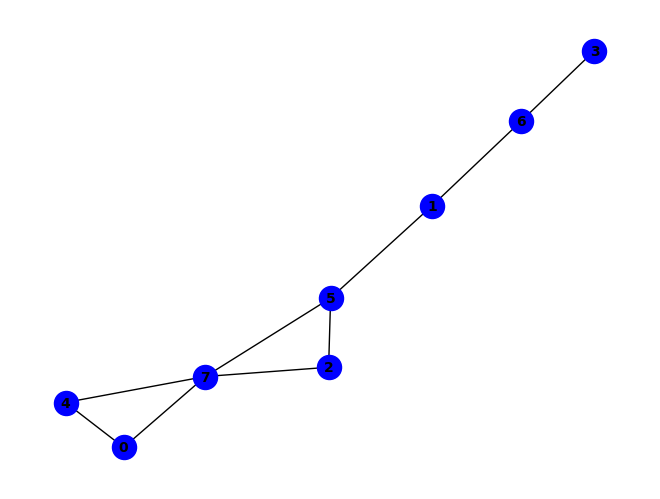


(~b & ~f) ^ (d & g & ~b) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (a & c & f & ~h) ^ (b & c & f & ~h) ^ (b & c & h & ~f) ^ (b & c & d & f & g) ^ (a & e & ~d & ~h) ^ (a & h & ~e & ~f) ^ (c & f & ~a & ~e) ^ (c & h & ~a & ~e) ^ (c & d & f & g & ~e) ^ (d & e & g & h & ~b) ^ (b & ~c & ~f & ~g) ^ (a & b & g & ~e & ~f) ^ (a & b & g & ~f & ~h) ^ (a & d & e & ~g & ~h) ^ (c & e & f & ~d & ~h) ^ (b & c & d & e & f & g & h) ^ (b & c & ~f & ~g & ~h) ^ (a & b & e & f & ~c & ~h) ^ (b & e & g & h & ~c & ~f) ^ (c & d & e & f & ~g & ~h) ^ (c & d & g & h & ~b & ~e) ^ (d & f & g & h & ~b & ~e) ^ (a & c & d & e & f & g & ~h) ^ (a & b & d & e & g & ~c & ~h) ^ (a & b & d & g & h & ~e & ~f) ^ (a & d & g & h & ~c & ~e & ~f) ^ (a & b & c & d & e & g & ~f & ~h) ^ (a & b & c & g & h & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


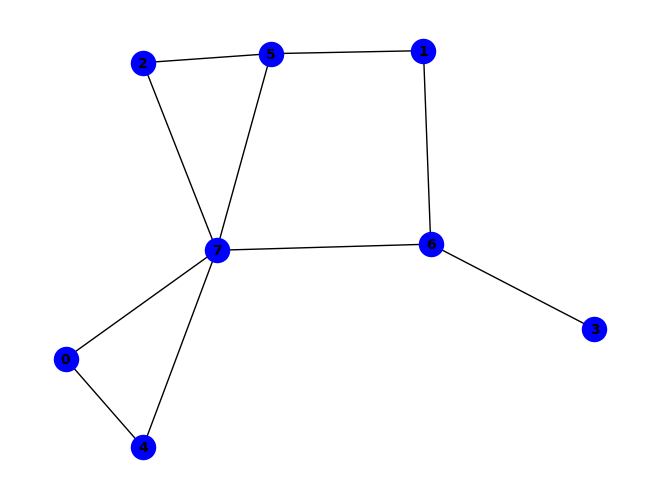


(~d & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~b & ~h) ^ (c & e & f & ~g) ^ (c & e & h & ~g) ^ (a & e & ~c & ~h) ^ (c & d & ~g & ~h) ^ (c & h & ~f & ~g) ^ (e & h & ~f & ~g) ^ (a & d & e & g & ~h) ^ (c & e & f & g & ~h) ^ (a & c & e & ~f & ~h) ^ (a & c & f & ~e & ~g) ^ (a & c & h & ~e & ~g) ^ (b & c & f & ~a & ~h) ^ (b & d & g & ~c & ~h) ^ (a & h & ~e & ~f & ~g) ^ (b & f & ~a & ~g & ~h) ^ (c & f & ~a & ~e & ~h) ^ (a & b & c & f & ~e & ~h) ^ (a & b & e & g & ~d & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (a & c & d & f & g & ~b & ~h) ^ (a & c & f & g & ~d & ~e & ~h) ^ (a & b & c & d & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


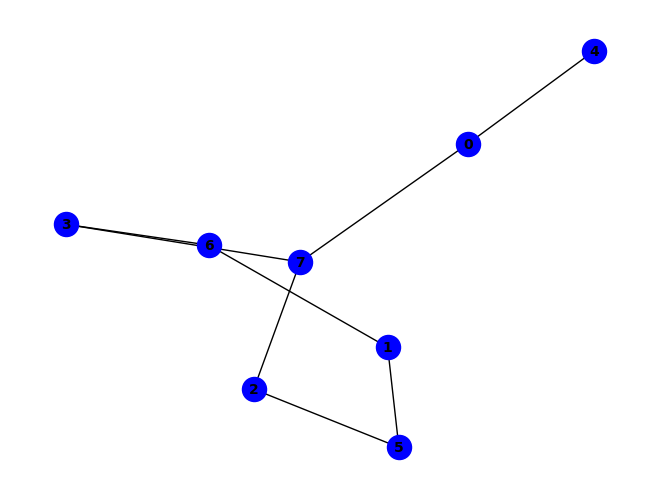


(~a & ~b) ^ (c & h & ~a) ^ (a & ~e & ~h) ^ (d & h & ~a & ~c) ^ (b & d & f & h & ~a) ^ (b & ~a & ~f & ~g) ^ (a & c & f & ~e & ~h) ^ (b & c & f & ~a & ~d) ^ (c & f & ~a & ~d & ~h) ^ (d & g & ~a & ~b & ~h) ^ (b & d & g & h & ~a & ~f) ^ (a & b & f & ~c & ~e & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & d & g & ~b & ~e & ~h) ^ (b & c & g & h & ~a & ~d & ~f) ^ (c & d & f & ~a & ~b & ~g & ~h) ^ (a & c & d & f & g & ~b & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


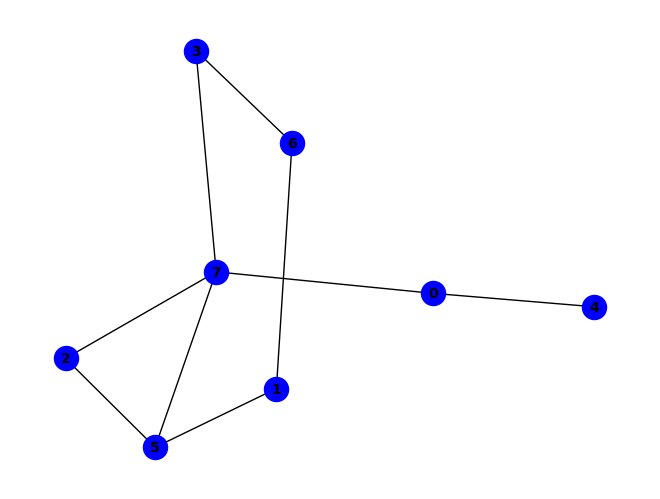


(~a & ~f) ^ (c & f & ~a) ^ (c & h & ~a) ^ (b & d & g & ~a) ^ (b & g & ~a & ~f) ^ (d & g & ~a & ~h) ^ (a & ~d & ~e & ~h) ^ (f & ~a & ~b & ~h) ^ (a & b & g & ~e & ~h) ^ (b & c & f & ~a & ~h) ^ (b & c & d & f & g & ~a) ^ (b & c & d & g & h & ~a) ^ (b & d & f & g & h & ~a) ^ (d & h & ~a & ~c & ~f) ^ (b & c & g & h & ~a & ~f) ^ (c & d & f & g & ~a & ~h) ^ (a & b & d & ~c & ~e & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & f & ~b & ~e & ~h) ^ (a & c & d & f & g & ~e & ~h) ^ (a & d & ~b & ~e & ~g & ~h) ^ (a & b & c & d & ~e & ~f & ~h) ^ (a & b & c & d & f & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


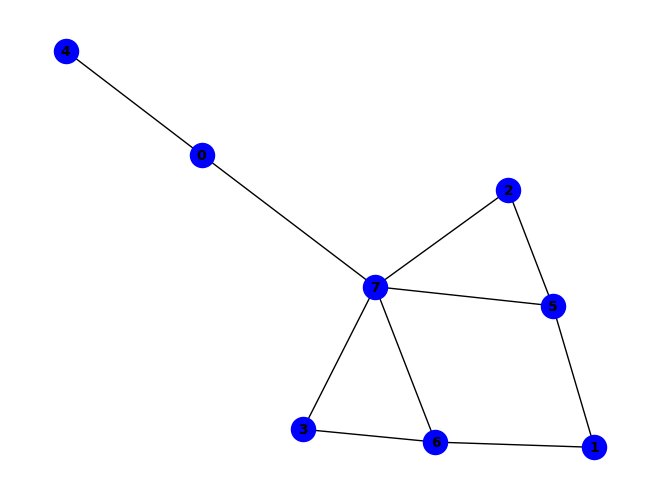


(g & ~a & ~h) ^ (~a & ~b & ~g) ^ (a & b & ~f & ~h) ^ (b & c & ~d & ~h) ^ (b & h & ~a & ~g) ^ (c & f & ~a & ~h) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (f & h & ~a & ~g) ^ (a & ~d & ~e & ~h) ^ (b & ~c & ~f & ~h) ^ (a & b & f & ~e & ~h) ^ (b & c & d & ~g & ~h) ^ (b & d & g & ~a & ~h) ^ (b & f & g & ~a & ~h) ^ (a & b & c & e & f & ~h) ^ (b & c & d & g & ~f & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & f & ~d & ~e & ~h) ^ (d & f & g & ~a & ~c & ~h) ^ (a & d & ~c & ~e & ~g & ~h) ^ (c & h & ~a & ~d & ~f & ~g) ^ (a & b & d & g & ~c & ~e & ~h) ^ (a & c & d & ~e & ~f & ~g & ~h) ^ (a & b & c & d & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


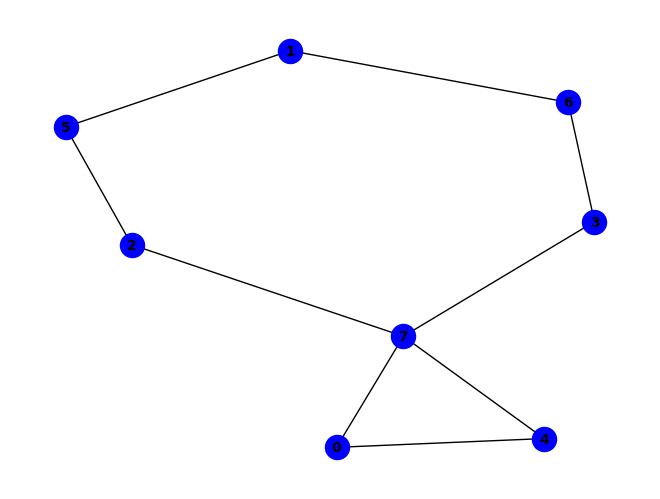


~e ^ (e & ~h) ^ (a & e & ~d) ^ (a & h & ~b) ^ (b & f & ~g) ^ (b & g & ~d) ^ (c & f & ~b) ^ (c & d & h & ~b) ^ (c & e & h & ~d) ^ (a & b & c & e & f) ^ (a & b & c & g & h) ^ (a & b & d & g & h) ^ (a & c & d & e & g) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~h) ^ (d & h & ~a & ~e) ^ (a & b & e & f & ~g) ^ (a & b & e & g & ~d) ^ (a & c & e & f & ~h) ^ (a & d & e & h & ~c) ^ (b & c & d & g & ~f) ^ (b & c & d & g & ~h) ^ (b & c & d & h & ~f) ^ (a & b & h & ~f & ~g) ^ (a & c & h & ~d & ~e) ^ (a & d & e & ~g & ~h) ^ (b & c & h & ~f & ~g) ^ (c & d & g & ~f & ~h) ^ (a & b & c & f & h & ~g) ^ (a & c & d & e & h & ~g) ^ (b & e & f & h & ~c & ~g) ^ (b & e & g & h & ~c & ~d) ^ (a & b & c & d & g & h & ~e) ^ (a & b & c & e & g & h & ~f) ^ (b & c & d & e & f & h & ~g) ^ (a & c & d & e & g & ~f & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (b & d & f & h & ~a & ~e & ~g) ^ (a & b & c & d & f & h & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

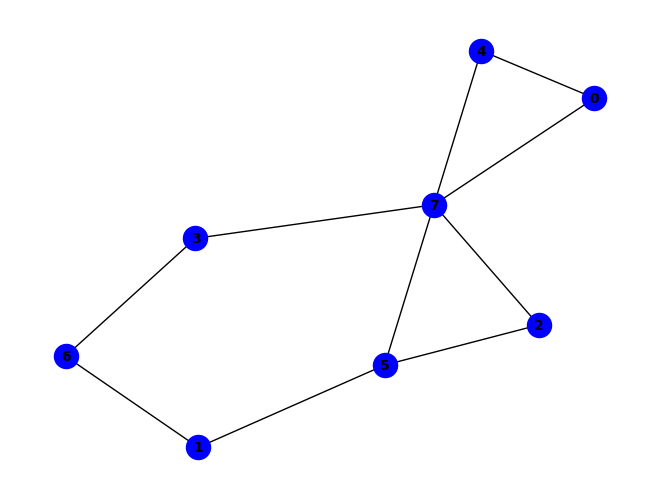


(b & d & g) ^ (~b & ~f) ^ (d & g & ~h) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (a & b & g & ~h) ^ (a & c & f & ~h) ^ (b & c & f & ~h) ^ (b & c & h & ~f) ^ (b & c & d & f & g) ^ (b & c & d & g & h) ^ (b & d & f & g & h) ^ (a & e & ~d & ~h) ^ (c & f & ~a & ~e) ^ (c & h & ~a & ~e) ^ (d & h & ~e & ~f) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (c & d & f & g & ~h) ^ (b & ~c & ~f & ~g) ^ (a & b & f & ~g & ~h) ^ (a & b & g & ~e & ~f) ^ (a & d & e & ~g & ~h) ^ (c & d & h & ~a & ~f) ^ (c & e & f & ~d & ~h) ^ (a & b & c & e & f & ~h) ^ (a & b & c & f & g & ~e) ^ (a & c & d & e & g & ~f) ^ (a & c & d & e & g & ~h) ^ (b & c & d & e & f & ~h) ^ (b & c & e & g & h & ~f) ^ (a & h & ~d & ~e & ~f) ^ (b & c & ~f & ~g & ~h) ^ (b & e & g & h & ~d & ~f) ^ (a & b & c & d & f & h & ~e) ^ (a & b & f & ~c & ~e & ~h) ^ (a & b & c & d & f & ~e & ~g) ^ (a & b & c & g & h & ~d & ~e) ^ (a & b & d & e & g & ~c & ~h) ^ (a & b & d & g & h & ~e & ~f) ^ (a & c & d & e & h & ~f & ~g) ^ (b & c & d & e & h & ~f & ~g) ^ (a 

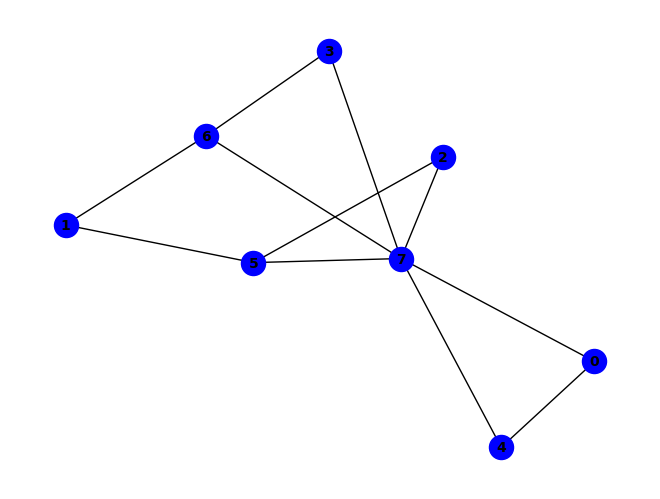


(g & ~h) ^ (~b & ~g) ^ (f & h & ~g) ^ (a & b & e & ~g) ^ (a & e & ~d & ~h) ^ (b & c & ~d & ~h) ^ (b & h & ~a & ~g) ^ (c & f & ~d & ~h) ^ (c & h & ~f & ~g) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & ~c & ~f & ~h) ^ (a & b & e & ~f & ~h) ^ (a & b & h & ~e & ~g) ^ (a & d & e & ~g & ~h) ^ (b & c & d & ~g & ~h) ^ (b & d & g & ~a & ~h) ^ (b & f & g & ~a & ~h) ^ (c & d & f & ~g & ~h) ^ (d & e & h & ~c & ~g) ^ (d & f & g & ~e & ~h) ^ (e & h & ~c & ~f & ~g) ^ (a & b & f & g & ~e & ~h) ^ (a & c & e & f & ~b & ~h) ^ (a & b & c & d & f & g & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (c & d & e & f & g & ~a & ~h) ^ (a & b & d & g & ~c & ~e & ~h) ^ (a & b & c & d & g & ~e & ~f & ~h) ^ (a & h & ~c & ~d & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


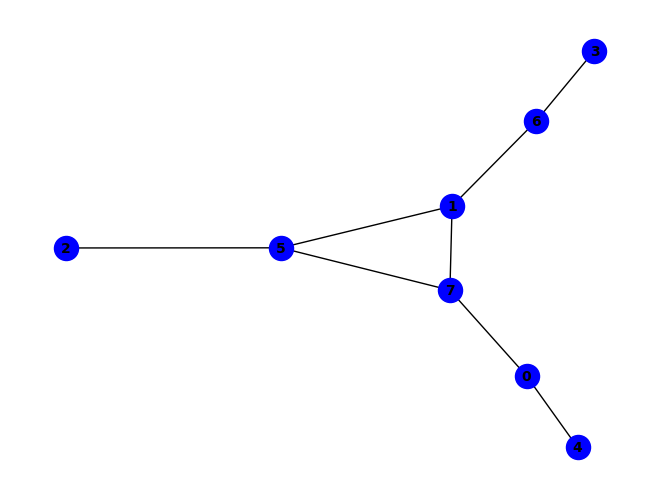


(b & g & ~h) ^ (b & h & ~a) ^ (a & ~e & ~h) ^ (f & ~a & ~h) ^ (b & c & f & ~h) ^ (~a & ~c & ~f) ^ (d & g & ~a & ~b) ^ (b & d & f & h & ~a) ^ (b & f & g & h & ~a) ^ (d & f & g & h & ~a) ^ (c & ~a & ~d & ~h) ^ (a & b & f & ~g & ~h) ^ (a & c & f & ~e & ~h) ^ (c & d & g & ~a & ~f) ^ (b & c & d & f & g & ~h) ^ (b & f & ~a & ~d & ~g) ^ (c & d & ~a & ~g & ~h) ^ (c & h & ~a & ~d & ~f) ^ (a & b & e & f & ~c & ~h) ^ (a & b & e & g & ~f & ~h) ^ (a & d & g & ~b & ~e & ~h) ^ (b & d & f & ~a & ~g & ~h) ^ (c & d & h & ~a & ~f & ~g) ^ (a & c & d & f & g & ~e & ~h) ^ (a & b & c & d & e & f & g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


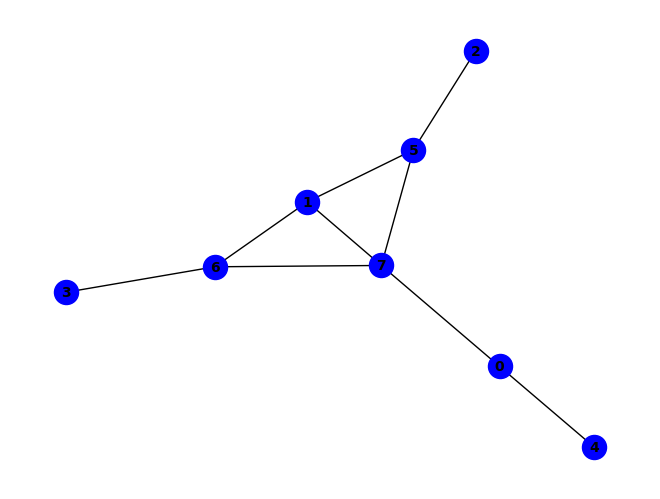


(b & f & ~a) ^ (b & h & ~a) ^ (d & ~c & ~h) ^ (g & ~a & ~h) ^ (a & d & e & ~h) ^ (~a & ~d & ~g) ^ (b & g & ~a & ~f) ^ (d & h & ~a & ~g) ^ (f & h & ~a & ~g) ^ (b & c & d & f & ~h) ^ (a & ~c & ~e & ~h) ^ (b & d & g & ~a & ~h) ^ (c & d & g & ~f & ~h) ^ (a & c & d & f & g & ~h) ^ (a & d & ~e & ~g & ~h) ^ (c & d & ~b & ~g & ~h) ^ (c & f & ~a & ~b & ~h) ^ (a & b & c & f & ~e & ~h) ^ (a & c & d & g & ~e & ~h) ^ (a & b & c & d & e & g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & b & g & ~d & ~e & ~h) ^ (a & b & c & d & e & ~f & ~h) ^ (a & c & ~d & ~e & ~f & ~h) ^ (b & c & d & ~a & ~f & ~g & ~h) ^ (a & c & d & ~b & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


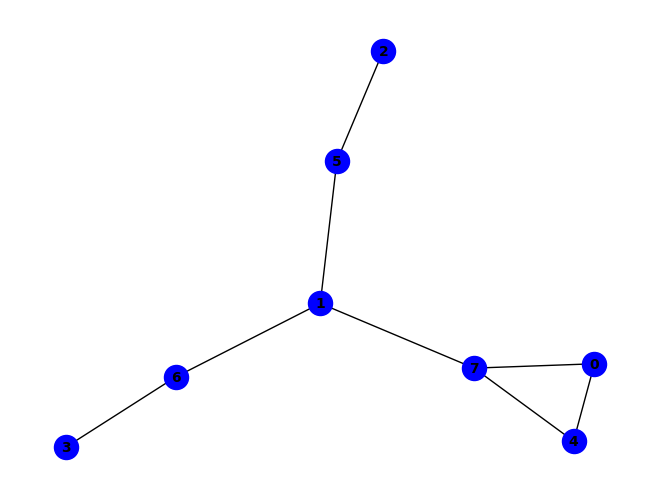


~e ^ (e & ~h) ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & f & ~g) ^ (b & h & ~f) ^ (c & f & ~b) ^ (b & f & g & h) ^ (a & b & h & ~e) ^ (b & e & h & ~d) ^ (a & b & c & e & f) ^ (b & g & ~a & ~h) ^ (d & g & ~b & ~c) ^ (a & b & d & h & ~c) ^ (a & c & e & f & ~d) ^ (a & c & f & h & ~b) ^ (c & e & f & h & ~b) ^ (d & e & g & h & ~c) ^ (a & c & d & f & g & h) ^ (b & c & d & e & f & h) ^ (a & b & g & ~e & ~h) ^ (a & d & e & ~c & ~g) ^ (a & d & h & ~b & ~g) ^ (c & d & g & ~b & ~f) ^ (a & b & c & d & h & ~g) ^ (a & b & d & e & g & ~c) ^ (c & d & e & g & h & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & c & d & e & ~f & ~g) ^ (b & d & e & h & ~c & ~g) ^ (a & b & c & d & e & g & ~f) ^ (a & b & c & d & g & h & ~f) ^ (b & c & d & e & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


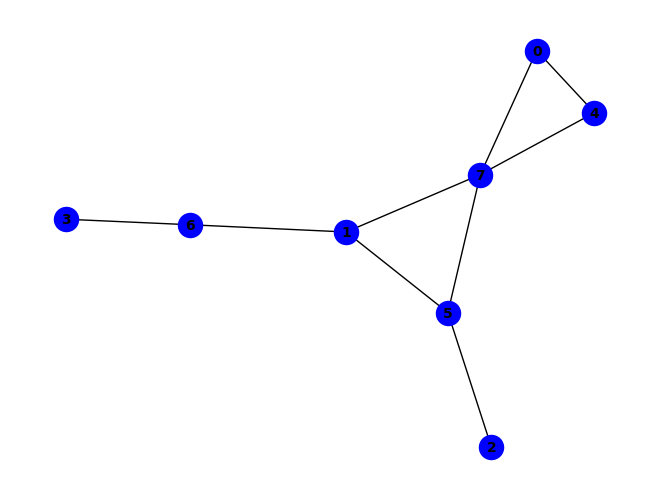


(f & ~h) ^ (~c & ~f) ^ (b & g & ~h) ^ (d & g & ~b) ^ (e & h & ~f) ^ (b & e & f & h) ^ (b & f & g & h) ^ (c & ~d & ~h) ^ (c & d & g & ~f) ^ (a & e & ~d & ~h) ^ (a & h & ~e & ~f) ^ (b & f & ~d & ~g) ^ (b & h & ~a & ~e) ^ (c & h & ~d & ~f) ^ (b & d & e & f & ~g) ^ (b & d & f & h & ~e) ^ (d & e & g & h & ~b) ^ (d & f & g & h & ~e) ^ (a & d & e & ~g & ~h) ^ (b & c & f & ~d & ~h) ^ (c & d & h & ~f & ~g) ^ (a & b & d & g & h & ~e) ^ (c & d & ~b & ~g & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & b & e & g & ~d & ~h) ^ (a & b & f & h & ~d & ~e) ^ (a & c & e & f & ~b & ~h) ^ (a & d & g & h & ~e & ~f) ^ (b & c & d & ~f & ~g & ~h) ^ (b & d & f & ~e & ~g & ~h) ^ (a & b & d & f & h & ~e & ~g) ^ (a & c & d & e & f & g & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


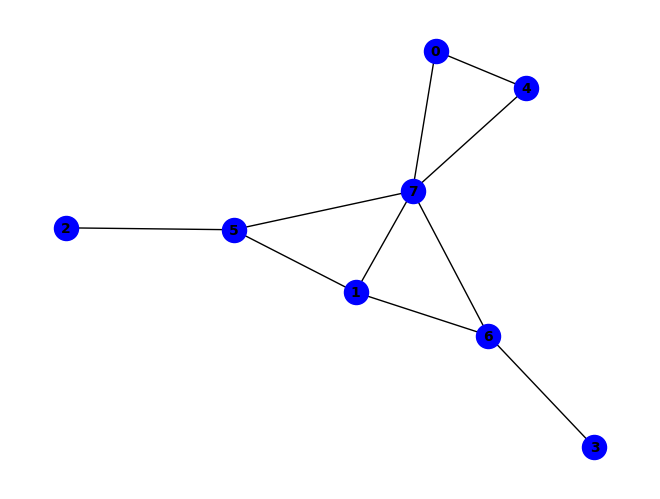


(g & ~h) ^ (~d & ~g) ^ (a & e & ~h) ^ (b & g & ~f) ^ (d & h & ~g) ^ (f & h & ~g) ^ (b & e & f & g) ^ (b & e & g & h) ^ (d & ~c & ~h) ^ (b & f & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & d & ~g & ~h) ^ (c & f & ~b & ~h) ^ (e & h & ~f & ~g) ^ (a & c & e & f & ~h) ^ (a & b & f & ~c & ~h) ^ (a & b & g & ~e & ~f) ^ (a & b & g & ~f & ~h) ^ (b & d & g & ~c & ~h) ^ (b & e & f & ~g & ~h) ^ (a & h & ~e & ~f & ~g) ^ (a & b & c & f & ~e & ~h) ^ (a & d & e & g & ~b & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (a & c & d & e & f & g & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


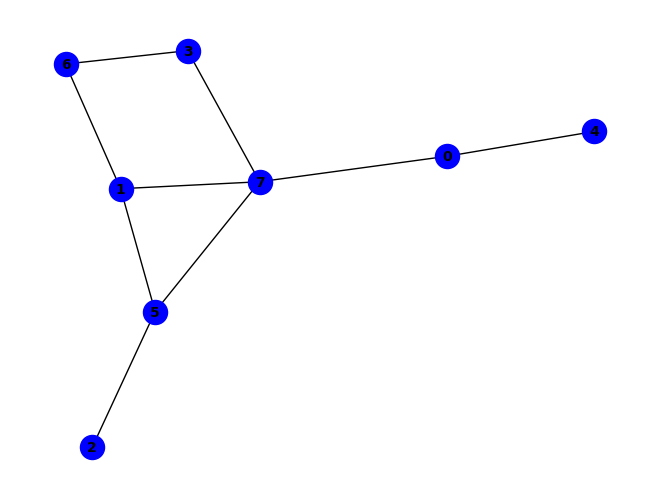


(d & g & ~h) ^ (d & h & ~f) ^ (a & d & f & h) ^ (c & ~d & ~h) ^ (f & ~a & ~h) ^ (a & c & e & ~h) ^ (a & d & g & ~b) ^ (a & d & h & ~g) ^ (a & b & d & g & h) ^ (~a & ~c & ~f) ^ (b & f & ~a & ~g) ^ (b & g & ~d & ~h) ^ (b & h & ~a & ~d) ^ (c & h & ~a & ~f) ^ (a & b & e & g & ~h) ^ (b & d & f & h & ~a) ^ (b & f & g & h & ~a) ^ (a & ~d & ~e & ~h) ^ (b & c & f & ~a & ~h) ^ (c & d & f & ~g & ~h) ^ (a & c & d & f & g & ~h) ^ (a & d & ~e & ~g & ~h) ^ (c & d & ~b & ~f & ~h) ^ (a & b & c & f & ~e & ~h) ^ (a & c & d & g & ~e & ~h) ^ (b & c & d & g & ~a & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (a & c & ~d & ~e & ~f & ~h) ^ (a & b & d & g & ~c & ~e & ~h) ^ (a & b & c & d & e & g & ~f & ~h) ^ (a & c & d & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


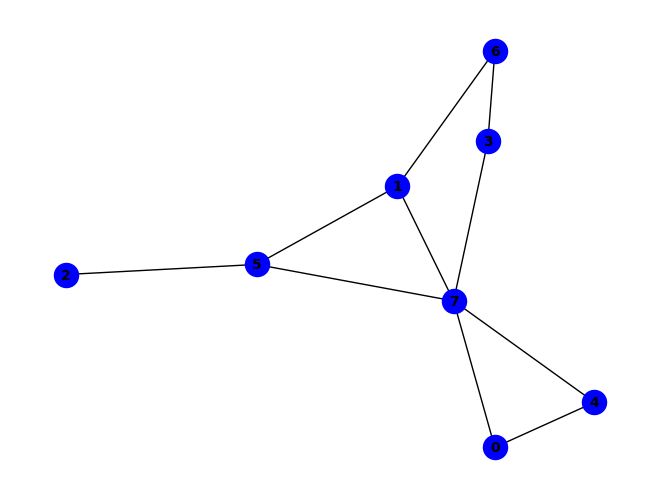


(f & ~h) ^ (b & d & g) ^ (~c & ~f) ^ (b & f & ~g) ^ (b & g & ~h) ^ (c & h & ~f) ^ (d & g & ~h) ^ (e & h & ~f) ^ (b & d & f & h) ^ (b & e & f & h) ^ (b & f & g & h) ^ (c & ~d & ~h) ^ (b & d & h & ~g) ^ (a & e & ~d & ~h) ^ (b & h & ~a & ~e) ^ (d & h & ~e & ~f) ^ (a & b & f & h & ~e) ^ (a & c & e & f & ~h) ^ (b & d & e & h & ~f) ^ (a & d & e & ~g & ~h) ^ (b & c & f & ~a & ~h) ^ (c & d & f & ~g & ~h) ^ (a & h & ~d & ~e & ~f) ^ (c & d & ~b & ~f & ~h) ^ (a & b & c & f & ~e & ~h) ^ (a & b & d & h & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & b & e & g & ~d & ~h) ^ (b & c & d & g & ~a & ~h) ^ (a & c & d & e & f & g & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (a & b & c & d & g & ~e & ~h) ^ (a & b & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


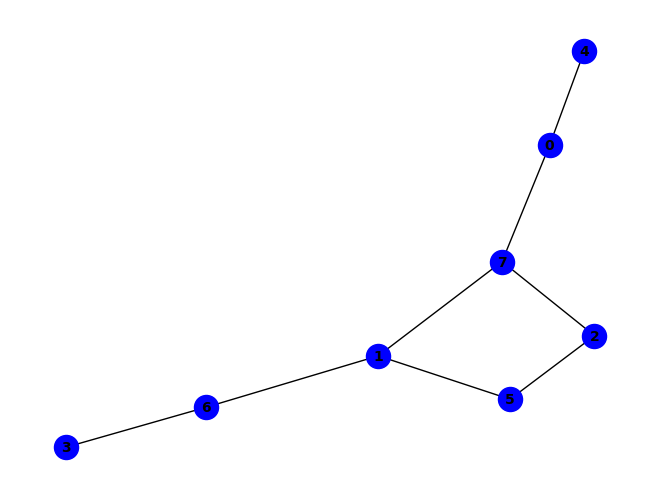


(d & ~g) ^ (b & g & ~h) ^ (~a & ~c & ~d) ^ (b & h & ~a & ~c) ^ (a & b & e & f & ~h) ^ (b & c & d & g & ~h) ^ (a & ~d & ~e & ~h) ^ (a & b & f & ~g & ~h) ^ (a & d & e & ~c & ~g) ^ (a & d & h & ~e & ~g) ^ (b & d & g & ~a & ~c) ^ (c & d & h & ~a & ~g) ^ (a & c & d & e & f & ~h) ^ (a & c & d & f & g & ~h) ^ (a & b & d & g & ~e & ~h) ^ (a & b & e & g & ~f & ~h) ^ (b & c & d & f & ~a & ~h) ^ (b & c & f & g & ~a & ~h) ^ (a & b & c & d & e & g & ~h) ^ (a & c & d & e & f & h & ~g) ^ (c & ~a & ~d & ~f & ~h) ^ (a & c & f & ~b & ~e & ~h) ^ (a & b & c & d & e & ~f & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (b & f & ~a & ~c & ~g & ~h) ^ (a & c & d & e & ~b & ~f & ~g) ^ (a & b & c & d & e & h & ~f & ~g) ^ (c & d & f & ~a & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


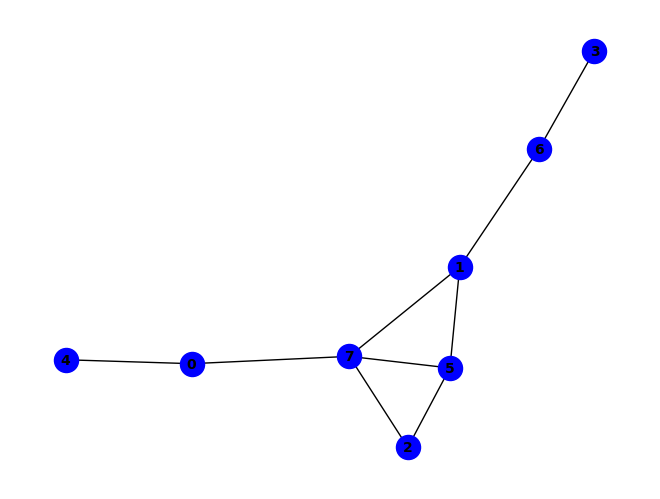


(~a & ~f) ^ (c & h & ~d) ^ (a & c & e & f) ^ (a & c & e & h) ^ (f & ~a & ~h) ^ (a & c & d & f & g) ^ (b & c & d & g & h) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~c) ^ (c & f & ~b & ~d) ^ (d & g & ~a & ~b) ^ (a & b & c & f & ~d) ^ (a & c & d & h & ~b) ^ (b & d & f & h & ~a) ^ (b & f & g & h & ~a) ^ (d & f & g & h & ~a) ^ (a & ~d & ~e & ~h) ^ (a & c & h & ~e & ~f) ^ (c & d & f & ~b & ~g) ^ (c & d & h & ~a & ~g) ^ (a & b & c & d & f & ~g) ^ (a & b & c & d & h & ~g) ^ (a & d & ~e & ~g & ~h) ^ (b & f & ~a & ~d & ~g) ^ (a & b & c & f & ~e & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & b & g & ~d & ~e & ~h) ^ (b & d & f & ~a & ~g & ~h) ^ (a & c & d & f & g & ~b & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


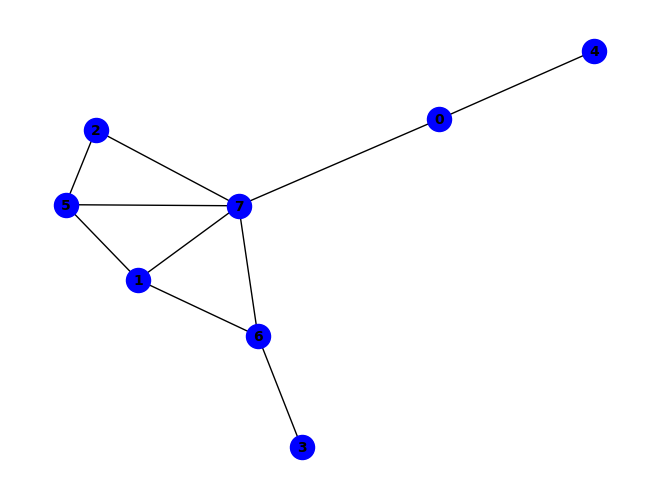


(b & g & ~a) ^ (b & h & ~a) ^ (d & ~c & ~h) ^ (g & ~a & ~h) ^ (a & d & e & ~h) ^ (~a & ~d & ~g) ^ (b & f & ~a & ~g) ^ (d & h & ~a & ~g) ^ (f & h & ~a & ~g) ^ (a & ~c & ~e & ~h) ^ (a & b & g & ~e & ~h) ^ (b & d & g & ~c & ~h) ^ (c & d & f & ~g & ~h) ^ (a & b & d & e & g & ~h) ^ (a & c & d & e & g & ~h) ^ (a & c & ~e & ~f & ~h) ^ (a & d & ~e & ~g & ~h) ^ (c & d & ~b & ~f & ~h) ^ (c & f & ~a & ~b & ~h) ^ (c & h & ~b & ~f & ~g) ^ (a & b & c & f & ~e & ~h) ^ (a & b & c & h & ~f & ~g) ^ (a & c & d & e & ~f & ~g) ^ (a & c & d & e & ~f & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & h & ~d & ~f & ~g) ^ (b & c & d & ~f & ~g & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & c & d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


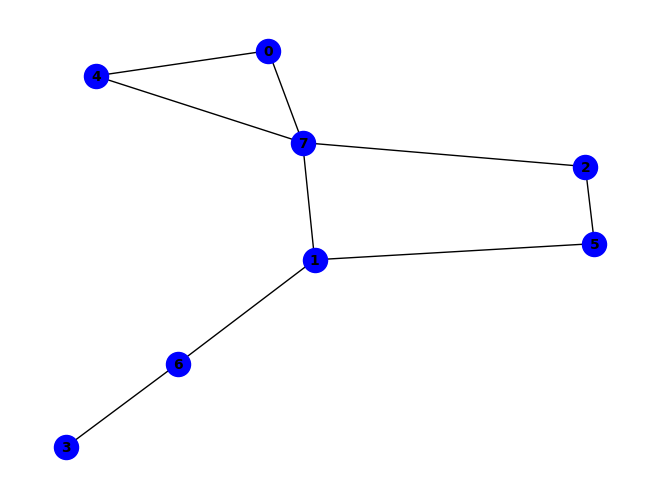


~e ^ (e & ~h) ^ (a & c & h) ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & g & ~f) ^ (b & h & ~g) ^ (d & g & ~b) ^ (a & c & e & f) ^ (b & f & g & h) ^ (a & d & h & ~g) ^ (b & e & h & ~d) ^ (a & b & d & e & g) ^ (a & b & d & g & h) ^ (b & f & ~c & ~h) ^ (c & f & ~d & ~h) ^ (c & h & ~b & ~e) ^ (a & b & e & g & ~h) ^ (a & c & e & h & ~f) ^ (b & c & d & f & ~h) ^ (b & d & e & h & ~g) ^ (c & d & g & h & ~b) ^ (d & e & g & h & ~c) ^ (b & c & d & e & g & h) ^ (a & b & h & ~c & ~e) ^ (a & d & e & ~c & ~g) ^ (a & b & c & e & f & ~h) ^ (a & c & d & e & f & ~h) ^ (a & c & d & e & h & ~g) ^ (a & b & e & f & ~g & ~h) ^ (c & d & f & ~b & ~g & ~h) ^ (a & c & d & g & h & ~b & ~e) ^ (a & b & c & d & e & f & g & ~h) ^ (a & c & d & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


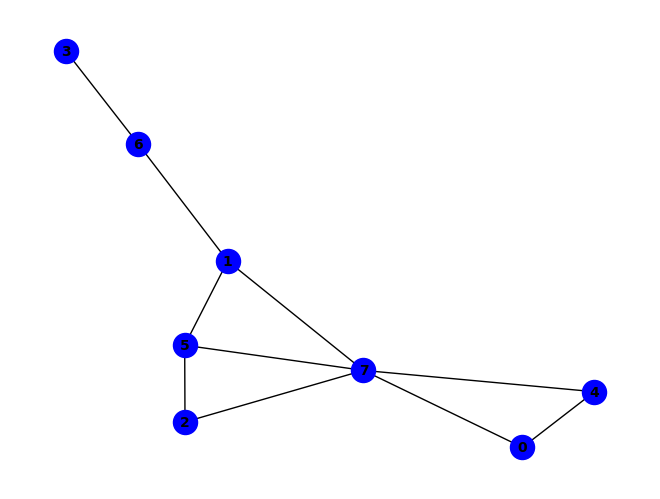


~f ^ (f & ~h) ^ (b & g & ~h) ^ (d & g & ~b) ^ (e & h & ~f) ^ (b & d & f & h) ^ (b & f & g & h) ^ (b & c & d & f & g) ^ (a & e & ~d & ~h) ^ (b & f & ~d & ~g) ^ (b & h & ~c & ~e) ^ (c & f & ~b & ~e) ^ (c & h & ~a & ~e) ^ (b & c & e & f & ~h) ^ (b & e & f & h & ~d) ^ (c & d & f & g & ~e) ^ (d & e & g & h & ~b) ^ (d & f & g & h & ~e) ^ (b & c & d & e & f & h) ^ (a & d & e & ~g & ~h) ^ (c & e & f & ~d & ~h) ^ (a & h & ~b & ~e & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & b & e & g & ~d & ~h) ^ (a & c & e & f & ~b & ~h) ^ (a & c & f & h & ~d & ~e) ^ (b & d & e & f & ~c & ~g) ^ (b & d & f & ~e & ~g & ~h) ^ (a & c & d & f & h & ~e & ~g) ^ (a & b & c & d & f & g & h & ~e) ^ (a & d & g & h & ~b & ~e & ~f) ^ (c & d & e & f & ~b & ~g & ~h) ^ (c & d & g & h & ~a & ~b & ~e) ^ (a & c & d & e & f & g & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

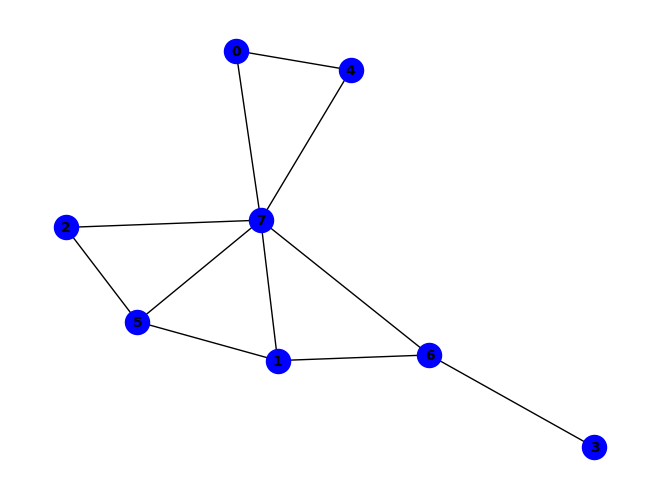


(g & ~h) ^ (~d & ~g) ^ (b & f & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & b & f & ~h) ^ (b & c & f & ~h) ^ (c & e & f & ~g) ^ (a & e & ~c & ~h) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (e & h & ~f & ~g) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (a & b & f & ~e & ~g) ^ (a & b & g & ~f & ~h) ^ (a & c & e & ~f & ~h) ^ (b & d & g & ~c & ~h) ^ (b & e & g & ~f & ~h) ^ (c & e & h & ~b & ~g) ^ (a & b & c & e & f & ~h) ^ (a & c & d & e & f & ~h) ^ (a & h & ~e & ~f & ~g) ^ (c & d & ~a & ~g & ~h) ^ (c & f & ~a & ~e & ~h) ^ (c & h & ~b & ~f & ~g) ^ (a & c & f & g & ~e & ~h) ^ (a & d & e & g & ~b & ~h) ^ (c & e & f & g & ~b & ~h) ^ (a & c & d & ~f & ~g & ~h) ^ (a & c & f & ~d & ~e & ~g) ^ (a & c & h & ~d & ~e & ~g) ^ (c & d & g & ~b & ~f & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & b & c & h & ~e & ~f & ~g) ^ (a & c & d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


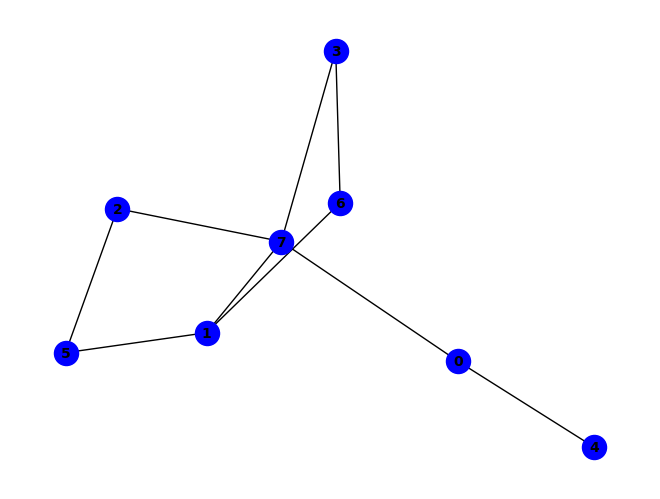


~b ^ (a & e & ~h) ^ (a & h & ~d) ^ (c & h & ~b) ^ (a & b & d & h) ^ (a & b & e & h) ^ (a & c & e & h) ^ (a & c & f & ~e) ^ (a & c & f & ~h) ^ (c & f & ~d & ~h) ^ (d & g & ~b & ~h) ^ (d & h & ~b & ~c) ^ (a & b & c & h & ~d) ^ (a & c & d & g & ~b) ^ (a & d & e & g & ~h) ^ (a & b & c & d & g & h) ^ (b & ~f & ~g & ~h) ^ (a & b & f & ~g & ~h) ^ (a & b & g & ~d & ~h) ^ (a & b & g & ~e & ~f) ^ (a & b & h & ~e & ~g) ^ (b & c & f & ~a & ~h) ^ (c & d & f & ~g & ~h) ^ (a & b & f & g & h & ~e) ^ (a & c & d & f & h & ~g) ^ (b & c & d & f & g & ~h) ^ (a & c & d & g & ~e & ~f) ^ (a & c & d & g & ~e & ~h) ^ (a & b & f & ~c & ~e & ~h) ^ (a & c & d & ~b & ~f & ~g) ^ (a & c & d & ~b & ~f & ~h) ^ (a & c & h & ~d & ~e & ~f) ^ (a & b & c & d & h & ~f & ~g) ^ (a & b & d & g & ~c & ~e & ~h) ^ (a & c & d & h & ~e & ~f & ~g) ^ (a & b & c & d & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

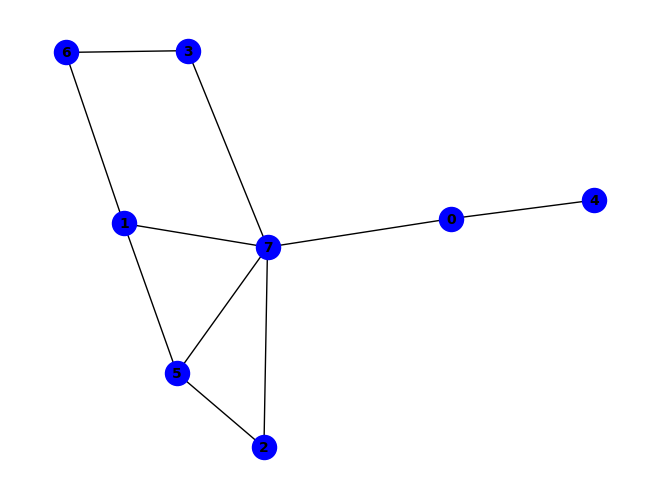


(~a & ~f) ^ (c & f & ~b) ^ (f & ~a & ~h) ^ (b & f & ~a & ~g) ^ (b & g & ~d & ~h) ^ (b & h & ~a & ~d) ^ (c & h & ~a & ~b) ^ (d & g & ~a & ~h) ^ (a & b & d & g & ~h) ^ (a & b & e & g & ~h) ^ (b & d & f & h & ~a) ^ (b & f & g & h & ~a) ^ (a & ~d & ~e & ~h) ^ (a & c & f & ~b & ~d) ^ (a & c & d & f & h & ~b) ^ (d & h & ~a & ~c & ~f) ^ (b & c & d & h & ~a & ~f) ^ (c & d & f & g & ~b & ~h) ^ (a & b & d & ~c & ~e & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & f & ~b & ~e & ~h) ^ (a & c & d & f & g & ~e & ~h) ^ (a & d & ~b & ~e & ~g & ~h) ^ (a & b & c & d & ~e & ~g & ~h) ^ (a & c & d & f & ~b & ~g & ~h) ^ (a & b & c & d & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


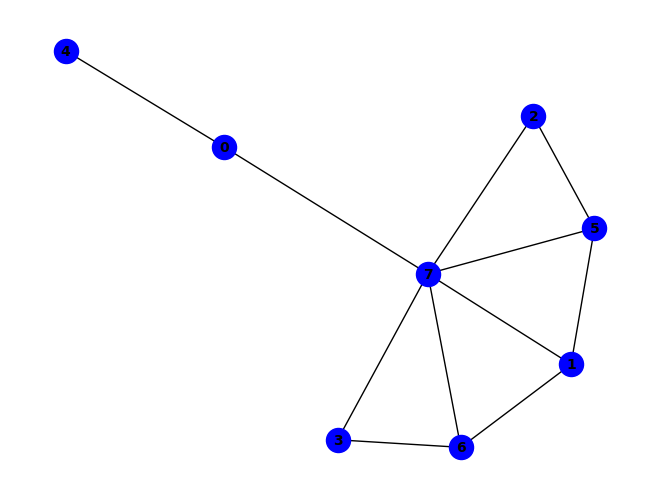


(~a & ~g) ^ (b & f & ~g) ^ (b & g & ~d) ^ (b & h & ~d) ^ (a & b & e & f) ^ (a & b & e & h) ^ (g & ~a & ~h) ^ (c & f & ~b & ~h) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (f & h & ~a & ~g) ^ (a & b & e & g & ~f) ^ (b & c & d & h & ~g) ^ (b & d & f & h & ~g) ^ (a & ~d & ~e & ~h) ^ (a & b & d & f & g & ~h) ^ (a & d & ~e & ~g & ~h) ^ (a & b & d & g & ~c & ~f) ^ (a & b & d & h & ~c & ~f) ^ (a & c & e & f & ~b & ~h) ^ (b & c & d & f & ~a & ~g) ^ (b & c & d & f & ~a & ~h) ^ (a & b & c & d & f & h & ~g) ^ (a & b & h & ~e & ~f & ~g) ^ (b & c & h & ~a & ~f & ~g) ^ (d & f & g & ~a & ~c & ~h) ^ (a & c & d & f & g & ~e & ~h) ^ (c & h & ~a & ~d & ~f & ~g) ^ (a & b & d & g & ~c & ~e & ~h) ^ (a & b & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


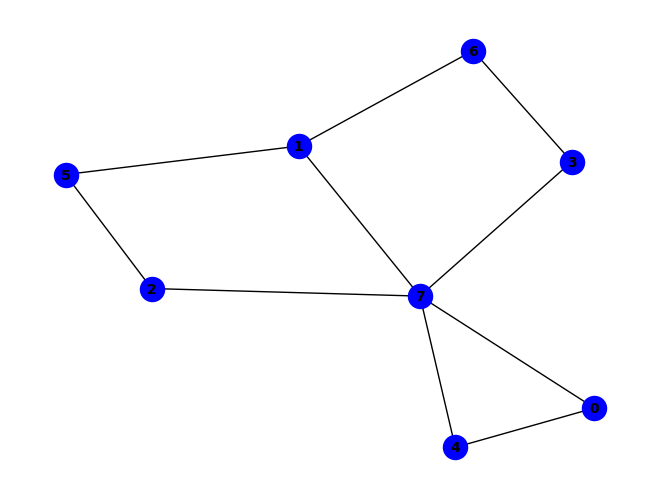


~e ^ (a & h) ^ (c & d & h) ^ (a & e & ~d) ^ (b & e & ~d) ^ (b & g & ~f) ^ (b & h & ~g) ^ (c & f & ~b) ^ (b & f & g & h) ^ (e & ~b & ~h) ^ (b & d & h & ~c) ^ (a & d & e & g & h) ^ (b & f & ~a & ~h) ^ (c & h & ~b & ~f) ^ (d & h & ~a & ~e) ^ (a & b & c & h & ~e) ^ (a & b & f & ~e & ~h) ^ (a & b & g & ~e & ~f) ^ (a & b & g & ~f & ~h) ^ (a & b & h & ~e & ~g) ^ (a & c & h & ~d & ~e) ^ (a & d & e & ~c & ~g) ^ (b & d & e & ~a & ~h) ^ (c & e & h & ~b & ~d) ^ (a & b & f & g & h & ~e) ^ (a & c & d & e & h & ~g) ^ (d & g & ~b & ~c & ~h) ^ (a & b & d & h & ~c & ~e) ^ (c & d & g & ~b & ~f & ~h) ^ (a & b & d & e & ~c & ~g & ~h) ^ (a & c & e & f & ~b & ~d & ~h) ^ (a & c & d & e & ~b & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


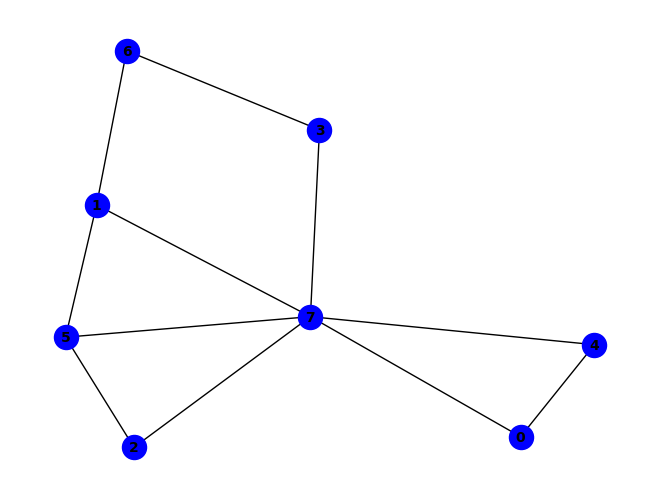


~f ^ (f & ~h) ^ (b & d & g) ^ (b & f & ~g) ^ (b & g & ~h) ^ (d & g & ~h) ^ (e & h & ~f) ^ (b & d & f & h) ^ (b & e & f & h) ^ (b & f & g & h) ^ (b & d & h & ~g) ^ (a & e & ~d & ~h) ^ (b & h & ~c & ~e) ^ (c & f & ~b & ~e) ^ (c & h & ~a & ~e) ^ (d & h & ~e & ~f) ^ (b & d & e & h & ~f) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (c & d & h & ~b & ~f) ^ (a & b & c & e & f & ~h) ^ (a & b & c & h & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & b & e & g & ~d & ~h) ^ (a & c & d & h & ~b & ~e) ^ (a & c & e & f & ~d & ~h) ^ (a & c & f & h & ~d & ~e) ^ (c & d & f & g & ~b & ~h) ^ (a & b & c & d & f & h & ~e) ^ (a & d & e & ~c & ~g & ~h) ^ (c & e & f & ~b & ~d & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & h & ~b & ~d & ~e & ~f) ^ (a & c & d & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


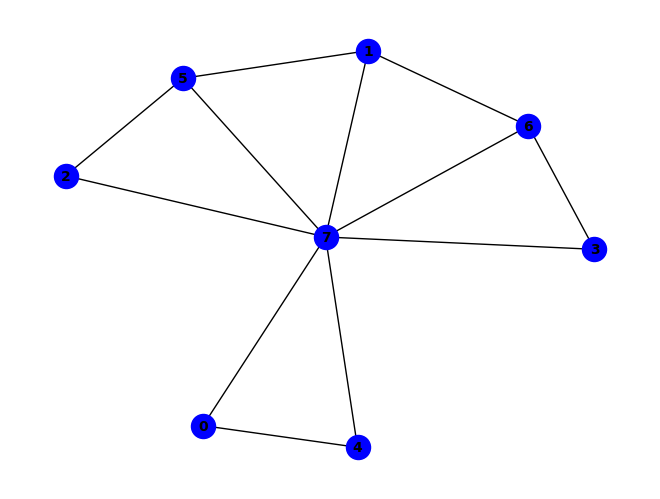


~g ^ (g & ~h) ^ (b & f & ~g) ^ (f & h & ~g) ^ (a & b & g & ~h) ^ (a & e & ~d & ~h) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & f & ~e & ~g) ^ (a & b & f & ~g & ~h) ^ (a & d & e & ~g & ~h) ^ (b & e & g & ~f & ~h) ^ (c & f & ~b & ~d & ~h) ^ (c & h & ~b & ~f & ~g) ^ (d & g & ~b & ~c & ~f) ^ (d & h & ~b & ~c & ~f) ^ (e & h & ~c & ~f & ~g) ^ (a & c & e & f & ~b & ~h) ^ (b & c & e & h & ~f & ~g) ^ (b & c & d & e & f & h & ~g) ^ (c & d & f & ~b & ~g & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (d & e & h & ~b & ~c & ~g) ^ (d & f & g & ~b & ~e & ~h) ^ (a & b & d & e & g & ~c & ~h) ^ (c & d & e & f & g & ~a & ~h) ^ (a & b & c & h & ~e & ~f & ~g) ^ (a & b & c & d & e & g & ~f & ~h) ^ (a & h & ~c & ~d & ~e & ~f & ~g) ^ (a & b & d & h & ~c & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

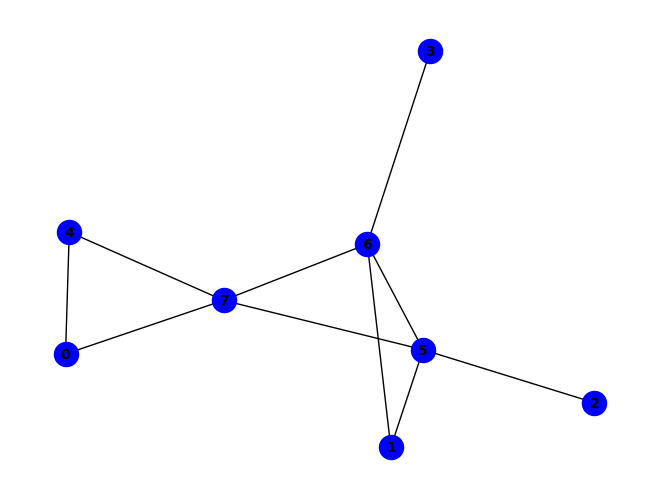


(~d & ~g) ^ (e & h & ~g) ^ (d & ~f & ~h) ^ (g & ~b & ~h) ^ (e & f & g & ~h) ^ (a & e & ~f & ~h) ^ (a & h & ~e & ~g) ^ (b & f & ~d & ~h) ^ (d & f & ~b & ~g) ^ (d & h & ~f & ~g) ^ (f & g & ~a & ~e) ^ (f & h & ~a & ~e) ^ (a & b & e & f & ~h) ^ (a & b & e & g & ~h) ^ (b & d & f & h & ~g) ^ (a & d & g & ~f & ~h) ^ (b & d & g & ~a & ~h) ^ (c & f & ~b & ~g & ~h) ^ (a & b & d & e & f & g & ~h) ^ (a & d & g & ~b & ~e & ~h) ^ (a & e & f & ~c & ~g & ~h) ^ (a & f & g & ~d & ~e & ~h) ^ (a & b & c & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


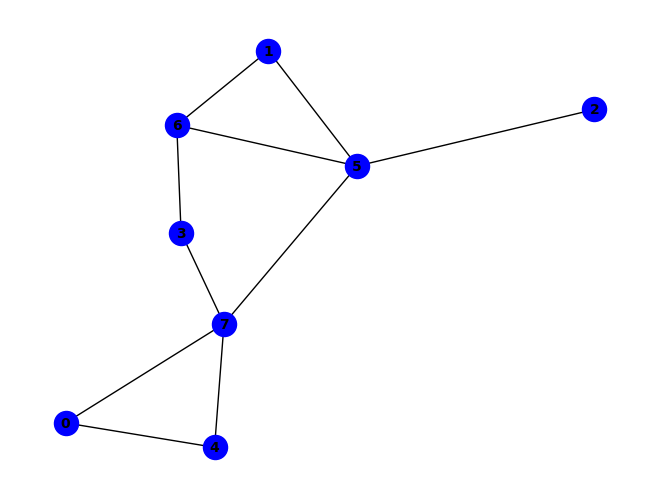


(~a & ~e) ^ (b & g & ~d) ^ (d & e & ~f) ^ (d & h & ~f) ^ (f & g & ~h) ^ (b & d & f & g) ^ (b & f & g & h) ^ (e & ~d & ~h) ^ (a & b & g & ~h) ^ (a & f & ~g & ~h) ^ (b & f & ~a & ~h) ^ (d & g & ~f & ~h) ^ (f & h & ~a & ~e) ^ (a & d & e & g & ~h) ^ (a & ~c & ~f & ~h) ^ (a & b & c & ~f & ~h) ^ (a & b & c & ~g & ~h) ^ (a & b & g & ~c & ~e) ^ (a & c & e & ~g & ~h) ^ (a & d & h & ~e & ~f) ^ (a & f & g & ~e & ~h) ^ (d & e & f & ~a & ~h) ^ (a & b & c & g & h & ~e) ^ (a & b & d & e & g & ~f) ^ (a & b & d & g & h & ~f) ^ (a & b & f & g & h & ~e) ^ (c & f & ~b & ~g & ~h) ^ (a & d & e & f & ~g & ~h) ^ (b & e & g & h & ~d & ~f) ^ (a & b & f & ~c & ~e & ~h) ^ (a & c & g & ~b & ~f & ~h) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


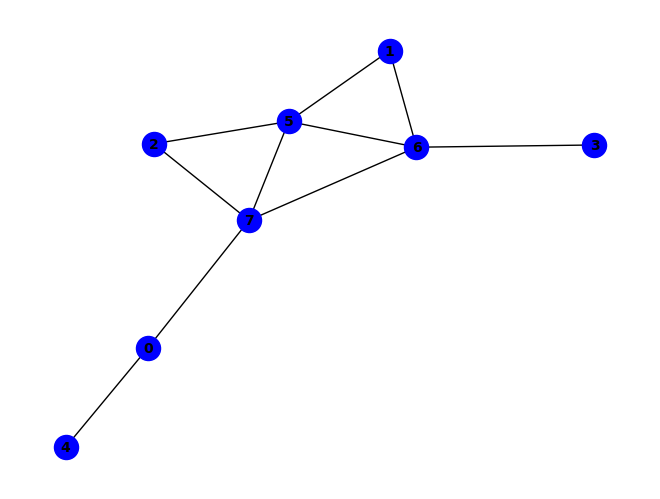


(f & g & ~a) ^ (f & h & ~a) ^ (~a & ~d & ~g) ^ (b & f & ~d & ~h) ^ (c & f & ~a & ~g) ^ (c & h & ~a & ~g) ^ (d & f & ~b & ~g) ^ (a & b & e & f & ~h) ^ (a & d & e & f & ~g) ^ (b & d & f & h & ~g) ^ (d & ~a & ~f & ~h) ^ (g & ~a & ~b & ~h) ^ (a & d & g & ~e & ~h) ^ (b & d & g & ~a & ~h) ^ (a & b & d & f & g & ~h) ^ (a & f & ~e & ~g & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & d & f & h & ~e & ~g) ^ (a & ~c & ~e & ~f & ~h) ^ (a & b & c & ~e & ~f & ~h) ^ (a & b & g & ~d & ~e & ~h) ^ (a & d & f & ~b & ~e & ~h) ^ (b & c & f & ~a & ~g & ~h) ^ (a & c & ~b & ~e & ~g & ~h) ^ (a & b & d & f & ~e & ~g & ~h) ^ (a & c & g & ~b & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


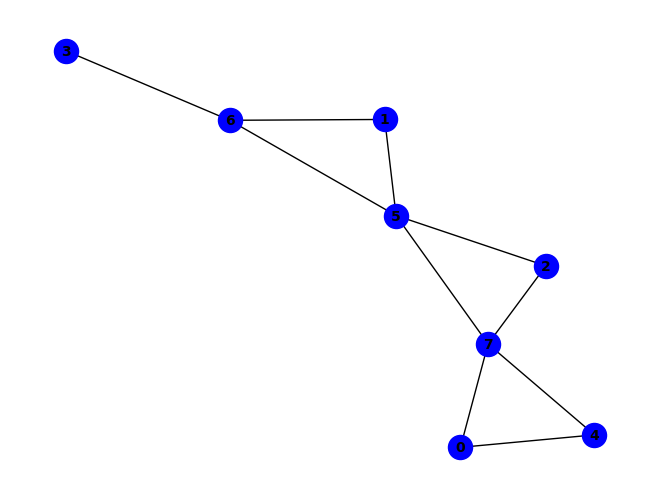


(~a & ~e) ^ (b & g & ~d) ^ (d & g & ~f) ^ (f & g & ~h) ^ (b & d & f & g) ^ (a & ~f & ~h) ^ (e & ~d & ~h) ^ (a & b & g & ~e) ^ (a & b & g & ~h) ^ (d & e & g & ~a) ^ (a & d & e & f & g) ^ (a & f & ~g & ~h) ^ (b & f & ~c & ~h) ^ (d & e & ~g & ~h) ^ (f & h & ~a & ~e) ^ (a & b & e & f & ~h) ^ (b & c & f & g & ~h) ^ (b & e & g & h & ~d) ^ (c & d & f & h & ~e) ^ (c & d & g & h & ~e) ^ (a & c & d & e & f & h) ^ (b & c & d & e & g & h) ^ (a & f & g & ~e & ~h) ^ (c & d & f & ~e & ~g) ^ (a & b & d & e & g & ~f) ^ (a & b & d & g & h & ~f) ^ (b & c & d & e & f & ~g) ^ (d & e & f & g & h & ~b) ^ (c & f & ~d & ~g & ~h) ^ (c & h & ~a & ~e & ~f) ^ (a & d & g & h & ~c & ~f) ^ (b & f & g & h & ~a & ~e) ^ (a & c & d & e & g & h & ~b) ^ (b & c & d & e & f & h & ~a) ^ (a & c & d & e & f & ~b & ~g) ^ (b & c & d & g & h & ~a & ~f) ^ (b & c & g & h & ~a & ~e & ~f) ^ (c & d & e & f & ~b & ~g & ~h) ^ (a & c & e & f & ~b & ~d & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

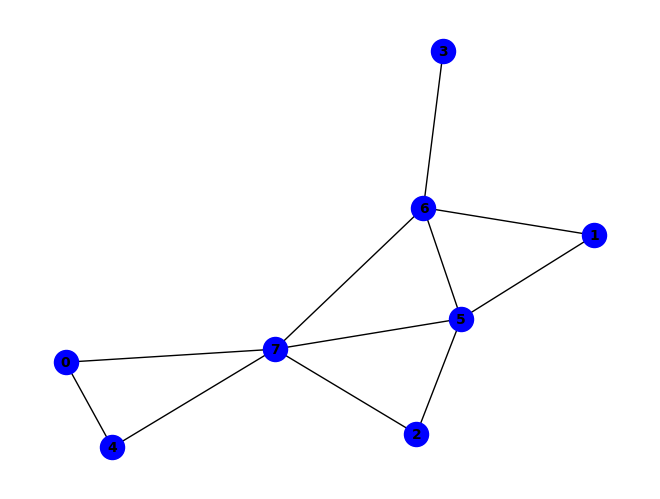


(~d & ~g) ^ (c & f & ~g) ^ (c & h & ~g) ^ (d & ~f & ~h) ^ (g & ~b & ~h) ^ (e & f & g & ~h) ^ (a & e & ~f & ~h) ^ (b & f & ~d & ~h) ^ (d & f & ~b & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~c & ~g) ^ (f & g & ~a & ~e) ^ (f & h & ~a & ~e) ^ (a & b & e & g & ~h) ^ (c & e & f & h & ~g) ^ (a & d & g & ~f & ~h) ^ (a & f & g & ~e & ~h) ^ (b & d & g & ~a & ~h) ^ (a & b & d & e & f & ~g) ^ (a & d & ~e & ~f & ~g) ^ (a & d & ~e & ~f & ~h) ^ (a & b & d & g & ~e & ~h) ^ (a & b & e & f & ~d & ~h) ^ (b & d & f & h & ~a & ~g) ^ (a & e & f & ~c & ~g & ~h) ^ (b & c & f & ~a & ~g & ~h) ^ (a & h & ~c & ~d & ~e & ~g) ^ (a & b & c & f & ~e & ~g & ~h) ^ (a & c & d & h & ~e & ~f & ~g) ^ (a & c & f & h & ~d & ~e & ~g) ^ (a & d & f & h & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


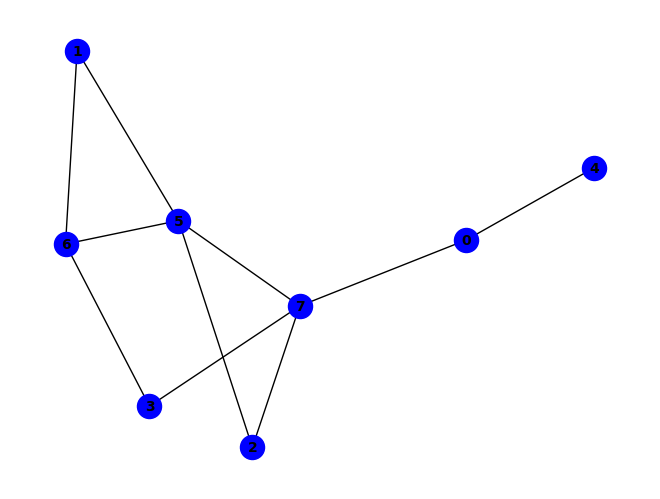


~d ^ (a & e) ^ (a & b & g) ^ (a & h & ~e) ^ (b & g & ~d) ^ (a & d & e & h) ^ (b & d & f & g) ^ (d & ~g & ~h) ^ (a & d & g & ~e) ^ (b & f & ~a & ~h) ^ (c & h & ~d & ~f) ^ (f & g & ~d & ~h) ^ (f & h & ~a & ~d) ^ (a & c & d & h & ~f) ^ (a & c & e & h & ~f) ^ (a & e & f & g & ~h) ^ (b & f & g & h & ~a) ^ (a & b & f & ~e & ~h) ^ (a & b & g & ~e & ~h) ^ (a & d & g & ~f & ~h) ^ (a & d & h & ~e & ~g) ^ (a & b & c & g & h & ~f) ^ (a & c & ~e & ~f & ~g) ^ (a & c & g & h & ~e & ~f) ^ (a & d & f & g & ~e & ~h) ^ (b & c & g & h & ~d & ~f) ^ (a & b & d & e & g & ~f & ~h) ^ (a & b & d & g & h & ~c & ~f) ^ (a & c & ~b & ~e & ~g & ~h) ^ (c & f & ~a & ~b & ~g & ~h) ^ (a & b & c & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


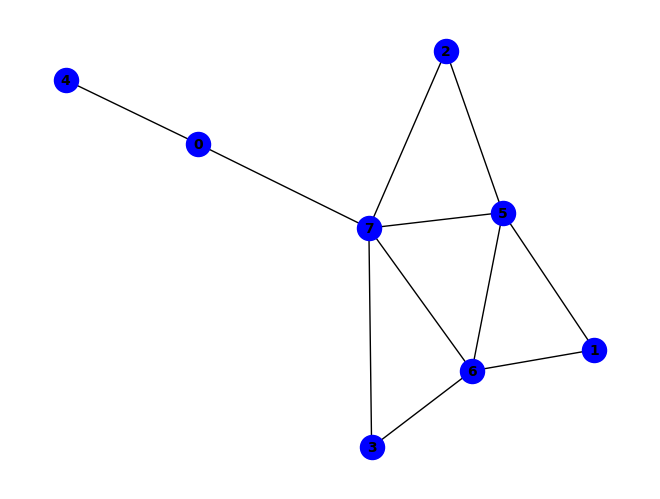


(c & g & ~d) ^ (f & g & ~a) ^ (f & h & ~a) ^ (a & c & e & g) ^ (a & c & d & f & h) ^ (~a & ~b & ~g) ^ (b & h & ~a & ~g) ^ (c & f & ~a & ~g) ^ (c & h & ~a & ~d) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (a & c & d & g & ~f) ^ (a & c & g & h & ~e) ^ (c & d & f & h & ~g) ^ (a & ~e & ~f & ~h) ^ (g & ~a & ~c & ~h) ^ (a & c & f & ~e & ~h) ^ (c & d & g & ~a & ~h) ^ (a & c & d & f & g & ~h) ^ (a & f & ~e & ~g & ~h) ^ (b & c & ~a & ~g & ~h) ^ (b & ~a & ~c & ~f & ~h) ^ (a & b & f & ~d & ~e & ~h) ^ (a & b & g & ~d & ~e & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (a & d & g & ~e & ~f & ~h) ^ (b & c & g & ~a & ~f & ~h) ^ (b & d & g & ~a & ~f & ~h) ^ (a & b & c & f & ~e & ~g & ~h) ^ (a & b & d & f & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


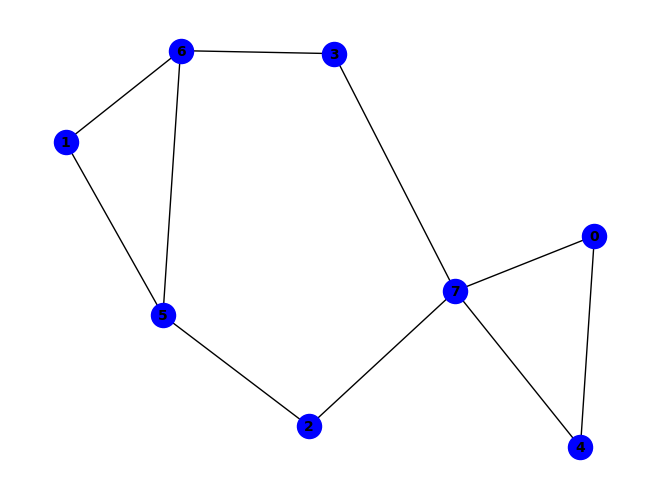


(d & f & g) ^ (~c & ~f) ^ (b & f & ~e) ^ (b & g & ~d) ^ (d & g & ~h) ^ (d & h & ~e) ^ (c & ~f & ~h) ^ (b & c & f & ~g) ^ (b & e & f & ~h) ^ (a & d & e & f & g) ^ (b & c & d & g & h) ^ (b & c & e & f & h) ^ (d & e & f & g & h) ^ (a & e & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & b & e & f & ~d) ^ (a & b & e & g & ~d) ^ (a & d & e & g & ~h) ^ (a & d & e & h & ~c) ^ (b & c & g & h & ~f) ^ (b & d & f & g & ~h) ^ (f & ~c & ~e & ~g) ^ (a & c & e & ~f & ~h) ^ (a & e & f & ~c & ~g) ^ (c & d & h & ~e & ~f) ^ (a & b & c & e & f & ~g) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (a & c & d & e & f & g & h) ^ (a & h & ~c & ~d & ~f) ^ (e & f & ~c & ~g & ~h) ^ (a & b & f & h & ~c & ~d) ^ (a & b & g & h & ~c & ~d) ^ (b & d & f & h & ~c & ~e) ^ (b & e & g & h & ~c & ~d) ^ (c & d & f & h & ~e & ~g) ^ (a & b & c & e & g & h & ~f) ^ (a & f & h & ~c & ~d & ~g) ^ (a & b & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

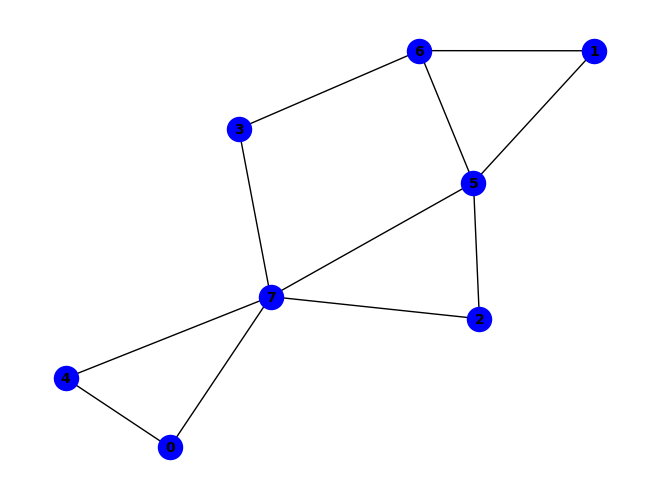


(~a & ~e) ^ (b & g & ~d) ^ (d & e & ~f) ^ (f & g & ~h) ^ (b & d & f & g) ^ (b & f & g & h) ^ (a & ~f & ~h) ^ (e & ~d & ~h) ^ (a & b & g & ~e) ^ (a & b & g & ~h) ^ (a & f & ~g & ~h) ^ (b & f & ~c & ~h) ^ (c & f & ~g & ~h) ^ (d & g & ~f & ~h) ^ (d & h & ~c & ~f) ^ (f & h & ~a & ~e) ^ (a & b & e & f & ~h) ^ (b & c & f & g & ~h) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (a & f & g & ~e & ~h) ^ (d & e & f & ~c & ~h) ^ (a & b & c & g & h & ~e) ^ (a & b & d & e & g & ~f) ^ (a & b & d & g & h & ~f) ^ (b & c & d & e & h & ~g) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (c & h & ~a & ~e & ~f) ^ (a & d & e & g & ~f & ~h) ^ (b & c & g & h & ~e & ~f) ^ (b & e & g & h & ~d & ~f) ^ (b & c & d & e & f & g & ~h) ^ (a & d & h & ~c & ~e & ~f) ^ (a & b & f & g & h & ~c & ~e) ^ (b & c & d & e & f & ~a & ~g) ^ (b & c & d & g & h & ~a & ~f) ^ (a & c & e & f & ~b & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

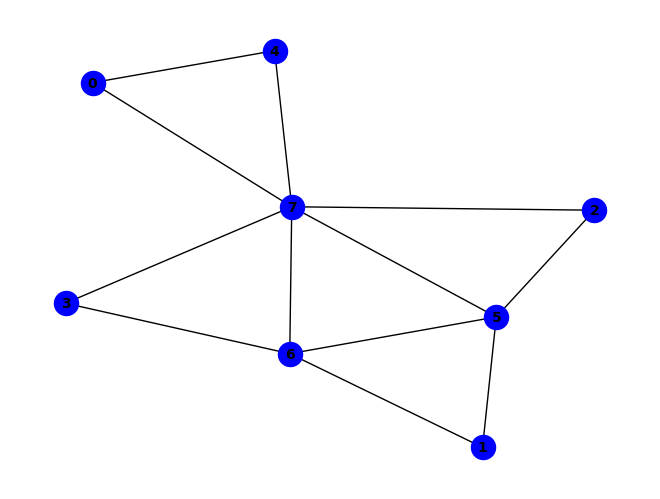


(~b & ~g) ^ (b & h & ~g) ^ (c & f & ~g) ^ (d & g & ~f) ^ (d & h & ~f) ^ (g & ~c & ~h) ^ (a & c & d & e & f) ^ (a & c & d & e & h) ^ (a & e & ~f & ~h) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (e & h & ~d & ~g) ^ (f & g & ~a & ~e) ^ (f & h & ~a & ~e) ^ (a & b & e & f & ~h) ^ (a & b & e & g & ~h) ^ (a & d & e & f & ~h) ^ (a & d & f & g & ~e) ^ (a & d & f & h & ~e) ^ (c & d & e & h & ~g) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & ~c & ~f & ~h) ^ (a & c & g & ~e & ~h) ^ (b & c & g & ~f & ~h) ^ (c & e & g & ~a & ~h) ^ (e & f & g & ~d & ~h) ^ (a & c & d & e & g & ~f) ^ (a & h & ~d & ~e & ~g) ^ (b & c & ~a & ~g & ~h) ^ (a & c & e & f & ~d & ~h) ^ (a & c & e & g & ~f & ~h) ^ (a & c & f & h & ~e & ~g) ^ (a & d & e & g & ~c & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & e & f & ~d & ~g & ~h) ^ (a & f & g & ~d & ~e & ~h) ^ (b & d & g & ~a & ~f & ~h) ^ (c & d & h & ~a & ~f & ~g) ^ (c & d & e & f & g & ~a & ~h) ^ (a & b & c & e & ~f & ~g & ~h) ^ (a & b & d & g & ~e & ~f

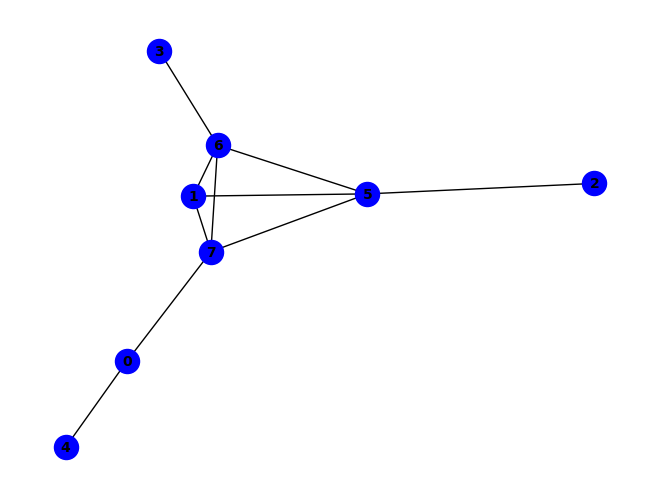


(b & h & ~a) ^ (f & g & ~a) ^ (f & h & ~a) ^ (g & ~a & ~h) ^ (~a & ~d & ~g) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~c) ^ (d & f & ~b & ~g) ^ (a & d & e & f & ~g) ^ (b & d & f & h & ~g) ^ (d & ~a & ~f & ~h) ^ (a & b & g & ~e & ~h) ^ (a & d & f & ~e & ~h) ^ (b & c & f & ~a & ~h) ^ (b & c & g & ~a & ~f) ^ (b & d & f & ~a & ~h) ^ (b & d & g & ~a & ~h) ^ (b & f & g & ~a & ~h) ^ (b & c & f & g & h & ~a) ^ (a & f & ~e & ~g & ~h) ^ (c & f & ~a & ~g & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & b & d & f & ~e & ~g) ^ (a & b & d & f & ~g & ~h) ^ (a & ~c & ~e & ~f & ~h) ^ (a & b & f & ~d & ~e & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (a & d & g & ~b & ~e & ~h) ^ (a & c & ~b & ~e & ~g & ~h) ^ (a & d & f & h & ~b & ~e & ~g) ^ (a & b & c & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


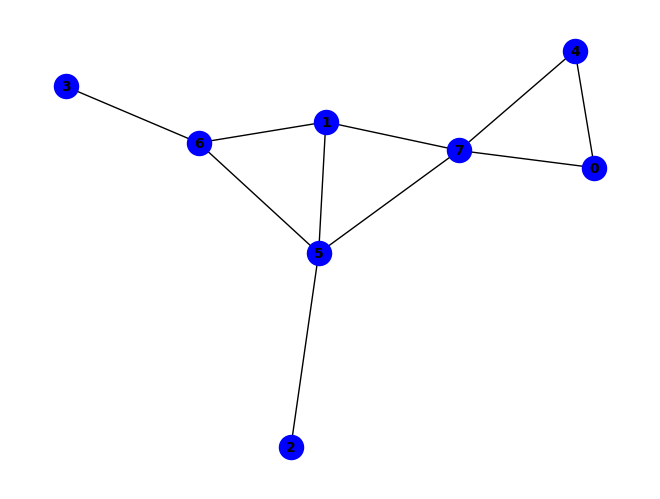


(~a & ~e) ^ (b & g & ~d) ^ (b & h & ~g) ^ (d & g & ~f) ^ (f & g & ~h) ^ (e & ~d & ~h) ^ (a & b & f & ~h) ^ (a & b & h & ~e) ^ (b & e & h & ~d) ^ (d & e & g & ~a) ^ (a & b & d & e & g) ^ (d & e & f & g & h) ^ (b & f & ~a & ~e) ^ (d & e & ~g & ~h) ^ (f & h & ~a & ~e) ^ (a & b & e & g & ~h) ^ (a & d & e & f & ~b) ^ (a & d & f & h & ~b) ^ (a & d & g & h & ~b) ^ (b & d & e & h & ~g) ^ (b & d & f & g & ~e) ^ (a & ~c & ~f & ~h) ^ (a & d & f & ~e & ~g) ^ (a & f & g & ~e & ~h) ^ (b & e & f & ~d & ~h) ^ (a & b & d & e & f & ~g) ^ (a & b & d & f & h & ~g) ^ (a & f & ~d & ~g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (a & b & c & e & ~f & ~h) ^ (b & d & e & f & ~g & ~h) ^ (a & c & e & ~b & ~g & ~h) ^ (a & c & g & ~b & ~f & ~h) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


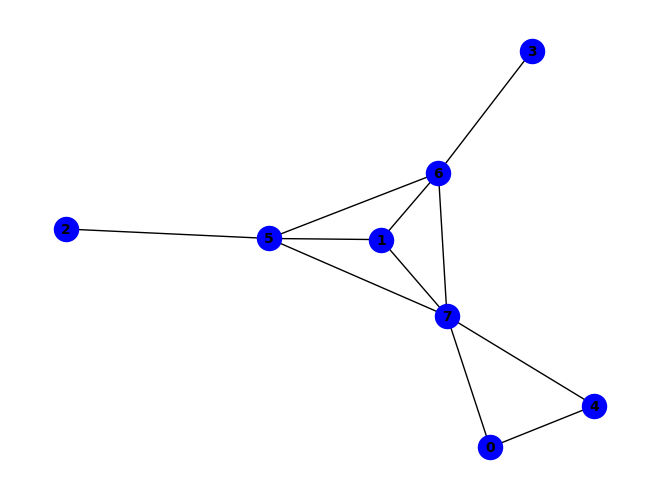


(g & ~h) ^ (~d & ~g) ^ (e & h & ~g) ^ (d & ~f & ~h) ^ (b & d & f & ~h) ^ (b & e & f & ~h) ^ (b & f & g & ~h) ^ (e & f & g & ~h) ^ (a & e & ~f & ~h) ^ (a & h & ~e & ~g) ^ (b & f & ~a & ~e) ^ (b & g & ~c & ~f) ^ (b & h & ~a & ~e) ^ (d & f & ~b & ~g) ^ (d & h & ~f & ~g) ^ (f & g & ~a & ~e) ^ (f & h & ~a & ~e) ^ (a & b & e & g & ~h) ^ (b & c & g & h & ~f) ^ (b & d & f & h & ~g) ^ (b & e & g & h & ~f) ^ (a & b & f & ~d & ~h) ^ (a & e & f & ~g & ~h) ^ (a & f & g & ~e & ~h) ^ (b & d & g & ~a & ~h) ^ (b & c & ~a & ~f & ~h) ^ (b & c & ~a & ~g & ~h) ^ (c & f & ~a & ~g & ~h) ^ (a & b & d & f & ~g & ~h) ^ (a & b & g & h & ~e & ~f) ^ (a & d & e & g & ~f & ~h) ^ (a & b & c & ~e & ~f & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & c & f & ~e & ~g & ~h) ^ (a & b & c & e & g & ~f & ~h) ^ (a & b & d & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

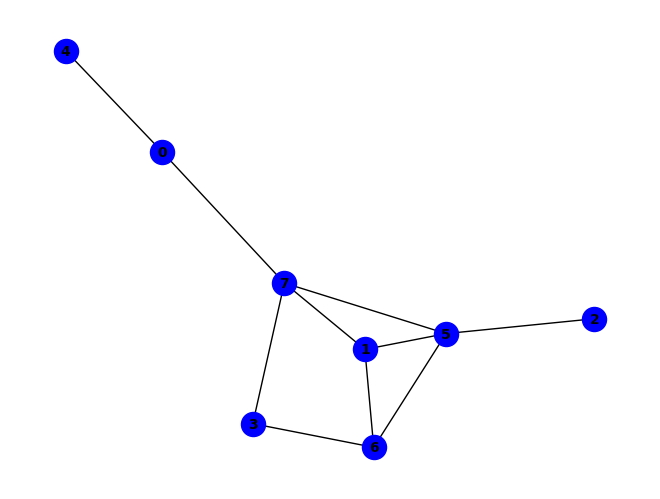


~d ^ (a & e) ^ (a & h & ~e) ^ (b & f & ~d) ^ (b & h & ~d) ^ (f & h & ~d) ^ (a & b & e & f) ^ (d & ~g & ~h) ^ (a & b & g & ~d) ^ (a & d & h & ~f) ^ (a & f & g & ~d) ^ (a & f & h & ~g) ^ (a & b & d & f & g) ^ (a & d & f & g & h) ^ (b & g & ~d & ~h) ^ (f & g & ~d & ~h) ^ (a & b & f & h & ~e) ^ (a & d & e & g & ~h) ^ (a & b & h & ~d & ~g) ^ (b & d & f & ~g & ~h) ^ (a & b & d & f & h & ~g) ^ (c & f & ~b & ~g & ~h) ^ (a & b & g & ~d & ~e & ~h) ^ (a & f & g & ~d & ~e & ~h) ^ (a & b & d & f & g & ~e & ~h) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


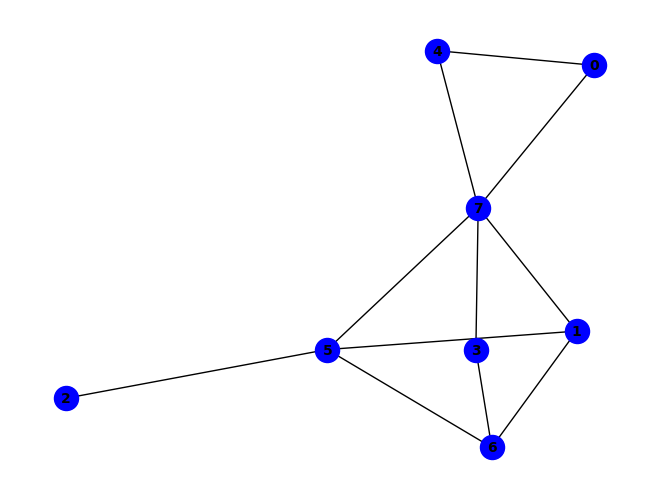


(~a & ~e) ^ (b & g & ~d) ^ (d & e & ~f) ^ (d & h & ~f) ^ (f & g & ~h) ^ (e & ~d & ~h) ^ (b & e & f & ~h) ^ (b & e & h & ~d) ^ (a & f & ~g & ~h) ^ (b & f & ~a & ~e) ^ (b & h & ~d & ~g) ^ (d & g & ~f & ~h) ^ (f & h & ~a & ~e) ^ (b & d & f & g & ~h) ^ (b & d & f & h & ~e) ^ (a & ~c & ~f & ~h) ^ (a & b & f & ~c & ~h) ^ (a & b & g & ~c & ~e) ^ (a & b & g & ~c & ~h) ^ (a & b & h & ~e & ~g) ^ (a & c & e & ~g & ~h) ^ (a & f & g & ~e & ~h) ^ (d & e & f & ~a & ~h) ^ (a & b & d & e & f & ~h) ^ (c & f & ~b & ~g & ~h) ^ (a & b & c & f & ~e & ~h) ^ (a & b & c & g & ~e & ~f) ^ (a & d & e & g & ~b & ~h) ^ (a & b & c & f & g & h & ~e) ^ (a & c & g & ~b & ~f & ~h) ^ (a & d & h & ~b & ~e & ~f) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


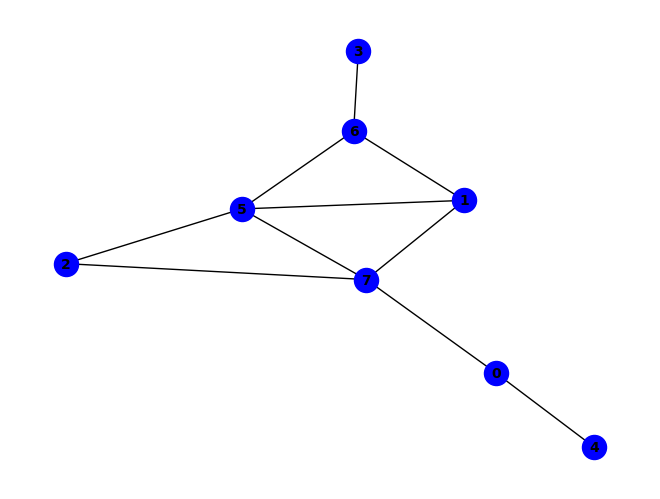


~d ^ (b & d & g) ^ (d & f & g) ^ (a & e & ~d) ^ (a & h & ~e) ^ (b & f & ~d) ^ (b & h & ~a) ^ (f & h & ~a) ^ (d & ~c & ~g) ^ (a & c & h & ~f) ^ (a & d & e & g & h) ^ (b & g & ~a & ~h) ^ (c & d & ~g & ~h) ^ (c & h & ~d & ~f) ^ (f & g & ~a & ~h) ^ (a & b & e & f & ~d) ^ (a & b & f & h & ~e) ^ (a & d & e & f & ~h) ^ (c & d & f & h & ~g) ^ (a & b & d & e & f & h) ^ (a & b & g & ~e & ~h) ^ (a & d & e & ~f & ~g) ^ (a & f & g & ~e & ~h) ^ (b & c & h & ~a & ~f) ^ (b & d & f & ~c & ~g) ^ (a & b & d & e & g & ~h) ^ (a & b & d & g & h & ~f) ^ (a & d & e & f & h & ~g) ^ (b & c & d & f & h & ~a) ^ (b & c & d & g & h & ~a) ^ (c & f & ~b & ~g & ~h) ^ (a & d & g & h & ~c & ~f) ^ (b & c & d & f & ~g & ~h) ^ (a & b & c & d & f & h & ~g) ^ (a & b & d & e & f & ~g & ~h) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

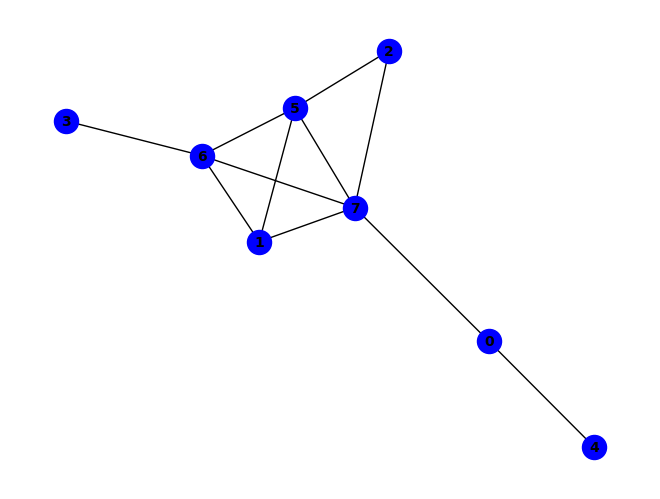


(b & f & ~g) ^ (b & g & ~c) ^ (f & g & ~a) ^ (f & h & ~a) ^ (a & b & e & f) ^ (g & ~a & ~h) ^ (a & b & g & ~f) ^ (b & c & g & ~h) ^ (a & b & c & g & h) ^ (~a & ~d & ~g) ^ (b & h & ~a & ~c) ^ (c & h & ~a & ~g) ^ (d & f & ~b & ~g) ^ (a & b & f & h & ~e) ^ (d & ~a & ~f & ~h) ^ (a & b & g & ~e & ~h) ^ (b & d & f & ~a & ~h) ^ (b & d & g & ~a & ~h) ^ (b & f & g & ~a & ~h) ^ (a & f & ~e & ~g & ~h) ^ (c & f & ~a & ~b & ~g) ^ (d & h & ~a & ~f & ~g) ^ (a & d & e & f & ~b & ~g) ^ (b & d & f & h & ~a & ~g) ^ (a & ~c & ~e & ~f & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (a & d & f & ~b & ~e & ~h) ^ (a & d & g & ~b & ~e & ~h) ^ (a & c & ~b & ~e & ~g & ~h) ^ (a & d & f & h & ~b & ~e & ~g) ^ (a & b & c & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


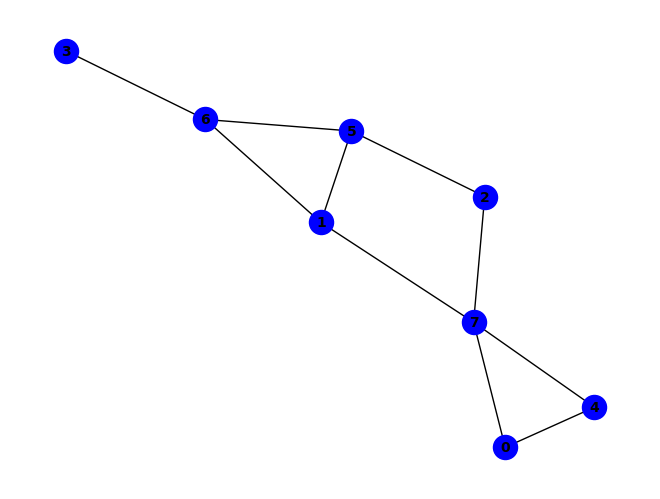


(~c & ~f) ^ (b & h & ~g) ^ (d & g & ~f) ^ (c & ~f & ~h) ^ (b & e & h & ~f) ^ (a & e & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & g & ~d & ~f) ^ (e & h & ~c & ~f) ^ (a & b & e & f & ~h) ^ (a & b & e & g & ~h) ^ (d & e & g & h & ~f) ^ (f & ~c & ~e & ~g) ^ (a & c & e & ~f & ~h) ^ (a & e & f & ~c & ~g) ^ (a & f & h & ~c & ~g) ^ (b & c & f & ~e & ~g) ^ (b & c & h & ~e & ~f) ^ (b & e & f & ~d & ~g) ^ (a & b & c & f & h & ~g) ^ (b & c & d & g & h & ~f) ^ (b & d & e & f & h & ~c) ^ (b & d & e & g & h & ~c) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (b & f & ~e & ~g & ~h) ^ (e & f & ~c & ~g & ~h) ^ (a & b & f & h & ~e & ~g) ^ (a & d & e & g & ~b & ~f) ^ (b & c & e & f & ~g & ~h) ^ (b & d & e & f & ~g & ~h) ^ (c & d & g & h & ~e & ~f) ^ (a & c & d & e & g & h & ~f) ^ (b & c & d & e & f & h & ~g) ^ (a & b & h & ~c & ~e & ~f) ^ (a & b & c & e & f & ~d & ~g) ^ (a & d & g & h & ~b & ~c & ~f) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


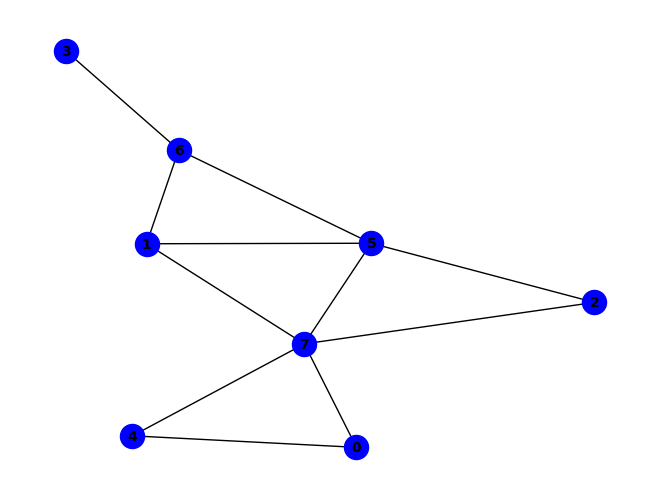


(~a & ~e) ^ (f & g & ~h) ^ (a & ~f & ~h) ^ (e & ~d & ~h) ^ (a & b & f & ~h) ^ (d & e & g & ~a) ^ (a & d & e & f & g) ^ (b & d & e & f & g) ^ (d & e & f & g & h) ^ (a & f & ~g & ~h) ^ (b & f & ~a & ~e) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~e) ^ (d & e & ~g & ~h) ^ (d & g & ~b & ~f) ^ (f & h & ~a & ~e) ^ (c & d & f & h & ~e) ^ (c & d & g & h & ~e) ^ (a & c & d & e & f & h) ^ (a & b & g & ~e & ~h) ^ (a & f & g & ~e & ~h) ^ (b & c & f & ~g & ~h) ^ (b & e & f & ~d & ~h) ^ (c & d & f & ~e & ~g) ^ (a & b & d & e & g & ~f) ^ (a & b & d & g & h & ~f) ^ (b & c & d & e & f & ~g) ^ (b & d & e & g & h & ~c) ^ (c & f & ~d & ~g & ~h) ^ (a & d & g & h & ~c & ~f) ^ (b & d & e & f & ~g & ~h) ^ (a & c & d & e & g & h & ~b) ^ (b & c & d & e & f & h & ~a) ^ (a & c & d & e & f & ~b & ~g) ^ (b & c & d & g & h & ~a & ~f) ^ (c & h & ~a & ~b & ~e & ~f) ^ (c & d & e & f & ~b & ~g & ~h) ^ (a & c & e & f & ~b & ~d & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


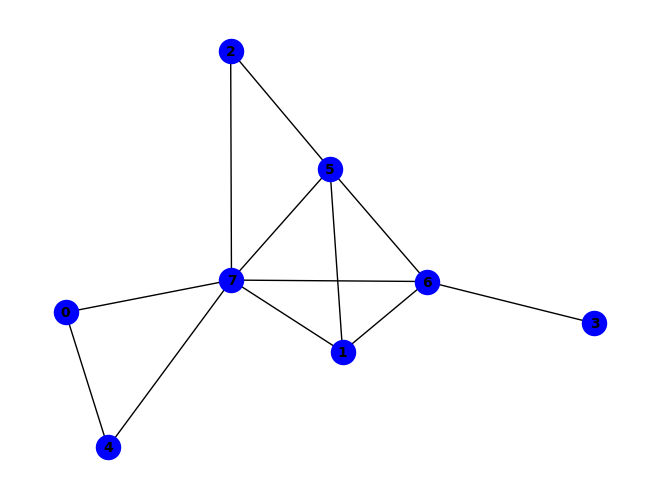


(g & ~h) ^ (~d & ~g) ^ (d & ~f & ~h) ^ (e & f & g & ~h) ^ (a & e & ~f & ~h) ^ (a & h & ~e & ~g) ^ (b & f & ~d & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & f & ~b & ~g) ^ (c & h & ~b & ~g) ^ (d & f & ~a & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~c & ~g) ^ (f & g & ~a & ~e) ^ (f & h & ~a & ~e) ^ (a & b & e & f & ~h) ^ (b & c & e & h & ~g) ^ (b & d & f & h & ~g) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & e & f & h & ~g) ^ (a & e & f & ~g & ~h) ^ (a & f & g & ~e & ~h) ^ (b & d & f & ~a & ~h) ^ (b & d & g & ~a & ~h) ^ (b & e & g & ~a & ~h) ^ (b & f & g & ~e & ~h) ^ (a & d & e & f & h & ~g) ^ (b & c & e & f & g & ~h) ^ (a & b & c & h & ~e & ~g) ^ (a & b & d & f & ~e & ~h) ^ (a & b & d & f & ~g & ~h) ^ (a & d & e & f & ~c & ~h) ^ (a & d & e & g & ~c & ~h) ^ (a & b & g & ~d & ~e & ~h) ^ (a & c & h & ~e & ~f & ~g) ^ (a & d & f & ~b & ~e & ~g) ^ (a & c & d & e & g & ~f & ~h) ^ (a & b & c & d & e & f & ~g & ~h) ^ (a & b & c & d & f & h & ~e & ~g) ^ (a & b & f & h & ~c & ~d & ~e & ~g

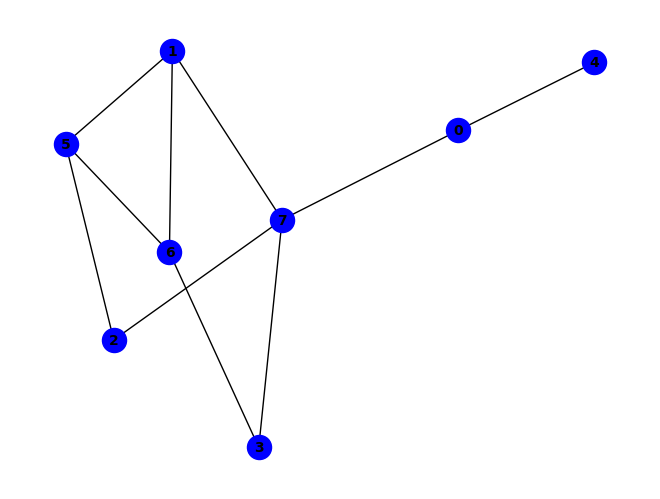


~f ^ (a & b & f & g) ^ (a & b & h & ~d) ^ (d & f & g & ~b) ^ (a & h & ~d & ~f) ^ (b & g & ~f & ~h) ^ (b & h & ~c & ~f) ^ (c & h & ~a & ~f) ^ (d & g & ~b & ~h) ^ (d & h & ~b & ~c) ^ (a & d & e & g & ~h) ^ (a & b & d & f & g & h) ^ (f & ~b & ~c & ~g) ^ (a & b & f & ~e & ~h) ^ (a & b & f & ~g & ~h) ^ (a & e & f & ~d & ~g) ^ (c & d & f & g & h & ~b) ^ (a & e & ~c & ~f & ~h) ^ (a & b & c & e & ~f & ~g) ^ (a & b & c & h & ~e & ~f) ^ (a & b & e & g & ~d & ~h) ^ (a & c & d & h & ~b & ~f) ^ (a & c & e & g & ~f & ~h) ^ (a & d & e & f & ~b & ~h) ^ (a & b & c & e & g & h & ~f) ^ (a & c & e & ~b & ~g & ~h) ^ (a & f & h & ~d & ~e & ~g) ^ (a & b & d & e & f & ~g & ~h) ^ (a & c & f & h & ~b & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


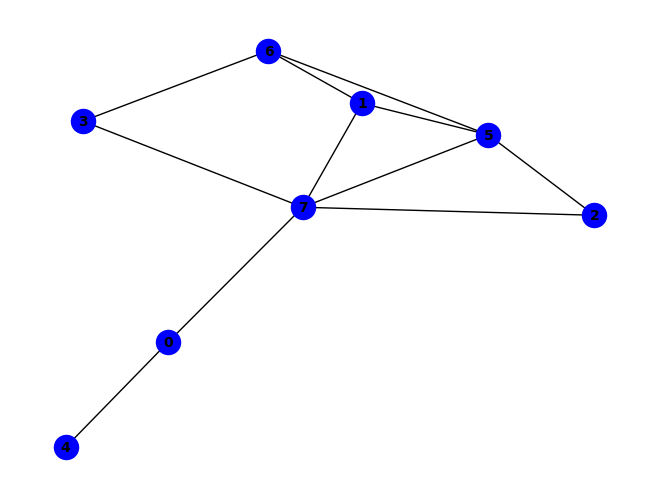


~d ^ (a & e) ^ (a & h & ~e) ^ (b & f & ~d) ^ (a & b & e & f) ^ (d & ~g & ~h) ^ (a & d & h & ~c) ^ (a & b & d & f & g) ^ (a & c & d & f & h) ^ (b & g & ~d & ~h) ^ (b & h & ~a & ~d) ^ (f & g & ~d & ~h) ^ (f & h & ~a & ~d) ^ (a & b & f & h & ~e) ^ (a & e & f & g & ~h) ^ (a & c & h & ~b & ~f) ^ (b & d & f & ~g & ~h) ^ (a & b & c & d & h & ~f) ^ (c & f & ~b & ~g & ~h) ^ (c & h & ~b & ~d & ~f) ^ (a & b & d & f & ~e & ~g) ^ (a & b & d & f & ~e & ~h) ^ (a & b & e & g & ~d & ~h) ^ (a & d & e & g & ~f & ~h) ^ (a & b & d & e & f & h & ~g) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


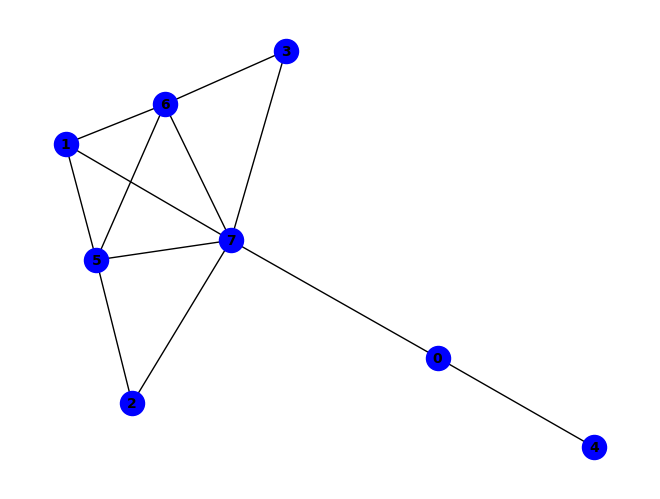


(~a & ~g) ^ (b & g & ~d) ^ (b & h & ~d) ^ (c & g & ~d) ^ (f & g & ~a) ^ (f & h & ~a) ^ (a & b & e & f) ^ (a & b & e & h) ^ (a & c & e & g) ^ (b & f & ~c & ~g) ^ (c & f & ~a & ~g) ^ (c & h & ~a & ~d) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (a & b & c & f & ~g) ^ (a & b & d & h & ~f) ^ (a & b & f & h & ~e) ^ (a & c & d & g & ~f) ^ (b & d & f & g & ~c) ^ (b & d & f & h & ~c) ^ (c & d & f & h & ~g) ^ (a & ~e & ~f & ~h) ^ (g & ~a & ~c & ~h) ^ (a & b & g & ~c & ~e) ^ (a & b & g & ~d & ~f) ^ (b & f & g & ~a & ~h) ^ (c & d & g & ~a & ~h) ^ (a & c & d & f & g & ~h) ^ (a & c & d & f & h & ~b) ^ (b & c & d & f & g & ~h) ^ (a & b & c & d & f & g & h) ^ (a & f & ~e & ~g & ~h) ^ (a & b & d & ~e & ~f & ~g) ^ (a & b & d & ~e & ~f & ~h) ^ (a & b & h & ~d & ~e & ~g) ^ (a & c & f & ~b & ~e & ~h) ^ (a & c & g & ~b & ~e & ~f) ^ (a & d & g & ~e & ~f & ~h) ^ (b & c & h & ~a & ~d & ~g) ^ (a & b & d & f & h & ~e & ~g) ^ (a & c & f & g & h & ~b & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

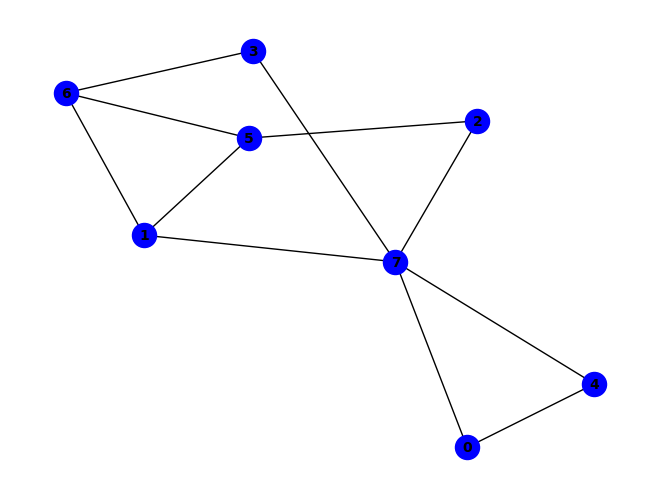


(b & d & g) ^ (~c & ~f) ^ (b & g & ~h) ^ (d & g & ~h) ^ (d & h & ~e) ^ (b & e & f & g) ^ (b & f & g & h) ^ (c & ~f & ~h) ^ (b & d & h & ~g) ^ (d & f & g & ~b) ^ (d & e & f & g & h) ^ (a & e & ~c & ~f) ^ (b & f & ~e & ~h) ^ (b & h & ~a & ~e) ^ (e & h & ~c & ~f) ^ (a & b & e & f & ~h) ^ (a & d & e & g & ~f) ^ (a & d & e & h & ~g) ^ (b & d & e & h & ~f) ^ (a & b & d & e & f & g) ^ (f & ~c & ~e & ~g) ^ (a & c & e & ~f & ~h) ^ (a & e & f & ~c & ~g) ^ (b & c & f & ~e & ~g) ^ (c & d & h & ~e & ~f) ^ (a & b & c & f & h & ~g) ^ (a & b & d & e & h & ~c) ^ (a & b & d & f & h & ~g) ^ (a & b & f & g & h & ~e) ^ (a & c & d & e & h & ~f) ^ (a & b & c & d & e & f & h) ^ (a & h & ~c & ~d & ~f) ^ (e & f & ~c & ~g & ~h) ^ (a & b & c & h & ~e & ~f) ^ (a & b & d & h & ~c & ~f) ^ (a & b & e & g & ~d & ~h) ^ (b & d & e & f & ~c & ~g) ^ (c & d & f & h & ~e & ~g) ^ (a & c & d & e & f & h & ~g) ^ (a & f & h & ~c & ~d & ~g) ^ (b & c & h & ~d & ~e & ~f) ^ (a & b & c & e & f & ~d & ~g) ^ (b & c & d & f & h & ~a &

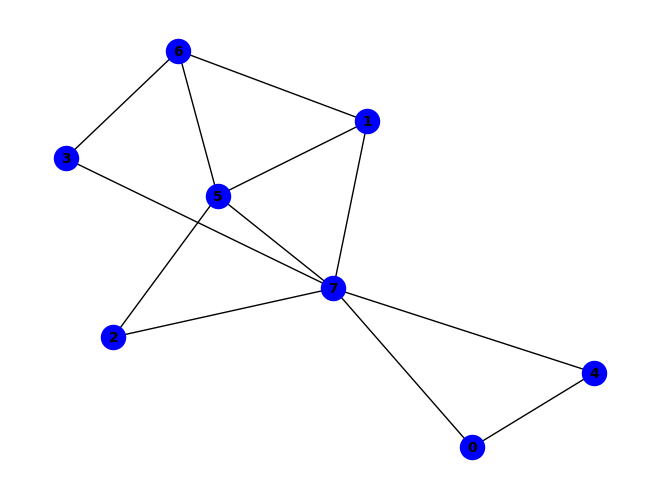


(~a & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (a & ~f & ~h) ^ (e & ~d & ~h) ^ (a & b & f & ~h) ^ (a & f & ~g & ~h) ^ (b & f & ~a & ~e) ^ (b & g & ~d & ~h) ^ (b & h & ~a & ~e) ^ (d & g & ~f & ~h) ^ (d & h & ~c & ~f) ^ (f & h & ~a & ~e) ^ (a & c & d & h & ~f) ^ (b & c & e & f & ~d) ^ (b & c & e & h & ~d) ^ (b & d & f & g & ~h) ^ (c & d & e & f & ~a) ^ (c & d & e & h & ~a) ^ (a & d & h & ~e & ~f) ^ (a & f & g & ~e & ~h) ^ (b & e & f & ~c & ~h) ^ (d & e & f & ~c & ~h) ^ (a & c & d & e & f & ~h) ^ (b & c & d & e & f & ~h) ^ (c & f & ~b & ~g & ~h) ^ (c & h & ~a & ~e & ~f) ^ (a & b & c & e & ~f & ~g) ^ (a & b & c & e & ~g & ~h) ^ (a & b & e & g & ~d & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & d & e & g & ~f & ~h) ^ (a & b & c & d & e & h & ~f) ^ (a & b & c & e & g & h & ~f) ^ (a & b & d & e & f & g & ~h) ^ (b & c & h & ~a & ~d & ~f) ^ (b & d & h & ~a & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

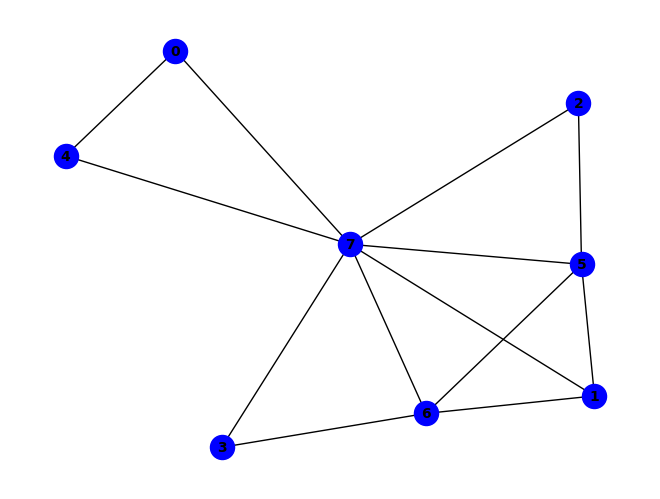


~g ^ (c & f & ~g) ^ (g & ~c & ~h) ^ (a & b & g & ~h) ^ (b & e & g & ~h) ^ (b & f & ~c & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (d & g & ~b & ~f) ^ (d & h & ~b & ~f) ^ (e & h & ~d & ~g) ^ (f & g & ~a & ~e) ^ (f & h & ~a & ~e) ^ (a & b & e & f & ~h) ^ (b & c & e & h & ~f) ^ (b & d & e & h & ~g) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & c & d & e & f & g) ^ (a & c & d & e & f & h) ^ (a & c & g & ~f & ~h) ^ (a & e & f & ~g & ~h) ^ (b & c & h & ~d & ~g) ^ (b & f & g & ~e & ~h) ^ (c & e & g & ~b & ~h) ^ (e & f & g & ~d & ~h) ^ (b & d & e & f & g & ~h) ^ (a & e & ~c & ~f & ~h) ^ (a & h & ~d & ~e & ~g) ^ (a & b & c & e & ~f & ~h) ^ (a & b & c & h & ~e & ~g) ^ (a & b & d & e & ~f & ~g) ^ (a & b & d & e & ~f & ~h) ^ (a & b & d & h & ~c & ~g) ^ (a & b & f & h & ~e & ~g) ^ (a & c & f & g & ~b & ~e) ^ (a & c & f & h & ~b & ~e) ^ (a & d & e & g & ~f & ~h) ^ (a & d & f & g &

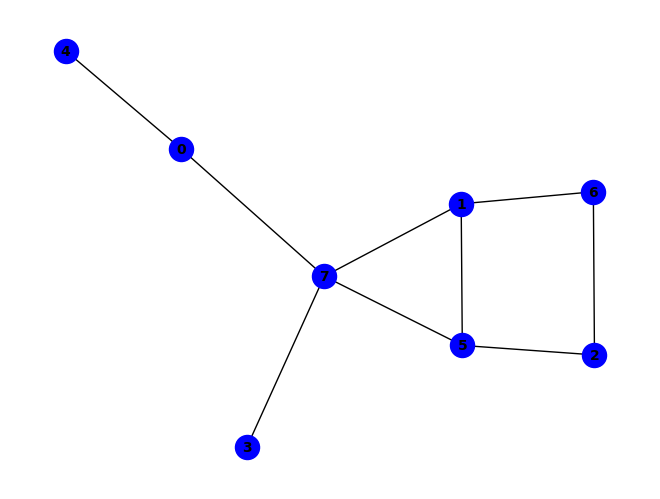


(c & ~f & ~g) ^ (~a & ~c & ~f) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~d) ^ (b & f & g & h & ~a) ^ (a & ~c & ~e & ~h) ^ (f & ~a & ~c & ~h) ^ (b & c & f & ~a & ~h) ^ (b & c & g & ~a & ~f) ^ (c & d & h & ~f & ~g) ^ (b & c & d & g & h & ~a) ^ (d & h & ~a & ~c & ~f) ^ (b & d & f & h & ~a & ~c) ^ (a & b & g & ~c & ~e & ~h) ^ (a & c & e & ~f & ~g & ~h) ^ (a & c & h & ~d & ~f & ~g) ^ (b & c & d & f & h & ~a & ~g) ^ (a & b & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


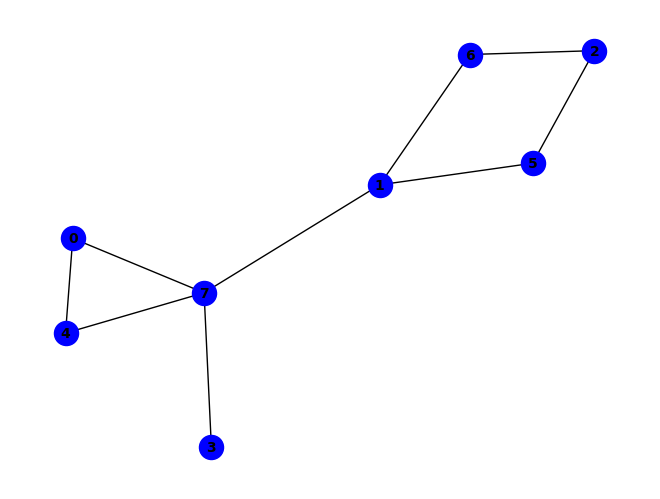


(b & e & h) ^ (~c & ~e) ^ (b & h & ~g) ^ (b & f & g & h) ^ (c & ~f & ~g) ^ (e & ~c & ~h) ^ (a & e & ~c & ~d) ^ (a & h & ~c & ~d) ^ (b & g & ~c & ~f) ^ (b & c & f & h & ~e) ^ (a & c & e & ~f & ~g) ^ (a & d & e & ~c & ~h) ^ (c & e & h & ~f & ~g) ^ (b & c & e & g & h & ~f) ^ (b & f & ~a & ~c & ~h) ^ (d & h & ~b & ~c & ~e) ^ (a & b & d & h & ~c & ~e) ^ (a & b & f & ~c & ~e & ~h) ^ (a & b & g & ~c & ~e & ~f) ^ (a & b & g & ~c & ~f & ~h) ^ (a & b & h & ~c & ~e & ~g) ^ (a & c & h & ~d & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (a & b & f & g & h & ~c & ~e) ^ (a & b & c & h & ~e & ~f & ~g) ^ (c & d & h & ~b & ~e & ~f & ~g) ^ (a & c & d & e & h & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


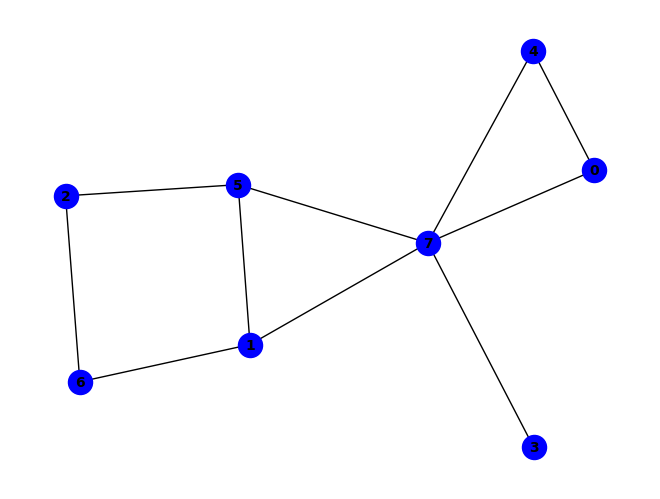


(~c & ~f) ^ (b & f & ~g) ^ (b & g & ~h) ^ (b & f & g & h) ^ (c & ~f & ~g) ^ (f & ~c & ~h) ^ (b & c & g & ~f) ^ (b & h & ~a & ~e) ^ (e & h & ~c & ~f) ^ (a & b & c & f & ~e) ^ (a & b & e & g & ~h) ^ (b & d & e & h & ~c) ^ (b & e & f & h & ~d) ^ (a & c & e & ~f & ~g) ^ (a & d & e & ~c & ~f) ^ (a & d & h & ~c & ~f) ^ (b & c & f & ~a & ~h) ^ (b & d & h & ~a & ~f) ^ (c & e & h & ~f & ~g) ^ (a & b & d & e & h & ~f) ^ (b & c & d & e & h & ~g) ^ (b & c & e & g & h & ~f) ^ (b & c & d & e & f & g & h) ^ (a & e & ~c & ~d & ~h) ^ (a & h & ~c & ~e & ~f) ^ (d & h & ~c & ~e & ~f) ^ (a & b & c & g & ~e & ~f) ^ (a & b & c & g & ~f & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & b & f & h & ~c & ~e) ^ (a & d & e & f & ~c & ~h) ^ (a & c & h & ~d & ~f & ~g) ^ (c & d & h & ~e & ~f & ~g) ^ (a & c & d & e & h & ~f & ~g) ^ (b & c & d & g & h & ~a & ~f) ^ (a & b & c & d & e & g & h & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

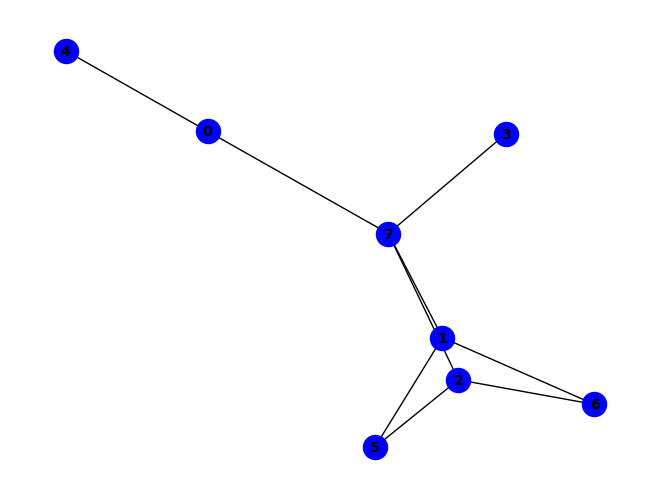


(~c & ~d) ^ (a & e & ~c) ^ (d & ~c & ~h) ^ (b & d & h & ~c) ^ (a & h & ~c & ~e) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~f) ^ (b & f & g & h & ~c) ^ (a & d & h & ~b & ~c) ^ (b & c & f & ~a & ~h) ^ (b & c & g & ~a & ~f) ^ (b & c & h & ~a & ~g) ^ (a & b & f & g & ~c & ~e) ^ (a & b & e & f & g & h & ~c) ^ (c & ~a & ~f & ~g & ~h) ^ (a & b & f & ~c & ~e & ~h) ^ (a & b & g & ~c & ~e & ~h) ^ (a & c & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


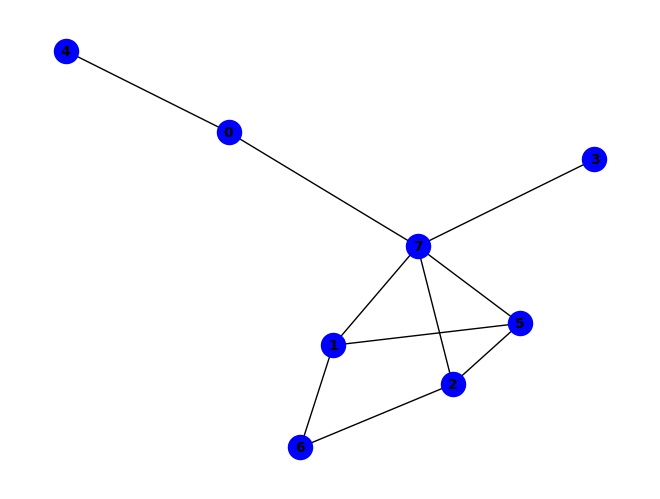


(f & ~h) ^ (b & h & ~d) ^ (a & b & e & h) ^ (b & d & f & h) ^ (a & ~e & ~h) ^ (a & d & f & ~c) ^ (a & d & h & ~c) ^ (b & c & f & ~d) ^ (c & f & g & ~h) ^ (a & b & c & e & f) ^ (~a & ~c & ~f) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~h) ^ (d & h & ~c & ~f) ^ (a & b & d & h & ~f) ^ (b & c & d & f & ~h) ^ (b & c & d & h & ~a) ^ (b & f & g & h & ~c) ^ (a & b & c & d & f & h) ^ (a & b & c & f & g & h) ^ (a & b & e & f & g & h) ^ (c & ~a & ~g & ~h) ^ (a & b & c & ~e & ~g) ^ (a & b & c & ~e & ~h) ^ (a & b & f & ~e & ~h) ^ (a & b & g & ~e & ~f) ^ (a & c & g & ~e & ~h) ^ (b & c & g & ~a & ~f) ^ (b & c & h & ~a & ~g) ^ (a & b & c & f & h & ~e) ^ (a & f & ~c & ~d & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & b & h & ~c & ~e & ~g) ^ (a & b & c & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


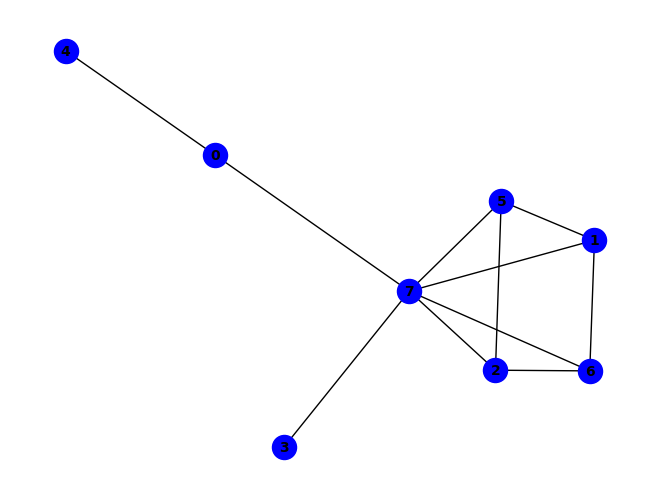


(b & f & ~d) ^ (b & g & ~f) ^ (a & b & e & g) ^ (a & ~e & ~h) ^ (a & b & f & ~g) ^ (b & c & f & ~g) ^ (b & c & g & ~d) ^ (b & d & f & ~h) ^ (a & b & c & e & f) ^ (~a & ~c & ~g) ^ (b & h & ~c & ~d) ^ (a & b & e & h & ~c) ^ (b & c & d & g & ~h) ^ (b & d & g & h & ~f) ^ (g & ~a & ~c & ~h) ^ (a & c & g & ~e & ~h) ^ (a & b & c & e & g & ~f) ^ (b & c & d & f & h & ~g) ^ (f & h & ~a & ~c & ~g) ^ (c & ~a & ~f & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & b & h & ~c & ~e & ~g) ^ (a & c & f & ~e & ~g & ~h) ^ (a & b & c & f & h & ~e & ~g) ^ (d & h & ~a & ~c & ~f & ~g) ^ (a & b & d & h & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


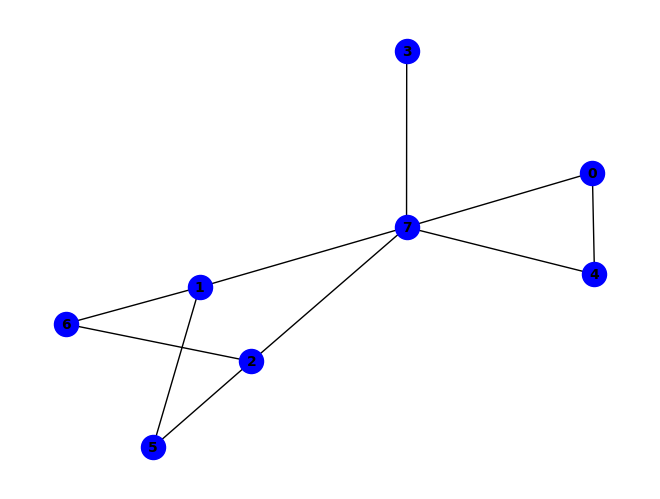


(~c & ~e) ^ (b & f & ~g) ^ (b & h & ~f) ^ (e & ~c & ~h) ^ (b & c & g & ~f) ^ (b & c & h & ~g) ^ (b & d & h & ~c) ^ (a & e & ~c & ~d) ^ (a & h & ~c & ~d) ^ (b & g & ~a & ~h) ^ (d & h & ~c & ~e) ^ (b & f & g & h & ~c) ^ (a & b & f & ~g & ~h) ^ (a & d & e & ~c & ~h) ^ (b & c & f & ~a & ~h) ^ (b & e & h & ~c & ~d) ^ (a & b & c & g & ~f & ~h) ^ (a & b & d & h & ~c & ~e) ^ (c & ~a & ~f & ~g & ~h) ^ (a & b & f & ~c & ~e & ~h) ^ (a & b & g & ~c & ~e & ~f) ^ (a & b & h & ~c & ~e & ~g) ^ (a & b & f & g & h & ~c & ~e) ^ (a & c & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


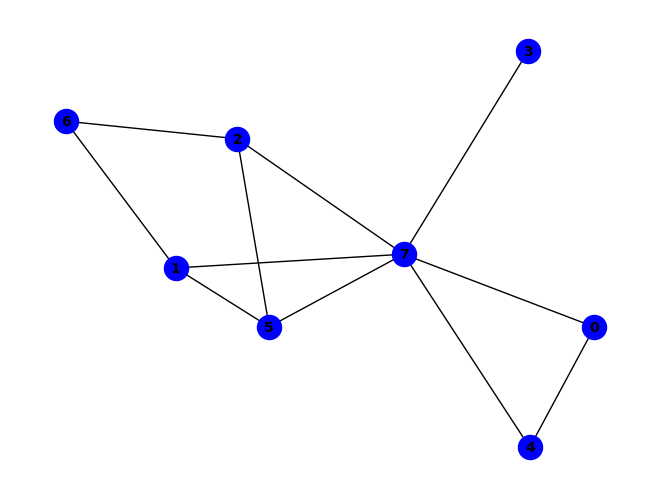


(f & ~h) ^ (~c & ~f) ^ (c & f & g & ~h) ^ (b & f & ~c & ~g) ^ (b & g & ~c & ~h) ^ (b & h & ~c & ~e) ^ (e & h & ~c & ~f) ^ (b & d & e & h & ~c) ^ (b & f & g & h & ~c) ^ (c & ~a & ~g & ~h) ^ (a & d & e & ~c & ~f) ^ (a & d & h & ~c & ~f) ^ (b & d & h & ~c & ~f) ^ (a & c & ~e & ~g & ~h) ^ (a & e & ~c & ~d & ~h) ^ (a & h & ~c & ~e & ~f) ^ (d & h & ~c & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & b & e & g & ~c & ~h) ^ (a & d & e & f & ~c & ~h) ^ (b & e & f & h & ~c & ~d) ^ (a & c & e & f & ~b & ~g & ~h) ^ (a & b & h & ~c & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


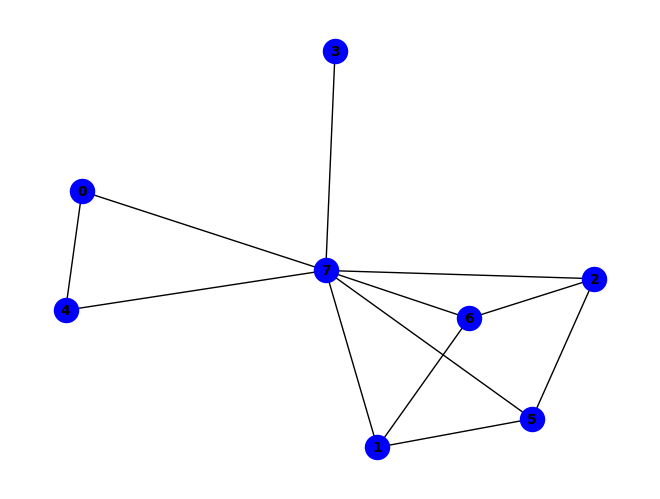


(~c & ~g) ^ (b & g & ~f) ^ (g & ~c & ~h) ^ (b & c & f & ~g) ^ (b & e & f & ~h) ^ (b & f & ~a & ~e) ^ (f & h & ~c & ~g) ^ (b & c & e & g & ~h) ^ (b & e & g & h & ~f) ^ (a & b & g & ~c & ~h) ^ (a & b & g & ~e & ~f) ^ (a & d & e & ~c & ~g) ^ (b & c & g & ~a & ~e) ^ (a & e & ~c & ~d & ~h) ^ (b & h & ~a & ~c & ~e) ^ (e & h & ~c & ~f & ~g) ^ (a & b & c & f & ~e & ~g) ^ (a & d & e & g & ~c & ~h) ^ (c & ~a & ~f & ~g & ~h) ^ (a & b & f & ~c & ~g & ~h) ^ (a & d & h & ~c & ~f & ~g) ^ (a & d & e & f & h & ~c & ~g) ^ (b & c & d & e & h & ~a & ~g) ^ (b & c & e & f & h & ~d & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & h & ~c & ~e & ~f & ~g) ^ (d & h & ~c & ~e & ~f & ~g) ^ (b & c & d & h & ~a & ~f & ~g) ^ (b & d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


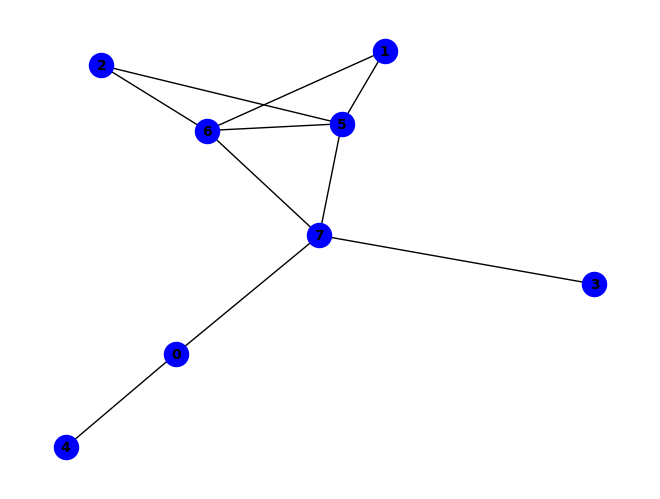


(~a & ~c & ~g) ^ (b & f & ~c & ~h) ^ (c & h & ~a & ~g) ^ (d & h & ~a & ~g) ^ (f & g & ~a & ~d) ^ (f & h & ~a & ~d) ^ (a & ~e & ~f & ~h) ^ (c & ~a & ~f & ~h) ^ (g & ~a & ~b & ~h) ^ (a & c & f & ~e & ~h) ^ (a & c & g & ~e & ~h) ^ (b & c & g & ~a & ~h) ^ (d & f & g & ~a & ~h) ^ (a & f & ~e & ~g & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & b & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


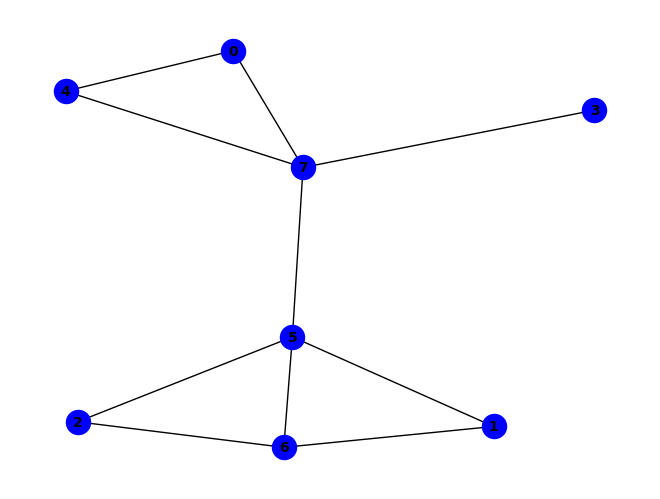


(c & g) ^ (~a & ~e) ^ (b & g & ~c) ^ (d & e & ~f) ^ (f & g & ~h) ^ (b & d & f & g) ^ (a & ~f & ~h) ^ (e & ~d & ~h) ^ (a & c & g & ~e) ^ (a & c & g & ~h) ^ (d & e & f & ~h) ^ (a & f & ~g & ~h) ^ (b & f & ~d & ~h) ^ (c & f & ~b & ~h) ^ (d & h & ~a & ~f) ^ (f & h & ~a & ~e) ^ (a & d & e & h & ~f) ^ (b & d & g & h & ~e) ^ (b & f & g & h & ~c) ^ (c & e & g & h & ~d) ^ (a & c & d & e & f & g) ^ (a & c & d & e & g & h) ^ (b & c & d & e & g & h) ^ (c & d & e & f & g & h) ^ (a & b & g & ~c & ~e) ^ (a & b & g & ~c & ~h) ^ (a & f & g & ~e & ~h) ^ (b & d & f & ~g & ~h) ^ (a & c & d & g & h & ~f) ^ (a & b & e & f & ~d & ~h) ^ (b & e & g & h & ~c & ~f) ^ (c & d & g & h & ~b & ~f) ^ (c & f & g & h & ~a & ~e) ^ (a & b & d & e & f & g & ~c) ^ (a & b & d & e & g & h & ~c) ^ (b & d & e & f & g & h & ~c) ^ (a & b & d & e & f & ~g & ~h) ^ (a & b & d & g & h & ~c & ~f) ^ (a & b & f & g & h & ~c & ~e) ^ (a & c & e & f & ~b & ~d & ~h) ^ (a & c & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

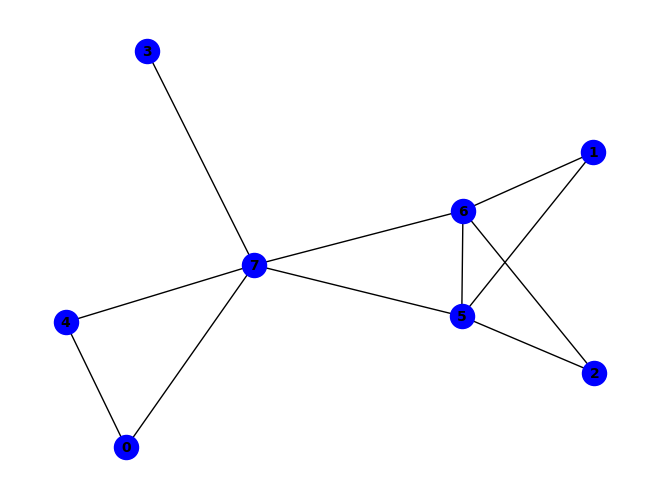


(~c & ~g) ^ (g & ~b & ~h) ^ (a & c & e & ~g) ^ (a & e & ~f & ~h) ^ (b & f & ~c & ~h) ^ (c & h & ~a & ~g) ^ (e & h & ~d & ~g) ^ (f & g & ~a & ~e) ^ (f & h & ~a & ~e) ^ (a & b & e & g & ~h) ^ (a & d & e & h & ~g) ^ (d & e & f & g & ~a) ^ (d & e & f & h & ~a) ^ (c & ~a & ~f & ~h) ^ (a & e & f & ~g & ~h) ^ (a & f & g & ~e & ~h) ^ (b & c & g & ~a & ~h) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (a & c & ~e & ~f & ~h) ^ (a & h & ~c & ~e & ~g) ^ (d & h & ~a & ~f & ~g) ^ (a & b & c & g & ~e & ~h) ^ (a & b & e & f & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


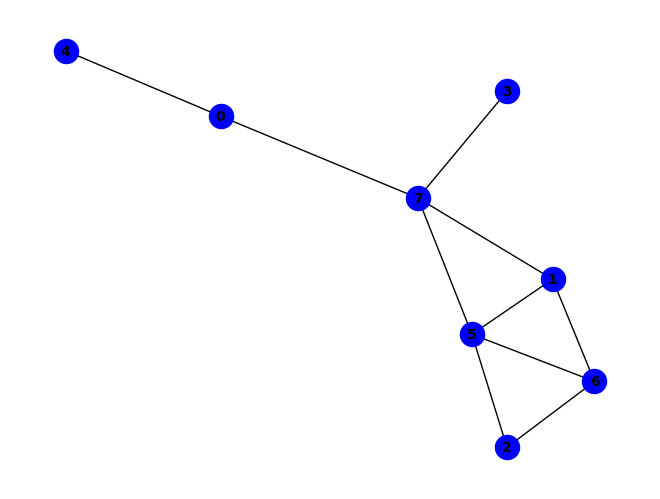


~d ^ (a & e) ^ (d & ~h) ^ (a & f & g) ^ (b & f & ~d) ^ (c & g & ~a) ^ (f & g & ~h) ^ (f & h & ~d) ^ (a & b & e & f) ^ (a & c & g & ~e) ^ (a & f & h & ~g) ^ (b & d & f & ~h) ^ (b & d & h & ~c) ^ (a & h & ~c & ~e) ^ (b & g & ~a & ~c) ^ (b & h & ~a & ~g) ^ (c & f & ~b & ~h) ^ (a & b & f & h & ~e) ^ (b & c & d & h & ~g) ^ (b & c & d & f & g & h) ^ (a & b & c & ~e & ~g) ^ (a & b & c & ~e & ~h) ^ (a & b & g & ~e & ~h) ^ (a & d & h & ~b & ~f) ^ (a & f & g & ~e & ~h) ^ (a & c & e & f & ~b & ~h) ^ (c & d & g & h & ~a & ~f) ^ (c & f & g & h & ~a & ~b) ^ (a & b & c & d & g & h & ~f) ^ (a & c & h & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


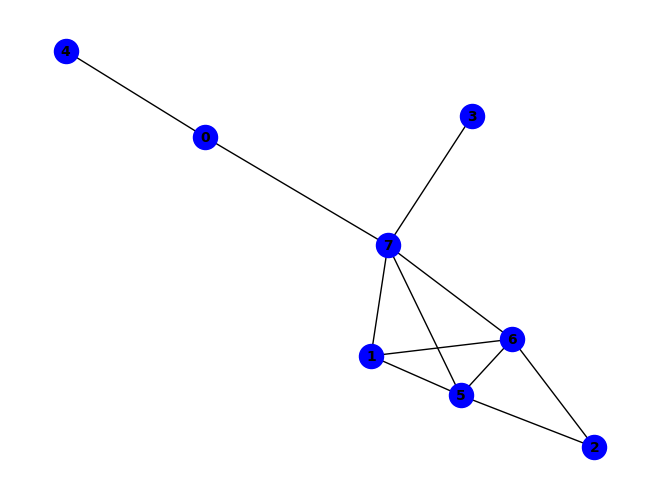


(b & g & ~d) ^ (b & h & ~d) ^ (a & b & e & g) ^ (a & b & e & h) ^ (g & ~a & ~h) ^ (b & d & g & ~h) ^ (~a & ~c & ~g) ^ (b & f & ~a & ~g) ^ (c & h & ~a & ~g) ^ (d & h & ~a & ~g) ^ (f & g & ~a & ~d) ^ (f & h & ~a & ~d) ^ (b & d & f & h & ~g) ^ (a & ~e & ~f & ~h) ^ (c & ~a & ~f & ~h) ^ (a & b & c & ~e & ~g) ^ (a & b & f & ~e & ~h) ^ (a & c & f & ~e & ~h) ^ (a & c & g & ~e & ~h) ^ (b & c & f & ~a & ~h) ^ (b & c & g & ~a & ~h) ^ (b & f & g & ~a & ~h) ^ (d & f & g & ~a & ~h) ^ (a & f & ~e & ~g & ~h) ^ (a & b & d & h & ~f & ~g) ^ (a & b & c & ~e & ~f & ~h) ^ (a & b & h & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


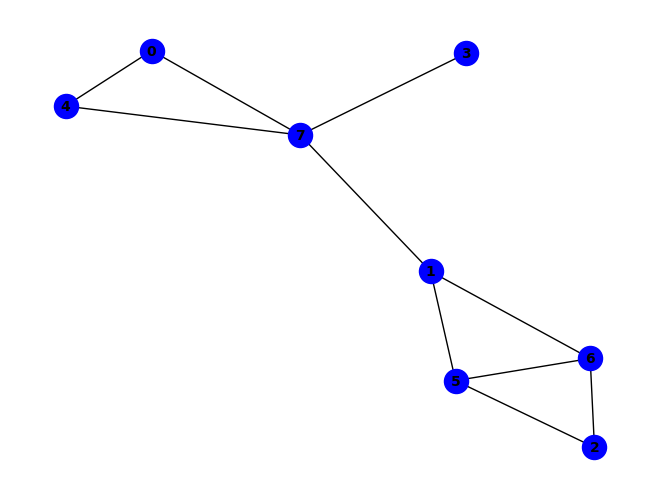


~f ^ (a & e & ~f) ^ (c & g & ~b) ^ (a & h & ~d & ~f) ^ (b & g & ~f & ~h) ^ (b & h & ~d & ~f) ^ (c & f & ~b & ~e) ^ (d & h & ~e & ~f) ^ (e & h & ~b & ~f) ^ (a & b & d & h & ~f) ^ (a & b & e & g & ~h) ^ (a & c & e & g & ~b) ^ (a & d & e & h & ~f) ^ (b & d & e & h & ~f) ^ (c & e & g & h & ~b) ^ (a & b & d & e & f & g) ^ (a & c & d & e & g & h) ^ (f & ~b & ~e & ~g) ^ (a & b & h & ~e & ~f) ^ (a & e & f & ~d & ~g) ^ (a & f & h & ~d & ~g) ^ (c & e & f & ~b & ~h) ^ (a & b & d & e & h & ~c) ^ (a & b & d & f & h & ~g) ^ (e & f & ~b & ~g & ~h) ^ (a & b & e & f & ~d & ~h) ^ (a & b & f & h & ~e & ~g) ^ (a & c & e & f & ~b & ~d) ^ (a & c & f & h & ~b & ~d) ^ (a & c & g & h & ~b & ~d) ^ (c & d & f & h & ~b & ~e) ^ (c & d & g & h & ~b & ~e) ^ (a & b & c & d & e & h & ~g) ^ (d & f & h & ~b & ~e & ~g) ^ (a & c & d & e & f & ~b & ~h) ^ (a & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

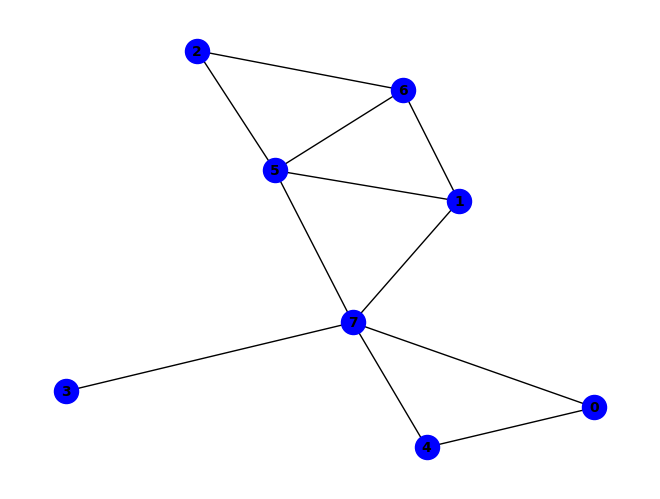


(c & g) ^ (~a & ~e) ^ (b & g & ~c) ^ (d & e & ~f) ^ (f & g & ~h) ^ (e & ~d & ~h) ^ (a & b & h & ~e) ^ (a & c & g & ~h) ^ (b & e & f & ~h) ^ (b & e & h & ~d) ^ (d & e & f & ~h) ^ (b & c & f & g & h) ^ (a & b & ~c & ~g) ^ (a & f & ~g & ~h) ^ (b & f & ~a & ~e) ^ (b & h & ~a & ~g) ^ (c & f & ~b & ~h) ^ (d & h & ~b & ~f) ^ (f & h & ~a & ~e) ^ (a & b & c & h & ~g) ^ (c & e & g & h & ~d) ^ (a & c & d & e & f & g) ^ (b & c & d & e & g & h) ^ (c & d & e & f & g & h) ^ (a & ~b & ~f & ~h) ^ (a & b & c & ~f & ~h) ^ (a & b & g & ~e & ~h) ^ (a & c & g & ~b & ~e) ^ (a & f & g & ~e & ~h) ^ (b & c & e & g & h & ~f) ^ (b & d & e & f & h & ~c) ^ (a & b & c & f & ~e & ~h) ^ (a & c & e & f & ~d & ~h) ^ (c & f & g & h & ~a & ~e) ^ (a & b & c & f & g & h & ~e) ^ (a & c & d & e & g & h & ~b) ^ (b & c & d & e & f & h & ~g) ^ (a & b & c & d & e & f & g & h) ^ (a & d & h & ~b & ~e & ~f) ^ (a & c & d & e & f & ~g & ~h) ^ (c & d & g & h & ~a & ~b & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

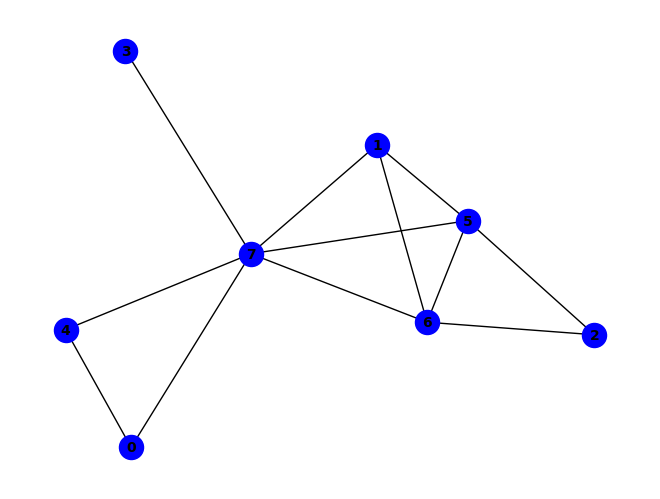


(g & ~h) ^ (~c & ~g) ^ (b & f & ~g) ^ (c & h & ~g) ^ (c & ~f & ~h) ^ (b & c & g & ~h) ^ (b & e & g & ~h) ^ (a & e & ~f & ~h) ^ (a & h & ~e & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (e & h & ~d & ~g) ^ (f & g & ~a & ~e) ^ (f & h & ~a & ~e) ^ (a & b & d & h & ~g) ^ (a & b & e & f & ~h) ^ (a & c & e & f & ~h) ^ (a & c & e & g & ~h) ^ (b & d & f & g & ~a) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~a) ^ (a & b & g & ~c & ~h) ^ (a & e & f & ~g & ~h) ^ (a & f & g & ~e & ~h) ^ (b & c & f & ~a & ~h) ^ (b & d & h & ~e & ~g) ^ (b & f & g & ~d & ~h) ^ (e & f & g & ~d & ~h) ^ (a & b & d & f & g & ~h) ^ (b & d & e & f & g & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & b & c & f & ~e & ~h) ^ (a & b & c & g & ~e & ~h) ^ (a & b & f & h & ~e & ~g) ^ (a & d & e & h & ~b & ~g) ^ (b & d & f & h & ~a & ~e) ^ (a & d & e & f & g & h & ~b)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

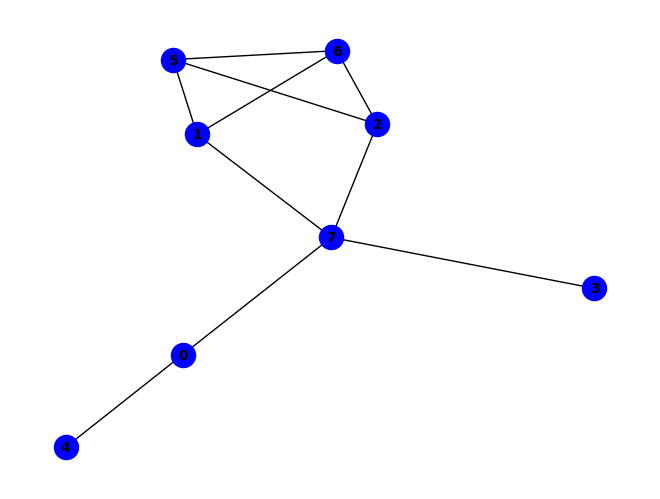


~f ^ (a & c & g & ~f) ^ (a & c & h & ~g) ^ (a & e & ~f & ~h) ^ (a & h & ~d & ~f) ^ (b & g & ~a & ~f) ^ (b & h & ~a & ~g) ^ (c & g & ~f & ~h) ^ (c & h & ~d & ~f) ^ (d & h & ~b & ~f) ^ (a & b & d & h & ~f) ^ (a & c & d & h & ~f) ^ (a & b & c & d & f & h) ^ (a & b & c & f & g & h) ^ (f & ~c & ~d & ~g) ^ (a & b & g & ~e & ~h) ^ (a & c & f & ~e & ~h) ^ (a & e & f & ~g & ~h) ^ (a & f & h & ~d & ~g) ^ (b & c & f & ~a & ~h) ^ (b & c & g & ~a & ~h) ^ (b & c & h & ~a & ~d) ^ (b & c & f & g & h & ~d) ^ (b & f & ~a & ~g & ~h) ^ (d & f & ~c & ~g & ~h) ^ (a & c & d & f & ~b & ~g) ^ (b & d & f & h & ~a & ~g) ^ (a & b & f & ~c & ~e & ~h) ^ (a & c & f & ~d & ~g & ~h) ^ (a & c & g & ~b & ~e & ~h) ^ (a & b & c & d & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


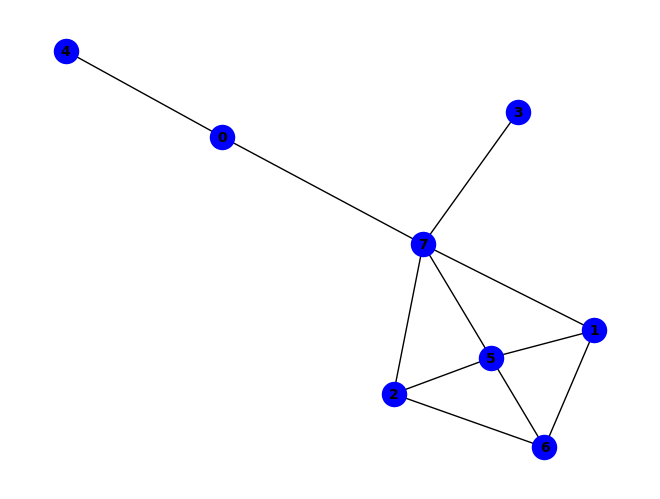


~d ^ (a & e) ^ (d & ~h) ^ (a & h & ~e) ^ (b & f & ~d) ^ (b & g & ~c) ^ (c & g & ~h) ^ (c & h & ~d) ^ (a & c & e & f) ^ (a & b & h & ~d) ^ (a & c & g & ~b) ^ (a & d & h & ~c) ^ (b & d & f & ~h) ^ (b & d & h & ~c) ^ (a & b & d & f & h) ^ (a & c & d & f & h) ^ (b & h & ~c & ~g) ^ (c & f & ~b & ~d) ^ (f & g & ~a & ~h) ^ (f & h & ~a & ~d) ^ (a & b & e & f & ~c) ^ (a & b & e & g & ~h) ^ (a & b & f & h & ~e) ^ (a & c & h & ~b & ~g) ^ (a & f & g & ~e & ~h) ^ (c & d & f & ~b & ~h) ^ (a & b & c & d & h & ~f) ^ (a & c & f & h & ~b & ~e) ^ (a & c & g & ~b & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


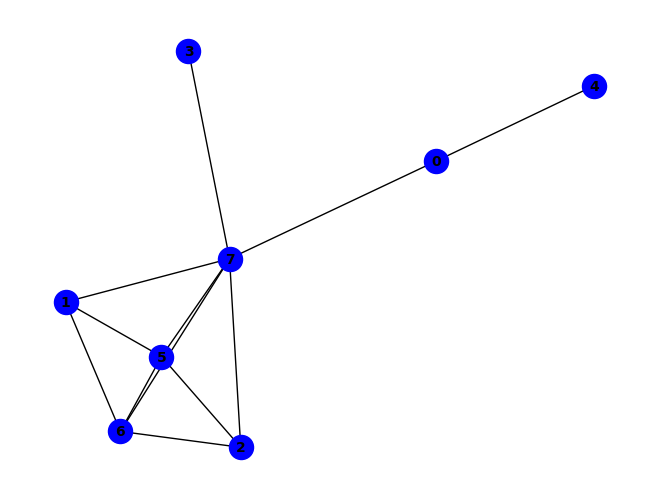


(~a & ~g) ^ (c & f & ~g) ^ (c & g & ~d) ^ (c & h & ~d) ^ (a & b & e & h) ^ (a & c & e & f) ^ (a & c & e & h) ^ (g & ~a & ~h) ^ (a & b & g & ~e) ^ (a & b & g & ~f) ^ (a & c & g & ~e) ^ (b & f & ~c & ~g) ^ (b & g & ~c & ~d) ^ (b & h & ~c & ~d) ^ (d & h & ~a & ~g) ^ (f & g & ~a & ~d) ^ (f & h & ~a & ~d) ^ (a & b & c & h & ~d) ^ (a & b & e & f & ~c) ^ (a & c & d & h & ~g) ^ (a & c & f & h & ~e) ^ (b & d & f & g & ~c) ^ (b & d & f & h & ~c) ^ (a & b & c & d & g & h) ^ (a & ~e & ~f & ~h) ^ (a & b & c & ~e & ~g) ^ (a & b & c & ~e & ~h) ^ (a & c & g & ~b & ~f) ^ (a & c & h & ~e & ~g) ^ (b & d & g & ~f & ~h) ^ (c & d & g & ~b & ~h) ^ (c & f & g & ~a & ~h) ^ (d & f & g & ~a & ~h) ^ (b & c & d & f & g & ~h) ^ (a & f & ~e & ~g & ~h) ^ (a & b & d & h & ~f & ~g) ^ (a & b & f & h & ~c & ~e) ^ (c & d & f & h & ~a & ~g) ^ (a & b & c & d & f & h & ~g) ^ (a & b & h & ~c & ~e & ~g) ^ (b & f & g & ~a & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


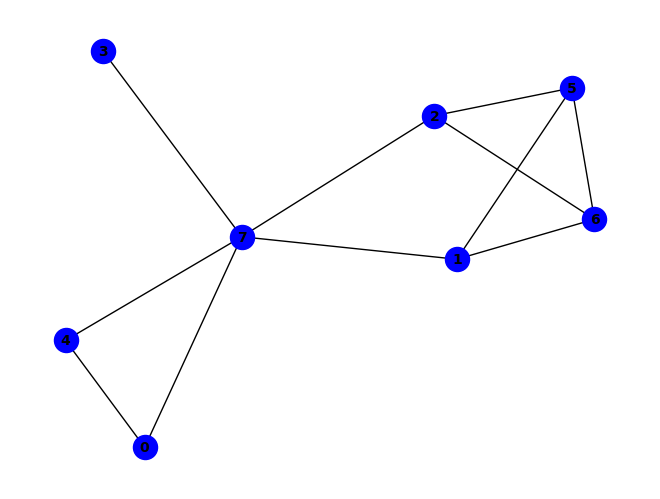


~f ^ (b & c & g) ^ (c & f & g) ^ (a & e & ~f) ^ (b & g & ~h) ^ (c & g & ~h) ^ (e & h & ~f) ^ (f & ~e & ~g) ^ (b & c & h & ~g) ^ (b & f & g & ~c) ^ (c & e & f & g & h) ^ (a & h & ~d & ~f) ^ (b & h & ~a & ~e) ^ (c & h & ~a & ~e) ^ (e & f & ~g & ~h) ^ (a & c & e & g & ~h) ^ (a & d & e & h & ~f) ^ (b & c & d & h & ~f) ^ (b & c & e & h & ~d) ^ (b & e & f & h & ~c) ^ (a & c & d & e & f & g) ^ (a & e & f & ~d & ~g) ^ (a & f & h & ~d & ~g) ^ (b & c & f & ~g & ~h) ^ (b & e & f & ~d & ~g) ^ (c & d & f & ~e & ~g) ^ (d & f & h & ~e & ~g) ^ (a & b & f & g & h & ~e) ^ (a & c & d & e & h & ~b) ^ (a & c & f & g & h & ~e) ^ (b & c & e & f & h & ~g) ^ (b & f & ~e & ~g & ~h) ^ (c & f & ~d & ~g & ~h) ^ (d & h & ~c & ~e & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & b & e & f & ~c & ~h) ^ (a & b & e & g & ~c & ~h) ^ (a & c & d & h & ~b & ~f) ^ (a & c & e & f & ~d & ~h) ^ (b & d & e & f & ~g & ~h) ^ (b & d & f & h & ~c & ~g) ^ (c & d & e & f & ~g & ~h) ^ (b & d & h & ~a & ~e & ~f) ^ (a & b & c & f & h & ~e & ~g)

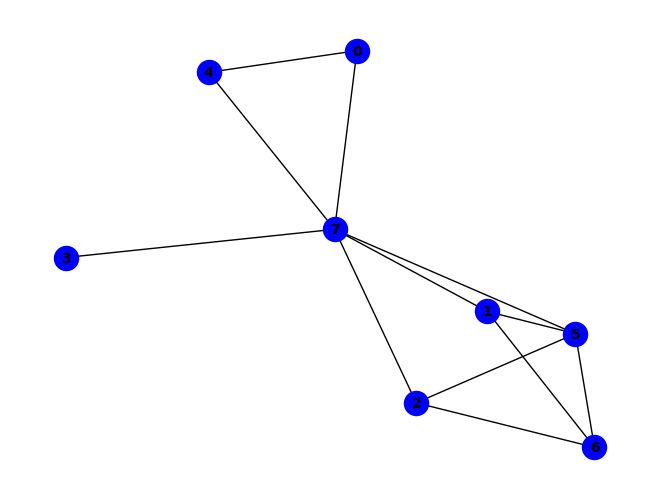


(b & c & g) ^ (~a & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (a & ~f & ~h) ^ (e & ~d & ~h) ^ (a & c & f & ~h) ^ (b & c & h & ~g) ^ (c & e & f & ~h) ^ (a & f & ~g & ~h) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~e) ^ (c & f & ~a & ~e) ^ (c & g & ~a & ~h) ^ (c & h & ~a & ~e) ^ (d & h & ~c & ~f) ^ (f & h & ~a & ~e) ^ (a & b & c & h & ~e) ^ (b & c & d & h & ~f) ^ (b & c & e & h & ~d) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~a) ^ (a & c & d & e & f & h) ^ (a & b & f & ~c & ~h) ^ (a & b & g & ~e & ~h) ^ (a & c & g & ~e & ~h) ^ (a & d & h & ~e & ~f) ^ (a & f & g & ~e & ~h) ^ (b & e & f & ~c & ~h) ^ (d & e & f & ~c & ~h) ^ (a & b & c & e & g & ~h) ^ (b & c & d & e & f & ~h) ^ (b & f & ~a & ~c & ~e) ^ (a & c & d & h & ~b & ~f) ^ (a & b & c & d & e & h & ~f) ^ (b & d & h & ~a & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


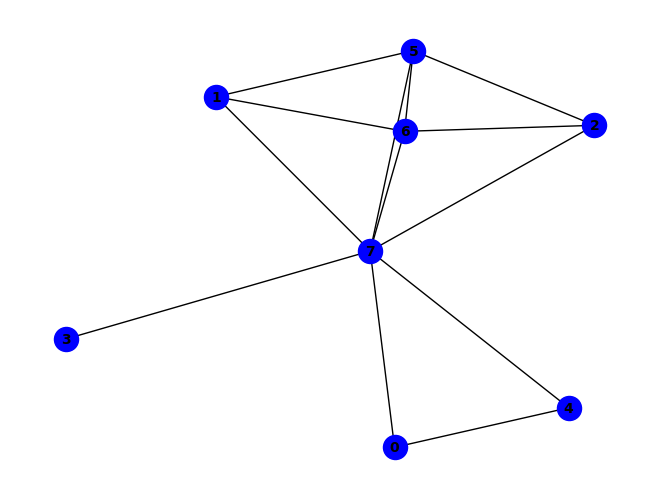


~g ^ (g & ~h) ^ (c & f & ~g) ^ (a & b & g & ~h) ^ (b & e & g & ~h) ^ (a & e & ~f & ~h) ^ (b & f & ~c & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & g & ~b & ~e) ^ (c & h & ~b & ~e) ^ (e & h & ~d & ~g) ^ (f & g & ~a & ~e) ^ (f & h & ~a & ~e) ^ (a & c & e & f & ~d) ^ (a & c & e & g & ~h) ^ (a & c & f & h & ~d) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & c & d & e & f & g) ^ (b & c & d & e & f & h) ^ (a & e & f & ~g & ~h) ^ (b & f & g & ~e & ~h) ^ (c & e & g & ~b & ~h) ^ (c & f & g & ~b & ~h) ^ (e & f & g & ~d & ~h) ^ (a & b & c & f & h & ~e) ^ (a & c & d & e & f & ~h) ^ (a & h & ~c & ~e & ~g) ^ (a & b & c & e & ~d & ~g) ^ (a & b & c & e & ~d & ~h) ^ (a & b & c & h & ~d & ~g) ^ (a & b & d & h & ~f & ~g) ^ (a & b & e & f & ~c & ~h) ^ (a & b & f & h & ~e & ~g) ^ (a & c & d & h & ~e & ~g) ^ (a & c & f & g & ~b & ~e) ^ (b & d & e & h & ~a & ~g) ^ (c & d & e & h & ~b & ~g) ^ (c & e & f & h & ~b & ~g) ^ (a & b & c & d & f & h & ~g) ^

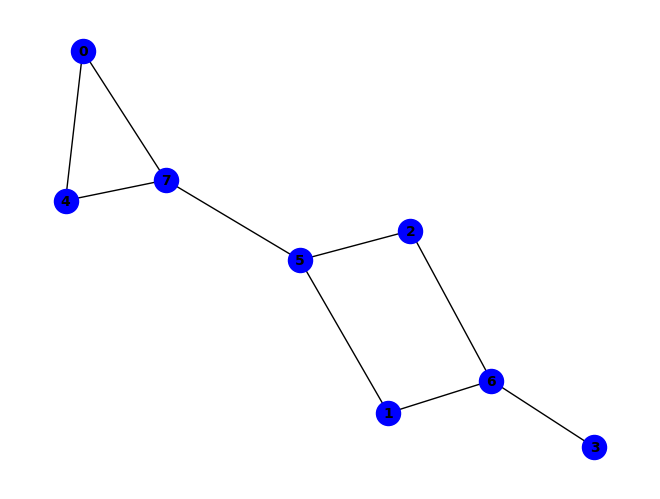


(~c & ~f) ^ (d & g & ~c) ^ (e & h & ~f) ^ (c & ~f & ~g) ^ (f & ~c & ~h) ^ (a & e & ~d & ~h) ^ (a & h & ~e & ~f) ^ (a & c & e & f & ~h) ^ (d & e & g & h & ~c) ^ (a & b & g & ~e & ~f) ^ (a & c & g & ~f & ~h) ^ (a & d & e & ~g & ~h) ^ (a & b & d & e & g & ~h) ^ (b & f & ~c & ~d & ~h) ^ (b & g & ~c & ~d & ~f) ^ (a & b & e & f & ~c & ~h) ^ (b & e & g & h & ~d & ~f) ^ (c & e & g & h & ~b & ~f) ^ (d & f & g & h & ~c & ~e) ^ (b & c & d & e & g & h & ~f) ^ (a & b & g & ~c & ~f & ~h) ^ (a & c & g & ~b & ~e & ~f) ^ (b & d & f & ~c & ~g & ~h) ^ (a & c & d & e & g & ~b & ~h) ^ (a & d & g & h & ~b & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


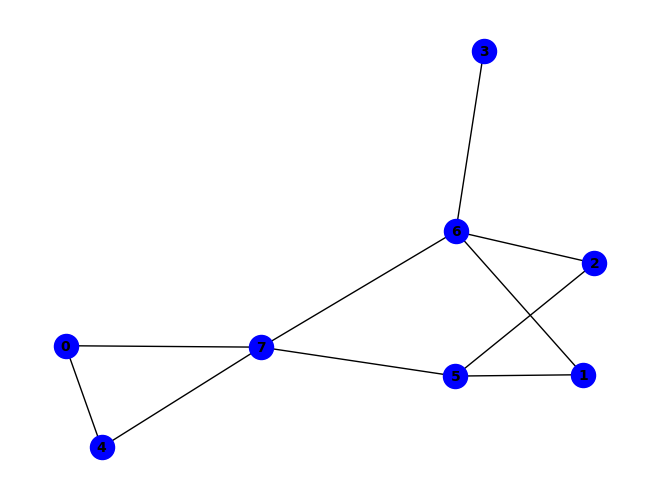


(~d & ~g) ^ (a & e & ~h) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (b & g & ~d & ~h) ^ (c & d & ~g & ~h) ^ (c & f & ~g & ~h) ^ (e & h & ~f & ~g) ^ (a & c & e & f & ~h) ^ (b & c & f & ~a & ~h) ^ (a & h & ~e & ~f & ~g) ^ (b & f & ~a & ~g & ~h) ^ (a & b & e & g & ~d & ~h) ^ (a & c & e & g & ~f & ~h) ^ (a & d & e & g & ~c & ~h) ^ (b & c & d & g & ~a & ~h) ^ (b & c & g & ~a & ~f & ~h) ^ (a & b & c & g & ~d & ~e & ~h) ^ (a & b & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


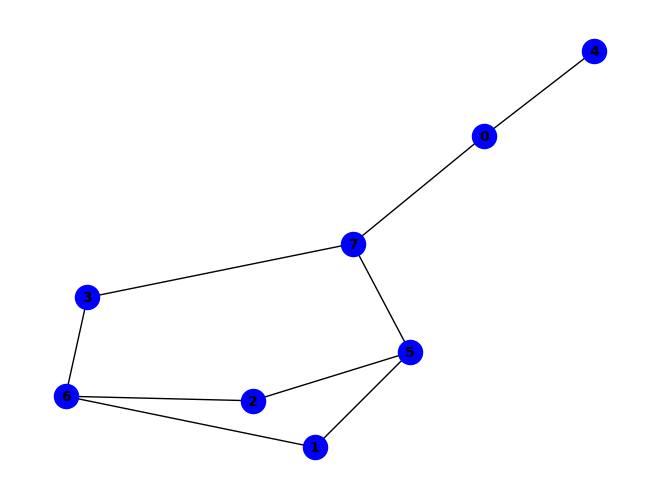


(~a & ~f) ^ (b & d & g & ~a) ^ (a & f & ~c & ~h) ^ (c & g & ~a & ~f) ^ (d & g & ~a & ~h) ^ (d & h & ~a & ~f) ^ (a & ~d & ~e & ~h) ^ (f & ~b & ~c & ~h) ^ (c & d & g & ~a & ~b) ^ (c & d & f & g & h & ~a) ^ (a & d & ~e & ~g & ~h) ^ (b & g & ~a & ~c & ~f) ^ (a & b & e & f & ~c & ~h) ^ (a & c & f & ~e & ~g & ~h) ^ (a & c & g & ~d & ~e & ~h) ^ (b & d & f & g & h & ~a & ~c) ^ (a & b & d & g & ~c & ~e & ~h) ^ (a & b & g & ~c & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


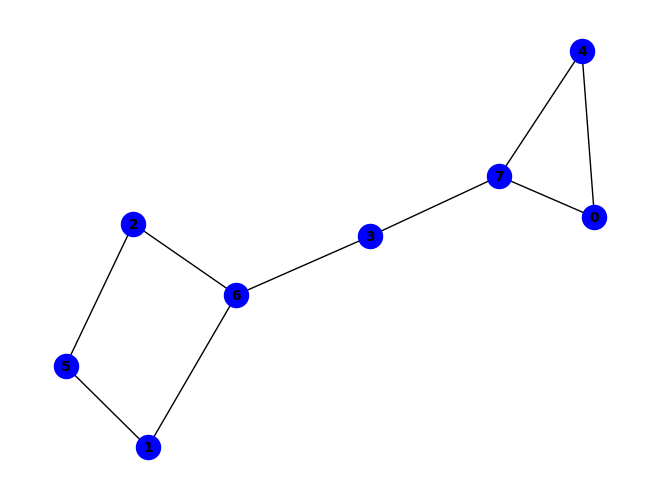


(~c & ~e) ^ (a & h & ~b) ^ (c & ~f & ~g) ^ (e & ~c & ~h) ^ (a & b & c & g & h) ^ (a & e & ~c & ~d) ^ (b & f & ~c & ~g) ^ (b & g & ~c & ~d) ^ (d & g & ~c & ~h) ^ (a & c & f & h & ~d) ^ (a & c & g & h & ~f) ^ (a & d & e & h & ~b) ^ (a & c & d & e & f & h) ^ (a & b & h & ~f & ~g) ^ (a & c & e & ~f & ~g) ^ (c & e & h & ~f & ~g) ^ (a & b & c & f & h & ~g) ^ (a & b & d & f & h & ~g) ^ (a & b & d & g & h & ~e) ^ (d & h & ~a & ~c & ~e) ^ (a & b & e & f & ~c & ~g) ^ (a & b & e & g & ~c & ~d) ^ (a & c & d & h & ~b & ~g) ^ (b & e & f & h & ~c & ~g) ^ (b & e & g & h & ~c & ~d) ^ (a & b & c & d & e & h & ~g) ^ (a & c & d & f & g & h & ~b) ^ (a & d & e & ~c & ~g & ~h) ^ (c & d & h & ~e & ~f & ~g) ^ (a & b & c & d & h & ~e & ~f) ^ (a & b & d & e & h & ~f & ~g) ^ (b & d & f & h & ~c & ~e & ~g) ^ (a & c & d & e & g & h & ~b & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

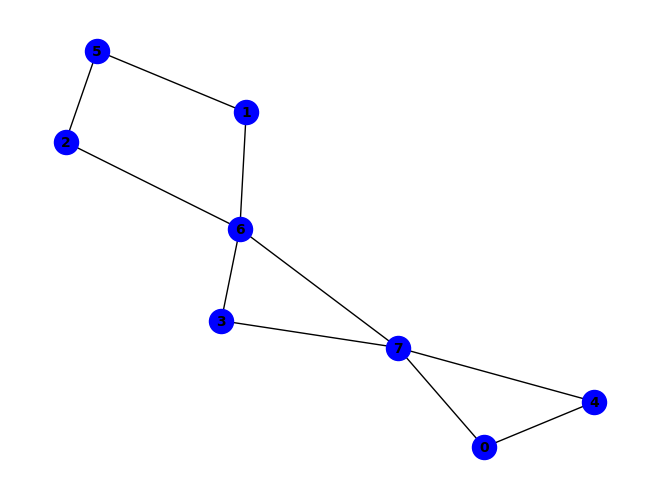


(~c & ~g) ^ (b & f & ~g) ^ (a & c & f & ~h) ^ (a & e & ~d & ~h) ^ (a & h & ~e & ~g) ^ (b & c & ~a & ~g) ^ (d & g & ~a & ~e) ^ (d & h & ~a & ~e) ^ (e & h & ~c & ~g) ^ (a & b & c & h & ~g) ^ (b & d & f & g & ~e) ^ (b & d & f & h & ~e) ^ (c & d & f & g & ~b) ^ (c & d & f & h & ~b) ^ (c & ~b & ~f & ~g) ^ (g & ~b & ~c & ~h) ^ (a & b & c & ~f & ~h) ^ (a & b & f & ~e & ~g) ^ (a & b & f & ~g & ~h) ^ (a & c & g & ~f & ~h) ^ (a & d & e & ~g & ~h) ^ (a & d & g & ~e & ~h) ^ (d & e & g & ~b & ~h) ^ (a & b & c & f & g & ~h) ^ (a & c & d & f & g & ~e) ^ (a & c & d & f & h & ~e) ^ (a & b & c & g & ~e & ~h) ^ (a & b & e & g & ~d & ~h) ^ (b & e & f & h & ~c & ~g) ^ (c & d & e & h & ~b & ~g) ^ (a & c & f & ~b & ~e & ~g) ^ (a & c & g & ~d & ~e & ~h) ^ (b & d & g & ~e & ~f & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (c & e & h & ~d & ~f & ~g) ^ (a & b & c & d & g & ~e & ~f) ^ (a & b & c & d & h & ~e & ~f) ^ (a & b & c & d & h & ~e & ~g) ^ (a & b & d & f & h & ~e & ~g) ^ (a & c & d & e & g & ~b & ~h) ^ (b & c & d

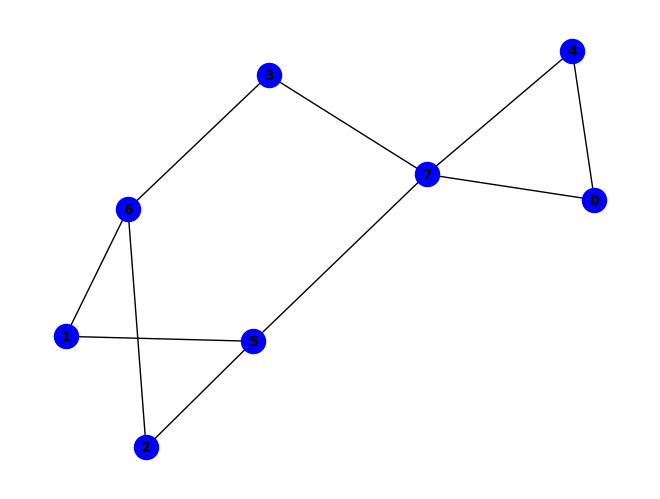


(c & d & g) ^ (~c & ~f) ^ (d & g & ~h) ^ (e & h & ~f) ^ (c & ~f & ~g) ^ (f & ~c & ~h) ^ (b & d & g & ~c) ^ (c & d & f & g & h) ^ (a & e & ~d & ~h) ^ (b & g & ~c & ~f) ^ (d & h & ~e & ~f) ^ (a & b & c & g & ~h) ^ (a & b & e & f & ~h) ^ (a & c & e & f & ~h) ^ (b & e & f & g & ~c) ^ (a & b & g & ~e & ~f) ^ (a & b & g & ~f & ~h) ^ (a & c & g & ~f & ~h) ^ (a & d & e & ~g & ~h) ^ (a & c & d & e & g & ~h) ^ (b & d & e & f & h & ~c) ^ (b & d & f & g & h & ~c) ^ (a & h & ~d & ~e & ~f) ^ (b & f & ~c & ~e & ~h) ^ (a & b & c & f & ~e & ~h) ^ (a & b & c & f & ~g & ~h) ^ (b & d & e & f & ~c & ~g) ^ (b & e & g & h & ~c & ~d) ^ (c & e & g & h & ~d & ~f) ^ (a & c & g & ~b & ~e & ~f) ^ (a & b & d & e & g & ~c & ~h) ^ (a & c & d & g & h & ~e & ~f) ^ (b & e & f & ~c & ~d & ~g & ~h) ^ (a & b & d & g & h & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

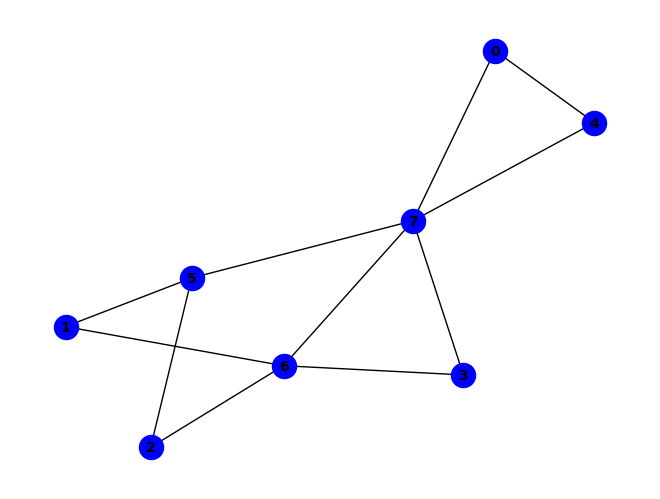


(~c & ~g) ^ (d & g & ~f) ^ (d & h & ~f) ^ (f & h & ~g) ^ (d & e & f & g) ^ (d & e & f & h) ^ (g & ~b & ~h) ^ (a & c & e & ~g) ^ (d & e & h & ~g) ^ (a & e & ~d & ~h) ^ (c & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (c & ~a & ~f & ~h) ^ (a & c & h & ~e & ~g) ^ (a & d & e & ~g & ~h) ^ (b & c & g & ~d & ~h) ^ (b & d & g & ~a & ~h) ^ (c & d & g & ~a & ~h) ^ (c & f & g & ~a & ~h) ^ (d & f & g & ~e & ~h) ^ (a & c & ~e & ~f & ~h) ^ (b & f & ~c & ~g & ~h) ^ (a & b & d & g & ~e & ~h) ^ (a & b & e & g & ~c & ~h) ^ (a & c & d & g & ~e & ~h) ^ (a & c & f & g & ~e & ~h) ^ (a & b & c & d & e & g & ~h) ^ (a & h & ~d & ~e & ~f & ~g) ^ (a & b & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


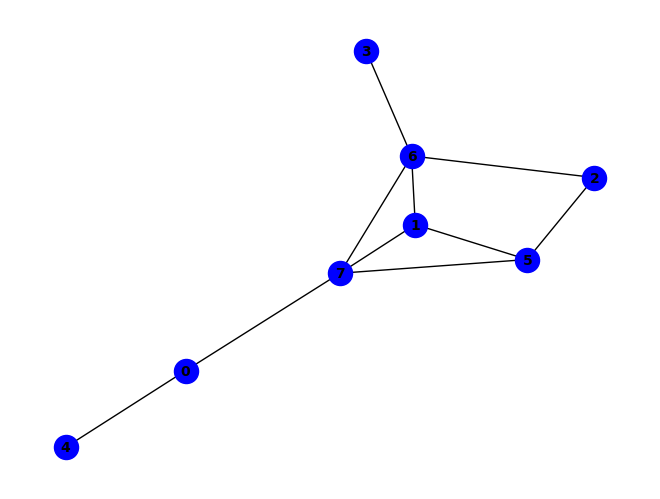


(b & f & ~c) ^ (b & h & ~c) ^ (a & b & e & f) ^ (a & b & e & h) ^ (d & ~c & ~h) ^ (a & d & e & ~h) ^ (~a & ~d & ~g) ^ (b & g & ~c & ~f) ^ (c & d & ~g & ~h) ^ (d & h & ~a & ~g) ^ (f & h & ~a & ~g) ^ (a & b & e & g & ~f) ^ (a & ~c & ~e & ~h) ^ (g & ~a & ~c & ~h) ^ (b & c & h & ~f & ~g) ^ (b & d & g & ~c & ~h) ^ (a & b & d & e & g & ~h) ^ (a & c & d & e & g & ~h) ^ (a & d & ~e & ~g & ~h) ^ (c & f & ~a & ~g & ~h) ^ (a & b & h & ~e & ~f & ~g) ^ (a & b & c & e & f & ~g & ~h) ^ (a & b & c & e & g & ~d & ~h) ^ (a & c & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


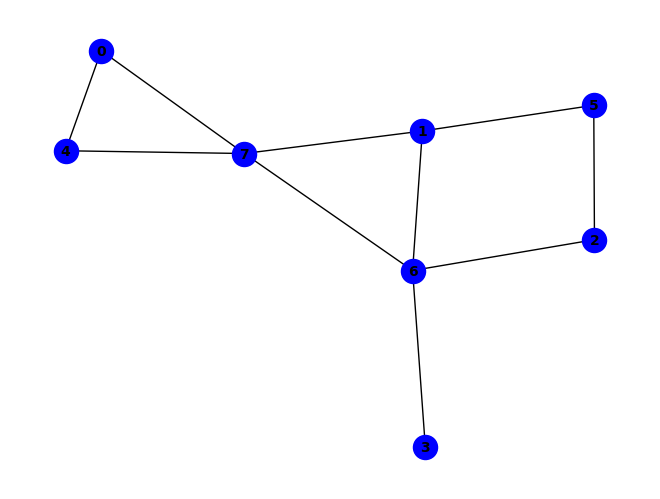


(~d & ~g) ^ (b & f & ~h) ^ (b & g & ~f) ^ (d & h & ~g) ^ (b & e & g & h) ^ (b & f & g & h) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (a & e & ~b & ~h) ^ (a & h & ~e & ~g) ^ (b & h & ~a & ~e) ^ (c & d & ~g & ~h) ^ (c & f & ~b & ~g) ^ (e & h & ~c & ~g) ^ (a & b & c & f & ~h) ^ (a & b & g & h & ~e) ^ (a & d & e & g & ~h) ^ (a & c & f & ~g & ~h) ^ (b & c & g & ~d & ~h) ^ (b & d & g & ~a & ~h) ^ (c & e & h & ~f & ~g) ^ (a & b & c & d & g & ~h) ^ (b & c & e & f & h & ~g) ^ (a & b & c & g & ~f & ~h) ^ (a & b & d & g & ~e & ~h) ^ (a & c & e & g & ~d & ~h) ^ (a & b & e & ~f & ~g & ~h) ^ (a & c & f & ~b & ~e & ~g) ^ (a & b & c & g & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


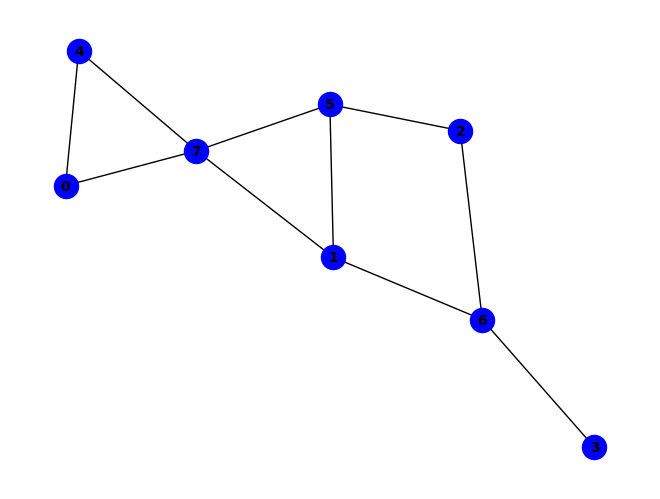


(~c & ~f) ^ (b & g & ~h) ^ (e & h & ~f) ^ (b & e & f & h) ^ (b & f & g & h) ^ (c & ~f & ~g) ^ (f & ~c & ~h) ^ (b & c & g & ~f) ^ (b & c & e & f & g) ^ (b & d & e & g & h) ^ (a & e & ~d & ~h) ^ (a & h & ~e & ~f) ^ (b & f & ~d & ~g) ^ (b & h & ~a & ~e) ^ (d & g & ~b & ~c) ^ (b & d & f & h & ~e) ^ (c & e & g & h & ~f) ^ (d & e & g & h & ~c) ^ (b & c & d & e & f & h) ^ (b & c & d & f & g & h) ^ (a & c & g & ~b & ~h) ^ (a & d & e & ~g & ~h) ^ (b & c & f & ~e & ~h) ^ (b & c & e & g & h & ~d) ^ (a & b & e & f & ~g & ~h) ^ (a & b & e & g & ~d & ~h) ^ (a & b & f & h & ~d & ~e) ^ (b & d & e & f & ~c & ~g) ^ (d & f & g & h & ~c & ~e) ^ (a & c & f & ~b & ~e & ~h) ^ (a & c & f & ~b & ~g & ~h) ^ (a & c & g & ~b & ~e & ~f) ^ (b & d & f & ~e & ~g & ~h) ^ (a & b & d & f & h & ~e & ~g) ^ (a & b & d & g & h & ~c & ~e) ^ (a & c & d & e & g & ~b & ~h) ^ (a & b & c & d & f & g & h & ~e) ^ (a & d & g & h & ~c & ~e & ~f) ^ (b & c & e & f & ~d & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


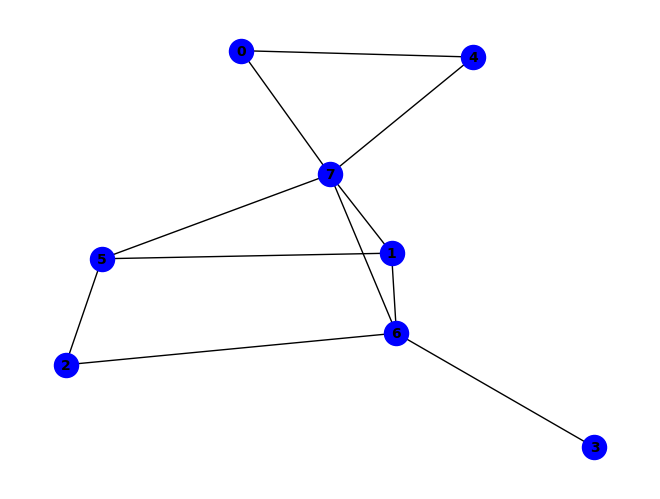


(~d & ~g) ^ (a & e & ~h) ^ (b & g & ~f) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (b & e & f & ~h) ^ (b & f & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & d & ~g & ~h) ^ (e & h & ~f & ~g) ^ (a & d & e & g & ~h) ^ (b & e & g & h & ~f) ^ (a & b & f & ~c & ~h) ^ (a & b & g & ~e & ~f) ^ (b & c & g & ~d & ~h) ^ (b & d & g & ~a & ~h) ^ (a & b & c & d & g & ~h) ^ (a & h & ~e & ~f & ~g) ^ (c & f & ~b & ~g & ~h) ^ (a & b & c & g & ~e & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & c & e & g & ~d & ~h) ^ (a & b & g & ~c & ~f & ~h) ^ (a & b & c & f & ~e & ~g & ~h) ^ (a & b & d & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


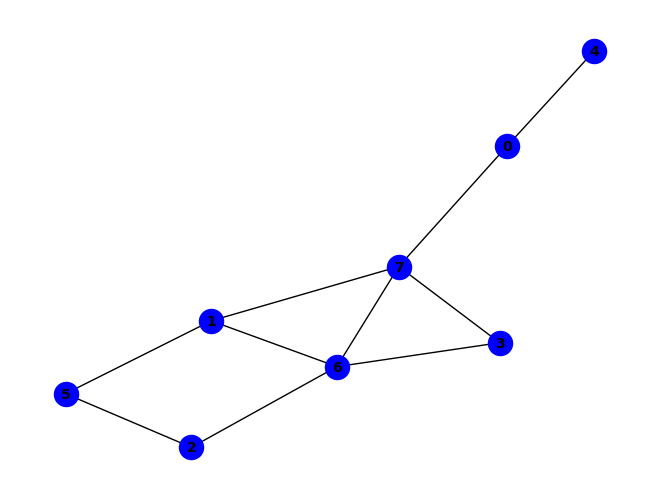


(b & f & ~a) ^ (~a & ~c & ~g) ^ (b & c & ~a & ~g) ^ (b & g & ~a & ~f) ^ (b & h & ~a & ~f) ^ (b & f & g & h & ~a) ^ (a & ~d & ~e & ~h) ^ (g & ~a & ~c & ~h) ^ (b & c & g & ~a & ~h) ^ (a & d & ~e & ~g & ~h) ^ (d & g & ~a & ~b & ~c) ^ (d & h & ~a & ~b & ~c) ^ (c & ~a & ~b & ~f & ~g) ^ (a & b & f & ~e & ~g & ~h) ^ (a & b & g & ~d & ~e & ~h) ^ (a & c & f & ~b & ~e & ~h) ^ (a & c & d & g & ~b & ~e & ~h) ^ (a & c & g & ~b & ~e & ~f & ~h) ^ (c & d & h & ~a & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


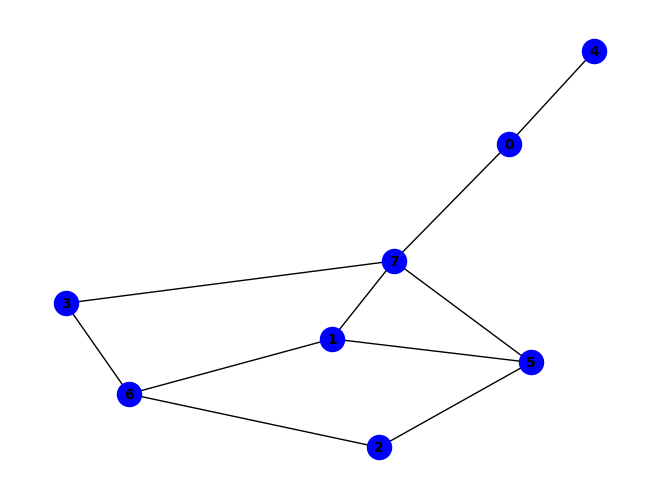


(~a & ~f) ^ (b & f & ~a & ~g) ^ (b & g & ~d & ~h) ^ (b & h & ~a & ~d) ^ (d & g & ~a & ~h) ^ (d & h & ~a & ~f) ^ (a & b & d & g & ~h) ^ (a & b & e & g & ~h) ^ (b & f & g & h & ~a) ^ (a & ~d & ~e & ~h) ^ (f & ~a & ~c & ~h) ^ (b & c & f & ~a & ~h) ^ (c & d & g & ~a & ~b) ^ (c & d & f & g & h & ~a) ^ (c & g & ~a & ~b & ~f) ^ (a & b & c & f & ~e & ~h) ^ (b & d & f & h & ~a & ~c) ^ (a & b & d & ~c & ~e & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & f & ~e & ~g & ~h) ^ (a & c & g & ~d & ~e & ~h) ^ (b & c & d & f & h & ~a & ~g) ^ (a & d & ~b & ~e & ~g & ~h) ^ (a & b & c & d & ~e & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


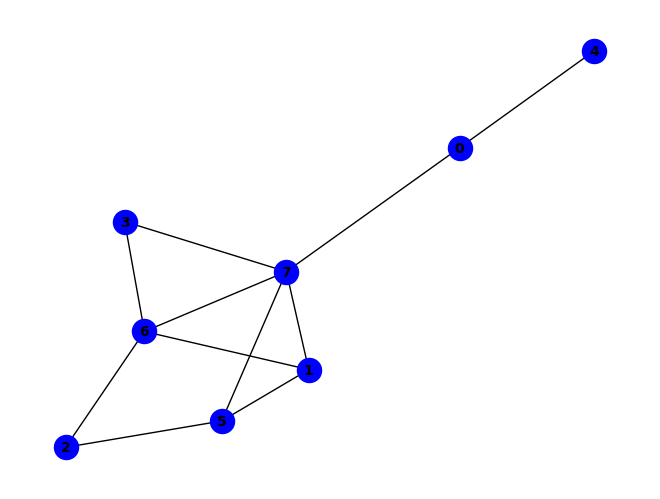


(g & ~a & ~h) ^ (~a & ~c & ~g) ^ (b & f & ~a & ~g) ^ (b & g & ~a & ~d) ^ (b & h & ~a & ~d) ^ (c & h & ~a & ~g) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (f & h & ~a & ~g) ^ (a & ~d & ~e & ~h) ^ (c & ~a & ~f & ~h) ^ (a & b & f & ~e & ~h) ^ (b & c & g & ~d & ~h) ^ (c & d & g & ~a & ~h) ^ (c & f & g & ~a & ~h) ^ (d & f & g & ~a & ~h) ^ (a & b & c & d & g & ~h) ^ (a & b & c & e & g & ~h) ^ (a & b & d & g & ~e & ~h) ^ (b & d & f & h & ~a & ~g) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & d & ~b & ~e & ~h) ^ (a & c & f & ~b & ~e & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (b & c & f & ~a & ~g & ~h) ^ (a & b & c & f & g & ~e & ~h) ^ (a & d & ~c & ~e & ~g & ~h) ^ (a & b & c & d & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


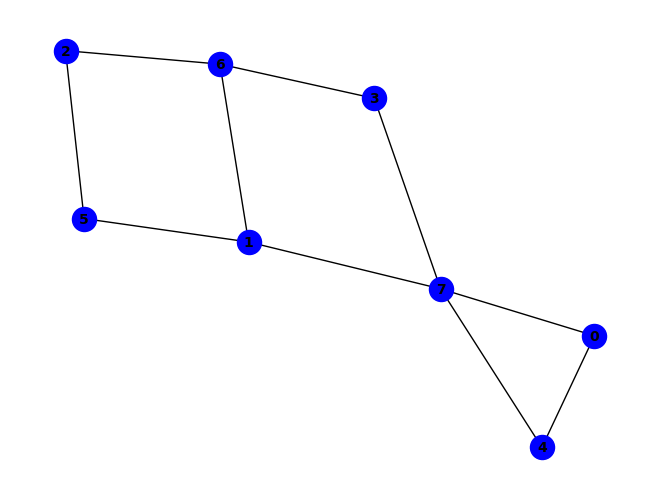


(a & h) ^ (b & d & g) ^ (~c & ~e) ^ (b & d & e & h) ^ (c & ~f & ~g) ^ (e & ~c & ~h) ^ (a & e & ~c & ~d) ^ (d & g & ~c & ~h) ^ (a & c & f & h & ~d) ^ (a & c & g & h & ~f) ^ (b & c & d & h & ~f) ^ (a & c & d & f & g & h) ^ (b & c & d & e & g & h) ^ (a & c & e & ~f & ~g) ^ (b & d & h & ~c & ~g) ^ (c & e & h & ~f & ~g) ^ (a & b & d & e & h & ~g) ^ (a & d & e & g & h & ~c) ^ (b & c & d & f & g & ~e) ^ (b & f & ~a & ~c & ~h) ^ (b & h & ~a & ~c & ~e) ^ (d & h & ~a & ~c & ~e) ^ (a & b & d & e & ~c & ~h) ^ (a & b & d & h & ~c & ~e) ^ (a & c & d & h & ~e & ~g) ^ (b & c & d & g & ~f & ~h) ^ (a & c & d & e & f & h & ~g) ^ (b & c & d & e & f & g & ~h) ^ (b & c & d & e & f & h & ~a) ^ (a & b & c & d & e & f & g & h) ^ (a & b & f & ~c & ~e & ~h) ^ (a & d & e & ~b & ~c & ~g) ^ (c & d & h & ~e & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (b & g & ~a & ~c & ~f & ~h) ^ (a & b & g & ~c & ~e & ~f & ~h) ^ (b & c & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


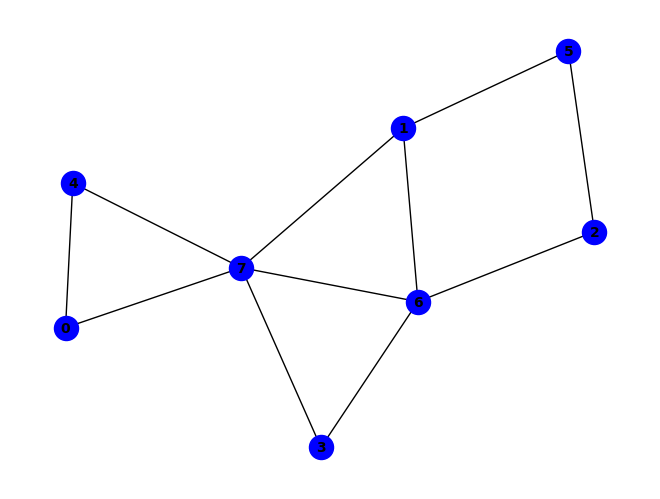


(b & f) ^ (~c & ~g) ^ (b & g & ~f) ^ (b & h & ~f) ^ (b & f & g & h) ^ (g & ~c & ~h) ^ (a & c & f & ~h) ^ (b & c & g & ~h) ^ (a & e & ~d & ~h) ^ (b & c & ~a & ~g) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (a & b & c & h & ~g) ^ (c & d & f & g & ~b) ^ (c & d & f & h & ~b) ^ (c & ~b & ~f & ~g) ^ (a & b & c & ~f & ~h) ^ (a & b & e & ~d & ~g) ^ (a & b & e & ~f & ~h) ^ (a & b & h & ~d & ~g) ^ (a & c & g & ~f & ~h) ^ (a & d & e & ~g & ~h) ^ (d & e & g & ~b & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & e & f & g & ~h) ^ (a & c & d & e & g & ~h) ^ (a & h & ~d & ~e & ~g) ^ (e & h & ~b & ~c & ~g) ^ (a & b & d & e & ~c & ~h) ^ (c & d & e & h & ~b & ~g) ^ (a & c & f & ~b & ~e & ~g) ^ (a & c & g & ~b & ~e & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (a & b & c & d & e & ~g & ~h) ^ (c & e & h & ~b & ~d & ~f & ~g) ^ (a & c & d & f & h & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

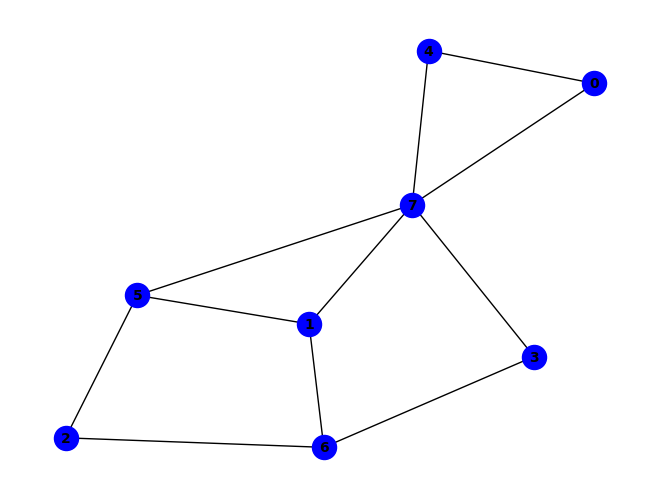


(~c & ~f) ^ (b & f & ~g) ^ (b & g & ~h) ^ (e & h & ~f) ^ (b & f & g & h) ^ (c & ~f & ~g) ^ (f & ~c & ~h) ^ (b & c & g & ~f) ^ (c & d & g & ~b) ^ (a & e & ~d & ~h) ^ (b & h & ~a & ~e) ^ (d & g & ~b & ~h) ^ (a & b & f & h & ~e) ^ (a & c & e & f & ~h) ^ (b & e & f & h & ~c) ^ (a & d & e & ~g & ~h) ^ (b & c & f & ~a & ~h) ^ (b & c & e & f & h & ~g) ^ (b & c & e & g & h & ~d) ^ (c & d & f & g & h & ~b) ^ (b & c & d & e & f & g & h) ^ (a & h & ~d & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & b & c & f & ~e & ~h) ^ (a & b & d & h & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & b & e & g & ~d & ~h) ^ (c & e & g & h & ~d & ~f) ^ (a & c & g & ~b & ~e & ~f) ^ (a & c & g & ~b & ~f & ~h) ^ (a & c & d & e & g & ~b & ~h) ^ (a & c & d & g & h & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


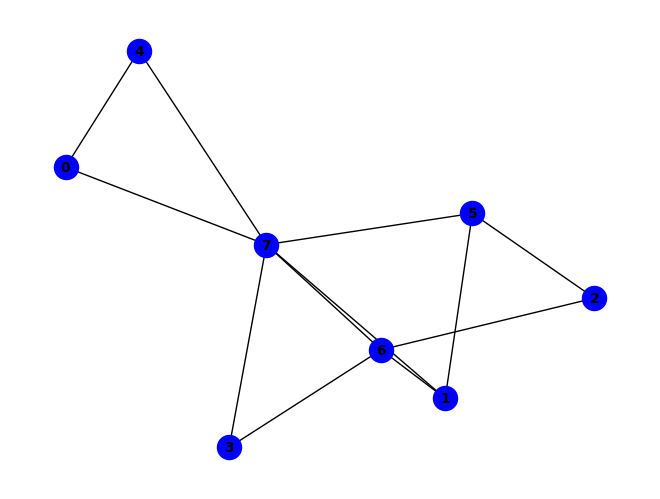


(g & ~h) ^ (~c & ~g) ^ (b & f & ~g) ^ (f & h & ~g) ^ (a & c & e & ~g) ^ (b & e & g & ~h) ^ (a & e & ~d & ~h) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & h & ~a & ~g) ^ (d & g & ~b & ~f) ^ (d & h & ~b & ~f) ^ (e & h & ~f & ~g) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (c & ~a & ~f & ~h) ^ (a & b & f & ~c & ~h) ^ (a & b & f & ~e & ~g) ^ (a & c & h & ~e & ~g) ^ (a & d & e & ~g & ~h) ^ (b & c & f & ~g & ~h) ^ (b & c & g & ~d & ~h) ^ (c & d & g & ~a & ~h) ^ (c & f & g & ~a & ~h) ^ (d & e & h & ~b & ~g) ^ (a & c & ~e & ~f & ~h) ^ (a & b & c & f & ~e & ~h) ^ (a & c & d & g & ~e & ~h) ^ (a & c & f & g & ~e & ~h) ^ (a & b & g & ~c & ~f & ~h) ^ (d & f & g & ~b & ~e & ~h) ^ (a & b & d & e & g & ~c & ~h) ^ (a & h & ~d & ~e & ~f & ~g) ^ (a & b & c & g & ~e & ~f & ~h) ^ (a & b & d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

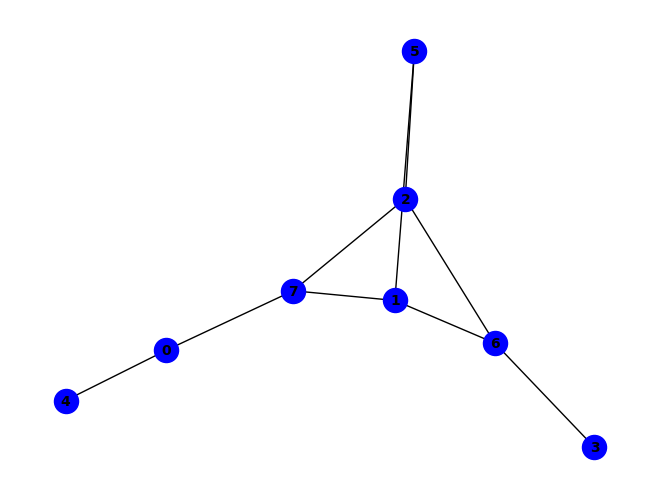


(b & g & ~h) ^ (a & ~e & ~h) ^ (b & c & f & ~h) ^ (~a & ~c & ~d) ^ (b & f & ~a & ~g) ^ (b & h & ~a & ~f) ^ (d & ~a & ~c & ~g) ^ (b & c & g & ~a & ~f) ^ (b & c & h & ~a & ~g) ^ (b & d & g & ~a & ~c) ^ (a & b & c & g & ~f & ~h) ^ (a & b & e & g & ~c & ~h) ^ (b & f & g & h & ~a & ~c) ^ (c & ~a & ~f & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & f & ~e & ~g & ~h) ^ (a & c & g & ~d & ~e & ~h) ^ (a & d & g & ~b & ~e & ~h) ^ (a & b & c & d & g & ~e & ~h) ^ (a & b & c & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


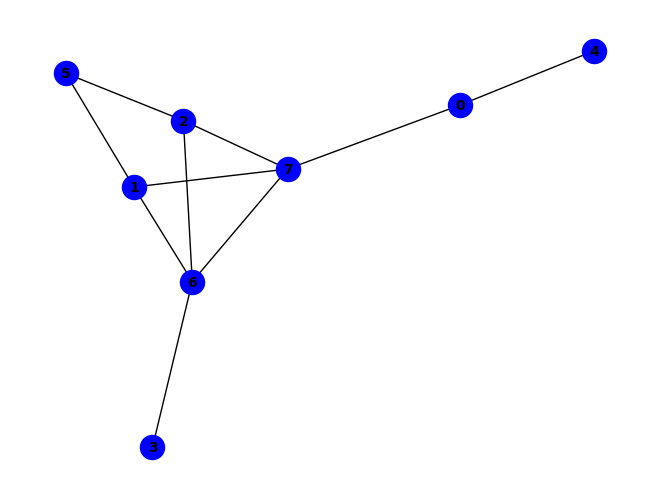


(a & g & ~h) ^ (b & f & ~c) ^ (a & b & c & h) ^ (a & b & e & f) ^ (a & c & e & f) ^ (a & ~d & ~g) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (a & b & h & ~f) ^ (a & c & g & ~f) ^ (a & c & h & ~f) ^ (~c & ~d & ~g) ^ (b & h & ~c & ~f) ^ (a & b & c & f & ~e) ^ (a & b & c & f & ~h) ^ (a & c & d & e & ~g) ^ (a & c & f & h & ~e) ^ (a & c & e & f & g & h) ^ (a & ~c & ~e & ~h) ^ (c & ~f & ~g & ~h) ^ (a & d & e & ~c & ~h) ^ (b & d & g & ~c & ~h) ^ (a & c & ~e & ~g & ~h) ^ (a & d & ~e & ~g & ~h) ^ (b & g & ~a & ~c & ~f) ^ (d & h & ~a & ~c & ~g) ^ (a & b & c & g & ~e & ~h) ^ (a & b & f & h & ~c & ~e) ^ (a & c & d & h & ~e & ~g) ^ (a & c & f & g & ~b & ~e) ^ (b & f & g & h & ~a & ~c) ^ (a & b & c & f & g & h & ~e) ^ (a & b & g & ~e & ~f & ~h) ^ (a & b & d & e & g & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


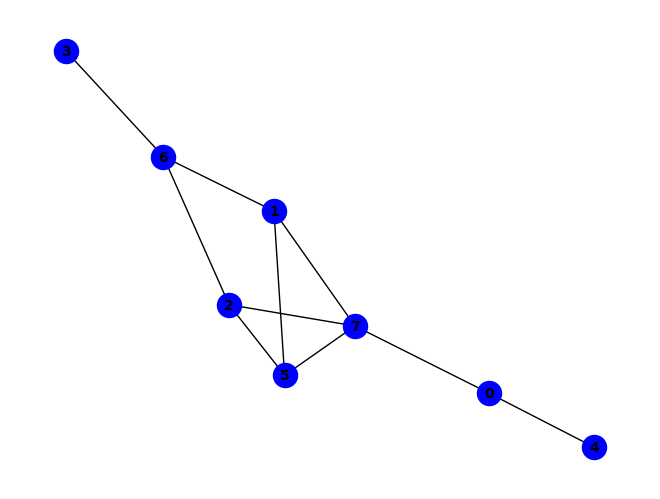


(a & b & h) ^ (~a & ~f) ^ (b & f & ~d) ^ (b & g & ~f) ^ (b & h & ~g) ^ (f & ~a & ~h) ^ (b & d & f & ~h) ^ (a & c & d & f & h) ^ (c & g & ~b & ~h) ^ (c & h & ~a & ~b) ^ (a & b & e & g & ~h) ^ (b & d & f & h & ~g) ^ (b & f & g & h & ~a) ^ (c & d & f & h & ~b) ^ (d & f & g & h & ~a) ^ (a & ~d & ~e & ~h) ^ (a & c & f & ~d & ~g) ^ (a & b & d & f & h & ~c) ^ (a & d & ~e & ~g & ~h) ^ (c & f & ~b & ~d & ~g) ^ (d & g & ~a & ~b & ~c) ^ (a & c & d & f & ~g & ~h) ^ (a & c & d & g & ~e & ~h) ^ (a & c & e & g & ~b & ~h) ^ (c & f & g & h & ~a & ~b) ^ (a & b & f & ~c & ~d & ~g) ^ (a & c & f & ~e & ~g & ~h) ^ (c & d & f & ~b & ~g & ~h) ^ (a & b & d & f & ~c & ~g & ~h) ^ (a & b & d & g & ~c & ~e & ~h) ^ (a & b & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


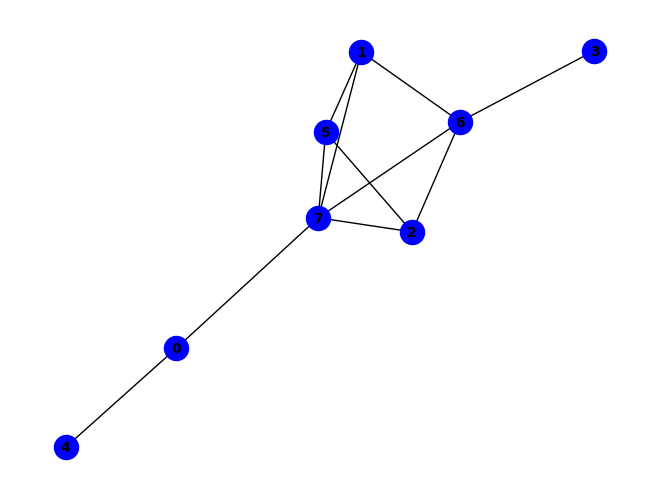


(b & f & ~c) ^ (b & h & ~a) ^ (c & f & ~g) ^ (c & g & ~b) ^ (a & b & c & g) ^ (a & b & e & f) ^ (a & c & e & f) ^ (b & c & f & g) ^ (d & ~c & ~h) ^ (g & ~a & ~h) ^ (a & c & g & ~f) ^ (a & d & e & ~h) ^ (~a & ~d & ~g) ^ (b & g & ~a & ~f) ^ (c & d & ~g & ~h) ^ (c & h & ~a & ~b) ^ (d & h & ~a & ~g) ^ (f & h & ~a & ~g) ^ (a & b & c & f & ~g) ^ (a & b & f & g & ~e) ^ (a & ~c & ~e & ~h) ^ (b & d & g & ~c & ~h) ^ (a & c & d & e & g & ~h) ^ (a & c & ~e & ~g & ~h) ^ (a & d & ~e & ~g & ~h) ^ (a & b & c & f & ~e & ~h) ^ (a & b & f & h & ~e & ~g) ^ (a & c & f & g & ~b & ~e) ^ (a & c & f & h & ~e & ~g) ^ (a & b & c & f & g & h & ~e) ^ (a & b & g & ~c & ~e & ~h) ^ (a & b & d & e & g & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


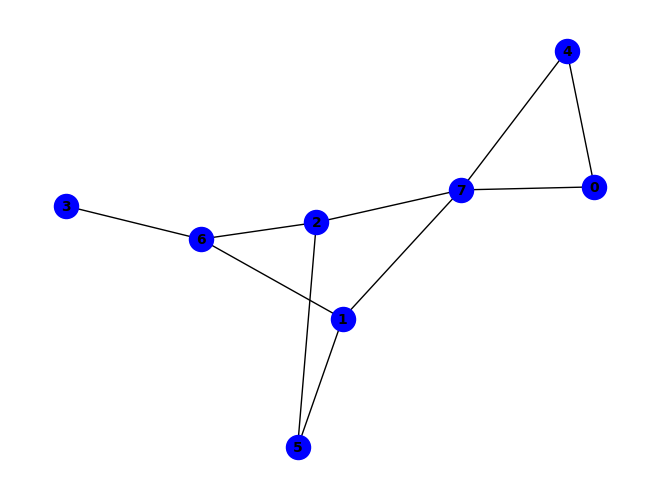


~e ^ (e & ~h) ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & f & ~g) ^ (b & h & ~f) ^ (a & d & h & ~g) ^ (b & c & g & ~f) ^ (b & c & h & ~g) ^ (a & b & d & e & g) ^ (a & c & d & g & h) ^ (b & g & ~a & ~h) ^ (c & g & ~a & ~h) ^ (c & h & ~a & ~e) ^ (d & g & ~b & ~c) ^ (a & c & d & e & ~b) ^ (b & f & g & h & ~c) ^ (d & e & g & h & ~c) ^ (a & b & g & ~e & ~h) ^ (a & b & h & ~c & ~e) ^ (a & d & e & ~c & ~g) ^ (b & c & f & ~a & ~h) ^ (b & e & h & ~c & ~d) ^ (a & b & c & d & e & ~g) ^ (a & b & d & g & h & ~c) ^ (c & f & ~a & ~g & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & b & e & f & ~g & ~h) ^ (b & d & e & h & ~c & ~g) ^ (a & c & g & ~b & ~e & ~h) ^ (a & c & f & ~b & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


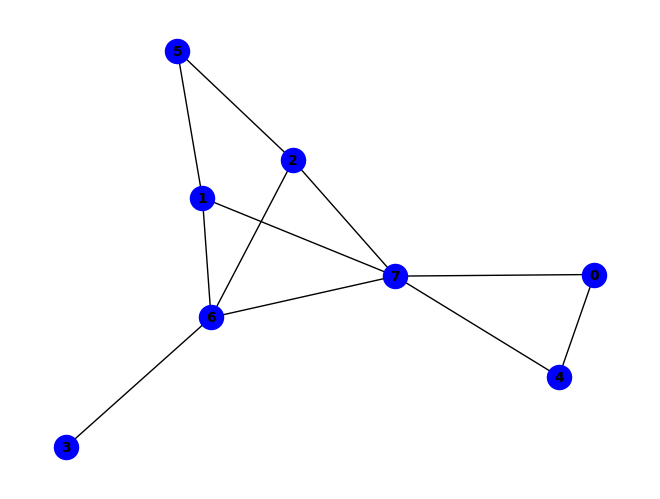


(g & ~h) ^ (~d & ~g) ^ (b & f & ~h) ^ (b & g & ~f) ^ (c & f & ~h) ^ (c & g & ~f) ^ (d & h & ~g) ^ (e & h & ~g) ^ (b & c & e & h) ^ (b & e & g & h) ^ (c & e & g & h) ^ (c & f & g & h) ^ (d & ~c & ~h) ^ (b & c & f & ~g) ^ (b & c & h & ~f) ^ (a & e & ~c & ~h) ^ (a & h & ~e & ~g) ^ (b & h & ~a & ~e) ^ (c & d & ~g & ~h) ^ (c & h & ~a & ~e) ^ (a & b & c & h & ~e) ^ (a & b & g & h & ~e) ^ (a & c & g & h & ~e) ^ (b & f & g & h & ~c) ^ (b & c & g & ~a & ~e) ^ (b & d & g & ~c & ~h) ^ (a & b & c & g & ~e & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & b & e & g & ~f & ~h) ^ (b & c & e & g & ~a & ~h) ^ (a & b & c & e & f & g & ~h) ^ (a & c & e & ~f & ~g & ~h) ^ (a & d & e & g & ~b & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


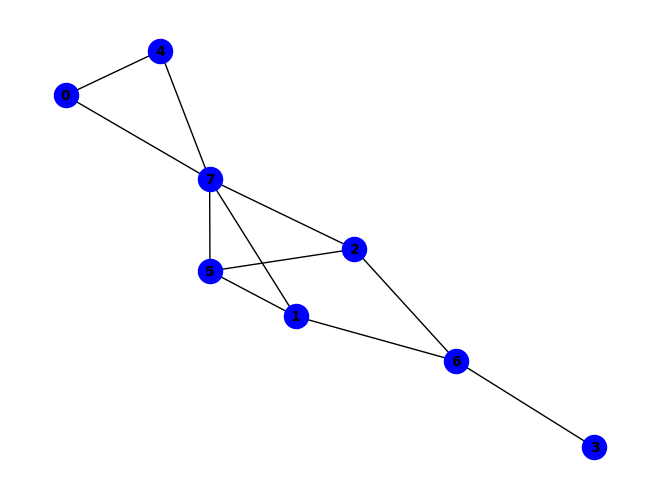


~f ^ (f & ~h) ^ (b & d & g) ^ (b & g & ~h) ^ (c & g & ~h) ^ (d & g & ~c) ^ (e & h & ~f) ^ (a & b & f & h) ^ (c & d & f & h) ^ (c & f & g & h) ^ (b & c & g & ~d) ^ (b & c & h & ~g) ^ (a & e & ~d & ~h) ^ (a & h & ~e & ~f) ^ (b & h & ~a & ~e) ^ (c & f & ~d & ~g) ^ (c & h & ~a & ~e) ^ (a & b & e & f & ~g) ^ (b & c & e & h & ~f) ^ (b & d & f & h & ~c) ^ (b & e & f & h & ~d) ^ (b & f & g & h & ~c) ^ (c & e & f & h & ~d) ^ (d & f & g & h & ~e) ^ (a & b & e & f & g & h) ^ (b & c & d & e & f & h) ^ (a & d & e & ~g & ~h) ^ (c & d & e & f & h & ~g) ^ (b & f & ~c & ~d & ~g) ^ (a & b & c & h & ~e & ~f) ^ (a & c & e & g & ~d & ~h) ^ (a & c & f & h & ~d & ~e) ^ (b & d & e & f & ~c & ~g) ^ (d & e & g & h & ~b & ~c) ^ (b & d & f & ~e & ~g & ~h) ^ (c & d & f & ~b & ~g & ~h) ^ (a & c & d & f & h & ~e & ~g) ^ (a & c & d & g & h & ~b & ~e) ^ (b & c & d & e & f & ~g & ~h) ^ (a & b & c & d & f & g & h & ~e) ^ (a & b & e & g & ~c & ~d & ~h) ^ (a & c & e & f & ~b & ~g & ~h) ^ (a & d & g & h & ~b & ~e & ~f)
PA

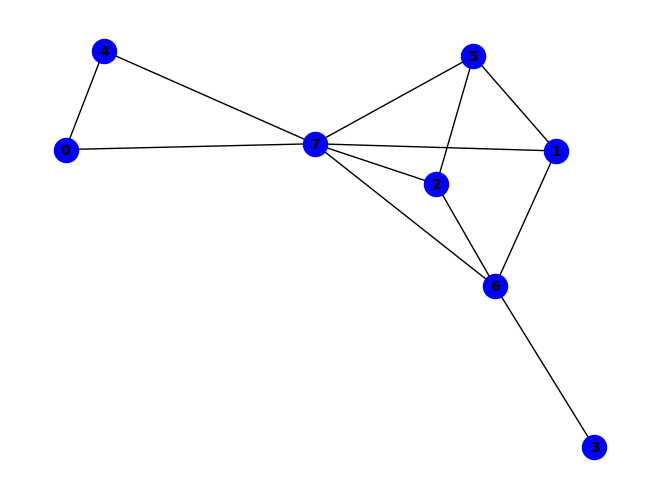


(g & ~h) ^ (~d & ~g) ^ (a & e & ~h) ^ (c & f & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (b & f & ~c & ~g) ^ (b & g & ~a & ~e) ^ (c & d & ~g & ~h) ^ (c & g & ~b & ~e) ^ (c & h & ~a & ~e) ^ (e & h & ~f & ~g) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & e & f & h & ~g) ^ (a & b & f & ~c & ~h) ^ (a & b & f & ~e & ~g) ^ (a & c & f & ~b & ~e) ^ (a & c & f & ~g & ~h) ^ (a & c & g & ~d & ~h) ^ (b & d & g & ~c & ~h) ^ (b & e & g & ~f & ~h) ^ (c & e & g & ~b & ~h) ^ (b & c & e & f & g & ~h) ^ (a & h & ~e & ~f & ~g) ^ (b & h & ~a & ~c & ~e) ^ (a & c & d & g & ~e & ~h) ^ (a & d & e & g & ~b & ~h) ^ (a & b & c & d & e & g & ~h) ^ (a & b & g & ~c & ~f & ~h) ^ (a & c & g & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


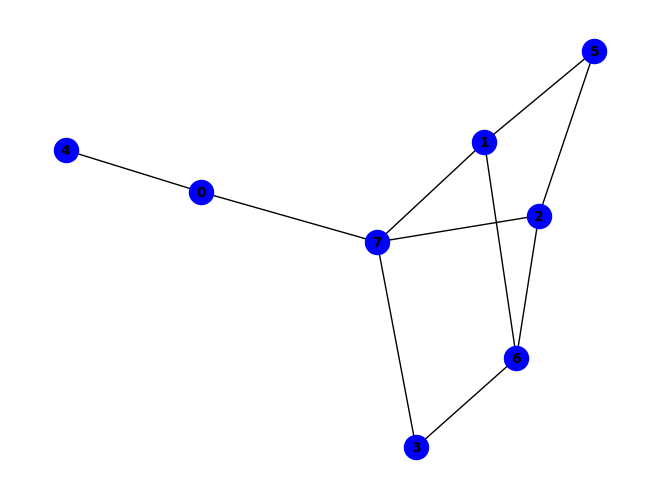


~b ^ (a & e & ~h) ^ (a & h & ~d) ^ (c & h & ~b) ^ (d & h & ~c) ^ (a & b & e & h) ^ (a & c & e & h) ^ (a & c & g & ~h) ^ (b & d & g & ~c) ^ (c & g & ~b & ~h) ^ (d & g & ~c & ~h) ^ (a & b & c & f & ~h) ^ (a & b & c & g & ~f) ^ (a & b & c & h & ~g) ^ (a & b & d & h & ~c) ^ (a & b & e & f & ~h) ^ (a & c & d & g & ~b) ^ (a & b & c & d & g & h) ^ (a & b & c & f & g & h) ^ (b & ~f & ~g & ~h) ^ (a & b & c & ~e & ~g) ^ (a & b & g & ~e & ~f) ^ (a & b & g & ~f & ~h) ^ (a & b & h & ~e & ~g) ^ (a & c & f & ~e & ~h) ^ (a & c & f & ~g & ~h) ^ (a & c & g & ~e & ~f) ^ (b & d & h & ~c & ~g) ^ (a & b & f & g & h & ~e) ^ (a & c & d & e & h & ~g) ^ (a & c & f & g & h & ~e) ^ (c & f & ~b & ~g & ~h) ^ (a & d & e & g & ~b & ~h) ^ (a & b & c & ~e & ~f & ~h) ^ (a & c & d & ~b & ~e & ~g) ^ (a & c & d & ~b & ~e & ~h) ^ (a & c & h & ~b & ~e & ~g) ^ (a & b & c & d & h & ~e & ~g) ^ (a & b & c & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


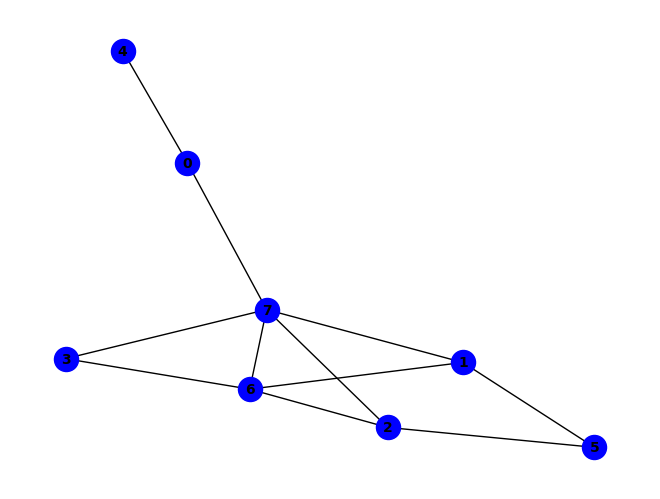


(~a & ~g) ^ (b & f & ~c) ^ (c & f & ~h) ^ (c & h & ~d) ^ (d & h & ~b) ^ (g & ~a & ~h) ^ (a & b & h & ~d) ^ (a & d & h & ~c) ^ (b & g & ~a & ~f) ^ (b & h & ~c & ~f) ^ (a & b & e & f & ~h) ^ (a & c & e & f & ~b) ^ (b & c & d & h & ~a) ^ (c & f & g & h & ~a) ^ (a & ~d & ~e & ~h) ^ (a & c & h & ~b & ~f) ^ (c & g & ~a & ~b & ~f) ^ (d & g & ~a & ~b & ~c) ^ (a & b & d & g & ~e & ~h) ^ (a & c & f & g & ~b & ~e) ^ (b & f & g & h & ~a & ~c) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & d & ~b & ~e & ~h) ^ (a & c & g & ~b & ~e & ~h) ^ (a & d & ~c & ~e & ~g & ~h) ^ (a & b & c & d & ~e & ~g & ~h) ^ (a & c & f & h & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


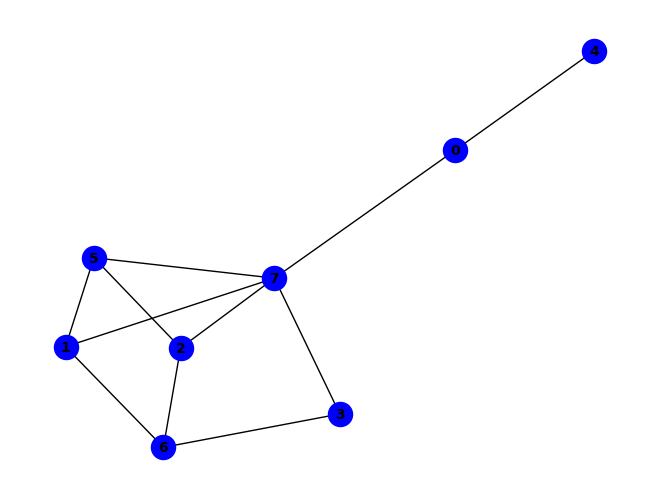


(~a & ~f) ^ (c & h & ~d) ^ (d & g & ~h) ^ (d & h & ~f) ^ (c & d & f & h) ^ (f & ~a & ~h) ^ (a & b & h & ~d) ^ (a & c & f & ~g) ^ (a & c & g & ~d) ^ (a & d & g & ~b) ^ (a & b & c & e & f) ^ (a & b & d & f & h) ^ (a & b & d & g & h) ^ (b & f & ~a & ~g) ^ (b & h & ~c & ~d) ^ (c & f & ~b & ~g) ^ (c & g & ~d & ~h) ^ (a & b & c & g & ~f) ^ (a & b & c & h & ~g) ^ (a & b & e & g & ~h) ^ (a & c & e & h & ~g) ^ (a & d & f & h & ~c) ^ (b & d & f & h & ~c) ^ (b & f & g & h & ~a) ^ (a & ~d & ~e & ~h) ^ (a & d & h & ~c & ~g) ^ (a & b & c & d & g & ~h) ^ (a & b & c & d & h & ~f) ^ (a & b & c & f & h & ~e) ^ (a & c & ~d & ~e & ~g) ^ (a & c & ~e & ~f & ~h) ^ (a & d & ~e & ~g & ~h) ^ (b & g & ~c & ~d & ~h) ^ (a & b & d & g & ~e & ~h) ^ (a & c & d & h & ~e & ~g) ^ (a & c & f & g & ~e & ~h) ^ (c & f & g & h & ~a & ~b) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & d & ~b & ~e & ~h) ^ (a & b & c & d & ~e & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


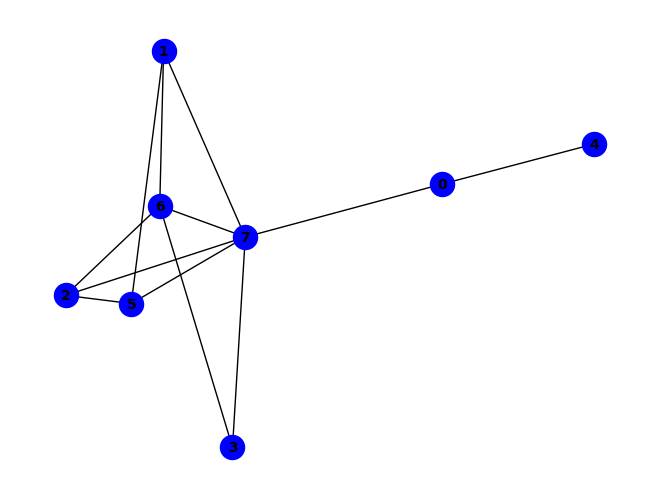


(~a & ~g) ^ (b & f & ~g) ^ (b & g & ~d) ^ (c & f & ~g) ^ (c & g & ~d) ^ (a & b & e & f) ^ (a & c & e & f) ^ (b & d & f & g) ^ (g & ~a & ~h) ^ (b & c & f & ~d) ^ (c & h & ~a & ~d) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (f & h & ~a & ~g) ^ (a & b & c & f & ~g) ^ (a & b & c & g & ~d) ^ (a & c & f & g & ~e) ^ (b & d & f & h & ~a) ^ (c & d & f & h & ~g) ^ (a & ~d & ~e & ~h) ^ (a & b & g & ~d & ~f) ^ (a & c & g & ~d & ~f) ^ (b & c & g & ~d & ~f) ^ (d & f & g & ~b & ~h) ^ (a & b & d & f & g & ~h) ^ (a & c & d & f & h & ~b) ^ (a & b & c & d & f & g & h) ^ (a & d & ~e & ~g & ~h) ^ (b & h & ~a & ~c & ~d) ^ (a & b & c & f & ~e & ~h) ^ (a & b & f & g & ~c & ~e) ^ (a & b & f & h & ~e & ~g) ^ (a & c & f & h & ~e & ~g) ^ (a & d & f & g & ~c & ~h) ^ (b & c & d & f & ~g & ~h) ^ (a & b & c & f & g & h & ~e) ^ (a & c & g & ~d & ~e & ~h) ^ (a & b & g & ~c & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

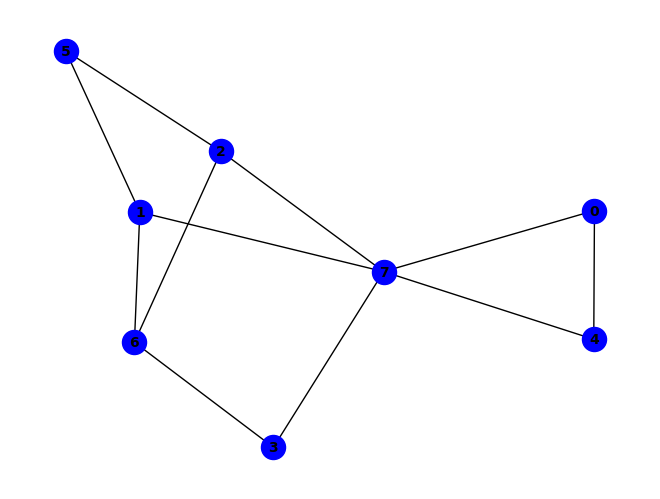


~e ^ (a & h) ^ (a & e & ~d) ^ (b & e & ~d) ^ (b & h & ~d) ^ (c & f & ~g) ^ (c & h & ~f) ^ (a & b & d & h) ^ (c & f & g & h) ^ (e & ~b & ~h) ^ (b & d & e & ~h) ^ (c & d & h & ~b) ^ (c & e & h & ~d) ^ (a & b & d & e & g) ^ (a & d & e & g & h) ^ (b & c & d & e & h) ^ (b & f & ~c & ~h) ^ (b & g & ~f & ~h) ^ (c & g & ~b & ~h) ^ (d & h & ~a & ~e) ^ (a & c & e & g & ~h) ^ (b & c & f & g & ~h) ^ (a & b & f & ~e & ~g) ^ (a & b & h & ~e & ~f) ^ (a & c & h & ~d & ~e) ^ (a & d & e & ~c & ~g) ^ (b & c & h & ~a & ~e) ^ (a & b & c & d & h & ~e) ^ (a & b & d & e & h & ~g) ^ (a & b & f & g & h & ~e) ^ (a & c & d & e & h & ~g) ^ (d & g & ~b & ~c & ~h) ^ (a & b & e & g & ~c & ~h) ^ (a & c & d & e & ~b & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & b & f & ~c & ~g & ~h) ^ (a & b & c & d & e & ~g & ~h) ^ (a & b & c & f & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

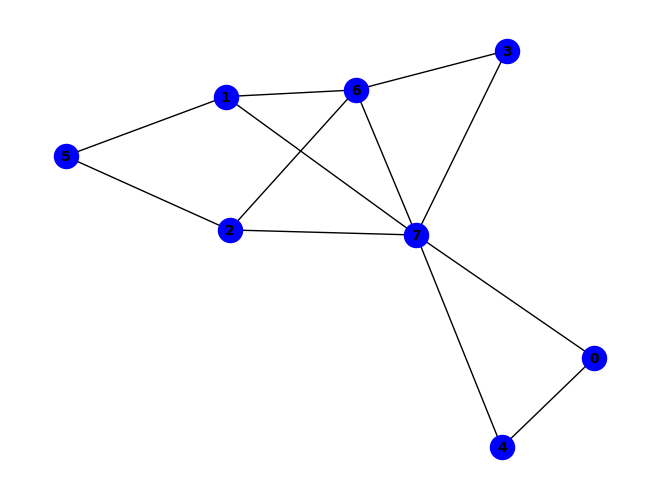


~g ^ (g & ~h) ^ (a & c & h) ^ (c & f & ~g) ^ (c & h & ~f) ^ (e & h & ~g) ^ (c & f & g & h) ^ (c & d & h & ~b) ^ (c & e & g & ~h) ^ (c & e & h & ~d) ^ (b & c & d & e & h) ^ (a & e & ~d & ~h) ^ (b & f & ~c & ~h) ^ (b & g & ~c & ~f) ^ (b & h & ~c & ~e) ^ (c & g & ~a & ~e) ^ (d & h & ~b & ~e) ^ (a & c & e & g & ~f) ^ (a & c & e & h & ~g) ^ (b & e & g & h & ~c) ^ (b & f & g & h & ~c) ^ (a & c & e & f & g & h) ^ (a & b & e & ~d & ~g) ^ (a & b & e & ~f & ~h) ^ (a & b & h & ~d & ~g) ^ (a & c & g & ~e & ~h) ^ (a & d & e & ~g & ~h) ^ (a & b & e & f & g & ~h) ^ (a & c & d & e & g & ~h) ^ (a & h & ~d & ~e & ~g) ^ (d & g & ~b & ~c & ~e) ^ (a & b & d & e & ~c & ~h) ^ (a & c & d & h & ~e & ~g) ^ (a & c & e & f & ~b & ~h) ^ (d & e & g & ~b & ~c & ~h) ^ (a & b & c & d & e & ~g & ~h) ^ (a & b & c & e & g & ~f & ~h) ^ (a & b & c & h & ~d & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

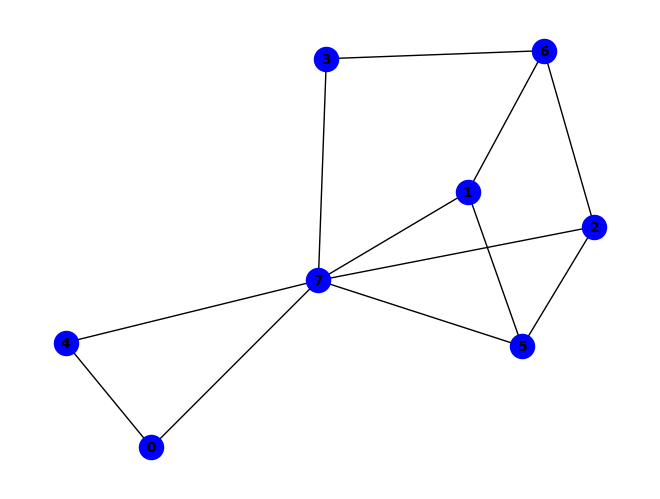


~f ^ (f & ~h) ^ (c & d & g) ^ (c & f & ~g) ^ (c & g & ~h) ^ (d & g & ~h) ^ (e & h & ~f) ^ (c & d & f & h) ^ (c & e & f & h) ^ (c & f & g & h) ^ (b & d & g & ~c) ^ (b & d & h & ~g) ^ (a & e & ~d & ~h) ^ (b & f & ~c & ~g) ^ (b & g & ~c & ~h) ^ (b & h & ~c & ~e) ^ (c & h & ~a & ~e) ^ (d & h & ~e & ~f) ^ (a & c & e & f & ~h) ^ (b & d & f & h & ~c) ^ (b & e & f & h & ~c) ^ (b & f & g & h & ~c) ^ (c & d & e & h & ~f) ^ (a & d & e & ~g & ~h) ^ (c & d & h & ~b & ~g) ^ (a & b & d & e & g & ~h) ^ (a & b & c & h & ~e & ~f) ^ (a & b & e & f & ~c & ~h) ^ (a & c & d & h & ~b & ~e) ^ (a & c & e & g & ~f & ~h) ^ (a & c & f & h & ~d & ~e) ^ (b & d & e & h & ~c & ~f) ^ (a & b & c & d & f & h & ~e) ^ (a & c & d & e & g & ~b & ~h) ^ (a & h & ~b & ~d & ~e & ~f) ^ (a & b & e & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


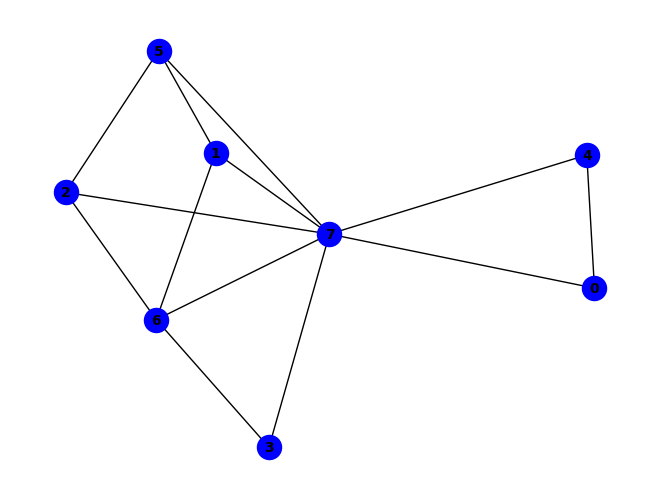


~g ^ (g & ~h) ^ (c & f & ~g) ^ (f & h & ~g) ^ (c & e & g & ~h) ^ (a & e & ~d & ~h) ^ (b & f & ~c & ~g) ^ (b & g & ~c & ~e) ^ (b & h & ~c & ~e) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (e & h & ~f & ~g) ^ (c & e & f & h & ~g) ^ (a & b & f & ~g & ~h) ^ (a & b & g & ~c & ~h) ^ (a & c & f & ~b & ~h) ^ (a & c & f & ~e & ~g) ^ (a & c & g & ~f & ~h) ^ (a & d & e & ~g & ~h) ^ (b & e & g & ~c & ~h) ^ (a & b & c & f & g & ~h) ^ (a & c & d & e & g & ~h) ^ (d & g & ~b & ~c & ~f) ^ (d & h & ~b & ~c & ~f) ^ (b & e & f & h & ~c & ~g) ^ (d & e & f & g & ~b & ~c) ^ (d & e & f & h & ~b & ~c) ^ (a & b & f & ~c & ~d & ~e) ^ (a & b & g & ~c & ~e & ~f) ^ (a & b & h & ~c & ~d & ~e) ^ (d & e & h & ~b & ~c & ~g) ^ (a & b & d & e & g & ~c & ~h) ^ (a & h & ~d & ~e & ~f & ~g) ^ (a & b & d & f & ~c & ~e & ~h) ^ (a & c & d & h & ~e & ~f & ~g) ^ (d & f & g & ~b & ~c & ~e & ~h) ^ (a & b & d & g & h & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

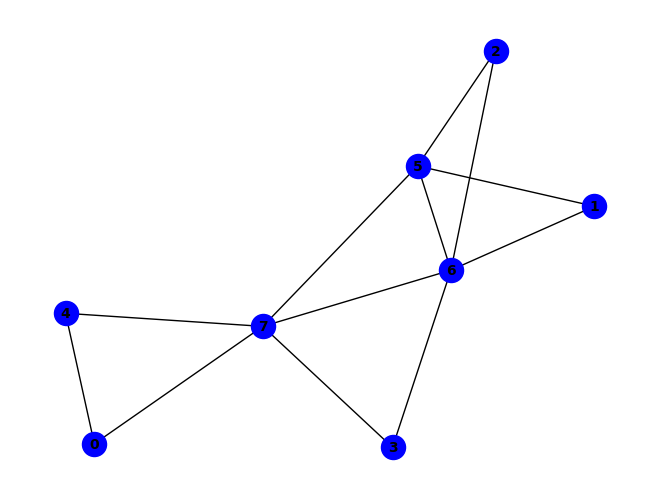


(~c & ~g) ^ (c & h & ~g) ^ (d & g & ~f) ^ (d & h & ~f) ^ (d & e & f & g) ^ (d & e & f & h) ^ (c & ~f & ~h) ^ (g & ~b & ~h) ^ (a & e & ~f & ~h) ^ (e & h & ~d & ~g) ^ (f & g & ~a & ~e) ^ (f & h & ~a & ~e) ^ (a & c & e & f & ~h) ^ (a & c & e & g & ~h) ^ (a & d & f & g & ~e) ^ (a & d & f & h & ~e) ^ (a & e & f & ~g & ~h) ^ (b & c & g & ~d & ~h) ^ (b & d & g & ~a & ~h) ^ (e & f & g & ~d & ~h) ^ (a & h & ~d & ~e & ~g) ^ (b & f & ~c & ~d & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & b & e & g & ~c & ~h) ^ (a & d & e & g & ~f & ~h) ^ (a & b & c & d & e & g & ~h) ^ (a & f & g & ~d & ~e & ~h) ^ (b & d & f & ~c & ~g & ~h) ^ (c & d & g & ~a & ~f & ~h) ^ (a & b & d & f & g & ~c & ~h) ^ (a & b & d & g & ~e & ~f & ~h) ^ (a & c & d & g & ~e & ~f & ~h) ^ (a & b & c & d & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


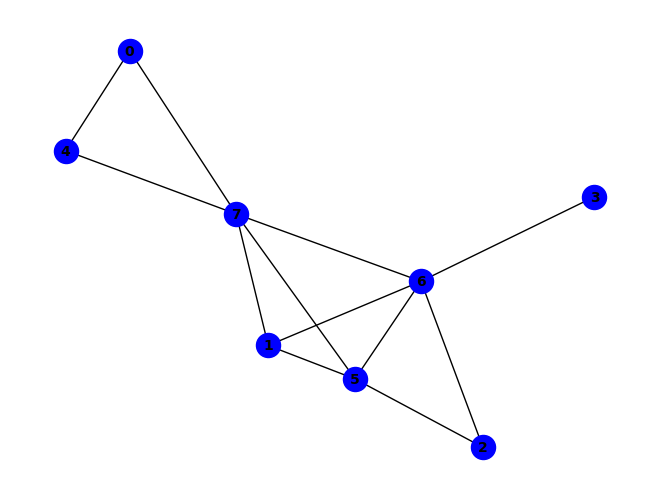


(~d & ~g) ^ (e & h & ~g) ^ (d & ~f & ~h) ^ (g & ~c & ~h) ^ (b & e & g & ~h) ^ (b & f & g & ~h) ^ (e & f & g & ~h) ^ (a & e & ~f & ~h) ^ (a & h & ~e & ~g) ^ (b & f & ~d & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (d & f & ~c & ~g) ^ (d & h & ~f & ~g) ^ (f & g & ~a & ~e) ^ (f & h & ~a & ~e) ^ (a & c & e & f & ~h) ^ (a & c & e & g & ~h) ^ (b & e & f & h & ~g) ^ (c & d & f & h & ~g) ^ (a & b & g & ~d & ~h) ^ (a & e & f & ~g & ~h) ^ (a & f & g & ~e & ~h) ^ (b & c & g & ~a & ~h) ^ (b & d & f & ~a & ~h) ^ (b & d & g & ~c & ~h) ^ (c & d & g & ~a & ~h) ^ (a & b & c & d & g & ~h) ^ (c & f & ~b & ~d & ~h) ^ (a & b & d & f & ~g & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & b & f & h & ~e & ~g) ^ (a & c & d & g & ~e & ~h) ^ (a & d & e & g & ~f & ~h) ^ (b & c & d & f & ~a & ~g) ^ (b & d & f & h & ~c & ~g) ^ (a & b & c & d & e & f & ~h) ^ (a & b & c & d & f & h & ~g) ^ (a & c & d & e & f & g & ~h) ^ (a & b & c & g & ~d & ~e & ~h) ^ (a & b & d & g & ~e & ~f & ~h) ^ (a & b & c & d & f & ~e & ~g & ~h)
P

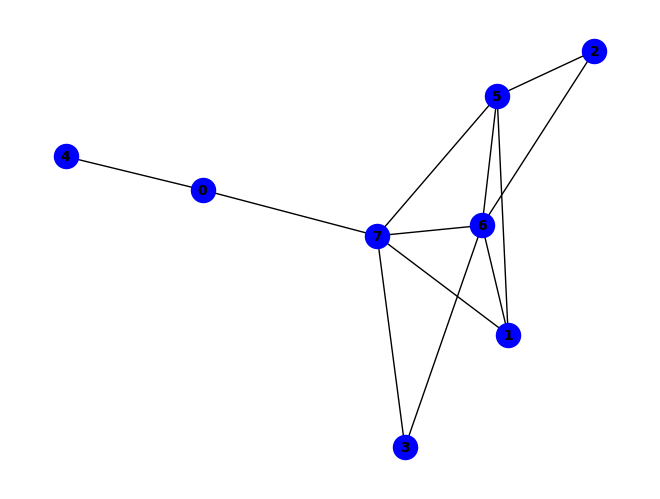


(b & g & ~d) ^ (b & h & ~d) ^ (f & g & ~a) ^ (f & h & ~a) ^ (a & b & e & g) ^ (a & b & e & h) ^ (b & d & f & g) ^ (b & d & f & h) ^ (g & ~a & ~h) ^ (~a & ~c & ~g) ^ (a & c & ~f & ~h) ^ (b & c & ~d & ~g) ^ (b & f & ~a & ~g) ^ (c & h & ~b & ~g) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (a & b & d & g & ~f) ^ (a & b & d & h & ~f) ^ (a & c & e & h & ~g) ^ (c & ~b & ~f & ~h) ^ (a & b & h & ~e & ~g) ^ (b & c & d & ~f & ~h) ^ (b & f & g & ~a & ~h) ^ (a & c & ~d & ~e & ~g) ^ (a & f & ~e & ~g & ~h) ^ (a & b & d & g & ~e & ~h) ^ (a & c & d & h & ~e & ~g) ^ (b & c & d & f & ~a & ~g) ^ (b & c & d & h & ~f & ~g) ^ (a & b & c & d & f & h & ~g) ^ (a & ~c & ~e & ~f & ~h) ^ (a & b & f & ~d & ~e & ~h) ^ (a & c & d & ~e & ~f & ~h) ^ (a & d & g & ~e & ~f & ~h) ^ (c & d & g & ~a & ~f & ~h) ^ (a & b & c & e & f & ~d & ~h) ^ (a & b & c & e & g & ~d & ~h) ^ (a & c & d & f & ~e & ~g & ~h) ^ (a & b & d & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

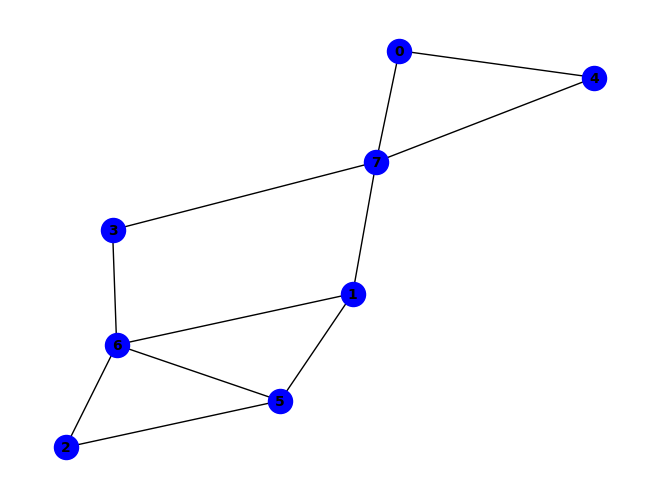


~f ^ (a & e & ~f) ^ (b & f & ~h) ^ (b & g & ~h) ^ (c & g & ~b) ^ (d & g & ~h) ^ (d & h & ~e) ^ (e & h & ~f) ^ (f & ~e & ~g) ^ (a & e & f & ~g) ^ (b & d & h & ~g) ^ (c & d & g & ~f) ^ (d & f & g & ~c) ^ (d & e & f & g & h) ^ (a & h & ~d & ~f) ^ (b & h & ~a & ~e) ^ (c & f & ~b & ~e) ^ (e & f & ~g & ~h) ^ (a & b & d & h & ~f) ^ (a & b & e & f & ~h) ^ (a & d & e & g & ~h) ^ (a & d & e & h & ~b) ^ (b & d & e & h & ~f) ^ (c & d & f & g & ~h) ^ (c & d & f & h & ~e) ^ (b & c & d & e & f & h) ^ (a & f & h & ~d & ~g) ^ (b & d & g & ~c & ~f) ^ (c & e & f & ~b & ~h) ^ (a & b & d & f & h & ~g) ^ (a & d & e & f & g & ~b) ^ (b & c & d & f & h & ~g) ^ (b & d & e & f & h & ~g) ^ (a & b & e & g & ~d & ~h) ^ (a & c & e & f & ~b & ~d) ^ (a & c & e & g & ~b & ~d) ^ (a & c & f & h & ~b & ~d) ^ (a & c & g & h & ~b & ~d) ^ (b & f & g & h & ~a & ~e) ^ (c & e & g & h & ~b & ~d) ^ (a & c & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

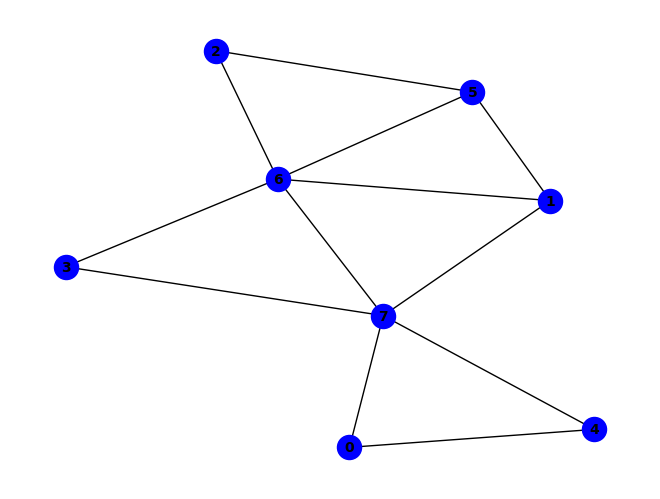


(g & ~h) ^ (f & h & ~g) ^ (a & ~f & ~h) ^ (~c & ~f & ~g) ^ (a & f & ~e & ~h) ^ (a & f & ~g & ~h) ^ (c & e & ~f & ~g) ^ (c & f & ~b & ~g) ^ (c & h & ~f & ~g) ^ (d & g & ~a & ~e) ^ (d & h & ~a & ~e) ^ (e & h & ~c & ~g) ^ (f & ~b & ~d & ~h) ^ (a & b & g & ~d & ~h) ^ (a & c & f & ~b & ~h) ^ (a & c & g & ~b & ~h) ^ (a & f & h & ~e & ~g) ^ (b & e & g & ~d & ~h) ^ (c & d & g & ~f & ~h) ^ (c & e & g & ~f & ~h) ^ (d & e & g & ~a & ~h) ^ (a & d & e & f & g & ~h) ^ (b & c & e & f & h & ~g) ^ (a & g & ~d & ~e & ~h) ^ (b & g & ~a & ~d & ~e) ^ (b & h & ~a & ~d & ~e) ^ (d & f & ~b & ~g & ~h) ^ (a & b & e & f & ~d & ~h) ^ (a & ~c & ~e & ~f & ~g) ^ (c & ~a & ~e & ~f & ~h) ^ (a & c & f & ~b & ~e & ~g) ^ (a & c & h & ~e & ~f & ~g) ^ (b & c & g & ~d & ~f & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h) ^ (a & c & d & e & g & ~b & ~f & ~h) ^ (c & d & f & h & ~a & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

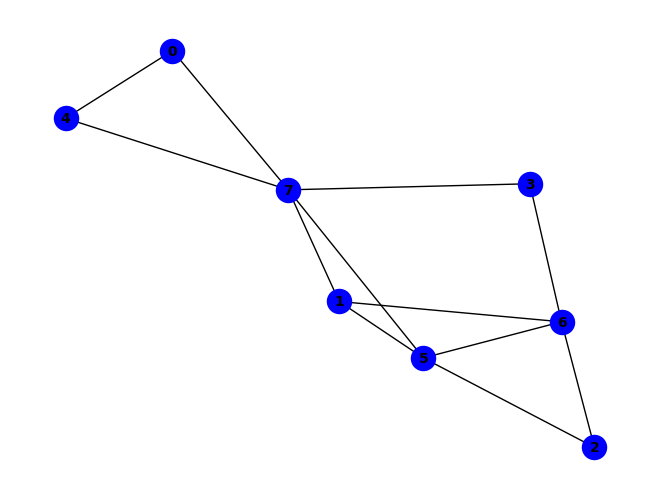


(~a & ~e) ^ (d & e & ~f) ^ (d & h & ~f) ^ (f & g & ~h) ^ (a & ~f & ~h) ^ (e & ~d & ~h) ^ (b & d & g & ~f) ^ (b & e & f & ~h) ^ (a & f & ~g & ~h) ^ (b & f & ~a & ~e) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~e) ^ (c & f & ~b & ~h) ^ (c & g & ~b & ~d) ^ (d & g & ~f & ~h) ^ (f & h & ~a & ~e) ^ (a & c & e & f & ~h) ^ (b & d & e & h & ~f) ^ (c & d & f & g & ~b) ^ (c & f & g & h & ~b) ^ (a & b & f & ~c & ~h) ^ (a & b & g & ~e & ~h) ^ (a & c & g & ~b & ~e) ^ (a & c & g & ~b & ~h) ^ (a & f & g & ~e & ~h) ^ (b & d & h & ~f & ~g) ^ (d & e & f & ~a & ~h) ^ (a & b & c & f & ~e & ~h) ^ (a & d & e & f & ~g & ~h) ^ (a & d & e & g & ~b & ~h) ^ (a & b & d & e & f & g & ~h) ^ (a & d & h & ~b & ~e & ~f) ^ (a & c & d & e & g & ~b & ~f) ^ (a & c & d & g & h & ~b & ~f) ^ (a & c & f & g & h & ~b & ~e) ^ (c & e & g & h & ~b & ~d & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


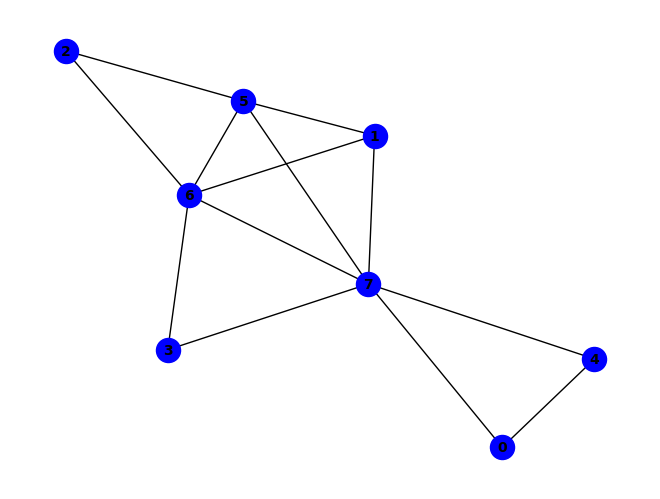


(g & ~h) ^ (~c & ~g) ^ (b & f & ~g) ^ (c & h & ~g) ^ (d & e & f & g) ^ (d & e & f & h) ^ (c & ~f & ~h) ^ (b & e & g & ~h) ^ (a & e & ~f & ~h) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (d & g & ~b & ~f) ^ (d & h & ~b & ~f) ^ (e & h & ~d & ~g) ^ (f & g & ~a & ~e) ^ (f & h & ~a & ~e) ^ (a & c & e & g & ~h) ^ (b & d & e & h & ~g) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (a & b & g & ~c & ~h) ^ (a & e & f & ~g & ~h) ^ (a & f & g & ~e & ~h) ^ (b & c & f & ~d & ~h) ^ (b & c & g & ~d & ~h) ^ (b & f & g & ~e & ~h) ^ (e & f & g & ~d & ~h) ^ (a & b & d & e & g & ~h) ^ (b & d & e & f & g & ~h) ^ (a & h & ~d & ~e & ~g) ^ (a & b & d & h & ~e & ~g) ^ (a & b & e & f & ~d & ~h) ^ (a & c & e & f & ~b & ~h) ^ (a & d & e & g & ~f & ~h) ^ (a & d & f & h & ~e & ~g) ^ (b & c & d & f & ~g & ~h) ^ (c & d & g & ~a & ~f & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (a & b & c & g & ~d & ~e & ~h) ^ (a & b & f & h & ~d & ~e & ~g) ^ (a & c & d & g & ~e & ~f & ~h) ^ (a & b & c & d &

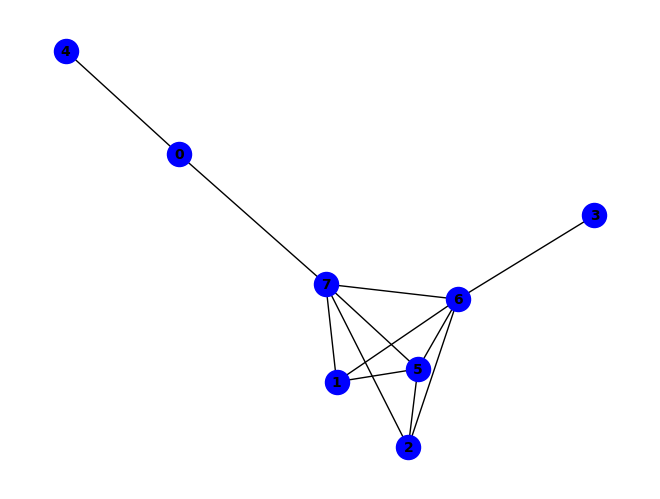


(b & g & ~d) ^ (b & h & ~d) ^ (f & g & ~a) ^ (f & h & ~a) ^ (a & b & e & g) ^ (a & b & e & h) ^ (g & ~a & ~h) ^ (~a & ~d & ~g) ^ (b & f & ~c & ~g) ^ (c & g & ~a & ~b) ^ (c & h & ~a & ~b) ^ (d & f & ~b & ~g) ^ (a & d & e & h & ~g) ^ (b & c & d & f & ~g) ^ (d & ~a & ~f & ~h) ^ (a & b & h & ~e & ~g) ^ (a & d & f & ~g & ~h) ^ (b & d & f & ~c & ~h) ^ (c & d & f & ~a & ~h) ^ (c & d & g & ~b & ~h) ^ (c & f & g & ~a & ~h) ^ (a & c & d & e & g & ~h) ^ (a & d & ~e & ~f & ~g) ^ (a & f & ~e & ~g & ~h) ^ (c & f & ~a & ~d & ~g) ^ (d & h & ~b & ~f & ~g) ^ (a & d & f & h & ~e & ~g) ^ (c & d & f & h & ~b & ~g) ^ (a & c & d & e & f & h & ~g) ^ (a & ~d & ~e & ~f & ~h) ^ (a & b & f & ~c & ~d & ~g) ^ (a & b & f & ~c & ~e & ~h) ^ (a & c & f & ~d & ~e & ~h) ^ (a & c & g & ~b & ~e & ~h) ^ (b & f & g & ~a & ~c & ~h) ^ (a & b & d & e & f & ~c & ~h) ^ (a & b & d & e & g & ~c & ~h) ^ (a & b & d & f & h & ~c & ~g) ^ (a & b & d & f & ~e & ~g & ~h) ^ (a & c & d & f & ~b & ~e & ~g) ^ (a & b & c & d & f & h & ~e & ~g

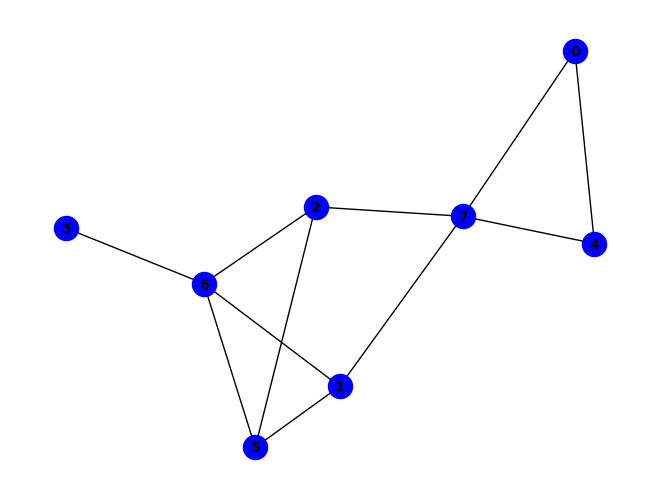


~f ^ (a & e & ~f) ^ (a & h & ~f) ^ (c & g & ~h) ^ (e & h & ~f) ^ (f & ~e & ~g) ^ (a & e & f & ~g) ^ (c & d & g & ~b) ^ (c & f & g & ~d) ^ (b & c & d & f & g) ^ (b & f & ~c & ~h) ^ (b & g & ~c & ~h) ^ (b & h & ~c & ~e) ^ (c & h & ~a & ~e) ^ (d & g & ~b & ~f) ^ (e & f & ~g & ~h) ^ (a & c & e & f & ~d) ^ (a & c & e & g & ~h) ^ (a & c & f & h & ~d) ^ (a & d & f & h & ~b) ^ (c & e & f & h & ~d) ^ (b & c & d & e & f & h) ^ (a & f & h & ~d & ~g) ^ (c & e & f & ~d & ~g) ^ (a & b & d & f & h & ~g) ^ (a & c & d & e & f & ~g) ^ (a & c & d & e & g & ~b) ^ (a & c & d & f & h & ~g) ^ (b & c & d & e & f & ~g) ^ (c & d & e & g & h & ~b) ^ (a & b & c & d & e & f & g) ^ (a & b & c & d & f & g & h) ^ (a & b & e & f & ~c & ~h) ^ (a & b & e & g & ~c & ~h) ^ (a & b & f & h & ~e & ~g) ^ (a & d & e & g & ~b & ~f) ^ (a & d & g & h & ~b & ~c) ^ (b & f & g & h & ~c & ~e) ^ (d & e & g & h & ~b & ~f) ^ (a & b & h & ~c & ~e & ~f) ^ (a & c & f & ~b & ~e & ~g) ^ (c & f & ~a & ~e & ~g & ~h) ^ (a & b & c & f & ~e & ~g

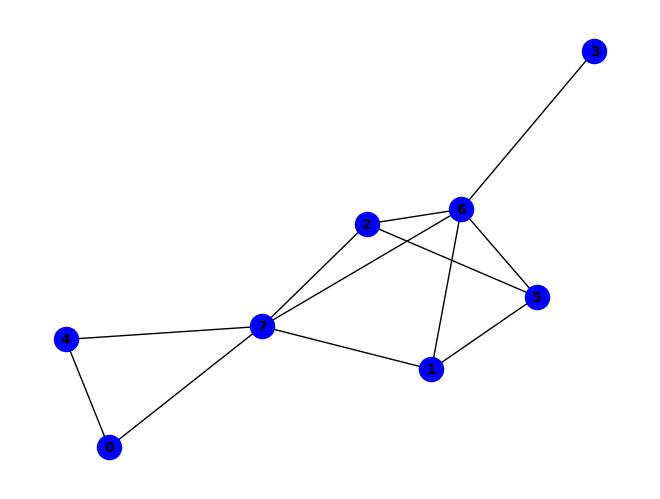


(c & e & h) ^ (~f & ~g) ^ (c & f & ~d) ^ (c & h & ~f) ^ (e & h & ~g) ^ (f & h & ~g) ^ (c & d & f & h) ^ (a & ~f & ~h) ^ (g & ~d & ~h) ^ (c & e & g & ~h) ^ (a & f & ~g & ~h) ^ (b & g & ~a & ~e) ^ (b & h & ~c & ~e) ^ (a & ~e & ~f & ~g) ^ (f & ~b & ~d & ~h) ^ (a & b & f & ~d & ~e) ^ (a & b & f & ~d & ~h) ^ (a & b & g & ~d & ~h) ^ (a & b & h & ~e & ~f) ^ (a & c & g & ~b & ~h) ^ (a & c & h & ~b & ~e) ^ (a & d & g & ~f & ~h) ^ (a & f & h & ~e & ~g) ^ (b & c & f & ~d & ~h) ^ (b & d & g & ~c & ~h) ^ (b & e & g & ~c & ~h) ^ (c & d & g & ~a & ~h) ^ (a & f & ~d & ~e & ~h) ^ (a & g & ~d & ~e & ~h) ^ (c & g & ~a & ~b & ~e) ^ (a & b & d & f & ~g & ~h) ^ (a & c & d & g & ~e & ~h) ^ (a & c & e & f & ~b & ~h) ^ (a & b & d & f & g & h & ~e) ^ (a & c & d & e & f & g & ~h) ^ (a & d & f & ~e & ~g & ~h) ^ (a & b & c & d & f & ~e & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (d & f & ~b & ~c & ~g & ~h) ^ (a & b & d & f & ~c & ~e & ~g) ^ (a & b & d & g & ~c & ~e & ~h) ^ (a & b & c & d & f & h & ~e & ~g)
PASS
PASS


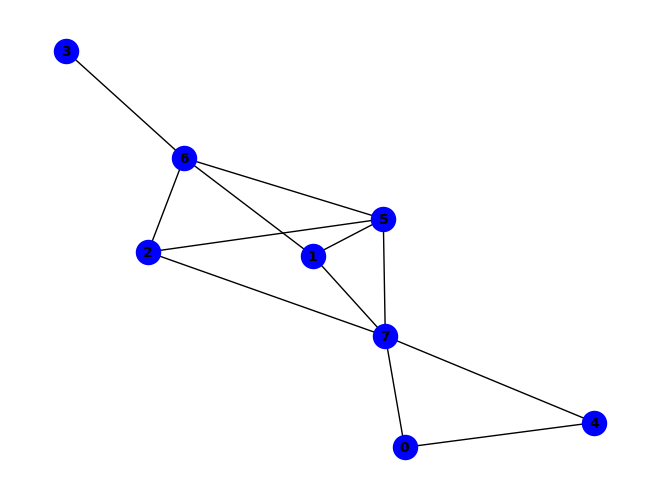


(~a & ~e) ^ (f & g & ~h) ^ (a & ~f & ~h) ^ (e & ~d & ~h) ^ (a & c & f & ~h) ^ (b & c & g & ~d) ^ (b & c & h & ~g) ^ (b & d & g & ~f) ^ (c & e & f & ~h) ^ (d & e & g & ~a) ^ (b & c & d & f & g) ^ (d & e & f & g & h) ^ (a & f & ~g & ~h) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~e) ^ (c & f & ~a & ~e) ^ (c & g & ~a & ~h) ^ (c & h & ~a & ~e) ^ (d & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (f & h & ~a & ~e) ^ (a & b & c & h & ~e) ^ (b & c & e & h & ~d) ^ (a & b & f & ~c & ~h) ^ (a & b & g & ~e & ~h) ^ (a & c & g & ~e & ~h) ^ (a & f & g & ~e & ~h) ^ (b & e & f & ~c & ~h) ^ (a & b & c & e & g & ~h) ^ (a & b & d & e & g & ~f) ^ (a & c & d & e & g & ~b) ^ (a & d & e & f & g & ~c) ^ (b & c & d & e & h & ~g) ^ (b & d & e & g & h & ~f) ^ (c & d & e & g & h & ~f) ^ (a & b & c & d & e & f & g) ^ (b & c & d & e & f & g & h) ^ (b & f & ~a & ~c & ~e) ^ (a & d & g & h & ~b & ~c & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

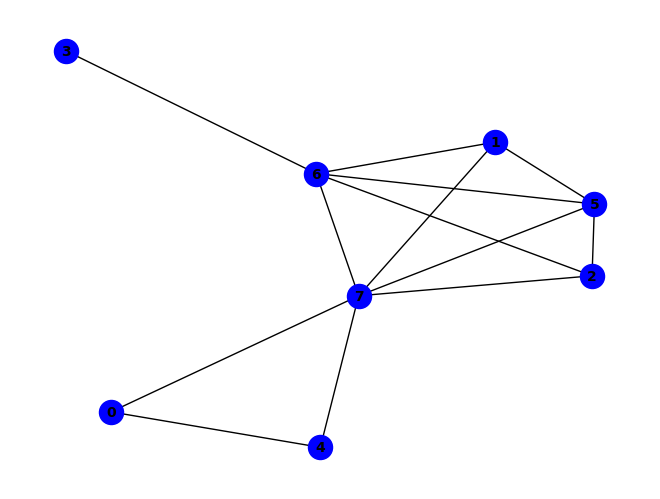


(g & ~h) ^ (~d & ~g) ^ (e & h & ~g) ^ (d & ~f & ~h) ^ (b & d & g & ~h) ^ (e & f & g & ~h) ^ (a & e & ~f & ~h) ^ (b & f & ~d & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & f & ~b & ~g) ^ (c & g & ~b & ~e) ^ (c & h & ~b & ~e) ^ (d & f & ~c & ~g) ^ (d & h & ~f & ~g) ^ (f & g & ~a & ~e) ^ (f & h & ~a & ~e) ^ (a & b & c & e & ~g) ^ (a & b & c & e & ~h) ^ (a & b & c & h & ~g) ^ (a & b & e & f & ~h) ^ (a & c & e & f & ~b) ^ (b & c & d & f & ~g) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & e & f & h & ~g) ^ (a & b & g & ~d & ~h) ^ (a & e & f & ~g & ~h) ^ (b & d & f & ~a & ~h) ^ (b & e & g & ~c & ~h) ^ (b & f & g & ~e & ~h) ^ (c & d & f & ~b & ~h) ^ (c & d & g & ~b & ~h) ^ (c & e & g & ~a & ~h) ^ (c & f & g & ~b & ~h) ^ (a & b & c & d & g & ~h) ^ (a & c & d & e & g & ~h) ^ (a & c & d & f & g & ~b) ^ (b & c & e & f & g & ~h) ^ (a & h & ~c & ~e & ~g) ^ (a & b & d & f & ~g & ~h) ^ (a & c & f & g & ~b & ~e) ^ (a & c & f & h & ~b & ~d) ^ (a & d & e & g & ~f & ~h) ^ (b & d & f & h & ~c

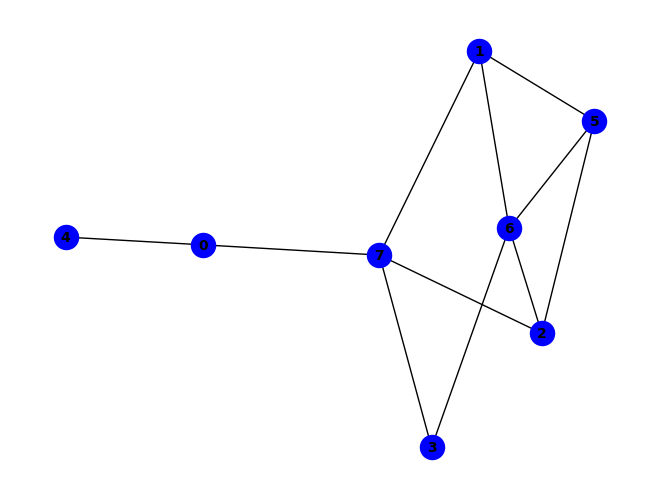


(f & ~g) ^ (~a & ~f) ^ (c & g & ~h) ^ (b & d & g & ~h) ^ (b & g & ~a & ~f) ^ (c & h & ~a & ~d) ^ (d & h & ~a & ~b) ^ (a & ~e & ~f & ~h) ^ (a & b & f & ~e & ~h) ^ (a & e & f & ~d & ~g) ^ (a & f & h & ~e & ~g) ^ (b & c & g & ~a & ~d) ^ (c & f & g & ~a & ~b) ^ (b & h & ~a & ~c & ~g) ^ (c & f & ~a & ~g & ~h) ^ (d & g & ~a & ~c & ~h) ^ (a & c & e & g & ~d & ~h) ^ (a & d & e & f & ~c & ~h) ^ (a & d & e & g & ~b & ~h) ^ (b & c & d & h & ~a & ~g) ^ (a & b & c & d & e & f & ~h) ^ (a & b & c & d & e & g & ~h) ^ (a & b & g & ~c & ~e & ~h) ^ (a & c & f & ~b & ~e & ~h) ^ (a & d & g & ~c & ~f & ~h) ^ (d & f & g & ~a & ~b & ~c) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & d & f & g & ~e & ~h) ^ (a & c & d & e & f & ~b & ~g) ^ (a & d & e & f & h & ~c & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (b & f & ~a & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


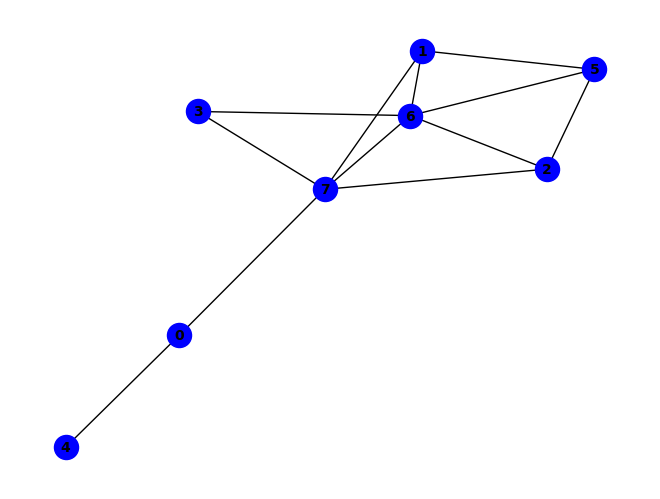


(b & h & ~d) ^ (d & g & ~a) ^ (d & h & ~c) ^ (a & c & e & f) ^ (a & d & e & h) ^ (c & d & f & h) ^ (g & ~a & ~h) ^ (a & d & g & ~e) ^ (a & b & c & d & h) ^ (a & c & d & f & g) ^ (~a & ~f & ~g) ^ (a & f & ~d & ~h) ^ (b & g & ~a & ~d) ^ (c & f & ~b & ~d) ^ (c & h & ~b & ~f) ^ (f & h & ~a & ~g) ^ (a & b & c & h & ~f) ^ (a & b & e & f & ~c) ^ (b & c & d & h & ~f) ^ (a & b & d & e & f & g) ^ (a & ~e & ~f & ~h) ^ (f & ~b & ~d & ~h) ^ (a & b & h & ~d & ~f) ^ (a & c & h & ~d & ~f) ^ (a & d & f & ~g & ~h) ^ (a & d & h & ~e & ~g) ^ (a & c & d & f & h & ~g) ^ (a & f & ~e & ~g & ~h) ^ (c & g & ~a & ~b & ~d) ^ (a & b & f & h & ~d & ~e) ^ (a & c & f & h & ~b & ~e) ^ (a & b & d & e & f & h & ~g) ^ (a & c & g & ~d & ~e & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (d & f & ~b & ~c & ~g & ~h) ^ (a & d & f & g & ~c & ~e & ~h) ^ (a & b & g & ~c & ~d & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

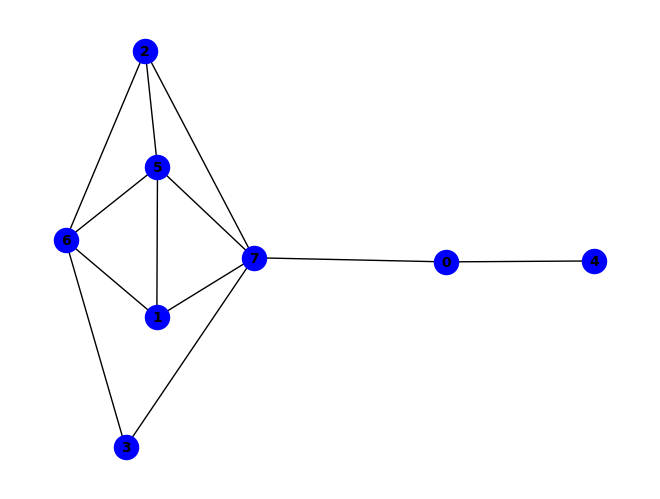


~d ^ (a & e) ^ (b & f & ~d) ^ (b & h & ~d) ^ (a & c & e & f) ^ (d & ~g & ~h) ^ (a & b & g & ~d) ^ (a & b & h & ~g) ^ (a & c & g & ~e) ^ (a & d & h & ~b) ^ (a & b & d & g & h) ^ (a & h & ~c & ~e) ^ (b & g & ~d & ~h) ^ (c & f & ~b & ~d) ^ (f & g & ~d & ~h) ^ (f & h & ~a & ~d) ^ (a & b & e & f & ~c) ^ (a & c & f & h & ~e) ^ (a & e & f & g & ~h) ^ (a & c & g & ~d & ~h) ^ (c & d & f & ~g & ~h) ^ (a & b & d & f & h & ~c) ^ (a & c & d & f & g & ~b) ^ (a & b & c & d & f & g & h) ^ (c & g & ~b & ~d & ~h) ^ (c & h & ~a & ~b & ~d) ^ (a & b & f & h & ~c & ~e) ^ (a & d & e & g & ~f & ~h) ^ (a & b & d & e & f & g & ~h) ^ (a & c & d & e & f & h & ~g) ^ (a & b & g & ~d & ~e & ~h) ^ (a & c & d & ~e & ~f & ~g) ^ (a & c & d & ~e & ~f & ~h) ^ (a & c & h & ~d & ~e & ~g) ^ (b & d & f & ~c & ~g & ~h) ^ (a & b & c & e & g & ~d & ~h) ^ (a & b & c & d & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

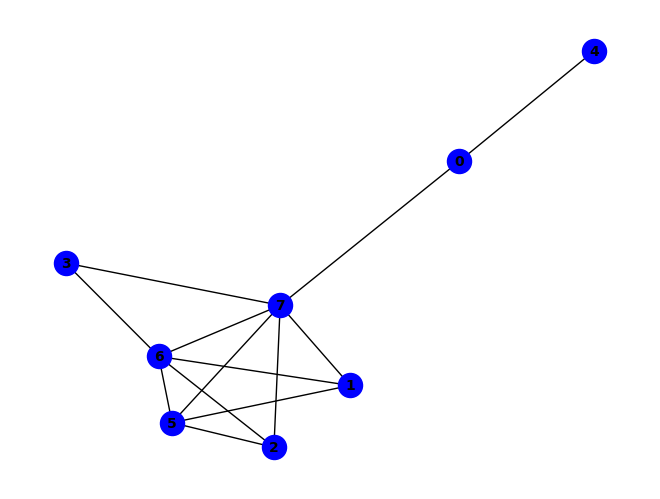


(~a & ~g) ^ (b & f & ~g) ^ (b & g & ~d) ^ (c & f & ~g) ^ (c & g & ~d) ^ (f & g & ~a) ^ (f & h & ~a) ^ (a & b & e & f) ^ (a & b & e & h) ^ (a & c & e & f) ^ (b & d & f & g) ^ (b & d & f & h) ^ (c & d & f & g) ^ (g & ~a & ~h) ^ (a & b & g & ~e) ^ (b & c & f & ~d) ^ (b & h & ~c & ~d) ^ (c & h & ~a & ~d) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (a & b & c & f & ~g) ^ (a & b & c & g & ~d) ^ (a & b & c & h & ~d) ^ (a & b & d & h & ~f) ^ (a & c & f & h & ~e) ^ (b & c & d & f & ~h) ^ (c & d & f & h & ~a) ^ (a & b & c & d & f & g) ^ (a & ~e & ~f & ~h) ^ (a & b & g & ~d & ~f) ^ (a & c & g & ~d & ~f) ^ (b & c & g & ~d & ~f) ^ (c & f & g & ~a & ~h) ^ (a & b & c & d & e & f & h) ^ (a & f & ~e & ~g & ~h) ^ (a & b & c & f & ~d & ~e) ^ (a & b & f & h & ~c & ~e) ^ (a & b & d & ~e & ~f & ~g) ^ (a & b & d & ~e & ~f & ~h) ^ (a & b & h & ~d & ~e & ~g) ^ (a & d & g & ~e & ~f & ~h) ^ (b & f & g & ~a & ~c & ~h) ^ (a & b & d & f & h & ~e & ~g) ^ (a & c & d & f & g & ~e & ~h) ^ (a & c & g & ~b & ~d & ~e & ~h)

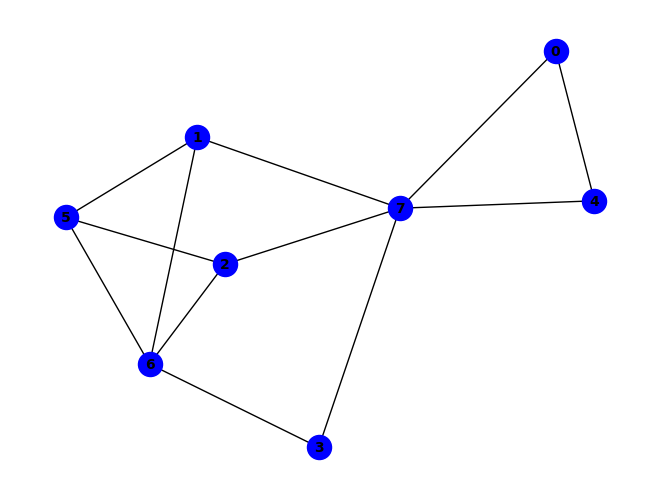


~f ^ (a & e & ~f) ^ (b & d & f & g) ^ (a & e & f & ~g) ^ (b & d & g & ~h) ^ (b & d & h & ~e) ^ (d & f & g & ~c) ^ (a & c & d & e & h) ^ (b & d & e & f & h) ^ (a & h & ~d & ~f) ^ (b & g & ~c & ~f) ^ (b & h & ~c & ~g) ^ (c & g & ~f & ~h) ^ (d & g & ~c & ~h) ^ (d & h & ~c & ~e) ^ (e & h & ~b & ~f) ^ (a & b & d & h & ~f) ^ (a & c & e & f & ~h) ^ (a & d & e & g & ~f) ^ (a & d & e & h & ~g) ^ (b & c & d & g & ~f) ^ (b & c & d & h & ~g) ^ (a & b & d & e & f & g) ^ (f & ~c & ~e & ~g) ^ (a & f & h & ~d & ~g) ^ (a & b & d & e & h & ~c) ^ (a & b & d & f & h & ~g) ^ (d & e & f & g & h & ~c) ^ (b & f & ~c & ~g & ~h) ^ (c & h & ~a & ~e & ~f) ^ (e & f & ~c & ~g & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & c & d & h & ~b & ~f) ^ (a & c & e & g & ~d & ~h) ^ (a & c & f & h & ~e & ~g) ^ (b & c & e & h & ~d & ~f) ^ (a & c & d & e & f & g & ~b) ^ (a & b & h & ~c & ~e & ~f) ^ (a & c & d & f & h & ~b & ~g) ^ (a & b & e & g & ~c & ~d & ~h) ^ (a & b & f & h & ~c & ~e & ~g) ^ (b & e & f & h & ~c & ~d & ~g)
PASS
PA

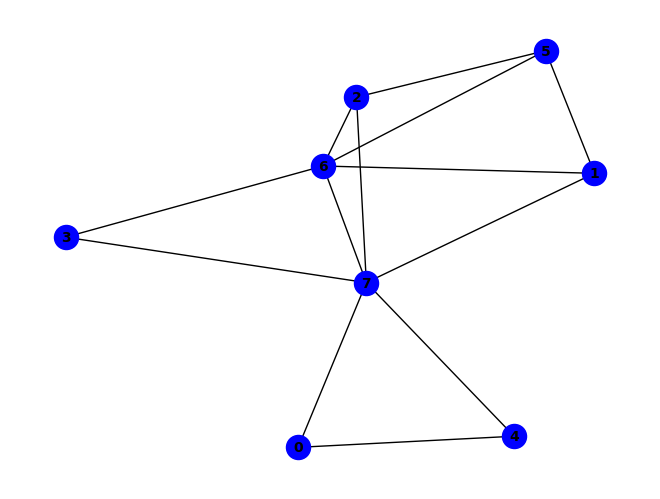


(g & ~h) ^ (~f & ~g) ^ (c & f & ~d) ^ (e & h & ~g) ^ (f & h & ~g) ^ (a & ~f & ~h) ^ (b & c & f & ~h) ^ (c & e & h & ~d) ^ (a & f & ~e & ~h) ^ (a & f & ~g & ~h) ^ (b & h & ~c & ~e) ^ (c & h & ~d & ~f) ^ (d & g & ~a & ~e) ^ (a & b & c & g & ~h) ^ (b & c & d & g & ~f) ^ (b & c & d & h & ~f) ^ (b & c & e & g & ~h) ^ (a & ~e & ~f & ~g) ^ (f & ~b & ~d & ~h) ^ (a & b & f & ~c & ~e) ^ (a & b & f & ~c & ~h) ^ (a & b & g & ~d & ~h) ^ (a & c & g & ~d & ~h) ^ (a & c & h & ~d & ~e) ^ (a & f & h & ~e & ~g) ^ (b & c & g & ~a & ~e) ^ (b & d & f & ~g & ~h) ^ (b & e & g & ~d & ~h) ^ (c & e & g & ~d & ~h) ^ (d & e & g & ~a & ~h) ^ (b & c & d & e & h & ~g) ^ (b & c & d & f & h & ~g) ^ (a & g & ~d & ~e & ~h) ^ (b & g & ~a & ~d & ~e) ^ (c & g & ~a & ~d & ~e) ^ (d & f & ~c & ~g & ~h) ^ (d & h & ~a & ~b & ~e) ^ (a & c & e & f & ~d & ~h) ^ (a & b & h & ~c & ~e & ~f) ^ (a & b & c & d & h & ~e & ~g) ^ (a & c & d & e & f & ~g & ~h) ^ (a & d & e & f & g & ~b & ~h) ^ (a & b & c & d & e & g & ~f & ~h)
PASS
PASS
PAS

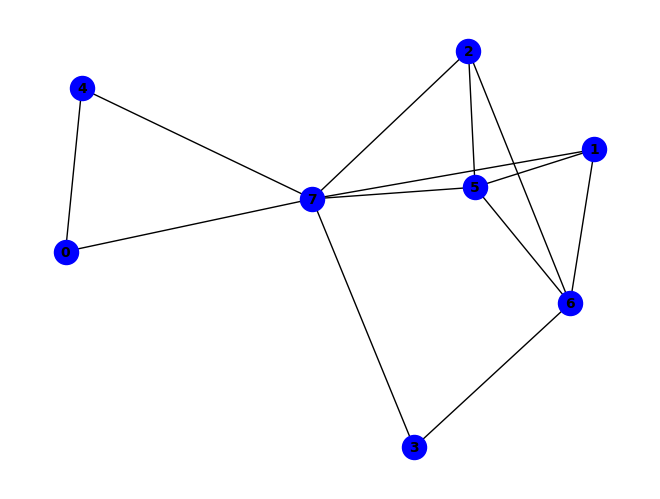


(~a & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (a & ~f & ~h) ^ (e & ~d & ~h) ^ (b & c & g & ~d) ^ (c & e & f & ~h) ^ (b & c & d & f & g) ^ (a & f & ~g & ~h) ^ (b & f & ~c & ~e) ^ (b & g & ~d & ~h) ^ (b & h & ~a & ~e) ^ (c & f & ~a & ~e) ^ (c & g & ~d & ~h) ^ (c & h & ~a & ~e) ^ (d & g & ~f & ~h) ^ (d & h & ~c & ~f) ^ (f & h & ~a & ~e) ^ (a & b & c & g & ~e) ^ (a & b & c & g & ~h) ^ (a & c & e & g & ~h) ^ (b & c & e & h & ~d) ^ (b & d & f & g & ~h) ^ (c & d & e & h & ~f) ^ (c & d & f & g & ~h) ^ (b & c & d & e & f & h) ^ (a & b & f & ~d & ~h) ^ (a & c & f & ~b & ~h) ^ (a & f & g & ~e & ~h) ^ (b & c & h & ~d & ~g) ^ (b & d & h & ~e & ~f) ^ (b & e & f & ~c & ~h) ^ (d & e & f & ~a & ~h) ^ (a & b & c & d & f & ~h) ^ (a & c & d & e & f & ~h) ^ (b & c & d & f & h & ~g) ^ (a & b & c & h & ~e & ~g) ^ (a & b & d & h & ~c & ~e) ^ (a & b & e & g & ~d & ~h) ^ (a & d & e & g & ~c & ~h) ^ (a & b & c & d & e & g & ~h) ^ (a & b & f & ~c & ~d & ~e) ^ (a & d & h & ~c & ~e & ~f) ^ (a & d & e & f & ~b & ~c & ~

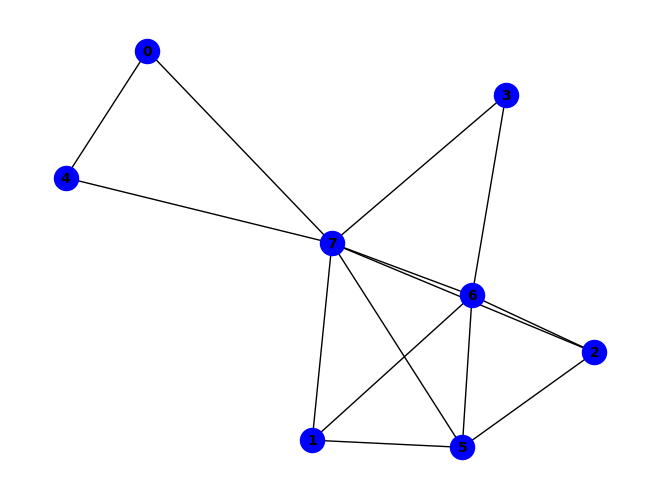


~g ^ (g & ~h) ^ (b & f & ~g) ^ (a & b & g & ~h) ^ (b & e & g & ~h) ^ (a & e & ~f & ~h) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & f & ~b & ~g) ^ (c & g & ~b & ~e) ^ (c & h & ~b & ~e) ^ (e & h & ~d & ~g) ^ (f & g & ~a & ~e) ^ (f & h & ~a & ~e) ^ (a & c & e & f & ~d) ^ (a & c & f & h & ~d) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (c & d & e & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & c & d & e & f & g) ^ (b & c & d & e & f & h) ^ (a & e & f & ~g & ~h) ^ (b & f & g & ~e & ~h) ^ (c & e & g & ~b & ~h) ^ (c & f & g & ~b & ~h) ^ (e & f & g & ~d & ~h) ^ (a & b & d & e & g & ~h) ^ (b & d & e & f & g & ~h) ^ (d & g & ~b & ~c & ~f) ^ (d & h & ~b & ~c & ~f) ^ (a & b & f & h & ~e & ~g) ^ (a & c & f & g & ~d & ~e) ^ (a & d & e & g & ~f & ~h) ^ (b & d & e & h & ~c & ~g) ^ (c & e & f & h & ~b & ~g) ^ (a & b & c & d & f & g & ~e) ^ (a & b & c & d & f & h & ~e) ^ (a & f & g & ~c & ~e & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (c & d & e & f & g & ~b & ~h) ^ (a & h & ~c & ~d &

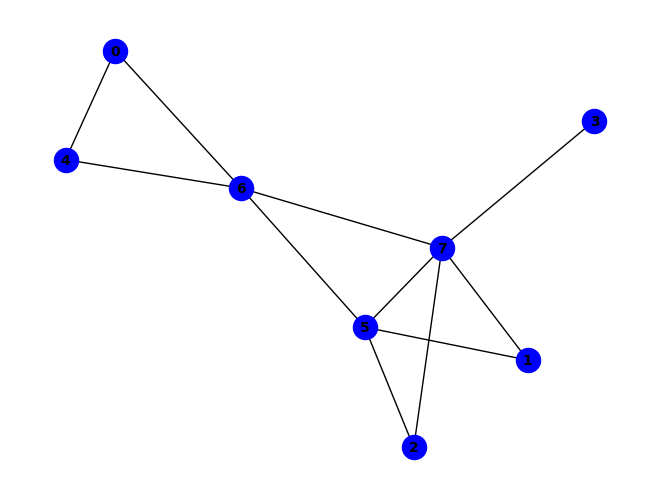


(a & e & ~g) ^ (b & g & ~d) ^ (b & h & ~d) ^ (e & h & ~g) ^ (f & g & ~d) ^ (f & h & ~d) ^ (e & ~f & ~h) ^ (g & ~b & ~h) ^ (~a & ~e & ~g) ^ (b & f & ~a & ~g) ^ (c & f & ~b & ~g) ^ (c & h & ~b & ~g) ^ (d & h & ~c & ~g) ^ (e & f & ~g & ~h) ^ (a & e & f & h & ~g) ^ (b & d & f & g & ~a) ^ (b & d & f & h & ~c) ^ (c & d & f & g & ~b) ^ (c & d & f & h & ~a) ^ (a & b & d & e & f & h) ^ (a & ~e & ~f & ~h) ^ (a & b & f & ~e & ~g) ^ (a & d & h & ~f & ~g) ^ (b & d & g & ~f & ~h) ^ (d & f & g & ~c & ~h) ^ (a & b & c & e & h & ~g) ^ (a & b & d & f & g & ~h) ^ (b & c & d & f & g & ~h) ^ (a & c & d & e & f & g & h) ^ (a & f & ~e & ~g & ~h) ^ (a & h & ~d & ~e & ~g) ^ (a & b & e & h & ~d & ~g) ^ (a & c & e & f & ~b & ~g) ^ (a & c & e & h & ~d & ~g) ^ (a & d & f & h & ~e & ~g) ^ (b & c & d & h & ~a & ~g) ^ (a & b & c & d & f & h & ~g) ^ (a & b & c & d & h & ~e & ~g) ^ (a & c & d & f & h & ~b & ~e) ^ (a & b & d & f & g & h & ~c & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

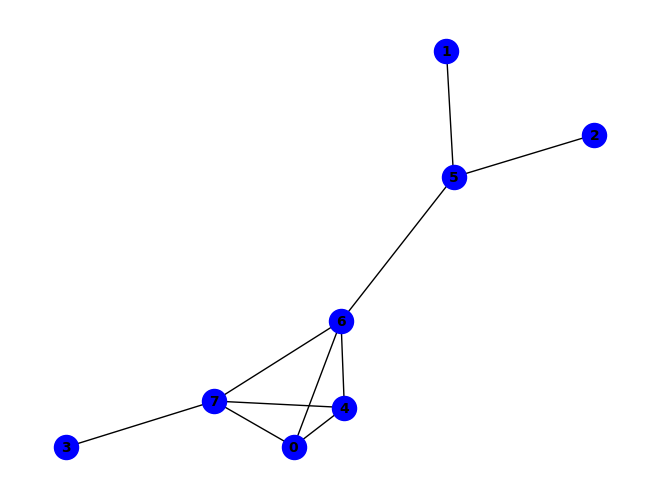


(g & ~h) ^ (~f & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (b & f & ~g) ^ (e & g & ~d) ^ (e & h & ~d) ^ (f & h & ~g) ^ (f & ~e & ~h) ^ (a & e & f & ~h) ^ (a & e & g & ~h) ^ (a & f & g & ~h) ^ (d & e & g & ~h) ^ (a & e & ~f & ~g) ^ (c & f & ~b & ~g) ^ (d & h & ~c & ~g) ^ (e & f & ~g & ~h) ^ (a & c & e & f & ~g) ^ (a & d & e & g & ~c) ^ (a & d & e & h & ~c) ^ (a & e & f & h & ~g) ^ (a & d & g & ~e & ~h) ^ (a & c & d & e & g & ~h) ^ (a & b & e & f & ~c & ~g) ^ (a & b & f & h & ~d & ~g) ^ (a & c & d & h & ~b & ~g) ^ (a & c & f & h & ~b & ~g) ^ (b & d & f & h & ~c & ~g) ^ (c & e & f & h & ~d & ~g) ^ (c & d & h & ~a & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (a & c & d & e & h & ~f & ~g) ^ (b & e & f & h & ~c & ~d & ~g) ^ (a & b & d & e & f & h & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


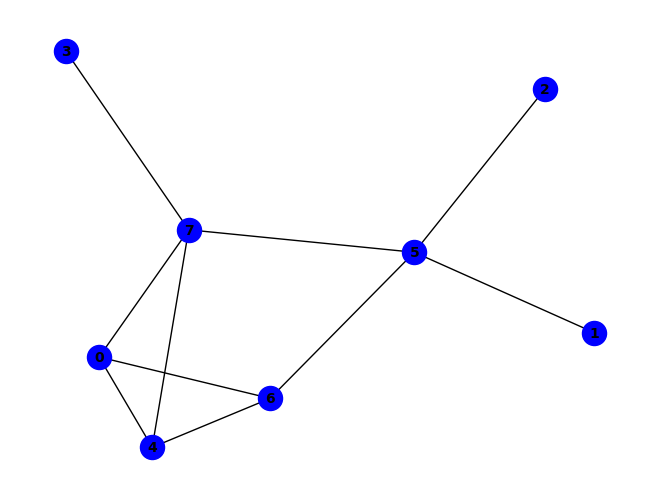


~e ^ (a & e & ~d) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & d & e & ~h) ^ (a & g & ~f & ~h) ^ (a & h & ~d & ~f) ^ (d & h & ~e & ~f) ^ (f & g & ~e & ~h) ^ (a & e & f & g & ~h) ^ (a & e & f & h & ~d) ^ (b & f & ~a & ~g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


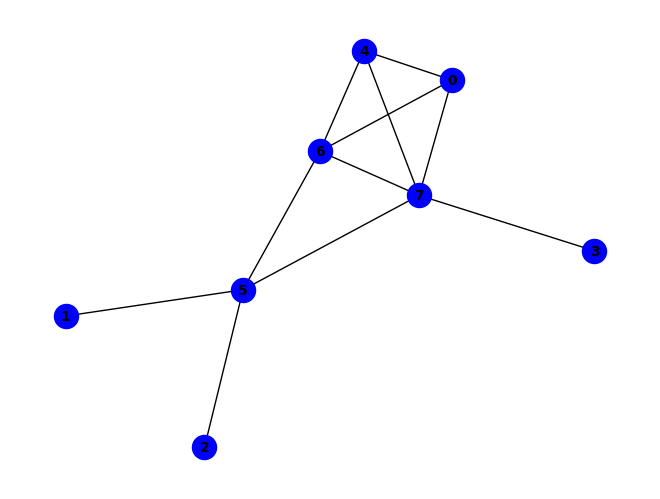


~g ^ (g & ~h) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~d) ^ (f & h & ~d) ^ (a & e & ~g & ~h) ^ (d & h & ~e & ~g) ^ (a & d & e & h & ~g) ^ (d & e & f & g & ~a) ^ (d & e & f & h & ~a) ^ (a & d & h & ~f & ~g) ^ (d & f & g & ~e & ~h) ^ (a & d & e & f & g & ~h) ^ (a & c & ~b & ~e & ~f) ^ (a & g & ~c & ~e & ~f) ^ (a & h & ~c & ~e & ~f) ^ (b & f & ~a & ~g & ~h) ^ (a & b & c & h & ~e & ~f) ^ (a & c & g & h & ~e & ~f) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & ~b & ~e & ~g & ~h) ^ (c & f & ~a & ~b & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


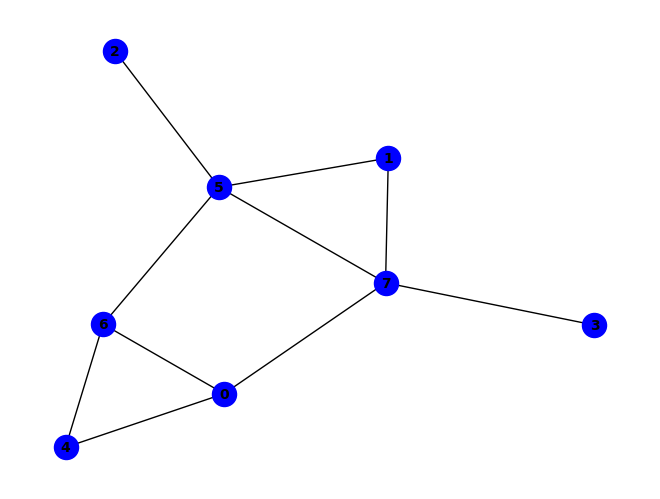


~e ^ (a & e & ~h) ^ (f & g & ~h) ^ (f & h & ~a) ^ (a & f & g & h) ^ (e & ~d & ~g) ^ (a & b & f & ~g) ^ (e & f & g & ~a) ^ (a & g & ~c & ~f) ^ (a & h & ~b & ~g) ^ (b & h & ~d & ~f) ^ (c & f & ~g & ~h) ^ (d & e & ~g & ~h) ^ (d & h & ~e & ~f) ^ (a & e & g & h & ~d) ^ (b & e & g & h & ~f) ^ (a & d & e & f & g & h) ^ (a & c & e & ~f & ~h) ^ (a & c & e & ~g & ~h) ^ (a & d & h & ~b & ~f) ^ (a & c & e & g & h & ~f) ^ (b & d & e & f & h & ~a) ^ (b & d & e & g & h & ~a) ^ (b & f & ~c & ~g & ~h) ^ (a & b & c & f & ~g & ~h) ^ (d & e & f & h & ~b & ~g) ^ (a & b & d & e & f & h & ~g) ^ (a & b & c & ~e & ~f & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & g & ~b & ~e & ~f) ^ (a & b & g & h & ~c & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


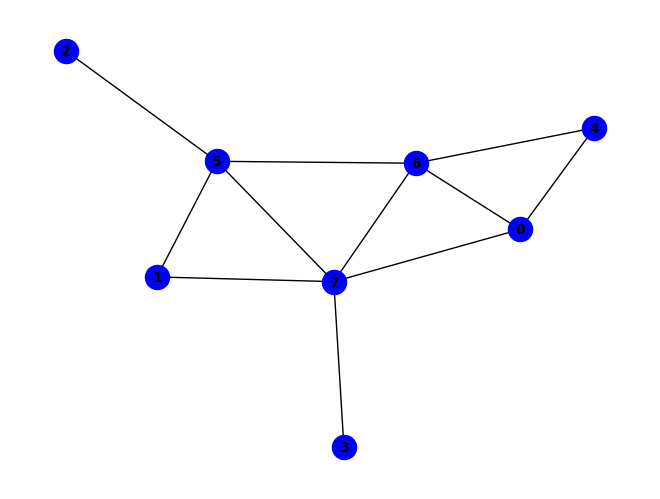


(g & ~h) ^ (~e & ~g) ^ (e & h & ~g) ^ (f & g & ~d) ^ (f & h & ~d) ^ (a & c & e & ~f) ^ (d & f & g & ~h) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & f & ~a & ~g) ^ (b & h & ~a & ~g) ^ (d & h & ~b & ~g) ^ (a & c & g & h & ~f) ^ (b & d & f & h & ~g) ^ (e & ~a & ~f & ~h) ^ (a & c & e & ~g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (e & f & ~a & ~g & ~h) ^ (a & b & c & f & ~g & ~h) ^ (a & b & c & ~e & ~f & ~g) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (a & c & h & ~b & ~e & ~f) ^ (a & d & h & ~b & ~f & ~g) ^ (a & b & c & g & h & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


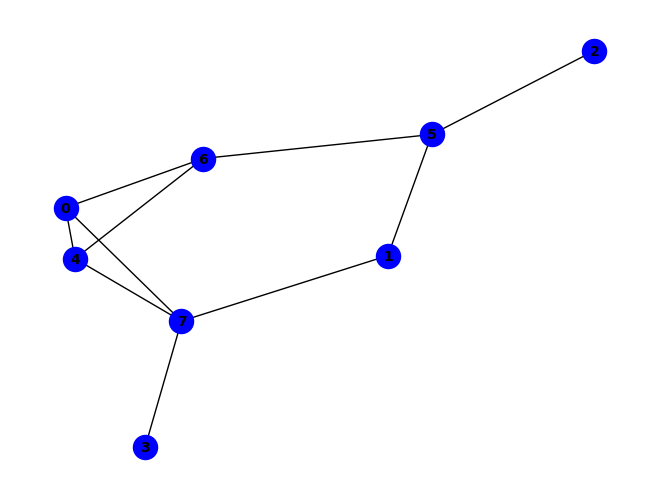


(e & f & g) ^ (~c & ~f) ^ (e & g & ~h) ^ (e & h & ~d) ^ (c & ~b & ~g) ^ (f & ~d & ~g) ^ (d & e & f & g & h) ^ (a & e & ~c & ~f) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~g) ^ (b & c & ~f & ~g) ^ (b & f & ~e & ~g) ^ (c & g & ~e & ~f) ^ (d & h & ~c & ~f) ^ (a & c & e & ~b & ~g) ^ (a & c & g & ~f & ~h) ^ (a & c & h & ~d & ~f) ^ (a & d & f & ~e & ~g) ^ (a & d & h & ~e & ~f) ^ (a & e & f & ~b & ~g) ^ (b & e & f & ~g & ~h) ^ (c & d & h & ~b & ~g) ^ (c & e & g & ~f & ~h) ^ (c & e & h & ~d & ~f) ^ (c & e & h & ~d & ~g) ^ (a & c & d & g & h & ~f) ^ (d & f & ~a & ~g & ~h) ^ (a & b & c & e & ~f & ~g) ^ (a & c & d & h & ~e & ~g) ^ (a & c & e & g & ~d & ~f) ^ (a & d & e & f & ~g & ~h) ^ (b & c & d & h & ~f & ~g) ^ (b & d & f & h & ~e & ~g) ^ (c & d & g & h & ~e & ~f) ^ (a & b & c & d & e & h & ~g) ^ (a & b & d & e & f & h & ~g) ^ (a & c & d & e & g & ~f & ~h) ^ (a & c & d & e & h & ~b & ~f) ^ (b & c & e & f & h & ~d & ~g) ^ (a & b & c & d & e & g & h & ~f) ^ (b & h & ~a & ~d & ~e & ~f) ^ (a & b & f & h

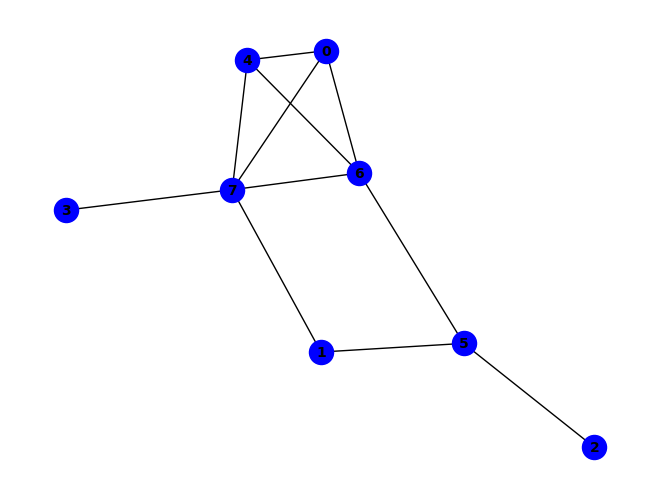


(g & ~h) ^ (~f & ~g) ^ (e & g & ~d) ^ (e & h & ~d) ^ (f & ~e & ~h) ^ (d & e & g & ~h) ^ (a & e & ~f & ~g) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & f & ~g & ~h) ^ (c & f & ~b & ~g) ^ (d & h & ~c & ~g) ^ (e & f & ~g & ~h) ^ (f & h & ~a & ~g) ^ (a & e & f & h & ~g) ^ (a & d & h & ~e & ~g) ^ (a & e & f & ~b & ~h) ^ (a & e & g & ~b & ~h) ^ (b & c & d & f & h & ~g) ^ (a & b & c & g & ~d & ~f) ^ (a & b & c & h & ~d & ~f) ^ (a & b & e & g & ~f & ~h) ^ (a & c & e & f & ~b & ~g) ^ (a & c & g & ~b & ~f & ~h) ^ (a & c & h & ~b & ~d & ~g) ^ (c & d & h & ~a & ~f & ~g) ^ (a & b & c & d & g & ~f & ~h) ^ (b & h & ~a & ~d & ~e & ~g) ^ (c & e & f & h & ~b & ~d & ~g) ^ (a & c & d & e & f & h & ~b & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


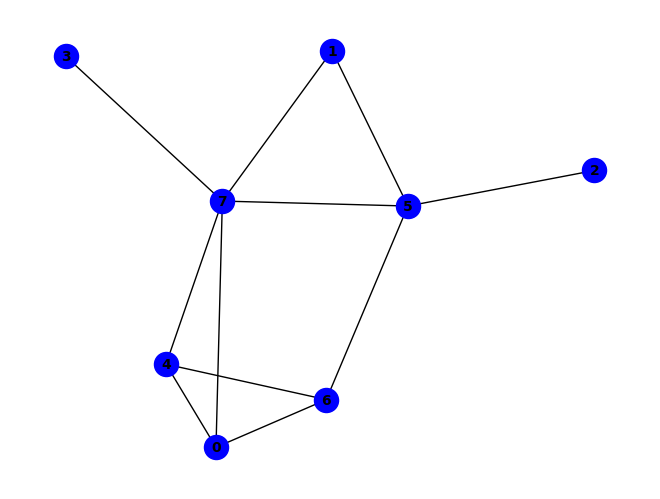


~e ^ (a & e & ~d) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & g & ~f & ~h) ^ (a & h & ~d & ~f) ^ (b & f & ~g & ~h) ^ (f & g & ~e & ~h) ^ (a & b & d & e & ~f) ^ (a & b & d & h & ~f) ^ (a & e & f & g & ~h) ^ (a & e & f & h & ~d) ^ (a & d & e & ~b & ~h) ^ (a & b & d & e & f & ~h) ^ (b & h & ~a & ~e & ~f) ^ (c & f & ~b & ~g & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


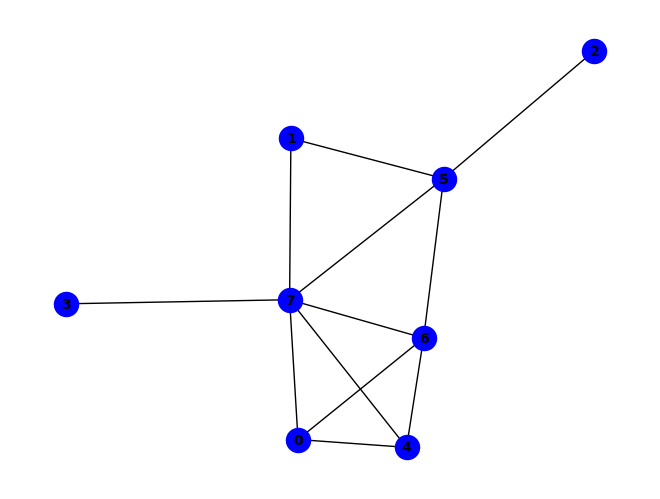


~g ^ (g & ~h) ^ (b & f & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~d) ^ (f & h & ~d) ^ (d & h & ~e & ~g) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (d & f & g & ~e & ~h) ^ (b & d & e & f & g & ~h) ^ (a & c & ~b & ~e & ~f) ^ (a & e & ~b & ~g & ~h) ^ (a & g & ~c & ~e & ~f) ^ (a & h & ~c & ~e & ~f) ^ (b & h & ~a & ~e & ~g) ^ (a & b & c & h & ~e & ~f) ^ (a & b & f & h & ~e & ~g) ^ (a & c & g & h & ~e & ~f) ^ (b & d & e & h & ~a & ~g) ^ (a & b & d & e & f & h & ~g) ^ (a & b & e & ~f & ~g & ~h) ^ (a & d & h & ~e & ~f & ~g) ^ (b & d & h & ~a & ~f & ~g) ^ (a & c & ~b & ~e & ~g & ~h) ^ (c & f & ~a & ~b & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


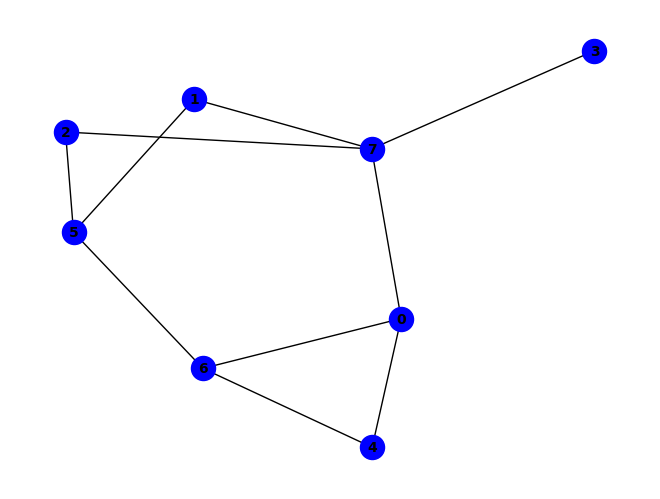


(a & f & g) ^ (~c & ~f) ^ (a & e & ~h) ^ (a & h & ~d) ^ (c & ~f & ~h) ^ (f & ~d & ~g) ^ (a & d & f & g & h) ^ (a & g & ~e & ~h) ^ (c & f & ~e & ~g) ^ (d & f & ~g & ~h) ^ (d & h & ~c & ~f) ^ (e & g & ~a & ~f) ^ (a & c & d & h & ~f) ^ (c & e & f & h & ~d) ^ (c & e & g & h & ~d) ^ (a & c & h & ~e & ~f) ^ (b & f & ~c & ~e & ~g) ^ (b & h & ~c & ~d & ~f) ^ (a & b & d & h & ~c & ~f) ^ (a & c & e & h & ~f & ~g) ^ (a & c & f & h & ~d & ~g) ^ (b & e & f & h & ~c & ~d) ^ (b & e & g & h & ~c & ~d) ^ (c & d & f & h & ~e & ~g) ^ (d & e & g & h & ~a & ~f) ^ (a & b & d & e & g & h & ~f) ^ (a & b & h & ~c & ~e & ~f) ^ (b & e & f & ~a & ~g & ~h) ^ (a & b & e & h & ~c & ~f & ~g) ^ (a & b & f & h & ~c & ~d & ~g) ^ (b & d & f & h & ~c & ~e & ~g) ^ (a & c & d & e & g & h & ~b & ~f) ^ (c & e & f & ~a & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

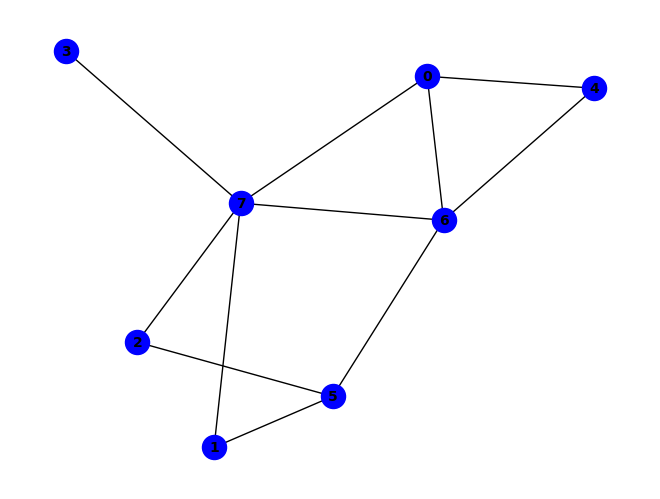


(~f & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (f & ~e & ~h) ^ (g & ~e & ~h) ^ (a & e & ~f & ~h) ^ (d & h & ~a & ~g) ^ (f & h & ~a & ~g) ^ (b & f & ~c & ~g & ~h) ^ (c & f & ~a & ~g & ~h) ^ (c & h & ~a & ~d & ~g) ^ (e & f & ~a & ~g & ~h) ^ (a & c & f & ~e & ~g & ~h) ^ (b & h & ~a & ~c & ~d & ~g) ^ (a & b & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


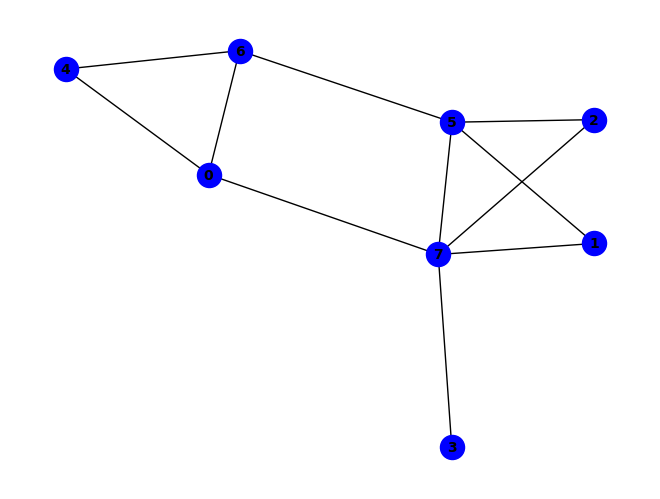


~e ^ (a & e & ~h) ^ (a & g & ~f) ^ (b & h & ~e) ^ (f & g & ~h) ^ (f & h & ~a) ^ (a & f & g & h) ^ (e & ~d & ~g) ^ (a & c & f & ~g) ^ (b & c & h & ~f) ^ (e & f & g & ~a) ^ (b & f & ~e & ~g) ^ (c & f & ~g & ~h) ^ (c & h & ~d & ~f) ^ (d & e & ~g & ~h) ^ (d & h & ~e & ~f) ^ (a & e & g & h & ~d) ^ (b & c & e & h & ~d) ^ (b & e & f & h & ~d) ^ (b & f & g & h & ~c) ^ (c & e & g & h & ~f) ^ (a & b & f & ~c & ~g) ^ (b & d & h & ~c & ~f) ^ (b & e & h & ~c & ~g) ^ (b & c & d & e & h & ~g) ^ (b & d & e & g & h & ~a) ^ (c & d & e & f & h & ~b) ^ (c & d & e & g & h & ~a) ^ (a & b & d & e & f & g & h) ^ (a & h & ~b & ~c & ~g) ^ (a & c & g & h & ~e & ~f) ^ (b & c & f & g & ~a & ~e) ^ (a & b & c & f & g & h & ~e) ^ (a & d & e & f & g & h & ~c) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & f & ~e & ~g & ~h) ^ (a & d & h & ~b & ~c & ~f) ^ (b & c & f & ~a & ~e & ~h) ^ (b & e & f & ~c & ~g & ~h) ^ (a & b & c & d & e & g & h & ~f) ^ (a & b & g & h & ~c & ~e & ~f) ^ (d & e & f & h & ~b & ~c & ~g)
PASS
PASS
PASS
P

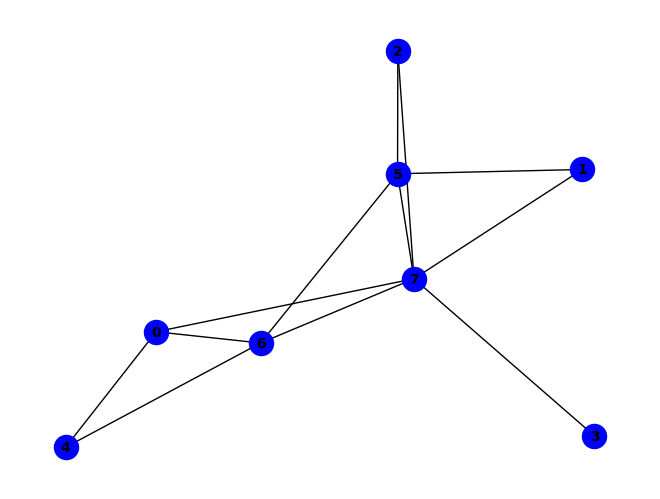


(~e & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (b & g & ~d) ^ (b & h & ~d) ^ (e & h & ~g) ^ (f & g & ~d) ^ (f & h & ~d) ^ (g & ~b & ~h) ^ (b & f & ~a & ~g) ^ (c & h & ~b & ~g) ^ (d & h & ~c & ~g) ^ (b & c & d & h & ~g) ^ (b & d & f & g & ~a) ^ (c & d & f & g & ~b) ^ (c & d & f & h & ~a) ^ (e & ~a & ~f & ~h) ^ (a & c & h & ~d & ~g) ^ (a & d & h & ~f & ~g) ^ (b & d & g & ~f & ~h) ^ (d & f & g & ~c & ~h) ^ (a & b & d & f & g & ~h) ^ (b & c & d & f & g & ~h) ^ (c & f & ~a & ~b & ~g) ^ (e & f & ~a & ~g & ~h) ^ (b & d & f & h & ~a & ~c) ^ (a & c & d & f & g & h & ~b) ^ (a & b & h & ~c & ~d & ~g) ^ (a & c & f & ~e & ~g & ~h) ^ (a & b & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


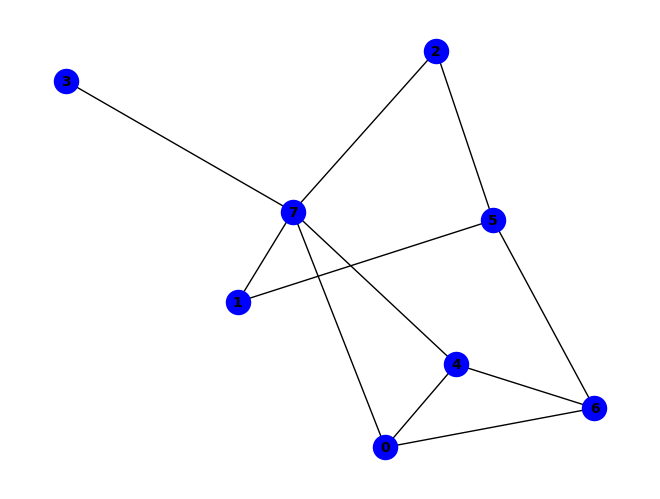


(a & f & g) ^ (e & f & g) ^ (~c & ~f) ^ (a & g & ~h) ^ (a & h & ~d) ^ (e & g & ~h) ^ (e & h & ~d) ^ (c & ~f & ~h) ^ (f & ~d & ~g) ^ (a & d & f & g & h) ^ (d & e & f & g & h) ^ (a & e & ~c & ~f) ^ (c & f & ~e & ~g) ^ (d & f & ~g & ~h) ^ (d & h & ~c & ~f) ^ (a & b & c & e & ~d) ^ (b & e & f & ~g & ~h) ^ (c & e & h & ~d & ~f) ^ (b & f & ~c & ~e & ~g) ^ (a & b & e & f & ~d & ~g) ^ (a & c & f & h & ~d & ~g) ^ (a & d & e & h & ~c & ~f) ^ (c & d & f & h & ~e & ~g) ^ (a & b & c & e & f & g & ~d) ^ (a & b & h & ~d & ~e & ~f) ^ (a & c & e & ~b & ~f & ~h) ^ (a & c & h & ~b & ~d & ~f) ^ (a & e & f & ~c & ~d & ~g) ^ (c & e & f & ~b & ~g & ~h) ^ (a & b & c & d & e & ~f & ~h) ^ (b & h & ~c & ~d & ~e & ~f) ^ (a & b & f & h & ~c & ~d & ~g) ^ (b & d & f & h & ~c & ~e & ~g) ^ (a & d & e & f & ~b & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


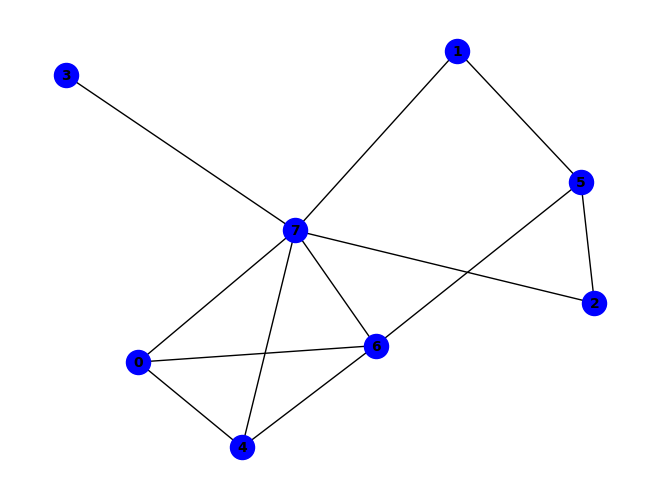


(g & ~h) ^ (~f & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (e & g & ~d) ^ (e & h & ~d) ^ (f & h & ~g) ^ (f & ~e & ~h) ^ (a & f & g & ~h) ^ (d & e & g & ~h) ^ (a & e & ~f & ~g) ^ (c & f & ~g & ~h) ^ (d & h & ~c & ~g) ^ (e & f & ~g & ~h) ^ (a & c & d & g & ~e) ^ (a & c & d & h & ~e) ^ (a & d & e & h & ~g) ^ (a & e & f & h & ~g) ^ (c & d & e & h & ~g) ^ (a & d & g & ~c & ~h) ^ (a & e & f & ~b & ~h) ^ (a & e & g & ~b & ~h) ^ (a & c & d & e & g & ~h) ^ (b & f & ~c & ~g & ~h) ^ (a & b & e & g & ~f & ~h) ^ (b & h & ~a & ~d & ~e & ~g) ^ (c & h & ~a & ~b & ~e & ~g) ^ (a & c & e & f & ~b & ~g & ~h) ^ (b & c & d & h & ~a & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


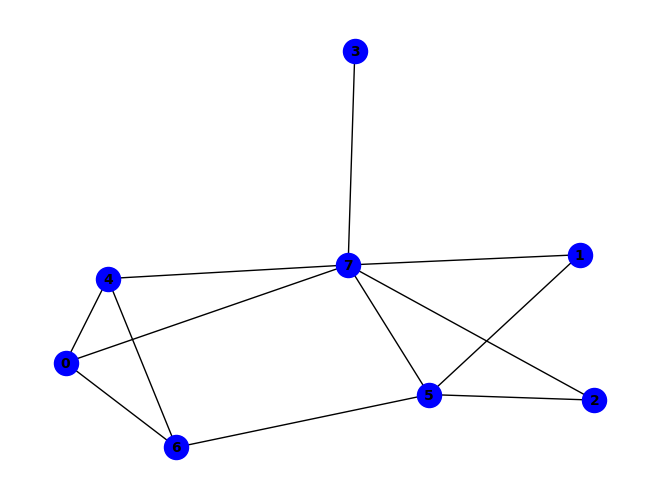


~e ^ (a & e & ~d) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & d & e & ~h) ^ (a & g & ~f & ~h) ^ (a & h & ~d & ~f) ^ (b & f & ~g & ~h) ^ (f & g & ~e & ~h) ^ (a & e & f & g & ~h) ^ (a & e & f & h & ~d) ^ (b & h & ~c & ~e & ~f) ^ (c & f & ~b & ~g & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & b & c & e & ~f & ~g) ^ (a & b & c & e & ~g & ~h) ^ (a & b & c & h & ~d & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (b & c & d & h & ~e & ~f) ^ (a & b & c & d & e & h & ~f) ^ (a & b & c & e & g & h & ~f) ^ (a & b & h & ~d & ~e & ~f) ^ (c & h & ~a & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


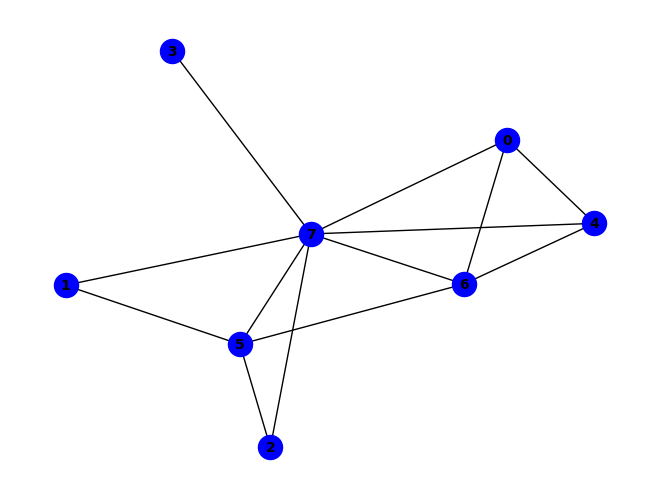


~g ^ (c & f & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~d) ^ (f & h & ~d) ^ (g & ~c & ~h) ^ (c & e & g & ~h) ^ (a & g & ~e & ~f) ^ (a & h & ~e & ~f) ^ (b & f & ~c & ~g) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (d & h & ~e & ~g) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & c & g & ~e & ~h) ^ (d & f & g & ~e & ~h) ^ (a & e & ~c & ~g & ~h) ^ (b & h & ~c & ~e & ~g) ^ (a & c & f & h & ~e & ~g) ^ (b & e & f & h & ~c & ~g) ^ (c & d & e & h & ~b & ~g) ^ (a & b & c & d & e & h & ~g) ^ (b & c & d & e & f & g & ~a) ^ (b & c & d & e & f & h & ~a) ^ (a & c & e & ~f & ~g & ~h) ^ (b & d & h & ~e & ~f & ~g) ^ (c & d & h & ~b & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (c & d & e & f & g & ~b & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & b & c & h & ~e & ~f & ~g) ^ (a & b & e & f & ~c & ~g & ~h) ^ (a & b & h & ~d & ~e & ~f & ~g) ^ (a & d & h & ~c & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

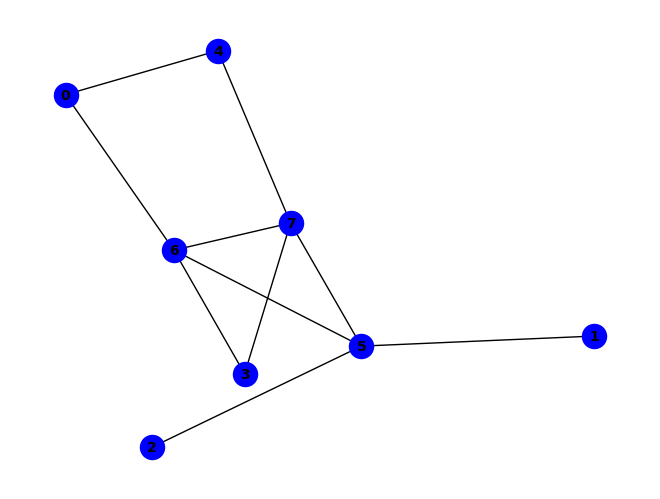


~g ^ (g & ~h) ^ (d & g & ~f) ^ (d & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & e & f & g) ^ (d & e & f & h) ^ (c & f & ~g & ~h) ^ (e & h & ~d & ~g) ^ (a & ~c & ~f & ~h) ^ (a & d & g & ~f & ~h) ^ (e & f & g & ~d & ~h) ^ (a & c & ~b & ~g & ~h) ^ (a & f & ~b & ~g & ~h) ^ (b & f & ~c & ~g & ~h) ^ (a & c & e & g & ~f & ~h) ^ (a & ~c & ~e & ~g & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & c & ~f & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & ~b & ~e & ~f & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


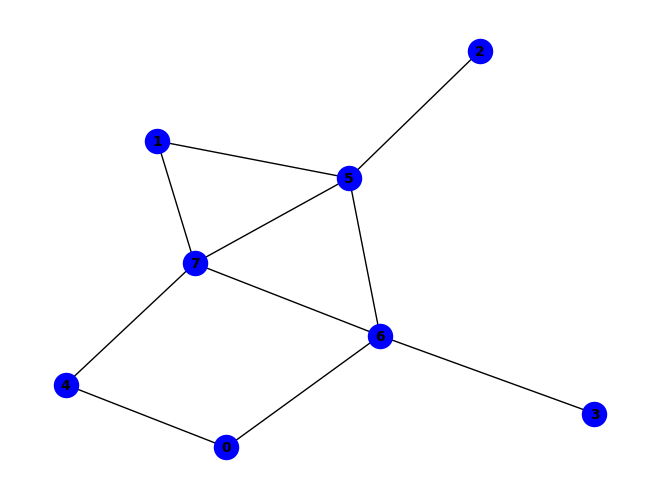


(g & ~h) ^ (~d & ~g) ^ (b & f & ~g) ^ (b & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (a & d & f & ~h) ^ (a & d & g & ~h) ^ (e & f & g & ~h) ^ (d & f & ~a & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~b & ~g) ^ (a & d & f & h & ~g) ^ (b & e & f & h & ~g) ^ (a & ~c & ~f & ~h) ^ (a & c & g & ~f & ~h) ^ (a & c & ~b & ~g & ~h) ^ (a & f & ~b & ~g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (a & ~c & ~e & ~g & ~h) ^ (a & b & c & ~f & ~g & ~h) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & b & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


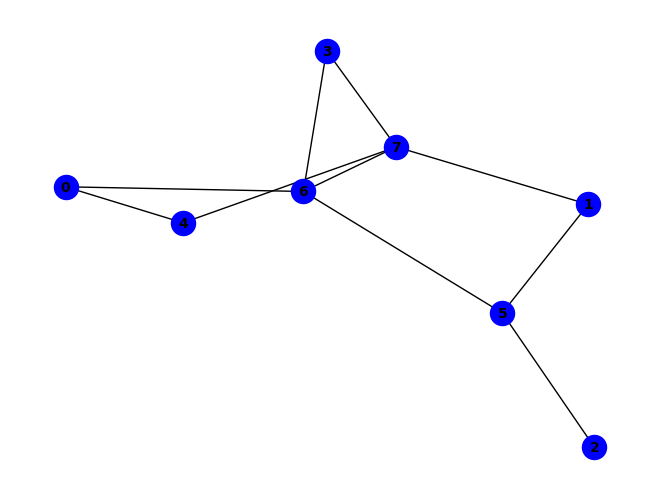


(g & ~h) ^ (~f & ~g) ^ (d & g & ~e) ^ (d & h & ~e) ^ (f & h & ~g) ^ (f & ~d & ~h) ^ (d & e & g & ~h) ^ (b & f & ~g & ~h) ^ (c & f & ~b & ~g) ^ (d & f & ~g & ~h) ^ (e & h & ~c & ~g) ^ (a & ~c & ~f & ~h) ^ (a & d & g & ~f & ~h) ^ (c & e & h & ~f & ~g) ^ (b & c & e & f & h & ~g) ^ (a & c & ~b & ~g & ~h) ^ (a & f & ~b & ~g & ~h) ^ (b & h & ~d & ~e & ~g) ^ (a & b & c & e & ~f & ~h) ^ (a & ~c & ~e & ~g & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & g & ~b & ~f & ~h) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h) ^ (c & d & f & h & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


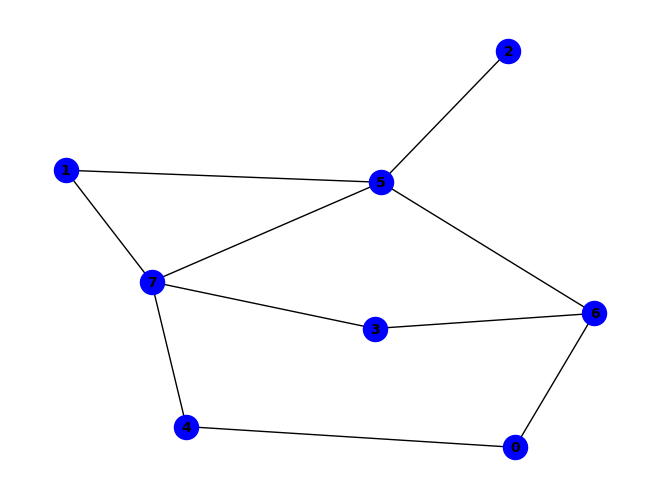


(~a & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & d & g & ~f) ^ (a & b & d & f & h) ^ (a & b & d & g & h) ^ (a & d & e & f & h) ^ (a & d & e & g & h) ^ (a & g & ~c & ~e) ^ (b & h & ~e & ~f) ^ (c & f & ~g & ~h) ^ (d & g & ~f & ~h) ^ (d & h & ~b & ~f) ^ (a & b & d & f & ~g) ^ (a & b & f & h & ~e) ^ (a & b & g & h & ~e) ^ (b & d & e & f & ~a) ^ (b & d & e & h & ~a) ^ (a & ~c & ~f & ~h) ^ (a & c & g & ~f & ~h) ^ (d & e & f & ~b & ~h) ^ (a & b & d & e & h & ~g) ^ (a & c & f & g & h & ~e) ^ (a & c & ~b & ~e & ~h) ^ (a & c & ~b & ~g & ~h) ^ (a & c & ~e & ~f & ~g) ^ (a & f & ~b & ~e & ~g) ^ (a & h & ~c & ~e & ~f) ^ (b & f & ~c & ~g & ~h) ^ (a & b & c & g & ~e & ~h) ^ (a & d & e & f & ~b & ~g) ^ (a & b & d & e & f & g & ~h) ^ (a & b & f & ~d & ~g & ~h) ^ (a & e & f & ~d & ~g & ~h) ^ (a & b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


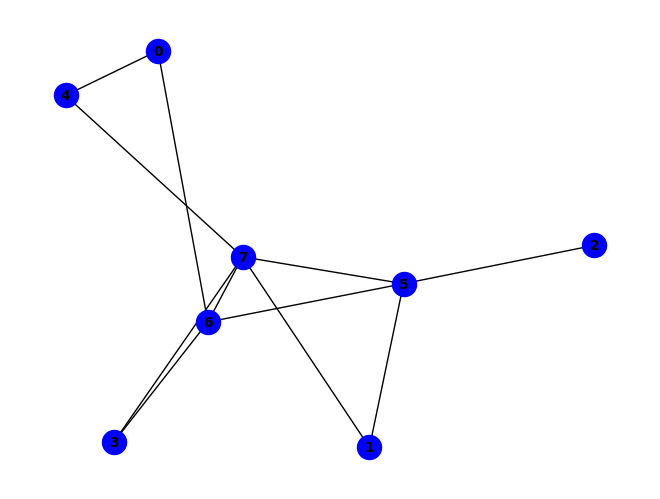


~g ^ (g & ~h) ^ (b & f & ~g) ^ (d & g & ~f) ^ (d & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & d & f & ~h) ^ (a & d & g & ~h) ^ (b & h & ~e & ~g) ^ (e & h & ~d & ~g) ^ (b & d & e & h & ~g) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (a & ~c & ~f & ~h) ^ (b & d & h & ~f & ~g) ^ (e & f & g & ~d & ~h) ^ (b & d & e & f & g & ~h) ^ (a & c & ~b & ~g & ~h) ^ (a & f & ~d & ~g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (a & b & c & e & ~f & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & ~c & ~e & ~g & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & c & g & ~b & ~f & ~h) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


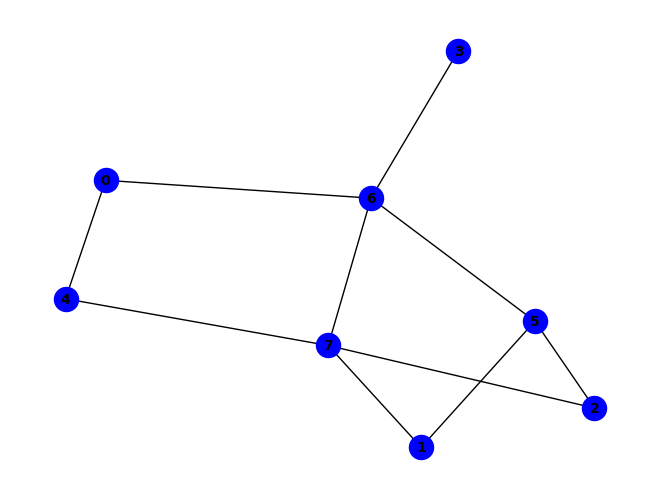


(~f & ~g) ^ (e & h & ~g) ^ (f & h & ~g) ^ (f & ~d & ~h) ^ (g & ~d & ~h) ^ (b & f & ~g & ~h) ^ (b & h & ~e & ~g) ^ (d & f & ~g & ~h) ^ (a & ~c & ~f & ~h) ^ (a & d & g & ~f & ~h) ^ (a & c & ~b & ~g & ~h) ^ (a & f & ~b & ~g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (c & h & ~b & ~e & ~g) ^ (a & b & c & e & ~f & ~h) ^ (a & ~c & ~e & ~g & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & g & ~b & ~f & ~h) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


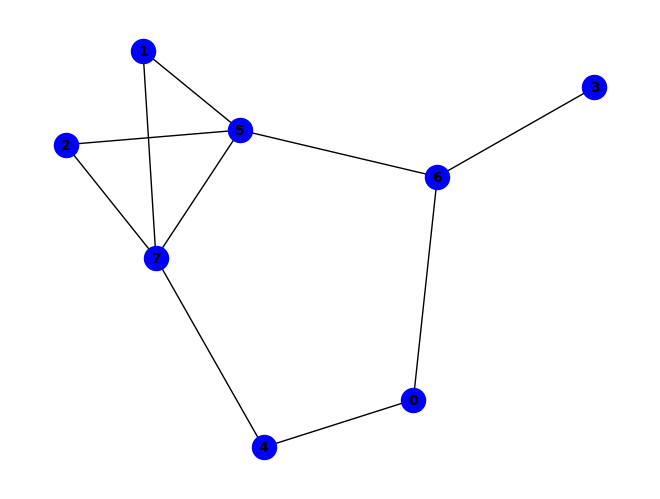


(d & e & g) ^ (~a & ~e) ^ (a & g & ~e) ^ (f & g & ~h) ^ (a & ~f & ~h) ^ (e & ~d & ~h) ^ (d & e & f & g & h) ^ (a & f & ~g & ~h) ^ (a & h & ~c & ~e) ^ (c & h & ~e & ~f) ^ (d & e & ~g & ~h) ^ (d & g & ~a & ~f) ^ (f & h & ~a & ~e) ^ (c & d & f & h & ~e) ^ (c & d & g & h & ~e) ^ (a & c & h & ~e & ~g) ^ (c & d & f & ~e & ~g) ^ (a & b & c & g & h & ~e) ^ (a & b & d & g & h & ~f) ^ (b & f & ~c & ~g & ~h) ^ (b & h & ~c & ~e & ~f) ^ (c & f & ~d & ~g & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & b & g & h & ~e & ~f) ^ (a & c & f & h & ~b & ~e) ^ (b & d & g & h & ~e & ~f) ^ (b & c & d & e & f & h & ~a) ^ (b & c & d & e & g & h & ~a) ^ (a & f & h & ~c & ~e & ~g) ^ (a & b & c & f & h & ~e & ~g) ^ (a & c & d & g & h & ~e & ~f) ^ (a & d & e & g & h & ~b & ~f) ^ (b & c & d & e & f & ~a & ~g) ^ (b & c & d & g & h & ~a & ~f) ^ (a & c & e & f & ~b & ~g & ~h) ^ (c & d & e & f & ~b & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

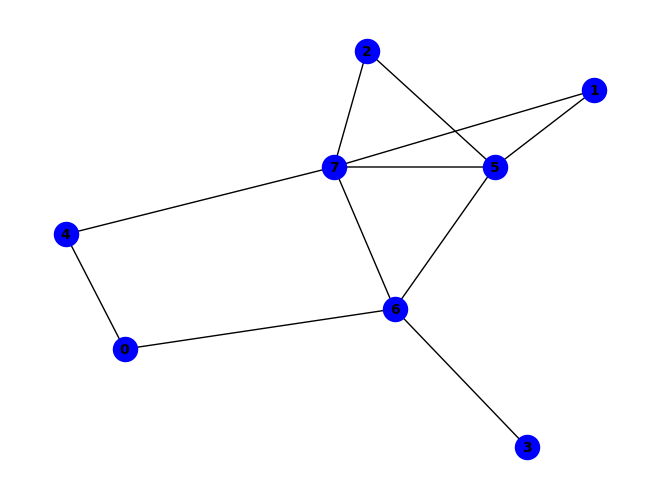


(~d & ~g) ^ (b & h & ~e) ^ (c & f & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (g & ~b & ~h) ^ (a & d & f & ~h) ^ (a & d & g & ~h) ^ (e & f & g & ~h) ^ (b & f & ~c & ~g) ^ (b & g & ~a & ~e) ^ (c & h & ~b & ~g) ^ (d & f & ~a & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~c & ~g) ^ (a & d & f & h & ~g) ^ (b & c & e & h & ~g) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & e & f & h & ~g) ^ (a & ~c & ~f & ~h) ^ (a & c & g & ~f & ~h) ^ (b & e & g & ~f & ~h) ^ (a & b & c & f & g & ~e) ^ (b & c & e & f & g & ~h) ^ (a & c & ~b & ~g & ~h) ^ (a & f & ~b & ~g & ~h) ^ (a & b & g & h & ~c & ~e) ^ (a & ~c & ~e & ~g & ~h) ^ (a & b & c & ~f & ~g & ~h) ^ (a & b & f & ~c & ~e & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & b & c & g & h & ~e & ~f) ^ (a & c & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


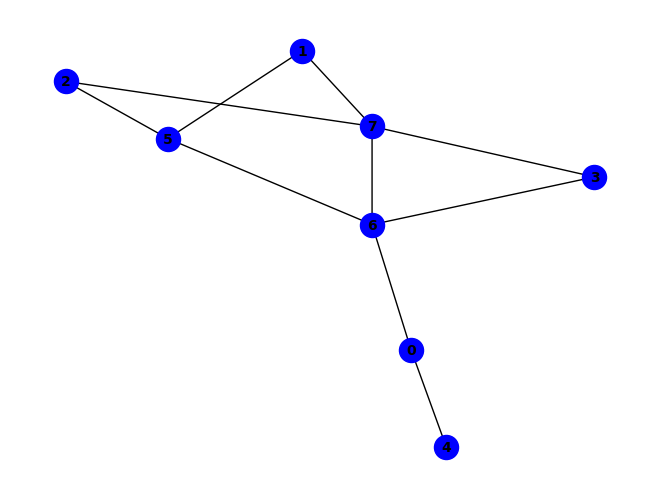


(d & g & ~c) ^ (d & h & ~c) ^ (a & d & e & g) ^ (a & d & e & h) ^ (a & ~e & ~g) ^ (g & ~a & ~h) ^ (c & d & g & ~h) ^ (~a & ~f & ~g) ^ (b & h & ~d & ~g) ^ (c & h & ~b & ~g) ^ (f & h & ~a & ~g) ^ (a & b & d & h & ~g) ^ (f & ~a & ~d & ~h) ^ (b & f & ~a & ~g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (d & f & ~a & ~g & ~h) ^ (a & b & c & f & ~g & ~h) ^ (a & b & d & g & ~c & ~e) ^ (a & b & d & h & ~c & ~e) ^ (a & b & e & h & ~c & ~g) ^ (a & c & e & f & ~g & ~h) ^ (a & c & e & h & ~d & ~g) ^ (b & c & d & h & ~a & ~g) ^ (a & d & g & ~b & ~e & ~h) ^ (a & b & c & d & g & ~e & ~h) ^ (a & b & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


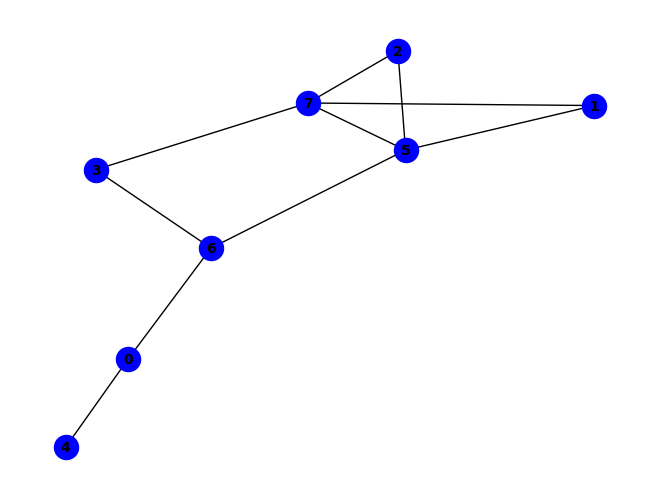


(~a & ~d) ^ (a & ~e & ~g) ^ (f & h & ~a & ~d) ^ (d & ~a & ~g & ~h) ^ (a & c & f & ~e & ~g) ^ (a & c & h & ~e & ~g) ^ (a & f & h & ~e & ~g) ^ (b & f & ~a & ~g & ~h) ^ (c & h & ~a & ~d & ~f) ^ (f & g & ~a & ~d & ~h) ^ (a & b & f & ~c & ~e & ~g) ^ (a & b & h & ~c & ~e & ~g) ^ (b & h & ~a & ~c & ~d & ~f) ^ (c & f & ~a & ~b & ~g & ~h) ^ (a & d & h & ~b & ~c & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


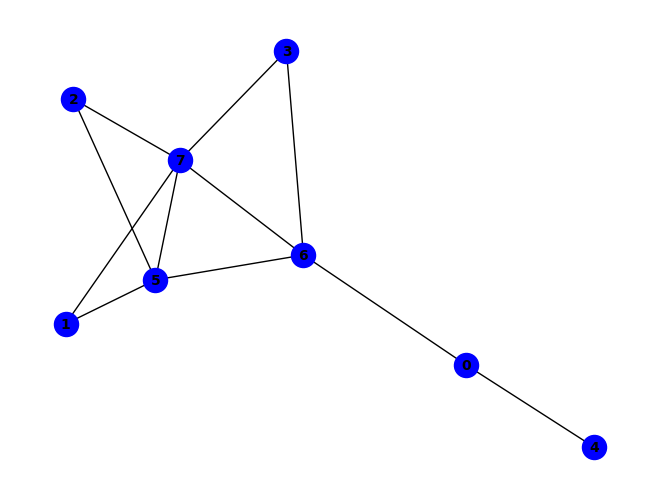


(~a & ~g) ^ (c & g & ~d) ^ (c & h & ~d) ^ (f & g & ~a) ^ (f & h & ~a) ^ (a & b & e & g) ^ (a & b & e & h) ^ (a & ~e & ~g) ^ (g & ~c & ~h) ^ (a & g & ~b & ~h) ^ (b & f & ~a & ~g) ^ (c & f & ~b & ~g) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (a & c & d & g & ~f) ^ (a & c & d & h & ~f) ^ (c & d & f & h & ~g) ^ (a & b & f & ~e & ~g) ^ (a & f & h & ~e & ~g) ^ (c & d & g & ~a & ~h) ^ (a & c & d & f & g & ~h) ^ (b & h & ~c & ~d & ~g) ^ (a & b & d & g & ~e & ~f) ^ (a & b & d & h & ~e & ~f) ^ (a & c & e & f & ~b & ~g) ^ (a & c & e & h & ~b & ~g) ^ (b & d & f & h & ~c & ~g) ^ (a & b & c & d & f & g & ~e) ^ (a & b & c & d & f & h & ~e) ^ (a & b & g & ~d & ~e & ~h) ^ (a & b & c & d & h & ~e & ~g) ^ (a & b & d & h & ~c & ~f & ~g) ^ (a & d & h & ~c & ~e & ~f & ~g) ^ (a & b & d & f & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

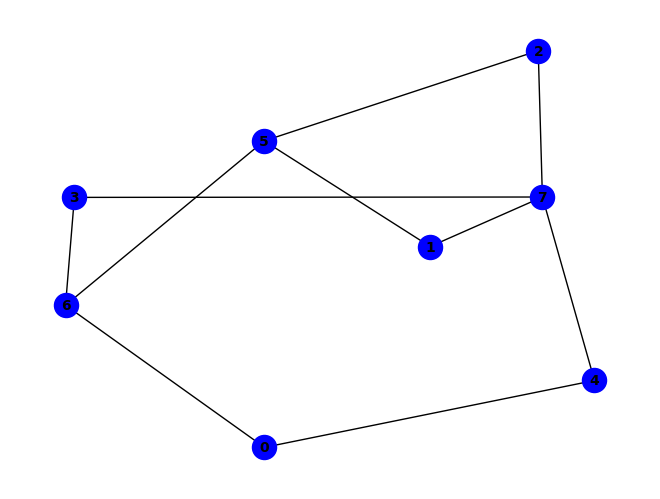


(d & f & g) ^ (~c & ~f) ^ (a & g & ~e) ^ (d & g & ~h) ^ (d & h & ~e) ^ (a & ~e & ~h) ^ (a & ~f & ~h) ^ (c & ~f & ~h) ^ (a & d & g & ~f) ^ (a & c & e & f & g) ^ (d & e & f & g & h) ^ (a & f & ~g & ~h) ^ (e & h & ~c & ~f) ^ (a & c & e & f & ~h) ^ (a & c & g & h & ~d) ^ (c & d & h & ~e & ~f) ^ (a & c & e & g & h & ~f) ^ (a & f & g & h & ~c & ~e) ^ (c & d & f & h & ~e & ~g) ^ (a & c & d & e & g & h & ~b) ^ (a & c & d & f & g & h & ~e) ^ (a & b & c & d & e & f & g & h) ^ (f & ~b & ~c & ~e & ~g) ^ (a & b & d & g & h & ~c & ~f) ^ (a & d & e & g & h & ~b & ~f) ^ (b & h & ~c & ~d & ~e & ~f) ^ (e & f & ~b & ~c & ~g & ~h) ^ (a & b & e & f & ~c & ~g & ~h) ^ (a & b & g & h & ~c & ~e & ~f) ^ (b & d & f & h & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


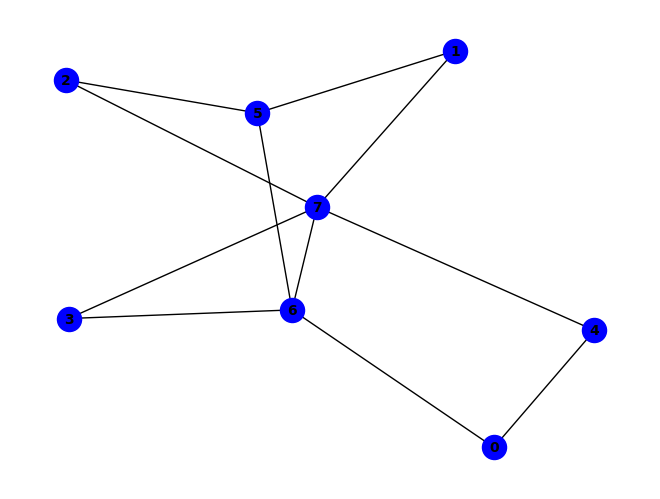


(g & ~h) ^ (~f & ~g) ^ (d & g & ~e) ^ (d & h & ~e) ^ (f & h & ~g) ^ (f & ~d & ~h) ^ (c & f & ~g & ~h) ^ (c & h & ~d & ~g) ^ (d & f & ~g & ~h) ^ (e & h & ~c & ~g) ^ (b & c & d & h & ~g) ^ (c & d & e & g & ~b) ^ (c & d & e & h & ~b) ^ (a & ~c & ~f & ~h) ^ (a & d & g & ~f & ~h) ^ (b & c & h & ~e & ~g) ^ (d & e & g & ~c & ~h) ^ (b & c & d & e & g & ~h) ^ (a & c & ~b & ~g & ~h) ^ (a & f & ~b & ~g & ~h) ^ (b & f & ~c & ~g & ~h) ^ (b & h & ~d & ~e & ~g) ^ (a & c & e & g & ~f & ~h) ^ (a & ~c & ~e & ~g & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & c & ~f & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & ~b & ~e & ~f & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


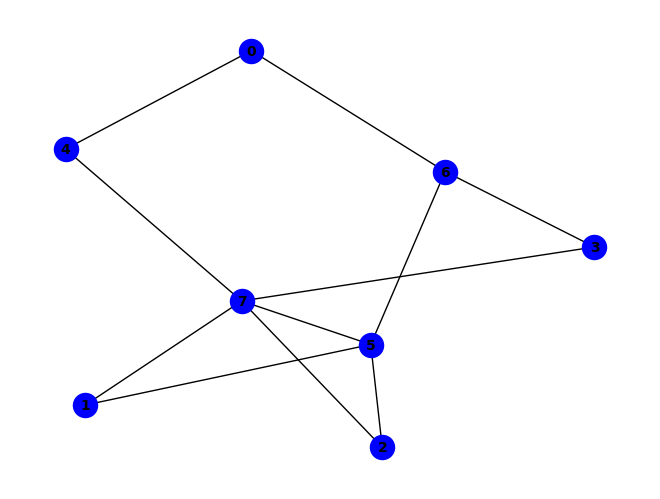


(~a & ~e) ^ (a & g & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (a & ~f & ~h) ^ (e & ~d & ~h) ^ (a & d & g & ~f) ^ (a & h & ~e & ~f) ^ (d & g & ~f & ~h) ^ (d & h & ~c & ~f) ^ (b & c & d & h & ~f) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (d & e & f & ~c & ~h) ^ (a & b & d & e & h & ~f) ^ (a & d & e & f & h & ~c) ^ (a & d & e & g & h & ~c) ^ (b & c & d & e & f & ~h) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (a & f & ~c & ~e & ~g) ^ (b & f & ~c & ~g & ~h) ^ (b & h & ~d & ~e & ~f) ^ (c & f & ~a & ~g & ~h) ^ (c & h & ~b & ~e & ~f) ^ (a & b & c & e & ~g & ~h) ^ (a & b & d & e & ~f & ~g) ^ (a & b & e & g & ~c & ~f) ^ (a & b & g & h & ~d & ~f) ^ (a & c & f & h & ~b & ~e) ^ (a & c & g & h & ~b & ~e) ^ (a & d & e & f & ~c & ~g) ^ (a & b & c & d & e & f & ~g) ^ (a & b & c & e & g & h & ~f) ^ (a & b & e & ~c & ~f & ~h) ^ (a & b & e & ~d & ~g & ~h) ^ (a & e & f & ~d & ~g & ~h) ^ (a & b & c & f & h & ~e & ~g) ^ (a & c & d & e & f & ~g & ~h) ^ (a & c & d & g & h & 

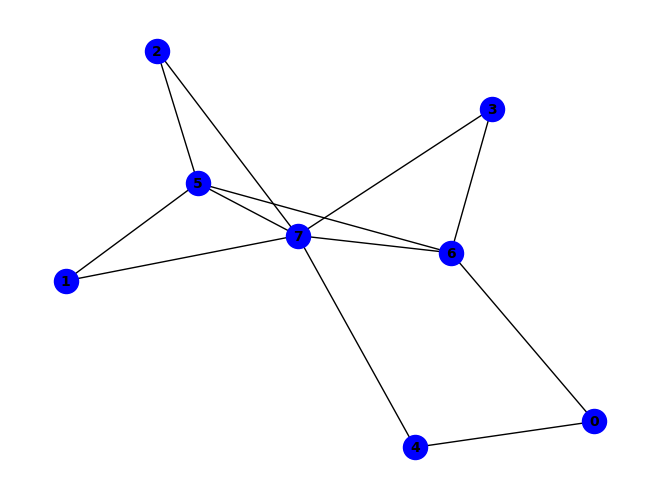


~g ^ (c & f & ~g) ^ (c & h & ~e) ^ (d & g & ~f) ^ (d & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (b & f & ~c & ~g) ^ (b & h & ~e & ~g) ^ (c & g & ~a & ~e) ^ (e & h & ~d & ~g) ^ (b & c & e & g & ~f) ^ (b & c & e & h & ~f) ^ (b & e & f & h & ~g) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & c & d & e & f & g) ^ (b & c & d & e & f & h) ^ (a & ~c & ~f & ~h) ^ (a & d & g & ~f & ~h) ^ (b & c & h & ~d & ~g) ^ (c & d & h & ~f & ~g) ^ (c & e & g & ~b & ~h) ^ (e & f & g & ~d & ~h) ^ (a & b & c & f & g & ~e) ^ (b & c & d & f & h & ~g) ^ (c & d & e & f & g & ~h) ^ (a & c & ~b & ~g & ~h) ^ (a & f & ~b & ~g & ~h) ^ (a & c & e & g & ~f & ~h) ^ (a & c & g & h & ~b & ~e) ^ (c & d & e & h & ~b & ~g) ^ (a & ~b & ~e & ~g & ~h) ^ (a & b & c & ~f & ~g & ~h) ^ (a & c & f & ~b & ~e & ~h) ^ (b & d & h & ~e & ~f & ~g) ^ (a & b & c & g & h & ~e & ~f) ^ (b & c & e & f & g & ~d & ~h) ^ (a & b & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

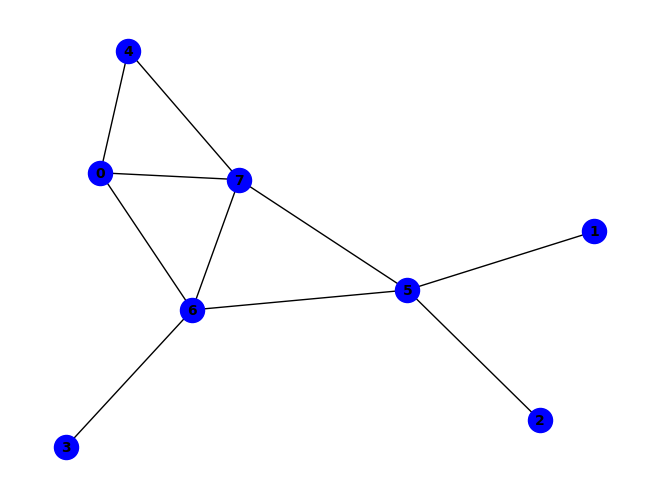


(g & ~h) ^ (~d & ~g) ^ (a & e & ~g) ^ (a & h & ~f) ^ (e & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (a & d & f & ~h) ^ (a & d & g & ~h) ^ (e & f & g & ~h) ^ (a & g & ~c & ~f) ^ (c & f & ~g & ~h) ^ (d & f & ~a & ~g) ^ (d & h & ~f & ~g) ^ (a & d & f & h & ~g) ^ (a & e & f & h & ~g) ^ (a & b & c & e & g & ~f) ^ (b & f & ~c & ~g & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & c & g & h & ~b & ~f) ^ (a & c & e & ~b & ~f & ~h) ^ (a & c & e & ~b & ~g & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (a & b & c & g & h & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


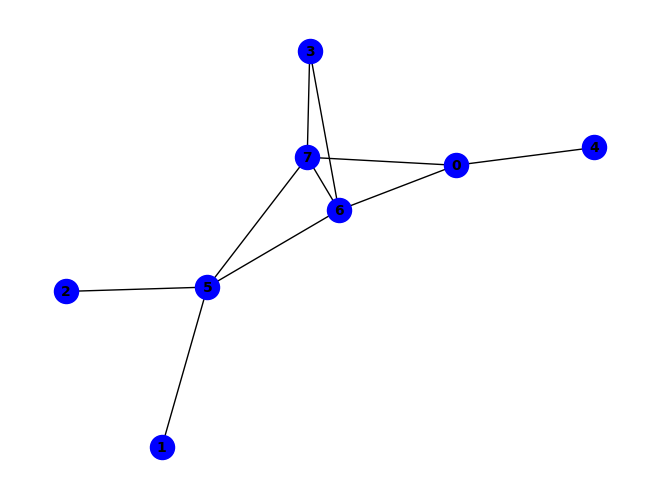


(~a & ~g) ^ (f & g & ~a) ^ (f & h & ~a) ^ (g & ~a & ~h) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (b & f & ~a & ~g & ~h) ^ (a & ~c & ~e & ~g & ~h) ^ (a & c & ~e & ~f & ~g & ~h) ^ (c & f & ~a & ~b & ~g & ~h) ^ (a & b & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


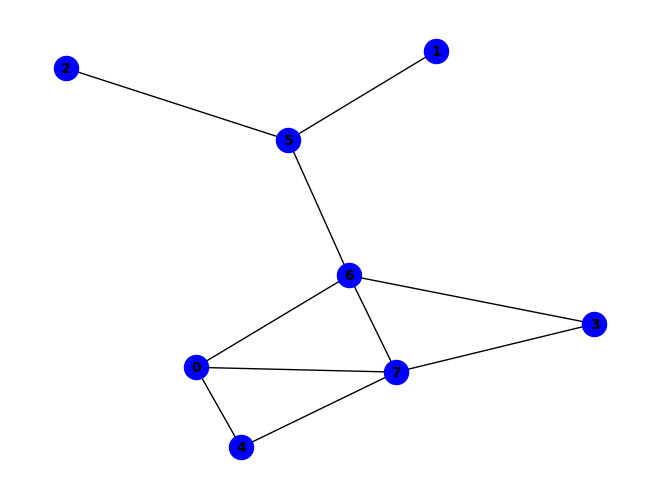


(g & ~h) ^ (~f & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (c & f & ~g) ^ (d & g & ~e) ^ (d & h & ~e) ^ (f & h & ~g) ^ (f & ~d & ~h) ^ (d & e & g & ~h) ^ (a & e & ~c & ~g) ^ (b & f & ~c & ~g) ^ (d & f & ~g & ~h) ^ (e & h & ~c & ~g) ^ (a & b & c & e & ~g) ^ (a & b & e & f & ~g) ^ (a & f & g & ~d & ~h) ^ (c & e & h & ~f & ~g) ^ (a & b & f & h & ~d & ~g) ^ (a & d & e & h & ~c & ~g) ^ (b & d & f & h & ~c & ~g) ^ (c & d & f & h & ~e & ~g) ^ (a & c & e & ~b & ~f & ~g) ^ (a & c & d & e & h & ~f & ~g) ^ (a & c & f & h & ~b & ~d & ~g) ^ (b & e & f & h & ~c & ~d & ~g) ^ (a & b & d & e & f & h & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


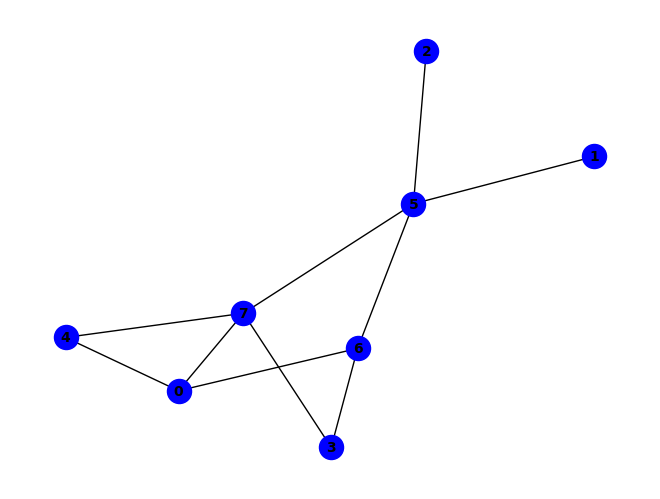


~e ^ (a & e & ~g) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (a & e & f & h) ^ (a & e & g & h) ^ (e & ~d & ~h) ^ (d & e & f & ~h) ^ (a & g & ~c & ~f) ^ (a & h & ~f & ~g) ^ (d & h & ~a & ~f) ^ (a & d & e & h & ~f) ^ (a & b & c & e & g & ~f) ^ (b & f & ~a & ~g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (d & g & ~a & ~f & ~h) ^ (a & c & g & h & ~b & ~f) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & e & ~b & ~f & ~h) ^ (a & c & e & ~b & ~g & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (a & b & c & g & h & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


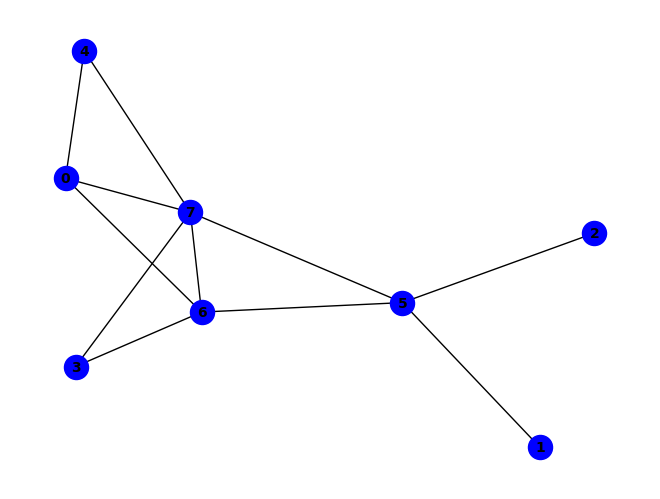


~g ^ (g & ~h) ^ (a & e & ~g) ^ (d & g & ~f) ^ (d & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (e & h & ~d & ~g) ^ (a & d & e & h & ~g) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~a) ^ (d & e & f & h & ~a) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (b & f & ~c & ~g & ~h) ^ (c & f & ~a & ~g & ~h) ^ (a & c & f & ~e & ~g & ~h) ^ (a & b & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


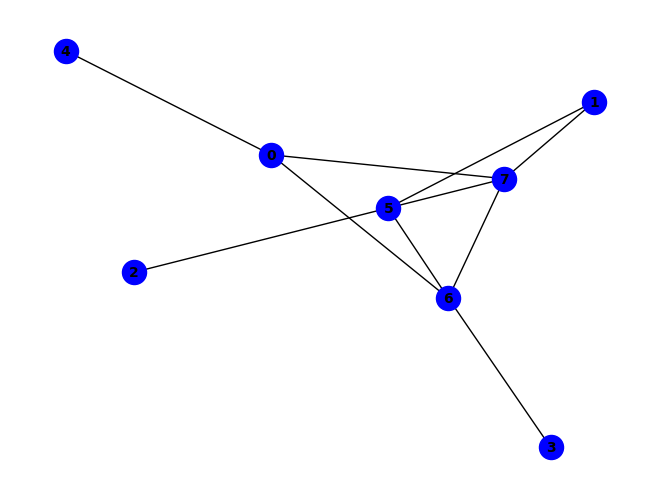


(f & g & ~a) ^ (f & h & ~a) ^ (g & ~a & ~h) ^ (~a & ~d & ~g) ^ (b & f & ~a & ~g) ^ (b & h & ~a & ~g) ^ (d & f & ~a & ~g) ^ (d & ~a & ~f & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & ~c & ~e & ~g & ~h) ^ (a & c & ~e & ~f & ~g & ~h) ^ (c & f & ~a & ~b & ~g & ~h) ^ (a & b & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


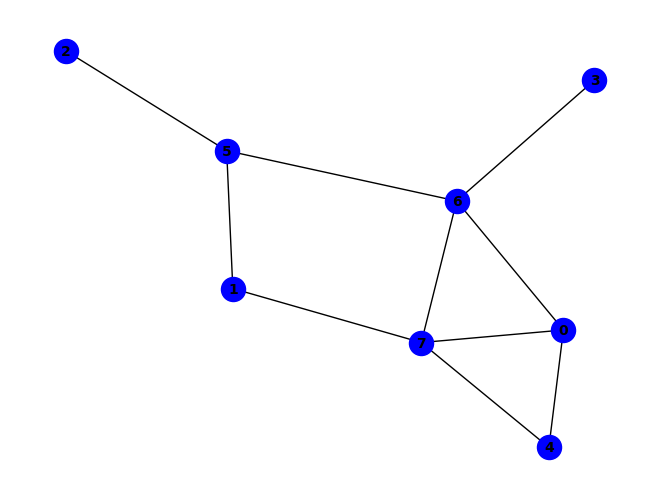


(~f & ~g) ^ (a & g & ~c) ^ (a & h & ~c) ^ (f & h & ~g) ^ (f & ~d & ~h) ^ (g & ~d & ~h) ^ (a & e & ~c & ~g) ^ (b & f & ~g & ~h) ^ (c & f & ~b & ~g) ^ (d & f & ~g & ~h) ^ (e & h & ~c & ~g) ^ (a & b & c & e & ~g) ^ (a & b & c & h & ~g) ^ (b & c & e & h & ~g) ^ (a & c & g & ~b & ~f) ^ (a & c & h & ~b & ~f) ^ (a & d & g & ~f & ~h) ^ (a & f & g & ~c & ~h) ^ (b & h & ~a & ~e & ~g) ^ (a & b & c & g & ~f & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & ~b & ~f & ~g) ^ (c & e & h & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


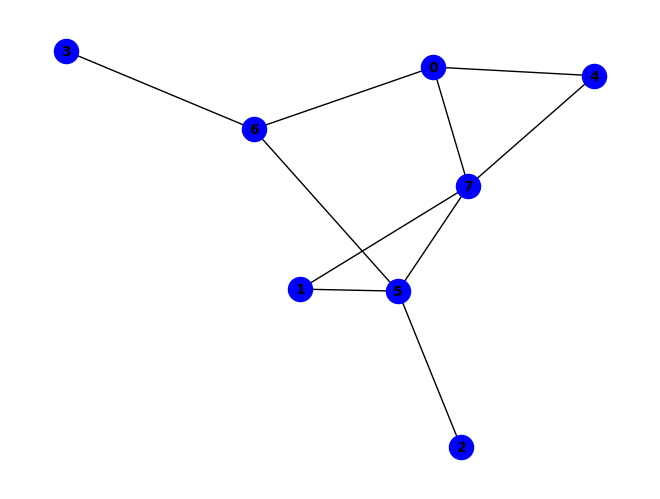


~e ^ (d & e & g) ^ (f & g & ~h) ^ (f & h & ~e) ^ (a & e & g & h) ^ (e & ~d & ~h) ^ (d & e & f & g & h) ^ (a & c & ~f & ~g) ^ (a & e & ~d & ~g) ^ (a & g & ~f & ~h) ^ (a & h & ~c & ~f) ^ (c & f & ~g & ~h) ^ (d & g & ~a & ~f) ^ (a & c & g & h & ~f) ^ (a & d & e & h & ~b) ^ (a & e & f & h & ~d) ^ (a & b & d & e & f & h) ^ (a & c & e & ~g & ~h) ^ (a & b & d & e & f & ~g) ^ (a & b & d & e & h & ~g) ^ (a & b & d & g & h & ~f) ^ (a & d & e & f & h & ~g) ^ (b & f & ~c & ~g & ~h) ^ (b & h & ~a & ~e & ~f) ^ (d & e & ~a & ~g & ~h) ^ (b & d & g & h & ~e & ~f) ^ (a & b & c & e & f & ~g & ~h) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & b & e & f & ~d & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


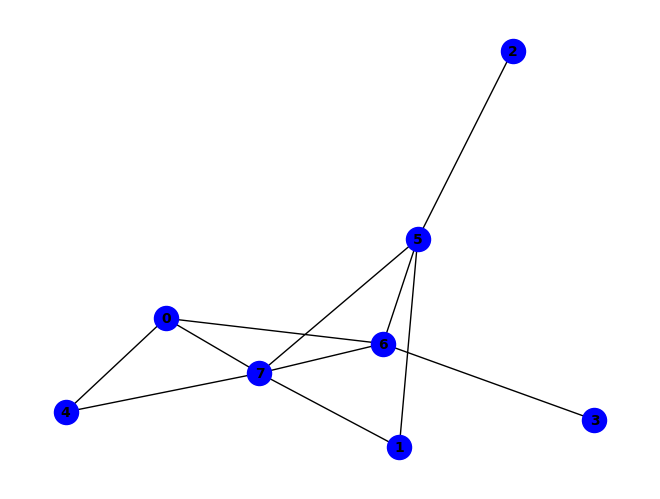


(g & ~h) ^ (~d & ~g) ^ (a & e & ~g) ^ (a & h & ~f) ^ (b & f & ~g) ^ (b & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & e & f & g) ^ (a & e & f & h) ^ (d & ~f & ~h) ^ (a & d & f & ~h) ^ (a & d & g & ~h) ^ (a & g & ~c & ~f) ^ (d & f & ~a & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~b & ~g) ^ (a & c & g & h & ~f) ^ (a & d & f & h & ~g) ^ (b & e & f & h & ~g) ^ (a & c & e & ~f & ~h) ^ (a & c & e & ~g & ~h) ^ (e & f & g & ~a & ~h) ^ (c & f & ~b & ~g & ~h) ^ (a & b & h & ~e & ~f & ~g) ^ (a & c & g & ~e & ~f & ~h) ^ (a & b & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


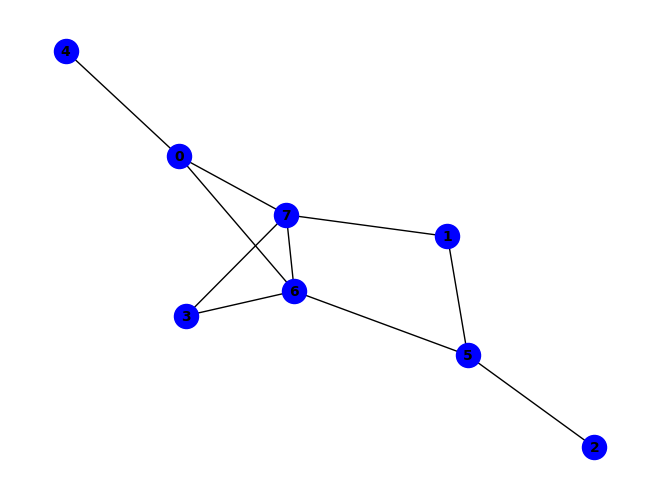


(g & ~h) ^ (~f & ~g) ^ (a & e & ~g) ^ (a & g & ~d) ^ (a & h & ~e) ^ (d & g & ~c) ^ (d & h & ~c) ^ (f & h & ~g) ^ (a & d & f & g) ^ (a & e & g & h) ^ (f & ~d & ~h) ^ (a & b & f & ~h) ^ (c & d & g & ~h) ^ (b & f & ~g & ~h) ^ (c & f & ~b & ~g) ^ (d & f & ~g & ~h) ^ (a & d & f & h & ~g) ^ (a & d & h & ~c & ~f) ^ (a & f & g & ~b & ~h) ^ (c & d & h & ~f & ~g) ^ (a & c & d & g & h & ~f) ^ (b & c & d & f & h & ~g) ^ (b & h & ~a & ~d & ~g) ^ (a & c & d & h & ~b & ~g) ^ (a & c & f & h & ~b & ~g) ^ (a & b & f & ~e & ~g & ~h) ^ (a & b & c & d & h & ~f & ~g) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


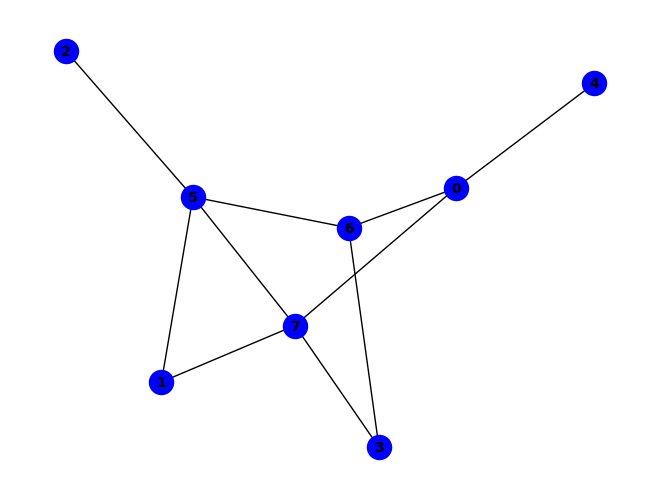


~d ^ (f & h & ~d) ^ (d & ~g & ~h) ^ (a & e & ~g & ~h) ^ (a & g & ~d & ~f) ^ (f & g & ~d & ~h) ^ (a & h & ~d & ~f & ~g) ^ (b & f & ~a & ~g & ~h) ^ (b & h & ~a & ~d & ~f) ^ (c & f & ~b & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


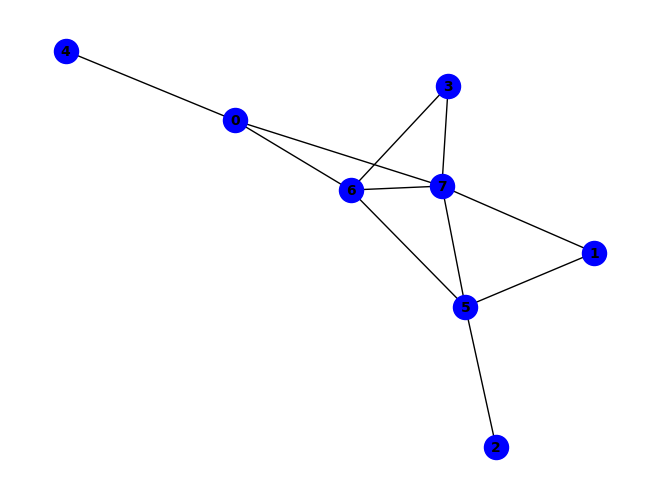


(~a & ~g) ^ (f & g & ~a) ^ (f & h & ~a) ^ (g & ~a & ~h) ^ (b & f & ~a & ~g) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (b & h & ~a & ~d & ~g) ^ (b & d & f & h & ~a & ~g) ^ (a & ~c & ~e & ~g & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (c & f & ~a & ~b & ~g & ~h) ^ (a & c & ~b & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


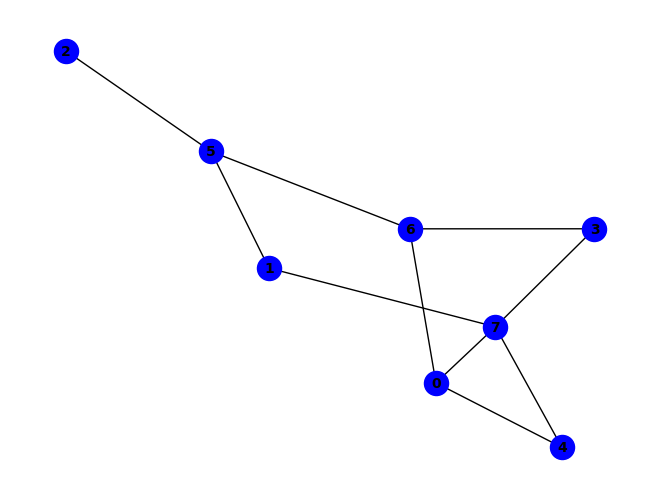


(~c & ~f) ^ (d & h & ~e) ^ (a & e & f & h) ^ (a & e & g & h) ^ (c & d & f & h) ^ (c & ~b & ~g) ^ (d & f & g & ~c) ^ (d & e & f & g & h) ^ (a & e & ~f & ~g) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~g) ^ (b & c & ~f & ~g) ^ (c & g & ~e & ~f) ^ (d & g & ~c & ~h) ^ (e & h & ~c & ~f) ^ (f & ~b & ~e & ~g) ^ (a & e & f & ~g & ~h) ^ (c & e & g & ~f & ~h) ^ (c & e & h & ~d & ~g) ^ (a & d & e & f & h & ~g) ^ (b & c & e & f & h & ~g) ^ (e & f & ~b & ~g & ~h) ^ (a & b & e & f & ~d & ~g) ^ (a & c & e & f & ~b & ~g) ^ (a & c & f & h & ~d & ~g) ^ (a & d & e & h & ~c & ~f) ^ (b & c & d & g & ~e & ~f) ^ (b & c & d & h & ~e & ~f) ^ (b & c & d & h & ~e & ~g) ^ (b & d & f & h & ~e & ~g) ^ (c & d & e & h & ~f & ~g) ^ (a & c & d & e & g & h & ~f) ^ (c & d & g & ~b & ~f & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (a & c & d & e & h & ~b & ~g) ^ (b & c & d & e & g & ~f & ~h) ^ (b & h & ~a & ~d & ~e & ~f) ^ (a & b & f & h & ~c & ~d & ~g) ^ (a & b & c & d & e & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

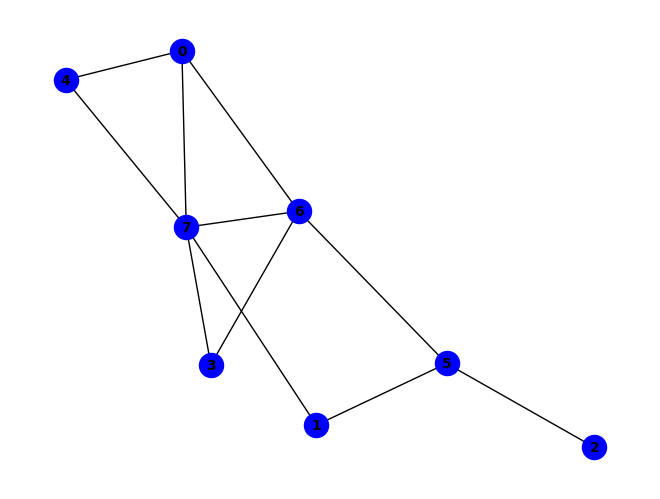


(g & ~h) ^ (~f & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (d & g & ~e) ^ (d & h & ~e) ^ (f & h & ~g) ^ (f & ~d & ~h) ^ (d & e & g & ~h) ^ (a & e & ~c & ~g) ^ (b & f & ~g & ~h) ^ (c & f & ~b & ~g) ^ (d & f & ~g & ~h) ^ (e & h & ~c & ~g) ^ (a & b & c & e & ~g) ^ (a & f & g & ~d & ~h) ^ (c & e & h & ~f & ~g) ^ (b & c & e & f & h & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & d & e & h & ~c & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & c & e & ~b & ~f & ~g) ^ (b & h & ~a & ~d & ~e & ~g) ^ (a & c & f & h & ~b & ~d & ~g) ^ (c & d & f & h & ~b & ~e & ~g) ^ (a & c & d & e & h & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


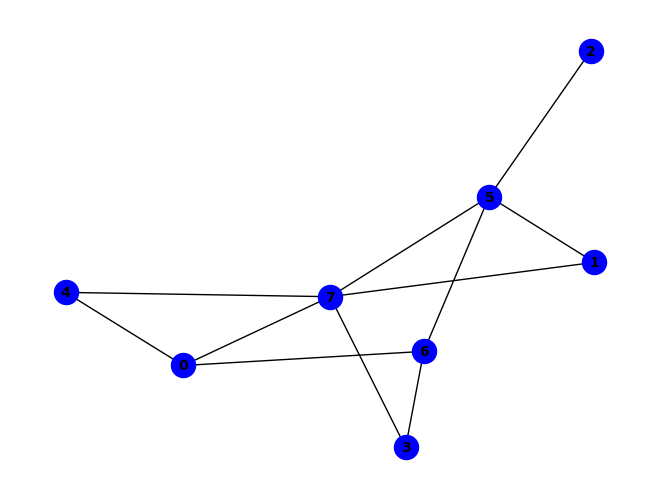


~e ^ (a & e & ~g) ^ (d & e & ~f) ^ (f & h & ~e) ^ (a & d & e & h) ^ (a & e & g & h) ^ (e & ~d & ~h) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~f) ^ (d & g & ~f & ~h) ^ (d & h & ~b & ~f) ^ (f & g & ~a & ~h) ^ (a & b & d & h & ~f) ^ (a & d & f & g & ~h) ^ (a & e & f & h & ~d) ^ (b & d & e & f & ~a) ^ (b & d & e & h & ~a) ^ (d & e & f & ~b & ~h) ^ (a & b & d & e & f & ~h) ^ (b & f & ~c & ~g & ~h) ^ (b & h & ~a & ~e & ~f) ^ (c & f & ~a & ~g & ~h) ^ (a & c & f & ~e & ~g & ~h) ^ (a & b & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


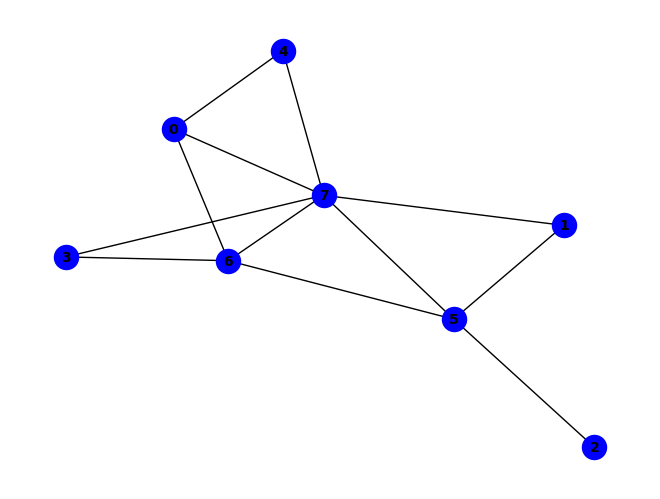


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~g) ^ (d & g & ~f) ^ (d & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (e & h & ~d & ~g) ^ (a & e & f & h & ~g) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (e & f & g & ~d & ~h) ^ (b & d & e & f & g & ~h) ^ (b & h & ~a & ~e & ~g) ^ (c & f & ~b & ~g & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & b & f & h & ~e & ~g) ^ (a & d & e & h & ~f & ~g) ^ (b & d & e & h & ~a & ~g) ^ (a & b & d & e & f & h & ~g) ^ (b & d & h & ~a & ~f & ~g) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


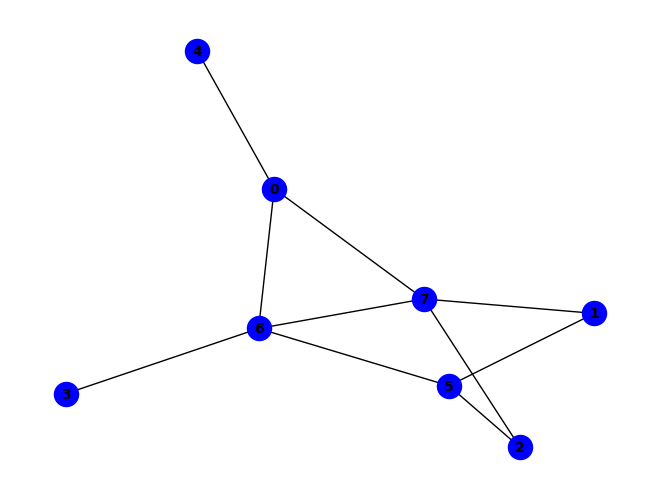


(~f & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (f & ~d & ~h) ^ (g & ~d & ~h) ^ (a & d & f & ~h) ^ (a & d & g & ~h) ^ (a & e & ~g & ~h) ^ (c & h & ~a & ~g) ^ (f & h & ~a & ~g) ^ (b & f & ~c & ~g & ~h) ^ (b & h & ~a & ~c & ~g) ^ (c & f & ~a & ~g & ~h) ^ (d & f & ~a & ~g & ~h) ^ (a & b & c & f & ~g & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & c & f & ~b & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


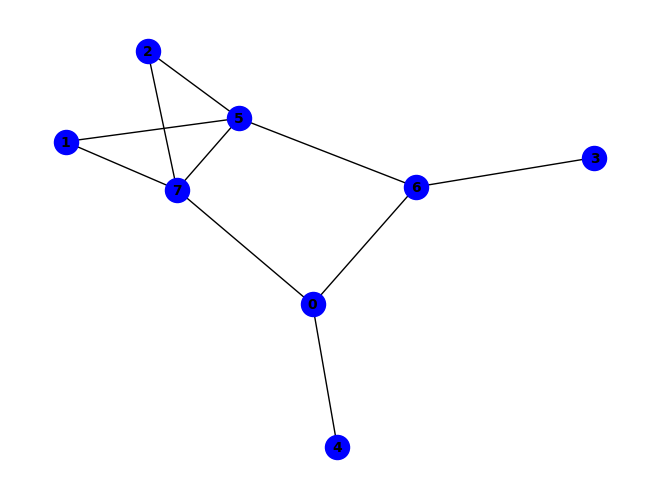


~d ^ (f & h) ^ (d & f & g) ^ (f & g & ~h) ^ (d & ~c & ~g) ^ (a & d & g & ~f) ^ (a & e & ~g & ~h) ^ (a & g & ~f & ~h) ^ (b & h & ~c & ~f) ^ (c & d & ~g & ~h) ^ (c & h & ~d & ~f) ^ (a & b & d & g & h & ~f) ^ (a & c & d & f & h & ~b) ^ (a & c & d & g & h & ~b) ^ (a & h & ~b & ~c & ~f) ^ (b & f & ~a & ~g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (a & b & c & f & ~g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (b & d & g & h & ~c & ~f) ^ (c & d & f & h & ~a & ~g) ^ (a & b & c & d & f & h & ~g) ^ (a & b & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


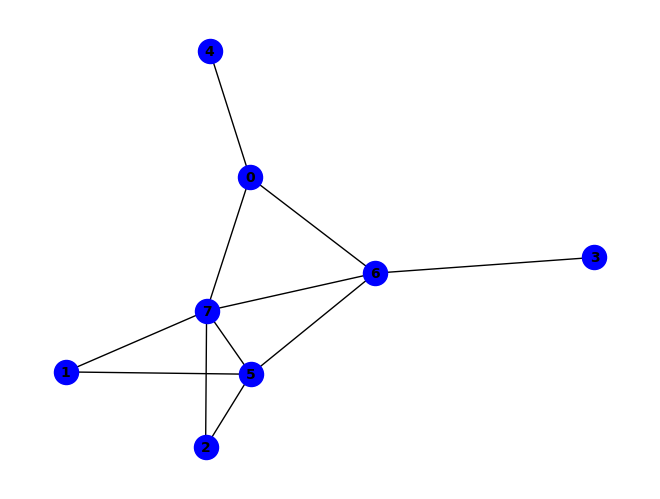


(f & g & ~a) ^ (f & h & ~a) ^ (g & ~a & ~h) ^ (~a & ~d & ~g) ^ (c & f & ~a & ~g) ^ (c & h & ~a & ~g) ^ (d & f & ~a & ~g) ^ (d & ~a & ~f & ~h) ^ (b & f & ~a & ~c & ~g) ^ (b & h & ~a & ~c & ~g) ^ (d & h & ~a & ~f & ~g) ^ (a & ~c & ~e & ~g & ~h) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & b & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


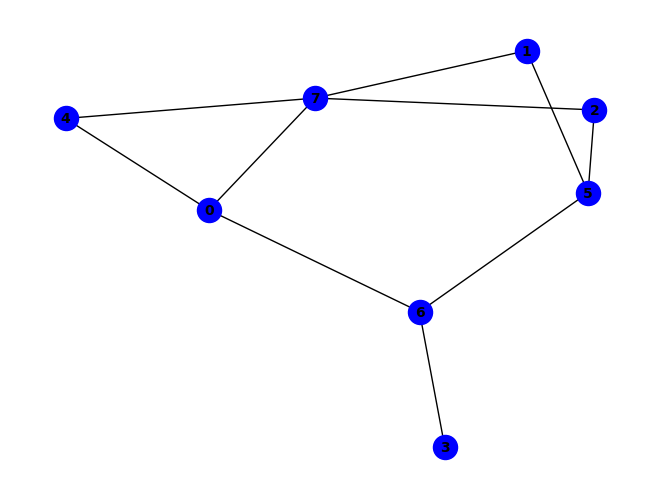


(a & f & g) ^ (~c & ~f) ^ (a & g & ~h) ^ (a & h & ~c) ^ (c & ~f & ~h) ^ (a & e & ~f & ~g) ^ (d & g & ~a & ~f) ^ (e & h & ~c & ~f) ^ (a & c & e & h & ~f) ^ (a & e & f & h & ~d) ^ (a & e & g & h & ~d) ^ (a & c & d & e & f & h) ^ (a & c & d & g & h & ~e) ^ (a & c & f & g & h & ~d) ^ (a & b & e & f & ~d & ~g) ^ (a & b & f & h & ~c & ~g) ^ (a & c & e & f & ~b & ~g) ^ (a & d & e & f & ~c & ~g) ^ (c & d & g & h & ~e & ~f) ^ (d & e & g & h & ~b & ~f) ^ (a & b & d & e & f & h & ~c) ^ (a & b & d & e & g & h & ~c) ^ (b & c & d & e & g & h & ~f) ^ (f & ~b & ~c & ~e & ~g) ^ (a & e & f & ~d & ~g & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (a & b & c & d & e & f & h & ~g) ^ (b & h & ~a & ~c & ~e & ~f) ^ (e & f & ~b & ~c & ~g & ~h) ^ (b & d & g & h & ~a & ~c & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

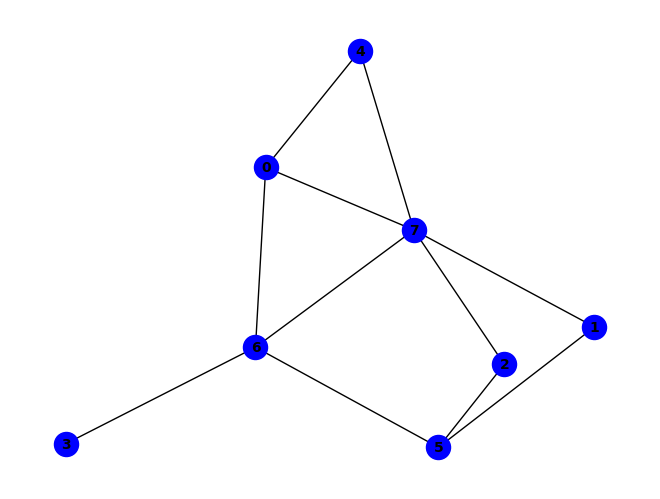


(~f & ~g) ^ (a & e & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (e & h & ~g) ^ (f & ~d & ~h) ^ (g & ~d & ~h) ^ (b & f & ~g & ~h) ^ (d & f & ~g & ~h) ^ (f & h & ~a & ~g) ^ (a & d & g & ~f & ~h) ^ (b & h & ~a & ~e & ~g) ^ (c & f & ~b & ~g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (c & h & ~a & ~b & ~e & ~g) ^ (a & b & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


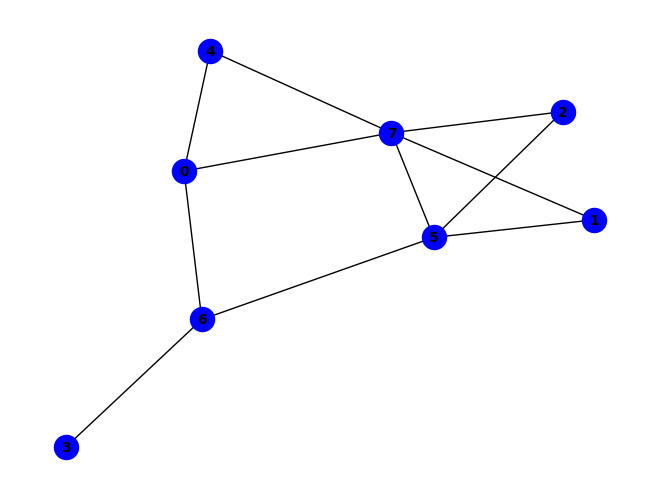


~e ^ (d & e & g) ^ (a & h & ~f) ^ (f & g & ~h) ^ (f & h & ~e) ^ (a & e & f & h) ^ (a & e & g & h) ^ (e & ~d & ~h) ^ (d & e & f & g & h) ^ (a & e & ~d & ~g) ^ (a & g & ~f & ~h) ^ (d & g & ~a & ~f) ^ (a & d & e & h & ~f) ^ (c & d & f & h & ~e) ^ (c & d & g & h & ~e) ^ (c & d & f & ~e & ~g) ^ (a & d & e & f & h & ~g) ^ (b & f & ~c & ~g & ~h) ^ (c & f & ~d & ~g & ~h) ^ (c & h & ~a & ~e & ~f) ^ (d & e & ~a & ~g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (b & c & d & e & f & h & ~a) ^ (b & c & d & e & g & h & ~a) ^ (a & c & d & g & h & ~e & ~f) ^ (b & c & d & e & f & ~a & ~g) ^ (b & c & d & g & h & ~a & ~f) ^ (b & h & ~a & ~c & ~e & ~f) ^ (a & b & e & f & ~c & ~g & ~h) ^ (b & d & g & h & ~a & ~e & ~f) ^ (c & d & e & f & ~b & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


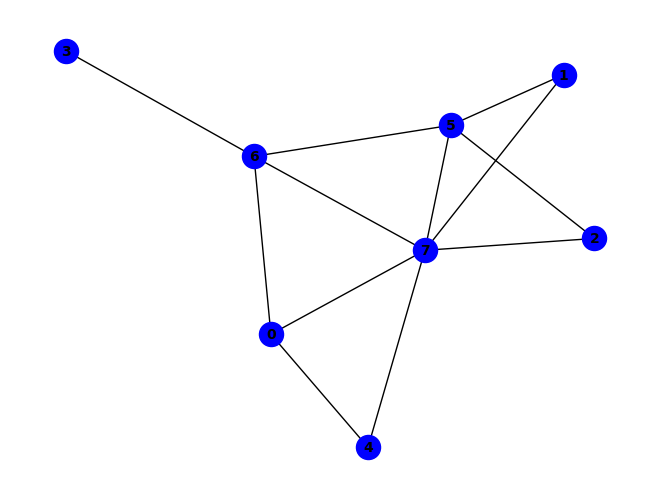


(~d & ~g) ^ (a & e & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & f & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (g & ~b & ~h) ^ (a & d & f & ~h) ^ (a & d & g & ~h) ^ (e & f & g & ~h) ^ (b & f & ~c & ~g) ^ (c & h & ~b & ~g) ^ (d & f & ~a & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~c & ~g) ^ (a & d & f & h & ~g) ^ (a & e & f & h & ~g) ^ (b & c & e & h & ~g) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & e & f & h & ~g) ^ (b & e & g & ~f & ~h) ^ (b & c & e & f & g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & b & h & ~e & ~f & ~g) ^ (a & b & e & f & ~c & ~g & ~h) ^ (a & c & h & ~b & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


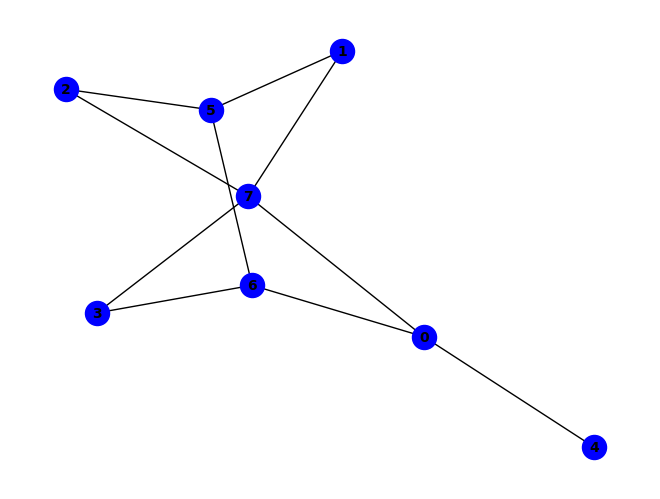


~f ^ (a & g & ~f) ^ (a & h & ~g) ^ (f & ~c & ~g) ^ (d & f & g & ~a) ^ (d & g & ~a & ~h) ^ (d & h & ~a & ~c) ^ (c & d & f & g & h & ~a) ^ (a & e & ~c & ~g & ~h) ^ (b & f & ~c & ~d & ~g) ^ (b & h & ~a & ~d & ~f) ^ (c & h & ~a & ~b & ~f) ^ (a & b & f & h & ~d & ~g) ^ (a & c & f & h & ~b & ~g) ^ (b & c & d & h & ~a & ~f) ^ (a & b & c & d & f & h & ~g) ^ (a & c & e & ~f & ~g & ~h) ^ (b & d & f & ~c & ~g & ~h) ^ (a & b & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


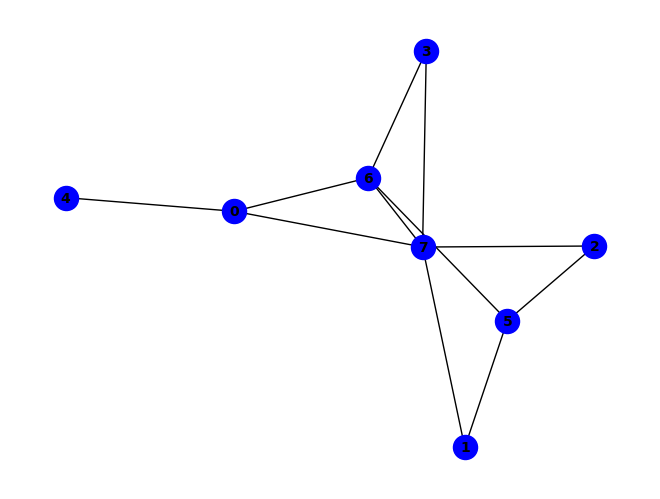


(g & ~h) ^ (~f & ~g) ^ (a & e & ~g) ^ (a & g & ~d) ^ (a & h & ~e) ^ (d & g & ~c) ^ (f & h & ~g) ^ (a & e & g & h) ^ (f & ~d & ~h) ^ (c & d & g & ~h) ^ (a & c & d & g & h) ^ (d & f & ~g & ~h) ^ (d & h & ~a & ~c) ^ (a & f & g & ~d & ~h) ^ (b & f & ~a & ~g & ~h) ^ (b & h & ~a & ~d & ~g) ^ (c & f & ~b & ~g & ~h) ^ (c & h & ~a & ~b & ~g) ^ (a & b & c & f & ~g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (b & c & d & h & ~a & ~g) ^ (a & b & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


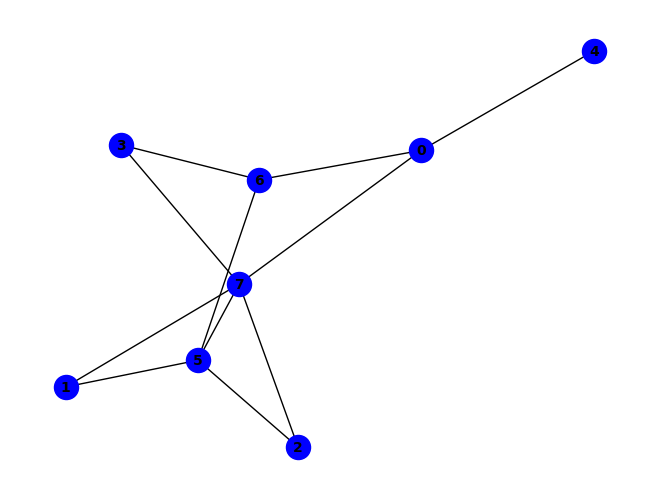


~d ^ (f & h & ~d) ^ (d & ~g & ~h) ^ (a & e & ~g & ~h) ^ (a & g & ~d & ~f) ^ (f & g & ~d & ~h) ^ (a & b & c & f & ~g) ^ (a & b & c & h & ~d) ^ (a & b & c & d & f & h) ^ (a & b & c & f & g & h) ^ (a & b & h & ~d & ~f) ^ (a & h & ~d & ~f & ~g) ^ (b & f & ~a & ~g & ~h) ^ (b & h & ~c & ~d & ~f) ^ (c & f & ~b & ~g & ~h) ^ (c & h & ~a & ~d & ~f) ^ (a & c & e & f & ~g & ~h) ^ (a & b & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


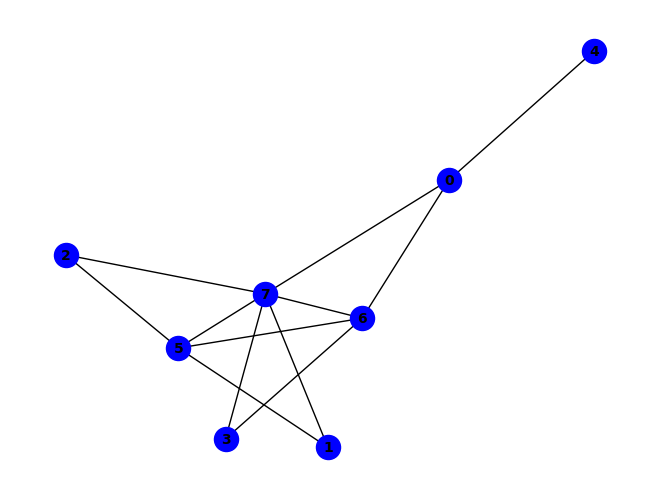


(~a & ~g) ^ (c & g & ~d) ^ (c & h & ~d) ^ (f & g & ~a) ^ (f & h & ~a) ^ (a & b & e & g) ^ (g & ~c & ~h) ^ (a & b & h & ~d) ^ (a & g & ~b & ~h) ^ (b & f & ~a & ~g) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (a & b & g & h & ~e) ^ (a & c & d & g & ~f) ^ (a & c & d & h & ~f) ^ (c & d & f & h & ~g) ^ (a & b & f & ~e & ~h) ^ (a & c & h & ~b & ~g) ^ (c & d & g & ~a & ~h) ^ (a & b & c & d & h & ~g) ^ (a & b & d & f & h & ~c) ^ (a & b & d & g & h & ~f) ^ (a & c & d & f & g & ~h) ^ (a & b & c & d & f & g & h) ^ (b & h & ~c & ~d & ~g) ^ (c & f & ~a & ~b & ~g) ^ (b & d & f & h & ~c & ~g) ^ (a & ~c & ~e & ~g & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & b & c & f & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


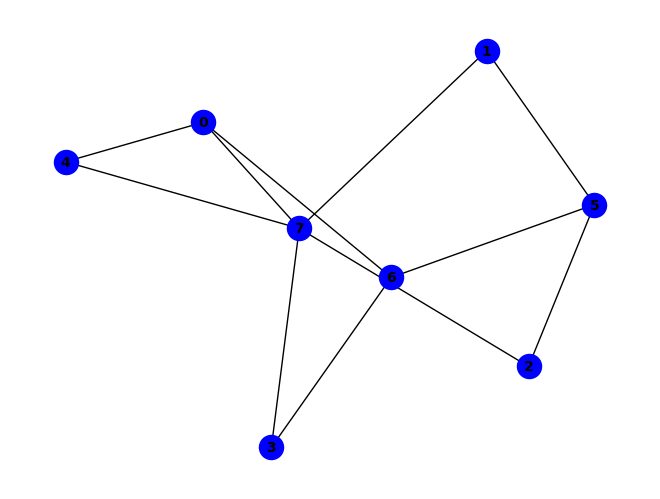


(a & f & g) ^ (~c & ~f) ^ (a & h & ~d) ^ (d & g & ~h) ^ (d & h & ~e) ^ (a & e & f & h) ^ (a & e & g & h) ^ (c & ~f & ~h) ^ (d & f & g & ~a) ^ (d & e & f & g & h) ^ (a & e & ~f & ~g) ^ (a & g & ~d & ~h) ^ (e & h & ~c & ~f) ^ (a & e & f & ~g & ~h) ^ (c & d & h & ~e & ~f) ^ (a & d & e & f & h & ~g) ^ (a & c & d & h & ~b & ~f) ^ (a & c & e & f & ~d & ~g) ^ (a & c & f & h & ~d & ~g) ^ (a & d & e & h & ~c & ~f) ^ (c & d & f & h & ~e & ~g) ^ (a & b & c & d & e & h & ~f) ^ (f & ~b & ~c & ~e & ~g) ^ (a & b & h & ~d & ~e & ~f) ^ (a & c & h & ~b & ~e & ~f) ^ (a & c & d & e & f & ~g & ~h) ^ (b & h & ~c & ~d & ~e & ~f) ^ (e & f & ~b & ~c & ~g & ~h) ^ (a & b & e & f & ~c & ~d & ~g) ^ (a & b & f & h & ~c & ~d & ~g) ^ (b & d & f & h & ~c & ~e & ~g) ^ (a & b & d & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


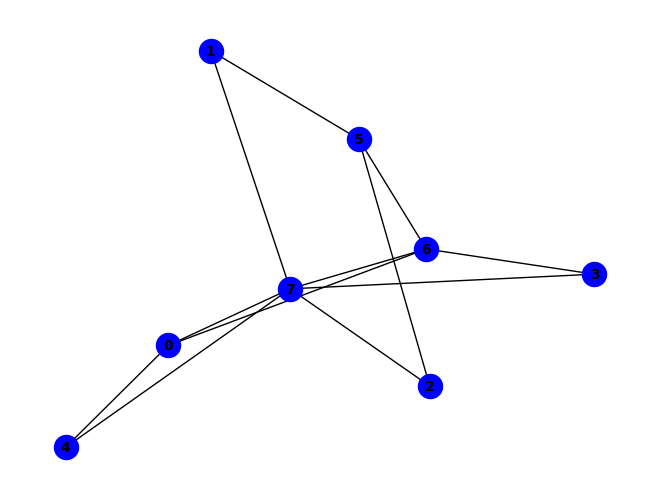


(g & ~h) ^ (~f & ~g) ^ (a & e & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (d & g & ~e) ^ (d & h & ~e) ^ (f & h & ~g) ^ (f & ~d & ~h) ^ (c & f & ~g & ~h) ^ (c & h & ~d & ~g) ^ (d & f & ~g & ~h) ^ (e & h & ~c & ~g) ^ (a & c & d & h & ~g) ^ (c & d & e & g & ~b) ^ (c & d & e & h & ~b) ^ (a & f & g & ~d & ~h) ^ (b & c & h & ~e & ~g) ^ (d & e & g & ~c & ~h) ^ (b & c & d & e & g & ~h) ^ (b & f & ~c & ~g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & d & e & h & ~c & ~g) ^ (b & c & d & h & ~a & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & c & h & ~b & ~e & ~g) ^ (b & h & ~a & ~d & ~e & ~g) ^ (a & b & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


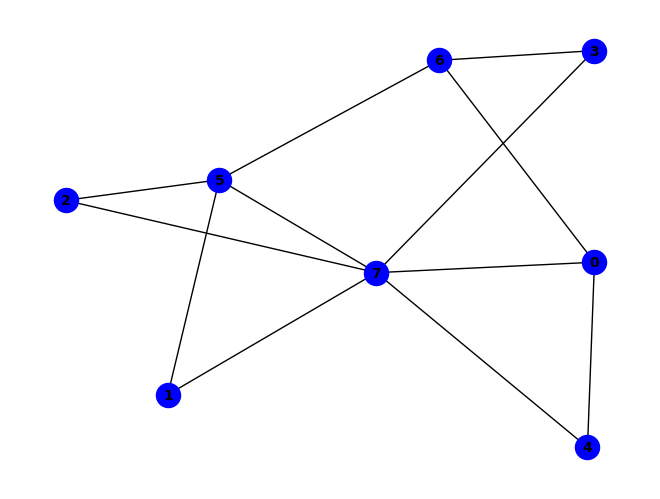


~e ^ (a & e & ~g) ^ (d & e & ~f) ^ (f & h & ~e) ^ (a & e & f & h) ^ (e & ~d & ~h) ^ (a & g & ~d & ~h) ^ (c & f & ~g & ~h) ^ (d & g & ~f & ~h) ^ (d & h & ~c & ~f) ^ (f & g & ~a & ~h) ^ (a & c & e & g & ~b) ^ (a & d & f & g & ~h) ^ (a & e & g & h & ~c) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (a & b & c & e & g & h) ^ (a & c & e & ~b & ~h) ^ (a & c & e & ~f & ~g) ^ (d & e & f & ~c & ~h) ^ (a & c & e & g & h & ~f) ^ (b & c & d & e & f & ~h) ^ (a & h & ~c & ~d & ~f) ^ (b & f & ~c & ~g & ~h) ^ (c & h & ~b & ~e & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & d & e & h & ~c & ~f) ^ (b & c & d & h & ~a & ~f) ^ (a & b & c & d & e & h & ~f) ^ (b & h & ~a & ~d & ~e & ~f) ^ (a & b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


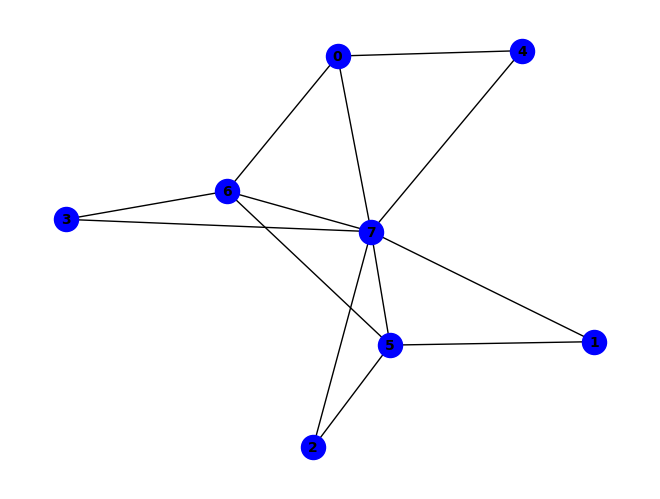


~g ^ (a & e & ~g) ^ (c & f & ~g) ^ (d & g & ~f) ^ (d & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (b & f & ~c & ~g) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (e & h & ~d & ~g) ^ (b & c & e & h & ~f) ^ (b & e & f & h & ~g) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & c & h & ~d & ~g) ^ (c & e & g & ~b & ~h) ^ (e & f & g & ~d & ~h) ^ (b & c & d & f & h & ~g) ^ (c & d & e & f & g & ~h) ^ (b & h & ~a & ~e & ~g) ^ (a & b & c & e & ~f & ~h) ^ (a & b & c & e & ~g & ~h) ^ (a & b & c & h & ~e & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & b & f & h & ~e & ~g) ^ (a & c & e & f & ~g & ~h) ^ (a & c & f & g & ~b & ~e) ^ (a & c & f & h & ~b & ~e) ^ (a & d & e & h & ~c & ~g) ^ (a & e & f & h & ~d & ~g) ^ (b & c & e & g & ~a & ~f) ^ (c & d & e & h & ~b & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & c & e & g & h & ~f) ^ (a & c & d & e & f & h & ~g) ^ (b & c & d & e & f & g & ~a) ^ (b & c & d & e & f & h & ~a) ^ (a & c & g 

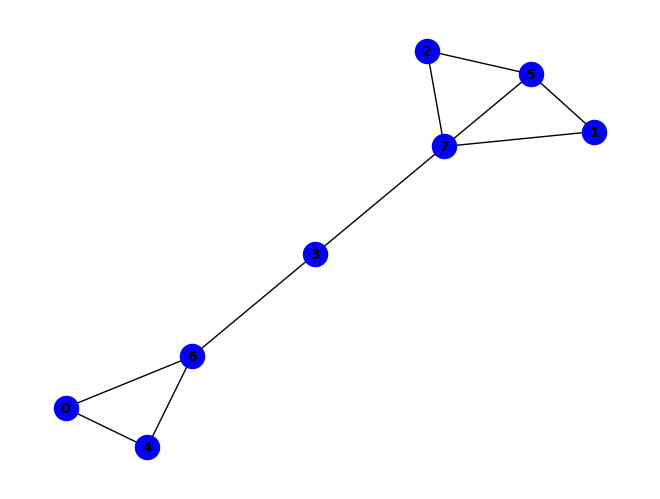


~f ^ (f & ~h) ^ (a & e & ~f) ^ (a & g & ~d) ^ (c & f & ~e) ^ (d & g & ~h) ^ (e & g & ~d) ^ (a & d & e & g) ^ (a & e & f & ~h) ^ (a & d & e & f & h) ^ (b & c & d & f & g) ^ (c & d & e & g & h) ^ (b & f & ~c & ~e) ^ (b & h & ~d & ~e) ^ (c & h & ~b & ~e) ^ (d & h & ~c & ~f) ^ (a & b & f & g & ~d) ^ (a & c & e & f & ~d) ^ (a & c & e & h & ~d) ^ (a & c & g & h & ~d) ^ (a & d & e & h & ~g) ^ (a & f & g & h & ~d) ^ (b & c & d & h & ~e) ^ (b & d & f & g & ~e) ^ (c & d & e & f & ~b) ^ (c & d & f & g & ~h) ^ (e & f & g & h & ~d) ^ (b & e & f & ~c & ~g) ^ (b & e & h & ~d & ~g) ^ (c & e & f & ~d & ~g) ^ (c & e & h & ~b & ~g) ^ (b & c & d & e & h & ~g) ^ (a & b & e & f & ~c & ~d) ^ (a & b & e & h & ~c & ~d) ^ (a & b & g & h & ~c & ~d) ^ (a & c & f & g & ~b & ~d) ^ (b & d & f & h & ~c & ~g) ^ (a & b & d & e & f & ~g & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (b & c & d & e & f & ~a & ~g) ^ (a & b & c & d & e & f & h & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


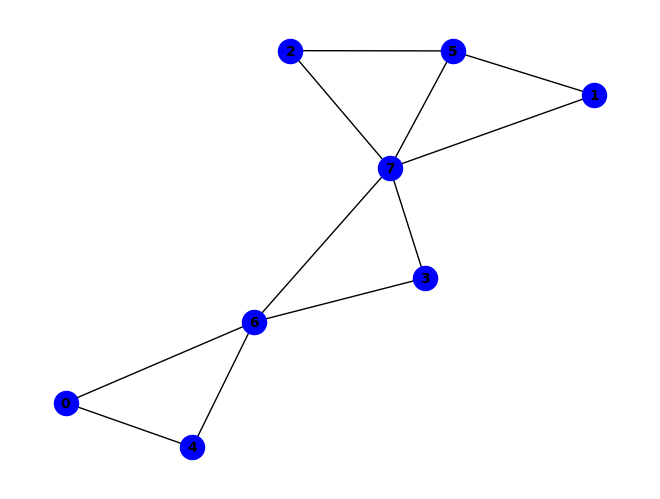


(g & ~h) ^ (~e & ~g) ^ (a & e & ~g) ^ (e & h & ~g) ^ (e & ~d & ~h) ^ (a & c & f & ~g) ^ (a & c & h & ~g) ^ (d & f & g & ~h) ^ (c & f & ~d & ~h) ^ (d & e & ~g & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (f & h & ~a & ~g) ^ (a & b & f & ~c & ~g) ^ (a & b & h & ~c & ~g) ^ (a & c & f & ~e & ~h) ^ (a & f & h & ~e & ~g) ^ (c & d & f & ~g & ~h) ^ (c & d & g & ~f & ~h) ^ (a & g & ~d & ~e & ~h) ^ (b & f & ~c & ~d & ~h) ^ (b & h & ~d & ~f & ~g) ^ (c & h & ~b & ~f & ~g) ^ (b & c & d & h & ~f & ~g) ^ (c & e & f & g & ~d & ~h) ^ (a & b & f & ~c & ~e & ~h) ^ (a & c & h & ~e & ~f & ~g) ^ (b & d & f & ~c & ~g & ~h) ^ (a & c & d & f & g & ~e & ~h) ^ (b & e & f & g & ~c & ~d & ~h) ^ (a & b & h & ~c & ~e & ~f & ~g) ^ (a & b & d & f & g & ~c & ~e & ~h) ^ (a & d & e & h & ~b & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


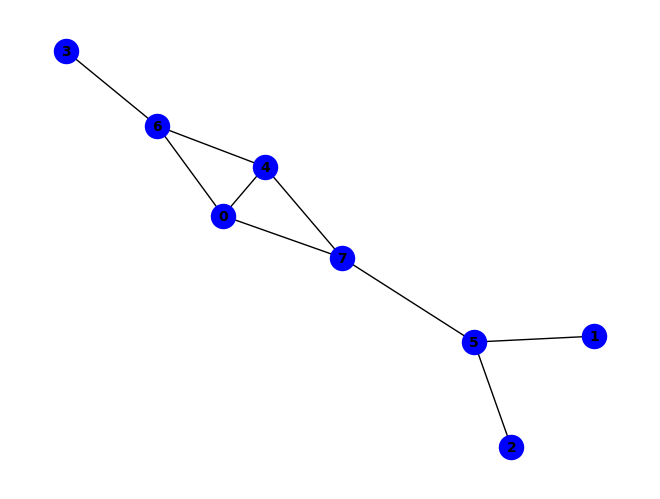


(~c & ~f) ^ (e & h & ~f) ^ (c & ~e & ~h) ^ (f & ~b & ~h) ^ (a & c & g & ~f) ^ (b & c & f & ~h) ^ (c & e & g & ~f) ^ (a & e & ~c & ~f) ^ (a & g & ~c & ~h) ^ (a & h & ~c & ~f) ^ (c & e & ~g & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~a & ~e) ^ (e & g & ~b & ~h) ^ (a & c & e & h & ~f) ^ (a & c & e & ~d & ~h) ^ (a & e & f & ~b & ~h) ^ (c & e & h & ~f & ~g) ^ (a & b & c & e & f & ~h) ^ (a & b & c & f & g & ~h) ^ (b & c & d & f & g & ~h) ^ (a & b & f & g & ~d & ~h) ^ (a & c & d & e & ~g & ~h) ^ (a & c & d & g & ~b & ~h) ^ (b & c & e & g & ~d & ~h) ^ (b & d & f & g & ~e & ~h) ^ (c & d & f & g & ~e & ~h) ^ (d & f & g & h & ~a & ~e) ^ (a & c & d & ~e & ~f & ~g) ^ (a & c & d & ~e & ~f & ~h) ^ (a & c & h & ~d & ~f & ~g) ^ (b & e & g & ~c & ~f & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & c & d & e & h & ~f & ~g) ^ (b & c & d & e & g & ~f & ~h) ^ (a & b & d & e & f & g & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


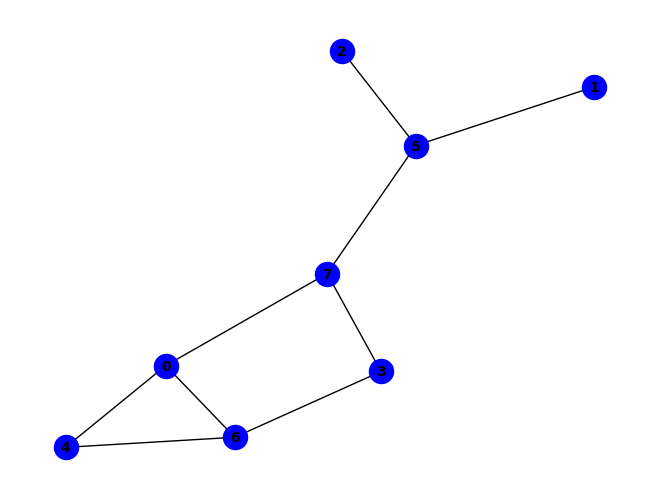


(~c & ~f) ^ (a & g & ~e) ^ (a & h & ~g) ^ (c & h & ~f) ^ (e & g & ~d) ^ (a & d & e & g) ^ (c & ~e & ~h) ^ (f & ~b & ~h) ^ (a & f & h & ~e) ^ (b & c & f & ~h) ^ (a & d & e & f & h) ^ (d & h & ~a & ~f) ^ (a & b & e & f & ~h) ^ (e & f & g & h & ~d) ^ (a & e & f & ~d & ~g) ^ (c & e & f & ~g & ~h) ^ (a & e & ~f & ~g & ~h) ^ (c & e & ~d & ~f & ~h) ^ (d & g & ~a & ~c & ~h) ^ (a & b & f & g & ~d & ~h) ^ (a & c & e & f & ~b & ~h) ^ (a & c & f & g & ~b & ~h) ^ (a & d & e & f & ~g & ~h) ^ (b & d & f & g & ~e & ~h) ^ (b & e & f & g & ~c & ~h) ^ (c & d & e & g & ~b & ~h) ^ (a & b & d & e & f & g & ~h) ^ (c & d & e & ~f & ~g & ~h) ^ (c & d & g & ~a & ~f & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (b & c & d & f & g & ~a & ~h) ^ (a & c & d & e & f & g & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


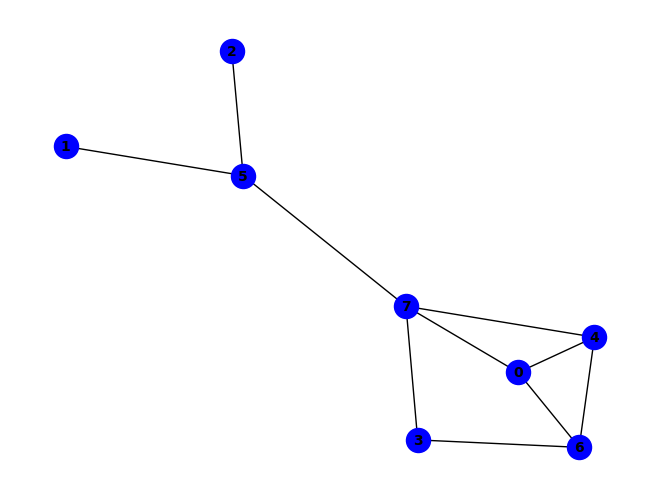


(~c & ~f) ^ (c & h & ~f) ^ (a & d & e & f) ^ (a & d & f & h) ^ (c & ~e & ~h) ^ (f & ~b & ~h) ^ (a & c & g & ~f) ^ (a & d & g & ~e) ^ (b & c & f & ~h) ^ (b & e & g & ~f) ^ (a & e & ~c & ~f) ^ (a & g & ~c & ~h) ^ (a & h & ~c & ~f) ^ (d & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (e & g & ~b & ~h) ^ (e & h & ~b & ~f) ^ (a & b & e & f & ~h) ^ (a & c & h & ~f & ~g) ^ (a & d & h & ~e & ~g) ^ (a & e & f & ~d & ~h) ^ (b & e & h & ~f & ~g) ^ (c & e & f & ~g & ~h) ^ (a & c & d & f & g & ~h) ^ (b & c & e & f & g & ~h) ^ (c & e & ~d & ~f & ~h) ^ (a & b & c & e & ~d & ~f) ^ (a & c & e & h & ~b & ~f) ^ (b & d & f & g & ~e & ~h) ^ (c & d & e & g & ~b & ~h) ^ (c & d & f & g & ~b & ~h) ^ (a & b & d & e & f & g & ~h) ^ (a & c & e & ~b & ~d & ~h) ^ (c & d & e & ~f & ~g & ~h) ^ (a & b & c & d & e & ~f & ~g) ^ (a & c & d & e & g & ~f & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (a & b & c & d & e & g & h & ~f) ^ (a & b & f & g & ~c & ~d & ~h) ^ (a & c & d & e & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

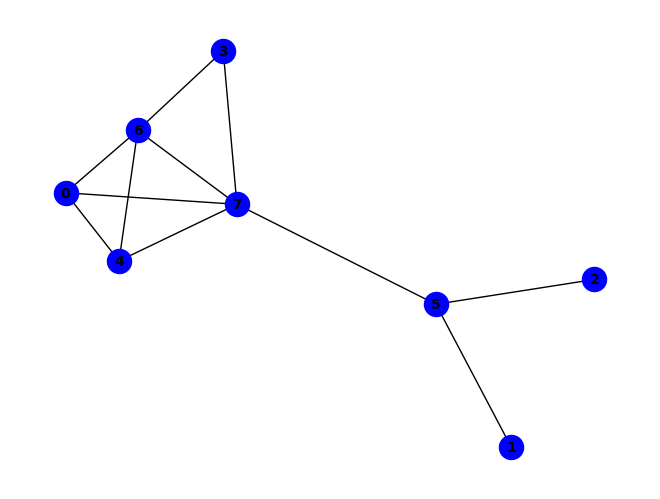


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~h) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (c & f & ~b & ~h) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (a & c & e & f & ~h) ^ (a & d & e & g & ~f) ^ (a & d & e & h & ~f) ^ (a & e & f & h & ~g) ^ (a & b & e & f & ~c & ~h) ^ (e & f & g & ~b & ~c & ~h) ^ (a & f & g & ~b & ~c & ~d & ~h) ^ (d & f & g & ~b & ~c & ~e & ~h) ^ (a & d & e & f & g & ~b & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


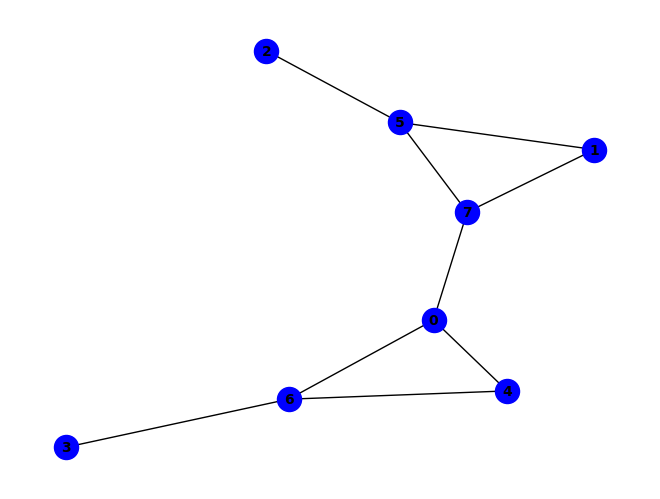


(f & ~h) ^ (~c & ~f) ^ (b & f & ~e) ^ (b & h & ~e) ^ (e & g & ~a) ^ (c & ~e & ~h) ^ (b & c & f & ~h) ^ (b & e & f & ~g) ^ (b & e & h & ~g) ^ (c & e & g & ~f) ^ (a & e & ~g & ~h) ^ (a & g & ~c & ~h) ^ (a & h & ~b & ~f) ^ (c & e & ~g & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~a & ~e) ^ (a & b & e & f & ~h) ^ (e & f & g & h & ~a) ^ (a & c & g & ~f & ~h) ^ (c & e & h & ~f & ~g) ^ (a & b & e & g & h & ~f) ^ (b & c & e & f & g & ~h) ^ (a & b & f & g & ~c & ~h) ^ (a & c & e & f & ~b & ~h) ^ (b & d & f & g & ~a & ~e) ^ (b & d & g & h & ~a & ~e) ^ (d & f & g & h & ~a & ~e) ^ (c & d & f & g & ~a & ~b & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


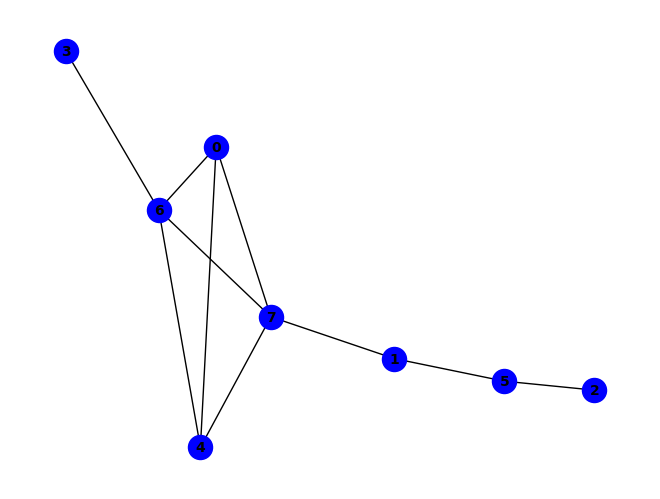


(a & d & g) ^ (a & e & ~d) ^ (a & g & ~e) ^ (d & ~e & ~h) ^ (a & b & g & ~d) ^ (b & d & f & ~h) ^ (a & d & e & g & h) ^ (~b & ~d & ~g) ^ (a & h & ~b & ~d) ^ (c & f & ~b & ~g) ^ (d & h & ~e & ~g) ^ (e & g & ~b & ~c) ^ (e & h & ~b & ~c) ^ (a & c & f & g & ~b) ^ (a & c & f & h & ~b) ^ (b & d & f & h & ~g) ^ (b & ~e & ~f & ~h) ^ (g & ~b & ~c & ~h) ^ (a & b & e & ~d & ~g) ^ (a & b & e & ~f & ~h) ^ (a & d & h & ~b & ~g) ^ (c & d & g & ~b & ~h) ^ (c & e & g & ~b & ~f) ^ (c & e & h & ~b & ~f) ^ (a & b & d & e & f & ~h) ^ (b & d & ~e & ~f & ~g) ^ (b & e & ~f & ~g & ~h) ^ (d & e & ~a & ~c & ~g) ^ (a & c & e & f & ~b & ~g) ^ (b & d & e & g & ~c & ~h) ^ (b & d & e & h & ~f & ~g) ^ (c & d & e & f & ~a & ~h) ^ (c & d & e & h & ~a & ~g) ^ (a & b & c & d & e & g & ~h) ^ (a & b & d & e & f & h & ~g) ^ (a & b & g & ~d & ~f & ~h) ^ (a & e & g & ~b & ~c & ~h) ^ (b & d & e & ~c & ~f & ~h) ^ (a & b & c & d & e & ~f & ~h) ^ (a & c & d & f & g & ~b & ~h) ^ (c & g & ~b & ~d & ~f & ~h) ^ (a & b & d & e & ~c & 

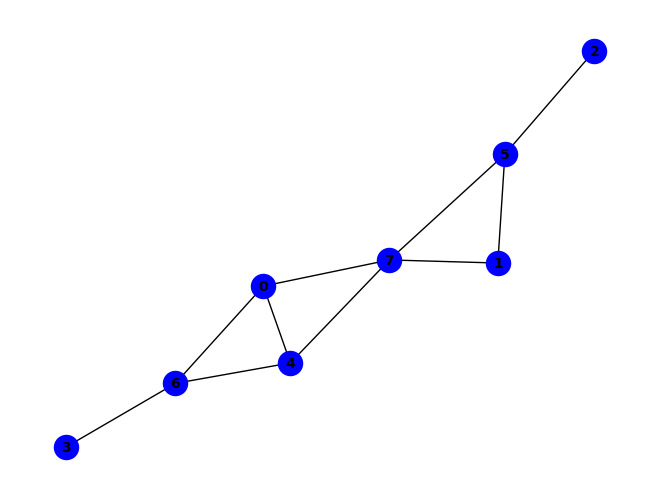


(f & ~h) ^ (~c & ~f) ^ (b & f & ~e) ^ (b & h & ~d) ^ (e & g & ~h) ^ (b & e & f & h) ^ (c & ~e & ~h) ^ (a & e & f & ~h) ^ (c & e & g & ~f) ^ (a & b & d & f & g) ^ (a & b & d & g & h) ^ (b & d & e & g & h) ^ (a & e & ~c & ~f) ^ (a & g & ~c & ~h) ^ (a & h & ~b & ~f) ^ (c & e & ~g & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~a & ~e) ^ (e & h & ~b & ~f) ^ (a & b & e & f & ~d) ^ (a & b & e & h & ~d) ^ (a & c & e & h & ~f) ^ (b & c & d & f & ~g) ^ (b & d & f & g & ~e) ^ (a & c & e & ~d & ~h) ^ (a & c & g & ~f & ~h) ^ (b & c & f & ~d & ~h) ^ (b & d & h & ~c & ~g) ^ (b & e & f & ~g & ~h) ^ (c & e & h & ~f & ~g) ^ (a & b & c & e & f & ~h) ^ (a & b & d & e & f & ~g) ^ (a & b & d & e & h & ~g) ^ (a & b & f & g & ~c & ~h) ^ (b & c & d & h & ~f & ~g) ^ (c & d & f & g & ~e & ~h) ^ (d & f & g & h & ~a & ~e) ^ (a & b & c & d & e & g & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (a & c & d & f & g & ~b & ~h) ^ (b & c & e & f & g & ~d & ~h) ^ (a & c & d & e & ~b & ~f & ~h) ^ (a & b & c & d & e & ~f & ~g & ~h)
PASS
P

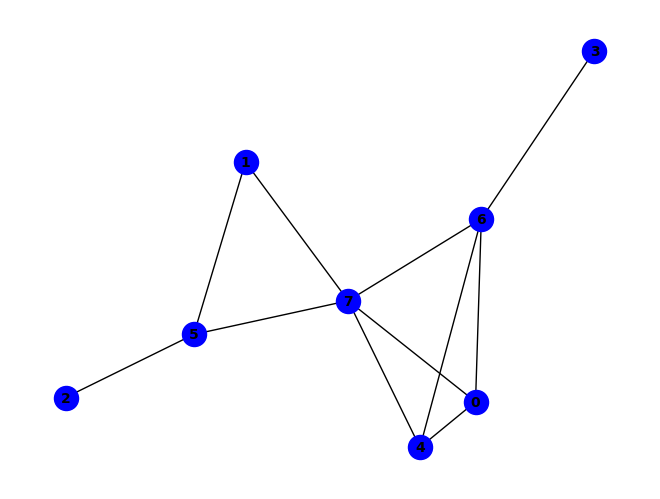


(g & ~h) ^ (~d & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~e & ~h) ^ (a & e & g & ~h) ^ (a & e & ~d & ~g) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (b & f & ~e & ~h) ^ (b & h & ~f & ~g) ^ (c & f & ~b & ~h) ^ (d & e & ~g & ~h) ^ (e & g & ~b & ~f) ^ (e & h & ~b & ~f) ^ (a & c & e & f & ~h) ^ (a & d & e & h & ~g) ^ (a & e & f & h & ~g) ^ (a & b & g & ~d & ~h) ^ (a & d & e & ~c & ~h) ^ (a & d & g & ~c & ~h) ^ (a & f & g & ~c & ~h) ^ (b & e & f & ~g & ~h) ^ (e & f & g & ~c & ~h) ^ (b & c & d & f & g & ~h) ^ (a & b & d & g & ~f & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & b & e & h & ~f & ~g) ^ (a & c & d & e & ~g & ~h) ^ (b & c & e & g & ~d & ~h) ^ (b & d & f & g & ~e & ~h) ^ (c & d & f & g & ~e & ~h) ^ (b & e & g & ~c & ~f & ~h) ^ (a & b & c & f & g & ~d & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (a & c & d & g & ~e & ~f & ~h) ^ (a & b & d & e & f & g & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


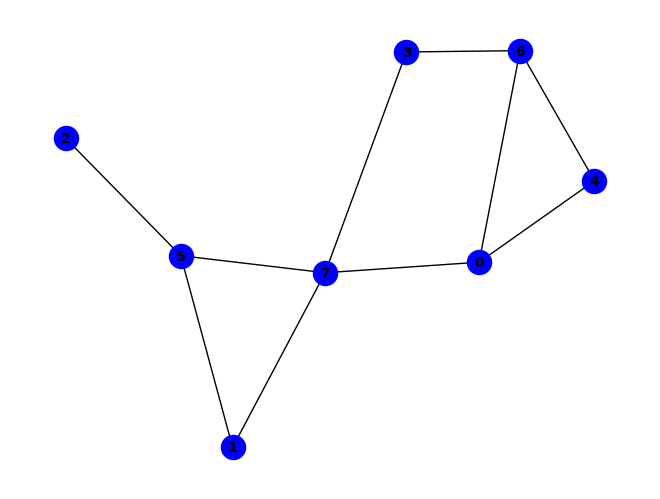


(f & ~h) ^ (~c & ~f) ^ (a & g & ~e) ^ (b & f & ~e) ^ (b & h & ~e) ^ (c & h & ~f) ^ (e & g & ~d) ^ (a & d & e & g) ^ (c & ~e & ~h) ^ (a & c & f & ~g) ^ (a & f & h & ~e) ^ (b & c & f & ~h) ^ (b & e & h & ~g) ^ (a & b & d & f & g) ^ (a & d & e & f & h) ^ (b & d & e & g & h) ^ (a & h & ~c & ~g) ^ (d & h & ~b & ~f) ^ (a & b & d & h & ~e) ^ (a & c & d & g & ~f) ^ (b & d & e & f & ~a) ^ (e & f & g & h & ~d) ^ (a & b & h & ~e & ~f) ^ (a & c & f & ~e & ~h) ^ (a & d & h & ~c & ~f) ^ (a & e & f & ~d & ~g) ^ (b & e & f & ~d & ~g) ^ (c & d & g & ~f & ~h) ^ (c & e & f & ~g & ~h) ^ (a & b & d & f & h & ~g) ^ (b & c & e & f & g & ~h) ^ (a & e & ~f & ~g & ~h) ^ (c & e & ~d & ~f & ~h) ^ (d & g & ~a & ~c & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & b & e & h & ~f & ~g) ^ (a & b & f & g & ~c & ~h) ^ (a & d & e & f & ~g & ~h) ^ (b & d & f & g & ~c & ~h) ^ (c & d & e & g & ~b & ~h) ^ (a & b & c & d & e & f & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & c & d & e & f & g & ~h) ^ (a & c & h & ~d & ~f & ~g) ^ (c & d

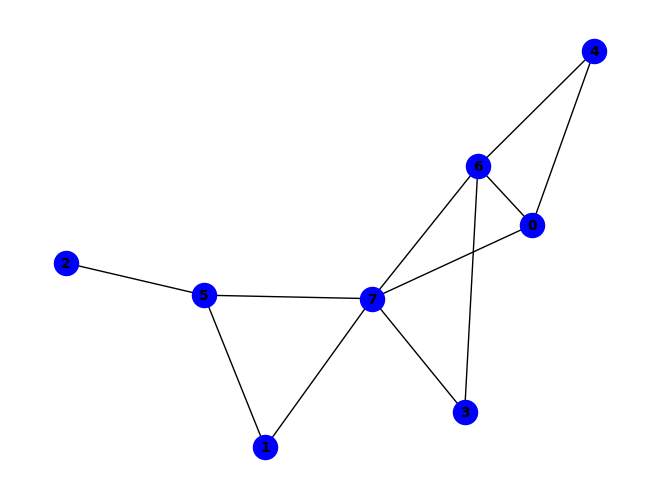


(g & ~h) ^ (~e & ~g) ^ (e & h & ~g) ^ (f & h & ~g) ^ (d & f & g & ~h) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (b & f & ~d & ~h) ^ (c & f & ~b & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & b & d & f & ~h) ^ (c & d & e & f & ~h) ^ (e & ~a & ~d & ~h) ^ (a & b & f & ~d & ~g) ^ (a & b & f & ~e & ~h) ^ (a & b & h & ~d & ~g) ^ (a & d & e & ~g & ~h) ^ (b & d & f & ~g & ~h) ^ (c & d & g & ~b & ~h) ^ (c & d & h & ~f & ~g) ^ (b & c & d & e & g & ~h) ^ (b & h & ~d & ~f & ~g) ^ (d & e & ~c & ~g & ~h) ^ (a & c & e & f & ~b & ~h) ^ (b & e & f & g & ~d & ~h) ^ (c & e & f & g & ~b & ~h) ^ (a & b & d & e & f & g & ~h) ^ (a & f & g & ~c & ~d & ~h) ^ (a & b & c & f & g & ~d & ~h) ^ (a & c & d & e & g & ~b & ~h) ^ (a & c & d & e & ~b & ~f & ~h) ^ (b & c & d & g & ~e & ~f & ~h) ^ (c & d & e & ~a & ~f & ~g & ~h) ^ (a & b & c & d & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

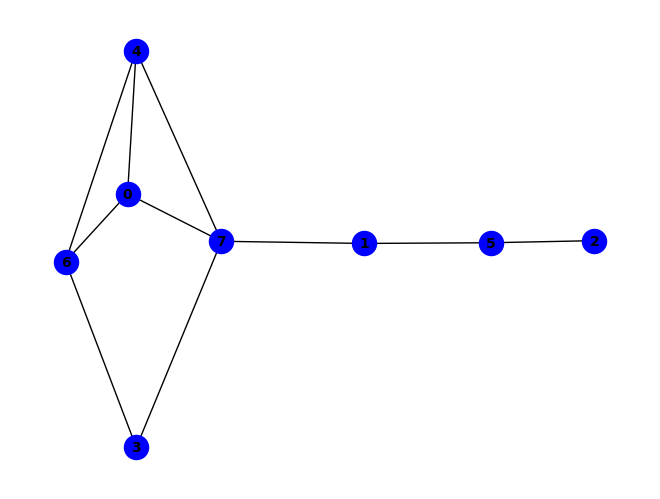


~d ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & f & ~h) ^ (e & h & ~d) ^ (d & ~g & ~h) ^ (c & d & e & f & g) ^ (a & g & ~d & ~h) ^ (b & h & ~a & ~e) ^ (c & f & ~b & ~e) ^ (e & g & ~d & ~h) ^ (a & b & d & h & ~e) ^ (a & b & e & f & ~h) ^ (a & c & e & f & ~b) ^ (a & c & f & g & ~b) ^ (b & d & e & h & ~c) ^ (b & d & f & h & ~c) ^ (b & e & f & g & ~h) ^ (c & d & f & h & ~a) ^ (a & c & d & e & f & h) ^ (a & d & e & ~g & ~h) ^ (b & d & g & ~c & ~f) ^ (b & d & h & ~f & ~g) ^ (b & c & d & e & h & ~f) ^ (c & d & e & f & h & ~g) ^ (a & b & f & g & ~d & ~h) ^ (a & c & f & h & ~b & ~g) ^ (c & d & f & g & ~a & ~h) ^ (a & b & c & d & f & h & ~e) ^ (a & b & d & e & f & g & ~h) ^ (a & c & d & e & f & g & ~h) ^ (b & d & g & ~c & ~e & ~h) ^ (c & e & f & ~b & ~g & ~h) ^ (a & b & c & d & g & ~e & ~f) ^ (a & b & c & d & g & ~e & ~h) ^ (b & c & d & g & h & ~a & ~f) ^ (a & b & c & d & e & g & h & ~f) ^ (b & d & e & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

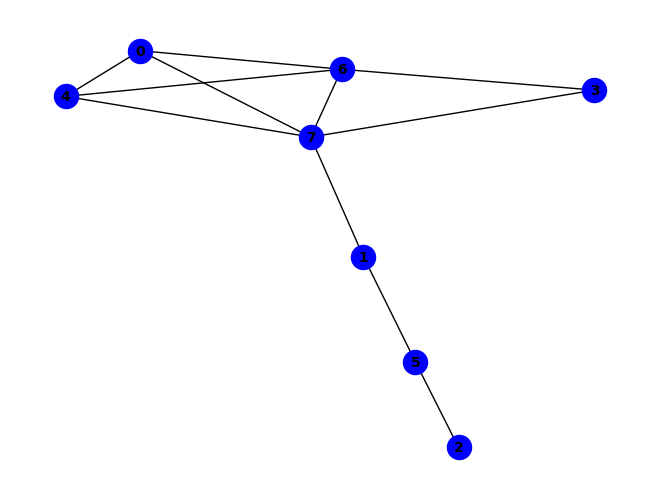


(a & g & ~d) ^ (d & h & ~e) ^ (e & h & ~c) ^ (a & b & e & f) ^ (b & d & h & ~c) ^ (b & e & h & ~d) ^ (b & c & e & f & h) ^ (~b & ~c & ~g) ^ (a & e & ~c & ~g) ^ (a & h & ~b & ~d) ^ (d & g & ~b & ~e) ^ (e & g & ~b & ~c) ^ (a & b & e & h & ~f) ^ (a & c & f & h & ~b) ^ (a & d & e & g & ~c) ^ (a & d & e & h & ~c) ^ (c & d & e & h & ~b) ^ (c & d & f & h & ~a) ^ (a & b & c & d & f & h) ^ (b & ~e & ~f & ~h) ^ (c & ~b & ~f & ~g) ^ (g & ~b & ~c & ~h) ^ (a & b & g & ~d & ~e) ^ (a & c & e & ~f & ~g) ^ (c & e & g & ~b & ~f) ^ (c & e & h & ~d & ~f) ^ (a & b & c & e & f & ~g) ^ (a & b & d & e & g & ~f) ^ (a & c & d & e & g & ~f) ^ (a & c & d & e & h & ~f) ^ (a & b & c & d & e & f & g) ^ (b & e & ~f & ~g & ~h) ^ (c & g & ~b & ~f & ~h) ^ (a & c & f & g & ~b & ~d) ^ (b & c & d & h & ~e & ~f) ^ (c & d & f & g & ~b & ~e) ^ (a & b & d & e & f & h & ~c) ^ (a & b & g & ~d & ~f & ~h) ^ (a & e & g & ~b & ~c & ~h) ^ (b & d & g & ~e & ~f & ~h) ^ (a & b & d & e & h & ~f & ~g) ^ (a & c & e & g & ~b & ~f & ~h)
PAS

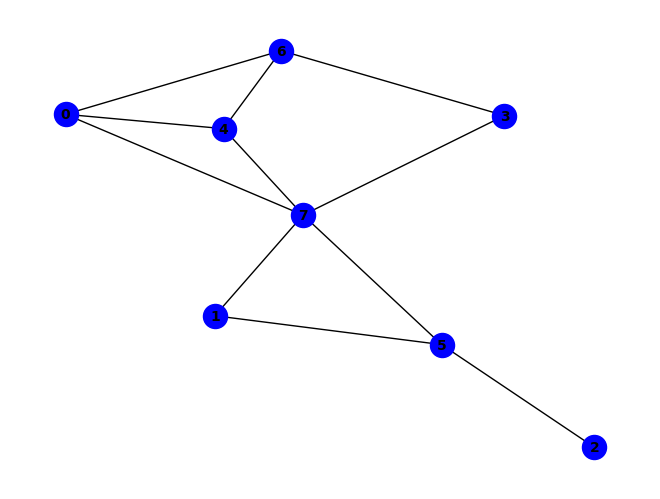


(b & h) ^ (f & ~h) ^ (~c & ~f) ^ (b & f & ~e) ^ (c & h & ~f) ^ (e & g & ~h) ^ (c & ~e & ~h) ^ (a & d & g & ~e) ^ (a & e & f & ~h) ^ (b & c & f & ~h) ^ (a & b & c & e & f) ^ (b & d & e & f & g) ^ (a & e & ~c & ~f) ^ (a & g & ~c & ~h) ^ (a & h & ~b & ~f) ^ (d & g & ~e & ~h) ^ (e & h & ~b & ~f) ^ (a & b & e & f & ~d) ^ (a & b & e & h & ~c) ^ (a & d & f & h & ~e) ^ (b & e & f & h & ~d) ^ (a & b & d & e & f & h) ^ (a & c & e & ~d & ~h) ^ (a & c & g & ~f & ~h) ^ (a & d & h & ~e & ~g) ^ (b & e & f & ~g & ~h) ^ (c & e & f & ~g & ~h) ^ (b & c & e & f & g & ~h) ^ (b & d & e & f & h & ~g) ^ (c & e & ~d & ~f & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & b & d & h & ~e & ~f) ^ (a & c & d & e & ~g & ~h) ^ (a & c & e & h & ~b & ~f) ^ (b & d & f & g & ~c & ~h) ^ (c & d & e & g & ~b & ~h) ^ (c & d & f & g & ~a & ~h) ^ (c & d & e & ~f & ~g & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & b & f & g & ~c & ~d & ~h)
PAS

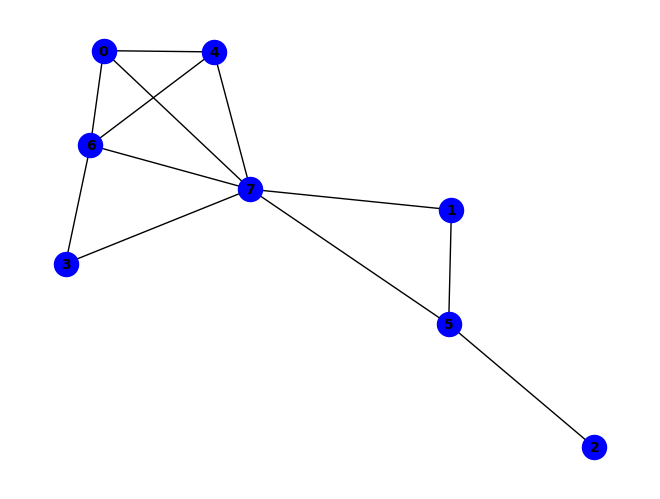


~g ^ (g & ~h) ^ (a & e & ~g) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (b & f & ~e & ~h) ^ (c & f & ~b & ~h) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (e & g & ~b & ~f) ^ (e & h & ~b & ~f) ^ (a & e & f & h & ~g) ^ (b & d & e & f & ~h) ^ (b & d & e & h & ~g) ^ (b & e & f & ~g & ~h) ^ (b & e & g & ~f & ~h) ^ (e & f & g & ~c & ~h) ^ (b & h & ~d & ~f & ~g) ^ (a & b & d & h & ~f & ~g) ^ (a & b & e & f & ~d & ~h) ^ (a & c & e & f & ~b & ~h) ^ (a & d & e & g & ~b & ~f) ^ (a & d & e & h & ~b & ~f) ^ (b & d & e & f & ~a & ~g) ^ (b & d & f & g & ~c & ~h) ^ (a & b & d & e & f & h & ~g) ^ (a & b & h & ~e & ~f & ~g) ^ (d & f & g & ~c & ~e & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & d & e & f & g & ~c & ~h) ^ (b & c & e & f & g & ~d & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & f & g & ~b & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


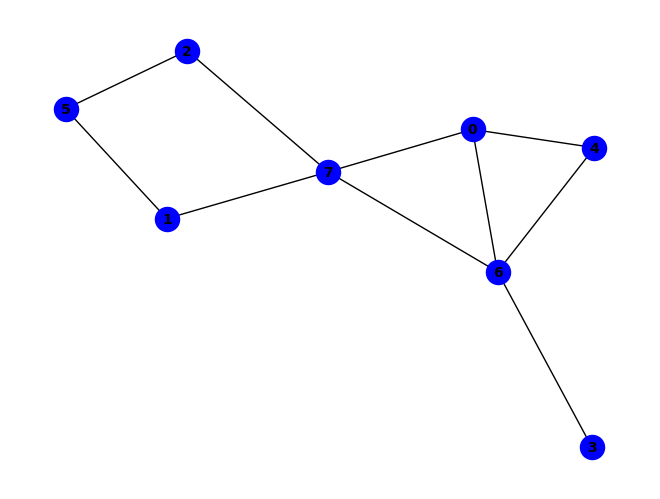


(a & h & ~c) ^ (a & e & ~d & ~h) ^ (a & g & ~b & ~c) ^ (b & e & ~d & ~h) ^ (a & b & e & f & ~c) ^ (b & ~e & ~f & ~h) ^ (c & ~b & ~f & ~h) ^ (e & ~c & ~d & ~h) ^ (a & b & h & ~c & ~e) ^ (a & d & g & ~c & ~h) ^ (a & b & c & e & h & ~f) ^ (a & b & d & e & g & ~f) ^ (~b & ~c & ~e & ~g) ^ (e & h & ~b & ~c & ~g) ^ (a & b & e & h & ~d & ~f) ^ (a & c & e & f & ~d & ~h) ^ (b & c & e & f & ~d & ~h) ^ (g & ~b & ~c & ~d & ~h) ^ (a & b & g & ~c & ~f & ~h) ^ (a & c & g & ~d & ~f & ~h) ^ (a & d & e & ~c & ~g & ~h) ^ (b & d & g & ~e & ~f & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (c & e & g & ~d & ~f & ~h) ^ (a & b & c & d & e & ~f & ~g) ^ (a & b & c & d & e & ~f & ~h) ^ (a & b & d & e & g & ~c & ~h) ^ (a & b & d & f & g & ~c & ~h) ^ (b & e & ~c & ~f & ~g & ~h) ^ (d & e & ~b & ~c & ~g & ~h) ^ (a & c & d & e & ~f & ~g & ~h) ^ (b & c & d & e & ~f & ~g & ~h) ^ (a & b & d & e & h & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

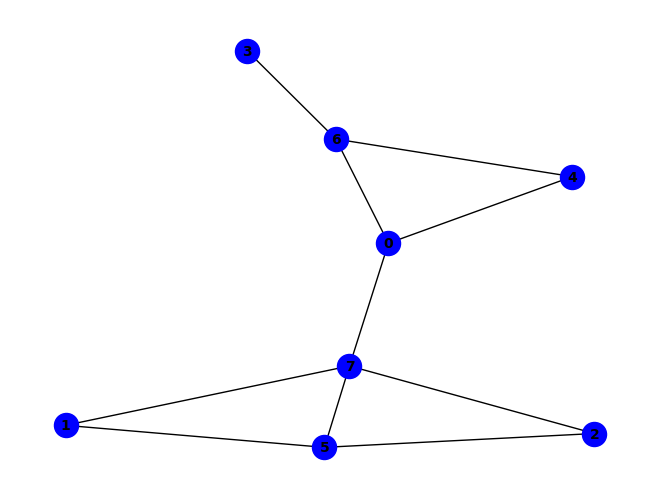


~f ^ (e & g) ^ (f & ~h) ^ (a & g & ~e) ^ (a & h & ~g) ^ (b & h & ~e) ^ (c & f & ~e) ^ (e & f & g & h) ^ (a & f & h & ~e) ^ (c & e & f & ~g) ^ (a & d & e & f & h) ^ (a & d & f & g & h) ^ (b & f & ~c & ~e) ^ (c & h & ~b & ~e) ^ (d & g & ~a & ~e) ^ (a & c & e & f & ~h) ^ (a & c & f & g & ~h) ^ (b & d & g & h & ~e) ^ (c & d & e & h & ~b) ^ (c & d & g & h & ~b) ^ (d & f & g & h & ~e) ^ (a & b & h & ~c & ~d) ^ (a & c & h & ~e & ~f) ^ (a & e & f & ~d & ~g) ^ (b & e & f & ~c & ~g) ^ (b & e & h & ~c & ~g) ^ (c & e & h & ~d & ~g) ^ (a & c & d & g & h & ~e) ^ (b & c & d & e & h & ~g) ^ (a & b & d & h & ~c & ~g) ^ (a & b & e & f & ~c & ~h) ^ (a & b & e & h & ~c & ~f) ^ (a & b & f & g & ~c & ~d) ^ (a & b & f & h & ~c & ~g) ^ (a & c & e & h & ~f & ~g) ^ (a & d & e & f & ~g & ~h) ^ (b & d & f & g & ~c & ~e) ^ (c & d & f & g & ~a & ~e) ^ (a & b & d & e & f & g & ~c) ^ (a & b & d & e & g & h & ~c) ^ (a & b & e & ~c & ~f & ~g) ^ (a & e & ~b & ~f & ~g & ~h) ^ (a & b & c & e & ~f & ~g & ~h)
PASS
PASS
PAS

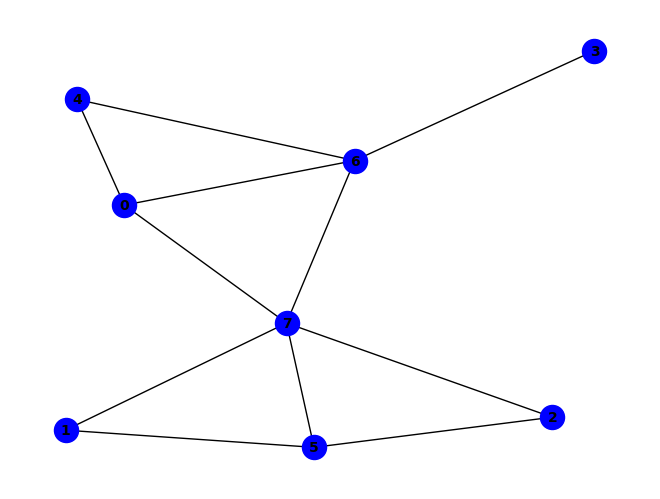


(~e & ~g) ^ (e & h & ~g) ^ (f & h & ~g) ^ (g & ~d & ~h) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & f & ~a & ~h) ^ (c & f & ~b & ~h) ^ (c & h & ~f & ~g) ^ (a & b & c & f & ~h) ^ (a & c & e & f & ~h) ^ (e & ~a & ~d & ~h) ^ (a & d & g & ~c & ~h) ^ (a & f & g & ~c & ~h) ^ (d & e & ~a & ~g & ~h) ^ (a & b & e & f & ~c & ~h) ^ (b & d & f & g & ~c & ~h) ^ (b & e & f & g & ~d & ~h) ^ (c & d & f & g & ~e & ~h) ^ (c & e & f & g & ~b & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & c & d & e & f & g & ~h) ^ (a & b & f & ~c & ~g & ~h) ^ (a & c & g & ~d & ~f & ~h) ^ (a & b & d & f & g & ~e & ~h) ^ (b & h & ~a & ~c & ~f & ~g) ^ (b & c & d & e & f & g & ~a & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


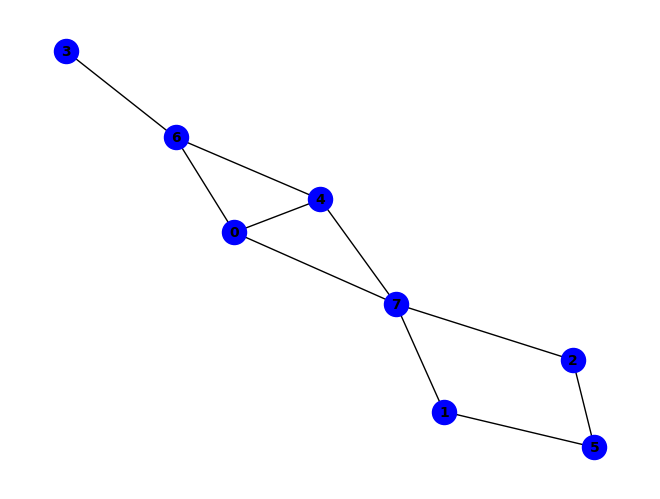


(~c & ~d) ^ (a & h & ~c) ^ (e & h & ~c) ^ (d & ~b & ~g) ^ (a & d & g & ~c) ^ (d & e & g & ~c) ^ (b & c & d & e & h) ^ (b & d & e & g & h) ^ (a & e & ~c & ~d) ^ (a & g & ~b & ~h) ^ (b & f & ~c & ~h) ^ (e & g & ~b & ~h) ^ (b & c & e & g & ~h) ^ (b & d & f & g & ~c) ^ (c & d & e & g & ~h) ^ (c & e & f & g & ~h) ^ (c & ~d & ~f & ~h) ^ (a & b & g & ~f & ~h) ^ (a & d & e & ~b & ~g) ^ (b & c & d & ~e & ~g) ^ (b & d & h & ~c & ~f) ^ (c & d & f & ~e & ~g) ^ (c & d & h & ~f & ~g) ^ (a & b & d & e & h & ~c) ^ (a & b & d & g & h & ~c) ^ (b & d & e & f & g & ~h) ^ (c & d & e & f & h & ~g) ^ (b & d & ~c & ~g & ~h) ^ (b & h & ~a & ~c & ~e) ^ (a & c & d & g & ~f & ~h) ^ (a & c & f & g & ~b & ~h) ^ (b & d & f & h & ~c & ~g) ^ (c & d & e & f & ~b & ~h) ^ (a & c & e & ~d & ~f & ~h) ^ (b & e & g & ~c & ~f & ~h) ^ (a & b & d & f & g & ~c & ~h) ^ (a & c & d & e & h & ~b & ~g) ^ (a & b & d & e & ~f & ~g & ~h) ^ (a & b & e & f & ~c & ~d & ~h) ^ (b & c & d & e & ~f & ~g & ~h) ^ (a & c & d & e & f & ~b & ~g & 

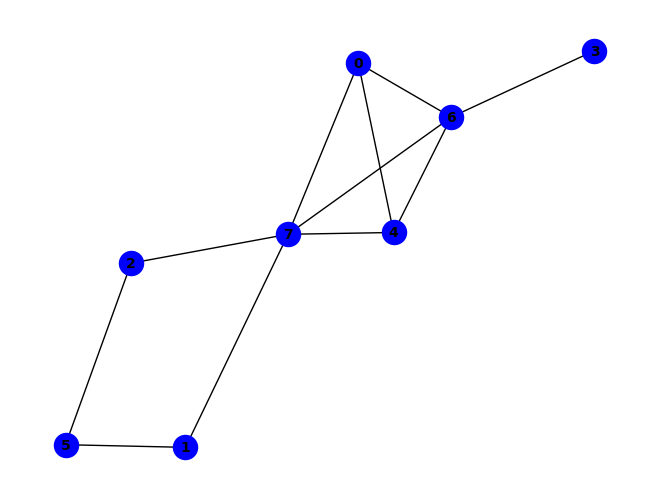


(a & g & ~c) ^ (e & g & ~c) ^ (e & h & ~c) ^ (a & b & c & g) ^ (a & b & e & f) ^ (b & c & e & g) ^ (b & c & e & h) ^ (d & ~e & ~h) ^ (a & b & g & ~e) ^ (b & e & g & ~d) ^ (b & e & h & ~d) ^ (a & h & ~b & ~c) ^ (d & e & ~c & ~g) ^ (b & c & d & h & ~g) ^ (c & ~e & ~f & ~h) ^ (g & ~b & ~c & ~h) ^ (a & d & e & ~c & ~h) ^ (a & d & g & ~c & ~h) ^ (a & e & g & ~c & ~h) ^ (b & d & f & ~c & ~h) ^ (b & d & h & ~e & ~g) ^ (c & d & f & ~e & ~h) ^ (a & b & c & d & e & ~h) ^ (a & b & c & e & g & ~h) ^ (a & b & d & e & g & ~f) ^ (b & c & d & e & g & ~h) ^ (~b & ~c & ~d & ~g) ^ (a & e & ~c & ~d & ~g) ^ (b & d & ~f & ~g & ~h) ^ (d & h & ~c & ~e & ~g) ^ (a & b & c & e & ~d & ~g) ^ (a & b & e & g & ~d & ~h) ^ (a & b & e & h & ~d & ~f) ^ (a & d & e & h & ~c & ~g) ^ (a & b & c & d & e & h & ~g) ^ (b & ~c & ~e & ~f & ~h) ^ (a & b & g & ~c & ~f & ~h) ^ (a & c & g & ~d & ~f & ~h) ^ (a & b & d & e & h & ~f & ~g) ^ (a & b & d & f & g & ~c & ~h) ^ (b & e & ~c & ~f & ~g & ~h) ^ (c & d & ~b & ~f & ~g & ~h) ^ (c &

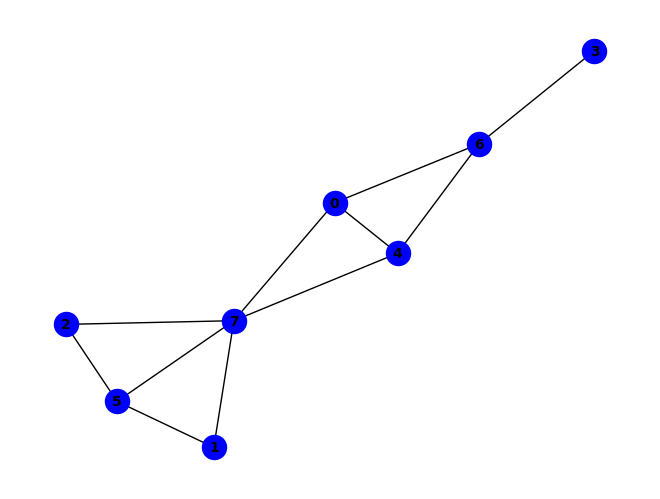


~f ^ (f & ~h) ^ (a & e & ~f) ^ (a & g & ~h) ^ (c & f & ~e) ^ (c & h & ~d) ^ (e & g & ~h) ^ (c & e & f & h) ^ (a & b & h & ~e) ^ (a & d & e & f & g) ^ (a & d & f & g & h) ^ (b & c & d & g & h) ^ (a & h & ~c & ~f) ^ (b & f & ~c & ~e) ^ (b & h & ~c & ~e) ^ (d & g & ~a & ~e) ^ (e & h & ~c & ~f) ^ (a & b & c & f & ~g) ^ (a & b & c & f & ~h) ^ (a & b & c & h & ~f) ^ (a & b & e & f & ~d) ^ (a & b & f & g & ~d) ^ (a & c & f & g & ~h) ^ (c & d & e & h & ~b) ^ (c & d & f & g & ~e) ^ (d & f & g & h & ~e) ^ (a & e & f & ~d & ~h) ^ (c & d & h & ~e & ~g) ^ (c & e & f & ~g & ~h) ^ (a & c & d & e & f & ~g) ^ (a & c & d & f & g & ~b) ^ (a & c & d & g & h & ~b) ^ (b & c & d & e & h & ~g) ^ (a & b & f & h & ~c & ~g) ^ (a & c & e & f & ~b & ~d) ^ (a & c & e & h & ~b & ~d) ^ (a & d & e & f & ~g & ~h) ^ (b & d & f & g & ~c & ~e) ^ (b & d & g & h & ~a & ~e) ^ (b & e & f & ~c & ~g & ~h) ^ (a & b & d & e & f & ~c & ~g) ^ (a & c & d & e & h & ~b & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

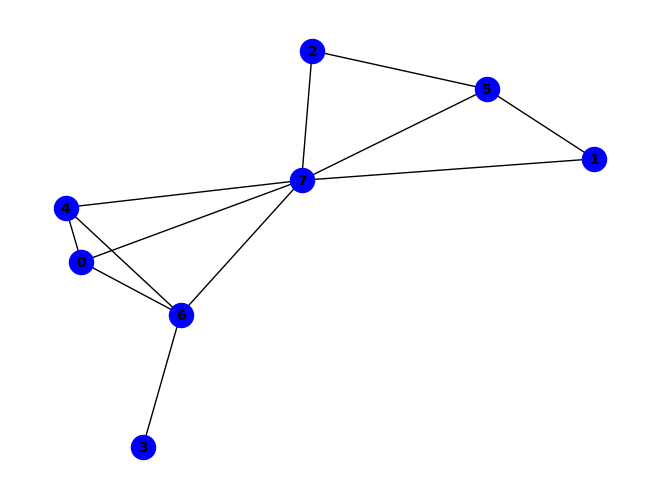


(g & ~h) ^ (~d & ~g) ^ (f & h & ~g) ^ (a & e & f & g) ^ (a & e & f & h) ^ (d & ~e & ~h) ^ (a & c & g & ~h) ^ (a & e & g & ~h) ^ (c & d & f & ~g) ^ (c & d & f & ~h) ^ (e & f & g & ~h) ^ (a & e & ~d & ~g) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (c & f & ~e & ~h) ^ (d & e & ~g & ~h) ^ (d & h & ~c & ~g) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & c & e & f & ~h) ^ (a & b & f & ~c & ~g) ^ (a & b & h & ~c & ~g) ^ (a & d & e & ~c & ~h) ^ (a & d & g & ~c & ~h) ^ (a & f & g & ~e & ~h) ^ (c & e & f & ~g & ~h) ^ (a & b & d & e & f & ~g) ^ (b & c & d & f & g & ~h) ^ (c & h & ~d & ~f & ~g) ^ (a & d & e & h & ~b & ~g) ^ (b & d & f & g & ~e & ~h) ^ (c & d & e & g & ~b & ~h) ^ (b & e & f & ~c & ~g & ~h) ^ (c & e & g & ~d & ~f & ~h) ^ (a & b & d & e & f & ~c & ~h) ^ (a & b & d & f & g & ~c & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (b & f & ~a & ~c & ~e & ~h) ^ (b & h & ~c & ~e & ~f & ~g) ^ (a & b & e & h & ~d & ~f & ~g) ^ (a & c & d & e & ~b & ~g & ~h) ^ (a & c & d & g & ~e & ~f & ~h) ^ (a & c & e 

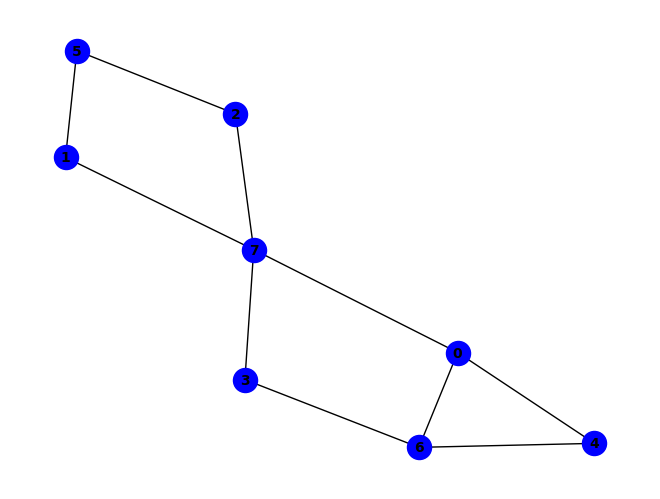


(~c & ~e) ^ (a & h & ~c) ^ (b & f & ~e) ^ (d & g & ~h) ^ (a & b & c & g) ^ (a & b & f & h) ^ (e & ~b & ~g) ^ (a & b & g & ~f) ^ (b & c & h & ~e) ^ (a & e & ~b & ~h) ^ (b & h & ~e & ~f) ^ (d & h & ~a & ~c) ^ (a & b & e & g & ~c) ^ (a & e & g & h & ~c) ^ (c & d & f & g & ~h) ^ (c & ~e & ~f & ~h) ^ (a & b & d & ~f & ~g) ^ (a & b & e & ~f & ~h) ^ (a & b & g & ~e & ~h) ^ (b & c & f & ~e & ~h) ^ (b & d & g & ~a & ~c) ^ (c & d & e & ~f & ~g) ^ (c & d & e & ~f & ~h) ^ (c & e & f & ~g & ~h) ^ (c & e & h & ~d & ~g) ^ (d & e & g & ~a & ~c) ^ (a & b & d & e & h & ~c) ^ (a & c & d & e & g & ~h) ^ (b & d & e & g & h & ~c) ^ (a & g & ~c & ~d & ~h) ^ (b & d & ~c & ~f & ~g) ^ (b & e & ~f & ~g & ~h) ^ (a & b & c & e & ~g & ~h) ^ (a & b & d & h & ~e & ~g) ^ (a & c & e & f & ~d & ~h) ^ (b & c & e & f & ~d & ~g) ^ (b & c & e & h & ~f & ~g) ^ (b & d & f & h & ~c & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & c & ~d & ~f & ~g) ^ (a & b & c & ~e & ~f & ~h) ^ (a & b & h & ~d & ~f & ~g) ^ (a & c & g & ~d & ~f

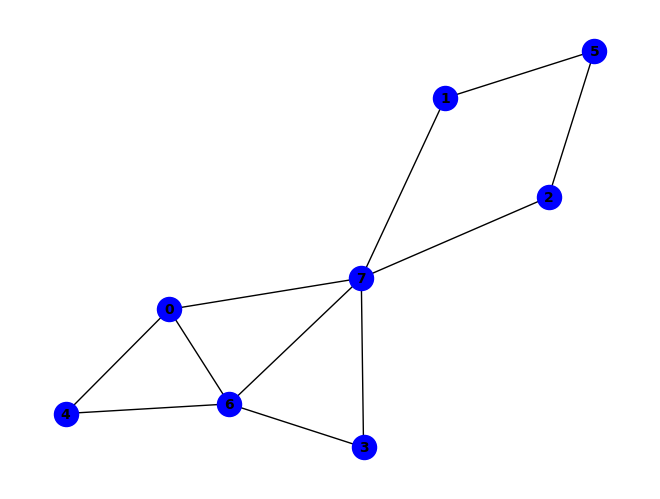


(a & c & e & f) ^ (a & c & h & ~e) ^ (a & c & d & f & h) ^ (a & h & ~b & ~d) ^ (d & g & ~b & ~c) ^ (d & h & ~b & ~c) ^ (e & h & ~c & ~g) ^ (a & b & c & h & ~d) ^ (a & c & d & g & ~f) ^ (a & c & e & h & ~f) ^ (b & d & e & f & ~g) ^ (c & ~d & ~f & ~h) ^ (e & ~a & ~d & ~h) ^ (g & ~b & ~c & ~h) ^ (b & e & f & ~d & ~h) ^ (b & e & h & ~d & ~g) ^ (c & e & f & ~b & ~h) ^ (b & c & e & f & h & ~g) ^ (~b & ~c & ~e & ~g) ^ (a & g & ~b & ~c & ~d) ^ (b & e & ~f & ~g & ~h) ^ (c & d & ~f & ~g & ~h) ^ (d & e & ~a & ~g & ~h) ^ (a & b & e & f & ~c & ~h) ^ (c & d & e & g & ~b & ~h) ^ (a & b & c & d & e & g & ~h) ^ (a & b & d & e & f & g & ~h) ^ (a & c & d & e & f & g & ~h) ^ (b & ~c & ~d & ~f & ~h) ^ (a & b & g & ~d & ~f & ~h) ^ (a & c & g & ~b & ~f & ~h) ^ (b & c & e & ~d & ~f & ~g) ^ (c & d & e & ~b & ~f & ~h) ^ (b & d & ~c & ~f & ~g & ~h) ^ (c & e & ~d & ~f & ~g & ~h) ^ (a & b & c & d & ~e & ~f & ~g) ^ (a & b & c & d & ~e & ~f & ~h) ^ (a & c & d & h & ~b & ~f & ~g) ^ (b & d & e & h & ~c & ~f & ~g) ^ (

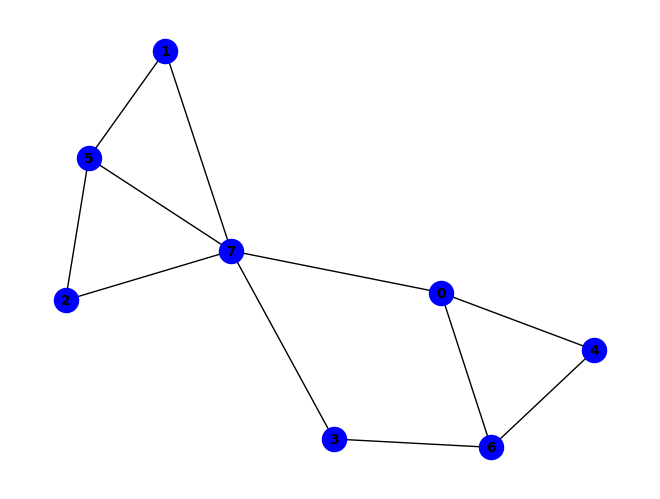


~f ^ (f & ~h) ^ (a & g & ~e) ^ (a & h & ~g) ^ (c & f & ~e) ^ (e & g & ~d) ^ (a & d & e & g) ^ (a & b & h & ~d) ^ (a & c & h & ~b) ^ (a & f & h & ~e) ^ (a & e & ~g & ~h) ^ (b & f & ~c & ~e) ^ (b & h & ~d & ~e) ^ (c & h & ~b & ~e) ^ (d & g & ~a & ~h) ^ (a & b & f & g & ~d) ^ (a & c & d & f & ~g) ^ (a & c & d & f & ~h) ^ (a & c & e & f & ~h) ^ (a & c & f & g & ~b) ^ (a & e & f & h & ~g) ^ (b & d & f & g & ~e) ^ (c & d & e & f & ~b) ^ (c & d & f & g & ~h) ^ (e & f & g & h & ~d) ^ (a & b & d & e & g & h) ^ (a & c & d & e & f & g) ^ (a & d & e & f & g & h) ^ (b & e & f & ~c & ~g) ^ (b & e & h & ~d & ~g) ^ (c & e & f & ~d & ~g) ^ (c & e & h & ~b & ~g) ^ (a & c & e & g & h & ~f) ^ (b & c & d & e & f & ~g) ^ (b & c & d & f & g & ~a) ^ (c & d & e & g & h & ~a) ^ (d & h & ~a & ~c & ~f) ^ (a & b & e & f & ~c & ~h) ^ (a & c & f & h & ~d & ~g) ^ (b & c & d & h & ~a & ~e) ^ (b & d & f & h & ~c & ~g) ^ (a & b & d & e & f & g & ~c) ^ (a & b & e & g & h & ~c & ~f) ^ (b & c & d & e & h & ~a & ~g) ^ (a &

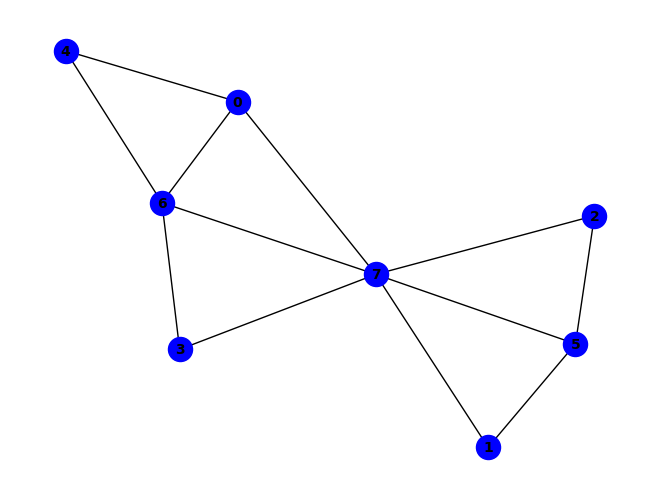


(g & ~h) ^ (~e & ~g) ^ (e & h & ~g) ^ (f & h & ~g) ^ (d & f & g & ~h) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (c & f & ~d & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & b & c & h & ~g) ^ (a & c & e & f & ~h) ^ (e & ~a & ~d & ~h) ^ (a & b & h & ~d & ~g) ^ (c & d & f & ~g & ~h) ^ (c & d & g & ~f & ~h) ^ (b & f & ~c & ~d & ~h) ^ (b & h & ~d & ~f & ~g) ^ (c & h & ~b & ~f & ~g) ^ (d & e & ~a & ~g & ~h) ^ (a & b & d & f & ~c & ~h) ^ (c & e & f & g & ~d & ~h) ^ (a & b & c & d & f & h & ~g) ^ (a & c & d & e & f & g & ~h) ^ (a & b & f & ~c & ~d & ~g) ^ (a & b & f & ~c & ~e & ~h) ^ (a & c & h & ~d & ~f & ~g) ^ (a & f & g & ~c & ~d & ~h) ^ (b & d & f & ~c & ~g & ~h) ^ (b & c & d & h & ~a & ~f & ~g) ^ (b & e & f & g & ~c & ~d & ~h) ^ (a & b & d & e & f & g & ~c & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


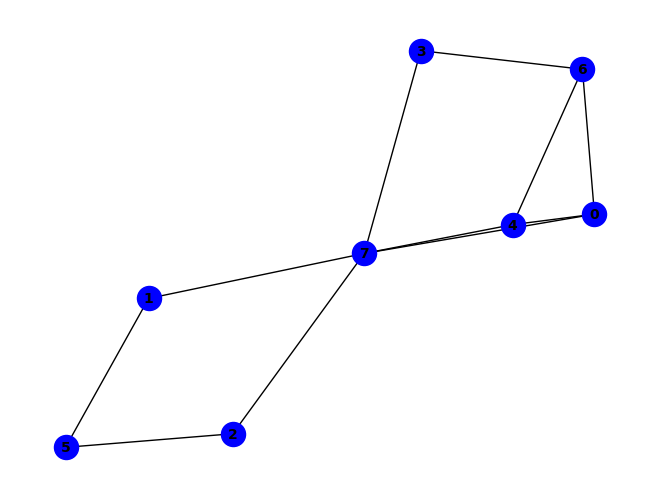


~d ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & f & ~c) ^ (c & f & ~h) ^ (e & h & ~d) ^ (d & ~g & ~h) ^ (a & b & h & ~e) ^ (b & d & h & ~e) ^ (b & e & g & ~d) ^ (b & e & h & ~g) ^ (a & b & c & e & f) ^ (b & h & ~c & ~f) ^ (c & h & ~d & ~e) ^ (e & g & ~d & ~h) ^ (a & b & c & g & ~d) ^ (a & b & e & f & ~h) ^ (a & b & f & g & ~h) ^ (a & c & e & f & ~h) ^ (a & c & e & h & ~d) ^ (a & c & f & h & ~d) ^ (b & c & d & g & ~e) ^ (b & c & d & h & ~g) ^ (b & c & e & h & ~d) ^ (b & d & f & g & ~h) ^ (c & d & f & g & ~h) ^ (a & b & c & d & e & h) ^ (a & c & g & ~d & ~f) ^ (a & d & e & ~g & ~h) ^ (a & b & c & e & h & ~f) ^ (a & b & d & f & h & ~e) ^ (b & c & e & f & g & ~h) ^ (b & d & e & g & h & ~c) ^ (a & g & ~c & ~d & ~h) ^ (a & b & c & h & ~d & ~g) ^ (a & b & d & g & ~e & ~f) ^ (a & b & d & g & ~e & ~h) ^ (c & e & f & g & ~d & ~h) ^ (a & c & h & ~d & ~f & ~g) ^ (b & e & g & ~d & ~f & ~h) ^ (a & b & c & g & ~d & ~f & ~h) ^ (a & b & d & h & ~e & ~f & ~g) ^ (b & c & d & g & ~e & ~f & ~h) ^ (a & c & d & e &

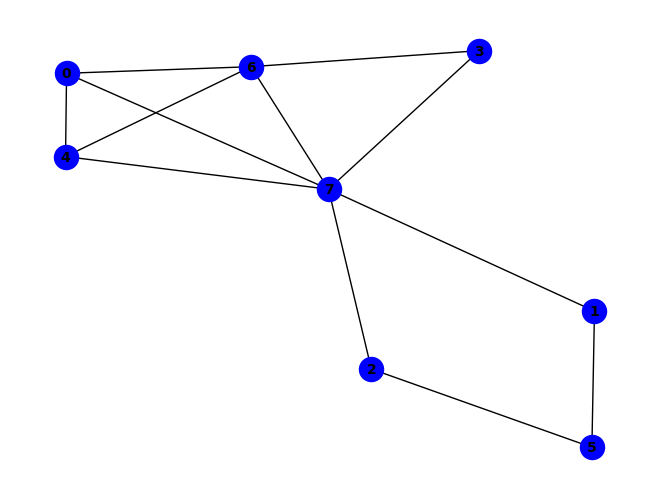


(a & g & ~d) ^ (e & g & ~c) ^ (e & h & ~c) ^ (a & b & c & g) ^ (a & b & f & g) ^ (a & b & f & h) ^ (a & c & e & f) ^ (b & d & f & g) ^ (b & d & f & h) ^ (b & e & g & ~d) ^ (b & e & h & ~d) ^ (b & c & e & f & g) ^ (b & c & e & f & h) ^ (~b & ~c & ~g) ^ (a & e & ~b & ~g) ^ (a & h & ~c & ~d) ^ (d & g & ~c & ~e) ^ (d & h & ~c & ~e) ^ (a & b & c & e & ~g) ^ (a & b & c & h & ~d) ^ (a & b & d & g & ~c) ^ (a & b & d & h & ~e) ^ (a & c & e & h & ~f) ^ (a & d & e & g & ~b) ^ (a & d & e & h & ~c) ^ (b & c & d & g & ~e) ^ (b & c & d & h & ~e) ^ (a & b & c & d & e & g) ^ (b & ~e & ~f & ~h) ^ (c & ~e & ~f & ~h) ^ (g & ~b & ~c & ~h) ^ (a & c & g & ~d & ~e) ^ (b & d & h & ~f & ~g) ^ (a & b & c & d & e & ~f) ^ (a & b & c & d & e & f & h) ^ (b & c & ~d & ~f & ~h) ^ (c & e & ~f & ~g & ~h) ^ (a & b & c & e & ~f & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & b & d & ~c & ~f & ~h) ^ (a & b & d & ~e & ~f & ~g) ^ (a & b & e & ~d & ~f & ~h) ^ (a & b & h & ~d & ~f & ~g) ^ (a & c & g & ~d & ~f & ~h) ^ (a & e & g & ~b

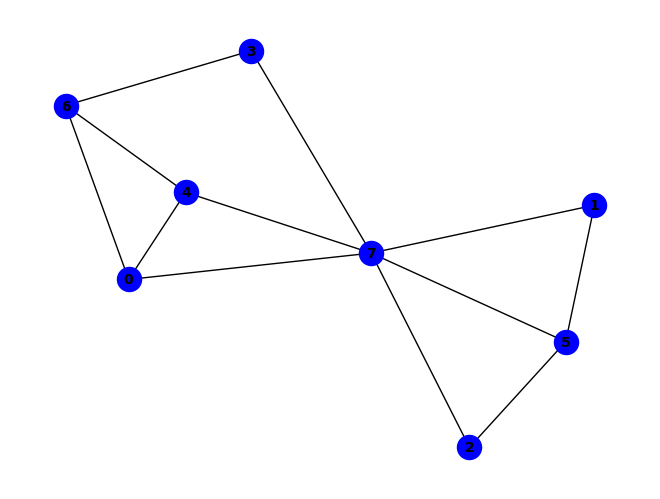


~f ^ (f & ~h) ^ (a & e & ~f) ^ (b & h & ~e) ^ (c & f & ~e) ^ (c & h & ~b) ^ (e & g & ~h) ^ (b & c & d & h) ^ (b & c & e & h) ^ (a & e & f & ~h) ^ (b & c & d & f & g) ^ (c & d & e & f & g) ^ (a & g & ~d & ~h) ^ (b & f & ~c & ~e) ^ (d & g & ~e & ~h) ^ (e & h & ~c & ~f) ^ (a & b & e & h & ~d) ^ (a & c & e & f & ~d) ^ (a & c & e & h & ~b) ^ (a & d & e & g & ~h) ^ (c & d & f & g & ~h) ^ (c & e & f & h & ~d) ^ (b & d & h & ~e & ~f) ^ (c & e & f & ~g & ~h) ^ (b & c & d & e & f & ~g) ^ (b & c & d & e & f & ~h) ^ (c & d & e & f & h & ~g) ^ (d & h & ~c & ~e & ~f) ^ (a & b & e & f & ~c & ~d) ^ (a & b & f & g & ~d & ~h) ^ (a & d & e & h & ~c & ~f) ^ (b & d & f & g & ~e & ~h) ^ (b & e & f & ~c & ~g & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (a & c & d & e & f & ~b & ~g) ^ (b & c & d & e & h & ~a & ~f) ^ (b & c & d & f & h & ~e & ~g) ^ (a & c & d & e & f & g & h & ~b) ^ (a & h & ~b & ~c & ~d & ~f) ^ (a & c & f & g & ~b & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

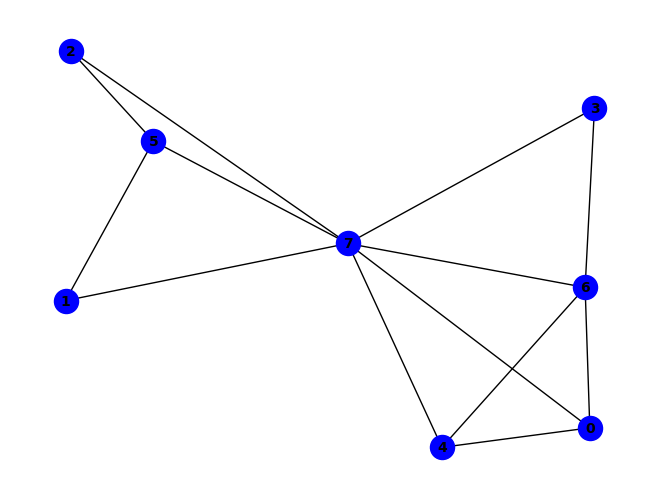


~g ^ (g & ~h) ^ (a & e & ~g) ^ (f & h & ~g) ^ (a & e & f & g) ^ (e & f & g & ~h) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (c & f & ~e & ~h) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & b & c & h & ~g) ^ (a & b & e & f & ~d) ^ (a & b & f & g & ~h) ^ (a & e & f & h & ~b) ^ (b & c & d & h & ~g) ^ (b & d & e & f & ~h) ^ (a & e & g & ~f & ~h) ^ (c & e & g & ~f & ~h) ^ (a & d & e & f & g & ~h) ^ (a & b & d & e & f & g & h) ^ (b & f & ~c & ~e & ~h) ^ (c & h & ~d & ~f & ~g) ^ (a & b & c & f & ~d & ~g) ^ (a & c & e & f & ~d & ~h) ^ (a & d & e & g & ~c & ~f) ^ (a & d & e & h & ~c & ~f) ^ (b & c & d & f & ~e & ~g) ^ (b & c & d & f & ~e & ~h) ^ (b & d & f & g & ~a & ~h) ^ (b & c & d & e & f & h & ~g) ^ (a & c & h & ~e & ~f & ~g) ^ (a & f & g & ~c & ~d & ~h) ^ (b & c & h & ~e & ~f & ~g) ^ (b & e & f & ~d & ~g & ~h) ^ (c & e & f & ~b & ~g & ~h) ^ (d & f & g & ~c & ~e & ~h) ^ (a & b & d & e & f & ~c & ~g) ^ (a & c & d & e & f & ~g & ~h) ^ (a & c & d & e & g

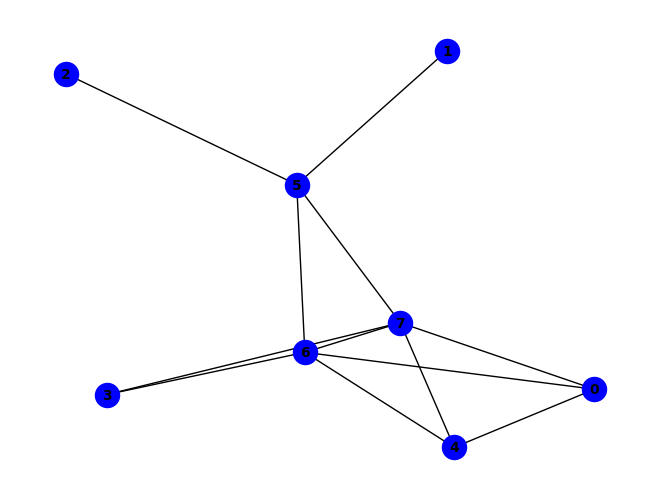


~g ^ (f & g) ^ (f & h) ^ (g & ~h) ^ (e & g & ~f) ^ (e & h & ~f) ^ (a & e & ~g & ~h) ^ (a & h & ~e & ~f) ^ (a & g & ~c & ~e & ~f) ^ (b & f & ~a & ~g & ~h) ^ (d & g & ~a & ~e & ~f) ^ (d & h & ~a & ~e & ~f) ^ (a & b & c & g & ~e & ~f) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & ~b & ~e & ~f & ~h) ^ (a & c & ~b & ~e & ~g & ~h) ^ (c & f & ~a & ~b & ~g & ~h) ^ (a & c & g & h & ~b & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


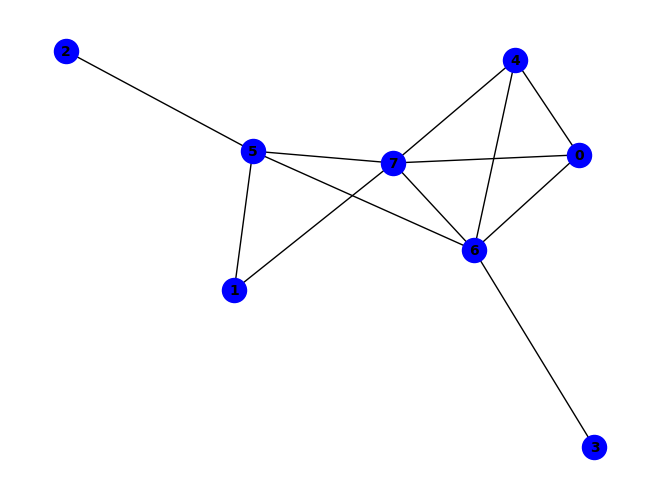


(f & g) ^ (f & h) ^ (~d & ~g) ^ (b & f & ~g) ^ (c & f & ~h) ^ (e & g & ~f) ^ (e & h & ~f) ^ (d & ~f & ~h) ^ (g & ~c & ~h) ^ (d & e & f & ~h) ^ (d & e & g & ~h) ^ (a & h & ~e & ~f) ^ (b & h & ~e & ~g) ^ (d & f & ~e & ~g) ^ (d & h & ~f & ~g) ^ (b & e & f & h & ~g) ^ (d & e & f & h & ~g) ^ (a & c & f & ~g & ~h) ^ (a & d & g & ~f & ~h) ^ (a & g & ~c & ~e & ~f) ^ (b & c & ~a & ~f & ~h) ^ (b & c & ~a & ~g & ~h) ^ (c & g & ~b & ~f & ~h) ^ (a & b & d & e & ~g & ~h) ^ (a & c & g & h & ~e & ~f) ^ (a & d & e & f & ~g & ~h) ^ (a & b & h & ~e & ~f & ~g) ^ (a & d & e & ~b & ~f & ~h) ^ (a & b & c & e & g & ~f & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & c & ~b & ~e & ~f & ~h) ^ (a & c & ~b & ~e & ~g & ~h) ^ (a & e & ~b & ~d & ~g & ~h) ^ (a & b & e & ~d & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


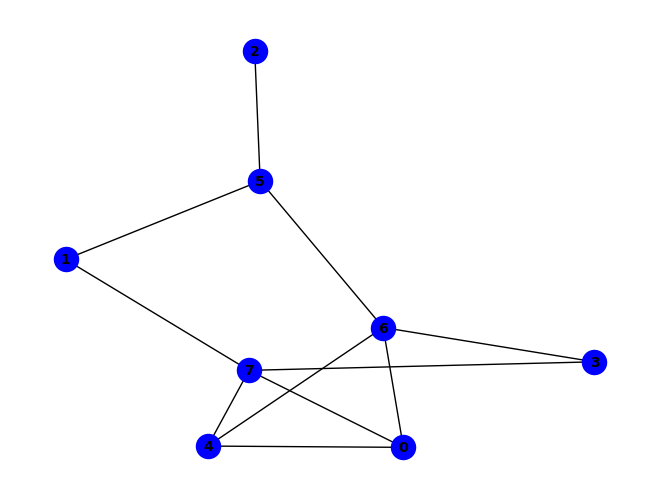


(e & f & g) ^ (~c & ~f) ^ (a & h & ~d) ^ (d & h & ~e) ^ (e & g & ~h) ^ (e & h & ~c) ^ (c & e & g & h) ^ (c & ~b & ~g) ^ (f & ~b & ~g) ^ (a & f & g & ~d) ^ (d & f & g & ~e) ^ (a & e & ~c & ~f) ^ (a & g & ~d & ~h) ^ (b & c & ~f & ~g) ^ (c & g & ~e & ~f) ^ (d & g & ~e & ~h) ^ (a & d & e & g & ~f) ^ (a & c & e & ~b & ~g) ^ (a & e & f & ~b & ~g) ^ (c & e & g & ~f & ~h) ^ (c & e & h & ~d & ~f) ^ (c & d & e & g & h & ~f) ^ (a & b & c & e & ~f & ~g) ^ (a & c & e & g & ~d & ~f) ^ (a & c & f & h & ~d & ~g) ^ (a & d & e & h & ~c & ~g) ^ (b & d & f & h & ~e & ~g) ^ (b & e & f & h & ~c & ~g) ^ (c & d & e & h & ~b & ~g) ^ (c & d & f & h & ~b & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & d & e & f & h & ~g) ^ (a & c & d & e & g & ~f & ~h) ^ (a & c & d & e & h & ~b & ~f) ^ (b & c & d & e & h & ~f & ~g) ^ (a & b & c & d & e & g & h & ~f) ^ (b & h & ~a & ~d & ~e & ~f) ^ (a & b & f & h & ~c & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

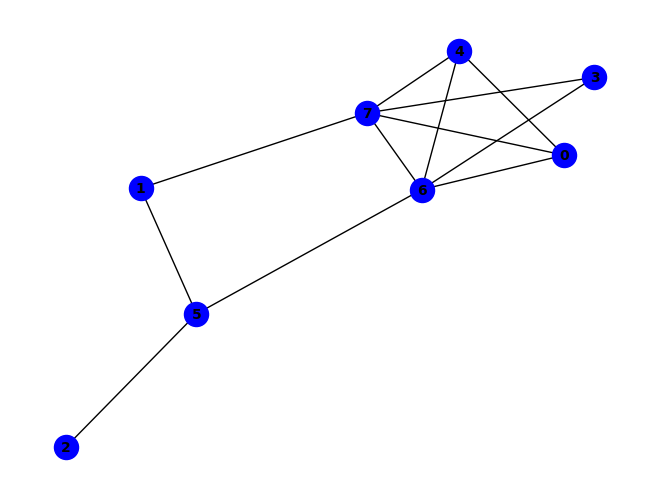


(g & ~h) ^ (~f & ~g) ^ (a & h & ~d) ^ (e & g & ~d) ^ (e & h & ~d) ^ (a & e & f & h) ^ (f & ~e & ~h) ^ (a & e & g & ~h) ^ (a & d & e & f & g) ^ (a & e & ~c & ~f) ^ (a & g & ~d & ~e) ^ (b & f & ~g & ~h) ^ (c & f & ~b & ~g) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (f & h & ~d & ~g) ^ (d & e & f & g & ~h) ^ (a & c & e & ~b & ~g) ^ (a & f & g & ~d & ~h) ^ (c & d & g & ~f & ~h) ^ (c & d & h & ~e & ~g) ^ (a & d & e & f & h & ~g) ^ (e & f & ~a & ~g & ~h) ^ (a & b & c & e & ~f & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & g & ~d & ~f) ^ (a & d & e & h & ~c & ~f) ^ (c & d & e & h & ~f & ~g) ^ (c & e & f & h & ~b & ~g) ^ (a & c & d & e & g & ~f & ~h) ^ (a & c & d & e & h & ~b & ~g) ^ (b & c & d & f & h & ~e & ~g) ^ (b & h & ~a & ~d & ~e & ~g) ^ (a & c & f & h & ~b & ~d & ~g) ^ (a & b & c & d & e & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

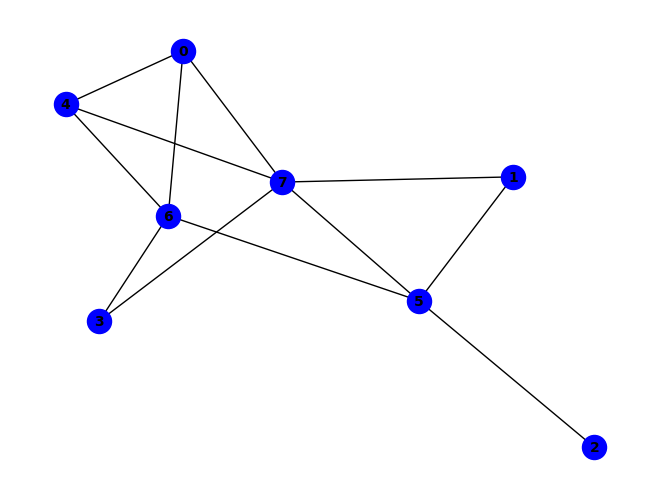


~e ^ (a & e & ~d) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & h & ~d & ~f) ^ (b & f & ~g & ~h) ^ (f & g & ~e & ~h) ^ (a & e & f & h & ~d) ^ (a & d & e & ~g & ~h) ^ (a & g & ~d & ~f & ~h) ^ (b & h & ~a & ~e & ~f) ^ (c & f & ~b & ~g & ~h) ^ (d & g & ~e & ~f & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & b & d & h & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & e & f & g & ~d & ~h) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


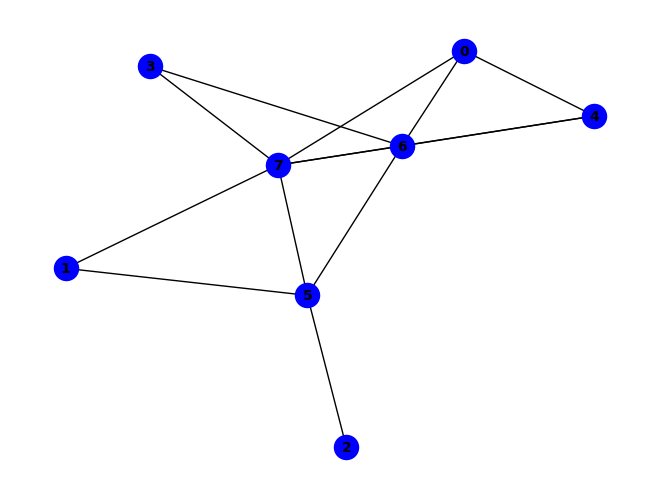


~g ^ (f & g) ^ (f & h) ^ (g & ~h) ^ (b & f & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (b & e & f & h & ~g) ^ (a & e & ~b & ~g & ~h) ^ (a & g & ~d & ~e & ~f) ^ (a & h & ~d & ~e & ~f) ^ (b & h & ~a & ~e & ~g) ^ (c & f & ~b & ~g & ~h) ^ (a & b & f & h & ~e & ~g) ^ (a & b & e & ~f & ~g & ~h) ^ (a & c & e & f & ~b & ~g & ~h) ^ (b & d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


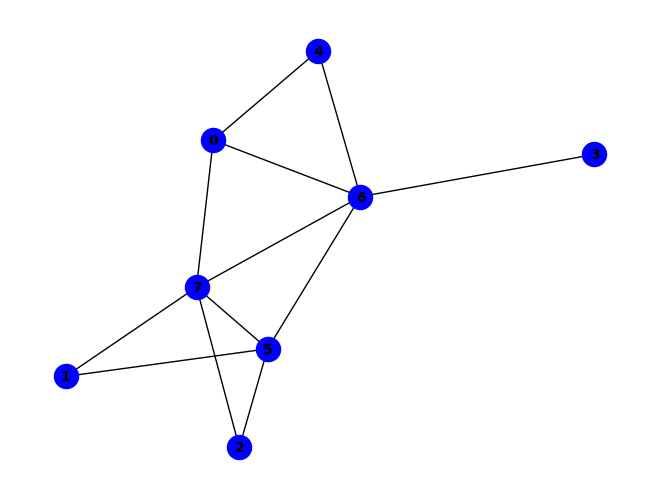


(f & g) ^ (f & h) ^ (~e & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (e & h & ~g) ^ (g & ~d & ~h) ^ (b & h & ~a & ~g) ^ (c & f & ~a & ~g) ^ (e & ~a & ~f & ~h) ^ (a & d & g & ~e & ~h) ^ (d & e & g & ~f & ~h) ^ (d & f & g & ~a & ~h) ^ (a & d & e & f & g & ~h) ^ (b & f & ~a & ~c & ~g) ^ (c & h & ~a & ~b & ~g) ^ (e & f & ~a & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & f & ~b & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


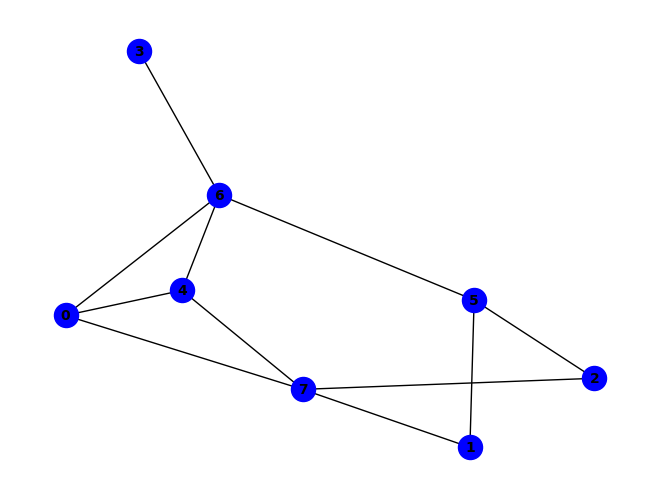


(a & f & g) ^ (e & f & g) ^ (~c & ~f) ^ (a & g & ~h) ^ (a & h & ~c) ^ (e & g & ~h) ^ (e & h & ~c) ^ (c & ~f & ~h) ^ (f & ~c & ~g) ^ (a & c & f & g & h) ^ (c & e & f & g & h) ^ (a & e & ~c & ~f) ^ (a & c & e & ~f & ~h) ^ (a & e & f & ~c & ~g) ^ (b & f & ~c & ~e & ~g) ^ (d & g & ~a & ~e & ~f) ^ (a & b & f & h & ~c & ~g) ^ (a & b & d & e & f & h & ~c) ^ (a & b & d & e & g & h & ~c) ^ (b & e & f & ~c & ~g & ~h) ^ (a & b & d & g & h & ~c & ~f) ^ (b & h & ~a & ~c & ~e & ~f) ^ (a & b & e & f & ~c & ~d & ~g) ^ (b & d & g & h & ~c & ~e & ~f) ^ (c & d & g & h & ~a & ~e & ~f) ^ (a & b & d & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


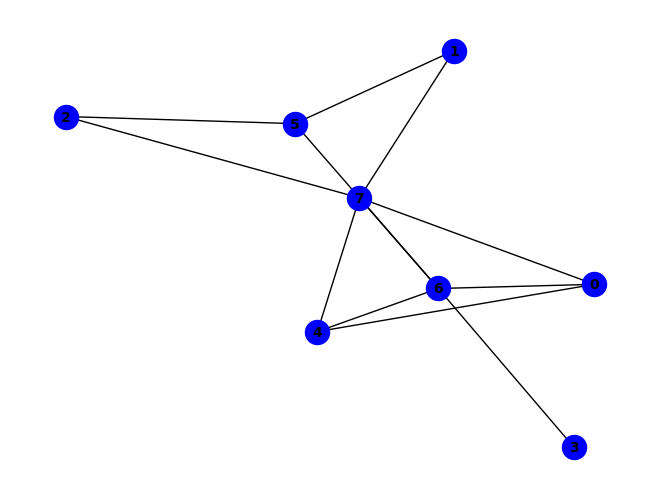


(a & g) ^ (a & h) ^ (~f & ~g) ^ (e & g & ~d) ^ (e & h & ~d) ^ (f & h & ~g) ^ (f & ~e & ~h) ^ (g & ~d & ~h) ^ (a & f & g & ~h) ^ (d & e & f & ~h) ^ (d & f & g & ~h) ^ (a & e & ~f & ~g) ^ (c & f & ~g & ~h) ^ (e & f & ~g & ~h) ^ (a & d & g & ~f & ~h) ^ (a & e & f & ~d & ~h) ^ (a & e & g & ~d & ~h) ^ (d & e & f & ~a & ~g) ^ (d & e & h & ~f & ~g) ^ (b & f & ~c & ~g & ~h) ^ (c & h & ~a & ~e & ~g) ^ (a & c & e & f & ~g & ~h) ^ (a & e & f & h & ~d & ~g) ^ (b & h & ~a & ~c & ~e & ~g) ^ (a & b & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


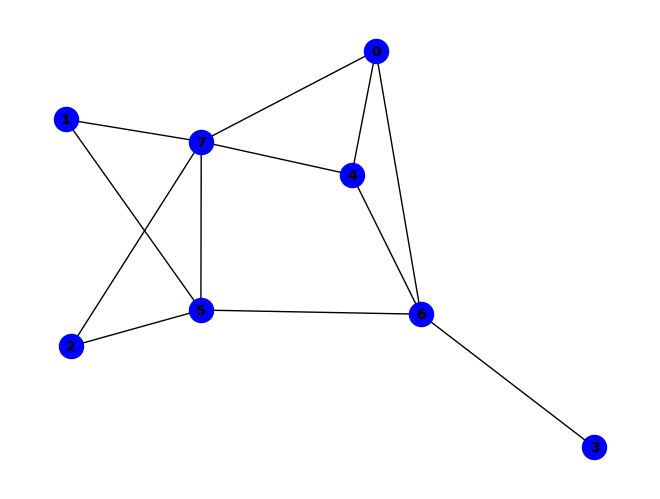


~e ^ (a & e & ~d) ^ (a & h & ~f) ^ (f & h & ~e) ^ (a & e & f & h) ^ (e & ~g & ~h) ^ (a & d & g & ~f) ^ (a & g & ~f & ~h) ^ (d & g & ~e & ~f) ^ (f & g & ~e & ~h) ^ (a & d & e & f & ~c) ^ (a & e & f & g & ~h) ^ (c & d & f & h & ~e) ^ (c & d & g & h & ~e) ^ (b & c & d & e & g & h) ^ (a & d & e & ~f & ~g) ^ (c & d & f & ~e & ~g) ^ (a & c & d & e & f & ~g) ^ (b & c & d & g & h & ~f) ^ (b & f & ~c & ~g & ~h) ^ (c & f & ~d & ~g & ~h) ^ (c & h & ~a & ~e & ~f) ^ (a & c & e & f & ~g & ~h) ^ (a & c & d & e & f & g & ~h) ^ (a & c & d & e & g & h & ~b) ^ (b & c & d & e & f & h & ~a) ^ (a & c & d & g & h & ~b & ~f) ^ (b & c & d & e & f & ~a & ~g) ^ (b & h & ~a & ~c & ~e & ~f) ^ (a & b & e & f & ~c & ~g & ~h) ^ (b & d & g & h & ~a & ~e & ~f) ^ (c & d & e & f & ~b & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


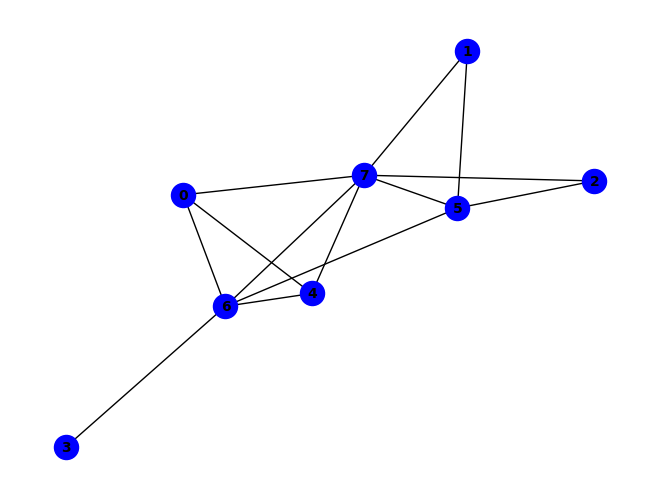


(f & g) ^ (f & h) ^ (~d & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & f & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (d & ~f & ~h) ^ (g & ~b & ~h) ^ (b & e & g & ~h) ^ (d & e & f & ~h) ^ (d & e & g & ~h) ^ (a & g & ~e & ~f) ^ (a & h & ~e & ~f) ^ (b & f & ~c & ~g) ^ (d & f & ~e & ~g) ^ (d & h & ~f & ~g) ^ (c & e & f & h & ~g) ^ (d & e & f & h & ~g) ^ (a & d & g & ~f & ~h) ^ (c & h & ~b & ~e & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & d & e & f & ~g & ~h) ^ (b & e & f & h & ~c & ~g) ^ (a & c & h & ~e & ~f & ~g) ^ (a & d & e & ~c & ~f & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (a & e & ~c & ~d & ~g & ~h) ^ (a & c & d & e & ~b & ~g & ~h) ^ (a & b & h & ~c & ~e & ~f & ~g) ^ (a & c & e & ~d & ~f & ~g & ~h) ^ (a & b & c & d & e & ~f & ~g & ~h) ^ (a & b & c & e & f & ~d & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


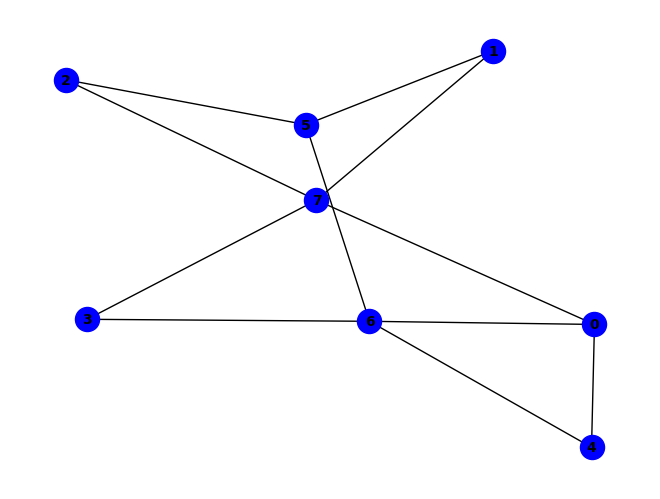


(~c & ~f) ^ (a & e & ~h) ^ (a & g & ~f) ^ (a & h & ~g) ^ (b & c & ~e) ^ (e & g & ~f) ^ (a & e & g & h) ^ (b & c & f & g) ^ (f & ~c & ~g) ^ (d & e & g & ~a) ^ (b & c & d & e & g) ^ (b & f & ~e & ~g) ^ (b & h & ~d & ~f) ^ (d & g & ~a & ~h) ^ (d & h & ~a & ~c) ^ (a & e & f & g & ~c) ^ (b & c & d & h & ~f) ^ (b & c & e & h & ~g) ^ (b & e & g & h & ~d) ^ (c & e & g & h & ~f) ^ (a & c & e & f & g & h) ^ (c & ~b & ~f & ~h) ^ (a & b & h & ~e & ~f) ^ (b & c & e & ~d & ~h) ^ (d & f & g & ~a & ~e) ^ (c & d & e & g & h & ~a) ^ (a & b & d & h & ~c & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & b & f & h & ~d & ~g) ^ (a & c & e & f & ~b & ~h) ^ (a & c & e & h & ~f & ~g) ^ (a & c & f & h & ~b & ~g) ^ (b & c & e & f & ~d & ~g) ^ (b & d & f & h & ~e & ~g) ^ (b & e & f & h & ~c & ~d) ^ (a & b & c & e & f & g & ~h) ^ (a & c & h & ~b & ~e & ~f) ^ (b & e & f & ~c & ~g & ~h) ^ (b & c & d & f & h & ~a & ~g) ^ (c & d & f & g & h & ~a & ~e) ^ (a & b & e & h & ~c & ~f & ~g) ^ (b & c & d & e & ~f & ~g & ~h) ^ (a & b 

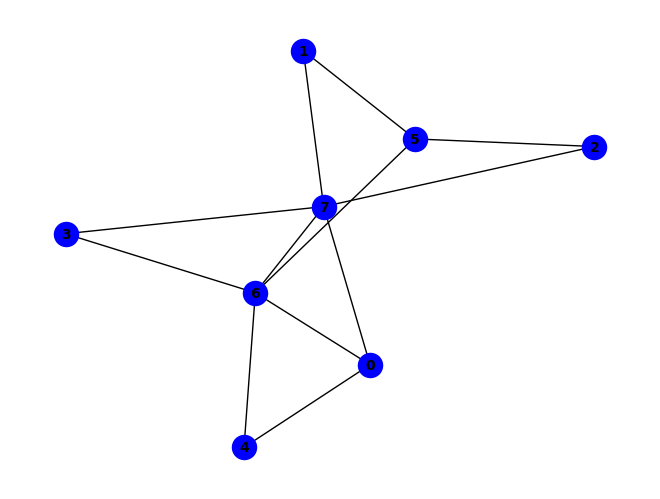


(~f & ~g) ^ (a & e & ~f) ^ (a & g & ~d) ^ (a & h & ~e) ^ (d & g & ~e) ^ (d & h & ~e) ^ (f & h & ~g) ^ (a & d & f & g) ^ (f & ~e & ~h) ^ (g & ~e & ~h) ^ (a & d & h & ~f) ^ (d & e & f & ~g) ^ (d & f & g & ~h) ^ (a & e & f & g & h) ^ (e & f & ~g & ~h) ^ (a & d & e & g & ~h) ^ (a & b & f & ~c & ~h) ^ (a & e & f & ~d & ~g) ^ (a & f & g & ~b & ~h) ^ (d & e & f & ~a & ~h) ^ (d & e & h & ~f & ~g) ^ (a & b & c & f & g & ~h) ^ (b & f & ~c & ~g & ~h) ^ (c & f & ~a & ~g & ~h) ^ (c & h & ~a & ~d & ~g) ^ (a & d & f & h & ~e & ~g) ^ (a & c & f & ~e & ~g & ~h) ^ (b & h & ~a & ~c & ~d & ~g) ^ (a & b & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


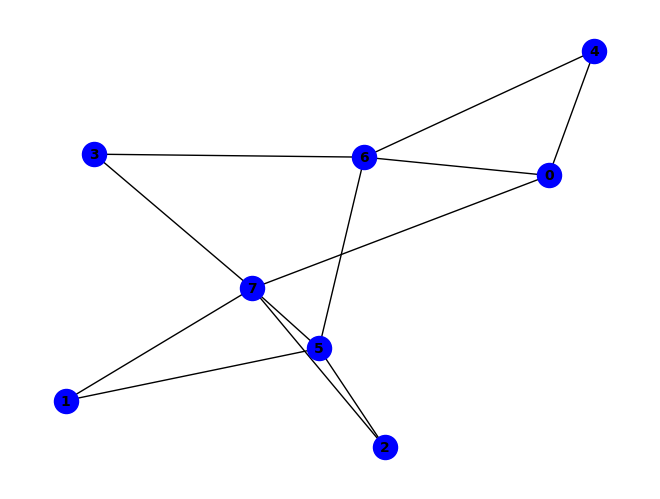


~e ^ (a & e & ~h) ^ (b & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (f & h & ~a) ^ (a & d & f & h) ^ (a & e & g & h) ^ (b & f & g & h) ^ (e & ~d & ~g) ^ (a & c & f & ~g) ^ (a & c & h & ~g) ^ (b & e & h & ~g) ^ (e & f & g & ~a) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~g) ^ (b & f & ~e & ~g) ^ (c & h & ~b & ~f) ^ (d & g & ~f & ~h) ^ (a & c & d & h & ~f) ^ (a & d & e & g & ~f) ^ (a & f & g & h & ~d) ^ (c & e & g & h & ~f) ^ (a & b & f & ~c & ~g) ^ (a & b & h & ~c & ~g) ^ (d & e & f & ~c & ~g) ^ (b & c & e & g & h & ~d) ^ (b & d & e & f & h & ~g) ^ (b & d & e & g & h & ~a) ^ (c & d & e & f & h & ~a) ^ (c & d & e & g & h & ~a) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (a & b & d & e & f & g & h) ^ (c & f & ~b & ~g & ~h) ^ (d & h & ~b & ~c & ~f) ^ (a & b & d & h & ~c & ~f) ^ (a & c & g & h & ~e & ~f) ^ (b & c & e & f & ~d & ~g) ^ (b & e & f & h & ~c & ~d) ^ (a & c & f & ~e & ~g & ~h) ^ (b & e & f & ~c & ~g & ~h) ^ (a & b & g & h & ~c & ~e & ~f) ^ (c & d & e & f & ~b & ~g & ~h) 

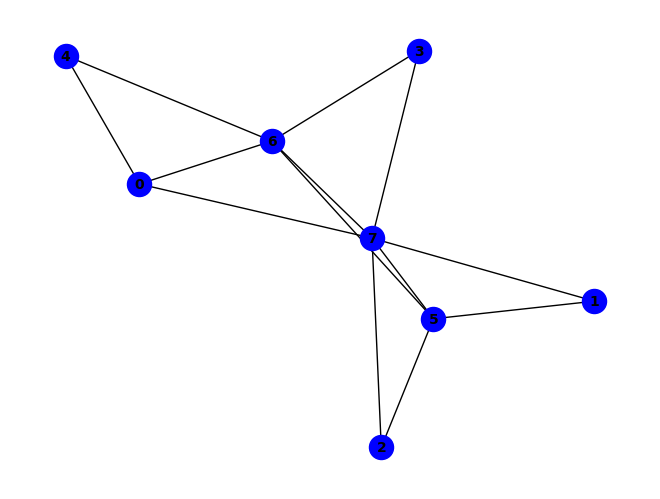


(f & g) ^ (f & h) ^ (g & ~h) ^ (~e & ~g) ^ (d & g & ~f) ^ (d & h & ~f) ^ (e & h & ~g) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (c & f & ~a & ~g) ^ (e & ~a & ~f & ~h) ^ (b & f & ~a & ~c & ~g) ^ (c & h & ~a & ~d & ~g) ^ (e & f & ~a & ~g & ~h) ^ (c & d & f & h & ~a & ~g) ^ (a & b & f & ~e & ~g & ~h) ^ (d & e & g & ~a & ~f & ~h) ^ (b & h & ~a & ~c & ~d & ~g) ^ (b & d & f & h & ~a & ~c & ~g) ^ (a & c & f & ~b & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


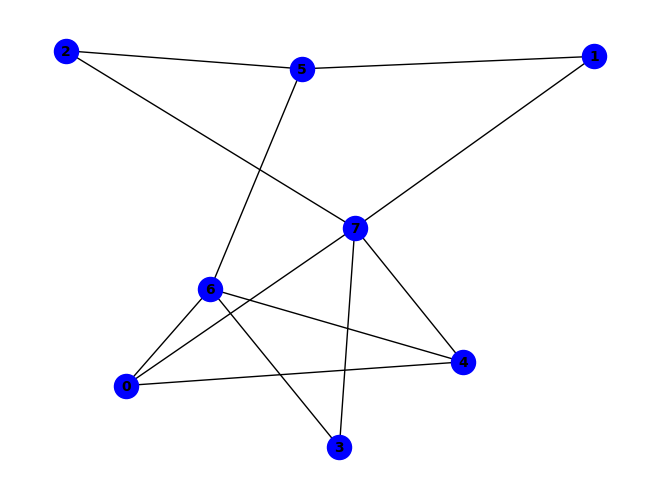


(e & f & g) ^ (~c & ~f) ^ (a & h & ~d) ^ (d & h & ~e) ^ (e & g & ~h) ^ (e & h & ~c) ^ (c & ~f & ~h) ^ (f & ~c & ~g) ^ (a & f & g & ~d) ^ (d & f & g & ~e) ^ (a & d & e & f & g) ^ (c & e & f & g & h) ^ (a & e & ~c & ~f) ^ (a & g & ~d & ~h) ^ (d & g & ~e & ~h) ^ (a & d & e & g & ~h) ^ (a & d & e & h & ~c) ^ (a & c & e & ~f & ~h) ^ (a & c & h & ~d & ~f) ^ (a & e & f & ~c & ~g) ^ (a & c & d & e & f & g & h) ^ (b & f & ~c & ~e & ~g) ^ (a & c & f & h & ~d & ~g) ^ (b & d & f & h & ~e & ~g) ^ (b & c & h & ~a & ~e & ~f) ^ (b & e & f & ~c & ~g & ~h) ^ (c & d & h & ~b & ~e & ~f) ^ (a & b & c & d & h & ~e & ~f) ^ (b & h & ~a & ~d & ~e & ~f) ^ (a & b & e & f & ~c & ~d & ~g) ^ (a & b & f & h & ~c & ~d & ~g) ^ (c & d & f & h & ~b & ~e & ~g) ^ (a & b & d & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


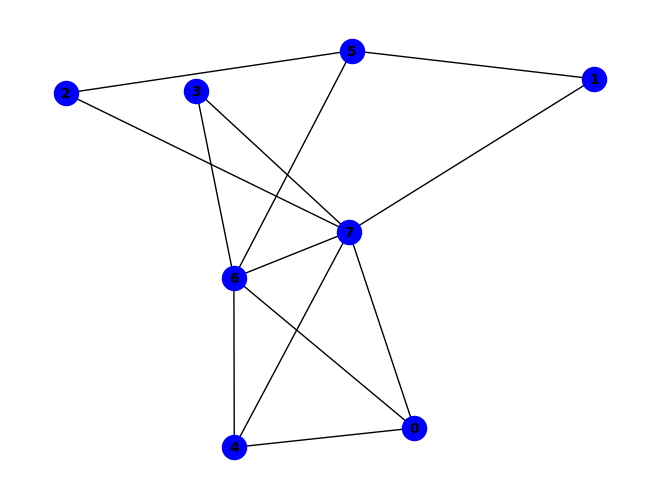


(g & ~h) ^ (~f & ~g) ^ (a & h & ~d) ^ (d & g & ~f) ^ (d & h & ~f) ^ (e & g & ~d) ^ (e & h & ~d) ^ (f & ~e & ~h) ^ (a & e & f & g & h) ^ (a & e & ~c & ~f) ^ (a & g & ~d & ~e) ^ (c & f & ~g & ~h) ^ (e & f & ~g & ~h) ^ (f & h & ~d & ~g) ^ (a & c & e & h & ~f) ^ (a & d & e & f & ~h) ^ (a & d & e & h & ~c) ^ (d & e & f & g & ~h) ^ (a & c & d & e & g & h) ^ (a & c & e & ~b & ~h) ^ (a & e & f & ~d & ~g) ^ (a & e & g & ~c & ~h) ^ (a & f & g & ~d & ~h) ^ (a & b & c & e & g & ~h) ^ (a & d & e & f & h & ~g) ^ (b & f & ~c & ~g & ~h) ^ (c & h & ~d & ~e & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & c & d & h & ~b & ~g) ^ (a & c & e & g & ~f & ~h) ^ (a & b & c & d & e & h & ~g) ^ (a & b & h & ~d & ~e & ~g) ^ (a & c & h & ~b & ~e & ~g) ^ (b & h & ~c & ~d & ~e & ~g) ^ (a & b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


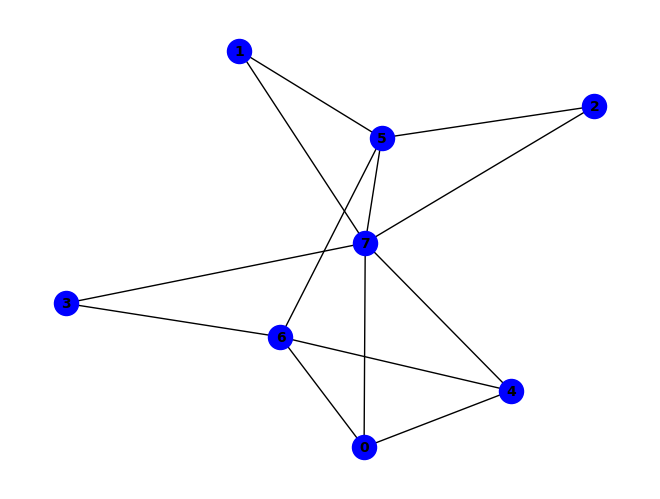


~e ^ (a & e & ~d) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & h & ~d & ~f) ^ (b & f & ~g & ~h) ^ (f & g & ~e & ~h) ^ (a & e & f & h & ~d) ^ (a & d & e & ~g & ~h) ^ (a & g & ~d & ~f & ~h) ^ (b & h & ~c & ~e & ~f) ^ (c & f & ~b & ~g & ~h) ^ (d & g & ~e & ~f & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & b & c & e & ~f & ~g) ^ (a & b & c & e & ~g & ~h) ^ (a & b & c & h & ~d & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & e & f & g & ~d & ~h) ^ (b & c & d & h & ~e & ~f) ^ (a & b & c & d & e & h & ~f) ^ (a & b & c & e & g & h & ~f) ^ (a & b & h & ~d & ~e & ~f) ^ (c & h & ~a & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


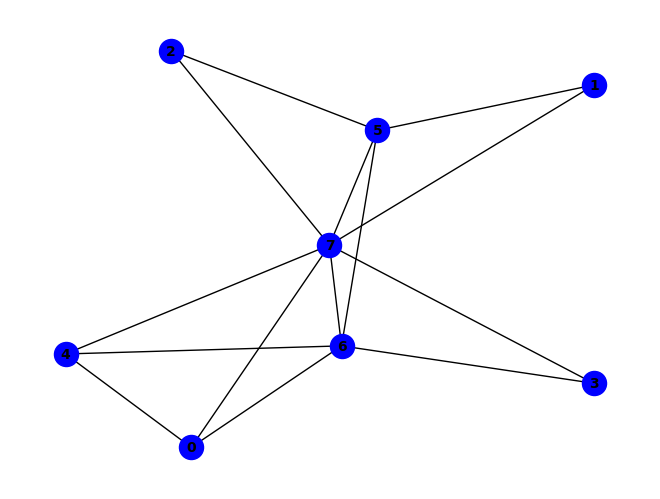


~g ^ (f & g) ^ (f & h) ^ (c & f & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (g & ~c & ~h) ^ (c & e & g & ~h) ^ (b & f & ~c & ~g) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (a & b & c & g & ~f) ^ (c & e & f & h & ~g) ^ (a & e & ~c & ~g & ~h) ^ (a & g & ~d & ~e & ~f) ^ (a & h & ~d & ~e & ~f) ^ (b & h & ~c & ~e & ~g) ^ (a & b & c & e & ~f & ~h) ^ (a & b & c & e & ~g & ~h) ^ (a & b & c & h & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & c & f & h & ~e & ~g) ^ (b & e & f & h & ~c & ~g) ^ (a & b & c & e & g & h & ~f) ^ (a & c & e & ~f & ~g & ~h) ^ (a & c & g & ~b & ~e & ~h) ^ (a & b & c & f & g & ~e & ~h) ^ (a & b & h & ~d & ~e & ~f & ~g) ^ (b & d & h & ~c & ~e & ~f & ~g) ^ (c & d & h & ~a & ~e & ~f & ~g) ^ (a & b & c & d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


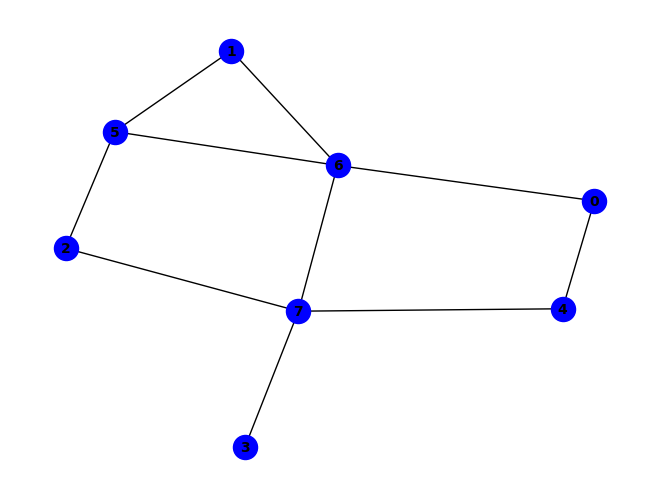


(g & ~h) ^ (f & h & ~g) ^ (b & ~f & ~h) ^ (f & ~c & ~h) ^ (c & f & g & ~h) ^ (~b & ~f & ~g) ^ (a & c & ~g & ~h) ^ (a & f & ~g & ~h) ^ (b & f & ~c & ~g) ^ (b & h & ~f & ~g) ^ (c & h & ~d & ~g) ^ (d & h & ~e & ~g) ^ (e & h & ~c & ~g) ^ (a & ~c & ~f & ~h) ^ (a & b & f & ~c & ~h) ^ (a & b & g & ~c & ~h) ^ (b & c & d & f & h & ~g) ^ (b & d & f & h & ~e & ~g) ^ (b & e & f & h & ~c & ~g) ^ (c & d & e & h & ~b & ~g) ^ (a & ~c & ~e & ~g & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & g & ~b & ~f & ~h) ^ (b & c & d & e & h & ~f & ~g) ^ (a & c & ~b & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


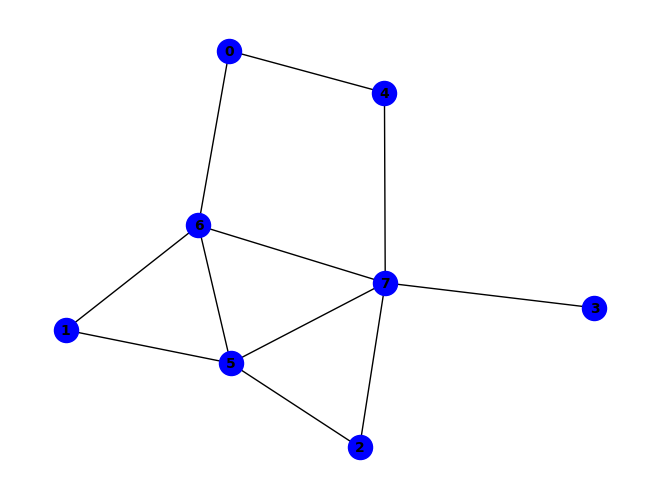


(~b & ~g) ^ (a & b & ~g) ^ (c & f & ~g) ^ (c & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (c & e & g & ~h) ^ (a & f & ~g & ~h) ^ (b & c & ~g & ~h) ^ (b & h & ~a & ~g) ^ (c & g & ~a & ~e) ^ (e & h & ~d & ~g) ^ (a & c & g & h & ~e) ^ (c & d & e & h & ~g) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & ~c & ~f & ~h) ^ (b & ~c & ~f & ~h) ^ (a & b & e & ~f & ~h) ^ (a & c & f & ~e & ~h) ^ (b & c & g & ~f & ~h) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (a & c & ~b & ~g & ~h) ^ (d & h & ~c & ~f & ~g) ^ (a & c & e & g & ~f & ~h) ^ (a & ~b & ~e & ~g & ~h) ^ (a & b & c & ~e & ~f & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & c & ~f & ~g & ~h) ^ (a & b & g & ~c & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


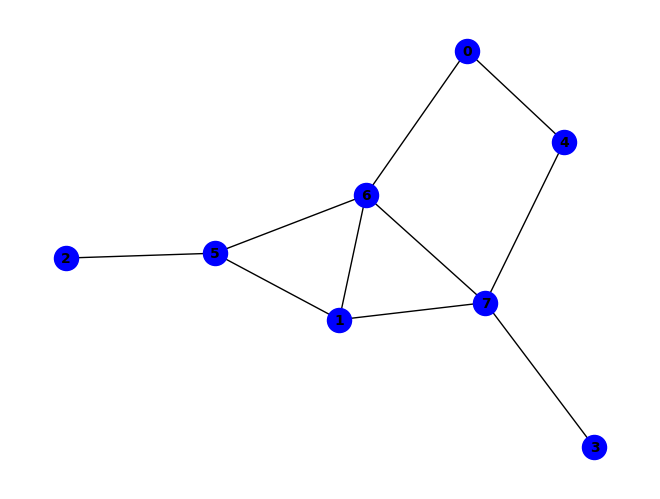


(g & ~h) ^ (~f & ~g) ^ (b & h & ~e) ^ (f & h & ~g) ^ (f & ~b & ~h) ^ (b & e & g & ~h) ^ (a & c & ~g & ~h) ^ (a & f & ~g & ~h) ^ (b & g & ~a & ~e) ^ (c & f & ~b & ~g) ^ (e & h & ~c & ~g) ^ (a & b & c & f & ~h) ^ (a & b & e & f & ~h) ^ (a & b & g & h & ~e) ^ (a & ~c & ~f & ~h) ^ (a & b & g & ~c & ~h) ^ (c & e & h & ~f & ~g) ^ (b & c & e & f & h & ~g) ^ (d & h & ~b & ~e & ~g) ^ (a & ~c & ~e & ~g & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & ~b & ~e & ~f & ~h) ^ (a & c & e & g & ~b & ~f & ~h) ^ (c & d & f & h & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


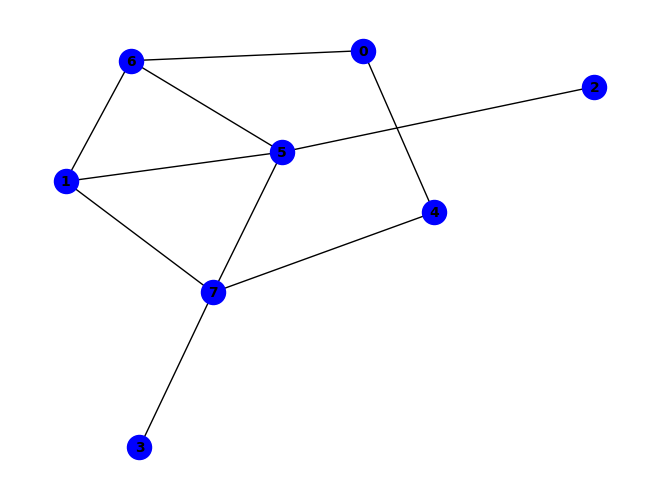


(~a & ~e) ^ (b & g & ~c) ^ (b & h & ~g) ^ (d & e & ~f) ^ (f & g & ~h) ^ (e & ~d & ~h) ^ (a & b & g & ~h) ^ (a & c & f & ~e) ^ (b & e & f & ~h) ^ (b & e & h & ~d) ^ (d & e & f & ~h) ^ (a & b & c & f & g) ^ (a & b & d & f & g) ^ (a & d & e & g & h) ^ (b & d & e & f & h) ^ (a & c & ~g & ~h) ^ (a & f & ~e & ~g) ^ (a & g & ~c & ~e) ^ (a & h & ~c & ~e) ^ (b & f & ~a & ~e) ^ (c & f & ~g & ~h) ^ (d & h & ~b & ~f) ^ (f & h & ~a & ~e) ^ (a & b & f & h & ~e) ^ (a & c & g & h & ~e) ^ (a & d & g & h & ~f) ^ (b & c & g & h & ~a) ^ (a & ~c & ~f & ~h) ^ (a & b & f & ~d & ~h) ^ (a & c & h & ~e & ~f) ^ (b & c & f & ~a & ~h) ^ (b & c & g & ~f & ~h) ^ (a & b & d & g & h & ~e) ^ (a & d & e & f & h & ~b) ^ (a & b & c & g & ~e & ~f) ^ (a & b & f & g & ~e & ~h) ^ (a & b & g & h & ~e & ~f) ^ (a & c & e & g & ~f & ~h) ^ (a & d & e & f & ~b & ~g) ^ (a & b & c & e & g & h & ~f) ^ (a & b & c & ~e & ~f & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & e & f & ~d & ~g & ~h) ^ (a & b & d & f & ~e & ~g & ~h)
PASS
PASS
PASS
P

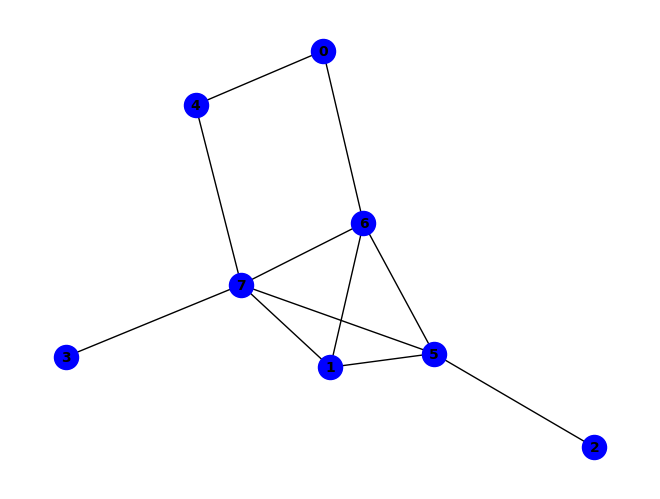


~g ^ (g & ~h) ^ (b & f & ~e) ^ (b & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (b & d & f & g) ^ (d & e & f & h) ^ (a & f & ~g & ~h) ^ (b & g & ~c & ~f) ^ (c & f & ~g & ~h) ^ (d & h & ~f & ~g) ^ (e & h & ~d & ~g) ^ (a & b & e & g & ~h) ^ (b & c & g & h & ~f) ^ (b & d & f & h & ~e) ^ (b & e & g & h & ~f) ^ (d & e & f & g & ~b) ^ (a & ~c & ~f & ~h) ^ (a & ~e & ~g & ~h) ^ (a & c & e & ~g & ~h) ^ (b & d & h & ~e & ~g) ^ (b & e & f & ~a & ~h) ^ (b & f & g & ~d & ~h) ^ (e & f & g & ~d & ~h) ^ (b & d & e & f & g & ~h) ^ (b & c & ~a & ~f & ~h) ^ (b & c & ~a & ~g & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & g & ~b & ~f & ~h) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & b & c & f & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


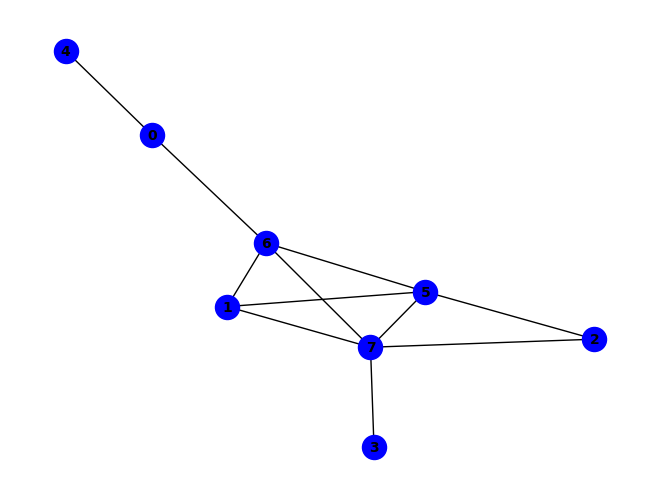


(~a & ~g) ^ (b & g & ~d) ^ (b & h & ~d) ^ (c & g & ~d) ^ (c & h & ~d) ^ (d & h & ~g) ^ (f & g & ~d) ^ (f & h & ~d) ^ (a & b & e & f) ^ (a & b & e & h) ^ (a & e & f & g) ^ (a & e & f & h) ^ (a & ~e & ~g) ^ (g & ~c & ~h) ^ (a & b & g & ~f) ^ (a & d & g & ~f) ^ (a & d & h & ~f) ^ (c & d & g & ~h) ^ (a & g & ~d & ~h) ^ (b & f & ~c & ~g) ^ (c & f & ~a & ~g) ^ (b & d & f & g & ~c) ^ (b & d & f & h & ~c) ^ (a & c & f & ~e & ~g) ^ (a & f & g & ~e & ~h) ^ (b & c & h & ~d & ~g) ^ (b & d & g & ~f & ~h) ^ (b & f & g & ~a & ~h) ^ (d & f & g & ~a & ~h) ^ (a & b & c & e & f & ~g) ^ (a & b & c & e & h & ~g) ^ (b & c & d & f & g & ~h) ^ (a & b & d & h & ~e & ~f) ^ (a & b & f & g & ~d & ~e) ^ (a & b & g & h & ~d & ~e) ^ (a & c & e & h & ~d & ~g) ^ (c & d & f & h & ~a & ~g) ^ (a & d & h & ~e & ~f & ~g) ^ (a & b & c & d & h & ~e & ~g) ^ (a & b & d & f & g & ~e & ~h) ^ (a & b & d & h & ~c & ~f & ~g) ^ (a & c & d & f & h & ~b & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


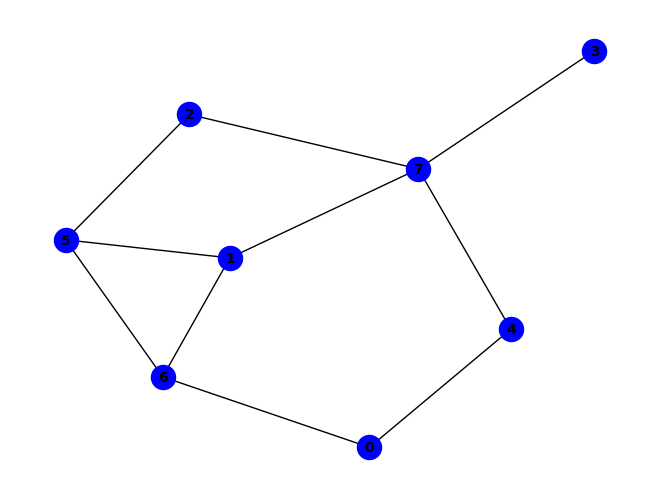


(~c & ~f) ^ (a & g & ~e) ^ (b & g & ~f) ^ (b & h & ~g) ^ (a & ~e & ~h) ^ (a & ~f & ~h) ^ (c & ~f & ~h) ^ (a & b & g & ~h) ^ (b & e & h & ~f) ^ (a & f & ~g & ~h) ^ (e & h & ~c & ~f) ^ (a & b & e & f & ~h) ^ (a & b & f & g & ~e) ^ (a & f & g & h & ~e) ^ (f & ~c & ~e & ~g) ^ (b & d & h & ~e & ~f) ^ (b & e & f & ~d & ~g) ^ (a & b & c & f & h & ~e) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (b & f & ~e & ~g & ~h) ^ (d & h & ~c & ~e & ~f) ^ (e & f & ~c & ~g & ~h) ^ (a & b & c & f & ~g & ~h) ^ (a & b & g & h & ~c & ~e) ^ (a & c & e & f & ~g & ~h) ^ (a & c & g & h & ~e & ~f) ^ (b & c & e & f & ~g & ~h) ^ (b & d & e & f & ~g & ~h) ^ (b & d & f & h & ~c & ~g) ^ (a & b & c & d & g & h & ~f) ^ (b & c & f & ~a & ~e & ~g) ^ (b & c & h & ~d & ~e & ~f) ^ (d & f & h & ~c & ~e & ~g) ^ (a & b & d & g & h & ~e & ~f) ^ (a & d & g & h & ~c & ~e & ~f) ^ (b & c & d & e & f & h & ~a & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

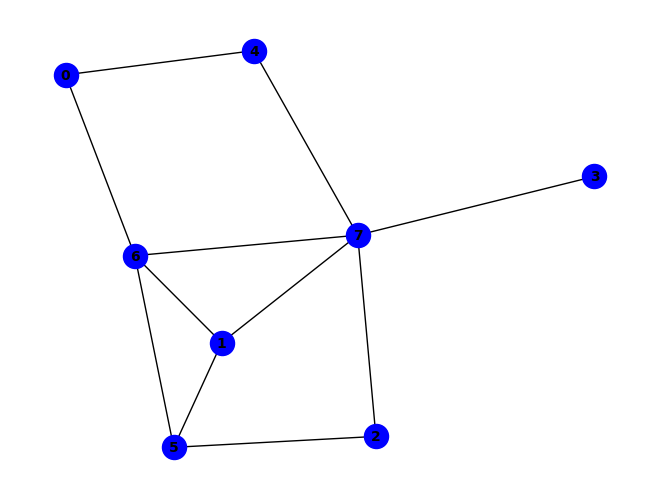


(g & ~h) ^ (~f & ~g) ^ (b & h & ~e) ^ (f & h & ~g) ^ (a & b & g & ~h) ^ (b & e & g & ~h) ^ (a & f & ~g & ~h) ^ (b & g & ~a & ~e) ^ (c & h & ~d & ~g) ^ (e & h & ~c & ~g) ^ (a & b & e & f & ~h) ^ (c & d & e & h & ~g) ^ (a & ~c & ~f & ~h) ^ (a & ~e & ~g & ~h) ^ (f & ~b & ~c & ~h) ^ (a & c & e & ~g & ~h) ^ (c & f & g & ~b & ~h) ^ (a & b & f & g & h & ~e) ^ (d & h & ~b & ~e & ~g) ^ (a & b & c & f & ~g & ~h) ^ (a & c & e & g & ~f & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & g & ~c & ~e & ~f) ^ (b & c & h & ~d & ~e & ~g) ^ (a & b & c & g & h & ~e & ~f) ^ (a & c & ~b & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


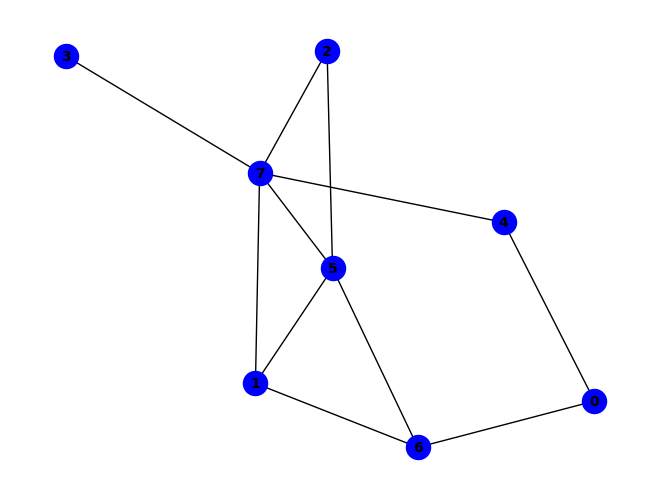


(b & g) ^ (~a & ~e) ^ (a & g & ~e) ^ (b & h & ~g) ^ (d & e & ~f) ^ (f & g & ~h) ^ (a & ~f & ~h) ^ (e & ~d & ~h) ^ (a & b & g & ~h) ^ (b & d & h & ~f) ^ (a & b & d & f & g) ^ (a & f & ~g & ~h) ^ (a & h & ~c & ~e) ^ (b & f & ~a & ~e) ^ (c & h & ~e & ~f) ^ (d & h & ~c & ~f) ^ (f & h & ~a & ~e) ^ (a & c & f & h & ~e) ^ (b & c & e & f & ~d) ^ (c & d & e & f & ~a) ^ (c & d & e & h & ~a) ^ (a & b & c & e & f & g) ^ (a & b & f & ~d & ~h) ^ (a & f & h & ~e & ~g) ^ (b & c & h & ~d & ~f) ^ (b & e & f & ~c & ~h) ^ (b & e & h & ~c & ~d) ^ (d & e & f & ~c & ~h) ^ (a & b & c & e & f & ~h) ^ (a & b & c & g & h & ~d) ^ (a & b & d & g & h & ~e) ^ (a & c & d & e & f & ~h) ^ (a & c & d & g & h & ~f) ^ (b & c & d & e & f & ~h) ^ (b & d & e & f & h & ~a) ^ (a & b & c & d & e & g & h) ^ (c & f & ~b & ~g & ~h) ^ (a & b & f & g & ~e & ~h) ^ (a & b & f & h & ~c & ~e) ^ (a & b & g & h & ~e & ~f) ^ (a & c & e & f & ~g & ~h) ^ (a & d & g & h & ~e & ~f) ^ (a & b & c & d & f & h & ~e) ^ (a & b & c & e & g & h & ~f)

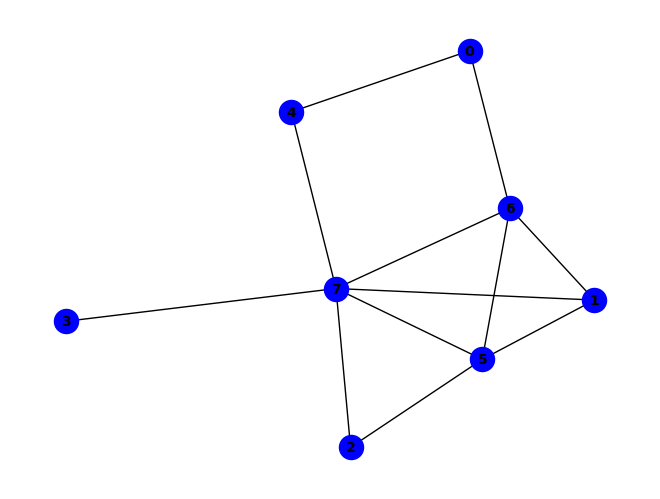


~g ^ (b & h & ~e) ^ (c & f & ~g) ^ (c & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (a & b & g & ~h) ^ (b & e & g & ~h) ^ (c & e & g & ~h) ^ (a & f & ~g & ~h) ^ (b & f & ~c & ~g) ^ (b & g & ~a & ~e) ^ (c & g & ~a & ~e) ^ (e & h & ~d & ~g) ^ (a & b & e & f & ~h) ^ (a & b & g & h & ~e) ^ (b & d & e & h & ~g) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & c & d & e & f & g) ^ (b & c & d & e & f & h) ^ (a & ~c & ~f & ~h) ^ (a & ~e & ~g & ~h) ^ (b & c & h & ~e & ~g) ^ (b & f & g & ~e & ~h) ^ (e & f & g & ~d & ~h) ^ (a & b & c & f & g & ~e) ^ (c & d & e & f & g & ~h) ^ (a & c & ~b & ~g & ~h) ^ (a & c & e & g & ~f & ~h) ^ (a & c & g & h & ~b & ~e) ^ (c & d & e & h & ~b & ~g) ^ (c & e & f & h & ~b & ~g) ^ (a & b & c & ~f & ~g & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & f & ~b & ~e & ~h) ^ (a & b & c & g & h & ~e & ~f) ^ (b & d & e & f & g & ~c & ~h) ^ (d & h & ~b & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

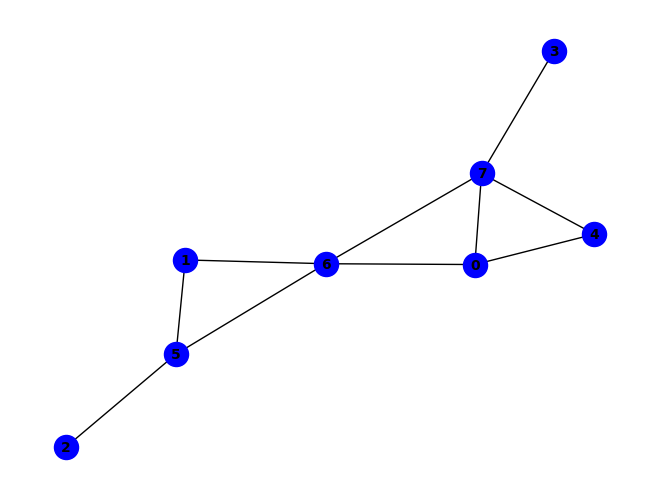


(g & ~h) ^ (a & e & ~d) ^ (a & g & ~e) ^ (a & h & ~d) ^ (b & f & ~g) ^ (f & h & ~g) ^ (a & d & g & h) ^ (f & ~a & ~h) ^ (~b & ~f & ~g) ^ (a & f & ~g & ~h) ^ (b & h & ~f & ~g) ^ (c & f & ~b & ~g) ^ (d & h & ~e & ~g) ^ (e & h & ~c & ~g) ^ (a & b & e & f & ~g) ^ (a & d & e & g & ~c) ^ (a & c & d & e & f & h) ^ (b & ~a & ~f & ~h) ^ (a & d & e & ~g & ~h) ^ (a & b & ~f & ~g & ~h) ^ (a & b & f & h & ~d & ~g) ^ (a & c & e & f & ~b & ~g) ^ (b & c & e & h & ~d & ~g) ^ (b & d & f & h & ~c & ~g) ^ (b & e & f & h & ~d & ~g) ^ (c & d & f & h & ~e & ~g) ^ (a & b & c & d & e & h & ~f) ^ (a & b & c & d & e & h & ~g) ^ (a & b & d & e & f & h & ~g) ^ (a & c & d & e & f & g & ~h) ^ (c & e & h & ~b & ~f & ~g) ^ (a & c & d & e & g & ~b & ~f) ^ (b & c & d & e & h & ~f & ~g) ^ (a & c & f & h & ~b & ~d & ~g) ^ (a & b & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

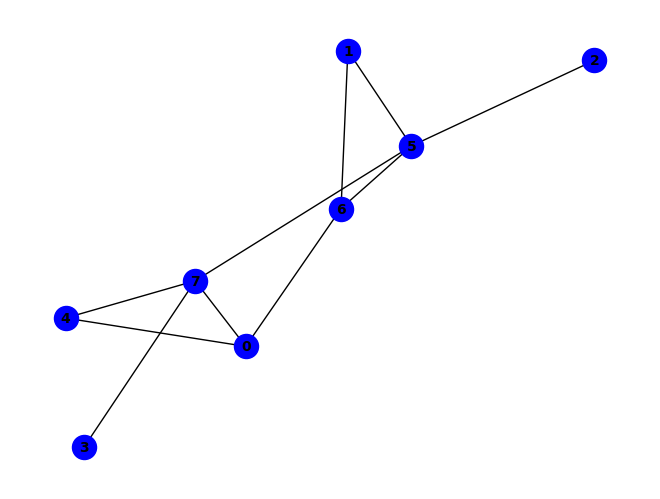


~e ^ (a & e & ~g) ^ (b & g & ~c) ^ (d & e & ~f) ^ (d & h & ~f) ^ (f & h & ~e) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & c & g & h) ^ (b & e & f & g) ^ (b & f & g & h) ^ (e & ~d & ~h) ^ (b & c & f & ~h) ^ (d & e & f & ~h) ^ (a & g & ~b & ~h) ^ (a & h & ~d & ~f) ^ (b & f & ~e & ~h) ^ (f & g & ~a & ~h) ^ (a & d & e & h & ~f) ^ (b & e & g & h & ~d) ^ (a & b & d & e & f & g) ^ (a & b & d & e & g & h) ^ (b & d & e & f & g & h) ^ (b & c & g & ~f & ~h) ^ (b & e & f & ~g & ~h) ^ (c & f & ~a & ~g & ~h) ^ (a & b & c & f & ~g & ~h) ^ (a & b & e & f & ~d & ~h) ^ (a & b & f & g & ~e & ~h) ^ (a & b & g & h & ~e & ~f) ^ (b & d & g & h & ~a & ~f) ^ (a & b & d & e & f & ~g & ~h) ^ (a & c & f & ~b & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


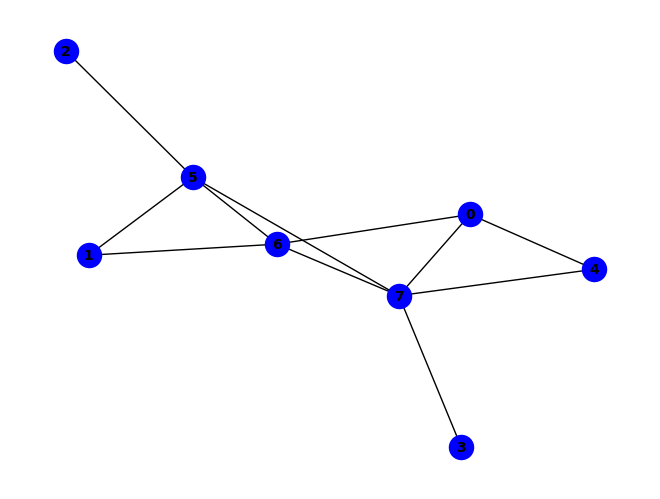


(g & ~h) ^ (~b & ~g) ^ (a & e & ~g) ^ (a & h & ~f) ^ (b & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & b & f & ~h) ^ (a & b & g & ~h) ^ (a & g & ~c & ~f) ^ (c & f & ~g & ~h) ^ (e & h & ~d & ~g) ^ (a & c & g & h & ~f) ^ (a & d & e & h & ~g) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~a) ^ (d & e & f & h & ~a) ^ (b & ~c & ~f & ~h) ^ (a & c & e & ~f & ~h) ^ (a & c & e & ~g & ~h) ^ (b & c & g & ~f & ~h) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (b & c & ~a & ~g & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & b & c & ~f & ~g & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (a & b & f & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


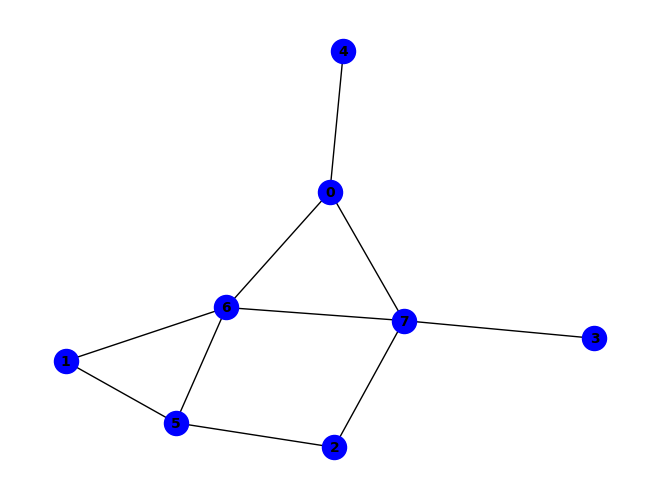


(g & ~h) ^ (~f & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (f & ~c & ~h) ^ (c & f & g & ~h) ^ (b & f & ~c & ~g) ^ (c & h & ~a & ~g) ^ (f & h & ~a & ~g) ^ (a & e & ~b & ~g & ~h) ^ (b & g & ~a & ~f & ~h) ^ (d & h & ~a & ~c & ~g) ^ (b & d & f & h & ~c & ~g) ^ (a & b & e & ~f & ~g & ~h) ^ (a & b & f & h & ~c & ~d & ~g) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


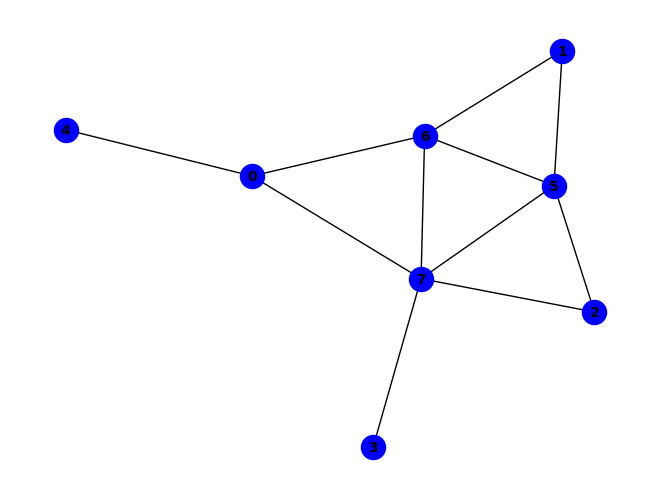


(c & g & ~d) ^ (c & h & ~d) ^ (g & ~c & ~h) ^ (a & e & g & ~h) ^ (c & d & g & ~h) ^ (~a & ~b & ~g) ^ (b & h & ~a & ~g) ^ (c & f & ~a & ~g) ^ (d & h & ~a & ~g) ^ (f & g & ~a & ~d) ^ (f & h & ~a & ~d) ^ (a & ~c & ~e & ~h) ^ (b & ~c & ~f & ~h) ^ (a & b & e & ~f & ~h) ^ (a & c & g & ~e & ~h) ^ (a & c & h & ~d & ~g) ^ (b & c & g & ~f & ~h) ^ (d & f & g & ~a & ~h) ^ (b & c & ~a & ~g & ~h) ^ (c & d & f & h & ~a & ~g) ^ (a & b & g & ~e & ~f & ~h) ^ (a & b & ~c & ~e & ~g & ~h) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


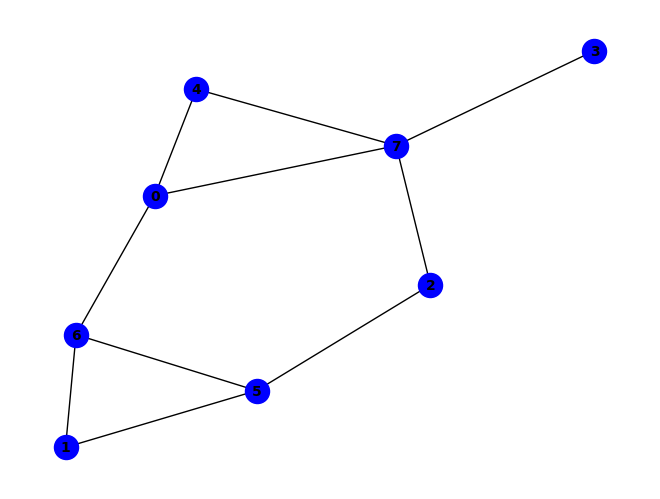


(b & g) ^ (~c & ~f) ^ (a & h & ~g) ^ (b & f & ~e) ^ (a & e & f & h) ^ (a & e & g & h) ^ (c & ~f & ~h) ^ (b & c & f & ~g) ^ (b & e & f & ~h) ^ (b & c & e & f & h) ^ (a & g & ~b & ~f) ^ (e & h & ~c & ~f) ^ (a & b & e & f & ~g) ^ (a & b & f & h & ~g) ^ (a & d & f & h & ~g) ^ (b & c & g & h & ~f) ^ (b & e & g & h & ~c) ^ (f & ~c & ~e & ~g) ^ (a & d & h & ~e & ~f) ^ (a & b & c & f & h & ~d) ^ (a & b & c & g & h & ~d) ^ (a & b & d & f & h & ~e) ^ (a & b & d & g & h & ~e) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (a & e & ~b & ~f & ~g) ^ (d & h & ~c & ~e & ~f) ^ (e & f & ~c & ~g & ~h) ^ (a & b & e & h & ~c & ~f) ^ (a & c & e & f & ~b & ~g) ^ (a & c & f & h & ~d & ~g) ^ (a & d & e & f & ~c & ~g) ^ (b & d & f & h & ~c & ~e) ^ (b & d & g & h & ~c & ~e) ^ (a & b & e & ~f & ~g & ~h) ^ (a & c & h & ~d & ~e & ~f) ^ (a & e & f & ~d & ~g & ~h) ^ (d & f & h & ~c & ~e & ~g) ^ (a & b & c & e & h & ~f & ~g) ^ (a & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

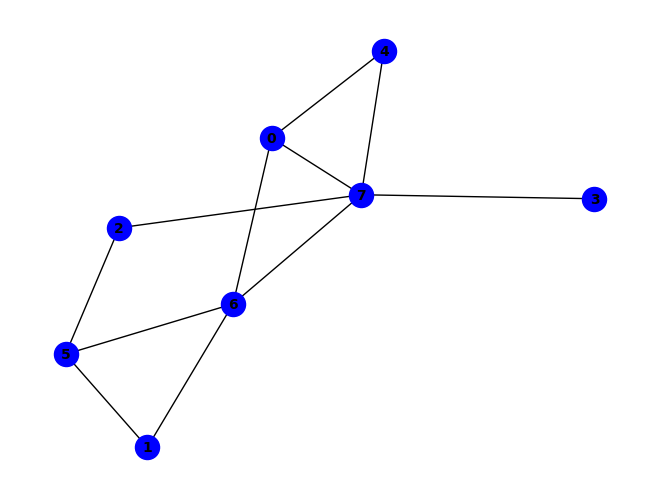


(g & ~h) ^ (a & g & ~d) ^ (a & h & ~d) ^ (f & h & ~g) ^ (f & ~c & ~h) ^ (a & f & g & ~h) ^ (c & f & g & ~h) ^ (~b & ~f & ~g) ^ (a & e & ~b & ~g) ^ (b & f & ~c & ~g) ^ (b & h & ~f & ~g) ^ (c & h & ~d & ~g) ^ (d & h & ~e & ~g) ^ (e & h & ~c & ~g) ^ (a & b & c & e & ~g) ^ (a & d & e & g & ~c) ^ (a & d & e & h & ~c) ^ (b & ~a & ~f & ~h) ^ (a & c & h & ~e & ~g) ^ (a & d & g & ~e & ~h) ^ (a & b & c & f & h & ~g) ^ (a & c & d & e & g & ~h) ^ (b & c & d & f & h & ~g) ^ (a & b & ~f & ~g & ~h) ^ (a & b & f & h & ~d & ~g) ^ (a & c & d & h & ~b & ~g) ^ (a & c & e & f & ~g & ~h) ^ (b & d & f & h & ~e & ~g) ^ (b & e & f & h & ~c & ~g) ^ (c & d & e & h & ~b & ~g) ^ (a & b & e & ~c & ~f & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (b & c & d & e & h & ~f & ~g) ^ (a & b & d & e & f & h & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


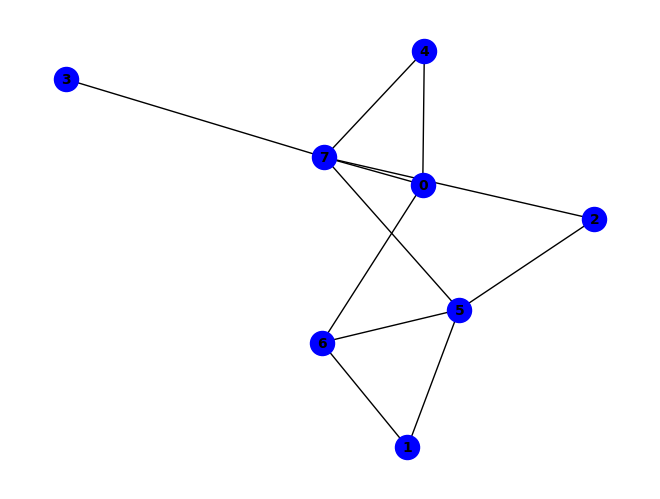


~e ^ (b & g) ^ (a & e & ~g) ^ (d & e & ~f) ^ (f & h & ~e) ^ (e & ~d & ~h) ^ (a & c & e & f & g) ^ (a & g & ~b & ~h) ^ (a & h & ~d & ~f) ^ (b & f & ~c & ~h) ^ (c & f & ~g & ~h) ^ (d & h & ~c & ~f) ^ (f & g & ~a & ~h) ^ (a & b & e & f & ~h) ^ (a & b & f & g & ~e) ^ (a & c & d & h & ~f) ^ (a & c & e & f & ~h) ^ (a & d & e & h & ~c) ^ (a & e & f & h & ~d) ^ (a & e & g & h & ~c) ^ (b & c & f & g & ~h) ^ (b & d & g & h & ~e) ^ (b & f & g & h & ~d) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (b & d & e & f & g & h) ^ (d & e & f & ~c & ~h) ^ (a & b & c & e & g & ~f) ^ (b & c & d & e & h & ~g) ^ (a & b & c & d & e & g & h) ^ (c & h & ~a & ~e & ~f) ^ (a & b & c & e & ~f & ~h) ^ (a & b & c & e & ~g & ~h) ^ (a & b & g & h & ~c & ~e) ^ (b & c & g & h & ~d & ~f) ^ (b & e & g & h & ~c & ~f) ^ (a & b & c & d & g & h & ~f) ^ (a & b & c & f & g & h & ~e) ^ (a & c & d & e & f & h & ~b) ^ (b & c & d & e & f & g & ~h) ^ (a & b & d & g & h & ~e & ~f) ^ (a & c & e & g & h & ~b & ~f) ^ (b & c & d & e & f

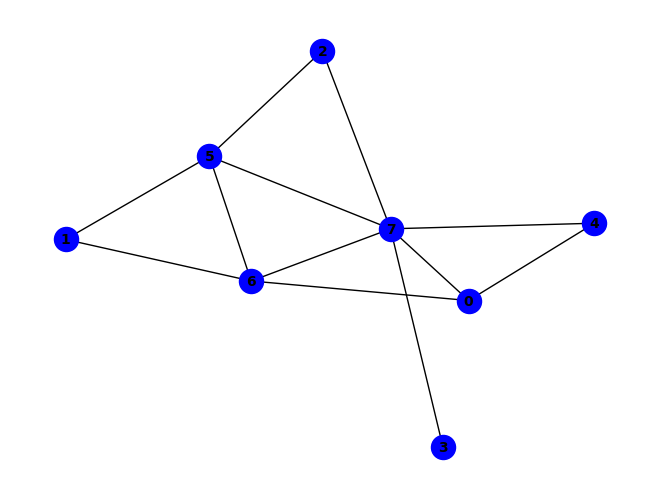


(~b & ~g) ^ (a & e & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (b & h & ~g) ^ (c & f & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (a & b & f & ~h) ^ (a & b & g & ~h) ^ (c & e & g & ~h) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (e & h & ~d & ~g) ^ (a & e & f & h & ~g) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & ~c & ~f & ~h) ^ (a & c & g & ~e & ~h) ^ (b & c & g & ~f & ~h) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (b & c & ~a & ~g & ~h) ^ (d & h & ~c & ~f & ~g) ^ (a & c & d & h & ~f & ~g) ^ (a & c & e & f & ~g & ~h) ^ (a & c & f & h & ~e & ~g) ^ (c & d & e & h & ~a & ~g) ^ (a & c & d & e & f & h & ~g) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & d & h & ~e & ~f & ~g) ^ (a & b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


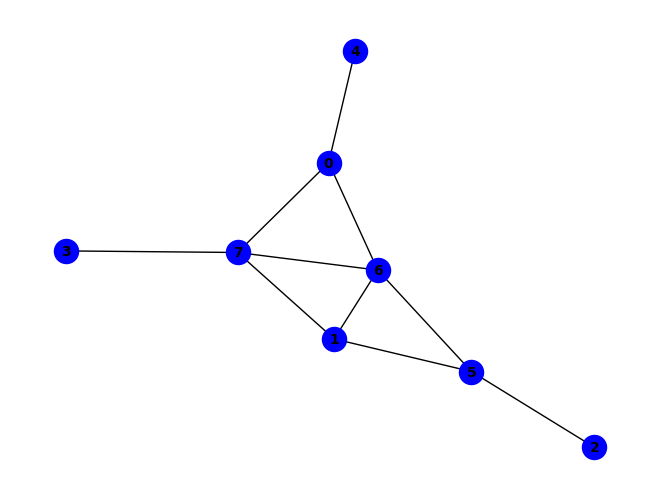


(g & ~h) ^ (~f & ~g) ^ (a & g & ~e) ^ (a & h & ~d) ^ (b & g & ~d) ^ (b & h & ~d) ^ (f & h & ~g) ^ (a & e & g & h) ^ (f & ~b & ~h) ^ (a & f & g & ~h) ^ (b & d & g & ~h) ^ (a & e & ~c & ~h) ^ (c & f & ~b & ~g) ^ (d & h & ~c & ~g) ^ (a & b & c & h & ~g) ^ (a & b & d & h & ~c) ^ (a & b & f & h & ~g) ^ (a & c & e & g & ~h) ^ (a & d & g & h & ~b) ^ (a & b & e & ~f & ~g) ^ (a & b & g & ~c & ~f) ^ (a & b & h & ~e & ~f) ^ (c & d & h & ~f & ~g) ^ (a & b & e & g & h & ~f) ^ (b & c & d & f & h & ~g) ^ (a & b & c & d & f & g & h) ^ (a & b & c & g & ~f & ~h) ^ (a & b & c & h & ~d & ~f) ^ (a & c & f & h & ~d & ~g) ^ (a & b & e & ~c & ~g & ~h) ^ (a & c & e & ~b & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


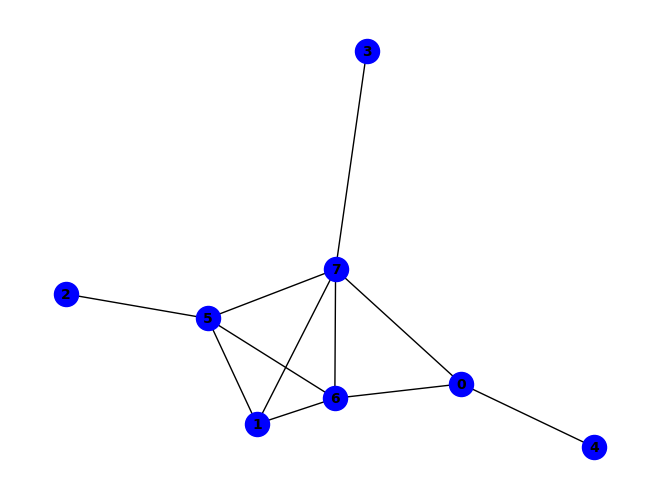


(~a & ~g) ^ (b & g & ~d) ^ (b & h & ~d) ^ (a & b & e & g) ^ (a & b & e & h) ^ (g & ~a & ~h) ^ (a & b & f & ~e) ^ (b & d & g & ~h) ^ (b & f & ~a & ~g) ^ (d & h & ~a & ~g) ^ (f & g & ~a & ~d) ^ (f & h & ~a & ~d) ^ (a & b & g & h & ~e) ^ (b & d & f & h & ~g) ^ (b & f & g & ~a & ~h) ^ (d & f & g & ~a & ~h) ^ (a & b & d & h & ~f & ~g) ^ (a & ~c & ~e & ~g & ~h) ^ (a & b & c & ~e & ~f & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & g & ~c & ~e & ~f) ^ (a & b & h & ~e & ~f & ~g) ^ (a & b & c & g & h & ~e & ~f) ^ (a & c & ~e & ~f & ~g & ~h) ^ (c & f & ~a & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


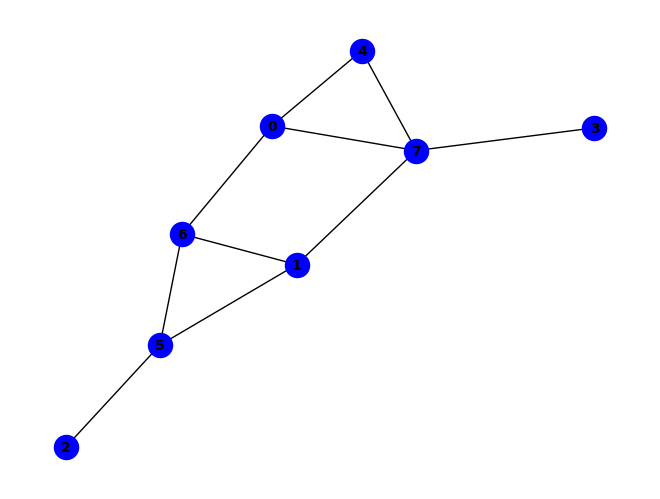


(~c & ~f) ^ (a & g & ~h) ^ (b & h & ~e) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & e & f & g) ^ (b & f & g & h) ^ (c & ~b & ~g) ^ (f & ~e & ~g) ^ (a & f & g & ~b) ^ (a & e & ~f & ~g) ^ (a & h & ~b & ~d) ^ (b & c & ~f & ~g) ^ (b & f & ~e & ~h) ^ (b & g & ~a & ~h) ^ (c & g & ~e & ~f) ^ (e & h & ~c & ~f) ^ (a & e & f & ~g & ~h) ^ (c & e & h & ~d & ~g) ^ (a & d & e & f & h & ~g) ^ (a & d & f & g & h & ~b) ^ (b & c & d & e & h & ~g) ^ (b & c & e & f & h & ~g) ^ (d & h & ~b & ~e & ~f) ^ (e & f & ~b & ~g & ~h) ^ (a & b & e & f & ~d & ~g) ^ (a & b & e & h & ~d & ~f) ^ (a & c & e & f & ~b & ~g) ^ (a & d & e & h & ~c & ~f) ^ (c & d & e & g & ~b & ~f) ^ (c & d & e & h & ~b & ~f) ^ (c & d & f & h & ~b & ~g) ^ (a & c & d & e & g & h & ~f) ^ (c & e & g & ~d & ~f & ~h) ^ (d & f & h & ~b & ~e & ~g) ^ (a & b & d & e & f & ~g & ~h) ^ (a & c & d & e & h & ~b & ~g) ^ (b & c & d & e & g & ~f & ~h) ^ (a & c & f & h & ~b & ~d & ~g) ^ (a & b & c & d & e & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


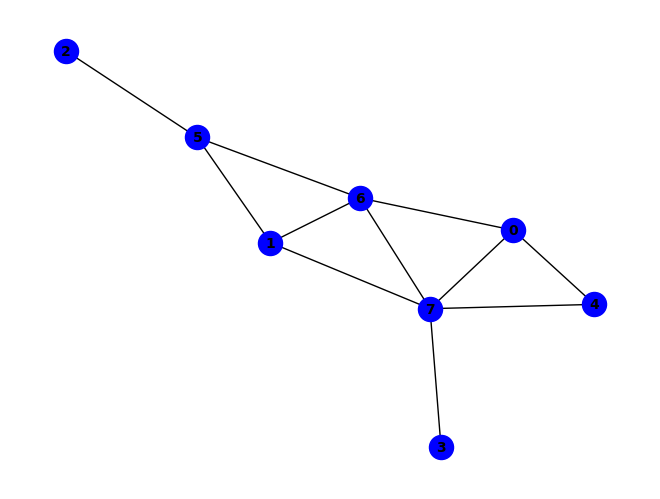


(g & ~h) ^ (~f & ~g) ^ (a & e & ~d) ^ (a & g & ~e) ^ (a & h & ~d) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (f & ~b & ~h) ^ (a & f & g & ~h) ^ (b & e & g & ~h) ^ (c & f & ~b & ~g) ^ (e & h & ~c & ~g) ^ (a & b & e & h & ~g) ^ (a & b & f & h & ~g) ^ (a & c & d & e & ~g) ^ (a & d & g & h & ~e) ^ (a & b & g & ~c & ~f) ^ (a & b & h & ~c & ~f) ^ (a & d & e & ~c & ~h) ^ (c & e & h & ~f & ~g) ^ (b & c & e & f & h & ~g) ^ (a & b & c & d & e & f & g) ^ (a & b & c & d & e & f & h) ^ (d & h & ~b & ~e & ~g) ^ (a & b & c & g & ~f & ~h) ^ (a & b & c & h & ~d & ~g) ^ (a & b & d & h & ~e & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & f & ~b & ~g) ^ (a & c & f & h & ~d & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (a & c & d & e & g & ~b & ~h) ^ (a & c & d & e & h & ~f & ~g) ^ (c & d & f & h & ~b & ~e & ~g) ^ (a & b & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

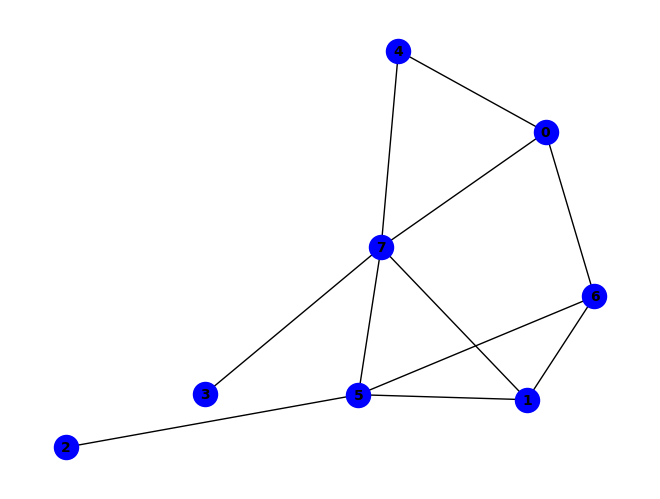


~e ^ (a & e & ~g) ^ (a & g & ~h) ^ (b & f & ~e) ^ (b & g & ~c) ^ (d & e & ~f) ^ (f & h & ~e) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & c & g & h) ^ (e & ~d & ~h) ^ (b & c & f & ~h) ^ (b & e & f & ~h) ^ (d & e & f & ~h) ^ (a & h & ~d & ~f) ^ (b & h & ~a & ~g) ^ (d & h & ~b & ~f) ^ (f & g & ~a & ~h) ^ (a & b & d & h & ~f) ^ (a & b & e & f & ~g) ^ (a & b & f & h & ~g) ^ (a & d & e & h & ~f) ^ (a & b & e & f & g & h) ^ (a & b & g & ~c & ~f) ^ (b & c & g & ~f & ~h) ^ (b & e & h & ~a & ~d) ^ (a & b & c & g & h & ~f) ^ (b & d & e & f & h & ~a) ^ (c & f & ~a & ~g & ~h) ^ (a & b & c & e & ~f & ~h) ^ (a & b & c & e & ~g & ~h) ^ (a & c & f & ~e & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


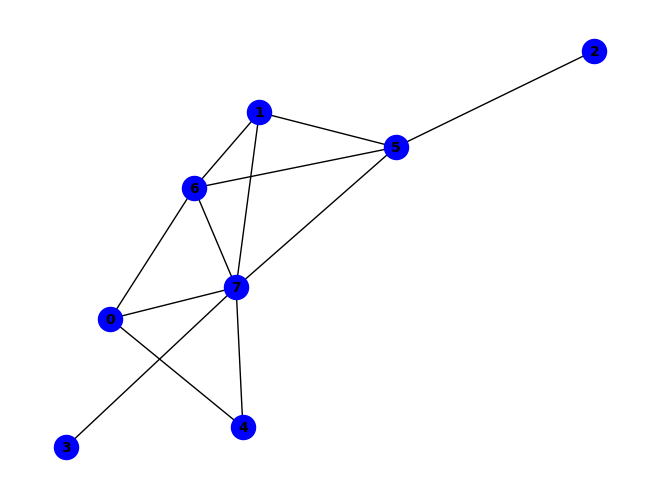


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~e) ^ (b & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (b & e & f & ~h) ^ (a & h & ~b & ~f) ^ (b & g & ~c & ~f) ^ (c & f & ~g & ~h) ^ (e & h & ~d & ~g) ^ (a & b & e & f & ~g) ^ (a & b & e & h & ~g) ^ (a & d & e & h & ~g) ^ (a & e & f & h & ~g) ^ (b & d & f & g & ~a) ^ (b & e & g & h & ~f) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~a) ^ (a & b & d & e & f & g) ^ (a & d & e & f & g & h) ^ (a & c & e & ~f & ~h) ^ (a & c & e & ~g & ~h) ^ (b & f & g & ~d & ~h) ^ (e & f & g & ~d & ~h) ^ (a & c & e & g & h & ~f) ^ (b & d & e & f & g & ~h) ^ (a & g & ~b & ~c & ~f) ^ (b & c & ~a & ~f & ~h) ^ (b & c & ~a & ~g & ~h) ^ (d & h & ~a & ~f & ~g) ^ (b & c & g & h & ~a & ~f) ^ (b & d & f & h & ~a & ~e) ^ (a & b & c & ~e & ~f & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & c & g & ~b & ~e & ~f) ^ (b & d & h & ~a & ~e & ~g) ^ (a & b & c & g & h & ~e & ~f) ^ (a & b & d & f & g & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

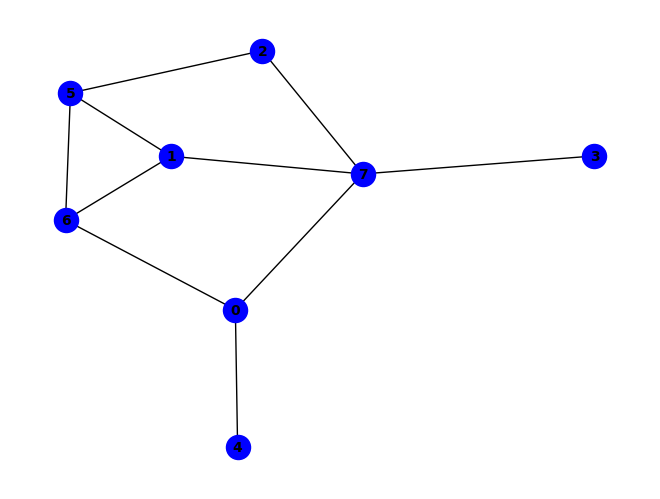


~f ^ (a & f & g) ^ (a & e & ~g) ^ (a & g & ~h) ^ (a & e & g & h) ^ (a & b & ~e & ~g) ^ (a & h & ~b & ~e) ^ (b & g & ~a & ~f) ^ (b & h & ~a & ~g) ^ (d & h & ~b & ~f) ^ (a & b & c & h & ~f) ^ (a & b & g & h & ~e) ^ (b & d & f & h & ~g) ^ (f & ~c & ~d & ~g) ^ (a & c & e & ~f & ~g) ^ (a & c & h & ~e & ~f) ^ (b & c & f & ~d & ~g) ^ (a & c & e & g & h & ~f) ^ (b & f & ~a & ~g & ~h) ^ (c & h & ~b & ~d & ~f) ^ (d & f & ~c & ~g & ~h) ^ (a & d & f & h & ~b & ~g) ^ (b & c & d & f & ~g & ~h) ^ (a & c & e & ~b & ~g & ~h) ^ (a & d & h & ~b & ~c & ~f) ^ (a & b & ~e & ~f & ~g & ~h) ^ (a & b & c & e & ~f & ~g & ~h) ^ (a & c & f & h & ~b & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


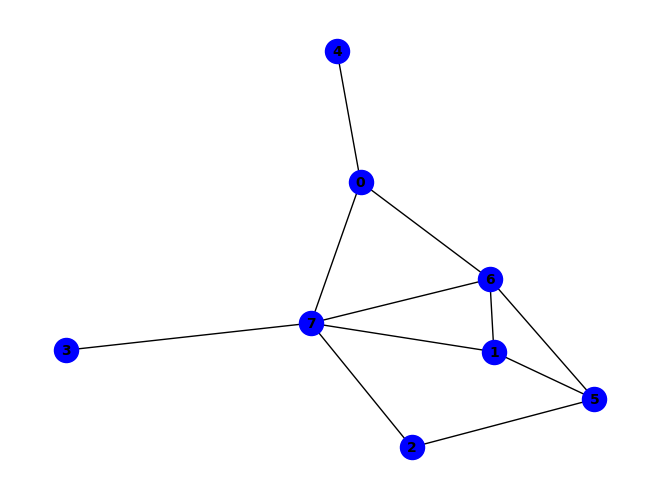


(g & ~h) ^ (~f & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (b & g & ~d) ^ (a & d & h & ~g) ^ (b & d & g & ~h) ^ (a & b & c & d & h) ^ (a & b & e & g & h) ^ (a & e & ~g & ~h) ^ (b & h & ~a & ~d) ^ (c & h & ~b & ~g) ^ (d & h & ~c & ~g) ^ (f & h & ~a & ~g) ^ (a & b & c & h & ~g) ^ (a & b & e & f & ~h) ^ (a & b & f & g & ~h) ^ (b & c & d & h & ~g) ^ (f & ~b & ~c & ~h) ^ (a & b & g & ~c & ~e) ^ (a & c & h & ~d & ~g) ^ (c & f & g & ~b & ~h) ^ (a & b & d & g & h & ~c) ^ (a & b & c & f & ~e & ~h) ^ (a & b & c & f & ~g & ~h) ^ (a & b & c & g & ~e & ~f) ^ (a & b & e & g & ~f & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & b & c & f & g & h & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


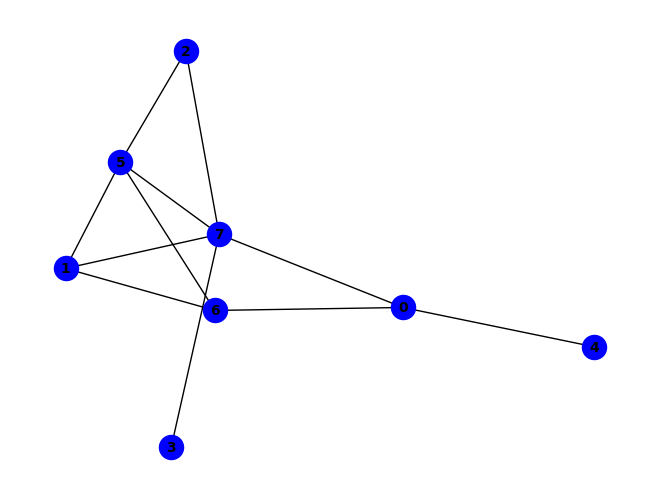


~d ^ (d & ~h) ^ (a & g & ~f) ^ (b & f & ~d) ^ (b & g & ~a) ^ (f & g & ~h) ^ (f & h & ~d) ^ (a & b & f & h) ^ (a & c & e & h) ^ (a & c & f & ~g) ^ (b & d & f & ~h) ^ (b & d & h & ~c) ^ (a & c & f & g & h) ^ (b & c & d & f & h) ^ (a & c & ~e & ~g) ^ (a & h & ~f & ~g) ^ (b & h & ~a & ~g) ^ (c & h & ~d & ~f) ^ (a & b & f & g & ~h) ^ (a & c & g & h & ~e) ^ (b & c & h & ~a & ~f) ^ (a & e & ~b & ~g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (a & b & e & ~f & ~g & ~h) ^ (a & d & h & ~b & ~c & ~f) ^ (a & b & c & e & f & ~g & ~h) ^ (a & c & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


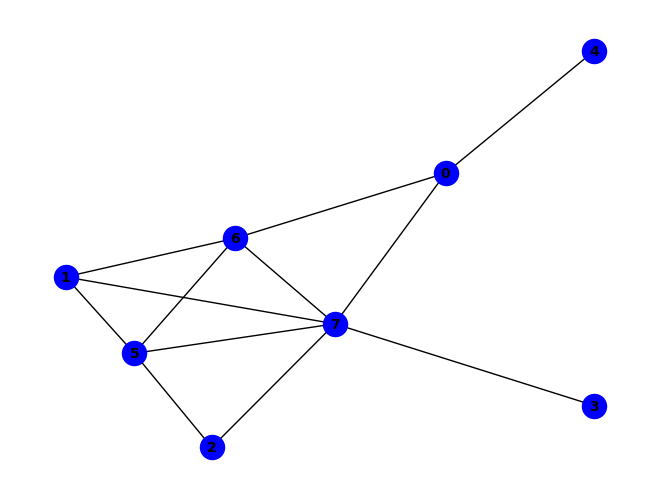


(~a & ~g) ^ (b & g & ~d) ^ (c & g & ~d) ^ (c & h & ~d) ^ (a & b & e & g) ^ (g & ~c & ~h) ^ (a & e & g & ~h) ^ (c & d & g & ~h) ^ (a & b & d & g & h) ^ (b & h & ~a & ~d) ^ (c & f & ~a & ~g) ^ (d & h & ~a & ~g) ^ (f & g & ~a & ~d) ^ (f & h & ~a & ~d) ^ (a & b & g & h & ~e) ^ (b & d & f & g & ~c) ^ (b & d & f & h & ~c) ^ (a & ~c & ~e & ~h) ^ (a & b & f & ~e & ~h) ^ (a & c & g & ~e & ~h) ^ (a & c & h & ~d & ~g) ^ (b & d & g & ~f & ~h) ^ (b & f & g & ~a & ~h) ^ (d & f & g & ~a & ~h) ^ (b & c & d & f & g & ~h) ^ (b & f & ~a & ~c & ~g) ^ (c & d & f & h & ~a & ~g) ^ (a & b & g & ~e & ~f & ~h) ^ (b & c & h & ~a & ~d & ~g) ^ (a & b & d & f & h & ~c & ~g) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & b & c & f & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


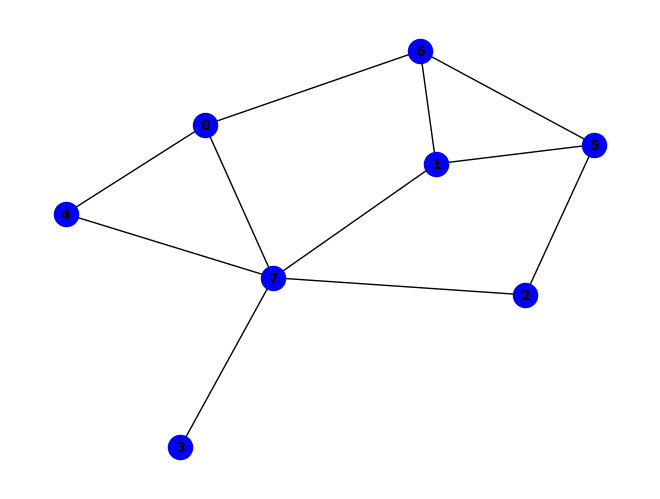


(~c & ~f) ^ (b & g & ~f) ^ (b & h & ~g) ^ (a & e & g & h) ^ (c & ~f & ~h) ^ (a & f & g & ~b) ^ (a & e & ~f & ~g) ^ (a & g & ~b & ~h) ^ (a & h & ~b & ~d) ^ (e & h & ~c & ~f) ^ (a & d & e & f & ~g) ^ (a & d & e & h & ~c) ^ (a & e & f & h & ~d) ^ (a & c & d & e & f & h) ^ (f & ~c & ~e & ~g) ^ (b & c & f & ~e & ~g) ^ (b & d & h & ~e & ~f) ^ (b & e & h & ~a & ~f) ^ (a & d & f & g & h & ~b) ^ (b & f & ~e & ~g & ~h) ^ (d & h & ~c & ~e & ~f) ^ (e & f & ~c & ~g & ~h) ^ (a & c & d & h & ~b & ~f) ^ (b & c & e & f & ~g & ~h) ^ (b & d & f & h & ~c & ~g) ^ (b & c & d & e & f & h & ~g) ^ (a & c & h & ~b & ~e & ~f) ^ (a & e & f & ~d & ~g & ~h) ^ (b & c & h & ~d & ~e & ~f) ^ (b & e & f & ~a & ~d & ~g) ^ (d & f & h & ~c & ~e & ~g) ^ (a & b & d & e & h & ~c & ~f) ^ (a & c & e & f & ~b & ~d & ~g) ^ (a & c & f & h & ~b & ~d & ~g) ^ (b & d & e & f & ~a & ~g & ~h) ^ (a & c & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

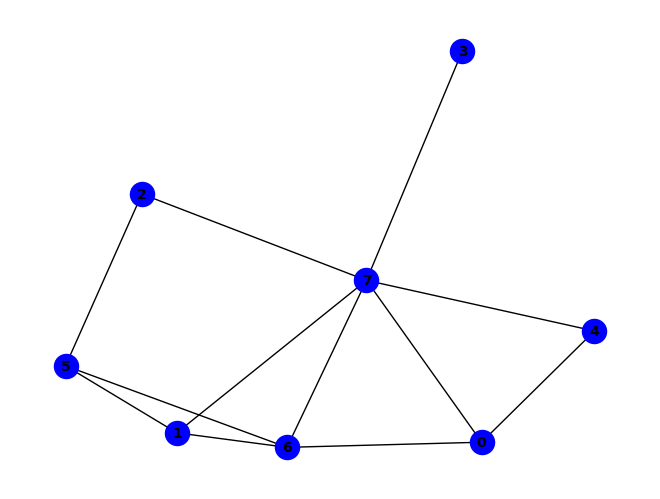


(g & ~h) ^ (~f & ~g) ^ (a & e & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (b & e & g & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (c & h & ~d & ~g) ^ (e & h & ~c & ~g) ^ (f & h & ~a & ~g) ^ (a & b & e & h & ~g) ^ (a & b & f & h & ~g) ^ (c & d & e & h & ~g) ^ (f & ~b & ~c & ~h) ^ (c & f & g & ~b & ~h) ^ (d & h & ~b & ~e & ~g) ^ (a & c & e & f & ~g & ~h) ^ (a & c & h & ~b & ~e & ~g) ^ (b & c & h & ~d & ~e & ~g) ^ (a & b & e & f & ~c & ~g & ~h) ^ (a & d & h & ~b & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


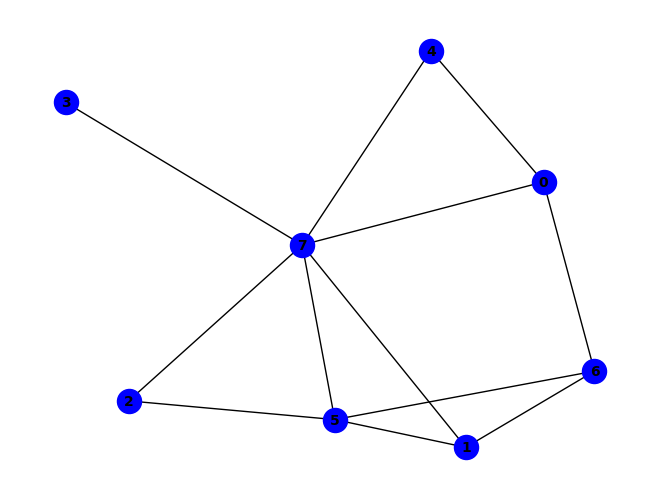


~e ^ (a & e & ~g) ^ (a & g & ~h) ^ (b & f & ~e) ^ (b & g & ~a) ^ (d & e & ~f) ^ (f & h & ~e) ^ (a & e & g & h) ^ (e & ~d & ~h) ^ (b & d & h & ~f) ^ (a & h & ~d & ~f) ^ (b & h & ~a & ~g) ^ (d & h & ~c & ~f) ^ (f & g & ~a & ~h) ^ (a & b & c & h & ~f) ^ (a & b & d & h & ~c) ^ (a & b & e & h & ~f) ^ (a & b & f & g & ~h) ^ (a & b & f & h & ~d) ^ (a & c & d & h & ~f) ^ (a & d & e & h & ~b) ^ (a & e & f & h & ~d) ^ (b & c & e & f & ~d) ^ (c & d & e & f & ~a) ^ (c & d & e & h & ~a) ^ (a & b & c & d & f & h) ^ (b & c & h & ~d & ~f) ^ (b & e & f & ~c & ~h) ^ (b & e & h & ~c & ~d) ^ (d & e & f & ~c & ~h) ^ (a & c & d & e & f & ~h) ^ (b & c & d & e & f & ~h) ^ (b & d & e & f & h & ~a) ^ (c & f & ~b & ~g & ~h) ^ (c & h & ~a & ~e & ~f) ^ (a & b & c & e & ~f & ~g) ^ (a & b & c & e & ~g & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & b & c & d & e & h & ~f) ^ (a & b & c & e & g & h & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

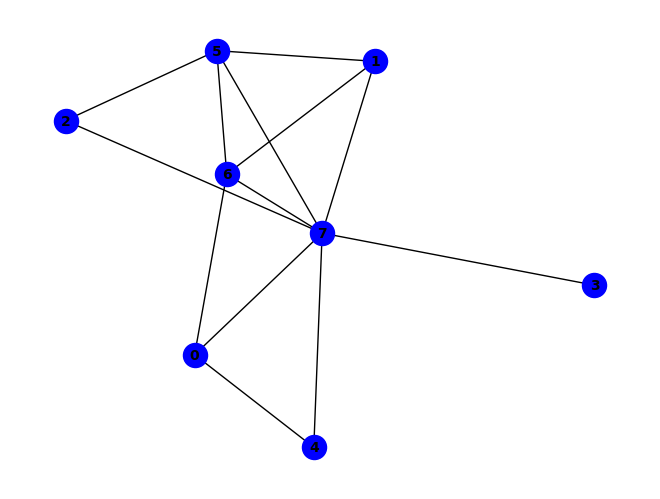


~g ^ (a & e & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & f & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (b & f & ~c & ~g) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (e & h & ~d & ~g) ^ (a & b & e & f & ~g) ^ (a & b & e & g & ~d) ^ (a & b & e & h & ~d) ^ (a & c & e & f & ~h) ^ (a & e & f & h & ~g) ^ (b & d & e & h & ~g) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & c & d & e & f & g) ^ (b & c & d & e & f & h) ^ (a & c & g & ~f & ~h) ^ (b & e & g & ~a & ~h) ^ (b & f & g & ~e & ~h) ^ (c & e & g & ~a & ~h) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (a & c & f & g & ~b & ~e) ^ (a & c & f & h & ~b & ~e) ^ (c & d & e & h & ~b & ~g) ^ (c & e & f & h & ~b & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & d & e & f & g & ~c) ^ (a & b & d & e & f & h & ~c) ^ (b & c & h & ~a & ~e & ~g) ^ (a & b & c & e & f & ~g & ~h) ^ (a & b & c & f & g & ~e & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (b & d & 

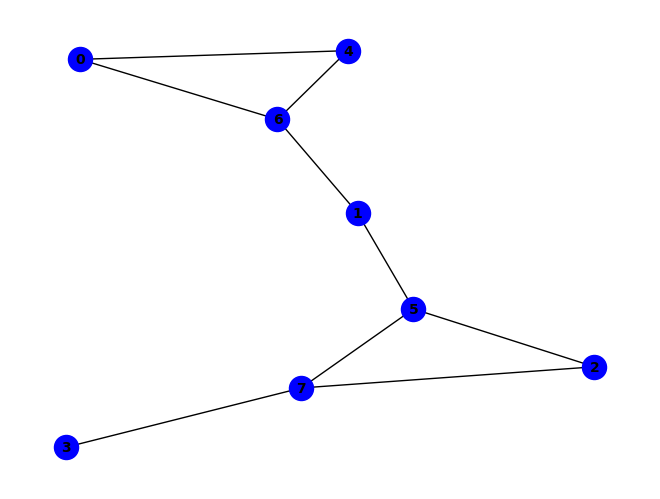


(~b & ~f) ^ (a & g & ~b) ^ (c & f & ~e) ^ (c & h & ~e) ^ (e & g & ~b) ^ (f & ~b & ~h) ^ (b & c & f & ~h) ^ (b & c & h & ~f) ^ (b & c & e & f & g) ^ (b & e & f & g & h) ^ (a & e & ~b & ~f) ^ (d & h & ~c & ~f) ^ (a & c & e & f & ~d) ^ (a & c & e & h & ~d) ^ (a & c & f & g & ~b) ^ (a & d & e & h & ~f) ^ (a & d & g & h & ~b) ^ (b & c & e & h & ~d) ^ (d & e & g & h & ~c) ^ (e & f & g & h & ~d) ^ (b & ~c & ~f & ~g) ^ (a & e & f & ~b & ~h) ^ (c & e & f & ~d & ~g) ^ (c & e & h & ~b & ~g) ^ (a & b & c & e & f & ~h) ^ (a & b & c & e & h & ~f) ^ (b & c & d & g & h & ~f) ^ (c & d & e & f & h & ~b) ^ (a & b & c & d & e & f & g) ^ (a & b & c & d & e & g & h) ^ (b & c & ~f & ~g & ~h) ^ (a & c & g & h & ~b & ~d) ^ (a & f & g & h & ~b & ~d) ^ (b & d & g & h & ~e & ~f) ^ (c & d & e & f & ~g & ~h) ^ (a & b & d & e & g & h & ~f) ^ (a & c & d & f & g & h & ~b) ^ (a & b & e & ~c & ~f & ~g) ^ (a & c & d & e & f & ~b & ~h) ^ (b & c & d & e & h & ~f & ~g) ^ (a & b & c & e & ~f & ~g & ~h) ^ (a & b & c & d & e 

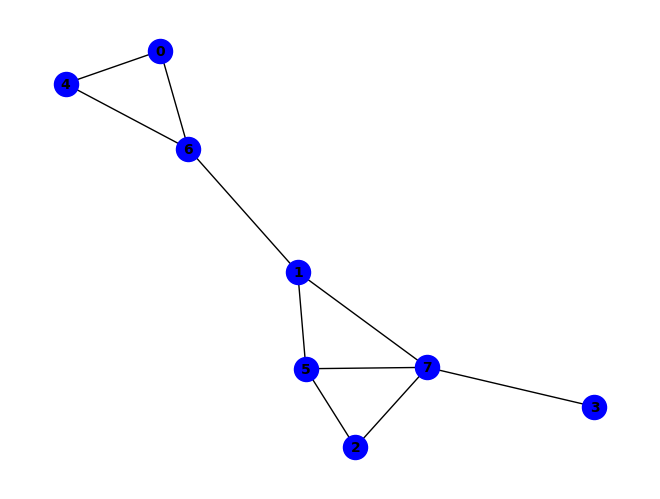


~f ^ (f & ~h) ^ (a & e & ~f) ^ (a & g & ~b) ^ (b & g & ~h) ^ (b & h & ~d) ^ (e & g & ~b) ^ (a & f & g & h) ^ (b & f & g & h) ^ (a & e & f & ~h) ^ (a & b & d & g & h) ^ (c & f & ~b & ~e) ^ (c & h & ~b & ~e) ^ (d & h & ~c & ~f) ^ (a & b & e & f & ~g) ^ (a & b & e & g & ~h) ^ (a & b & f & h & ~e) ^ (a & c & e & h & ~d) ^ (a & c & f & g & ~b) ^ (a & d & e & h & ~f) ^ (a & d & g & h & ~f) ^ (b & c & d & h & ~f) ^ (b & d & e & f & ~g) ^ (b & d & f & h & ~a) ^ (b & e & f & h & ~d) ^ (e & f & g & h & ~d) ^ (a & b & c & d & f & h) ^ (a & b & d & e & f & h) ^ (a & c & d & f & g & h) ^ (c & e & h & ~b & ~g) ^ (c & d & e & f & h & ~b) ^ (b & f & ~a & ~e & ~g) ^ (a & b & e & h & ~c & ~d) ^ (a & c & e & f & ~b & ~d) ^ (a & c & g & h & ~b & ~d) ^ (d & e & g & h & ~b & ~c) ^ (a & b & f & ~e & ~g & ~h) ^ (b & e & f & ~d & ~g & ~h) ^ (c & e & f & ~b & ~d & ~g) ^ (a & b & d & f & h & ~c & ~g) ^ (a & c & d & e & f & ~b & ~h) ^ (c & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

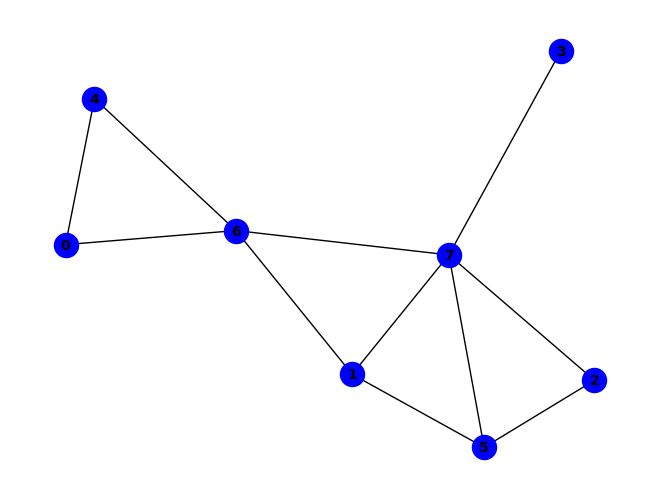


(g & ~h) ^ (~e & ~g) ^ (a & e & ~g) ^ (b & g & ~d) ^ (b & h & ~d) ^ (e & h & ~g) ^ (e & ~c & ~h) ^ (b & d & g & ~h) ^ (b & f & ~a & ~g) ^ (c & e & ~g & ~h) ^ (f & h & ~a & ~g) ^ (a & b & f & ~e & ~g) ^ (a & b & g & ~d & ~e) ^ (a & b & h & ~d & ~e) ^ (a & c & f & ~b & ~g) ^ (a & c & h & ~d & ~g) ^ (a & f & g & ~d & ~e) ^ (a & f & h & ~d & ~e) ^ (b & e & g & ~c & ~h) ^ (c & d & f & ~b & ~g) ^ (c & d & h & ~b & ~g) ^ (c & e & ~b & ~f & ~g) ^ (c & e & ~b & ~f & ~h) ^ (c & f & ~b & ~d & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & b & c & f & ~e & ~h) ^ (a & c & d & f & ~e & ~g) ^ (b & d & f & h & ~a & ~g) ^ (c & d & f & g & ~b & ~h) ^ (a & b & h & ~c & ~d & ~g) ^ (a & c & f & ~d & ~e & ~h) ^ (a & c & g & ~b & ~e & ~f) ^ (a & c & h & ~b & ~e & ~f) ^ (a & d & h & ~c & ~e & ~g) ^ (a & b & c & d & g & ~e & ~f) ^ (a & b & c & d & h & ~e & ~f) ^ (a & b & d & f & h & ~e & ~g) ^ (a & c & d & f & h & ~b & ~g) ^ (a & g & ~c & ~e & ~f & ~h) ^ (c & h & ~b & ~e & ~f & ~g) ^ (a & b & c & g & ~e & ~f & ~h) ^ (a 

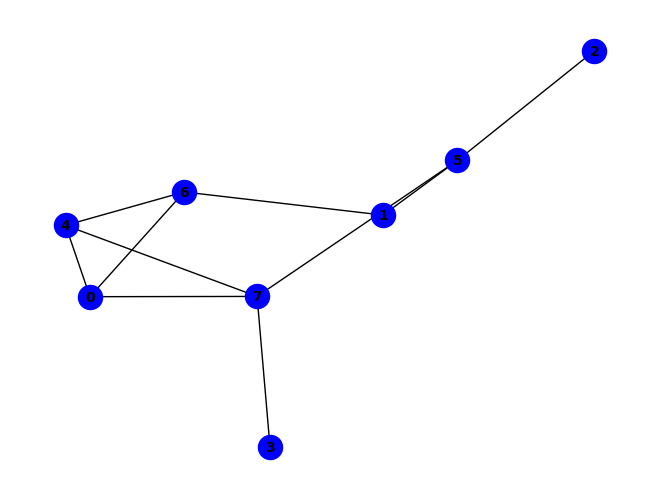


(b & e & g) ^ (~c & ~f) ^ (a & g & ~b) ^ (a & h & ~g) ^ (b & g & ~f) ^ (c & h & ~f) ^ (e & g & ~h) ^ (e & h & ~f) ^ (c & ~e & ~h) ^ (f & ~b & ~h) ^ (a & f & h & ~b) ^ (b & c & f & ~h) ^ (a & b & d & g & h) ^ (a & e & ~c & ~f) ^ (a & b & e & g & ~f) ^ (a & c & e & h & ~f) ^ (b & c & e & g & ~h) ^ (b & d & g & h & ~f) ^ (a & c & e & ~b & ~h) ^ (a & e & f & ~b & ~h) ^ (c & e & f & ~g & ~h) ^ (a & b & d & f & h & ~e) ^ (b & d & e & g & h & ~a) ^ (b & e & f & g & h & ~d) ^ (c & e & ~b & ~f & ~h) ^ (d & h & ~a & ~e & ~f) ^ (a & b & c & e & ~f & ~h) ^ (a & b & f & h & ~d & ~g) ^ (a & c & f & g & ~b & ~h) ^ (a & b & d & e & f & h & ~g) ^ (b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


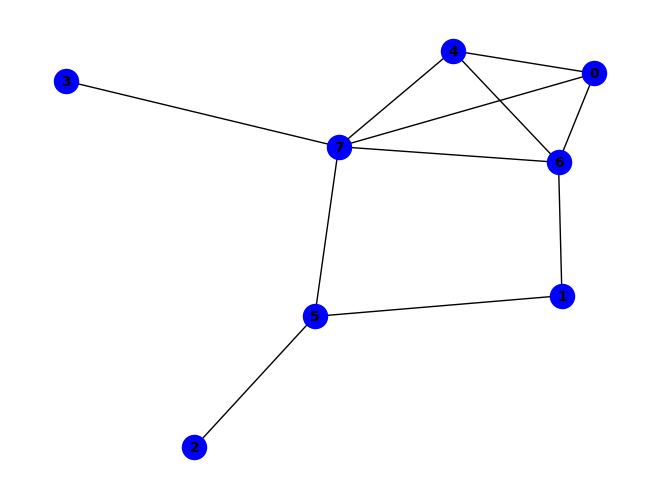


(g & ~h) ^ (~b & ~g) ^ (a & e & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (c & f & ~h) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (b & f & g & ~h) ^ (b & c & ~a & ~h) ^ (b & e & ~c & ~g) ^ (b & e & ~c & ~h) ^ (b & h & ~e & ~g) ^ (a & e & f & h & ~g) ^ (c & e & f & g & ~h) ^ (d & e & f & g & ~a) ^ (d & e & f & h & ~a) ^ (b & ~c & ~f & ~h) ^ (a & b & c & ~g & ~h) ^ (a & b & g & ~d & ~h) ^ (a & f & g & ~c & ~h) ^ (b & c & e & ~f & ~g) ^ (b & c & e & ~f & ~h) ^ (d & e & h & ~a & ~g) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (b & c & e & f & h & ~g) ^ (d & h & ~a & ~f & ~g) ^ (a & b & c & g & ~f & ~h) ^ (a & b & d & g & ~e & ~h) ^ (a & b & e & f & ~d & ~h) ^ (a & c & e & f & ~b & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (a & b & e & g & ~d & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


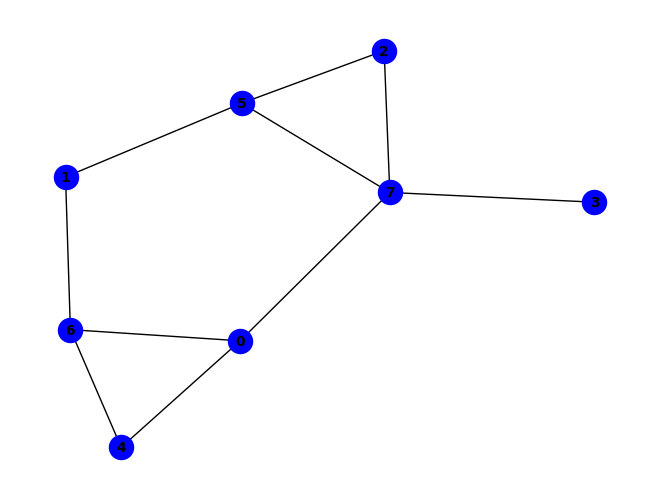


(a & b & g) ^ (~b & ~f) ^ (a & g & ~e) ^ (a & h & ~g) ^ (c & f & ~e) ^ (c & h & ~e) ^ (e & g & ~b) ^ (f & ~b & ~h) ^ (a & f & h & ~e) ^ (b & c & f & ~h) ^ (b & c & h & ~f) ^ (a & b & c & f & g) ^ (a & b & f & g & h) ^ (b & c & e & f & g) ^ (b & e & f & g & h) ^ (a & e & ~g & ~h) ^ (a & b & e & g & ~f) ^ (a & c & f & g & ~h) ^ (a & e & f & h & ~g) ^ (b & c & e & h & ~d) ^ (d & e & g & h & ~c) ^ (e & f & g & h & ~d) ^ (a & b & d & e & f & g) ^ (a & b & d & e & g & h) ^ (a & c & d & e & f & g) ^ (b & ~c & ~f & ~g) ^ (a & c & h & ~e & ~f) ^ (c & e & f & ~d & ~g) ^ (c & e & h & ~b & ~g) ^ (a & b & c & e & f & ~h) ^ (a & b & c & g & h & ~d) ^ (a & b & d & g & h & ~f) ^ (a & d & e & g & h & ~f) ^ (b & c & d & g & h & ~f) ^ (c & d & e & f & h & ~b) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & f & g & h) ^ (b & c & ~f & ~g & ~h) ^ (d & h & ~a & ~c & ~f) ^ (a & b & e & f & ~d & ~h) ^ (a & c & e & f & ~d & ~h) ^ (a & c & e & h & ~f & ~g) ^ (b & d & g & h & ~e & ~f) ^ (a & b & c & d & e & f &

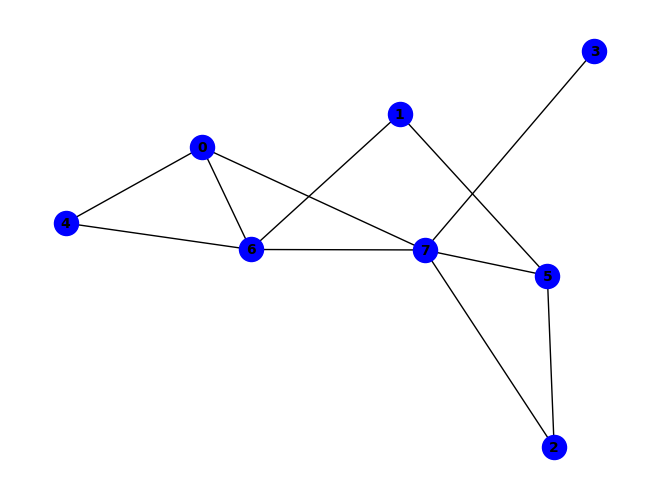


(~e & ~g) ^ (e & h & ~g) ^ (f & h & ~g) ^ (g & ~b & ~h) ^ (b & c & f & ~h) ^ (c & d & f & ~g) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & f & ~g & ~h) ^ (c & e & ~g & ~h) ^ (c & f & ~d & ~h) ^ (c & d & f & g & ~h) ^ (e & ~a & ~c & ~h) ^ (a & b & g & ~c & ~h) ^ (a & c & e & ~f & ~h) ^ (a & f & g & ~c & ~h) ^ (b & e & g & ~c & ~h) ^ (c & d & h & ~a & ~g) ^ (a & c & d & f & h & ~g) ^ (c & e & ~b & ~f & ~g) ^ (c & e & ~b & ~f & ~h) ^ (c & h & ~e & ~f & ~g) ^ (d & h & ~a & ~f & ~g) ^ (a & b & e & f & ~c & ~h) ^ (a & b & e & g & ~f & ~h) ^ (b & c & e & h & ~f & ~g) ^ (a & c & g & ~b & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


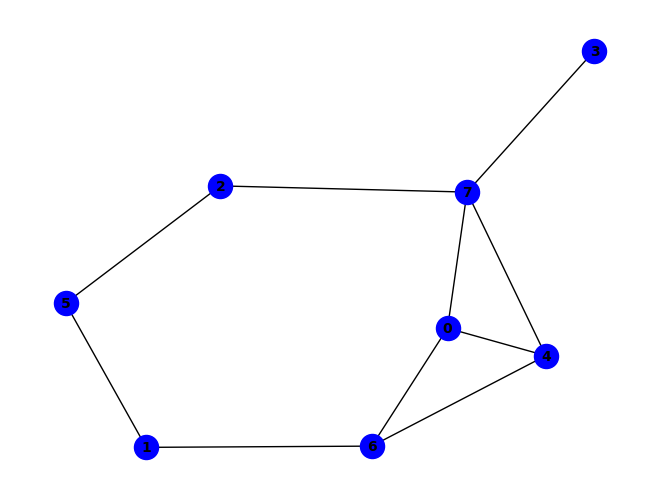


~d ^ (d & ~h) ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & f & ~g) ^ (b & g & ~e) ^ (c & f & ~h) ^ (e & h & ~d) ^ (a & b & e & g) ^ (a & d & e & ~h) ^ (b & c & f & ~e) ^ (a & g & ~c & ~h) ^ (c & h & ~d & ~e) ^ (e & g & ~c & ~h) ^ (a & b & c & g & ~h) ^ (a & b & e & f & ~g) ^ (a & b & f & g & ~d) ^ (a & c & d & h & ~b) ^ (a & c & e & f & ~h) ^ (a & c & e & h & ~d) ^ (a & c & f & h & ~b) ^ (b & d & f & h & ~e) ^ (b & e & f & h & ~g) ^ (a & b & c & d & f & h) ^ (a & b & g & ~f & ~h) ^ (a & b & h & ~d & ~f) ^ (a & b & h & ~d & ~g) ^ (a & c & g & ~b & ~f) ^ (a & c & h & ~f & ~g) ^ (c & e & g & ~f & ~h) ^ (a & b & c & d & h & ~g) ^ (a & b & c & e & f & ~d) ^ (b & c & d & g & h & ~e) ^ (b & c & e & f & ~g & ~h) ^ (b & c & g & h & ~e & ~f) ^ (b & d & g & h & ~e & ~f) ^ (a & b & c & d & f & g & ~e) ^ (a & b & c & e & g & h & ~f) ^ (a & b & d & e & f & h & ~g) ^ (a & b & d & e & g & h & ~c) ^ (a & b & d & f & g & ~c & ~h) ^ (b & c & d & f & h & ~e & ~g) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PAS

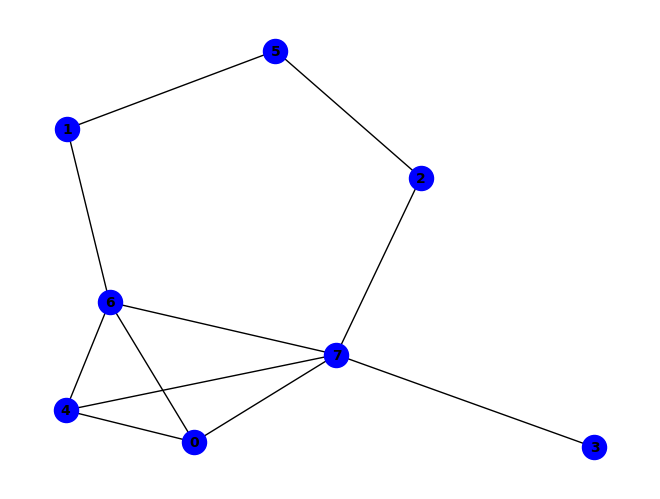


(~c & ~g) ^ (a & g & ~d) ^ (a & c & e & f) ^ (a & c & g & ~e) ^ (a & d & g & ~h) ^ (a & e & ~b & ~g) ^ (a & h & ~c & ~d) ^ (b & f & ~c & ~g) ^ (d & h & ~c & ~g) ^ (e & g & ~c & ~d) ^ (e & h & ~c & ~d) ^ (a & b & f & g & ~c) ^ (a & b & f & h & ~c) ^ (a & c & e & h & ~f) ^ (a & d & e & h & ~g) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (a & b & d & e & f & g) ^ (a & b & d & e & f & h) ^ (c & ~e & ~f & ~h) ^ (g & ~b & ~c & ~h) ^ (a & b & e & ~f & ~g) ^ (a & b & g & ~f & ~h) ^ (a & c & g & ~f & ~h) ^ (a & e & g & ~c & ~h) ^ (b & c & g & ~f & ~h) ^ (b & e & g & ~f & ~h) ^ (d & e & g & ~c & ~h) ^ (a & b & c & e & f & ~g) ^ (a & c & d & e & h & ~b) ^ (a & c & d & g & h & ~e) ^ (c & e & ~f & ~g & ~h) ^ (a & b & e & g & ~d & ~h) ^ (a & b & c & d & e & h & ~f) ^ (a & b & c & e & f & g & ~h) ^ (a & b & c & d & e & f & g & h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & b & d & f & h & ~c & ~g) ^ (b & d & f & h & ~c & ~e & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

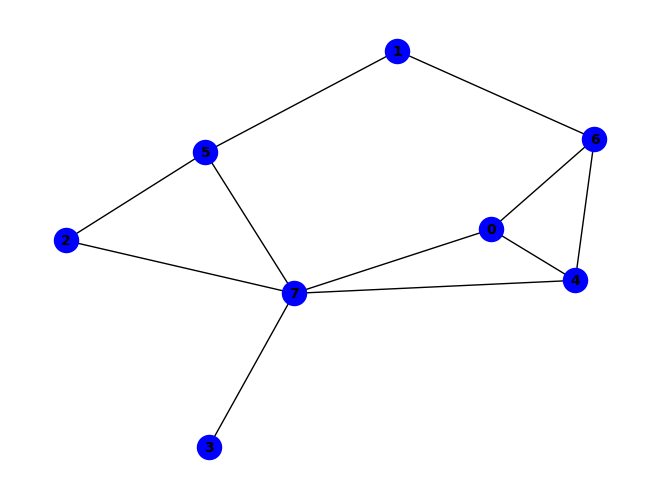


(b & e & g) ^ (~b & ~f) ^ (a & g & ~b) ^ (a & h & ~g) ^ (c & h & ~d) ^ (e & g & ~h) ^ (c & e & f & h) ^ (f & ~b & ~h) ^ (a & c & h & ~e) ^ (a & f & h & ~b) ^ (b & c & h & ~e) ^ (b & c & d & g & h) ^ (a & e & ~b & ~f) ^ (c & f & ~b & ~e) ^ (e & h & ~c & ~f) ^ (a & b & f & h & ~g) ^ (a & c & d & h & ~f) ^ (a & c & e & f & ~d) ^ (a & c & f & g & ~b) ^ (a & c & f & h & ~g) ^ (b & c & e & h & ~g) ^ (c & d & e & h & ~f) ^ (c & d & f & h & ~b) ^ (b & c & d & e & f & h) ^ (b & ~c & ~f & ~g) ^ (a & e & f & ~b & ~h) ^ (c & e & f & ~g & ~h) ^ (a & b & c & e & h & ~f) ^ (a & b & c & g & h & ~d) ^ (a & c & d & e & f & ~h) ^ (a & c & d & e & h & ~b) ^ (b & c & d & f & h & ~g) ^ (b & d & e & g & h & ~c) ^ (b & e & f & g & h & ~d) ^ (a & b & c & d & e & f & g) ^ (a & b & c & d & f & g & h) ^ (b & c & ~f & ~g & ~h) ^ (d & h & ~a & ~e & ~f) ^ (b & c & e & f & ~d & ~g) ^ (b & d & g & h & ~a & ~f) ^ (a & b & c & d & e & h & ~g) ^ (a & b & d & e & g & h & ~f) ^ (a & b & e & ~c & ~f & ~g) ^ (a & b & c & e 

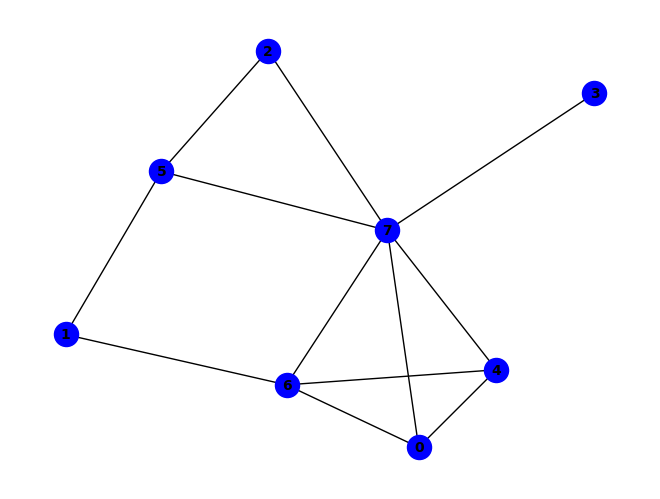


(g & ~h) ^ (~b & ~g) ^ (a & e & ~g) ^ (b & h & ~g) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (a & f & g & ~h) ^ (b & e & g & ~h) ^ (b & f & g & ~h) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & c & ~e & ~h) ^ (c & f & ~e & ~h) ^ (c & h & ~f & ~g) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & ~c & ~f & ~h) ^ (a & b & g & ~d & ~h) ^ (a & c & g & ~b & ~h) ^ (b & c & e & ~g & ~h) ^ (c & e & f & ~g & ~h) ^ (d & e & h & ~c & ~g) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (d & h & ~c & ~f & ~g) ^ (a & b & c & g & ~f & ~h) ^ (a & b & d & g & ~e & ~h) ^ (a & b & e & f & ~d & ~h) ^ (a & c & e & f & ~b & ~h) ^ (a & c & e & h & ~f & ~g) ^ (c & e & g & ~b & ~f & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (a & b & e & g & ~d & ~f & ~h) ^ (a & d & h & ~c & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

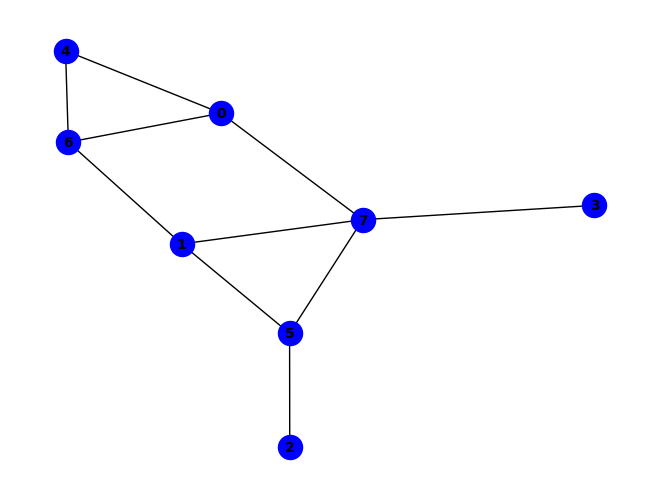


(f & ~h) ^ (~c & ~f) ^ (a & g & ~e) ^ (b & g & ~a) ^ (e & g & ~b) ^ (b & f & g & h) ^ (c & ~e & ~h) ^ (a & c & f & ~g) ^ (c & e & g & ~f) ^ (a & e & ~g & ~h) ^ (a & h & ~c & ~g) ^ (b & f & ~e & ~g) ^ (b & h & ~a & ~g) ^ (c & h & ~e & ~f) ^ (a & b & e & f & ~d) ^ (a & b & e & g & ~f) ^ (a & e & f & h & ~g) ^ (b & e & f & h & ~d) ^ (d & e & g & h & ~b) ^ (e & f & g & h & ~d) ^ (a & b & d & e & g & h) ^ (a & c & f & ~e & ~h) ^ (a & c & h & ~f & ~g) ^ (a & f & h & ~b & ~e) ^ (b & c & f & ~e & ~h) ^ (b & e & f & ~g & ~h) ^ (c & e & h & ~f & ~g) ^ (a & b & c & e & f & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & d & e & f & ~g) ^ (a & d & e & g & h & ~f) ^ (b & d & e & f & h & ~g) ^ (c & e & ~b & ~g & ~h) ^ (d & h & ~a & ~b & ~f) ^ (a & b & d & e & f & g & ~h) ^ (b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

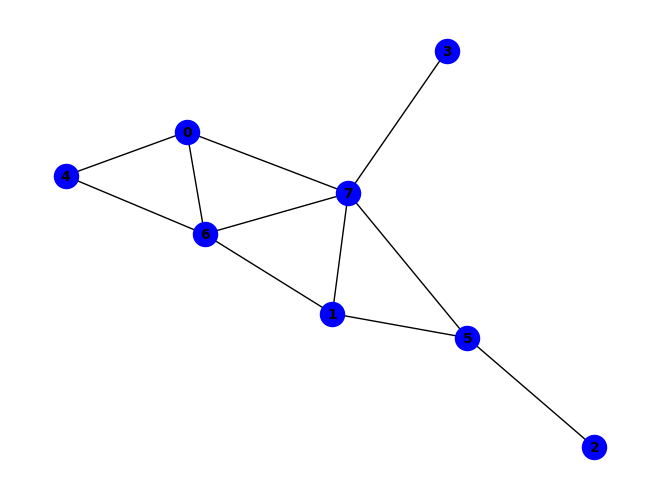


(g & ~h) ^ (~e & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (c & e & ~g & ~h) ^ (c & f & ~b & ~h) ^ (e & h & ~b & ~g) ^ (a & b & c & e & ~h) ^ (a & b & e & f & ~h) ^ (b & c & e & g & ~h) ^ (e & ~a & ~c & ~h) ^ (a & b & e & g & ~f & ~h) ^ (a & c & e & ~b & ~f & ~h) ^ (a & f & g & ~b & ~c & ~h) ^ (c & e & g & ~b & ~f & ~h) ^ (d & h & ~a & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


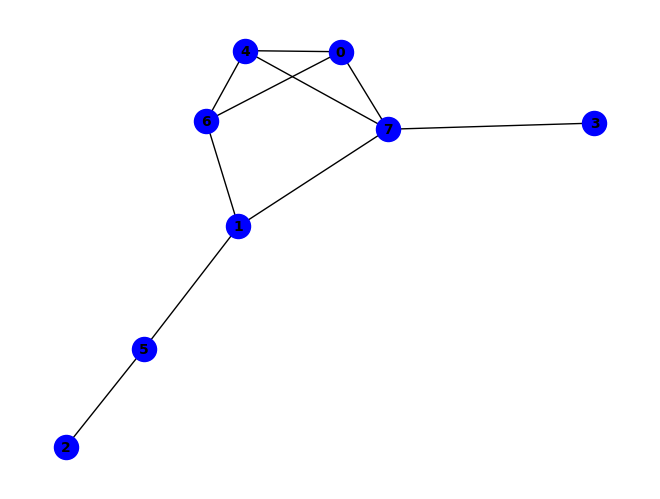


~d ^ (d & ~h) ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & f & ~h) ^ (b & g & ~f) ^ (b & f & g & h) ^ (a & b & g & ~e) ^ (a & d & e & ~h) ^ (b & d & h & ~c) ^ (a & b & c & f & g) ^ (a & g & ~c & ~h) ^ (b & h & ~a & ~g) ^ (c & f & ~b & ~e) ^ (e & g & ~b & ~h) ^ (e & h & ~b & ~d) ^ (a & b & d & h & ~e) ^ (a & b & e & h & ~g) ^ (a & c & e & f & ~b) ^ (a & c & f & h & ~d) ^ (c & d & f & h & ~e) ^ (a & b & c & d & f & h) ^ (a & c & d & e & f & h) ^ (a & c & g & ~f & ~h) ^ (a & b & c & f & h & ~g) ^ (b & c & d & e & h & ~a) ^ (a & b & e & f & ~g & ~h) ^ (b & c & d & h & ~e & ~f) ^ (a & b & c & d & e & h & ~f) ^ (c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


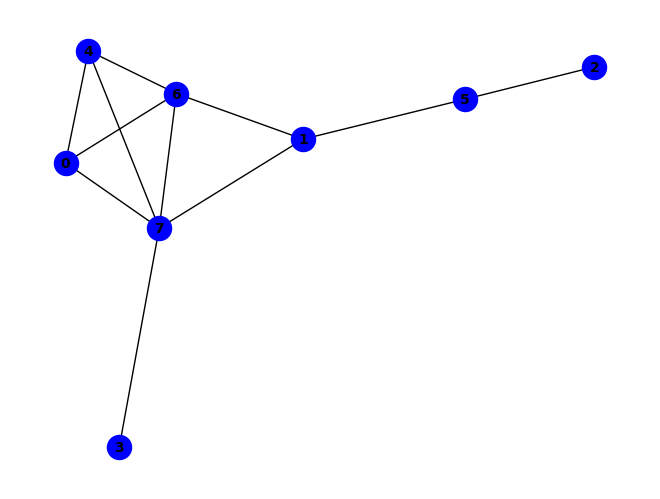


(~c & ~g) ^ (a & h & ~d) ^ (b & f & ~h) ^ (b & g & ~f) ^ (e & h & ~d) ^ (b & f & g & h) ^ (c & ~f & ~g) ^ (g & ~c & ~h) ^ (b & c & f & ~g) ^ (a & e & ~c & ~g) ^ (a & g & ~b & ~d) ^ (b & h & ~a & ~e) ^ (c & g & ~f & ~h) ^ (e & g & ~b & ~d) ^ (a & b & d & h & ~e) ^ (a & b & e & f & ~h) ^ (a & b & e & g & ~f) ^ (a & c & f & g & ~b) ^ (a & c & f & h & ~b) ^ (b & c & f & g & ~h) ^ (b & d & e & h & ~c) ^ (c & e & f & g & ~b) ^ (c & e & f & h & ~b) ^ (a & b & d & e & g & h) ^ (a & b & e & f & g & h) ^ (b & c & d & e & g & h) ^ (a & c & e & ~f & ~g) ^ (a & d & g & ~b & ~h) ^ (a & e & g & ~c & ~h) ^ (d & e & g & ~b & ~h) ^ (a & b & c & e & f & ~g) ^ (c & d & e & f & h & ~g) ^ (d & h & ~b & ~c & ~g) ^ (a & c & e & g & ~f & ~h) ^ (a & d & e & h & ~c & ~g) ^ (a & b & c & e & f & g & ~h) ^ (c & d & h & ~b & ~f & ~g) ^ (a & c & d & e & h & ~f & ~g) ^ (a & c & d & f & h & ~b & ~g) ^ (b & c & d & e & h & ~f & ~g) ^ (a & b & c & d & e & f & h & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

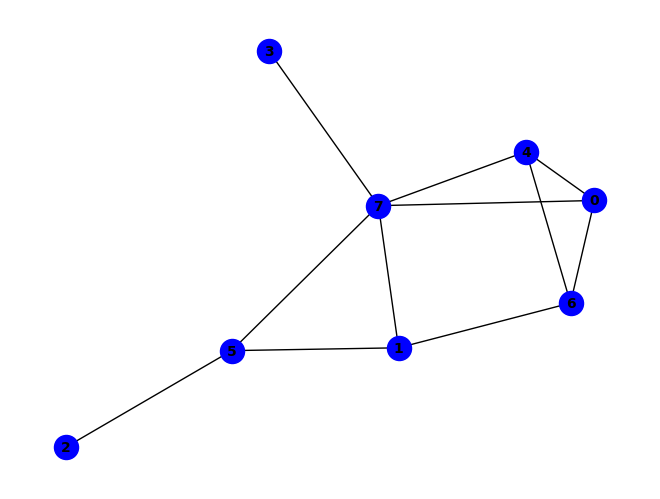


(a & g) ^ (~c & ~f) ^ (a & f & ~d) ^ (a & h & ~g) ^ (b & g & ~f) ^ (c & h & ~f) ^ (e & g & ~h) ^ (e & h & ~f) ^ (b & d & e & f) ^ (b & f & g & h) ^ (c & ~e & ~h) ^ (f & ~a & ~h) ^ (a & b & f & ~h) ^ (a & b & h & ~e) ^ (a & d & h & ~e) ^ (a & e & f & ~h) ^ (b & c & f & ~h) ^ (b & e & g & ~a) ^ (a & b & e & g & h) ^ (a & e & ~c & ~f) ^ (b & f & ~a & ~e) ^ (b & h & ~e & ~g) ^ (d & h & ~e & ~f) ^ (a & c & e & h & ~f) ^ (a & d & e & f & ~b) ^ (b & c & e & g & ~h) ^ (b & d & e & h & ~a) ^ (a & b & g & ~e & ~h) ^ (a & c & e & ~b & ~h) ^ (a & d & f & ~e & ~h) ^ (b & d & h & ~a & ~f) ^ (b & e & f & ~d & ~h) ^ (c & e & f & ~g & ~h) ^ (a & b & d & e & f & ~h) ^ (c & e & ~b & ~f & ~h) ^ (a & b & c & e & ~f & ~h) ^ (a & b & e & g & ~f & ~h) ^ (a & c & f & g & ~b & ~h) ^ (b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


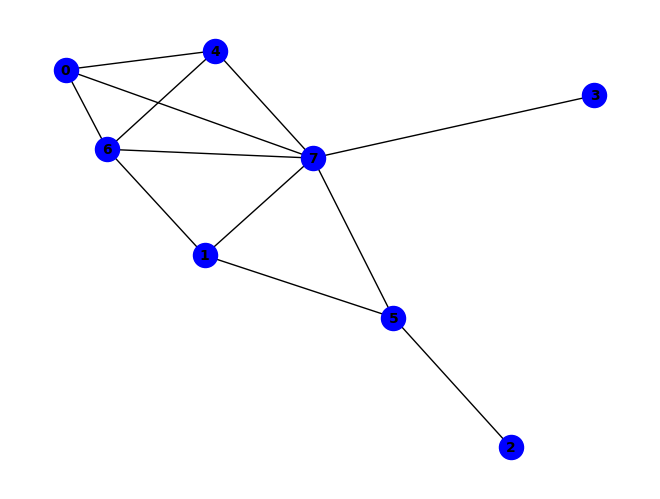


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (c & f & ~b & ~h) ^ (a & b & d & h & ~g) ^ (a & b & e & f & ~g) ^ (a & b & e & g & ~d) ^ (a & b & e & h & ~d) ^ (a & d & e & h & ~g) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (a & d & h & ~f & ~g) ^ (a & f & g & ~e & ~h) ^ (d & e & h & ~b & ~g) ^ (e & f & g & ~d & ~h) ^ (a & b & d & f & g & ~e) ^ (a & b & d & f & h & ~e) ^ (a & d & e & f & g & ~h) ^ (b & d & e & f & g & ~h) ^ (d & h & ~b & ~f & ~g) ^ (a & b & f & g & ~d & ~h) ^ (a & c & e & f & ~b & ~h) ^ (a & c & f & g & ~b & ~h) ^ (c & e & f & g & ~b & ~h) ^ (a & b & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


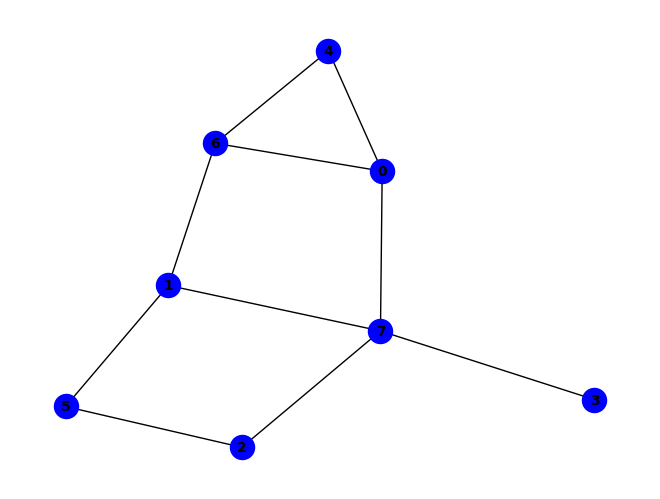


~e ^ (a & g & ~e) ^ (a & h & ~g) ^ (b & g & ~f) ^ (b & h & ~g) ^ (c & f & ~e) ^ (c & h & ~f) ^ (b & f & g & h) ^ (c & e & f & h) ^ (e & ~d & ~g) ^ (a & b & g & ~h) ^ (a & b & h & ~d) ^ (a & c & h & ~d) ^ (a & d & h & ~e) ^ (b & d & h & ~e) ^ (b & e & g & ~a) ^ (b & f & ~c & ~h) ^ (d & h & ~c & ~e) ^ (a & b & c & g & ~e) ^ (a & c & e & f & ~h) ^ (a & c & f & g & ~h) ^ (a & d & e & h & ~g) ^ (b & c & e & h & ~g) ^ (c & d & e & h & ~g) ^ (c & e & g & h & ~a) ^ (a & b & d & e & g & h) ^ (a & c & d & e & g & h) ^ (a & b & c & ~f & ~g) ^ (b & c & h & ~d & ~e) ^ (b & d & e & ~c & ~g) ^ (c & e & f & ~g & ~h) ^ (a & b & c & d & e & ~g) ^ (a & b & c & d & h & ~e) ^ (a & b & c & f & h & ~g) ^ (b & c & e & f & g & ~h) ^ (a & e & ~b & ~g & ~h) ^ (d & e & ~b & ~g & ~h) ^ (b & c & d & e & ~g & ~h) ^ (a & b & c & ~e & ~f & ~h) ^ (a & b & e & ~f & ~g & ~h) ^ (a & b & c & e & ~d & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

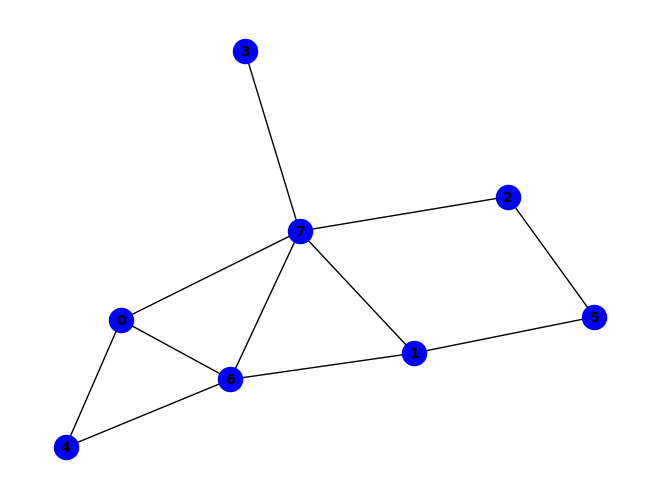


(b & f) ^ (b & g & ~f) ^ (b & h & ~f) ^ (b & f & g & h) ^ (g & ~c & ~h) ^ (b & c & g & ~h) ^ (~c & ~e & ~g) ^ (a & g & ~b & ~d) ^ (a & h & ~b & ~d) ^ (b & c & ~e & ~g) ^ (b & c & ~f & ~h) ^ (e & h & ~c & ~g) ^ (a & c & f & g & ~b) ^ (a & c & f & h & ~b) ^ (c & ~e & ~f & ~h) ^ (e & ~a & ~c & ~h) ^ (a & c & e & ~f & ~h) ^ (a & d & g & ~b & ~h) ^ (b & c & e & ~f & ~g) ^ (b & e & g & ~a & ~h) ^ (b & c & e & f & h & ~g) ^ (c & e & ~f & ~g & ~h) ^ (d & h & ~b & ~c & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & c & d & h & ~b & ~g) ^ (b & c & e & f & ~a & ~h) ^ (a & c & h & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


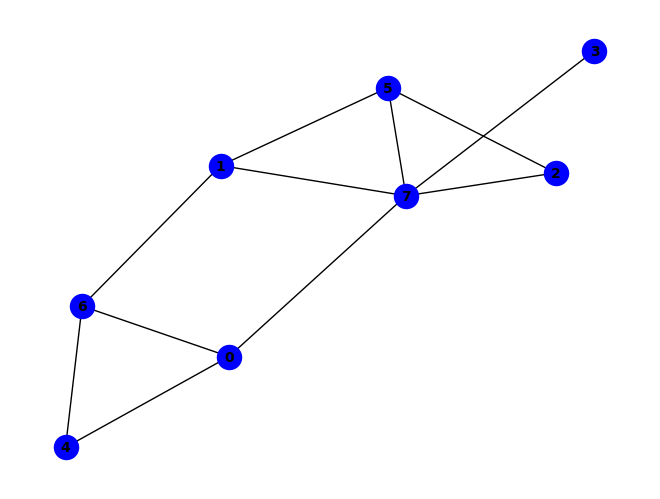


~f ^ (f & ~h) ^ (a & b & g) ^ (a & g & ~e) ^ (b & g & ~h) ^ (b & h & ~d) ^ (e & g & ~b) ^ (a & c & f & g) ^ (b & d & f & h) ^ (b & f & g & h) ^ (a & c & h & ~d) ^ (a & d & e & f & h) ^ (a & h & ~b & ~g) ^ (b & f & ~e & ~g) ^ (c & f & ~b & ~e) ^ (c & h & ~b & ~e) ^ (d & h & ~c & ~f) ^ (a & b & e & f & ~d) ^ (a & b & e & g & ~f) ^ (a & c & f & h & ~g) ^ (b & e & f & h & ~d) ^ (e & f & g & h & ~d) ^ (a & d & h & ~b & ~f) ^ (a & e & f & ~d & ~g) ^ (a & f & h & ~b & ~e) ^ (c & e & h & ~b & ~g) ^ (a & b & c & f & g & ~h) ^ (a & c & d & f & h & ~e) ^ (a & c & e & g & h & ~f) ^ (c & d & e & f & h & ~b) ^ (a & e & ~f & ~g & ~h) ^ (a & b & c & h & ~e & ~f) ^ (a & c & e & f & ~b & ~h) ^ (a & d & e & f & ~g & ~h) ^ (b & c & d & h & ~a & ~f) ^ (b & d & e & f & ~a & ~g) ^ (a & b & d & e & f & g & ~h) ^ (a & c & d & e & f & h & ~g) ^ (a & b & c & d & e & f & g & h) ^ (b & e & f & ~d & ~g & ~h) ^ (c & e & f & ~b & ~d & ~g) ^ (a & b & c & e & h & ~f & ~g) ^ (c & d & e & f & ~b & ~g & ~h) ^ (d & e & g 

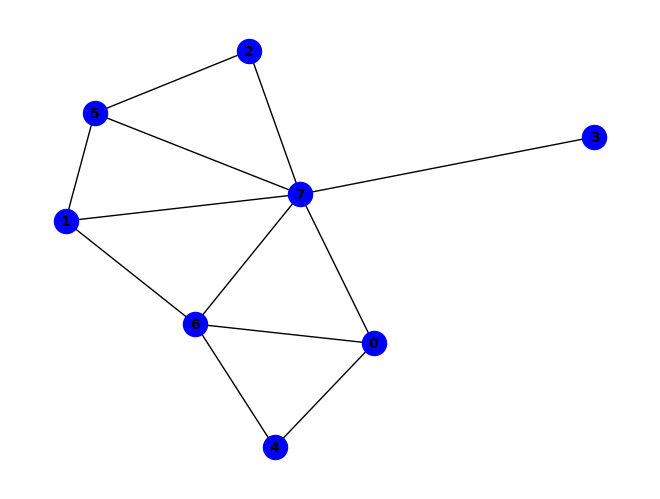


(g & ~h) ^ (~e & ~g) ^ (b & f & ~g) ^ (b & g & ~d) ^ (b & h & ~d) ^ (e & h & ~g) ^ (f & h & ~g) ^ (b & d & g & ~h) ^ (c & e & ~g & ~h) ^ (b & d & f & h & ~g) ^ (e & ~a & ~c & ~h) ^ (a & c & e & ~f & ~h) ^ (b & e & g & ~c & ~h) ^ (c & d & f & ~b & ~g) ^ (c & d & h & ~b & ~g) ^ (a & g & ~b & ~c & ~f) ^ (a & h & ~b & ~c & ~f) ^ (c & e & ~b & ~f & ~g) ^ (c & e & ~b & ~f & ~h) ^ (c & f & ~b & ~d & ~h) ^ (d & h & ~a & ~f & ~g) ^ (a & b & e & f & ~c & ~h) ^ (a & b & e & g & ~f & ~h) ^ (a & c & d & h & ~f & ~g) ^ (c & d & f & g & ~b & ~h) ^ (a & c & g & ~b & ~f & ~h) ^ (a & f & g & ~b & ~c & ~h) ^ (c & h & ~b & ~e & ~f & ~g) ^ (a & b & d & h & ~c & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


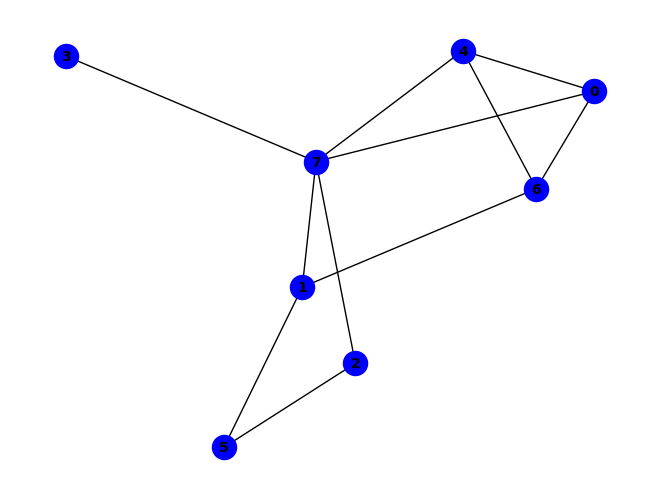


~d ^ (d & ~h) ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & g & ~f) ^ (c & f & ~h) ^ (e & h & ~d) ^ (b & f & g & h) ^ (a & b & g & ~e) ^ (b & d & h & ~e) ^ (b & e & h & ~a) ^ (a & b & e & f & g) ^ (a & g & ~c & ~h) ^ (b & f & ~c & ~h) ^ (b & h & ~a & ~g) ^ (a & b & c & g & ~h) ^ (a & b & d & e & ~c) ^ (a & b & d & h & ~c) ^ (a & b & e & f & ~h) ^ (a & c & d & h & ~e) ^ (a & c & e & h & ~b) ^ (a & c & f & h & ~b) ^ (a & c & g & ~b & ~f) ^ (a & d & e & ~b & ~h) ^ (a & b & c & d & e & ~h) ^ (a & b & e & g & h & ~f) ^ (c & h & ~b & ~d & ~e) ^ (e & g & ~b & ~c & ~h) ^ (a & c & e & f & ~b & ~h) ^ (a & c & h & ~b & ~f & ~g) ^ (c & e & g & ~b & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


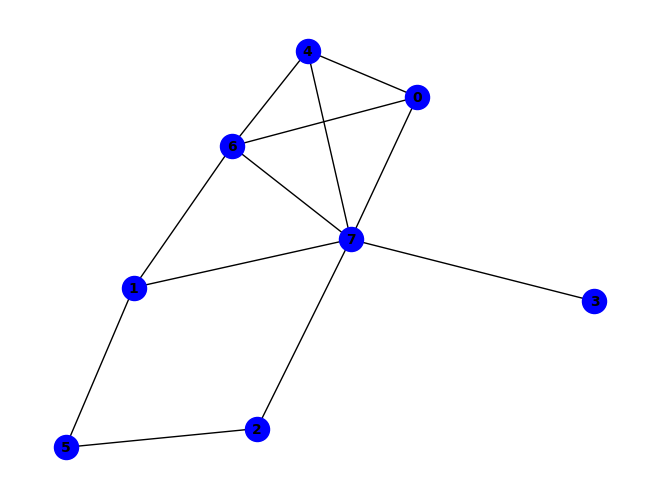


(~c & ~g) ^ (a & e & ~g) ^ (b & c & ~g) ^ (b & f & ~h) ^ (b & g & ~f) ^ (b & f & g & h) ^ (g & ~c & ~h) ^ (b & c & g & ~h) ^ (b & e & g & ~d) ^ (b & c & e & f & g) ^ (b & c & e & f & h) ^ (a & g & ~b & ~d) ^ (a & h & ~c & ~d) ^ (b & h & ~a & ~e) ^ (e & g & ~c & ~d) ^ (e & h & ~c & ~d) ^ (a & b & c & h & ~d) ^ (a & b & d & h & ~e) ^ (a & b & e & f & ~h) ^ (a & c & e & f & ~b) ^ (a & d & e & g & ~c) ^ (a & d & e & h & ~c) ^ (b & d & e & g & ~h) ^ (b & d & e & h & ~c) ^ (b & c & d & e & g & h) ^ (c & ~e & ~f & ~h) ^ (a & c & g & ~b & ~e) ^ (a & c & g & ~f & ~h) ^ (a & d & g & ~b & ~h) ^ (d & e & g & ~c & ~h) ^ (a & b & c & e & g & ~h) ^ (a & b & e & g & h & ~d) ^ (a & c & d & g & h & ~b) ^ (b & c & ~a & ~f & ~h) ^ (c & e & ~f & ~g & ~h) ^ (d & h & ~b & ~c & ~g) ^ (a & b & e & g & ~f & ~h) ^ (a & c & e & h & ~b & ~f) ^ (b & c & e & h & ~f & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & c & ~f & ~g & ~h) ^ (a & e & g & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

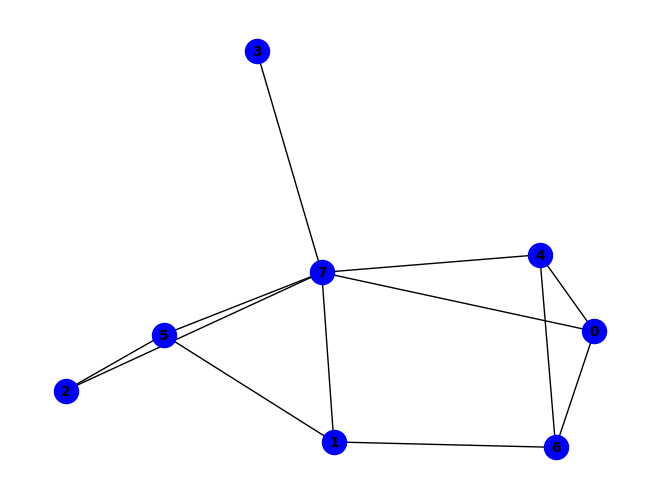


~f ^ (a & g) ^ (f & ~h) ^ (a & f & h) ^ (a & h & ~g) ^ (b & f & ~g) ^ (c & h & ~d) ^ (e & g & ~h) ^ (b & f & g & h) ^ (c & d & f & h) ^ (c & e & f & h) ^ (a & e & f & ~h) ^ (b & c & h & ~e) ^ (a & e & ~b & ~f) ^ (b & g & ~a & ~e) ^ (c & f & ~b & ~e) ^ (e & h & ~c & ~f) ^ (a & b & e & h & ~f) ^ (a & b & f & h & ~e) ^ (b & d & e & h & ~c) ^ (b & e & f & h & ~d) ^ (c & d & e & h & ~f) ^ (b & c & d & e & f & h) ^ (a & b & e & ~g & ~h) ^ (b & d & h & ~c & ~f) ^ (b & h & ~a & ~e & ~g) ^ (d & h & ~a & ~e & ~f) ^ (a & b & d & h & ~e & ~f) ^ (a & b & e & g & ~f & ~h) ^ (a & c & e & f & ~b & ~d) ^ (a & c & e & h & ~b & ~d) ^ (a & c & f & g & ~b & ~h) ^ (a & c & h & ~b & ~d & ~f) ^ (c & e & f & ~b & ~g & ~h) ^ (a & c & d & e & f & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


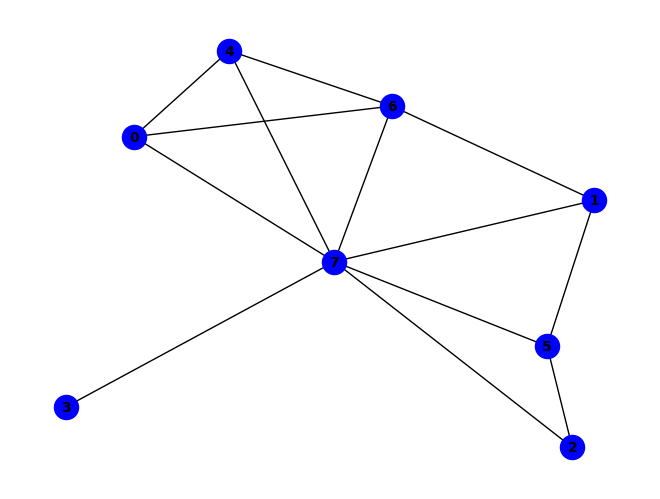


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & b & e & f & ~g) ^ (a & b & e & g & ~d) ^ (a & b & e & h & ~d) ^ (a & b & f & g & ~h) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & c & g & ~b & ~h) ^ (a & f & g & ~e & ~h) ^ (c & e & g & ~f & ~h) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (a & g & ~b & ~c & ~f) ^ (a & h & ~b & ~c & ~f) ^ (c & f & ~b & ~e & ~h) ^ (c & h & ~b & ~f & ~g) ^ (a & c & e & f & ~b & ~h) ^ (b & c & e & h & ~f & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & b & d & e & f & g & ~c) ^ (a & b & d & e & f & h & ~c) ^ (a & c & d & e & f & h & ~g) ^ (c & e & f & ~b & ~g & ~h) ^ (d & e & h & ~a & ~c & ~g) ^ (a & b & d & e & g & ~f & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (d & h & ~a & ~c & ~f & ~g) ^ (a & b & d & h & ~c & ~f & ~g) ^ (a & c & e & h & ~b & ~f

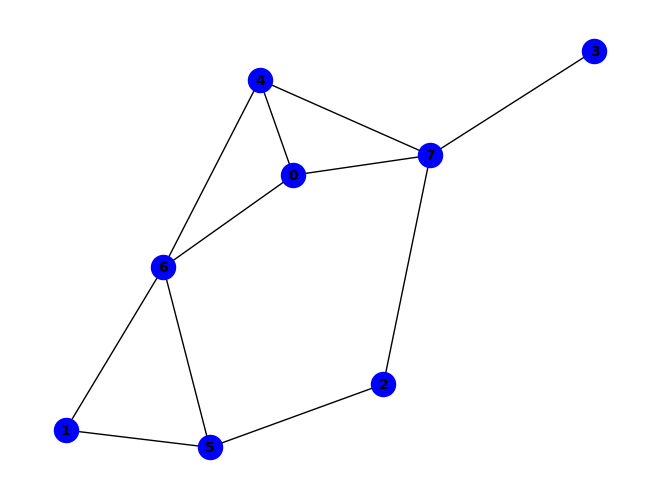


(e & f & g) ^ (~c & ~f) ^ (a & g & ~h) ^ (a & h & ~d) ^ (b & f & ~e) ^ (b & g & ~e) ^ (e & g & ~h) ^ (e & h & ~d) ^ (a & b & e & g) ^ (c & ~f & ~h) ^ (f & ~d & ~g) ^ (a & b & g & ~f) ^ (a & f & g & ~b) ^ (b & c & f & ~g) ^ (a & d & f & g & h) ^ (b & c & d & g & h) ^ (b & c & e & f & h) ^ (d & e & f & g & h) ^ (a & e & ~c & ~f) ^ (c & f & ~e & ~g) ^ (d & f & ~g & ~h) ^ (d & h & ~c & ~f) ^ (a & b & e & f & ~d) ^ (a & b & f & g & ~h) ^ (b & c & g & h & ~f) ^ (a & b & c & d & e & f) ^ (a & c & h & ~d & ~f) ^ (b & e & f & ~g & ~h) ^ (c & e & f & ~g & ~h) ^ (c & e & h & ~d & ~f) ^ (a & b & c & e & f & ~g) ^ (a & b & c & e & g & ~f) ^ (a & b & c & g & h & ~d) ^ (b & c & e & g & h & ~d) ^ (a & b & c & d & e & g & h) ^ (a & b & f & h & ~c & ~d) ^ (a & c & f & h & ~d & ~g) ^ (a & d & e & h & ~c & ~f) ^ (b & d & f & h & ~c & ~e) ^ (b & d & g & h & ~a & ~e) ^ (c & d & f & h & ~e & ~g) ^ (a & c & e & ~b & ~f & ~h) ^ (a & e & f & ~c & ~d & ~g) ^ (a & b & d & e & f & ~c & ~h) ^ (a & b & c & e & ~f &

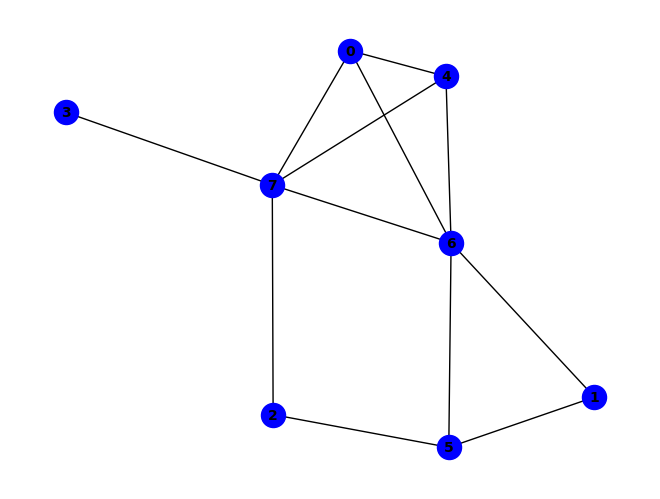


(g & ~h) ^ (a & g & ~d) ^ (a & h & ~d) ^ (e & g & ~d) ^ (e & h & ~d) ^ (f & h & ~g) ^ (f & ~e & ~h) ^ (a & d & g & ~h) ^ (a & e & f & ~h) ^ (a & e & g & ~h) ^ (a & f & g & ~h) ^ (b & d & e & f & g) ^ (b & d & e & f & h) ^ (~b & ~f & ~g) ^ (a & e & ~f & ~g) ^ (b & f & ~c & ~g) ^ (c & f & ~g & ~h) ^ (d & h & ~c & ~g) ^ (e & f & ~g & ~h) ^ (a & e & f & h & ~g) ^ (b & ~e & ~f & ~h) ^ (a & b & e & ~f & ~h) ^ (d & e & g & ~b & ~h) ^ (b & e & ~a & ~f & ~g) ^ (b & h & ~e & ~f & ~g) ^ (c & h & ~a & ~e & ~g) ^ (a & b & c & g & ~d & ~f) ^ (a & b & c & h & ~d & ~f) ^ (a & b & c & h & ~d & ~g) ^ (a & b & e & f & ~c & ~g) ^ (a & b & f & h & ~d & ~g) ^ (a & c & d & h & ~e & ~g) ^ (a & c & e & f & ~g & ~h) ^ (a & d & e & h & ~b & ~g) ^ (b & d & e & g & ~f & ~h) ^ (b & d & f & h & ~c & ~g) ^ (b & e & f & h & ~c & ~g) ^ (c & d & e & h & ~b & ~g) ^ (a & b & c & d & e & g & ~f) ^ (a & b & c & d & e & h & ~f) ^ (a & b & c & d & e & h & ~g) ^ (a & b & g & ~c & ~f & ~h) ^ (b & c & d & e & h & ~f & ~g) ^ (a 

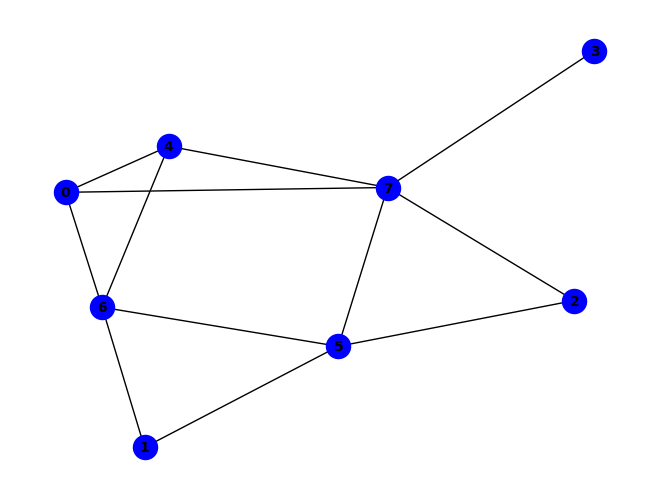


~e ^ (a & e & ~d) ^ (f & h & ~e) ^ (a & e & f & g) ^ (b & d & f & g) ^ (b & e & f & g) ^ (b & f & g & h) ^ (e & ~g & ~h) ^ (a & d & e & ~h) ^ (a & g & ~f & ~h) ^ (a & h & ~d & ~f) ^ (b & f & ~d & ~h) ^ (b & g & ~a & ~e) ^ (d & h & ~e & ~f) ^ (f & g & ~e & ~h) ^ (a & b & f & g & ~e) ^ (a & e & f & h & ~g) ^ (b & d & g & h & ~e) ^ (b & c & d & e & g & h) ^ (a & d & e & f & h & ~b) ^ (b & c & d & g & h & ~f) ^ (b & d & e & f & h & ~c) ^ (a & b & c & d & e & f & h) ^ (c & f & ~b & ~g & ~h) ^ (a & b & d & e & g & h & ~c) ^ (b & d & f & ~e & ~g & ~h) ^ (a & b & d & g & h & ~c & ~f) ^ (c & h & ~a & ~d & ~e & ~f) ^ (a & b & e & f & ~d & ~g & ~h) ^ (a & c & e & f & ~b & ~g & ~h) ^ (b & c & g & h & ~a & ~e & ~f) ^ (b & d & e & f & ~a & ~c & ~g) ^ (b & c & d & e & f & ~a & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


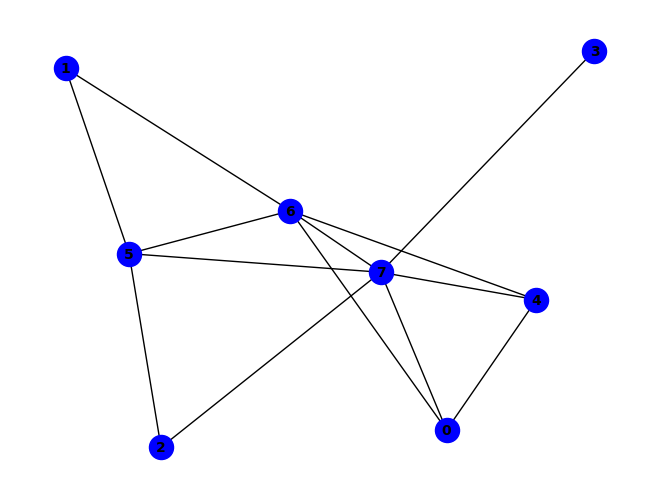


(~b & ~g) ^ (c & f & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~d) ^ (f & h & ~d) ^ (g & ~c & ~h) ^ (c & e & g & ~h) ^ (a & g & ~e & ~f) ^ (a & h & ~e & ~f) ^ (b & e & ~f & ~g) ^ (b & h & ~e & ~g) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (d & h & ~e & ~g) ^ (a & c & f & g & ~e) ^ (a & c & f & h & ~e) ^ (b & e & f & h & ~g) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & c & d & e & f & g) ^ (a & c & d & e & f & h) ^ (b & ~e & ~f & ~h) ^ (a & b & e & ~f & ~h) ^ (a & b & e & ~g & ~h) ^ (a & b & g & ~f & ~h) ^ (d & f & g & ~e & ~h) ^ (a & e & ~c & ~g & ~h) ^ (c & d & e & h & ~a & ~g) ^ (a & c & e & ~f & ~g & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (a & d & h & ~e & ~f & ~g) ^ (b & c & f & ~a & ~g & ~h) ^ (c & d & h & ~a & ~f & ~g) ^ (c & d & e & f & g & ~a & ~h) ^ (a & b & c & f & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

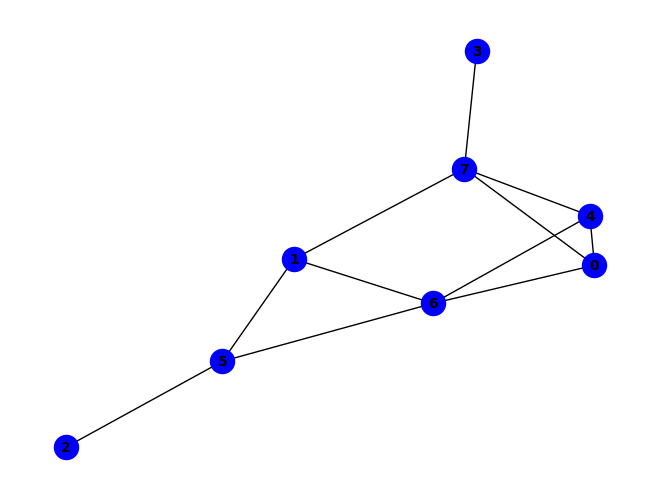


(a & f & g) ^ (~c & ~f) ^ (a & g & ~h) ^ (a & h & ~d) ^ (b & f & ~h) ^ (e & g & ~h) ^ (e & h & ~d) ^ (b & f & g & h) ^ (c & ~b & ~g) ^ (f & ~d & ~g) ^ (e & f & g & ~b) ^ (a & d & f & g & h) ^ (d & e & f & g & h) ^ (a & e & ~c & ~f) ^ (b & c & ~f & ~g) ^ (b & h & ~a & ~e) ^ (c & g & ~e & ~f) ^ (d & f & ~g & ~h) ^ (d & h & ~c & ~f) ^ (a & b & f & g & ~e) ^ (a & c & e & ~b & ~g) ^ (a & e & f & ~d & ~g) ^ (c & d & h & ~b & ~g) ^ (c & e & g & ~f & ~h) ^ (c & e & h & ~d & ~f) ^ (c & e & h & ~d & ~g) ^ (b & g & ~a & ~e & ~h) ^ (a & b & c & e & ~f & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & g & ~d & ~f) ^ (a & d & e & f & ~g & ~h) ^ (a & d & e & h & ~c & ~f) ^ (b & c & d & h & ~f & ~g) ^ (c & d & g & h & ~e & ~f) ^ (b & d & h & ~a & ~e & ~f) ^ (a & c & d & e & g & ~f & ~h) ^ (a & c & d & e & h & ~b & ~g) ^ (b & c & e & f & h & ~d & ~g) ^ (a & c & f & h & ~b & ~d & ~g) ^ (b & d & f & h & ~a & ~e & ~g) ^ (a & b & c & d & e & h & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

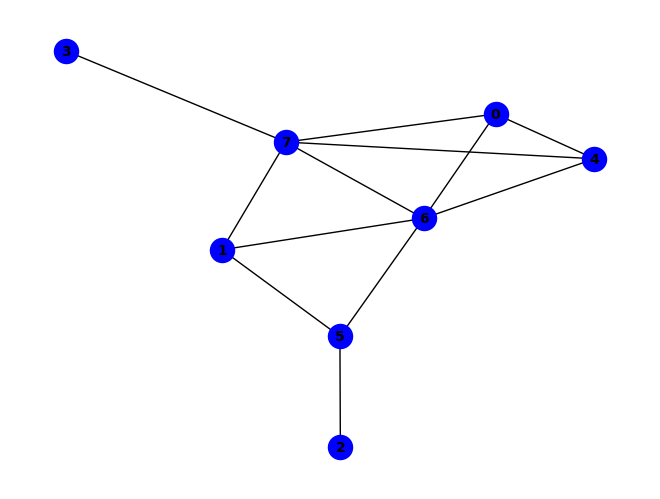


(g & ~h) ^ (~f & ~g) ^ (e & g & ~d) ^ (e & h & ~d) ^ (d & e & g & ~h) ^ (a & e & ~f & ~g) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & f & ~b & ~g) ^ (d & h & ~c & ~g) ^ (f & h & ~a & ~g) ^ (a & b & f & g & ~h) ^ (a & d & e & g & ~c) ^ (a & d & e & h & ~c) ^ (a & e & f & h & ~g) ^ (f & ~b & ~e & ~h) ^ (a & c & g & ~f & ~h) ^ (a & c & h & ~d & ~g) ^ (a & d & h & ~b & ~g) ^ (a & e & f & ~b & ~h) ^ (a & e & g & ~d & ~h) ^ (b & d & h & ~e & ~g) ^ (a & c & d & e & g & ~h) ^ (b & c & d & f & h & ~g) ^ (e & f & ~b & ~g & ~h) ^ (a & c & e & f & ~b & ~g) ^ (c & d & h & ~a & ~f & ~g) ^ (a & b & c & f & h & ~d & ~g) ^ (a & b & d & e & h & ~c & ~g) ^ (c & e & f & h & ~b & ~d & ~g) ^ (a & c & d & e & h & ~b & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


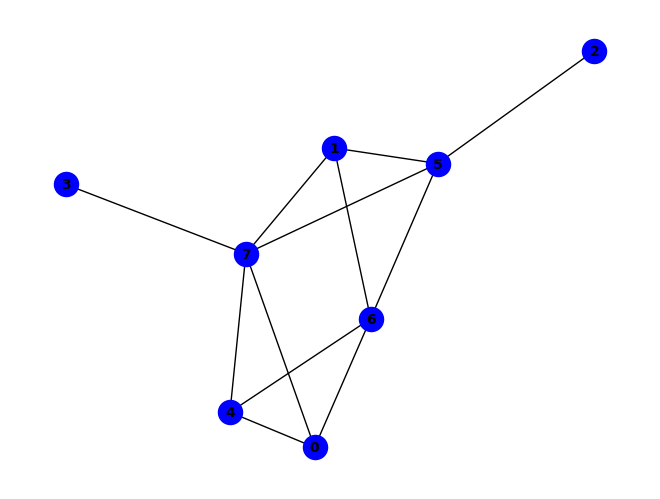


~e ^ (a & e & ~d) ^ (b & f & ~e) ^ (b & h & ~e) ^ (f & h & ~e) ^ (a & b & d & e) ^ (a & b & e & h) ^ (a & e & f & g) ^ (e & ~g & ~h) ^ (a & d & e & f & h) ^ (a & g & ~f & ~h) ^ (a & h & ~d & ~f) ^ (b & g & ~e & ~h) ^ (f & g & ~e & ~h) ^ (a & b & d & h & ~f) ^ (a & b & e & f & ~d) ^ (a & b & e & g & ~h) ^ (a & e & f & h & ~g) ^ (a & b & g & ~c & ~f) ^ (a & b & h & ~f & ~g) ^ (a & d & e & ~b & ~h) ^ (b & e & f & ~g & ~h) ^ (a & b & c & g & h & ~f) ^ (a & b & d & e & f & ~h) ^ (c & f & ~b & ~g & ~h) ^ (d & h & ~b & ~e & ~f) ^ (a & b & c & e & ~f & ~h) ^ (a & b & c & e & ~g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


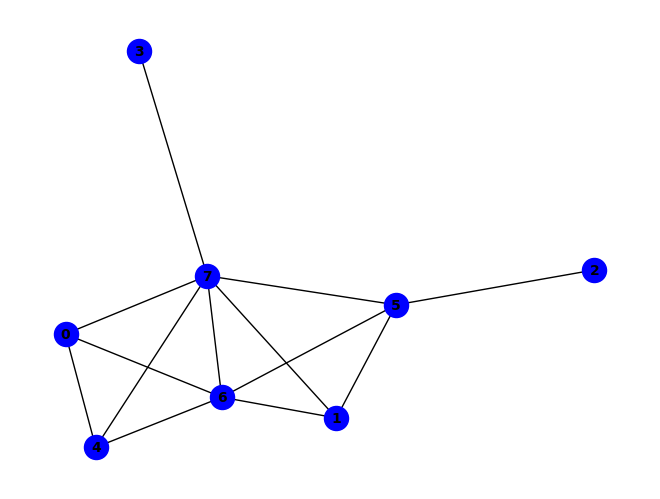


~g ^ (g & ~h) ^ (b & f & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~d) ^ (f & h & ~d) ^ (b & f & g & ~h) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (d & h & ~e & ~g) ^ (a & b & f & g & ~e) ^ (a & b & f & h & ~e) ^ (a & d & e & h & ~g) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (d & e & f & g & ~a) ^ (d & e & f & h & ~a) ^ (a & d & h & ~f & ~g) ^ (d & f & g & ~e & ~h) ^ (a & d & e & f & g & ~h) ^ (b & d & e & f & g & ~h) ^ (a & c & ~b & ~e & ~f) ^ (a & e & ~b & ~g & ~h) ^ (a & g & ~c & ~e & ~f) ^ (a & h & ~c & ~e & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & c & g & h & ~e & ~f) ^ (b & d & e & h & ~a & ~g) ^ (a & b & d & e & f & h & ~g) ^ (a & b & e & ~f & ~g & ~h) ^ (b & d & h & ~a & ~f & ~g) ^ (a & c & ~b & ~e & ~g & ~h) ^ (c & f & ~a & ~b & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


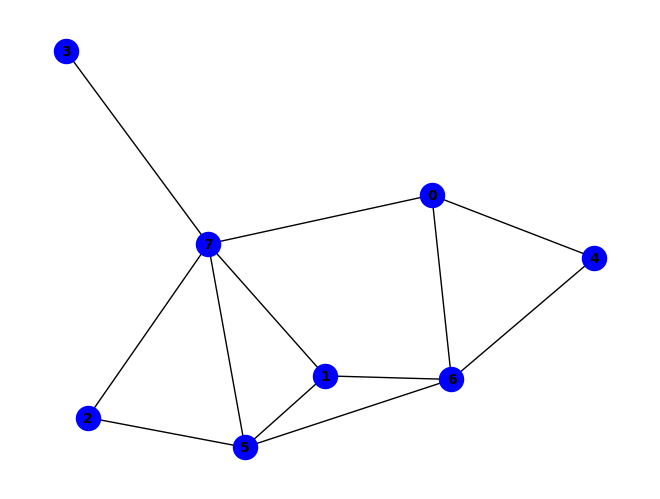


~e ^ (e & f & g) ^ (b & f & ~e) ^ (b & h & ~d) ^ (f & g & ~h) ^ (f & h & ~a) ^ (a & f & g & h) ^ (e & ~d & ~g) ^ (b & e & g & ~a) ^ (a & g & ~e & ~f) ^ (a & h & ~c & ~g) ^ (b & g & ~a & ~h) ^ (d & e & ~g & ~h) ^ (a & b & c & h & ~g) ^ (a & b & e & f & ~h) ^ (a & b & f & g & ~h) ^ (b & d & f & h & ~e) ^ (a & b & h & ~d & ~f) ^ (a & c & f & ~b & ~g) ^ (a & d & e & ~f & ~g) ^ (b & e & f & ~d & ~g) ^ (c & d & e & g & h & ~a) ^ (a & e & ~d & ~g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (c & h & ~b & ~d & ~f) ^ (d & h & ~a & ~e & ~f) ^ (a & c & d & h & ~b & ~f) ^ (b & d & e & f & ~g & ~h) ^ (c & e & g & h & ~b & ~f) ^ (d & e & f & h & ~c & ~g) ^ (a & b & e & f & g & h & ~d) ^ (b & c & d & e & f & h & ~g) ^ (a & c & d & e & f & ~b & ~g) ^ (b & d & e & g & h & ~a & ~c) ^ (c & d & e & f & h & ~a & ~b) ^ (a & c & g & h & ~b & ~e & ~f) ^ (a & d & e & f & ~c & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h) ^ (a & c & f & ~b & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

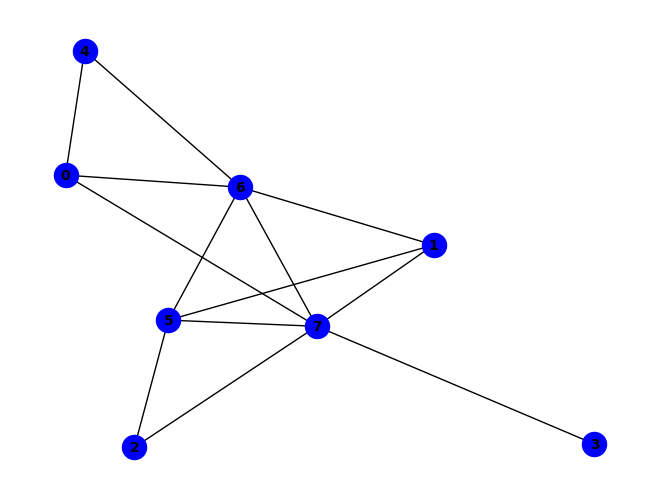


(g & ~h) ^ (~e & ~g) ^ (b & g & ~d) ^ (b & h & ~d) ^ (e & h & ~g) ^ (f & g & ~d) ^ (f & h & ~d) ^ (b & f & g & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (b & f & ~e & ~g) ^ (c & h & ~b & ~g) ^ (d & h & ~c & ~g) ^ (a & b & d & h & ~g) ^ (b & c & d & h & ~g) ^ (b & d & f & g & ~a) ^ (b & e & f & h & ~g) ^ (c & d & f & g & ~b) ^ (c & d & f & h & ~a) ^ (a & b & c & d & f & g) ^ (a & c & d & f & g & h) ^ (e & ~a & ~f & ~h) ^ (a & d & h & ~f & ~g) ^ (b & d & g & ~f & ~h) ^ (b & e & f & ~a & ~h) ^ (b & e & g & ~a & ~h) ^ (d & f & g & ~c & ~h) ^ (b & c & d & f & g & ~h) ^ (c & f & ~a & ~b & ~g) ^ (e & f & ~a & ~g & ~h) ^ (b & d & f & h & ~a & ~c) ^ (a & c & h & ~b & ~d & ~g) ^ (a & b & d & f & g & ~c & ~h) ^ (a & c & f & ~b & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


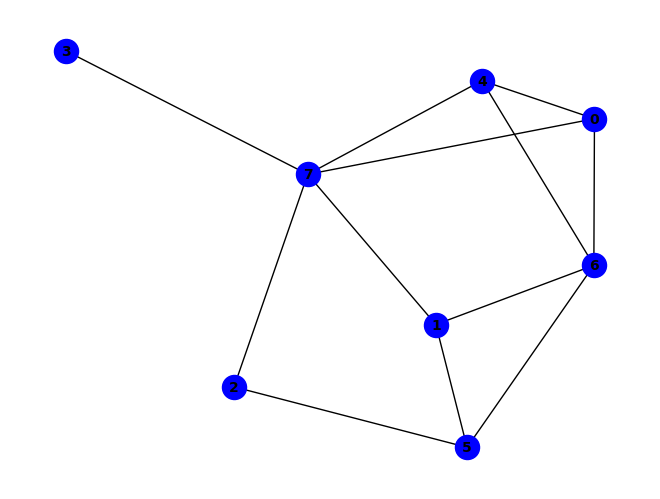


(a & f & g) ^ (~c & ~f) ^ (a & g & ~h) ^ (a & h & ~d) ^ (e & g & ~h) ^ (e & h & ~d) ^ (b & d & f & g) ^ (b & f & g & h) ^ (c & ~f & ~h) ^ (f & ~d & ~g) ^ (a & b & g & ~f) ^ (e & f & g & ~b) ^ (a & d & f & g & h) ^ (a & e & ~c & ~f) ^ (b & f & ~d & ~h) ^ (b & g & ~e & ~h) ^ (b & h & ~d & ~e) ^ (d & h & ~c & ~f) ^ (a & b & c & e & ~d) ^ (a & b & e & ~g & ~h) ^ (a & b & h & ~e & ~g) ^ (a & c & e & ~f & ~h) ^ (c & e & h & ~d & ~f) ^ (a & b & e & g & h & ~f) ^ (d & e & f & g & h & ~b) ^ (c & f & ~b & ~e & ~g) ^ (d & f & ~b & ~g & ~h) ^ (a & b & d & h & ~e & ~f) ^ (a & d & e & h & ~c & ~f) ^ (a & b & c & e & f & g & ~d) ^ (a & b & e & ~c & ~f & ~h) ^ (a & c & h & ~b & ~d & ~f) ^ (a & e & f & ~c & ~d & ~g) ^ (b & c & h & ~d & ~e & ~f) ^ (c & e & f & ~b & ~g & ~h) ^ (a & b & c & d & e & ~f & ~h) ^ (a & b & d & f & h & ~e & ~g) ^ (a & c & f & h & ~b & ~d & ~g) ^ (a & d & e & f & ~c & ~g & ~h) ^ (c & d & f & h & ~b & ~e & ~g) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PAS

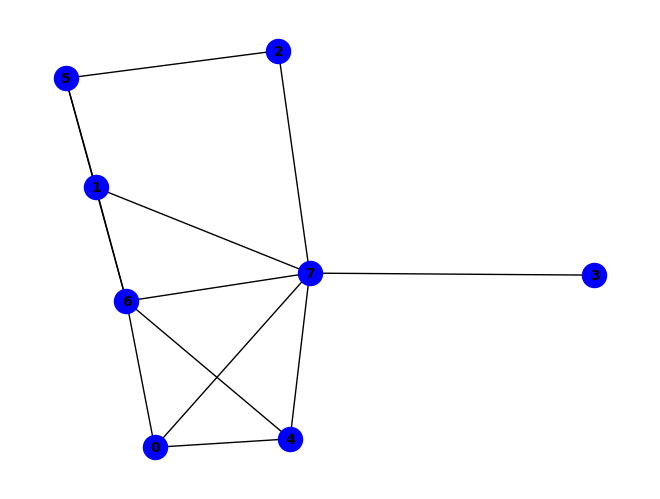


(g & ~h) ^ (~f & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (e & g & ~d) ^ (e & h & ~d) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (d & e & g & ~h) ^ (a & e & ~f & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (d & h & ~c & ~g) ^ (a & d & e & g & ~c) ^ (a & d & e & h & ~c) ^ (a & e & f & h & ~g) ^ (c & d & e & h & ~g) ^ (f & ~b & ~e & ~h) ^ (a & d & g & ~e & ~h) ^ (a & e & f & ~b & ~h) ^ (a & f & g & ~b & ~h) ^ (a & c & d & e & g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (e & f & ~b & ~g & ~h) ^ (a & b & d & h & ~e & ~g) ^ (a & c & d & h & ~b & ~g) ^ (a & b & c & d & e & h & ~g) ^ (b & d & h & ~c & ~e & ~g) ^ (c & h & ~a & ~b & ~e & ~g) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


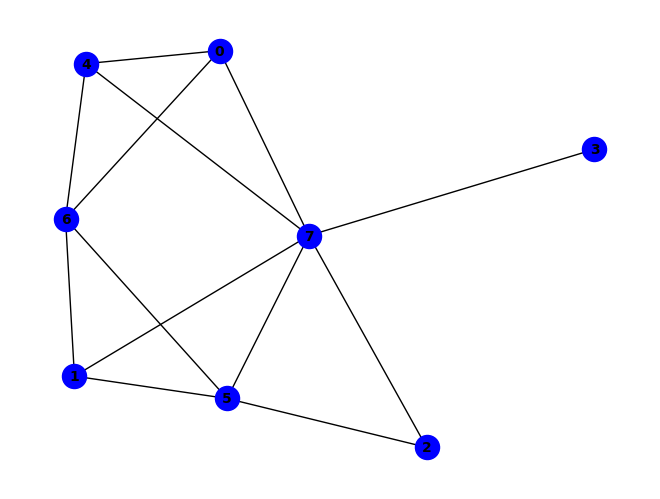


~e ^ (a & e & ~d) ^ (b & f & ~e) ^ (f & h & ~e) ^ (a & e & f & g) ^ (e & ~g & ~h) ^ (a & b & g & ~f) ^ (a & d & e & ~h) ^ (b & c & f & ~g) ^ (b & c & d & e & h) ^ (b & c & f & g & h) ^ (a & g & ~f & ~h) ^ (a & h & ~d & ~f) ^ (b & g & ~e & ~h) ^ (b & h & ~c & ~e) ^ (c & f & ~g & ~h) ^ (f & g & ~e & ~h) ^ (a & b & e & f & ~d) ^ (a & b & e & g & ~h) ^ (a & b & e & h & ~d) ^ (a & c & d & h & ~f) ^ (a & e & f & h & ~g) ^ (b & c & d & h & ~f) ^ (a & b & h & ~f & ~g) ^ (b & e & f & ~g & ~h) ^ (a & b & d & e & f & ~h) ^ (a & c & d & e & h & ~b) ^ (a & d & e & f & h & ~c) ^ (b & c & e & f & h & ~d) ^ (a & b & c & d & e & f & h) ^ (c & h & ~d & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & b & d & h & ~c & ~f) ^ (a & c & h & ~b & ~e & ~f) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


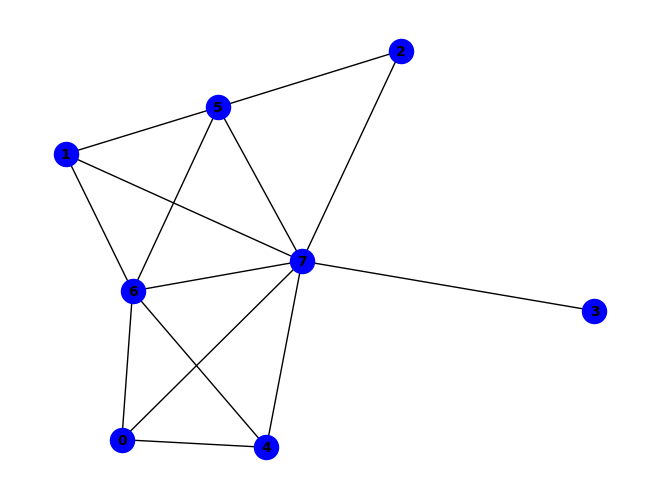


~g ^ (c & f & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & g & ~d) ^ (f & h & ~d) ^ (g & ~c & ~h) ^ (b & f & g & ~h) ^ (a & g & ~e & ~f) ^ (a & h & ~e & ~f) ^ (b & f & ~c & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (d & h & ~e & ~g) ^ (a & b & c & e & ~f) ^ (a & b & c & g & ~d) ^ (a & b & f & h & ~e) ^ (b & c & e & h & ~f) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & c & d & e & f & g) ^ (a & c & d & e & f & h) ^ (b & c & h & ~d & ~g) ^ (c & e & g & ~b & ~h) ^ (d & f & g & ~e & ~h) ^ (a & b & c & d & e & ~g) ^ (a & c & d & e & h & ~g) ^ (b & c & d & f & h & ~g) ^ (b & d & e & f & g & ~h) ^ (a & b & c & d & f & g & h) ^ (a & b & c & e & f & g & h) ^ (a & e & ~c & ~g & ~h) ^ (a & b & c & e & ~d & ~h) ^ (a & b & c & h & ~d & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & b & f & g & ~c & ~e) ^ (a & c & f & h & ~e & ~g) ^ (b & c & e & g & ~a & ~f) ^ (b & d & e & h & ~a & ~g) ^ (c &

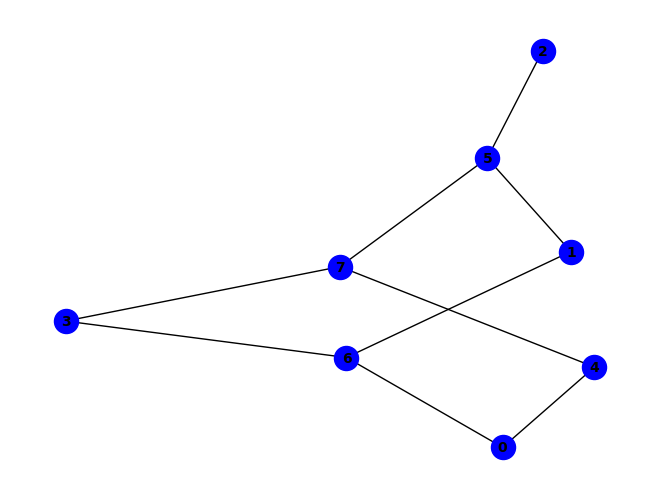


(a & b & g) ^ (b & d & g) ^ (~c & ~f) ^ (a & g & ~e) ^ (b & g & ~f) ^ (c & h & ~f) ^ (d & g & ~h) ^ (e & h & ~f) ^ (c & ~d & ~h) ^ (f & ~b & ~h) ^ (a & d & g & ~b) ^ (b & c & f & ~h) ^ (a & b & e & g & h) ^ (b & d & f & g & h) ^ (d & h & ~e & ~f) ^ (a & b & e & f & ~h) ^ (a & e & f & g & ~b) ^ (c & d & f & ~g & ~h) ^ (a & b & c & f & g & ~h) ^ (a & d & e & f & h & ~b) ^ (a & d & e & g & h & ~b) ^ (a & e & ~c & ~f & ~h) ^ (c & d & ~b & ~f & ~h) ^ (a & c & e & g & ~f & ~h) ^ (a & c & f & g & ~d & ~h) ^ (a & d & e & f & ~b & ~g) ^ (a & f & g & h & ~b & ~d) ^ (b & c & d & g & ~a & ~h) ^ (b & e & g & h & ~d & ~f) ^ (a & c & e & ~b & ~g & ~h) ^ (a & e & f & ~d & ~g & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (a & b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

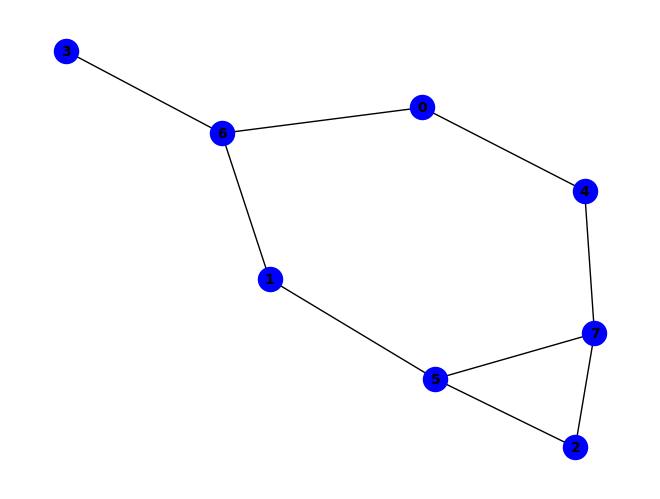


(a & d & g) ^ (~b & ~f) ^ (a & g & ~e) ^ (c & f & ~e) ^ (c & h & ~e) ^ (d & g & ~b) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (a & b & g & ~d) ^ (b & c & f & ~h) ^ (b & c & h & ~f) ^ (a & d & e & g & h) ^ (b & c & d & f & g) ^ (a & e & ~f & ~h) ^ (a & b & e & f & ~h) ^ (a & e & f & g & ~b) ^ (c & d & f & g & ~e) ^ (d & e & g & h & ~b) ^ (b & ~c & ~f & ~g) ^ (c & e & f & ~d & ~h) ^ (a & b & e & g & h & ~d) ^ (a & c & d & f & g & ~b) ^ (a & d & e & f & h & ~c) ^ (b & c & d & e & f & g & h) ^ (b & c & ~f & ~g & ~h) ^ (a & c & e & f & ~b & ~h) ^ (a & c & f & g & ~b & ~e) ^ (a & d & e & f & ~c & ~g) ^ (a & f & g & h & ~b & ~d) ^ (b & e & g & h & ~c & ~f) ^ (c & d & g & h & ~b & ~e) ^ (d & f & g & h & ~b & ~e) ^ (a & e & f & ~d & ~g & ~h) ^ (a & b & d & e & f & g & h & ~c) ^ (a & c & g & h & ~b & ~d & ~e) ^ (c & d & e & f & ~a & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

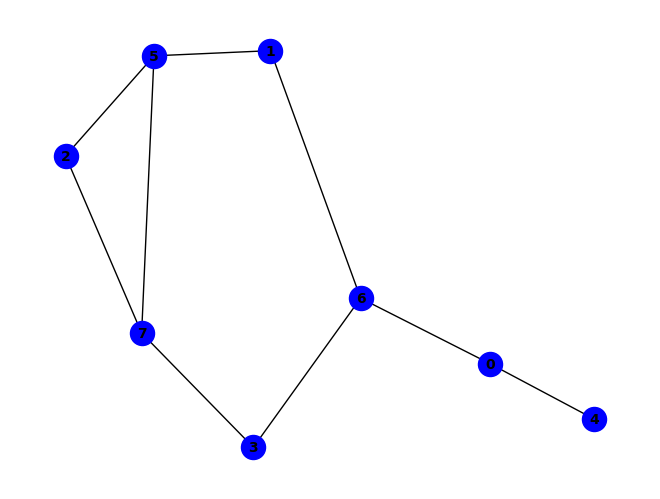


~f ^ (a & e & ~g) ^ (a & g & ~d) ^ (b & g & ~f) ^ (c & f & ~a) ^ (c & h & ~a) ^ (d & g & ~h) ^ (f & ~b & ~h) ^ (a & b & g & ~e) ^ (b & c & f & ~h) ^ (b & d & g & ~a) ^ (b & c & d & g & h) ^ (d & h & ~c & ~f) ^ (a & b & e & g & ~f) ^ (a & e & f & h & ~g) ^ (a & f & g & h & ~d) ^ (b & c & g & h & ~f) ^ (c & d & f & g & ~h) ^ (a & c & d & e & f & h) ^ (a & c & f & ~e & ~g) ^ (a & c & h & ~e & ~g) ^ (a & b & c & f & g & ~e) ^ (a & b & c & g & h & ~e) ^ (a & b & f & g & h & ~e) ^ (a & c & d & e & h & ~g) ^ (a & c & d & f & g & ~e) ^ (a & c & d & g & h & ~b) ^ (b & c & d & f & g & ~a) ^ (b & d & f & g & h & ~a) ^ (a & b & e & f & ~c & ~h) ^ (a & d & e & h & ~f & ~g) ^ (a & b & c & e & g & h & ~f) ^ (a & c & d & e & f & g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


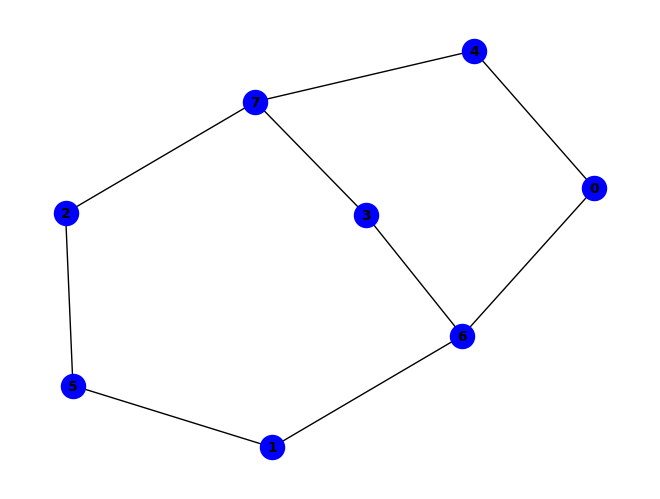


(~a & ~e) ^ (b & f & ~g) ^ (b & g & ~d) ^ (c & f & ~b) ^ (d & h & ~e) ^ (a & ~e & ~g) ^ (e & ~a & ~h) ^ (a & b & g & ~h) ^ (a & d & g & ~b) ^ (c & d & h & ~b) ^ (c & e & h & ~d) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~h) ^ (a & b & f & g & ~e) ^ (b & c & d & g & ~f) ^ (b & c & d & g & ~h) ^ (b & c & d & h & ~f) ^ (a & b & f & ~e & ~h) ^ (a & b & f & ~g & ~h) ^ (b & c & h & ~f & ~g) ^ (c & d & g & ~f & ~h) ^ (a & c & e & f & g & ~b) ^ (a & b & g & h & ~e & ~f) ^ (a & c & e & f & ~b & ~h) ^ (a & c & g & h & ~b & ~d) ^ (b & d & f & h & ~e & ~g) ^ (b & e & f & h & ~c & ~g) ^ (b & e & g & h & ~c & ~d) ^ (b & c & d & e & f & h & ~g) ^ (a & c & e & g & h & ~b & ~f) ^ (a & d & e & g & h & ~b & ~c) ^ (a & c & f & g & ~b & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


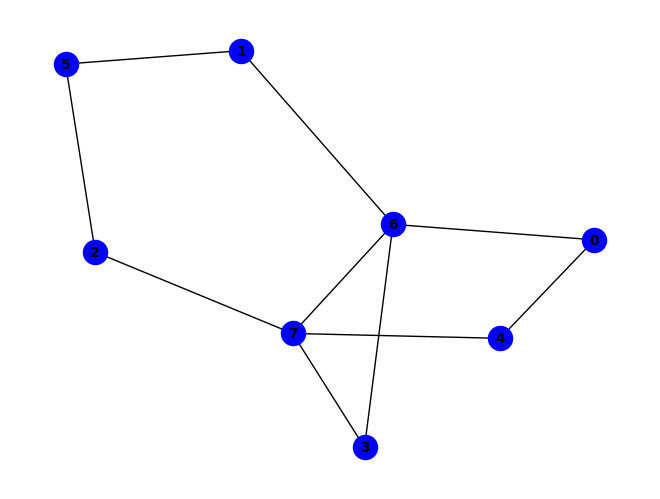


(~c & ~g) ^ (b & e & f & g) ^ (b & e & f & h) ^ (g & ~c & ~h) ^ (a & g & ~d & ~h) ^ (b & f & ~c & ~g) ^ (d & g & ~c & ~e) ^ (d & h & ~c & ~e) ^ (e & h & ~c & ~g) ^ (a & b & e & f & ~h) ^ (b & d & f & g & ~c) ^ (b & d & f & h & ~c) ^ (c & ~d & ~f & ~h) ^ (d & e & g & ~c & ~h) ^ (b & c & e & f & h & ~g) ^ (a & e & ~c & ~g & ~h) ^ (b & g & ~a & ~e & ~h) ^ (c & d & ~f & ~g & ~h) ^ (a & b & d & g & ~c & ~h) ^ (a & c & f & g & ~d & ~h) ^ (b & c & f & g & ~a & ~h) ^ (b & d & e & g & ~c & ~f) ^ (b & d & e & h & ~c & ~f) ^ (b & d & e & h & ~c & ~g) ^ (a & c & e & ~f & ~g & ~h) ^ (b & d & g & ~e & ~f & ~h) ^ (b & e & g & ~a & ~f & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & c & e & f & ~g & ~h) ^ (b & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


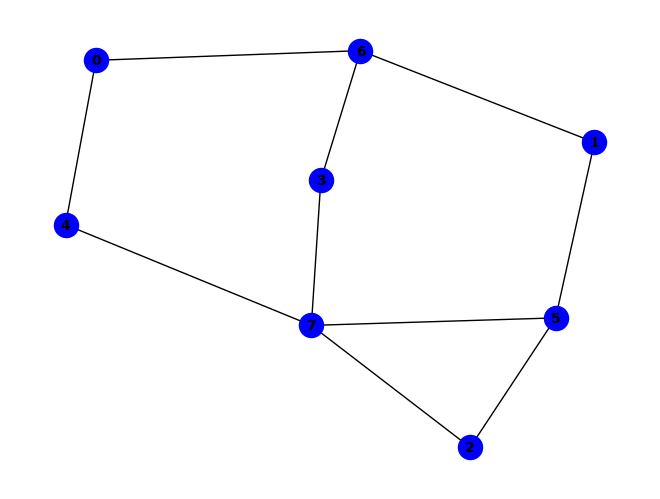


(a & b & g) ^ (b & d & g) ^ (~b & ~f) ^ (a & g & ~e) ^ (c & f & ~e) ^ (c & h & ~e) ^ (d & g & ~h) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (a & d & g & ~b) ^ (b & c & f & ~h) ^ (b & c & h & ~f) ^ (c & d & h & ~f) ^ (a & b & c & g & h) ^ (b & d & f & g & h) ^ (a & e & ~f & ~h) ^ (d & h & ~e & ~f) ^ (a & e & f & g & ~b) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (c & d & f & g & ~h) ^ (b & ~c & ~f & ~g) ^ (a & e & f & ~g & ~h) ^ (a & b & c & f & g & ~e) ^ (a & b & e & g & h & ~d) ^ (a & d & e & g & h & ~f) ^ (b & c & d & e & f & ~h) ^ (b & c & d & f & g & ~a) ^ (b & c & d & g & h & ~a) ^ (a & b & c & e & f & g & h) ^ (a & b & d & e & f & g & h) ^ (b & c & ~f & ~g & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & c & f & g & ~d & ~e) ^ (a & c & g & h & ~d & ~e) ^ (a & f & g & h & ~b & ~d) ^ (b & e & g & h & ~d & ~f) ^ (c & e & f & ~a & ~d & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (b & c & d & e & h & ~f & ~g) ^ (b & c & e & g & h & ~a & ~f) ^ (a & b & c & d & e & g & h & ~f)
PASS
PASS
PASS
PASS
PASS
P

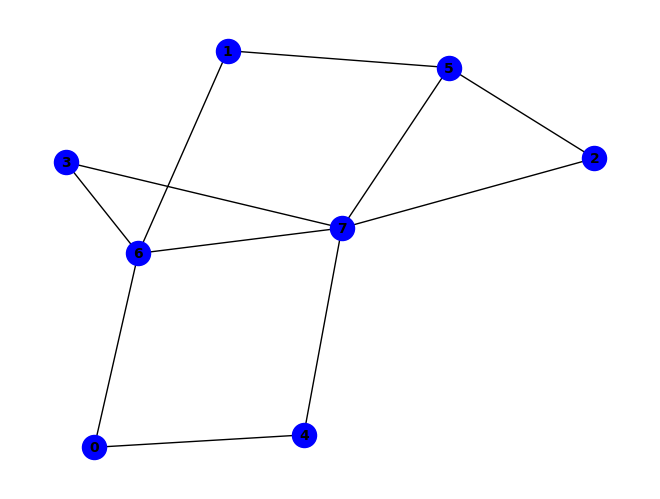


(~b & ~g) ^ (f & h & ~g) ^ (g & ~a & ~h) ^ (b & d & g & ~h) ^ (a & b & ~d & ~g) ^ (b & c & ~d & ~h) ^ (b & h & ~a & ~g) ^ (c & f & ~d & ~h) ^ (c & h & ~f & ~g) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & b & d & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & ~c & ~f & ~h) ^ (a & b & d & ~c & ~h) ^ (a & d & g & ~c & ~h) ^ (b & f & g & ~a & ~h) ^ (c & d & f & ~g & ~h) ^ (d & e & h & ~c & ~g) ^ (d & f & g & ~e & ~h) ^ (c & d & e & f & g & ~h) ^ (a & b & ~e & ~g & ~h) ^ (a & e & ~c & ~g & ~h) ^ (e & h & ~c & ~f & ~g) ^ (a & b & c & e & ~g & ~h) ^ (a & c & f & g & ~b & ~h) ^ (a & b & e & ~c & ~f & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & e & ~f & ~g & ~h) ^ (b & c & d & ~a & ~g & ~h) ^ (a & b & c & e & g & ~f & ~h) ^ (c & d & g & ~a & ~b & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


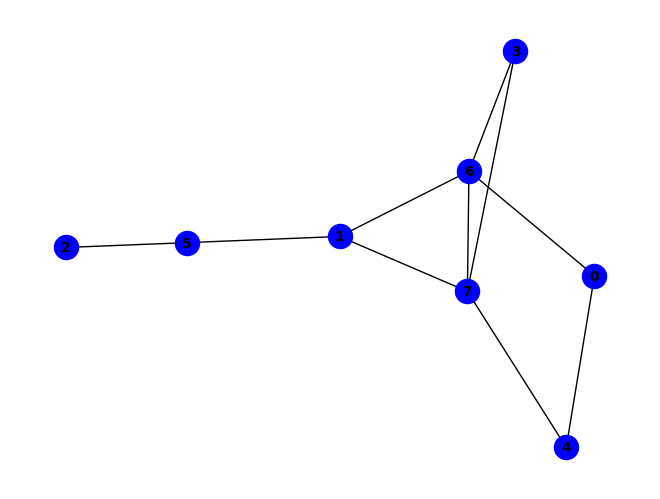


(~c & ~g) ^ (b & f & ~a) ^ (b & g & ~f) ^ (b & h & ~f) ^ (a & b & f & g) ^ (b & f & g & h) ^ (g & ~c & ~h) ^ (b & c & f & ~g) ^ (a & e & ~c & ~h) ^ (c & g & ~f & ~h) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (a & b & f & h & ~g) ^ (c & d & f & g & ~b) ^ (c & d & f & h & ~b) ^ (c & ~a & ~f & ~g) ^ (a & b & f & ~e & ~h) ^ (a & c & h & ~f & ~g) ^ (d & e & g & ~b & ~h) ^ (a & b & c & e & f & ~h) ^ (a & c & ~e & ~f & ~h) ^ (a & g & ~c & ~e & ~h) ^ (e & h & ~b & ~c & ~g) ^ (a & b & e & g & ~c & ~h) ^ (b & c & f & g & ~a & ~h) ^ (c & d & e & h & ~b & ~g) ^ (a & b & g & ~e & ~f & ~h) ^ (a & d & g & ~b & ~c & ~h) ^ (a & c & d & g & ~b & ~f & ~h) ^ (a & c & e & g & ~b & ~f & ~h) ^ (c & e & h & ~b & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


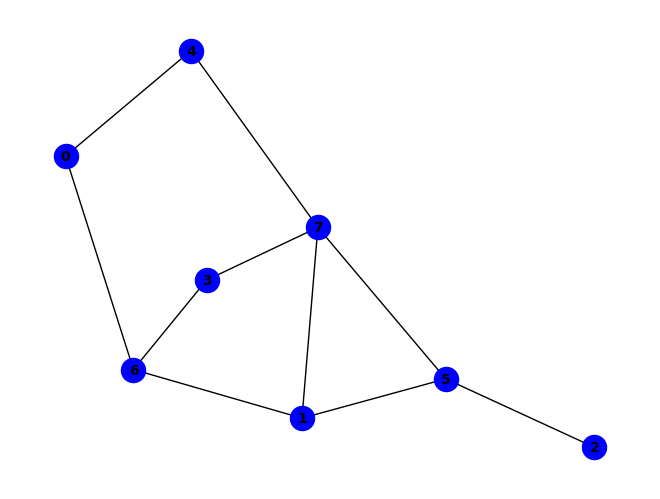


(f & ~h) ^ (a & d & g) ^ (b & d & g) ^ (~c & ~f) ^ (a & g & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (c & h & ~f) ^ (d & g & ~h) ^ (e & h & ~f) ^ (b & e & f & h) ^ (b & f & g & h) ^ (c & ~d & ~h) ^ (a & b & g & ~d) ^ (b & c & f & ~h) ^ (b & d & h & ~g) ^ (b & f & ~a & ~g) ^ (d & h & ~e & ~f) ^ (a & b & e & f & ~d) ^ (a & b & f & h & ~e) ^ (a & e & f & g & ~b) ^ (a & f & g & h & ~d) ^ (b & d & e & h & ~f) ^ (b & d & f & h & ~a) ^ (a & e & f & ~g & ~h) ^ (c & d & f & ~g & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & e & g & h & ~d) ^ (a & d & e & g & h & ~f) ^ (a & e & ~c & ~f & ~h) ^ (c & d & ~b & ~f & ~h) ^ (a & b & d & f & ~e & ~g) ^ (a & c & e & g & ~f & ~h) ^ (a & c & f & g & ~d & ~h) ^ (b & c & d & g & ~a & ~h) ^ (a & b & d & e & f & g & ~h) ^ (a & b & f & ~d & ~g & ~h) ^ (a & c & e & ~b & ~g & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

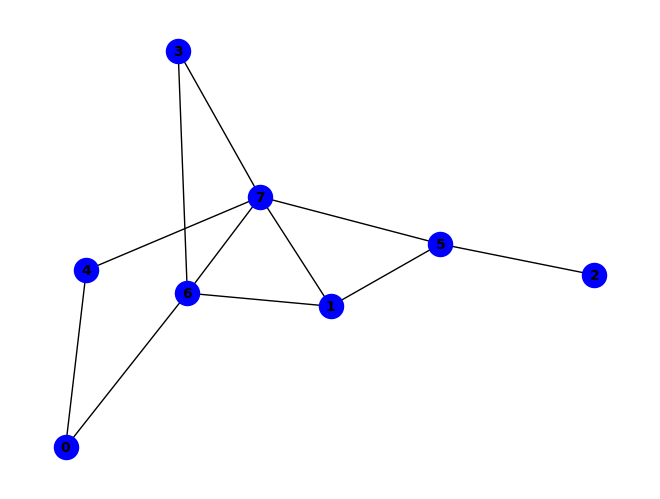


(g & ~h) ^ (~a & ~g) ^ (b & f & ~g) ^ (b & h & ~e) ^ (f & h & ~g) ^ (a & b & f & ~h) ^ (a & e & g & ~h) ^ (b & d & g & ~f) ^ (b & d & h & ~f) ^ (b & e & g & ~h) ^ (a & d & ~c & ~g) ^ (a & d & ~c & ~h) ^ (a & h & ~d & ~g) ^ (b & g & ~a & ~e) ^ (c & f & ~b & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~f & ~g) ^ (a & b & g & h & ~e) ^ (a & c & d & h & ~g) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (a & ~b & ~e & ~h) ^ (a & b & g & ~f & ~h) ^ (c & d & g & ~b & ~h) ^ (c & d & h & ~f & ~g) ^ (d & e & h & ~b & ~g) ^ (a & b & d & g & ~c & ~h) ^ (a & c & f & g & ~b & ~h) ^ (b & c & d & g & ~f & ~h) ^ (d & f & g & ~b & ~e & ~h) ^ (a & b & ~e & ~f & ~g & ~h) ^ (a & c & d & g & ~b & ~f & ~h) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


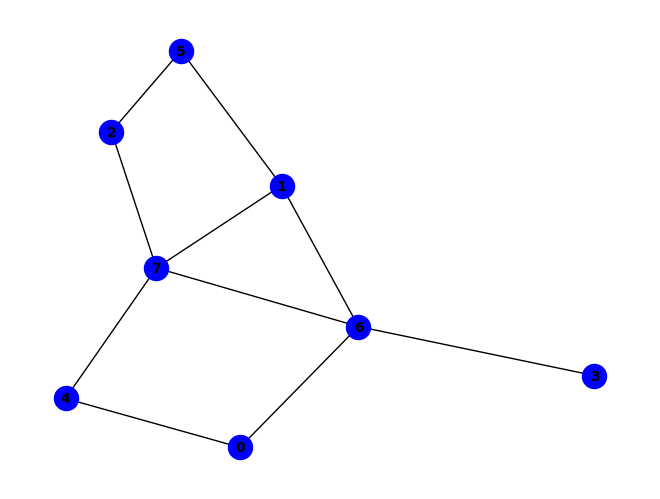


(b & g & ~f) ^ (b & h & ~e) ^ (a & b & f & g) ^ (b & e & g & h) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (b & d & g & ~h) ^ (~c & ~d & ~g) ^ (b & c & ~d & ~g) ^ (b & f & ~a & ~h) ^ (d & h & ~c & ~g) ^ (e & h & ~c & ~g) ^ (b & c & d & h & ~g) ^ (b & c & e & h & ~g) ^ (b & f & g & h & ~a) ^ (b & c & d & ~a & ~h) ^ (b & c & g & ~a & ~h) ^ (a & e & ~c & ~g & ~h) ^ (a & g & ~b & ~d & ~h) ^ (a & b & c & d & ~g & ~h) ^ (a & c & f & g & ~d & ~h) ^ (c & ~b & ~d & ~f & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & e & ~f & ~g & ~h) ^ (a & b & c & e & f & ~g & ~h) ^ (c & d & ~b & ~f & ~g & ~h) ^ (a & b & c & g & ~d & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


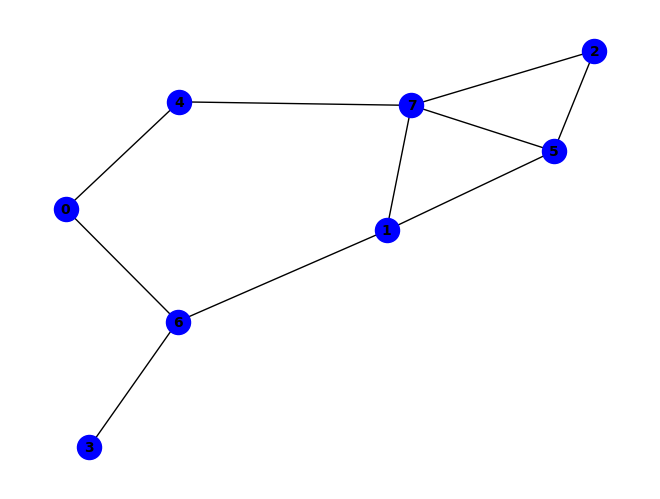


~f ^ (f & ~h) ^ (a & d & g) ^ (a & g & ~e) ^ (b & g & ~h) ^ (c & h & ~e) ^ (d & g & ~b) ^ (e & h & ~f) ^ (a & b & g & ~d) ^ (b & c & d & f & g) ^ (a & e & ~f & ~h) ^ (b & f & ~d & ~g) ^ (b & h & ~c & ~e) ^ (c & f & ~b & ~e) ^ (a & b & e & f & ~h) ^ (a & e & f & g & ~b) ^ (a & f & g & h & ~d) ^ (b & c & e & f & ~h) ^ (b & d & f & h & ~a) ^ (b & e & f & h & ~d) ^ (b & f & g & h & ~a) ^ (c & d & f & g & ~e) ^ (d & e & g & h & ~b) ^ (d & f & g & h & ~e) ^ (a & b & d & e & f & h) ^ (a & e & f & ~g & ~h) ^ (c & e & f & ~d & ~h) ^ (a & b & e & g & h & ~d) ^ (a & c & d & f & g & ~b) ^ (a & d & e & g & h & ~f) ^ (a & c & d & e & f & g & h) ^ (a & c & e & f & ~b & ~h) ^ (a & c & f & g & ~b & ~e) ^ (b & d & e & f & ~c & ~g) ^ (c & d & g & h & ~b & ~e) ^ (b & c & d & e & f & h & ~a) ^ (b & d & f & ~e & ~g & ~h) ^ (a & b & d & f & h & ~e & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (a & c & g & h & ~b & ~d & ~e) ^ (c & d & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


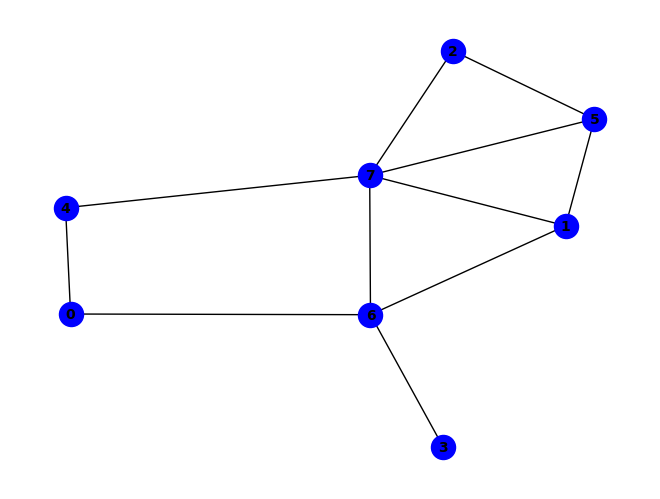


(~d & ~g) ^ (b & f & ~g) ^ (b & h & ~e) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (g & ~a & ~h) ^ (b & c & f & ~h) ^ (c & e & f & ~g) ^ (b & g & ~a & ~e) ^ (c & d & ~g & ~h) ^ (c & f & ~e & ~h) ^ (e & h & ~f & ~g) ^ (a & b & g & h & ~e) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (a & b & f & ~e & ~h) ^ (a & b & f & ~g & ~h) ^ (a & b & g & ~d & ~h) ^ (a & d & g & ~c & ~h) ^ (b & d & g & ~c & ~h) ^ (b & e & g & ~f & ~h) ^ (c & e & h & ~b & ~g) ^ (a & e & ~c & ~g & ~h) ^ (c & h & ~b & ~f & ~g) ^ (a & c & d & g & ~f & ~h) ^ (a & c & f & g & ~b & ~h) ^ (c & e & f & g & ~b & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & e & ~f & ~g & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (a & b & c & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


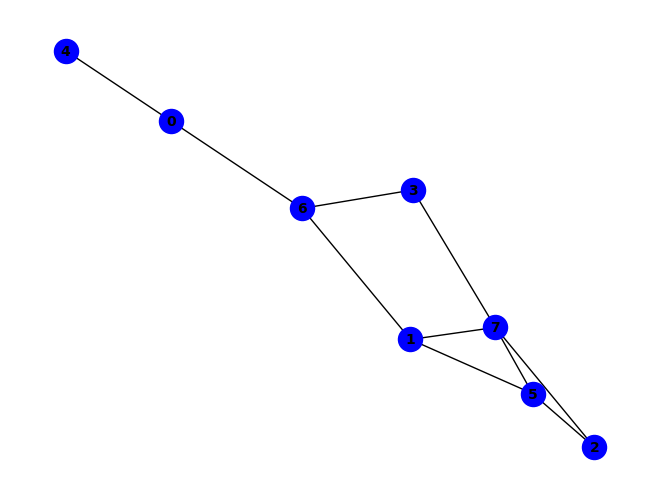


(~a & ~f) ^ (b & f & ~g) ^ (d & g & ~h) ^ (b & d & f & h) ^ (a & ~e & ~g) ^ (f & ~a & ~h) ^ (a & d & g & ~f) ^ (a & d & h & ~f) ^ (b & h & ~a & ~d) ^ (c & f & ~a & ~b) ^ (c & h & ~a & ~b) ^ (a & b & c & f & ~g) ^ (a & d & f & g & ~h) ^ (b & f & g & h & ~a) ^ (a & b & d & f & g & h) ^ (a & c & f & ~e & ~g) ^ (a & f & h & ~e & ~g) ^ (b & g & ~a & ~d & ~h) ^ (d & h & ~a & ~c & ~f) ^ (a & b & e & f & ~c & ~g) ^ (a & d & e & h & ~f & ~g) ^ (b & c & d & h & ~a & ~f) ^ (a & b & d & e & f & h & ~g) ^ (a & b & h & ~d & ~e & ~g) ^ (a & c & h & ~b & ~e & ~g) ^ (c & d & f & g & ~a & ~b & ~h) ^ (a & c & d & h & ~b & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


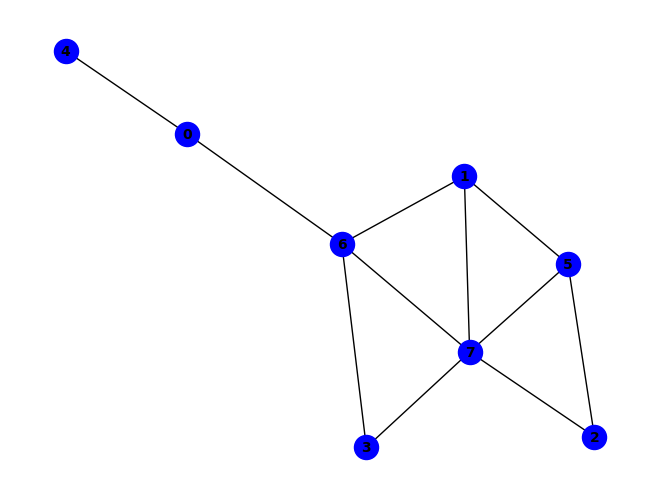


(~a & ~g) ^ (b & f & ~g) ^ (b & g & ~d) ^ (b & h & ~d) ^ (a & b & e & f) ^ (a & b & e & h) ^ (a & ~e & ~g) ^ (g & ~a & ~h) ^ (c & f & ~b & ~h) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (f & h & ~a & ~g) ^ (a & b & g & h & ~e) ^ (b & c & d & f & ~h) ^ (b & c & d & h & ~g) ^ (b & d & f & h & ~g) ^ (a & b & g & ~d & ~f) ^ (a & f & h & ~e & ~g) ^ (d & f & g & ~c & ~h) ^ (a & b & d & h & ~c & ~f) ^ (a & b & d & h & ~e & ~g) ^ (a & b & f & g & ~d & ~e) ^ (a & c & d & f & ~g & ~h) ^ (a & d & f & g & ~b & ~h) ^ (b & c & d & f & ~a & ~g) ^ (a & b & c & d & f & g & ~e) ^ (a & b & c & d & f & h & ~g) ^ (a & b & c & d & g & h & ~f) ^ (a & c & f & ~b & ~d & ~h) ^ (a & c & f & ~b & ~e & ~g) ^ (a & d & h & ~e & ~f & ~g) ^ (b & c & h & ~a & ~f & ~g) ^ (a & b & d & f & h & ~c & ~e) ^ (a & c & d & f & h & ~e & ~g) ^ (c & h & ~a & ~d & ~f & ~g) ^ (a & c & h & ~b & ~d & ~e & ~g) ^ (a & b & d & f & g & ~c & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


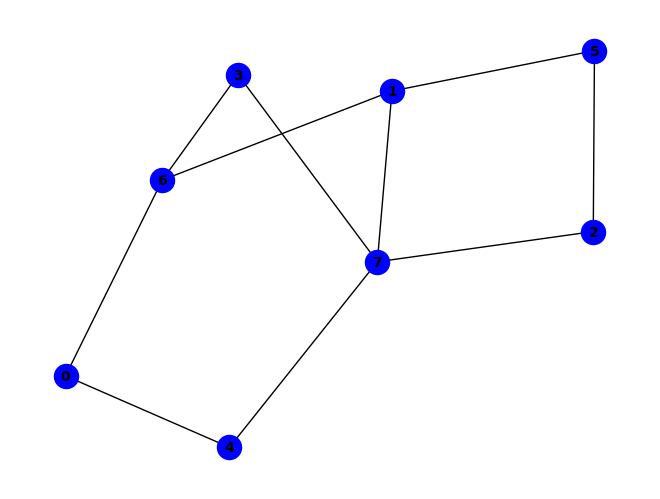


(~a & ~e) ^ (b & e & ~d) ^ (b & g & ~f) ^ (b & h & ~g) ^ (c & f & ~b) ^ (d & h & ~e) ^ (b & f & g & h) ^ (a & ~e & ~g) ^ (e & ~b & ~h) ^ (a & d & g & ~b) ^ (b & d & e & ~h) ^ (b & d & h & ~c) ^ (c & d & h & ~a) ^ (a & e & ~c & ~h) ^ (b & f & ~a & ~h) ^ (c & h & ~b & ~f) ^ (a & b & f & g & ~e) ^ (a & c & g & h & ~b) ^ (a & b & d & e & g & h) ^ (a & b & f & ~e & ~h) ^ (a & b & g & ~f & ~h) ^ (a & c & e & ~f & ~h) ^ (c & e & h & ~b & ~d) ^ (a & b & c & d & h & ~e) ^ (a & b & c & e & f & ~h) ^ (a & c & e & f & g & ~b) ^ (a & d & e & g & h & ~c) ^ (d & g & ~b & ~c & ~h) ^ (a & b & g & h & ~e & ~f) ^ (a & c & d & h & ~b & ~g) ^ (a & b & c & d & e & h & ~g) ^ (c & d & g & ~b & ~f & ~h) ^ (a & c & e & g & h & ~b & ~f) ^ (a & c & f & g & ~b & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


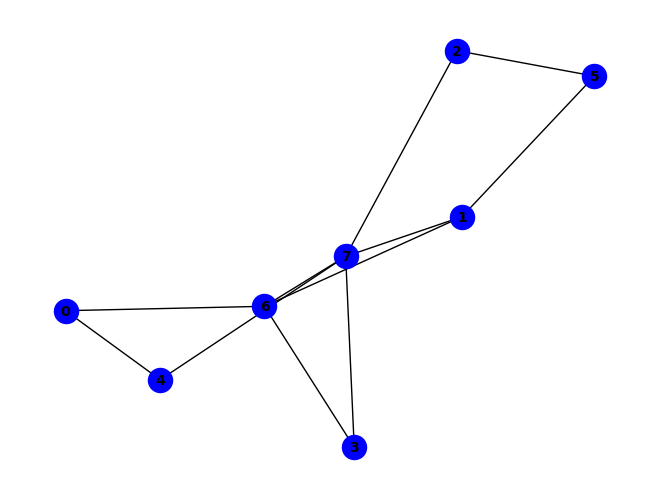


(~c & ~g) ^ (b & g & ~f) ^ (b & c & d & h) ^ (b & e & g & h) ^ (b & f & g & h) ^ (g & ~c & ~h) ^ (a & g & ~d & ~h) ^ (b & c & ~a & ~g) ^ (b & f & ~a & ~h) ^ (b & h & ~d & ~e) ^ (d & h & ~c & ~e) ^ (e & h & ~c & ~g) ^ (a & b & c & h & ~g) ^ (b & c & e & g & ~a) ^ (b & c & e & h & ~d) ^ (a & b & c & e & g & h) ^ (a & b & g & ~f & ~h) ^ (b & c & g & ~e & ~h) ^ (a & e & ~c & ~g & ~h) ^ (d & g & ~b & ~c & ~e) ^ (a & b & c & f & ~e & ~h) ^ (a & b & d & g & ~c & ~h) ^ (a & c & f & g & ~d & ~h) ^ (c & ~b & ~d & ~f & ~h) ^ (a & b & c & ~f & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & e & ~f & ~g & ~h) ^ (d & e & g & ~b & ~c & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & c & e & g & ~f & ~h) ^ (c & d & ~b & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


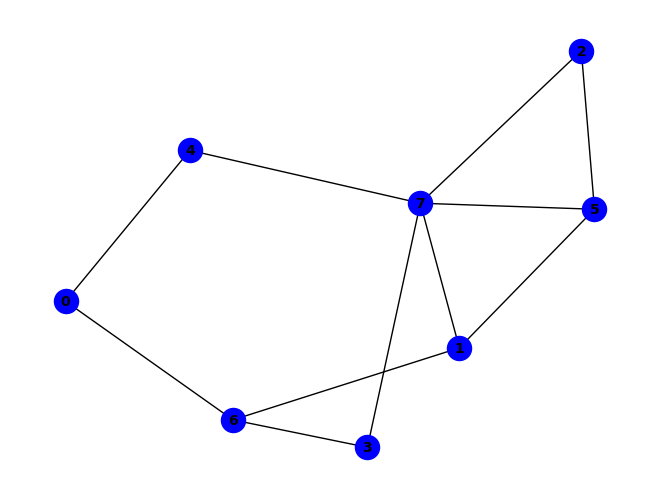


~f ^ (f & ~h) ^ (a & b & g) ^ (b & g & ~h) ^ (c & h & ~e) ^ (d & g & ~h) ^ (e & h & ~f) ^ (b & d & f & h) ^ (b & e & f & h) ^ (b & f & g & h) ^ (b & d & g & ~a) ^ (b & d & h & ~g) ^ (a & b & e & f & g) ^ (a & e & ~d & ~h) ^ (a & g & ~d & ~e) ^ (b & f & ~a & ~g) ^ (b & h & ~c & ~e) ^ (c & f & ~b & ~e) ^ (d & h & ~e & ~f) ^ (a & b & f & h & ~d) ^ (b & d & e & h & ~f) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (a & d & e & ~g & ~h) ^ (c & d & h & ~b & ~f) ^ (a & b & d & e & f & ~c) ^ (a & b & e & g & h & ~d) ^ (a & c & d & f & g & ~b) ^ (a & c & d & e & f & g & h) ^ (a & b & d & f & ~e & ~g) ^ (a & b & e & f & ~d & ~h) ^ (a & c & e & f & ~b & ~h) ^ (a & c & f & g & ~b & ~e) ^ (a & f & g & h & ~d & ~e) ^ (c & d & f & g & ~b & ~h) ^ (a & b & c & d & e & f & ~g) ^ (a & b & c & d & e & f & ~h) ^ (a & b & f & ~d & ~g & ~h) ^ (c & e & f & ~b & ~d & ~h) ^ (a & c & g & h & ~b & ~d & ~e) ^ (a & b & d & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

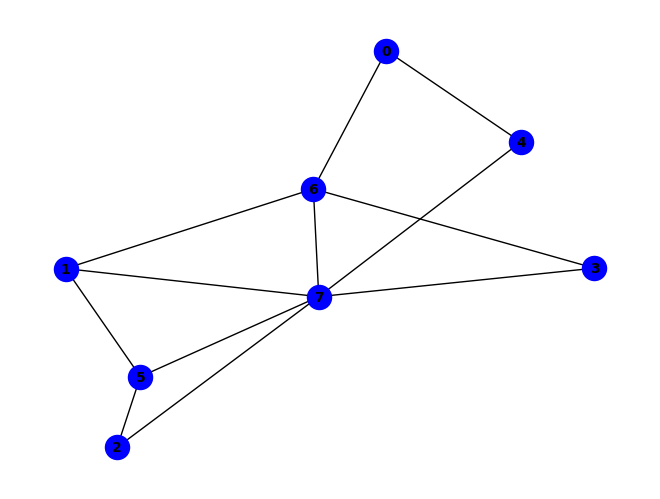


(g & ~h) ^ (~a & ~g) ^ (b & f & ~g) ^ (f & h & ~g) ^ (a & ~e & ~h) ^ (a & b & f & ~e) ^ (a & e & g & ~h) ^ (a & d & ~c & ~g) ^ (a & d & ~c & ~h) ^ (a & h & ~d & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (a & b & g & h & ~e) ^ (a & c & d & h & ~g) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & f & ~g & ~h) ^ (a & b & g & ~d & ~h) ^ (a & b & h & ~e & ~f) ^ (b & e & g & ~f & ~h) ^ (c & d & e & f & g & ~h) ^ (c & f & ~b & ~d & ~h) ^ (c & h & ~b & ~f & ~g) ^ (d & g & ~b & ~c & ~f) ^ (d & h & ~b & ~c & ~f) ^ (e & h & ~c & ~f & ~g) ^ (a & c & d & g & ~f & ~h) ^ (a & c & f & g & ~b & ~h) ^ (b & c & e & h & ~f & ~g) ^ (a & b & c & d & f & g & ~h) ^ (b & c & d & e & f & h & ~g) ^ (a & b & g & ~e & ~f & ~h) ^ (c & d & f & ~b & ~g & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (d & e & h & ~b & ~c & ~g) ^ (d & f & g & ~b & ~e & ~h) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

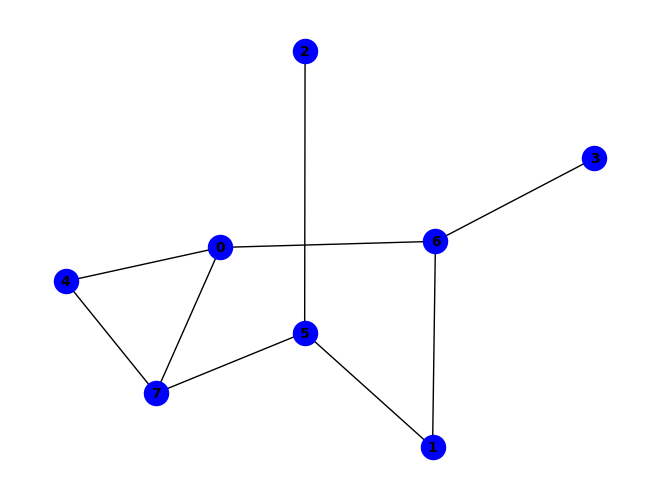


(a & d & g) ^ (~c & ~f) ^ (a & g & ~e) ^ (a & h & ~g) ^ (b & g & ~f) ^ (d & g & ~b) ^ (e & h & ~f) ^ (c & ~d & ~h) ^ (f & ~b & ~h) ^ (a & b & g & ~d) ^ (a & f & h & ~d) ^ (b & c & f & ~h) ^ (c & d & g & ~f) ^ (a & e & ~c & ~f) ^ (c & h & ~d & ~f) ^ (a & c & d & f & ~h) ^ (a & e & g & h & ~d) ^ (d & e & g & h & ~b) ^ (a & b & d & e & g & h) ^ (a & e & f & ~b & ~h) ^ (c & d & h & ~f & ~g) ^ (a & b & e & f & g & ~h) ^ (a & b & f & g & h & ~d) ^ (a & d & e & f & h & ~b) ^ (c & d & ~a & ~g & ~h) ^ (a & b & c & e & ~f & ~h) ^ (a & c & e & g & ~b & ~f) ^ (a & c & e & h & ~f & ~g) ^ (a & c & f & g & ~b & ~h) ^ (a & d & f & h & ~e & ~g) ^ (b & e & g & h & ~a & ~f) ^ (d & f & g & h & ~b & ~e) ^ (a & b & c & e & g & h & ~f) ^ (a & b & d & e & f & h & ~g) ^ (a & c & d & ~f & ~g & ~h) ^ (a & c & e & ~b & ~g & ~h) ^ (b & c & d & f & g & ~a & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


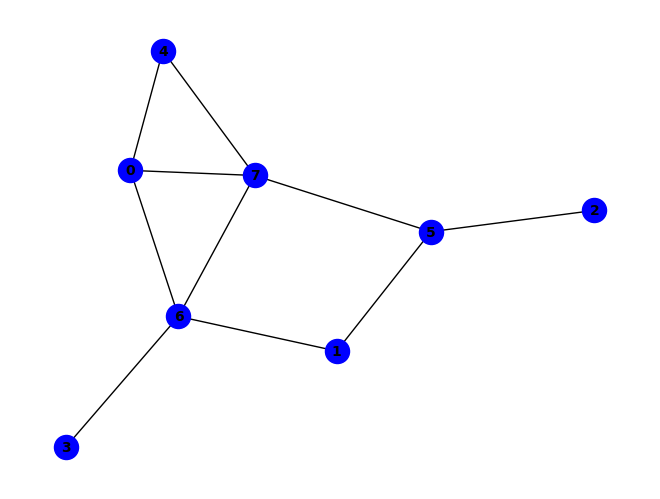


(~d & ~g) ^ (a & e & ~g) ^ (f & h & ~g) ^ (a & e & f & g) ^ (a & e & f & h) ^ (g & ~b & ~h) ^ (a & b & g & ~h) ^ (a & d & ~c & ~g) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (c & f & ~b & ~h) ^ (d & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & c & d & h & ~g) ^ (b & c & d & f & ~h) ^ (d & ~a & ~c & ~h) ^ (a & c & g & ~b & ~h) ^ (a & f & g & ~e & ~h) ^ (b & d & g & ~a & ~h) ^ (c & d & g & ~f & ~h) ^ (a & b & c & d & g & ~h) ^ (b & f & ~a & ~g & ~h) ^ (c & d & ~b & ~g & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & d & ~b & ~f & ~g) ^ (a & c & d & ~b & ~f & ~h) ^ (a & c & h & ~d & ~f & ~g) ^ (b & c & d & ~f & ~g & ~h) ^ (a & b & c & d & h & ~f & ~g) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


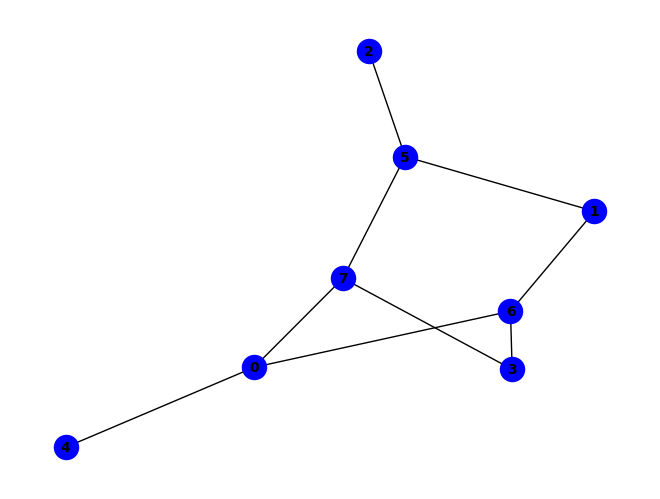


(~c & ~f) ^ (b & g & ~f) ^ (d & h & ~f) ^ (f & ~b & ~h) ^ (a & b & g & ~e) ^ (b & d & g & ~a) ^ (a & b & e & g & h) ^ (b & d & f & g & h) ^ (a & g & ~c & ~h) ^ (a & h & ~d & ~f) ^ (b & c & ~d & ~f) ^ (c & h & ~b & ~f) ^ (d & g & ~a & ~h) ^ (a & b & c & g & ~h) ^ (a & b & e & f & ~h) ^ (a & c & d & g & ~h) ^ (c & ~b & ~d & ~h) ^ (c & d & f & ~g & ~h) ^ (a & b & c & d & f & ~h) ^ (a & b & f & g & h & ~d) ^ (b & c & d & g & h & ~f) ^ (a & e & ~c & ~g & ~h) ^ (c & d & ~a & ~f & ~h) ^ (a & b & e & g & ~f & ~h) ^ (a & c & d & ~f & ~g & ~h) ^ (a & c & e & ~f & ~g & ~h) ^ (a & c & g & ~b & ~f & ~h) ^ (b & c & d & ~a & ~f & ~g) ^ (b & c & d & ~a & ~g & ~h) ^ (a & b & c & d & h & ~f & ~g) ^ (a & b & c & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


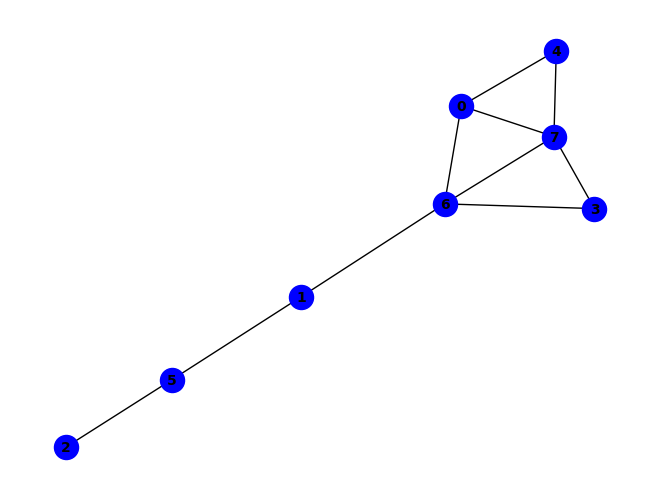


(~c & ~g) ^ (a & e & ~d) ^ (a & g & ~e) ^ (a & h & ~d) ^ (d & h & ~e) ^ (c & ~f & ~g) ^ (b & f & ~c & ~g) ^ (d & g & ~a & ~e) ^ (e & h & ~c & ~g) ^ (a & c & e & f & ~g) ^ (a & c & f & g & ~d) ^ (a & c & f & h & ~d) ^ (b & d & f & g & ~e) ^ (b & d & f & h & ~e) ^ (c & d & f & g & ~b) ^ (c & d & f & h & ~b) ^ (g & ~b & ~c & ~h) ^ (a & d & e & ~g & ~h) ^ (d & e & g & ~b & ~h) ^ (c & g & ~b & ~f & ~h) ^ (a & b & e & f & ~c & ~g) ^ (a & b & f & g & ~c & ~d) ^ (a & b & f & h & ~c & ~d) ^ (b & e & f & h & ~c & ~g) ^ (c & d & e & h & ~b & ~g) ^ (a & c & d & e & f & h & ~g) ^ (a & b & g & ~d & ~f & ~h) ^ (b & d & g & ~e & ~f & ~h) ^ (c & e & h & ~d & ~f & ~g) ^ (b & c & d & e & h & ~f & ~g) ^ (a & b & d & e & f & h & ~c & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


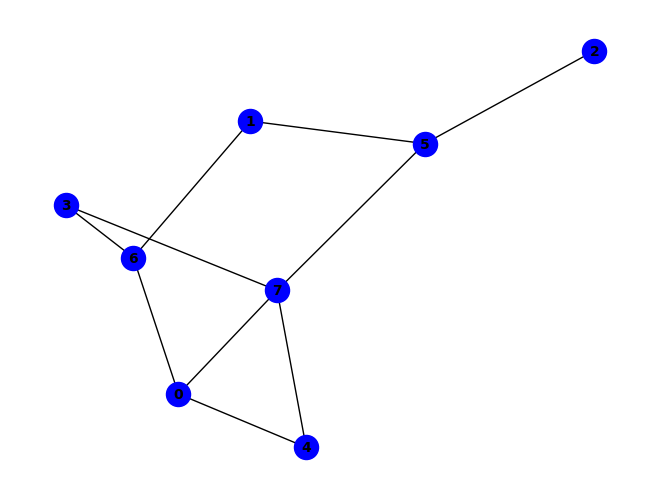


(a & d & g) ^ (b & d & g) ^ (~c & ~f) ^ (a & e & ~g) ^ (a & h & ~f) ^ (b & g & ~f) ^ (c & h & ~f) ^ (d & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (c & ~d & ~h) ^ (f & ~b & ~h) ^ (a & b & g & ~d) ^ (a & d & h & ~g) ^ (b & c & f & ~h) ^ (a & b & f & g & h) ^ (a & c & e & f & g) ^ (b & d & f & g & h) ^ (a & g & ~c & ~h) ^ (d & h & ~e & ~f) ^ (a & c & e & f & ~h) ^ (a & d & e & h & ~f) ^ (a & d & f & h & ~b) ^ (a & e & g & h & ~c) ^ (a & c & g & ~f & ~h) ^ (c & d & f & ~g & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & d & f & h & ~g) ^ (a & b & e & f & g & ~d) ^ (a & b & e & g & h & ~d) ^ (a & c & d & f & g & ~h) ^ (a & c & e & g & h & ~f) ^ (c & d & ~b & ~f & ~h) ^ (a & b & e & f & ~d & ~h) ^ (b & c & d & g & ~a & ~h) ^ (b & e & g & h & ~d & ~f) ^ (b & c & d & ~f & ~g & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & c & e & f & ~g & ~h) ^ (a & b & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

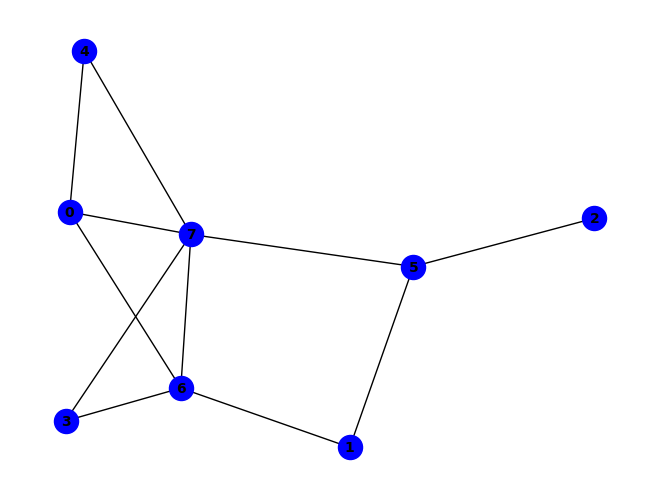


(g & ~h) ^ (~b & ~g) ^ (a & e & ~g) ^ (c & f & ~h) ^ (f & h & ~g) ^ (a & b & f & ~h) ^ (b & f & g & ~h) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (b & c & ~a & ~h) ^ (b & d & ~c & ~g) ^ (b & d & ~c & ~h) ^ (b & h & ~d & ~g) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~f & ~g) ^ (a & c & f & g & ~h) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~a) ^ (d & e & f & h & ~a) ^ (b & ~c & ~f & ~h) ^ (a & f & g & ~d & ~h) ^ (c & d & g & ~a & ~h) ^ (c & d & h & ~f & ~g) ^ (d & e & h & ~a & ~g) ^ (d & f & g & ~e & ~h) ^ (a & d & e & f & g & ~h) ^ (b & c & d & f & h & ~g) ^ (a & b & d & g & ~c & ~h) ^ (a & c & d & g & ~f & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & b & g & ~c & ~f & ~h) ^ (b & c & d & ~a & ~f & ~g) ^ (b & c & d & ~a & ~f & ~h) ^ (a & b & c & d & h & ~f & ~g) ^ (a & b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

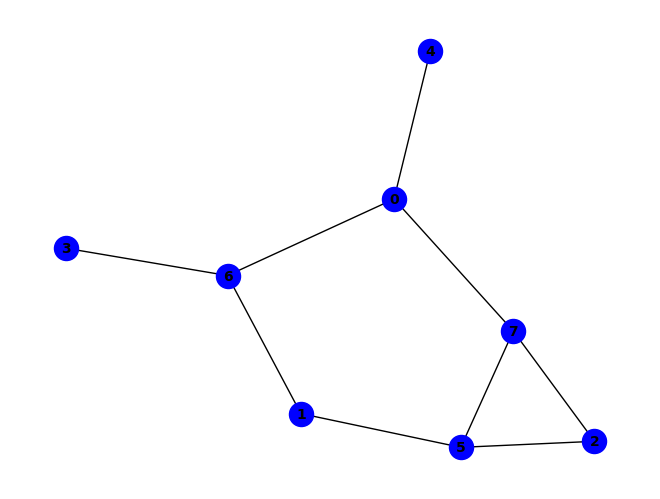


~f ^ (a & h & ~g) ^ (b & g & ~f) ^ (c & f & ~d) ^ (c & h & ~d) ^ (f & ~b & ~h) ^ (a & c & h & ~f) ^ (a & f & h & ~d) ^ (b & c & f & ~h) ^ (c & d & f & ~g) ^ (a & c & d & f & g) ^ (a & c & d & g & h) ^ (a & e & ~c & ~h) ^ (a & g & ~b & ~e) ^ (d & g & ~a & ~b) ^ (a & c & e & g & ~h) ^ (a & c & f & g & ~h) ^ (a & d & f & h & ~g) ^ (a & e & g & h & ~b) ^ (b & c & d & h & ~a) ^ (b & c & g & h & ~f) ^ (d & f & g & h & ~b) ^ (c & d & h & ~b & ~g) ^ (a & b & c & d & h & ~g) ^ (a & b & c & f & g & ~e) ^ (a & b & c & g & h & ~e) ^ (a & b & f & g & h & ~d) ^ (b & c & d & f & g & ~a) ^ (a & b & e & f & ~c & ~h) ^ (a & b & e & g & ~f & ~h) ^ (a & b & c & e & g & h & ~f) ^ (a & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


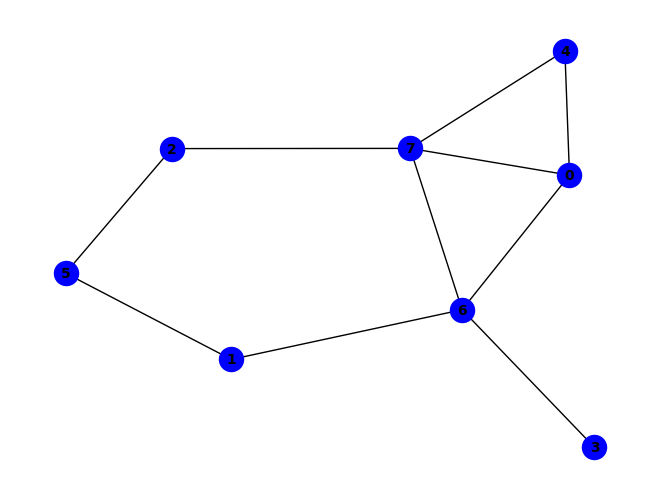


(a & g & ~c) ^ (a & h & ~c) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (~c & ~d & ~g) ^ (a & e & ~b & ~g) ^ (b & f & ~c & ~g) ^ (b & g & ~d & ~h) ^ (d & h & ~c & ~g) ^ (e & h & ~c & ~g) ^ (a & b & f & g & ~c) ^ (a & b & f & h & ~c) ^ (a & c & e & h & ~g) ^ (c & ~d & ~f & ~h) ^ (a & b & e & ~f & ~g) ^ (a & b & g & ~f & ~h) ^ (a & b & c & e & f & ~g) ^ (c & d & ~f & ~g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (b & c & f & g & ~d & ~h) ^ (b & e & f & h & ~c & ~g) ^ (a & c & g & ~d & ~f & ~h) ^ (a & d & g & ~b & ~c & ~h) ^ (a & b & c & d & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


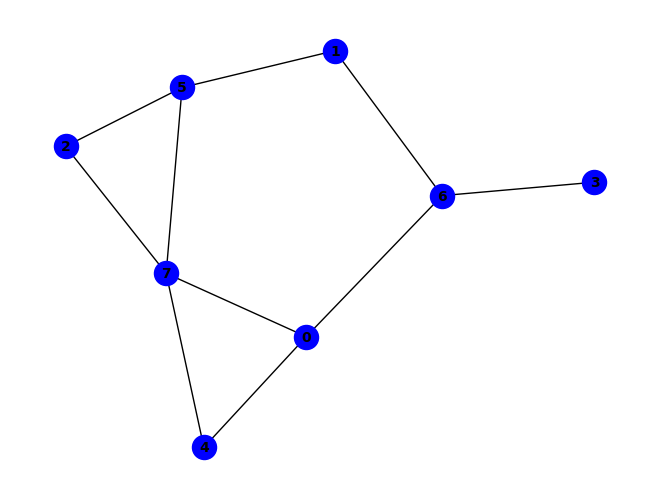


(~b & ~f) ^ (a & h & ~g) ^ (c & f & ~e) ^ (c & h & ~e) ^ (d & g & ~b) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (a & f & h & ~e) ^ (b & c & f & ~h) ^ (b & c & h & ~f) ^ (a & b & e & f & g) ^ (a & d & f & g & h) ^ (b & c & d & f & g) ^ (a & e & ~d & ~g) ^ (a & g & ~b & ~d) ^ (a & c & f & g & ~h) ^ (a & d & e & h & ~f) ^ (a & e & g & h & ~b) ^ (c & d & f & g & ~e) ^ (d & e & g & h & ~b) ^ (b & ~c & ~f & ~g) ^ (a & c & h & ~e & ~f) ^ (c & e & f & ~d & ~h) ^ (a & b & c & f & g & ~e) ^ (a & b & c & g & h & ~e) ^ (a & b & f & g & h & ~d) ^ (a & c & d & f & g & ~b) ^ (b & c & d & e & f & g & h) ^ (b & c & ~f & ~g & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & d & e & f & ~c & ~g) ^ (b & e & g & h & ~c & ~f) ^ (c & d & e & f & ~g & ~h) ^ (d & f & g & h & ~b & ~e) ^ (a & b & d & e & g & h & ~f) ^ (a & c & d & e & f & h & ~b) ^ (a & d & e & ~f & ~g & ~h) ^ (a & b & c & d & e & f & h & ~g) ^ (a & c & e & f & ~d & ~g & ~h) ^ (c & d & g & h & ~a & ~b & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

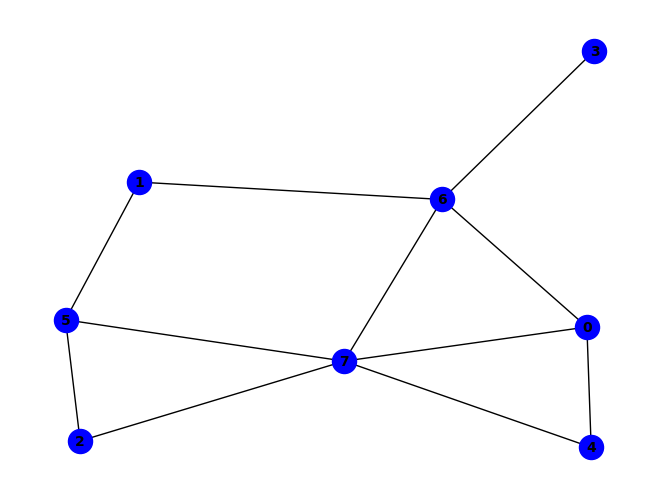


(~d & ~g) ^ (a & e & ~g) ^ (d & h & ~g) ^ (f & h & ~g) ^ (a & c & e & f) ^ (a & e & f & h) ^ (d & ~c & ~h) ^ (g & ~b & ~h) ^ (b & c & f & ~h) ^ (c & e & f & ~g) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (c & d & ~g & ~h) ^ (c & f & ~e & ~h) ^ (c & h & ~f & ~g) ^ (e & h & ~f & ~g) ^ (a & e & f & g & ~c) ^ (c & e & f & g & ~h) ^ (a & b & g & ~d & ~h) ^ (a & c & g & ~b & ~h) ^ (a & d & g & ~c & ~h) ^ (a & f & g & ~e & ~h) ^ (b & d & g & ~c & ~h) ^ (c & e & h & ~a & ~g) ^ (b & f & ~a & ~g & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & c & d & g & ~f & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (a & b & c & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


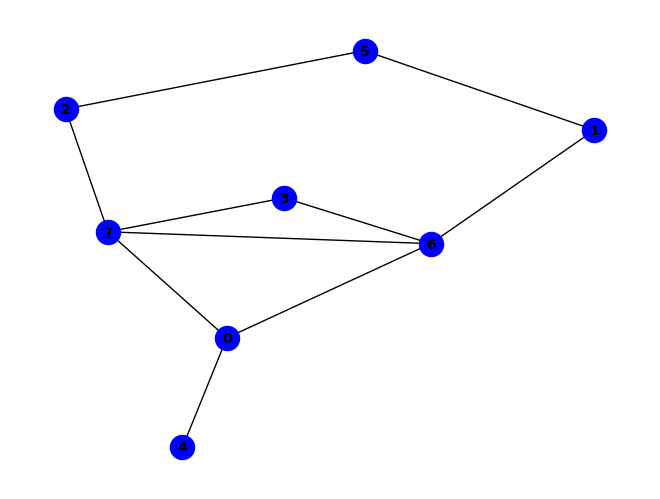


(~c & ~g) ^ (a & g & ~e) ^ (a & h & ~d) ^ (d & h & ~c) ^ (a & e & ~c & ~h) ^ (b & f & ~c & ~g) ^ (d & g & ~a & ~c) ^ (a & b & e & f & ~h) ^ (a & b & f & g & ~e) ^ (a & b & f & h & ~d) ^ (a & c & d & h & ~b) ^ (a & c & e & g & ~h) ^ (a & c & f & g & ~b) ^ (a & c & f & h & ~b) ^ (a & e & g & h & ~b) ^ (b & d & f & h & ~c) ^ (c & ~d & ~f & ~h) ^ (g & ~b & ~c & ~h) ^ (a & b & g & ~f & ~h) ^ (a & c & h & ~f & ~g) ^ (b & c & g & ~f & ~h) ^ (a & b & c & d & h & ~f) ^ (a & b & e & g & h & ~f) ^ (c & d & ~f & ~g & ~h) ^ (a & c & d & g & ~f & ~h) ^ (b & d & f & g & ~a & ~c) ^ (a & c & e & ~f & ~g & ~h) ^ (b & d & g & ~a & ~f & ~h) ^ (a & b & c & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


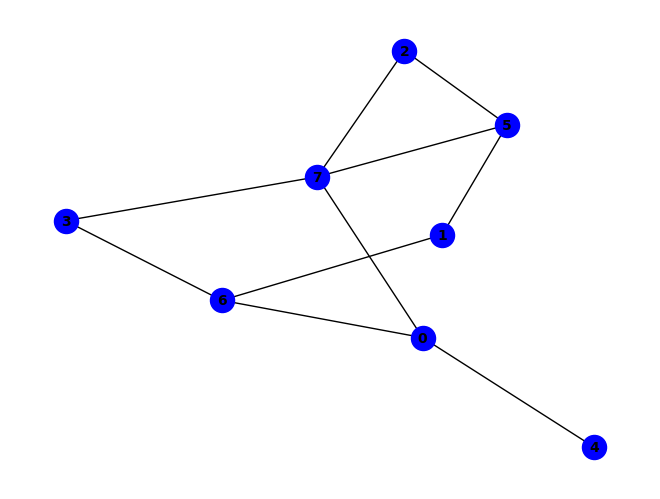


~f ^ (a & h & ~g) ^ (b & g & ~f) ^ (c & f & ~a) ^ (c & h & ~a) ^ (f & ~b & ~h) ^ (a & d & h & ~f) ^ (a & f & h & ~b) ^ (b & c & f & ~h) ^ (b & d & g & ~a) ^ (a & b & c & g & h) ^ (a & c & d & f & g) ^ (b & c & d & f & g) ^ (b & c & d & g & h) ^ (a & e & ~c & ~h) ^ (a & g & ~b & ~e) ^ (d & g & ~a & ~h) ^ (d & h & ~c & ~f) ^ (a & b & e & f & ~h) ^ (a & b & f & h & ~g) ^ (a & c & d & h & ~b) ^ (a & e & g & h & ~b) ^ (b & c & g & h & ~f) ^ (c & d & f & g & ~h) ^ (a & c & f & ~g & ~h) ^ (a & b & c & d & h & ~g) ^ (a & b & c & f & g & ~d) ^ (a & c & d & f & h & ~g) ^ (a & c & e & f & g & ~h) ^ (b & d & f & g & h & ~a) ^ (a & b & c & e & ~g & ~h) ^ (a & c & e & ~b & ~f & ~h) ^ (a & b & e & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


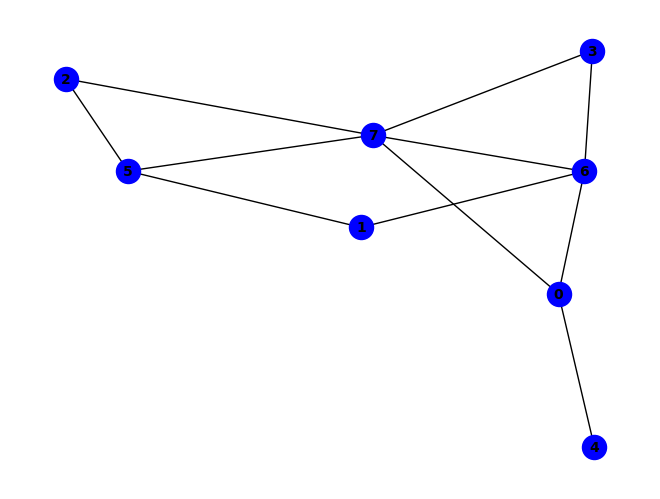


(g & ~h) ^ (a & c & h) ^ (~b & ~g) ^ (c & f & ~h) ^ (d & h & ~f) ^ (f & h & ~g) ^ (a & c & f & g) ^ (b & d & g & ~h) ^ (a & b & ~d & ~g) ^ (a & g & ~c & ~f) ^ (a & h & ~d & ~f) ^ (b & c & ~d & ~h) ^ (b & h & ~a & ~g) ^ (d & g & ~a & ~f) ^ (a & b & c & g & ~h) ^ (a & b & d & h & ~g) ^ (a & c & d & f & ~g) ^ (a & c & d & f & ~h) ^ (a & c & d & h & ~g) ^ (a & c & f & h & ~g) ^ (b & ~c & ~f & ~h) ^ (a & b & d & ~c & ~h) ^ (a & f & g & ~d & ~h) ^ (b & f & g & ~a & ~h) ^ (d & f & g & ~c & ~h) ^ (a & b & ~e & ~g & ~h) ^ (a & e & ~c & ~g & ~h) ^ (c & h & ~d & ~f & ~g) ^ (a & b & c & e & ~g & ~h) ^ (a & b & e & ~c & ~f & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & e & ~f & ~g & ~h) ^ (a & c & g & ~b & ~f & ~h) ^ (b & c & d & ~a & ~g & ~h) ^ (a & b & c & e & g & ~f & ~h) ^ (b & c & d & g & ~a & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

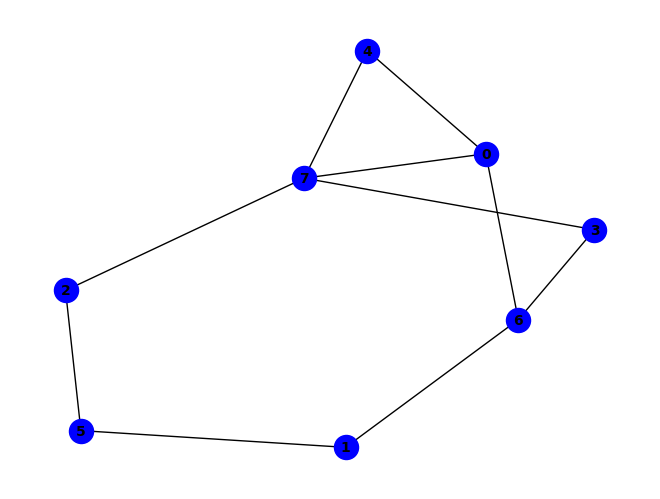


~e ^ (e & ~h) ^ (a & g & ~d) ^ (b & f & ~g) ^ (b & g & ~d) ^ (c & f & ~b) ^ (d & h & ~e) ^ (a & c & h & ~d) ^ (c & d & h & ~b) ^ (c & e & h & ~d) ^ (a & e & ~c & ~g) ^ (a & h & ~d & ~g) ^ (c & h & ~b & ~f) ^ (d & g & ~c & ~h) ^ (a & b & c & e & ~f) ^ (a & b & e & f & ~g) ^ (a & c & d & g & ~h) ^ (a & c & f & g & ~h) ^ (a & d & e & h & ~c) ^ (a & e & g & h & ~c) ^ (b & c & d & g & ~h) ^ (b & c & d & h & ~f) ^ (a & b & c & e & g & h) ^ (b & c & h & ~f & ~g) ^ (a & b & e & g & h & ~d) ^ (a & b & c & e & ~d & ~g) ^ (a & b & c & g & ~e & ~f) ^ (a & b & f & h & ~c & ~d) ^ (a & b & g & h & ~d & ~f) ^ (b & c & d & g & ~a & ~f) ^ (b & d & f & h & ~e & ~g) ^ (b & e & f & h & ~c & ~g) ^ (b & e & g & h & ~c & ~d) ^ (a & b & c & d & e & h & ~f) ^ (a & b & d & e & f & h & ~g) ^ (b & c & d & e & f & h & ~g) ^ (a & b & c & d & e & f & g & h) ^ (a & b & g & ~c & ~d & ~h) ^ (a & c & e & ~f & ~g & ~h) ^ (c & d & g & ~a & ~f & ~h) ^ (a & b & c & d & e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

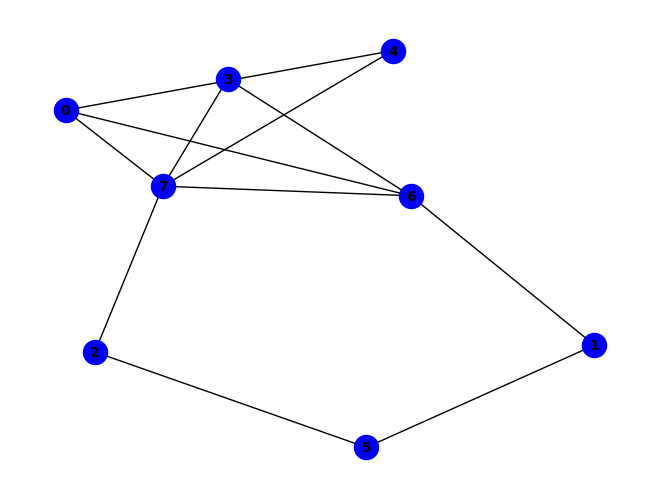


(~c & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (b & e & f & g) ^ (b & e & f & h) ^ (g & ~c & ~h) ^ (a & e & ~b & ~g) ^ (b & f & ~c & ~g) ^ (b & g & ~e & ~h) ^ (d & g & ~c & ~e) ^ (d & h & ~c & ~e) ^ (e & h & ~c & ~g) ^ (a & c & e & f & ~h) ^ (b & c & f & g & ~h) ^ (b & d & f & g & ~c) ^ (b & d & f & h & ~c) ^ (c & ~d & ~f & ~h) ^ (a & b & e & ~f & ~g) ^ (a & c & g & ~d & ~e) ^ (a & c & h & ~d & ~e) ^ (b & e & g & ~f & ~h) ^ (d & e & g & ~c & ~h) ^ (a & b & c & e & f & ~g) ^ (b & c & e & f & h & ~g) ^ (a & b & c & d & e & f & g) ^ (a & b & c & d & e & f & h) ^ (c & d & ~f & ~g & ~h) ^ (a & b & f & g & ~c & ~d) ^ (a & b & f & h & ~c & ~d) ^ (a & c & d & g & ~f & ~h) ^ (a & d & e & h & ~b & ~g) ^ (b & d & e & g & ~c & ~f) ^ (b & d & e & h & ~c & ~f) ^ (b & d & e & h & ~c & ~g) ^ (a & b & g & ~d & ~f & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (b & d & g & ~e & ~f & ~h) ^ (a & b & d & e & h & ~f & ~g) ^ (a & c & d & e & g & ~b & ~h) ^ (b & c & d & e & g & ~a & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
P

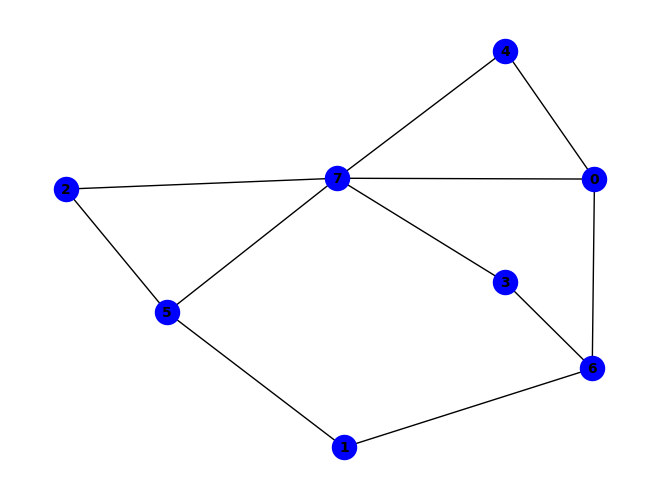


(b & d & g) ^ (~b & ~f) ^ (a & e & ~g) ^ (c & f & ~e) ^ (c & h & ~e) ^ (d & g & ~h) ^ (e & h & ~f) ^ (f & ~b & ~h) ^ (a & c & h & ~b) ^ (a & f & h & ~e) ^ (b & c & f & ~h) ^ (b & c & h & ~f) ^ (a & b & e & f & g) ^ (a & b & f & g & h) ^ (b & d & f & g & h) ^ (a & g & ~b & ~d) ^ (a & h & ~d & ~g) ^ (d & h & ~e & ~f) ^ (a & b & c & h & ~g) ^ (a & c & f & h & ~g) ^ (a & d & e & h & ~f) ^ (a & d & f & h & ~b) ^ (a & e & g & h & ~b) ^ (b & ~c & ~f & ~g) ^ (c & d & h & ~a & ~f) ^ (a & b & d & f & h & ~g) ^ (b & c & d & f & g & ~a) ^ (b & c & d & g & h & ~a) ^ (b & c & e & g & h & ~f) ^ (b & c & ~f & ~g & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & c & e & h & ~b & ~f) ^ (a & c & f & g & ~b & ~e) ^ (b & e & g & h & ~d & ~f) ^ (c & d & e & f & ~a & ~b) ^ (c & d & e & h & ~a & ~b) ^ (c & d & f & g & ~a & ~h) ^ (a & b & d & e & g & h & ~f) ^ (a & c & e & f & g & h & ~b) ^ (c & e & f & ~a & ~d & ~h) ^ (b & c & d & e & f & ~a & ~h) ^ (b & c & d & e & h & ~f & ~g) ^ (a & b & c & e & h & ~d & ~f & ~g)
P

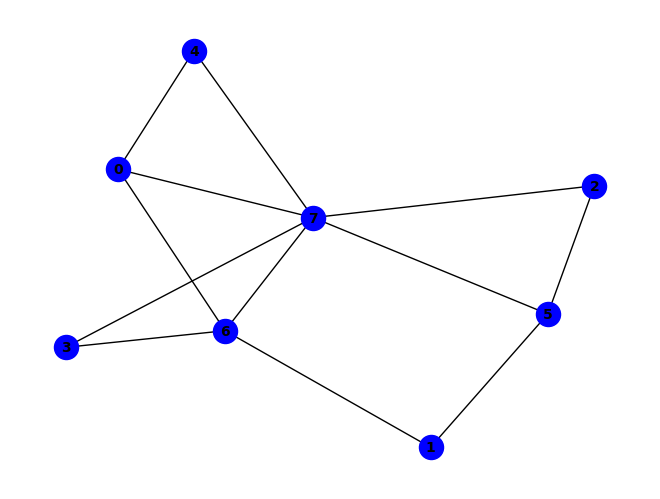


(g & ~h) ^ (~b & ~g) ^ (a & e & ~g) ^ (b & h & ~g) ^ (f & h & ~g) ^ (b & d & g & ~h) ^ (b & f & g & ~h) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (b & c & ~d & ~h) ^ (c & f & ~d & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & c & d & f & ~g) ^ (a & c & e & f & ~g) ^ (a & c & e & h & ~g) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & ~c & ~f & ~h) ^ (a & b & g & ~d & ~h) ^ (a & f & g & ~d & ~h) ^ (c & d & f & ~g & ~h) ^ (d & e & h & ~c & ~g) ^ (d & f & g & ~e & ~h) ^ (c & d & e & f & g & ~h) ^ (c & h & ~a & ~f & ~g) ^ (e & h & ~c & ~f & ~g) ^ (a & c & d & f & ~b & ~h) ^ (a & c & d & h & ~e & ~g) ^ (a & c & f & g & ~b & ~h) ^ (a & d & e & h & ~f & ~g) ^ (a & c & d & e & f & h & ~g) ^ (b & c & d & ~a & ~g & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (a & b & c & d & ~f & ~g & ~h) ^ (a & b & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

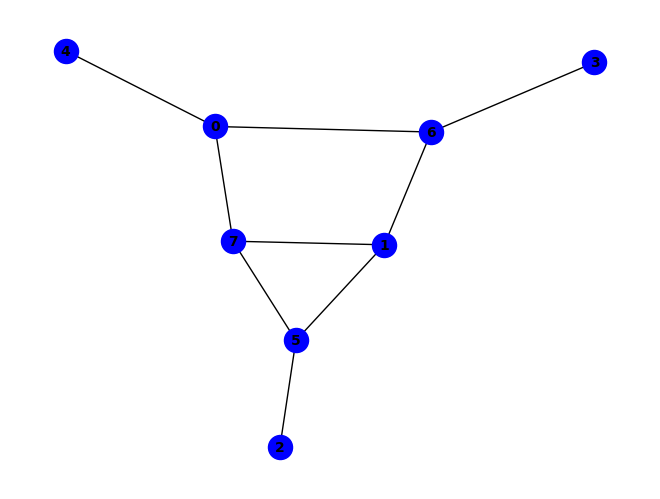


(f & ~h) ^ (~c & ~f) ^ (a & h & ~g) ^ (b & h & ~a) ^ (a & e & g & h) ^ (d & f & g & h) ^ (c & ~d & ~h) ^ (a & f & h & ~d) ^ (b & c & f & ~h) ^ (c & d & g & ~f) ^ (a & e & ~c & ~h) ^ (a & g & ~b & ~e) ^ (b & g & ~a & ~h) ^ (c & d & ~g & ~h) ^ (c & h & ~d & ~f) ^ (d & g & ~a & ~b) ^ (a & c & e & g & ~h) ^ (a & d & f & h & ~g) ^ (b & d & f & h & ~a) ^ (b & f & g & h & ~a) ^ (a & b & f & ~e & ~h) ^ (a & b & g & ~e & ~f) ^ (c & d & h & ~f & ~g) ^ (a & b & f & g & h & ~e) ^ (b & c & d & f & g & ~h) ^ (b & f & ~a & ~d & ~g) ^ (a & c & e & ~f & ~g & ~h) ^ (b & d & f & ~a & ~g & ~h) ^ (a & b & c & e & f & ~g & ~h) ^ (a & c & f & g & ~b & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


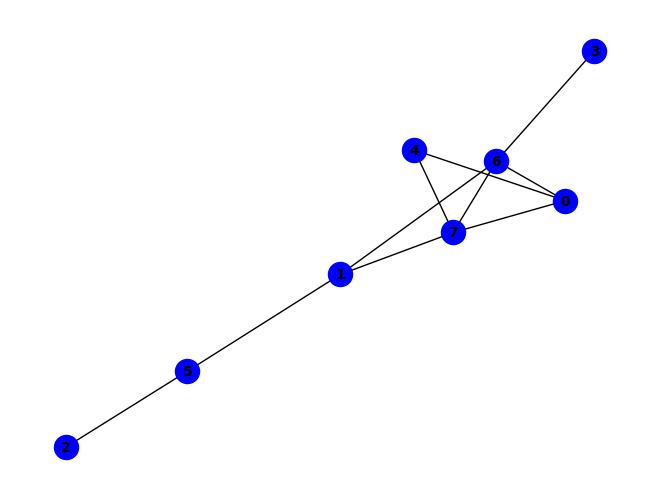


(~d & ~g) ^ (a & g & ~c) ^ (a & h & ~c) ^ (b & f & ~h) ^ (b & g & ~f) ^ (d & h & ~g) ^ (b & f & g & h) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (a & b & g & ~e) ^ (a & c & g & ~f) ^ (a & c & h & ~f) ^ (a & b & c & f & g) ^ (a & b & c & f & h) ^ (b & c & e & f & h) ^ (a & e & ~c & ~g) ^ (b & h & ~a & ~e) ^ (c & f & ~b & ~g) ^ (c & g & ~f & ~h) ^ (e & h & ~c & ~g) ^ (a & b & e & g & ~h) ^ (b & c & f & g & ~h) ^ (b & e & g & h & ~c) ^ (a & c & e & ~f & ~g) ^ (a & d & g & ~c & ~h) ^ (c & d & f & ~g & ~h) ^ (c & e & h & ~f & ~g) ^ (a & b & c & e & f & ~g) ^ (b & c & e & g & h & ~f) ^ (c & d & ~b & ~f & ~h) ^ (a & b & e & f & ~g & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (b & d & g & ~a & ~c & ~h) ^ (a & c & d & g & ~b & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


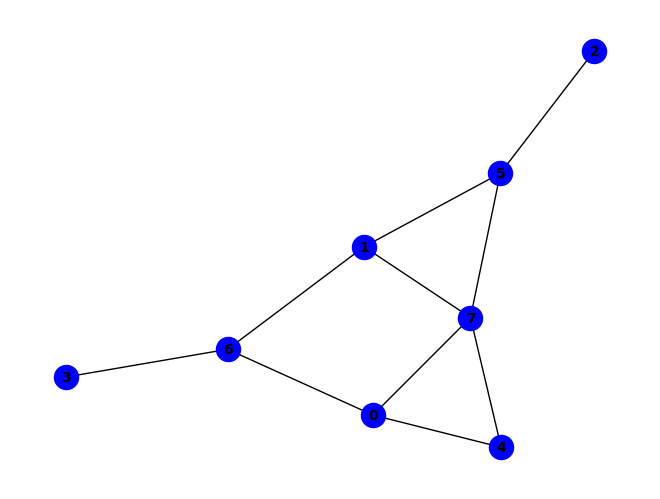


(f & ~h) ^ (a & d & g) ^ (~c & ~f) ^ (a & h & ~f) ^ (b & g & ~h) ^ (b & h & ~e) ^ (d & g & ~b) ^ (e & h & ~f) ^ (a & e & g & h) ^ (b & e & f & h) ^ (b & f & g & h) ^ (c & ~d & ~h) ^ (a & b & g & ~d) ^ (a & b & h & ~g) ^ (c & d & g & ~f) ^ (a & d & f & g & h) ^ (a & e & ~d & ~g) ^ (a & g & ~c & ~h) ^ (b & f & ~d & ~g) ^ (c & h & ~d & ~f) ^ (a & b & e & h & ~f) ^ (a & b & f & h & ~d) ^ (a & d & e & h & ~b) ^ (a & e & f & h & ~d) ^ (b & d & f & h & ~e) ^ (d & e & g & h & ~b) ^ (d & f & g & h & ~e) ^ (a & b & d & e & f & h) ^ (a & d & e & ~g & ~h) ^ (b & c & f & ~d & ~h) ^ (c & d & h & ~f & ~g) ^ (a & b & d & e & h & ~g) ^ (a & b & d & f & h & ~g) ^ (a & c & d & f & g & ~h) ^ (a & d & e & f & h & ~g) ^ (c & d & ~b & ~g & ~h) ^ (b & d & e & f & ~a & ~g) ^ (a & c & e & ~b & ~f & ~h) ^ (a & c & e & ~b & ~g & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (b & d & f & ~e & ~g & ~h) ^ (a & b & c & e & g & ~f & ~h) ^ (a & b & c & f & g & ~d & ~h) ^ (a & b & e & f & ~d & ~g & ~h

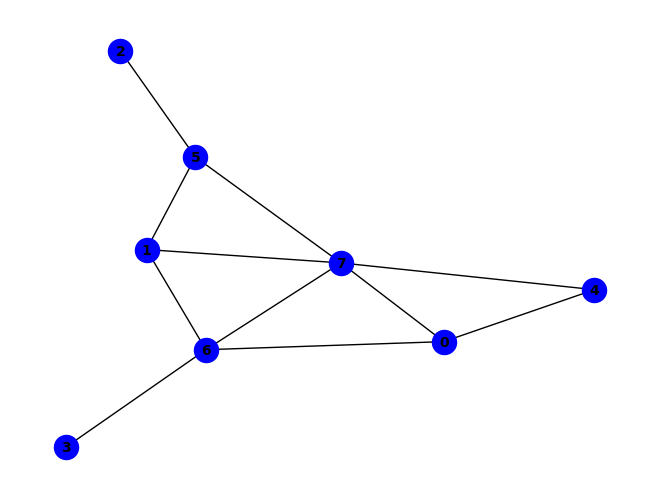


(g & ~h) ^ (~d & ~g) ^ (a & e & ~g) ^ (b & f & ~e) ^ (b & g & ~f) ^ (b & h & ~e) ^ (d & h & ~g) ^ (f & h & ~g) ^ (a & e & f & g) ^ (a & e & f & h) ^ (b & e & f & g) ^ (b & e & g & h) ^ (d & ~c & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (c & d & ~g & ~h) ^ (c & f & ~b & ~h) ^ (e & h & ~f & ~g) ^ (a & b & e & f & ~g) ^ (a & b & e & h & ~g) ^ (a & b & f & g & ~h) ^ (a & d & g & ~c & ~h) ^ (a & f & g & ~e & ~h) ^ (b & e & f & ~g & ~h) ^ (a & c & f & g & ~b & ~h) ^ (b & d & g & ~a & ~c & ~h) ^ (a & c & e & f & ~b & ~g & ~h) ^ (c & d & g & ~a & ~b & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


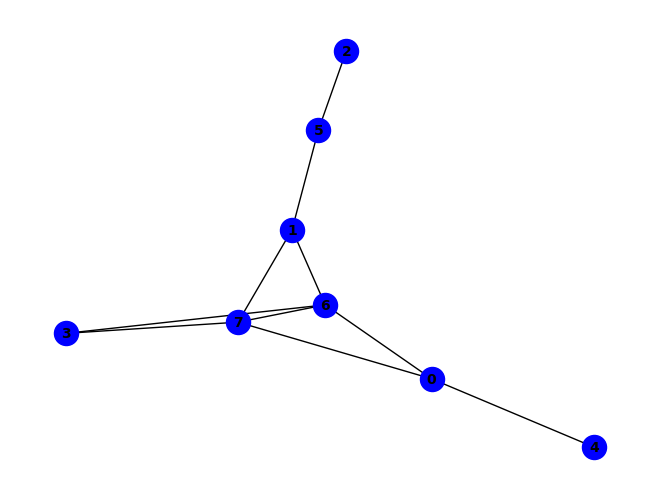


(~c & ~g) ^ (a & h & ~d) ^ (b & f & ~a) ^ (a & e & g & h) ^ (c & ~f & ~g) ^ (g & ~c & ~h) ^ (b & c & f & ~g) ^ (a & b & c & f & h) ^ (a & e & ~c & ~h) ^ (a & g & ~b & ~e) ^ (b & g & ~a & ~f) ^ (b & h & ~a & ~f) ^ (c & g & ~f & ~h) ^ (d & h & ~b & ~c) ^ (a & b & d & h & ~c) ^ (a & b & g & h & ~e) ^ (a & c & f & g & ~b) ^ (a & c & f & h & ~d) ^ (b & c & f & g & ~h) ^ (b & f & g & h & ~a) ^ (a & b & f & ~e & ~h) ^ (c & d & h & ~b & ~f) ^ (a & b & c & d & h & ~f) ^ (a & c & e & f & g & ~h) ^ (d & g & ~a & ~b & ~c) ^ (a & b & c & e & ~g & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & e & ~b & ~f & ~h) ^ (c & d & g & ~a & ~b & ~f) ^ (a & b & c & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


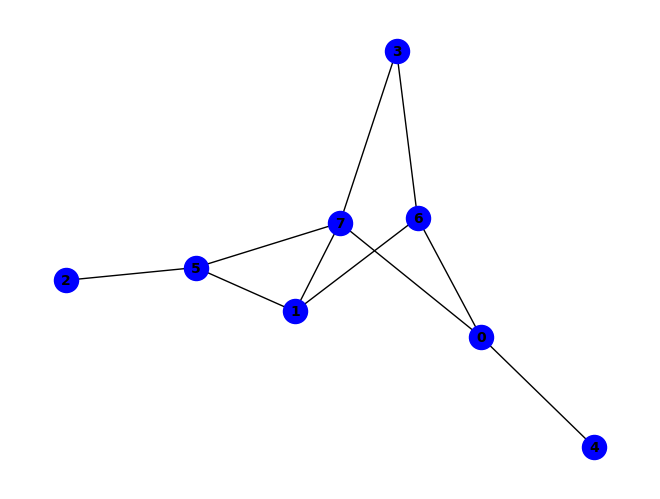


(f & ~h) ^ (~c & ~f) ^ (a & h & ~f) ^ (c & h & ~f) ^ (d & g & ~h) ^ (d & h & ~f) ^ (a & d & f & h) ^ (c & ~d & ~h) ^ (a & d & g & ~b) ^ (a & d & h & ~g) ^ (b & c & f & ~h) ^ (a & b & d & g & h) ^ (b & f & ~a & ~g) ^ (b & g & ~d & ~h) ^ (b & h & ~a & ~d) ^ (b & d & f & h & ~a) ^ (b & f & g & h & ~a) ^ (c & d & f & ~g & ~h) ^ (a & c & d & f & g & ~h) ^ (a & e & ~c & ~g & ~h) ^ (a & g & ~b & ~c & ~h) ^ (c & d & ~b & ~f & ~h) ^ (b & c & d & g & ~a & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & e & ~f & ~g & ~h) ^ (a & c & g & ~b & ~f & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & c & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


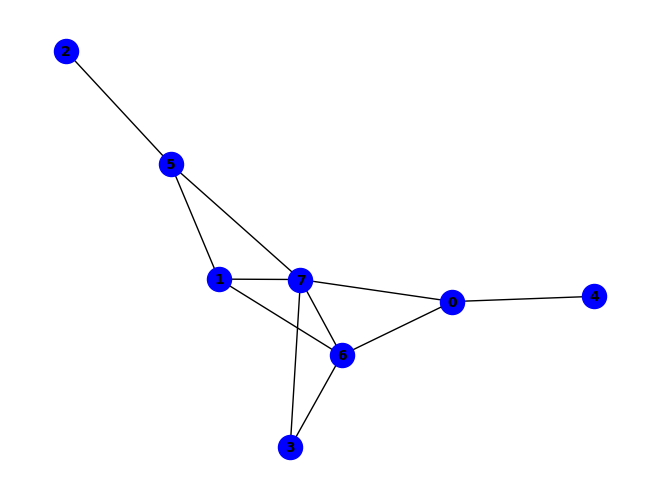


~g ^ (g & ~h) ^ (b & f & ~d) ^ (b & h & ~d) ^ (f & h & ~g) ^ (d & f & g & ~h) ^ (a & g & ~d & ~f) ^ (b & g & ~d & ~f) ^ (c & f & ~b & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & b & d & g & ~f) ^ (a & b & g & ~e & ~f) ^ (b & d & f & ~g & ~h) ^ (c & d & g & ~b & ~h) ^ (c & d & h & ~f & ~g) ^ (a & b & e & g & h & ~f) ^ (a & h & ~b & ~d & ~f) ^ (b & c & d & g & ~f & ~h) ^ (a & b & e & ~c & ~f & ~h) ^ (a & c & e & ~f & ~g & ~h) ^ (a & b & c & e & g & ~f & ~h) ^ (a & e & ~b & ~c & ~g & ~h) ^ (a & f & g & ~b & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


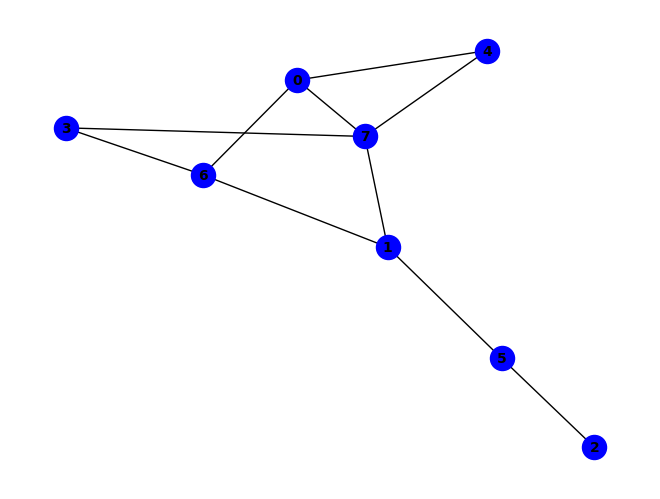


~e ^ (e & ~h) ^ (b & f & ~h) ^ (b & g & ~f) ^ (b & h & ~g) ^ (c & f & ~b) ^ (b & f & g & h) ^ (c & e & f & h) ^ (b & e & h & ~c) ^ (a & b & c & f & g) ^ (a & h & ~b & ~d) ^ (d & h & ~b & ~e) ^ (a & c & f & h & ~d) ^ (b & c & e & h & ~f) ^ (a & b & c & d & f & h) ^ (a & b & c & f & h & ~g) ^ (a & e & ~b & ~c & ~g) ^ (a & g & ~b & ~d & ~h) ^ (d & g & ~b & ~c & ~h) ^ (a & c & f & g & ~d & ~h) ^ (a & d & e & h & ~b & ~c) ^ (a & e & g & h & ~b & ~c) ^ (c & d & f & h & ~b & ~e) ^ (a & b & c & d & f & g & ~h) ^ (a & b & e & ~f & ~g & ~h) ^ (a & c & e & ~b & ~f & ~g) ^ (c & d & g & ~b & ~f & ~h) ^ (a & c & d & e & h & ~b & ~f) ^ (a & c & e & g & h & ~b & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


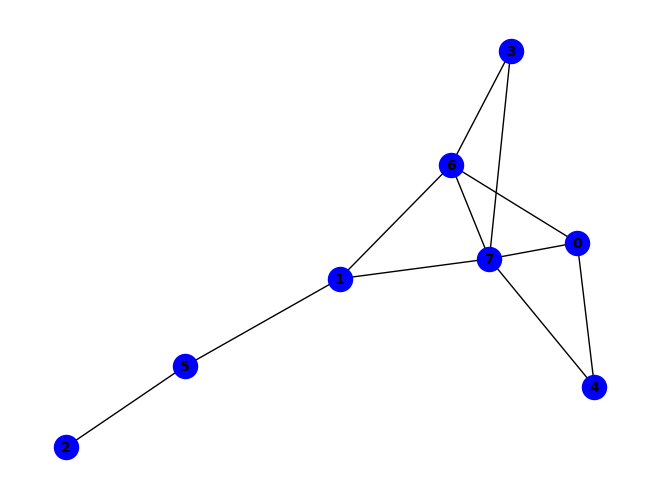


(b & f) ^ (~c & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (b & g & ~f) ^ (b & h & ~f) ^ (b & f & g & h) ^ (c & ~f & ~g) ^ (g & ~c & ~h) ^ (b & c & f & ~g) ^ (a & e & ~c & ~g) ^ (c & g & ~f & ~h) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (b & c & f & g & ~h) ^ (c & d & f & g & ~b) ^ (c & d & f & h & ~b) ^ (a & b & g & ~d & ~e) ^ (a & b & h & ~d & ~e) ^ (a & c & e & ~f & ~g) ^ (d & e & g & ~b & ~h) ^ (a & b & c & e & f & ~g) ^ (e & h & ~b & ~c & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & b & e & g & ~d & ~h) ^ (a & c & f & g & ~b & ~d) ^ (a & c & f & h & ~b & ~d) ^ (a & d & e & h & ~c & ~g) ^ (c & d & e & h & ~b & ~g) ^ (a & c & d & e & h & ~f & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (c & e & h & ~b & ~d & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


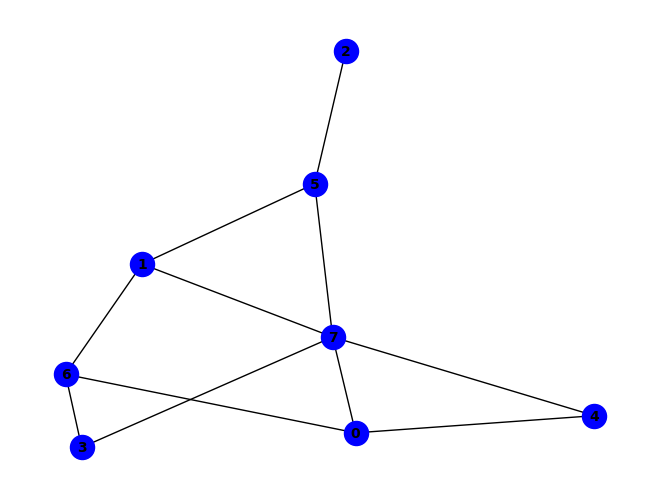


(f & ~h) ^ (~c & ~f) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & h & ~e) ^ (c & h & ~f) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & e & f & h) ^ (b & f & g & h) ^ (c & ~d & ~h) ^ (b & c & f & ~h) ^ (b & d & g & ~a) ^ (a & g & ~c & ~h) ^ (a & h & ~d & ~f) ^ (b & g & ~a & ~h) ^ (d & g & ~a & ~h) ^ (d & h & ~e & ~f) ^ (b & c & d & g & ~h) ^ (b & d & e & h & ~f) ^ (b & d & f & h & ~a) ^ (a & b & h & ~e & ~f) ^ (b & d & h & ~a & ~g) ^ (c & d & f & ~g & ~h) ^ (a & b & c & f & g & ~h) ^ (c & d & ~b & ~f & ~h) ^ (a & c & d & g & ~b & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & d & e & h & ~b & ~f) ^ (a & c & g & ~d & ~f & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & b & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


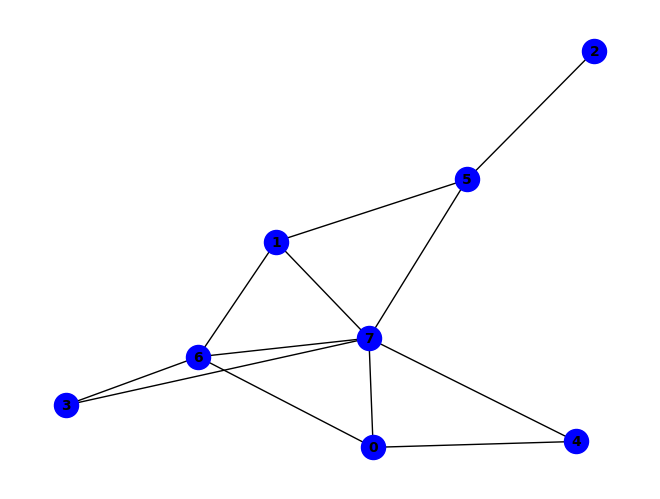


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (b & d & g & ~f) ^ (b & d & h & ~f) ^ (b & e & g & ~h) ^ (c & f & ~b & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (e & h & ~f & ~g) ^ (a & b & e & f & ~g) ^ (a & b & e & h & ~g) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (c & d & g & ~b & ~h) ^ (c & d & h & ~f & ~g) ^ (a & g & ~b & ~d & ~f) ^ (a & h & ~b & ~d & ~f) ^ (a & c & f & g & ~d & ~h) ^ (b & c & d & g & ~f & ~h) ^ (a & b & d & e & f & h & ~g) ^ (a & f & g & ~d & ~e & ~h) ^ (d & e & h & ~a & ~b & ~g) ^ (d & f & g & ~b & ~e & ~h) ^ (a & b & f & g & ~c & ~d & ~h) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


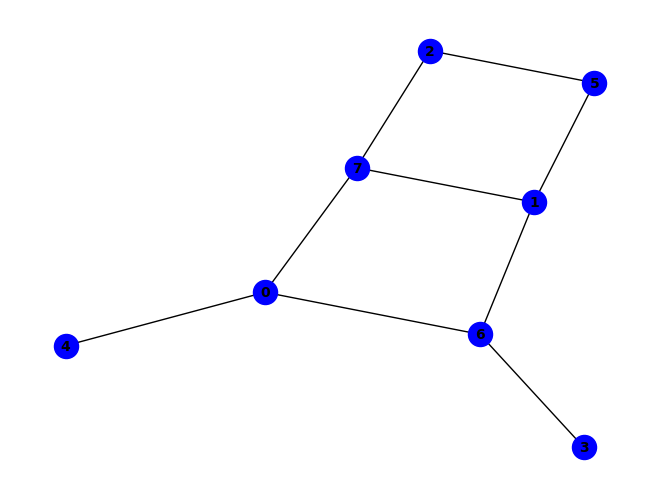


(d & ~g) ^ (~c & ~d) ^ (a & g & ~h) ^ (a & h & ~c) ^ (b & g & ~h) ^ (b & d & g & ~c) ^ (c & d & h & ~g) ^ (a & e & ~g & ~h) ^ (b & h & ~a & ~c) ^ (a & c & f & g & ~h) ^ (b & c & f & g & ~h) ^ (c & ~d & ~f & ~h) ^ (a & d & g & ~b & ~c) ^ (b & f & ~c & ~g & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & c & d & g & ~f & ~h) ^ (a & c & e & f & ~g & ~h) ^ (b & c & d & f & ~a & ~h) ^ (b & c & d & g & ~a & ~h) ^ (a & b & g & ~c & ~e & ~h) ^ (c & d & f & ~b & ~g & ~h) ^ (a & b & c & d & f & ~g & ~h) ^ (a & b & e & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


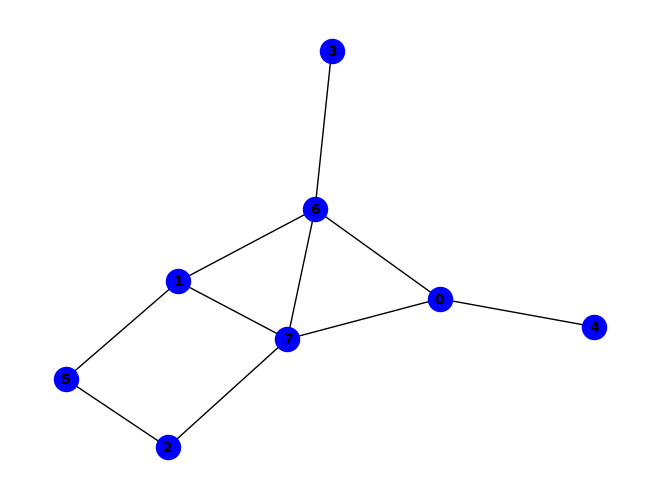


(b & c & f) ^ (a & e & ~c) ^ (b & f & ~g) ^ (b & g & ~c) ^ (a & b & c & h) ^ (a & b & d & g) ^ (d & ~b & ~h) ^ (g & ~c & ~h) ^ (a & b & f & ~h) ^ (a & b & h & ~d) ^ (a & d & g & ~h) ^ (~c & ~d & ~g) ^ (a & g & ~c & ~e) ^ (a & h & ~c & ~e) ^ (b & d & ~g & ~h) ^ (b & h & ~c & ~f) ^ (d & h & ~c & ~g) ^ (a & b & c & g & ~e) ^ (a & b & d & h & ~g) ^ (a & c & d & f & ~h) ^ (a & e & g & h & ~c) ^ (b & f & g & h & ~a) ^ (c & d & f & g & ~h) ^ (c & ~a & ~f & ~h) ^ (b & c & g & ~d & ~h) ^ (a & b & c & e & f & ~h) ^ (a & b & c & e & f & g & h) ^ (a & b & ~e & ~f & ~h) ^ (a & b & ~e & ~g & ~h) ^ (c & d & ~a & ~g & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & b & e & g & ~c & ~f) ^ (a & b & g & h & ~e & ~f) ^ (b & c & d & g & ~f & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & c & d & ~f & ~g & ~h) ^ (a & c & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

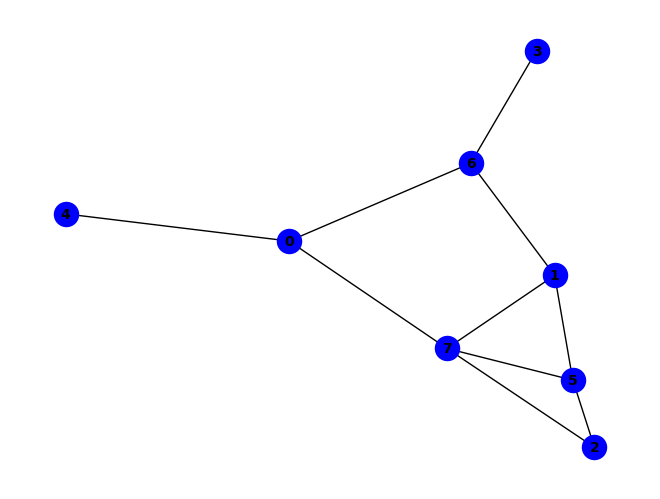


~f ^ (f & ~h) ^ (a & b & h) ^ (b & g & ~h) ^ (b & h & ~c) ^ (c & h & ~d) ^ (b & c & d & g & h) ^ (a & g & ~b & ~h) ^ (a & h & ~c & ~f) ^ (c & f & ~b & ~d) ^ (d & g & ~a & ~b) ^ (a & b & c & h & ~f) ^ (a & c & d & h & ~b) ^ (b & d & f & h & ~a) ^ (b & f & g & h & ~a) ^ (d & f & g & h & ~a) ^ (c & d & f & ~b & ~g) ^ (c & d & h & ~a & ~g) ^ (a & b & c & d & h & ~g) ^ (a & c & d & f & g & ~b) ^ (a & e & ~c & ~g & ~h) ^ (b & f & ~a & ~d & ~g) ^ (a & b & c & e & ~g & ~h) ^ (a & c & f & g & ~b & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (b & d & f & ~a & ~g & ~h) ^ (a & c & e & ~b & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


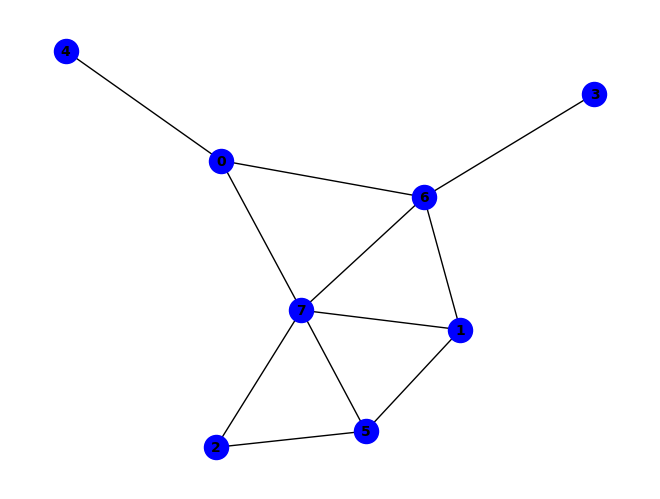


(g & ~h) ^ (~d & ~g) ^ (b & f & ~g) ^ (b & g & ~a) ^ (b & h & ~a) ^ (d & h & ~g) ^ (f & h & ~g) ^ (d & ~c & ~h) ^ (a & g & ~c & ~f) ^ (a & h & ~c & ~f) ^ (c & f & ~b & ~h) ^ (a & b & f & h & ~g) ^ (a & f & g & ~c & ~h) ^ (b & d & g & ~c & ~h) ^ (c & d & f & ~g & ~h) ^ (a & b & c & f & g & ~h) ^ (a & e & ~c & ~g & ~h) ^ (c & d & ~b & ~f & ~h) ^ (c & h & ~b & ~f & ~g) ^ (a & b & c & e & ~g & ~h) ^ (a & b & c & h & ~f & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & c & g & ~d & ~f & ~h) ^ (a & d & g & ~b & ~c & ~h) ^ (b & c & d & ~f & ~g & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (a & c & e & ~b & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


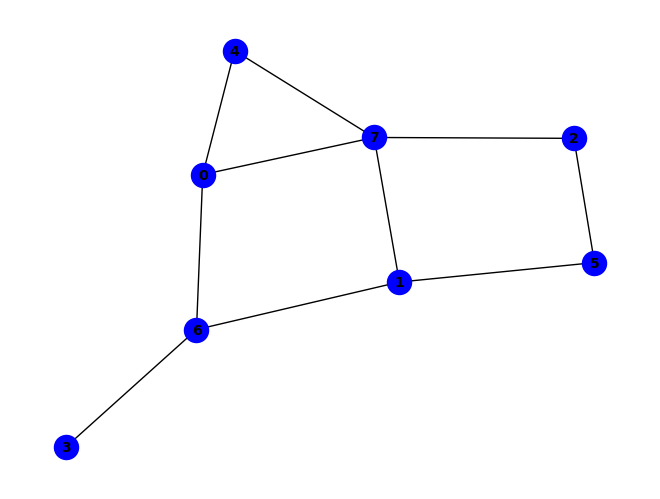


~e ^ (e & ~h) ^ (b & g & ~f) ^ (b & h & ~g) ^ (b & f & g & h) ^ (b & e & h & ~d) ^ (a & h & ~b & ~c) ^ (b & f & ~c & ~h) ^ (c & f & ~d & ~h) ^ (c & h & ~b & ~e) ^ (d & g & ~a & ~b) ^ (a & e & g & h & ~c) ^ (b & d & e & h & ~g) ^ (d & e & g & h & ~c) ^ (b & c & d & e & g & h) ^ (a & c & e & ~f & ~h) ^ (a & c & d & f & g & ~h) ^ (a & g & ~b & ~c & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & b & e & g & ~c & ~f) ^ (a & d & e & h & ~b & ~c) ^ (b & c & d & f & ~a & ~h) ^ (c & d & g & h & ~a & ~b) ^ (a & b & e & f & g & h & ~c) ^ (a & b & e & ~c & ~f & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (c & d & f & ~b & ~g & ~h) ^ (a & b & c & d & f & ~g & ~h) ^ (a & e & ~b & ~c & ~d & ~g) ^ (a & d & e & ~b & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


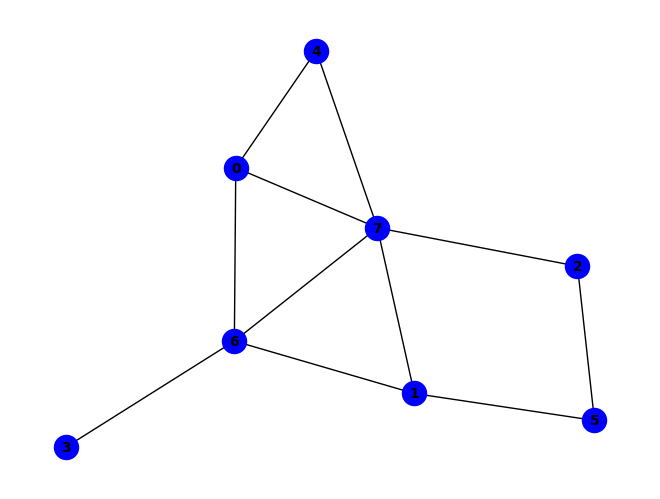


(a & e & ~g) ^ (a & g & ~c) ^ (a & h & ~c) ^ (b & f & ~h) ^ (b & g & ~f) ^ (b & e & g & h) ^ (b & f & g & h) ^ (d & ~c & ~h) ^ (g & ~c & ~h) ^ (b & c & g & ~h) ^ (~c & ~d & ~g) ^ (b & c & ~d & ~g) ^ (b & h & ~a & ~e) ^ (d & h & ~c & ~g) ^ (e & h & ~c & ~g) ^ (a & b & c & h & ~e) ^ (a & c & e & h & ~g) ^ (b & c & d & h & ~g) ^ (b & c & e & h & ~g) ^ (a & b & g & ~c & ~e) ^ (a & d & g & ~c & ~h) ^ (b & c & d & ~a & ~h) ^ (b & d & g & ~a & ~h) ^ (a & b & c & d & ~f & ~h) ^ (a & b & e & f & ~c & ~h) ^ (a & b & e & g & ~f & ~h) ^ (a & c & e & f & ~g & ~h) ^ (c & ~b & ~d & ~f & ~h) ^ (a & c & g & ~d & ~f & ~h) ^ (a & b & c & d & f & ~g & ~h) ^ (c & d & ~b & ~f & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


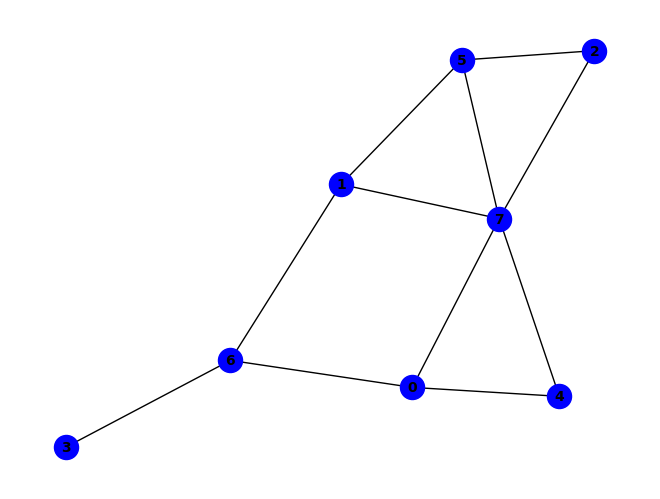


~f ^ (f & ~h) ^ (a & g & ~h) ^ (c & h & ~e) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & f & g & h) ^ (a & d & f & g & h) ^ (b & c & d & f & g) ^ (a & e & ~d & ~g) ^ (a & h & ~c & ~f) ^ (b & f & ~d & ~g) ^ (b & g & ~a & ~h) ^ (b & h & ~c & ~e) ^ (c & f & ~b & ~e) ^ (d & g & ~a & ~b) ^ (a & c & e & f & ~h) ^ (a & c & e & h & ~f) ^ (a & d & e & h & ~f) ^ (b & d & f & h & ~a) ^ (b & e & f & h & ~d) ^ (c & d & f & g & ~e) ^ (d & e & g & h & ~b) ^ (d & f & g & h & ~e) ^ (a & b & d & e & f & h) ^ (a & b & d & e & g & h) ^ (b & c & d & e & f & h) ^ (a & d & e & ~g & ~h) ^ (c & e & f & ~d & ~h) ^ (a & c & d & f & g & ~b) ^ (a & b & e & f & ~g & ~h) ^ (b & c & e & f & ~a & ~h) ^ (b & d & e & f & ~c & ~g) ^ (a & c & d & e & f & h & ~b) ^ (a & b & h & ~c & ~e & ~f) ^ (b & d & f & ~e & ~g & ~h) ^ (a & b & d & f & h & ~e & ~g) ^ (a & d & e & f & h & ~c & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (a & c & f & g & ~b & ~e & ~h) ^ (c & d & e & f & ~b & ~g & ~h) ^ (c & d & g & h & ~a & ~b 

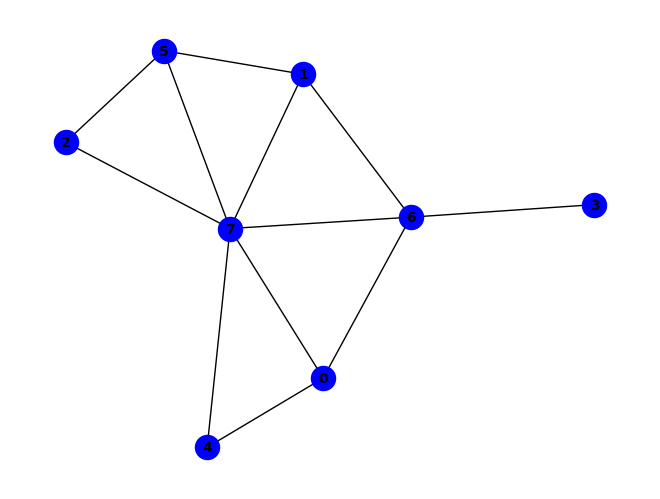


(g & ~h) ^ (~d & ~g) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (d & h & ~g) ^ (f & h & ~g) ^ (a & e & f & g) ^ (a & e & f & h) ^ (d & ~c & ~h) ^ (c & d & ~g & ~h) ^ (c & f & ~e & ~h) ^ (e & h & ~f & ~g) ^ (a & b & f & g & ~h) ^ (a & c & e & h & ~g) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (a & c & g & ~d & ~h) ^ (a & d & g & ~b & ~h) ^ (a & f & g & ~e & ~h) ^ (b & c & f & ~a & ~h) ^ (b & d & g & ~c & ~h) ^ (b & e & g & ~f & ~h) ^ (c & e & f & ~a & ~g) ^ (c & e & h & ~b & ~g) ^ (a & g & ~b & ~c & ~f) ^ (a & h & ~b & ~c & ~f) ^ (c & h & ~b & ~f & ~g) ^ (a & b & c & f & ~g & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & b & e & f & ~c & ~g) ^ (a & b & e & h & ~c & ~g) ^ (a & c & d & g & ~f & ~h) ^ (c & e & f & g & ~b & ~h) ^ (a & b & c & d & f & g & ~h) ^ (c & d & g & ~b & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

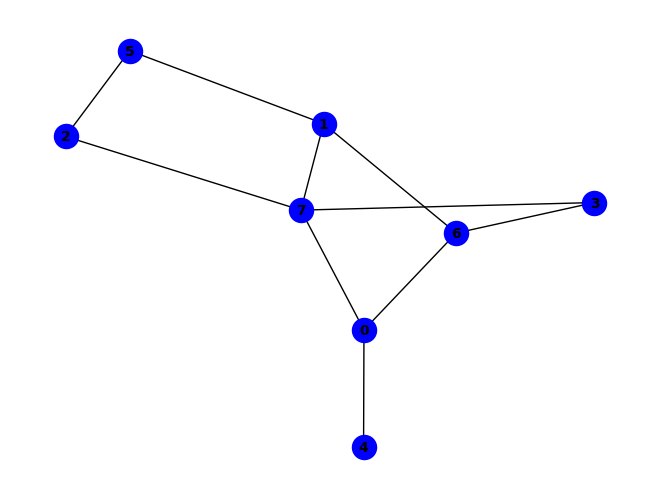


~b ^ (c & h & ~b) ^ (a & b & c & h) ^ (a & b & e & ~g) ^ (a & b & h & ~e) ^ (b & c & f & ~h) ^ (a & b & e & g & h) ^ (a & h & ~c & ~d) ^ (c & f & ~d & ~h) ^ (d & g & ~b & ~h) ^ (d & h & ~b & ~c) ^ (a & b & d & h & ~c) ^ (b & ~f & ~g & ~h) ^ (c & d & f & ~g & ~h) ^ (b & c & d & f & g & ~h) ^ (a & e & ~c & ~g & ~h) ^ (a & g & ~b & ~d & ~h) ^ (a & b & e & ~f & ~g & ~h) ^ (a & c & e & ~f & ~g & ~h) ^ (a & b & c & e & f & ~g & ~h) ^ (a & c & f & g & ~b & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


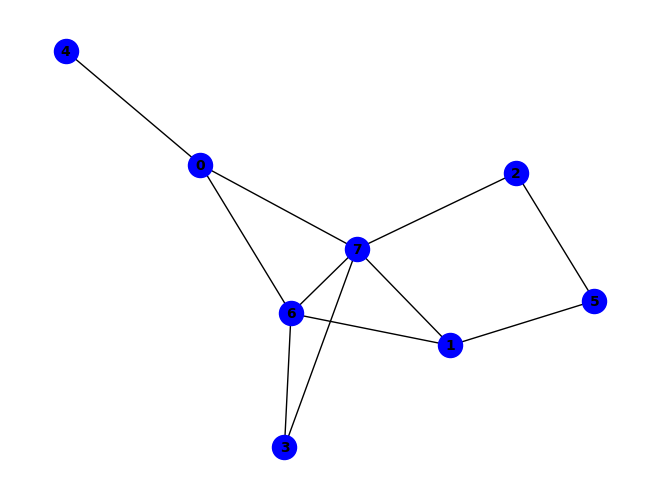


(~c & ~g) ^ (a & h & ~d) ^ (b & c & ~g) ^ (b & f & ~a) ^ (a & c & d & h) ^ (g & ~c & ~h) ^ (b & c & g & ~h) ^ (a & b & c & f & g) ^ (a & e & ~c & ~h) ^ (a & g & ~b & ~e) ^ (b & g & ~a & ~f) ^ (b & h & ~a & ~f) ^ (d & h & ~b & ~c) ^ (a & b & d & h & ~c) ^ (a & b & g & h & ~e) ^ (a & c & f & g & ~e) ^ (a & c & f & h & ~b) ^ (a & e & g & h & ~c) ^ (b & f & g & h & ~a) ^ (a & b & f & ~e & ~h) ^ (a & b & c & e & g & ~f) ^ (d & g & ~a & ~b & ~c) ^ (a & b & c & e & ~g & ~h) ^ (c & ~b & ~d & ~f & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & e & ~b & ~f & ~h) ^ (a & c & h & ~b & ~f & ~g) ^ (a & c & e & g & h & ~b & ~f) ^ (c & d & ~b & ~f & ~g & ~h) ^ (a & c & d & g & ~b & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


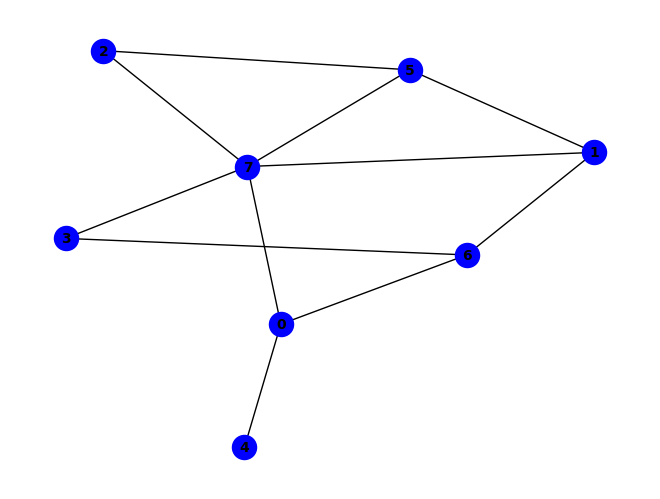


~f ^ (f & ~h) ^ (b & h & ~d) ^ (c & f & ~b) ^ (c & h & ~b) ^ (a & b & d & g) ^ (a & b & e & h) ^ (a & b & ~e & ~g) ^ (a & g & ~b & ~h) ^ (a & h & ~d & ~f) ^ (b & f & ~a & ~g) ^ (b & g & ~d & ~h) ^ (d & g & ~a & ~h) ^ (d & h & ~c & ~f) ^ (a & b & d & h & ~g) ^ (a & b & g & h & ~e) ^ (a & c & d & h & ~e) ^ (b & d & f & h & ~a) ^ (b & f & g & h & ~a) ^ (a & c & h & ~b & ~f) ^ (a & c & d & e & h & ~f) ^ (a & c & d & f & g & ~e) ^ (a & e & ~c & ~g & ~h) ^ (a & c & f & g & ~b & ~h) ^ (b & c & d & h & ~a & ~f) ^ (c & d & f & g & ~b & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & c & d & e & f & g & ~h) ^ (a & c & e & ~f & ~g & ~h) ^ (a & b & c & e & f & ~g & ~h) ^ (a & c & d & f & h & ~e & ~g) ^ (a & b & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


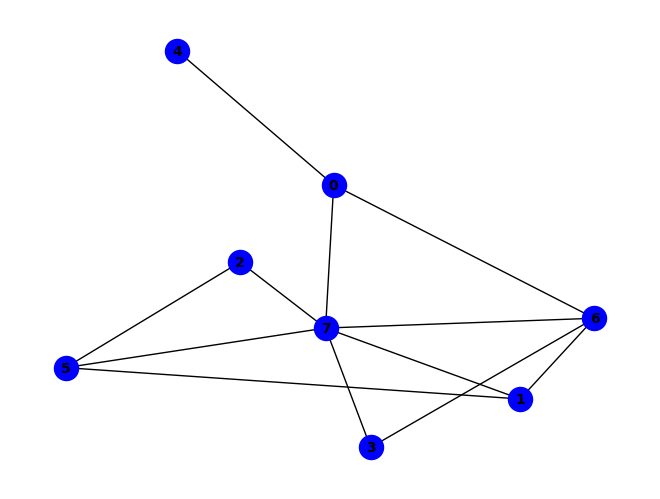


~g ^ (g & ~h) ^ (b & f & ~g) ^ (b & g & ~d) ^ (b & h & ~d) ^ (d & h & ~f) ^ (f & h & ~g) ^ (a & c & g & ~h) ^ (a & g & ~c & ~f) ^ (a & h & ~d & ~f) ^ (c & f & ~b & ~h) ^ (d & g & ~a & ~f) ^ (a & b & d & g & ~f) ^ (a & b & d & h & ~f) ^ (b & c & d & f & ~g) ^ (b & c & d & f & ~h) ^ (b & c & d & h & ~g) ^ (b & d & f & h & ~g) ^ (a & b & e & ~c & ~f) ^ (a & b & g & ~e & ~f) ^ (a & b & h & ~e & ~f) ^ (a & c & e & ~f & ~g) ^ (d & f & g & ~c & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & e & g & h & ~f) ^ (a & c & d & e & h & ~b) ^ (a & c & d & g & h & ~f) ^ (a & c & e & g & h & ~f) ^ (c & h & ~d & ~f & ~g) ^ (a & c & d & e & f & g & ~b) ^ (a & c & h & ~d & ~e & ~f) ^ (a & f & g & ~b & ~d & ~h) ^ (b & c & h & ~a & ~f & ~g) ^ (a & b & c & e & g & ~d & ~f) ^ (a & b & c & e & h & ~f & ~g) ^ (a & e & ~b & ~c & ~g & ~h) ^ (a & b & c & d & e & g & ~f & ~h) ^ (a & c & d & e & f & h & ~b & ~g) ^ (a & b & c & d & h & ~e & ~f & ~g) ^ (a & c & d & f & g & ~b & ~e & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS


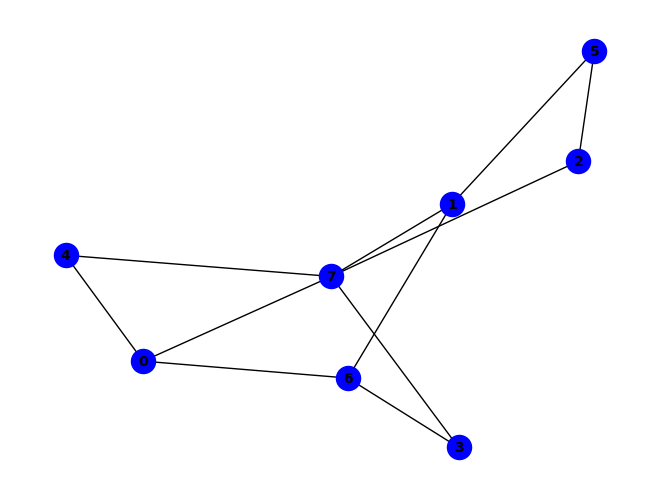


~e ^ (c & d & h) ^ (a & g & ~d) ^ (b & e & ~d) ^ (b & f & ~h) ^ (b & g & ~f) ^ (c & f & ~b) ^ (d & h & ~e) ^ (a & b & e & f) ^ (b & f & g & h) ^ (e & ~b & ~h) ^ (a & b & g & ~e) ^ (a & c & h & ~d) ^ (b & d & e & ~h) ^ (b & d & h & ~c) ^ (a & e & ~c & ~g) ^ (a & h & ~d & ~g) ^ (b & h & ~a & ~g) ^ (c & h & ~b & ~f) ^ (a & b & c & g & ~d) ^ (a & b & d & g & ~h) ^ (a & b & d & h & ~e) ^ (a & d & e & h & ~c) ^ (a & b & c & d & e & h) ^ (c & e & h & ~b & ~d) ^ (a & b & c & e & f & ~g) ^ (d & g & ~b & ~c & ~h) ^ (a & b & c & h & ~d & ~g) ^ (a & b & e & g & ~f & ~h) ^ (a & b & e & h & ~c & ~f) ^ (a & c & f & g & ~d & ~h) ^ (a & e & g & h & ~b & ~c) ^ (a & b & c & e & g & h & ~f) ^ (a & c & e & ~f & ~g & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (a & b & c & g & ~d & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


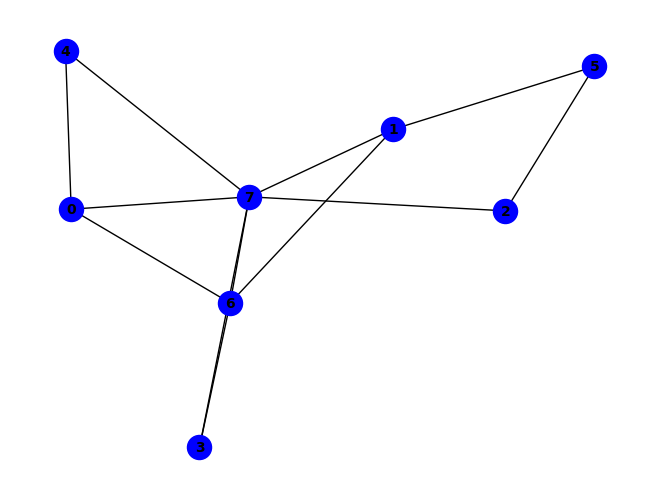


(~c & ~g) ^ (a & e & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (b & c & ~g) ^ (b & f & ~h) ^ (b & g & ~f) ^ (b & e & g & h) ^ (b & f & g & h) ^ (g & ~c & ~h) ^ (a & b & c & e & f) ^ (a & b & c & f & h) ^ (d & h & ~c & ~e) ^ (e & h & ~c & ~g) ^ (a & d & e & h & ~g) ^ (b & c & d & h & ~a) ^ (b & c & e & g & ~a) ^ (b & c & e & h & ~d) ^ (a & b & c & d & e & h) ^ (a & b & g & ~d & ~e) ^ (a & c & g & ~d & ~e) ^ (a & c & h & ~d & ~e) ^ (b & c & g & ~e & ~h) ^ (a & b & c & d & g & ~e) ^ (a & b & c & e & h & ~f) ^ (a & b & c & f & g & ~e) ^ (a & b & c & e & f & g & h) ^ (b & h & ~a & ~d & ~e) ^ (d & g & ~b & ~c & ~e) ^ (a & b & c & d & ~f & ~g) ^ (a & b & c & d & ~f & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & c & e & g & ~d & ~h) ^ (c & ~b & ~d & ~f & ~h) ^ (a & c & g & ~d & ~f & ~h) ^ (d & e & g & ~b & ~c & ~h) ^ (c & d & ~b & ~f & ~g & ~h) ^ (a & b & c & h & ~d & ~f & ~g) ^ (a & b & e & g & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

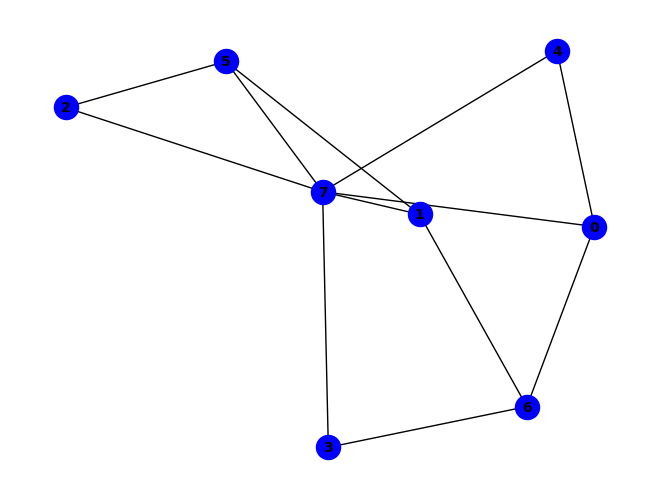


~f ^ (f & ~h) ^ (a & e & ~g) ^ (b & f & ~g) ^ (c & h & ~e) ^ (d & g & ~h) ^ (e & h & ~f) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & e & f & h) ^ (b & f & g & h) ^ (b & d & g & ~a) ^ (a & c & d & f & g) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~f) ^ (b & g & ~a & ~h) ^ (b & h & ~c & ~e) ^ (c & f & ~b & ~e) ^ (d & h & ~e & ~f) ^ (a & c & d & h & ~e) ^ (a & d & e & h & ~f) ^ (b & d & f & h & ~a) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (a & c & d & e & f & h) ^ (a & b & h & ~e & ~f) ^ (b & d & h & ~a & ~g) ^ (c & d & h & ~b & ~f) ^ (a & c & d & f & h & ~g) ^ (a & c & e & f & ~g & ~h) ^ (a & c & f & g & ~b & ~h) ^ (b & d & e & h & ~a & ~f) ^ (c & d & f & g & ~b & ~h) ^ (a & b & c & d & f & g & ~h) ^ (a & c & h & ~b & ~e & ~f) ^ (c & e & f & ~b & ~d & ~h) ^ (a & b & c & d & h & ~e & ~f) ^ (a & b & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

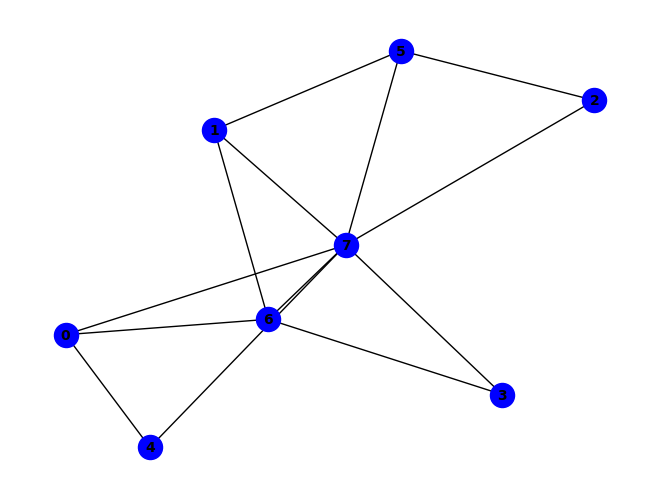


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (a & e & f & g & ~d) ^ (a & e & f & h & ~d) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & c & f & ~d & ~h) ^ (a & c & f & ~e & ~g) ^ (a & c & h & ~e & ~g) ^ (b & e & g & ~f & ~h) ^ (c & d & e & f & g & ~h) ^ (a & g & ~b & ~d & ~f) ^ (a & h & ~b & ~d & ~f) ^ (c & f & ~b & ~d & ~h) ^ (c & h & ~b & ~f & ~g) ^ (d & g & ~b & ~c & ~f) ^ (d & h & ~b & ~c & ~f) ^ (e & h & ~c & ~f & ~g) ^ (a & b & e & f & ~c & ~g) ^ (a & c & d & f & ~g & ~h) ^ (a & c & d & h & ~f & ~g) ^ (a & d & e & h & ~c & ~g) ^ (b & c & e & h & ~f & ~g) ^ (a & c & d & e & f & h & ~g) ^ (b & c & d & e & f & h & ~g) ^ (a & f & g & ~d & ~e & ~h) ^ (c & d & f & ~b & ~g & ~h) ^ (c & d & g & ~b & ~f & ~h) ^ (d & e & h & ~b & ~c & ~g) ^ (d & f & g & ~b & ~e & ~h) ^ (a & b & c & h & ~d & ~f & ~g) ^ (a & b & e & h & ~c & ~d & ~g) ^ (a & b & f & g & ~c & ~d & ~h) ^ (a & b & d & e & f & h & ~

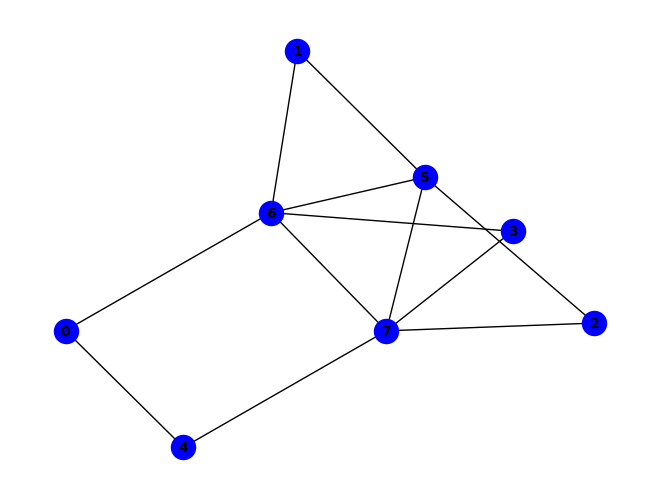


(~b & ~g) ^ (b & h & ~g) ^ (c & f & ~g) ^ (c & h & ~e) ^ (d & g & ~f) ^ (d & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (c & e & g & ~h) ^ (b & c & ~g & ~h) ^ (c & g & ~a & ~e) ^ (e & h & ~d & ~g) ^ (a & b & e & f & ~h) ^ (a & b & e & g & ~h) ^ (a & c & g & h & ~e) ^ (c & d & e & h & ~g) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & ~c & ~f & ~h) ^ (a & ~e & ~g & ~h) ^ (b & ~c & ~f & ~h) ^ (a & c & f & ~e & ~h) ^ (a & d & f & ~b & ~h) ^ (a & d & g & ~b & ~h) ^ (b & c & g & ~f & ~h) ^ (b & d & g & ~f & ~h) ^ (c & d & h & ~f & ~g) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (a & c & ~b & ~g & ~h) ^ (a & f & ~d & ~g & ~h) ^ (a & b & d & f & ~g & ~h) ^ (a & c & e & g & ~f & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & b & c & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

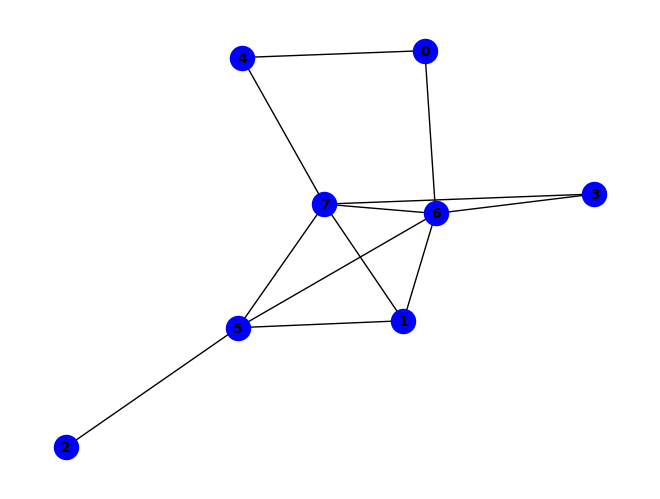


~g ^ (g & ~h) ^ (b & f & ~g) ^ (b & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & b & g & ~h) ^ (b & e & g & ~h) ^ (b & f & g & ~h) ^ (b & g & ~a & ~e) ^ (d & g & ~b & ~f) ^ (d & h & ~b & ~f) ^ (e & h & ~d & ~g) ^ (a & b & e & f & ~h) ^ (a & b & g & h & ~e) ^ (b & d & e & h & ~g) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (a & ~c & ~f & ~h) ^ (a & d & f & ~b & ~h) ^ (a & d & g & ~b & ~h) ^ (e & f & g & ~d & ~h) ^ (b & d & e & f & g & ~h) ^ (a & c & ~b & ~g & ~h) ^ (a & f & ~d & ~g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (a & b & d & f & ~g & ~h) ^ (a & c & e & g & ~f & ~h) ^ (a & ~c & ~e & ~g & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & c & ~f & ~g & ~h) ^ (a & c & ~b & ~e & ~f & ~h) ^ (a & b & g & ~c & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


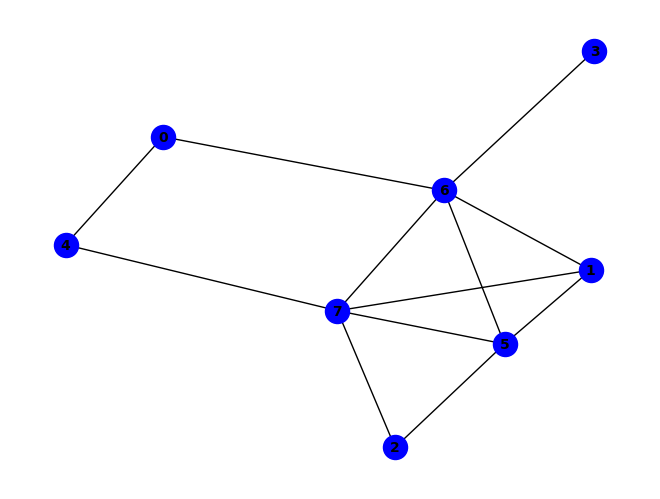


(g & ~h) ^ (~d & ~g) ^ (b & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (a & d & f & ~h) ^ (a & d & g & ~h) ^ (b & d & g & ~h) ^ (b & e & g & ~h) ^ (e & f & g & ~h) ^ (a & f & ~g & ~h) ^ (b & f & ~d & ~g) ^ (b & g & ~a & ~e) ^ (c & f & ~b & ~g) ^ (c & h & ~b & ~g) ^ (d & f & ~a & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~c & ~g) ^ (a & b & e & f & ~h) ^ (a & d & f & h & ~g) ^ (b & c & e & h & ~g) ^ (b & d & f & h & ~g) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & e & f & h & ~g) ^ (a & ~c & ~f & ~h) ^ (a & ~e & ~g & ~h) ^ (a & b & g & ~d & ~h) ^ (a & c & e & ~g & ~h) ^ (a & c & g & ~f & ~h) ^ (b & d & f & ~a & ~h) ^ (b & f & g & ~e & ~h) ^ (a & b & c & f & g & ~e) ^ (b & c & e & f & g & ~h) ^ (a & b & c & f & ~e & ~h) ^ (a & b & c & f & ~g & ~h) ^ (a & b & d & f & ~g & ~h) ^ (a & b & g & h & ~c & ~e) ^ (a & b & g & ~e & ~f & ~h) ^ (a & b & c & g & h & ~e & ~f) ^ (a & c & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

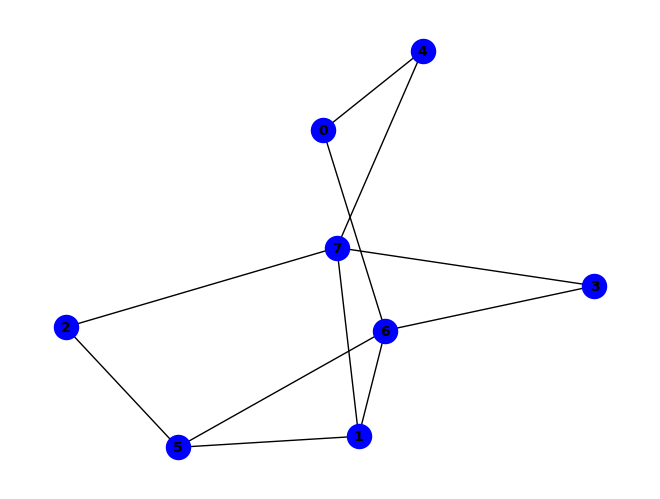


(~c & ~f) ^ (a & g & ~e) ^ (b & h & ~e) ^ (d & g & ~h) ^ (d & h & ~e) ^ (b & e & f & g) ^ (b & f & g & h) ^ (a & ~e & ~h) ^ (a & ~f & ~h) ^ (c & ~f & ~h) ^ (a & d & g & ~f) ^ (b & d & g & ~a) ^ (b & d & h & ~g) ^ (d & f & g & ~b) ^ (d & e & f & g & h) ^ (a & f & ~g & ~h) ^ (b & f & ~e & ~h) ^ (b & g & ~a & ~h) ^ (e & h & ~c & ~f) ^ (a & f & g & h & ~e) ^ (b & d & e & h & ~f) ^ (a & b & c & e & f & g) ^ (f & ~c & ~e & ~g) ^ (c & d & h & ~e & ~f) ^ (a & b & c & e & f & ~h) ^ (a & b & c & f & h & ~e) ^ (a & b & c & g & h & ~d) ^ (a & b & d & f & g & ~e) ^ (a & d & e & g & h & ~f) ^ (b & c & d & f & h & ~g) ^ (e & f & ~c & ~g & ~h) ^ (a & b & e & f & ~d & ~h) ^ (a & b & f & g & ~e & ~h) ^ (a & b & g & h & ~e & ~f) ^ (a & c & e & f & ~g & ~h) ^ (b & d & e & f & ~c & ~g) ^ (c & d & f & h & ~e & ~g) ^ (a & b & c & e & g & h & ~f) ^ (a & b & d & e & g & h & ~c) ^ (b & c & f & ~a & ~e & ~g) ^ (b & c & h & ~d & ~e & ~f) ^ (a & b & d & e & f & ~g & ~h) ^ (a & b & c & d & f & g & h & ~e) ^ (a & b

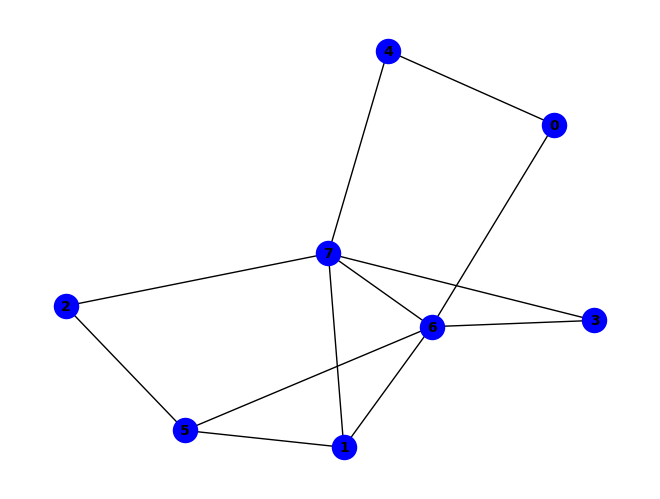


(g & ~h) ^ (~f & ~g) ^ (b & f & ~d) ^ (d & g & ~e) ^ (d & h & ~e) ^ (f & h & ~g) ^ (f & ~d & ~h) ^ (b & e & h & ~d) ^ (a & f & ~g & ~h) ^ (b & g & ~d & ~e) ^ (b & h & ~d & ~f) ^ (c & h & ~d & ~g) ^ (e & h & ~c & ~g) ^ (b & c & d & h & ~g) ^ (c & d & e & g & ~b) ^ (c & d & e & h & ~b) ^ (a & ~c & ~f & ~h) ^ (a & b & f & ~d & ~h) ^ (a & b & g & ~d & ~h) ^ (a & c & e & ~g & ~h) ^ (a & d & g & ~f & ~h) ^ (b & c & h & ~e & ~g) ^ (b & e & g & ~d & ~h) ^ (d & e & g & ~c & ~h) ^ (b & c & d & e & g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (d & f & ~b & ~g & ~h) ^ (a & b & c & f & ~g & ~h) ^ (a & b & d & f & ~g & ~h) ^ (a & c & e & g & ~f & ~h) ^ (a & ~b & ~e & ~g & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & ~e & ~f & ~g & ~h) ^ (a & c & ~b & ~e & ~f & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


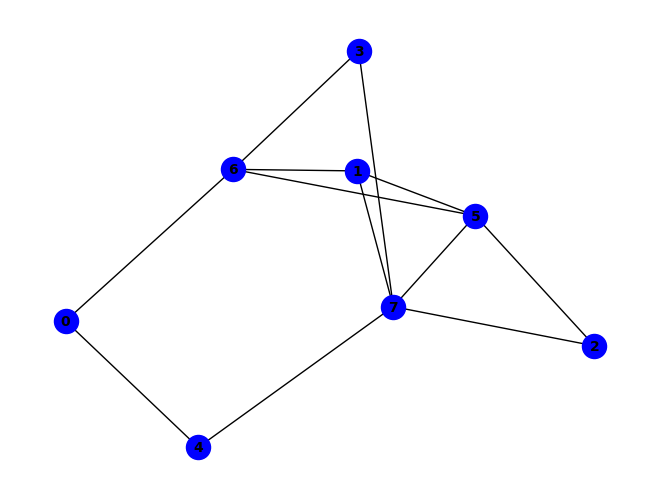


(~a & ~e) ^ (a & g & ~e) ^ (b & h & ~e) ^ (d & e & ~f) ^ (f & g & ~h) ^ (a & ~f & ~h) ^ (e & ~d & ~h) ^ (a & b & f & ~h) ^ (a & b & g & ~h) ^ (a & h & ~c & ~e) ^ (b & f & ~a & ~e) ^ (b & g & ~d & ~h) ^ (c & h & ~e & ~f) ^ (d & g & ~f & ~h) ^ (d & h & ~c & ~f) ^ (f & h & ~a & ~e) ^ (a & b & c & h & ~e) ^ (a & c & f & h & ~e) ^ (b & c & e & f & ~d) ^ (b & c & e & h & ~d) ^ (b & d & f & g & ~h) ^ (c & d & e & f & ~a) ^ (c & d & e & h & ~a) ^ (a & d & g & ~b & ~f) ^ (a & e & f & ~g & ~h) ^ (b & c & h & ~d & ~f) ^ (b & d & h & ~e & ~f) ^ (b & e & f & ~c & ~h) ^ (d & e & f & ~c & ~h) ^ (a & c & d & e & h & ~g) ^ (a & c & d & f & h & ~b) ^ (a & c & d & g & h & ~b) ^ (b & c & d & e & f & ~h) ^ (a & b & c & d & e & f & h) ^ (a & b & c & d & e & g & h) ^ (a & f & ~c & ~e & ~g) ^ (c & f & ~b & ~g & ~h) ^ (a & b & f & g & ~e & ~h) ^ (a & b & f & h & ~c & ~e) ^ (a & b & g & h & ~e & ~f) ^ (a & c & d & f & ~e & ~g) ^ (a & c & d & e & f & g & ~h) ^ (a & c & f & ~d & ~g & ~h) ^ (a & c & h & ~b & ~e &

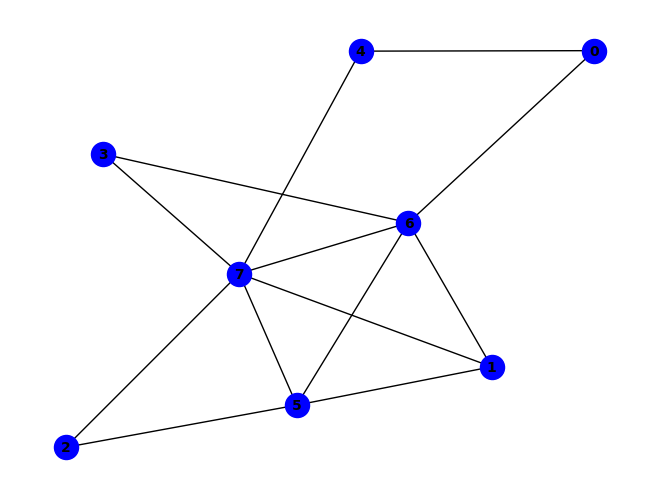


~g ^ (b & h & ~e) ^ (c & f & ~g) ^ (c & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (b & e & g & ~h) ^ (a & f & ~g & ~h) ^ (b & f & ~c & ~g) ^ (b & g & ~a & ~e) ^ (c & g & ~a & ~e) ^ (d & g & ~b & ~f) ^ (d & h & ~b & ~f) ^ (e & h & ~d & ~g) ^ (a & b & c & g & ~e) ^ (a & b & e & f & ~h) ^ (b & c & e & g & ~f) ^ (b & c & e & h & ~f) ^ (b & d & e & h & ~g) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & c & d & e & f & g) ^ (b & c & d & e & f & h) ^ (a & ~c & ~f & ~h) ^ (a & ~e & ~g & ~h) ^ (a & b & g & ~d & ~h) ^ (a & d & g & ~f & ~h) ^ (b & c & h & ~d & ~g) ^ (b & f & g & ~e & ~h) ^ (c & d & h & ~f & ~g) ^ (c & e & g & ~b & ~h) ^ (e & f & g & ~d & ~h) ^ (a & b & d & f & g & ~h) ^ (a & b & f & g & h & ~e) ^ (b & c & d & f & h & ~g) ^ (b & d & e & f & g & ~h) ^ (c & d & e & f & g & ~h) ^ (a & c & ~b & ~g & ~h) ^ (a & c & e & g & ~f & ~h) ^ (a & c & g & h & ~b & ~e) ^ (c & d & e & h & ~b & ~g) ^ (a & b &

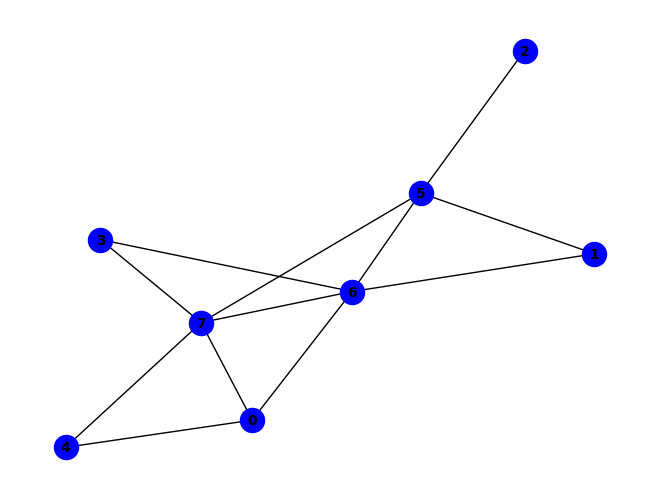


(g & ~h) ^ (~b & ~g) ^ (a & e & ~g) ^ (b & h & ~g) ^ (d & g & ~f) ^ (d & h & ~f) ^ (f & g & ~e) ^ (f & h & ~e) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (e & h & ~d & ~g) ^ (a & d & e & h & ~g) ^ (a & e & f & h & ~g) ^ (d & e & f & g & ~a) ^ (d & e & f & h & ~a) ^ (b & ~c & ~f & ~h) ^ (a & b & f & ~d & ~h) ^ (a & b & g & ~d & ~h) ^ (b & d & g & ~f & ~h) ^ (e & f & g & ~d & ~h) ^ (a & d & e & f & g & ~h) ^ (b & c & ~a & ~g & ~h) ^ (c & f & ~a & ~g & ~h) ^ (a & b & c & e & ~f & ~h) ^ (a & b & d & f & ~g & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (a & c & f & ~e & ~g & ~h) ^ (b & c & g & ~a & ~f & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


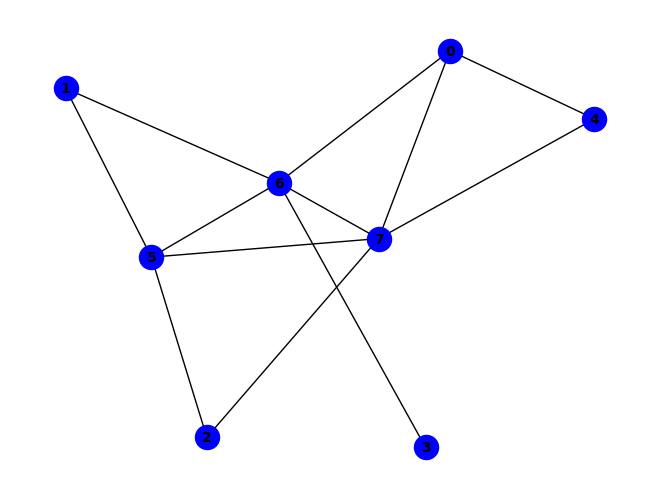


(~d & ~g) ^ (a & e & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (c & f & ~g) ^ (c & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (g & ~b & ~h) ^ (e & f & g & ~h) ^ (b & f & ~d & ~h) ^ (d & f & ~b & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~c & ~g) ^ (a & b & e & f & ~h) ^ (a & b & e & g & ~h) ^ (a & e & f & h & ~g) ^ (b & d & f & h & ~g) ^ (c & e & f & h & ~g) ^ (a & d & g & ~f & ~h) ^ (b & d & g & ~a & ~h) ^ (a & b & d & f & g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & h & ~e & ~f & ~g) ^ (b & c & f & ~a & ~g & ~h) ^ (a & b & c & f & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


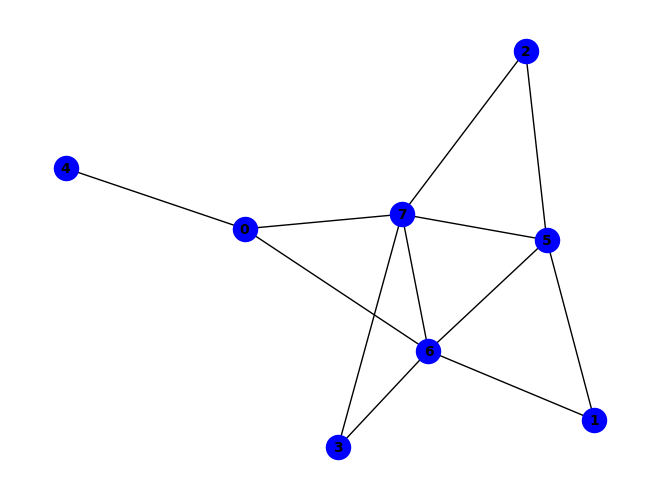


(c & g & ~d) ^ (f & g & ~a) ^ (f & h & ~a) ^ (a & c & e & g) ^ (a & c & d & f & h) ^ (~a & ~b & ~g) ^ (b & h & ~a & ~g) ^ (c & f & ~a & ~g) ^ (c & h & ~a & ~d) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (a & c & d & g & ~f) ^ (c & d & f & h & ~g) ^ (b & ~c & ~f & ~h) ^ (g & ~a & ~c & ~h) ^ (a & b & e & ~f & ~h) ^ (b & c & g & ~f & ~h) ^ (c & d & g & ~a & ~h) ^ (a & b & c & f & g & ~e) ^ (a & c & d & f & g & ~h) ^ (b & c & ~a & ~g & ~h) ^ (a & c & g & h & ~b & ~e) ^ (a & ~b & ~e & ~g & ~h) ^ (a & b & c & ~f & ~g & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & f & ~b & ~e & ~h) ^ (a & c & g & ~e & ~f & ~h) ^ (b & d & g & ~a & ~f & ~h) ^ (a & b & c & g & h & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


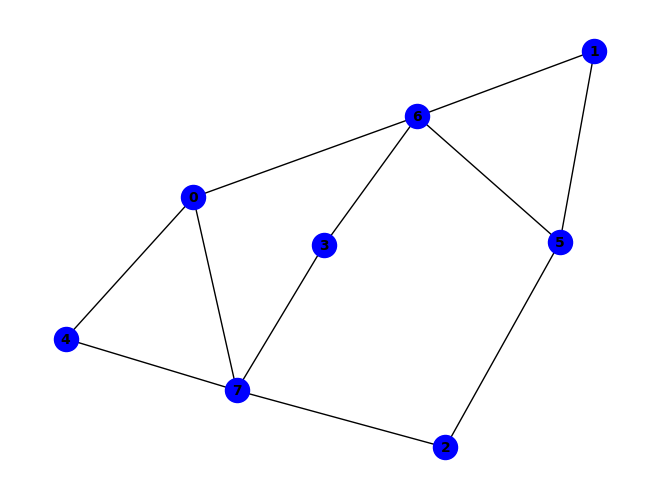


(~c & ~f) ^ (a & h & ~g) ^ (b & f & ~e) ^ (b & g & ~d) ^ (a & b & d & g) ^ (a & e & g & h) ^ (c & ~f & ~h) ^ (b & c & f & ~g) ^ (b & e & f & ~h) ^ (d & f & g & ~a) ^ (b & c & d & g & h) ^ (b & c & e & f & h) ^ (d & e & f & g & h) ^ (a & g & ~b & ~f) ^ (d & g & ~a & ~h) ^ (d & h & ~a & ~e) ^ (e & h & ~c & ~f) ^ (a & b & f & h & ~g) ^ (a & d & e & f & ~g) ^ (a & e & f & h & ~d) ^ (b & c & g & h & ~f) ^ (f & ~c & ~e & ~g) ^ (a & c & h & ~e & ~f) ^ (a & b & c & f & h & ~d) ^ (a & b & c & g & h & ~d) ^ (a & b & d & f & h & ~e) ^ (a & b & c & d & e & f & h) ^ (a & e & ~b & ~f & ~g) ^ (e & f & ~c & ~g & ~h) ^ (a & b & e & f & ~c & ~g) ^ (a & b & e & h & ~c & ~f) ^ (a & c & e & f & ~d & ~g) ^ (a & c & f & h & ~d & ~g) ^ (b & d & f & g & ~a & ~h) ^ (b & d & f & h & ~c & ~e) ^ (b & e & g & h & ~c & ~d) ^ (c & d & f & h & ~e & ~g) ^ (a & b & d & e & g & h & ~c) ^ (a & b & e & ~f & ~g & ~h) ^ (a & e & f & ~d & ~g & ~h) ^ (c & d & h & ~a & ~e & ~f) ^ (a & b & c & e & h & ~f & ~g) ^ (a & c & d & e 

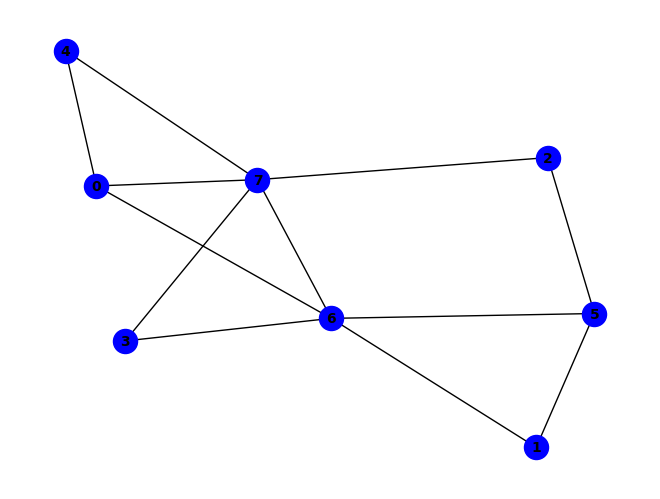


(g & ~h) ^ (a & g & ~d) ^ (a & h & ~d) ^ (d & g & ~e) ^ (d & h & ~e) ^ (f & h & ~g) ^ (f & ~d & ~h) ^ (~b & ~f & ~g) ^ (a & e & ~b & ~g) ^ (b & f & ~c & ~g) ^ (b & h & ~f & ~g) ^ (c & f & ~g & ~h) ^ (c & h & ~d & ~g) ^ (d & f & ~g & ~h) ^ (e & h & ~c & ~g) ^ (c & d & e & g & ~b) ^ (c & d & e & h & ~b) ^ (b & ~d & ~f & ~h) ^ (a & b & e & ~f & ~g) ^ (a & f & g & ~d & ~h) ^ (d & e & g & ~c & ~h) ^ (a & b & c & e & f & ~g) ^ (b & c & d & e & g & ~h) ^ (b & c & d & f & h & ~g) ^ (b & d & ~f & ~g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & d & e & h & ~b & ~g) ^ (b & d & f & h & ~e & ~g) ^ (b & e & f & h & ~c & ~g) ^ (a & b & g & ~d & ~f & ~h) ^ (a & c & h & ~d & ~e & ~g) ^ (a & b & d & e & h & ~f & ~g) ^ (b & c & d & e & h & ~f & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (a & b & f & h & ~c & ~d & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


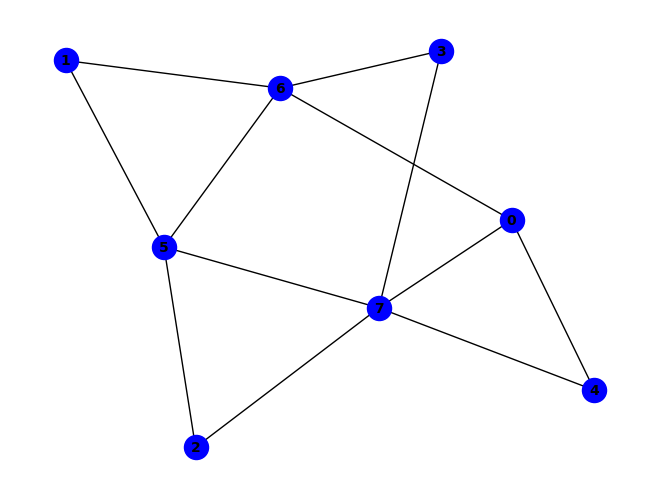


~e ^ (a & e & ~g) ^ (b & g & ~d) ^ (d & e & ~f) ^ (f & h & ~e) ^ (a & e & f & h) ^ (a & e & g & h) ^ (b & d & f & g) ^ (b & f & g & h) ^ (e & ~d & ~h) ^ (a & b & g & ~h) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~f) ^ (b & f & ~c & ~h) ^ (c & f & ~g & ~h) ^ (d & g & ~f & ~h) ^ (d & h & ~c & ~f) ^ (f & g & ~a & ~h) ^ (a & b & d & g & ~f) ^ (a & b & f & g & ~e) ^ (a & d & e & h & ~f) ^ (a & d & f & g & ~h) ^ (b & c & f & g & ~h) ^ (c & d & e & f & ~b) ^ (c & d & e & h & ~b) ^ (a & b & d & e & f & g) ^ (d & e & f & ~c & ~h) ^ (b & c & d & e & h & ~g) ^ (a & b & c & d & e & f & h) ^ (c & h & ~a & ~e & ~f) ^ (a & b & e & f & ~d & ~h) ^ (a & b & g & h & ~c & ~e) ^ (a & c & d & h & ~e & ~f) ^ (b & c & g & h & ~e & ~f) ^ (b & e & g & h & ~d & ~f) ^ (a & b & c & f & g & h & ~e) ^ (a & b & d & e & g & h & ~c) ^ (b & c & d & e & f & g & ~h) ^ (b & c & d & e & f & ~a & ~g) ^ (b & c & d & g & h & ~a & ~f) ^ (a & c & e & f & ~b & ~g & ~h) ^ (a & b & d & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS

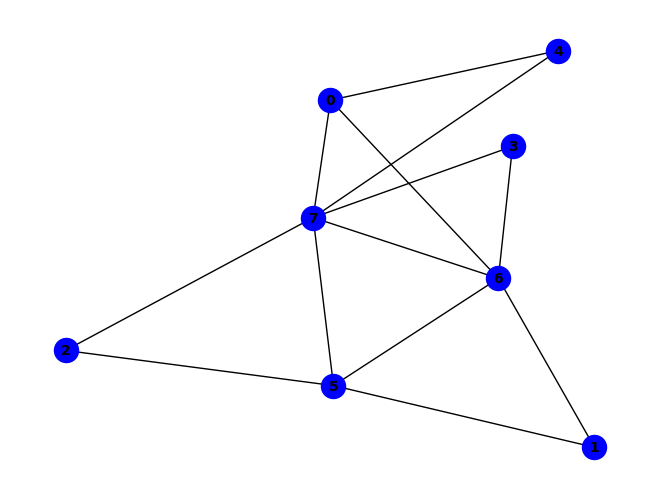


(~b & ~g) ^ (a & e & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (b & h & ~g) ^ (c & f & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (c & e & g & ~h) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (e & h & ~d & ~g) ^ (a & c & f & g & ~e) ^ (a & c & f & h & ~e) ^ (a & e & f & h & ~g) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (b & ~c & ~f & ~h) ^ (a & b & f & ~d & ~h) ^ (a & b & g & ~d & ~h) ^ (b & c & g & ~f & ~h) ^ (b & d & g & ~f & ~h) ^ (e & f & g & ~d & ~h) ^ (c & d & e & f & g & ~h) ^ (b & c & ~a & ~g & ~h) ^ (a & b & d & f & ~g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & d & e & h & ~f & ~g) ^ (c & d & e & h & ~a & ~g) ^ (a & c & d & e & f & h & ~g) ^ (a & b & c & ~e & ~f & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & c & ~f & ~g & ~h) ^ (a & b & f & ~e & ~g & ~h) ^ (c & d & h & ~a & ~f & ~g) ^ (a & c & g & ~b & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

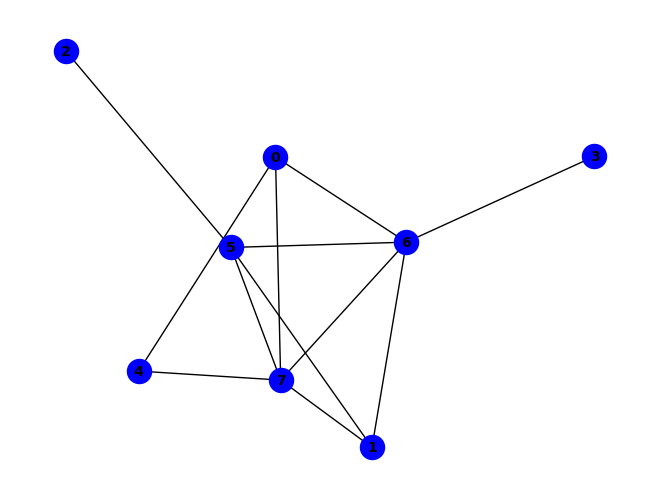


(g & ~h) ^ (~d & ~g) ^ (a & e & ~g) ^ (b & f & ~e) ^ (b & h & ~e) ^ (e & h & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (b & e & f & ~h) ^ (b & f & g & ~h) ^ (e & f & g & ~h) ^ (a & h & ~b & ~f) ^ (b & g & ~c & ~f) ^ (c & f & ~g & ~h) ^ (d & f & ~b & ~g) ^ (d & h & ~f & ~g) ^ (a & b & e & f & ~g) ^ (a & b & e & h & ~g) ^ (a & c & g & h & ~f) ^ (a & e & f & h & ~g) ^ (b & d & f & h & ~g) ^ (b & e & g & h & ~f) ^ (a & c & e & ~f & ~h) ^ (a & c & e & ~g & ~h) ^ (a & d & g & ~f & ~h) ^ (b & d & f & ~a & ~h) ^ (b & d & g & ~a & ~h) ^ (a & g & ~b & ~c & ~f) ^ (b & c & ~a & ~f & ~h) ^ (b & c & ~a & ~g & ~h) ^ (a & b & d & f & ~g & ~h) ^ (b & c & g & h & ~a & ~f) ^ (a & b & c & ~e & ~f & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & c & g & ~b & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


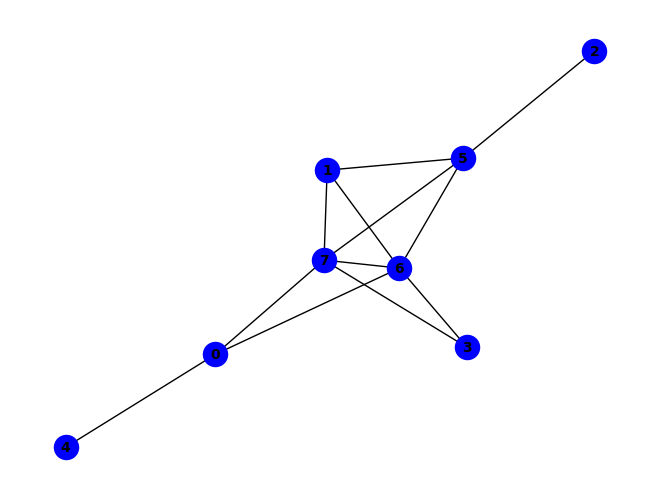


(~a & ~g) ^ (b & g & ~d) ^ (f & g & ~a) ^ (f & h & ~a) ^ (a & b & e & g) ^ (b & d & f & g) ^ (g & ~a & ~h) ^ (b & f & ~a & ~g) ^ (b & h & ~a & ~d) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (a & b & d & g & ~f) ^ (a & b & g & h & ~e) ^ (b & d & f & h & ~a) ^ (a & b & f & ~e & ~h) ^ (b & f & g & ~a & ~h) ^ (a & ~c & ~e & ~g & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (c & f & ~a & ~b & ~g & ~h) ^ (a & c & ~b & ~e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


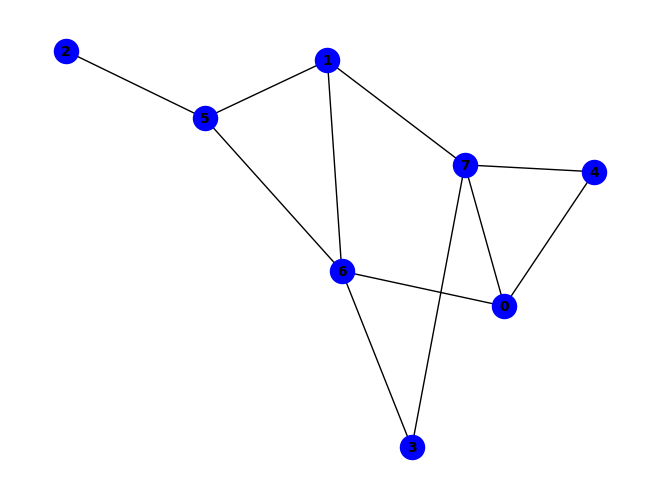


(~c & ~f) ^ (b & f & ~h) ^ (b & h & ~e) ^ (d & h & ~e) ^ (a & e & f & h) ^ (a & e & g & h) ^ (c & d & f & h) ^ (c & ~b & ~g) ^ (f & ~e & ~g) ^ (d & f & g & ~c) ^ (d & e & f & g & h) ^ (a & e & ~f & ~g) ^ (a & g & ~d & ~h) ^ (a & h & ~b & ~d) ^ (b & c & ~f & ~g) ^ (b & g & ~a & ~h) ^ (c & g & ~e & ~f) ^ (d & g & ~c & ~h) ^ (e & h & ~c & ~f) ^ (a & b & d & g & ~h) ^ (b & c & e & h & ~f) ^ (b & d & e & h & ~f) ^ (b & f & g & h & ~e) ^ (a & f & g & ~b & ~d) ^ (b & d & g & ~c & ~f) ^ (b & d & h & ~c & ~g) ^ (a & d & e & f & h & ~g) ^ (b & d & e & f & h & ~g) ^ (e & f & ~a & ~g & ~h) ^ (a & b & e & f & ~d & ~g) ^ (a & b & e & h & ~d & ~f) ^ (a & c & e & f & ~b & ~g) ^ (a & d & e & h & ~c & ~f) ^ (b & c & d & h & ~e & ~f) ^ (b & c & e & g & ~d & ~f) ^ (c & d & e & h & ~f & ~g) ^ (a & b & c & d & e & g & ~f) ^ (a & b & c & d & e & h & ~f) ^ (a & c & d & e & g & h & ~f) ^ (c & d & g & ~b & ~f & ~h) ^ (c & e & g & ~b & ~f & ~h) ^ (c & e & h & ~b & ~d & ~g) ^ (a & b & d & e & f & ~g & ~h) ^ (a &

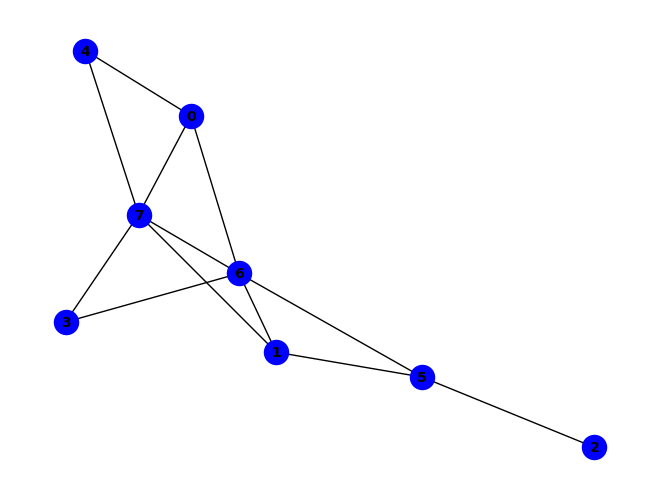


(g & ~h) ^ (~f & ~g) ^ (a & g & ~d) ^ (a & h & ~d) ^ (d & g & ~e) ^ (d & h & ~e) ^ (f & h & ~g) ^ (d & e & g & ~h) ^ (a & e & ~c & ~g) ^ (b & g & ~d & ~e) ^ (b & h & ~d & ~e) ^ (c & f & ~b & ~g) ^ (e & h & ~c & ~g) ^ (a & b & d & g & ~e) ^ (a & b & d & h & ~e) ^ (a & b & e & h & ~g) ^ (a & b & f & h & ~g) ^ (f & ~b & ~d & ~h) ^ (a & b & g & ~c & ~f) ^ (a & b & h & ~c & ~f) ^ (a & c & e & ~f & ~g) ^ (a & f & g & ~d & ~h) ^ (b & e & g & ~d & ~h) ^ (c & e & h & ~f & ~g) ^ (a & b & c & e & f & ~g) ^ (a & b & d & f & g & ~h) ^ (b & c & e & f & h & ~g) ^ (a & b & c & d & e & f & g) ^ (a & b & c & d & e & f & h) ^ (d & f & ~b & ~g & ~h) ^ (a & b & c & g & ~f & ~h) ^ (a & b & c & h & ~d & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & c & f & h & ~d & ~g) ^ (a & d & e & h & ~c & ~g) ^ (a & b & c & d & h & ~f & ~g) ^ (a & b & d & e & g & ~c & ~h) ^ (a & c & d & e & h & ~f & ~g) ^ (c & d & f & h & ~b & ~e & ~g) ^ (a & b & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

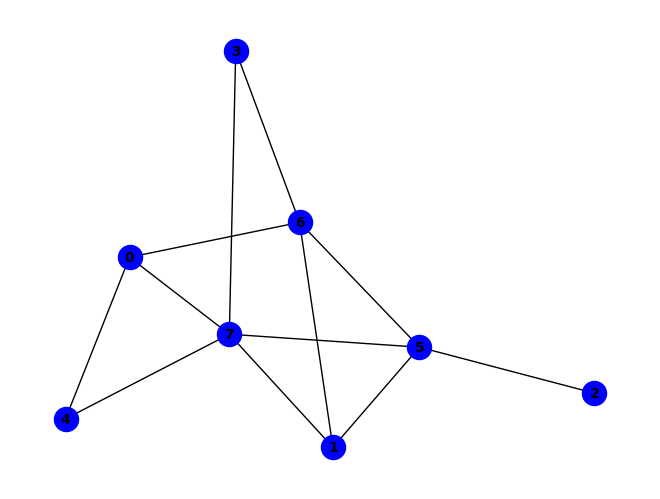


~e ^ (a & e & ~g) ^ (b & f & ~e) ^ (b & g & ~d) ^ (d & e & ~f) ^ (d & h & ~f) ^ (f & h & ~e) ^ (a & e & f & h) ^ (a & e & g & h) ^ (e & ~d & ~h) ^ (b & e & h & ~d) ^ (d & e & f & ~h) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~f) ^ (b & h & ~d & ~g) ^ (d & g & ~f & ~h) ^ (f & g & ~a & ~h) ^ (a & b & e & h & ~f) ^ (a & d & e & h & ~f) ^ (a & d & f & g & ~h) ^ (b & d & f & g & ~h) ^ (b & d & f & h & ~e) ^ (a & b & g & ~c & ~f) ^ (a & b & h & ~f & ~g) ^ (b & e & f & ~a & ~h) ^ (a & b & e & f & g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (a & b & c & e & ~f & ~h) ^ (a & b & c & e & ~g & ~h) ^ (a & b & c & g & ~e & ~f) ^ (a & b & d & g & ~f & ~h) ^ (a & b & d & h & ~e & ~f) ^ (a & c & e & f & ~g & ~h) ^ (a & b & c & e & g & h & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


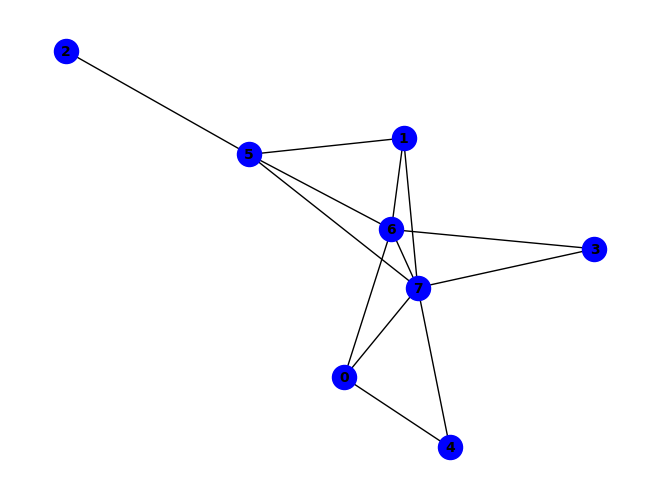


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (b & e & g & ~h) ^ (b & f & g & ~h) ^ (d & g & ~b & ~f) ^ (d & h & ~b & ~f) ^ (e & h & ~d & ~g) ^ (a & b & e & f & ~g) ^ (a & e & f & h & ~g) ^ (b & d & e & h & ~g) ^ (b & e & f & h & ~g) ^ (d & e & f & g & ~b) ^ (d & e & f & h & ~b) ^ (e & f & g & ~d & ~h) ^ (b & d & e & f & g & ~h) ^ (a & g & ~b & ~d & ~f) ^ (a & h & ~b & ~d & ~f) ^ (c & f & ~b & ~g & ~h) ^ (a & b & e & h & ~d & ~g) ^ (a & d & e & h & ~f & ~g) ^ (a & b & d & e & f & h & ~g) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


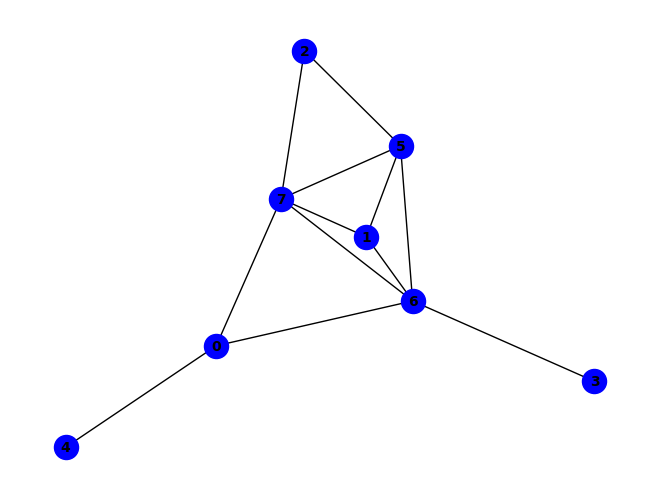


(b & f & ~g) ^ (b & g & ~c) ^ (f & g & ~a) ^ (f & h & ~a) ^ (g & ~a & ~h) ^ (a & b & f & ~d) ^ (b & c & g & ~h) ^ (b & d & f & ~h) ^ (a & b & c & g & h) ^ (a & b & d & f & h) ^ (~a & ~d & ~g) ^ (b & h & ~a & ~c) ^ (c & h & ~a & ~g) ^ (a & b & e & g & ~f) ^ (d & ~a & ~f & ~h) ^ (b & d & g & ~a & ~h) ^ (b & f & g & ~a & ~h) ^ (c & f & ~a & ~b & ~g) ^ (d & f & ~a & ~b & ~g) ^ (d & h & ~a & ~f & ~g) ^ (a & b & g & h & ~e & ~f) ^ (b & d & f & h & ~a & ~g) ^ (a & b & ~c & ~e & ~f & ~h) ^ (a & c & ~e & ~f & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h) ^ (a & ~b & ~c & ~e & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


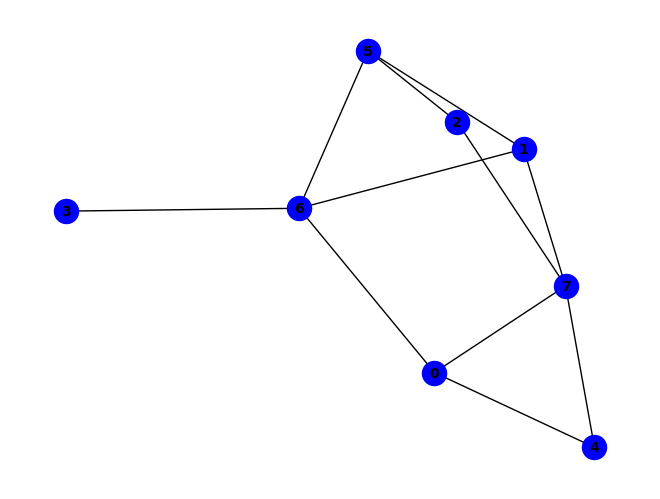


(~c & ~f) ^ (b & h & ~g) ^ (d & g & ~f) ^ (c & ~f & ~h) ^ (a & d & g & ~b) ^ (a & f & g & ~d) ^ (a & b & d & f & g) ^ (a & e & ~f & ~g) ^ (a & g & ~b & ~h) ^ (a & h & ~b & ~c) ^ (b & g & ~d & ~f) ^ (e & h & ~c & ~f) ^ (a & b & e & f & ~d) ^ (a & b & f & g & ~e) ^ (a & e & f & h & ~d) ^ (a & e & g & h & ~d) ^ (d & e & g & h & ~f) ^ (a & c & d & e & g & h) ^ (f & ~c & ~e & ~g) ^ (a & e & f & ~g & ~h) ^ (b & c & f & ~e & ~g) ^ (b & c & h & ~e & ~f) ^ (b & e & f & ~d & ~g) ^ (b & e & h & ~a & ~f) ^ (a & b & d & e & f & ~h) ^ (a & c & d & g & h & ~f) ^ (a & c & f & g & h & ~b) ^ (b & d & e & f & h & ~c) ^ (b & f & ~e & ~g & ~h) ^ (e & f & ~c & ~g & ~h) ^ (a & c & e & h & ~b & ~f) ^ (b & c & e & f & ~g & ~h) ^ (b & d & e & f & ~g & ~h) ^ (c & d & g & h & ~e & ~f) ^ (a & c & d & e & f & h & ~b) ^ (b & c & d & e & f & h & ~g) ^ (a & d & e & f & h & ~b & ~g) ^ (b & c & d & g & h & ~a & ~f) ^ (b & d & e & g & h & ~a & ~c) ^ (a & c & e & f & ~b & ~d & ~g) ^ (a & c & d & e & f & ~b & ~g & ~h)
PAS

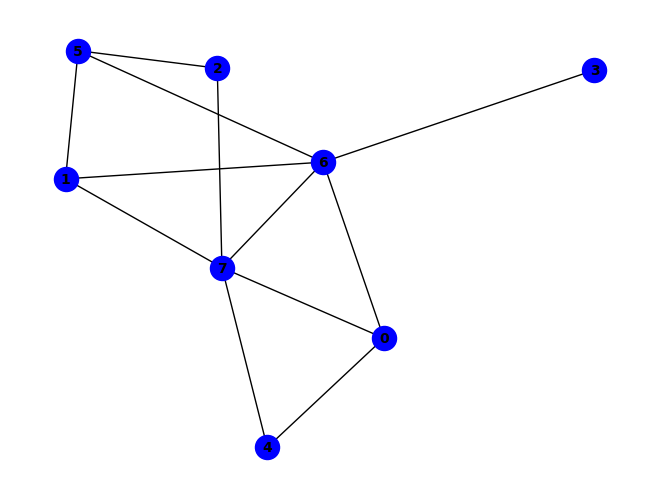


(~f & ~g) ^ (a & e & ~g) ^ (a & g & ~b) ^ (a & h & ~b) ^ (b & g & ~e) ^ (b & h & ~e) ^ (e & h & ~g) ^ (f & h & ~g) ^ (g & ~d & ~h) ^ (b & e & g & ~h) ^ (a & b & e & h & ~g) ^ (f & ~b & ~d & ~h) ^ (a & d & g & ~f & ~h) ^ (a & f & g & ~b & ~h) ^ (b & d & g & ~a & ~h) ^ (a & b & d & f & g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (d & f & ~b & ~g & ~h) ^ (a & c & e & f & ~g & ~h) ^ (c & h & ~a & ~b & ~e & ~g) ^ (a & b & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


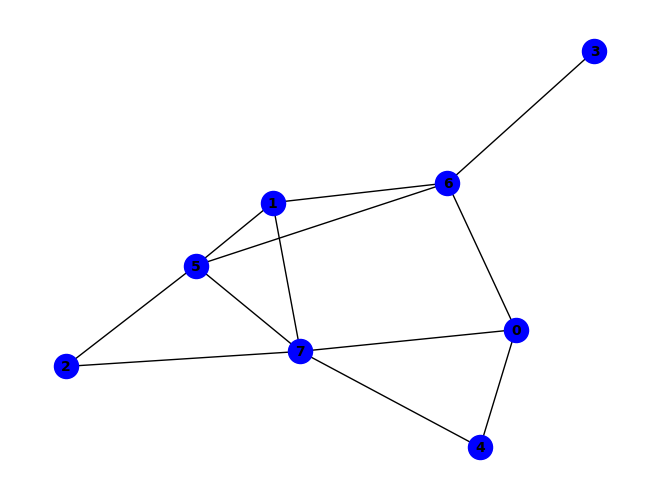


~e ^ (d & e & g) ^ (b & f & ~e) ^ (b & h & ~e) ^ (f & g & ~h) ^ (f & h & ~e) ^ (a & e & g & h) ^ (e & ~d & ~h) ^ (b & d & e & f & g) ^ (d & e & f & g & h) ^ (a & e & ~d & ~g) ^ (a & g & ~f & ~h) ^ (a & h & ~b & ~f) ^ (b & g & ~a & ~h) ^ (a & b & e & f & ~h) ^ (a & d & e & h & ~c) ^ (a & e & f & h & ~d) ^ (c & d & f & h & ~e) ^ (c & d & g & h & ~e) ^ (a & c & d & e & f & h) ^ (b & c & f & ~g & ~h) ^ (b & e & f & ~d & ~h) ^ (c & d & f & ~e & ~g) ^ (a & c & d & e & f & ~g) ^ (a & c & d & e & h & ~g) ^ (a & d & e & f & h & ~g) ^ (b & c & d & g & h & ~f) ^ (b & d & e & g & h & ~c) ^ (a & b & c & d & e & g & h) ^ (c & f & ~d & ~g & ~h) ^ (d & e & ~a & ~g & ~h) ^ (d & g & ~a & ~b & ~f) ^ (a & b & c & e & ~f & ~g) ^ (a & b & c & e & ~g & ~h) ^ (a & b & e & h & ~c & ~f) ^ (a & b & f & g & ~e & ~h) ^ (b & d & e & f & ~g & ~h) ^ (a & b & c & e & g & h & ~f) ^ (a & b & d & e & g & h & ~f) ^ (b & c & d & e & f & h & ~a) ^ (a & c & d & g & h & ~b & ~f) ^ (b & c & d & e & f & ~a & ~g) ^ (c & h & ~a 

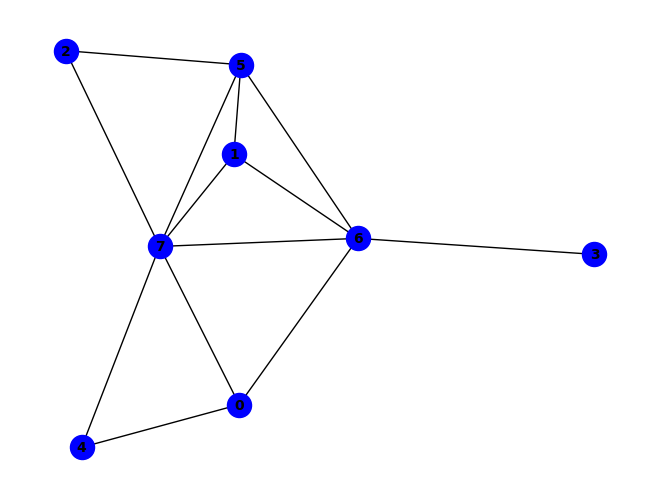


(g & ~h) ^ (~d & ~g) ^ (a & e & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & g & ~e) ^ (f & h & ~e) ^ (d & ~f & ~h) ^ (a & d & f & ~h) ^ (b & d & g & ~h) ^ (b & e & g & ~h) ^ (e & f & g & ~h) ^ (a & g & ~b & ~f) ^ (a & h & ~b & ~f) ^ (b & f & ~d & ~g) ^ (c & f & ~b & ~g) ^ (c & h & ~b & ~g) ^ (d & f & ~a & ~g) ^ (d & h & ~f & ~g) ^ (e & h & ~c & ~g) ^ (a & b & e & f & ~g) ^ (a & b & e & h & ~g) ^ (a & d & f & h & ~g) ^ (a & e & f & h & ~g) ^ (b & c & e & h & ~g) ^ (b & d & f & h & ~g) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & e & f & h & ~g) ^ (a & d & g & ~b & ~h) ^ (b & d & f & ~a & ~h) ^ (b & f & g & ~e & ~h) ^ (b & c & e & f & g & ~h) ^ (a & b & d & f & ~g & ~h) ^ (a & c & e & f & ~b & ~g & ~h) ^ (a & c & h & ~b & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


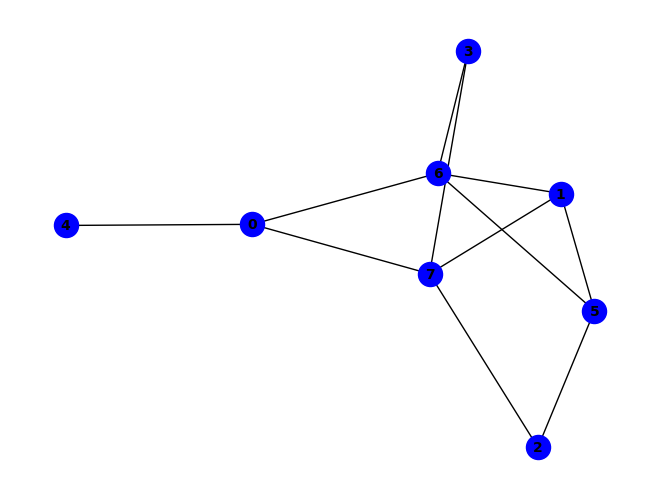


~f ^ (a & e & ~g) ^ (a & h & ~e) ^ (a & e & g & h) ^ (a & d & h & ~c) ^ (a & f & g & ~d) ^ (d & f & g & ~b) ^ (a & g & ~d & ~h) ^ (b & g & ~f & ~h) ^ (b & h & ~c & ~f) ^ (c & h & ~a & ~f) ^ (d & g & ~b & ~h) ^ (d & h & ~b & ~c) ^ (a & b & c & e & ~f) ^ (a & b & d & g & ~f) ^ (a & c & d & f & g & h) ^ (f & ~b & ~c & ~g) ^ (a & b & f & ~g & ~h) ^ (a & b & h & ~d & ~g) ^ (a & b & c & d & h & ~f) ^ (c & d & f & g & h & ~b) ^ (a & b & ~e & ~f & ~h) ^ (a & b & ~e & ~g & ~h) ^ (a & b & c & e & ~g & ~h) ^ (a & b & c & h & ~e & ~f) ^ (a & b & e & g & ~c & ~f) ^ (a & b & g & h & ~e & ~f) ^ (a & c & e & f & ~g & ~h) ^ (a & c & f & h & ~b & ~g) ^ (a & b & c & d & f & h & ~g) ^ (a & b & c & e & g & h & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


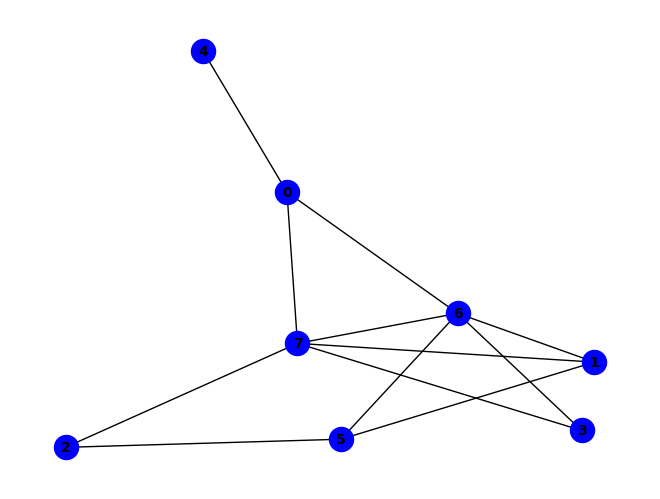


(g & ~h) ^ (~f & ~g) ^ (a & g & ~f) ^ (a & h & ~f) ^ (b & f & ~d) ^ (b & g & ~d) ^ (f & ~d & ~h) ^ (a & b & h & ~d) ^ (a & b & c & d & h) ^ (a & b & e & g & h) ^ (a & e & ~g & ~h) ^ (b & h & ~d & ~f) ^ (d & g & ~a & ~c) ^ (d & h & ~a & ~c) ^ (f & h & ~a & ~g) ^ (a & b & d & g & ~c) ^ (a & b & e & f & ~h) ^ (a & d & f & g & ~h) ^ (b & c & d & h & ~g) ^ (a & b & g & ~c & ~e) ^ (c & d & g & ~a & ~h) ^ (a & b & c & d & g & ~h) ^ (a & b & c & g & h & ~e) ^ (c & f & ~b & ~g & ~h) ^ (c & h & ~a & ~b & ~g) ^ (d & f & ~b & ~g & ~h) ^ (a & b & c & f & ~e & ~h) ^ (a & b & c & f & ~g & ~h) ^ (a & b & e & g & ~f & ~h) ^ (a & b & f & g & ~d & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & b & c & g & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


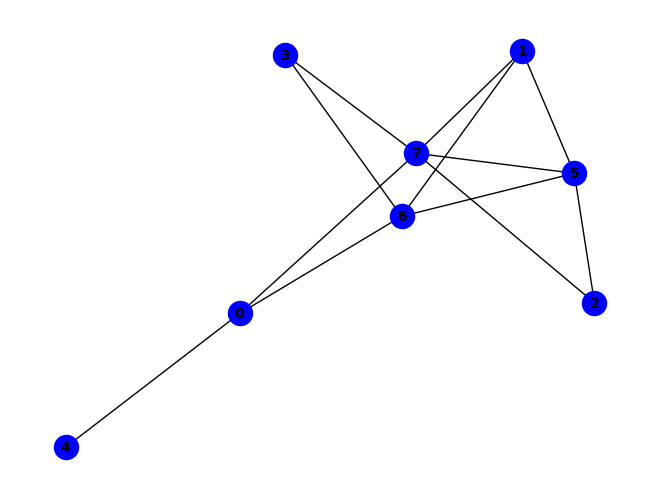


~d ^ (b & f & ~d) ^ (b & h & ~d) ^ (f & h & ~d) ^ (d & ~g & ~h) ^ (b & g & ~d & ~h) ^ (f & g & ~d & ~h) ^ (a & b & d & h & ~f) ^ (a & b & e & ~f & ~g) ^ (a & b & h & ~e & ~f) ^ (b & d & f & ~g & ~h) ^ (a & b & e & g & h & ~f) ^ (a & e & ~b & ~g & ~h) ^ (a & h & ~c & ~d & ~f) ^ (c & f & ~b & ~g & ~h) ^ (c & h & ~b & ~d & ~f) ^ (a & b & c & h & ~d & ~f) ^ (a & g & ~b & ~d & ~f & ~h) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


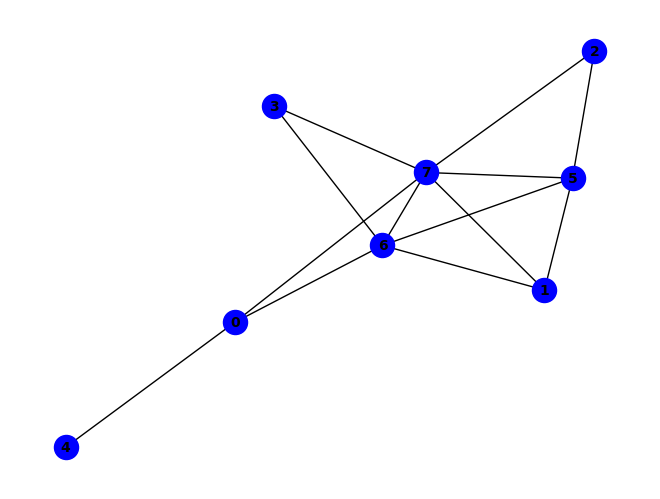


(~a & ~g) ^ (b & g & ~d) ^ (c & g & ~d) ^ (f & g & ~a) ^ (f & h & ~a) ^ (a & b & e & g) ^ (a & c & e & g) ^ (a & b & d & f & h) ^ (b & h & ~a & ~d) ^ (c & f & ~a & ~g) ^ (c & h & ~a & ~d) ^ (d & g & ~a & ~f) ^ (d & h & ~a & ~f) ^ (a & b & d & g & ~f) ^ (a & b & g & h & ~e) ^ (a & c & d & g & ~f) ^ (b & d & f & g & ~c) ^ (b & d & f & h & ~c) ^ (c & d & f & h & ~g) ^ (a & ~e & ~g & ~h) ^ (g & ~a & ~c & ~h) ^ (a & b & f & ~e & ~h) ^ (a & c & f & ~e & ~h) ^ (b & f & g & ~a & ~h) ^ (c & d & g & ~a & ~h) ^ (a & c & d & f & g & ~h) ^ (a & c & d & f & h & ~b) ^ (a & c & f & g & h & ~e) ^ (b & c & d & f & g & ~h) ^ (a & b & c & d & f & g & h) ^ (b & f & ~a & ~c & ~g) ^ (a & b & c & ~e & ~f & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & b & g & ~e & ~f & ~h) ^ (a & c & g & ~b & ~e & ~f) ^ (b & c & h & ~a & ~d & ~g) ^ (a & b & c & g & h & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


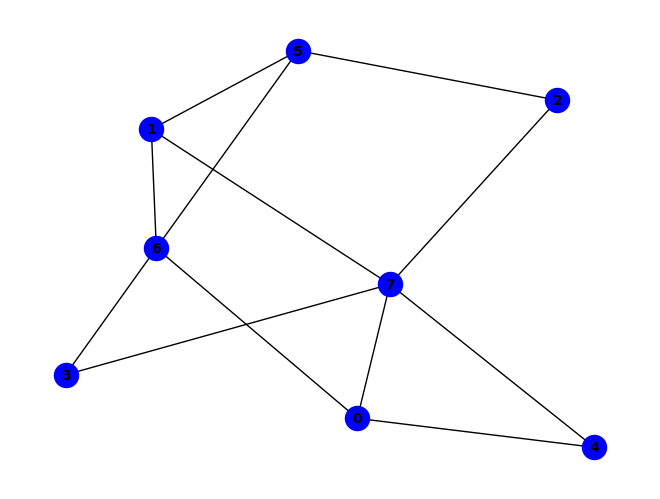


(~c & ~f) ^ (a & g & ~f) ^ (a & h & ~g) ^ (b & h & ~e) ^ (a & e & g & h) ^ (b & e & f & g) ^ (b & f & g & h) ^ (c & ~f & ~h) ^ (a & b & h & ~d) ^ (b & d & g & ~a) ^ (b & d & h & ~g) ^ (a & b & d & g & h) ^ (d & e & f & g & h) ^ (a & e & ~f & ~g) ^ (b & f & ~e & ~h) ^ (b & g & ~a & ~h) ^ (d & g & ~a & ~h) ^ (d & h & ~a & ~e) ^ (e & h & ~c & ~f) ^ (a & b & e & f & ~d) ^ (a & b & f & g & ~e) ^ (a & e & f & h & ~d) ^ (b & d & e & h & ~f) ^ (f & ~c & ~e & ~g) ^ (a & e & f & ~g & ~h) ^ (b & c & f & ~e & ~g) ^ (c & d & h & ~e & ~f) ^ (d & f & g & ~a & ~b) ^ (a & b & c & f & h & ~g) ^ (a & b & d & e & f & ~h) ^ (a & b & d & e & h & ~c) ^ (a & b & c & d & e & f & h) ^ (e & f & ~c & ~g & ~h) ^ (a & b & c & h & ~d & ~f) ^ (a & b & e & h & ~c & ~f) ^ (a & c & f & h & ~d & ~g) ^ (b & d & e & f & ~c & ~g) ^ (c & d & f & h & ~e & ~g) ^ (a & c & h & ~d & ~e & ~f) ^ (b & c & h & ~d & ~e & ~f) ^ (a & d & e & f & h & ~b & ~g) ^ (b & c & d & f & h & ~a & ~g) ^ (a & c & e & f & ~b & ~d & ~g) ^ (b & e & f 

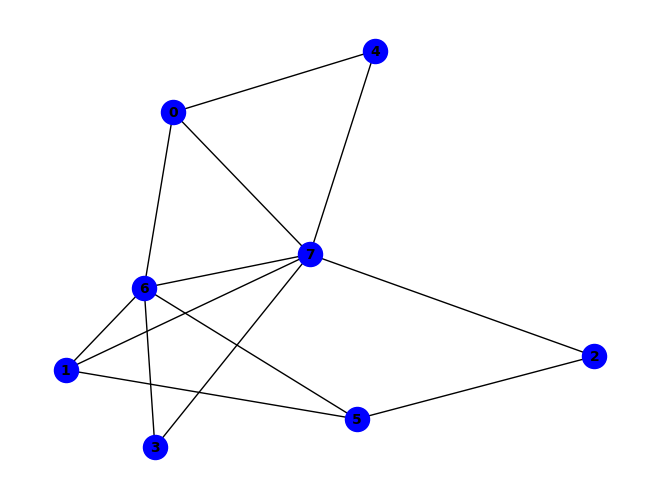


(g & ~h) ^ (~f & ~g) ^ (a & e & ~g) ^ (b & f & ~d) ^ (d & g & ~e) ^ (d & h & ~e) ^ (f & ~d & ~h) ^ (b & e & h & ~d) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (b & g & ~d & ~e) ^ (b & h & ~d & ~f) ^ (c & h & ~d & ~g) ^ (e & h & ~c & ~g) ^ (f & h & ~a & ~g) ^ (a & b & d & g & ~f) ^ (a & b & d & h & ~f) ^ (a & b & e & f & ~h) ^ (a & b & f & g & ~h) ^ (c & d & e & g & ~b) ^ (c & d & e & h & ~b) ^ (a & b & g & ~c & ~e) ^ (a & b & h & ~c & ~e) ^ (b & c & h & ~e & ~g) ^ (b & e & g & ~d & ~h) ^ (d & e & g & ~c & ~h) ^ (b & c & d & e & g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (d & f & ~b & ~g & ~h) ^ (a & b & c & e & ~f & ~h) ^ (a & b & c & e & ~g & ~h) ^ (a & b & c & g & ~e & ~h) ^ (a & c & e & f & ~g & ~h) ^ (a & d & e & h & ~b & ~g) ^ (a & d & f & h & ~b & ~g) ^ (b & c & d & h & ~a & ~g) ^ (a & b & c & d & e & h & ~g) ^ (a & c & h & ~d & ~e & ~g) ^ (a & b & e & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

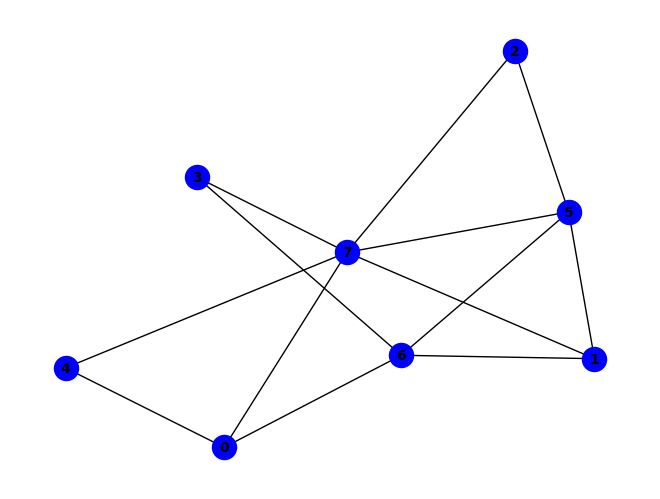


~e ^ (a & e & ~g) ^ (b & f & ~e) ^ (b & h & ~e) ^ (d & e & ~f) ^ (f & h & ~e) ^ (a & e & g & h) ^ (e & ~d & ~h) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~f) ^ (b & g & ~d & ~h) ^ (d & g & ~f & ~h) ^ (d & h & ~c & ~f) ^ (f & g & ~a & ~h) ^ (a & b & d & h & ~f) ^ (a & d & e & h & ~b) ^ (a & d & f & g & ~h) ^ (a & e & f & h & ~d) ^ (b & c & e & f & ~d) ^ (b & c & e & h & ~d) ^ (b & d & f & g & ~h) ^ (c & d & e & f & ~a) ^ (c & d & e & h & ~a) ^ (a & b & d & e & f & h) ^ (b & c & h & ~d & ~f) ^ (b & d & h & ~e & ~f) ^ (b & e & f & ~c & ~h) ^ (d & e & f & ~c & ~h) ^ (a & c & d & e & f & ~h) ^ (b & c & d & e & f & ~h) ^ (c & f & ~b & ~g & ~h) ^ (c & h & ~a & ~e & ~f) ^ (a & c & d & h & ~b & ~f) ^ (a & c & e & f & ~g & ~h) ^ (a & b & c & d & e & h & ~f) ^ (a & b & g & ~d & ~f & ~h) ^ (a & b & h & ~c & ~e & ~f) ^ (a & b & e & f & ~c & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

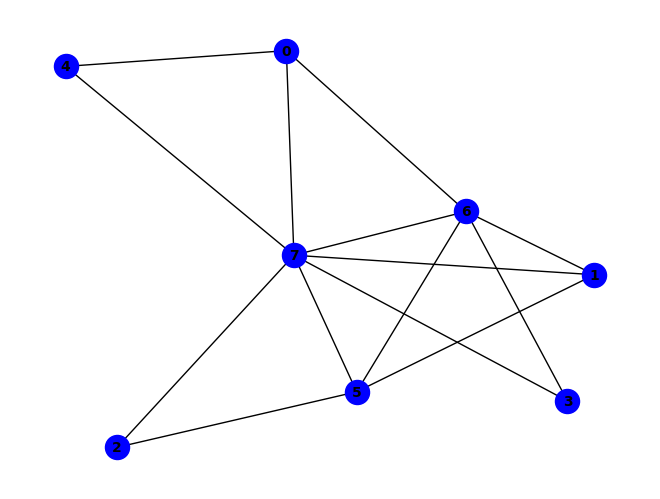


~g ^ (a & e & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (c & f & ~g) ^ (f & g & ~e) ^ (f & h & ~e) ^ (g & ~c & ~h) ^ (b & e & g & ~h) ^ (b & f & ~c & ~g) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (d & g & ~b & ~f) ^ (d & h & ~b & ~f) ^ (e & h & ~d & ~g) ^ (a & b & e & f & ~g) ^ (b & c & e & h & ~f) ^ (b & d & e & h & ~g) ^ (b & e & f & g & ~d) ^ (b & e & f & h & ~d) ^ (c & e & f & h & ~g) ^ (d & e & f & g & ~c) ^ (d & e & f & h & ~c) ^ (a & b & d & e & f & g) ^ (a & c & d & e & f & h) ^ (b & c & d & e & f & g) ^ (b & c & d & e & f & h) ^ (b & c & h & ~d & ~g) ^ (b & f & g & ~e & ~h) ^ (c & e & g & ~b & ~h) ^ (e & f & g & ~d & ~h) ^ (b & c & d & f & h & ~g) ^ (a & g & ~b & ~d & ~f) ^ (a & h & ~b & ~d & ~f) ^ (a & b & c & e & ~f & ~h) ^ (a & b & c & e & ~g & ~h) ^ (a & b & c & h & ~e & ~g) ^ (a & b & e & h & ~d & ~g) ^ (a & c & e & f & ~g & ~h) ^ (a & c & f & g & ~b & ~e) ^ (a & c & f & h & ~b & ~e) ^ (a & d & e & h & ~c & ~g) ^ (a & e & f & h & ~d & ~g) ^ (b & c & e & g & ~a & ~f) ^ (c & d &

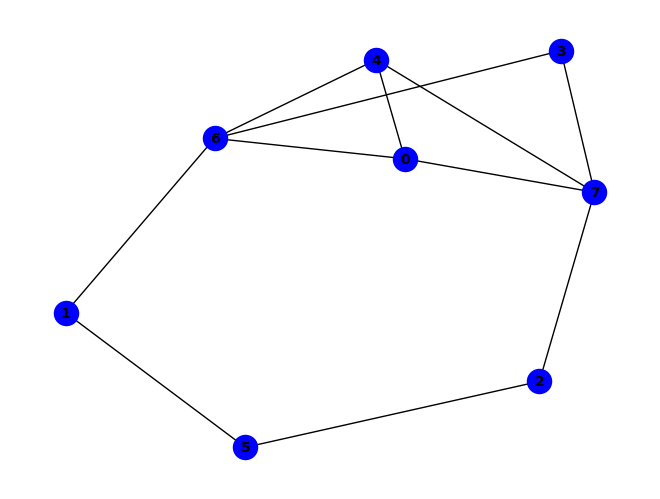


~d ^ (a & e & ~d) ^ (a & h & ~d) ^ (b & f & ~g) ^ (e & h & ~d) ^ (d & ~g & ~h) ^ (b & d & e & f & h) ^ (a & g & ~d & ~h) ^ (b & g & ~c & ~e) ^ (c & f & ~b & ~h) ^ (e & g & ~d & ~h) ^ (a & b & e & f & ~g) ^ (b & c & f & h & ~g) ^ (b & d & f & g & ~c) ^ (c & d & f & g & ~h) ^ (b & c & d & e & f & g) ^ (a & d & e & ~g & ~h) ^ (b & c & g & ~e & ~h) ^ (b & d & g & ~f & ~h) ^ (b & d & h & ~c & ~f) ^ (b & d & h & ~c & ~g) ^ (a & b & c & e & g & ~h) ^ (a & b & d & e & h & ~g) ^ (b & c & d & e & g & ~h) ^ (b & c & e & f & g & ~h) ^ (c & h & ~a & ~d & ~e) ^ (a & b & e & g & ~c & ~d) ^ (a & b & f & h & ~c & ~d) ^ (a & c & e & f & ~b & ~h) ^ (a & c & f & g & ~d & ~h) ^ (b & e & f & h & ~c & ~g) ^ (c & e & f & g & ~d & ~h) ^ (a & c & d & e & f & g & ~h) ^ (b & c & d & e & f & h & ~g) ^ (a & b & g & ~c & ~d & ~f) ^ (a & b & c & d & e & ~f & ~g) ^ (a & b & c & d & e & ~f & ~h) ^ (a & b & d & e & h & ~c & ~f) ^ (b & d & e & f & g & ~c & ~h) ^ (a & b & c & g & ~d & ~f & ~h) ^ (a & b & f & g & ~c & ~d 

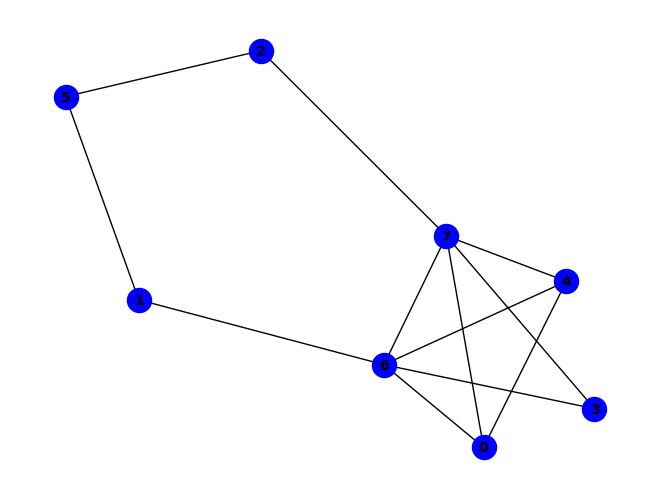


(~c & ~g) ^ (a & g & ~d) ^ (e & g & ~c) ^ (e & h & ~c) ^ (a & c & e & f) ^ (a & c & g & ~e) ^ (a & b & c & f & g) ^ (a & e & ~b & ~g) ^ (a & h & ~c & ~d) ^ (b & f & ~c & ~g) ^ (d & g & ~c & ~e) ^ (d & h & ~c & ~e) ^ (a & b & f & g & ~d) ^ (a & c & d & g & ~b) ^ (a & c & e & h & ~f) ^ (a & d & e & g & ~c) ^ (a & d & e & h & ~c) ^ (b & d & f & h & ~c) ^ (b & e & f & g & ~c) ^ (c & ~e & ~f & ~h) ^ (g & ~b & ~c & ~h) ^ (a & b & e & ~f & ~g) ^ (b & c & g & ~f & ~h) ^ (b & d & g & ~f & ~h) ^ (a & b & c & d & g & ~f) ^ (a & b & c & e & f & ~g) ^ (c & e & ~f & ~g & ~h) ^ (a & b & f & h & ~c & ~d) ^ (b & d & f & g & ~c & ~e) ^ (b & e & f & h & ~c & ~d) ^ (a & b & d & e & f & g & ~c) ^ (a & b & d & e & f & h & ~c) ^ (a & b & g & ~d & ~f & ~h) ^ (a & c & g & ~d & ~f & ~h) ^ (a & e & g & ~b & ~c & ~h) ^ (b & e & g & ~d & ~f & ~h) ^ (c & d & g & ~e & ~f & ~h) ^ (a & b & c & e & g & ~f & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

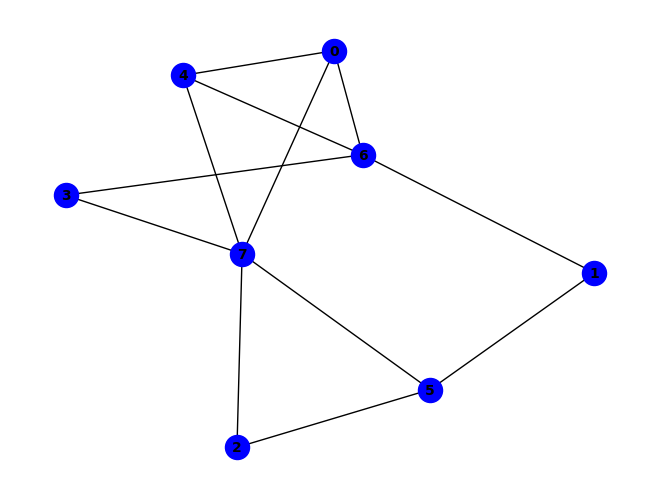


(b & d & g) ^ (~b & ~f) ^ (c & h & ~b) ^ (e & g & ~h) ^ (a & c & e & h) ^ (f & ~b & ~h) ^ (a & f & h & ~d) ^ (b & e & g & ~d) ^ (a & b & d & e & g) ^ (b & c & d & f & g) ^ (b & c & d & g & h) ^ (b & e & f & g & h) ^ (c & d & e & f & g) ^ (a & e & ~b & ~f) ^ (a & g & ~b & ~d) ^ (a & h & ~d & ~g) ^ (c & f & ~b & ~e) ^ (d & g & ~e & ~h) ^ (e & h & ~c & ~f) ^ (a & c & e & f & ~d) ^ (a & d & e & g & ~h) ^ (c & d & f & g & ~h) ^ (c & e & f & h & ~d) ^ (a & c & d & e & f & h) ^ (b & ~c & ~f & ~g) ^ (a & c & h & ~d & ~f) ^ (a & e & f & ~b & ~h) ^ (c & e & f & ~g & ~h) ^ (a & b & c & e & f & ~h) ^ (a & b & c & e & h & ~f) ^ (a & b & c & f & g & ~d) ^ (a & b & c & g & h & ~d) ^ (a & b & f & g & h & ~d) ^ (b & c & d & e & f & ~a) ^ (b & c & e & g & h & ~d) ^ (b & d & f & g & h & ~e) ^ (c & d & e & f & h & ~g) ^ (a & b & c & d & e & g & h) ^ (a & b & d & e & f & g & h) ^ (b & c & ~f & ~g & ~h) ^ (d & h & ~c & ~e & ~f) ^ (a & c & f & g & ~d & ~h) ^ (a & d & e & h & ~c & ~f) ^ (b & c & e & f & ~d &

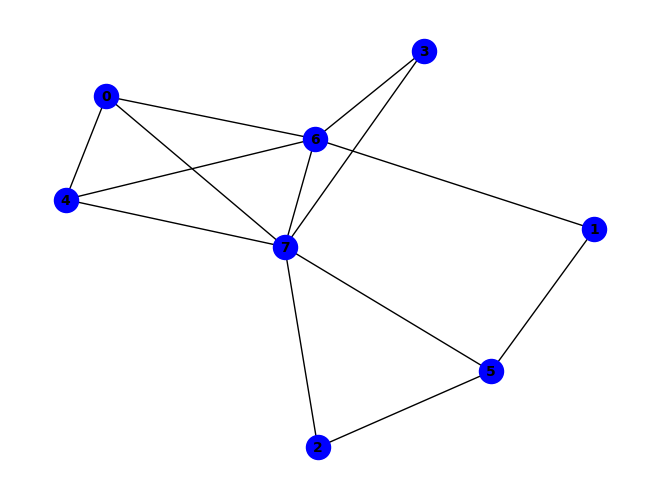


(g & ~h) ^ (~b & ~g) ^ (a & e & ~g) ^ (b & h & ~g) ^ (f & h & ~g) ^ (a & e & f & g) ^ (a & e & f & h) ^ (b & e & g & ~h) ^ (b & f & g & ~h) ^ (e & f & g & ~h) ^ (a & g & ~d & ~f) ^ (a & h & ~d & ~f) ^ (b & c & ~e & ~h) ^ (c & f & ~e & ~h) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (b & ~c & ~f & ~h) ^ (a & b & g & ~e & ~h) ^ (a & e & g & ~f & ~h) ^ (c & e & f & ~g & ~h) ^ (a & b & c & e & f & ~h) ^ (a & b & c & f & g & ~h) ^ (a & d & e & f & g & ~h) ^ (b & c & d & e & f & ~h) ^ (b & c & d & f & g & ~h) ^ (c & h & ~d & ~f & ~g) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & f & ~d & ~h) ^ (a & d & e & g & ~c & ~f) ^ (a & d & e & h & ~c & ~f) ^ (c & d & e & h & ~f & ~g) ^ (a & c & h & ~e & ~f & ~g) ^ (a & f & g & ~c & ~d & ~h) ^ (b & c & e & ~d & ~g & ~h) ^ (b & d & g & ~a & ~e & ~h) ^ (c & e & g & ~b & ~f & ~h) ^ (d & f & g & ~c & ~e & ~h) ^ (a & b & c & d & g & ~e & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (a & b & c & d 

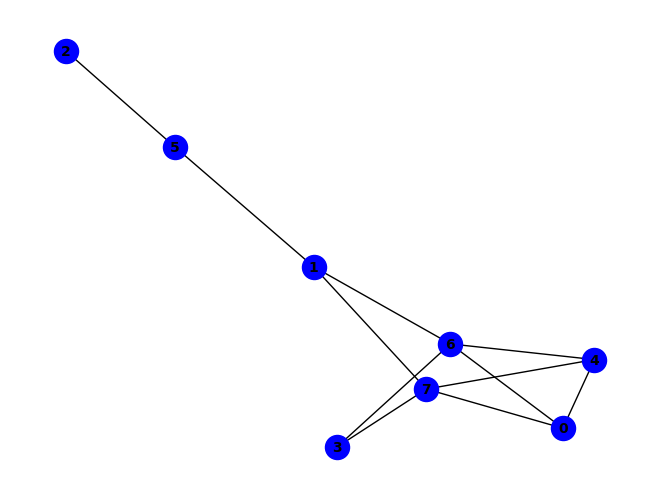


~d ^ (a & e & ~d) ^ (b & f & ~h) ^ (b & g & ~f) ^ (b & h & ~g) ^ (e & h & ~d) ^ (a & c & f & h) ^ (b & f & g & h) ^ (d & ~g & ~h) ^ (b & d & h & ~e) ^ (b & e & h & ~a) ^ (a & b & c & f & g) ^ (b & c & d & f & g) ^ (c & d & e & f & g) ^ (a & h & ~b & ~d) ^ (c & f & ~b & ~e) ^ (e & g & ~d & ~h) ^ (a & c & e & f & ~b) ^ (a & c & f & g & ~h) ^ (c & d & f & h & ~a) ^ (a & b & c & d & f & h) ^ (a & c & d & e & f & h) ^ (b & c & d & e & f & h) ^ (a & d & e & ~g & ~h) ^ (b & d & g & ~e & ~h) ^ (b & e & g & ~a & ~h) ^ (a & b & c & f & h & ~g) ^ (a & b & d & e & h & ~c) ^ (b & c & d & f & h & ~g) ^ (c & d & e & f & h & ~g) ^ (a & g & ~b & ~d & ~h) ^ (a & b & e & f & ~g & ~h) ^ (c & d & f & g & ~a & ~h) ^ (a & b & c & d & e & h & ~f) ^ (a & b & c & d & f & g & ~h) ^ (a & c & d & e & f & g & ~h) ^ (b & c & d & e & f & g & ~h) ^ (c & e & f & ~b & ~g & ~h) ^ (a & b & d & e & g & ~c & ~h) ^ (a & b & c & d & e & g & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
P

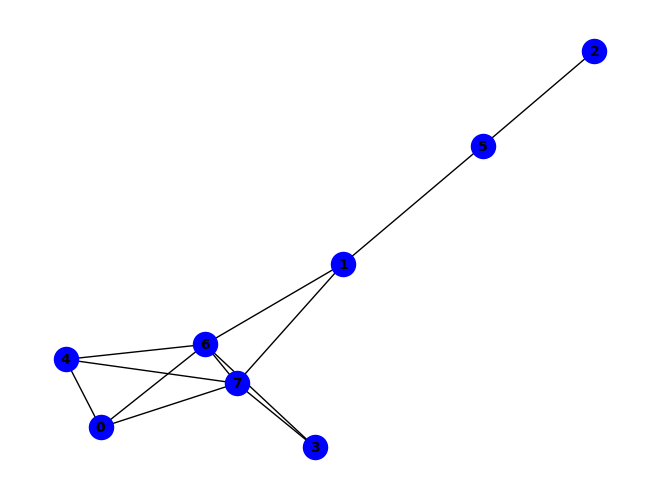


(~c & ~g) ^ (a & h & ~d) ^ (b & c & ~g) ^ (b & f & ~h) ^ (b & g & ~f) ^ (e & h & ~c) ^ (b & f & g & h) ^ (g & ~c & ~h) ^ (a & b & e & g & h) ^ (b & c & e & f & h) ^ (a & e & ~c & ~g) ^ (a & g & ~b & ~d) ^ (b & h & ~a & ~e) ^ (c & g & ~f & ~h) ^ (d & g & ~b & ~e) ^ (d & h & ~b & ~e) ^ (e & g & ~b & ~c) ^ (a & b & d & h & ~e) ^ (a & b & e & f & ~h) ^ (a & d & e & h & ~c) ^ (b & c & f & g & ~h) ^ (c & d & e & h & ~b) ^ (c & d & f & h & ~b) ^ (c & ~b & ~f & ~g) ^ (a & c & e & ~f & ~g) ^ (a & e & g & ~c & ~h) ^ (c & e & g & ~b & ~f) ^ (c & e & h & ~d & ~f) ^ (a & b & c & e & f & ~g) ^ (a & b & c & e & g & ~h) ^ (a & c & d & e & h & ~f) ^ (b & c & d & e & h & ~f) ^ (a & b & c & d & e & f & h) ^ (a & c & e & g & ~f & ~h) ^ (a & c & f & g & ~b & ~d) ^ (a & c & f & h & ~b & ~d) ^ (a & d & e & g & ~b & ~c) ^ (c & d & f & g & ~b & ~e) ^ (a & c & d & e & g & ~b & ~f) ^ (a & b & e & g & ~c & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

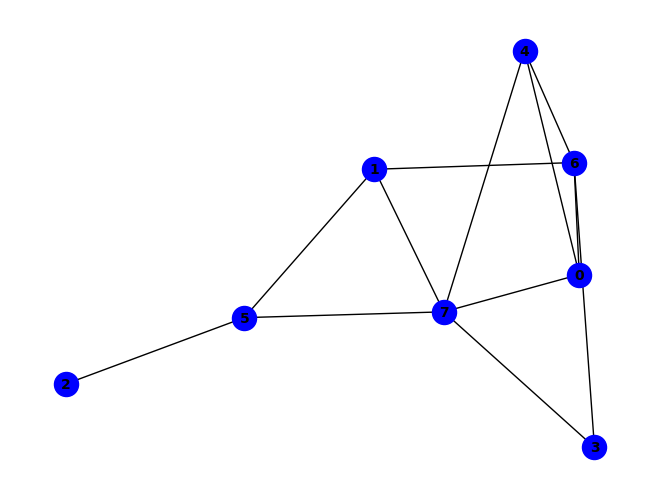


(f & ~h) ^ (~c & ~f) ^ (b & f & ~g) ^ (c & h & ~f) ^ (e & g & ~h) ^ (e & h & ~f) ^ (b & d & f & h) ^ (b & f & g & h) ^ (c & ~e & ~h) ^ (a & e & f & ~h) ^ (b & c & f & ~h) ^ (b & d & g & ~e) ^ (a & e & ~c & ~f) ^ (a & g & ~d & ~h) ^ (a & h & ~d & ~f) ^ (b & h & ~a & ~e) ^ (d & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (a & b & f & h & ~e) ^ (a & d & e & g & ~h) ^ (a & d & e & h & ~f) ^ (b & e & f & h & ~d) ^ (b & d & h & ~e & ~g) ^ (c & e & f & ~g & ~h) ^ (b & c & e & f & g & ~h) ^ (b & g & ~a & ~e & ~h) ^ (c & e & ~d & ~f & ~h) ^ (a & b & c & e & ~d & ~f) ^ (a & b & d & g & ~e & ~h) ^ (a & b & d & h & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & c & e & h & ~b & ~f) ^ (c & d & e & g & ~b & ~h) ^ (c & d & f & g & ~b & ~h) ^ (a & b & c & d & e & h & ~f) ^ (a & c & e & ~b & ~d & ~h) ^ (c & d & e & ~f & ~g & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (a & c & d & e & ~b & ~g & ~h) ^ (a & c & f & g & ~b & ~d & ~h) ^ (a & b & c & d & e & ~f & ~g & ~h)
PASS
PASS
PASS
PASS


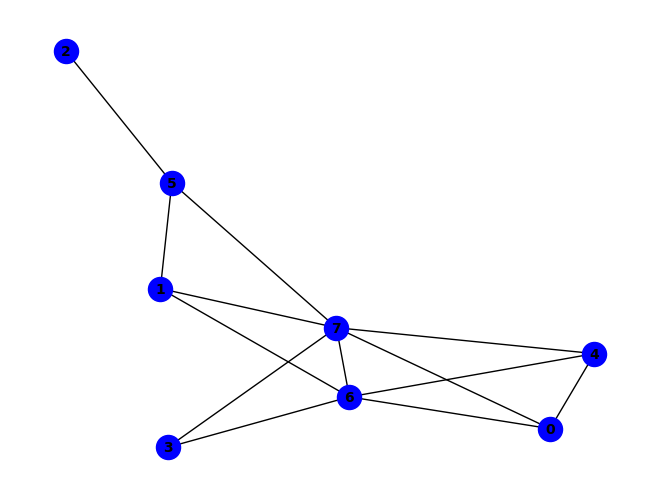


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (e & g & ~f) ^ (e & h & ~f) ^ (f & h & ~g) ^ (a & e & g & ~h) ^ (c & f & ~b & ~h) ^ (a & b & e & f & ~g) ^ (a & b & e & g & ~d) ^ (a & b & e & h & ~d) ^ (a & d & e & g & ~f) ^ (a & d & e & h & ~f) ^ (a & e & f & h & ~g) ^ (b & e & f & h & ~g) ^ (e & f & g & ~c & ~h) ^ (b & c & d & f & g & ~h) ^ (a & g & ~b & ~d & ~f) ^ (a & h & ~b & ~d & ~f) ^ (d & g & ~b & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & c & e & f & ~b & ~h) ^ (b & d & f & g & ~e & ~h) ^ (a & b & d & e & f & h & ~g) ^ (d & f & g & ~c & ~e & ~h) ^ (a & d & e & f & g & ~c & ~h) ^ (b & c & e & f & g & ~d & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & f & g & ~b & ~c & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


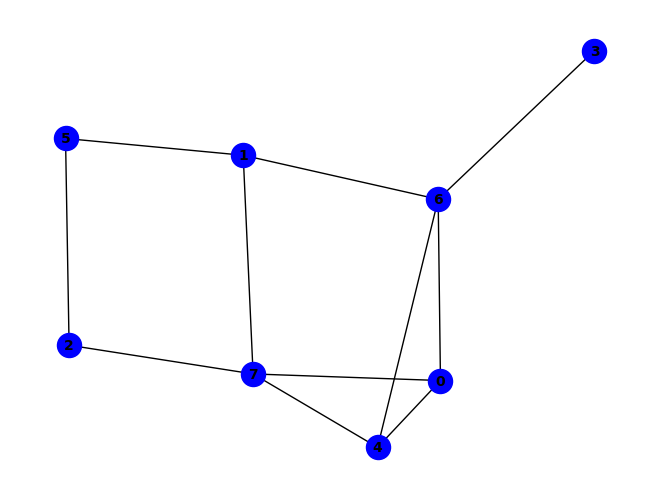


(b & h) ^ (d & ~g) ^ (b & c & g) ^ (~c & ~d) ^ (e & g & ~h) ^ (a & d & e & ~g) ^ (d & e & g & ~c) ^ (a & e & ~c & ~d) ^ (a & g & ~b & ~h) ^ (a & h & ~b & ~c) ^ (e & h & ~b & ~c) ^ (a & b & e & f & ~h) ^ (c & e & f & g & ~h) ^ (c & ~d & ~f & ~h) ^ (a & d & g & ~b & ~c) ^ (b & c & e & ~f & ~g) ^ (b & c & e & ~f & ~h) ^ (b & c & h & ~e & ~g) ^ (b & d & g & ~c & ~e) ^ (c & d & f & ~e & ~g) ^ (c & d & h & ~f & ~g) ^ (a & b & d & e & g & ~c) ^ (a & c & d & e & h & ~g) ^ (b & c & e & f & h & ~g) ^ (c & d & e & f & h & ~g) ^ (b & f & ~c & ~g & ~h) ^ (b & g & ~c & ~e & ~h) ^ (a & b & e & g & ~c & ~f) ^ (a & b & e & h & ~c & ~g) ^ (a & c & d & g & ~b & ~h) ^ (a & c & f & g & ~d & ~h) ^ (b & c & d & g & ~f & ~h) ^ (b & c & f & g & ~a & ~h) ^ (c & d & e & f & ~b & ~h) ^ (c & d & e & g & ~b & ~h) ^ (a & b & e & f & g & h & ~c) ^ (a & c & e & ~d & ~f & ~h) ^ (a & b & c & e & f & ~g & ~h) ^ (a & b & c & e & g & ~d & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (b & c & d & e & f & ~g & ~h) ^ (a & b & c & d

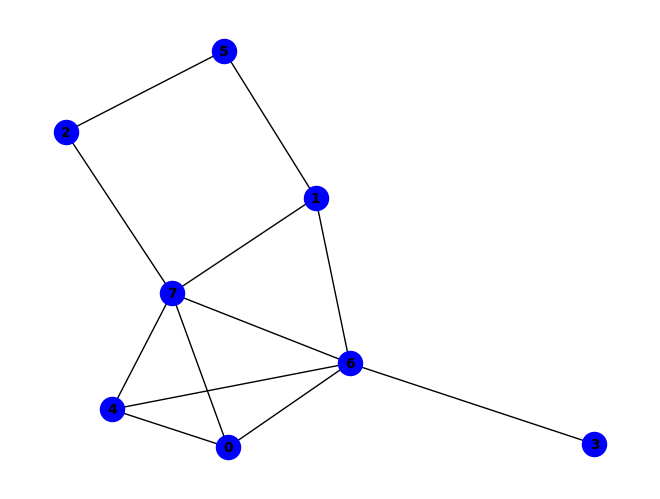


(a & h & ~c) ^ (b & f & ~h) ^ (b & g & ~f) ^ (e & h & ~c) ^ (b & c & e & h) ^ (b & f & g & h) ^ (d & ~e & ~h) ^ (g & ~c & ~h) ^ (b & c & g & ~h) ^ (a & b & c & f & h) ^ (a & b & e & g & h) ^ (~c & ~d & ~g) ^ (a & g & ~b & ~c) ^ (b & c & ~d & ~g) ^ (b & h & ~a & ~e) ^ (d & e & ~c & ~g) ^ (e & g & ~b & ~c) ^ (a & b & c & g & ~f) ^ (a & b & e & f & ~h) ^ (b & c & d & f & ~h) ^ (b & c & d & h & ~g) ^ (a & d & e & ~c & ~h) ^ (a & d & g & ~c & ~h) ^ (a & e & g & ~c & ~h) ^ (c & d & f & ~e & ~h) ^ (a & b & c & d & e & ~h) ^ (a & b & c & d & g & ~h) ^ (a & b & c & e & g & ~h) ^ (a & e & ~c & ~d & ~g) ^ (d & h & ~c & ~e & ~g) ^ (a & b & c & d & ~f & ~h) ^ (a & b & c & e & ~d & ~g) ^ (a & b & e & g & ~f & ~h) ^ (a & d & e & h & ~c & ~g) ^ (b & c & d & e & f & g & ~h) ^ (c & ~b & ~e & ~f & ~h) ^ (a & c & g & ~d & ~f & ~h) ^ (b & c & e & ~f & ~g & ~h) ^ (b & d & g & ~a & ~e & ~h) ^ (a & b & c & d & e & f & h & ~g) ^ (c & d & ~b & ~f & ~g & ~h) ^ (c & e & ~d & ~f & ~g & ~h) ^ (a & b & c & d & ~e &

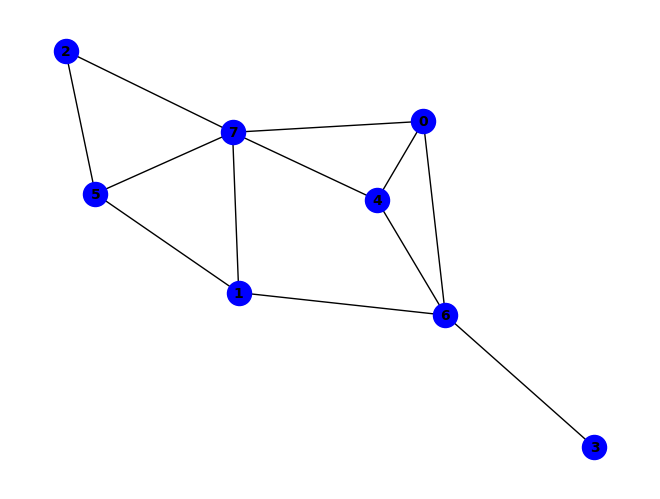


~f ^ (f & ~h) ^ (a & g & ~h) ^ (c & h & ~d) ^ (e & g & ~h) ^ (b & f & g & h) ^ (c & e & f & h) ^ (a & e & f & ~h) ^ (b & c & d & g & h) ^ (a & e & ~b & ~f) ^ (b & f & ~d & ~g) ^ (b & h & ~c & ~e) ^ (c & f & ~b & ~e) ^ (e & h & ~c & ~f) ^ (b & d & f & h & ~a) ^ (b & e & f & h & ~d) ^ (c & d & e & h & ~b) ^ (a & b & d & e & f & h) ^ (a & b & e & ~g & ~h) ^ (c & d & h & ~e & ~g) ^ (a & c & d & f & g & ~b) ^ (a & c & d & g & h & ~b) ^ (b & c & d & e & h & ~g) ^ (b & d & e & f & h & ~g) ^ (a & h & ~b & ~c & ~f) ^ (b & g & ~a & ~e & ~h) ^ (d & g & ~a & ~b & ~e) ^ (a & b & d & f & ~e & ~g) ^ (a & b & e & g & ~f & ~h) ^ (a & c & e & f & ~b & ~d) ^ (a & c & e & h & ~b & ~d) ^ (a & c & f & g & ~b & ~h) ^ (c & d & f & g & ~b & ~e) ^ (d & f & g & h & ~a & ~e) ^ (b & d & f & ~a & ~g & ~h) ^ (c & e & f & ~b & ~g & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (a & c & d & e & f & ~b & ~g) ^ (a & c & d & e & h & ~b & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

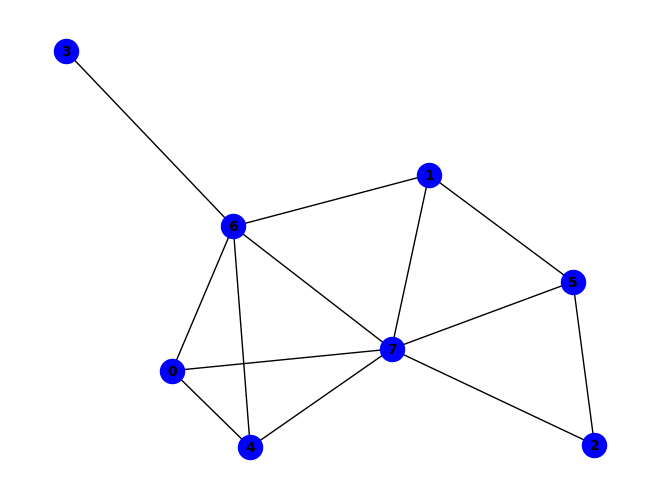


(g & ~h) ^ (~d & ~g) ^ (b & f & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (a & e & f & g) ^ (a & e & f & h) ^ (d & ~e & ~h) ^ (a & e & g & ~h) ^ (c & d & f & ~g) ^ (c & d & f & ~h) ^ (a & e & ~d & ~g) ^ (b & g & ~e & ~f) ^ (d & e & ~g & ~h) ^ (d & h & ~c & ~g) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & b & e & f & ~g) ^ (a & b & e & g & ~d) ^ (a & b & e & h & ~d) ^ (a & c & g & ~b & ~h) ^ (a & d & e & ~c & ~h) ^ (a & f & g & ~b & ~h) ^ (b & d & g & ~e & ~h) ^ (c & e & f & ~g & ~h) ^ (e & f & g & ~a & ~h) ^ (b & c & d & f & g & ~h) ^ (a & g & ~b & ~c & ~f) ^ (a & h & ~b & ~c & ~f) ^ (c & f & ~b & ~e & ~h) ^ (c & h & ~d & ~f & ~g) ^ (a & c & d & e & ~g & ~h) ^ (a & c & e & f & ~b & ~h) ^ (a & d & e & h & ~b & ~g) ^ (c & d & e & g & ~b & ~h) ^ (a & d & g & ~b & ~c & ~h) ^ (b & c & h & ~e & ~f & ~g) ^ (b & e & f & ~c & ~g & ~h) ^ (c & e & g & ~d & ~f & ~h) ^ (a & b & c & d & g & ~f & ~h) ^ (b & c & d & e & g & ~f & ~h) ^ (a & b & c & d & e & f & g & ~h) ^ (a & c & d & g & ~e & ~f & ~h) ^ (a

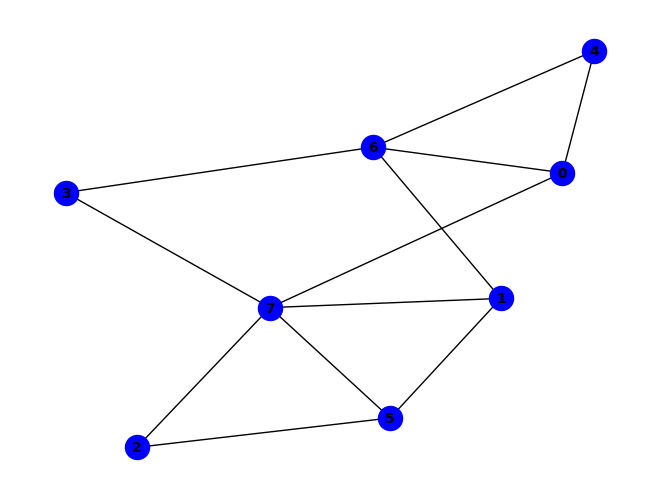


~f ^ (f & ~h) ^ (a & c & h) ^ (a & g & ~e) ^ (a & h & ~g) ^ (b & h & ~d) ^ (a & c & f & g) ^ (b & d & f & h) ^ (b & f & g & h) ^ (a & f & h & ~e) ^ (b & c & d & f & g) ^ (a & e & ~g & ~h) ^ (b & f & ~e & ~g) ^ (b & g & ~a & ~h) ^ (c & f & ~b & ~e) ^ (c & h & ~b & ~e) ^ (e & g & ~b & ~d) ^ (a & b & e & g & ~f) ^ (a & c & e & f & ~h) ^ (a & d & e & g & ~b) ^ (a & e & f & h & ~g) ^ (b & c & d & h & ~e) ^ (b & e & f & h & ~d) ^ (c & d & e & f & ~b) ^ (c & d & f & g & ~h) ^ (e & f & g & h & ~d) ^ (a & b & d & e & f & h) ^ (a & d & e & f & g & h) ^ (a & b & h & ~d & ~f) ^ (c & e & h & ~b & ~g) ^ (a & b & c & d & h & ~f) ^ (a & b & c & f & g & ~h) ^ (a & c & e & g & h & ~f) ^ (b & c & d & e & h & ~g) ^ (c & d & e & g & h & ~a) ^ (a & b & c & d & e & g & h) ^ (d & g & ~a & ~b & ~h) ^ (d & h & ~a & ~c & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & b & e & f & ~c & ~h) ^ (a & c & d & f & ~b & ~g) ^ (a & c & d & f & ~b & ~h) ^ (a & c & f & h & ~d & ~g) ^ (b & d & e & f & ~a & ~g) ^ (a & c & d & e & f 

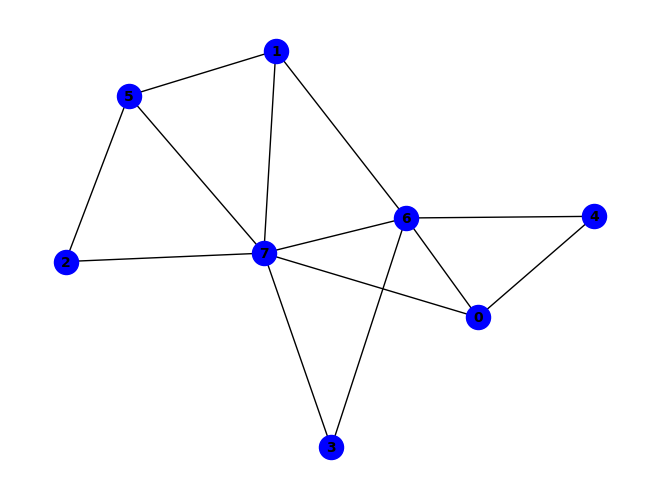


(g & ~h) ^ (~e & ~g) ^ (b & f & ~g) ^ (b & g & ~d) ^ (b & h & ~d) ^ (e & h & ~g) ^ (f & h & ~g) ^ (d & f & g & ~h) ^ (d & g & ~c & ~f) ^ (d & h & ~c & ~f) ^ (a & b & c & h & ~g) ^ (a & c & e & f & ~h) ^ (b & d & f & h & ~g) ^ (e & ~a & ~d & ~h) ^ (c & d & g & ~f & ~h) ^ (a & b & c & d & f & ~h) ^ (a & g & ~b & ~d & ~f) ^ (a & h & ~b & ~d & ~f) ^ (c & f & ~b & ~d & ~h) ^ (c & h & ~b & ~f & ~g) ^ (d & e & ~a & ~g & ~h) ^ (a & b & c & f & ~d & ~g) ^ (a & b & c & f & ~e & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & b & f & g & ~d & ~h) ^ (a & b & c & d & f & h & ~g) ^ (a & c & h & ~d & ~f & ~g) ^ (a & f & g & ~c & ~d & ~h) ^ (b & e & g & ~a & ~d & ~h) ^ (c & d & f & ~b & ~g & ~h) ^ (b & c & d & h & ~a & ~f & ~g) ^ (c & e & f & g & ~b & ~d & ~h) ^ (a & c & d & e & f & g & ~b & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


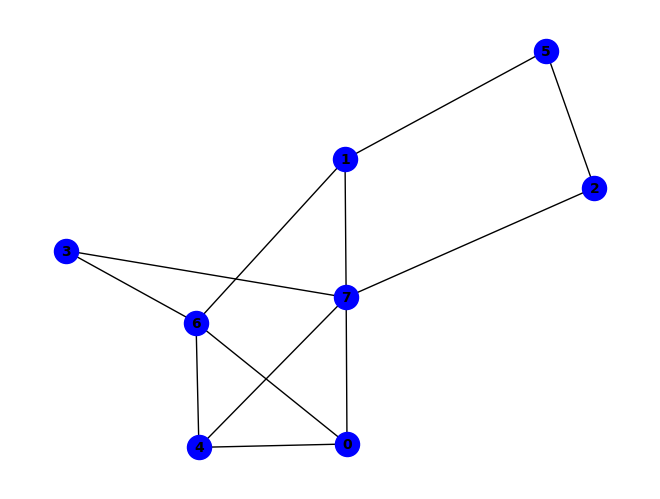


~d ^ (a & e & ~d) ^ (b & f & ~g) ^ (b & h & ~f) ^ (e & h & ~d) ^ (a & c & f & h) ^ (b & f & g & h) ^ (d & ~g & ~h) ^ (a & c & g & ~f) ^ (b & d & h & ~e) ^ (b & e & h & ~a) ^ (a & b & d & e & g) ^ (a & g & ~d & ~h) ^ (a & h & ~b & ~d) ^ (c & f & ~b & ~h) ^ (e & g & ~d & ~h) ^ (a & b & c & h & ~e) ^ (a & b & d & g & ~h) ^ (a & c & e & f & ~b) ^ (a & c & e & h & ~f) ^ (a & b & c & e & f & h) ^ (a & b & g & ~e & ~h) ^ (a & c & g & ~b & ~h) ^ (a & c & h & ~f & ~g) ^ (a & d & e & ~g & ~h) ^ (b & g & ~d & ~e & ~h) ^ (c & h & ~b & ~d & ~e) ^ (a & b & c & g & ~f & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & c & d & g & ~b & ~e) ^ (c & d & f & g & ~b & ~h) ^ (a & b & c & d & f & h & ~g) ^ (a & b & d & e & h & ~c & ~g) ^ (a & c & d & f & h & ~e & ~g) ^ (c & e & f & g & ~b & ~d & ~h) ^ (a & b & c & d & e & h & ~f & ~g) ^ (a & c & d & ~b & ~e & ~f & ~g) ^ (a & c & d & ~b & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

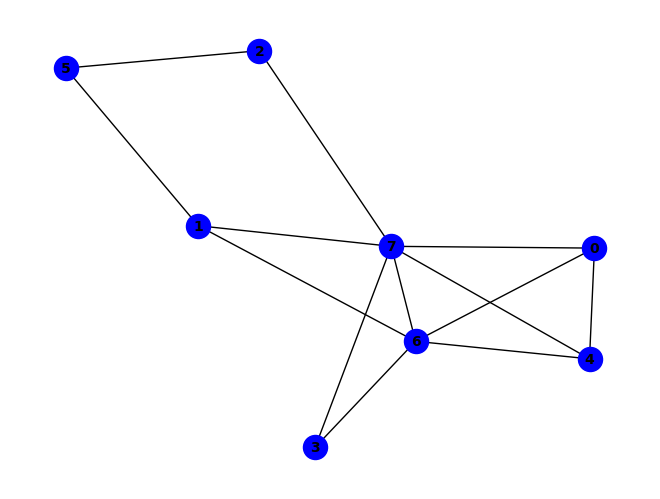


(~c & ~g) ^ (a & e & ~g) ^ (b & c & ~g) ^ (b & f & ~h) ^ (b & g & ~f) ^ (e & h & ~c) ^ (a & c & e & f) ^ (b & f & g & h) ^ (g & ~c & ~h) ^ (b & c & g & ~h) ^ (a & b & e & g & h) ^ (b & c & e & f & h) ^ (a & g & ~b & ~d) ^ (b & h & ~d & ~e) ^ (d & h & ~c & ~e) ^ (e & g & ~b & ~c) ^ (a & b & e & f & ~c) ^ (a & c & e & h & ~f) ^ (a & d & e & g & ~b) ^ (b & c & d & h & ~e) ^ (b & c & e & g & ~f) ^ (c & ~e & ~f & ~h) ^ (a & e & g & ~c & ~h) ^ (a & b & c & e & g & ~h) ^ (a & h & ~b & ~c & ~d) ^ (b & c & ~d & ~f & ~h) ^ (c & e & ~f & ~g & ~h) ^ (d & g & ~b & ~c & ~e) ^ (a & b & e & g & ~f & ~h) ^ (a & b & e & h & ~c & ~f) ^ (a & d & e & h & ~b & ~c) ^ (a & c & g & ~b & ~d & ~e) ^ (b & c & d & ~f & ~g & ~h) ^ (c & d & g & ~e & ~f & ~h) ^ (a & c & d & e & g & ~f & ~h) ^ (b & c & d & e & ~a & ~f & ~g) ^ (b & c & d & e & ~a & ~f & ~h) ^ (b & c & e & h & ~d & ~f & ~g) ^ (a & b & c & d & e & h & ~f & ~g) ^ (a & c & g & ~b & ~d & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


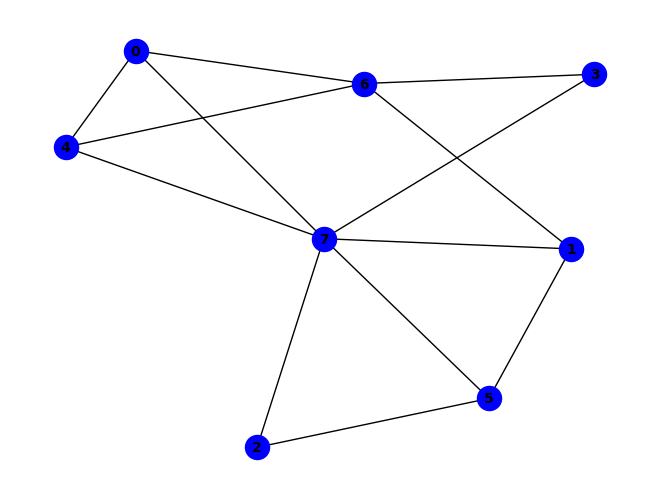


~f ^ (f & ~h) ^ (b & f & ~g) ^ (c & h & ~b) ^ (e & g & ~h) ^ (b & d & f & h) ^ (b & f & g & h) ^ (c & d & e & f & g) ^ (a & e & ~b & ~f) ^ (a & g & ~d & ~h) ^ (b & g & ~d & ~e) ^ (c & f & ~b & ~e) ^ (d & g & ~e & ~h) ^ (e & h & ~c & ~f) ^ (a & c & e & h & ~d) ^ (a & d & e & f & ~b) ^ (a & d & e & g & ~h) ^ (a & d & e & h & ~b) ^ (b & c & e & h & ~a) ^ (b & e & f & h & ~d) ^ (c & e & f & h & ~d) ^ (a & b & c & d & e & h) ^ (a & b & e & ~g & ~h) ^ (a & e & f & ~d & ~h) ^ (a & b & d & e & f & ~h) ^ (b & h & ~d & ~e & ~g) ^ (d & h & ~c & ~e & ~f) ^ (a & b & e & g & ~f & ~h) ^ (a & c & e & f & ~b & ~d) ^ (b & c & d & h & ~e & ~f) ^ (c & d & f & g & ~b & ~h) ^ (b & c & d & e & f & g & ~h) ^ (a & b & g & ~d & ~e & ~h) ^ (c & e & f & ~b & ~g & ~h) ^ (a & c & d & e & f & ~b & ~g) ^ (c & d & e & f & h & ~a & ~g) ^ (a & b & c & d & e & f & h & ~g) ^ (a & h & ~b & ~c & ~d & ~f) ^ (a & c & f & g & ~b & ~d & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PA

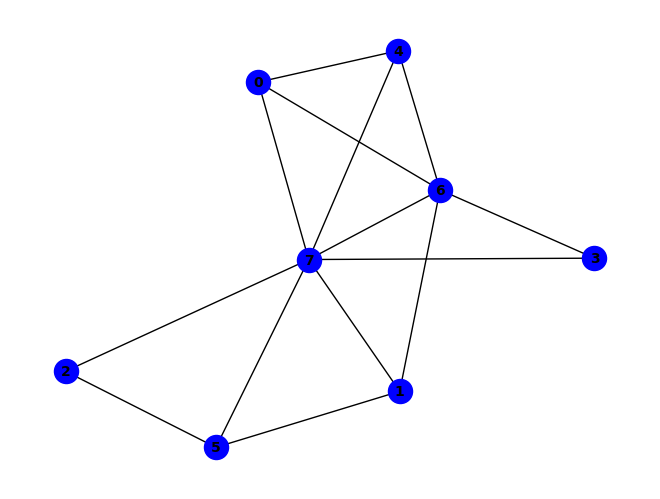


~g ^ (g & ~h) ^ (a & e & ~g) ^ (b & f & ~g) ^ (b & g & ~e) ^ (b & h & ~e) ^ (f & h & ~g) ^ (a & e & f & g) ^ (a & e & f & h) ^ (a & e & g & ~h) ^ (e & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & b & e & f & ~g) ^ (a & b & e & g & ~d) ^ (a & b & e & h & ~d) ^ (b & c & d & h & ~g) ^ (b & e & f & h & ~g) ^ (c & e & g & ~f & ~h) ^ (e & f & g & ~a & ~h) ^ (a & b & c & d & f & ~h) ^ (a & g & ~b & ~d & ~f) ^ (a & h & ~b & ~d & ~f) ^ (c & f & ~b & ~e & ~h) ^ (c & h & ~d & ~f & ~g) ^ (d & g & ~b & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & b & c & f & ~e & ~h) ^ (a & d & e & g & ~c & ~f) ^ (a & d & e & h & ~c & ~f) ^ (b & c & d & f & ~e & ~g) ^ (b & c & d & f & ~e & ~h) ^ (b & d & f & g & ~e & ~h) ^ (a & b & c & d & e & h & ~g) ^ (a & b & d & e & f & g & ~c) ^ (a & b & d & e & f & h & ~c) ^ (b & c & d & e & f & h & ~g) ^ (a & c & f & ~b & ~d & ~g) ^ (a & c & f & ~d & ~e & ~h) ^ (a & c & h & ~b & ~d & ~g) ^ (a & f & g & ~b & ~d & ~h) ^ (b & c & h & ~e & ~f & ~g) ^ (c & e & f & ~b & ~g & ~h) ^ (d & f 

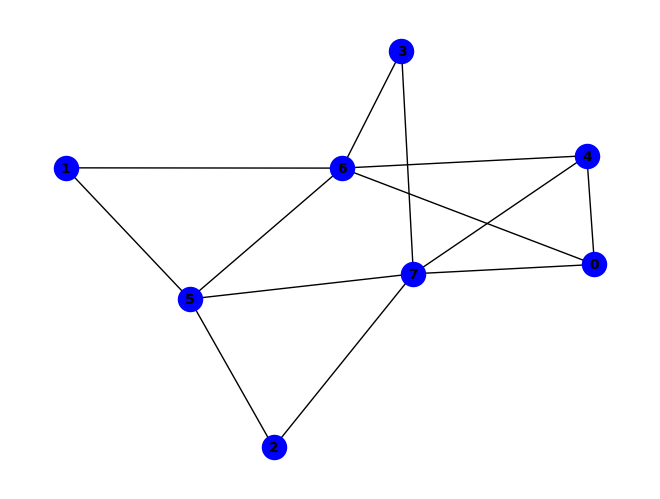


~e ^ (a & e & ~d) ^ (f & h & ~e) ^ (b & e & f & g) ^ (b & f & g & h) ^ (e & ~g & ~h) ^ (b & f & ~c & ~h) ^ (b & g & ~a & ~e) ^ (c & f & ~g & ~h) ^ (d & h & ~e & ~f) ^ (f & g & ~e & ~h) ^ (a & b & f & g & ~e) ^ (a & e & f & h & ~d) ^ (b & c & f & g & ~h) ^ (a & c & e & ~f & ~g) ^ (a & d & e & ~g & ~h) ^ (a & c & d & e & h & ~f) ^ (a & c & e & g & h & ~f) ^ (a & g & ~d & ~f & ~h) ^ (a & h & ~c & ~d & ~f) ^ (c & h & ~d & ~e & ~f) ^ (d & g & ~e & ~f & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & e & f & g & ~d & ~h) ^ (a & c & e & ~b & ~g & ~h) ^ (b & d & g & ~a & ~e & ~f) ^ (a & b & c & e & ~f & ~g & ~h) ^ (b & c & g & h & ~a & ~d & ~e & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


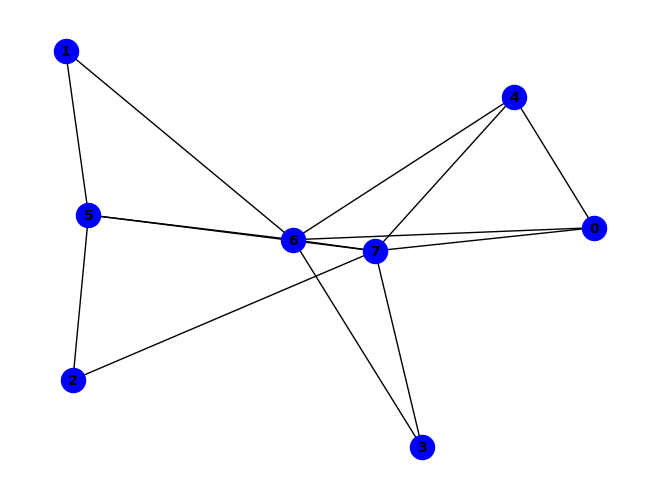


(f & g) ^ (f & h) ^ (~b & ~g) ^ (c & f & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (g & ~c & ~h) ^ (c & e & g & ~h) ^ (b & e & ~f & ~g) ^ (b & h & ~e & ~g) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (d & g & ~e & ~f) ^ (d & h & ~e & ~f) ^ (b & e & f & h & ~g) ^ (c & e & f & h & ~g) ^ (b & ~e & ~f & ~h) ^ (a & b & e & ~f & ~h) ^ (a & b & e & ~g & ~h) ^ (a & c & g & ~e & ~h) ^ (a & e & ~c & ~g & ~h) ^ (a & g & ~d & ~e & ~f) ^ (a & h & ~d & ~e & ~f) ^ (a & c & f & h & ~e & ~g) ^ (a & b & g & ~d & ~f & ~h) ^ (a & c & e & ~f & ~g & ~h) ^ (b & c & f & ~a & ~g & ~h) ^ (b & d & g & ~e & ~f & ~h) ^ (a & b & d & e & g & ~f & ~h) ^ (a & b & c & f & ~e & ~g & ~h) ^ (c & d & h & ~a & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


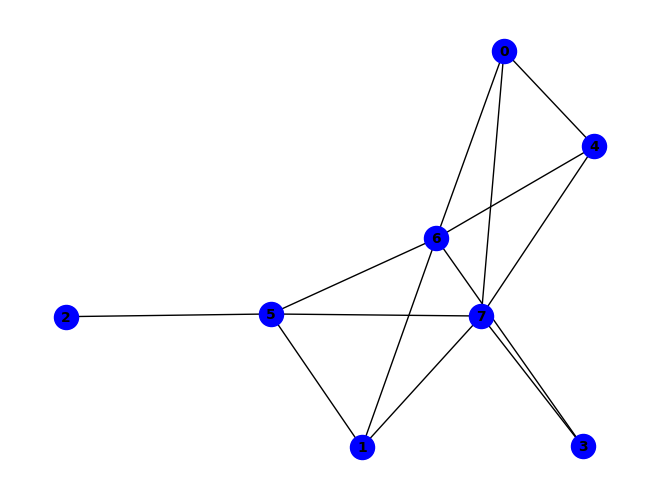


~e ^ (a & e & ~d) ^ (b & f & ~e) ^ (b & h & ~e) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (a & b & h & ~f) ^ (a & h & ~d & ~f) ^ (b & g & ~e & ~h) ^ (d & h & ~e & ~f) ^ (f & g & ~e & ~h) ^ (a & b & e & f & ~d) ^ (a & b & e & g & ~d) ^ (a & e & f & g & ~d) ^ (b & d & e & g & ~f) ^ (a & d & e & ~g & ~h) ^ (b & d & g & ~f & ~h) ^ (b & d & h & ~a & ~f) ^ (b & e & f & ~g & ~h) ^ (c & f & ~b & ~g & ~h) ^ (d & g & ~e & ~f & ~h) ^ (a & b & e & h & ~d & ~g) ^ (a & e & f & h & ~d & ~g) ^ (b & d & e & h & ~f & ~g) ^ (a & b & d & e & f & ~g & ~h) ^ (a & g & ~b & ~d & ~f & ~h) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


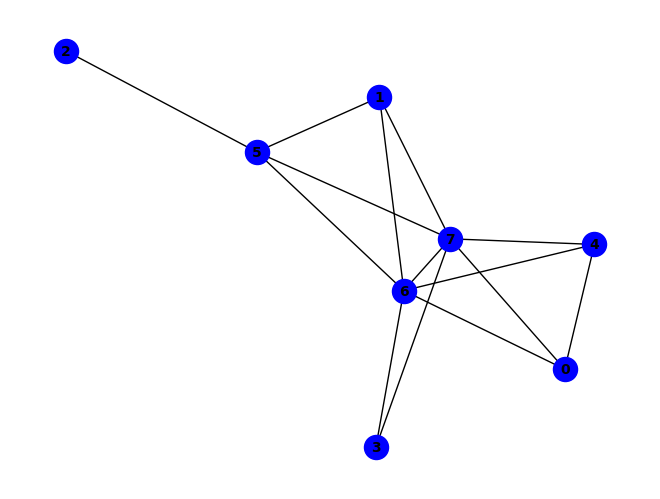


~g ^ (f & g) ^ (f & h) ^ (g & ~h) ^ (b & f & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (b & e & f & g) ^ (b & f & g & ~h) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (d & h & ~e & ~f) ^ (a & b & f & g & ~e) ^ (a & b & f & h & ~e) ^ (b & d & e & h & ~a) ^ (b & e & f & h & ~d) ^ (a & b & d & e & f & h) ^ (b & d & h & ~a & ~f) ^ (a & e & ~b & ~g & ~h) ^ (a & g & ~d & ~e & ~f) ^ (a & h & ~d & ~e & ~f) ^ (c & f & ~b & ~g & ~h) ^ (d & g & ~b & ~e & ~f) ^ (a & b & d & g & ~e & ~f) ^ (a & b & e & ~f & ~g & ~h) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


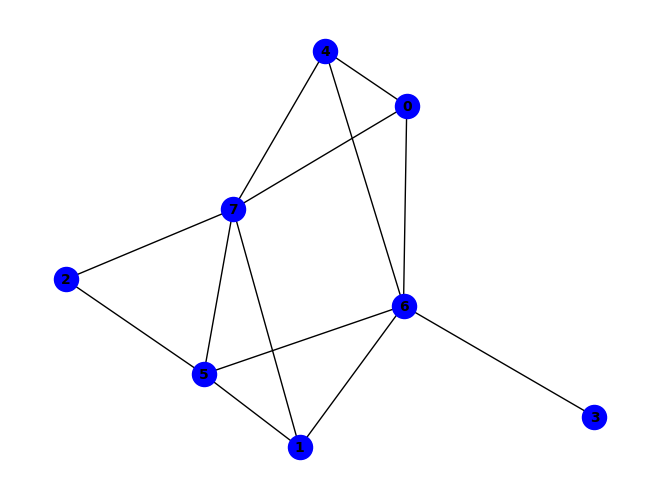


~e ^ (a & e & ~d) ^ (b & f & ~e) ^ (b & g & ~e) ^ (f & h & ~e) ^ (a & b & e & h) ^ (a & e & f & h) ^ (e & ~g & ~h) ^ (a & b & d & e & g) ^ (a & h & ~b & ~f) ^ (b & h & ~e & ~g) ^ (f & g & ~e & ~h) ^ (a & b & e & f & ~d) ^ (a & b & e & g & ~h) ^ (a & d & e & f & ~c) ^ (a & e & f & g & ~h) ^ (c & d & f & h & ~e) ^ (c & d & g & h & ~e) ^ (b & c & d & e & g & h) ^ (a & d & e & ~f & ~g) ^ (a & d & g & ~b & ~f) ^ (b & c & f & ~g & ~h) ^ (b & e & f & ~g & ~h) ^ (c & d & f & ~e & ~g) ^ (a & c & d & e & f & ~g) ^ (b & c & d & e & f & ~g) ^ (b & c & d & g & h & ~f) ^ (a & g & ~b & ~f & ~h) ^ (c & f & ~d & ~g & ~h) ^ (d & g & ~b & ~e & ~f) ^ (a & c & d & e & f & g & ~h) ^ (a & c & d & e & g & h & ~b) ^ (b & c & d & e & f & h & ~a) ^ (a & b & d & e & f & ~c & ~g) ^ (a & c & d & g & h & ~b & ~f) ^ (c & h & ~a & ~b & ~e & ~f) ^ (a & c & e & f & ~b & ~g & ~h) ^ (c & d & e & f & ~b & ~g & ~h) ^ (a & b & c & d & e & f & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

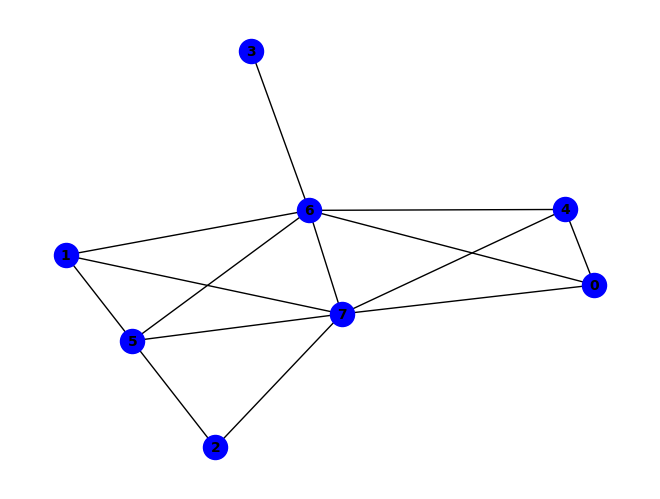


(f & g) ^ (f & h) ^ (g & ~h) ^ (~d & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (d & ~f & ~h) ^ (b & f & g & ~h) ^ (a & g & ~e & ~f) ^ (a & h & ~e & ~f) ^ (b & f & ~d & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & f & ~b & ~g) ^ (d & f & ~e & ~g) ^ (d & h & ~f & ~g) ^ (a & b & f & g & ~e) ^ (a & b & f & h & ~e) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & e & f & h & ~g) ^ (d & e & f & h & ~g) ^ (a & d & g & ~f & ~h) ^ (d & e & f & ~a & ~h) ^ (d & e & g & ~a & ~h) ^ (b & c & e & f & g & ~h) ^ (a & e & ~b & ~g & ~h) ^ (c & h & ~b & ~e & ~g) ^ (a & b & d & f & ~e & ~g) ^ (a & d & e & f & ~g & ~h) ^ (b & d & e & f & ~g & ~h) ^ (b & d & f & h & ~a & ~g) ^ (a & b & d & e & f & h & ~g) ^ (a & b & e & ~f & ~g & ~h) ^ (b & d & f & ~a & ~e & ~h) ^ (b & d & g & ~a & ~e & ~h) ^ (a & c & e & f & ~b & ~g & ~h) ^ (a & c & h & ~b & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS

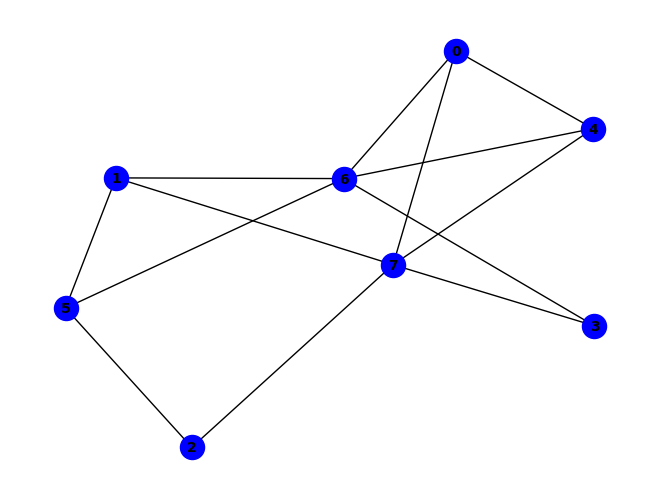


(~c & ~f) ^ (a & h & ~d) ^ (b & f & ~h) ^ (e & g & ~h) ^ (e & h & ~c) ^ (b & f & g & h) ^ (c & ~f & ~h) ^ (f & ~c & ~g) ^ (a & f & g & ~d) ^ (e & f & g & ~b) ^ (a & b & d & e & h) ^ (c & e & f & g & h) ^ (a & e & ~c & ~f) ^ (a & g & ~d & ~h) ^ (b & h & ~a & ~e) ^ (d & g & ~e & ~h) ^ (d & h & ~b & ~e) ^ (a & b & c & e & ~d) ^ (a & b & d & g & ~f) ^ (a & b & d & h & ~g) ^ (a & b & f & g & ~e) ^ (a & d & e & h & ~c) ^ (a & b & c & e & f & g) ^ (a & b & g & ~e & ~h) ^ (a & e & f & ~c & ~g) ^ (b & c & f & ~e & ~g) ^ (b & c & h & ~e & ~f) ^ (d & f & g & ~b & ~e) ^ (a & b & c & d & e & ~h) ^ (a & d & e & f & g & ~b) ^ (b & c & d & f & h & ~g) ^ (a & b & c & d & e & f & h) ^ (a & c & d & e & f & g & h) ^ (b & g & ~d & ~e & ~h) ^ (a & b & e & f & ~g & ~h) ^ (a & d & e & g & ~b & ~h) ^ (c & d & f & h & ~e & ~g) ^ (a & c & e & ~b & ~f & ~h) ^ (a & c & h & ~b & ~d & ~f) ^ (c & d & h & ~b & ~e & ~f) ^ (b & c & d & e & f & ~a & ~g) ^ (a & c & f & h & ~b & ~d & ~g) ^ (b & c & e & f & ~d & ~g & ~h) ^

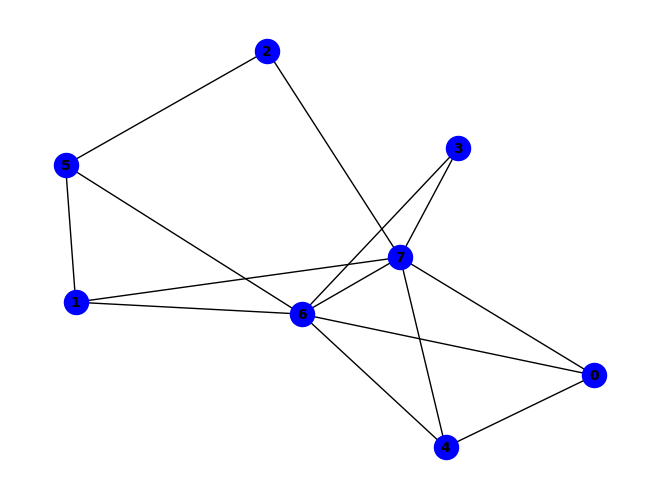


(g & ~h) ^ (~f & ~g) ^ (a & h & ~d) ^ (d & g & ~f) ^ (d & h & ~f) ^ (e & g & ~d) ^ (e & h & ~d) ^ (a & e & f & g & h) ^ (a & e & ~c & ~f) ^ (a & g & ~d & ~e) ^ (b & g & ~d & ~e) ^ (b & h & ~d & ~e) ^ (f & h & ~d & ~g) ^ (a & b & c & g & ~h) ^ (a & b & d & g & ~f) ^ (a & b & d & h & ~f) ^ (a & b & f & g & ~h) ^ (a & c & e & h & ~f) ^ (a & d & e & f & ~h) ^ (d & e & f & g & ~h) ^ (a & c & d & e & g & h) ^ (f & ~b & ~e & ~h) ^ (a & b & g & ~c & ~e) ^ (a & b & h & ~c & ~e) ^ (a & c & e & ~b & ~h) ^ (a & c & h & ~e & ~g) ^ (a & e & f & ~d & ~g) ^ (a & e & g & ~c & ~h) ^ (a & f & g & ~d & ~h) ^ (a & b & d & e & g & ~c) ^ (a & b & d & f & h & ~g) ^ (a & d & e & f & h & ~g) ^ (c & f & ~b & ~g & ~h) ^ (e & f & ~b & ~g & ~h) ^ (a & b & e & f & ~d & ~h) ^ (a & c & d & h & ~b & ~g) ^ (a & c & e & g & ~f & ~h) ^ (a & d & e & h & ~b & ~c) ^ (b & d & f & g & ~e & ~h) ^ (a & b & c & d & e & g & ~h) ^ (a & b & d & e & f & ~g & ~h) ^ (c & h & ~b & ~d & ~e & ~g) ^ (a & b & c & e & ~f & ~g & ~h)
PASS
PAS

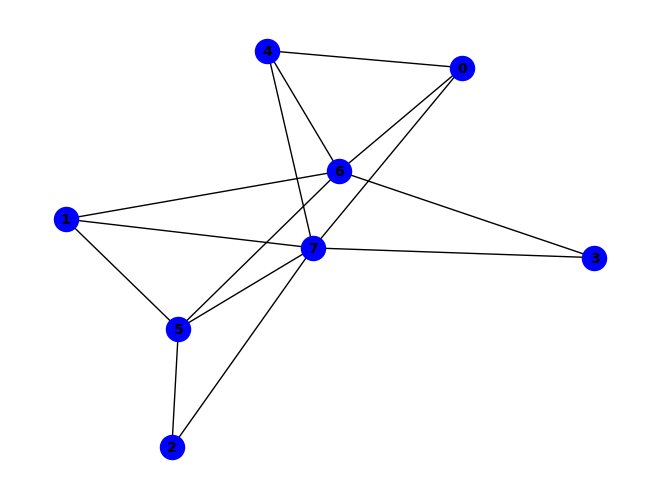


~e ^ (a & e & ~d) ^ (b & f & ~e) ^ (f & h & ~e) ^ (e & ~g & ~h) ^ (b & c & f & ~g) ^ (b & c & f & g & h) ^ (b & g & ~e & ~h) ^ (b & h & ~c & ~e) ^ (c & f & ~g & ~h) ^ (f & g & ~e & ~h) ^ (a & b & e & f & ~d) ^ (a & b & e & g & ~d) ^ (a & e & f & g & ~d) ^ (a & d & e & ~g & ~h) ^ (b & e & f & ~g & ~h) ^ (b & c & d & e & h & ~a) ^ (b & c & e & f & h & ~d) ^ (a & b & c & d & e & f & h) ^ (a & h & ~b & ~d & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & b & c & h & ~e & ~f) ^ (a & b & e & h & ~d & ~g) ^ (a & e & f & h & ~d & ~g) ^ (b & c & d & h & ~a & ~f) ^ (a & b & d & e & f & ~g & ~h) ^ (a & g & ~b & ~d & ~f & ~h) ^ (c & h & ~a & ~d & ~e & ~f) ^ (d & g & ~b & ~e & ~f & ~h) ^ (a & c & e & f & ~b & ~g & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


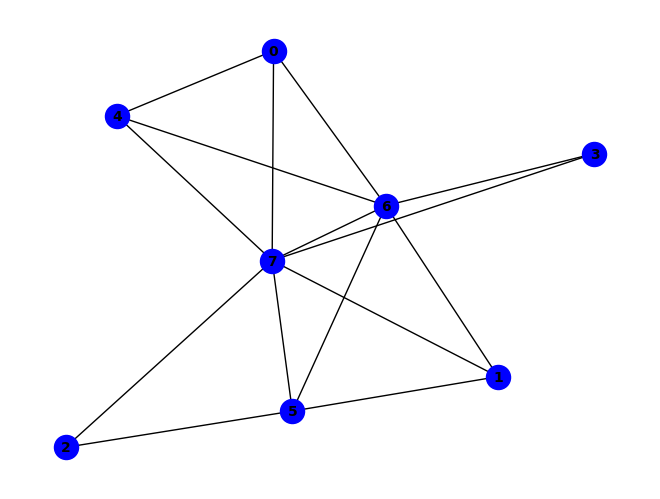


~g ^ (f & g) ^ (f & h) ^ (c & f & ~g) ^ (e & g & ~f) ^ (e & h & ~f) ^ (g & ~c & ~h) ^ (b & f & g & ~h) ^ (c & e & g & ~h) ^ (b & f & ~c & ~g) ^ (b & g & ~a & ~e) ^ (b & h & ~a & ~e) ^ (c & g & ~a & ~e) ^ (c & h & ~a & ~e) ^ (a & b & c & g & ~d) ^ (a & b & f & h & ~e) ^ (b & e & f & g & ~c) ^ (b & e & f & h & ~c) ^ (c & e & f & h & ~g) ^ (b & c & h & ~e & ~g) ^ (a & b & c & d & e & ~g) ^ (b & c & d & e & h & ~g) ^ (a & b & c & d & f & g & h) ^ (a & b & c & e & f & g & h) ^ (a & e & ~c & ~g & ~h) ^ (a & g & ~d & ~e & ~f) ^ (a & h & ~d & ~e & ~f) ^ (d & g & ~b & ~e & ~f) ^ (d & h & ~b & ~e & ~f) ^ (a & b & c & e & ~d & ~h) ^ (a & b & c & e & ~f & ~g) ^ (a & b & c & h & ~d & ~f) ^ (a & b & d & g & ~e & ~f) ^ (a & b & d & h & ~e & ~f) ^ (a & b & e & f & ~g & ~h) ^ (a & b & f & g & ~c & ~e) ^ (a & c & f & h & ~e & ~g) ^ (b & c & d & h & ~f & ~g) ^ (b & c & d & e & f & g & ~a) ^ (b & c & d & e & f & h & ~a) ^ (a & c & e & ~f & ~g & ~h) ^ (a & c & g & ~b & ~e & ~h) ^ (a & b & c & d & g & ~e &

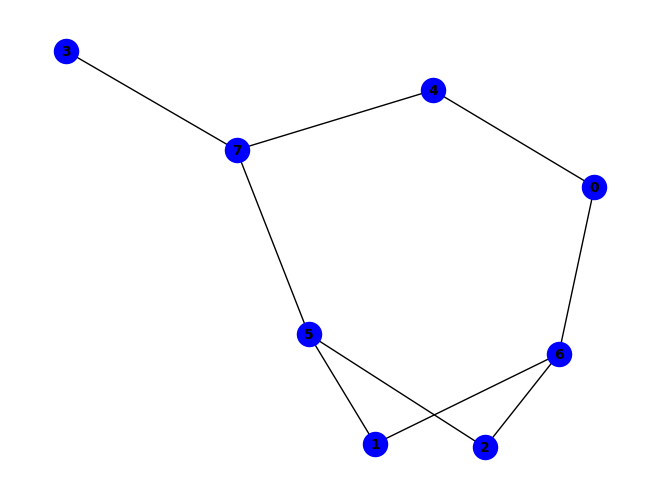


(~c & ~f) ^ (c & ~f & ~g) ^ (f & ~c & ~h) ^ (a & b & g & ~c) ^ (a & g & ~c & ~e) ^ (b & g & ~c & ~f) ^ (e & h & ~c & ~f) ^ (a & e & f & g & ~b) ^ (b & d & f & g & ~c) ^ (a & b & c & e & f & g) ^ (a & c & d & e & f & g) ^ (a & c & e & f & g & h) ^ (c & e & h & ~f & ~g) ^ (a & d & e & f & h & ~b) ^ (a & d & e & g & h & ~c) ^ (a & e & ~c & ~f & ~h) ^ (b & f & ~c & ~d & ~h) ^ (d & h & ~c & ~e & ~f) ^ (a & b & e & f & ~c & ~h) ^ (a & c & e & f & ~d & ~h) ^ (a & d & e & f & ~b & ~g) ^ (a & f & g & h & ~b & ~c) ^ (b & d & g & h & ~c & ~e) ^ (b & e & g & h & ~c & ~f) ^ (b & d & e & f & g & h & ~c) ^ (a & b & c & d & e & f & g & h) ^ (a & c & e & ~f & ~g & ~h) ^ (a & e & f & ~d & ~g & ~h) ^ (b & d & f & ~c & ~g & ~h) ^ (c & d & h & ~e & ~f & ~g) ^ (a & b & d & e & f & ~g & ~h) ^ (a & b & e & g & h & ~c & ~d) ^ (a & c & d & e & f & ~g & ~h) ^ (a & d & g & h & ~b & ~c & ~f)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PAS

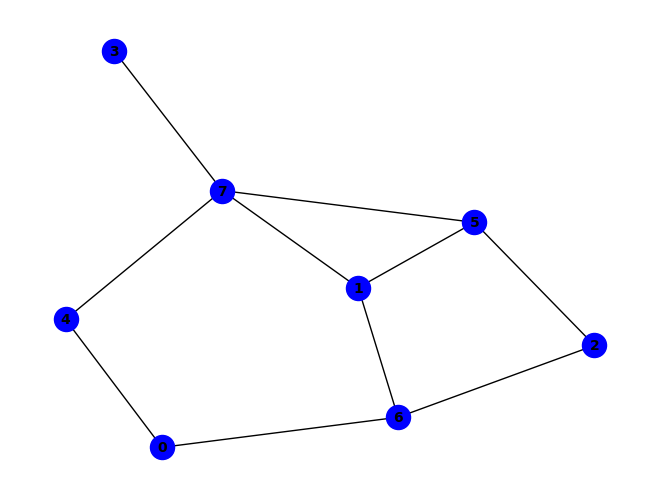


(a & b & g) ^ (~c & ~f) ^ (a & g & ~e) ^ (b & g & ~h) ^ (b & h & ~e) ^ (b & f & g & h) ^ (c & ~f & ~g) ^ (f & ~c & ~h) ^ (a & c & g & ~b) ^ (b & c & f & ~h) ^ (b & c & g & ~f) ^ (b & d & h & ~f) ^ (a & b & e & g & h) ^ (a & d & e & g & h) ^ (a & e & ~f & ~h) ^ (b & f & ~a & ~g) ^ (e & h & ~c & ~f) ^ (a & b & f & h & ~d) ^ (a & c & e & f & ~h) ^ (a & f & g & h & ~c) ^ (b & d & e & h & ~c) ^ (b & e & f & h & ~d) ^ (c & e & h & ~f & ~g) ^ (a & b & d & g & h & ~e) ^ (a & c & e & g & h & ~d) ^ (b & c & d & e & h & ~g) ^ (a & b & c & d & e & g & h) ^ (b & c & d & e & f & g & h) ^ (d & h & ~c & ~e & ~f) ^ (a & b & d & f & ~e & ~g) ^ (a & b & e & f & ~c & ~h) ^ (a & d & e & f & ~c & ~g) ^ (a & d & g & h & ~c & ~f) ^ (a & e & f & g & ~b & ~c) ^ (a & b & c & f & g & h & ~e) ^ (a & b & f & ~d & ~g & ~h) ^ (a & e & f & ~d & ~g & ~h) ^ (c & d & h & ~e & ~f & ~g) ^ (a & b & d & e & f & ~g & ~h) ^ (a & c & d & e & f & ~g & ~h) ^ (a & d & e & f & h & ~b & ~c) ^ (b & c & d & g & h & ~a & ~f) ^ (b & c 

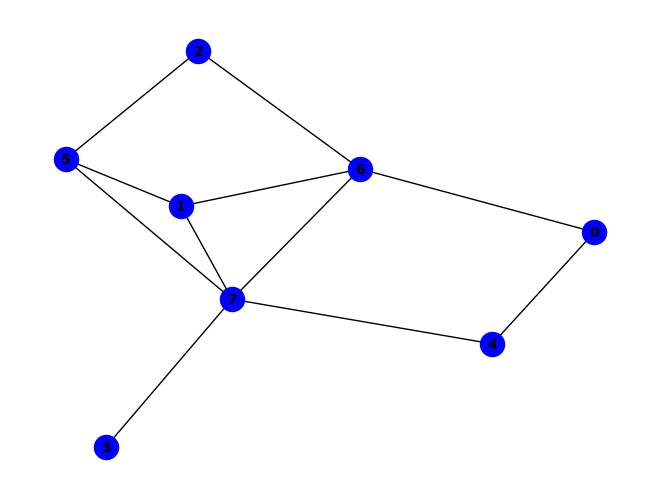


(~c & ~g) ^ (b & f & ~e) ^ (b & g & ~f) ^ (b & h & ~e) ^ (f & h & ~g) ^ (g & ~a & ~h) ^ (b & c & g & ~h) ^ (b & e & f & ~h) ^ (a & c & ~b & ~g) ^ (a & e & ~g & ~h) ^ (c & h & ~a & ~g) ^ (e & h & ~f & ~g) ^ (a & b & c & h & ~g) ^ (a & b & e & g & ~h) ^ (b & e & g & h & ~f) ^ (c & ~a & ~f & ~h) ^ (a & b & f & ~e & ~h) ^ (a & b & f & ~g & ~h) ^ (b & c & f & ~g & ~h) ^ (c & f & g & ~a & ~h) ^ (a & b & c & f & g & ~h) ^ (a & b & c & e & ~f & ~h) ^ (a & b & c & ~e & ~g & ~h) ^ (a & c & f & ~e & ~g & ~h) ^ (d & h & ~b & ~e & ~f & ~g) ^ (a & b & g & ~c & ~e & ~f & ~h)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


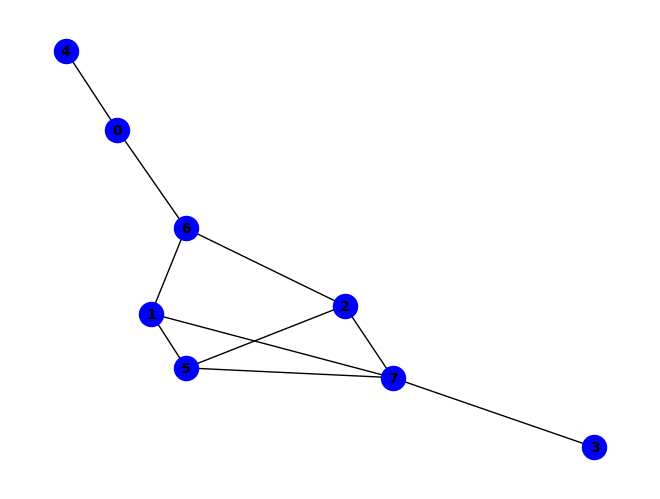


(b & f & ~g) ^ (b & c & d & h) ^ (b & d & f & h) ^ (a & ~e & ~g) ^ (f & ~a & ~h) ^ (b & c & h & ~g) ^ (~a & ~c & ~f) ^ (b & g & ~a & ~h) ^ (b & h & ~a & ~d) ^ (a & b & e & f & ~g) ^ (a & b & d & f & g & h) ^ (c & ~a & ~g & ~h) ^ (a & c & h & ~e & ~g) ^ (a & f & h & ~e & ~g) ^ (b & c & f & ~a & ~d) ^ (b & c & g & ~a & ~f) ^ (c & f & g & ~a & ~h) ^ (a & b & c & e & h & ~g) ^ (d & h & ~a & ~c & ~f) ^ (b & c & d & f & ~a & ~h) ^ (b & f & g & h & ~a & ~c) ^ (a & b & c & d & e & h & ~f) ^ (a & b & c & d & f & h & ~g) ^ (a & b & c & d & g & h & ~e) ^ (a & b & d & e & f & h & ~g) ^ (a & b & c & d & e & f & g & h) ^ (a & b & h & ~d & ~e & ~g) ^ (a & c & f & ~b & ~e & ~g) ^ (a & d & h & ~c & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


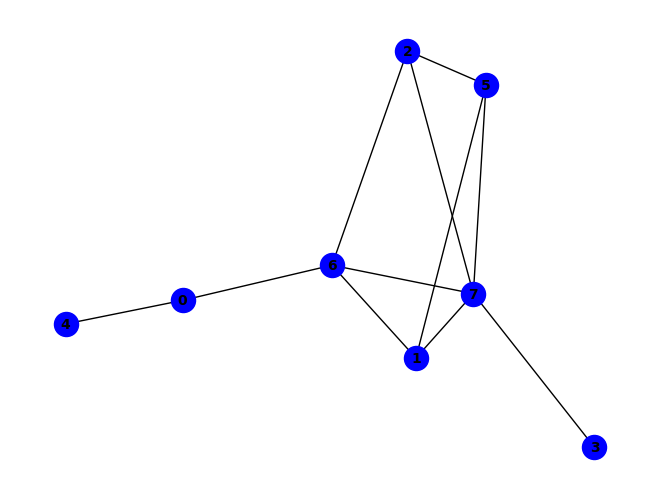


(~c & ~g) ^ (a & e & ~g) ^ (a & g & ~h) ^ (b & f & ~d) ^ (a & b & e & f) ^ (a & b & e & h) ^ (g & ~c & ~h) ^ (b & c & g & ~d) ^ (b & d & f & ~h) ^ (b & g & ~a & ~f) ^ (b & h & ~c & ~d) ^ (f & h & ~c & ~g) ^ (a & c & e & f & ~g) ^ (a & c & e & g & ~b) ^ (a & c & e & h & ~b) ^ (a & e & f & h & ~g) ^ (b & c & d & g & ~h) ^ (b & d & g & h & ~f) ^ (c & ~f & ~g & ~h) ^ (b & c & f & ~a & ~g) ^ (b & c & d & f & h & ~g) ^ (d & h & ~c & ~f & ~g) ^ (a & b & c & f & ~e & ~g) ^ (a & b & d & h & ~e & ~f) ^ (a & b & f & g & ~d & ~e) ^ (a & b & g & h & ~d & ~e) ^ (a & c & g & ~b & ~e & ~h) ^ (a & b & d & f & g & ~e & ~h) ^ (a & b & d & h & ~c & ~f & ~g) ^ (a & d & e & h & ~c & ~f & ~g) ^ (a & b & c & d & h & ~e & ~f & ~g)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


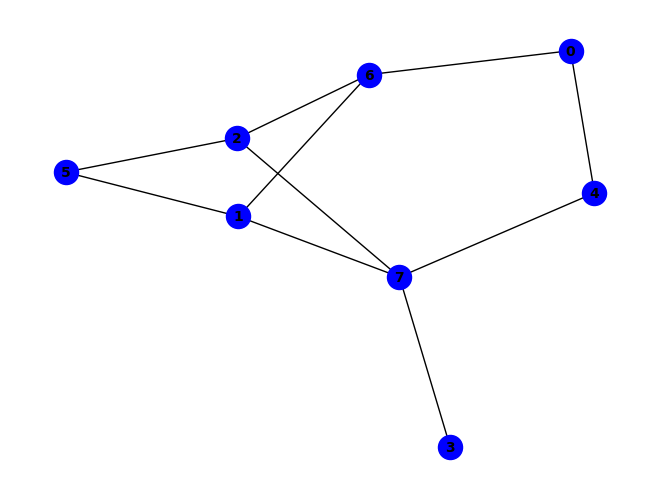


(~c & ~e) ^ (a & e & ~h) ^ (b & f & ~g) ^ (b & h & ~f) ^ (e & ~c & ~h) ^ (b & c & g & ~f) ^ (b & c & h & ~g) ^ (b & d & h & ~c) ^ (a & g & ~c & ~e) ^ (b & g & ~a & ~h) ^ (d & h & ~c & ~e) ^ (a & c & e & f & ~h) ^ (b & f & g & h & ~c) ^ (c & ~f & ~g & ~h) ^ (a & b & f & ~g & ~h) ^ (b & c & f & ~a & ~h) ^ (b & e & h & ~c & ~d) ^ (a & b & c & g & ~f & ~h) ^ (a & b & f & g & ~c & ~e) ^ (a & c & e & g & ~f & ~h) ^ (a & b & f & ~c & ~e & ~h) ^ (a & b & g & h & ~c & ~e & ~f) ^ (a & d & g & h & ~b & ~c & ~e)
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS
PASS


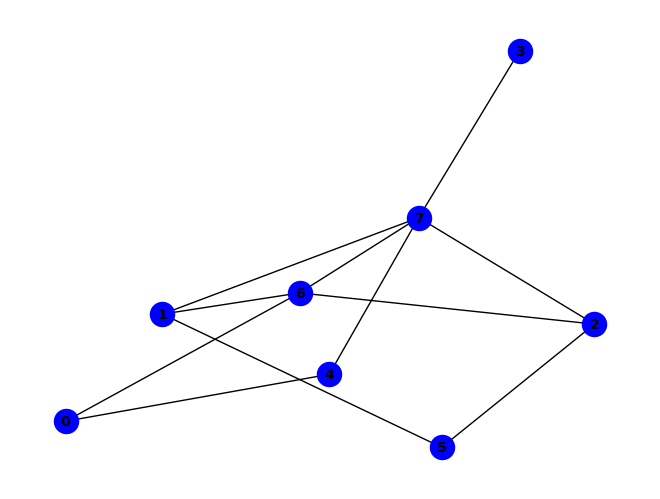

In [ ]:
# this code tests the validity of ESOPS for every every graph of numNodes # of verticies


## ADJUST THESE TO YOUR LIKING
numNodes = 8
problemType = "MIS"          # can be MIS or MVC

graphInstance = GraphGenerator()
thisGraphArray = graphInstance.createKgraphs(numNodes) 

z = 0
while (z < len(thisGraphArray)):    #go through every single graph of numNodes # of verticies, [0,len(graphArray)]
    currGraphio = graphInstance.chooseGraph(z)
    graphInstance.printGraph()
    
    problemInstance = BooleanInstance(problemType, currGraphio)
    mins = problemInstance.getTT() #returns minterms and adds TT attribute to instance

    Reed = problemInstance.getRM("mixed")
    esopNew = problemInstance.produceExpression(Reed)
    BooleanInstanceTest(esopNew, mins)
    z+=1


You will notice that there are no fails for any graph in any problem (that I've bothered to look at...) hence, the conversion from Boolean Instance to ESOP is valid.
